In [1]:
# Imports
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')
from pathlib import Path
import csv
from time import time
import datetime
import numpy as np
import pandas as pd
import pandas_datareader.data as web
import matplotlib.pyplot as plt
import seaborn as sns

import backtrader as bt
from backtrader.feeds import PandasData

import pyfolio as pf

In [2]:
OHLCV = ['open', 'high', 'low', 'close', 'volume']
idx = pd.IndexSlice

In [4]:
# Getting S&P500 data
benchmark = web.DataReader('SP500', 'fred', '2014',).squeeze()
benchmark = benchmark.pct_change().tz_localize('UTC')

### Backtesting: Ridge Regression

In [377]:
# Initiating Cerebro
cerebro = bt.Cerebro()
cash = 100000
cerebro.broker.setcash(cash)

In [378]:
# Defining input
class SignalData(PandasData):
    
    cols = OHLCV + ['target1day','target5day','target10day','target21day','target42day','target63day']

    lines = tuple(cols)

    params = {c: -1 for c in cols}
    params.update({'datetime': None})
    params = tuple(params.items())

In [380]:
# Feeding data
data = pd.read_csv('./predictions/ridge_preds.csv')
data.date = pd.to_datetime(data.date)
data.set_index(['ticker','date'], inplace=True)
tickers = data.index.get_level_values(0).unique()

for ticker in tickers:
    df = data.loc[idx[ticker,'2015-01-02':], :].droplevel('ticker', axis=0)
    df.index.name = 'datetime'
    bt_data = SignalData(dataname=df)
    cerebro.adddata(bt_data, name=ticker)

In [383]:
# Defining Strategy
class RidgeRegressionStrategy(bt.Strategy):
    params = (('n_positions', 20),
              ('min_positions', 5),
              ('verbose', False))

    def log(self, txt, dt=None):
        print('%s | %s' % (self.datas[0].datetime.date(0).isoformat(), txt))
        
    def notify_trade(self, trade):
        if not trade.isclosed:
            return

        self.log(f'{trade.data._name}: OPERATION PROFIT {trade.pnl}')

    def notify_order(self, order):
        
        if order.status in [order.Submitted, order.Accepted]:
            return
        
        if self.p.verbose:
            if order.status in [order.Completed]:
                p = order.executed.price
                if order.isbuy():
                    self.log(f'{order.data._name}: BUY executed {p:.2f}')
                elif order.issell():
                    self.log(f'{order.data._name}: SELL executed {p:.2f}')

            elif order.status in [order.Canceled, order.Margin, order.Rejected]:
                self.log(f'{order.data._name}: Order Canceled/Margin/Rejected')

    def prenext(self):
        self.next()

    def next(self):
        today = self.datas[0].datetime.date()

        positions = [d._name for d, pos in self.getpositions().items() if pos]
        up, down = {}, {}
        missing = not_missing = 0
        for data in self.datas:
            if data.datetime.date() == today:
                if data.target1day[0] > 0:
                    up[data._name] = data.target1day[0]
                elif data.target1day[0] < 0:
                    down[data._name] = data.target1day[0]

        shorts = sorted(down, key=down.get)[:self.p.n_positions]
        longs = sorted(up, key=up.get, reverse=True)[:self.p.n_positions]
        n_shorts, n_longs = len(shorts), len(longs)
        
        if n_shorts < self.p.min_positions or n_longs < self.p.min_positions:
            longs, shorts = [], []
        for ticker in positions:
            if ticker not in longs + shorts:
                self.order_target_percent(data=ticker, target=0)
                self.log(f'{ticker}: TRADE CLOSING ORDER CREATED')

        short_target = -1 / max(self.p.n_positions, n_shorts)
        long_target = 1 / max(self.p.n_positions, n_longs)
        for ticker in shorts:
            self.order_target_percent(data=ticker, target=short_target)
            self.log(f'{ticker}: SHORT ORDER CREATED')
        for ticker in longs:
            self.order_target_percent(data=ticker, target=long_target)
            self.log(f'{ticker}: LONG ORDER CREATED')

In [384]:
# Backtesting
cerebro.addanalyzer(bt.analyzers.PyFolio, _name='pyfolio')
cerebro.addstrategy(RidgeRegressionStrategy)
cerebro.addsizer(bt.sizers.FixedSize, stake=1000)
cerebro.broker.setcommission(0.001)
results = cerebro.run()
ending_value = cerebro.broker.getvalue()

print(f'Final Portfolio Value: {ending_value:,.2f}')

2015-01-05 | RL: SHORT ORDER CREATED
2015-01-05 | KMI: SHORT ORDER CREATED
2015-01-05 | NOV: SHORT ORDER CREATED
2015-01-05 | FCX: SHORT ORDER CREATED
2015-01-05 | MRO: SHORT ORDER CREATED
2015-01-05 | DVN: SHORT ORDER CREATED
2015-01-05 | GPS: SHORT ORDER CREATED
2015-01-05 | PRGO: SHORT ORDER CREATED
2015-01-05 | CF: SHORT ORDER CREATED
2015-01-05 | AAL: SHORT ORDER CREATED
2015-01-05 | VNO: SHORT ORDER CREATED
2015-01-05 | HWM: SHORT ORDER CREATED
2015-01-05 | WDC: SHORT ORDER CREATED
2015-01-05 | VTR: SHORT ORDER CREATED
2015-01-05 | BEN: SHORT ORDER CREATED
2015-01-05 | DISCK: SHORT ORDER CREATED
2015-01-05 | PEAK: SHORT ORDER CREATED
2015-01-05 | APA: SHORT ORDER CREATED
2015-01-05 | DISCA: SHORT ORDER CREATED
2015-01-05 | HES: SHORT ORDER CREATED
2015-01-05 | NOC: LONG ORDER CREATED
2015-01-05 | MLM: LONG ORDER CREATED
2015-01-05 | TYL: LONG ORDER CREATED
2015-01-05 | AAPL: LONG ORDER CREATED
2015-01-05 | SBUX: LONG ORDER CREATED
2015-01-05 | TSN: LONG ORDER CREATED
2015-01-05 |

2015-01-09 | ADBE: OPERATION PROFIT 148.4001922607422
2015-01-09 | APA: OPERATION PROFIT -162.32123220440644
2015-01-09 | ATVI: OPERATION PROFIT 7.742543481447452
2015-01-09 | BEN: OPERATION PROFIT -14.609419102276235
2015-01-09 | BIIB: OPERATION PROFIT 125.3201904296875
2015-01-09 | BXP: OPERATION PROFIT -13.07459787199305
2015-01-09 | CF: OPERATION PROFIT -271.189845585603
2015-01-09 | DVN: OPERATION PROFIT -121.49095898542441
2015-01-09 | EXPD: OPERATION PROFIT 115.33289744186064
2015-01-09 | FCX: OPERATION PROFIT -292.5906998265327
2015-01-09 | FRC: OPERATION PROFIT 103.97180157095987
2015-01-09 | GOOG: OPERATION PROFIT -20.104705810546875
2015-01-09 | GOOGL: OPERATION PROFIT -110.88006591796824
2015-01-09 | GPS: OPERATION PROFIT -106.15596886331387
2015-01-09 | HAS: OPERATION PROFIT 3.6070989437898504
2015-01-09 | HES: OPERATION PROFIT -75.79091584102343
2015-01-09 | HWM: OPERATION PROFIT -331.3921892396795
2015-01-09 | ICE: OPERATION PROFIT 45.8952776830328
2015-01-09 | INTU: OPE

2015-01-16 | ATVI: OPERATION PROFIT 130.8681102523293
2015-01-16 | BKR: OPERATION PROFIT 132.24367513447064
2015-01-16 | CE: OPERATION PROFIT -20.23068637331196
2015-01-16 | CME: OPERATION PROFIT -25.830572863635027
2015-01-16 | COG: OPERATION PROFIT 197.43812912382646
2015-01-16 | DISH: OPERATION PROFIT 28.98040008544922
2015-01-16 | EQIX: OPERATION PROFIT -15.950106418725625
2015-01-16 | HAS: OPERATION PROFIT -56.39132840247305
2015-01-16 | INTU: OPERATION PROFIT -146.98226413141924
2015-01-16 | MDT: OPERATION PROFIT -40.731803919325515
2015-01-16 | MLM: OPERATION PROFIT -296.0493891049846
2015-01-16 | MRO: OPERATION PROFIT 156.39940453266712
2015-01-16 | NOV: OPERATION PROFIT 28.027618792739474
2015-01-16 | ORLY: OPERATION PROFIT -93.34030151367114
2015-01-16 | TWTR: OPERATION PROFIT 317.44017028808594
2015-01-16 | WDC: OPERATION PROFIT 208.36428668659528
2015-01-16 | BK: TRADE CLOSING ORDER CREATED
2015-01-16 | FRT: TRADE CLOSING ORDER CREATED
2015-01-16 | HST: TRADE CLOSING ORDER 

2015-01-23 | A: OPERATION PROFIT 151.73094079215457
2015-01-23 | AAL: OPERATION PROFIT -80.04669045600303
2015-01-23 | BIIB: OPERATION PROFIT 109.58990478515625
2015-01-23 | C: OPERATION PROFIT 126.31332109225454
2015-01-23 | COG: OPERATION PROFIT 55.66457466610841
2015-01-23 | DHI: OPERATION PROFIT 56.69831657913478
2015-01-23 | FRC: OPERATION PROFIT 358.0919060991271
2015-01-23 | GPS: OPERATION PROFIT 21.412807112090725
2015-01-23 | ICE: OPERATION PROFIT 185.9719167035165
2015-01-23 | J: OPERATION PROFIT 137.73397446739025
2015-01-23 | JNJ: OPERATION PROFIT 26.12302068624001
2015-01-23 | MAS: OPERATION PROFIT 73.19970826955782
2015-01-23 | MTB: OPERATION PROFIT 176.54666412420048
2015-01-23 | TYL: OPERATION PROFIT 79.58015441894597
2015-01-23 | ZION: OPERATION PROFIT -98.66854234944293
2015-01-23 | APA: TRADE CLOSING ORDER CREATED
2015-01-23 | BAC: TRADE CLOSING ORDER CREATED
2015-01-23 | BBY: TRADE CLOSING ORDER CREATED
2015-01-23 | BEN: TRADE CLOSING ORDER CREATED
2015-01-23 | BKNG

2015-01-28 | CE: OPERATION PROFIT 119.55368081696668
2015-01-28 | CL: OPERATION PROFIT 26.942783021946113
2015-01-28 | GL: OPERATION PROFIT 56.39277358643901
2015-01-28 | GPS: OPERATION PROFIT -89.06193750754674
2015-01-28 | JNJ: OPERATION PROFIT 31.412561681868937
2015-01-28 | KLAC: OPERATION PROFIT 11.335457705527794
2015-01-28 | KMB: OPERATION PROFIT 98.82622168580312
2015-01-28 | MS: OPERATION PROFIT 32.80046583634326
2015-01-28 | MTB: OPERATION PROFIT 40.62548102040893
2015-01-28 | NUE: OPERATION PROFIT 114.27723884965803
2015-01-28 | PEAK: OPERATION PROFIT -20.774066720738738
2015-01-28 | RF: OPERATION PROFIT 49.474396206463084
2015-01-28 | RMD: OPERATION PROFIT 163.1489344974658
2015-01-28 | SCHW: OPERATION PROFIT 16.427793441853918
2015-01-28 | SEE: OPERATION PROFIT 151.84563390780946
2015-01-28 | TWTR: OPERATION PROFIT 140.12013244628906
2015-01-28 | UPS: OPERATION PROFIT 28.85913613136958
2015-01-28 | ZION: OPERATION PROFIT 105.28970399125521
2015-01-28 | AXP: TRADE CLOSING O

2015-02-03 | ALB: OPERATION PROFIT 177.2436957933732
2015-02-03 | BEN: OPERATION PROFIT -102.51707865859615
2015-02-03 | BKR: OPERATION PROFIT -163.114369475422
2015-02-03 | BWA: OPERATION PROFIT -182.86445638885039
2015-02-03 | CAT: OPERATION PROFIT 72.3236256810257
2015-02-03 | CF: OPERATION PROFIT 52.15328066001106
2015-02-03 | DISH: OPERATION PROFIT -44.940109252929574
2015-02-03 | GILD: OPERATION PROFIT -115.66645303661285
2015-02-03 | NDAQ: OPERATION PROFIT 103.79676628667791
2015-02-03 | NFLX: OPERATION PROFIT -38.648529052735526
2015-02-03 | OXY: OPERATION PROFIT 31.343206184141707
2015-02-03 | PEAK: OPERATION PROFIT 11.918317106562842
2015-02-03 | PXD: OPERATION PROFIT -222.72130026329435
2015-02-03 | QCOM: OPERATION PROFIT 268.0538742778617
2015-02-03 | SLB: OPERATION PROFIT -123.9855520846147
2015-02-03 | ABBV: TRADE CLOSING ORDER CREATED
2015-02-03 | ACN: TRADE CLOSING ORDER CREATED
2015-02-03 | AMZN: TRADE CLOSING ORDER CREATED
2015-02-03 | JNJ: TRADE CLOSING ORDER CREATED

2015-02-06 | ALGN: OPERATION PROFIT 189.57991790771496
2015-02-06 | COST: OPERATION PROFIT 9.89491158972126
2015-02-06 | GPS: OPERATION PROFIT 52.50501908586417
2015-02-06 | INTC: OPERATION PROFIT 169.97505799690708
2015-02-06 | ISRG: OPERATION PROFIT 62.2998046875
2015-02-06 | SLB: OPERATION PROFIT -65.82503185720577
2015-02-06 | TECH: OPERATION PROFIT 39.0806367306313
2015-02-06 | TSN: OPERATION PROFIT 103.68818769417604
2015-02-06 | TWTR: OPERATION PROFIT -518.1597480773926
2015-02-06 | VRTX: OPERATION PROFIT -19.77986907958902
2015-02-06 | WRB: OPERATION PROFIT 93.77820370559348
2015-02-06 | ABBV: TRADE CLOSING ORDER CREATED
2015-02-06 | ACN: TRADE CLOSING ORDER CREATED
2015-02-06 | AMZN: TRADE CLOSING ORDER CREATED
2015-02-06 | AVY: TRADE CLOSING ORDER CREATED
2015-02-06 | BBY: TRADE CLOSING ORDER CREATED
2015-02-06 | CHRW: TRADE CLOSING ORDER CREATED
2015-02-06 | CSCO: TRADE CLOSING ORDER CREATED
2015-02-06 | FAST: TRADE CLOSING ORDER CREATED
2015-02-06 | HES: TRADE CLOSING ORDER

2015-02-11 | BKR: OPERATION PROFIT -57.832460395198126
2015-02-11 | BWA: OPERATION PROFIT -76.69621624424008
2015-02-11 | CHRW: OPERATION PROFIT 24.52960728964956
2015-02-11 | CMS: OPERATION PROFIT 96.39205157139082
2015-02-11 | DLR: OPERATION PROFIT 74.46889707079055
2015-02-11 | DTE: OPERATION PROFIT 78.47496595831339
2015-02-11 | ED: OPERATION PROFIT 53.83973190207883
2015-02-11 | EXC: OPERATION PROFIT 52.953494179523574
2015-02-11 | EXPE: OPERATION PROFIT 66.87931830901582
2015-02-11 | GPS: OPERATION PROFIT 49.496140736085074
2015-02-11 | LNT: OPERATION PROFIT 86.58618972603243
2015-02-11 | PEG: OPERATION PROFIT 49.063733480588525
2015-02-11 | SO: OPERATION PROFIT 74.20070441345874
2015-02-11 | WEC: OPERATION PROFIT 65.3343081940026
2015-02-11 | WHR: OPERATION PROFIT -7.937012946118415
2015-02-11 | XEL: OPERATION PROFIT 93.47504898944698
2015-02-11 | ABBV: TRADE CLOSING ORDER CREATED
2015-02-11 | ACN: TRADE CLOSING ORDER CREATED
2015-02-11 | ALB: TRADE CLOSING ORDER CREATED
2015-02

2015-02-17 | ABMD: OPERATION PROFIT -802.3899612426758
2015-02-17 | D: OPERATION PROFIT -97.94298772688308
2015-02-17 | DUK: OPERATION PROFIT -95.00863313973647
2015-02-17 | GPS: OPERATION PROFIT -14.653268788185109
2015-02-17 | JNJ: OPERATION PROFIT 48.28545122275061
2015-02-17 | NEE: OPERATION PROFIT -65.52102823268645
2015-02-17 | NI: OPERATION PROFIT -113.91240844854157
2015-02-17 | WHR: OPERATION PROFIT -9.288789415634028
2015-02-17 | WLTW: OPERATION PROFIT 41.83886010106187
2015-02-17 | DISH: TRADE CLOSING ORDER CREATED
2015-02-17 | ETR: TRADE CLOSING ORDER CREATED
2015-02-17 | HWM: TRADE CLOSING ORDER CREATED
2015-02-17 | K: TRADE CLOSING ORDER CREATED
2015-02-17 | MAA: TRADE CLOSING ORDER CREATED
2015-02-17 | VIAC: TRADE CLOSING ORDER CREATED
2015-02-17 | WYNN: TRADE CLOSING ORDER CREATED
2015-02-17 | DVN: SHORT ORDER CREATED
2015-02-17 | TWTR: SHORT ORDER CREATED
2015-02-17 | MRO: SHORT ORDER CREATED
2015-02-17 | WMB: SHORT ORDER CREATED
2015-02-17 | KMI: SHORT ORDER CREATED
2

2015-02-23 | CAG: OPERATION PROFIT 135.63732788817381
2015-02-23 | CERN: OPERATION PROFIT -69.29153731618155
2015-02-23 | GRMN: OPERATION PROFIT -109.80648129336763
2015-02-23 | HWM: OPERATION PROFIT 46.34205732869415
2015-02-23 | MLM: OPERATION PROFIT 57.72135498845239
2015-02-23 | PEG: OPERATION PROFIT 169.55788327935934
2015-02-23 | UDR: OPERATION PROFIT 75.17623474682502
2015-02-23 | WAB: OPERATION PROFIT -14.035599253360857
2015-02-23 | AEE: TRADE CLOSING ORDER CREATED
2015-02-23 | AEP: TRADE CLOSING ORDER CREATED
2015-02-23 | AKAM: TRADE CLOSING ORDER CREATED
2015-02-23 | APA: TRADE CLOSING ORDER CREATED
2015-02-23 | BIIB: TRADE CLOSING ORDER CREATED
2015-02-23 | BKNG: TRADE CLOSING ORDER CREATED
2015-02-23 | BKR: TRADE CLOSING ORDER CREATED
2015-02-23 | CMS: TRADE CLOSING ORDER CREATED
2015-02-23 | DVN: TRADE CLOSING ORDER CREATED
2015-02-23 | EXC: TRADE CLOSING ORDER CREATED
2015-02-23 | LNT: TRADE CLOSING ORDER CREATED
2015-02-23 | MAA: TRADE CLOSING ORDER CREATED
2015-02-23 |

2015-02-27 | AVB: OPERATION PROFIT -41.06814194859203
2015-02-27 | DISH: OPERATION PROFIT 11.470024108886818
2015-02-27 | DVN: OPERATION PROFIT 152.5826460346757
2015-02-27 | ETR: OPERATION PROFIT -28.77788594925937
2015-02-27 | PLD: OPERATION PROFIT -16.112339212273618
2015-02-27 | UDR: OPERATION PROFIT -21.798244219769018
2015-02-27 | WHR: OPERATION PROFIT 4.19168460956223
2015-02-27 | XEL: OPERATION PROFIT -39.123721978279505
2015-02-27 | CERN: TRADE CLOSING ORDER CREATED
2015-02-27 | COG: TRADE CLOSING ORDER CREATED
2015-02-27 | ES: TRADE CLOSING ORDER CREATED
2015-02-27 | GILD: TRADE CLOSING ORDER CREATED
2015-02-27 | HPQ: TRADE CLOSING ORDER CREATED
2015-02-27 | INCY: TRADE CLOSING ORDER CREATED
2015-02-27 | IRM: TRADE CLOSING ORDER CREATED
2015-02-27 | LNT: TRADE CLOSING ORDER CREATED
2015-02-27 | MRO: TRADE CLOSING ORDER CREATED
2015-02-27 | SO: TRADE CLOSING ORDER CREATED
2015-02-27 | TTWO: TRADE CLOSING ORDER CREATED
2015-02-27 | WBA: SHORT ORDER CREATED
2015-02-27 | DISCA: S

2015-03-05 | AEP: OPERATION PROFIT -104.34353093289019
2015-03-05 | ATO: OPERATION PROFIT -86.67068439339593
2015-03-05 | AVGO: OPERATION PROFIT -63.50432907150113
2015-03-05 | BEN: OPERATION PROFIT 58.55821367828364
2015-03-05 | CF: OPERATION PROFIT 87.77929614411217
2015-03-05 | D: OPERATION PROFIT 28.526918033456923
2015-03-05 | DISH: OPERATION PROFIT -40.30017852783203
2015-03-05 | HPQ: OPERATION PROFIT -90.63801012199565
2015-03-05 | HWM: OPERATION PROFIT 100.50042584380076
2015-03-05 | NXPI: OPERATION PROFIT -2.458822667842668
2015-03-05 | VIAC: OPERATION PROFIT -77.32701877146584
2015-03-05 | XEL: OPERATION PROFIT 62.914766110489765
2015-03-05 | AEE: TRADE CLOSING ORDER CREATED
2015-03-05 | APA: TRADE CLOSING ORDER CREATED
2015-03-05 | BIO: TRADE CLOSING ORDER CREATED
2015-03-05 | CBOE: TRADE CLOSING ORDER CREATED
2015-03-05 | DVN: TRADE CLOSING ORDER CREATED
2015-03-05 | FAST: TRADE CLOSING ORDER CREATED
2015-03-05 | GPS: TRADE CLOSING ORDER CREATED
2015-03-05 | GRMN: TRADE CLO

2015-03-11 | AEP: OPERATION PROFIT -108.38461867388116
2015-03-11 | COO: OPERATION PROFIT -36.119715495220476
2015-03-11 | DRE: OPERATION PROFIT 58.18520824883092
2015-03-11 | DTE: OPERATION PROFIT -355.11322028429356
2015-03-11 | EVRG: OPERATION PROFIT -279.7513270542436
2015-03-11 | FCX: OPERATION PROFIT 300.3162839292574
2015-03-11 | LNT: OPERATION PROFIT -112.34687938664781
2015-03-11 | NEE: OPERATION PROFIT 54.91355534467093
2015-03-11 | NOV: OPERATION PROFIT 191.82019612284745
2015-03-11 | O: OPERATION PROFIT 19.972360847229965
2015-03-11 | PNW: OPERATION PROFIT -322.44261897922115
2015-03-11 | WEC: OPERATION PROFIT -407.468182594067
2015-03-11 | WMB: OPERATION PROFIT 41.37782988997557
2015-03-11 | XEL: OPERATION PROFIT -40.12743751710377
2015-03-11 | ABBV: TRADE CLOSING ORDER CREATED
2015-03-11 | BEN: TRADE CLOSING ORDER CREATED
2015-03-11 | BMY: TRADE CLOSING ORDER CREATED
2015-03-11 | BWA: TRADE CLOSING ORDER CREATED
2015-03-11 | CAH: TRADE CLOSING ORDER CREATED
2015-03-11 | C

2015-03-13 | CSCO: LONG ORDER CREATED
2015-03-13 | NFLX: LONG ORDER CREATED
2015-03-13 | MSI: LONG ORDER CREATED
2015-03-13 | CMS: LONG ORDER CREATED
2015-03-13 | GD: LONG ORDER CREATED
2015-03-13 | ED: LONG ORDER CREATED
2015-03-13 | LHX: LONG ORDER CREATED
2015-03-13 | D: LONG ORDER CREATED
2015-03-13 | PPL: LONG ORDER CREATED
2015-03-13 | IT: LONG ORDER CREATED
2015-03-16 | AEP: OPERATION PROFIT 41.78394380065116
2015-03-16 | BEN: OPERATION PROFIT 0.0011883386456403855
2015-03-16 | COG: OPERATION PROFIT 30.26336345300388
2015-03-16 | COO: OPERATION PROFIT 10.383144240239119
2015-03-16 | DISH: OPERATION PROFIT 91.71995544433639
2015-03-16 | DTE: OPERATION PROFIT 21.902924761662575
2015-03-16 | DUK: OPERATION PROFIT -257.3367439411763
2015-03-16 | EVRG: OPERATION PROFIT 44.35137512063716
2015-03-16 | IVZ: OPERATION PROFIT -61.64741592250988
2015-03-16 | LNT: OPERATION PROFIT 21.639778465617674
2015-03-16 | LVS: OPERATION PROFIT 39.15600895791016
2015-03-16 | NI: OPERATION PROFIT 18.61

2015-03-20 | BEN: OPERATION PROFIT -18.699713636201515
2015-03-20 | DTE: OPERATION PROFIT 80.66324273396283
2015-03-20 | DUK: OPERATION PROFIT 67.73259758851391
2015-03-20 | EA: OPERATION PROFIT 195.9314618233676
2015-03-20 | F: OPERATION PROFIT -182.257716074906
2015-03-20 | FBHS: OPERATION PROFIT 133.47843511681847
2015-03-20 | LHX: OPERATION PROFIT 2.0494650463354986
2015-03-20 | LKQ: OPERATION PROFIT 30.59992218017578
2015-03-20 | LRCX: OPERATION PROFIT 124.29623169474151
2015-03-20 | MAS: OPERATION PROFIT 24.537823459506402
2015-03-20 | NOC: OPERATION PROFIT -0.5956025998829659
2015-03-20 | TWTR: OPERATION PROFIT -127.43993377685564
2015-03-20 | WEC: OPERATION PROFIT 203.5181426167354
2015-03-20 | ADBE: TRADE CLOSING ORDER CREATED
2015-03-20 | AIZ: TRADE CLOSING ORDER CREATED
2015-03-20 | AMT: TRADE CLOSING ORDER CREATED
2015-03-20 | AMZN: TRADE CLOSING ORDER CREATED
2015-03-20 | BMY: TRADE CLOSING ORDER CREATED
2015-03-20 | BWA: TRADE CLOSING ORDER CREATED
2015-03-20 | CBOE: TRAD

2015-03-25 | ABMD: OPERATION PROFIT 1009.4201126098633
2015-03-25 | AMAT: OPERATION PROFIT -24.879941044414423
2015-03-25 | BXP: OPERATION PROFIT 11.118310358242468
2015-03-25 | FCX: OPERATION PROFIT -79.75973658196287
2015-03-25 | FRT: OPERATION PROFIT 37.06015444794616
2015-03-25 | ICE: OPERATION PROFIT -3.7938127557732315
2015-03-25 | IDXX: OPERATION PROFIT -80.31982421875
2015-03-25 | ITW: OPERATION PROFIT 6.590019166004254
2015-03-25 | IVZ: OPERATION PROFIT 8.5750613716516
2015-03-25 | KIM: OPERATION PROFIT 28.74504859569356
2015-03-25 | LRCX: OPERATION PROFIT 2.525936091445118
2015-03-25 | MNST: OPERATION PROFIT -1.7999725341796875
2015-03-25 | NDAQ: OPERATION PROFIT -9.818289738084687
2015-03-25 | NOC: OPERATION PROFIT -16.87577685121431
2015-03-25 | V: OPERATION PROFIT 19.867186403416177
2015-03-25 | VNO: OPERATION PROFIT 30.87182493323232
2015-03-25 | ALB: TRADE CLOSING ORDER CREATED
2015-03-25 | AMZN: TRADE CLOSING ORDER CREATED
2015-03-25 | BAC: TRADE CLOSING ORDER CREATED
2

2015-03-30 | AMAT: OPERATION PROFIT 106.8492154706968
2015-03-30 | AVGO: OPERATION PROFIT 384.87046552718436
2015-03-30 | BKR: OPERATION PROFIT 77.60076999060101
2015-03-30 | BWA: OPERATION PROFIT -63.849085634127256
2015-03-30 | COG: OPERATION PROFIT 140.3872087931268
2015-03-30 | FCX: OPERATION PROFIT 65.27206158659035
2015-03-30 | GOOG: OPERATION PROFIT -12.385986328125
2015-03-30 | GOOGL: OPERATION PROFIT -14.22015380859375
2015-03-30 | INTC: OPERATION PROFIT 217.76136738522553
2015-03-30 | KSU: OPERATION PROFIT 42.09412172236935
2015-03-30 | LDOS: OPERATION PROFIT 132.0787755827317
2015-03-30 | MO: OPERATION PROFIT -47.62626283623887
2015-03-30 | MRO: OPERATION PROFIT 118.13864067206924
2015-03-30 | MSFT: OPERATION PROFIT -14.587389367756032
2015-03-30 | NVDA: OPERATION PROFIT 94.90221983606581
2015-03-30 | RL: OPERATION PROFIT -40.13640114686223
2015-03-30 | TXN: OPERATION PROFIT 182.50406832275561
2015-03-30 | ABMD: TRADE CLOSING ORDER CREATED
2015-03-30 | ALB: TRADE CLOSING ORD

2015-04-02 | ADBE: OPERATION PROFIT -51.840171813964844
2015-04-02 | AMAT: OPERATION PROFIT -15.831463350419689
2015-04-02 | BEN: OPERATION PROFIT 2.9944486631100276
2015-04-02 | CAH: OPERATION PROFIT -47.614798880032225
2015-04-02 | CMCSA: OPERATION PROFIT 29.398958794190968
2015-04-02 | ED: OPERATION PROFIT 8.39746733281023
2015-04-02 | FCX: OPERATION PROFIT 80.88965995861412
2015-04-02 | GRMN: OPERATION PROFIT -144.52479351520253
2015-04-02 | INTC: OPERATION PROFIT -53.98699390540281
2015-04-02 | KLAC: OPERATION PROFIT -16.588317265725138
2015-04-02 | LDOS: OPERATION PROFIT -12.100555249646625
2015-04-02 | MO: OPERATION PROFIT -9.954523808644922
2015-04-02 | PM: OPERATION PROFIT 79.27081206056226
2015-04-02 | TSN: OPERATION PROFIT 6.709753043949384
2015-04-02 | VNO: OPERATION PROFIT 87.91543257820689
2015-04-02 | AON: TRADE CLOSING ORDER CREATED
2015-04-02 | BBY: TRADE CLOSING ORDER CREATED
2015-04-02 | CBRE: TRADE CLOSING ORDER CREATED
2015-04-02 | CERN: TRADE CLOSING ORDER CREATED

2015-04-08 | ABC: OPERATION PROFIT -213.90614896736162
2015-04-08 | DISCA: OPERATION PROFIT -162.92980957031136
2015-04-08 | EBAY: OPERATION PROFIT 12.567844419057614
2015-04-08 | EXPD: OPERATION PROFIT -56.165582422178716
2015-04-08 | GOOG: OPERATION PROFIT -22.16876220703125
2015-04-08 | GOOGL: OPERATION PROFIT -12.68975830078125
2015-04-08 | IPGP: OPERATION PROFIT 49.500083923340625
2015-04-08 | JNPR: OPERATION PROFIT 214.12423548658398
2015-04-08 | KMX: OPERATION PROFIT 36.720062255859375
2015-04-08 | LDOS: OPERATION PROFIT 55.553618677424225
2015-04-08 | NFLX: OPERATION PROFIT 161.2783203125001
2015-04-08 | NVDA: OPERATION PROFIT 49.27555686977594
2015-04-08 | SPGI: OPERATION PROFIT -41.725648860511
2015-04-08 | VNO: OPERATION PROFIT 108.18659407745331
2015-04-08 | AMGN: TRADE CLOSING ORDER CREATED
2015-04-08 | CTAS: TRADE CLOSING ORDER CREATED
2015-04-08 | DAL: TRADE CLOSING ORDER CREATED
2015-04-08 | HAL: TRADE CLOSING ORDER CREATED
2015-04-08 | HES: TRADE CLOSING ORDER CREATED


2015-04-14 | BIIB: OPERATION PROFIT -266.9097900390616
2015-04-14 | CMS: OPERATION PROFIT -17.66219253148305
2015-04-14 | COP: OPERATION PROFIT 6.089411769421815
2015-04-14 | CTXS: OPERATION PROFIT -5.549441950574327
2015-04-14 | DISCA: OPERATION PROFIT 0.5003318786615694
2015-04-14 | DPZ: OPERATION PROFIT -0.998082766680028
2015-04-14 | EQR: OPERATION PROFIT 47.15488748208945
2015-04-14 | ESS: OPERATION PROFIT 8.750312429249504
2015-04-14 | FISV: OPERATION PROFIT -8.38531494140625
2015-04-14 | JKHY: OPERATION PROFIT 2.2252164106180317
2015-04-14 | MAA: OPERATION PROFIT 34.015585280265874
2015-04-14 | O: OPERATION PROFIT -51.256171482914006
2015-04-14 | UDR: OPERATION PROFIT -6.281602947511736
2015-04-14 | WBA: OPERATION PROFIT 40.37319217943363
2015-04-14 | ABC: TRADE CLOSING ORDER CREATED
2015-04-14 | AMAT: TRADE CLOSING ORDER CREATED
2015-04-14 | ATO: TRADE CLOSING ORDER CREATED
2015-04-14 | BWA: TRADE CLOSING ORDER CREATED
2015-04-14 | CHRW: TRADE CLOSING ORDER CREATED
2015-04-14 |

2015-04-17 | AIZ: OPERATION PROFIT -5.5951130615639215
2015-04-17 | CME: OPERATION PROFIT -87.94336795850752
2015-04-17 | COP: OPERATION PROFIT 22.902988996091786
2015-04-17 | DPZ: OPERATION PROFIT 57.4423370114182
2015-04-17 | EOG: OPERATION PROFIT 39.41523048401763
2015-04-17 | EXR: OPERATION PROFIT 5.226092594936638
2015-04-17 | FB: OPERATION PROFIT -59.399871826171875
2015-04-17 | GE: OPERATION PROFIT -15.849342456724173
2015-04-17 | HAL: OPERATION PROFIT 46.268225994739794
2015-04-17 | LDOS: OPERATION PROFIT -22.84368404030048
2015-04-17 | LRCX: OPERATION PROFIT -35.86981413777224
2015-04-17 | OXY: OPERATION PROFIT 20.038490570408165
2015-04-17 | PXD: OPERATION PROFIT -4.71917569963847
2015-04-17 | ABMD: TRADE CLOSING ORDER CREATED
2015-04-17 | ARE: TRADE CLOSING ORDER CREATED
2015-04-17 | BEN: TRADE CLOSING ORDER CREATED
2015-04-17 | BIIB: TRADE CLOSING ORDER CREATED
2015-04-17 | DISCK: TRADE CLOSING ORDER CREATED
2015-04-17 | DRE: TRADE CLOSING ORDER CREATED
2015-04-17 | EA: TRA

2015-04-22 | AMD: OPERATION PROFIT -358.7401330471039
2015-04-22 | APA: OPERATION PROFIT -340.7830175326449
2015-04-22 | CE: OPERATION PROFIT 22.30485538330683
2015-04-22 | EA: OPERATION PROFIT 154.21869818676345
2015-04-22 | EXPD: OPERATION PROFIT 42.0779104339397
2015-04-22 | GOOGL: OPERATION PROFIT 45.8997802734375
2015-04-22 | HAL: OPERATION PROFIT 38.37114317264079
2015-04-22 | NOW: OPERATION PROFIT 290.11012268066406
2015-04-22 | RSG: OPERATION PROFIT 5.012704952223089
2015-04-22 | SLB: OPERATION PROFIT -307.6108085584577
2015-04-22 | TJX: OPERATION PROFIT -41.950303923399886
2015-04-22 | UNH: OPERATION PROFIT 22.50386970120664
2015-04-22 | WDC: OPERATION PROFIT 72.88761243540759
2015-04-22 | AVGO: TRADE CLOSING ORDER CREATED
2015-04-22 | AVY: TRADE CLOSING ORDER CREATED
2015-04-22 | BKR: TRADE CLOSING ORDER CREATED
2015-04-22 | DISCK: TRADE CLOSING ORDER CREATED
2015-04-22 | DRE: TRADE CLOSING ORDER CREATED
2015-04-22 | INCY: TRADE CLOSING ORDER CREATED
2015-04-22 | JKHY: TRADE 

2015-04-24 | ITW: LONG ORDER CREATED
2015-04-24 | MAS: LONG ORDER CREATED
2015-04-27 | AMD: OPERATION PROFIT 47.039955139160156
2015-04-27 | APA: OPERATION PROFIT 87.0472897795324
2015-04-27 | AVY: OPERATION PROFIT 38.86709039796827
2015-04-27 | CHTR: OPERATION PROFIT 88.8298187255867
2015-04-27 | DISCA: OPERATION PROFIT 170.6196670532229
2015-04-27 | DISCK: OPERATION PROFIT 100.47990417480469
2015-04-27 | IBM: OPERATION PROFIT -18.981799359179604
2015-04-27 | LEN: OPERATION PROFIT 62.92595503476741
2015-04-27 | MSI: OPERATION PROFIT -100.49452814367547
2015-04-27 | NVR: OPERATION PROFIT 105.2698974609375
2015-04-27 | RCL: OPERATION PROFIT -30.343323047612046
2015-04-27 | STZ: OPERATION PROFIT 1.7304750512750644
2015-04-27 | VMC: OPERATION PROFIT 120.00677665203916
2015-04-27 | WM: OPERATION PROFIT -15.606737552924905
2015-04-27 | AAL: TRADE CLOSING ORDER CREATED
2015-04-27 | AIZ: TRADE CLOSING ORDER CREATED
2015-04-27 | AVGO: TRADE CLOSING ORDER CREATED
2015-04-27 | BIIB: TRADE CLOSIN

2015-04-30 | CHTR: OPERATION PROFIT 201.65994262695312
2015-04-30 | DGX: OPERATION PROFIT -66.99659800179072
2015-04-30 | DHI: OPERATION PROFIT -96.65093745215648
2015-04-30 | F: OPERATION PROFIT -35.46028117502411
2015-04-30 | MMM: OPERATION PROFIT -19.382167395107786
2015-04-30 | NOV: OPERATION PROFIT -418.02201998874244
2015-04-30 | PHM: OPERATION PROFIT 15.44280543478554
2015-04-30 | PRGO: OPERATION PROFIT 257.6005728429068
2015-04-30 | TMO: OPERATION PROFIT -43.377921392131384
2015-04-30 | ZTS: OPERATION PROFIT -47.14431329169164
2015-04-30 | APH: TRADE CLOSING ORDER CREATED
2015-04-30 | AVGO: TRADE CLOSING ORDER CREATED
2015-04-30 | BBY: TRADE CLOSING ORDER CREATED
2015-04-30 | GILD: TRADE CLOSING ORDER CREATED
2015-04-30 | HSY: TRADE CLOSING ORDER CREATED
2015-04-30 | IBM: TRADE CLOSING ORDER CREATED
2015-04-30 | J: TRADE CLOSING ORDER CREATED
2015-04-30 | JNPR: TRADE CLOSING ORDER CREATED
2015-04-30 | MPWR: TRADE CLOSING ORDER CREATED
2015-04-30 | MSFT: TRADE CLOSING ORDER CREA

2015-05-06 | CF: OPERATION PROFIT 71.75233770946568
2015-05-06 | CINF: OPERATION PROFIT -16.762115943679575
2015-05-06 | CNC: OPERATION PROFIT -24.48992538452061
2015-05-06 | GILD: OPERATION PROFIT 105.10815012661635
2015-05-06 | HUM: OPERATION PROFIT -63.27831799023633
2015-05-06 | IBM: OPERATION PROFIT -20.08855886960265
2015-05-06 | ISRG: OPERATION PROFIT -11.799774169921875
2015-05-06 | J: OPERATION PROFIT 31.843783042125693
2015-05-06 | MCK: OPERATION PROFIT 144.4407270530686
2015-05-06 | RMD: OPERATION PROFIT -11.445681107135464
2015-05-06 | RSG: OPERATION PROFIT -67.68664163347944
2015-05-06 | TRV: OPERATION PROFIT -1.9673526155219179
2015-05-06 | UNH: OPERATION PROFIT 2.6620065782311997
2015-05-06 | WAB: OPERATION PROFIT 41.54838356669018
2015-05-06 | YUM: OPERATION PROFIT 93.5179173227701
2015-05-06 | AVGO: TRADE CLOSING ORDER CREATED
2015-05-06 | CMS: TRADE CLOSING ORDER CREATED
2015-05-06 | DHI: TRADE CLOSING ORDER CREATED
2015-05-06 | DISCA: TRADE CLOSING ORDER CREATED
2015

2015-05-12 | AMAT: OPERATION PROFIT -52.751711554600504
2015-05-12 | BSX: OPERATION PROFIT -17.28983497619629
2015-05-12 | CDW: OPERATION PROFIT -61.50909531220741
2015-05-12 | GLW: OPERATION PROFIT 12.146174961121012
2015-05-12 | IBM: OPERATION PROFIT 62.45245351341043
2015-05-12 | JKHY: OPERATION PROFIT 3.154485737148427
2015-05-12 | NLSN: OPERATION PROFIT 56.49241068529103
2015-05-12 | PKG: OPERATION PROFIT -11.683313902140128
2015-05-12 | VRSN: OPERATION PROFIT 1.3699035644530824
2015-05-12 | WAB: OPERATION PROFIT 2.4541156535200344
2015-05-12 | ALL: TRADE CLOSING ORDER CREATED
2015-05-12 | BIIB: TRADE CLOSING ORDER CREATED
2015-05-12 | BR: TRADE CLOSING ORDER CREATED
2015-05-12 | EW: TRADE CLOSING ORDER CREATED
2015-05-12 | HWM: TRADE CLOSING ORDER CREATED
2015-05-12 | MNST: TRADE CLOSING ORDER CREATED
2015-05-12 | NOV: TRADE CLOSING ORDER CREATED
2015-05-12 | NVDA: TRADE CLOSING ORDER CREATED
2015-05-12 | PNW: TRADE CLOSING ORDER CREATED
2015-05-12 | SLB: TRADE CLOSING ORDER CREA

2015-05-18 | ABMD: OPERATION PROFIT -111.7200927734375
2015-05-18 | BR: OPERATION PROFIT 89.09782168642812
2015-05-18 | CHTR: OPERATION PROFIT 74.23992919921957
2015-05-18 | CMS: OPERATION PROFIT 56.896368523735475
2015-05-18 | EW: OPERATION PROFIT 38.87346649169922
2015-05-18 | IVZ: OPERATION PROFIT 61.900908896276704
2015-05-18 | JNPR: OPERATION PROFIT 18.873028290056656
2015-05-18 | NSC: OPERATION PROFIT 19.74911199544212
2015-05-18 | VRSN: OPERATION PROFIT -25.91997528076172
2015-05-18 | VTRS: OPERATION PROFIT 261.2637481998679
2015-05-18 | ZBRA: OPERATION PROFIT -73.92004394531182
2015-05-18 | AMAT: TRADE CLOSING ORDER CREATED
2015-05-18 | CRL: TRADE CLOSING ORDER CREATED
2015-05-18 | CVS: TRADE CLOSING ORDER CREATED
2015-05-18 | DTE: TRADE CLOSING ORDER CREATED
2015-05-18 | HWM: TRADE CLOSING ORDER CREATED
2015-05-18 | KSU: TRADE CLOSING ORDER CREATED
2015-05-18 | LDOS: TRADE CLOSING ORDER CREATED
2015-05-18 | ROST: TRADE CLOSING ORDER CREATED
2015-05-18 | SEE: TRADE CLOSING ORDE

2015-05-22 | ABC: OPERATION PROFIT 37.63004999605582
2015-05-22 | ADSK: OPERATION PROFIT 58.239944458007166
2015-05-22 | BBY: OPERATION PROFIT -172.90805984670877
2015-05-22 | BMY: OPERATION PROFIT 16.024395339007263
2015-05-22 | CDW: OPERATION PROFIT 42.860436584352215
2015-05-22 | CHRW: OPERATION PROFIT 11.481952016697932
2015-05-22 | CRL: OPERATION PROFIT -2.16046142578125
2015-05-22 | CTXS: OPERATION PROFIT 10.305990316479608
2015-05-22 | KR: OPERATION PROFIT -32.064376075835526
2015-05-22 | KSU: OPERATION PROFIT 28.853503222201
2015-05-22 | NSC: OPERATION PROFIT 24.956097029718762
2015-05-22 | TTWO: OPERATION PROFIT 43.69991302490302
2015-05-22 | WMT: OPERATION PROFIT 27.644971363034756
2015-05-22 | CAH: TRADE CLOSING ORDER CREATED
2015-05-22 | CCI: TRADE CLOSING ORDER CREATED
2015-05-22 | CRM: TRADE CLOSING ORDER CREATED
2015-05-22 | DISCA: TRADE CLOSING ORDER CREATED
2015-05-22 | DISCK: TRADE CLOSING ORDER CREATED
2015-05-22 | DVA: TRADE CLOSING ORDER CREATED
2015-05-22 | LOW: T

2015-05-28 | DVA: OPERATION PROFIT -12.400283813476562
2015-05-28 | HBI: OPERATION PROFIT 30.654970378322595
2015-05-28 | KSU: OPERATION PROFIT 8.31079858834471
2015-05-28 | MAS: OPERATION PROFIT 34.841383718704094
2015-05-28 | MRO: OPERATION PROFIT 97.76401848360497
2015-05-28 | NSC: OPERATION PROFIT -31.97339212868461
2015-05-28 | UAL: OPERATION PROFIT 134.33018493652344
2015-05-28 | VRSK: OPERATION PROFIT 49.53871203677731
2015-05-28 | WM: OPERATION PROFIT 2.123972452274316
2015-05-28 | AFL: TRADE CLOSING ORDER CREATED
2015-05-28 | ALL: TRADE CLOSING ORDER CREATED
2015-05-28 | EVRG: TRADE CLOSING ORDER CREATED
2015-05-28 | ISRG: TRADE CLOSING ORDER CREATED
2015-05-28 | JKHY: TRADE CLOSING ORDER CREATED
2015-05-28 | KR: TRADE CLOSING ORDER CREATED
2015-05-28 | NTAP: TRADE CLOSING ORDER CREATED
2015-05-28 | NXPI: TRADE CLOSING ORDER CREATED
2015-05-28 | PRGO: TRADE CLOSING ORDER CREATED
2015-05-28 | RSG: TRADE CLOSING ORDER CREATED
2015-05-28 | TMUS: TRADE CLOSING ORDER CREATED
2015-0

2015-06-02 | BBY: LONG ORDER CREATED
2015-06-02 | ROST: LONG ORDER CREATED
2015-06-02 | BAX: LONG ORDER CREATED
2015-06-02 | TRV: LONG ORDER CREATED
2015-06-02 | TRMB: LONG ORDER CREATED
2015-06-02 | AEE: LONG ORDER CREATED
2015-06-02 | AMGN: LONG ORDER CREATED
2015-06-02 | XEL: LONG ORDER CREATED
2015-06-03 | ABC: OPERATION PROFIT 21.510968141418175
2015-06-03 | BIIB: OPERATION PROFIT 7.930206298828125
2015-06-03 | BRK-B: OPERATION PROFIT 8.27984619140625
2015-06-03 | CB: OPERATION PROFIT 40.25207805349109
2015-06-03 | FIS: OPERATION PROFIT 27.763440538229574
2015-06-03 | HBI: OPERATION PROFIT 1.644546581289319
2015-06-03 | HUM: OPERATION PROFIT -32.343434388979375
2015-06-03 | ITW: OPERATION PROFIT 21.893091075429467
2015-06-03 | MLM: OPERATION PROFIT 74.38043650908395
2015-06-03 | MSI: OPERATION PROFIT 1.7565248162845037
2015-06-03 | NSC: OPERATION PROFIT -46.33194352227122
2015-06-03 | O: OPERATION PROFIT -28.704855302122922
2015-06-03 | PKG: OPERATION PROFIT -6.172452680890679
201

2015-06-08 | A: OPERATION PROFIT -36.77589241916382
2015-06-08 | ABC: OPERATION PROFIT -4.7651258559094885
2015-06-08 | ADSK: OPERATION PROFIT 78.21009063720703
2015-06-08 | BAX: OPERATION PROFIT -32.51520361887401
2015-06-08 | BEN: OPERATION PROFIT 89.01472337283704
2015-06-08 | BIIB: OPERATION PROFIT -62.139984130859375
2015-06-08 | CHTR: OPERATION PROFIT 40.92022705078125
2015-06-08 | HII: OPERATION PROFIT 33.180983898525625
2015-06-08 | HUM: OPERATION PROFIT -100.91242554344245
2015-06-08 | MLM: OPERATION PROFIT 27.74559843114514
2015-06-08 | PAYC: OPERATION PROFIT 107.2098617553711
2015-06-08 | TXN: OPERATION PROFIT -30.514637660208905
2015-06-08 | TYL: OPERATION PROFIT 93.71987915039062
2015-06-08 | BKR: TRADE CLOSING ORDER CREATED
2015-06-08 | KMB: TRADE CLOSING ORDER CREATED
2015-06-08 | NOV: TRADE CLOSING ORDER CREATED
2015-06-08 | PM: TRADE CLOSING ORDER CREATED
2015-06-08 | STE: TRADE CLOSING ORDER CREATED
2015-06-08 | VZ: TRADE CLOSING ORDER CREATED
2015-06-08 | GILD: SHORT

2015-06-12 | DISCA: OPERATION PROFIT 173.3098297119143
2015-06-12 | ETR: OPERATION PROFIT -2.961319774925414
2015-06-12 | EXR: OPERATION PROFIT -32.947169085268825
2015-06-12 | FCX: OPERATION PROFIT 130.60657432413205
2015-06-12 | LNT: OPERATION PROFIT 18.402215469991933
2015-06-12 | LUV: OPERATION PROFIT 17.962917466416002
2015-06-12 | SLB: OPERATION PROFIT 79.22855587429481
2015-06-12 | UAA: OPERATION PROFIT 39.34503936767578
2015-06-12 | VZ: OPERATION PROFIT 15.56330498158784
2015-06-12 | ADM: TRADE CLOSING ORDER CREATED
2015-06-12 | ATO: TRADE CLOSING ORDER CREATED
2015-06-12 | BKR: TRADE CLOSING ORDER CREATED
2015-06-12 | CVS: TRADE CLOSING ORDER CREATED
2015-06-12 | DUK: TRADE CLOSING ORDER CREATED
2015-06-12 | DVN: TRADE CLOSING ORDER CREATED
2015-06-12 | ES: TRADE CLOSING ORDER CREATED
2015-06-12 | NOV: TRADE CLOSING ORDER CREATED
2015-06-12 | PPL: TRADE CLOSING ORDER CREATED
2015-06-12 | PSA: TRADE CLOSING ORDER CREATED
2015-06-12 | SJM: TRADE CLOSING ORDER CREATED
2015-06-12 

2015-06-18 | ABC: OPERATION PROFIT -5.719827558716858
2015-06-18 | ATVI: OPERATION PROFIT 6.407371298523039
2015-06-18 | CI: OPERATION PROFIT -48.16339371681039
2015-06-18 | CVS: OPERATION PROFIT -74.47098061468267
2015-06-18 | DOV: OPERATION PROFIT 40.99485090482854
2015-06-18 | DTE: OPERATION PROFIT -42.300384687054944
2015-06-18 | LLY: OPERATION PROFIT 48.961281505653574
2015-06-18 | LUV: OPERATION PROFIT -121.82867931437546
2015-06-18 | MO: OPERATION PROFIT 73.93846535757311
2015-06-18 | STZ: OPERATION PROFIT 92.56029111301655
2015-06-18 | VMC: OPERATION PROFIT -5.370377131197799
2015-06-18 | WM: OPERATION PROFIT 7.739242448891304
2015-06-18 | CF: TRADE CLOSING ORDER CREATED
2015-06-18 | EVRG: TRADE CLOSING ORDER CREATED
2015-06-18 | GPS: TRADE CLOSING ORDER CREATED
2015-06-18 | HES: TRADE CLOSING ORDER CREATED
2015-06-18 | INTC: TRADE CLOSING ORDER CREATED
2015-06-18 | IRM: TRADE CLOSING ORDER CREATED
2015-06-18 | PEG: TRADE CLOSING ORDER CREATED
2015-06-18 | PRGO: TRADE CLOSING O

2015-06-24 | BSX: OPERATION PROFIT 23.519977569580078
2015-06-24 | CAG: OPERATION PROFIT 70.9459666545419
2015-06-24 | CAH: OPERATION PROFIT 60.228828650136364
2015-06-24 | DRE: OPERATION PROFIT 47.17898646646839
2015-06-24 | HSY: OPERATION PROFIT -14.664675091428137
2015-06-24 | IRM: OPERATION PROFIT -48.148870959900584
2015-06-24 | NOV: OPERATION PROFIT 55.921713494263834
2015-06-24 | SEE: OPERATION PROFIT 39.62171804726862
2015-06-24 | VZ: OPERATION PROFIT -28.70674316774145
2015-06-24 | XLNX: OPERATION PROFIT -64.27054363213915
2015-06-24 | AVGO: TRADE CLOSING ORDER CREATED
2015-06-24 | AWK: TRADE CLOSING ORDER CREATED
2015-06-24 | BEN: TRADE CLOSING ORDER CREATED
2015-06-24 | CERN: TRADE CLOSING ORDER CREATED
2015-06-24 | CHTR: TRADE CLOSING ORDER CREATED
2015-06-24 | CI: TRADE CLOSING ORDER CREATED
2015-06-24 | COG: TRADE CLOSING ORDER CREATED
2015-06-24 | DGX: TRADE CLOSING ORDER CREATED
2015-06-24 | DTE: TRADE CLOSING ORDER CREATED
2015-06-24 | EQIX: TRADE CLOSING ORDER CREATED

2015-06-29 | BEN: TRADE CLOSING ORDER CREATED
2015-06-29 | CF: TRADE CLOSING ORDER CREATED
2015-06-29 | CI: TRADE CLOSING ORDER CREATED
2015-06-29 | DUK: TRADE CLOSING ORDER CREATED
2015-06-29 | HCA: TRADE CLOSING ORDER CREATED
2015-06-29 | PLD: TRADE CLOSING ORDER CREATED
2015-06-29 | PSA: TRADE CLOSING ORDER CREATED
2015-06-29 | SLB: TRADE CLOSING ORDER CREATED
2015-06-29 | TER: TRADE CLOSING ORDER CREATED
2015-06-29 | WM: TRADE CLOSING ORDER CREATED
2015-06-29 | WMB: SHORT ORDER CREATED
2015-06-29 | MRO: SHORT ORDER CREATED
2015-06-29 | GILD: SHORT ORDER CREATED
2015-06-29 | FCX: SHORT ORDER CREATED
2015-06-29 | CVS: SHORT ORDER CREATED
2015-06-29 | NOV: SHORT ORDER CREATED
2015-06-29 | BIIB: SHORT ORDER CREATED
2015-06-29 | KMI: SHORT ORDER CREATED
2015-06-29 | HBI: SHORT ORDER CREATED
2015-06-29 | PRGO: SHORT ORDER CREATED
2015-06-29 | DISCA: SHORT ORDER CREATED
2015-06-29 | SEE: SHORT ORDER CREATED
2015-06-29 | DVN: SHORT ORDER CREATED
2015-06-29 | DISCK: SHORT ORDER CREATED
2015

2015-07-06 | ATVI: OPERATION PROFIT -63.20391020291964
2015-07-06 | AVGO: OPERATION PROFIT 21.418677294933246
2015-07-06 | BEN: OPERATION PROFIT 88.22097072700463
2015-07-06 | CDW: OPERATION PROFIT -66.55411612364475
2015-07-06 | DVN: OPERATION PROFIT 249.86217793873948
2015-07-06 | EXC: OPERATION PROFIT 1.6572368191306097
2015-07-06 | GILD: OPERATION PROFIT -527.8204736956081
2015-07-06 | PKG: OPERATION PROFIT -153.26142784819646
2015-07-06 | PNR: OPERATION PROFIT 142.3612560108013
2015-07-06 | STZ: OPERATION PROFIT -33.45571093739484
2015-07-06 | SYY: OPERATION PROFIT -43.712496097839484
2015-07-06 | VMC: OPERATION PROFIT -18.47516409860539
2015-07-06 | ADSK: TRADE CLOSING ORDER CREATED
2015-07-06 | ALB: TRADE CLOSING ORDER CREATED
2015-07-06 | BWA: TRADE CLOSING ORDER CREATED
2015-07-06 | INTC: TRADE CLOSING ORDER CREATED
2015-07-06 | IPGP: TRADE CLOSING ORDER CREATED
2015-07-06 | KR: TRADE CLOSING ORDER CREATED
2015-07-06 | LUV: TRADE CLOSING ORDER CREATED
2015-07-06 | NDAQ: TRADE 

2015-07-09 | APH: OPERATION PROFIT -25.22609604056109
2015-07-09 | CDW: OPERATION PROFIT -10.718066224368712
2015-07-09 | CTXS: OPERATION PROFIT 22.859353534748486
2015-07-09 | FMC: OPERATION PROFIT -19.887072214289304
2015-07-09 | GILD: OPERATION PROFIT 69.0709445160391
2015-07-09 | INTC: OPERATION PROFIT 55.97514766561312
2015-07-09 | MCHP: OPERATION PROFIT 17.12529746274322
2015-07-09 | NVDA: OPERATION PROFIT 74.08723058732944
2015-07-09 | PRGO: OPERATION PROFIT 143.2346409705744
2015-07-09 | SEE: OPERATION PROFIT -2.993759330234063
2015-07-09 | WBA: OPERATION PROFIT -195.77704413191938
2015-07-09 | AAP: TRADE CLOSING ORDER CREATED
2015-07-09 | BMY: TRADE CLOSING ORDER CREATED
2015-07-09 | CNC: TRADE CLOSING ORDER CREATED
2015-07-09 | GLW: TRADE CLOSING ORDER CREATED
2015-07-09 | HST: TRADE CLOSING ORDER CREATED
2015-07-09 | IDXX: TRADE CLOSING ORDER CREATED
2015-07-09 | IPGP: TRADE CLOSING ORDER CREATED
2015-07-09 | NDAQ: TRADE CLOSING ORDER CREATED
2015-07-09 | PAYC: TRADE CLOSING

2015-07-15 | ALK: OPERATION PROFIT -109.78587987765238
2015-07-15 | BMY: OPERATION PROFIT -22.514254364694544
2015-07-15 | CERN: OPERATION PROFIT -57.09307441706031
2015-07-15 | DISCA: OPERATION PROFIT -107.42963027954242
2015-07-15 | DISCK: OPERATION PROFIT -197.17022132873453
2015-07-15 | DISH: OPERATION PROFIT 2.21990966796875
2015-07-15 | DOV: OPERATION PROFIT 51.39454108678563
2015-07-15 | HUM: OPERATION PROFIT -3.897938168101632
2015-07-15 | IPGP: OPERATION PROFIT 68.82003784179688
2015-07-15 | PTC: OPERATION PROFIT -30.81993865966797
2015-07-15 | ABC: TRADE CLOSING ORDER CREATED
2015-07-15 | ANTM: TRADE CLOSING ORDER CREATED
2015-07-15 | AVGO: TRADE CLOSING ORDER CREATED
2015-07-15 | CSX: TRADE CLOSING ORDER CREATED
2015-07-15 | MPC: TRADE CLOSING ORDER CREATED
2015-07-15 | MRO: TRADE CLOSING ORDER CREATED
2015-07-15 | MU: TRADE CLOSING ORDER CREATED
2015-07-15 | NVDA: TRADE CLOSING ORDER CREATED
2015-07-15 | NXPI: TRADE CLOSING ORDER CREATED
2015-07-15 | RL: TRADE CLOSING ORDER

2015-07-21 | APTV: OPERATION PROFIT 22.38263611609684
2015-07-21 | DISCA: OPERATION PROFIT 284.86016845703136
2015-07-21 | DISCK: OPERATION PROFIT 321.8396530151368
2015-07-21 | GRMN: OPERATION PROFIT -46.97696743761881
2015-07-21 | KMI: OPERATION PROFIT 432.1206824765051
2015-07-21 | LRCX: OPERATION PROFIT -34.17835403271084
2015-07-21 | MPWR: OPERATION PROFIT -105.86650323825629
2015-07-21 | NFLX: OPERATION PROFIT 202.04990386962953
2015-07-21 | SHW: OPERATION PROFIT 152.88249498916832
2015-07-21 | ZTS: OPERATION PROFIT 173.4607701301562
2015-07-21 | ALB: TRADE CLOSING ORDER CREATED
2015-07-21 | AOS: TRADE CLOSING ORDER CREATED
2015-07-21 | BBY: TRADE CLOSING ORDER CREATED
2015-07-21 | CE: TRADE CLOSING ORDER CREATED
2015-07-21 | CF: TRADE CLOSING ORDER CREATED
2015-07-21 | CMA: TRADE CLOSING ORDER CREATED
2015-07-21 | DPZ: TRADE CLOSING ORDER CREATED
2015-07-21 | EXPD: TRADE CLOSING ORDER CREATED
2015-07-21 | GLW: TRADE CLOSING ORDER CREATED
2015-07-21 | IBM: TRADE CLOSING ORDER CRE

2015-07-27 | ABC: OPERATION PROFIT 173.56181222821004
2015-07-27 | ADI: OPERATION PROFIT -67.7768569237648
2015-07-27 | AMAT: OPERATION PROFIT -340.2520062170181
2015-07-27 | AVGO: OPERATION PROFIT -152.85381549736348
2015-07-27 | CNC: OPERATION PROFIT -181.0703392028812
2015-07-27 | EXPD: OPERATION PROFIT -80.28677446301663
2015-07-27 | GLW: OPERATION PROFIT -109.17513917594931
2015-07-27 | GOOG: OPERATION PROFIT 293.679931640625
2015-07-27 | GOOGL: OPERATION PROFIT 261.86981201171875
2015-07-27 | INCY: OPERATION PROFIT 206.53990173339778
2015-07-27 | ISRG: OPERATION PROFIT -94.82684326171875
2015-07-27 | MCHP: OPERATION PROFIT -406.70329515857605
2015-07-27 | NI: OPERATION PROFIT -168.9193141319181
2015-07-27 | ORCL: OPERATION PROFIT -51.36680425470169
2015-07-27 | TXN: OPERATION PROFIT -180.20830506990532
2015-07-27 | XYL: OPERATION PROFIT -97.67436360821385
2015-07-27 | ALGN: TRADE CLOSING ORDER CREATED
2015-07-27 | ANTM: TRADE CLOSING ORDER CREATED
2015-07-27 | BKR: TRADE CLOSING 

2015-07-30 | AMGN: OPERATION PROFIT 88.19815121605711
2015-07-30 | AVGO: OPERATION PROFIT 6.784019276458295
2015-07-30 | CAT: OPERATION PROFIT -21.99896718031394
2015-07-30 | CE: OPERATION PROFIT 57.09151987543874
2015-07-30 | FTNT: OPERATION PROFIT -12.540069580078125
2015-07-30 | ITW: OPERATION PROFIT -63.68460991274475
2015-07-30 | KR: OPERATION PROFIT -141.46304145669112
2015-07-30 | MMM: OPERATION PROFIT -15.403393935286175
2015-07-30 | MTD: OPERATION PROFIT 47.68017578125
2015-07-30 | ROP: OPERATION PROFIT 53.002013259157934
2015-07-30 | SLB: OPERATION PROFIT -134.19496508233124
2015-07-30 | SPGI: OPERATION PROFIT 162.30865492353257
2015-07-30 | TEL: OPERATION PROFIT -100.91318808270364
2015-07-30 | UHS: OPERATION PROFIT -5.212288822981009
2015-07-30 | XYL: OPERATION PROFIT 23.26040712419956
2015-07-30 | ADSK: TRADE CLOSING ORDER CREATED
2015-07-30 | ALGN: TRADE CLOSING ORDER CREATED
2015-07-30 | COF: TRADE CLOSING ORDER CREATED
2015-07-30 | EXC: TRADE CLOSING ORDER CREATED
2015-

2015-08-04 | ADI: OPERATION PROFIT 23.879516042357835
2015-08-04 | ADP: OPERATION PROFIT 131.36234562489412
2015-08-04 | AKAM: OPERATION PROFIT 15.40008544921875
2015-08-04 | AMAT: OPERATION PROFIT -155.0492124105367
2015-08-04 | AMGN: OPERATION PROFIT 30.626704200688096
2015-08-04 | AVGO: OPERATION PROFIT -117.43196178755682
2015-08-04 | CI: OPERATION PROFIT -131.58181114753575
2015-08-04 | CME: OPERATION PROFIT 27.25202530450005
2015-08-04 | CMG: OPERATION PROFIT -447.929931640625
2015-08-04 | CVS: OPERATION PROFIT -275.29305154125956
2015-08-04 | DLR: OPERATION PROFIT 27.623630873149352
2015-08-04 | FFIV: OPERATION PROFIT 14.8004150390625
2015-08-04 | GILD: OPERATION PROFIT -56.96786935239409
2015-08-04 | GLW: OPERATION PROFIT -118.78365245615532
2015-08-04 | HLT: OPERATION PROFIT -96.19961029318264
2015-08-04 | IRM: OPERATION PROFIT 12.57522201704245
2015-08-04 | IVZ: OPERATION PROFIT 66.40978755625429
2015-08-04 | KR: OPERATION PROFIT -2.744846644592826
2015-08-04 | MAR: OPERATION

2015-08-21 | PRGO: SHORT ORDER CREATED
2015-08-21 | CF: SHORT ORDER CREATED
2015-08-21 | WMB: SHORT ORDER CREATED
2015-08-21 | AAP: SHORT ORDER CREATED
2015-08-21 | UAA: SHORT ORDER CREATED
2015-08-21 | PEAK: SHORT ORDER CREATED
2015-08-21 | SPG: SHORT ORDER CREATED
2015-08-21 | UHS: SHORT ORDER CREATED
2015-08-21 | SEE: SHORT ORDER CREATED
2015-08-21 | WHR: SHORT ORDER CREATED
2015-08-21 | SLB: SHORT ORDER CREATED
2015-08-21 | LEN: SHORT ORDER CREATED
2015-08-21 | KIM: SHORT ORDER CREATED
2015-08-21 | NWL: SHORT ORDER CREATED
2015-08-21 | KMI: SHORT ORDER CREATED
2015-08-21 | TJX: SHORT ORDER CREATED
2015-08-21 | OXY: SHORT ORDER CREATED
2015-08-21 | CMG: SHORT ORDER CREATED
2015-08-21 | CVS: SHORT ORDER CREATED
2015-08-21 | INCY: SHORT ORDER CREATED
2015-08-21 | INTU: LONG ORDER CREATED
2015-08-21 | DIS: LONG ORDER CREATED
2015-08-21 | VTR: LONG ORDER CREATED
2015-08-21 | TRMB: LONG ORDER CREATED
2015-08-21 | ZBRA: LONG ORDER CREATED
2015-08-21 | ADI: LONG ORDER CREATED
2015-08-21 | 

2015-08-27 | ABT: OPERATION PROFIT 207.76420709306984
2015-08-27 | ADI: OPERATION PROFIT 291.43436787028395
2015-08-27 | AMGN: OPERATION PROFIT 84.5885472516918
2015-08-27 | AOS: OPERATION PROFIT -147.59864076691963
2015-08-27 | CMCSA: OPERATION PROFIT 3.8605203573159557
2015-08-27 | CMG: OPERATION PROFIT -126.8399658203125
2015-08-27 | CTXS: OPERATION PROFIT -11.037506142114012
2015-08-27 | DGX: OPERATION PROFIT 138.45816625881284
2015-08-27 | DIS: OPERATION PROFIT 426.41041245585313
2015-08-27 | DVA: OPERATION PROFIT -95.21981048583984
2015-08-27 | GPS: OPERATION PROFIT 4.915554529747787
2015-08-27 | MMC: OPERATION PROFIT 62.84889423410324
2015-08-27 | PPG: OPERATION PROFIT 111.87072102344933
2015-08-27 | SEE: OPERATION PROFIT -278.31925020848723
2015-08-27 | SIVB: OPERATION PROFIT 118.3502197265625
2015-08-27 | SYF: OPERATION PROFIT 71.3103593065751
2015-08-27 | TRMB: OPERATION PROFIT 275.88993072509777
2015-08-27 | A: TRADE CLOSING ORDER CREATED
2015-08-27 | AAP: TRADE CLOSING ORDE

2015-09-03 | AVY: OPERATION PROFIT 73.88052746897388
2015-09-03 | BAX: OPERATION PROFIT -12.496719889770162
2015-09-03 | CF: OPERATION PROFIT -1.8826421906363677
2015-09-03 | CNC: OPERATION PROFIT 32.18990707397461
2015-09-03 | DE: OPERATION PROFIT -16.572311006518248
2015-09-03 | EA: OPERATION PROFIT 69.39921346857835
2015-09-03 | F: OPERATION PROFIT 18.808953852524194
2015-09-03 | GNRC: OPERATION PROFIT -10.14023208618104
2015-09-03 | HAL: OPERATION PROFIT 39.410177257553585
2015-09-03 | HES: OPERATION PROFIT -16.214230792097744
2015-09-03 | IPG: OPERATION PROFIT 121.58676686256236
2015-09-03 | JKHY: OPERATION PROFIT 69.10943625461775
2015-09-03 | MDT: OPERATION PROFIT 105.48564447403146
2015-09-03 | MRO: OPERATION PROFIT 52.03367453386701
2015-09-03 | NWL: OPERATION PROFIT -59.50852788034368
2015-09-03 | OXY: OPERATION PROFIT -16.955205435481027
2015-09-03 | SCHW: OPERATION PROFIT -8.851496437275124
2015-09-03 | AAL: TRADE CLOSING ORDER CREATED
2015-09-03 | AAP: TRADE CLOSING ORDER 

2015-09-09 | ABT: OPERATION PROFIT 83.58378647330994
2015-09-09 | ALL: OPERATION PROFIT 58.65774987749583
2015-09-09 | AMGN: OPERATION PROFIT 159.2509371675293
2015-09-09 | BRK-B: OPERATION PROFIT 96.71983337402344
2015-09-09 | CL: OPERATION PROFIT 130.2821597509701
2015-09-09 | DISH: OPERATION PROFIT -80.03984069824219
2015-09-09 | GOOG: OPERATION PROFIT 125.03955078125
2015-09-09 | GPS: OPERATION PROFIT -53.62860804079601
2015-09-09 | HWM: OPERATION PROFIT -27.19685306684294
2015-09-09 | JNJ: OPERATION PROFIT 106.79272117296188
2015-09-09 | KMI: OPERATION PROFIT 69.29790900914716
2015-09-09 | MDT: OPERATION PROFIT 61.2089249187639
2015-09-09 | MMC: OPERATION PROFIT 132.77261879168088
2015-09-09 | MRO: OPERATION PROFIT 53.518154081087516
2015-09-09 | MTD: OPERATION PROFIT 81.43014526367188
2015-09-09 | PG: OPERATION PROFIT 9.688713121762035
2015-09-09 | WMB: OPERATION PROFIT -94.26541280706083
2015-09-09 | AAP: TRADE CLOSING ORDER CREATED
2015-09-09 | AEE: TRADE CLOSING ORDER CREATED


2015-09-11 | TRMB: LONG ORDER CREATED
2015-09-11 | DUK: LONG ORDER CREATED
2015-09-11 | BAX: LONG ORDER CREATED
2015-09-11 | NFLX: LONG ORDER CREATED
2015-09-11 | ALB: LONG ORDER CREATED
2015-09-11 | DG: LONG ORDER CREATED
2015-09-11 | LNT: LONG ORDER CREATED
2015-09-11 | WYNN: LONG ORDER CREATED
2015-09-11 | NEE: LONG ORDER CREATED
2015-09-11 | DE: LONG ORDER CREATED
2015-09-11 | D: LONG ORDER CREATED
2015-09-11 | EXC: LONG ORDER CREATED
2015-09-14 | ABT: OPERATION PROFIT 55.70112933160929
2015-09-14 | AEE: OPERATION PROFIT 66.59228410360173
2015-09-14 | ALL: OPERATION PROFIT 93.72609647167029
2015-09-14 | CL: OPERATION PROFIT 37.18953031054447
2015-09-14 | DTE: OPERATION PROFIT -19.538022362794763
2015-09-14 | GPS: OPERATION PROFIT -11.02306711525145
2015-09-14 | HWM: OPERATION PROFIT -10.91907321386961
2015-09-14 | INTU: OPERATION PROFIT 201.20504734701876
2015-09-14 | JNJ: OPERATION PROFIT 25.070630915926813
2015-09-14 | KMB: OPERATION PROFIT 22.12677775229706
2015-09-14 | MDT: OPE

2015-09-18 | ANET: TRADE CLOSING ORDER CREATED
2015-09-18 | BAX: TRADE CLOSING ORDER CREATED
2015-09-18 | BKR: TRADE CLOSING ORDER CREATED
2015-09-18 | COO: TRADE CLOSING ORDER CREATED
2015-09-18 | CPB: TRADE CLOSING ORDER CREATED
2015-09-18 | FCX: TRADE CLOSING ORDER CREATED
2015-09-18 | MDT: TRADE CLOSING ORDER CREATED
2015-09-18 | MRO: TRADE CLOSING ORDER CREATED
2015-09-18 | SLB: TRADE CLOSING ORDER CREATED
2015-09-18 | WAB: TRADE CLOSING ORDER CREATED
2015-09-18 | TAP: SHORT ORDER CREATED
2015-09-18 | UAA: SHORT ORDER CREATED
2015-09-18 | GILD: SHORT ORDER CREATED
2015-09-18 | INCY: SHORT ORDER CREATED
2015-09-18 | DISH: SHORT ORDER CREATED
2015-09-18 | REGN: SHORT ORDER CREATED
2015-09-18 | MCK: SHORT ORDER CREATED
2015-09-18 | ABC: SHORT ORDER CREATED
2015-09-18 | HBI: SHORT ORDER CREATED
2015-09-18 | F: SHORT ORDER CREATED
2015-09-18 | PRGO: SHORT ORDER CREATED
2015-09-18 | LLY: SHORT ORDER CREATED
2015-09-18 | WMB: SHORT ORDER CREATED
2015-09-18 | AAL: SHORT ORDER CREATED
2015

2015-09-24 | ABBV: OPERATION PROFIT -86.33764202342007
2015-09-24 | ALK: OPERATION PROFIT 82.9924490205129
2015-09-24 | AMAT: OPERATION PROFIT -171.44512388745548
2015-09-24 | BAX: OPERATION PROFIT -5.797529401299819
2015-09-24 | CVS: OPERATION PROFIT 32.23744630497578
2015-09-24 | DISCA: OPERATION PROFIT 149.2999401092531
2015-09-24 | KMI: OPERATION PROFIT 200.66271108362946
2015-09-24 | LRCX: OPERATION PROFIT -191.62356761564638
2015-09-24 | ORCL: OPERATION PROFIT -48.42836358161974
2015-09-24 | PNR: OPERATION PROFIT -121.9053788892071
2015-09-24 | ROK: OPERATION PROFIT -173.19075634925548
2015-09-24 | SPGI: OPERATION PROFIT -45.07993152796331
2015-09-24 | TXN: OPERATION PROFIT -48.869338998649425
2015-09-24 | WAB: OPERATION PROFIT 132.4286710368308
2015-09-24 | WMB: OPERATION PROFIT 305.10882849690927
2015-09-24 | APD: TRADE CLOSING ORDER CREATED
2015-09-24 | BMY: TRADE CLOSING ORDER CREATED
2015-09-24 | CMI: TRADE CLOSING ORDER CREATED
2015-09-24 | CPB: TRADE CLOSING ORDER CREATED


2015-09-29 | AES: OPERATION PROFIT -124.27441813548211
2015-09-29 | CMG: OPERATION PROFIT 160.50994873046875
2015-09-29 | COG: OPERATION PROFIT 164.99750946049502
2015-09-29 | DISH: OPERATION PROFIT 371.300155639649
2015-09-29 | GILD: OPERATION PROFIT 201.49838729729947
2015-09-29 | GPS: OPERATION PROFIT 128.01239668693478
2015-09-29 | HPQ: OPERATION PROFIT -238.90531329661678
2015-09-29 | KMI: OPERATION PROFIT 267.6122568324245
2015-09-29 | LRCX: OPERATION PROFIT -213.6866514640218
2015-09-29 | MCK: OPERATION PROFIT 477.8955029679852
2015-09-29 | MRK: OPERATION PROFIT -74.27944421721458
2015-09-29 | NRG: OPERATION PROFIT -479.13793292564833
2015-09-29 | PAYC: OPERATION PROFIT -17.879840850830078
2015-09-29 | PCAR: OPERATION PROFIT -75.93714130773435
2015-09-29 | SBAC: OPERATION PROFIT 24.652008538932108
2015-09-29 | ALK: TRADE CLOSING ORDER CREATED
2015-09-29 | ATO: TRADE CLOSING ORDER CREATED
2015-09-29 | CPB: TRADE CLOSING ORDER CREATED
2015-09-29 | CVS: TRADE CLOSING ORDER CREATED


2015-10-02 | AAP: OPERATION PROFIT -454.6043576904342
2015-10-02 | AES: OPERATION PROFIT 153.32957731260592
2015-10-02 | AMGN: OPERATION PROFIT -266.39885762463587
2015-10-02 | ANET: OPERATION PROFIT -57.95988464355469
2015-10-02 | AVB: OPERATION PROFIT 23.166880629417363
2015-10-02 | BAX: OPERATION PROFIT -272.9335980178334
2015-10-02 | CAT: OPERATION PROFIT -94.60961966364525
2015-10-02 | CTLT: OPERATION PROFIT 38.340065002441406
2015-10-02 | DISH: OPERATION PROFIT 1.75970458984375
2015-10-02 | EQR: OPERATION PROFIT 31.467683517669705
2015-10-02 | F: OPERATION PROFIT 99.17470142583741
2015-10-02 | FMC: OPERATION PROFIT -725.3239568896958
2015-10-02 | FRT: OPERATION PROFIT -40.1667111183088
2015-10-02 | GE: OPERATION PROFIT 0.8970363392617742
2015-10-02 | HBI: OPERATION PROFIT 109.24326572291915
2015-10-02 | IP: OPERATION PROFIT 38.303494811194355
2015-10-02 | ISRG: OPERATION PROFIT -88.10993957519531
2015-10-02 | KIM: OPERATION PROFIT -92.14335713394982
2015-10-02 | KR: OPERATION PRO

2015-10-12 | CNC: OPERATION PROFIT 314.4397888183594
2015-10-12 | CVS: OPERATION PROFIT -9.235603551821896
2015-10-12 | DG: OPERATION PROFIT -22.580243496495882
2015-10-12 | NRG: OPERATION PROFIT 52.707338363272726
2015-10-12 | TDY: OPERATION PROFIT 81.41983795166016
2015-10-12 | TWTR: OPERATION PROFIT 99.60006332397579
2015-10-12 | VRTX: OPERATION PROFIT 56.120056152343096
2015-10-12 | YUM: OPERATION PROFIT 254.74008114544836
2015-10-12 | AAP: TRADE CLOSING ORDER CREATED
2015-10-12 | ABBV: TRADE CLOSING ORDER CREATED
2015-10-12 | ABMD: TRADE CLOSING ORDER CREATED
2015-10-12 | AVGO: TRADE CLOSING ORDER CREATED
2015-10-12 | BAX: TRADE CLOSING ORDER CREATED
2015-10-12 | COO: TRADE CLOSING ORDER CREATED
2015-10-12 | COP: TRADE CLOSING ORDER CREATED
2015-10-12 | CRL: TRADE CLOSING ORDER CREATED
2015-10-12 | CTLT: TRADE CLOSING ORDER CREATED
2015-10-12 | DGX: TRADE CLOSING ORDER CREATED
2015-10-12 | DLTR: TRADE CLOSING ORDER CREATED
2015-10-12 | DPZ: TRADE CLOSING ORDER CREATED
2015-10-12 |

2015-10-22 | GILD: SHORT ORDER CREATED
2015-10-22 | KLAC: SHORT ORDER CREATED
2015-10-22 | GE: SHORT ORDER CREATED
2015-10-22 | CVS: SHORT ORDER CREATED
2015-10-22 | XRAY: SHORT ORDER CREATED
2015-10-22 | REGN: SHORT ORDER CREATED
2015-10-22 | F: SHORT ORDER CREATED
2015-10-22 | MO: SHORT ORDER CREATED
2015-10-22 | KR: SHORT ORDER CREATED
2015-10-22 | PWR: LONG ORDER CREATED
2015-10-22 | ABBV: LONG ORDER CREATED
2015-10-22 | MKTX: LONG ORDER CREATED
2015-10-22 | HCA: LONG ORDER CREATED
2015-10-22 | KSU: LONG ORDER CREATED
2015-10-22 | HUM: LONG ORDER CREATED
2015-10-22 | WMT: LONG ORDER CREATED
2015-10-22 | ILMN: LONG ORDER CREATED
2015-10-22 | LLY: LONG ORDER CREATED
2015-10-22 | STX: LONG ORDER CREATED
2015-10-22 | UNH: LONG ORDER CREATED
2015-10-22 | PHM: LONG ORDER CREATED
2015-10-22 | CI: LONG ORDER CREATED
2015-10-22 | YUM: LONG ORDER CREATED
2015-10-22 | NTRS: LONG ORDER CREATED
2015-10-22 | ZTS: LONG ORDER CREATED
2015-10-22 | MLM: LONG ORDER CREATED
2015-10-22 | CHTR: LONG ORD

2015-10-28 | BBY: OPERATION PROFIT -19.8571298080014
2015-10-28 | DLTR: OPERATION PROFIT 69.71983337402344
2015-10-28 | EXC: OPERATION PROFIT -73.07443406938212
2015-10-28 | F: OPERATION PROFIT 263.5058744974706
2015-10-28 | FTNT: OPERATION PROFIT -165.7900199890138
2015-10-28 | GILD: OPERATION PROFIT -26.284165916174544
2015-10-28 | GLW: OPERATION PROFIT 199.79729208658796
2015-10-28 | HST: OPERATION PROFIT 35.932736814633536
2015-10-28 | ILMN: OPERATION PROFIT -33.11993408203125
2015-10-28 | IPGP: OPERATION PROFIT 563.0300216674805
2015-10-28 | KLAC: OPERATION PROFIT -21.07709580274176
2015-10-28 | MKTX: OPERATION PROFIT 46.545447722481896
2015-10-28 | MLM: OPERATION PROFIT 15.124749270615922
2015-10-28 | MSFT: OPERATION PROFIT 44.255027358574274
2015-10-28 | NRG: OPERATION PROFIT -198.77057857588704
2015-10-28 | PAYC: OPERATION PROFIT -140.29969787597656
2015-10-28 | PVH: OPERATION PROFIT 15.228599165782313
2015-10-28 | PWR: OPERATION PROFIT 24.460581179841967
2015-10-28 | REGN: OPE

2015-11-05 | AKAM: OPERATION PROFIT 68.72974777221617
2015-11-05 | ANET: OPERATION PROFIT 67.85989379882812
2015-11-05 | DISCA: OPERATION PROFIT 134.74974632263246
2015-11-05 | FFIV: OPERATION PROFIT -82.07995605468886
2015-11-05 | GNRC: OPERATION PROFIT -30.72005462646544
2015-11-05 | ICE: OPERATION PROFIT -19.17641649574648
2015-11-05 | INCY: OPERATION PROFIT 325.2601394653312
2015-11-05 | MSCI: OPERATION PROFIT 62.950292317787614
2015-11-05 | PRGO: OPERATION PROFIT -127.64103983254506
2015-11-05 | STX: OPERATION PROFIT 226.99696013251008
2015-11-05 | TECH: OPERATION PROFIT -58.280585725805395
2015-11-05 | VRTX: OPERATION PROFIT 162.960205078125
2015-11-05 | VTRS: OPERATION PROFIT 73.18997107793784
2015-11-05 | WMT: OPERATION PROFIT 114.35566428640101
2015-11-05 | XOM: OPERATION PROFIT 6.904355366504177
2015-11-05 | XRAY: OPERATION PROFIT 24.428165626365193
2015-11-05 | ABMD: TRADE CLOSING ORDER CREATED
2015-11-05 | CI: TRADE CLOSING ORDER CREATED
2015-11-05 | DISCK: TRADE CLOSING OR

2015-11-10 | ADSK: OPERATION PROFIT 56.759986877441406
2015-11-10 | CHD: OPERATION PROFIT -29.420511749415184
2015-11-10 | DISH: OPERATION PROFIT -153.94007873535156
2015-11-10 | EXC: OPERATION PROFIT -45.677277884229134
2015-11-10 | FE: OPERATION PROFIT -1.8788452917590348
2015-11-10 | FIS: OPERATION PROFIT -65.66014711944933
2015-11-10 | HES: OPERATION PROFIT 91.25411428709077
2015-11-10 | HII: OPERATION PROFIT 142.8415991171456
2015-11-10 | JNPR: OPERATION PROFIT 436.9340692187264
2015-11-10 | KR: OPERATION PROFIT 13.89336261634159
2015-11-10 | NEE: OPERATION PROFIT 13.884968961777933
2015-11-10 | NXPI: OPERATION PROFIT 56.815607929588566
2015-11-10 | OKE: OPERATION PROFIT -55.496150419355786
2015-11-10 | PNW: OPERATION PROFIT 71.18492229629221
2015-11-10 | QCOM: OPERATION PROFIT 97.55010738109351
2015-11-10 | STE: OPERATION PROFIT 130.44400948570933
2015-11-10 | SYF: OPERATION PROFIT 343.5789515726051
2015-11-10 | ABBV: TRADE CLOSING ORDER CREATED
2015-11-10 | AEP: TRADE CLOSING OR

2015-11-13 | AAP: OPERATION PROFIT 1012.6117985665278
2015-11-13 | AEP: OPERATION PROFIT 1.9564795849191796e-05
2015-11-13 | CNP: OPERATION PROFIT -100.3538973820794
2015-11-13 | D: OPERATION PROFIT -7.3713902911067635
2015-11-13 | ENPH: OPERATION PROFIT -789.490195155144
2015-11-13 | GILD: OPERATION PROFIT 241.36336895100106
2015-11-13 | IRM: OPERATION PROFIT -57.02463357277644
2015-11-13 | JNPR: OPERATION PROFIT 54.89229479820444
2015-11-13 | MNST: OPERATION PROFIT 143.36666107177734
2015-11-13 | MTD: OPERATION PROFIT 84.0
2015-11-13 | NXPI: OPERATION PROFIT -82.14126096608271
2015-11-13 | PEAK: OPERATION PROFIT 27.0582454112988
2015-11-13 | RL: OPERATION PROFIT 488.849015506074
2015-11-13 | TMUS: OPERATION PROFIT 31.326174339816134
2015-11-13 | VTR: OPERATION PROFIT 69.54265196825347
2015-11-13 | XRAY: OPERATION PROFIT 155.73178862957025
2015-11-13 | DE: TRADE CLOSING ORDER CREATED
2015-11-13 | DG: TRADE CLOSING ORDER CREATED
2015-11-13 | DRE: TRADE CLOSING ORDER CREATED
2015-11-13 

2015-11-18 | ABC: OPERATION PROFIT -129.99026480590885
2015-11-18 | BR: OPERATION PROFIT 50.92136875420117
2015-11-18 | CSCO: OPERATION PROFIT 202.23487296158265
2015-11-18 | DG: OPERATION PROFIT 76.38144683661402
2015-11-18 | DLTR: OPERATION PROFIT 44.590152740478516
2015-11-18 | FIS: OPERATION PROFIT 68.31523987706673
2015-11-18 | HES: OPERATION PROFIT 22.14848499355005
2015-11-18 | LDOS: OPERATION PROFIT -64.12840860211872
2015-11-18 | OXY: OPERATION PROFIT 31.959379000580327
2015-11-18 | ROST: OPERATION PROFIT 191.47918682445726
2015-11-18 | SLB: OPERATION PROFIT 75.5035026872348
2015-11-18 | TJX: OPERATION PROFIT -109.64495849112706
2015-11-18 | ULTA: OPERATION PROFIT 110.25032043457031
2015-11-18 | UNP: OPERATION PROFIT 129.8990562848759
2015-11-18 | AKAM: TRADE CLOSING ORDER CREATED
2015-11-18 | BKNG: TRADE CLOSING ORDER CREATED
2015-11-18 | CMI: TRADE CLOSING ORDER CREATED
2015-11-18 | DISCA: TRADE CLOSING ORDER CREATED
2015-11-18 | EA: TRADE CLOSING ORDER CREATED
2015-11-18 | 

2015-11-23 | ABC: TRADE CLOSING ORDER CREATED
2015-11-23 | AES: TRADE CLOSING ORDER CREATED
2015-11-23 | ANTM: TRADE CLOSING ORDER CREATED
2015-11-23 | CERN: TRADE CLOSING ORDER CREATED
2015-11-23 | COO: TRADE CLOSING ORDER CREATED
2015-11-23 | HUM: TRADE CLOSING ORDER CREATED
2015-11-23 | PRGO: TRADE CLOSING ORDER CREATED
2015-11-23 | PSA: TRADE CLOSING ORDER CREATED
2015-11-23 | SJM: TRADE CLOSING ORDER CREATED
2015-11-23 | UNH: TRADE CLOSING ORDER CREATED
2015-11-23 | WY: TRADE CLOSING ORDER CREATED
2015-11-23 | VTRS: SHORT ORDER CREATED
2015-11-23 | MCK: SHORT ORDER CREATED
2015-11-23 | GILD: SHORT ORDER CREATED
2015-11-23 | DISCK: SHORT ORDER CREATED
2015-11-23 | BMY: SHORT ORDER CREATED
2015-11-23 | CAH: SHORT ORDER CREATED
2015-11-23 | NSC: SHORT ORDER CREATED
2015-11-23 | GE: SHORT ORDER CREATED
2015-11-23 | DISCA: SHORT ORDER CREATED
2015-11-23 | ALK: SHORT ORDER CREATED
2015-11-23 | RL: SHORT ORDER CREATED
2015-11-23 | UAA: SHORT ORDER CREATED
2015-11-23 | TAP: SHORT ORDER CR

2015-11-27 | ALK: TRADE CLOSING ORDER CREATED
2015-11-27 | CDNS: TRADE CLOSING ORDER CREATED
2015-11-27 | CVX: TRADE CLOSING ORDER CREATED
2015-11-27 | DLTR: TRADE CLOSING ORDER CREATED
2015-11-27 | KEYS: TRADE CLOSING ORDER CREATED
2015-11-27 | PGR: TRADE CLOSING ORDER CREATED
2015-11-27 | QCOM: TRADE CLOSING ORDER CREATED
2015-11-27 | RL: TRADE CLOSING ORDER CREATED
2015-11-27 | SJM: TRADE CLOSING ORDER CREATED
2015-11-27 | SNPS: TRADE CLOSING ORDER CREATED
2015-11-27 | STX: TRADE CLOSING ORDER CREATED
2015-11-27 | UAA: TRADE CLOSING ORDER CREATED
2015-11-27 | VTRS: SHORT ORDER CREATED
2015-11-27 | HRL: SHORT ORDER CREATED
2015-11-27 | MNST: SHORT ORDER CREATED
2015-11-27 | GILD: SHORT ORDER CREATED
2015-11-27 | INCY: SHORT ORDER CREATED
2015-11-27 | TSN: SHORT ORDER CREATED
2015-11-27 | KR: SHORT ORDER CREATED
2015-11-27 | BMY: SHORT ORDER CREATED
2015-11-27 | REGN: SHORT ORDER CREATED
2015-11-27 | CPB: SHORT ORDER CREATED
2015-11-27 | TAP: SHORT ORDER CREATED
2015-11-27 | NSC: SHOR

2015-12-04 | BBY: OPERATION PROFIT 107.74123474916394
2015-12-04 | BMY: OPERATION PROFIT 148.2532789475359
2015-12-04 | CMI: OPERATION PROFIT -422.0859195375574
2015-12-04 | FCX: OPERATION PROFIT -824.378149677315
2015-12-04 | GILD: OPERATION PROFIT 357.9474596573091
2015-12-04 | JCI: OPERATION PROFIT -58.15922050264005
2015-12-04 | JNPR: OPERATION PROFIT 182.8959242632006
2015-12-04 | KIM: OPERATION PROFIT 92.23214859084112
2015-12-04 | NWL: OPERATION PROFIT 76.39052368434969
2015-12-04 | OKE: OPERATION PROFIT -121.23435367943785
2015-12-04 | REGN: OPERATION PROFIT 95.0
2015-12-04 | TAP: OPERATION PROFIT 43.680754303628646
2015-12-04 | ABBV: TRADE CLOSING ORDER CREATED
2015-12-04 | AEE: TRADE CLOSING ORDER CREATED
2015-12-04 | CF: TRADE CLOSING ORDER CREATED
2015-12-04 | CHRW: TRADE CLOSING ORDER CREATED
2015-12-04 | DISH: TRADE CLOSING ORDER CREATED
2015-12-04 | ED: TRADE CLOSING ORDER CREATED
2015-12-04 | EXC: TRADE CLOSING ORDER CREATED
2015-12-04 | EXPD: TRADE CLOSING ORDER CREATE

2015-12-09 | AAL: OPERATION PROFIT 100.14978597312162
2015-12-09 | AES: OPERATION PROFIT 49.962236351028864
2015-12-09 | CVS: OPERATION PROFIT 51.95841084494326
2015-12-09 | EXC: OPERATION PROFIT -47.281281651767806
2015-12-09 | GILD: OPERATION PROFIT -65.61650926029607
2015-12-09 | HAS: OPERATION PROFIT 33.23456877775582
2015-12-09 | HPQ: OPERATION PROFIT 75.71839578669633
2015-12-09 | LLY: OPERATION PROFIT 94.70794812159602
2015-12-09 | NRG: OPERATION PROFIT -395.17318982868613
2015-12-09 | ROST: OPERATION PROFIT -57.68952705910772
2015-12-09 | UAA: OPERATION PROFIT -29.700302124023438
2015-12-09 | ULTA: OPERATION PROFIT -71.60992431640449
2015-12-09 | WBA: OPERATION PROFIT 81.93928149578089
2015-12-09 | AVGO: TRADE CLOSING ORDER CREATED
2015-12-09 | COG: TRADE CLOSING ORDER CREATED
2015-12-09 | D: TRADE CLOSING ORDER CREATED
2015-12-09 | EXPD: TRADE CLOSING ORDER CREATED
2015-12-09 | FIS: TRADE CLOSING ORDER CREATED
2015-12-09 | LVS: TRADE CLOSING ORDER CREATED
2015-12-09 | NCLH: TR

2015-12-14 | AAL: OPERATION PROFIT 135.493508128238
2015-12-14 | ADBE: OPERATION PROFIT -52.80020141601656
2015-12-14 | BKR: OPERATION PROFIT 851.0055258683556
2015-12-14 | BR: OPERATION PROFIT 48.06957395164488
2015-12-14 | CDNS: OPERATION PROFIT 150.12025451660355
2015-12-14 | CHRW: OPERATION PROFIT 87.03294245712422
2015-12-14 | COG: OPERATION PROFIT -442.6468418093588
2015-12-14 | COO: OPERATION PROFIT 231.48409181876607
2015-12-14 | DAL: OPERATION PROFIT 97.3344657983215
2015-12-14 | DD: OPERATION PROFIT 395.9663032587502
2015-12-14 | DLTR: OPERATION PROFIT 95.43006896972628
2015-12-14 | FFIV: OPERATION PROFIT -59.590126037597656
2015-12-14 | MLM: OPERATION PROFIT 38.02407243639357
2015-12-14 | SJM: OPERATION PROFIT 113.54282366164489
2015-12-14 | UAA: OPERATION PROFIT 248.6399574279788
2015-12-14 | ABMD: TRADE CLOSING ORDER CREATED
2015-12-14 | ADM: TRADE CLOSING ORDER CREATED
2015-12-14 | ALK: TRADE CLOSING ORDER CREATED
2015-12-14 | CSX: TRADE CLOSING ORDER CREATED
2015-12-14 |

2015-12-17 | ADM: OPERATION PROFIT 69.01880351989047
2015-12-17 | CPB: OPERATION PROFIT -235.48328046507143
2015-12-17 | CSX: OPERATION PROFIT -4.468623594842793
2015-12-17 | DAL: OPERATION PROFIT -66.41666642399682
2015-12-17 | EXC: OPERATION PROFIT 215.9827464662054
2015-12-17 | GILD: OPERATION PROFIT -61.54118049480728
2015-12-17 | GLW: OPERATION PROFIT 65.69629693601688
2015-12-17 | IP: OPERATION PROFIT 47.47740034553768
2015-12-17 | IRM: OPERATION PROFIT 146.9656290505646
2015-12-17 | JCI: OPERATION PROFIT 40.41248370821004
2015-12-17 | LVS: OPERATION PROFIT 242.96344775614278
2015-12-17 | TT: OPERATION PROFIT 83.36994536044466
2015-12-17 | UNP: OPERATION PROFIT 123.39002474889463
2015-12-17 | AAPL: TRADE CLOSING ORDER CREATED
2015-12-17 | EMR: TRADE CLOSING ORDER CREATED
2015-12-17 | EXPE: TRADE CLOSING ORDER CREATED
2015-12-17 | HPQ: TRADE CLOSING ORDER CREATED
2015-12-17 | K: TRADE CLOSING ORDER CREATED
2015-12-17 | MMM: TRADE CLOSING ORDER CREATED
2015-12-17 | NLSN: TRADE CLOS

2015-12-22 | AAPL: OPERATION PROFIT 6.4465517726833035
2015-12-22 | ACN: OPERATION PROFIT 20.51213250644585
2015-12-22 | COG: OPERATION PROFIT 111.8456182315579
2015-12-22 | EXPD: OPERATION PROFIT 5.018010953334979
2015-12-22 | FCX: OPERATION PROFIT -251.86123155723317
2015-12-22 | FIS: OPERATION PROFIT 37.953113721410034
2015-12-22 | FRT: OPERATION PROFIT 18.969597370900942
2015-12-22 | KIM: OPERATION PROFIT -13.234406378853635
2015-12-22 | KMB: OPERATION PROFIT -12.692224635136853
2015-12-22 | MMM: OPERATION PROFIT 20.527087450024766
2015-12-22 | ORCL: OPERATION PROFIT -51.69878545619139
2015-12-22 | PCAR: OPERATION PROFIT -73.28961347363253
2015-12-22 | SPG: OPERATION PROFIT -8.070191279436699
2015-12-22 | TT: OPERATION PROFIT 31.40731185483208
2015-12-22 | VNO: OPERATION PROFIT 56.852645914201176
2015-12-22 | AFL: TRADE CLOSING ORDER CREATED
2015-12-22 | AJG: TRADE CLOSING ORDER CREATED
2015-12-22 | CCL: TRADE CLOSING ORDER CREATED
2015-12-22 | CMI: TRADE CLOSING ORDER CREATED
2015

2015-12-28 | AAPL: OPERATION PROFIT -77.68926228059944
2015-12-28 | ADI: OPERATION PROFIT 19.99130717170472
2015-12-28 | AFL: OPERATION PROFIT -23.74906225781889
2015-12-28 | AJG: OPERATION PROFIT -11.640028243554
2015-12-28 | CNC: OPERATION PROFIT 30.030166625976562
2015-12-28 | COO: OPERATION PROFIT 54.20827750755632
2015-12-28 | CTLT: OPERATION PROFIT -21.51003646850586
2015-12-28 | DRI: OPERATION PROFIT -10.168376840978205
2015-12-28 | ETN: OPERATION PROFIT 37.18793806475442
2015-12-28 | F: OPERATION PROFIT -3.4952711325943895
2015-12-28 | FIS: OPERATION PROFIT -30.167966227856652
2015-12-28 | GE: OPERATION PROFIT -123.39684248536929
2015-12-28 | GL: OPERATION PROFIT -30.129676360465808
2015-12-28 | JBHT: OPERATION PROFIT 8.981463356273252
2015-12-28 | KMI: OPERATION PROFIT -1397.978554303469
2015-12-28 | MLM: OPERATION PROFIT 19.26108157377243
2015-12-28 | ORCL: OPERATION PROFIT 27.307804361125434
2015-12-28 | SNPS: OPERATION PROFIT 4.5401153564449
2015-12-28 | TAP: OPERATION PROF

2016-01-04 | AAPL: TRADE CLOSING ORDER CREATED
2016-01-04 | ABC: TRADE CLOSING ORDER CREATED
2016-01-04 | BIIB: TRADE CLOSING ORDER CREATED
2016-01-04 | BMY: TRADE CLOSING ORDER CREATED
2016-01-04 | CAH: TRADE CLOSING ORDER CREATED
2016-01-04 | CMCSA: TRADE CLOSING ORDER CREATED
2016-01-04 | CMI: TRADE CLOSING ORDER CREATED
2016-01-04 | CVS: TRADE CLOSING ORDER CREATED
2016-01-04 | ENPH: TRADE CLOSING ORDER CREATED
2016-01-04 | FIS: TRADE CLOSING ORDER CREATED
2016-01-04 | FMC: TRADE CLOSING ORDER CREATED
2016-01-04 | FRT: TRADE CLOSING ORDER CREATED
2016-01-04 | GE: TRADE CLOSING ORDER CREATED
2016-01-04 | GILD: TRADE CLOSING ORDER CREATED
2016-01-04 | GPN: TRADE CLOSING ORDER CREATED
2016-01-04 | HBI: TRADE CLOSING ORDER CREATED
2016-01-04 | IVZ: TRADE CLOSING ORDER CREATED
2016-01-04 | JCI: TRADE CLOSING ORDER CREATED
2016-01-04 | KIM: TRADE CLOSING ORDER CREATED
2016-01-04 | KMI: TRADE CLOSING ORDER CREATED
2016-01-04 | KR: TRADE CLOSING ORDER CREATED
2016-01-04 | MCK: TRADE CLOSIN

2016-01-11 | AJG: OPERATION PROFIT -70.17395791214886
2016-01-11 | CMG: OPERATION PROFIT -44.6600341796875
2016-01-11 | EA: OPERATION PROFIT 16.85643733651672
2016-01-11 | ECL: OPERATION PROFIT -46.167008169020306
2016-01-11 | ENPH: OPERATION PROFIT 47.61995458602892
2016-01-11 | EXPD: OPERATION PROFIT 47.073747452288416
2016-01-11 | GE: OPERATION PROFIT 220.37458609362153
2016-01-11 | GPN: OPERATION PROFIT -153.80713557420347
2016-01-11 | GPS: OPERATION PROFIT 446.970446503806
2016-01-11 | HLT: OPERATION PROFIT -67.38093660100219
2016-01-11 | HPQ: OPERATION PROFIT -93.16861024191755
2016-01-11 | IVZ: OPERATION PROFIT 240.82235485044365
2016-01-11 | KMX: OPERATION PROFIT -88.83989334106434
2016-01-11 | NCLH: OPERATION PROFIT 99.63985443115234
2016-01-11 | NSC: OPERATION PROFIT -3.4433425086881897
2016-01-11 | VNO: OPERATION PROFIT 81.81572328616426
2016-01-11 | VTRS: OPERATION PROFIT 277.7262761800208
2016-01-11 | WMB: OPERATION PROFIT -215.00044513963743
2016-01-11 | AAPL: TRADE CLOSI

2016-01-14 | AKAM: OPERATION PROFIT -146.15998077392578
2016-01-14 | CCL: OPERATION PROFIT 304.48933779226763
2016-01-14 | CMG: OPERATION PROFIT 441.0
2016-01-14 | HES: OPERATION PROFIT -195.81370291721083
2016-01-14 | ITW: OPERATION PROFIT -165.31469325183525
2016-01-14 | KEYS: OPERATION PROFIT -157.32001876831225
2016-01-14 | KMI: OPERATION PROFIT -327.8879626323877
2016-01-14 | MO: OPERATION PROFIT 226.9272076481862
2016-01-14 | NCLH: OPERATION PROFIT 448.33026123046875
2016-01-14 | NSC: OPERATION PROFIT -364.04688921827113
2016-01-14 | PFG: OPERATION PROFIT -212.71273097491712
2016-01-14 | PM: OPERATION PROFIT 40.58920959453833
2016-01-14 | STZ: OPERATION PROFIT 128.76647760790306
2016-01-14 | TEL: OPERATION PROFIT -153.96946626623287
2016-01-14 | TGT: OPERATION PROFIT 134.08723237490005
2016-01-14 | WBA: OPERATION PROFIT 131.7687200142804
2016-01-14 | WLTW: OPERATION PROFIT -149.70861148198117
2016-01-14 | WMT: OPERATION PROFIT 282.86448895200004
2016-01-14 | ZION: OPERATION PROFI

2016-01-20 | CAH: OPERATION PROFIT 136.5777398907623
2016-01-20 | DISCK: OPERATION PROFIT 93.99991035461426
2016-01-20 | DOV: OPERATION PROFIT -110.95928900918231
2016-01-20 | HAS: OPERATION PROFIT 270.9716192087581
2016-01-20 | HWM: OPERATION PROFIT -401.88900305571224
2016-01-20 | ITW: OPERATION PROFIT -119.66411338499356
2016-01-20 | KR: OPERATION PROFIT 538.246255539273
2016-01-20 | TEL: OPERATION PROFIT 351.86742768245296
2016-01-20 | URI: OPERATION PROFIT -389.4799346923828
2016-01-20 | VIAC: OPERATION PROFIT 212.57350272530016
2016-01-20 | VRSN: OPERATION PROFIT -212.82007598876996
2016-01-20 | WBA: OPERATION PROFIT 126.79528734614266
2016-01-20 | XOM: OPERATION PROFIT 94.97917585102584
2016-01-20 | AAP: TRADE CLOSING ORDER CREATED
2016-01-20 | ADSK: TRADE CLOSING ORDER CREATED
2016-01-20 | APH: TRADE CLOSING ORDER CREATED
2016-01-20 | CMG: TRADE CLOSING ORDER CREATED
2016-01-20 | HST: TRADE CLOSING ORDER CREATED
2016-01-20 | INCY: TRADE CLOSING ORDER CREATED
2016-01-20 | KMI: T

2016-01-25 | AAP: OPERATION PROFIT -2.057153546651989
2016-01-25 | ABBV: OPERATION PROFIT 7.174595870142618
2016-01-25 | ARE: OPERATION PROFIT 103.40221219919738
2016-01-25 | CHRW: OPERATION PROFIT 216.19186258753444
2016-01-25 | CMG: OPERATION PROFIT 237.89984130859375
2016-01-25 | CSCO: OPERATION PROFIT 74.64755376685633
2016-01-25 | GS: OPERATION PROFIT 71.30297221809968
2016-01-25 | HAS: OPERATION PROFIT 41.542422546598054
2016-01-25 | IBM: OPERATION PROFIT -123.66290966750594
2016-01-25 | JPM: OPERATION PROFIT 4.335825539931193
2016-01-25 | KEYS: OPERATION PROFIT 50.250011444094014
2016-01-25 | MTB: OPERATION PROFIT 24.952715192162287
2016-01-25 | RL: OPERATION PROFIT 51.04667650662569
2016-01-25 | SBAC: OPERATION PROFIT 336.9297638996095
2016-01-25 | SPGI: OPERATION PROFIT 130.61075301701462
2016-01-25 | TPR: OPERATION PROFIT 203.08281898645242
2016-01-25 | UAA: OPERATION PROFIT -79.17031860351562
2016-01-25 | VRSN: OPERATION PROFIT 34.93019866943405
2016-01-25 | ADSK: TRADE CLOS

2016-01-28 | ANET: OPERATION PROFIT -14.850151062012422
2016-01-28 | BAC: OPERATION PROFIT -33.469673906204335
2016-01-28 | C: OPERATION PROFIT 31.223779393993553
2016-01-28 | CMA: OPERATION PROFIT 118.09022049828724
2016-01-28 | COP: OPERATION PROFIT 484.2789170079524
2016-01-28 | GS: OPERATION PROFIT 54.33750795574724
2016-01-28 | HES: OPERATION PROFIT 945.4253791293149
2016-01-28 | IP: OPERATION PROFIT 60.131325610075436
2016-01-28 | JCI: OPERATION PROFIT -68.43336375215209
2016-01-28 | NTRS: OPERATION PROFIT -29.82776335231341
2016-01-28 | RL: OPERATION PROFIT -180.85230538196853
2016-01-28 | SCHW: OPERATION PROFIT 62.76053825366743
2016-01-28 | XLNX: OPERATION PROFIT 46.894659292199606
2016-01-28 | XRAY: OPERATION PROFIT -180.42747052030657
2016-01-28 | ZION: OPERATION PROFIT 30.130662776958324
2016-01-28 | AAP: TRADE CLOSING ORDER CREATED
2016-01-28 | CFG: TRADE CLOSING ORDER CREATED
2016-01-28 | DISCA: TRADE CLOSING ORDER CREATED
2016-01-28 | FCX: TRADE CLOSING ORDER CREATED
201

2016-02-02 | ABT: OPERATION PROFIT 210.79610253243476
2016-02-02 | ATO: OPERATION PROFIT -87.27984867372092
2016-02-02 | EBAY: OPERATION PROFIT 99.39158488892612
2016-02-02 | FANG: OPERATION PROFIT 298.9765502103279
2016-02-02 | FB: OPERATION PROFIT -136.62034606933517
2016-02-02 | FRT: OPERATION PROFIT -277.33482192032034
2016-02-02 | JNPR: OPERATION PROFIT 285.0732778235658
2016-02-02 | KMI: OPERATION PROFIT 450.99876150066507
2016-02-02 | LVS: OPERATION PROFIT 105.63198689509
2016-02-02 | ORLY: OPERATION PROFIT -138.230224609375
2016-02-02 | URI: OPERATION PROFIT 358.10010147094727
2016-02-02 | ADSK: TRADE CLOSING ORDER CREATED
2016-02-02 | AMZN: TRADE CLOSING ORDER CREATED
2016-02-02 | APD: TRADE CLOSING ORDER CREATED
2016-02-02 | BKNG: TRADE CLOSING ORDER CREATED
2016-02-02 | CFG: TRADE CLOSING ORDER CREATED
2016-02-02 | CMA: TRADE CLOSING ORDER CREATED
2016-02-02 | CVS: TRADE CLOSING ORDER CREATED
2016-02-02 | DISCK: TRADE CLOSING ORDER CREATED
2016-02-02 | FITB: TRADE CLOSING OR

2016-02-05 | AEP: OPERATION PROFIT 94.23571665872053
2016-02-05 | ATO: OPERATION PROFIT -50.31113739464743
2016-02-05 | BWA: OPERATION PROFIT 290.4921529196286
2016-02-05 | EVRG: OPERATION PROFIT 94.53472667256847
2016-02-05 | FANG: OPERATION PROFIT 70.75059334857414
2016-02-05 | HBAN: OPERATION PROFIT 150.8846597600459
2016-02-05 | INCY: OPERATION PROFIT 221.1002120971674
2016-02-05 | KMI: OPERATION PROFIT 105.87770167366095
2016-02-05 | LHX: OPERATION PROFIT 101.8194277665092
2016-02-05 | LNT: OPERATION PROFIT 43.250101962573
2016-02-05 | MS: OPERATION PROFIT 166.59777195786066
2016-02-05 | OXY: OPERATION PROFIT 224.03351054423578
2016-02-05 | PFG: OPERATION PROFIT 188.41172810602185
2016-02-05 | PNW: OPERATION PROFIT 96.12543617224912
2016-02-05 | RL: OPERATION PROFIT 1290.187544556088
2016-02-05 | SCHW: OPERATION PROFIT 25.96639240962796
2016-02-05 | SJM: OPERATION PROFIT 80.7327498077118
2016-02-05 | TEL: OPERATION PROFIT 83.02615768801297
2016-02-05 | URI: OPERATION PROFIT 172.21

2016-02-10 | ABMD: OPERATION PROFIT 127.28028869628906
2016-02-10 | AEP: OPERATION PROFIT 33.26965297244148
2016-02-10 | AMZN: OPERATION PROFIT -360.3498840332036
2016-02-10 | ATO: OPERATION PROFIT -126.58050613637269
2016-02-10 | BKR: OPERATION PROFIT 68.68123589619
2016-02-10 | CMCSA: OPERATION PROFIT 29.865610971200976
2016-02-10 | CMS: OPERATION PROFIT 34.088091246357976
2016-02-10 | DUK: OPERATION PROFIT -21.89696983186665
2016-02-10 | EA: OPERATION PROFIT 8.159437900177906
2016-02-10 | EQIX: OPERATION PROFIT -14.346505257432085
2016-02-10 | KMI: OPERATION PROFIT 16.400112178925013
2016-02-10 | LHX: OPERATION PROFIT -123.34656775071016
2016-02-10 | LNT: OPERATION PROFIT -29.734232803498585
2016-02-10 | NWSA: OPERATION PROFIT -248.78538150170863
2016-02-10 | PKI: OPERATION PROFIT 36.20245990931785
2016-02-10 | SJM: OPERATION PROFIT -128.05305375769092
2016-02-10 | T: OPERATION PROFIT 8.225693921252958
2016-02-10 | TMUS: OPERATION PROFIT 100.80024719238281
2016-02-10 | VZ: OPERATION

2016-02-16 | AIZ: OPERATION PROFIT 242.7537795355014
2016-02-16 | AKAM: OPERATION PROFIT -219.30009841918945
2016-02-16 | AWK: OPERATION PROFIT 46.981525740915785
2016-02-16 | AXP: OPERATION PROFIT 219.17114879636588
2016-02-16 | C: OPERATION PROFIT 465.3425542970396
2016-02-16 | CBRE: OPERATION PROFIT 216.00030899047852
2016-02-16 | CFG: OPERATION PROFIT 192.88062079292487
2016-02-16 | CRM: OPERATION PROFIT 442.45014190673805
2016-02-16 | EVRG: OPERATION PROFIT 47.81856343003462
2016-02-16 | HSIC: OPERATION PROFIT -43.20011901855469
2016-02-16 | LNC: OPERATION PROFIT 363.12129702125253
2016-02-16 | MKC: OPERATION PROFIT -54.06831298927099
2016-02-16 | MS: OPERATION PROFIT 632.8952684232689
2016-02-16 | NWSA: OPERATION PROFIT 292.4293497808007
2016-02-16 | OXY: OPERATION PROFIT -119.94649626951403
2016-02-16 | PPL: OPERATION PROFIT 33.14681434035957
2016-02-16 | PRU: OPERATION PROFIT 439.64915241320404
2016-02-16 | TRMB: OPERATION PROFIT -105.35011482238556
2016-02-16 | ADBE: TRADE CLO

2016-02-19 | IFF: OPERATION PROFIT -60.44505529173553
2016-02-19 | KSU: OPERATION PROFIT -99.72073430194087
2016-02-19 | LNC: OPERATION PROFIT -50.43289100933336
2016-02-19 | MET: OPERATION PROFIT -61.600081896972725
2016-02-19 | MS: OPERATION PROFIT -160.95078091968517
2016-02-19 | NLSN: OPERATION PROFIT -279.67637662629846
2016-02-19 | PRU: OPERATION PROFIT -96.93715732244073
2016-02-19 | TRMB: OPERATION PROFIT -242.38991165161133
2016-02-19 | URI: OPERATION PROFIT 61.16033935546776
2016-02-19 | ATVI: TRADE CLOSING ORDER CREATED
2016-02-19 | CERN: TRADE CLOSING ORDER CREATED
2016-02-19 | FAST: TRADE CLOSING ORDER CREATED
2016-02-19 | GRMN: TRADE CLOSING ORDER CREATED
2016-02-19 | GWW: TRADE CLOSING ORDER CREATED
2016-02-19 | JNPR: TRADE CLOSING ORDER CREATED
2016-02-19 | K: TRADE CLOSING ORDER CREATED
2016-02-19 | KR: TRADE CLOSING ORDER CREATED
2016-02-19 | LHX: TRADE CLOSING ORDER CREATED
2016-02-19 | NOW: TRADE CLOSING ORDER CREATED
2016-02-19 | NWS: TRADE CLOSING ORDER CREATED
20

2016-02-24 | AIZ: TRADE CLOSING ORDER CREATED
2016-02-24 | BEN: TRADE CLOSING ORDER CREATED
2016-02-24 | BKNG: TRADE CLOSING ORDER CREATED
2016-02-24 | CF: TRADE CLOSING ORDER CREATED
2016-02-24 | CMG: TRADE CLOSING ORDER CREATED
2016-02-24 | DAL: TRADE CLOSING ORDER CREATED
2016-02-24 | EQIX: TRADE CLOSING ORDER CREATED
2016-02-24 | F: TRADE CLOSING ORDER CREATED
2016-02-24 | FCX: TRADE CLOSING ORDER CREATED
2016-02-24 | GE: TRADE CLOSING ORDER CREATED
2016-02-24 | GILD: TRADE CLOSING ORDER CREATED
2016-02-24 | GRMN: TRADE CLOSING ORDER CREATED
2016-02-24 | HWM: TRADE CLOSING ORDER CREATED
2016-02-24 | ICE: TRADE CLOSING ORDER CREATED
2016-02-24 | LHX: TRADE CLOSING ORDER CREATED
2016-02-24 | MET: TRADE CLOSING ORDER CREATED
2016-02-24 | MPC: TRADE CLOSING ORDER CREATED
2016-02-24 | NXPI: TRADE CLOSING ORDER CREATED
2016-02-24 | AKAM: SHORT ORDER CREATED
2016-02-24 | GNRC: SHORT ORDER CREATED
2016-02-24 | HSIC: SHORT ORDER CREATED
2016-02-24 | CPB: SHORT ORDER CREATED
2016-02-24 | MSI

2016-02-29 | AKAM: OPERATION PROFIT -265.49007415771484
2016-02-29 | ALK: OPERATION PROFIT -37.6727049411174
2016-02-29 | BAC: OPERATION PROFIT 324.69393127487876
2016-02-29 | C: OPERATION PROFIT 353.3903064767744
2016-02-29 | COP: OPERATION PROFIT 310.48510577476236
2016-02-29 | ENPH: OPERATION PROFIT 35.10996651649475
2016-02-29 | EXR: OPERATION PROFIT -119.28475990734992
2016-02-29 | FCX: OPERATION PROFIT 9.660042625784682
2016-02-29 | GL: OPERATION PROFIT 171.2108128511494
2016-02-29 | GRMN: OPERATION PROFIT 16.987365895831246
2016-02-29 | HWM: OPERATION PROFIT 131.67912896553736
2016-02-29 | KMI: OPERATION PROFIT -149.93740479182452
2016-02-29 | MET: OPERATION PROFIT 38.28580477722517
2016-02-29 | OKE: OPERATION PROFIT 363.6258252320613
2016-02-29 | RL: OPERATION PROFIT -83.69295062564858
2016-02-29 | RTX: OPERATION PROFIT 194.49471580244887
2016-02-29 | SEE: OPERATION PROFIT -102.87191517048792
2016-02-29 | TT: OPERATION PROFIT 19.45458641852275
2016-02-29 | VRSK: OPERATION PROFI

2016-03-03 | AIZ: OPERATION PROFIT 150.82703390354166
2016-03-03 | ALK: OPERATION PROFIT -267.88747327887995
2016-03-03 | BKNG: OPERATION PROFIT 3.399658203125
2016-03-03 | CF: OPERATION PROFIT 331.14286350170386
2016-03-03 | CFG: OPERATION PROFIT 659.0005906664213
2016-03-03 | COP: OPERATION PROFIT 450.00496088694587
2016-03-03 | CPB: OPERATION PROFIT -613.9857265537676
2016-03-03 | CRM: OPERATION PROFIT -36.630271911621094
2016-03-03 | CVS: OPERATION PROFIT -14.803713311477225
2016-03-03 | DVN: OPERATION PROFIT 708.573964460521
2016-03-03 | EOG: OPERATION PROFIT 213.68043451885995
2016-03-03 | KEY: OPERATION PROFIT 256.30675754036605
2016-03-03 | LLY: OPERATION PROFIT 102.34708699688035
2016-03-03 | MTB: OPERATION PROFIT 351.1242806671016
2016-03-03 | NWS: OPERATION PROFIT 128.8084093113482
2016-03-03 | NWSA: OPERATION PROFIT 103.84743838209693
2016-03-03 | PEAK: OPERATION PROFIT 695.8164022579765
2016-03-03 | PKG: OPERATION PROFIT 66.17810722513623
2016-03-03 | SEE: OPERATION PROFIT

2016-03-08 | ARE: OPERATION PROFIT 13.391367840477784
2016-03-08 | ATO: OPERATION PROFIT 84.03967149795585
2016-03-08 | ATVI: OPERATION PROFIT -67.532115858758
2016-03-08 | AWK: OPERATION PROFIT -40.21713476065446
2016-03-08 | CZR: OPERATION PROFIT -40.14028072357178
2016-03-08 | DISH: OPERATION PROFIT -125.65984344482422
2016-03-08 | DTE: OPERATION PROFIT 134.7322809841666
2016-03-08 | DUK: OPERATION PROFIT 158.872876402786
2016-03-08 | ED: OPERATION PROFIT 128.4215223974737
2016-03-08 | ENPH: OPERATION PROFIT -16.210029125214557
2016-03-08 | HBI: OPERATION PROFIT -130.80771274610925
2016-03-08 | KMI: OPERATION PROFIT -139.39278129852875
2016-03-08 | LVS: OPERATION PROFIT 86.98743068027798
2016-03-08 | MCO: OPERATION PROFIT 88.70084797426901
2016-03-08 | MDT: OPERATION PROFIT 43.37324216757281
2016-03-08 | NWL: OPERATION PROFIT 190.61504231391734
2016-03-08 | NWSA: OPERATION PROFIT 258.1296054002521
2016-03-08 | SWKS: OPERATION PROFIT 15.354079360003539
2016-03-08 | VRSK: OPERATION PR

2016-03-15 | ALK: TRADE CLOSING ORDER CREATED
2016-03-15 | AMGN: TRADE CLOSING ORDER CREATED
2016-03-15 | ANET: TRADE CLOSING ORDER CREATED
2016-03-15 | ANSS: TRADE CLOSING ORDER CREATED
2016-03-15 | BF-B: TRADE CLOSING ORDER CREATED
2016-03-15 | CCI: TRADE CLOSING ORDER CREATED
2016-03-15 | CPB: TRADE CLOSING ORDER CREATED
2016-03-15 | CVS: TRADE CLOSING ORDER CREATED
2016-03-15 | ECL: TRADE CLOSING ORDER CREATED
2016-03-15 | GD: TRADE CLOSING ORDER CREATED
2016-03-15 | GPN: TRADE CLOSING ORDER CREATED
2016-03-15 | GRMN: TRADE CLOSING ORDER CREATED
2016-03-15 | GS: TRADE CLOSING ORDER CREATED
2016-03-15 | ICE: TRADE CLOSING ORDER CREATED
2016-03-15 | JKHY: TRADE CLOSING ORDER CREATED
2016-03-15 | MSCI: TRADE CLOSING ORDER CREATED
2016-03-15 | PG: TRADE CLOSING ORDER CREATED
2016-03-15 | PKG: TRADE CLOSING ORDER CREATED
2016-03-15 | PRGO: TRADE CLOSING ORDER CREATED
2016-03-15 | REGN: TRADE CLOSING ORDER CREATED
2016-03-15 | ROL: TRADE CLOSING ORDER CREATED
2016-03-15 | TMUS: TRADE CLO

2016-03-21 | AMD: OPERATION PROFIT -256.3003666400921
2016-03-21 | BAX: OPERATION PROFIT 63.09298044929764
2016-03-21 | BEN: OPERATION PROFIT 5.554488294010014
2016-03-21 | BF-B: OPERATION PROFIT 153.83208757784303
2016-03-21 | BWA: OPERATION PROFIT -11.416887868044718
2016-03-21 | DISCA: OPERATION PROFIT -27.060150146484375
2016-03-21 | DVN: OPERATION PROFIT 167.29277379792083
2016-03-21 | DXCM: OPERATION PROFIT 57.599945068359375
2016-03-21 | EW: OPERATION PROFIT 74.79992866516113
2016-03-21 | FCX: OPERATION PROFIT 256.6665027915321
2016-03-21 | ICE: OPERATION PROFIT 97.08680250943908
2016-03-21 | IDXX: OPERATION PROFIT 172.80029296875
2016-03-21 | JNJ: OPERATION PROFIT 27.945211674700786
2016-03-21 | MSI: OPERATION PROFIT -11.870836654927103
2016-03-21 | MU: OPERATION PROFIT 198.00012588500977
2016-03-21 | NOC: OPERATION PROFIT 62.70593512420635
2016-03-21 | NOV: OPERATION PROFIT 442.8112626263162
2016-03-21 | ALGN: TRADE CLOSING ORDER CREATED
2016-03-21 | APA: TRADE CLOSING ORDER C

2016-03-24 | ALGN: OPERATION PROFIT -32.86054992675781
2016-03-24 | AMZN: OPERATION PROFIT 236.60015869140625
2016-03-24 | ANET: OPERATION PROFIT 147.73983001709
2016-03-24 | BBY: OPERATION PROFIT -130.92691088929047
2016-03-24 | CMG: OPERATION PROFIT 243.599853515625
2016-03-24 | CPB: OPERATION PROFIT 115.72203161380618
2016-03-24 | CVS: OPERATION PROFIT 28.30402589601738
2016-03-24 | DVN: OPERATION PROFIT 712.7588302996937
2016-03-24 | FCX: OPERATION PROFIT 811.7467696535123
2016-03-24 | FDX: OPERATION PROFIT 95.64142129770607
2016-03-24 | GD: OPERATION PROFIT -115.34757972606414
2016-03-24 | GILD: OPERATION PROFIT 201.30980736506137
2016-03-24 | GS: OPERATION PROFIT -88.02754139488593
2016-03-24 | HSY: OPERATION PROFIT 4.137584897958504
2016-03-24 | INFO: OPERATION PROFIT -92.98937166754055
2016-03-24 | ISRG: OPERATION PROFIT -97.55633544921875
2016-03-24 | JNJ: OPERATION PROFIT 64.28980809967015
2016-03-24 | JPM: OPERATION PROFIT -127.80321152516615
2016-03-24 | LLY: OPERATION PROF

2016-04-01 | AAP: OPERATION PROFIT 95.305581886602
2016-04-01 | ACN: OPERATION PROFIT 22.246576217713255
2016-04-01 | BBY: OPERATION PROFIT 57.56910025954326
2016-04-01 | BK: OPERATION PROFIT -69.08444109456363
2016-04-01 | CERN: OPERATION PROFIT 32.996984604184334
2016-04-01 | CMG: OPERATION PROFIT -153.9204101562509
2016-04-01 | CPB: OPERATION PROFIT 107.20239116401228
2016-04-01 | EVRG: OPERATION PROFIT 94.21626876038312
2016-04-01 | FITB: OPERATION PROFIT -206.39882190430563
2016-04-01 | FRT: OPERATION PROFIT 24.186963579932808
2016-04-01 | GD: OPERATION PROFIT -68.38041184870718
2016-04-01 | GIS: OPERATION PROFIT 36.9323185697332
2016-04-01 | JPM: OPERATION PROFIT -54.30998708980539
2016-04-01 | KEY: OPERATION PROFIT -102.00552904865056
2016-04-01 | KIM: OPERATION PROFIT -1.2379894177913968
2016-04-01 | NWL: OPERATION PROFIT 206.30831190198796
2016-04-01 | PNC: OPERATION PROFIT -48.4360437236154
2016-04-01 | RMD: OPERATION PROFIT 112.74689415136835
2016-04-01 | STX: OPERATION PROF

2016-04-06 | BBY: OPERATION PROFIT -154.22877534419877
2016-04-06 | EOG: OPERATION PROFIT 85.12573648879055
2016-04-06 | GD: OPERATION PROFIT -45.49232614724552
2016-04-06 | GM: OPERATION PROFIT -2.533322511310132
2016-04-06 | HST: OPERATION PROFIT -82.26525468077763
2016-04-06 | ICE: OPERATION PROFIT 49.336241374651415
2016-04-06 | NDAQ: OPERATION PROFIT -39.24605708095363
2016-04-06 | NOV: OPERATION PROFIT -12.826394292444292
2016-04-06 | NTAP: OPERATION PROFIT 51.38012390796327
2016-04-06 | REGN: OPERATION PROFIT -42.479736328125
2016-04-06 | SEE: OPERATION PROFIT 56.14813269489231
2016-04-06 | STX: OPERATION PROFIT -182.61260693681908
2016-04-06 | TAP: OPERATION PROFIT 206.66122546072324
2016-04-06 | TYL: OPERATION PROFIT 65.99983215332031
2016-04-06 | UNP: OPERATION PROFIT -44.04217395257007
2016-04-06 | WDC: OPERATION PROFIT -281.979176640549
2016-04-06 | WMB: OPERATION PROFIT -49.91155003516148
2016-04-06 | DE: TRADE CLOSING ORDER CREATED
2016-04-06 | EW: TRADE CLOSING ORDER CRE

2016-04-11 | BKNG: OPERATION PROFIT 8.64990234375
2016-04-11 | BWA: OPERATION PROFIT -4.395279468118957
2016-04-11 | CF: OPERATION PROFIT 136.79613294370066
2016-04-11 | CMG: OPERATION PROFIT -32.9599609375
2016-04-11 | CSX: OPERATION PROFIT -270.9969677723282
2016-04-11 | GIS: OPERATION PROFIT 131.33954792417347
2016-04-11 | GL: OPERATION PROFIT 53.871102335586045
2016-04-11 | HST: OPERATION PROFIT 4.905255845663461
2016-04-11 | INCY: OPERATION PROFIT 421.39999389648483
2016-04-11 | K: OPERATION PROFIT 52.96028308370771
2016-04-11 | KEYS: OPERATION PROFIT 59.430280685424805
2016-04-11 | LNC: OPERATION PROFIT -31.994420874155693
2016-04-11 | MAR: OPERATION PROFIT -41.310583279931116
2016-04-11 | MCK: OPERATION PROFIT -0.0007343687561842671
2016-04-11 | PFE: OPERATION PROFIT 6.866159922010155
2016-04-11 | PHM: OPERATION PROFIT -16.91350125738767
2016-04-11 | REGN: OPERATION PROFIT 299.7100830078125
2016-04-11 | RSG: OPERATION PROFIT 21.072889332730256
2016-04-11 | URI: OPERATION PROFIT 

2016-04-14 | BK: OPERATION PROFIT 418.3029292409942
2016-04-14 | COG: OPERATION PROFIT 207.89327023464728
2016-04-14 | CSX: OPERATION PROFIT 556.8155999044233
2016-04-14 | DE: OPERATION PROFIT 257.7396123230294
2016-04-14 | EA: OPERATION PROFIT 221.79272363004898
2016-04-14 | FMC: OPERATION PROFIT 360.1179500815906
2016-04-14 | FRT: OPERATION PROFIT 90.54916757877001
2016-04-14 | FTNT: OPERATION PROFIT 136.68006134033013
2016-04-14 | MS: OPERATION PROFIT 383.9481034846395
2016-04-14 | MU: OPERATION PROFIT 372.3998260498047
2016-04-14 | PAYC: OPERATION PROFIT 269.0995788574219
2016-04-14 | RJF: OPERATION PROFIT 237.83004835540012
2016-04-14 | SEE: OPERATION PROFIT -120.39006731153918
2016-04-14 | ZTS: OPERATION PROFIT -19.725262058909863
2016-04-14 | ADSK: TRADE CLOSING ORDER CREATED
2016-04-14 | APA: TRADE CLOSING ORDER CREATED
2016-04-14 | CAG: TRADE CLOSING ORDER CREATED
2016-04-14 | CPB: TRADE CLOSING ORDER CREATED
2016-04-14 | DVN: TRADE CLOSING ORDER CREATED
2016-04-14 | FAST: TRA

2016-04-18 | SWKS: LONG ORDER CREATED
2016-04-18 | AAPL: LONG ORDER CREATED
2016-04-18 | VLO: LONG ORDER CREATED
2016-04-18 | MNST: LONG ORDER CREATED
2016-04-19 | ANET: OPERATION PROFIT 19.839981079101562
2016-04-19 | APA: OPERATION PROFIT -560.4878363618527
2016-04-19 | DE: OPERATION PROFIT 132.92915671053356
2016-04-19 | KEYS: OPERATION PROFIT 49.30002212524414
2016-04-19 | MRO: OPERATION PROFIT -756.6180700944128
2016-04-19 | MU: OPERATION PROFIT 331.64985942840707
2016-04-19 | NWL: OPERATION PROFIT -124.23438691561965
2016-04-19 | OXY: OPERATION PROFIT -170.35431398643965
2016-04-19 | TAP: OPERATION PROFIT -94.16504508053723
2016-04-19 | VNO: OPERATION PROFIT -32.686140898186764
2016-04-19 | ZBRA: OPERATION PROFIT 34.15985107421875
2016-04-19 | AAPL: TRADE CLOSING ORDER CREATED
2016-04-19 | AKAM: TRADE CLOSING ORDER CREATED
2016-04-19 | CME: TRADE CLOSING ORDER CREATED
2016-04-19 | CNC: TRADE CLOSING ORDER CREATED
2016-04-19 | EW: TRADE CLOSING ORDER CREATED
2016-04-19 | FB: TRADE

2016-04-22 | KSU: OPERATION PROFIT -50.42935022548937
2016-04-22 | MRO: OPERATION PROFIT -45.620825240327335
2016-04-22 | NFLX: OPERATION PROFIT 43.77017211914064
2016-04-22 | NLSN: OPERATION PROFIT 213.3969421059064
2016-04-22 | RSG: OPERATION PROFIT -42.47452956562342
2016-04-22 | SWKS: OPERATION PROFIT -369.6325633803864
2016-04-22 | TAP: OPERATION PROFIT 183.64954225393535
2016-04-22 | TECH: OPERATION PROFIT 83.24996226778723
2016-04-22 | URI: OPERATION PROFIT 720.0897674560547
2016-04-22 | WDC: OPERATION PROFIT 208.92807679231396
2016-04-22 | WM: OPERATION PROFIT -92.53342218950809
2016-04-22 | ZBRA: OPERATION PROFIT 21.42003631591797
2016-04-22 | AEP: TRADE CLOSING ORDER CREATED
2016-04-22 | BKR: TRADE CLOSING ORDER CREATED
2016-04-22 | CMS: TRADE CLOSING ORDER CREATED
2016-04-22 | D: TRADE CLOSING ORDER CREATED
2016-04-22 | ED: TRADE CLOSING ORDER CREATED
2016-04-22 | ETR: TRADE CLOSING ORDER CREATED
2016-04-22 | EW: TRADE CLOSING ORDER CREATED
2016-04-22 | EXC: TRADE CLOSING OR

2016-04-27 | AEE: TRADE CLOSING ORDER CREATED
2016-04-27 | AEP: TRADE CLOSING ORDER CREATED
2016-04-27 | CMS: TRADE CLOSING ORDER CREATED
2016-04-27 | CVS: TRADE CLOSING ORDER CREATED
2016-04-27 | DISH: TRADE CLOSING ORDER CREATED
2016-04-27 | ED: TRADE CLOSING ORDER CREATED
2016-04-27 | JCI: TRADE CLOSING ORDER CREATED
2016-04-27 | KO: TRADE CLOSING ORDER CREATED
2016-04-27 | LNT: TRADE CLOSING ORDER CREATED
2016-04-27 | MCK: TRADE CLOSING ORDER CREATED
2016-04-27 | NOW: TRADE CLOSING ORDER CREATED
2016-04-27 | PTC: TRADE CLOSING ORDER CREATED
2016-04-27 | RJF: TRADE CLOSING ORDER CREATED
2016-04-27 | TRV: TRADE CLOSING ORDER CREATED
2016-04-27 | TSCO: TRADE CLOSING ORDER CREATED
2016-04-27 | VZ: TRADE CLOSING ORDER CREATED
2016-04-27 | XEL: TRADE CLOSING ORDER CREATED
2016-04-27 | AMD: SHORT ORDER CREATED
2016-04-27 | PXD: SHORT ORDER CREATED
2016-04-27 | DVN: SHORT ORDER CREATED
2016-04-27 | PNR: SHORT ORDER CREATED
2016-04-27 | SEE: SHORT ORDER CREATED
2016-04-27 | NSC: SHORT ORDER

2016-05-02 | AIZ: OPERATION PROFIT -71.32139903464584
2016-05-02 | BSX: OPERATION PROFIT -95.85016250610099
2016-05-02 | CDW: OPERATION PROFIT -348.8529819646595
2016-05-02 | JNPR: OPERATION PROFIT -208.2857164024013
2016-05-02 | KIM: OPERATION PROFIT 32.686580736836945
2016-05-02 | LVS: OPERATION PROFIT 73.7636147266019
2016-05-02 | RHI: OPERATION PROFIT -95.04955315226456
2016-05-02 | RMD: OPERATION PROFIT -79.6220527151255
2016-05-02 | TSCO: OPERATION PROFIT -63.845269534686324
2016-05-02 | TWTR: OPERATION PROFIT -61.83043766021838
2016-05-02 | AME: TRADE CLOSING ORDER CREATED
2016-05-02 | DISH: TRADE CLOSING ORDER CREATED
2016-05-02 | DVN: TRADE CLOSING ORDER CREATED
2016-05-02 | F: TRADE CLOSING ORDER CREATED
2016-05-02 | FE: TRADE CLOSING ORDER CREATED
2016-05-02 | GOOG: TRADE CLOSING ORDER CREATED
2016-05-02 | HBI: TRADE CLOSING ORDER CREATED
2016-05-02 | HOLX: TRADE CLOSING ORDER CREATED
2016-05-02 | HWM: TRADE CLOSING ORDER CREATED
2016-05-02 | IPGP: TRADE CLOSING ORDER CREATE

2016-05-05 | AMAT: OPERATION PROFIT -42.22646656927566
2016-05-05 | BSX: OPERATION PROFIT 41.27962493896584
2016-05-05 | CDW: OPERATION PROFIT 539.2254482684557
2016-05-05 | CL: OPERATION PROFIT -11.78311785742762
2016-05-05 | F: OPERATION PROFIT -34.524382779470706
2016-05-05 | GOOG: OPERATION PROFIT 79.31024169921875
2016-05-05 | GOOGL: OPERATION PROFIT -72.01977539062489
2016-05-05 | HOLX: OPERATION PROFIT -47.25065231323242
2016-05-05 | IPGP: OPERATION PROFIT -53.99986267089844
2016-05-05 | NLOK: OPERATION PROFIT 74.33351406567246
2016-05-05 | NLSN: OPERATION PROFIT 110.17242298093038
2016-05-05 | TER: OPERATION PROFIT 32.76267588512761
2016-05-05 | TWTR: OPERATION PROFIT 397.05002975463805
2016-05-05 | UAA: OPERATION PROFIT 298.65027618408334
2016-05-05 | UHS: OPERATION PROFIT -77.66204217272104
2016-05-05 | XLNX: OPERATION PROFIT -65.55506882904083
2016-05-05 | XOM: OPERATION PROFIT -6.951549242965854
2016-05-05 | AME: TRADE CLOSING ORDER CREATED
2016-05-05 | AVGO: TRADE CLOSING 

2016-05-10 | ANSS: OPERATION PROFIT 107.1002197265625
2016-05-10 | APA: OPERATION PROFIT 189.23035643216082
2016-05-10 | DVA: OPERATION PROFIT -57.569969177246094
2016-05-10 | FMC: OPERATION PROFIT 146.33681491726847
2016-05-10 | IT: OPERATION PROFIT 50.70011901855358
2016-05-10 | J: OPERATION PROFIT -79.71149257396411
2016-05-10 | NOV: OPERATION PROFIT 344.81434518240866
2016-05-10 | OXY: OPERATION PROFIT -41.15057035284231
2016-05-10 | TECH: OPERATION PROFIT -115.09068801031285
2016-05-10 | TRMB: OPERATION PROFIT -118.60020065307609
2016-05-10 | TWTR: OPERATION PROFIT -58.40981769561862
2016-05-10 | VMC: OPERATION PROFIT -115.8879044168836
2016-05-10 | WDC: OPERATION PROFIT -100.41487983156046
2016-05-10 | XRAY: OPERATION PROFIT 89.27027544759784
2016-05-10 | BSX: TRADE CLOSING ORDER CREATED
2016-05-10 | DPZ: TRADE CLOSING ORDER CREATED
2016-05-10 | FIS: TRADE CLOSING ORDER CREATED
2016-05-10 | ICE: TRADE CLOSING ORDER CREATED
2016-05-10 | ILMN: TRADE CLOSING ORDER CREATED
2016-05-10

2016-05-13 | APA: OPERATION PROFIT 197.22163267358593
2016-05-13 | BMY: OPERATION PROFIT -633.5236594980229
2016-05-13 | CERN: OPERATION PROFIT -60.852573902886675
2016-05-13 | CNC: OPERATION PROFIT -162.14038848876856
2016-05-13 | DISCA: OPERATION PROFIT 283.58992004394446
2016-05-13 | DISCK: OPERATION PROFIT 327.549686431884
2016-05-13 | DPZ: OPERATION PROFIT 40.18760175598574
2016-05-13 | J: OPERATION PROFIT 90.32664358010493
2016-05-13 | MSI: OPERATION PROFIT 84.58536468654933
2016-05-13 | PM: OPERATION PROFIT 13.607456161318268
2016-05-13 | SPG: OPERATION PROFIT 60.22517474832466
2016-05-13 | XOM: OPERATION PROFIT -9.908894007315496
2016-05-13 | XRAY: OPERATION PROFIT 52.176613399622326
2016-05-13 | ZTS: OPERATION PROFIT 83.64818758630295
2016-05-13 | ALB: TRADE CLOSING ORDER CREATED
2016-05-13 | EA: TRADE CLOSING ORDER CREATED
2016-05-13 | GILD: TRADE CLOSING ORDER CREATED
2016-05-13 | HRL: TRADE CLOSING ORDER CREATED
2016-05-13 | PXD: TRADE CLOSING ORDER CREATED
2016-05-13 | TWT

2016-05-19 | AAPL: OPERATION PROFIT -178.4122986035233
2016-05-19 | APTV: OPERATION PROFIT 16.009223528718692
2016-05-19 | BKR: OPERATION PROFIT 200.89311561698264
2016-05-19 | GILD: OPERATION PROFIT -109.3620805027871
2016-05-19 | GIS: OPERATION PROFIT 170.03715854468737
2016-05-19 | HAL: OPERATION PROFIT 192.5463007350075
2016-05-19 | KIM: OPERATION PROFIT 336.8439862716388
2016-05-19 | LRCX: OPERATION PROFIT 1.7874902482586918
2016-05-19 | MU: OPERATION PROFIT 255.03975677490376
2016-05-19 | NOV: OPERATION PROFIT 325.51589293083305
2016-05-19 | PSA: OPERATION PROFIT 182.3014167661213
2016-05-19 | RHI: OPERATION PROFIT 196.95072786484832
2016-05-19 | TER: OPERATION PROFIT 33.612397791133276
2016-05-19 | TWTR: OPERATION PROFIT -107.40040969848823
2016-05-19 | WDC: OPERATION PROFIT 314.2372149126117
2016-05-19 | CHTR: OPERATION PROFIT 32.92997741699429
2016-05-19 | CERN: TRADE CLOSING ORDER CREATED
2016-05-19 | CHTR: TRADE CLOSING ORDER CREATED
2016-05-19 | CMG: TRADE CLOSING ORDER CRE

2016-05-24 | A: OPERATION PROFIT 22.72854102407981
2016-05-24 | APTV: OPERATION PROFIT 4.669503856328525
2016-05-24 | CAT: OPERATION PROFIT 95.09295325299175
2016-05-24 | CMI: OPERATION PROFIT 6.13561360724924
2016-05-24 | CVS: OPERATION PROFIT 176.43899104184032
2016-05-24 | EA: OPERATION PROFIT 206.87035589601854
2016-05-24 | EW: OPERATION PROFIT 52.47344970702882
2016-05-24 | GPS: OPERATION PROFIT -194.37383970774076
2016-05-24 | GS: OPERATION PROFIT 112.229776148356
2016-05-24 | HSIC: OPERATION PROFIT 34.862213134765895
2016-05-24 | JNPR: OPERATION PROFIT 62.03287342408473
2016-05-24 | KIM: OPERATION PROFIT -20.11480424516698
2016-05-24 | PPL: OPERATION PROFIT 72.17681016061374
2016-05-24 | SLB: OPERATION PROFIT 2.091071013896162
2016-05-24 | STX: OPERATION PROFIT -2020.539370560647
2016-05-24 | WMB: OPERATION PROFIT -24.76409116213403
2016-05-24 | WMT: OPERATION PROFIT -5.6069661908498745
2016-05-24 | ADSK: TRADE CLOSING ORDER CREATED
2016-05-24 | AEE: TRADE CLOSING ORDER CREATED


2016-05-27 | APA: OPERATION PROFIT -389.33444488081943
2016-05-27 | BBY: OPERATION PROFIT 422.9910340674301
2016-05-27 | BMY: OPERATION PROFIT 48.70794062025407
2016-05-27 | CF: OPERATION PROFIT -285.06696519103684
2016-05-27 | DE: OPERATION PROFIT -62.620748409259306
2016-05-27 | DVA: OPERATION PROFIT -22.670120239258438
2016-05-27 | EA: OPERATION PROFIT 4.822422957092812
2016-05-27 | ED: OPERATION PROFIT 117.07990928428643
2016-05-27 | GPS: OPERATION PROFIT -21.726063547517555
2016-05-27 | HSIC: OPERATION PROFIT -28.48587036132733
2016-05-27 | INFO: OPERATION PROFIT -113.9340456284684
2016-05-27 | IT: OPERATION PROFIT -36.66009521484375
2016-05-27 | MCK: OPERATION PROFIT -317.37114750432784
2016-05-27 | NSC: OPERATION PROFIT 156.74363795459
2016-05-27 | PAYC: OPERATION PROFIT 25.87021255493164
2016-05-27 | PEAK: OPERATION PROFIT 17.03593432165854
2016-05-27 | UAA: OPERATION PROFIT 115.92028427124023
2016-05-27 | UHS: OPERATION PROFIT 72.45319331488597
2016-05-27 | XRAY: OPERATION PRO

2016-06-02 | ABC: OPERATION PROFIT -167.29397905100865
2016-06-02 | ALB: OPERATION PROFIT -62.93491678769419
2016-06-02 | AMAT: OPERATION PROFIT -275.9880293155687
2016-06-02 | CTAS: OPERATION PROFIT 31.430120193045354
2016-06-02 | DPZ: OPERATION PROFIT 33.01886777194477
2016-06-02 | DVN: OPERATION PROFIT -15.248603914360004
2016-06-02 | GE: OPERATION PROFIT 7.768983248538262
2016-06-02 | GPS: OPERATION PROFIT -152.22223699146667
2016-06-02 | HD: OPERATION PROFIT -16.088771453196344
2016-06-02 | HSIC: OPERATION PROFIT 28.863182067871094
2016-06-02 | INCY: OPERATION PROFIT -337.0195846557617
2016-06-02 | IVZ: OPERATION PROFIT 15.040737265577693
2016-06-02 | MSI: OPERATION PROFIT 5.672054046089947
2016-06-02 | PEAK: OPERATION PROFIT 62.18595181545112
2016-06-02 | PEG: OPERATION PROFIT 28.037216898926317
2016-06-02 | PEP: OPERATION PROFIT 59.77712175077315
2016-06-02 | RSG: OPERATION PROFIT 29.337948164959236
2016-06-02 | SLB: OPERATION PROFIT 85.24741767308038
2016-06-02 | ULTA: OPERATIO

2016-06-07 | BRK-B: OPERATION PROFIT 29.16046142578125
2016-06-07 | CAH: OPERATION PROFIT -36.66564169211206
2016-06-07 | CNC: OPERATION PROFIT -155.88970947265625
2016-06-07 | EVRG: OPERATION PROFIT -1.5166013560960394
2016-06-07 | FRT: OPERATION PROFIT 26.572397966581804
2016-06-07 | GD: OPERATION PROFIT 40.79538766488116
2016-06-07 | HSIC: OPERATION PROFIT -17.568359375
2016-06-07 | INCY: OPERATION PROFIT 168.77021026611274
2016-06-07 | LIN: OPERATION PROFIT 83.56649029954643
2016-06-07 | ORCL: OPERATION PROFIT 161.43826673230882
2016-06-07 | PGR: OPERATION PROFIT 2.354161485003438
2016-06-07 | ROP: OPERATION PROFIT 91.57890626193935
2016-06-07 | TGT: OPERATION PROFIT 25.829705074771688
2016-06-07 | WDC: OPERATION PROFIT -175.84473978835285
2016-06-07 | ANTM: TRADE CLOSING ORDER CREATED
2016-06-07 | APTV: TRADE CLOSING ORDER CREATED
2016-06-07 | ATVI: TRADE CLOSING ORDER CREATED
2016-06-07 | BAC: TRADE CLOSING ORDER CREATED
2016-06-07 | GM: TRADE CLOSING ORDER CREATED
2016-06-07 | G

2016-06-10 | ADM: OPERATION PROFIT -215.0903974262627
2016-06-10 | BIIB: OPERATION PROFIT -206.40014648437415
2016-06-10 | FFIV: OPERATION PROFIT 102.97956085205078
2016-06-10 | HAL: OPERATION PROFIT -21.321718907017406
2016-06-10 | HRL: OPERATION PROFIT -175.1710780350148
2016-06-10 | MCD: OPERATION PROFIT -43.26426819922459
2016-06-10 | MSI: OPERATION PROFIT -81.27051644737463
2016-06-10 | NKE: OPERATION PROFIT 125.30167380585259
2016-06-10 | NSC: OPERATION PROFIT 235.7674751449661
2016-06-10 | NWL: OPERATION PROFIT -62.05613166382936
2016-06-10 | NWSA: OPERATION PROFIT -91.30755604881509
2016-06-10 | ORCL: OPERATION PROFIT -74.30397160973958
2016-06-10 | SCHW: OPERATION PROFIT -164.35402033608136
2016-06-10 | STZ: OPERATION PROFIT -51.83536281503996
2016-06-10 | ABBV: TRADE CLOSING ORDER CREATED
2016-06-10 | ABC: TRADE CLOSING ORDER CREATED
2016-06-10 | AVB: TRADE CLOSING ORDER CREATED
2016-06-10 | DG: TRADE CLOSING ORDER CREATED
2016-06-10 | EQR: TRADE CLOSING ORDER CREATED
2016-06

2016-06-15 | BBY: TRADE CLOSING ORDER CREATED
2016-06-15 | CF: TRADE CLOSING ORDER CREATED
2016-06-15 | CMG: TRADE CLOSING ORDER CREATED
2016-06-15 | HSIC: TRADE CLOSING ORDER CREATED
2016-06-15 | IRM: TRADE CLOSING ORDER CREATED
2016-06-15 | KEYS: TRADE CLOSING ORDER CREATED
2016-06-15 | MPC: TRADE CLOSING ORDER CREATED
2016-06-15 | PRGO: TRADE CLOSING ORDER CREATED
2016-06-15 | VLO: TRADE CLOSING ORDER CREATED
2016-06-15 | VTRS: TRADE CLOSING ORDER CREATED
2016-06-15 | XRAY: TRADE CLOSING ORDER CREATED
2016-06-15 | SJM: SHORT ORDER CREATED
2016-06-15 | WBA: SHORT ORDER CREATED
2016-06-15 | DXC: SHORT ORDER CREATED
2016-06-15 | DLTR: SHORT ORDER CREATED
2016-06-15 | KIM: SHORT ORDER CREATED
2016-06-15 | BMY: SHORT ORDER CREATED
2016-06-15 | GIS: SHORT ORDER CREATED
2016-06-15 | NLSN: SHORT ORDER CREATED
2016-06-15 | REG: SHORT ORDER CREATED
2016-06-15 | CPB: SHORT ORDER CREATED
2016-06-15 | KMB: SHORT ORDER CREATED
2016-06-15 | K: SHORT ORDER CREATED
2016-06-15 | PPL: SHORT ORDER CREA

2016-06-21 | AXP: OPERATION PROFIT -42.56974476433592
2016-06-21 | C: OPERATION PROFIT -184.80143051639251
2016-06-21 | CDW: OPERATION PROFIT 55.705716103703374
2016-06-21 | CMA: OPERATION PROFIT -133.86069781828584
2016-06-21 | DAL: OPERATION PROFIT 47.63353633504758
2016-06-21 | FRT: OPERATION PROFIT -6.143637384045633
2016-06-21 | HD: OPERATION PROFIT -9.97971442565094
2016-06-21 | KEY: OPERATION PROFIT -12.286862557018392
2016-06-21 | PRGO: OPERATION PROFIT 141.66982058791618
2016-06-21 | SIVB: OPERATION PROFIT -49.400115966797955
2016-06-21 | XOM: OPERATION PROFIT 63.63024164058294
2016-06-21 | XRAY: OPERATION PROFIT -21.051880803306005
2016-06-21 | AAPL: TRADE CLOSING ORDER CREATED
2016-06-21 | BMY: TRADE CLOSING ORDER CREATED
2016-06-21 | DVN: TRADE CLOSING ORDER CREATED
2016-06-21 | HBI: TRADE CLOSING ORDER CREATED
2016-06-21 | MS: TRADE CLOSING ORDER CREATED
2016-06-21 | MSCI: TRADE CLOSING ORDER CREATED
2016-06-21 | MSFT: TRADE CLOSING ORDER CREATED
2016-06-21 | NDAQ: TRADE C

2016-06-27 | ABBV: OPERATION PROFIT 14.885707907299881
2016-06-27 | ADBE: OPERATION PROFIT -269.6002197265625
2016-06-27 | AMZN: OPERATION PROFIT -9.89990234375
2016-06-27 | ANTM: OPERATION PROFIT 30.053278646772696
2016-06-27 | BMY: OPERATION PROFIT 256.8283783082593
2016-06-27 | FIS: OPERATION PROFIT -137.72822859051078
2016-06-27 | GOOG: OPERATION PROFIT -274.000244140625
2016-06-27 | HPQ: OPERATION PROFIT -176.29084847943528
2016-06-27 | NFLX: OPERATION PROFIT -240.54013061523466
2016-06-27 | NLSN: OPERATION PROFIT 181.84045905530834
2016-06-27 | NWL: OPERATION PROFIT 192.2540746065586
2016-06-27 | OMC: OPERATION PROFIT 207.63459275971815
2016-06-27 | PPL: OPERATION PROFIT 196.66645059579935
2016-06-27 | TSLA: OPERATION PROFIT 31.266494750976562
2016-06-27 | VRTX: OPERATION PROFIT -352.2298889160156
2016-06-27 | ACN: TRADE CLOSING ORDER CREATED
2016-06-27 | APA: TRADE CLOSING ORDER CREATED
2016-06-27 | BIIB: TRADE CLOSING ORDER CREATED
2016-06-27 | CDW: TRADE CLOSING ORDER CREATED


2016-06-30 | BWA: OPERATION PROFIT 310.1931695883193
2016-06-30 | CBRE: OPERATION PROFIT 324.81017684936415
2016-06-30 | CE: OPERATION PROFIT 137.14775542432665
2016-06-30 | COF: OPERATION PROFIT -331.9386428723426
2016-06-30 | CPB: OPERATION PROFIT -76.05542922101733
2016-06-30 | HPQ: OPERATION PROFIT 188.64572183829915
2016-06-30 | IRM: OPERATION PROFIT -151.80899973820496
2016-06-30 | KR: OPERATION PROFIT 71.46357433203409
2016-06-30 | NOW: OPERATION PROFIT 132.2097930908203
2016-06-30 | NWL: OPERATION PROFIT -54.98408440866368
2016-06-30 | PSA: OPERATION PROFIT -8.16934010588568
2016-06-30 | RHI: OPERATION PROFIT 168.9847138555736
2016-06-30 | SIVB: OPERATION PROFIT 596.5196685791017
2016-06-30 | STX: OPERATION PROFIT 183.94608306811102
2016-06-30 | AAP: TRADE CLOSING ORDER CREATED
2016-06-30 | ACN: TRADE CLOSING ORDER CREATED
2016-06-30 | AMP: TRADE CLOSING ORDER CREATED
2016-06-30 | BKNG: TRADE CLOSING ORDER CREATED
2016-06-30 | CDW: TRADE CLOSING ORDER CREATED
2016-06-30 | COG: 

2016-07-07 | BK: OPERATION PROFIT 98.20865338933916
2016-07-07 | COF: OPERATION PROFIT -110.57464935739495
2016-07-07 | DLTR: OPERATION PROFIT 24.75013732910263
2016-07-07 | HBAN: OPERATION PROFIT 75.70659391598792
2016-07-07 | IRM: OPERATION PROFIT 53.00367237609231
2016-07-07 | KEY: OPERATION PROFIT 193.52286908988285
2016-07-07 | KMB: OPERATION PROFIT 9.576864987425907
2016-07-07 | PNC: OPERATION PROFIT -22.797266621509237
2016-07-07 | RJF: OPERATION PROFIT 205.69436175440762
2016-07-07 | SPG: OPERATION PROFIT -278.90468775006946
2016-07-07 | SYF: OPERATION PROFIT 357.5232647272235
2016-07-07 | UAA: OPERATION PROFIT -147.42024993896484
2016-07-07 | BWA: TRADE CLOSING ORDER CREATED
2016-07-07 | EIX: TRADE CLOSING ORDER CREATED
2016-07-07 | HRL: TRADE CLOSING ORDER CREATED
2016-07-07 | LNC: TRADE CLOSING ORDER CREATED
2016-07-07 | O: TRADE CLOSING ORDER CREATED
2016-07-07 | PSA: TRADE CLOSING ORDER CREATED
2016-07-07 | SWKS: TRADE CLOSING ORDER CREATED
2016-07-07 | TEL: TRADE CLOSING 

2016-07-13 | GPC: OPERATION PROFIT -11.989389241584803
2016-07-13 | HBAN: OPERATION PROFIT 339.6801520271607
2016-07-13 | KEY: OPERATION PROFIT 86.58377153145493
2016-07-13 | MO: OPERATION PROFIT -203.27429167288008
2016-07-13 | O: OPERATION PROFIT 7.414943331739295
2016-07-13 | PSA: OPERATION PROFIT 44.49982184580756
2016-07-13 | RF: OPERATION PROFIT 271.409922366788
2016-07-13 | T: OPERATION PROFIT -10.550544850624231
2016-07-13 | TAP: OPERATION PROFIT -28.406629141188077
2016-07-13 | TEL: OPERATION PROFIT 103.4412068896963
2016-07-13 | ZION: OPERATION PROFIT 155.7788439493042
2016-07-13 | AMP: TRADE CLOSING ORDER CREATED
2016-07-13 | APH: TRADE CLOSING ORDER CREATED
2016-07-13 | CBRE: TRADE CLOSING ORDER CREATED
2016-07-13 | CF: TRADE CLOSING ORDER CREATED
2016-07-13 | CHRW: TRADE CLOSING ORDER CREATED
2016-07-13 | IPGP: TRADE CLOSING ORDER CREATED
2016-07-13 | LDOS: TRADE CLOSING ORDER CREATED
2016-07-13 | NLSN: TRADE CLOSING ORDER CREATED
2016-07-13 | NWL: TRADE CLOSING ORDER CREA

2016-07-19 | ACN: OPERATION PROFIT -102.48944022363064
2016-07-19 | ALK: OPERATION PROFIT 127.84815645578612
2016-07-19 | ANET: OPERATION PROFIT 106.69929504394531
2016-07-19 | AVY: OPERATION PROFIT 11.505188826973765
2016-07-19 | CBRE: OPERATION PROFIT 70.3200016021733
2016-07-19 | CVS: OPERATION PROFIT -4.473482602306987
2016-07-19 | JNPR: OPERATION PROFIT -16.77874677883174
2016-07-19 | MMC: OPERATION PROFIT -39.36373771567196
2016-07-19 | NUE: OPERATION PROFIT 65.32997928010516
2016-07-19 | NXPI: OPERATION PROFIT 541.3750973934568
2016-07-19 | STX: OPERATION PROFIT -308.18816516625793
2016-07-19 | TECH: OPERATION PROFIT -2.767985373942679
2016-07-19 | BLL: TRADE CLOSING ORDER CREATED
2016-07-19 | CFG: TRADE CLOSING ORDER CREATED
2016-07-19 | COP: TRADE CLOSING ORDER CREATED
2016-07-19 | CTSH: TRADE CLOSING ORDER CREATED
2016-07-19 | FRT: TRADE CLOSING ORDER CREATED
2016-07-19 | MU: TRADE CLOSING ORDER CREATED
2016-07-19 | PNC: TRADE CLOSING ORDER CREATED
2016-07-19 | PSX: TRADE CLO

2016-07-22 | AAL: OPERATION PROFIT -92.27771022907184
2016-07-22 | AMD: OPERATION PROFIT 429.0002727508545
2016-07-22 | CPB: OPERATION PROFIT 350.8746603835189
2016-07-22 | DE: OPERATION PROFIT -78.22951018554971
2016-07-22 | GWW: OPERATION PROFIT -74.51427529249253
2016-07-22 | HSY: OPERATION PROFIT -7.792160248377513
2016-07-22 | K: OPERATION PROFIT -564.4102040933934
2016-07-22 | KMI: OPERATION PROFIT -14.143677800989298
2016-07-22 | LEG: OPERATION PROFIT -6.05996162939303
2016-07-22 | LNT: OPERATION PROFIT 8.194152294490024
2016-07-22 | MU: OPERATION PROFIT -153.62971782684326
2016-07-22 | NEE: OPERATION PROFIT 61.362594017965776
2016-07-22 | NFLX: OPERATION PROFIT -16.90953826904297
2016-07-22 | TECH: OPERATION PROFIT -38.07498913981965
2016-07-22 | BLL: TRADE CLOSING ORDER CREATED
2016-07-22 | CCI: TRADE CLOSING ORDER CREATED
2016-07-22 | CHRW: TRADE CLOSING ORDER CREATED
2016-07-22 | CTAS: TRADE CLOSING ORDER CREATED
2016-07-22 | CZR: TRADE CLOSING ORDER CREATED
2016-07-22 | DRI

2016-07-27 | CF: OPERATION PROFIT 214.95901674168547
2016-07-27 | COP: OPERATION PROFIT -157.1812787304077
2016-07-27 | DLTR: OPERATION PROFIT -22.400512695311363
2016-07-27 | FRT: OPERATION PROFIT -46.61070034599419
2016-07-27 | GWW: OPERATION PROFIT 70.29872314593382
2016-07-27 | HON: OPERATION PROFIT 67.44746226407682
2016-07-27 | IVZ: OPERATION PROFIT 13.626832878393405
2016-07-27 | KMI: OPERATION PROFIT -22.28332262472712
2016-07-27 | LEG: OPERATION PROFIT -65.07457998283644
2016-07-27 | MTB: OPERATION PROFIT 78.67405672461194
2016-07-27 | NRG: OPERATION PROFIT 179.54258073046242
2016-07-27 | NVR: OPERATION PROFIT -22.0400390625
2016-07-27 | PEAK: OPERATION PROFIT 21.9270456426946
2016-07-27 | PSX: OPERATION PROFIT 203.80525787317777
2016-07-27 | SLB: OPERATION PROFIT 58.325434092002695
2016-07-27 | SWKS: OPERATION PROFIT 376.4251365132256
2016-07-27 | SYK: OPERATION PROFIT -42.25007525268879
2016-07-27 | TAP: OPERATION PROFIT 220.9092531100191
2016-07-27 | TSN: OPERATION PROFIT 1

2016-08-01 | AMD: OPERATION PROFIT -11.629711627960205
2016-08-01 | BMY: OPERATION PROFIT -301.1851994315487
2016-08-01 | CCI: OPERATION PROFIT 21.31067003937656
2016-08-01 | CHRW: OPERATION PROFIT -236.61989665185
2016-08-01 | CLX: OPERATION PROFIT 14.993281486666547
2016-08-01 | EQR: OPERATION PROFIT 135.28090996121543
2016-08-01 | HLT: OPERATION PROFIT 117.667062390368
2016-08-01 | IDXX: OPERATION PROFIT 35.699844360350355
2016-08-01 | ILMN: OPERATION PROFIT -37.60014343261719
2016-08-01 | IVZ: OPERATION PROFIT -109.95937574529296
2016-08-01 | JNPR: OPERATION PROFIT 28.03861680537644
2016-08-01 | KO: OPERATION PROFIT 75.88112419164213
2016-08-01 | LEG: OPERATION PROFIT 248.6938880136891
2016-08-01 | LUV: OPERATION PROFIT -69.66946087491593
2016-08-01 | NLSN: OPERATION PROFIT 46.9048609961785
2016-08-01 | PEAK: OPERATION PROFIT -36.613378276029955
2016-08-01 | REGN: OPERATION PROFIT -261.440185546875
2016-08-01 | RHI: OPERATION PROFIT -74.59298219111366
2016-08-01 | ROL: OPERATION PR

2016-08-04 | ACN: OPERATION PROFIT 24.7750294994308
2016-08-04 | ANTM: OPERATION PROFIT -17.90303496954263
2016-08-04 | ATVI: OPERATION PROFIT 254.67756417968133
2016-08-04 | BMY: OPERATION PROFIT 108.81225083313893
2016-08-04 | CDNS: OPERATION PROFIT 62.01017379760742
2016-08-04 | CHRW: OPERATION PROFIT -50.689642394402654
2016-08-04 | COP: OPERATION PROFIT 68.40604753009313
2016-08-04 | EBAY: OPERATION PROFIT -289.14412980743475
2016-08-04 | GIS: OPERATION PROFIT 217.38511265391693
2016-08-04 | GNRC: OPERATION PROFIT 277.3000717163086
2016-08-04 | HLT: OPERATION PROFIT 20.40661464205904
2016-08-04 | INTU: OPERATION PROFIT -144.5920937455618
2016-08-04 | JNPR: OPERATION PROFIT 18.419546402841032
2016-08-04 | K: OPERATION PROFIT 17.170576001746497
2016-08-04 | SPG: OPERATION PROFIT -12.0013005807441
2016-08-04 | STT: OPERATION PROFIT -15.450316974645908
2016-08-04 | TROW: OPERATION PROFIT -61.801007116267506
2016-08-04 | VNO: OPERATION PROFIT 34.98215739214244
2016-08-04 | WHR: OPERATI

2016-08-09 | AAP: OPERATION PROFIT 80.60297827479107
2016-08-09 | AME: OPERATION PROFIT 133.21627995628228
2016-08-09 | ANTM: OPERATION PROFIT 26.946410870788696
2016-08-09 | BLL: OPERATION PROFIT -149.74367266801562
2016-08-09 | CE: OPERATION PROFIT 178.84948251608256
2016-08-09 | CTXS: OPERATION PROFIT -35.682221755997006
2016-08-09 | EMN: OPERATION PROFIT 87.48909520285689
2016-08-09 | FRT: OPERATION PROFIT 287.33574088665944
2016-08-09 | GIS: OPERATION PROFIT -29.459484628892312
2016-08-09 | HIG: OPERATION PROFIT 3.7215856021339278
2016-08-09 | K: OPERATION PROFIT -2.8869047017285823
2016-08-09 | LYB: OPERATION PROFIT 93.12332014954114
2016-08-09 | MET: OPERATION PROFIT 267.7928832227032
2016-08-09 | MHK: OPERATION PROFIT 23.31018066406145
2016-08-09 | PWR: OPERATION PROFIT 375.95277010195576
2016-08-09 | TEL: OPERATION PROFIT 5.433347945757163
2016-08-09 | TSN: OPERATION PROFIT 63.71684036446254
2016-08-09 | WHR: OPERATION PROFIT 3.912191824171373
2016-08-09 | BMY: TRADE CLOSING O

2016-08-12 | AWK: OPERATION PROFIT 59.66784020151525
2016-08-12 | BIIB: OPERATION PROFIT -252.24960327148483
2016-08-12 | CAH: OPERATION PROFIT 13.348635670855359
2016-08-12 | CNP: OPERATION PROFIT 31.13166394510037
2016-08-12 | DE: OPERATION PROFIT -30.39677285173957
2016-08-12 | EOG: OPERATION PROFIT -51.587422051159066
2016-08-12 | FE: OPERATION PROFIT 73.05871533878572
2016-08-12 | KEYS: OPERATION PROFIT 74.65012741089063
2016-08-12 | LKQ: OPERATION PROFIT 104.88066101074219
2016-08-12 | LUV: OPERATION PROFIT 58.84411008482731
2016-08-12 | LYB: OPERATION PROFIT 174.14732092872
2016-08-12 | REG: OPERATION PROFIT 192.0640488254333
2016-08-12 | VTRS: OPERATION PROFIT 30.76120997839783
2016-08-12 | ZBRA: OPERATION PROFIT 20.739776611328125
2016-08-12 | BXP: TRADE CLOSING ORDER CREATED
2016-08-12 | CERN: TRADE CLOSING ORDER CREATED
2016-08-12 | DLTR: TRADE CLOSING ORDER CREATED
2016-08-12 | LRCX: TRADE CLOSING ORDER CREATED
2016-08-12 | MRK: TRADE CLOSING ORDER CREATED
2016-08-12 | RL: 

2016-08-17 | K: SHORT ORDER CREATED
2016-08-17 | BKR: SHORT ORDER CREATED
2016-08-17 | DVN: SHORT ORDER CREATED
2016-08-17 | TAP: SHORT ORDER CREATED
2016-08-17 | CVS: SHORT ORDER CREATED
2016-08-17 | UAA: SHORT ORDER CREATED
2016-08-17 | KMI: SHORT ORDER CREATED
2016-08-17 | MRO: SHORT ORDER CREATED
2016-08-17 | HBI: SHORT ORDER CREATED
2016-08-17 | NOV: SHORT ORDER CREATED
2016-08-17 | GIS: SHORT ORDER CREATED
2016-08-17 | EOG: SHORT ORDER CREATED
2016-08-17 | NLSN: SHORT ORDER CREATED
2016-08-17 | ZBRA: SHORT ORDER CREATED
2016-08-17 | WBA: SHORT ORDER CREATED
2016-08-17 | OMC: SHORT ORDER CREATED
2016-08-17 | IVZ: SHORT ORDER CREATED
2016-08-17 | VRSN: LONG ORDER CREATED
2016-08-17 | BMY: LONG ORDER CREATED
2016-08-17 | NRG: LONG ORDER CREATED
2016-08-17 | IT: LONG ORDER CREATED
2016-08-17 | HIG: LONG ORDER CREATED
2016-08-17 | FISV: LONG ORDER CREATED
2016-08-17 | JKHY: LONG ORDER CREATED
2016-08-17 | MAA: LONG ORDER CREATED
2016-08-17 | WDC: LONG ORDER CREATED
2016-08-17 | INCY: 

2016-08-23 | TJX: OPERATION PROFIT 16.99992093559277
2016-08-23 | VTRS: OPERATION PROFIT 249.88443334166922
2016-08-23 | VZ: OPERATION PROFIT 12.047048646226187
2016-08-23 | WM: OPERATION PROFIT 62.16935159467546
2016-08-23 | WMB: OPERATION PROFIT 105.68982031810351
2016-08-23 | BBY: TRADE CLOSING ORDER CREATED
2016-08-23 | BKR: TRADE CLOSING ORDER CREATED
2016-08-23 | CVS: TRADE CLOSING ORDER CREATED
2016-08-23 | DE: TRADE CLOSING ORDER CREATED
2016-08-23 | DVA: TRADE CLOSING ORDER CREATED
2016-08-23 | EL: TRADE CLOSING ORDER CREATED
2016-08-23 | EMR: TRADE CLOSING ORDER CREATED
2016-08-23 | EOG: TRADE CLOSING ORDER CREATED
2016-08-23 | ES: TRADE CLOSING ORDER CREATED
2016-08-23 | HAL: TRADE CLOSING ORDER CREATED
2016-08-23 | MCD: TRADE CLOSING ORDER CREATED
2016-08-23 | NUE: TRADE CLOSING ORDER CREATED
2016-08-23 | SHW: TRADE CLOSING ORDER CREATED
2016-08-23 | TGT: TRADE CLOSING ORDER CREATED
2016-08-23 | WBA: TRADE CLOSING ORDER CREATED
2016-08-23 | ZBRA: TRADE CLOSING ORDER CREATED

2016-08-26 | AMAT: OPERATION PROFIT -40.46903460370413
2016-08-26 | ATO: OPERATION PROFIT 38.572971065494244
2016-08-26 | BBY: OPERATION PROFIT -147.94063308711395
2016-08-26 | DE: OPERATION PROFIT -3.6509122921231096
2016-08-26 | DVN: OPERATION PROFIT -572.538686295344
2016-08-26 | EL: OPERATION PROFIT 55.56554068412406
2016-08-26 | IT: OPERATION PROFIT 20.200103759766805
2016-08-26 | MCD: OPERATION PROFIT 36.91052105026769
2016-08-26 | MET: OPERATION PROFIT 195.94112230004114
2016-08-26 | MRO: OPERATION PROFIT -138.9126309417587
2016-08-26 | NKE: OPERATION PROFIT 191.3444557480757
2016-08-26 | PGR: OPERATION PROFIT 47.30391900733625
2016-08-26 | PVH: OPERATION PROFIT 165.576470501253
2016-08-26 | RL: OPERATION PROFIT 39.811965586177394
2016-08-26 | SLB: OPERATION PROFIT 213.83012839624072
2016-08-26 | ULTA: OPERATION PROFIT 72.21060180664062
2016-08-26 | AWK: TRADE CLOSING ORDER CREATED
2016-08-26 | BMY: TRADE CLOSING ORDER CREATED
2016-08-26 | CPB: TRADE CLOSING ORDER CREATED
2016-0

2016-09-02 | AEP: OPERATION PROFIT 19.835280547828674
2016-09-02 | ANSS: OPERATION PROFIT -28.560333251953125
2016-09-02 | CMS: OPERATION PROFIT -11.498979625319151
2016-09-02 | CPB: OPERATION PROFIT 569.0552598937318
2016-09-02 | FMC: OPERATION PROFIT 35.904378519549624
2016-09-02 | IVZ: OPERATION PROFIT -10.310847861495404
2016-09-02 | MAA: OPERATION PROFIT 116.02933984526715
2016-09-02 | MDLZ: OPERATION PROFIT 164.1086787314295
2016-09-02 | UAA: OPERATION PROFIT 502.39017486572175
2016-09-02 | ATO: TRADE CLOSING ORDER CREATED
2016-09-02 | CE: TRADE CLOSING ORDER CREATED
2016-09-02 | FCX: TRADE CLOSING ORDER CREATED
2016-09-02 | GPC: TRADE CLOSING ORDER CREATED
2016-09-02 | HRL: TRADE CLOSING ORDER CREATED
2016-09-02 | MCD: TRADE CLOSING ORDER CREATED
2016-09-02 | NEE: TRADE CLOSING ORDER CREATED
2016-09-02 | PRGO: TRADE CLOSING ORDER CREATED
2016-09-02 | UNH: TRADE CLOSING ORDER CREATED
2016-09-02 | TAP: SHORT ORDER CREATED
2016-09-02 | JCI: SHORT ORDER CREATED
2016-09-02 | REG: SHO

2016-09-09 | ANTM: OPERATION PROFIT 263.7933713427245
2016-09-09 | CHTR: OPERATION PROFIT 285.36077880859375
2016-09-09 | CI: OPERATION PROFIT -33.17483941607952
2016-09-09 | CMI: OPERATION PROFIT 142.73658103719686
2016-09-09 | CNC: OPERATION PROFIT 268.07909774780273
2016-09-09 | EOG: OPERATION PROFIT 36.18221502888987
2016-09-09 | IRM: OPERATION PROFIT 253.17138513238535
2016-09-09 | JCI: OPERATION PROFIT 9.177647142828192
2016-09-09 | LKQ: OPERATION PROFIT 134.7401390075686
2016-09-09 | LOW: OPERATION PROFIT -110.0489152293648
2016-09-09 | NTAP: OPERATION PROFIT 164.57673140021225
2016-09-09 | PEAK: OPERATION PROFIT 166.61702437433493
2016-09-09 | UNH: OPERATION PROFIT 14.282521585373615
2016-09-09 | VRSN: OPERATION PROFIT -110.24951934814453
2016-09-09 | BAX: TRADE CLOSING ORDER CREATED
2016-09-09 | BF-B: TRADE CLOSING ORDER CREATED
2016-09-09 | CRM: TRADE CLOSING ORDER CREATED
2016-09-09 | CTLT: TRADE CLOSING ORDER CREATED
2016-09-09 | DLTR: TRADE CLOSING ORDER CREATED
2016-09-09

2016-09-14 | AAL: OPERATION PROFIT 239.66655692033
2016-09-14 | ADI: OPERATION PROFIT -143.63871705268406
2016-09-14 | AIG: OPERATION PROFIT -21.03276039423008
2016-09-14 | ALLE: OPERATION PROFIT 9.759532683297948
2016-09-14 | CAH: OPERATION PROFIT 43.602821447711065
2016-09-14 | CTLT: OPERATION PROFIT 67.9996109008789
2016-09-14 | FAST: OPERATION PROFIT -26.280837072461622
2016-09-14 | HRL: OPERATION PROFIT 72.06282659881168
2016-09-14 | LKQ: OPERATION PROFIT -79.36003875732422
2016-09-14 | NVDA: OPERATION PROFIT -79.97515944174118
2016-09-14 | NWL: OPERATION PROFIT 391.2620600562412
2016-09-14 | PCAR: OPERATION PROFIT -75.82866393442347
2016-09-14 | PEG: OPERATION PROFIT -74.59192782501555
2016-09-14 | REG: OPERATION PROFIT 397.43036121861826
2016-09-14 | SWKS: OPERATION PROFIT 453.42550156059536
2016-09-14 | TMO: OPERATION PROFIT 110.59212986829993
2016-09-14 | UAA: OPERATION PROFIT 146.3001594543457
2016-09-14 | APD: TRADE CLOSING ORDER CREATED
2016-09-14 | COG: TRADE CLOSING ORDER

2016-09-19 | HST: OPERATION PROFIT 5.170797251157175
2016-09-19 | NUE: OPERATION PROFIT 185.1803622863601
2016-09-19 | NWS: OPERATION PROFIT 41.19235815644824
2016-09-19 | OMC: OPERATION PROFIT -9.792489013015995
2016-09-19 | PGR: OPERATION PROFIT 21.407829686498744
2016-09-19 | PWR: OPERATION PROFIT 116.91985414586293
2016-09-19 | PXD: OPERATION PROFIT -354.53396040454163
2016-09-19 | XRAY: OPERATION PROFIT 19.43796949580178
2016-09-19 | AMD: TRADE CLOSING ORDER CREATED
2016-09-19 | AMT: TRADE CLOSING ORDER CREATED
2016-09-19 | APD: TRADE CLOSING ORDER CREATED
2016-09-19 | BF-B: TRADE CLOSING ORDER CREATED
2016-09-19 | CAH: TRADE CLOSING ORDER CREATED
2016-09-19 | GE: TRADE CLOSING ORDER CREATED
2016-09-19 | HD: TRADE CLOSING ORDER CREATED
2016-09-19 | HSIC: TRADE CLOSING ORDER CREATED
2016-09-19 | IVZ: TRADE CLOSING ORDER CREATED
2016-09-19 | LOW: TRADE CLOSING ORDER CREATED
2016-09-19 | NRG: TRADE CLOSING ORDER CREATED
2016-09-19 | POOL: TRADE CLOSING ORDER CREATED
2016-09-19 | PRGO

2016-09-22 | ABT: OPERATION PROFIT 108.95722940761223
2016-09-22 | BF-B: OPERATION PROFIT 133.39045476487436
2016-09-22 | COP: OPERATION PROFIT 272.7068418280154
2016-09-22 | DHR: OPERATION PROFIT 121.04778217554394
2016-09-22 | FE: OPERATION PROFIT -258.3164135991343
2016-09-22 | FRT: OPERATION PROFIT -34.04893801322214
2016-09-22 | HSY: OPERATION PROFIT -292.2559671428162
2016-09-22 | IFF: OPERATION PROFIT -201.18802117141715
2016-09-22 | KSU: OPERATION PROFIT 10.285596069007426
2016-09-22 | LKQ: OPERATION PROFIT -63.64011383056565
2016-09-22 | NRG: OPERATION PROFIT 323.42943865096726
2016-09-22 | OMC: OPERATION PROFIT -101.42923100394056
2016-09-22 | PAYC: OPERATION PROFIT -69.48021697997945
2016-09-22 | PRGO: OPERATION PROFIT -107.75376388503219
2016-09-22 | REG: OPERATION PROFIT -195.2471164398439
2016-09-22 | RMD: OPERATION PROFIT -20.59910201429004
2016-09-22 | SEE: OPERATION PROFIT -19.93072614553192
2016-09-22 | WU: OPERATION PROFIT 165.19823076445587
2016-09-22 | AES: TRADE C

2016-09-27 | EQR: SHORT ORDER CREATED
2016-09-27 | AZO: SHORT ORDER CREATED
2016-09-27 | T: SHORT ORDER CREATED
2016-09-27 | WDC: SHORT ORDER CREATED
2016-09-27 | DISCK: SHORT ORDER CREATED
2016-09-27 | GE: SHORT ORDER CREATED
2016-09-27 | VTR: SHORT ORDER CREATED
2016-09-27 | WST: LONG ORDER CREATED
2016-09-27 | TSCO: LONG ORDER CREATED
2016-09-27 | URI: LONG ORDER CREATED
2016-09-27 | CBOE: LONG ORDER CREATED
2016-09-27 | WFC: LONG ORDER CREATED
2016-09-27 | KMX: LONG ORDER CREATED
2016-09-27 | CF: LONG ORDER CREATED
2016-09-27 | BAC: LONG ORDER CREATED
2016-09-27 | COO: LONG ORDER CREATED
2016-09-27 | VRTX: LONG ORDER CREATED
2016-09-27 | INFO: LONG ORDER CREATED
2016-09-27 | TFX: LONG ORDER CREATED
2016-09-27 | GS: LONG ORDER CREATED
2016-09-27 | CTSH: LONG ORDER CREATED
2016-09-27 | ORCL: LONG ORDER CREATED
2016-09-27 | ICE: LONG ORDER CREATED
2016-09-27 | CBRE: LONG ORDER CREATED
2016-09-27 | NTRS: LONG ORDER CREATED
2016-09-27 | MAR: LONG ORDER CREATED
2016-09-27 | NRG: LONG ORD

2016-10-03 | AXP: OPERATION PROFIT 6.483056115588113
2016-10-03 | BAC: OPERATION PROFIT 179.02801317454083
2016-10-03 | BRK-B: OPERATION PROFIT 0.0
2016-10-03 | CBRE: OPERATION PROFIT -44.54988670349121
2016-10-03 | COST: OPERATION PROFIT 23.765850730557872
2016-10-03 | DVN: OPERATION PROFIT -78.25481940868555
2016-10-03 | FRT: OPERATION PROFIT 289.17823000982685
2016-10-03 | HAL: OPERATION PROFIT -105.89659646282195
2016-10-03 | HLT: OPERATION PROFIT 32.314728169135094
2016-10-03 | KMX: OPERATION PROFIT -352.9102096557606
2016-10-03 | NKE: OPERATION PROFIT -58.780012989535194
2016-10-03 | NOV: OPERATION PROFIT 48.69030460810556
2016-10-03 | NTRS: OPERATION PROFIT 70.05661193831303
2016-10-03 | PAYX: OPERATION PROFIT -2.8147552054351763
2016-10-03 | PXD: OPERATION PROFIT 52.87951515412601
2016-10-03 | REG: OPERATION PROFIT 174.65287532933155
2016-10-03 | SJM: OPERATION PROFIT 16.369473970269013
2016-10-03 | SLB: OPERATION PROFIT -103.78320988030154
2016-10-03 | VFC: OPERATION PROFIT 33

2016-10-06 | ABC: OPERATION PROFIT -113.39174127798992
2016-10-06 | ALGN: OPERATION PROFIT -38.640533447265625
2016-10-06 | COO: OPERATION PROFIT 17.461819304084088
2016-10-06 | DISCA: OPERATION PROFIT -33.329607009887695
2016-10-06 | DISCK: OPERATION PROFIT -345.1694355010982
2016-10-06 | EXC: OPERATION PROFIT 23.43965879684486
2016-10-06 | GE: OPERATION PROFIT 33.26097672192793
2016-10-06 | GS: OPERATION PROFIT 195.82092093851386
2016-10-06 | ICE: OPERATION PROFIT -24.662914765565517
2016-10-06 | KMX: OPERATION PROFIT 72.0001220703125
2016-10-06 | MRO: OPERATION PROFIT -180.54746317160487
2016-10-06 | ORCL: OPERATION PROFIT -0.00148258526573386
2016-10-06 | TFX: OPERATION PROFIT 107.92892790343933
2016-10-06 | VLO: OPERATION PROFIT 111.16226306076732
2016-10-06 | VRTX: OPERATION PROFIT -131.51051330566423
2016-10-06 | AEE: TRADE CLOSING ORDER CREATED
2016-10-06 | ATO: TRADE CLOSING ORDER CREATED
2016-10-06 | AWK: TRADE CLOSING ORDER CREATED
2016-10-06 | CMS: TRADE CLOSING ORDER CREAT

2016-10-11 | AOS: OPERATION PROFIT 25.76116006994173
2016-10-11 | DISCA: OPERATION PROFIT 263.1602439880367
2016-10-11 | DISCK: OPERATION PROFIT 274.8398132324213
2016-10-11 | KIM: OPERATION PROFIT 33.066540167178246
2016-10-11 | PVH: OPERATION PROFIT 41.20920907761638
2016-10-11 | TWTR: OPERATION PROFIT 291.18022537231445
2016-10-11 | VIAC: OPERATION PROFIT 59.113949341131594
2016-10-11 | VRTX: OPERATION PROFIT -20.369911193847656
2016-10-11 | WAB: OPERATION PROFIT 88.30079587134287
2016-10-11 | AWK: TRADE CLOSING ORDER CREATED
2016-10-11 | CBRE: TRADE CLOSING ORDER CREATED
2016-10-11 | CRM: TRADE CLOSING ORDER CREATED
2016-10-11 | DISH: TRADE CLOSING ORDER CREATED
2016-10-11 | DRE: TRADE CLOSING ORDER CREATED
2016-10-11 | ENPH: TRADE CLOSING ORDER CREATED
2016-10-11 | EOG: TRADE CLOSING ORDER CREATED
2016-10-11 | ETR: TRADE CLOSING ORDER CREATED
2016-10-11 | GPS: TRADE CLOSING ORDER CREATED
2016-10-11 | INCY: TRADE CLOSING ORDER CREATED
2016-10-11 | IRM: TRADE CLOSING ORDER CREATED
2

2016-10-14 | AEE: OPERATION PROFIT 153.74356938902474
2016-10-14 | ATO: OPERATION PROFIT 51.70054905005902
2016-10-14 | BKR: OPERATION PROFIT -27.315493802462296
2016-10-14 | CMS: OPERATION PROFIT 54.11438690083571
2016-10-14 | ETR: OPERATION PROFIT 55.732626535568926
2016-10-14 | EXPE: OPERATION PROFIT -94.3121620870218
2016-10-14 | GE: OPERATION PROFIT -52.44718813514814
2016-10-14 | K: OPERATION PROFIT 7.671632911439744
2016-10-14 | KR: OPERATION PROFIT -27.04145090461467
2016-10-14 | MAA: OPERATION PROFIT 288.2159767928383
2016-10-14 | MSCI: OPERATION PROFIT 278.24156642165275
2016-10-14 | NI: OPERATION PROFIT -92.85970653038049
2016-10-14 | VIAC: OPERATION PROFIT -21.352138236569495
2016-10-14 | WEC: OPERATION PROFIT 117.40773816759997
2016-10-14 | WMT: OPERATION PROFIT -38.57774072620298
2016-10-14 | ADI: TRADE CLOSING ORDER CREATED
2016-10-14 | AMAT: TRADE CLOSING ORDER CREATED
2016-10-14 | BR: TRADE CLOSING ORDER CREATED
2016-10-14 | DOV: TRADE CLOSING ORDER CREATED
2016-10-14 

2016-10-20 | TWTR: LONG ORDER CREATED
2016-10-20 | CTSH: LONG ORDER CREATED
2016-10-20 | AIZ: LONG ORDER CREATED
2016-10-20 | ILMN: LONG ORDER CREATED
2016-10-20 | ISRG: LONG ORDER CREATED
2016-10-20 | PPG: LONG ORDER CREATED
2016-10-20 | HPQ: LONG ORDER CREATED
2016-10-20 | INTC: LONG ORDER CREATED
2016-10-20 | COG: LONG ORDER CREATED
2016-10-20 | UNP: LONG ORDER CREATED
2016-10-20 | GPC: LONG ORDER CREATED
2016-10-20 | MKTX: LONG ORDER CREATED
2016-10-20 | FTNT: LONG ORDER CREATED
2016-10-20 | STX: LONG ORDER CREATED
2016-10-20 | HON: LONG ORDER CREATED
2016-10-20 | BR: LONG ORDER CREATED
2016-10-20 | JNPR: LONG ORDER CREATED
2016-10-20 | BMY: LONG ORDER CREATED
2016-10-20 | XLNX: LONG ORDER CREATED
2016-10-20 | PG: LONG ORDER CREATED
2016-10-21 | ANET: OPERATION PROFIT 94.60993194580078
2016-10-21 | APTV: OPERATION PROFIT -78.67779263906166
2016-10-21 | CAG: OPERATION PROFIT 27.68500094827744
2016-10-21 | CZR: OPERATION PROFIT -234.59961605071783
2016-10-21 | EXPD: OPERATION PROFIT 

2016-10-27 | AIZ: OPERATION PROFIT -142.52139836708704
2016-10-27 | BK: OPERATION PROFIT -113.32011130396313
2016-10-27 | BMY: OPERATION PROFIT 558.5157279767127
2016-10-27 | CAH: OPERATION PROFIT -15.008507725003255
2016-10-27 | CZR: OPERATION PROFIT -409.7996091842632
2016-10-27 | DISH: OPERATION PROFIT 32.340179443359375
2016-10-27 | DVA: OPERATION PROFIT -133.20022583007812
2016-10-27 | EBAY: OPERATION PROFIT -8.946462027969673
2016-10-27 | HAL: OPERATION PROFIT -504.16359760485597
2016-10-27 | KMB: OPERATION PROFIT -3.688610560071652
2016-10-27 | KR: OPERATION PROFIT 26.720248547522317
2016-10-27 | MMC: OPERATION PROFIT 132.46276621389768
2016-10-27 | NWS: OPERATION PROFIT 66.63616209064487
2016-10-27 | NWSA: OPERATION PROFIT 47.90183691398134
2016-10-27 | PXD: OPERATION PROFIT -124.38806190225671
2016-10-27 | REG: OPERATION PROFIT 88.05006612004473
2016-10-27 | SLB: OPERATION PROFIT 2.2200388566064646
2016-10-27 | SNA: OPERATION PROFIT 16.317202985955106
2016-10-27 | TMUS: OPERAT

2016-11-01 | ABBV: TRADE CLOSING ORDER CREATED
2016-11-01 | ABC: TRADE CLOSING ORDER CREATED
2016-11-01 | ABT: TRADE CLOSING ORDER CREATED
2016-11-01 | AVY: TRADE CLOSING ORDER CREATED
2016-11-01 | BKR: TRADE CLOSING ORDER CREATED
2016-11-01 | CAG: TRADE CLOSING ORDER CREATED
2016-11-01 | CPB: TRADE CLOSING ORDER CREATED
2016-11-01 | CTLT: TRADE CLOSING ORDER CREATED
2016-11-01 | EIX: TRADE CLOSING ORDER CREATED
2016-11-01 | EMN: TRADE CLOSING ORDER CREATED
2016-11-01 | EXPE: TRADE CLOSING ORDER CREATED
2016-11-01 | GE: TRADE CLOSING ORDER CREATED
2016-11-01 | HBI: TRADE CLOSING ORDER CREATED
2016-11-01 | HSY: TRADE CLOSING ORDER CREATED
2016-11-01 | ILMN: TRADE CLOSING ORDER CREATED
2016-11-01 | JNPR: TRADE CLOSING ORDER CREATED
2016-11-01 | MCK: TRADE CLOSING ORDER CREATED
2016-11-01 | MDLZ: TRADE CLOSING ORDER CREATED
2016-11-01 | MO: TRADE CLOSING ORDER CREATED
2016-11-01 | MRK: TRADE CLOSING ORDER CREATED
2016-11-01 | NOC: TRADE CLOSING ORDER CREATED
2016-11-01 | PSA: TRADE CLOSIN

2016-11-08 | ADM: SHORT ORDER CREATED
2016-11-08 | SYY: SHORT ORDER CREATED
2016-11-08 | JCI: SHORT ORDER CREATED
2016-11-08 | MDLZ: SHORT ORDER CREATED
2016-11-08 | BKR: SHORT ORDER CREATED
2016-11-08 | IT: SHORT ORDER CREATED
2016-11-08 | GIS: SHORT ORDER CREATED
2016-11-08 | K: SHORT ORDER CREATED
2016-11-08 | FFIV: SHORT ORDER CREATED
2016-11-08 | ABC: LONG ORDER CREATED
2016-11-08 | ZBH: LONG ORDER CREATED
2016-11-08 | EW: LONG ORDER CREATED
2016-11-08 | FLT: LONG ORDER CREATED
2016-11-08 | CERN: LONG ORDER CREATED
2016-11-08 | AMGN: LONG ORDER CREATED
2016-11-08 | DXCM: LONG ORDER CREATED
2016-11-08 | MCK: LONG ORDER CREATED
2016-11-08 | CRL: LONG ORDER CREATED
2016-11-08 | PFE: LONG ORDER CREATED
2016-11-08 | NWSA: LONG ORDER CREATED
2016-11-08 | CVS: LONG ORDER CREATED
2016-11-08 | PAYC: LONG ORDER CREATED
2016-11-08 | EL: LONG ORDER CREATED
2016-11-08 | CHD: LONG ORDER CREATED
2016-11-08 | ANSS: LONG ORDER CREATED
2016-11-08 | TFX: LONG ORDER CREATED
2016-11-08 | RMD: LONG ORD

2016-11-14 | AMP: OPERATION PROFIT -257.00265239046325
2016-11-14 | ATVI: OPERATION PROFIT 173.98697175859064
2016-11-14 | BEN: OPERATION PROFIT 270.8188951352904
2016-11-14 | BIIB: OPERATION PROFIT 14.5599365234375
2016-11-14 | BR: OPERATION PROFIT 49.713808909859296
2016-11-14 | CNC: OPERATION PROFIT -436.5296821594239
2016-11-14 | ETR: OPERATION PROFIT -92.51755572543959
2016-11-14 | FAST: OPERATION PROFIT 51.93047525574165
2016-11-14 | HCA: OPERATION PROFIT -203.63213848401517
2016-11-14 | HII: OPERATION PROFIT -272.9310764550858
2016-11-14 | INCY: OPERATION PROFIT 9.960227966309773
2016-11-14 | ISRG: OPERATION PROFIT -179.60021972656477
2016-11-14 | KSU: OPERATION PROFIT -135.00800415197295
2016-11-14 | NEE: OPERATION PROFIT -288.7837854003676
2016-11-14 | O: OPERATION PROFIT -33.27582915860173
2016-11-14 | REGN: OPERATION PROFIT -55.999755859375
2016-11-14 | UNM: OPERATION PROFIT -252.76597819667586
2016-11-14 | ADBE: TRADE CLOSING ORDER CREATED
2016-11-14 | AIG: TRADE CLOSING OR

2016-11-17 | INCY: SHORT ORDER CREATED
2016-11-17 | RF: SHORT ORDER CREATED
2016-11-17 | IT: SHORT ORDER CREATED
2016-11-17 | BKR: SHORT ORDER CREATED
2016-11-17 | TSCO: SHORT ORDER CREATED
2016-11-17 | RHI: SHORT ORDER CREATED
2016-11-17 | RJF: SHORT ORDER CREATED
2016-11-17 | AMP: SHORT ORDER CREATED
2016-11-17 | ALK: SHORT ORDER CREATED
2016-11-17 | GS: SHORT ORDER CREATED
2016-11-17 | WFC: SHORT ORDER CREATED
2016-11-17 | CERN: LONG ORDER CREATED
2016-11-17 | ZBH: LONG ORDER CREATED
2016-11-17 | MNST: LONG ORDER CREATED
2016-11-17 | SBAC: LONG ORDER CREATED
2016-11-17 | FB: LONG ORDER CREATED
2016-11-17 | AMZN: LONG ORDER CREATED
2016-11-17 | FLT: LONG ORDER CREATED
2016-11-17 | EL: LONG ORDER CREATED
2016-11-17 | AMT: LONG ORDER CREATED
2016-11-17 | AEP: LONG ORDER CREATED
2016-11-17 | NEE: LONG ORDER CREATED
2016-11-17 | CVS: LONG ORDER CREATED
2016-11-17 | CNC: LONG ORDER CREATED
2016-11-17 | ATVI: LONG ORDER CREATED
2016-11-17 | CL: LONG ORDER CREATED
2016-11-17 | AMGN: LONG OR

2016-11-22 | AMP: TRADE CLOSING ORDER CREATED
2016-11-22 | AMT: TRADE CLOSING ORDER CREATED
2016-11-22 | APA: TRADE CLOSING ORDER CREATED
2016-11-22 | BKR: TRADE CLOSING ORDER CREATED
2016-11-22 | CF: TRADE CLOSING ORDER CREATED
2016-11-22 | CRL: TRADE CLOSING ORDER CREATED
2016-11-22 | CVS: TRADE CLOSING ORDER CREATED
2016-11-22 | DUK: TRADE CLOSING ORDER CREATED
2016-11-22 | DVN: TRADE CLOSING ORDER CREATED
2016-11-22 | FLT: TRADE CLOSING ORDER CREATED
2016-11-22 | GPS: TRADE CLOSING ORDER CREATED
2016-11-22 | HRL: TRADE CLOSING ORDER CREATED
2016-11-22 | LDOS: TRADE CLOSING ORDER CREATED
2016-11-22 | MRO: TRADE CLOSING ORDER CREATED
2016-11-22 | NVDA: TRADE CLOSING ORDER CREATED
2016-11-22 | PG: TRADE CLOSING ORDER CREATED
2016-11-22 | SBAC: TRADE CLOSING ORDER CREATED
2016-11-22 | NUE: SHORT ORDER CREATED
2016-11-22 | OMC: SHORT ORDER CREATED
2016-11-22 | AAP: SHORT ORDER CREATED
2016-11-22 | BBY: SHORT ORDER CREATED
2016-11-22 | DLTR: SHORT ORDER CREATED
2016-11-22 | INCY: SHORT O

2016-11-28 | ADBE: TRADE CLOSING ORDER CREATED
2016-11-28 | AMT: TRADE CLOSING ORDER CREATED
2016-11-28 | AVB: TRADE CLOSING ORDER CREATED
2016-11-28 | BAC: TRADE CLOSING ORDER CREATED
2016-11-28 | BEN: TRADE CLOSING ORDER CREATED
2016-11-28 | BKR: TRADE CLOSING ORDER CREATED
2016-11-28 | CCI: TRADE CLOSING ORDER CREATED
2016-11-28 | CL: TRADE CLOSING ORDER CREATED
2016-11-28 | CVS: TRADE CLOSING ORDER CREATED
2016-11-28 | DE: TRADE CLOSING ORDER CREATED
2016-11-28 | EQR: TRADE CLOSING ORDER CREATED
2016-11-28 | ESS: TRADE CLOSING ORDER CREATED
2016-11-28 | FAST: TRADE CLOSING ORDER CREATED
2016-11-28 | HPQ: TRADE CLOSING ORDER CREATED
2016-11-28 | HSIC: TRADE CLOSING ORDER CREATED
2016-11-28 | INCY: TRADE CLOSING ORDER CREATED
2016-11-28 | KEY: TRADE CLOSING ORDER CREATED
2016-11-28 | MLM: TRADE CLOSING ORDER CREATED
2016-11-28 | NVDA: TRADE CLOSING ORDER CREATED
2016-11-28 | PEP: TRADE CLOSING ORDER CREATED
2016-11-28 | PM: TRADE CLOSING ORDER CREATED
2016-11-28 | SCHW: TRADE CLOSING

2016-12-02 | AEP: OPERATION PROFIT -27.983442384367372
2016-12-02 | ALK: OPERATION PROFIT -56.26737314260035
2016-12-02 | APTV: OPERATION PROFIT 176.35564695569565
2016-12-02 | BAX: OPERATION PROFIT -177.61009867561415
2016-12-02 | CL: OPERATION PROFIT -6.665727962153639
2016-12-02 | DUK: OPERATION PROFIT -23.700833268934893
2016-12-02 | ES: OPERATION PROFIT 27.088203546047325
2016-12-02 | FITB: OPERATION PROFIT -57.01604218845367
2016-12-02 | HCA: OPERATION PROFIT 191.4099807527312
2016-12-02 | ISRG: OPERATION PROFIT -186.533203125
2016-12-02 | J: OPERATION PROFIT 43.03426898776305
2016-12-02 | NRG: OPERATION PROFIT -254.31669674643115
2016-12-02 | NUE: OPERATION PROFIT -652.1364824025198
2016-12-02 | PEP: OPERATION PROFIT -42.4523610081194
2016-12-02 | RF: OPERATION PROFIT -122.5699746213551
2016-12-02 | ZION: OPERATION PROFIT -214.90042450960638
2016-12-02 | A: TRADE CLOSING ORDER CREATED
2016-12-02 | AMT: TRADE CLOSING ORDER CREATED
2016-12-02 | APA: TRADE CLOSING ORDER CREATED
201

2016-12-07 | ABT: OPERATION PROFIT 5.163938581304961
2016-12-07 | ALK: OPERATION PROFIT 24.833175812773945
2016-12-07 | ATVI: OPERATION PROFIT 33.40201470047218
2016-12-07 | BAX: OPERATION PROFIT -101.41948828004777
2016-12-07 | CL: OPERATION PROFIT 47.278308209312314
2016-12-07 | COP: OPERATION PROFIT -176.285763273568
2016-12-07 | DHR: OPERATION PROFIT -3.3925636889111956
2016-12-07 | DLTR: OPERATION PROFIT 154.43975830078125
2016-12-07 | IP: OPERATION PROFIT -155.9171802999495
2016-12-07 | V: OPERATION PROFIT 214.66119447598396
2016-12-07 | WAT: OPERATION PROFIT 158.080078125
2016-12-07 | WBA: OPERATION PROFIT 97.04674113118998
2016-12-07 | AAP: TRADE CLOSING ORDER CREATED
2016-12-07 | ALLE: TRADE CLOSING ORDER CREATED
2016-12-07 | AMT: TRADE CLOSING ORDER CREATED
2016-12-07 | COO: TRADE CLOSING ORDER CREATED
2016-12-07 | DVN: TRADE CLOSING ORDER CREATED
2016-12-07 | EOG: TRADE CLOSING ORDER CREATED
2016-12-07 | EW: TRADE CLOSING ORDER CREATED
2016-12-07 | FANG: TRADE CLOSING ORDER 

2016-12-12 | ABC: OPERATION PROFIT 239.1596369511326
2016-12-12 | AMGN: OPERATION PROFIT 127.12438433245879
2016-12-12 | BIIB: OPERATION PROFIT -465.15936279296875
2016-12-12 | BWA: OPERATION PROFIT -506.80755478514556
2016-12-12 | COG: OPERATION PROFIT 164.84258601368677
2016-12-12 | CTLT: OPERATION PROFIT 406.9395275115967
2016-12-12 | DHR: OPERATION PROFIT 0.0003289898334486452
2016-12-12 | DXCM: OPERATION PROFIT -7.97967529296875
2016-12-12 | GIS: OPERATION PROFIT -67.05032898019422
2016-12-12 | JNJ: OPERATION PROFIT 98.2359742827227
2016-12-12 | MRK: OPERATION PROFIT 135.8114620892775
2016-12-12 | NOC: OPERATION PROFIT -125.79955004953379
2016-12-12 | PCAR: OPERATION PROFIT 104.2972473454374
2016-12-12 | PFE: OPERATION PROFIT 237.89211374695256
2016-12-12 | REGN: OPERATION PROFIT 469.1998596191406
2016-12-12 | SEE: OPERATION PROFIT 101.66858292661604
2016-12-12 | TMO: OPERATION PROFIT 27.229534156181785
2016-12-12 | UHS: OPERATION PROFIT 1.5162615148135643
2016-12-12 | VIAC: OPERA

2016-12-15 | BAX: OPERATION PROFIT -29.134600485512777
2016-12-15 | CF: OPERATION PROFIT -95.66737177973175
2016-12-15 | CNC: OPERATION PROFIT -71.23519515991197
2016-12-15 | DPZ: OPERATION PROFIT -1.076694882277934
2016-12-15 | ISRG: OPERATION PROFIT 182.1771087646461
2016-12-15 | LMT: OPERATION PROFIT 1.0421054268126397
2016-12-15 | MDT: OPERATION PROFIT 10.720172582980553
2016-12-15 | MRO: OPERATION PROFIT 340.8504221084723
2016-12-15 | NOV: OPERATION PROFIT 174.10792190761063
2016-12-15 | OMC: OPERATION PROFIT 76.83205166471379
2016-12-15 | PXD: OPERATION PROFIT 167.48827255332233
2016-12-15 | SPGI: OPERATION PROFIT -126.984327964705
2016-12-15 | TAP: OPERATION PROFIT 59.59464194618444
2016-12-15 | VRSN: OPERATION PROFIT -47.30003356933594
2016-12-15 | WHR: OPERATION PROFIT 107.0785924648194
2016-12-15 | WYNN: OPERATION PROFIT -180.60443407143578
2016-12-15 | ARE: TRADE CLOSING ORDER CREATED
2016-12-15 | CDNS: TRADE CLOSING ORDER CREATED
2016-12-15 | CMG: TRADE CLOSING ORDER CREATE

2016-12-19 | FIS: LONG ORDER CREATED
2016-12-19 | ABT: LONG ORDER CREATED
2016-12-19 | FLT: LONG ORDER CREATED
2016-12-19 | BAX: LONG ORDER CREATED
2016-12-20 | ADBE: OPERATION PROFIT 164.0500259399414
2016-12-20 | CDNS: OPERATION PROFIT 72.6596832275366
2016-12-20 | CRM: OPERATION PROFIT -106.03009033203037
2016-12-20 | DPZ: OPERATION PROFIT 49.230472220390396
2016-12-20 | EL: OPERATION PROFIT 19.65925849751312
2016-12-20 | EOG: OPERATION PROFIT 5.914783766873768
2016-12-20 | ISRG: OPERATION PROFIT -14.89703369140625
2016-12-20 | LMT: OPERATION PROFIT 31.253999082052275
2016-12-20 | NOC: OPERATION PROFIT 73.92026189184023
2016-12-20 | OXY: OPERATION PROFIT 76.81900359227495
2016-12-20 | PVH: OPERATION PROFIT -167.70511159512807
2016-12-20 | SLB: OPERATION PROFIT 10.381558230209464
2016-12-20 | TYL: OPERATION PROFIT 128.96011352539062
2016-12-20 | VRSN: OPERATION PROFIT -76.14002990722642
2016-12-20 | XOM: OPERATION PROFIT 130.14500502585653
2016-12-20 | ABT: TRADE CLOSING ORDER CREATE

2016-12-22 | HAL: SHORT ORDER CREATED
2016-12-22 | GE: SHORT ORDER CREATED
2016-12-22 | VNO: SHORT ORDER CREATED
2016-12-22 | VZ: SHORT ORDER CREATED
2016-12-22 | SJM: SHORT ORDER CREATED
2016-12-22 | JNPR: SHORT ORDER CREATED
2016-12-22 | DLR: SHORT ORDER CREATED
2016-12-22 | AIG: SHORT ORDER CREATED
2016-12-22 | IBM: SHORT ORDER CREATED
2016-12-22 | SLB: SHORT ORDER CREATED
2016-12-22 | VRTX: LONG ORDER CREATED
2016-12-22 | UHS: LONG ORDER CREATED
2016-12-22 | SPGI: LONG ORDER CREATED
2016-12-22 | TWTR: LONG ORDER CREATED
2016-12-22 | MKTX: LONG ORDER CREATED
2016-12-22 | PVH: LONG ORDER CREATED
2016-12-22 | NOW: LONG ORDER CREATED
2016-12-22 | VRSN: LONG ORDER CREATED
2016-12-22 | ACN: LONG ORDER CREATED
2016-12-22 | RL: LONG ORDER CREATED
2016-12-22 | TECH: LONG ORDER CREATED
2016-12-22 | CERN: LONG ORDER CREATED
2016-12-22 | LVS: LONG ORDER CREATED
2016-12-22 | IEX: LONG ORDER CREATED
2016-12-22 | FTNT: LONG ORDER CREATED
2016-12-22 | FLT: LONG ORDER CREATED
2016-12-22 | MRK: LONG

2016-12-29 | ACN: OPERATION PROFIT -74.71009868438526
2016-12-29 | AIG: OPERATION PROFIT 88.0366368493985
2016-12-29 | CTAS: OPERATION PROFIT -63.86245217935573
2016-12-29 | DISH: OPERATION PROFIT 94.24966812133789
2016-12-29 | HAL: OPERATION PROFIT 152.44923993963843
2016-12-29 | JNPR: OPERATION PROFIT -40.65203477680141
2016-12-29 | KR: OPERATION PROFIT 120.52693921124714
2016-12-29 | LHX: OPERATION PROFIT -25.810944856380758
2016-12-29 | MRK: OPERATION PROFIT -69.94560558206348
2016-12-29 | MSCI: OPERATION PROFIT -45.952063837356576
2016-12-29 | ORCL: OPERATION PROFIT -57.95735693495597
2016-12-29 | ABC: TRADE CLOSING ORDER CREATED
2016-12-29 | BKR: TRADE CLOSING ORDER CREATED
2016-12-29 | GIS: TRADE CLOSING ORDER CREATED
2016-12-29 | HAS: TRADE CLOSING ORDER CREATED
2016-12-29 | IBM: TRADE CLOSING ORDER CREATED
2016-12-29 | LVS: TRADE CLOSING ORDER CREATED
2016-12-29 | NOC: TRADE CLOSING ORDER CREATED
2016-12-29 | NOW: TRADE CLOSING ORDER CREATED
2016-12-29 | SLB: TRADE CLOSING ORD

2017-01-04 | EXPD: LONG ORDER CREATED
2017-01-04 | DRI: LONG ORDER CREATED
2017-01-04 | HPQ: LONG ORDER CREATED
2017-01-05 | ADSK: OPERATION PROFIT 285.63014221191406
2017-01-05 | APA: OPERATION PROFIT 349.44001342239585
2017-01-05 | CDNS: OPERATION PROFIT 92.61015701293823
2017-01-05 | CDW: OPERATION PROFIT -33.454325566169345
2017-01-05 | DVN: OPERATION PROFIT -145.32199412833256
2017-01-05 | FLT: OPERATION PROFIT 222.60040283203125
2017-01-05 | FRT: OPERATION PROFIT -10.266736612689243
2017-01-05 | NOW: OPERATION PROFIT 298.68031311035156
2017-01-05 | NVDA: OPERATION PROFIT 96.22165553084615
2017-01-05 | PPG: OPERATION PROFIT 67.92853119563094
2017-01-05 | PTC: OPERATION PROFIT 44.64031219482422
2017-01-05 | PXD: OPERATION PROFIT 60.69653841986383
2017-01-05 | SPGI: OPERATION PROFIT -215.7568903803059
2017-01-05 | VRTX: OPERATION PROFIT 223.88003540039062
2017-01-05 | XOM: OPERATION PROFIT -14.526430720253046
2017-01-05 | CAG: TRADE CLOSING ORDER CREATED
2017-01-05 | CAH: TRADE CLOS

2017-01-10 | ADI: OPERATION PROFIT 35.58900517172255
2017-01-10 | ALGN: OPERATION PROFIT 44.64031219482554
2017-01-10 | CAG: OPERATION PROFIT 50.11509123266286
2017-01-10 | DG: OPERATION PROFIT 68.63756055510711
2017-01-10 | DLR: OPERATION PROFIT -64.44401065507498
2017-01-10 | DVN: OPERATION PROFIT 370.8522574259358
2017-01-10 | EXR: OPERATION PROFIT -14.414339330345882
2017-01-10 | FRT: OPERATION PROFIT 140.2548559552959
2017-01-10 | IPGP: OPERATION PROFIT 307.2796630859388
2017-01-10 | IT: OPERATION PROFIT 374.67004394531375
2017-01-10 | LOW: OPERATION PROFIT 2.478896215334032
2017-01-10 | NVDA: OPERATION PROFIT 369.1380623433844
2017-01-10 | O: OPERATION PROFIT 36.27515799987222
2017-01-10 | PXD: OPERATION PROFIT 30.512436456032702
2017-01-10 | SJM: OPERATION PROFIT 108.04047358177536
2017-01-10 | STZ: OPERATION PROFIT -0.0010143754372791136
2017-01-10 | TGT: OPERATION PROFIT -20.923555239325815
2017-01-10 | TWTR: OPERATION PROFIT 367.02026939392
2017-01-10 | ABC: TRADE CLOSING ORD

2017-01-13 | AMT: OPERATION PROFIT 64.3744518426788
2017-01-13 | ANSS: OPERATION PROFIT 26.879882812501364
2017-01-13 | BSX: OPERATION PROFIT -105.03017807006974
2017-01-13 | CCI: OPERATION PROFIT 9.528406749119426
2017-01-13 | CHD: OPERATION PROFIT -0.030165997134773193
2017-01-13 | CVS: OPERATION PROFIT -52.07905786689204
2017-01-13 | FCX: OPERATION PROFIT 165.82236686540176
2017-01-13 | FE: OPERATION PROFIT 92.11076456884251
2017-01-13 | GM: OPERATION PROFIT 107.45730207447961
2017-01-13 | GRMN: OPERATION PROFIT 94.33921981023875
2017-01-13 | ILMN: OPERATION PROFIT 63.2704315185552
2017-01-13 | JCI: OPERATION PROFIT 88.32381642004322
2017-01-13 | KEYS: OPERATION PROFIT 96.1998596191412
2017-01-13 | LIN: OPERATION PROFIT -6.126202638936675
2017-01-13 | PBCT: OPERATION PROFIT 4.620439340914583
2017-01-13 | PEP: OPERATION PROFIT 3.683423555178422
2017-01-13 | PRGO: OPERATION PROFIT 123.3471788879317
2017-01-13 | STZ: OPERATION PROFIT -78.02138020188423
2017-01-13 | WHR: OPERATION PROFI

2017-01-19 | AAP: OPERATION PROFIT 6.626893528296364
2017-01-19 | ALB: OPERATION PROFIT 197.4314014105293
2017-01-19 | APA: OPERATION PROFIT -72.34451966624488
2017-01-19 | BMY: OPERATION PROFIT -64.90104083550597
2017-01-19 | BRK-B: OPERATION PROFIT 43.6807861328125
2017-01-19 | CTAS: OPERATION PROFIT -65.87953409925815
2017-01-19 | DXCM: OPERATION PROFIT 137.01974487304688
2017-01-19 | EXR: OPERATION PROFIT -43.91068839766353
2017-01-19 | GNRC: OPERATION PROFIT 76.15992736816237
2017-01-19 | ILMN: OPERATION PROFIT -19.250335693359375
2017-01-19 | LDOS: OPERATION PROFIT 144.67550376163996
2017-01-19 | LHX: OPERATION PROFIT 68.38344468971309
2017-01-19 | MU: OPERATION PROFIT -73.9801254272461
2017-01-19 | NOC: OPERATION PROFIT 18.6849059965827
2017-01-19 | PRGO: OPERATION PROFIT -137.31228602806715
2017-01-19 | STX: OPERATION PROFIT 76.6988325474779
2017-01-19 | WBA: OPERATION PROFIT 13.732992081074556
2017-01-19 | ZBH: OPERATION PROFIT -70.40647297656513
2017-01-19 | CBRE: TRADE CLOSI

2017-01-24 | PWR: SHORT ORDER CREATED
2017-01-24 | HAL: SHORT ORDER CREATED
2017-01-24 | MHK: SHORT ORDER CREATED
2017-01-24 | SEE: SHORT ORDER CREATED
2017-01-24 | NWL: SHORT ORDER CREATED
2017-01-24 | WHR: SHORT ORDER CREATED
2017-01-24 | SNA: SHORT ORDER CREATED
2017-01-24 | KMB: SHORT ORDER CREATED
2017-01-24 | PTC: SHORT ORDER CREATED
2017-01-24 | DXCM: SHORT ORDER CREATED
2017-01-24 | QCOM: LONG ORDER CREATED
2017-01-24 | BMY: LONG ORDER CREATED
2017-01-24 | TGT: LONG ORDER CREATED
2017-01-24 | WU: LONG ORDER CREATED
2017-01-24 | PFE: LONG ORDER CREATED
2017-01-24 | AZO: LONG ORDER CREATED
2017-01-24 | ALGN: LONG ORDER CREATED
2017-01-24 | BK: LONG ORDER CREATED
2017-01-24 | TECH: LONG ORDER CREATED
2017-01-24 | VZ: LONG ORDER CREATED
2017-01-24 | CINF: LONG ORDER CREATED
2017-01-24 | NTRS: LONG ORDER CREATED
2017-01-24 | ANET: LONG ORDER CREATED
2017-01-24 | CDW: LONG ORDER CREATED
2017-01-24 | CZR: LONG ORDER CREATED
2017-01-24 | ETR: LONG ORDER CREATED
2017-01-24 | CBRE: LONG 

2017-01-27 | APH: TRADE CLOSING ORDER CREATED
2017-01-27 | AZO: TRADE CLOSING ORDER CREATED
2017-01-27 | CZR: TRADE CLOSING ORDER CREATED
2017-01-27 | DXCM: TRADE CLOSING ORDER CREATED
2017-01-27 | HPQ: TRADE CLOSING ORDER CREATED
2017-01-27 | MKTX: TRADE CLOSING ORDER CREATED
2017-01-27 | MNST: TRADE CLOSING ORDER CREATED
2017-01-27 | NVR: TRADE CLOSING ORDER CREATED
2017-01-27 | ORLY: TRADE CLOSING ORDER CREATED
2017-01-27 | PM: TRADE CLOSING ORDER CREATED
2017-01-27 | ROK: TRADE CLOSING ORDER CREATED
2017-01-27 | STX: TRADE CLOSING ORDER CREATED
2017-01-27 | WDC: TRADE CLOSING ORDER CREATED
2017-01-27 | CSX: SHORT ORDER CREATED
2017-01-27 | ALK: SHORT ORDER CREATED
2017-01-27 | URI: SHORT ORDER CREATED
2017-01-27 | IBM: SHORT ORDER CREATED
2017-01-27 | SJM: SHORT ORDER CREATED
2017-01-27 | INCY: SHORT ORDER CREATED
2017-01-27 | SNA: SHORT ORDER CREATED
2017-01-27 | MO: SHORT ORDER CREATED
2017-01-27 | CPB: SHORT ORDER CREATED
2017-01-27 | SWKS: SHORT ORDER CREATED
2017-01-27 | HAL: 

2017-02-01 | BMY: LONG ORDER CREATED
2017-02-01 | TROW: LONG ORDER CREATED
2017-02-01 | QCOM: LONG ORDER CREATED
2017-02-01 | PAYC: LONG ORDER CREATED
2017-02-01 | WU: LONG ORDER CREATED
2017-02-01 | SBUX: LONG ORDER CREATED
2017-02-01 | ADP: LONG ORDER CREATED
2017-02-01 | DRE: LONG ORDER CREATED
2017-02-01 | UPS: LONG ORDER CREATED
2017-02-01 | PLD: LONG ORDER CREATED
2017-02-01 | VZ: LONG ORDER CREATED
2017-02-01 | CTSH: LONG ORDER CREATED
2017-02-01 | APD: LONG ORDER CREATED
2017-02-01 | TDG: LONG ORDER CREATED
2017-02-01 | VFC: LONG ORDER CREATED
2017-02-01 | TGT: LONG ORDER CREATED
2017-02-01 | MA: LONG ORDER CREATED
2017-02-01 | MSI: LONG ORDER CREATED
2017-02-01 | RHI: LONG ORDER CREATED
2017-02-02 | ABMD: OPERATION PROFIT -145.31964111328244
2017-02-02 | ACN: OPERATION PROFIT -50.62441049820683
2017-02-02 | AMD: OPERATION PROFIT 932.0399341583267
2017-02-02 | CHTR: OPERATION PROFIT -48.330230712890625
2017-02-02 | EXR: OPERATION PROFIT -78.69343188829586
2017-02-02 | FFIV: OPE

2017-02-07 | AMZN: OPERATION PROFIT -5.389892578125
2017-02-07 | ANET: OPERATION PROFIT 32.89985656738148
2017-02-07 | BIIB: OPERATION PROFIT 170.34033203125
2017-02-07 | BLL: OPERATION PROFIT 1.2176297334906465
2017-02-07 | CDNS: OPERATION PROFIT -111.24018859863281
2017-02-07 | EW: OPERATION PROFIT -25.913166046144703
2017-02-07 | GIS: OPERATION PROFIT 122.96273186313137
2017-02-07 | HAL: OPERATION PROFIT 143.09087506114412
2017-02-07 | IDXX: OPERATION PROFIT -14.489730834960938
2017-02-07 | K: OPERATION PROFIT 68.5055617264346
2017-02-07 | MA: OPERATION PROFIT 35.2177785585433
2017-02-07 | MSCI: OPERATION PROFIT -187.16791048360943
2017-02-07 | NLOK: OPERATION PROFIT 9.499946966978037
2017-02-07 | NWL: OPERATION PROFIT 606.614336555283
2017-02-07 | SEE: OPERATION PROFIT 69.61210452280308
2017-02-07 | STX: OPERATION PROFIT 108.65299951964928
2017-02-07 | TDG: OPERATION PROFIT 685.2142616839647
2017-02-07 | TYL: OPERATION PROFIT 104.92007446289062
2017-02-07 | APD: TRADE CLOSING ORDER

2017-02-10 | CERN: OPERATION PROFIT -285.1351543406704
2017-02-10 | CHD: OPERATION PROFIT -39.92449250610533
2017-02-10 | CLX: OPERATION PROFIT 18.588409359655316
2017-02-10 | CSX: OPERATION PROFIT -234.53474978964618
2017-02-10 | DXC: OPERATION PROFIT -92.39154966267284
2017-02-10 | ENPH: OPERATION PROFIT 118.5205934047699
2017-02-10 | FMC: OPERATION PROFIT 9.546937209741287
2017-02-10 | FTNT: OPERATION PROFIT -89.90974044799805
2017-02-10 | HBI: OPERATION PROFIT 289.5789675870893
2017-02-10 | HES: OPERATION PROFIT 272.67482442178425
2017-02-10 | IDXX: OPERATION PROFIT 47.289642333984375
2017-02-10 | LVS: OPERATION PROFIT 197.13531015855688
2017-02-10 | MSCI: OPERATION PROFIT 159.82240405609673
2017-02-10 | MSI: OPERATION PROFIT 9.383102327857955
2017-02-10 | NOV: OPERATION PROFIT -65.03807389217543
2017-02-10 | PAYX: OPERATION PROFIT 147.1866785083858
2017-02-10 | RHI: OPERATION PROFIT 54.46255506589138
2017-02-10 | SEE: OPERATION PROFIT 424.78491818402233
2017-02-10 | STE: OPERATION

2017-02-15 | ADP: OPERATION PROFIT 224.90459800628645
2017-02-15 | AIZ: OPERATION PROFIT 131.7460381199167
2017-02-15 | ATVI: OPERATION PROFIT 260.39970868697367
2017-02-15 | CBRE: OPERATION PROFIT -168.20926666259766
2017-02-15 | CERN: OPERATION PROFIT 510.9133898311472
2017-02-15 | EBAY: OPERATION PROFIT -2.7205596806709593
2017-02-15 | EIX: OPERATION PROFIT 89.60189922813981
2017-02-15 | HES: OPERATION PROFIT -38.955571807021414
2017-02-15 | IPG: OPERATION PROFIT 104.0944417478002
2017-02-15 | MHK: OPERATION PROFIT 16.810150146482044
2017-02-15 | NWL: OPERATION PROFIT -54.75569076039358
2017-02-15 | PAYC: OPERATION PROFIT 65.48981094360227
2017-02-15 | PM: OPERATION PROFIT -279.4852387246632
2017-02-15 | STE: OPERATION PROFIT 179.68223347660225
2017-02-15 | STX: OPERATION PROFIT -53.88034747904475
2017-02-15 | WU: OPERATION PROFIT 99.00133102483773
2017-02-15 | WY: OPERATION PROFIT 59.794235837681036
2017-02-15 | DRE: TRADE CLOSING ORDER CREATED
2017-02-15 | EXR: TRADE CLOSING ORDER

2017-02-21 | BXP: TRADE CLOSING ORDER CREATED
2017-02-21 | EIX: TRADE CLOSING ORDER CREATED
2017-02-21 | HAS: TRADE CLOSING ORDER CREATED
2017-02-21 | HII: TRADE CLOSING ORDER CREATED
2017-02-21 | MDLZ: TRADE CLOSING ORDER CREATED
2017-02-21 | MGM: TRADE CLOSING ORDER CREATED
2017-02-21 | MPWR: TRADE CLOSING ORDER CREATED
2017-02-21 | MSI: TRADE CLOSING ORDER CREATED
2017-02-21 | NLSN: TRADE CLOSING ORDER CREATED
2017-02-21 | NVDA: TRADE CLOSING ORDER CREATED
2017-02-21 | SNPS: TRADE CLOSING ORDER CREATED
2017-02-21 | VMC: TRADE CLOSING ORDER CREATED
2017-02-21 | VNO: TRADE CLOSING ORDER CREATED
2017-02-21 | WST: TRADE CLOSING ORDER CREATED
2017-02-21 | WYNN: TRADE CLOSING ORDER CREATED
2017-02-21 | XYL: TRADE CLOSING ORDER CREATED
2017-02-21 | CL: SHORT ORDER CREATED
2017-02-21 | KMB: SHORT ORDER CREATED
2017-02-21 | SJM: SHORT ORDER CREATED
2017-02-21 | HWM: SHORT ORDER CREATED
2017-02-21 | ANET: SHORT ORDER CREATED
2017-02-21 | XRAY: SHORT ORDER CREATED
2017-02-21 | CLX: SHORT ORDER

2017-02-24 | DLR: OPERATION PROFIT 166.77324774045542
2017-02-24 | EQIX: OPERATION PROFIT 49.91909092000856
2017-02-24 | FMC: OPERATION PROFIT -54.36858766157462
2017-02-24 | HSIC: OPERATION PROFIT 71.99210357666016
2017-02-24 | ICE: OPERATION PROFIT -14.462515031291758
2017-02-24 | IQV: OPERATION PROFIT 263.76070404052734
2017-02-24 | IVZ: OPERATION PROFIT 99.98655312341855
2017-02-24 | K: OPERATION PROFIT -12.487156918497192
2017-02-24 | NOW: OPERATION PROFIT -176.00021362304688
2017-02-24 | SNPS: OPERATION PROFIT 107.89924621582031
2017-02-24 | TSCO: OPERATION PROFIT -145.60175873287176
2017-02-24 | UNM: OPERATION PROFIT 128.90982756131837
2017-02-24 | VRSN: OPERATION PROFIT -19.210655212402344
2017-02-24 | VRTX: OPERATION PROFIT -50.759307861328125
2017-02-24 | WAB: OPERATION PROFIT -321.2249070885967
2017-02-24 | WST: OPERATION PROFIT -21.232919641720713
2017-02-24 | ALK: TRADE CLOSING ORDER CREATED
2017-02-24 | ANET: TRADE CLOSING ORDER CREATED
2017-02-24 | BBY: TRADE CLOSING ORD

2017-03-01 | CAG: SHORT ORDER CREATED
2017-03-01 | EIX: SHORT ORDER CREATED
2017-03-01 | TAP: SHORT ORDER CREATED
2017-03-01 | NWL: SHORT ORDER CREATED
2017-03-01 | PXD: SHORT ORDER CREATED
2017-03-01 | K: SHORT ORDER CREATED
2017-03-01 | SJM: SHORT ORDER CREATED
2017-03-01 | T: SHORT ORDER CREATED
2017-03-01 | JNJ: SHORT ORDER CREATED
2017-03-01 | LUV: SHORT ORDER CREATED
2017-03-01 | KMB: SHORT ORDER CREATED
2017-03-01 | VNO: SHORT ORDER CREATED
2017-03-01 | WBA: SHORT ORDER CREATED
2017-03-01 | TGT: LONG ORDER CREATED
2017-03-01 | NVDA: LONG ORDER CREATED
2017-03-01 | TWTR: LONG ORDER CREATED
2017-03-01 | AKAM: LONG ORDER CREATED
2017-03-01 | BBY: LONG ORDER CREATED
2017-03-01 | CF: LONG ORDER CREATED
2017-03-01 | PRGO: LONG ORDER CREATED
2017-03-01 | IQV: LONG ORDER CREATED
2017-03-01 | ZTS: LONG ORDER CREATED
2017-03-01 | FTNT: LONG ORDER CREATED
2017-03-01 | NOW: LONG ORDER CREATED
2017-03-01 | MNST: LONG ORDER CREATED
2017-03-01 | LYV: LONG ORDER CREATED
2017-03-01 | HRL: LONG O

2017-03-06 | ADSK: TRADE CLOSING ORDER CREATED
2017-03-06 | BKNG: TRADE CLOSING ORDER CREATED
2017-03-06 | COG: TRADE CLOSING ORDER CREATED
2017-03-06 | EIX: TRADE CLOSING ORDER CREATED
2017-03-06 | KMB: TRADE CLOSING ORDER CREATED
2017-03-06 | MNST: TRADE CLOSING ORDER CREATED
2017-03-06 | NFLX: TRADE CLOSING ORDER CREATED
2017-03-06 | TT: TRADE CLOSING ORDER CREATED
2017-03-06 | TWTR: TRADE CLOSING ORDER CREATED
2017-03-06 | VNO: TRADE CLOSING ORDER CREATED
2017-03-06 | WST: TRADE CLOSING ORDER CREATED
2017-03-06 | INCY: SHORT ORDER CREATED
2017-03-06 | ALK: SHORT ORDER CREATED
2017-03-06 | MO: SHORT ORDER CREATED
2017-03-06 | IBM: SHORT ORDER CREATED
2017-03-06 | VIAC: SHORT ORDER CREATED
2017-03-06 | PM: SHORT ORDER CREATED
2017-03-06 | VTRS: SHORT ORDER CREATED
2017-03-06 | XRAY: SHORT ORDER CREATED
2017-03-06 | CAH: SHORT ORDER CREATED
2017-03-06 | ALB: SHORT ORDER CREATED
2017-03-06 | NWL: SHORT ORDER CREATED
2017-03-06 | TAP: SHORT ORDER CREATED
2017-03-06 | LOW: SHORT ORDER CR

2017-03-10 | ALB: OPERATION PROFIT 23.345889307194284
2017-03-10 | COP: OPERATION PROFIT 256.61811115306625
2017-03-10 | DG: OPERATION PROFIT 73.53611124368705
2017-03-10 | DISH: OPERATION PROFIT 207.32028961181743
2017-03-10 | EQIX: OPERATION PROFIT 342.98318616014336
2017-03-10 | FCX: OPERATION PROFIT -114.56296230677911
2017-03-10 | HES: OPERATION PROFIT 180.87791439694695
2017-03-10 | HSIC: OPERATION PROFIT -41.12983703613281
2017-03-10 | MDLZ: OPERATION PROFIT 157.21805069827255
2017-03-10 | NWSA: OPERATION PROFIT -22.357711296341716
2017-03-10 | OMC: OPERATION PROFIT -4.373865648013407
2017-03-10 | VTRS: OPERATION PROFIT 318.85345181104526
2017-03-10 | WST: OPERATION PROFIT 115.66083809749676
2017-03-10 | AIG: TRADE CLOSING ORDER CREATED
2017-03-10 | CTSH: TRADE CLOSING ORDER CREATED
2017-03-10 | DD: TRADE CLOSING ORDER CREATED
2017-03-10 | DOV: TRADE CLOSING ORDER CREATED
2017-03-10 | ENPH: TRADE CLOSING ORDER CREATED
2017-03-10 | HOLX: TRADE CLOSING ORDER CREATED
2017-03-10 | I

2017-03-16 | AES: OPERATION PROFIT 177.9762782968374
2017-03-16 | APD: OPERATION PROFIT 92.89477925287207
2017-03-16 | BF-B: OPERATION PROFIT 74.59142343132996
2017-03-16 | COST: OPERATION PROFIT 23.428983369420394
2017-03-16 | ENPH: OPERATION PROFIT 801.9001042842865
2017-03-16 | EXPE: OPERATION PROFIT -141.6385165363426
2017-03-16 | EXR: OPERATION PROFIT 280.0264200779188
2017-03-16 | HRL: OPERATION PROFIT 150.20473967959367
2017-03-16 | INTC: OPERATION PROFIT 29.16385920521519
2017-03-16 | NLOK: OPERATION PROFIT -18.143844958920354
2017-03-16 | TAP: OPERATION PROFIT -80.29953543127974
2017-03-16 | VIAC: OPERATION PROFIT -1.3671275044812319
2017-03-16 | VRSK: OPERATION PROFIT -193.61827822014885
2017-03-16 | WFC: OPERATION PROFIT 6.3408587931447045
2017-03-16 | YUM: OPERATION PROFIT -7.258524652903802
2017-03-16 | AME: TRADE CLOSING ORDER CREATED
2017-03-16 | CAT: TRADE CLOSING ORDER CREATED
2017-03-16 | CNC: TRADE CLOSING ORDER CREATED
2017-03-16 | CPB: TRADE CLOSING ORDER CREATED
2

2017-03-21 | ABT: OPERATION PROFIT -8.2824474117524
2017-03-21 | CF: OPERATION PROFIT -845.4567373497076
2017-03-21 | COST: OPERATION PROFIT -30.5750233406971
2017-03-21 | EFX: OPERATION PROFIT 39.09824665045244
2017-03-21 | EXPE: OPERATION PROFIT 121.11598537002331
2017-03-21 | GE: OPERATION PROFIT 12.413812882491698
2017-03-21 | ILMN: OPERATION PROFIT 118.31961059570312
2017-03-21 | IPG: OPERATION PROFIT 76.24507756838253
2017-03-21 | ORCL: OPERATION PROFIT 73.87705953147935
2017-03-21 | SJM: OPERATION PROFIT -474.27764186052144
2017-03-21 | STE: OPERATION PROFIT 57.330906938932586
2017-03-21 | TECH: OPERATION PROFIT -82.13617793701832
2017-03-21 | TMO: OPERATION PROFIT -39.73669544360973
2017-03-21 | TTWO: OPERATION PROFIT -41.8597297668457
2017-03-21 | WFC: OPERATION PROFIT 86.04315432510036
2017-03-21 | ALB: TRADE CLOSING ORDER CREATED
2017-03-21 | AMD: TRADE CLOSING ORDER CREATED
2017-03-21 | AMGN: TRADE CLOSING ORDER CREATED
2017-03-21 | CAH: TRADE CLOSING ORDER CREATED
2017-03-

2017-03-24 | BAC: OPERATION PROFIT 64.99567418185481
2017-03-24 | CAG: OPERATION PROFIT -4.066145207371015
2017-03-24 | CAT: OPERATION PROFIT -21.12440959835405
2017-03-24 | CF: OPERATION PROFIT 136.7950406792839
2017-03-24 | CFG: OPERATION PROFIT 132.6120416910606
2017-03-24 | CME: OPERATION PROFIT 18.711045037881902
2017-03-24 | D: OPERATION PROFIT 29.613559527750994
2017-03-24 | ED: OPERATION PROFIT 13.046891590806524
2017-03-24 | EFX: OPERATION PROFIT 84.54551663788271
2017-03-24 | HBAN: OPERATION PROFIT 284.2337143126786
2017-03-24 | IPG: OPERATION PROFIT 19.105219799177178
2017-03-24 | MS: OPERATION PROFIT 176.35725979165824
2017-03-24 | NOW: OPERATION PROFIT 130.9002685546875
2017-03-24 | PNC: OPERATION PROFIT 95.83158125090085
2017-03-24 | PNW: OPERATION PROFIT 2.2173610647280384
2017-03-24 | T: OPERATION PROFIT 25.564864877164947
2017-03-24 | TFC: OPERATION PROFIT 105.65714178904666
2017-03-24 | ZION: OPERATION PROFIT 70.89363195192819
2017-03-24 | BKR: TRADE CLOSING ORDER CRE

2017-03-29 | BAC: OPERATION PROFIT 501.0025046844204
2017-03-29 | CERN: OPERATION PROFIT 15.90805312623047
2017-03-29 | CF: OPERATION PROFIT 492.9339323224899
2017-03-29 | COP: OPERATION PROFIT 195.68190105734118
2017-03-29 | D: OPERATION PROFIT 95.01422057171084
2017-03-29 | ED: OPERATION PROFIT 7.166612387341814
2017-03-29 | HES: OPERATION PROFIT 296.16045895518386
2017-03-29 | HSIC: OPERATION PROFIT -17.568359375
2017-03-29 | IFF: OPERATION PROFIT 236.1672853006499
2017-03-29 | JBHT: OPERATION PROFIT 73.73571987298669
2017-03-29 | NKE: OPERATION PROFIT 70.51936315426246
2017-03-29 | TDY: OPERATION PROFIT 151.46015930175628
2017-03-29 | CME: TRADE CLOSING ORDER CREATED
2017-03-29 | DD: TRADE CLOSING ORDER CREATED
2017-03-29 | DG: TRADE CLOSING ORDER CREATED
2017-03-29 | HUM: TRADE CLOSING ORDER CREATED
2017-03-29 | MO: TRADE CLOSING ORDER CREATED
2017-03-29 | MS: TRADE CLOSING ORDER CREATED
2017-03-29 | NWL: TRADE CLOSING ORDER CREATED
2017-03-29 | OMC: TRADE CLOSING ORDER CREATED
20

2017-04-03 | ARE: OPERATION PROFIT 47.39035227521144
2017-04-03 | BRK-B: OPERATION PROFIT 23.5198974609375
2017-04-03 | CAG: OPERATION PROFIT -19.91408129455744
2017-04-03 | CDW: OPERATION PROFIT 167.89103729253014
2017-04-03 | CME: OPERATION PROFIT -32.682838881272815
2017-04-03 | HUM: OPERATION PROFIT 11.864926476267414
2017-04-03 | INCY: OPERATION PROFIT -271.61967468261673
2017-04-03 | JBHT: OPERATION PROFIT 63.8302090056136
2017-04-03 | MS: OPERATION PROFIT -96.26200328731538
2017-04-03 | NWL: OPERATION PROFIT 22.144906711259054
2017-04-03 | TAP: OPERATION PROFIT 265.18685431686976
2017-04-03 | TDY: OPERATION PROFIT -48.7501144409169
2017-04-03 | TPR: OPERATION PROFIT -127.14529147791788
2017-04-03 | TSCO: OPERATION PROFIT 58.36765925878109
2017-04-03 | VRTX: OPERATION PROFIT -98.56024169922
2017-04-03 | ALK: TRADE CLOSING ORDER CREATED
2017-04-03 | BMY: TRADE CLOSING ORDER CREATED
2017-04-03 | CAH: TRADE CLOSING ORDER CREATED
2017-04-03 | COP: TRADE CLOSING ORDER CREATED
2017-04-

2017-04-06 | AKAM: OPERATION PROFIT -231.71026611328114
2017-04-06 | AZO: OPERATION PROFIT 80.98974609375
2017-04-06 | BXP: OPERATION PROFIT -4.872580299573883
2017-04-06 | CME: OPERATION PROFIT 22.31746722041929
2017-04-06 | COP: OPERATION PROFIT 116.48617384620013
2017-04-06 | INCY: OPERATION PROFIT 244.86044311523438
2017-04-06 | ORLY: OPERATION PROFIT 8.640197753904204
2017-04-06 | PAYX: OPERATION PROFIT -105.10486285343619
2017-04-06 | RHI: OPERATION PROFIT -112.03062065349786
2017-04-06 | T: OPERATION PROFIT 42.51105917487141
2017-04-06 | VFC: OPERATION PROFIT -17.33800821117555
2017-04-06 | VNO: OPERATION PROFIT 83.410302780385
2017-04-06 | XOM: OPERATION PROFIT 11.341718958023648
2017-04-06 | BMY: TRADE CLOSING ORDER CREATED
2017-04-06 | DG: TRADE CLOSING ORDER CREATED
2017-04-06 | DISCA: TRADE CLOSING ORDER CREATED
2017-04-06 | DISCK: TRADE CLOSING ORDER CREATED
2017-04-06 | FIS: TRADE CLOSING ORDER CREATED
2017-04-06 | HAL: TRADE CLOSING ORDER CREATED
2017-04-06 | IBM: TRADE 

2017-04-10 | XLNX: LONG ORDER CREATED
2017-04-10 | LDOS: LONG ORDER CREATED
2017-04-10 | APTV: LONG ORDER CREATED
2017-04-10 | TDY: LONG ORDER CREATED
2017-04-10 | ANSS: LONG ORDER CREATED
2017-04-11 | AMD: OPERATION PROFIT -345.5
2017-04-11 | BR: OPERATION PROFIT 34.92957114933937
2017-04-11 | CAH: OPERATION PROFIT -7.876307935645741
2017-04-11 | CBRE: OPERATION PROFIT 3.3495254516592823
2017-04-11 | CME: OPERATION PROFIT -4.731043775814072
2017-04-11 | COG: OPERATION PROFIT -187.30055049543577
2017-04-11 | DVN: OPERATION PROFIT 6.573931196650378
2017-04-11 | GILD: OPERATION PROFIT -18.210451789936286
2017-04-11 | GRMN: OPERATION PROFIT 89.4466719319116
2017-04-11 | MLM: OPERATION PROFIT 70.42563006246243
2017-04-11 | ORLY: OPERATION PROFIT 49.32037353515727
2017-04-11 | PAYX: OPERATION PROFIT 16.002999294668882
2017-04-11 | STZ: OPERATION PROFIT 41.916416777837696
2017-04-11 | ANSS: TRADE CLOSING ORDER CREATED
2017-04-11 | APTV: TRADE CLOSING ORDER CREATED
2017-04-11 | BKR: TRADE CLO

2017-04-17 | RHI: TRADE CLOSING ORDER CREATED
2017-04-17 | TDY: TRADE CLOSING ORDER CREATED
2017-04-17 | XLNX: TRADE CLOSING ORDER CREATED
2017-04-17 | PM: SHORT ORDER CREATED
2017-04-17 | IPG: SHORT ORDER CREATED
2017-04-17 | OMC: SHORT ORDER CREATED
2017-04-17 | CAH: SHORT ORDER CREATED
2017-04-17 | PSA: SHORT ORDER CREATED
2017-04-17 | FMC: SHORT ORDER CREATED
2017-04-17 | VRTX: SHORT ORDER CREATED
2017-04-17 | LEG: SHORT ORDER CREATED
2017-04-17 | CAG: SHORT ORDER CREATED
2017-04-17 | MO: SHORT ORDER CREATED
2017-04-17 | BXP: SHORT ORDER CREATED
2017-04-17 | WY: SHORT ORDER CREATED
2017-04-17 | EIX: SHORT ORDER CREATED
2017-04-17 | GE: SHORT ORDER CREATED
2017-04-17 | PPL: SHORT ORDER CREATED
2017-04-17 | SLB: SHORT ORDER CREATED
2017-04-17 | VNO: SHORT ORDER CREATED
2017-04-17 | XRAY: SHORT ORDER CREATED
2017-04-17 | TAP: SHORT ORDER CREATED
2017-04-17 | WAB: SHORT ORDER CREATED
2017-04-17 | FLT: LONG ORDER CREATED
2017-04-17 | FAST: LONG ORDER CREATED
2017-04-17 | TSCO: LONG ORDE

2017-04-20 | AXP: TRADE CLOSING ORDER CREATED
2017-04-20 | BKR: TRADE CLOSING ORDER CREATED
2017-04-20 | BRK-B: TRADE CLOSING ORDER CREATED
2017-04-20 | CAH: TRADE CLOSING ORDER CREATED
2017-04-20 | CL: TRADE CLOSING ORDER CREATED
2017-04-20 | FLT: TRADE CLOSING ORDER CREATED
2017-04-20 | GNRC: TRADE CLOSING ORDER CREATED
2017-04-20 | GS: TRADE CLOSING ORDER CREATED
2017-04-20 | HST: TRADE CLOSING ORDER CREATED
2017-04-20 | INCY: TRADE CLOSING ORDER CREATED
2017-04-20 | JNJ: TRADE CLOSING ORDER CREATED
2017-04-20 | KIM: TRADE CLOSING ORDER CREATED
2017-04-20 | NFLX: TRADE CLOSING ORDER CREATED
2017-04-20 | NVDA: TRADE CLOSING ORDER CREATED
2017-04-20 | PGR: TRADE CLOSING ORDER CREATED
2017-04-20 | PM: TRADE CLOSING ORDER CREATED
2017-04-20 | REG: TRADE CLOSING ORDER CREATED
2017-04-20 | RF: TRADE CLOSING ORDER CREATED
2017-04-20 | TAP: TRADE CLOSING ORDER CREATED
2017-04-20 | TDY: TRADE CLOSING ORDER CREATED
2017-04-20 | VIAC: TRADE CLOSING ORDER CREATED
2017-04-20 | VRTX: TRADE CLOSIN

2017-04-24 | NTAP: LONG ORDER CREATED
2017-04-24 | NRG: LONG ORDER CREATED
2017-04-24 | ADI: LONG ORDER CREATED
2017-04-24 | IBM: LONG ORDER CREATED
2017-04-24 | DXCM: LONG ORDER CREATED
2017-04-24 | FLT: LONG ORDER CREATED
2017-04-24 | CAH: LONG ORDER CREATED
2017-04-25 | DGX: OPERATION PROFIT 56.162590797719446
2017-04-25 | DHR: OPERATION PROFIT -10.243768081029472
2017-04-25 | EBAY: OPERATION PROFIT -35.67243817596051
2017-04-25 | EVRG: OPERATION PROFIT 185.6186462210858
2017-04-25 | FMC: OPERATION PROFIT -58.00418666636436
2017-04-25 | GE: OPERATION PROFIT 14.504341634850562
2017-04-25 | HCA: OPERATION PROFIT 37.61495898887284
2017-04-25 | IEX: OPERATION PROFIT 76.93087934932005
2017-04-25 | IRM: OPERATION PROFIT 13.176171825015203
2017-04-25 | KEYS: OPERATION PROFIT 232.28971481323242
2017-04-25 | NVR: OPERATION PROFIT -69.919921875
2017-04-25 | PEAK: OPERATION PROFIT 156.2198164572332
2017-04-25 | RF: OPERATION PROFIT 64.03970449406276
2017-04-25 | RL: OPERATION PROFIT -6.0595977

2017-04-28 | ADI: OPERATION PROFIT -96.753876992563
2017-04-28 | CAT: OPERATION PROFIT 89.03277978183391
2017-04-28 | CDNS: OPERATION PROFIT 66.43979263305879
2017-04-28 | CVS: OPERATION PROFIT -114.49029552399173
2017-04-28 | DGX: OPERATION PROFIT 33.26436224399798
2017-04-28 | EIX: OPERATION PROFIT -8.355890539335874
2017-04-28 | FBHS: OPERATION PROFIT 120.99780259026751
2017-04-28 | INTU: OPERATION PROFIT 225.17875303840967
2017-04-28 | JCI: OPERATION PROFIT 170.55884644965462
2017-04-28 | LH: OPERATION PROFIT 39.33050537109375
2017-04-28 | MCD: OPERATION PROFIT 88.77386428650027
2017-04-28 | MCK: OPERATION PROFIT 65.09599474055292
2017-04-28 | MNST: OPERATION PROFIT 38.340065002441406
2017-04-28 | PHM: OPERATION PROFIT 291.691037525048
2017-04-28 | PPL: OPERATION PROFIT -42.9660948851553
2017-04-28 | TROW: OPERATION PROFIT 142.39499137884323
2017-04-28 | WAB: OPERATION PROFIT 112.77790112382917
2017-04-28 | WAT: OPERATION PROFIT 26.3192138671875
2017-04-28 | WBA: OPERATION PROFIT -

2017-05-03 | ADI: TRADE CLOSING ORDER CREATED
2017-05-03 | CHRW: TRADE CLOSING ORDER CREATED
2017-05-03 | CME: TRADE CLOSING ORDER CREATED
2017-05-03 | DGX: TRADE CLOSING ORDER CREATED
2017-05-03 | EW: TRADE CLOSING ORDER CREATED
2017-05-03 | FFIV: TRADE CLOSING ORDER CREATED
2017-05-03 | IEX: TRADE CLOSING ORDER CREATED
2017-05-03 | LEG: TRADE CLOSING ORDER CREATED
2017-05-03 | LKQ: TRADE CLOSING ORDER CREATED
2017-05-03 | MGM: TRADE CLOSING ORDER CREATED
2017-05-03 | ORLY: TRADE CLOSING ORDER CREATED
2017-05-03 | PKG: TRADE CLOSING ORDER CREATED
2017-05-03 | QCOM: TRADE CLOSING ORDER CREATED
2017-05-03 | TER: TRADE CLOSING ORDER CREATED
2017-05-03 | TWTR: TRADE CLOSING ORDER CREATED
2017-05-03 | URI: TRADE CLOSING ORDER CREATED
2017-05-03 | VMC: TRADE CLOSING ORDER CREATED
2017-05-03 | WAT: TRADE CLOSING ORDER CREATED
2017-05-03 | WST: SHORT ORDER CREATED
2017-05-03 | TPR: SHORT ORDER CREATED
2017-05-03 | MLM: SHORT ORDER CREATED
2017-05-03 | CERN: SHORT ORDER CREATED
2017-05-03 | TR

2017-05-08 | ADP: OPERATION PROFIT 114.96973418077043
2017-05-08 | AIZ: OPERATION PROFIT 33.61377964007772
2017-05-08 | APTV: OPERATION PROFIT -83.52571516718557
2017-05-08 | AWK: OPERATION PROFIT 101.46106174913143
2017-05-08 | CF: OPERATION PROFIT 148.427430596951
2017-05-08 | EXC: OPERATION PROFIT 55.68098372396007
2017-05-08 | GOOG: OPERATION PROFIT -0.49987792968863687
2017-05-08 | GOOGL: OPERATION PROFIT 28.399658203125
2017-05-08 | KEY: OPERATION PROFIT 115.24725966865772
2017-05-08 | NLOK: OPERATION PROFIT 2.944423874572653
2017-05-08 | PRU: OPERATION PROFIT 98.97408537925193
2017-05-08 | SYF: OPERATION PROFIT -69.63983951554951
2017-05-08 | TRMB: OPERATION PROFIT -82.53934860229492
2017-05-08 | VFC: OPERATION PROFIT 148.66746325284825
2017-05-08 | VRSK: OPERATION PROFIT 377.6911241668696
2017-05-08 | WBA: OPERATION PROFIT 23.208869770551615
2017-05-08 | ADM: TRADE CLOSING ORDER CREATED
2017-05-08 | ANSS: TRADE CLOSING ORDER CREATED
2017-05-08 | BKNG: TRADE CLOSING ORDER CREATE

2017-05-12 | AOS: OPERATION PROFIT 152.83711100740157
2017-05-12 | ATVI: OPERATION PROFIT 12.090104265927351
2017-05-12 | AWK: OPERATION PROFIT 55.93327244020483
2017-05-12 | DGX: OPERATION PROFIT -14.293841244827377
2017-05-12 | EXC: OPERATION PROFIT 54.893408104909604
2017-05-12 | FE: OPERATION PROFIT 3.354846738821493
2017-05-12 | GWW: OPERATION PROFIT -359.58884998065855
2017-05-12 | HSIC: OPERATION PROFIT -124.45510864257919
2017-05-12 | LEG: OPERATION PROFIT 124.2776841869292
2017-05-12 | MAR: OPERATION PROFIT 28.907897153627644
2017-05-12 | MLM: OPERATION PROFIT 244.8454661137983
2017-05-12 | PEG: OPERATION PROFIT -8.032430660389593
2017-05-12 | PNR: OPERATION PROFIT 396.8968113272367
2017-05-12 | PSA: OPERATION PROFIT -97.01343667097274
2017-05-12 | WHR: OPERATION PROFIT 4.704233362180048
2017-05-12 | ALB: TRADE CLOSING ORDER CREATED
2017-05-12 | BIIB: TRADE CLOSING ORDER CREATED
2017-05-12 | BKR: TRADE CLOSING ORDER CREATED
2017-05-12 | CPB: TRADE CLOSING ORDER CREATED
2017-05

2017-05-17 | AMD: OPERATION PROFIT 358.840657234191
2017-05-17 | ATVI: OPERATION PROFIT 102.37792367233735
2017-05-17 | AZO: OPERATION PROFIT -132.7294921875
2017-05-17 | DISCA: OPERATION PROFIT -211.69997215271127
2017-05-17 | DISCK: OPERATION PROFIT -214.3198852539049
2017-05-17 | HWM: OPERATION PROFIT 119.82500044897569
2017-05-17 | J: OPERATION PROFIT -55.730106002154585
2017-05-17 | MGM: OPERATION PROFIT 14.99721605639138
2017-05-17 | NLOK: OPERATION PROFIT 338.0126705586954
2017-05-17 | PWR: OPERATION PROFIT -184.30392908087717
2017-05-17 | TSN: OPERATION PROFIT -150.2111138217462
2017-05-17 | VMC: OPERATION PROFIT 171.0369840657087
2017-05-17 | VRSK: OPERATION PROFIT 41.59073330412157
2017-05-17 | AIG: TRADE CLOSING ORDER CREATED
2017-05-17 | CHRW: TRADE CLOSING ORDER CREATED
2017-05-17 | CTLT: TRADE CLOSING ORDER CREATED
2017-05-17 | DVA: TRADE CLOSING ORDER CREATED
2017-05-17 | EW: TRADE CLOSING ORDER CREATED
2017-05-17 | EXR: TRADE CLOSING ORDER CREATED
2017-05-17 | JNPR: TRA

2017-05-23 | AMAT: OPERATION PROFIT -154.12030513327863
2017-05-23 | DVA: OPERATION PROFIT -4.37982177734375
2017-05-23 | EXPE: OPERATION PROFIT -188.6747034110989
2017-05-23 | FE: OPERATION PROFIT 87.17461623948708
2017-05-23 | HAL: OPERATION PROFIT 43.26657706549928
2017-05-23 | JCI: OPERATION PROFIT 15.527172566225317
2017-05-23 | KMX: OPERATION PROFIT 40.87982177734375
2017-05-23 | MSI: OPERATION PROFIT 199.60652455654125
2017-05-23 | MTD: OPERATION PROFIT -455.76995849609375
2017-05-23 | NRG: OPERATION PROFIT 518.2988841292146
2017-05-23 | O: OPERATION PROFIT -22.6612924744952
2017-05-23 | SNPS: OPERATION PROFIT 187.53048706054688
2017-05-23 | TJX: OPERATION PROFIT 88.97786453604357
2017-05-23 | UAL: OPERATION PROFIT -81.06977844238281
2017-05-23 | VFC: OPERATION PROFIT -106.40350746492807
2017-05-23 | AAL: TRADE CLOSING ORDER CREATED
2017-05-23 | ADSK: TRADE CLOSING ORDER CREATED
2017-05-23 | AMD: TRADE CLOSING ORDER CREATED
2017-05-23 | BIIB: TRADE CLOSING ORDER CREATED
2017-05-

2017-05-26 | CTLT: OPERATION PROFIT 120.05976104736328
2017-05-26 | CTXS: OPERATION PROFIT 35.057062943922276
2017-05-26 | DG: OPERATION PROFIT 350.80353311339104
2017-05-26 | GD: OPERATION PROFIT -26.82012833975017
2017-05-26 | HAL: OPERATION PROFIT 419.8502610696704
2017-05-26 | HSY: OPERATION PROFIT -181.27960517391773
2017-05-26 | K: OPERATION PROFIT 5.133529039317295
2017-05-26 | MSI: OPERATION PROFIT -43.83101579744279
2017-05-26 | MTD: OPERATION PROFIT -89.4404296875
2017-05-26 | PCAR: OPERATION PROFIT -38.783766770038696
2017-05-26 | SYF: OPERATION PROFIT 115.16078522456162
2017-05-26 | TJX: OPERATION PROFIT 153.34261920173952
2017-05-26 | TWTR: OPERATION PROFIT -25.8505916595459
2017-05-26 | AMGN: TRADE CLOSING ORDER CREATED
2017-05-26 | ATVI: TRADE CLOSING ORDER CREATED
2017-05-26 | CL: TRADE CLOSING ORDER CREATED
2017-05-26 | CMCSA: TRADE CLOSING ORDER CREATED
2017-05-26 | GILD: TRADE CLOSING ORDER CREATED
2017-05-26 | HAS: TRADE CLOSING ORDER CREATED
2017-05-26 | LOW: TRADE

2017-06-01 | AIG: OPERATION PROFIT 55.50472420467635
2017-06-01 | CAG: OPERATION PROFIT -279.57604102188697
2017-06-01 | CHRW: OPERATION PROFIT -47.24042386781729
2017-06-01 | CTXS: OPERATION PROFIT 63.60658139032296
2017-06-01 | FAST: OPERATION PROFIT 17.33613745848686
2017-06-01 | HAS: OPERATION PROFIT -78.07278617736955
2017-06-01 | HSY: OPERATION PROFIT 11.290860641426775
2017-06-01 | INTU: OPERATION PROFIT -23.347934136468382
2017-06-01 | KMI: OPERATION PROFIT 198.59258033791224
2017-06-01 | TJX: OPERATION PROFIT 73.87548322435656
2017-06-01 | TROW: OPERATION PROFIT 124.88576224193943
2017-06-01 | VZ: OPERATION PROFIT 341.7722307909927
2017-06-01 | AAP: TRADE CLOSING ORDER CREATED
2017-06-01 | EA: TRADE CLOSING ORDER CREATED
2017-06-01 | HES: TRADE CLOSING ORDER CREATED
2017-06-01 | HRL: TRADE CLOSING ORDER CREATED
2017-06-01 | MMM: TRADE CLOSING ORDER CREATED
2017-06-01 | NVDA: TRADE CLOSING ORDER CREATED
2017-06-01 | NWL: TRADE CLOSING ORDER CREATED
2017-06-01 | PWR: TRADE CLOSI

2017-06-05 | CSCO: LONG ORDER CREATED
2017-06-05 | BAC: LONG ORDER CREATED
2017-06-05 | BMY: LONG ORDER CREATED
2017-06-05 | AAP: LONG ORDER CREATED
2017-06-05 | GPS: LONG ORDER CREATED
2017-06-05 | FRT: LONG ORDER CREATED
2017-06-06 | AMD: OPERATION PROFIT 369.3702621459961
2017-06-06 | CAG: OPERATION PROFIT 42.15202341981339
2017-06-06 | DG: OPERATION PROFIT 175.80616836238477
2017-06-06 | EXPE: OPERATION PROFIT -79.47071629170225
2017-06-06 | FTNT: OPERATION PROFIT 59.75
2017-06-06 | GILD: OPERATION PROFIT -57.065544188929735
2017-06-06 | IP: OPERATION PROFIT 61.89628397737091
2017-06-06 | KMI: OPERATION PROFIT -0.0031170376719114046
2017-06-06 | NKE: OPERATION PROFIT 35.99125777202404
2017-06-06 | NTAP: OPERATION PROFIT -116.3634333151294
2017-06-06 | SJM: OPERATION PROFIT 8.66996046366998
2017-06-06 | TAP: OPERATION PROFIT -158.4007796275685
2017-06-06 | TJX: OPERATION PROFIT -43.49473689819438
2017-06-06 | VFC: OPERATION PROFIT 61.598576990145915
2017-06-06 | BAC: TRADE CLOSING O

2017-06-09 | AKAM: OPERATION PROFIT -729.1703987121584
2017-06-09 | AMD: OPERATION PROFIT 220.68997097015517
2017-06-09 | CAG: OPERATION PROFIT 105.12876907849112
2017-06-09 | CL: OPERATION PROFIT 40.79387690311661
2017-06-09 | CMCSA: OPERATION PROFIT 200.27659500991402
2017-06-09 | FAST: OPERATION PROFIT 53.60451776388172
2017-06-09 | FDX: OPERATION PROFIT 11.836243464103973
2017-06-09 | FTNT: OPERATION PROFIT 146.400146484375
2017-06-09 | GPS: OPERATION PROFIT 89.47474139192948
2017-06-09 | GWW: OPERATION PROFIT -723.3387666283843
2017-06-09 | INCY: OPERATION PROFIT 61.61990356445088
2017-06-09 | K: OPERATION PROFIT 120.70098321839694
2017-06-09 | NI: OPERATION PROFIT 256.4887840078606
2017-06-09 | NTAP: OPERATION PROFIT 244.06144599875074
2017-06-09 | SIVB: OPERATION PROFIT 445.5003356933594
2017-06-09 | SJM: OPERATION PROFIT 155.58891953290373
2017-06-09 | XRAY: OPERATION PROFIT 10.367069813504564
2017-06-09 | AOS: TRADE CLOSING ORDER CREATED
2017-06-09 | BMY: TRADE CLOSING ORDER C

2017-06-14 | ADBE: OPERATION PROFIT 35.5
2017-06-14 | ADSK: OPERATION PROFIT 83.71983337402344
2017-06-14 | ALK: OPERATION PROFIT -167.6261900825603
2017-06-14 | AMZN: OPERATION PROFIT 106.0003662109375
2017-06-14 | CRM: OPERATION PROFIT 172.1399688720699
2017-06-14 | EIX: OPERATION PROFIT -41.54699245490217
2017-06-14 | FDX: OPERATION PROFIT -10.223012013093495
2017-06-14 | HBI: OPERATION PROFIT -4.304785558205168
2017-06-14 | HSIC: OPERATION PROFIT -503.2790298461908
2017-06-14 | IDXX: OPERATION PROFIT 183.51947021484375
2017-06-14 | K: OPERATION PROFIT -92.78490038335437
2017-06-14 | NOW: OPERATION PROFIT -75.84008789062227
2017-06-14 | PBCT: OPERATION PROFIT 148.99528725316657
2017-06-14 | PPL: OPERATION PROFIT -271.31745335672866
2017-06-14 | TPR: OPERATION PROFIT 92.4919898597845
2017-06-14 | TYL: OPERATION PROFIT 150.80035400390625
2017-06-14 | ANSS: TRADE CLOSING ORDER CREATED
2017-06-14 | AOS: TRADE CLOSING ORDER CREATED
2017-06-14 | AZO: TRADE CLOSING ORDER CREATED
2017-06-14

2017-06-19 | ALK: OPERATION PROFIT -109.71982369963592
2017-06-19 | AMZN: OPERATION PROFIT 210.0
2017-06-19 | BEN: OPERATION PROFIT -129.43795414200815
2017-06-19 | BF-B: OPERATION PROFIT -75.68397631206926
2017-06-19 | CAG: OPERATION PROFIT 224.77522708279798
2017-06-19 | CF: OPERATION PROFIT 365.6654989922296
2017-06-19 | FTNT: OPERATION PROFIT 300.54995727539017
2017-06-19 | HBI: OPERATION PROFIT -47.07346433148318
2017-06-19 | HSIC: OPERATION PROFIT -23.646697998046875
2017-06-19 | ILMN: OPERATION PROFIT -57.999496459960454
2017-06-19 | K: OPERATION PROFIT 172.24880876640162
2017-06-19 | KLAC: OPERATION PROFIT 151.3653954612888
2017-06-19 | LEG: OPERATION PROFIT -105.40731324788955
2017-06-19 | NTAP: OPERATION PROFIT 58.7095207338187
2017-06-19 | TTWO: OPERATION PROFIT 188.64031982421875
2017-06-19 | WBA: OPERATION PROFIT 261.2843382584493
2017-06-19 | ADBE: TRADE CLOSING ORDER CREATED
2017-06-19 | ALGN: TRADE CLOSING ORDER CREATED
2017-06-19 | BBY: TRADE CLOSING ORDER CREATED
2017

2017-06-22 | HES: LONG ORDER CREATED
2017-06-22 | DG: LONG ORDER CREATED
2017-06-22 | BF-B: LONG ORDER CREATED
2017-06-22 | DOV: LONG ORDER CREATED
2017-06-22 | WMT: LONG ORDER CREATED
2017-06-22 | TER: LONG ORDER CREATED
2017-06-22 | TTWO: LONG ORDER CREATED
2017-06-22 | CMG: LONG ORDER CREATED
2017-06-22 | KEYS: LONG ORDER CREATED
2017-06-22 | FLT: LONG ORDER CREATED
2017-06-23 | AAPL: OPERATION PROFIT -38.51593900605555
2017-06-23 | ANSS: OPERATION PROFIT -20.76016998291243
2017-06-23 | EIX: OPERATION PROFIT -4.217778790756327
2017-06-23 | FDX: OPERATION PROFIT -71.04012522827497
2017-06-23 | HAS: OPERATION PROFIT -186.7867764872111
2017-06-23 | INTC: OPERATION PROFIT -97.26266106638883
2017-06-23 | IVZ: OPERATION PROFIT -278.8237582238227
2017-06-23 | MKC: OPERATION PROFIT -2.884538518766007
2017-06-23 | MMM: OPERATION PROFIT -103.97771538701136
2017-06-23 | NKE: OPERATION PROFIT -82.27294605187933
2017-06-23 | NWL: OPERATION PROFIT 109.5749319801083
2017-06-23 | VTR: OPERATION PRO

2017-06-29 | ACN: OPERATION PROFIT 56.656313464166715
2017-06-29 | ALK: OPERATION PROFIT 213.1704100288096
2017-06-29 | BF-B: OPERATION PROFIT 3.975503078495244
2017-06-29 | DOV: OPERATION PROFIT 103.33299684174679
2017-06-29 | GILD: OPERATION PROFIT -140.98261526692374
2017-06-29 | HES: OPERATION PROFIT 149.7971564396353
2017-06-29 | HWM: OPERATION PROFIT 442.7049857953258
2017-06-29 | INTC: OPERATION PROFIT -21.78044408155756
2017-06-29 | KEYS: OPERATION PROFIT 239.53018951416198
2017-06-29 | LH: OPERATION PROFIT -112.640625
2017-06-29 | LRCX: OPERATION PROFIT 60.296294011094744
2017-06-29 | MSFT: OPERATION PROFIT 23.75774759792597
2017-06-29 | PPL: OPERATION PROFIT 121.59117584996888
2017-06-29 | REGN: OPERATION PROFIT -264.66986083984483
2017-06-29 | ROST: OPERATION PROFIT -461.05249618519883
2017-06-29 | VTR: OPERATION PROFIT 104.577856370917
2017-06-29 | CAH: TRADE CLOSING ORDER CREATED
2017-06-29 | CMG: TRADE CLOSING ORDER CREATED
2017-06-29 | CTLT: TRADE CLOSING ORDER CREATED
2

2017-07-05 | STT: SHORT ORDER CREATED
2017-07-05 | MET: SHORT ORDER CREATED
2017-07-05 | C: SHORT ORDER CREATED
2017-07-05 | PRU: SHORT ORDER CREATED
2017-07-05 | AAL: SHORT ORDER CREATED
2017-07-05 | LEG: SHORT ORDER CREATED
2017-07-05 | ORLY: LONG ORDER CREATED
2017-07-05 | AZO: LONG ORDER CREATED
2017-07-05 | AAP: LONG ORDER CREATED
2017-07-05 | KR: LONG ORDER CREATED
2017-07-05 | COST: LONG ORDER CREATED
2017-07-05 | MKC: LONG ORDER CREATED
2017-07-05 | DLTR: LONG ORDER CREATED
2017-07-05 | TSCO: LONG ORDER CREATED
2017-07-05 | NVDA: LONG ORDER CREATED
2017-07-05 | TER: LONG ORDER CREATED
2017-07-05 | ROL: LONG ORDER CREATED
2017-07-05 | LRCX: LONG ORDER CREATED
2017-07-05 | ADI: LONG ORDER CREATED
2017-07-05 | HLT: LONG ORDER CREATED
2017-07-05 | ADSK: LONG ORDER CREATED
2017-07-05 | KLAC: LONG ORDER CREATED
2017-07-05 | AES: LONG ORDER CREATED
2017-07-05 | INTU: LONG ORDER CREATED
2017-07-05 | TGT: LONG ORDER CREATED
2017-07-05 | SO: LONG ORDER CREATED
2017-07-06 | BKR: OPERATION

2017-07-11 | AES: OPERATION PROFIT 125.22204540818191
2017-07-11 | BKR: OPERATION PROFIT 79.67625069418779
2017-07-11 | DAL: OPERATION PROFIT 37.49682216916952
2017-07-11 | HAS: OPERATION PROFIT -76.76488638752835
2017-07-11 | HLT: OPERATION PROFIT 19.87441489937123
2017-07-11 | INTC: OPERATION PROFIT 108.72650134123478
2017-07-11 | IPG: OPERATION PROFIT -30.5187254411788
2017-07-11 | LNC: OPERATION PROFIT -93.70539685487745
2017-07-11 | MKTX: OPERATION PROFIT 70.58497498174319
2017-07-11 | MO: OPERATION PROFIT -309.70476109318065
2017-07-11 | NWL: OPERATION PROFIT 90.11314490368851
2017-07-11 | PAYX: OPERATION PROFIT 40.973994113218325
2017-07-11 | PRU: OPERATION PROFIT -92.06730626860164
2017-07-11 | RE: OPERATION PROFIT -134.2045465162506
2017-07-11 | ROL: OPERATION PROFIT -20.78380044242676
2017-07-11 | STX: OPERATION PROFIT 56.790609900348585
2017-07-11 | BF-B: TRADE CLOSING ORDER CREATED
2017-07-11 | BK: TRADE CLOSING ORDER CREATED
2017-07-11 | CAG: TRADE CLOSING ORDER CREATED
20

2017-07-14 | AES: OPERATION PROFIT -8.427499505294065
2017-07-14 | BKNG: OPERATION PROFIT 2.1201171875
2017-07-14 | CAG: OPERATION PROFIT 67.17457882500068
2017-07-14 | CMG: OPERATION PROFIT -188.60028076171744
2017-07-14 | DAL: OPERATION PROFIT 8.429212336764053
2017-07-14 | DISH: OPERATION PROFIT 24.479736328125
2017-07-14 | HSIC: OPERATION PROFIT 47.92182922363281
2017-07-14 | HSY: OPERATION PROFIT 21.313505294098547
2017-07-14 | INCY: OPERATION PROFIT -596.6898498535156
2017-07-14 | K: OPERATION PROFIT -32.75681610058381
2017-07-14 | LEG: OPERATION PROFIT -7.016894160988208
2017-07-14 | LUV: OPERATION PROFIT -7.501125282766594
2017-07-14 | MKTX: OPERATION PROFIT -25.800368403967866
2017-07-14 | ORCL: OPERATION PROFIT 51.69892755127519
2017-07-14 | PAYX: OPERATION PROFIT 86.67046710913432
2017-07-14 | WAB: OPERATION PROFIT 85.94132032091363
2017-07-14 | WDC: OPERATION PROFIT -47.527762721955355
2017-07-14 | XRAY: OPERATION PROFIT -64.99960865501541
2017-07-14 | ALK: TRADE CLOSING OR

2017-07-19 | CME: OPERATION PROFIT 54.41621811304093
2017-07-19 | DD: OPERATION PROFIT 7.031150309690872
2017-07-19 | DISH: OPERATION PROFIT 36.660301208496094
2017-07-19 | FAST: OPERATION PROFIT 225.93102681046332
2017-07-19 | FLT: OPERATION PROFIT 108.98973083496094
2017-07-19 | ILMN: OPERATION PROFIT 145.2601318359375
2017-07-19 | INCY: OPERATION PROFIT 109.669265747071
2017-07-19 | LEG: OPERATION PROFIT 157.4563748182124
2017-07-19 | MKTX: OPERATION PROFIT 163.07908837638223
2017-07-19 | PAYC: OPERATION PROFIT 95.8498764038086
2017-07-19 | POOL: OPERATION PROFIT 36.180129402935165
2017-07-19 | STZ: OPERATION PROFIT -24.002794572096775
2017-07-19 | VNO: OPERATION PROFIT 108.8001080422728
2017-07-19 | VZ: OPERATION PROFIT -38.74798130416486
2017-07-19 | WDC: OPERATION PROFIT -25.452046637088586
2017-07-19 | AAL: TRADE CLOSING ORDER CREATED
2017-07-19 | ALK: TRADE CLOSING ORDER CREATED
2017-07-19 | BR: TRADE CLOSING ORDER CREATED
2017-07-19 | CAG: TRADE CLOSING ORDER CREATED
2017-07-1

2017-07-24 | BEN: OPERATION PROFIT -232.9224782790051
2017-07-24 | CCI: OPERATION PROFIT 200.2316219083218
2017-07-24 | CSX: OPERATION PROFIT 149.14787390017767
2017-07-24 | DD: OPERATION PROFIT 30.92890469480102
2017-07-24 | EVRG: OPERATION PROFIT 162.39622310281305
2017-07-24 | HAL: OPERATION PROFIT 171.7398496121325
2017-07-24 | ILMN: OPERATION PROFIT 59.940032958984375
2017-07-24 | LEG: OPERATION PROFIT -46.282022010300295
2017-07-24 | MKC: OPERATION PROFIT 137.18624572930787
2017-07-24 | NTRS: OPERATION PROFIT 20.239184734841132
2017-07-24 | VNO: OPERATION PROFIT 220.19253719278782
2017-07-24 | WHR: OPERATION PROFIT 219.24386271209573
2017-07-24 | WY: OPERATION PROFIT -134.8123985577671
2017-07-24 | BBY: TRADE CLOSING ORDER CREATED
2017-07-24 | BK: TRADE CLOSING ORDER CREATED
2017-07-24 | CHRW: TRADE CLOSING ORDER CREATED
2017-07-24 | COF: TRADE CLOSING ORDER CREATED
2017-07-24 | EIX: TRADE CLOSING ORDER CREATED
2017-07-24 | HAS: TRADE CLOSING ORDER CREATED
2017-07-24 | HD: TRADE 

2017-07-27 | AAP: OPERATION PROFIT -129.7932874142472
2017-07-27 | AZO: OPERATION PROFIT -868.1296997070308
2017-07-27 | CSX: OPERATION PROFIT 203.99701959829832
2017-07-27 | FB: OPERATION PROFIT -495.33013916015625
2017-07-27 | HD: OPERATION PROFIT -43.90593965899629
2017-07-27 | JNPR: OPERATION PROFIT 432.6061352468299
2017-07-27 | LEG: OPERATION PROFIT 327.86585416039117
2017-07-27 | ORLY: OPERATION PROFIT 22.129440307620513
2017-07-27 | REGN: OPERATION PROFIT -36.0
2017-07-27 | SNA: OPERATION PROFIT -7.580575184658187
2017-07-27 | TER: OPERATION PROFIT 567.805160415504
2017-07-27 | TJX: OPERATION PROFIT -17.06951548768889
2017-07-27 | TSCO: OPERATION PROFIT 355.7110223290907
2017-07-27 | WDC: OPERATION PROFIT 125.7772225904918
2017-07-27 | ALB: TRADE CLOSING ORDER CREATED
2017-07-27 | BEN: TRADE CLOSING ORDER CREATED
2017-07-27 | CHRW: TRADE CLOSING ORDER CREATED
2017-07-27 | CTAS: TRADE CLOSING ORDER CREATED
2017-07-27 | DHR: TRADE CLOSING ORDER CREATED
2017-07-27 | FCX: TRADE CLO

2017-08-01 | ALB: OPERATION PROFIT 61.27267152711113
2017-08-01 | CAT: OPERATION PROFIT 19.547600637085225
2017-08-01 | CSX: OPERATION PROFIT -16.24451596288044
2017-08-01 | DXCM: OPERATION PROFIT -2.8795166015625
2017-08-01 | FB: OPERATION PROFIT -42.0
2017-08-01 | FFIV: OPERATION PROFIT 188.18041992187386
2017-08-01 | FTNT: OPERATION PROFIT -118.67976379394348
2017-08-01 | HCA: OPERATION PROFIT 15.571541856005751
2017-08-01 | KIM: OPERATION PROFIT 359.1863190547171
2017-08-01 | LKQ: OPERATION PROFIT -47.600555419921875
2017-08-01 | PFG: OPERATION PROFIT 87.64274431042958
2017-08-01 | PSA: OPERATION PROFIT 143.57837589893492
2017-08-01 | SJM: OPERATION PROFIT 21.958228607881722
2017-08-01 | TYL: OPERATION PROFIT 127.11062622070312
2017-08-01 | UNP: OPERATION PROFIT 146.65048981263215
2017-08-01 | VIAC: OPERATION PROFIT 37.648888838020646
2017-08-01 | VZ: OPERATION PROFIT -167.21029579366416
2017-08-01 | WAT: OPERATION PROFIT -40.699462890625
2017-08-01 | AMP: TRADE CLOSING ORDER CREAT

2017-08-04 | ADP: OPERATION PROFIT 142.00315333514413
2017-08-04 | ALB: OPERATION PROFIT 67.12617377462186
2017-08-04 | CHRW: OPERATION PROFIT 38.319028933004915
2017-08-04 | CSX: OPERATION PROFIT 224.41679139792865
2017-08-04 | DPZ: OPERATION PROFIT 244.17998530508874
2017-08-04 | HIG: OPERATION PROFIT -100.11443621046172
2017-08-04 | IDXX: OPERATION PROFIT 210.5595703125
2017-08-04 | IPGP: OPERATION PROFIT 166.1993408203125
2017-08-04 | MHK: OPERATION PROFIT 14.44018554687284
2017-08-04 | NWS: OPERATION PROFIT 66.21455431187648
2017-08-04 | ORLY: OPERATION PROFIT 67.62005615234636
2017-08-04 | PAYC: OPERATION PROFIT 170.17034912109375
2017-08-04 | PRU: OPERATION PROFIT -2.5231666243872723
2017-08-04 | SBUX: OPERATION PROFIT 58.187149528431796
2017-08-04 | VIAC: OPERATION PROFIT 72.39556635603577
2017-08-04 | VZ: OPERATION PROFIT 68.08540225618611
2017-08-04 | WST: OPERATION PROFIT 19.99622675357253
2017-08-04 | XLNX: OPERATION PROFIT 159.62211274662934
2017-08-04 | XYL: OPERATION PRO

2017-08-09 | ALB: OPERATION PROFIT 361.7123298715268
2017-08-09 | ALL: OPERATION PROFIT -13.773631300483018
2017-08-09 | BIO: OPERATION PROFIT -136.84002685546875
2017-08-09 | CAH: OPERATION PROFIT -11.541601609325987
2017-08-09 | FANG: OPERATION PROFIT 84.48061618736715
2017-08-09 | FLT: OPERATION PROFIT 15.399017333984375
2017-08-09 | FMC: OPERATION PROFIT -15.373115434350453
2017-08-09 | GS: OPERATION PROFIT 89.05811438519032
2017-08-09 | HSIC: OPERATION PROFIT 213.67835235595703
2017-08-09 | IDXX: OPERATION PROFIT 92.95051574707031
2017-08-09 | ILMN: OPERATION PROFIT 37.5
2017-08-09 | INCY: OPERATION PROFIT 107.15911865234375
2017-08-09 | IPG: OPERATION PROFIT -111.49065399493949
2017-08-09 | MS: OPERATION PROFIT 211.6006798517756
2017-08-09 | PRU: OPERATION PROFIT 87.23133836797693
2017-08-09 | RHI: OPERATION PROFIT -273.755403753208
2017-08-09 | RMD: OPERATION PROFIT -107.87094885918208
2017-08-09 | STT: OPERATION PROFIT 143.1823742604623
2017-08-09 | VRTX: OPERATION PROFIT 198.3

2017-08-14 | DXC: OPERATION PROFIT -165.1386208901672
2017-08-14 | FLT: OPERATION PROFIT 28.27033996581963
2017-08-14 | IFF: OPERATION PROFIT 71.54427948653279
2017-08-14 | MHK: OPERATION PROFIT -11.599731445314774
2017-08-14 | NLSN: OPERATION PROFIT 43.60026644785518
2017-08-14 | PM: OPERATION PROFIT 13.991982566036853
2017-08-14 | PXD: OPERATION PROFIT -39.10040152484291
2017-08-14 | RHI: OPERATION PROFIT 121.65289136904711
2017-08-14 | STT: OPERATION PROFIT 77.36770668415261
2017-08-14 | T: OPERATION PROFIT -10.46846261735925
2017-08-14 | TSN: OPERATION PROFIT -135.63276746947406
2017-08-14 | CCL: TRADE CLOSING ORDER CREATED
2017-08-14 | CMG: TRADE CLOSING ORDER CREATED
2017-08-14 | CNP: TRADE CLOSING ORDER CREATED
2017-08-14 | CTXS: TRADE CLOSING ORDER CREATED
2017-08-14 | GIS: TRADE CLOSING ORDER CREATED
2017-08-14 | HII: TRADE CLOSING ORDER CREATED
2017-08-14 | NCLH: TRADE CLOSING ORDER CREATED
2017-08-14 | NWL: TRADE CLOSING ORDER CREATED
2017-08-14 | PKI: TRADE CLOSING ORDER CR

2017-08-17 | AKAM: OPERATION PROFIT -329.60993957519463
2017-08-17 | AZO: OPERATION PROFIT 94.24041748046875
2017-08-17 | CMCSA: OPERATION PROFIT -111.70460876451163
2017-08-17 | CMG: OPERATION PROFIT -90.51947021484375
2017-08-17 | CNP: OPERATION PROFIT -31.259519873758922
2017-08-17 | ENPH: OPERATION PROFIT 385.59039837121964
2017-08-17 | GIS: OPERATION PROFIT -29.70345907777508
2017-08-17 | LYV: OPERATION PROFIT 25.09961700439453
2017-08-17 | RE: OPERATION PROFIT 67.73637566269701
2017-08-17 | SBUX: OPERATION PROFIT -36.77711381570972
2017-08-17 | T: OPERATION PROFIT 88.46119045892166
2017-08-17 | UHS: OPERATION PROFIT -229.5324945705365
2017-08-17 | VZ: OPERATION PROFIT 38.91468366384392
2017-08-17 | ZBH: OPERATION PROFIT -344.38304184041675
2017-08-17 | CAG: TRADE CLOSING ORDER CREATED
2017-08-17 | CCL: TRADE CLOSING ORDER CREATED
2017-08-17 | EXPD: TRADE CLOSING ORDER CREATED
2017-08-17 | GPC: TRADE CLOSING ORDER CREATED
2017-08-17 | GWW: TRADE CLOSING ORDER CREATED
2017-08-17 | 

2017-08-22 | AZO: OPERATION PROFIT 161.690185546875
2017-08-22 | DISCK: OPERATION PROFIT -568.3798980712878
2017-08-22 | DUK: OPERATION PROFIT -9.312445017118108
2017-08-22 | ED: OPERATION PROFIT -8.384217005015884
2017-08-22 | GIS: OPERATION PROFIT 48.880453000294864
2017-08-22 | GPC: OPERATION PROFIT 148.73773994755106
2017-08-22 | LOW: OPERATION PROFIT 28.55173508056083
2017-08-22 | NTAP: OPERATION PROFIT -150.83886991790166
2017-08-22 | NWL: OPERATION PROFIT 413.0427258431105
2017-08-22 | RCL: OPERATION PROFIT -69.00074812398316
2017-08-22 | TPR: OPERATION PROFIT 146.8920015084182
2017-08-22 | WYNN: OPERATION PROFIT -36.33854016062136
2017-08-22 | A: TRADE CLOSING ORDER CREATED
2017-08-22 | BIO: TRADE CLOSING ORDER CREATED
2017-08-22 | CAH: TRADE CLOSING ORDER CREATED
2017-08-22 | CCL: TRADE CLOSING ORDER CREATED
2017-08-22 | CMS: TRADE CLOSING ORDER CREATED
2017-08-22 | DE: TRADE CLOSING ORDER CREATED
2017-08-22 | EL: TRADE CLOSING ORDER CREATED
2017-08-22 | FAST: TRADE CLOSING OR

2017-08-25 | ABC: OPERATION PROFIT -364.2831398783414
2017-08-25 | ATVI: OPERATION PROFIT 106.1632183696554
2017-08-25 | AZO: OPERATION PROFIT 37.05023193359375
2017-08-25 | CPB: OPERATION PROFIT 202.2313260644386
2017-08-25 | DISCA: OPERATION PROFIT -395.3800487518311
2017-08-25 | DTE: OPERATION PROFIT -7.141704525101318
2017-08-25 | DXC: OPERATION PROFIT -115.04349008424964
2017-08-25 | FLT: OPERATION PROFIT 60.200042724609375
2017-08-25 | GD: OPERATION PROFIT 19.029583863164703
2017-08-25 | HOLX: OPERATION PROFIT -300.2600440979033
2017-08-25 | K: OPERATION PROFIT 293.38208628375315
2017-08-25 | NTAP: OPERATION PROFIT 124.6765996764715
2017-08-25 | ORLY: OPERATION PROFIT 95.36975097656395
2017-08-25 | PNW: OPERATION PROFIT -26.6037081097802
2017-08-25 | ROST: OPERATION PROFIT 164.19983496584098
2017-08-25 | TTWO: OPERATION PROFIT -446.1402130126942
2017-08-25 | WBA: OPERATION PROFIT 15.69554567492635
2017-08-25 | ADP: TRADE CLOSING ORDER CREATED
2017-08-25 | AEE: TRADE CLOSING ORDER

2017-08-30 | AEP: OPERATION PROFIT 27.266892165600666
2017-08-30 | CBOE: OPERATION PROFIT -69.01727795525515
2017-08-30 | CF: OPERATION PROFIT -104.62379011765088
2017-08-30 | CHRW: OPERATION PROFIT -294.2698759290119
2017-08-30 | CMG: OPERATION PROFIT -208.1500549316409
2017-08-30 | D: OPERATION PROFIT -0.5904596140688056
2017-08-30 | DD: OPERATION PROFIT 79.5546708310873
2017-08-30 | EXPE: OPERATION PROFIT 493.5505051308006
2017-08-30 | MDT: OPERATION PROFIT 16.547858272774832
2017-08-30 | NI: OPERATION PROFIT 74.71787459390791
2017-08-30 | NLOK: OPERATION PROFIT -16.90291513627651
2017-08-30 | OMC: OPERATION PROFIT -26.17898090366986
2017-08-30 | SBAC: OPERATION PROFIT 50.23087267086396
2017-08-30 | SYK: OPERATION PROFIT 14.33324821357047
2017-08-30 | TAP: OPERATION PROFIT 37.907801953465935
2017-08-30 | ULTA: OPERATION PROFIT 61.700378417969205
2017-08-30 | WBA: OPERATION PROFIT -81.80676079139886
2017-08-30 | AIZ: TRADE CLOSING ORDER CREATED
2017-08-30 | CCI: TRADE CLOSING ORDER C

2017-09-05 | A: OPERATION PROFIT 137.09574630123868
2017-09-05 | ADI: OPERATION PROFIT 27.695603636668153
2017-09-05 | AIZ: OPERATION PROFIT -82.01868339726212
2017-09-05 | ATVI: OPERATION PROFIT 177.70678683214595
2017-09-05 | BF-B: OPERATION PROFIT -7.675755790358842
2017-09-05 | CF: OPERATION PROFIT 309.5971961729792
2017-09-05 | DE: OPERATION PROFIT -52.83829756448924
2017-09-05 | EA: OPERATION PROFIT 46.12578247208289
2017-09-05 | MLM: OPERATION PROFIT 45.9714748295269
2017-09-05 | SBAC: OPERATION PROFIT 71.61720650841829
2017-09-05 | TRV: OPERATION PROFIT -225.7678595469513
2017-09-05 | ULTA: OPERATION PROFIT 290.57965087890625
2017-09-05 | VMC: OPERATION PROFIT 142.32893186744596
2017-09-05 | CERN: TRADE CLOSING ORDER CREATED
2017-09-05 | CTLT: TRADE CLOSING ORDER CREATED
2017-09-05 | DD: TRADE CLOSING ORDER CREATED
2017-09-05 | DG: TRADE CLOSING ORDER CREATED
2017-09-05 | EIX: TRADE CLOSING ORDER CREATED
2017-09-05 | EXPE: TRADE CLOSING ORDER CREATED
2017-09-05 | HES: TRADE CLO

2017-09-08 | CNP: SHORT ORDER CREATED
2017-09-08 | CHRW: SHORT ORDER CREATED
2017-09-08 | RE: LONG ORDER CREATED
2017-09-08 | PGR: LONG ORDER CREATED
2017-09-08 | KR: LONG ORDER CREATED
2017-09-08 | AIZ: LONG ORDER CREATED
2017-09-08 | SJM: LONG ORDER CREATED
2017-09-08 | DIS: LONG ORDER CREATED
2017-09-08 | DISCK: LONG ORDER CREATED
2017-09-08 | DISCA: LONG ORDER CREATED
2017-09-08 | NKE: LONG ORDER CREATED
2017-09-08 | CMG: LONG ORDER CREATED
2017-09-08 | AAP: LONG ORDER CREATED
2017-09-08 | WRB: LONG ORDER CREATED
2017-09-08 | VZ: LONG ORDER CREATED
2017-09-08 | KEYS: LONG ORDER CREATED
2017-09-08 | HRL: LONG ORDER CREATED
2017-09-08 | CDW: LONG ORDER CREATED
2017-09-08 | TRV: LONG ORDER CREATED
2017-09-08 | RTX: LONG ORDER CREATED
2017-09-08 | GWW: LONG ORDER CREATED
2017-09-08 | QCOM: LONG ORDER CREATED
2017-09-11 | ALB: OPERATION PROFIT -264.90123419471644
2017-09-11 | COG: OPERATION PROFIT 204.76048828900628
2017-09-11 | CPB: OPERATION PROFIT 331.83785043814044
2017-09-11 | DE: 

2017-09-14 | AAP: OPERATION PROFIT 692.4805270354232
2017-09-14 | AIZ: OPERATION PROFIT -41.173986538242616
2017-09-14 | BMY: OPERATION PROFIT 81.16654511342773
2017-09-14 | DLR: OPERATION PROFIT 335.1918631221252
2017-09-14 | EBAY: OPERATION PROFIT -64.39534968104086
2017-09-14 | IP: OPERATION PROFIT 115.99370463847882
2017-09-14 | IPG: OPERATION PROFIT 71.69414941881911
2017-09-14 | IRM: OPERATION PROFIT -560.1097501399954
2017-09-14 | MKTX: OPERATION PROFIT 39.027479792756594
2017-09-14 | MMM: OPERATION PROFIT 36.92521878456532
2017-09-14 | ORLY: OPERATION PROFIT 563.5501556396542
2017-09-14 | PPL: OPERATION PROFIT -88.22554320742326
2017-09-14 | REGN: OPERATION PROFIT -191.36016845702994
2017-09-14 | STX: OPERATION PROFIT 493.6832230669202
2017-09-14 | AAPL: TRADE CLOSING ORDER CREATED
2017-09-14 | AMD: TRADE CLOSING ORDER CREATED
2017-09-14 | CMG: TRADE CLOSING ORDER CREATED
2017-09-14 | CVS: TRADE CLOSING ORDER CREATED
2017-09-14 | FE: TRADE CLOSING ORDER CREATED
2017-09-14 | GIL

2017-09-19 | AMGN: OPERATION PROFIT 10.328295975780946
2017-09-19 | ANTM: OPERATION PROFIT -37.01745734426797
2017-09-19 | BBY: OPERATION PROFIT -440.84685164056305
2017-09-19 | CERN: OPERATION PROFIT 69.84197100536898
2017-09-19 | FLT: OPERATION PROFIT 418.5997009277344
2017-09-19 | GM: OPERATION PROFIT 52.532575681958974
2017-09-19 | HRL: OPERATION PROFIT 70.41604816021342
2017-09-19 | ITW: OPERATION PROFIT -78.21612383268379
2017-09-19 | MDLZ: OPERATION PROFIT -94.6422967789834
2017-09-19 | NRG: OPERATION PROFIT -10.788872554042598
2017-09-19 | PFE: OPERATION PROFIT -81.053717737831
2017-09-19 | PKG: OPERATION PROFIT -0.8774732279678972
2017-09-19 | PPL: OPERATION PROFIT -36.44004817585369
2017-09-19 | PRGO: OPERATION PROFIT 163.95364240023815
2017-09-19 | SYF: OPERATION PROFIT 63.39440770069045
2017-09-19 | TMUS: OPERATION PROFIT 113.93941497802727
2017-09-19 | WBA: OPERATION PROFIT -57.015047843675006
2017-09-19 | ANSS: TRADE CLOSING ORDER CREATED
2017-09-19 | CMCSA: TRADE CLOSING

2017-09-22 | ANTM: OPERATION PROFIT 116.87830748095354
2017-09-22 | AZO: OPERATION PROFIT 354.95947265625
2017-09-22 | BBY: OPERATION PROFIT 247.29842017850612
2017-09-22 | CERN: OPERATION PROFIT 49.43955777085907
2017-09-22 | COO: OPERATION PROFIT -130.61638598491206
2017-09-22 | CTLT: OPERATION PROFIT 95.8297233581543
2017-09-22 | ENPH: OPERATION PROFIT 670.2001597881317
2017-09-22 | EOG: OPERATION PROFIT -11.883266839003284
2017-09-22 | GM: OPERATION PROFIT -115.16889069919323
2017-09-22 | GNRC: OPERATION PROFIT 216.57989883422852
2017-09-22 | HUM: OPERATION PROFIT -48.085736597134684
2017-09-22 | IFF: OPERATION PROFIT 70.7242040539428
2017-09-22 | IRM: OPERATION PROFIT -53.847510062127874
2017-09-22 | ORLY: OPERATION PROFIT -75.0
2017-09-22 | PPL: OPERATION PROFIT 85.26440944043765
2017-09-22 | ROK: OPERATION PROFIT 10.883845184528411
2017-09-22 | ADBE: TRADE CLOSING ORDER CREATED
2017-09-22 | BKR: TRADE CLOSING ORDER CREATED
2017-09-22 | BWA: TRADE CLOSING ORDER CREATED
2017-09-22

2017-09-27 | ABBV: OPERATION PROFIT -505.66540754115283
2017-09-27 | ANTM: OPERATION PROFIT 100.46357767214744
2017-09-27 | AOS: OPERATION PROFIT -272.29028857243065
2017-09-27 | BKR: OPERATION PROFIT 65.33354699971329
2017-09-27 | CCI: OPERATION PROFIT -93.7975647990142
2017-09-27 | DVA: OPERATION PROFIT 185.1201629638672
2017-09-27 | GIS: OPERATION PROFIT -70.34137001824111
2017-09-27 | HAL: OPERATION PROFIT -295.6189901888784
2017-09-27 | HUM: OPERATION PROFIT -2.9945513287435688
2017-09-27 | IFF: OPERATION PROFIT 103.08366102566643
2017-09-27 | IRM: OPERATION PROFIT 230.08674912082427
2017-09-27 | KMX: OPERATION PROFIT -22.079452514648438
2017-09-27 | PXD: OPERATION PROFIT -169.01952891796532
2017-09-27 | RE: OPERATION PROFIT -401.6404338768647
2017-09-27 | SJM: OPERATION PROFIT 64.76189416299458
2017-09-27 | SLB: OPERATION PROFIT 23.24262114297899
2017-09-27 | T: OPERATION PROFIT -28.469903249716033
2017-09-27 | TFX: OPERATION PROFIT -239.2457545440376
2017-09-27 | VRTX: OPERATION

2017-10-02 | PNR: SHORT ORDER CREATED
2017-10-02 | T: SHORT ORDER CREATED
2017-10-02 | HII: SHORT ORDER CREATED
2017-10-02 | CMA: SHORT ORDER CREATED
2017-10-02 | BEN: SHORT ORDER CREATED
2017-10-02 | MET: SHORT ORDER CREATED
2017-10-02 | BWA: SHORT ORDER CREATED
2017-10-02 | SCHW: SHORT ORDER CREATED
2017-10-02 | EXPE: SHORT ORDER CREATED
2017-10-02 | PFG: SHORT ORDER CREATED
2017-10-02 | GD: SHORT ORDER CREATED
2017-10-02 | KR: LONG ORDER CREATED
2017-10-02 | INFO: LONG ORDER CREATED
2017-10-02 | K: LONG ORDER CREATED
2017-10-02 | PEAK: LONG ORDER CREATED
2017-10-02 | GIS: LONG ORDER CREATED
2017-10-02 | DXCM: LONG ORDER CREATED
2017-10-02 | PEP: LONG ORDER CREATED
2017-10-02 | AMT: LONG ORDER CREATED
2017-10-02 | DGX: LONG ORDER CREATED
2017-10-02 | CMG: LONG ORDER CREATED
2017-10-02 | WEC: LONG ORDER CREATED
2017-10-02 | XEL: LONG ORDER CREATED
2017-10-02 | NKE: LONG ORDER CREATED
2017-10-02 | ANSS: LONG ORDER CREATED
2017-10-02 | CCI: LONG ORDER CREATED
2017-10-02 | CMS: LONG ORDE

2017-10-06 | AAL: OPERATION PROFIT -40.262880302897464
2017-10-06 | ALK: OPERATION PROFIT 178.04589689297177
2017-10-06 | AMAT: OPERATION PROFIT -128.89995602526255
2017-10-06 | AOS: OPERATION PROFIT 25.23164531637832
2017-10-06 | CMG: OPERATION PROFIT 19.139556884765625
2017-10-06 | FFIV: OPERATION PROFIT 70.54950714111087
2017-10-06 | FTNT: OPERATION PROFIT 396.1100845336914
2017-10-06 | LEN: OPERATION PROFIT 83.41842218775983
2017-10-06 | LUV: OPERATION PROFIT 61.11570278054302
2017-10-06 | NKE: OPERATION PROFIT 39.38298377322759
2017-10-06 | TSN: OPERATION PROFIT 81.38980102646781
2017-10-06 | WHR: OPERATION PROFIT 127.88266593275682
2017-10-06 | ZTS: OPERATION PROFIT 53.1673102334598
2017-10-06 | AAPL: TRADE CLOSING ORDER CREATED
2017-10-06 | ADBE: TRADE CLOSING ORDER CREATED
2017-10-06 | ANSS: TRADE CLOSING ORDER CREATED
2017-10-06 | BEN: TRADE CLOSING ORDER CREATED
2017-10-06 | BK: TRADE CLOSING ORDER CREATED
2017-10-06 | BWA: TRADE CLOSING ORDER CREATED
2017-10-06 | DRI: TRADE 

2017-10-11 | ABC: OPERATION PROFIT -5.147480056021209
2017-10-11 | AMAT: OPERATION PROFIT 126.21682375139629
2017-10-11 | AOS: OPERATION PROFIT 31.603426548584395
2017-10-11 | BMY: OPERATION PROFIT -139.79199456089384
2017-10-11 | COST: OPERATION PROFIT 18.779314067010716
2017-10-11 | DD: OPERATION PROFIT 8.41577383382274
2017-10-11 | HII: OPERATION PROFIT -132.90195189168816
2017-10-11 | LUV: OPERATION PROFIT 85.57404117845323
2017-10-11 | MHK: OPERATION PROFIT 106.46983337402344
2017-10-11 | ORLY: OPERATION PROFIT 72.0
2017-10-11 | PNR: OPERATION PROFIT -73.59210322769107
2017-10-11 | RSG: OPERATION PROFIT -52.23114193356324
2017-10-11 | SHW: OPERATION PROFIT 75.06944120967995
2017-10-11 | TGT: OPERATION PROFIT 87.80934281799205
2017-10-11 | WM: OPERATION PROFIT -9.179345694231912
2017-10-11 | BIIB: TRADE CLOSING ORDER CREATED
2017-10-11 | CLX: TRADE CLOSING ORDER CREATED
2017-10-11 | GD: TRADE CLOSING ORDER CREATED
2017-10-11 | GIS: TRADE CLOSING ORDER CREATED
2017-10-11 | IFF: TRAD

2017-10-17 | AAL: OPERATION PROFIT -300.38917896062316
2017-10-17 | CMCSA: OPERATION PROFIT 181.191185257116
2017-10-17 | DGX: OPERATION PROFIT -278.22546805284856
2017-10-17 | DISH: OPERATION PROFIT 57.959747314453125
2017-10-17 | DVA: OPERATION PROFIT 266.7598304748535
2017-10-17 | EIX: OPERATION PROFIT 40.928082705317436
2017-10-17 | HCA: OPERATION PROFIT 553.2044706498327
2017-10-17 | HST: OPERATION PROFIT 25.638856623295432
2017-10-17 | JNPR: OPERATION PROFIT 223.07397158300336
2017-10-17 | MMM: OPERATION PROFIT -36.28559450346722
2017-10-17 | MO: OPERATION PROFIT -14.644617971340296
2017-10-17 | PFG: OPERATION PROFIT -244.33186367829737
2017-10-17 | T: OPERATION PROFIT 98.27847833991831
2017-10-17 | UHS: OPERATION PROFIT 82.45409033076794
2017-10-17 | ULTA: OPERATION PROFIT 231.60034179687648
2017-10-17 | ABC: TRADE CLOSING ORDER CREATED
2017-10-17 | BK: TRADE CLOSING ORDER CREATED
2017-10-17 | CERN: TRADE CLOSING ORDER CREATED
2017-10-17 | CL: TRADE CLOSING ORDER CREATED
2017-10

2017-10-20 | AMAT: OPERATION PROFIT -159.18556333883822
2017-10-20 | BIIB: OPERATION PROFIT 11.599822998046875
2017-10-20 | CERN: OPERATION PROFIT -23.55911061951764
2017-10-20 | CMCSA: OPERATION PROFIT 182.53345512415558
2017-10-20 | DD: OPERATION PROFIT -78.58462963305433
2017-10-20 | DVA: OPERATION PROFIT 232.7503204345703
2017-10-20 | DXCM: OPERATION PROFIT -79.23035430908361
2017-10-20 | ETR: OPERATION PROFIT -155.01012223018262
2017-10-20 | FRC: OPERATION PROFIT 268.61365735050924
2017-10-20 | GWW: OPERATION PROFIT 88.91483329046673
2017-10-20 | HST: OPERATION PROFIT -25.521364930724125
2017-10-20 | MCK: OPERATION PROFIT 290.52460330860663
2017-10-20 | RE: OPERATION PROFIT -203.49927358914883
2017-10-20 | RL: OPERATION PROFIT 238.55334544872883
2017-10-20 | SJM: OPERATION PROFIT 33.83488585217707
2017-10-20 | T: OPERATION PROFIT -123.64171849195633
2017-10-20 | UNP: OPERATION PROFIT 267.08815938633745
2017-10-20 | WST: OPERATION PROFIT 22.950956146526153
2017-10-20 | ABBV: TRADE 

2017-10-25 | CHD: OPERATION PROFIT -116.99149877701694
2017-10-25 | DD: OPERATION PROFIT -2.8324639511030796
2017-10-25 | DXCM: OPERATION PROFIT -22.799652099609375
2017-10-25 | EXPE: OPERATION PROFIT 198.61715774896604
2017-10-25 | GWW: OPERATION PROFIT 500.6367376283471
2017-10-25 | IBM: OPERATION PROFIT 241.69637111382738
2017-10-25 | IP: OPERATION PROFIT -52.547239418361755
2017-10-25 | IVZ: OPERATION PROFIT 27.367381291418873
2017-10-25 | K: OPERATION PROFIT -98.05466906092569
2017-10-25 | KMB: OPERATION PROFIT -110.41366531188157
2017-10-25 | MET: OPERATION PROFIT -66.6892012502785
2017-10-25 | MHK: OPERATION PROFIT -98.41986083984375
2017-10-25 | PBCT: OPERATION PROFIT -21.757962690145497
2017-10-25 | PG: OPERATION PROFIT -54.56436375695719
2017-10-25 | SJM: OPERATION PROFIT -23.410988446938887
2017-10-25 | SNA: OPERATION PROFIT 62.595390501812545
2017-10-25 | WMT: OPERATION PROFIT 96.70539481226825
2017-10-25 | AIG: TRADE CLOSING ORDER CREATED
2017-10-25 | AZO: TRADE CLOSING OR

2017-10-30 | ALK: OPERATION PROFIT 37.14080645222828
2017-10-30 | AMD: OPERATION PROFIT -997.9896526336671
2017-10-30 | AMP: OPERATION PROFIT 125.18677883603402
2017-10-30 | AVY: OPERATION PROFIT -105.76513293772742
2017-10-30 | BKR: OPERATION PROFIT 471.46540836234306
2017-10-30 | CB: OPERATION PROFIT 104.7159656311409
2017-10-30 | CMG: OPERATION PROFIT -12.6002197265625
2017-10-30 | COF: OPERATION PROFIT 62.39812204740481
2017-10-30 | EW: OPERATION PROFIT -194.03995513916016
2017-10-30 | GL: OPERATION PROFIT 42.938777015420555
2017-10-30 | HES: OPERATION PROFIT 367.7655783768629
2017-10-30 | INCY: OPERATION PROFIT -87.0
2017-10-30 | JNJ: OPERATION PROFIT -5.686787162266199
2017-10-30 | JNPR: OPERATION PROFIT 266.5539852872507
2017-10-30 | LNC: OPERATION PROFIT 87.42236990464846
2017-10-30 | MET: OPERATION PROFIT 48.64956572086557
2017-10-30 | PBCT: OPERATION PROFIT -86.36916319606235
2017-10-30 | PEAK: OPERATION PROFIT 172.96335161371172
2017-10-30 | ROL: OPERATION PROFIT -113.024366

2017-11-02 | ALK: OPERATION PROFIT -86.96023634648508
2017-11-02 | CHTR: OPERATION PROFIT 171.0003662109375
2017-11-02 | EIX: OPERATION PROFIT 172.77365453106808
2017-11-02 | IPGP: OPERATION PROFIT 332.7600860595703
2017-11-02 | IQV: OPERATION PROFIT -14.100143432617188
2017-11-02 | JNPR: OPERATION PROFIT -53.61895849532419
2017-11-02 | L: OPERATION PROFIT -2.057171790660277
2017-11-02 | LYB: OPERATION PROFIT 63.86135186803065
2017-11-02 | PTC: OPERATION PROFIT 162.17962646484375
2017-11-02 | QCOM: OPERATION PROFIT 425.64248400813705
2017-11-02 | STZ: OPERATION PROFIT 177.59226781904889
2017-11-02 | SWKS: OPERATION PROFIT 296.26397006637495
2017-11-02 | TER: OPERATION PROFIT 199.94722739142603
2017-11-02 | TMUS: OPERATION PROFIT -64.60018157958984
2017-11-02 | UNM: OPERATION PROFIT 89.4275694230214
2017-11-02 | WDC: OPERATION PROFIT 103.69939112775306
2017-11-02 | WM: OPERATION PROFIT 118.7402523576822
2017-11-02 | WST: OPERATION PROFIT 45.19403694713276
2017-11-02 | AMZN: TRADE CLOSIN

2017-11-07 | ABC: OPERATION PROFIT -271.43998507307595
2017-11-07 | ALK: OPERATION PROFIT 117.33010755074962
2017-11-07 | ALL: OPERATION PROFIT -186.47988471607277
2017-11-07 | AMD: OPERATION PROFIT 1113.7394027709963
2017-11-07 | ANSS: OPERATION PROFIT -121.7205810546875
2017-11-07 | AON: OPERATION PROFIT 102.37421792443502
2017-11-07 | BDX: OPERATION PROFIT -193.81008982080326
2017-11-07 | ED: OPERATION PROFIT 65.14582116681439
2017-11-07 | EIX: OPERATION PROFIT 76.22568943020792
2017-11-07 | FLT: OPERATION PROFIT -35.2802734375
2017-11-07 | JNPR: OPERATION PROFIT 107.28260955023173
2017-11-07 | LKQ: OPERATION PROFIT -88.44049072265625
2017-11-07 | MET: OPERATION PROFIT 138.06116726622645
2017-11-07 | NWL: OPERATION PROFIT 165.93389882296725
2017-11-07 | ROK: OPERATION PROFIT 30.999366896391365
2017-11-07 | VMC: OPERATION PROFIT 151.73795170601386
2017-11-07 | ADM: TRADE CLOSING ORDER CREATED
2017-11-07 | ANET: TRADE CLOSING ORDER CREATED
2017-11-07 | ANTM: TRADE CLOSING ORDER CREATE

2017-11-10 | ADBE: OPERATION PROFIT 40.67968750000318
2017-11-10 | ALK: OPERATION PROFIT 19.482300824257557
2017-11-10 | ALL: OPERATION PROFIT 35.61442741263079
2017-11-10 | ANSS: OPERATION PROFIT 80.52008056640625
2017-11-10 | BKNG: OPERATION PROFIT 258.419677734375
2017-11-10 | CI: OPERATION PROFIT 215.07780968059222
2017-11-10 | DPZ: OPERATION PROFIT 20.63593693966243
2017-11-10 | ED: OPERATION PROFIT 46.98672567414144
2017-11-10 | EIX: OPERATION PROFIT 7.522795341153511
2017-11-10 | GPC: OPERATION PROFIT -247.09071148402813
2017-11-10 | HBI: OPERATION PROFIT 88.18257107892957
2017-11-10 | LVS: OPERATION PROFIT -8.886108218076174
2017-11-10 | NI: OPERATION PROFIT 18.316297298562155
2017-11-10 | NWL: OPERATION PROFIT -275.79762780397516
2017-11-10 | OMC: OPERATION PROFIT -191.06952306177402
2017-11-10 | SWK: OPERATION PROFIT 146.98900750407049
2017-11-10 | ZBH: OPERATION PROFIT 207.670576714806
2017-11-10 | AMD: TRADE CLOSING ORDER CREATED
2017-11-10 | AMT: TRADE CLOSING ORDER CREATE

2017-11-15 | AAP: OPERATION PROFIT 80.45957884212922
2017-11-15 | ANET: OPERATION PROFIT -39.59973144531375
2017-11-15 | CL: OPERATION PROFIT -0.0004045309367484151
2017-11-15 | DXC: OPERATION PROFIT 140.00878015743427
2017-11-15 | GIS: OPERATION PROFIT -169.36316197469094
2017-11-15 | GWW: OPERATION PROFIT 6.687842358950462
2017-11-15 | HII: OPERATION PROFIT 74.50620136921444
2017-11-15 | IDXX: OPERATION PROFIT 175.44012451171875
2017-11-15 | IPGP: OPERATION PROFIT -615.2100524902357
2017-11-15 | OMC: OPERATION PROFIT -17.814819566640026
2017-11-15 | ZBH: OPERATION PROFIT -78.60815032848977
2017-11-15 | AEP: TRADE CLOSING ORDER CREATED
2017-11-15 | ALB: TRADE CLOSING ORDER CREATED
2017-11-15 | ALK: TRADE CLOSING ORDER CREATED
2017-11-15 | AMD: TRADE CLOSING ORDER CREATED
2017-11-15 | BIO: TRADE CLOSING ORDER CREATED
2017-11-15 | CBOE: TRADE CLOSING ORDER CREATED
2017-11-15 | CLX: TRADE CLOSING ORDER CREATED
2017-11-15 | CMG: TRADE CLOSING ORDER CREATED
2017-11-15 | ED: TRADE CLOSING O

2017-11-21 | ANET: OPERATION PROFIT -693.8999176025391
2017-11-21 | CAG: OPERATION PROFIT 11.586581333274452
2017-11-21 | EMR: OPERATION PROFIT 257.0155975222347
2017-11-21 | GE: OPERATION PROFIT -0.0016386715353462478
2017-11-21 | GILD: OPERATION PROFIT -48.31182738028255
2017-11-21 | IPG: OPERATION PROFIT -22.894388322625147
2017-11-21 | K: OPERATION PROFIT 1.582666392276522
2017-11-21 | MNST: OPERATION PROFIT -63.309814453125554
2017-11-21 | MO: OPERATION PROFIT 62.31522217424157
2017-11-21 | MRK: OPERATION PROFIT -247.20181078081163
2017-11-21 | SJM: OPERATION PROFIT 176.68973871048846
2017-11-21 | TEL: OPERATION PROFIT -115.63490289742118
2017-11-21 | UAA: OPERATION PROFIT 824.9996080398545
2017-11-21 | VZ: OPERATION PROFIT 285.7717362054431
2017-11-21 | WMT: OPERATION PROFIT 151.1338016826602
2017-11-21 | ADM: TRADE CLOSING ORDER CREATED
2017-11-21 | CBOE: TRADE CLOSING ORDER CREATED
2017-11-21 | CDW: TRADE CLOSING ORDER CREATED
2017-11-21 | CMI: TRADE CLOSING ORDER CREATED
2017-

2017-11-27 | AAP: OPERATION PROFIT -3.477293438426557
2017-11-27 | BDX: OPERATION PROFIT -4.373160401325549
2017-11-27 | CHD: OPERATION PROFIT -44.10446020906855
2017-11-27 | COG: OPERATION PROFIT 31.861569063083124
2017-11-27 | CTLT: OPERATION PROFIT -2.6705703735351562
2017-11-27 | DLTR: OPERATION PROFIT 95.11037445068393
2017-11-27 | ENPH: OPERATION PROFIT -1765.9603443145727
2017-11-27 | INTU: OPERATION PROFIT 184.3882490760211
2017-11-27 | IT: OPERATION PROFIT 67.64019012451172
2017-11-27 | J: OPERATION PROFIT 255.6408659613738
2017-11-27 | MMM: OPERATION PROFIT 57.235932104953235
2017-11-27 | MTD: OPERATION PROFIT 134.400390625
2017-11-27 | NWL: OPERATION PROFIT -242.59847486886224
2017-11-27 | ROST: OPERATION PROFIT 96.17956957669992
2017-11-27 | TDG: OPERATION PROFIT 174.33081721433098
2017-11-27 | ADP: TRADE CLOSING ORDER CREATED
2017-11-27 | ANET: TRADE CLOSING ORDER CREATED
2017-11-27 | BIO: TRADE CLOSING ORDER CREATED
2017-11-27 | BLL: TRADE CLOSING ORDER CREATED
2017-11-27

2017-11-30 | AOS: OPERATION PROFIT -199.6851124658832
2017-11-30 | BKR: OPERATION PROFIT -3.481307733614635
2017-11-30 | CBOE: OPERATION PROFIT -38.72976795299097
2017-11-30 | CHTR: OPERATION PROFIT 204.7998046875
2017-11-30 | CMG: OPERATION PROFIT 878.2805480957034
2017-11-30 | D: OPERATION PROFIT -67.2019108545291
2017-11-30 | DE: OPERATION PROFIT -2.085399458204961
2017-11-30 | DPZ: OPERATION PROFIT 263.07653190369643
2017-11-30 | EIX: OPERATION PROFIT -39.91441909336544
2017-11-30 | ENPH: OPERATION PROFIT 388.2596297264099
2017-11-30 | IQV: OPERATION PROFIT 17.509811401367188
2017-11-30 | KMI: OPERATION PROFIT -141.43100279694576
2017-11-30 | KMX: OPERATION PROFIT 67.63004302978437
2017-11-30 | LKQ: OPERATION PROFIT -164.0901641845703
2017-11-30 | MRO: OPERATION PROFIT 331.08886610770685
2017-11-30 | PEAK: OPERATION PROFIT 114.41136433550298
2017-11-30 | SJM: OPERATION PROFIT -278.8952213735418
2017-11-30 | TGT: OPERATION PROFIT 1012.1530586713901
2017-11-30 | XRAY: OPERATION PROFI

2017-12-05 | AOS: OPERATION PROFIT 160.05440935109002
2017-12-05 | CAG: OPERATION PROFIT -177.75415415055147
2017-12-05 | CBOE: OPERATION PROFIT 250.49243156244202
2017-12-05 | COST: OPERATION PROFIT -138.36998218063968
2017-12-05 | CPRT: OPERATION PROFIT -309.3904151916504
2017-12-05 | EQR: OPERATION PROFIT -66.11032391935822
2017-12-05 | GE: OPERATION PROFIT -127.7601137538316
2017-12-05 | GS: OPERATION PROFIT 172.4369781940173
2017-12-05 | HES: OPERATION PROFIT -102.54940295758911
2017-12-05 | HSIC: OPERATION PROFIT -34.09431838989258
2017-12-05 | IFF: OPERATION PROFIT 52.24758561644194
2017-12-05 | MAS: OPERATION PROFIT -110.76592273961869
2017-12-05 | MHK: OPERATION PROFIT -324.25927734374955
2017-12-05 | MMM: OPERATION PROFIT -273.4128989915408
2017-12-05 | MRK: OPERATION PROFIT 142.58887479046368
2017-12-05 | NWS: OPERATION PROFIT -223.45414275779402
2017-12-05 | NWSA: OPERATION PROFIT -988.6591045490188
2017-12-05 | PEAK: OPERATION PROFIT 47.242724446445216
2017-12-05 | RE: OPE

2017-12-08 | AAP: OPERATION PROFIT 49.6996123848416
2017-12-08 | CBOE: OPERATION PROFIT -105.45847018767142
2017-12-08 | CPRT: OPERATION PROFIT -95.04985046386643
2017-12-08 | EIX: OPERATION PROFIT 455.31800956945864
2017-12-08 | ETR: OPERATION PROFIT 1.259852236167589
2017-12-08 | KIM: OPERATION PROFIT 134.288754051
2017-12-08 | KMX: OPERATION PROFIT 77.41966247558594
2017-12-08 | MHK: OPERATION PROFIT -134.3101806640646
2017-12-08 | MMM: OPERATION PROFIT 14.35566510632367
2017-12-08 | MSI: OPERATION PROFIT 274.90542915615134
2017-12-08 | PAYC: OPERATION PROFIT 384.74996948242165
2017-12-08 | PFG: OPERATION PROFIT -121.6524142357678
2017-12-08 | TGT: OPERATION PROFIT 38.03256529001089
2017-12-08 | TSN: OPERATION PROFIT -365.67386055243696
2017-12-08 | VRTX: OPERATION PROFIT 142.88037109375
2017-12-08 | VZ: OPERATION PROFIT 67.58482412101095
2017-12-08 | BEN: TRADE CLOSING ORDER CREATED
2017-12-08 | CHRW: TRADE CLOSING ORDER CREATED
2017-12-08 | DLR: TRADE CLOSING ORDER CREATED
2017-12

2017-12-13 | ADI: TRADE CLOSING ORDER CREATED
2017-12-13 | BF-B: TRADE CLOSING ORDER CREATED
2017-12-13 | BRK-B: TRADE CLOSING ORDER CREATED
2017-12-13 | BSX: TRADE CLOSING ORDER CREATED
2017-12-13 | CPRT: TRADE CLOSING ORDER CREATED
2017-12-13 | DLTR: TRADE CLOSING ORDER CREATED
2017-12-13 | HSIC: TRADE CLOSING ORDER CREATED
2017-12-13 | MMM: TRADE CLOSING ORDER CREATED
2017-12-13 | NFLX: TRADE CLOSING ORDER CREATED
2017-12-13 | NOW: TRADE CLOSING ORDER CREATED
2017-12-13 | SCHW: TRADE CLOSING ORDER CREATED
2017-12-13 | TECH: TRADE CLOSING ORDER CREATED
2017-12-13 | TER: TRADE CLOSING ORDER CREATED
2017-12-13 | TSCO: TRADE CLOSING ORDER CREATED
2017-12-13 | T: SHORT ORDER CREATED
2017-12-13 | MO: SHORT ORDER CREATED
2017-12-13 | DVA: SHORT ORDER CREATED
2017-12-13 | VZ: SHORT ORDER CREATED
2017-12-13 | LUV: SHORT ORDER CREATED
2017-12-13 | GS: SHORT ORDER CREATED
2017-12-13 | FDX: SHORT ORDER CREATED
2017-12-13 | LKQ: SHORT ORDER CREATED
2017-12-13 | STT: SHORT ORDER CREATED
2017-12-1

2017-12-18 | AJG: OPERATION PROFIT 113.8387352826914
2017-12-18 | BLL: OPERATION PROFIT 258.84891164648326
2017-12-18 | CAT: OPERATION PROFIT -29.0994870960526
2017-12-18 | CDNS: OPERATION PROFIT 212.41920852661133
2017-12-18 | CLX: OPERATION PROFIT -86.189115966406
2017-12-18 | COO: OPERATION PROFIT 275.20421168652786
2017-12-18 | CSX: OPERATION PROFIT 1115.9238420450401
2017-12-18 | D: OPERATION PROFIT -73.14344749465569
2017-12-18 | FDX: OPERATION PROFIT -122.29857288596136
2017-12-18 | FRC: OPERATION PROFIT 41.092057628596706
2017-12-18 | GPS: OPERATION PROFIT -161.02815683420891
2017-12-18 | HSIC: OPERATION PROFIT 240.70598602294922
2017-12-18 | MMM: OPERATION PROFIT 27.077837213374778
2017-12-18 | NVDA: OPERATION PROFIT 416.11320293110134
2017-12-18 | NWS: OPERATION PROFIT 2.5887539742086574e-05
2017-12-18 | NWSA: OPERATION PROFIT 79.18170507942827
2017-12-18 | PFG: OPERATION PROFIT -21.373893561811762
2017-12-18 | TECH: OPERATION PROFIT 170.4840955614082
2017-12-18 | UNM: OPERAT

2017-12-21 | ADSK: OPERATION PROFIT -386.5197448730495
2017-12-21 | AKAM: OPERATION PROFIT -96.47958374023438
2017-12-21 | ANSS: OPERATION PROFIT 217.35018920898386
2017-12-21 | BLL: OPERATION PROFIT -120.69778268227128
2017-12-21 | COF: OPERATION PROFIT 109.02839924653648
2017-12-21 | COO: OPERATION PROFIT -1.9179015733402593
2017-12-21 | DLTR: OPERATION PROFIT 19.799697875976562
2017-12-21 | ENPH: OPERATION PROFIT -251.03976058959938
2017-12-21 | GS: OPERATION PROFIT 48.829628500619265
2017-12-21 | HES: OPERATION PROFIT 138.1884848912601
2017-12-21 | KEYS: OPERATION PROFIT -400.3498916625973
2017-12-21 | MMM: OPERATION PROFIT 97.65838248017928
2017-12-21 | MPWR: OPERATION PROFIT 252.33340779371804
2017-12-21 | PTC: OPERATION PROFIT -179.25008392334001
2017-12-21 | SJM: OPERATION PROFIT -205.78328070265235
2017-12-21 | SWKS: OPERATION PROFIT 17.368992478059027
2017-12-21 | SYF: OPERATION PROFIT 128.61513481670124
2017-12-21 | UNM: OPERATION PROFIT -47.21034859361847
2017-12-21 | WFC: 

2017-12-27 | BIO: LONG ORDER CREATED
2017-12-27 | AEE: LONG ORDER CREATED
2017-12-27 | XEL: LONG ORDER CREATED
2017-12-27 | NI: LONG ORDER CREATED
2017-12-27 | AAP: LONG ORDER CREATED
2017-12-27 | KEYS: LONG ORDER CREATED
2017-12-27 | MSCI: LONG ORDER CREATED
2017-12-27 | AJG: LONG ORDER CREATED
2017-12-27 | AON: LONG ORDER CREATED
2017-12-27 | ENPH: LONG ORDER CREATED
2017-12-27 | ORLY: LONG ORDER CREATED
2017-12-27 | CMS: LONG ORDER CREATED
2017-12-27 | MMC: LONG ORDER CREATED
2017-12-28 | BF-B: OPERATION PROFIT -447.9157222400096
2017-12-28 | DLTR: OPERATION PROFIT 43.649703979493566
2017-12-28 | ETR: OPERATION PROFIT -12.426849652144256
2017-12-28 | EXC: OPERATION PROFIT -10.870808964928926
2017-12-28 | IP: OPERATION PROFIT 58.412001617033354
2017-12-28 | MSI: OPERATION PROFIT 36.00585225060237
2017-12-28 | PFG: OPERATION PROFIT 32.44660701355944
2017-12-28 | SJM: OPERATION PROFIT -27.162780318671622
2017-12-28 | SO: OPERATION PROFIT 8.773724419465196
2017-12-28 | WYNN: OPERATION P

2018-01-03 | AAPL: OPERATION PROFIT 148.1185570294789
2018-01-03 | ADSK: OPERATION PROFIT 167.66036987304688
2018-01-03 | ALB: OPERATION PROFIT -269.0315516194549
2018-01-03 | BLL: OPERATION PROFIT 280.19880049956254
2018-01-03 | CAT: OPERATION PROFIT -357.195790441106
2018-01-03 | CDNS: OPERATION PROFIT 40.47996139526367
2018-01-03 | CL: OPERATION PROFIT 44.780383229440915
2018-01-03 | COG: OPERATION PROFIT -321.8307481427616
2018-01-03 | COO: OPERATION PROFIT 20.14348562440182
2018-01-03 | EOG: OPERATION PROFIT -144.12244694954492
2018-01-03 | IFF: OPERATION PROFIT -130.56653253009287
2018-01-03 | MSCI: OPERATION PROFIT 48.877171482255136
2018-01-03 | PXD: OPERATION PROFIT -16.273829658004615
2018-01-03 | SJM: OPERATION PROFIT 53.47855902372331
2018-01-03 | STZ: OPERATION PROFIT 82.98428860993798
2018-01-03 | T: OPERATION PROFIT 165.616549438863
2018-01-03 | URI: OPERATION PROFIT -242.7797393798828
2018-01-03 | XRAY: OPERATION PROFIT -160.40480897194675
2018-01-03 | BIO: TRADE CLOSIN

2018-01-08 | BKR: OPERATION PROFIT 84.35576049010976
2018-01-08 | CAT: OPERATION PROFIT -252.0994140965031
2018-01-08 | CMI: OPERATION PROFIT 50.48094439236587
2018-01-08 | CPB: OPERATION PROFIT 8.864290972679711
2018-01-08 | D: OPERATION PROFIT -25.754171140114863
2018-01-08 | EXC: OPERATION PROFIT -119.18785636980647
2018-01-08 | FANG: OPERATION PROFIT -558.3378416073641
2018-01-08 | GD: OPERATION PROFIT 56.81302314386258
2018-01-08 | GM: OPERATION PROFIT 108.51414977807602
2018-01-08 | IQV: OPERATION PROFIT 111.2800979614273
2018-01-08 | NEE: OPERATION PROFIT 13.855012927640274
2018-01-08 | OMC: OPERATION PROFIT 49.68193245621731
2018-01-08 | PNR: OPERATION PROFIT 2.871917904619835
2018-01-08 | PXD: OPERATION PROFIT 15.1993720997026
2018-01-08 | STE: OPERATION PROFIT 95.27919270776763
2018-01-08 | TSLA: OPERATION PROFIT -20.46009063720703
2018-01-08 | BWA: TRADE CLOSING ORDER CREATED
2018-01-08 | CMCSA: TRADE CLOSING ORDER CREATED
2018-01-08 | DLTR: TRADE CLOSING ORDER CREATED
2018-

2018-01-11 | ALB: OPERATION PROFIT 316.97413736943986
2018-01-11 | D: OPERATION PROFIT -194.47697005178742
2018-01-11 | DD: OPERATION PROFIT 12.732823974745443
2018-01-11 | DRE: OPERATION PROFIT -138.09017006162134
2018-01-11 | DXCM: OPERATION PROFIT 757.8904037475586
2018-01-11 | GM: OPERATION PROFIT 242.03955672959916
2018-01-11 | HWM: OPERATION PROFIT -117.85707730601186
2018-01-11 | IBM: OPERATION PROFIT -118.63453574111489
2018-01-11 | PKG: OPERATION PROFIT -386.2521503529782
2018-01-11 | PNR: OPERATION PROFIT -117.5689467677982
2018-01-11 | REGN: OPERATION PROFIT -46.1998291015625
2018-01-11 | SRE: OPERATION PROFIT 40.12869457080407
2018-01-11 | UPS: OPERATION PROFIT -182.3873668663345
2018-01-11 | AEE: TRADE CLOSING ORDER CREATED
2018-01-11 | DVA: TRADE CLOSING ORDER CREATED
2018-01-11 | EXR: TRADE CLOSING ORDER CREATED
2018-01-11 | FE: TRADE CLOSING ORDER CREATED
2018-01-11 | LNC: TRADE CLOSING ORDER CREATED
2018-01-11 | NWS: TRADE CLOSING ORDER CREATED
2018-01-11 | O: TRADE CL

2018-01-17 | AMT: OPERATION PROFIT 53.867722218664525
2018-01-17 | BWA: OPERATION PROFIT 127.61827400728367
2018-01-17 | CHRW: OPERATION PROFIT 128.30347588461558
2018-01-17 | CVX: OPERATION PROFIT -1.244579908785738
2018-01-17 | DPZ: OPERATION PROFIT 216.74710805802442
2018-01-17 | DXCM: OPERATION PROFIT -116.5803451538086
2018-01-17 | EIX: OPERATION PROFIT -625.6845565823115
2018-01-17 | FDX: OPERATION PROFIT -812.2108495646086
2018-01-17 | HRL: OPERATION PROFIT 139.15397449855732
2018-01-17 | KIM: OPERATION PROFIT -141.70261604932404
2018-01-17 | TGT: OPERATION PROFIT 242.4672760902406
2018-01-17 | UPS: OPERATION PROFIT -6.772373868405907
2018-01-17 | WELL: OPERATION PROFIT 46.6646979833037
2018-01-17 | CAT: TRADE CLOSING ORDER CREATED
2018-01-17 | CMA: TRADE CLOSING ORDER CREATED
2018-01-17 | DLTR: TRADE CLOSING ORDER CREATED
2018-01-17 | INTC: TRADE CLOSING ORDER CREATED
2018-01-17 | IP: TRADE CLOSING ORDER CREATED
2018-01-17 | ISRG: TRADE CLOSING ORDER CREATED
2018-01-17 | KMB: T

2018-01-22 | AMAT: OPERATION PROFIT 39.915367082604654
2018-01-22 | AMT: OPERATION PROFIT 132.09249067223882
2018-01-22 | ATVI: OPERATION PROFIT -32.765098456234824
2018-01-22 | BWA: OPERATION PROFIT 148.48264934222777
2018-01-22 | CAH: OPERATION PROFIT -62.31693157253278
2018-01-22 | DD: OPERATION PROFIT 91.33447250821925
2018-01-22 | EQR: OPERATION PROFIT 14.837951700525963
2018-01-22 | GWW: OPERATION PROFIT 67.3205064157199
2018-01-22 | IBM: OPERATION PROFIT 497.37575275013256
2018-01-22 | K: OPERATION PROFIT 151.67540734301542
2018-01-22 | MAA: OPERATION PROFIT 7.600075472350113
2018-01-22 | NTAP: OPERATION PROFIT 53.61763062623357
2018-01-22 | TGT: OPERATION PROFIT 7.642714001524382
2018-01-22 | TXN: OPERATION PROFIT 88.3116164444904
2018-01-22 | UDR: OPERATION PROFIT -5.556666130433598
2018-01-22 | UPS: OPERATION PROFIT 157.48074129731742
2018-01-22 | ATO: TRADE CLOSING ORDER CREATED
2018-01-22 | CAT: TRADE CLOSING ORDER CREATED
2018-01-22 | CBOE: TRADE CLOSING ORDER CREATED
2018

2018-01-25 | ABC: OPERATION PROFIT -134.4299386089009
2018-01-25 | D: OPERATION PROFIT 77.88793222627262
2018-01-25 | DXCM: OPERATION PROFIT 619.200439453125
2018-01-25 | ES: OPERATION PROFIT 26.285401888789465
2018-01-25 | HAL: OPERATION PROFIT 170.3638340478957
2018-01-25 | IBM: OPERATION PROFIT 50.61644972646786
2018-01-25 | LEN: OPERATION PROFIT 127.36940390237417
2018-01-25 | LVS: OPERATION PROFIT 40.40616168366512
2018-01-25 | MKTX: OPERATION PROFIT 46.2301715016647
2018-01-25 | NI: OPERATION PROFIT 29.180333118408868
2018-01-25 | NUE: OPERATION PROFIT -35.06369388896064
2018-01-25 | SLB: OPERATION PROFIT 104.58447022296937
2018-01-25 | TXN: OPERATION PROFIT 762.9918591972602
2018-01-25 | WEC: OPERATION PROFIT -3.59416642819383
2018-01-25 | WELL: OPERATION PROFIT 43.33120850001957
2018-01-25 | AEE: TRADE CLOSING ORDER CREATED
2018-01-25 | AEP: TRADE CLOSING ORDER CREATED
2018-01-25 | BLK: TRADE CLOSING ORDER CREATED
2018-01-25 | CB: TRADE CLOSING ORDER CREATED
2018-01-25 | CMS: T

2018-01-30 | ABC: TRADE CLOSING ORDER CREATED
2018-01-30 | AEP: TRADE CLOSING ORDER CREATED
2018-01-30 | AJG: TRADE CLOSING ORDER CREATED
2018-01-30 | BLL: TRADE CLOSING ORDER CREATED
2018-01-30 | CAH: TRADE CLOSING ORDER CREATED
2018-01-30 | CLX: TRADE CLOSING ORDER CREATED
2018-01-30 | CMS: TRADE CLOSING ORDER CREATED
2018-01-30 | DUK: TRADE CLOSING ORDER CREATED
2018-01-30 | HRL: TRADE CLOSING ORDER CREATED
2018-01-30 | INTC: TRADE CLOSING ORDER CREATED
2018-01-30 | O: TRADE CLOSING ORDER CREATED
2018-01-30 | PFG: TRADE CLOSING ORDER CREATED
2018-01-30 | PG: TRADE CLOSING ORDER CREATED
2018-01-30 | PRU: TRADE CLOSING ORDER CREATED
2018-01-30 | RMD: TRADE CLOSING ORDER CREATED
2018-01-30 | SBUX: TRADE CLOSING ORDER CREATED
2018-01-30 | SRE: TRADE CLOSING ORDER CREATED
2018-01-30 | XEL: TRADE CLOSING ORDER CREATED
2018-01-30 | GD: SHORT ORDER CREATED
2018-01-30 | TRV: SHORT ORDER CREATED
2018-01-30 | GWW: SHORT ORDER CREATED
2018-01-30 | LVS: SHORT ORDER CREATED
2018-01-30 | GS: SHORT

2018-02-02 | RF: SHORT ORDER CREATED
2018-02-02 | T: SHORT ORDER CREATED
2018-02-02 | EMN: SHORT ORDER CREATED
2018-02-02 | WFC: SHORT ORDER CREATED
2018-02-02 | KEY: SHORT ORDER CREATED
2018-02-02 | NFLX: SHORT ORDER CREATED
2018-02-02 | PNC: SHORT ORDER CREATED
2018-02-02 | TSCO: LONG ORDER CREATED
2018-02-02 | CDNS: LONG ORDER CREATED
2018-02-02 | KIM: LONG ORDER CREATED
2018-02-02 | UPS: LONG ORDER CREATED
2018-02-02 | CLX: LONG ORDER CREATED
2018-02-02 | HSY: LONG ORDER CREATED
2018-02-02 | AAPL: LONG ORDER CREATED
2018-02-02 | GE: LONG ORDER CREATED
2018-02-02 | ES: LONG ORDER CREATED
2018-02-02 | CMG: LONG ORDER CREATED
2018-02-02 | AVGO: LONG ORDER CREATED
2018-02-02 | F: LONG ORDER CREATED
2018-02-02 | UAA: LONG ORDER CREATED
2018-02-05 | CB: OPERATION PROFIT 190.0743046024088
2018-02-05 | DLTR: OPERATION PROFIT 376.7399444580078
2018-02-05 | GS: OPERATION PROFIT 468.0749695285442
2018-02-05 | JNPR: OPERATION PROFIT 23.666675026927475
2018-02-05 | LLY: OPERATION PROFIT -81.671

2018-02-08 | AMGN: OPERATION PROFIT 104.02237568360917
2018-02-08 | CAH: OPERATION PROFIT 373.5795310460535
2018-02-08 | CCL: OPERATION PROFIT -155.1493203451961
2018-02-08 | FCX: OPERATION PROFIT 293.83741997840684
2018-02-08 | GS: OPERATION PROFIT -85.5835670078099
2018-02-08 | HRL: OPERATION PROFIT 97.54888772064372
2018-02-08 | JNJ: OPERATION PROFIT 71.5388915989057
2018-02-08 | JNPR: OPERATION PROFIT 173.6001260262276
2018-02-08 | LNC: OPERATION PROFIT -69.96229011405505
2018-02-08 | LVS: OPERATION PROFIT 23.796802190406083
2018-02-08 | MHK: OPERATION PROFIT -368.4796447753896
2018-02-08 | PSA: OPERATION PROFIT 41.31736359137352
2018-02-08 | REG: OPERATION PROFIT -87.65883885559745
2018-02-08 | REGN: OPERATION PROFIT 103.3603515625
2018-02-08 | SWKS: OPERATION PROFIT 208.7222875327647
2018-02-08 | WM: OPERATION PROFIT 0.0011347118818321178
2018-02-08 | WY: OPERATION PROFIT -70.00316257647538
2018-02-08 | BKR: TRADE CLOSING ORDER CREATED
2018-02-08 | CBOE: TRADE CLOSING ORDER CREAT

2018-02-13 | AES: OPERATION PROFIT 32.507456526381176
2018-02-13 | ALL: OPERATION PROFIT -166.62144273713437
2018-02-13 | CCL: OPERATION PROFIT -217.5403965145912
2018-02-13 | CVS: OPERATION PROFIT -60.4844925076177
2018-02-13 | DD: OPERATION PROFIT -180.29507475582477
2018-02-13 | FCX: OPERATION PROFIT 56.62500190112283
2018-02-13 | FITB: OPERATION PROFIT 31.095910281313916
2018-02-13 | GS: OPERATION PROFIT -37.867833742313195
2018-02-13 | HBI: OPERATION PROFIT 108.96354836437564
2018-02-13 | JNJ: OPERATION PROFIT 149.7976435730435
2018-02-13 | K: OPERATION PROFIT 124.65493653919772
2018-02-13 | KO: OPERATION PROFIT 92.12991877928602
2018-02-13 | LLY: OPERATION PROFIT -69.70501633986329
2018-02-13 | NFLX: OPERATION PROFIT -226.60040283203125
2018-02-13 | OMC: OPERATION PROFIT -91.82616854633591
2018-02-13 | PVH: OPERATION PROFIT -228.99270178417095
2018-02-13 | SWKS: OPERATION PROFIT -23.699339588594285
2018-02-13 | WM: OPERATION PROFIT 32.93254520051143
2018-02-13 | CBOE: TRADE CLOSI

2018-02-16 | AZO: OPERATION PROFIT -14.3994140625
2018-02-16 | CDNS: OPERATION PROFIT 365.1501960754379
2018-02-16 | CMG: OPERATION PROFIT 638.6593627929676
2018-02-16 | DXC: OPERATION PROFIT -20.829001732478886
2018-02-16 | FITB: OPERATION PROFIT 112.39489103284038
2018-02-16 | GNRC: OPERATION PROFIT -323.3206481933611
2018-02-16 | HES: OPERATION PROFIT -38.73303462180303
2018-02-16 | LHX: OPERATION PROFIT 13.428464937310025
2018-02-16 | OMC: OPERATION PROFIT 506.851815441358
2018-02-16 | ORLY: OPERATION PROFIT 148.28045654297
2018-02-16 | PG: OPERATION PROFIT 168.66694895856185
2018-02-16 | RF: OPERATION PROFIT 56.85321259249645
2018-02-16 | TPR: OPERATION PROFIT -317.2201338406884
2018-02-16 | UAA: OPERATION PROFIT -334.8005676269531
2018-02-16 | ABBV: TRADE CLOSING ORDER CREATED
2018-02-16 | ABMD: TRADE CLOSING ORDER CREATED
2018-02-16 | ANET: TRADE CLOSING ORDER CREATED
2018-02-16 | BIIB: TRADE CLOSING ORDER CREATED
2018-02-16 | CLX: TRADE CLOSING ORDER CREATED
2018-02-16 | CVS: T

2018-02-22 | AAP: OPERATION PROFIT 607.4828160141163
2018-02-22 | AES: OPERATION PROFIT -193.28598218752626
2018-02-22 | AZO: OPERATION PROFIT 171.90032958984375
2018-02-22 | CBOE: OPERATION PROFIT 9.987913305112855
2018-02-22 | MCD: OPERATION PROFIT 137.1936294434706
2018-02-22 | NUE: OPERATION PROFIT 106.00289671460928
2018-02-22 | NVR: OPERATION PROFIT 25.740234375
2018-02-22 | OMC: OPERATION PROFIT 140.30091667994793
2018-02-22 | PSA: OPERATION PROFIT 279.1452024102334
2018-02-22 | RE: OPERATION PROFIT 103.98971031776921
2018-02-22 | VFC: OPERATION PROFIT 119.6686449002005
2018-02-22 | ABMD: TRADE CLOSING ORDER CREATED
2018-02-22 | CLX: TRADE CLOSING ORDER CREATED
2018-02-22 | EA: TRADE CLOSING ORDER CREATED
2018-02-22 | FITB: TRADE CLOSING ORDER CREATED
2018-02-22 | GD: TRADE CLOSING ORDER CREATED
2018-02-22 | IPGP: TRADE CLOSING ORDER CREATED
2018-02-22 | KO: TRADE CLOSING ORDER CREATED
2018-02-22 | LLY: TRADE CLOSING ORDER CREATED
2018-02-22 | MRK: TRADE CLOSING ORDER CREATED
20

2018-02-27 | BKR: TRADE CLOSING ORDER CREATED
2018-02-27 | BMY: TRADE CLOSING ORDER CREATED
2018-02-27 | CMA: TRADE CLOSING ORDER CREATED
2018-02-27 | EMN: TRADE CLOSING ORDER CREATED
2018-02-27 | EQR: TRADE CLOSING ORDER CREATED
2018-02-27 | GIS: TRADE CLOSING ORDER CREATED
2018-02-27 | IPGP: TRADE CLOSING ORDER CREATED
2018-02-27 | IT: TRADE CLOSING ORDER CREATED
2018-02-27 | KMX: TRADE CLOSING ORDER CREATED
2018-02-27 | MTB: TRADE CLOSING ORDER CREATED
2018-02-27 | MU: TRADE CLOSING ORDER CREATED
2018-02-27 | PGR: TRADE CLOSING ORDER CREATED
2018-02-27 | PM: TRADE CLOSING ORDER CREATED
2018-02-27 | PNC: TRADE CLOSING ORDER CREATED
2018-02-27 | ZION: TRADE CLOSING ORDER CREATED
2018-02-27 | MMM: SHORT ORDER CREATED
2018-02-27 | ABBV: SHORT ORDER CREATED
2018-02-27 | CTSH: SHORT ORDER CREATED
2018-02-27 | AMAT: SHORT ORDER CREATED
2018-02-27 | GD: SHORT ORDER CREATED
2018-02-27 | SJM: SHORT ORDER CREATED
2018-02-27 | STT: SHORT ORDER CREATED
2018-02-27 | HPQ: SHORT ORDER CREATED
2018-

2018-03-02 | ATVI: OPERATION PROFIT 297.20054411581026
2018-03-02 | AZO: OPERATION PROFIT -69.01995849609375
2018-03-02 | BF-B: OPERATION PROFIT -25.852319918014643
2018-03-02 | BMY: OPERATION PROFIT 109.77191680757593
2018-03-02 | CBRE: OPERATION PROFIT 325.46014404296955
2018-03-02 | CMCSA: OPERATION PROFIT -199.11141877230406
2018-03-02 | DXC: OPERATION PROFIT 305.74998222849257
2018-03-02 | GPC: OPERATION PROFIT -239.70557202210955
2018-03-02 | HBI: OPERATION PROFIT -104.13647119049318
2018-03-02 | INTC: OPERATION PROFIT 675.6676008639415
2018-03-02 | IT: OPERATION PROFIT -43.56024169922016
2018-03-02 | MRK: OPERATION PROFIT -161.3283075338902
2018-03-02 | NOC: OPERATION PROFIT 525.4146417019629
2018-03-02 | NVR: OPERATION PROFIT 18.210205078125
2018-03-02 | NWL: OPERATION PROFIT -471.6700079532966
2018-03-02 | ORLY: OPERATION PROFIT 66.69985961914062
2018-03-02 | UPS: OPERATION PROFIT 85.52045799455762
2018-03-02 | VZ: OPERATION PROFIT -431.4930540985939
2018-03-02 | WELL: OPERATI

2018-03-07 | ALB: OPERATION PROFIT 68.65479957295194
2018-03-07 | ATVI: OPERATION PROFIT 38.134260898962026
2018-03-07 | AVB: OPERATION PROFIT -17.004105421965505
2018-03-07 | BIO: OPERATION PROFIT -19.74005126953125
2018-03-07 | CBOE: OPERATION PROFIT -216.3526417406041
2018-03-07 | CF: OPERATION PROFIT 602.0672247283854
2018-03-07 | CMCSA: OPERATION PROFIT 126.14382259519952
2018-03-07 | CPB: OPERATION PROFIT 333.595248254453
2018-03-07 | CTSH: OPERATION PROFIT 18.89515855467944
2018-03-07 | DG: OPERATION PROFIT -464.3809990365447
2018-03-07 | FANG: OPERATION PROFIT -153.35998109855126
2018-03-07 | GPC: OPERATION PROFIT -40.90598463221701
2018-03-07 | GS: OPERATION PROFIT 85.9841982381198
2018-03-07 | MCD: OPERATION PROFIT 119.56290680070637
2018-03-07 | PEAK: OPERATION PROFIT 9.983663368498199
2018-03-07 | SBAC: OPERATION PROFIT -92.45301669467241
2018-03-07 | ULTA: OPERATION PROFIT -35.83996582031091
2018-03-07 | ZION: OPERATION PROFIT -1.9974302700769755
2018-03-07 | BIIB: TRADE C

2018-03-12 | ABBV: OPERATION PROFIT -144.46347007593715
2018-03-12 | ADSK: OPERATION PROFIT -173.80096435546875
2018-03-12 | CMCSA: OPERATION PROFIT 218.31901506460335
2018-03-12 | DISCK: OPERATION PROFIT -63.30959129333496
2018-03-12 | DLTR: OPERATION PROFIT 139.2297821044939
2018-03-12 | EA: OPERATION PROFIT 119.40044776405998
2018-03-12 | EQIX: OPERATION PROFIT 269.9511238918319
2018-03-12 | GD: OPERATION PROFIT -153.22089771092212
2018-03-12 | GPC: OPERATION PROFIT 175.72441076215497
2018-03-12 | KMI: OPERATION PROFIT 20.252658624165413
2018-03-12 | LOW: OPERATION PROFIT -285.5552998094564
2018-03-12 | MMM: OPERATION PROFIT -186.73379338662406
2018-03-12 | NKE: OPERATION PROFIT 190.64294774568566
2018-03-12 | NRG: OPERATION PROFIT -263.3538596088282
2018-03-12 | OMC: OPERATION PROFIT 57.80137601990353
2018-03-12 | ORLY: OPERATION PROFIT 273.6000823974597
2018-03-12 | ROST: OPERATION PROFIT 107.17025219168885
2018-03-12 | SJM: OPERATION PROFIT 17.567073707216494
2018-03-12 | TSCO: O

2018-03-15 | AAL: OPERATION PROFIT 291.39991000518
2018-03-15 | ADSK: OPERATION PROFIT 238.22024536132858
2018-03-15 | ATVI: OPERATION PROFIT 481.95206345644465
2018-03-15 | CDNS: OPERATION PROFIT -139.0
2018-03-15 | CVS: OPERATION PROFIT -322.10263305705513
2018-03-15 | GRMN: OPERATION PROFIT -107.4014337516816
2018-03-15 | HD: OPERATION PROFIT -86.05049423124734
2018-03-15 | HSIC: OPERATION PROFIT -43.30992126464824
2018-03-15 | IPGP: OPERATION PROFIT 104.58023071289301
2018-03-15 | NWL: OPERATION PROFIT 136.95528472353544
2018-03-15 | ORLY: OPERATION PROFIT -79.54960632324341
2018-03-15 | PCAR: OPERATION PROFIT -179.07827983135857
2018-03-15 | PM: OPERATION PROFIT 225.1950429979599
2018-03-15 | SNA: OPERATION PROFIT 2.8612196653506885
2018-03-15 | WMT: OPERATION PROFIT -567.2678677038041
2018-03-15 | ABBV: TRADE CLOSING ORDER CREATED
2018-03-15 | CHTR: TRADE CLOSING ORDER CREATED
2018-03-15 | DG: TRADE CLOSING ORDER CREATED
2018-03-15 | FDX: TRADE CLOSING ORDER CREATED
2018-03-15 | 

2018-03-20 | CF: OPERATION PROFIT -678.6394395306149
2018-03-20 | CMA: OPERATION PROFIT -7.658779935060153
2018-03-20 | FDX: OPERATION PROFIT 28.848774991252952
2018-03-20 | IBM: OPERATION PROFIT 148.0714558206887
2018-03-20 | IVZ: OPERATION PROFIT 104.7873143230745
2018-03-20 | MMM: OPERATION PROFIT 177.1654795601201
2018-03-20 | PBCT: OPERATION PROFIT 76.83666597698698
2018-03-20 | SIVB: OPERATION PROFIT 89.38095092773438
2018-03-20 | WY: OPERATION PROFIT 91.02946618416141
2018-03-20 | AZO: TRADE CLOSING ORDER CREATED
2018-03-20 | CMCSA: TRADE CLOSING ORDER CREATED
2018-03-20 | COST: TRADE CLOSING ORDER CREATED
2018-03-20 | DIS: TRADE CLOSING ORDER CREATED
2018-03-20 | ENPH: TRADE CLOSING ORDER CREATED
2018-03-20 | JCI: TRADE CLOSING ORDER CREATED
2018-03-20 | LUV: TRADE CLOSING ORDER CREATED
2018-03-20 | NWS: TRADE CLOSING ORDER CREATED
2018-03-20 | RJF: TRADE CLOSING ORDER CREATED
2018-03-20 | STT: TRADE CLOSING ORDER CREATED
2018-03-20 | TSLA: TRADE CLOSING ORDER CREATED
2018-03-2

2018-03-23 | AMAT: OPERATION PROFIT 177.66470245766055
2018-03-23 | AZO: OPERATION PROFIT -4.9599609375
2018-03-23 | CTSH: OPERATION PROFIT 344.70893365088654
2018-03-23 | DVA: OPERATION PROFIT -112.70073699951172
2018-03-23 | FDX: OPERATION PROFIT 384.9437000297098
2018-03-23 | HSIC: OPERATION PROFIT 64.58021545410112
2018-03-23 | IEX: OPERATION PROFIT 199.3505368570368
2018-03-23 | LRCX: OPERATION PROFIT 309.4308098601216
2018-03-23 | MMM: OPERATION PROFIT 388.94747941033023
2018-03-23 | ORCL: OPERATION PROFIT -299.7872555648831
2018-03-23 | PNR: OPERATION PROFIT 299.93582661691977
2018-03-23 | XYL: OPERATION PROFIT 142.9694685127021
2018-03-23 | CHRW: TRADE CLOSING ORDER CREATED
2018-03-23 | CI: TRADE CLOSING ORDER CREATED
2018-03-23 | D: TRADE CLOSING ORDER CREATED
2018-03-23 | K: TRADE CLOSING ORDER CREATED
2018-03-23 | KIM: TRADE CLOSING ORDER CREATED
2018-03-23 | NVR: TRADE CLOSING ORDER CREATED
2018-03-23 | NWSA: TRADE CLOSING ORDER CREATED
2018-03-23 | PG: TRADE CLOSING ORDER 

2018-03-28 | CAH: OPERATION PROFIT -153.01310097588225
2018-03-28 | CHD: OPERATION PROFIT 220.6014064812813
2018-03-28 | CHTR: OPERATION PROFIT -151.54953002929688
2018-03-28 | CLX: OPERATION PROFIT 226.92839900416766
2018-03-28 | D: OPERATION PROFIT -182.36690331285263
2018-03-28 | DXCM: OPERATION PROFIT 29.639190673828125
2018-03-28 | HII: OPERATION PROFIT 126.87510693046656
2018-03-28 | HSIC: OPERATION PROFIT -107.41960144042969
2018-03-28 | K: OPERATION PROFIT 20.588008117167618
2018-03-28 | KMB: OPERATION PROFIT 247.22833227724323
2018-03-28 | LHX: OPERATION PROFIT 165.19433443548868
2018-03-28 | LMT: OPERATION PROFIT 165.51719057316018
2018-03-28 | NOC: OPERATION PROFIT -15.880814517283795
2018-03-28 | NOV: OPERATION PROFIT 289.9598286212157
2018-03-28 | PEAK: OPERATION PROFIT 300.3633919565175
2018-03-28 | PXD: OPERATION PROFIT 329.5887364169107
2018-03-28 | VTR: OPERATION PROFIT 202.4685930757426
2018-03-28 | WYNN: OPERATION PROFIT 717.1294159500951
2018-03-28 | XYL: OPERATION 

2018-04-03 | AMD: OPERATION PROFIT -404.99961376190186
2018-04-03 | ANSS: OPERATION PROFIT -163.4403076171875
2018-04-03 | AOS: OPERATION PROFIT 273.3587063635516
2018-04-03 | ATO: OPERATION PROFIT 47.32820127451788
2018-04-03 | BF-B: OPERATION PROFIT 93.31900523195475
2018-04-03 | CHTR: OPERATION PROFIT -122.3997802734375
2018-04-03 | CMI: OPERATION PROFIT 139.80072149483203
2018-04-03 | D: OPERATION PROFIT -75.3567646665539
2018-04-03 | DISCA: OPERATION PROFIT -570.9498310089118
2018-04-03 | DXCM: OPERATION PROFIT -19.7607421875
2018-04-03 | HII: OPERATION PROFIT 176.00485714956557
2018-04-03 | JNPR: OPERATION PROFIT -51.02918184560887
2018-04-03 | KMI: OPERATION PROFIT -45.03344951945505
2018-04-03 | LHX: OPERATION PROFIT 47.5913129578816
2018-04-03 | LIN: OPERATION PROFIT 102.49363136284623
2018-04-03 | TSLA: OPERATION PROFIT 567.674072265625
2018-04-03 | CERN: TRADE CLOSING ORDER CREATED
2018-04-03 | CNC: TRADE CLOSING ORDER CREATED
2018-04-03 | CVS: TRADE CLOSING ORDER CREATED
20

2018-04-05 | HUM: SHORT ORDER CREATED
2018-04-05 | CHRW: SHORT ORDER CREATED
2018-04-05 | WY: SHORT ORDER CREATED
2018-04-05 | WYNN: SHORT ORDER CREATED
2018-04-05 | VLO: SHORT ORDER CREATED
2018-04-05 | PHM: SHORT ORDER CREATED
2018-04-05 | URI: SHORT ORDER CREATED
2018-04-05 | DHI: SHORT ORDER CREATED
2018-04-05 | BWA: SHORT ORDER CREATED
2018-04-05 | GD: SHORT ORDER CREATED
2018-04-05 | MRO: SHORT ORDER CREATED
2018-04-05 | EMN: SHORT ORDER CREATED
2018-04-05 | GIS: LONG ORDER CREATED
2018-04-05 | ABBV: LONG ORDER CREATED
2018-04-05 | D: LONG ORDER CREATED
2018-04-05 | ORCL: LONG ORDER CREATED
2018-04-05 | TWTR: LONG ORDER CREATED
2018-04-05 | ABC: LONG ORDER CREATED
2018-04-05 | XRAY: LONG ORDER CREATED
2018-04-05 | LYV: LONG ORDER CREATED
2018-04-05 | AMGN: LONG ORDER CREATED
2018-04-05 | GOOG: LONG ORDER CREATED
2018-04-05 | FB: LONG ORDER CREATED
2018-04-05 | QCOM: LONG ORDER CREATED
2018-04-05 | AMZN: LONG ORDER CREATED
2018-04-05 | GOOGL: LONG ORDER CREATED
2018-04-05 | DVA: L

2018-04-10 | ACN: TRADE CLOSING ORDER CREATED
2018-04-10 | AMZN: TRADE CLOSING ORDER CREATED
2018-04-10 | CAG: TRADE CLOSING ORDER CREATED
2018-04-10 | CL: TRADE CLOSING ORDER CREATED
2018-04-10 | DE: TRADE CLOSING ORDER CREATED
2018-04-10 | DLTR: TRADE CLOSING ORDER CREATED
2018-04-10 | FB: TRADE CLOSING ORDER CREATED
2018-04-10 | GM: TRADE CLOSING ORDER CREATED
2018-04-10 | GOOG: TRADE CLOSING ORDER CREATED
2018-04-10 | GOOGL: TRADE CLOSING ORDER CREATED
2018-04-10 | HRL: TRADE CLOSING ORDER CREATED
2018-04-10 | KLAC: TRADE CLOSING ORDER CREATED
2018-04-10 | LEN: TRADE CLOSING ORDER CREATED
2018-04-10 | LKQ: TRADE CLOSING ORDER CREATED
2018-04-10 | MA: TRADE CLOSING ORDER CREATED
2018-04-10 | PM: TRADE CLOSING ORDER CREATED
2018-04-10 | RE: TRADE CLOSING ORDER CREATED
2018-04-10 | SJM: TRADE CLOSING ORDER CREATED
2018-04-10 | WY: TRADE CLOSING ORDER CREATED
2018-04-10 | XLNX: TRADE CLOSING ORDER CREATED
2018-04-10 | COP: SHORT ORDER CREATED
2018-04-10 | PVH: SHORT ORDER CREATED
2018-

2018-04-13 | CAT: SHORT ORDER CREATED
2018-04-13 | FDX: SHORT ORDER CREATED
2018-04-13 | CMA: SHORT ORDER CREATED
2018-04-13 | STT: SHORT ORDER CREATED
2018-04-13 | AOS: SHORT ORDER CREATED
2018-04-13 | D: LONG ORDER CREATED
2018-04-13 | CCI: LONG ORDER CREATED
2018-04-13 | AAP: LONG ORDER CREATED
2018-04-13 | PEAK: LONG ORDER CREATED
2018-04-13 | AZO: LONG ORDER CREATED
2018-04-13 | ORLY: LONG ORDER CREATED
2018-04-13 | ENPH: LONG ORDER CREATED
2018-04-13 | TSCO: LONG ORDER CREATED
2018-04-13 | KIM: LONG ORDER CREATED
2018-04-13 | MKTX: LONG ORDER CREATED
2018-04-13 | AMT: LONG ORDER CREATED
2018-04-13 | WELL: LONG ORDER CREATED
2018-04-13 | KMB: LONG ORDER CREATED
2018-04-13 | HSY: LONG ORDER CREATED
2018-04-13 | SO: LONG ORDER CREATED
2018-04-13 | FAST: LONG ORDER CREATED
2018-04-13 | CMG: LONG ORDER CREATED
2018-04-13 | VTR: LONG ORDER CREATED
2018-04-13 | INCY: LONG ORDER CREATED
2018-04-13 | SBAC: LONG ORDER CREATED
2018-04-16 | ABBV: OPERATION PROFIT 31.321220847893443
2018-04-1

2018-04-18 | FFIV: SHORT ORDER CREATED
2018-04-18 | WY: SHORT ORDER CREATED
2018-04-18 | STZ: SHORT ORDER CREATED
2018-04-18 | PVH: SHORT ORDER CREATED
2018-04-18 | BMY: LONG ORDER CREATED
2018-04-18 | AAP: LONG ORDER CREATED
2018-04-18 | INCY: LONG ORDER CREATED
2018-04-18 | ORLY: LONG ORDER CREATED
2018-04-18 | TSCO: LONG ORDER CREATED
2018-04-18 | D: LONG ORDER CREATED
2018-04-18 | ENPH: LONG ORDER CREATED
2018-04-18 | AZO: LONG ORDER CREATED
2018-04-18 | UAA: LONG ORDER CREATED
2018-04-18 | FAST: LONG ORDER CREATED
2018-04-18 | SNA: LONG ORDER CREATED
2018-04-18 | PEAK: LONG ORDER CREATED
2018-04-18 | MKTX: LONG ORDER CREATED
2018-04-18 | MSCI: LONG ORDER CREATED
2018-04-18 | GIS: LONG ORDER CREATED
2018-04-18 | KMB: LONG ORDER CREATED
2018-04-18 | HBI: LONG ORDER CREATED
2018-04-18 | CPB: LONG ORDER CREATED
2018-04-18 | REGN: LONG ORDER CREATED
2018-04-18 | KIM: LONG ORDER CREATED
2018-04-19 | BWA: OPERATION PROFIT -412.575993059647
2018-04-19 | CHRW: OPERATION PROFIT 97.529035679

2018-04-24 | AXP: OPERATION PROFIT 107.75891243449337
2018-04-24 | AZO: OPERATION PROFIT -339.840087890625
2018-04-24 | FCX: OPERATION PROFIT 663.284908923848
2018-04-24 | GIS: OPERATION PROFIT 203.33507860374084
2018-04-24 | NTRS: OPERATION PROFIT -49.83642094635202
2018-04-24 | NWSA: OPERATION PROFIT -40.06131112502506
2018-04-24 | REGN: OPERATION PROFIT -56.44012451171875
2018-04-24 | SJM: OPERATION PROFIT -0.0021216003588051535
2018-04-24 | STT: OPERATION PROFIT -134.466555708569
2018-04-24 | TSCO: OPERATION PROFIT 354.4943627200646
2018-04-24 | UNH: OPERATION PROFIT -30.124669352436285
2018-04-24 | ALK: TRADE CLOSING ORDER CREATED
2018-04-24 | AOS: TRADE CLOSING ORDER CREATED
2018-04-24 | CE: TRADE CLOSING ORDER CREATED
2018-04-24 | CL: TRADE CLOSING ORDER CREATED
2018-04-24 | D: TRADE CLOSING ORDER CREATED
2018-04-24 | EMN: TRADE CLOSING ORDER CREATED
2018-04-24 | HSY: TRADE CLOSING ORDER CREATED
2018-04-24 | IBM: TRADE CLOSING ORDER CREATED
2018-04-24 | ISRG: TRADE CLOSING ORDER

2018-04-27 | AAP: OPERATION PROFIT 213.191756918776
2018-04-27 | CDNS: OPERATION PROFIT -52.250671386720704
2018-04-27 | FITB: OPERATION PROFIT -140.66034134230244
2018-04-27 | GIS: OPERATION PROFIT 135.8960403468799
2018-04-27 | KEY: OPERATION PROFIT -26.951371444178502
2018-04-27 | KIM: OPERATION PROFIT 45.58521577741582
2018-04-27 | MAS: OPERATION PROFIT -52.69437954290872
2018-04-27 | OXY: OPERATION PROFIT -185.2362962328995
2018-04-27 | RF: OPERATION PROFIT 74.47675675671785
2018-04-27 | TXT: OPERATION PROFIT 286.1575193956978
2018-04-27 | WAB: OPERATION PROFIT 179.5722600558454
2018-04-27 | WYNN: OPERATION PROFIT 332.544225724184
2018-04-27 | ZION: OPERATION PROFIT -79.09439930749446
2018-04-27 | BK: TRADE CLOSING ORDER CREATED
2018-04-27 | CHD: TRADE CLOSING ORDER CREATED
2018-04-27 | CL: TRADE CLOSING ORDER CREATED
2018-04-27 | COP: TRADE CLOSING ORDER CREATED
2018-04-27 | HAL: TRADE CLOSING ORDER CREATED
2018-04-27 | HSIC: TRADE CLOSING ORDER CREATED
2018-04-27 | KMB: TRADE CL

2018-05-02 | BKR: OPERATION PROFIT 70.15447488472799
2018-05-02 | CCI: OPERATION PROFIT -87.78368067416753
2018-05-02 | CHTR: OPERATION PROFIT 570.3101501464844
2018-05-02 | CMCSA: OPERATION PROFIT 30.380444577309113
2018-05-02 | CVX: OPERATION PROFIT 241.96325154491313
2018-05-02 | EW: OPERATION PROFIT 265.56653594970885
2018-05-02 | FDX: OPERATION PROFIT 151.8526304855768
2018-05-02 | FITB: OPERATION PROFIT 245.56623967876675
2018-05-02 | HAL: OPERATION PROFIT 65.92838430587793
2018-05-02 | LEG: OPERATION PROFIT -45.868045678038776
2018-05-02 | MPC: OPERATION PROFIT 807.2013233214317
2018-05-02 | NOC: OPERATION PROFIT -509.14690418028295
2018-05-02 | NSC: OPERATION PROFIT 81.20483913514587
2018-05-02 | REGN: OPERATION PROFIT -108.3592529296875
2018-05-02 | SBAC: OPERATION PROFIT -411.120211346847
2018-05-02 | STZ: OPERATION PROFIT 176.1266972902583
2018-05-02 | TPR: OPERATION PROFIT 1224.7949561198948
2018-05-02 | TROW: OPERATION PROFIT 84.98914289097462
2018-05-02 | VRSN: OPERATION 

2018-05-07 | ALLE: OPERATION PROFIT 65.25277512764404
2018-05-07 | APTV: OPERATION PROFIT -298.78574204568065
2018-05-07 | CHRW: OPERATION PROFIT 162.34563488734864
2018-05-07 | CMCSA: OPERATION PROFIT 359.8135417551577
2018-05-07 | CNC: OPERATION PROFIT -254.5901145935072
2018-05-07 | EL: OPERATION PROFIT 84.67951169096321
2018-05-07 | EOG: OPERATION PROFIT -221.4643879103194
2018-05-07 | FANG: OPERATION PROFIT -201.25833573750342
2018-05-07 | FFIV: OPERATION PROFIT -594.0206146240234
2018-05-07 | K: OPERATION PROFIT -106.02427156547954
2018-05-07 | MPC: OPERATION PROFIT -134.03641819377742
2018-05-07 | MRO: OPERATION PROFIT -297.86726036934874
2018-05-07 | NI: OPERATION PROFIT -135.77784503531757
2018-05-07 | PXD: OPERATION PROFIT -212.5446140788536
2018-05-07 | TAP: OPERATION PROFIT -24.3403439445499
2018-05-07 | TXT: OPERATION PROFIT -153.95816531088624
2018-05-07 | UNM: OPERATION PROFIT 304.9766131235659
2018-05-07 | WY: OPERATION PROFIT -47.26297633550594
2018-05-07 | ATO: TRADE 

2018-05-10 | FANG: OPERATION PROFIT -540.8064888516142
2018-05-10 | GIS: OPERATION PROFIT 45.75131798199475
2018-05-10 | HII: OPERATION PROFIT -120.22812792011783
2018-05-10 | HOLX: OPERATION PROFIT 46.55995559692383
2018-05-10 | IFF: OPERATION PROFIT 331.1257400032752
2018-05-10 | LVS: OPERATION PROFIT -466.30361945449704
2018-05-10 | MDLZ: OPERATION PROFIT 269.3347706947799
2018-05-10 | NRG: OPERATION PROFIT -158.38062953258776
2018-05-10 | NWS: OPERATION PROFIT -0.001517060403045889
2018-05-10 | NWSA: OPERATION PROFIT -78.858567632922
2018-05-10 | NXPI: OPERATION PROFIT -27.23551803723123
2018-05-10 | ORLY: OPERATION PROFIT 24.801025390625
2018-05-10 | TER: OPERATION PROFIT 665.2780015309183
2018-05-10 | TMUS: OPERATION PROFIT 58.4598464965815
2018-05-10 | TXT: OPERATION PROFIT -236.87703098624283
2018-05-10 | VMC: OPERATION PROFIT -55.48831596485154
2018-05-10 | WAB: OPERATION PROFIT -168.85858413105586
2018-05-10 | CMCSA: TRADE CLOSING ORDER CREATED
2018-05-10 | CVS: TRADE CLOSING

2018-05-15 | BLL: OPERATION PROFIT -211.6411617414588
2018-05-15 | BR: OPERATION PROFIT 191.81136604425137
2018-05-15 | CMCSA: OPERATION PROFIT 30.295838498759053
2018-05-15 | FITB: OPERATION PROFIT 12.653218502120573
2018-05-15 | IFF: OPERATION PROFIT -172.02145202151252
2018-05-15 | LVS: OPERATION PROFIT 188.0767435095027
2018-05-15 | PPG: OPERATION PROFIT 186.10532009131816
2018-05-15 | PPL: OPERATION PROFIT -108.24804619070838
2018-05-15 | REGN: OPERATION PROFIT 330.9902648925788
2018-05-15 | STT: OPERATION PROFIT 60.11734638217928
2018-05-15 | WYNN: OPERATION PROFIT -40.98852284353029
2018-05-15 | ZBRA: OPERATION PROFIT 216.6599578857422
2018-05-15 | ZION: OPERATION PROFIT -371.8744363540574
2018-05-15 | ALLE: TRADE CLOSING ORDER CREATED
2018-05-15 | BIO: TRADE CLOSING ORDER CREATED
2018-05-15 | CMI: TRADE CLOSING ORDER CREATED
2018-05-15 | DISCA: TRADE CLOSING ORDER CREATED
2018-05-15 | DISH: TRADE CLOSING ORDER CREATED
2018-05-15 | FB: TRADE CLOSING ORDER CREATED
2018-05-15 | HS

2018-05-21 | ABBV: OPERATION PROFIT -458.32311297250544
2018-05-21 | AWK: OPERATION PROFIT -12.020655712673943
2018-05-21 | BIO: OPERATION PROFIT -84.72918701171875
2018-05-21 | CHTR: OPERATION PROFIT -46.440002441406705
2018-05-21 | DD: OPERATION PROFIT -3.15311528314119
2018-05-21 | HSIC: OPERATION PROFIT 20.8624267578125
2018-05-21 | IFF: OPERATION PROFIT 315.9340332308584
2018-05-21 | IP: OPERATION PROFIT -39.0543178582582
2018-05-21 | LYB: OPERATION PROFIT -176.76146208630627
2018-05-21 | NLOK: OPERATION PROFIT -19.315468321484417
2018-05-21 | PAYC: OPERATION PROFIT 278.780517578128
2018-05-21 | PEP: OPERATION PROFIT -9.867607384870013
2018-05-21 | SIVB: OPERATION PROFIT -666.4996948242178
2018-05-21 | ALB: TRADE CLOSING ORDER CREATED
2018-05-21 | BLL: TRADE CLOSING ORDER CREATED
2018-05-21 | EQIX: TRADE CLOSING ORDER CREATED
2018-05-21 | FANG: TRADE CLOSING ORDER CREATED
2018-05-21 | HWM: TRADE CLOSING ORDER CREATED
2018-05-21 | KIM: TRADE CLOSING ORDER CREATED
2018-05-21 | MNST:

2018-05-24 | DUK: OPERATION PROFIT 87.34571921202414
2018-05-24 | EOG: OPERATION PROFIT 429.2875389461309
2018-05-24 | GILD: OPERATION PROFIT 108.18801507693351
2018-05-24 | JBHT: OPERATION PROFIT 63.7131360181954
2018-05-24 | LYB: OPERATION PROFIT 193.67989182176137
2018-05-24 | MNST: OPERATION PROFIT 134.53976821899414
2018-05-24 | MPC: OPERATION PROFIT -55.043196361265416
2018-05-24 | PAYC: OPERATION PROFIT 207.5794448852539
2018-05-24 | PSX: OPERATION PROFIT -0.9065117908502316
2018-05-24 | SRE: OPERATION PROFIT 251.29976981597903
2018-05-24 | TAP: OPERATION PROFIT 334.8918833492158
2018-05-24 | WAB: OPERATION PROFIT 282.64153381542
2018-05-24 | WEC: OPERATION PROFIT 140.98885718663553
2018-05-24 | XEL: OPERATION PROFIT 217.06729839868734
2018-05-24 | AZO: TRADE CLOSING ORDER CREATED
2018-05-24 | BIO: TRADE CLOSING ORDER CREATED
2018-05-24 | EA: TRADE CLOSING ORDER CREATED
2018-05-24 | EMN: TRADE CLOSING ORDER CREATED
2018-05-24 | EQIX: TRADE CLOSING ORDER CREATED
2018-05-24 | IP: 

2018-05-30 | MPC: SHORT ORDER CREATED
2018-05-30 | PVH: SHORT ORDER CREATED
2018-05-30 | WYNN: SHORT ORDER CREATED
2018-05-30 | LVS: SHORT ORDER CREATED
2018-05-30 | LOW: SHORT ORDER CREATED
2018-05-30 | IPGP: SHORT ORDER CREATED
2018-05-30 | EVRG: SHORT ORDER CREATED
2018-05-30 | TXT: SHORT ORDER CREATED
2018-05-30 | STZ: SHORT ORDER CREATED
2018-05-30 | EXPD: SHORT ORDER CREATED
2018-05-30 | BIO: SHORT ORDER CREATED
2018-05-30 | WAB: SHORT ORDER CREATED
2018-05-30 | CPB: LONG ORDER CREATED
2018-05-30 | NLOK: LONG ORDER CREATED
2018-05-30 | DISCK: LONG ORDER CREATED
2018-05-30 | DISCA: LONG ORDER CREATED
2018-05-30 | PPG: LONG ORDER CREATED
2018-05-30 | WHR: LONG ORDER CREATED
2018-05-30 | A: LONG ORDER CREATED
2018-05-30 | DIS: LONG ORDER CREATED
2018-05-30 | JCI: LONG ORDER CREATED
2018-05-30 | OMC: LONG ORDER CREATED
2018-05-30 | NWL: LONG ORDER CREATED
2018-05-30 | GIS: LONG ORDER CREATED
2018-05-30 | HWM: LONG ORDER CREATED
2018-05-30 | CAH: LONG ORDER CREATED
2018-05-30 | CHTR: 

2018-06-05 | AJG: OPERATION PROFIT -35.6126275009634
2018-06-05 | APTV: OPERATION PROFIT -71.00167833970679
2018-06-05 | CHTR: OPERATION PROFIT 123.15969848632886
2018-06-05 | DG: OPERATION PROFIT 455.53259829527934
2018-06-05 | DGX: OPERATION PROFIT 24.415545944429454
2018-06-05 | FB: OPERATION PROFIT -135.30036926269375
2018-06-05 | HSIC: OPERATION PROFIT 124.51799011230469
2018-06-05 | KEYS: OPERATION PROFIT -227.32939910888672
2018-06-05 | KMB: OPERATION PROFIT 29.9728127359176
2018-06-05 | LH: OPERATION PROFIT -70.21014404296875
2018-06-05 | MKC: OPERATION PROFIT 9.642611624608577
2018-06-05 | MLM: OPERATION PROFIT -80.35268813182256
2018-06-05 | NLOK: OPERATION PROFIT -251.53120460713117
2018-06-05 | NXPI: OPERATION PROFIT 239.98367508867324
2018-06-05 | PVH: OPERATION PROFIT -272.8926628006774
2018-06-05 | TXT: OPERATION PROFIT -6.361575353998887
2018-06-05 | WYNN: OPERATION PROFIT 548.3485531007284
2018-06-05 | BAX: TRADE CLOSING ORDER CREATED
2018-06-05 | CME: TRADE CLOSING OR

2018-06-08 | ATVI: OPERATION PROFIT 193.1979203568847
2018-06-08 | CVS: OPERATION PROFIT 272.01731224251387
2018-06-08 | EA: OPERATION PROFIT 55.87856454124565
2018-06-08 | EIX: OPERATION PROFIT 159.84411364558895
2018-06-08 | GIS: OPERATION PROFIT 108.90923307206232
2018-06-08 | HPQ: OPERATION PROFIT 59.78328027177001
2018-06-08 | IPGP: OPERATION PROFIT 222.60012817382812
2018-06-08 | ISRG: OPERATION PROFIT 168.0
2018-06-08 | KMB: OPERATION PROFIT 193.7604399543651
2018-06-08 | KR: OPERATION PROFIT 109.45701142988011
2018-06-08 | NUE: OPERATION PROFIT -120.28771156308436
2018-06-08 | PKG: OPERATION PROFIT -5.270200452273215
2018-06-08 | TXN: OPERATION PROFIT 188.67262422515836
2018-06-08 | WAB: OPERATION PROFIT -28.568612926153264
2018-06-08 | WHR: OPERATION PROFIT 29.162064432333068
2018-06-08 | AEP: TRADE CLOSING ORDER CREATED
2018-06-08 | BK: TRADE CLOSING ORDER CREATED
2018-06-08 | BLK: TRADE CLOSING ORDER CREATED
2018-06-08 | CMS: TRADE CLOSING ORDER CREATED
2018-06-08 | D: TRADE

2018-06-13 | AWK: OPERATION PROFIT 171.23819711602908
2018-06-13 | DGX: OPERATION PROFIT -2.9262537547116807
2018-06-13 | DLTR: OPERATION PROFIT 472.4099578857422
2018-06-13 | ED: OPERATION PROFIT 203.59075293541616
2018-06-13 | EIX: OPERATION PROFIT 109.43142719698403
2018-06-13 | EVRG: OPERATION PROFIT 120.59082143572482
2018-06-13 | IPGP: OPERATION PROFIT -77.0
2018-06-13 | MNST: OPERATION PROFIT -50.700416564941406
2018-06-13 | MU: OPERATION PROFIT 251.1099739074704
2018-06-13 | NI: OPERATION PROFIT 248.99896785096524
2018-06-13 | PNW: OPERATION PROFIT 157.21944951975522
2018-06-13 | AEP: TRADE CLOSING ORDER CREATED
2018-06-13 | BSX: TRADE CLOSING ORDER CREATED
2018-06-13 | CAH: TRADE CLOSING ORDER CREATED
2018-06-13 | CMS: TRADE CLOSING ORDER CREATED
2018-06-13 | COO: TRADE CLOSING ORDER CREATED
2018-06-13 | DTE: TRADE CLOSING ORDER CREATED
2018-06-13 | IP: TRADE CLOSING ORDER CREATED
2018-06-13 | LNT: TRADE CLOSING ORDER CREATED
2018-06-13 | LRCX: TRADE CLOSING ORDER CREATED
2018

2018-06-18 | AEE: OPERATION PROFIT 137.1108940760687
2018-06-18 | AEP: OPERATION PROFIT 93.59324127704184
2018-06-18 | BF-B: OPERATION PROFIT 171.96119219942756
2018-06-18 | CMS: OPERATION PROFIT 145.92229718510566
2018-06-18 | DGX: OPERATION PROFIT 17.0511993722306
2018-06-18 | DUK: OPERATION PROFIT 328.2062819747124
2018-06-18 | ETR: OPERATION PROFIT 184.79251521276393
2018-06-18 | HPQ: OPERATION PROFIT 155.34197705000238
2018-06-18 | K: OPERATION PROFIT -28.493277639433792
2018-06-18 | LNT: OPERATION PROFIT 98.92562700286864
2018-06-18 | NFLX: OPERATION PROFIT -100.05035400390625
2018-06-18 | PEAK: OPERATION PROFIT 231.8014608318897
2018-06-18 | PPL: OPERATION PROFIT 733.9753316172897
2018-06-18 | SRE: OPERATION PROFIT 105.97581518422693
2018-06-18 | T: OPERATION PROFIT 137.79729020318757
2018-06-18 | TTWO: OPERATION PROFIT 91.91019439697395
2018-06-18 | VZ: OPERATION PROFIT 32.887426767471624
2018-06-18 | ABC: TRADE CLOSING ORDER CREATED
2018-06-18 | AJG: TRADE CLOSING ORDER CREATE

2018-06-20 | AIZ: SHORT ORDER CREATED
2018-06-20 | RHI: SHORT ORDER CREATED
2018-06-20 | VIAC: SHORT ORDER CREATED
2018-06-20 | DPZ: SHORT ORDER CREATED
2018-06-20 | TAP: SHORT ORDER CREATED
2018-06-20 | WAB: SHORT ORDER CREATED
2018-06-20 | CTSH: SHORT ORDER CREATED
2018-06-20 | FFIV: SHORT ORDER CREATED
2018-06-20 | WBA: SHORT ORDER CREATED
2018-06-20 | TPR: SHORT ORDER CREATED
2018-06-20 | ORCL: LONG ORDER CREATED
2018-06-20 | SBUX: LONG ORDER CREATED
2018-06-20 | BLL: LONG ORDER CREATED
2018-06-20 | BF-B: LONG ORDER CREATED
2018-06-20 | LRCX: LONG ORDER CREATED
2018-06-20 | GE: LONG ORDER CREATED
2018-06-20 | DLTR: LONG ORDER CREATED
2018-06-20 | LMT: LONG ORDER CREATED
2018-06-20 | ENPH: LONG ORDER CREATED
2018-06-20 | APD: LONG ORDER CREATED
2018-06-20 | HWM: LONG ORDER CREATED
2018-06-20 | DE: LONG ORDER CREATED
2018-06-20 | DOV: LONG ORDER CREATED
2018-06-20 | NOC: LONG ORDER CREATED
2018-06-20 | AAPL: LONG ORDER CREATED
2018-06-20 | NLOK: LONG ORDER CREATED
2018-06-20 | LHX: L

2018-06-25 | ANTM: TRADE CLOSING ORDER CREATED
2018-06-25 | BLL: TRADE CLOSING ORDER CREATED
2018-06-25 | CBOE: TRADE CLOSING ORDER CREATED
2018-06-25 | DE: TRADE CLOSING ORDER CREATED
2018-06-25 | DOV: TRADE CLOSING ORDER CREATED
2018-06-25 | DPZ: TRADE CLOSING ORDER CREATED
2018-06-25 | FAST: TRADE CLOSING ORDER CREATED
2018-06-25 | GE: TRADE CLOSING ORDER CREATED
2018-06-25 | KR: TRADE CLOSING ORDER CREATED
2018-06-25 | LH: TRADE CLOSING ORDER CREATED
2018-06-25 | LHX: TRADE CLOSING ORDER CREATED
2018-06-25 | NFLX: TRADE CLOSING ORDER CREATED
2018-06-25 | NLOK: TRADE CLOSING ORDER CREATED
2018-06-25 | PH: TRADE CLOSING ORDER CREATED
2018-06-25 | STZ: TRADE CLOSING ORDER CREATED
2018-06-25 | TPR: TRADE CLOSING ORDER CREATED
2018-06-25 | XYL: TRADE CLOSING ORDER CREATED
2018-06-25 | CPB: SHORT ORDER CREATED
2018-06-25 | DISCA: SHORT ORDER CREATED
2018-06-25 | KMX: SHORT ORDER CREATED
2018-06-25 | TAP: SHORT ORDER CREATED
2018-06-25 | DISCK: SHORT ORDER CREATED
2018-06-25 | PEP: SHORT 

2018-06-28 | AEP: OPERATION PROFIT -110.11162856508358
2018-06-28 | APD: OPERATION PROFIT -18.826546167413937
2018-06-28 | BF-B: OPERATION PROFIT -790.1895953231187
2018-06-28 | CLX: OPERATION PROFIT 81.80769783162262
2018-06-28 | CPB: OPERATION PROFIT 404.9443740332025
2018-06-28 | DE: OPERATION PROFIT -134.33829404183177
2018-06-28 | DGX: OPERATION PROFIT 330.4228016914223
2018-06-28 | ED: OPERATION PROFIT -133.66534054906805
2018-06-28 | HBI: OPERATION PROFIT 105.86721829224322
2018-06-28 | LNT: OPERATION PROFIT -32.28271792338802
2018-06-28 | PEP: OPERATION PROFIT -74.06818338706934
2018-06-28 | TMO: OPERATION PROFIT -103.69964967553074
2018-06-28 | TPR: OPERATION PROFIT 270.912429695594
2018-06-28 | ZBRA: OPERATION PROFIT -178.53956604003906
2018-06-28 | DISCA: TRADE CLOSING ORDER CREATED
2018-06-28 | DRI: TRADE CLOSING ORDER CREATED
2018-06-28 | EQIX: TRADE CLOSING ORDER CREATED
2018-06-28 | FANG: TRADE CLOSING ORDER CREATED
2018-06-28 | HES: TRADE CLOSING ORDER CREATED
2018-06-2

2018-07-03 | ABC: OPERATION PROFIT 157.3394516931532
2018-07-03 | ABMD: OPERATION PROFIT -213.57009887695312
2018-07-03 | BWA: OPERATION PROFIT 343.0623762796168
2018-07-03 | CHD: OPERATION PROFIT -31.96784386791633
2018-07-03 | CLX: OPERATION PROFIT -16.814066698716644
2018-07-03 | CMG: OPERATION PROFIT 273.0
2018-07-03 | CTSH: OPERATION PROFIT -201.61740471168162
2018-07-03 | CVS: OPERATION PROFIT 255.32710881130433
2018-07-03 | EL: OPERATION PROFIT -39.45138089373759
2018-07-03 | INCY: OPERATION PROFIT 300.72015380859375
2018-07-03 | K: OPERATION PROFIT -187.49853556806735
2018-07-03 | MCD: OPERATION PROFIT 43.52552342516606
2018-07-03 | MKC: OPERATION PROFIT -103.5296486861789
2018-07-03 | NTAP: OPERATION PROFIT -268.7966566738026
2018-07-03 | PSA: OPERATION PROFIT 13.831920267989801
2018-07-03 | PTC: OPERATION PROFIT -54.000549316404545
2018-07-03 | SRE: OPERATION PROFIT -115.36718765640343
2018-07-03 | UPS: OPERATION PROFIT -4.273805251300558
2018-07-03 | VTRS: OPERATION PROFIT 2

2018-07-09 | ATO: OPERATION PROFIT -143.5274596958136
2018-07-09 | CHD: OPERATION PROFIT 12.383424009397146
2018-07-09 | CMG: OPERATION PROFIT 109.5001220703125
2018-07-09 | CNP: OPERATION PROFIT -48.52469889312217
2018-07-09 | CPB: OPERATION PROFIT -236.87975138263545
2018-07-09 | HES: OPERATION PROFIT -411.295693920017
2018-07-09 | IRM: OPERATION PROFIT -72.30157966341517
2018-07-09 | KLAC: OPERATION PROFIT 272.93426810080655
2018-07-09 | LRCX: OPERATION PROFIT 426.90075088645176
2018-07-09 | ORCL: OPERATION PROFIT 421.5459192991016
2018-07-09 | PGR: OPERATION PROFIT 102.26329624034065
2018-07-09 | VRTX: OPERATION PROFIT -288.419677734375
2018-07-09 | VTRS: OPERATION PROFIT 202.38260268508523
2018-07-09 | WBA: OPERATION PROFIT 360.51591817293695
2018-07-09 | AEP: TRADE CLOSING ORDER CREATED
2018-07-09 | APD: TRADE CLOSING ORDER CREATED
2018-07-09 | AWK: TRADE CLOSING ORDER CREATED
2018-07-09 | CCI: TRADE CLOSING ORDER CREATED
2018-07-09 | CMS: TRADE CLOSING ORDER CREATED
2018-07-09 |

2018-07-12 | AES: OPERATION PROFIT 189.83055555716078
2018-07-12 | AIZ: OPERATION PROFIT -90.0009205568756
2018-07-12 | AMD: OPERATION PROFIT 182.260160446167
2018-07-12 | FANG: OPERATION PROFIT -21.971448804781147
2018-07-12 | GILD: OPERATION PROFIT -9.03341480352411
2018-07-12 | GIS: OPERATION PROFIT 112.03612269190441
2018-07-12 | HES: OPERATION PROFIT 413.3381465881937
2018-07-12 | JNJ: OPERATION PROFIT -27.25191822586814
2018-07-12 | KEYS: OPERATION PROFIT -46.079589843748636
2018-07-12 | MRO: OPERATION PROFIT 363.45287244755633
2018-07-12 | NCLH: OPERATION PROFIT 208.9801483154297
2018-07-12 | NOV: OPERATION PROFIT 199.57087551137064
2018-07-12 | OXY: OPERATION PROFIT 122.64384047095348
2018-07-12 | PPL: OPERATION PROFIT 24.590134247732617
2018-07-12 | PSA: OPERATION PROFIT -40.28333675559793
2018-07-12 | TECH: OPERATION PROFIT 364.9243599549633
2018-07-12 | ADM: TRADE CLOSING ORDER CREATED
2018-07-12 | AKAM: TRADE CLOSING ORDER CREATED
2018-07-12 | ALK: TRADE CLOSING ORDER CREAT

2018-07-17 | CHD: TRADE CLOSING ORDER CREATED
2018-07-17 | COP: TRADE CLOSING ORDER CREATED
2018-07-17 | CSCO: TRADE CLOSING ORDER CREATED
2018-07-17 | DE: TRADE CLOSING ORDER CREATED
2018-07-17 | DXC: TRADE CLOSING ORDER CREATED
2018-07-17 | EL: TRADE CLOSING ORDER CREATED
2018-07-17 | HII: TRADE CLOSING ORDER CREATED
2018-07-17 | KEYS: TRADE CLOSING ORDER CREATED
2018-07-17 | LRCX: TRADE CLOSING ORDER CREATED
2018-07-17 | MHK: TRADE CLOSING ORDER CREATED
2018-07-17 | MKC: TRADE CLOSING ORDER CREATED
2018-07-17 | NXPI: TRADE CLOSING ORDER CREATED
2018-07-17 | ORCL: TRADE CLOSING ORDER CREATED
2018-07-17 | PEP: TRADE CLOSING ORDER CREATED
2018-07-17 | PGR: TRADE CLOSING ORDER CREATED
2018-07-17 | T: TRADE CLOSING ORDER CREATED
2018-07-17 | TXT: TRADE CLOSING ORDER CREATED
2018-07-17 | WAB: TRADE CLOSING ORDER CREATED
2018-07-17 | WST: TRADE CLOSING ORDER CREATED
2018-07-17 | CTSH: SHORT ORDER CREATED
2018-07-17 | ATVI: SHORT ORDER CREATED
2018-07-17 | BIIB: SHORT ORDER CREATED
2018-07-

2018-07-20 | FAST: SHORT ORDER CREATED
2018-07-20 | CHRW: SHORT ORDER CREATED
2018-07-20 | CNC: SHORT ORDER CREATED
2018-07-20 | MNST: SHORT ORDER CREATED
2018-07-20 | PVH: SHORT ORDER CREATED
2018-07-20 | BF-B: SHORT ORDER CREATED
2018-07-20 | ABMD: SHORT ORDER CREATED
2018-07-20 | WAB: SHORT ORDER CREATED
2018-07-20 | OMC: LONG ORDER CREATED
2018-07-20 | IPG: LONG ORDER CREATED
2018-07-20 | EBAY: LONG ORDER CREATED
2018-07-20 | DISH: LONG ORDER CREATED
2018-07-20 | AVGO: LONG ORDER CREATED
2018-07-20 | T: LONG ORDER CREATED
2018-07-20 | GE: LONG ORDER CREATED
2018-07-20 | NXPI: LONG ORDER CREATED
2018-07-20 | CAH: LONG ORDER CREATED
2018-07-20 | UAA: LONG ORDER CREATED
2018-07-20 | ENPH: LONG ORDER CREATED
2018-07-20 | CVS: LONG ORDER CREATED
2018-07-20 | PLD: LONG ORDER CREATED
2018-07-20 | DISCK: LONG ORDER CREATED
2018-07-20 | GIS: LONG ORDER CREATED
2018-07-20 | MCK: LONG ORDER CREATED
2018-07-20 | GNRC: LONG ORDER CREATED
2018-07-20 | ESS: LONG ORDER CREATED
2018-07-20 | TSLA: L

2018-07-26 | ALGN: TRADE CLOSING ORDER CREATED
2018-07-26 | ALK: TRADE CLOSING ORDER CREATED
2018-07-26 | AMD: TRADE CLOSING ORDER CREATED
2018-07-26 | AVY: TRADE CLOSING ORDER CREATED
2018-07-26 | BF-B: TRADE CLOSING ORDER CREATED
2018-07-26 | BIIB: TRADE CLOSING ORDER CREATED
2018-07-26 | CHTR: TRADE CLOSING ORDER CREATED
2018-07-26 | CMG: TRADE CLOSING ORDER CREATED
2018-07-26 | CTAS: TRADE CLOSING ORDER CREATED
2018-07-26 | CTLT: TRADE CLOSING ORDER CREATED
2018-07-26 | DHI: TRADE CLOSING ORDER CREATED
2018-07-26 | DISCK: TRADE CLOSING ORDER CREATED
2018-07-26 | DPZ: TRADE CLOSING ORDER CREATED
2018-07-26 | EBAY: TRADE CLOSING ORDER CREATED
2018-07-26 | GD: TRADE CLOSING ORDER CREATED
2018-07-26 | GOOGL: TRADE CLOSING ORDER CREATED
2018-07-26 | NUE: TRADE CLOSING ORDER CREATED
2018-07-26 | NVR: TRADE CLOSING ORDER CREATED
2018-07-26 | ROK: TRADE CLOSING ORDER CREATED
2018-07-26 | UAA: TRADE CLOSING ORDER CREATED
2018-07-26 | ZBRA: TRADE CLOSING ORDER CREATED
2018-07-26 | RHI: SHORT

2018-07-31 | ABC: OPERATION PROFIT 14.4496252048273
2018-07-31 | AVGO: OPERATION PROFIT 302.5904734725343
2018-07-31 | CTLT: OPERATION PROFIT -341.22081756591996
2018-07-31 | F: OPERATION PROFIT 182.06259432250192
2018-07-31 | FB: OPERATION PROFIT -625.5997924804688
2018-07-31 | GL: OPERATION PROFIT -96.92201667414281
2018-07-31 | HWM: OPERATION PROFIT 16.854178722059
2018-07-31 | INCY: OPERATION PROFIT -83.54000091552756
2018-07-31 | KEY: OPERATION PROFIT 22.63767460187961
2018-07-31 | LUV: OPERATION PROFIT -12.37415803701483
2018-07-31 | MHK: OPERATION PROFIT 477.2198791503906
2018-07-31 | MLM: OPERATION PROFIT -139.56603695493982
2018-07-31 | NTRS: OPERATION PROFIT 82.92589597233194
2018-07-31 | SIVB: OPERATION PROFIT 544.6400451660156
2018-07-31 | SYF: OPERATION PROFIT -356.4614127309251
2018-07-31 | VFC: OPERATION PROFIT -37.773383774707824
2018-07-31 | WST: OPERATION PROFIT 25.251058193254337
2018-07-31 | CHTR: TRADE CLOSING ORDER CREATED
2018-07-31 | DLR: TRADE CLOSING ORDER CRE

2018-08-03 | AFL: OPERATION PROFIT 46.10891261026379
2018-08-03 | AVGO: OPERATION PROFIT 81.72080972757607
2018-08-03 | AVY: OPERATION PROFIT -5.427915392560379
2018-08-03 | CVS: OPERATION PROFIT 26.07470119519735
2018-08-03 | EBAY: OPERATION PROFIT 133.9162880111271
2018-08-03 | ETN: OPERATION PROFIT -11.60853455137459
2018-08-03 | F: OPERATION PROFIT -155.26111774660308
2018-08-03 | GLW: OPERATION PROFIT -39.33376431975987
2018-08-03 | IEX: OPERATION PROFIT -318.9681176608555
2018-08-03 | ILMN: OPERATION PROFIT -414.7696838378906
2018-08-03 | IPGP: OPERATION PROFIT 547.5
2018-08-03 | JNPR: OPERATION PROFIT 208.11441447399173
2018-08-03 | KLAC: OPERATION PROFIT -321.4954566151254
2018-08-03 | LHX: OPERATION PROFIT 70.12901161573922
2018-08-03 | PFE: OPERATION PROFIT -0.0014472761466777229
2018-08-03 | SIVB: OPERATION PROFIT -431.30023193359375
2018-08-03 | SYF: OPERATION PROFIT 346.3411095174955
2018-08-03 | VMC: OPERATION PROFIT 67.11495710238196
2018-08-03 | XYL: OPERATION PROFIT 36

2018-08-08 | AKAM: OPERATION PROFIT -27.030921936035156
2018-08-08 | AVY: OPERATION PROFIT 87.901444654648
2018-08-08 | CAH: OPERATION PROFIT 299.73377976640995
2018-08-08 | CERN: OPERATION PROFIT 151.80911957753597
2018-08-08 | EMN: OPERATION PROFIT 32.9616590422026
2018-08-08 | GLW: OPERATION PROFIT 3.6510132023579445
2018-08-08 | HCA: OPERATION PROFIT -537.0097371609958
2018-08-08 | IEX: OPERATION PROFIT -73.51867753639755
2018-08-08 | LLY: OPERATION PROFIT -7.0332919212088285
2018-08-08 | NLOK: OPERATION PROFIT 297.99396506195706
2018-08-08 | NVR: OPERATION PROFIT 188.1201171875
2018-08-08 | OMC: OPERATION PROFIT 48.89897375196816
2018-08-08 | PFE: OPERATION PROFIT -103.13359079354154
2018-08-08 | SIVB: OPERATION PROFIT 120.98959350585938
2018-08-08 | UAA: OPERATION PROFIT 91.64976692200142
2018-08-08 | WU: OPERATION PROFIT 75.67175684182563
2018-08-08 | XYL: OPERATION PROFIT -73.79381612663894
2018-08-08 | ABC: TRADE CLOSING ORDER CREATED
2018-08-08 | BRK-B: TRADE CLOSING ORDER CR

2018-08-13 | ALB: OPERATION PROFIT 226.6834880795663
2018-08-13 | BRK-B: OPERATION PROFIT 38.18989562988281
2018-08-13 | CAH: OPERATION PROFIT -114.37708815679241
2018-08-13 | CERN: OPERATION PROFIT 248.65410459062932
2018-08-13 | ENPH: OPERATION PROFIT -1854.1000227928148
2018-08-13 | INCY: OPERATION PROFIT -187.4889144897463
2018-08-13 | J: OPERATION PROFIT 44.54308032197635
2018-08-13 | NVR: OPERATION PROFIT -150.3193359375
2018-08-13 | RE: OPERATION PROFIT 29.16730490802172
2018-08-13 | SIVB: OPERATION PROFIT -61.049774169921875
2018-08-13 | TMUS: OPERATION PROFIT -55.2005615234375
2018-08-13 | VFC: OPERATION PROFIT -80.15524805517721
2018-08-13 | ADM: TRADE CLOSING ORDER CREATED
2018-08-13 | CBOE: TRADE CLOSING ORDER CREATED
2018-08-13 | COP: TRADE CLOSING ORDER CREATED
2018-08-13 | FDX: TRADE CLOSING ORDER CREATED
2018-08-13 | MCK: TRADE CLOSING ORDER CREATED
2018-08-13 | MHK: TRADE CLOSING ORDER CREATED
2018-08-13 | NOC: TRADE CLOSING ORDER CREATED
2018-08-13 | PRGO: TRADE CLOSI

2018-08-16 | ABBV: OPERATION PROFIT -311.56011352830524
2018-08-16 | EW: OPERATION PROFIT 121.85761642456055
2018-08-16 | FFIV: OPERATION PROFIT -107.21069335937358
2018-08-16 | HCA: OPERATION PROFIT -181.8810008893087
2018-08-16 | HII: OPERATION PROFIT -75.15717436023613
2018-08-16 | HOLX: OPERATION PROFIT -128.09944152832247
2018-08-16 | MHK: OPERATION PROFIT 334.6204833984394
2018-08-16 | MKTX: OPERATION PROFIT -83.54144310658356
2018-08-16 | STZ: OPERATION PROFIT -24.597566964747102
2018-08-16 | SYY: OPERATION PROFIT -329.4198313982247
2018-08-16 | WAB: OPERATION PROFIT -794.253930186011
2018-08-16 | WHR: OPERATION PROFIT -277.98342055732763
2018-08-16 | WM: OPERATION PROFIT -133.07036387475856
2018-08-16 | WU: OPERATION PROFIT 184.92657804178057
2018-08-16 | AAP: TRADE CLOSING ORDER CREATED
2018-08-16 | AVGO: TRADE CLOSING ORDER CREATED
2018-08-16 | F: TRADE CLOSING ORDER CREATED
2018-08-16 | FB: TRADE CLOSING ORDER CREATED
2018-08-16 | HBAN: TRADE CLOSING ORDER CREATED
2018-08-16

2018-08-21 | AAP: OPERATION PROFIT -58.31230035651197
2018-08-21 | AKAM: OPERATION PROFIT 228.4801025390625
2018-08-21 | BKNG: OPERATION PROFIT 178.43994140625
2018-08-21 | CMA: OPERATION PROFIT -131.31805419732865
2018-08-21 | HII: OPERATION PROFIT 4.307807060032957
2018-08-21 | NLSN: OPERATION PROFIT 41.92315072097944
2018-08-21 | PBCT: OPERATION PROFIT -31.985166059763017
2018-08-21 | RF: OPERATION PROFIT -42.976686871291236
2018-08-21 | RHI: OPERATION PROFIT -835.5048169104684
2018-08-21 | TFX: OPERATION PROFIT 283.372117835615
2018-08-21 | VNO: OPERATION PROFIT 114.91684325551994
2018-08-21 | WAB: OPERATION PROFIT -121.93443568230192
2018-08-21 | WMT: OPERATION PROFIT 221.16469963914253
2018-08-21 | WU: OPERATION PROFIT 133.78851669522757
2018-08-21 | ZION: OPERATION PROFIT -100.2099977108221
2018-08-21 | AMAT: TRADE CLOSING ORDER CREATED
2018-08-21 | BKR: TRADE CLOSING ORDER CREATED
2018-08-21 | EMR: TRADE CLOSING ORDER CREATED
2018-08-21 | FFIV: TRADE CLOSING ORDER CREATED
2018-

2018-08-23 | GILD: LONG ORDER CREATED
2018-08-23 | NLOK: LONG ORDER CREATED
2018-08-23 | NWSA: LONG ORDER CREATED
2018-08-23 | HOLX: LONG ORDER CREATED
2018-08-23 | ENPH: LONG ORDER CREATED
2018-08-23 | AMAT: LONG ORDER CREATED
2018-08-23 | WU: LONG ORDER CREATED
2018-08-23 | SJM: LONG ORDER CREATED
2018-08-23 | CHTR: LONG ORDER CREATED
2018-08-23 | NXPI: LONG ORDER CREATED
2018-08-23 | FBHS: LONG ORDER CREATED
2018-08-23 | NVR: LONG ORDER CREATED
2018-08-23 | NWS: LONG ORDER CREATED
2018-08-23 | INTC: LONG ORDER CREATED
2018-08-24 | ADM: OPERATION PROFIT -290.4464174967133
2018-08-24 | BBY: OPERATION PROFIT -306.0943717479607
2018-08-24 | DXCM: OPERATION PROFIT -995.0897979736328
2018-08-24 | EMR: OPERATION PROFIT -124.81849441324104
2018-08-24 | EQIX: OPERATION PROFIT -77.04207449392072
2018-08-24 | GIS: OPERATION PROFIT 50.009674581676975
2018-08-24 | HII: OPERATION PROFIT 246.3570131284124
2018-08-24 | LIN: OPERATION PROFIT -190.07486051319987
2018-08-24 | MDT: OPERATION PROFIT -37

2018-08-29 | JNPR: TRADE CLOSING ORDER CREATED
2018-08-29 | LOW: TRADE CLOSING ORDER CREATED
2018-08-29 | LUV: TRADE CLOSING ORDER CREATED
2018-08-29 | MDLZ: TRADE CLOSING ORDER CREATED
2018-08-29 | NTAP: TRADE CLOSING ORDER CREATED
2018-08-29 | NXPI: TRADE CLOSING ORDER CREATED
2018-08-29 | PEP: TRADE CLOSING ORDER CREATED
2018-08-29 | PSX: TRADE CLOSING ORDER CREATED
2018-08-29 | SIVB: TRADE CLOSING ORDER CREATED
2018-08-29 | SNPS: TRADE CLOSING ORDER CREATED
2018-08-29 | ADSK: SHORT ORDER CREATED
2018-08-29 | VLO: SHORT ORDER CREATED
2018-08-29 | MPC: SHORT ORDER CREATED
2018-08-29 | FFIV: SHORT ORDER CREATED
2018-08-29 | JKHY: SHORT ORDER CREATED
2018-08-29 | ANET: SHORT ORDER CREATED
2018-08-29 | TXT: SHORT ORDER CREATED
2018-08-29 | HST: SHORT ORDER CREATED
2018-08-29 | SNA: SHORT ORDER CREATED
2018-08-29 | ABMD: SHORT ORDER CREATED
2018-08-29 | RHI: SHORT ORDER CREATED
2018-08-29 | PVH: SHORT ORDER CREATED
2018-08-29 | DD: SHORT ORDER CREATED
2018-08-29 | TJX: SHORT ORDER CREATE

2018-09-04 | ADM: TRADE CLOSING ORDER CREATED
2018-09-04 | ALGN: TRADE CLOSING ORDER CREATED
2018-09-04 | BIIB: TRADE CLOSING ORDER CREATED
2018-09-04 | CNC: TRADE CLOSING ORDER CREATED
2018-09-04 | DVA: TRADE CLOSING ORDER CREATED
2018-09-04 | F: TRADE CLOSING ORDER CREATED
2018-09-04 | HSIC: TRADE CLOSING ORDER CREATED
2018-09-04 | HST: TRADE CLOSING ORDER CREATED
2018-09-04 | ILMN: TRADE CLOSING ORDER CREATED
2018-09-04 | KMI: TRADE CLOSING ORDER CREATED
2018-09-04 | KO: TRADE CLOSING ORDER CREATED
2018-09-04 | NOV: TRADE CLOSING ORDER CREATED
2018-09-04 | PNW: TRADE CLOSING ORDER CREATED
2018-09-04 | UAA: TRADE CLOSING ORDER CREATED
2018-09-04 | WLTW: TRADE CLOSING ORDER CREATED
2018-09-04 | RHI: SHORT ORDER CREATED
2018-09-04 | VLO: SHORT ORDER CREATED
2018-09-04 | TJX: SHORT ORDER CREATED
2018-09-04 | NTAP: SHORT ORDER CREATED
2018-09-04 | FFIV: SHORT ORDER CREATED
2018-09-04 | MPC: SHORT ORDER CREATED
2018-09-04 | ABMD: SHORT ORDER CREATED
2018-09-04 | ULTA: SHORT ORDER CREATED


2018-09-07 | COST: SHORT ORDER CREATED
2018-09-07 | K: SHORT ORDER CREATED
2018-09-07 | ALGN: SHORT ORDER CREATED
2018-09-07 | LOW: SHORT ORDER CREATED
2018-09-07 | ABMD: SHORT ORDER CREATED
2018-09-07 | TSLA: LONG ORDER CREATED
2018-09-07 | XRAY: LONG ORDER CREATED
2018-09-07 | DLTR: LONG ORDER CREATED
2018-09-07 | AMAT: LONG ORDER CREATED
2018-09-07 | KLAC: LONG ORDER CREATED
2018-09-07 | NWSA: LONG ORDER CREATED
2018-09-07 | BEN: LONG ORDER CREATED
2018-09-07 | LRCX: LONG ORDER CREATED
2018-09-07 | WDC: LONG ORDER CREATED
2018-09-07 | NWS: LONG ORDER CREATED
2018-09-07 | PM: LONG ORDER CREATED
2018-09-07 | COG: LONG ORDER CREATED
2018-09-07 | GILD: LONG ORDER CREATED
2018-09-07 | CPB: LONG ORDER CREATED
2018-09-07 | ENPH: LONG ORDER CREATED
2018-09-07 | SO: LONG ORDER CREATED
2018-09-07 | AES: LONG ORDER CREATED
2018-09-07 | NWL: LONG ORDER CREATED
2018-09-07 | PG: LONG ORDER CREATED
2018-09-07 | INCY: LONG ORDER CREATED
2018-09-10 | CHRW: OPERATION PROFIT -12.368200994945937
2018-0

2018-09-13 | ABC: OPERATION PROFIT 277.485929825202
2018-09-13 | BF-B: OPERATION PROFIT -13.85222603534973
2018-09-13 | CHRW: OPERATION PROFIT 42.83669208503153
2018-09-13 | CMG: OPERATION PROFIT 136.31982421875136
2018-09-13 | COG: OPERATION PROFIT 109.70232892923767
2018-09-13 | ENPH: OPERATION PROFIT -2153.5307149887094
2018-09-13 | HD: OPERATION PROFIT 140.39516566862812
2018-09-13 | ILMN: OPERATION PROFIT 23.429718017578125
2018-09-13 | JBHT: OPERATION PROFIT 143.22987852371307
2018-09-13 | MKTX: OPERATION PROFIT 88.10706785383445
2018-09-13 | MU: OPERATION PROFIT 286.1993408203125
2018-09-13 | PKI: OPERATION PROFIT -383.58042930512664
2018-09-13 | PM: OPERATION PROFIT 75.10084781697637
2018-09-13 | TECH: OPERATION PROFIT -58.24932569978603
2018-09-13 | TXT: OPERATION PROFIT -158.29026791274458
2018-09-13 | URI: OPERATION PROFIT 89.00953674316406
2018-09-13 | XYL: OPERATION PROFIT -178.385239415642
2018-09-13 | BEN: TRADE CLOSING ORDER CREATED
2018-09-13 | CPB: TRADE CLOSING ORDER

2018-09-18 | ABMD: OPERATION PROFIT 833.5200805664056
2018-09-18 | BAX: OPERATION PROFIT 63.09736768235837
2018-09-18 | BSX: OPERATION PROFIT 78.45000076293945
2018-09-18 | CHRW: OPERATION PROFIT 394.6927245186736
2018-09-18 | CMG: OPERATION PROFIT -91.769775390625
2018-09-18 | COG: OPERATION PROFIT -149.994919870956
2018-09-18 | DLTR: OPERATION PROFIT 681.0199127197261
2018-09-18 | GLW: OPERATION PROFIT 91.731273013663
2018-09-18 | HRL: OPERATION PROFIT 78.29392709882545
2018-09-18 | IT: OPERATION PROFIT 225.0
2018-09-18 | KR: OPERATION PROFIT 152.18141552513643
2018-09-18 | NTAP: OPERATION PROFIT 291.70475009494083
2018-09-18 | PKI: OPERATION PROFIT 185.7148000453288
2018-09-18 | PM: OPERATION PROFIT 141.68339552990074
2018-09-18 | PTC: OPERATION PROFIT 124.59966278076331
2018-09-18 | ROK: OPERATION PROFIT -3.0131584274622583
2018-09-18 | SO: OPERATION PROFIT 72.22177078348014
2018-09-18 | STX: OPERATION PROFIT -114.14614533951551
2018-09-18 | TAP: OPERATION PROFIT 179.67354293343232

2018-09-21 | AVY: OPERATION PROFIT -79.46444709215638
2018-09-21 | AZO: OPERATION PROFIT 173.279296875
2018-09-21 | BF-B: OPERATION PROFIT -283.5231912574271
2018-09-21 | BRK-B: OPERATION PROFIT -18.90032958984375
2018-09-21 | DLTR: OPERATION PROFIT 301.73008728027344
2018-09-21 | EXR: OPERATION PROFIT 41.60412781359116
2018-09-21 | GIS: OPERATION PROFIT 59.88397716743577
2018-09-21 | HAS: OPERATION PROFIT 41.029881126944346
2018-09-21 | KR: OPERATION PROFIT 32.4909423536345
2018-09-21 | PEAK: OPERATION PROFIT 87.8057873464411
2018-09-21 | PFE: OPERATION PROFIT -100.64937972495642
2018-09-21 | PSA: OPERATION PROFIT 12.963703881531075
2018-09-21 | PTC: OPERATION PROFIT -136.88043212890625
2018-09-21 | TFX: OPERATION PROFIT 44.46064859293358
2018-09-21 | UAA: OPERATION PROFIT 740.6009826660179
2018-09-21 | UNM: OPERATION PROFIT -92.40575986749977
2018-09-21 | UNP: OPERATION PROFIT -85.36823684065052
2018-09-21 | ALB: TRADE CLOSING ORDER CREATED
2018-09-21 | AMAT: TRADE CLOSING ORDER CREA

2018-09-25 | NI: LONG ORDER CREATED
2018-09-25 | XRAY: LONG ORDER CREATED
2018-09-25 | GIS: LONG ORDER CREATED
2018-09-25 | NXPI: LONG ORDER CREATED
2018-09-25 | SO: LONG ORDER CREATED
2018-09-25 | NDAQ: LONG ORDER CREATED
2018-09-25 | INCY: LONG ORDER CREATED
2018-09-25 | TWTR: LONG ORDER CREATED
2018-09-25 | WHR: LONG ORDER CREATED
2018-09-25 | DLR: LONG ORDER CREATED
2018-09-25 | AMAT: LONG ORDER CREATED
2018-09-25 | KR: LONG ORDER CREATED
2018-09-25 | LRCX: LONG ORDER CREATED
2018-09-25 | CMCSA: LONG ORDER CREATED
2018-09-25 | ETR: LONG ORDER CREATED
2018-09-25 | VTR: LONG ORDER CREATED
2018-09-26 | BF-B: OPERATION PROFIT 193.14322490287077
2018-09-26 | CDNS: OPERATION PROFIT -90.7800407409668
2018-09-26 | ENPH: OPERATION PROFIT 1242.7008819580078
2018-09-26 | FB: OPERATION PROFIT 241.98031616210938
2018-09-26 | HPQ: OPERATION PROFIT 9.413466174265128
2018-09-26 | KIM: OPERATION PROFIT 103.52441062503782
2018-09-26 | LUV: OPERATION PROFIT 13.71754665667595
2018-09-26 | MRO: OPERATI

2018-10-02 | ABMD: OPERATION PROFIT -651.7403564453125
2018-10-02 | ABT: OPERATION PROFIT -321.4151153099696
2018-10-02 | ADM: OPERATION PROFIT 80.81547389390693
2018-10-02 | ALGN: OPERATION PROFIT -20.0994873046875
2018-10-02 | AOS: OPERATION PROFIT -223.91114717566873
2018-10-02 | ATVI: OPERATION PROFIT -466.93873535311434
2018-10-02 | CAG: OPERATION PROFIT -193.80395248879094
2018-10-02 | CF: OPERATION PROFIT -105.28755772783825
2018-10-02 | CI: OPERATION PROFIT -523.4777271812203
2018-10-02 | CMG: OPERATION PROFIT -524.97021484375
2018-10-02 | COP: OPERATION PROFIT -720.4071102431643
2018-10-02 | CPB: OPERATION PROFIT -542.3950276507096
2018-10-02 | CPRT: OPERATION PROFIT -882.5795516967759
2018-10-02 | DISCA: OPERATION PROFIT -274.1098289489746
2018-10-02 | DISCK: OPERATION PROFIT -191.1604957580523
2018-10-02 | DLR: OPERATION PROFIT -27.935435277023217
2018-10-02 | EOG: OPERATION PROFIT -494.46761499544186
2018-10-02 | EW: OPERATION PROFIT -115.15348434448245
2018-10-02 | FANG: O

2018-10-16 | ABMD: OPERATION PROFIT 232.5
2018-10-16 | ADM: OPERATION PROFIT 205.0853064618325
2018-10-16 | ANTM: OPERATION PROFIT 2.6702823584273574
2018-10-16 | ATVI: OPERATION PROFIT -145.66721410780258
2018-10-16 | CF: OPERATION PROFIT 214.19523713005884
2018-10-16 | CI: OPERATION PROFIT 155.40891155389784
2018-10-16 | CNC: OPERATION PROFIT 43.271194458008466
2018-10-16 | COP: OPERATION PROFIT 13.62976270041517
2018-10-16 | EIX: OPERATION PROFIT 119.72894882300434
2018-10-16 | EOG: OPERATION PROFIT 208.26998835201624
2018-10-16 | FANG: OPERATION PROFIT -134.06779837149995
2018-10-16 | HCA: OPERATION PROFIT 0.8978153634276396
2018-10-16 | IP: OPERATION PROFIT -272.97701507198684
2018-10-16 | MPC: OPERATION PROFIT 247.54709402327686
2018-10-16 | NRG: OPERATION PROFIT -136.53581014506761
2018-10-16 | PEG: OPERATION PROFIT 257.0473093046559
2018-10-16 | PFE: OPERATION PROFIT 257.3818999211964
2018-10-16 | PKG: OPERATION PROFIT -0.9916763418001295
2018-10-16 | PPG: OPERATION PROFIT 225.

2018-10-26 | AME: OPERATION PROFIT -105.84121625488919
2018-10-26 | ANSS: OPERATION PROFIT -561.5495758056649
2018-10-26 | BLK: OPERATION PROFIT -54.19848034557049
2018-10-26 | CDNS: OPERATION PROFIT 318.7498664855951
2018-10-26 | CPRT: OPERATION PROFIT 263.16011810302916
2018-10-26 | DISH: OPERATION PROFIT -394.0199089050293
2018-10-26 | EBAY: OPERATION PROFIT -184.44491913285802
2018-10-26 | ETN: OPERATION PROFIT 23.832980095356604
2018-10-26 | EXC: OPERATION PROFIT 48.41274298584369
2018-10-26 | HRL: OPERATION PROFIT 327.3717386600696
2018-10-26 | IPG: OPERATION PROFIT 278.4200822396181
2018-10-26 | K: OPERATION PROFIT 153.7580275668729
2018-10-26 | MCD: OPERATION PROFIT 103.09822471542088
2018-10-26 | MPWR: OPERATION PROFIT 515.4002836623949
2018-10-26 | NVDA: OPERATION PROFIT 170.60070151008642
2018-10-26 | SNA: OPERATION PROFIT -55.587184851948564
2018-10-26 | SWK: OPERATION PROFIT 544.3380685028515
2018-10-26 | VZ: OPERATION PROFIT 154.3269525139901
2018-10-26 | AEP: TRADE CLOSI

2018-10-31 | AEP: OPERATION PROFIT 64.3053692089222
2018-10-31 | AMZN: OPERATION PROFIT 586.8096923828125
2018-10-31 | CAT: OPERATION PROFIT 578.4678785592888
2018-10-31 | CL: OPERATION PROFIT 209.2372485290981
2018-10-31 | DISH: OPERATION PROFIT 298.16013336181527
2018-10-31 | DTE: OPERATION PROFIT 28.011756581689113
2018-10-31 | EXC: OPERATION PROFIT 155.66897319102154
2018-10-31 | EXR: OPERATION PROFIT -67.51522558676714
2018-10-31 | FBHS: OPERATION PROFIT 929.8667645560483
2018-10-31 | LEG: OPERATION PROFIT 664.6003932419193
2018-10-31 | MAS: OPERATION PROFIT 367.24894581142513
2018-10-31 | MCD: OPERATION PROFIT -270.9919207775663
2018-10-31 | MHK: OPERATION PROFIT 1014.6199722290054
2018-10-31 | NI: OPERATION PROFIT 33.450860710577516
2018-10-31 | NVDA: OPERATION PROFIT 1519.5126539016583
2018-10-31 | NXPI: OPERATION PROFIT 1041.6639586415788
2018-10-31 | O: OPERATION PROFIT 19.92046721117635
2018-10-31 | PCAR: OPERATION PROFIT -63.53018823400606
2018-10-31 | PEG: OPERATION PROFIT

2018-11-02 | SEE: LONG ORDER CREATED
2018-11-05 | BAX: OPERATION PROFIT -263.81572958103175
2018-11-05 | CDW: OPERATION PROFIT 195.92545007078854
2018-11-05 | CF: OPERATION PROFIT 582.2822922087958
2018-11-05 | CI: OPERATION PROFIT 298.00868548657775
2018-11-05 | CL: OPERATION PROFIT -160.9202019559471
2018-11-05 | EA: OPERATION PROFIT -371.2422210548392
2018-11-05 | GM: OPERATION PROFIT 86.6905901223331
2018-11-05 | K: OPERATION PROFIT -84.61371833630363
2018-11-05 | LEG: OPERATION PROFIT -51.557455891511296
2018-11-05 | LMT: OPERATION PROFIT 41.06958896553397
2018-11-05 | MHK: OPERATION PROFIT 608.0593185424805
2018-11-05 | NWL: OPERATION PROFIT 719.43599806254
2018-11-05 | PFE: OPERATION PROFIT 275.3002607740111
2018-11-05 | RL: OPERATION PROFIT -19.485283618990536
2018-11-05 | TAP: OPERATION PROFIT 553.4701410270196
2018-11-05 | TSLA: OPERATION PROFIT 121.82449340820312
2018-11-05 | WBA: OPERATION PROFIT -19.370926114428272
2018-11-05 | WDC: OPERATION PROFIT 1289.6134431469168
2018

2018-11-08 | ABC: TRADE CLOSING ORDER CREATED
2018-11-08 | ALB: TRADE CLOSING ORDER CREATED
2018-11-08 | ALGN: TRADE CLOSING ORDER CREATED
2018-11-08 | BKNG: TRADE CLOSING ORDER CREATED
2018-11-08 | BMY: TRADE CLOSING ORDER CREATED
2018-11-08 | BR: TRADE CLOSING ORDER CREATED
2018-11-08 | CHD: TRADE CLOSING ORDER CREATED
2018-11-08 | CTLT: TRADE CLOSING ORDER CREATED
2018-11-08 | DVA: TRADE CLOSING ORDER CREATED
2018-11-08 | EXPD: TRADE CLOSING ORDER CREATED
2018-11-08 | FTNT: TRADE CLOSING ORDER CREATED
2018-11-08 | GIS: TRADE CLOSING ORDER CREATED
2018-11-08 | HUM: TRADE CLOSING ORDER CREATED
2018-11-08 | J: TRADE CLOSING ORDER CREATED
2018-11-08 | K: TRADE CLOSING ORDER CREATED
2018-11-08 | MLM: TRADE CLOSING ORDER CREATED
2018-11-08 | NLOK: TRADE CLOSING ORDER CREATED
2018-11-08 | STE: TRADE CLOSING ORDER CREATED
2018-11-08 | VTRS: TRADE CLOSING ORDER CREATED
2018-11-08 | WLTW: SHORT ORDER CREATED
2018-11-08 | BRK-B: SHORT ORDER CREATED
2018-11-08 | SBUX: SHORT ORDER CREATED
2018-1

2018-11-13 | ABMD: OPERATION PROFIT 1366.4504089355469
2018-11-13 | AES: OPERATION PROFIT -25.171542525159065
2018-11-13 | BR: OPERATION PROFIT -83.53837337451579
2018-11-13 | BRK-B: OPERATION PROFIT 67.25996398925614
2018-11-13 | CTLT: OPERATION PROFIT 388.64095306396484
2018-11-13 | CVS: OPERATION PROFIT -183.87043831740496
2018-11-13 | FBHS: OPERATION PROFIT -662.1030717896404
2018-11-13 | FFIV: OPERATION PROFIT -291.05920410156193
2018-11-13 | IFF: OPERATION PROFIT 222.28347424544737
2018-11-13 | MKC: OPERATION PROFIT 167.41354961424975
2018-11-13 | MMC: OPERATION PROFIT 88.66516190338842
2018-11-13 | NDAQ: OPERATION PROFIT 320.5669197793828
2018-11-13 | PENN: OPERATION PROFIT -710.4999065399188
2018-11-13 | PRGO: OPERATION PROFIT 417.95974848784044
2018-11-13 | TTWO: OPERATION PROFIT -255.29926300048993
2018-11-13 | ULTA: OPERATION PROFIT -15.960205078125
2018-11-13 | VTRS: OPERATION PROFIT 292.57021800177847
2018-11-13 | WMT: OPERATION PROFIT 165.10163425093458
2018-11-13 | WYNN:

2018-11-16 | AAP: OPERATION PROFIT 587.7219331231477
2018-11-16 | AZO: OPERATION PROFIT 242.1002197265625
2018-11-16 | BRK-B: OPERATION PROFIT 145.33000183105514
2018-11-16 | CMCSA: OPERATION PROFIT -203.67547729240866
2018-11-16 | COG: OPERATION PROFIT 724.7415915228722
2018-11-16 | DVA: OPERATION PROFIT -70.69969177246094
2018-11-16 | EFX: OPERATION PROFIT -28.667624618727345
2018-11-16 | EQIX: OPERATION PROFIT -52.10967692588838
2018-11-16 | HCA: OPERATION PROFIT 88.00872320405276
2018-11-16 | JKHY: OPERATION PROFIT -184.85051730277382
2018-11-16 | MMC: OPERATION PROFIT -145.1927821729948
2018-11-16 | ORLY: OPERATION PROFIT 341.6407470703125
2018-11-16 | PRGO: OPERATION PROFIT -404.9012742931296
2018-11-16 | TFC: OPERATION PROFIT 103.24108922392756
2018-11-16 | TYL: OPERATION PROFIT -354.2202453613294
2018-11-16 | USB: OPERATION PROFIT -266.9755531304198
2018-11-16 | XLNX: OPERATION PROFIT -475.68510298234764
2018-11-16 | AMZN: TRADE CLOSING ORDER CREATED
2018-11-16 | CERN: TRADE CL

2018-11-21 | AMT: OPERATION PROFIT 347.89120173539004
2018-11-21 | BDX: OPERATION PROFIT 40.11669507558037
2018-11-21 | BRK-B: OPERATION PROFIT 411.8197479248047
2018-11-21 | CLX: OPERATION PROFIT 43.60875313710022
2018-11-21 | CME: OPERATION PROFIT 114.23087653868038
2018-11-21 | EA: OPERATION PROFIT -298.11500665509976
2018-11-21 | EXR: OPERATION PROFIT 201.14067329791766
2018-11-21 | FAST: OPERATION PROFIT -24.16978613746351
2018-11-21 | IBM: OPERATION PROFIT -381.60879894915166
2018-11-21 | JKHY: OPERATION PROFIT 119.49359745133893
2018-11-21 | KMX: OPERATION PROFIT -16.319595336912613
2018-11-21 | KO: OPERATION PROFIT 100.00581322257968
2018-11-21 | MCD: OPERATION PROFIT 165.75816433447994
2018-11-21 | MMM: OPERATION PROFIT 133.02329939418615
2018-11-21 | PGR: OPERATION PROFIT 41.06585137858538
2018-11-21 | QCOM: OPERATION PROFIT -576.4800318295272
2018-11-21 | TECH: OPERATION PROFIT -267.43068555239734
2018-11-21 | UHS: OPERATION PROFIT 37.85884196033584
2018-11-21 | VZ: OPERATIO

2018-11-27 | AEE: TRADE CLOSING ORDER CREATED
2018-11-27 | AEP: TRADE CLOSING ORDER CREATED
2018-11-27 | AVB: TRADE CLOSING ORDER CREATED
2018-11-27 | CLX: TRADE CLOSING ORDER CREATED
2018-11-27 | CMS: TRADE CLOSING ORDER CREATED
2018-11-27 | DUK: TRADE CLOSING ORDER CREATED
2018-11-27 | DVA: TRADE CLOSING ORDER CREATED
2018-11-27 | DVN: TRADE CLOSING ORDER CREATED
2018-11-27 | ED: TRADE CLOSING ORDER CREATED
2018-11-27 | ES: TRADE CLOSING ORDER CREATED
2018-11-27 | EVRG: TRADE CLOSING ORDER CREATED
2018-11-27 | EXC: TRADE CLOSING ORDER CREATED
2018-11-27 | LOW: TRADE CLOSING ORDER CREATED
2018-11-27 | SLB: TRADE CLOSING ORDER CREATED
2018-11-27 | T: TRADE CLOSING ORDER CREATED
2018-11-27 | UDR: TRADE CLOSING ORDER CREATED
2018-11-27 | WEC: TRADE CLOSING ORDER CREATED
2018-11-27 | XEL: TRADE CLOSING ORDER CREATED
2018-11-27 | ADSK: SHORT ORDER CREATED
2018-11-27 | EXPD: SHORT ORDER CREATED
2018-11-27 | VZ: SHORT ORDER CREATED
2018-11-27 | CI: SHORT ORDER CREATED
2018-11-27 | BK: SHORT 

2018-11-30 | ALK: OPERATION PROFIT 195.71269704852554
2018-11-30 | ANTM: OPERATION PROFIT -96.96000430352092
2018-11-30 | CF: OPERATION PROFIT 152.18263369021773
2018-11-30 | CLX: OPERATION PROFIT -102.61281110657185
2018-11-30 | CNC: OPERATION PROFIT -494.8748703002927
2018-11-30 | DAL: OPERATION PROFIT -166.80558888835986
2018-11-30 | FB: OPERATION PROFIT 219.95965576171875
2018-11-30 | HSIC: OPERATION PROFIT -186.2666778564453
2018-11-30 | JNJ: OPERATION PROFIT 24.72594724976844
2018-11-30 | LLY: OPERATION PROFIT -258.2575951345748
2018-11-30 | MNST: OPERATION PROFIT -65.69983291625977
2018-11-30 | PGR: OPERATION PROFIT 606.4203625598105
2018-11-30 | SLB: OPERATION PROFIT -292.908919928489
2018-11-30 | TJX: OPERATION PROFIT 198.1243224513977
2018-11-30 | UAL: OPERATION PROFIT -117.82008361816406
2018-11-30 | VZ: OPERATION PROFIT 238.76711878580096
2018-11-30 | WBA: OPERATION PROFIT -154.7158214938189
2018-11-30 | A: TRADE CLOSING ORDER CREATED
2018-11-30 | AXP: TRADE CLOSING ORDER C

2018-12-20 | CNP: SHORT ORDER CREATED
2018-12-20 | CME: SHORT ORDER CREATED
2018-12-20 | NRG: SHORT ORDER CREATED
2018-12-20 | EXC: SHORT ORDER CREATED
2018-12-20 | D: SHORT ORDER CREATED
2018-12-20 | AVGO: SHORT ORDER CREATED
2018-12-20 | PNW: SHORT ORDER CREATED
2018-12-20 | DUK: SHORT ORDER CREATED
2018-12-20 | NI: SHORT ORDER CREATED
2018-12-20 | ED: SHORT ORDER CREATED
2018-12-20 | AEP: SHORT ORDER CREATED
2018-12-20 | ABBV: SHORT ORDER CREATED
2018-12-20 | WELL: SHORT ORDER CREATED
2018-12-20 | HSY: SHORT ORDER CREATED
2018-12-20 | ES: SHORT ORDER CREATED
2018-12-20 | WEC: SHORT ORDER CREATED
2018-12-20 | CMS: SHORT ORDER CREATED
2018-12-20 | UAL: SHORT ORDER CREATED
2018-12-20 | O: SHORT ORDER CREATED
2018-12-20 | EXR: SHORT ORDER CREATED
2018-12-20 | FDX: LONG ORDER CREATED
2018-12-20 | DVA: LONG ORDER CREATED
2018-12-20 | CAG: LONG ORDER CREATED
2018-12-20 | LH: LONG ORDER CREATED
2018-12-20 | CAH: LONG ORDER CREATED
2018-12-21 | ABBV: TRADE CLOSING ORDER CREATED
2018-12-21 | 

2018-12-28 | ABBV: OPERATION PROFIT -320.68025511682544
2018-12-28 | ACN: OPERATION PROFIT 608.4031520848201
2018-12-28 | AFL: OPERATION PROFIT -433.34658271869
2018-12-28 | ATVI: OPERATION PROFIT -464.25226436209675
2018-12-28 | AVGO: OPERATION PROFIT -624.9654883195112
2018-12-28 | AZO: OPERATION PROFIT -388.48046875
2018-12-28 | CAG: OPERATION PROFIT -1519.05920383975
2018-12-28 | CAH: OPERATION PROFIT 501.2883633807761
2018-12-28 | CME: OPERATION PROFIT -773.7367513542989
2018-12-28 | CNP: OPERATION PROFIT 81.28363219035116
2018-12-28 | COP: OPERATION PROFIT -461.0419918118864
2018-12-28 | DISH: OPERATION PROFIT -233.4897251129157
2018-12-28 | DLTR: OPERATION PROFIT -602.1302947998047
2018-12-28 | DVA: OPERATION PROFIT -20.14028930664142
2018-12-28 | EXC: OPERATION PROFIT 234.83482285287374
2018-12-28 | EXPE: OPERATION PROFIT -210.98144659381109
2018-12-28 | FBHS: OPERATION PROFIT 408.295886877351
2018-12-28 | FDX: OPERATION PROFIT 706.377528294851
2018-12-28 | GPS: OPERATION PROFI

2019-02-05 | ATVI: OPERATION PROFIT 174.70041214055706
2019-02-05 | AVY: OPERATION PROFIT -2.52160996161939
2019-02-05 | CERN: OPERATION PROFIT 187.2669715314018
2019-02-05 | CHTR: OPERATION PROFIT 35.7200927734375
2019-02-05 | CVS: OPERATION PROFIT 199.91856150625534
2019-02-05 | DD: OPERATION PROFIT -9.870185333335769
2019-02-05 | FB: OPERATION PROFIT -272.5497589111328
2019-02-05 | HCA: OPERATION PROFIT -7.508178123064681
2019-02-05 | HSIC: OPERATION PROFIT 306.3532333374008
2019-02-05 | KMX: OPERATION PROFIT 508.4397277832031
2019-02-05 | LKQ: OPERATION PROFIT 379.24011421203613
2019-02-05 | MDLZ: OPERATION PROFIT -75.19102791924823
2019-02-05 | MSFT: OPERATION PROFIT 408.70581779756867
2019-02-05 | NLSN: OPERATION PROFIT 41.22293808389193
2019-02-05 | NOW: OPERATION PROFIT -305.02989196777344
2019-02-05 | NUE: OPERATION PROFIT -98.35802297210887
2019-02-05 | NVDA: OPERATION PROFIT 391.20632159748834
2019-02-05 | PFE: OPERATION PROFIT 126.19569432931205
2019-02-05 | TECH: OPERATION

2019-02-08 | NOW: OPERATION PROFIT 146.86035156249812
2019-02-08 | PKI: OPERATION PROFIT 257.30891325254277
2019-02-08 | RL: OPERATION PROFIT -12.80113181721542
2019-02-08 | ROP: OPERATION PROFIT -1.3026117333449747
2019-02-08 | TECH: OPERATION PROFIT 394.9178373153164
2019-02-08 | WST: OPERATION PROFIT -177.58109868095215
2019-02-08 | ABBV: TRADE CLOSING ORDER CREATED
2019-02-08 | ALL: TRADE CLOSING ORDER CREATED
2019-02-08 | ANTM: TRADE CLOSING ORDER CREATED
2019-02-08 | ATVI: TRADE CLOSING ORDER CREATED
2019-02-08 | CTSH: TRADE CLOSING ORDER CREATED
2019-02-08 | DD: TRADE CLOSING ORDER CREATED
2019-02-08 | DVA: TRADE CLOSING ORDER CREATED
2019-02-08 | GIS: TRADE CLOSING ORDER CREATED
2019-02-08 | GNRC: TRADE CLOSING ORDER CREATED
2019-02-08 | KMX: TRADE CLOSING ORDER CREATED
2019-02-08 | LMT: TRADE CLOSING ORDER CREATED
2019-02-08 | MCHP: TRADE CLOSING ORDER CREATED
2019-02-08 | MKC: TRADE CLOSING ORDER CREATED
2019-02-08 | NOC: TRADE CLOSING ORDER CREATED
2019-02-08 | PAYC: TRADE C

2019-02-13 | AES: OPERATION PROFIT -29.695899052402126
2019-02-13 | AIG: OPERATION PROFIT 440.10884849771844
2019-02-13 | AON: OPERATION PROFIT 2.34644886842716
2019-02-13 | APA: OPERATION PROFIT 110.07594701099882
2019-02-13 | BA: OPERATION PROFIT -452.84102892625134
2019-02-13 | CB: OPERATION PROFIT 120.66795940482803
2019-02-13 | CTSH: OPERATION PROFIT -134.9635394114335
2019-02-13 | DD: OPERATION PROFIT 328.01530806639835
2019-02-13 | DVA: OPERATION PROFIT 223.71967315673828
2019-02-13 | GIS: OPERATION PROFIT 257.79014225494683
2019-02-13 | GS: OPERATION PROFIT 198.99457213869945
2019-02-13 | HWM: OPERATION PROFIT -302.7705746192752
2019-02-13 | IVZ: OPERATION PROFIT 457.29738441578485
2019-02-13 | KSU: OPERATION PROFIT 117.95612505380309
2019-02-13 | MDLZ: OPERATION PROFIT -0.002229733628709596
2019-02-13 | MS: OPERATION PROFIT 281.7715221527351
2019-02-13 | MSI: OPERATION PROFIT -207.05983678396348
2019-02-13 | MTD: OPERATION PROFIT -229.44018554687545
2019-02-13 | PAYC: OPERATIO

2019-02-19 | AMGN: OPERATION PROFIT 1.2828461812158025
2019-02-19 | AON: OPERATION PROFIT 11.086016891640355
2019-02-19 | DD: OPERATION PROFIT 119.81054810914843
2019-02-19 | DISH: OPERATION PROFIT 967.3801746368408
2019-02-19 | GIS: OPERATION PROFIT 48.23380468684201
2019-02-19 | GNRC: OPERATION PROFIT -51.40019607543945
2019-02-19 | GS: OPERATION PROFIT 239.2076432706814
2019-02-19 | HLT: OPERATION PROFIT -21.79301959964863
2019-02-19 | L: OPERATION PROFIT 137.53034511159785
2019-02-19 | LHX: OPERATION PROFIT -621.2791296400133
2019-02-19 | MAS: OPERATION PROFIT -93.8772360179477
2019-02-19 | PTC: OPERATION PROFIT -14.699775695800781
2019-02-19 | RHI: OPERATION PROFIT 20.20032144942185
2019-02-19 | RMD: OPERATION PROFIT 1007.4933295975645
2019-02-19 | STT: OPERATION PROFIT 74.17797878204617
2019-02-19 | AIG: TRADE CLOSING ORDER CREATED
2019-02-19 | CBOE: TRADE CLOSING ORDER CREATED
2019-02-19 | CDW: TRADE CLOSING ORDER CREATED
2019-02-19 | CPB: TRADE CLOSING ORDER CREATED
2019-02-19 

2019-02-22 | AIG: OPERATION PROFIT -24.66737594287919
2019-02-22 | ANTM: OPERATION PROFIT -20.607620128550366
2019-02-22 | BA: OPERATION PROFIT -133.75317207465383
2019-02-22 | CAG: OPERATION PROFIT -294.2583285348288
2019-02-22 | CRL: OPERATION PROFIT -238.9600067138672
2019-02-22 | DISH: OPERATION PROFIT 385.87973594665687
2019-02-22 | ENPH: OPERATION PROFIT 295.3597183227539
2019-02-22 | EQIX: OPERATION PROFIT 33.289125378263634
2019-02-22 | EXPD: OPERATION PROFIT -52.925365128337035
2019-02-22 | IQV: OPERATION PROFIT -47.939483642578125
2019-02-22 | IVZ: OPERATION PROFIT -126.03564611302755
2019-02-22 | K: OPERATION PROFIT 45.88263065408213
2019-02-22 | RHI: OPERATION PROFIT -57.98021469410497
2019-02-22 | SYK: OPERATION PROFIT -115.88083874879021
2019-02-22 | T: OPERATION PROFIT 38.90745109676772
2019-02-22 | TAP: OPERATION PROFIT 187.63693480084044
2019-02-22 | TPR: OPERATION PROFIT 49.4927000453016
2019-02-22 | WST: OPERATION PROFIT 449.78288117528297
2019-02-22 | ZTS: OPERATION

2019-02-27 | BA: OPERATION PROFIT -35.420954401047595
2019-02-27 | CAG: OPERATION PROFIT -61.73109766960904
2019-02-27 | CRL: OPERATION PROFIT 427.5
2019-02-27 | DVA: OPERATION PROFIT -76.1600341796875
2019-02-27 | DXCM: OPERATION PROFIT -18.39971923828125
2019-02-27 | EA: OPERATION PROFIT 429.5026913980312
2019-02-27 | EVRG: OPERATION PROFIT -74.91767757814895
2019-02-27 | EXPD: OPERATION PROFIT 246.7285046617546
2019-02-27 | HLT: OPERATION PROFIT 63.85331397210872
2019-02-27 | HST: OPERATION PROFIT 171.2770214342252
2019-02-27 | INTU: OPERATION PROFIT -23.44118377643173
2019-02-27 | J: OPERATION PROFIT -186.01920762727482
2019-02-27 | MAR: OPERATION PROFIT -70.10213962904454
2019-02-27 | PM: OPERATION PROFIT -278.6839200037192
2019-02-27 | RHI: OPERATION PROFIT 21.169798017258998
2019-02-27 | SJM: OPERATION PROFIT 733.1350142537682
2019-02-27 | ALB: TRADE CLOSING ORDER CREATED
2019-02-27 | BMY: TRADE CLOSING ORDER CREATED
2019-02-27 | DPZ: TRADE CLOSING ORDER CREATED
2019-02-27 | EL:

2019-03-04 | MNST: SHORT ORDER CREATED
2019-03-04 | CVX: SHORT ORDER CREATED
2019-03-04 | RHI: SHORT ORDER CREATED
2019-03-04 | CDNS: SHORT ORDER CREATED
2019-03-04 | CVS: LONG ORDER CREATED
2019-03-04 | NWL: LONG ORDER CREATED
2019-03-04 | VTRS: LONG ORDER CREATED
2019-03-04 | WBA: LONG ORDER CREATED
2019-03-04 | MCK: LONG ORDER CREATED
2019-03-04 | CAH: LONG ORDER CREATED
2019-03-04 | TSLA: LONG ORDER CREATED
2019-03-04 | TTWO: LONG ORDER CREATED
2019-03-04 | DVA: LONG ORDER CREATED
2019-03-04 | K: LONG ORDER CREATED
2019-03-04 | DPZ: LONG ORDER CREATED
2019-03-04 | UNH: LONG ORDER CREATED
2019-03-04 | CAG: LONG ORDER CREATED
2019-03-04 | ALK: LONG ORDER CREATED
2019-03-04 | KO: LONG ORDER CREATED
2019-03-04 | ATVI: LONG ORDER CREATED
2019-03-04 | KMX: LONG ORDER CREATED
2019-03-04 | CERN: LONG ORDER CREATED
2019-03-04 | KIM: LONG ORDER CREATED
2019-03-04 | ABC: LONG ORDER CREATED
2019-03-05 | ADI: OPERATION PROFIT 47.56115910697372
2019-03-05 | AZO: OPERATION PROFIT -8.2603759765625

2019-03-08 | CERN: OPERATION PROFIT -331.3201718126286
2019-03-08 | DISH: OPERATION PROFIT -60.89984512328957
2019-03-08 | GPS: OPERATION PROFIT 9.77133576194916
2019-03-08 | HLT: OPERATION PROFIT 209.48751300446446
2019-03-08 | LEN: OPERATION PROFIT 381.15192204872096
2019-03-08 | LLY: OPERATION PROFIT 240.35618690266125
2019-03-08 | MAR: OPERATION PROFIT 407.5416746803367
2019-03-08 | MAS: OPERATION PROFIT 148.3304514080575
2019-03-08 | MHK: OPERATION PROFIT -347.2601776123047
2019-03-08 | TGT: OPERATION PROFIT 75.98533815195256
2019-03-08 | TSLA: OPERATION PROFIT -90.71037292480301
2019-03-08 | WAT: OPERATION PROFIT 122.04052734375
2019-03-08 | XLNX: OPERATION PROFIT 758.5865816625436
2019-03-08 | XRAY: OPERATION PROFIT -111.34489937300182
2019-03-08 | ANET: TRADE CLOSING ORDER CREATED
2019-03-08 | CSCO: TRADE CLOSING ORDER CREATED
2019-03-08 | CVX: TRADE CLOSING ORDER CREATED
2019-03-08 | DGX: TRADE CLOSING ORDER CREATED
2019-03-08 | DLTR: TRADE CLOSING ORDER CREATED
2019-03-08 | G

2019-03-13 | CSCO: SHORT ORDER CREATED
2019-03-13 | CMS: SHORT ORDER CREATED
2019-03-13 | XEL: SHORT ORDER CREATED
2019-03-13 | KR: LONG ORDER CREATED
2019-03-13 | CVS: LONG ORDER CREATED
2019-03-13 | K: LONG ORDER CREATED
2019-03-13 | WBA: LONG ORDER CREATED
2019-03-13 | DVA: LONG ORDER CREATED
2019-03-13 | MCK: LONG ORDER CREATED
2019-03-13 | CAG: LONG ORDER CREATED
2019-03-13 | CAH: LONG ORDER CREATED
2019-03-13 | NWL: LONG ORDER CREATED
2019-03-13 | CI: LONG ORDER CREATED
2019-03-13 | FFIV: LONG ORDER CREATED
2019-03-13 | ALK: LONG ORDER CREATED
2019-03-13 | SJM: LONG ORDER CREATED
2019-03-13 | CPB: LONG ORDER CREATED
2019-03-13 | F: LONG ORDER CREATED
2019-03-13 | HAL: LONG ORDER CREATED
2019-03-13 | SLB: LONG ORDER CREATED
2019-03-13 | ABC: LONG ORDER CREATED
2019-03-13 | VTRS: LONG ORDER CREATED
2019-03-13 | DPZ: LONG ORDER CREATED
2019-03-14 | AAL: OPERATION PROFIT 311.0689517916545
2019-03-14 | ATVI: OPERATION PROFIT 273.64308685904007
2019-03-14 | BMY: OPERATION PROFIT 123.69

2019-03-19 | ABC: OPERATION PROFIT -0.0008633187288893396
2019-03-19 | AES: OPERATION PROFIT 129.2886070378363
2019-03-19 | AWK: OPERATION PROFIT 102.93550685921585
2019-03-19 | BMY: OPERATION PROFIT 2.6334955287876127
2019-03-19 | CMCSA: OPERATION PROFIT 81.05903562168075
2019-03-19 | DG: OPERATION PROFIT 199.44797380434522
2019-03-19 | DHR: OPERATION PROFIT -639.0510880487885
2019-03-19 | EXR: OPERATION PROFIT 110.74658395713138
2019-03-19 | FBHS: OPERATION PROFIT 261.79340609793985
2019-03-19 | FFIV: OPERATION PROFIT 150.4503631591797
2019-03-19 | LYV: OPERATION PROFIT -491.979919433593
2019-03-19 | NOC: OPERATION PROFIT 223.49007763149302
2019-03-19 | NWL: OPERATION PROFIT -818.0473396493256
2019-03-19 | PAYX: OPERATION PROFIT -112.95639710739462
2019-03-19 | PNW: OPERATION PROFIT 109.38584277633936
2019-03-19 | V: OPERATION PROFIT -188.89463472826674
2019-03-19 | WAT: OPERATION PROFIT -67.31022644042969
2019-03-19 | AVGO: TRADE CLOSING ORDER CREATED
2019-03-19 | AXP: TRADE CLOSING

2019-03-22 | ABMD: OPERATION PROFIT 140.6004638671875
2019-03-22 | ABT: OPERATION PROFIT -59.20561635461317
2019-03-22 | AIZ: OPERATION PROFIT 143.07722439724049
2019-03-22 | AVGO: OPERATION PROFIT -181.09589489395114
2019-03-22 | BWA: OPERATION PROFIT -239.00618405572084
2019-03-22 | CAG: OPERATION PROFIT 1694.2424322111779
2019-03-22 | FBHS: OPERATION PROFIT 35.369662203627925
2019-03-22 | GOOGL: OPERATION PROFIT -88.499755859375
2019-03-22 | JBHT: OPERATION PROFIT 56.444700490178775
2019-03-22 | K: OPERATION PROFIT 6.331558620272375
2019-03-22 | LEN: OPERATION PROFIT 262.45668004840644
2019-03-22 | MHK: OPERATION PROFIT -160.0191802978502
2019-03-22 | NWL: OPERATION PROFIT -92.1543651487218
2019-03-22 | SYK: OPERATION PROFIT -67.11344608638765
2019-03-22 | TTWO: OPERATION PROFIT -443.8797073364258
2019-03-22 | WDC: OPERATION PROFIT 710.9132373552702
2019-03-22 | XLNX: OPERATION PROFIT -382.6832733305475
2019-03-22 | YUM: OPERATION PROFIT -111.7554297978415
2019-03-22 | AAL: TRADE CL

2019-03-27 | AEE: OPERATION PROFIT -133.78227420503487
2019-03-27 | AEP: OPERATION PROFIT -101.00481877966646
2019-03-27 | CCI: OPERATION PROFIT 20.852669693858388
2019-03-27 | DISH: OPERATION PROFIT 376.6404571533203
2019-03-27 | DLTR: OPERATION PROFIT 80.63964843750182
2019-03-27 | DTE: OPERATION PROFIT -75.38317615057751
2019-03-27 | EW: OPERATION PROFIT 104.58386230468665
2019-03-27 | NRG: OPERATION PROFIT 36.41850264207704
2019-03-27 | PEP: OPERATION PROFIT -107.75059231683706
2019-03-27 | PNW: OPERATION PROFIT -24.61215823589029
2019-03-27 | WAB: OPERATION PROFIT 327.1284133388024
2019-03-27 | WDC: OPERATION PROFIT -262.4067081047467
2019-03-27 | XLNX: OPERATION PROFIT -87.86218792851508
2019-03-27 | AES: TRADE CLOSING ORDER CREATED
2019-03-27 | AIZ: TRADE CLOSING ORDER CREATED
2019-03-27 | ALGN: TRADE CLOSING ORDER CREATED
2019-03-27 | ALK: TRADE CLOSING ORDER CREATED
2019-03-27 | AMT: TRADE CLOSING ORDER CREATED
2019-03-27 | ATVI: TRADE CLOSING ORDER CREATED
2019-03-27 | CAG: T

2019-04-01 | ABC: OPERATION PROFIT 425.59964672056566
2019-04-01 | AVGO: OPERATION PROFIT -82.99365322547328
2019-04-01 | CAG: OPERATION PROFIT -19.049867544121298
2019-04-01 | CFG: OPERATION PROFIT 412.21258464162884
2019-04-01 | COST: OPERATION PROFIT -307.00500142539204
2019-04-01 | CTLT: OPERATION PROFIT 259.2502975463867
2019-04-01 | DISH: OPERATION PROFIT 300.3296127319336
2019-04-01 | DRI: OPERATION PROFIT -663.4751087083957
2019-04-01 | EXC: OPERATION PROFIT -336.05437418357974
2019-04-01 | KR: OPERATION PROFIT -433.6725830660474
2019-04-01 | LOW: OPERATION PROFIT -174.01698756076252
2019-04-01 | MCHP: OPERATION PROFIT 336.92263803985225
2019-04-01 | RL: OPERATION PROFIT -78.08968571228611
2019-04-01 | SYK: OPERATION PROFIT -150.7309256164048
2019-04-01 | WDC: OPERATION PROFIT 1166.0973001990508
2019-04-01 | ACN: TRADE CLOSING ORDER CREATED
2019-04-01 | ALK: TRADE CLOSING ORDER CREATED
2019-04-01 | CCL: TRADE CLOSING ORDER CREATED
2019-04-01 | DHR: TRADE CLOSING ORDER CREATED
2

2019-04-04 | ADP: OPERATION PROFIT -14.083759054967743
2019-04-04 | CHD: OPERATION PROFIT -491.2380653082265
2019-04-04 | IEX: OPERATION PROFIT -21.375655462082932
2019-04-04 | IPG: OPERATION PROFIT 31.522282270266057
2019-04-04 | K: OPERATION PROFIT 117.36881169745615
2019-04-04 | LVS: OPERATION PROFIT 136.62518030862168
2019-04-04 | NSC: OPERATION PROFIT 92.19545379814326
2019-04-04 | NWS: OPERATION PROFIT -42.24344603434511
2019-04-04 | PVH: OPERATION PROFIT 58.1602156888103
2019-04-04 | ROP: OPERATION PROFIT -71.18115761407114
2019-04-04 | XLNX: OPERATION PROFIT 16.46743870139261
2019-04-04 | ACN: TRADE CLOSING ORDER CREATED
2019-04-04 | ALGN: TRADE CLOSING ORDER CREATED
2019-04-04 | AZO: TRADE CLOSING ORDER CREATED
2019-04-04 | BAX: TRADE CLOSING ORDER CREATED
2019-04-04 | CERN: TRADE CLOSING ORDER CREATED
2019-04-04 | CI: TRADE CLOSING ORDER CREATED
2019-04-04 | CNC: TRADE CLOSING ORDER CREATED
2019-04-04 | DAL: TRADE CLOSING ORDER CREATED
2019-04-04 | INTU: TRADE CLOSING ORDER C

2019-04-09 | AAP: OPERATION PROFIT -83.82791547353645
2019-04-09 | ALGN: OPERATION PROFIT 249.74945068359375
2019-04-09 | DLTR: OPERATION PROFIT 304.9197692871112
2019-04-09 | DVA: OPERATION PROFIT -63.99010848999028
2019-04-09 | GWW: OPERATION PROFIT 46.711003450036515
2019-04-09 | K: OPERATION PROFIT 247.4410312975342
2019-04-09 | LVS: OPERATION PROFIT 42.6259948208056
2019-04-09 | LYB: OPERATION PROFIT 252.95967763296852
2019-04-09 | NLSN: OPERATION PROFIT -122.35780246538141
2019-04-09 | NWS: OPERATION PROFIT -84.64040417900051
2019-04-09 | ORLY: OPERATION PROFIT 2.969879150390625
2019-04-09 | PVH: OPERATION PROFIT -215.78000888423674
2019-04-09 | ROST: OPERATION PROFIT -24.470116075919606
2019-04-09 | TSLA: OPERATION PROFIT 93.61640930175781
2019-04-09 | AIZ: TRADE CLOSING ORDER CREATED
2019-04-09 | APH: TRADE CLOSING ORDER CREATED
2019-04-09 | AZO: TRADE CLOSING ORDER CREATED
2019-04-09 | BKR: TRADE CLOSING ORDER CREATED
2019-04-09 | CERN: TRADE CLOSING ORDER CREATED
2019-04-09 |

2019-04-15 | APTV: TRADE CLOSING ORDER CREATED
2019-04-15 | CHD: TRADE CLOSING ORDER CREATED
2019-04-15 | CTLT: TRADE CLOSING ORDER CREATED
2019-04-15 | DVA: TRADE CLOSING ORDER CREATED
2019-04-15 | DXCM: TRADE CLOSING ORDER CREATED
2019-04-15 | FAST: TRADE CLOSING ORDER CREATED
2019-04-15 | GILD: TRADE CLOSING ORDER CREATED
2019-04-15 | HES: TRADE CLOSING ORDER CREATED
2019-04-15 | ITW: TRADE CLOSING ORDER CREATED
2019-04-15 | K: TRADE CLOSING ORDER CREATED
2019-04-15 | NSC: TRADE CLOSING ORDER CREATED
2019-04-15 | RJF: TRADE CLOSING ORDER CREATED
2019-04-15 | ROL: TRADE CLOSING ORDER CREATED
2019-04-15 | XYL: TRADE CLOSING ORDER CREATED
2019-04-15 | DIS: SHORT ORDER CREATED
2019-04-15 | PXD: SHORT ORDER CREATED
2019-04-15 | JPM: SHORT ORDER CREATED
2019-04-15 | CSCO: SHORT ORDER CREATED
2019-04-15 | XLNX: SHORT ORDER CREATED
2019-04-15 | NTAP: SHORT ORDER CREATED
2019-04-15 | CERN: SHORT ORDER CREATED
2019-04-15 | BR: SHORT ORDER CREATED
2019-04-15 | ZBRA: SHORT ORDER CREATED
2019-04

2019-04-18 | BAC: TRADE CLOSING ORDER CREATED
2019-04-18 | BLK: TRADE CLOSING ORDER CREATED
2019-04-18 | BR: TRADE CLOSING ORDER CREATED
2019-04-18 | C: TRADE CLOSING ORDER CREATED
2019-04-18 | CI: TRADE CLOSING ORDER CREATED
2019-04-18 | CNC: TRADE CLOSING ORDER CREATED
2019-04-18 | FAST: TRADE CLOSING ORDER CREATED
2019-04-18 | HCA: TRADE CLOSING ORDER CREATED
2019-04-18 | HUM: TRADE CLOSING ORDER CREATED
2019-04-18 | LVS: TRADE CLOSING ORDER CREATED
2019-04-18 | MS: TRADE CLOSING ORDER CREATED
2019-04-18 | MTB: TRADE CLOSING ORDER CREATED
2019-04-18 | PGR: TRADE CLOSING ORDER CREATED
2019-04-18 | PNC: TRADE CLOSING ORDER CREATED
2019-04-18 | PRU: TRADE CLOSING ORDER CREATED
2019-04-18 | UNH: TRADE CLOSING ORDER CREATED
2019-04-18 | QCOM: SHORT ORDER CREATED
2019-04-18 | DIS: SHORT ORDER CREATED
2019-04-18 | OMC: SHORT ORDER CREATED
2019-04-18 | NTAP: SHORT ORDER CREATED
2019-04-18 | JPM: SHORT ORDER CREATED
2019-04-18 | SNA: SHORT ORDER CREATED
2019-04-18 | PEP: SHORT ORDER CREATED


2019-04-25 | ABC: OPERATION PROFIT -188.45943925137934
2019-04-25 | BDX: OPERATION PROFIT 219.62299723636278
2019-04-25 | BR: OPERATION PROFIT -118.23497377684258
2019-04-25 | CAH: OPERATION PROFIT -1579.9065099330298
2019-04-25 | CI: OPERATION PROFIT 390.3402728211173
2019-04-25 | DVA: OPERATION PROFIT 142.10044860839844
2019-04-25 | EOG: OPERATION PROFIT 363.8897836974803
2019-04-25 | HES: OPERATION PROFIT 248.74578299617195
2019-04-25 | INTC: OPERATION PROFIT 48.61364812651804
2019-04-25 | ISRG: OPERATION PROFIT 211.380126953125
2019-04-25 | JPM: OPERATION PROFIT 28.452285390737956
2019-04-25 | MCK: OPERATION PROFIT -16.840940891923637
2019-04-25 | NTAP: OPERATION PROFIT 148.19518940118292
2019-04-25 | NVR: OPERATION PROFIT 323.159912109375
2019-04-25 | OMC: OPERATION PROFIT 325.60396671131144
2019-04-25 | PXD: OPERATION PROFIT 36.3061741982076
2019-04-25 | VLO: OPERATION PROFIT 386.02784223426215
2019-04-25 | XRAY: OPERATION PROFIT 65.31190026980826
2019-04-25 | AMGN: TRADE CLOSING

2019-04-30 | CINF: OPERATION PROFIT -186.39821703926634
2019-04-30 | DGX: OPERATION PROFIT -164.46552371042264
2019-04-30 | FB: OPERATION PROFIT -118.16017150878884
2019-04-30 | FCX: OPERATION PROFIT -85.31913443331463
2019-04-30 | GE: OPERATION PROFIT 1437.1463853006708
2019-04-30 | HSY: OPERATION PROFIT 3.1909763959556585
2019-04-30 | IRM: OPERATION PROFIT -151.97388663833175
2019-04-30 | LMT: OPERATION PROFIT -45.44274338120891
2019-04-30 | MHK: OPERATION PROFIT 751.7995834350586
2019-04-30 | MMM: OPERATION PROFIT -45.42268197822423
2019-04-30 | MO: OPERATION PROFIT 584.2854280818007
2019-04-30 | MSFT: OPERATION PROFIT 9.209900782483302
2019-04-30 | NOW: OPERATION PROFIT -191.09970092773438
2019-04-30 | ULTA: OPERATION PROFIT 216.45022583007812
2019-04-30 | UPS: OPERATION PROFIT -27.78212553529923
2019-04-30 | WAB: OPERATION PROFIT 112.84671283069919
2019-04-30 | WST: OPERATION PROFIT 108.31421163085554
2019-04-30 | ALGN: TRADE CLOSING ORDER CREATED
2019-04-30 | AMGN: TRADE CLOSING 

2019-05-07 | QCOM: SHORT ORDER CREATED
2019-05-07 | HSIC: SHORT ORDER CREATED
2019-05-07 | SYY: SHORT ORDER CREATED
2019-05-07 | CNC: SHORT ORDER CREATED
2019-05-07 | TSN: SHORT ORDER CREATED
2019-05-07 | HAS: SHORT ORDER CREATED
2019-05-07 | ALGN: SHORT ORDER CREATED
2019-05-07 | AXP: SHORT ORDER CREATED
2019-05-07 | RE: SHORT ORDER CREATED
2019-05-07 | LHX: SHORT ORDER CREATED
2019-05-07 | IDXX: SHORT ORDER CREATED
2019-05-07 | CINF: SHORT ORDER CREATED
2019-05-07 | STZ: SHORT ORDER CREATED
2019-05-07 | SNA: SHORT ORDER CREATED
2019-05-07 | MET: SHORT ORDER CREATED
2019-05-07 | TT: SHORT ORDER CREATED
2019-05-07 | NSC: SHORT ORDER CREATED
2019-05-07 | VMC: SHORT ORDER CREATED
2019-05-07 | DRI: SHORT ORDER CREATED
2019-05-07 | DFS: SHORT ORDER CREATED
2019-05-07 | VTRS: LONG ORDER CREATED
2019-05-07 | CTSH: LONG ORDER CREATED
2019-05-07 | DD: LONG ORDER CREATED
2019-05-07 | MMM: LONG ORDER CREATED
2019-05-07 | REGN: LONG ORDER CREATED
2019-05-07 | IRM: LONG ORDER CREATED
2019-05-07 | 

2019-05-14 | AIG: OPERATION PROFIT 64.85958166217293
2019-05-14 | ALGN: OPERATION PROFIT 0.819549560546875
2019-05-14 | ANTM: OPERATION PROFIT 86.2444203530089
2019-05-14 | LDOS: OPERATION PROFIT 54.88719993193919
2019-05-14 | LH: OPERATION PROFIT 80.799560546875
2019-05-14 | LMT: OPERATION PROFIT -29.40232414162051
2019-05-14 | NOC: OPERATION PROFIT -35.295022719432836
2019-05-14 | RE: OPERATION PROFIT -35.51846845738086
2019-05-14 | SJM: OPERATION PROFIT -36.98481214337673
2019-05-14 | SYY: OPERATION PROFIT -21.702416397695742
2019-05-14 | ALB: TRADE CLOSING ORDER CREATED
2019-05-14 | ANET: TRADE CLOSING ORDER CREATED
2019-05-14 | BKR: TRADE CLOSING ORDER CREATED
2019-05-14 | BLL: TRADE CLOSING ORDER CREATED
2019-05-14 | CMS: TRADE CLOSING ORDER CREATED
2019-05-14 | CNC: TRADE CLOSING ORDER CREATED
2019-05-14 | DGX: TRADE CLOSING ORDER CREATED
2019-05-14 | HAL: TRADE CLOSING ORDER CREATED
2019-05-14 | HSIC: TRADE CLOSING ORDER CREATED
2019-05-14 | RSG: TRADE CLOSING ORDER CREATED
201

2019-05-17 | A: TRADE CLOSING ORDER CREATED
2019-05-17 | ANET: TRADE CLOSING ORDER CREATED
2019-05-17 | AWK: TRADE CLOSING ORDER CREATED
2019-05-17 | CAH: TRADE CLOSING ORDER CREATED
2019-05-17 | CL: TRADE CLOSING ORDER CREATED
2019-05-17 | DD: TRADE CLOSING ORDER CREATED
2019-05-17 | INTC: TRADE CLOSING ORDER CREATED
2019-05-17 | MNST: TRADE CLOSING ORDER CREATED
2019-05-17 | MPWR: TRADE CLOSING ORDER CREATED
2019-05-17 | NLOK: TRADE CLOSING ORDER CREATED
2019-05-17 | PEG: TRADE CLOSING ORDER CREATED
2019-05-17 | PG: TRADE CLOSING ORDER CREATED
2019-05-17 | PGR: TRADE CLOSING ORDER CREATED
2019-05-17 | PNW: TRADE CLOSING ORDER CREATED
2019-05-17 | PSA: TRADE CLOSING ORDER CREATED
2019-05-17 | REGN: TRADE CLOSING ORDER CREATED
2019-05-17 | TTWO: TRADE CLOSING ORDER CREATED
2019-05-17 | WDC: TRADE CLOSING ORDER CREATED
2019-05-17 | CSCO: SHORT ORDER CREATED
2019-05-17 | TSN: SHORT ORDER CREATED
2019-05-17 | NOC: SHORT ORDER CREATED
2019-05-17 | TRV: SHORT ORDER CREATED
2019-05-17 | LHX:

2019-05-22 | NLOK: TRADE CLOSING ORDER CREATED
2019-05-22 | REGN: TRADE CLOSING ORDER CREATED
2019-05-22 | SJM: TRADE CLOSING ORDER CREATED
2019-05-22 | STT: TRADE CLOSING ORDER CREATED
2019-05-22 | TMUS: TRADE CLOSING ORDER CREATED
2019-05-22 | TRV: TRADE CLOSING ORDER CREATED
2019-05-22 | TSN: TRADE CLOSING ORDER CREATED
2019-05-22 | WDC: TRADE CLOSING ORDER CREATED
2019-05-22 | PAYX: SHORT ORDER CREATED
2019-05-22 | NOC: SHORT ORDER CREATED
2019-05-22 | PGR: SHORT ORDER CREATED
2019-05-22 | MSI: SHORT ORDER CREATED
2019-05-22 | SYY: SHORT ORDER CREATED
2019-05-22 | PEG: SHORT ORDER CREATED
2019-05-22 | MNST: SHORT ORDER CREATED
2019-05-22 | VZ: SHORT ORDER CREATED
2019-05-22 | ULTA: SHORT ORDER CREATED
2019-05-22 | ADP: SHORT ORDER CREATED
2019-05-22 | HSIC: SHORT ORDER CREATED
2019-05-22 | MMC: SHORT ORDER CREATED
2019-05-22 | AZO: SHORT ORDER CREATED
2019-05-22 | LIN: SHORT ORDER CREATED
2019-05-22 | DRI: SHORT ORDER CREATED
2019-05-22 | WELL: SHORT ORDER CREATED
2019-05-22 | LHX:

2019-05-30 | A: OPERATION PROFIT 190.65554393991445
2019-05-30 | AAPL: OPERATION PROFIT 110.22017064040402
2019-05-30 | AFL: OPERATION PROFIT -47.59762746650669
2019-05-30 | AVB: OPERATION PROFIT 113.07423460582834
2019-05-30 | AZO: OPERATION PROFIT 119.52099609375
2019-05-30 | BSX: OPERATION PROFIT 63.4608154296875
2019-05-30 | CPB: OPERATION PROFIT -48.900218657185846
2019-05-30 | FDX: OPERATION PROFIT 168.00156657814128
2019-05-30 | FLT: OPERATION PROFIT 296.6396484375
2019-05-30 | GPN: OPERATION PROFIT -59.74951582503837
2019-05-30 | HSY: OPERATION PROFIT -158.81347843692902
2019-05-30 | INTU: OPERATION PROFIT 198.8457069242988
2019-05-30 | NLSN: OPERATION PROFIT 34.044009689678276
2019-05-30 | NOC: OPERATION PROFIT -8.247529481395645
2019-05-30 | NVDA: OPERATION PROFIT -84.15795524257561
2019-05-30 | QCOM: OPERATION PROFIT 119.51022856828365
2019-05-30 | TGT: OPERATION PROFIT 3.17508553838681
2019-05-30 | TSLA: OPERATION PROFIT 112.20062255859375
2019-05-30 | AWK: TRADE CLOSING OR

2019-06-07 | IFF: SHORT ORDER CREATED
2019-06-07 | COO: SHORT ORDER CREATED
2019-06-07 | ECL: SHORT ORDER CREATED
2019-06-07 | BSX: SHORT ORDER CREATED
2019-06-07 | TGT: SHORT ORDER CREATED
2019-06-07 | LIN: SHORT ORDER CREATED
2019-06-07 | SHW: SHORT ORDER CREATED
2019-06-07 | BF-B: SHORT ORDER CREATED
2019-06-07 | WDC: LONG ORDER CREATED
2019-06-07 | VTRS: LONG ORDER CREATED
2019-06-07 | QCOM: LONG ORDER CREATED
2019-06-07 | GPS: LONG ORDER CREATED
2019-06-07 | PVH: LONG ORDER CREATED
2019-06-07 | NOV: LONG ORDER CREATED
2019-06-07 | GOOGL: LONG ORDER CREATED
2019-06-07 | DVA: LONG ORDER CREATED
2019-06-07 | GOOG: LONG ORDER CREATED
2019-06-07 | PRGO: LONG ORDER CREATED
2019-06-07 | HAL: LONG ORDER CREATED
2019-06-07 | DVN: LONG ORDER CREATED
2019-06-07 | JBHT: LONG ORDER CREATED
2019-06-07 | SLB: LONG ORDER CREATED
2019-06-07 | BMY: LONG ORDER CREATED
2019-06-07 | CAH: LONG ORDER CREATED
2019-06-07 | NLOK: LONG ORDER CREATED
2019-06-07 | FDX: LONG ORDER CREATED
2019-06-07 | STT: LON

2019-07-01 | IQV: SHORT ORDER CREATED
2019-07-01 | XLNX: SHORT ORDER CREATED
2019-07-01 | ILMN: SHORT ORDER CREATED
2019-07-01 | WDC: SHORT ORDER CREATED
2019-07-01 | AME: SHORT ORDER CREATED
2019-07-01 | KEYS: SHORT ORDER CREATED
2019-07-01 | OMC: SHORT ORDER CREATED
2019-07-01 | MU: SHORT ORDER CREATED
2019-07-01 | DE: SHORT ORDER CREATED
2019-07-01 | IEX: SHORT ORDER CREATED
2019-07-01 | GLW: SHORT ORDER CREATED
2019-07-01 | COO: SHORT ORDER CREATED
2019-07-01 | BDX: SHORT ORDER CREATED
2019-07-01 | INFO: SHORT ORDER CREATED
2019-07-01 | DLTR: SHORT ORDER CREATED
2019-07-01 | VLO: SHORT ORDER CREATED
2019-07-01 | BBY: SHORT ORDER CREATED
2019-07-01 | A: SHORT ORDER CREATED
2019-07-01 | BLL: SHORT ORDER CREATED
2019-07-01 | CRL: SHORT ORDER CREATED
2019-07-01 | KR: LONG ORDER CREATED
2019-07-01 | K: LONG ORDER CREATED
2019-07-01 | LEN: LONG ORDER CREATED
2019-07-01 | CPB: LONG ORDER CREATED
2019-07-01 | MO: LONG ORDER CREATED
2019-07-01 | SJM: LONG ORDER CREATED
2019-07-01 | BMY: LON

2019-07-08 | A: TRADE CLOSING ORDER CREATED
2019-07-08 | ALB: TRADE CLOSING ORDER CREATED
2019-07-08 | CINF: TRADE CLOSING ORDER CREATED
2019-07-08 | CNC: TRADE CLOSING ORDER CREATED
2019-07-08 | DOV: TRADE CLOSING ORDER CREATED
2019-07-08 | EA: TRADE CLOSING ORDER CREATED
2019-07-08 | IEX: TRADE CLOSING ORDER CREATED
2019-07-08 | L: TRADE CLOSING ORDER CREATED
2019-07-08 | LHX: TRADE CLOSING ORDER CREATED
2019-07-08 | NLSN: TRADE CLOSING ORDER CREATED
2019-07-08 | PENN: TRADE CLOSING ORDER CREATED
2019-07-08 | SBUX: TRADE CLOSING ORDER CREATED
2019-07-08 | SYK: TRADE CLOSING ORDER CREATED
2019-07-08 | WAT: TRADE CLOSING ORDER CREATED
2019-07-08 | WBA: TRADE CLOSING ORDER CREATED
2019-07-08 | ORCL: SHORT ORDER CREATED
2019-07-08 | EIX: SHORT ORDER CREATED
2019-07-08 | NLOK: SHORT ORDER CREATED
2019-07-08 | IQV: SHORT ORDER CREATED
2019-07-08 | MTD: SHORT ORDER CREATED
2019-07-08 | ILMN: SHORT ORDER CREATED
2019-07-08 | ICE: SHORT ORDER CREATED
2019-07-08 | BLL: SHORT ORDER CREATED
2019

2019-07-12 | BLL: OPERATION PROFIT -135.7140990199935
2019-07-12 | CVS: OPERATION PROFIT 708.4125066443974
2019-07-12 | DD: OPERATION PROFIT -117.9431620808058
2019-07-12 | DIS: OPERATION PROFIT -12.38601501655566
2019-07-12 | ILMN: OPERATION PROFIT 2099.5
2019-07-12 | IQV: OPERATION PROFIT 161.30001831054642
2019-07-12 | IT: OPERATION PROFIT -94.49958801269531
2019-07-12 | LEN: OPERATION PROFIT -81.26845280092053
2019-07-12 | MKTX: OPERATION PROFIT -239.69209979669085
2019-07-12 | MMM: OPERATION PROFIT 291.9025986677265
2019-07-12 | MO: OPERATION PROFIT 578.0910898050423
2019-07-12 | NLSN: OPERATION PROFIT 313.01340555194423
2019-07-12 | PVH: OPERATION PROFIT 138.41773526995962
2019-07-12 | SYK: OPERATION PROFIT -122.45398673138646
2019-07-12 | TPR: OPERATION PROFIT 398.23245793831745
2019-07-12 | VRSN: OPERATION PROFIT 16.82049560546875
2019-07-12 | AVB: TRADE CLOSING ORDER CREATED
2019-07-12 | CCL: TRADE CLOSING ORDER CREATED
2019-07-12 | CME: TRADE CLOSING ORDER CREATED
2019-07-12 

2019-07-17 | ABBV: TRADE CLOSING ORDER CREATED
2019-07-17 | CMCSA: TRADE CLOSING ORDER CREATED
2019-07-17 | CSCO: TRADE CLOSING ORDER CREATED
2019-07-17 | DIS: TRADE CLOSING ORDER CREATED
2019-07-17 | HLT: TRADE CLOSING ORDER CREATED
2019-07-17 | ICE: TRADE CLOSING ORDER CREATED
2019-07-17 | INTU: TRADE CLOSING ORDER CREATED
2019-07-17 | IRM: TRADE CLOSING ORDER CREATED
2019-07-17 | IT: TRADE CLOSING ORDER CREATED
2019-07-17 | K: TRADE CLOSING ORDER CREATED
2019-07-17 | LEN: TRADE CLOSING ORDER CREATED
2019-07-17 | NSC: TRADE CLOSING ORDER CREATED
2019-07-17 | PSX: TRADE CLOSING ORDER CREATED
2019-07-17 | TAP: TRADE CLOSING ORDER CREATED
2019-07-17 | JBHT: SHORT ORDER CREATED
2019-07-17 | CTAS: SHORT ORDER CREATED
2019-07-17 | ULTA: SHORT ORDER CREATED
2019-07-17 | DAL: SHORT ORDER CREATED
2019-07-17 | HSY: SHORT ORDER CREATED
2019-07-17 | ROST: SHORT ORDER CREATED
2019-07-17 | UNH: SHORT ORDER CREATED
2019-07-17 | CI: SHORT ORDER CREATED
2019-07-17 | AES: SHORT ORDER CREATED
2019-07-1

2019-07-22 | ABT: OPERATION PROFIT 136.12589003192505
2019-07-22 | AES: OPERATION PROFIT 270.7823447936316
2019-07-22 | ANTM: OPERATION PROFIT 115.67971482018442
2019-07-22 | CTAS: OPERATION PROFIT 77.39042928102293
2019-07-22 | FIS: OPERATION PROFIT 185.25533579236867
2019-07-22 | ILMN: OPERATION PROFIT -357.7101135253919
2019-07-22 | IT: OPERATION PROFIT 279.68060302734375
2019-07-22 | MKTX: OPERATION PROFIT -15.580154388486278
2019-07-22 | NOV: OPERATION PROFIT 260.13022659542975
2019-07-22 | PSA: OPERATION PROFIT 250.99880372734603
2019-07-22 | PXD: OPERATION PROFIT 165.97627371616954
2019-07-22 | ROST: OPERATION PROFIT 38.244164258622945
2019-07-22 | SNA: OPERATION PROFIT -167.08855766290384
2019-07-22 | TAP: OPERATION PROFIT -56.659680912298214
2019-07-22 | TXT: OPERATION PROFIT -42.08503629454873
2019-07-22 | USB: OPERATION PROFIT 23.217496200500065
2019-07-22 | AJG: TRADE CLOSING ORDER CREATED
2019-07-22 | ATVI: TRADE CLOSING ORDER CREATED
2019-07-22 | BIIB: TRADE CLOSING ORDER

2019-07-25 | ABT: OPERATION PROFIT -25.045685406393545
2019-07-25 | AMAT: OPERATION PROFIT -276.52274073065286
2019-07-25 | AXP: OPERATION PROFIT -10.182409601189804
2019-07-25 | CLX: OPERATION PROFIT 144.18311137008834
2019-07-25 | CSCO: OPERATION PROFIT 49.75797721434983
2019-07-25 | CTAS: OPERATION PROFIT 5.463570360161015
2019-07-25 | CVS: OPERATION PROFIT 179.8361151747052
2019-07-25 | DAL: OPERATION PROFIT -79.41683368535058
2019-07-25 | DVN: OPERATION PROFIT 189.65343583594435
2019-07-25 | FBHS: OPERATION PROFIT 595.7125304477545
2019-07-25 | HBI: OPERATION PROFIT 356.992077752662
2019-07-25 | HSY: OPERATION PROFIT 357.3210614709185
2019-07-25 | IBM: OPERATION PROFIT 26.055578602471513
2019-07-25 | INTC: OPERATION PROFIT -133.87569969050747
2019-07-25 | INTU: OPERATION PROFIT 55.163197982800284
2019-07-25 | IVZ: OPERATION PROFIT 359.7849546041938
2019-07-25 | PM: OPERATION PROFIT 173.54282621566242
2019-07-25 | SBUX: OPERATION PROFIT -592.6050004303232
2019-07-25 | URI: OPERATIO

2019-07-30 | ABBV: OPERATION PROFIT -166.5810770144741
2019-07-30 | ANTM: OPERATION PROFIT 62.28413195973502
2019-07-30 | CTXS: OPERATION PROFIT -101.94159734513886
2019-07-30 | DIS: OPERATION PROFIT -15.546898014182148
2019-07-30 | DLR: OPERATION PROFIT -128.19596303475737
2019-07-30 | EQIX: OPERATION PROFIT -264.2050638340038
2019-07-30 | F: OPERATION PROFIT -55.83851234592699
2019-07-30 | FIS: OPERATION PROFIT -16.653835402621553
2019-07-30 | JNJ: OPERATION PROFIT 46.30704928946653
2019-07-30 | MCK: OPERATION PROFIT 101.72936115519411
2019-07-30 | SHW: OPERATION PROFIT 104.11214457275372
2019-07-30 | TSLA: OPERATION PROFIT 350.32686614990195
2019-07-30 | VTRS: OPERATION PROFIT -173.72736243285286
2019-07-30 | WST: OPERATION PROFIT -30.199437930294778
2019-07-30 | ADI: TRADE CLOSING ORDER CREATED
2019-07-30 | CAH: TRADE CLOSING ORDER CREATED
2019-07-30 | CPB: TRADE CLOSING ORDER CREATED
2019-07-30 | GOOG: TRADE CLOSING ORDER CREATED
2019-07-30 | GOOGL: TRADE CLOSING ORDER CREATED
201

2019-08-02 | ILMN: OPERATION PROFIT 92.2606201171875
2019-08-02 | IRM: OPERATION PROFIT 412.97570350031884
2019-08-02 | IT: OPERATION PROFIT -151.04965209960938
2019-08-02 | JNJ: OPERATION PROFIT 61.05246855610358
2019-08-02 | MLM: OPERATION PROFIT 281.7751252682561
2019-08-02 | MO: OPERATION PROFIT 198.22654935280207
2019-08-02 | MTD: OPERATION PROFIT -484.5
2019-08-02 | PFE: OPERATION PROFIT 2.579137059016773
2019-08-02 | PG: OPERATION PROFIT 350.6373038771725
2019-08-02 | PKI: OPERATION PROFIT -46.26127809087642
2019-08-02 | SHW: OPERATION PROFIT 96.85969310882723
2019-08-02 | UNP: OPERATION PROFIT 300.4508272328786
2019-08-02 | UPS: OPERATION PROFIT -158.39886712694616
2019-08-02 | USB: OPERATION PROFIT 463.44826478416076
2019-08-02 | WMB: OPERATION PROFIT -178.78988697085268
2019-08-02 | WST: OPERATION PROFIT 31.824034270532366
2019-08-02 | AKAM: TRADE CLOSING ORDER CREATED
2019-08-02 | APTV: TRADE CLOSING ORDER CREATED
2019-08-02 | BEN: TRADE CLOSING ORDER CREATED
2019-08-02 | CV

2019-08-07 | APH: OPERATION PROFIT -126.61721548464325
2019-08-07 | EIX: OPERATION PROFIT -161.59095138153248
2019-08-07 | FISV: OPERATION PROFIT 115.1297683715826
2019-08-07 | GILD: OPERATION PROFIT -25.143503996181146
2019-08-07 | GLW: OPERATION PROFIT -432.3327579351837
2019-08-07 | HAS: OPERATION PROFIT 62.120516572531315
2019-08-07 | IPGP: OPERATION PROFIT -647.9201202392576
2019-08-07 | LHX: OPERATION PROFIT 118.83877157342863
2019-08-07 | MLM: OPERATION PROFIT -133.4969264151283
2019-08-07 | MRK: OPERATION PROFIT -58.75594430760799
2019-08-07 | MTD: OPERATION PROFIT 55.2906494140625
2019-08-07 | NLOK: OPERATION PROFIT -1383.4850512458784
2019-08-07 | NTAP: OPERATION PROFIT 16.86665414446668
2019-08-07 | PKI: OPERATION PROFIT -42.42426310895354
2019-08-07 | SEE: OPERATION PROFIT 0.0006891915450140118
2019-08-07 | TWTR: OPERATION PROFIT 134.88994979858398
2019-08-07 | WELL: OPERATION PROFIT -147.50317426108154
2019-08-07 | HSY: TRADE CLOSING ORDER CREATED
2019-08-07 | K: TRADE CLO

2019-08-12 | ABMD: OPERATION PROFIT -672.8799133300778
2019-08-12 | AIZ: OPERATION PROFIT -49.754437141838864
2019-08-12 | ENPH: OPERATION PROFIT -1430.6997585296615
2019-08-12 | HAL: OPERATION PROFIT -3.001106760864303
2019-08-12 | HAS: OPERATION PROFIT 130.9745818308484
2019-08-12 | KO: OPERATION PROFIT 123.40270038079315
2019-08-12 | LDOS: OPERATION PROFIT -21.623833093220398
2019-08-12 | MTD: OPERATION PROFIT -162.8997802734375
2019-08-12 | NTAP: OPERATION PROFIT 38.143594357210446
2019-08-12 | PEAK: OPERATION PROFIT 38.000471944425925
2019-08-12 | SCHW: OPERATION PROFIT -291.72205624863807
2019-08-12 | SHW: OPERATION PROFIT -38.27280443571229
2019-08-12 | WELL: OPERATION PROFIT -60.594762501547535
2019-08-12 | ZBH: OPERATION PROFIT -59.00350212228659
2019-08-12 | CME: TRADE CLOSING ORDER CREATED
2019-08-12 | GE: TRADE CLOSING ORDER CREATED
2019-08-12 | LHX: TRADE CLOSING ORDER CREATED
2019-08-12 | MO: TRADE CLOSING ORDER CREATED
2019-08-12 | PRGO: TRADE CLOSING ORDER CREATED
2019-

2019-08-15 | AIZ: OPERATION PROFIT -99.30450735511509
2019-08-15 | CB: OPERATION PROFIT 376.44161361282556
2019-08-15 | CCI: OPERATION PROFIT 170.89969853530195
2019-08-15 | GE: OPERATION PROFIT -938.3436530459235
2019-08-15 | HSY: OPERATION PROFIT 198.29860346524697
2019-08-15 | LHX: OPERATION PROFIT 34.16108804251496
2019-08-15 | NOC: OPERATION PROFIT -427.50377395256044
2019-08-15 | PRGO: OPERATION PROFIT 2.6242353799714238
2019-08-15 | PRU: OPERATION PROFIT -47.9203669672753
2019-08-15 | SYY: OPERATION PROFIT 23.870485170637608
2019-08-15 | WRB: OPERATION PROFIT 124.84759505369439
2019-08-15 | ALGN: TRADE CLOSING ORDER CREATED
2019-08-15 | BLL: TRADE CLOSING ORDER CREATED
2019-08-15 | CME: TRADE CLOSING ORDER CREATED
2019-08-15 | DISH: TRADE CLOSING ORDER CREATED
2019-08-15 | HAL: TRADE CLOSING ORDER CREATED
2019-08-15 | HUM: TRADE CLOSING ORDER CREATED
2019-08-15 | PTC: TRADE CLOSING ORDER CREATED
2019-08-15 | SBUX: TRADE CLOSING ORDER CREATED
2019-08-15 | TDG: TRADE CLOSING ORDER

2019-08-21 | ABMD: OPERATION PROFIT -6.930038452146647
2019-08-21 | AIZ: OPERATION PROFIT 268.14946226885064
2019-08-21 | CAH: OPERATION PROFIT -186.1384610328198
2019-08-21 | CHD: OPERATION PROFIT -78.02222751508741
2019-08-21 | COG: OPERATION PROFIT -1666.3043256437459
2019-08-21 | DISH: OPERATION PROFIT -26.429885864257812
2019-08-21 | DLR: OPERATION PROFIT 122.47677145155876
2019-08-21 | DVA: OPERATION PROFIT -150.50016403198242
2019-08-21 | ENPH: OPERATION PROFIT -448.96044921875
2019-08-21 | EQIX: OPERATION PROFIT 51.59188460180371
2019-08-21 | EVRG: OPERATION PROFIT 129.7425158117032
2019-08-21 | IT: OPERATION PROFIT -12.89942169189547
2019-08-21 | LHX: OPERATION PROFIT 24.49545992224651
2019-08-21 | MLM: OPERATION PROFIT 19.811062165093517
2019-08-21 | NTAP: OPERATION PROFIT -49.55091397204143
2019-08-21 | PEAK: OPERATION PROFIT 142.91400484224715
2019-08-21 | PFE: OPERATION PROFIT -620.9405414083403
2019-08-21 | PVH: OPERATION PROFIT 201.3689086880159
2019-08-21 | WRB: OPERATI

2019-08-26 | BKR: OPERATION PROFIT -52.583668641715505
2019-08-26 | BLL: OPERATION PROFIT 248.02024041983202
2019-08-26 | COG: OPERATION PROFIT 166.16799939636942
2019-08-26 | FCX: OPERATION PROFIT -239.71195321704135
2019-08-26 | FLT: OPERATION PROFIT 152.000732421875
2019-08-26 | J: OPERATION PROFIT 9.788579680823545
2019-08-26 | KO: OPERATION PROFIT 93.74490593840851
2019-08-26 | LOW: OPERATION PROFIT 87.53573822355793
2019-08-26 | MRK: OPERATION PROFIT 117.4746585432764
2019-08-26 | MSI: OPERATION PROFIT 109.84474817795927
2019-08-26 | NTAP: OPERATION PROFIT 119.5378326959246
2019-08-26 | OXY: OPERATION PROFIT -302.02984428878233
2019-08-26 | PVH: OPERATION PROFIT -355.8709439738882
2019-08-26 | TJX: OPERATION PROFIT 192.12734808689459
2019-08-26 | ZTS: OPERATION PROFIT 309.4561254391982
2019-08-26 | ALB: TRADE CLOSING ORDER CREATED
2019-08-26 | BA: TRADE CLOSING ORDER CREATED
2019-08-26 | DUK: TRADE CLOSING ORDER CREATED
2019-08-26 | EXR: TRADE CLOSING ORDER CREATED
2019-08-26 | I

2019-08-29 | AIZ: OPERATION PROFIT 16.51255497680009
2019-08-29 | BIIB: OPERATION PROFIT 135.15016174316256
2019-08-29 | BWA: OPERATION PROFIT -612.4199609510521
2019-08-29 | COG: OPERATION PROFIT 227.65592269752327
2019-08-29 | HAL: OPERATION PROFIT -713.9514310718556
2019-08-29 | HRL: OPERATION PROFIT -8.295909687588619
2019-08-29 | KEYS: OPERATION PROFIT -370.7597351074219
2019-08-29 | NOV: OPERATION PROFIT 216.92438150307106
2019-08-29 | PEP: OPERATION PROFIT -96.38271620179222
2019-08-29 | REGN: OPERATION PROFIT 399.75
2019-08-29 | SNPS: OPERATION PROFIT -194.64942932128906
2019-08-29 | TSN: OPERATION PROFIT -311.80627620238425
2019-08-29 | UNH: OPERATION PROFIT 313.7726216007378
2019-08-29 | CAH: TRADE CLOSING ORDER CREATED
2019-08-29 | CHD: TRADE CLOSING ORDER CREATED
2019-08-29 | CI: TRADE CLOSING ORDER CREATED
2019-08-29 | CL: TRADE CLOSING ORDER CREATED
2019-08-29 | CMS: TRADE CLOSING ORDER CREATED
2019-08-29 | DUK: TRADE CLOSING ORDER CREATED
2019-08-29 | EMN: TRADE CLOSING 

2019-09-05 | XEL: TRADE CLOSING ORDER CREATED
2019-09-05 | DG: SHORT ORDER CREATED
2019-09-05 | TGT: SHORT ORDER CREATED
2019-09-05 | DLTR: SHORT ORDER CREATED
2019-09-05 | CMCSA: SHORT ORDER CREATED
2019-09-05 | EQR: SHORT ORDER CREATED
2019-09-05 | SNPS: SHORT ORDER CREATED
2019-09-05 | EL: SHORT ORDER CREATED
2019-09-05 | EXC: SHORT ORDER CREATED
2019-09-05 | J: SHORT ORDER CREATED
2019-09-05 | STX: SHORT ORDER CREATED
2019-09-05 | GPN: SHORT ORDER CREATED
2019-09-05 | HD: SHORT ORDER CREATED
2019-09-05 | COST: SHORT ORDER CREATED
2019-09-05 | LOW: SHORT ORDER CREATED
2019-09-05 | ROP: SHORT ORDER CREATED
2019-09-05 | AVB: SHORT ORDER CREATED
2019-09-05 | BF-B: SHORT ORDER CREATED
2019-09-05 | CME: SHORT ORDER CREATED
2019-09-05 | ESS: SHORT ORDER CREATED
2019-09-05 | PSA: SHORT ORDER CREATED
2019-09-05 | ULTA: LONG ORDER CREATED
2019-09-05 | PM: LONG ORDER CREATED
2019-09-05 | MO: LONG ORDER CREATED
2019-09-05 | DVA: LONG ORDER CREATED
2019-09-05 | SJM: LONG ORDER CREATED
2019-09-0

2019-09-10 | ABMD: TRADE CLOSING ORDER CREATED
2019-09-10 | ATVI: TRADE CLOSING ORDER CREATED
2019-09-10 | BEN: TRADE CLOSING ORDER CREATED
2019-09-10 | BIIB: TRADE CLOSING ORDER CREATED
2019-09-10 | BMY: TRADE CLOSING ORDER CREATED
2019-09-10 | CBRE: TRADE CLOSING ORDER CREATED
2019-09-10 | CERN: TRADE CLOSING ORDER CREATED
2019-09-10 | CMCSA: TRADE CLOSING ORDER CREATED
2019-09-10 | COO: TRADE CLOSING ORDER CREATED
2019-09-10 | COST: TRADE CLOSING ORDER CREATED
2019-09-10 | EL: TRADE CLOSING ORDER CREATED
2019-09-10 | EQR: TRADE CLOSING ORDER CREATED
2019-09-10 | ESS: TRADE CLOSING ORDER CREATED
2019-09-10 | GRMN: TRADE CLOSING ORDER CREATED
2019-09-10 | ILMN: TRADE CLOSING ORDER CREATED
2019-09-10 | IVZ: TRADE CLOSING ORDER CREATED
2019-09-10 | J: TRADE CLOSING ORDER CREATED
2019-09-10 | NVR: TRADE CLOSING ORDER CREATED
2019-09-10 | PEP: TRADE CLOSING ORDER CREATED
2019-09-10 | STT: TRADE CLOSING ORDER CREATED
2019-09-10 | T: TRADE CLOSING ORDER CREATED
2019-09-10 | TECH: TRADE CLOS

2019-09-13 | EXC: TRADE CLOSING ORDER CREATED
2019-09-13 | FE: TRADE CLOSING ORDER CREATED
2019-09-13 | HAL: TRADE CLOSING ORDER CREATED
2019-09-13 | HRL: TRADE CLOSING ORDER CREATED
2019-09-13 | HUM: TRADE CLOSING ORDER CREATED
2019-09-13 | NTAP: TRADE CLOSING ORDER CREATED
2019-09-13 | PEG: TRADE CLOSING ORDER CREATED
2019-09-13 | SYY: TRADE CLOSING ORDER CREATED
2019-09-13 | T: TRADE CLOSING ORDER CREATED
2019-09-13 | TROW: TRADE CLOSING ORDER CREATED
2019-09-13 | VRSN: TRADE CLOSING ORDER CREATED
2019-09-13 | WU: TRADE CLOSING ORDER CREATED
2019-09-13 | XRAY: TRADE CLOSING ORDER CREATED
2019-09-13 | LKQ: SHORT ORDER CREATED
2019-09-13 | DLTR: SHORT ORDER CREATED
2019-09-13 | LYB: SHORT ORDER CREATED
2019-09-13 | TFC: SHORT ORDER CREATED
2019-09-13 | PWR: SHORT ORDER CREATED
2019-09-13 | BF-B: SHORT ORDER CREATED
2019-09-13 | WAT: SHORT ORDER CREATED
2019-09-13 | JPM: SHORT ORDER CREATED
2019-09-13 | VFC: SHORT ORDER CREATED
2019-09-13 | CE: SHORT ORDER CREATED
2019-09-13 | BAC: SHO

2019-09-18 | A: OPERATION PROFIT 99.36876316247924
2019-09-18 | AMT: OPERATION PROFIT 212.0081152993411
2019-09-18 | CAT: OPERATION PROFIT 93.80630740339215
2019-09-18 | CBOE: OPERATION PROFIT 339.30017852783203
2019-09-18 | CCI: OPERATION PROFIT 386.16307586173093
2019-09-18 | CHD: OPERATION PROFIT 194.93486189418127
2019-09-18 | CL: OPERATION PROFIT 114.72592191250884
2019-09-18 | CNP: OPERATION PROFIT 133.41467207813184
2019-09-18 | DXCM: OPERATION PROFIT 669.9403381347668
2019-09-18 | EXPD: OPERATION PROFIT 172.79599096773313
2019-09-18 | HBAN: OPERATION PROFIT 161.27236858937283
2019-09-18 | KMB: OPERATION PROFIT 383.00843086420235
2019-09-18 | MTD: OPERATION PROFIT 7.200439453125
2019-09-18 | NTRS: OPERATION PROFIT 372.2589473608085
2019-09-18 | PAYC: OPERATION PROFIT 194.3397827148459
2019-09-18 | PGR: OPERATION PROFIT 121.0244572371746
2019-09-18 | SNPS: OPERATION PROFIT 353.7800598144531
2019-09-18 | TFX: OPERATION PROFIT 368.8790648111092
2019-09-18 | TMO: OPERATION PROFIT 90

2019-09-23 | A: OPERATION PROFIT 17.13871088115596
2019-09-23 | AAL: OPERATION PROFIT -231.63108875320225
2019-09-23 | AEE: OPERATION PROFIT 3.4017238788517545
2019-09-23 | AMP: OPERATION PROFIT 337.3032450498192
2019-09-23 | BF-B: OPERATION PROFIT 135.42361782674163
2019-09-23 | BIIB: OPERATION PROFIT 176.4005126953125
2019-09-23 | BMY: OPERATION PROFIT 259.87834557108835
2019-09-23 | CE: OPERATION PROFIT 202.63219602248813
2019-09-23 | ENPH: OPERATION PROFIT 1300.9603881835928
2019-09-23 | FDX: OPERATION PROFIT -235.4319135575608
2019-09-23 | HES: OPERATION PROFIT 216.33927881207012
2019-09-23 | INCY: OPERATION PROFIT 461.3199386596672
2019-09-23 | JPM: OPERATION PROFIT 214.68753240838976
2019-09-23 | PNC: OPERATION PROFIT 147.97707124251147
2019-09-23 | PWR: OPERATION PROFIT 155.34387391274072
2019-09-23 | SEE: OPERATION PROFIT -190.90680268493745
2019-09-23 | TER: OPERATION PROFIT 109.51054421086099
2019-09-23 | TFC: OPERATION PROFIT 332.3818825419465
2019-09-23 | UHS: OPERATION PR

2019-09-26 | A: OPERATION PROFIT 316.36627074545737
2019-09-26 | AAL: OPERATION PROFIT -24.092718468918797
2019-09-26 | ABC: OPERATION PROFIT 202.20287331804013
2019-09-26 | ES: OPERATION PROFIT -40.647695933702664
2019-09-26 | ESS: OPERATION PROFIT -339.2333112074366
2019-09-26 | F: OPERATION PROFIT 145.0520977675205
2019-09-26 | HAS: OPERATION PROFIT -165.92663938114413
2019-09-26 | INCY: OPERATION PROFIT -553.6290969848633
2019-09-26 | KMX: OPERATION PROFIT 74.97084045410156
2019-09-26 | MCK: OPERATION PROFIT 268.7425607280129
2019-09-26 | MDT: OPERATION PROFIT 280.7612083424401
2019-09-26 | MHK: OPERATION PROFIT 62.16057586669922
2019-09-26 | RE: OPERATION PROFIT -24.16173626635873
2019-09-26 | ROST: OPERATION PROFIT -125.21682600575758
2019-09-26 | VFC: OPERATION PROFIT 16.843144779061276
2019-09-26 | VTRS: OPERATION PROFIT 206.54227875380056
2019-09-26 | WMT: OPERATION PROFIT -36.72531493869279
2019-09-26 | ATO: TRADE CLOSING ORDER CREATED
2019-09-26 | BA: TRADE CLOSING ORDER CRE

2019-10-01 | MO: TRADE CLOSING ORDER CREATED
2019-10-01 | MPC: TRADE CLOSING ORDER CREATED
2019-10-01 | MU: TRADE CLOSING ORDER CREATED
2019-10-01 | REGN: TRADE CLOSING ORDER CREATED
2019-10-01 | SO: TRADE CLOSING ORDER CREATED
2019-10-01 | MKC: SHORT ORDER CREATED
2019-10-01 | KMB: SHORT ORDER CREATED
2019-10-01 | NKE: SHORT ORDER CREATED
2019-10-01 | EQR: SHORT ORDER CREATED
2019-10-01 | AVB: SHORT ORDER CREATED
2019-10-01 | AEE: SHORT ORDER CREATED
2019-10-01 | CMS: SHORT ORDER CREATED
2019-10-01 | ED: SHORT ORDER CREATED
2019-10-01 | SRE: SHORT ORDER CREATED
2019-10-01 | WEC: SHORT ORDER CREATED
2019-10-01 | ESS: SHORT ORDER CREATED
2019-10-01 | WELL: SHORT ORDER CREATED
2019-10-01 | VMC: SHORT ORDER CREATED
2019-10-01 | CINF: SHORT ORDER CREATED
2019-10-01 | MRK: SHORT ORDER CREATED
2019-10-01 | MLM: SHORT ORDER CREATED
2019-10-01 | NEE: SHORT ORDER CREATED
2019-10-01 | PNW: SHORT ORDER CREATED
2019-10-01 | NOC: SHORT ORDER CREATED
2019-10-01 | ES: SHORT ORDER CREATED
2019-10-01 |

2019-10-04 | SRE: SHORT ORDER CREATED
2019-10-04 | DUK: SHORT ORDER CREATED
2019-10-04 | ESS: SHORT ORDER CREATED
2019-10-04 | KO: SHORT ORDER CREATED
2019-10-04 | ED: SHORT ORDER CREATED
2019-10-04 | DLTR: SHORT ORDER CREATED
2019-10-04 | CINF: SHORT ORDER CREATED
2019-10-04 | KMB: SHORT ORDER CREATED
2019-10-04 | WEC: SHORT ORDER CREATED
2019-10-04 | WM: SHORT ORDER CREATED
2019-10-04 | SCHW: LONG ORDER CREATED
2019-10-04 | FDX: LONG ORDER CREATED
2019-10-04 | SLB: LONG ORDER CREATED
2019-10-04 | WAB: LONG ORDER CREATED
2019-10-04 | MMM: LONG ORDER CREATED
2019-10-04 | IVZ: LONG ORDER CREATED
2019-10-04 | FCX: LONG ORDER CREATED
2019-10-04 | DVA: LONG ORDER CREATED
2019-10-04 | GPS: LONG ORDER CREATED
2019-10-04 | IP: LONG ORDER CREATED
2019-10-04 | MCK: LONG ORDER CREATED
2019-10-04 | VTRS: LONG ORDER CREATED
2019-10-04 | BIIB: LONG ORDER CREATED
2019-10-04 | STT: LONG ORDER CREATED
2019-10-04 | DXC: LONG ORDER CREATED
2019-10-04 | CCL: LONG ORDER CREATED
2019-10-04 | GE: LONG ORDER

2019-10-10 | CAG: OPERATION PROFIT -117.72690733126865
2019-10-10 | CAH: OPERATION PROFIT 11.246821159302556
2019-10-10 | CDW: OPERATION PROFIT 258.70430492091384
2019-10-10 | CVS: OPERATION PROFIT 8.343540947157656
2019-10-10 | ED: OPERATION PROFIT -9.446926430756903
2019-10-10 | FDX: OPERATION PROFIT -577.368086907638
2019-10-10 | HSY: OPERATION PROFIT 43.118600664370376
2019-10-10 | MAA: OPERATION PROFIT 58.04877303607773
2019-10-10 | MCK: OPERATION PROFIT 95.10033224089148
2019-10-10 | NKE: OPERATION PROFIT -149.9062345663461
2019-10-10 | PSA: OPERATION PROFIT -11.659149765658412
2019-10-10 | STT: OPERATION PROFIT 84.5308047800579
2019-10-10 | SYY: OPERATION PROFIT -14.652241483969334
2019-10-10 | UDR: OPERATION PROFIT 111.86994954445002
2019-10-10 | VTR: OPERATION PROFIT -19.004005352123215
2019-10-10 | DG: TRADE CLOSING ORDER CREATED
2019-10-10 | DLR: TRADE CLOSING ORDER CREATED
2019-10-10 | DVA: TRADE CLOSING ORDER CREATED
2019-10-10 | EIX: TRADE CLOSING ORDER CREATED
2019-10-10

2019-10-15 | BSX: OPERATION PROFIT 34.200782775876476
2019-10-15 | DD: OPERATION PROFIT 202.9982452452371
2019-10-15 | DE: OPERATION PROFIT 94.19952435723849
2019-10-15 | DPZ: OPERATION PROFIT 229.02479072460943
2019-10-15 | ESS: OPERATION PROFIT -83.07743778492858
2019-10-15 | HPQ: OPERATION PROFIT 169.24546113829956
2019-10-15 | KMX: OPERATION PROFIT -108.0
2019-10-15 | MCK: OPERATION PROFIT 204.10164953215218
2019-10-15 | O: OPERATION PROFIT -230.6923610511017
2019-10-15 | PKG: OPERATION PROFIT 210.18711251301252
2019-10-15 | PSX: OPERATION PROFIT 57.77883593514936
2019-10-15 | COG: TRADE CLOSING ORDER CREATED
2019-10-15 | DXC: TRADE CLOSING ORDER CREATED
2019-10-15 | FAST: TRADE CLOSING ORDER CREATED
2019-10-15 | GE: TRADE CLOSING ORDER CREATED
2019-10-15 | GWW: TRADE CLOSING ORDER CREATED
2019-10-15 | MPC: TRADE CLOSING ORDER CREATED
2019-10-15 | MPWR: TRADE CLOSING ORDER CREATED
2019-10-15 | PEAK: TRADE CLOSING ORDER CREATED
2019-10-15 | ROST: TRADE CLOSING ORDER CREATED
2019-10-

2019-10-18 | CAT: OPERATION PROFIT -20.028215997430834
2019-10-18 | DE: OPERATION PROFIT -0.0004793579446982221
2019-10-18 | DVA: OPERATION PROFIT 342.6495132446288
2019-10-18 | EXPD: OPERATION PROFIT -11.677028375387351
2019-10-18 | FRC: OPERATION PROFIT -225.78986607228313
2019-10-18 | HD: OPERATION PROFIT -34.46124745378336
2019-10-18 | HRL: OPERATION PROFIT -95.24886227748209
2019-10-18 | JBHT: OPERATION PROFIT -104.61571719913474
2019-10-18 | JNPR: OPERATION PROFIT 54.88115936909563
2019-10-18 | JPM: OPERATION PROFIT -4.317668910432218
2019-10-18 | K: OPERATION PROFIT 201.9315586382877
2019-10-18 | KMX: OPERATION PROFIT -31.969406127927712
2019-10-18 | MAS: OPERATION PROFIT 85.70179155182177
2019-10-18 | MPWR: OPERATION PROFIT -80.72595161947334
2019-10-18 | NLSN: OPERATION PROFIT 39.68298020538617
2019-10-18 | UNH: OPERATION PROFIT -313.85331558910366
2019-10-18 | UNP: OPERATION PROFIT -84.63459255000527
2019-10-18 | AVB: TRADE CLOSING ORDER CREATED
2019-10-18 | BEN: TRADE CLOSIN

2019-10-23 | DXC: OPERATION PROFIT -122.28761292145282
2019-10-23 | EOG: OPERATION PROFIT 263.42007460508387
2019-10-23 | ESS: OPERATION PROFIT 132.29724819269444
2019-10-23 | GE: OPERATION PROFIT 306.81660718820126
2019-10-23 | ISRG: OPERATION PROFIT 638.66064453125
2019-10-23 | KMX: OPERATION PROFIT 191.6200408935547
2019-10-23 | KSU: OPERATION PROFIT 258.3786386146398
2019-10-23 | MAA: OPERATION PROFIT 50.74883763651599
2019-10-23 | NOV: OPERATION PROFIT 532.419143327708
2019-10-23 | O: OPERATION PROFIT -0.00010119759733129285
2019-10-23 | PLD: OPERATION PROFIT 90.71213088518033
2019-10-23 | SLB: OPERATION PROFIT 98.3499929861631
2019-10-23 | UDR: OPERATION PROFIT 112.81928317271836
2019-10-23 | VFC: OPERATION PROFIT 48.230015657616605
2019-10-23 | WBA: OPERATION PROFIT -239.97453821375507
2019-10-23 | WELL: OPERATION PROFIT 83.48188028589274
2019-10-23 | BIIB: OPERATION PROFIT 3545.489791870115
2019-10-23 | ANTM: TRADE CLOSING ORDER CREATED
2019-10-23 | APA: TRADE CLOSING ORDER CRE

2019-10-28 | BKR: OPERATION PROFIT 148.33332323534484
2019-10-28 | CAH: OPERATION PROFIT 90.49522960035819
2019-10-28 | ETR: OPERATION PROFIT 103.415739609855
2019-10-28 | GE: OPERATION PROFIT 147.69371623374767
2019-10-28 | GPS: OPERATION PROFIT -150.0702512888758
2019-10-28 | HLT: OPERATION PROFIT -155.7057047222115
2019-10-28 | HPQ: OPERATION PROFIT 240.23738776640147
2019-10-28 | IBM: OPERATION PROFIT 180.07972378895215
2019-10-28 | JPM: OPERATION PROFIT -329.49684831973036
2019-10-28 | KMX: OPERATION PROFIT -1.3902969360351562
2019-10-28 | KR: OPERATION PROFIT 665.033905726598
2019-10-28 | KSU: OPERATION PROFIT 110.38746180921441
2019-10-28 | NLOK: OPERATION PROFIT -202.06431759072777
2019-10-28 | NOV: OPERATION PROFIT 166.2741811429325
2019-10-28 | NOW: OPERATION PROFIT 185.3694763183653
2019-10-28 | NTRS: OPERATION PROFIT -258.80392278985425
2019-10-28 | PGR: OPERATION PROFIT -192.77868815596446
2019-10-28 | PNR: OPERATION PROFIT 82.6855791468331
2019-10-28 | ROL: OPERATION PROF

2019-10-31 | AMP: OPERATION PROFIT 108.23213376829102
2019-10-31 | BKR: OPERATION PROFIT -642.7092697035998
2019-10-31 | BSX: OPERATION PROFIT -19.0792236328125
2019-10-31 | CAG: OPERATION PROFIT -299.5686308532056
2019-10-31 | COG: OPERATION PROFIT 264.5163475838857
2019-10-31 | DISH: OPERATION PROFIT -30.959232330322266
2019-10-31 | ETN: OPERATION PROFIT 128.27305983338113
2019-10-31 | EW: OPERATION PROFIT -25.050254821777344
2019-10-31 | F: OPERATION PROFIT -92.27181223791422
2019-10-31 | HAS: OPERATION PROFIT 389.4632434951132
2019-10-31 | HON: OPERATION PROFIT -70.54297583855188
2019-10-31 | IBM: OPERATION PROFIT 126.40852539739949
2019-10-31 | KLAC: OPERATION PROFIT 322.6727304965084
2019-10-31 | KR: OPERATION PROFIT 193.95294261572204
2019-10-31 | MCD: OPERATION PROFIT 164.64191441348822
2019-10-31 | NTRS: OPERATION PROFIT 275.90490829315013
2019-10-31 | TROW: OPERATION PROFIT -4.503775170685458
2019-10-31 | ALGN: TRADE CLOSING ORDER CREATED
2019-10-31 | APA: TRADE CLOSING ORDER

2019-11-05 | AME: TRADE CLOSING ORDER CREATED
2019-11-05 | ANET: TRADE CLOSING ORDER CREATED
2019-11-05 | CAT: TRADE CLOSING ORDER CREATED
2019-11-05 | CL: TRADE CLOSING ORDER CREATED
2019-11-05 | ETN: TRADE CLOSING ORDER CREATED
2019-11-05 | FTNT: TRADE CLOSING ORDER CREATED
2019-11-05 | GE: TRADE CLOSING ORDER CREATED
2019-11-05 | GRMN: TRADE CLOSING ORDER CREATED
2019-11-05 | HSY: TRADE CLOSING ORDER CREATED
2019-11-05 | NLSN: TRADE CLOSING ORDER CREATED
2019-11-05 | PH: TRADE CLOSING ORDER CREATED
2019-11-05 | REGN: TRADE CLOSING ORDER CREATED
2019-11-05 | RTX: TRADE CLOSING ORDER CREATED
2019-11-05 | TAP: TRADE CLOSING ORDER CREATED
2019-11-05 | TRV: TRADE CLOSING ORDER CREATED
2019-11-05 | TT: TRADE CLOSING ORDER CREATED
2019-11-05 | VIAC: TRADE CLOSING ORDER CREATED
2019-11-05 | LEG: SHORT ORDER CREATED
2019-11-05 | AVY: SHORT ORDER CREATED
2019-11-05 | WU: SHORT ORDER CREATED
2019-11-05 | HON: SHORT ORDER CREATED
2019-11-05 | ZION: SHORT ORDER CREATED
2019-11-05 | ITW: SHORT OR

2019-11-08 | FTNT: SHORT ORDER CREATED
2019-11-08 | PSX: SHORT ORDER CREATED
2019-11-08 | HES: SHORT ORDER CREATED
2019-11-08 | CNC: SHORT ORDER CREATED
2019-11-08 | FMC: SHORT ORDER CREATED
2019-11-08 | ZION: SHORT ORDER CREATED
2019-11-08 | DIS: SHORT ORDER CREATED
2019-11-08 | ANTM: SHORT ORDER CREATED
2019-11-08 | EXPE: LONG ORDER CREATED
2019-11-08 | DLR: LONG ORDER CREATED
2019-11-08 | VTRS: LONG ORDER CREATED
2019-11-08 | VRSK: LONG ORDER CREATED
2019-11-08 | BLL: LONG ORDER CREATED
2019-11-08 | PSA: LONG ORDER CREATED
2019-11-08 | UAA: LONG ORDER CREATED
2019-11-08 | ANET: LONG ORDER CREATED
2019-11-08 | NVR: LONG ORDER CREATED
2019-11-08 | TWTR: LONG ORDER CREATED
2019-11-08 | CCI: LONG ORDER CREATED
2019-11-08 | WDC: LONG ORDER CREATED
2019-11-08 | VTR: LONG ORDER CREATED
2019-11-08 | EQIX: LONG ORDER CREATED
2019-11-08 | HAS: LONG ORDER CREATED
2019-11-08 | CHRW: LONG ORDER CREATED
2019-11-08 | MCK: LONG ORDER CREATED
2019-11-08 | PRGO: LONG ORDER CREATED
2019-11-08 | BDX: L

2019-11-14 | ABMD: OPERATION PROFIT 130.38949584960938
2019-11-14 | ATVI: OPERATION PROFIT 185.0810890339497
2019-11-14 | AVY: OPERATION PROFIT -735.6834000042539
2019-11-14 | COG: OPERATION PROFIT -0.3839971284486374
2019-11-14 | DISCA: OPERATION PROFIT 348.00049781799316
2019-11-14 | EW: OPERATION PROFIT -192.60704040527344
2019-11-14 | FMC: OPERATION PROFIT 41.095600827217396
2019-11-14 | GILD: OPERATION PROFIT -191.12933218679848
2019-11-14 | GRMN: OPERATION PROFIT 175.34649462202958
2019-11-14 | HES: OPERATION PROFIT 326.64814793463586
2019-11-14 | NLSN: OPERATION PROFIT 104.70481676081948
2019-11-14 | PGR: OPERATION PROFIT 261.5284790046656
2019-11-14 | PNW: OPERATION PROFIT 42.109519336689374
2019-11-14 | RL: OPERATION PROFIT 78.81566392628861
2019-11-14 | TROW: OPERATION PROFIT -24.148589596556974
2019-11-14 | VTRS: OPERATION PROFIT -521.9316598193598
2019-11-14 | ALB: TRADE CLOSING ORDER CREATED
2019-11-14 | ALLE: TRADE CLOSING ORDER CREATED
2019-11-14 | BKR: TRADE CLOSING ORD

2019-11-19 | AES: OPERATION PROFIT -50.80550445010981
2019-11-19 | CHD: OPERATION PROFIT 101.40778061279036
2019-11-19 | DLR: OPERATION PROFIT 460.896576052074
2019-11-19 | DXC: OPERATION PROFIT -89.93955534907258
2019-11-19 | GPN: OPERATION PROFIT -136.9814540220787
2019-11-19 | HIG: OPERATION PROFIT -23.730839975867795
2019-11-19 | NWL: OPERATION PROFIT -0.0005498182036163257
2019-11-19 | OXY: OPERATION PROFIT 309.37764875625146
2019-11-19 | PSA: OPERATION PROFIT -281.0931466862668
2019-11-19 | T: OPERATION PROFIT 71.12054087872863
2019-11-19 | TAP: OPERATION PROFIT -213.70695368192634
2019-11-19 | ZBH: OPERATION PROFIT 90.85128480022593
2019-11-19 | AAL: TRADE CLOSING ORDER CREATED
2019-11-19 | AMAT: TRADE CLOSING ORDER CREATED
2019-11-19 | ANTM: TRADE CLOSING ORDER CREATED
2019-11-19 | BEN: TRADE CLOSING ORDER CREATED
2019-11-19 | CDW: TRADE CLOSING ORDER CREATED
2019-11-19 | CI: TRADE CLOSING ORDER CREATED
2019-11-19 | DD: TRADE CLOSING ORDER CREATED
2019-11-19 | ENPH: TRADE CLOSI

2019-11-22 | AME: OPERATION PROFIT 58.48188503502733
2019-11-22 | AMGN: OPERATION PROFIT -55.738164202651575
2019-11-22 | BEN: OPERATION PROFIT -67.73555548318927
2019-11-22 | DD: OPERATION PROFIT 166.38901036623753
2019-11-22 | DHR: OPERATION PROFIT -90.50586635324294
2019-11-22 | DVA: OPERATION PROFIT 132.86061096191406
2019-11-22 | FISV: OPERATION PROFIT -449.0101699829101
2019-11-22 | HBI: OPERATION PROFIT -448.7351406135027
2019-11-22 | MKTX: OPERATION PROFIT 158.14760532540805
2019-11-22 | NOW: OPERATION PROFIT 106.7203369140625
2019-11-22 | NWL: OPERATION PROFIT -41.12001494375889
2019-11-22 | OXY: OPERATION PROFIT 388.9881203476561
2019-11-22 | TECH: OPERATION PROFIT 110.20186224292092
2019-11-22 | TSN: OPERATION PROFIT 97.46919404582471
2019-11-22 | AAL: TRADE CLOSING ORDER CREATED
2019-11-22 | ANET: TRADE CLOSING ORDER CREATED
2019-11-22 | ANTM: TRADE CLOSING ORDER CREATED
2019-11-22 | CNP: TRADE CLOSING ORDER CREATED
2019-11-22 | EIX: TRADE CLOSING ORDER CREATED
2019-11-22 |

2019-11-27 | ABMD: OPERATION PROFIT 504.7397460937507
2019-11-27 | AES: OPERATION PROFIT -207.2892367585302
2019-11-27 | ALB: OPERATION PROFIT 119.100454977598
2019-11-27 | CBOE: OPERATION PROFIT 529.4303970336894
2019-11-27 | CI: OPERATION PROFIT -15.052516553582564
2019-11-27 | CNC: OPERATION PROFIT 135.1597671508789
2019-11-27 | DISH: OPERATION PROFIT -143.26040267944336
2019-11-27 | HLT: OPERATION PROFIT -303.97349241633367
2019-11-27 | HUM: OPERATION PROFIT 104.47252565656731
2019-11-27 | IFF: OPERATION PROFIT -250.43972689989477
2019-11-27 | LYV: OPERATION PROFIT -138.96023559570312
2019-11-27 | OXY: OPERATION PROFIT -388.31559337113987
2019-11-27 | ROP: OPERATION PROFIT -181.40638613321192
2019-11-27 | VRTX: OPERATION PROFIT 269.03985595702954
2019-11-27 | VTRS: OPERATION PROFIT 730.4774176411659
2019-11-27 | AAL: TRADE CLOSING ORDER CREATED
2019-11-27 | BF-B: TRADE CLOSING ORDER CREATED
2019-11-27 | FANG: TRADE CLOSING ORDER CREATED
2019-11-27 | MDT: TRADE CLOSING ORDER CREATED

2019-12-03 | AAL: OPERATION PROFIT -490.0297244281826
2019-12-03 | ADSK: OPERATION PROFIT 466.2002258300781
2019-12-03 | ALB: OPERATION PROFIT -339.2513347379007
2019-12-03 | ARE: OPERATION PROFIT 233.0718039637884
2019-12-03 | BDX: OPERATION PROFIT 98.048430932614
2019-12-03 | CNC: OPERATION PROFIT 240.89966583251953
2019-12-03 | CRL: OPERATION PROFIT 273.910888671875
2019-12-03 | DHR: OPERATION PROFIT 177.11826771740252
2019-12-03 | DVN: OPERATION PROFIT -394.621405284594
2019-12-03 | LYV: OPERATION PROFIT 383.7993621826172
2019-12-03 | MDT: OPERATION PROFIT 137.2530773870779
2019-12-03 | SEE: OPERATION PROFIT -348.2305589107882
2019-12-03 | SJM: OPERATION PROFIT 116.04166653233666
2019-12-03 | TECH: OPERATION PROFIT 188.31601832490742
2019-12-03 | VRTX: OPERATION PROFIT 197.6503601074202
2019-12-03 | WHR: OPERATION PROFIT -114.1615970377187
2019-12-03 | XOM: OPERATION PROFIT -97.25379428773422
2019-12-03 | AES: TRADE CLOSING ORDER CREATED
2019-12-03 | ANSS: TRADE CLOSING ORDER CREAT

2019-12-09 | ALB: OPERATION PROFIT 13.118066392515288
2019-12-09 | ALLE: OPERATION PROFIT -353.5553129213758
2019-12-09 | CSCO: OPERATION PROFIT 0.002408408639368531
2019-12-09 | EL: OPERATION PROFIT -10.610055941518453
2019-12-09 | JNPR: OPERATION PROFIT 32.664041844692775
2019-12-09 | KO: OPERATION PROFIT -143.4495642919571
2019-12-09 | MHK: OPERATION PROFIT -247.10050964355494
2019-12-09 | PEP: OPERATION PROFIT -45.935822792640124
2019-12-09 | PG: OPERATION PROFIT 43.85240770152032
2019-12-09 | SCHW: OPERATION PROFIT 179.4443303282364
2019-12-09 | SYY: OPERATION PROFIT 127.2273580939271
2019-12-09 | UNH: OPERATION PROFIT 95.02679747600251
2019-12-09 | WBA: OPERATION PROFIT -117.64564901095281
2019-12-09 | ZBH: OPERATION PROFIT -35.15647938494078
2019-12-09 | BEN: TRADE CLOSING ORDER CREATED
2019-12-09 | BKR: TRADE CLOSING ORDER CREATED
2019-12-09 | DD: TRADE CLOSING ORDER CREATED
2019-12-09 | DHR: TRADE CLOSING ORDER CREATED
2019-12-09 | FE: TRADE CLOSING ORDER CREATED
2019-12-09 | 

2019-12-11 | JNJ: SHORT ORDER CREATED
2019-12-11 | DOV: SHORT ORDER CREATED
2019-12-11 | FE: SHORT ORDER CREATED
2019-12-11 | BEN: LONG ORDER CREATED
2019-12-11 | COG: LONG ORDER CREATED
2019-12-11 | ROL: LONG ORDER CREATED
2019-12-11 | VIAC: LONG ORDER CREATED
2019-12-11 | JNPR: LONG ORDER CREATED
2019-12-11 | MHK: LONG ORDER CREATED
2019-12-11 | DLTR: LONG ORDER CREATED
2019-12-11 | WBA: LONG ORDER CREATED
2019-12-11 | AAL: LONG ORDER CREATED
2019-12-11 | CAG: LONG ORDER CREATED
2019-12-11 | MCK: LONG ORDER CREATED
2019-12-11 | DISH: LONG ORDER CREATED
2019-12-11 | NLSN: LONG ORDER CREATED
2019-12-11 | GPS: LONG ORDER CREATED
2019-12-11 | HBI: LONG ORDER CREATED
2019-12-11 | BLL: LONG ORDER CREATED
2019-12-11 | TPR: LONG ORDER CREATED
2019-12-11 | CTSH: LONG ORDER CREATED
2019-12-11 | NWL: LONG ORDER CREATED
2019-12-11 | IVZ: LONG ORDER CREATED
2019-12-12 | AES: OPERATION PROFIT 201.79565351517027
2019-12-12 | AMGN: OPERATION PROFIT -200.6534670176795
2019-12-12 | AOS: OPERATION PROF

2019-12-17 | AAL: TRADE CLOSING ORDER CREATED
2019-12-17 | APA: TRADE CLOSING ORDER CREATED
2019-12-17 | AZO: TRADE CLOSING ORDER CREATED
2019-12-17 | BDX: TRADE CLOSING ORDER CREATED
2019-12-17 | BSX: TRADE CLOSING ORDER CREATED
2019-12-17 | COG: TRADE CLOSING ORDER CREATED
2019-12-17 | DIS: TRADE CLOSING ORDER CREATED
2019-12-17 | ETR: TRADE CLOSING ORDER CREATED
2019-12-17 | GPS: TRADE CLOSING ORDER CREATED
2019-12-17 | HLT: TRADE CLOSING ORDER CREATED
2019-12-17 | HUM: TRADE CLOSING ORDER CREATED
2019-12-17 | KO: TRADE CLOSING ORDER CREATED
2019-12-17 | MDT: TRADE CLOSING ORDER CREATED
2019-12-17 | OXY: TRADE CLOSING ORDER CREATED
2019-12-17 | SBUX: TRADE CLOSING ORDER CREATED
2019-12-17 | SRE: TRADE CLOSING ORDER CREATED
2019-12-17 | TPR: TRADE CLOSING ORDER CREATED
2019-12-17 | TSN: TRADE CLOSING ORDER CREATED
2019-12-17 | TXN: TRADE CLOSING ORDER CREATED
2019-12-17 | TXT: TRADE CLOSING ORDER CREATED
2019-12-17 | VTRS: TRADE CLOSING ORDER CREATED
2019-12-17 | VFC: SHORT ORDER CRE

2019-12-20 | ABC: OPERATION PROFIT 298.27156880841477
2019-12-20 | AXP: OPERATION PROFIT -179.91141128023173
2019-12-20 | AZO: OPERATION PROFIT -63.199462890625
2019-12-20 | COG: OPERATION PROFIT 374.3007655058922
2019-12-20 | ETR: OPERATION PROFIT -52.565558089899625
2019-12-20 | JPM: OPERATION PROFIT 12.557887550470696
2019-12-20 | KLAC: OPERATION PROFIT -85.31677715371745
2019-12-20 | LNT: OPERATION PROFIT -143.4033697262099
2019-12-20 | LVS: OPERATION PROFIT -137.82957555993434
2019-12-20 | SJM: OPERATION PROFIT 263.5152201272372
2019-12-20 | SO: OPERATION PROFIT -37.80702200228244
2019-12-20 | SYY: OPERATION PROFIT -107.15180061041508
2019-12-20 | TFC: OPERATION PROFIT 496.3784298319283
2019-12-20 | TXT: OPERATION PROFIT 397.9711083508315
2019-12-20 | XEL: OPERATION PROFIT -14.6988817678276
2019-12-20 | AAL: TRADE CLOSING ORDER CREATED
2019-12-20 | AES: TRADE CLOSING ORDER CREATED
2019-12-20 | AMT: TRADE CLOSING ORDER CREATED
2019-12-20 | ANTM: TRADE CLOSING ORDER CREATED
2019-12-

2019-12-26 | AEP: OPERATION PROFIT -4.330709813315266
2019-12-26 | ALLE: OPERATION PROFIT 51.976492351620664
2019-12-26 | ATO: OPERATION PROFIT 29.219843205136925
2019-12-26 | CBRE: OPERATION PROFIT 9.890304565429233
2019-12-26 | CCI: OPERATION PROFIT 27.008704769161653
2019-12-26 | CVS: OPERATION PROFIT 31.033077853381656
2019-12-26 | DD: OPERATION PROFIT -20.646232984204147
2019-12-26 | ED: OPERATION PROFIT 1.5147375628413045
2019-12-26 | EL: OPERATION PROFIT -7.836373616303831
2019-12-26 | FFIV: OPERATION PROFIT -68.87065124511719
2019-12-26 | HSIC: OPERATION PROFIT 73.44012451171875
2019-12-26 | IEX: OPERATION PROFIT 87.09906679184769
2019-12-26 | INCY: OPERATION PROFIT 78.41949462890838
2019-12-26 | IQV: OPERATION PROFIT 85.05999755859315
2019-12-26 | IVZ: OPERATION PROFIT -254.3619014285102
2019-12-26 | LDOS: OPERATION PROFIT -52.822388052304575
2019-12-26 | LRCX: OPERATION PROFIT 151.70278520632888
2019-12-26 | SO: OPERATION PROFIT 141.10899161283936
2019-12-26 | SYK: OPERATION 

2019-12-31 | C: OPERATION PROFIT 139.57920422630656
2019-12-31 | CBRE: OPERATION PROFIT 33.00033569335781
2019-12-31 | CTSH: OPERATION PROFIT -131.72530280607916
2019-12-31 | EL: OPERATION PROFIT 143.44317329552638
2019-12-31 | HCA: OPERATION PROFIT 175.61765746031386
2019-12-31 | IEX: OPERATION PROFIT 95.30730260948599
2019-12-31 | INCY: OPERATION PROFIT -223.440185546875
2019-12-31 | LEN: OPERATION PROFIT -67.12698506673257
2019-12-31 | LVS: OPERATION PROFIT 149.88888087022553
2019-12-31 | MAR: OPERATION PROFIT 4.590799000188326
2019-12-31 | NWL: OPERATION PROFIT -69.91354132938233
2019-12-31 | REGN: OPERATION PROFIT -3.59912109375
2019-12-31 | TSCO: OPERATION PROFIT 56.67494475831779
2019-12-31 | WU: OPERATION PROFIT 315.0558337516151
2019-12-31 | AAL: TRADE CLOSING ORDER CREATED
2019-12-31 | ABC: TRADE CLOSING ORDER CREATED
2019-12-31 | BDX: TRADE CLOSING ORDER CREATED
2019-12-31 | CAG: TRADE CLOSING ORDER CREATED
2019-12-31 | DD: TRADE CLOSING ORDER CREATED
2019-12-31 | IFF: TRADE

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

2019-12-31 | VFC: SHORT ORDER CREATED
2019-12-31 | AES: SHORT ORDER CREATED
2019-12-31 | SRE: SHORT ORDER CREATED
2019-12-31 | ES: SHORT ORDER CREATED
2019-12-31 | BF-B: SHORT ORDER CREATED
2019-12-31 | CBRE: SHORT ORDER CREATED
2019-12-31 | AMT: SHORT ORDER CREATED
2019-12-31 | PPL: SHORT ORDER CREATED
2019-12-31 | EIX: SHORT ORDER CREATED
2019-12-31 | D: SHORT ORDER CREATED
2019-12-31 | KO: SHORT ORDER CREATED
2019-12-31 | LLY: SHORT ORDER CREATED
2019-12-31 | HLT: SHORT ORDER CREATED
2019-12-31 | SO: SHORT ORDER CREATED
2019-12-31 | ED: SHORT ORDER CREATED
2019-12-31 | C: SHORT ORDER CREATED
2019-12-31 | MAR: SHORT ORDER CREATED
2019-12-31 | ZTS: SHORT ORDER CREATED
2019-12-31 | SWKS: SHORT ORDER CREATED
2019-12-31 | AAPL: SHORT ORDER CREATED
2019-12-31 | CAH: LONG ORDER CREATED
2019-12-31 | FDX: LONG ORDER CREATED
2019-12-31 | HBI: LONG ORDER CREATED
2019-12-31 | MCK: LONG ORDER CREATED
2019-12-31 | INCY: LONG ORDER CREATED
2019-12-31 | BEN: LONG ORDER CREATED
2019-12-31 | PRGO: LO

In [385]:
# Getting data for analysis
pyfolio_analyzer = results[0].analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfolio_analyzer.get_pf_items()

In [386]:
daily_tx = transactions.groupby(level=0)
longs = daily_tx.value.apply(lambda x: x.where(x>0).sum())
shorts = daily_tx.value.apply(lambda x: x.where(x<0).sum())

<IPython.core.display.Javascript object>


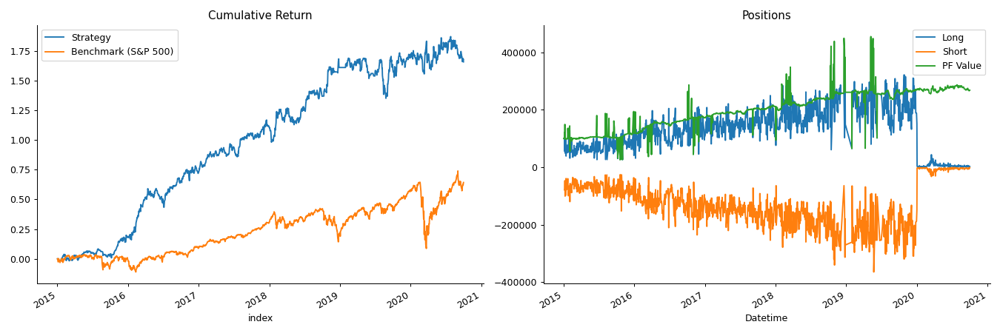

In [387]:
# Plotting returns vs S&P500
fig, axes = plt.subplots(ncols=2, figsize=(15, 5))

df = returns.to_frame('Strategy').join(benchmark.to_frame('Benchmark (S&P 500)'))
df.add(1).cumprod().sub(1).plot(ax=axes[0], title='Cumulative Return')

longs.plot(label='Long',ax=axes[1], title='Positions')
shorts.plot(ax=axes[1], label='Short')
positions.cash.plot(ax=axes[1], label='PF Value')
axes[1].legend()
sns.despine()
fig.tight_layout();

Start date,2015-01-02
End date,2020-10-01
Total months,68
,Backtest
Annual return,18.54%
Cumulative returns,165.718%
Annual volatility,13.865%
Sharpe ratio,1.30
Calmar ratio,1.47
Stability,0.91
Max drawdown,-12.579%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,12.58,2019-02-14,2019-08-27,2019-09-20,157
1,9.97,2016-05-26,2016-07-05,2016-08-05,52
2,8.64,2017-12-18,2018-01-12,2018-02-06,37
3,8.51,2020-03-24,2020-04-16,2020-06-08,55
4,7.42,2020-07-27,2020-10-01,NaT,NaN


<IPython.core.display.Javascript object>


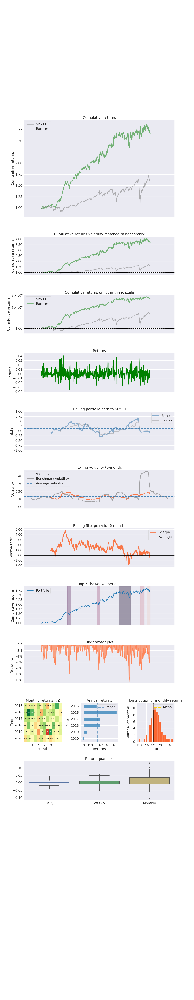

Stress Events,mean,min,max
Fall2015,-0.07%,-2.76%,1.26%
New Normal,0.07%,-3.68%,4.25%


<IPython.core.display.Javascript object>


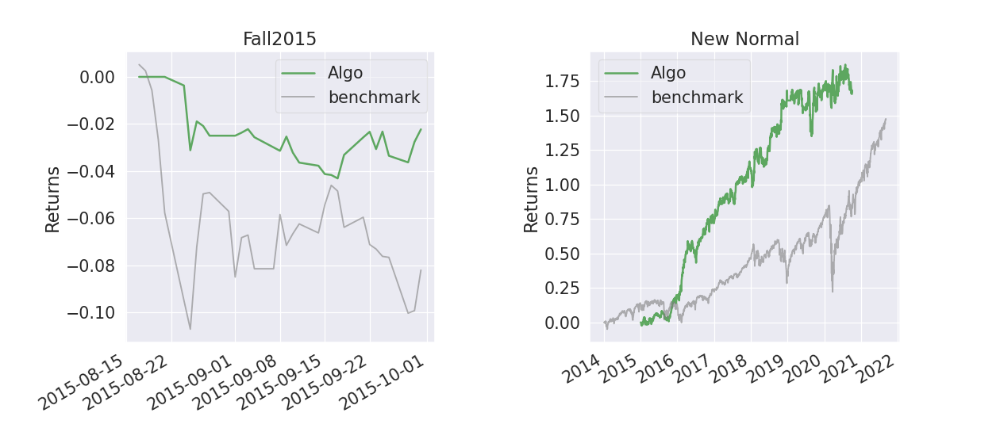

<IPython.core.display.Javascript object>


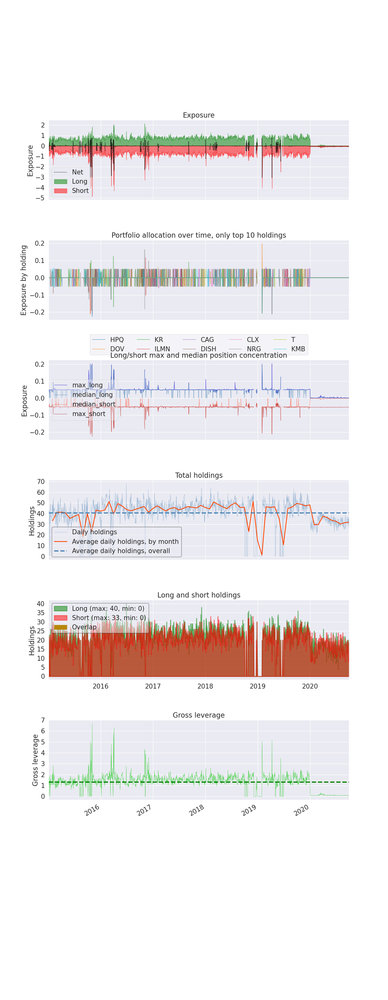

Top 10 long positions of all time,max
sid,
WBA,20.42%
TAP,20.38%
WFC,20.34%
F,20.30%
QCOM,20.30%
BKR,20.26%
PM,20.23%
ANTM,20.19%
ROL,20.18%


Top 10 short positions of all time,max
sid,
HPQ,-22.43%
DOV,-21.34%
KR,-21.23%
ILMN,-20.79%
CAG,-20.72%
DISH,-20.67%
CLX,-20.64%
NRG,-20.63%
T,-20.62%


Top 10 positions of all time,max
sid,
HPQ,22.43%
DOV,21.34%
KR,21.23%
ILMN,20.79%
CAG,20.72%
DISH,20.67%
CLX,20.64%
NRG,20.63%
T,20.62%


<IPython.core.display.Javascript object>


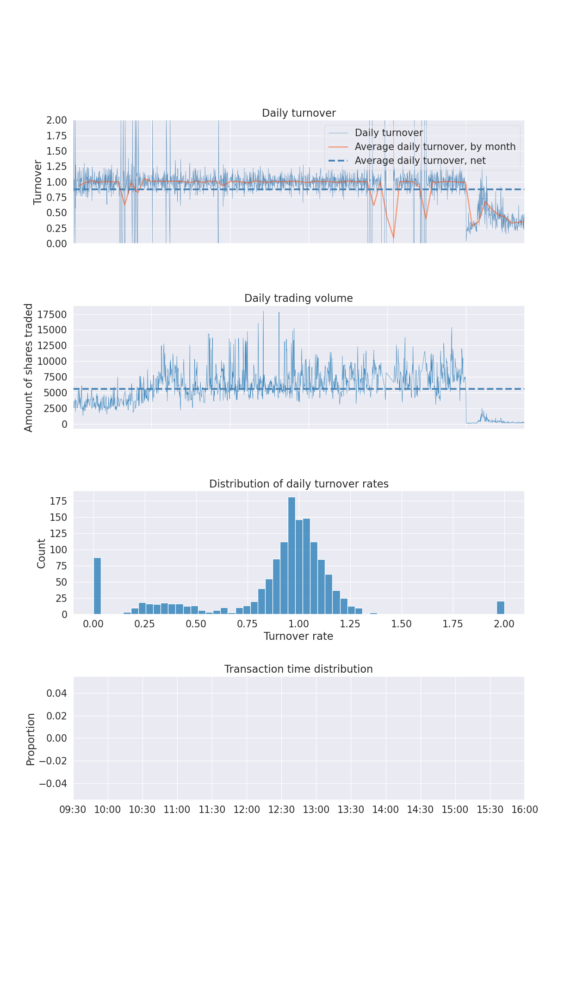

In [388]:
# Complete PyFolio evaluation
pf.create_full_tear_sheet(returns,
                          transactions=transactions,
                          positions=positions,
                          benchmark_rets=benchmark.dropna());

### Backtesting: Logistic Regression

In [365]:
# Initiating Cerebro
cerebro = bt.Cerebro()
cash = 100000
cerebro.broker.setcash(cash)

In [366]:
# Defining input
class SignalData(PandasData):
    
    cols = OHLCV + ['target1day','target5day','target10day','target21day','target42day','target63day']

    lines = tuple(cols)

    params = {c: -1 for c in cols}
    params.update({'datetime': None})
    params = tuple(params.items())

In [367]:
# Feeding data
data = pd.read_csv('./predictions/log_preds.csv')
data.date = pd.to_datetime(data.date)
data.set_index(['ticker','date'], inplace=True)
tickers = data.index.get_level_values(0).unique()

for ticker in tickers:
    df = data.loc[idx[ticker,'2015-01-02':], :].droplevel('ticker', axis=0)
    df.index.name = 'datetime'
    bt_data = SignalData(dataname=df)
    cerebro.adddata(bt_data, name=ticker)

In [368]:
# Defining Strategy
class LogisticRegressionStrategy(bt.Strategy):
    params = (('n_positions', 20),
              ('min_positions', 5),
              ('verbose', False))

    def log(self, txt, dt=None):
        print('%s | %s' % (self.datas[0].datetime.date(0).isoformat(), txt))
        
    def notify_trade(self, trade):
        if not trade.isclosed:
            return

        self.log(f'{trade.data._name}: OPERATION PROFIT {trade.pnl}')

    def notify_order(self, order):
        
        if order.status in [order.Submitted, order.Accepted]:
            return
        
        if self.p.verbose:
            if order.status in [order.Completed]:
                p = order.executed.price
                if order.isbuy():
                    self.log(f'{order.data._name}: BUY executed {p:.2f}')
                elif order.issell():
                    self.log(f'{order.data._name}: SELL executed {p:.2f}')

            elif order.status in [order.Canceled, order.Margin, order.Rejected]:
                self.log(f'{order.data._name}: Order Canceled/Margin/Rejected')

    def prenext(self):
        self.next()

    def next(self):
        today = self.datas[0].datetime.date()

        positions = [d._name for d, pos in self.getpositions().items() if pos]
        up, down = {}, {}
        missing = not_missing = 0
        for data in self.datas:
            if data.datetime.date() == today:
                if data.target1day[0] > 0:
                    if(data.target1day[0]+data.target5day[0]+data.target10day[0]+data.target21day[0]+data.target42day[0]+data.target63day[0] > 3):
                        up[data._name] = data.target1day[0]
                elif data.target1day[0] == 0:
                    if(data.target1day[0]+data.target5day[0]+data.target10day[0]+data.target21day[0]+data.target42day[0]+data.target63day[0] < 3):
                        down[data._name] = data.target1day[0]

        shorts = sorted(down, key=down.get)[:self.p.n_positions]
        longs = sorted(up, key=up.get, reverse=True)[:self.p.n_positions]
        n_shorts, n_longs = len(shorts), len(longs)
        
        if n_shorts < self.p.min_positions or n_longs < self.p.min_positions:
            longs, shorts = [], []
        for ticker in positions:
            if ticker not in longs + shorts:
                self.order_target_percent(data=ticker, target=0)
                self.log(f'{ticker}: TRADE CLOSING ORDER CREATED')

        short_target = -1 / max(self.p.n_positions, n_shorts)
        long_target = 1 / max(self.p.n_positions, n_longs)
        for ticker in shorts:
            self.order_target_percent(data=ticker, target=short_target)
            self.log(f'{ticker}: SHORT ORDER CREATED')
        for ticker in longs:
            self.order_target_percent(data=ticker, target=long_target)
            self.log(f'{ticker}: LONG ORDER CREATED')

In [369]:
# Backtesting
cerebro.addanalyzer(bt.analyzers.PyFolio, _name='pyfolio')
cerebro.addstrategy(LogisticRegressionStrategy)
cerebro.addsizer(bt.sizers.FixedSize, stake=1000)
cerebro.broker.setcommission(0.001)
results = cerebro.run()
ending_value = cerebro.broker.getvalue()

print(f'Final Portfolio Value: {ending_value:,.2f}')

2015-01-05 | AAL: SHORT ORDER CREATED
2015-01-05 | AAP: SHORT ORDER CREATED
2015-01-05 | ADM: SHORT ORDER CREATED
2015-01-05 | APA: SHORT ORDER CREATED
2015-01-05 | BEN: SHORT ORDER CREATED
2015-01-05 | BIIB: SHORT ORDER CREATED
2015-01-05 | BKR: SHORT ORDER CREATED
2015-01-05 | BWA: SHORT ORDER CREATED
2015-01-05 | BXP: SHORT ORDER CREATED
2015-01-05 | CAH: SHORT ORDER CREATED
2015-01-05 | CERN: SHORT ORDER CREATED
2015-01-05 | CF: SHORT ORDER CREATED
2015-01-05 | CMG: SHORT ORDER CREATED
2015-01-05 | COG: SHORT ORDER CREATED
2015-01-05 | COP: SHORT ORDER CREATED
2015-01-05 | CVS: SHORT ORDER CREATED
2015-01-05 | DAL: SHORT ORDER CREATED
2015-01-05 | DISCA: SHORT ORDER CREATED
2015-01-05 | DISCK: SHORT ORDER CREATED
2015-01-05 | DISH: SHORT ORDER CREATED
2015-01-05 | AAPL: LONG ORDER CREATED
2015-01-05 | AMGN: LONG ORDER CREATED
2015-01-05 | APH: LONG ORDER CREATED
2015-01-05 | AVGO: LONG ORDER CREATED
2015-01-05 | BKNG: LONG ORDER CREATED
2015-01-05 | CAT: LONG ORDER CREATED
2015-01-

2015-01-09 | EXPD: OPERATION PROFIT 83.69803073547669
2015-01-09 | FRC: OPERATION PROFIT 76.79049859901717
2015-01-09 | GD: OPERATION PROFIT 81.14244982299078
2015-01-09 | ICE: OPERATION PROFIT 46.2714684837134
2015-01-09 | INTU: OPERATION PROFIT 63.92366482142168
2015-01-09 | MPWR: OPERATION PROFIT 127.92782157341043
2015-01-09 | TXN: OPERATION PROFIT 32.85597989285952
2015-01-09 | TYL: OPERATION PROFIT 80.5
2015-01-12 | AAL: SHORT ORDER CREATED
2015-01-12 | AAP: SHORT ORDER CREATED
2015-01-12 | APA: SHORT ORDER CREATED
2015-01-12 | BEN: SHORT ORDER CREATED
2015-01-12 | BIIB: SHORT ORDER CREATED
2015-01-12 | BKR: SHORT ORDER CREATED
2015-01-12 | BMY: SHORT ORDER CREATED
2015-01-12 | BWA: SHORT ORDER CREATED
2015-01-12 | BXP: SHORT ORDER CREATED
2015-01-12 | CAH: SHORT ORDER CREATED
2015-01-12 | CERN: SHORT ORDER CREATED
2015-01-12 | CF: SHORT ORDER CREATED
2015-01-12 | CMG: SHORT ORDER CREATED
2015-01-12 | COG: SHORT ORDER CREATED
2015-01-12 | COP: SHORT ORDER CREATED
2015-01-12 | CVS

2015-01-16 | ABBV: TRADE CLOSING ORDER CREATED
2015-01-16 | ABMD: TRADE CLOSING ORDER CREATED
2015-01-16 | ABT: TRADE CLOSING ORDER CREATED
2015-01-16 | ADBE: TRADE CLOSING ORDER CREATED
2015-01-16 | ADM: TRADE CLOSING ORDER CREATED
2015-01-16 | ADP: TRADE CLOSING ORDER CREATED
2015-01-16 | ADSK: TRADE CLOSING ORDER CREATED
2015-01-16 | AFL: TRADE CLOSING ORDER CREATED
2015-01-16 | AIG: TRADE CLOSING ORDER CREATED
2015-01-16 | AKAM: TRADE CLOSING ORDER CREATED
2015-01-16 | ALB: TRADE CLOSING ORDER CREATED
2015-01-16 | ALL: TRADE CLOSING ORDER CREATED
2015-01-16 | AMD: TRADE CLOSING ORDER CREATED
2015-01-16 | CVS: TRADE CLOSING ORDER CREATED
2015-01-16 | DISCA: TRADE CLOSING ORDER CREATED
2015-01-16 | AAL: SHORT ORDER CREATED
2015-01-16 | AAP: SHORT ORDER CREATED
2015-01-16 | ABC: SHORT ORDER CREATED
2015-01-16 | ALK: SHORT ORDER CREATED
2015-01-16 | APA: SHORT ORDER CREATED
2015-01-16 | ARE: SHORT ORDER CREATED
2015-01-16 | AVB: SHORT ORDER CREATED
2015-01-16 | BEN: SHORT ORDER CREATED

2015-01-23 | A: OPERATION PROFIT 73.58909164813267
2015-01-23 | ABMD: OPERATION PROFIT 108.7998046875
2015-01-23 | ACN: OPERATION PROFIT 27.57977354558031
2015-01-23 | AFL: OPERATION PROFIT 117.24716020106749
2015-01-23 | AIZ: OPERATION PROFIT 30.56923150683687
2015-01-23 | AJG: OPERATION PROFIT 67.09972261483887
2015-01-23 | ALLE: OPERATION PROFIT 42.93372091756668
2015-01-23 | AME: OPERATION PROFIT 30.838524139308447
2015-01-23 | AMGN: OPERATION PROFIT 48.924456029765565
2015-01-23 | AMT: OPERATION PROFIT 56.19004889587154
2015-01-23 | AOS: OPERATION PROFIT 49.709705533141445
2015-01-23 | AZO: OPERATION PROFIT 174.47998046875
2015-01-23 | BAX: OPERATION PROFIT 15.532562427894092
2015-01-23 | BIO: OPERATION PROFIT 45.36007690429747
2015-01-23 | BK: OPERATION PROFIT 16.67596579532566
2015-01-23 | BLL: OPERATION PROFIT 0.7400730419234947
2015-01-23 | COP: OPERATION PROFIT -167.791330126373
2015-01-23 | ABBV: TRADE CLOSING ORDER CREATED
2015-01-23 | AXP: TRADE CLOSING ORDER CREATED
2015-

2015-01-29 | AEP: OPERATION PROFIT 67.73685735907841
2015-01-29 | CCI: OPERATION PROFIT 23.903034278972598
2015-01-29 | CDW: OPERATION PROFIT -63.33329305379891
2015-01-29 | CSCO: OPERATION PROFIT -115.2757604481638
2015-01-29 | CTXS: OPERATION PROFIT 114.94889361954554
2015-01-29 | DFS: OPERATION PROFIT -103.48662489973069
2015-01-29 | EQIX: OPERATION PROFIT -125.42280544432032
2015-01-29 | FFIV: OPERATION PROFIT -88.19993591308713
2015-01-29 | ICE: OPERATION PROFIT -163.55897003149403
2015-01-29 | INTC: OPERATION PROFIT -87.63783409310908
2015-01-29 | JPM: OPERATION PROFIT -206.4896201725703
2015-01-29 | KLAC: OPERATION PROFIT -174.86856573239118
2015-01-29 | LMT: OPERATION PROFIT -62.871505450072334
2015-01-29 | MA: OPERATION PROFIT -174.5572202418208
2015-01-29 | MSFT: OPERATION PROFIT -201.66493404692784
2015-01-29 | NDAQ: OPERATION PROFIT -83.6155204110643
2015-01-29 | A: TRADE CLOSING ORDER CREATED
2015-01-29 | ADI: TRADE CLOSING ORDER CREATED
2015-01-29 | ADSK: TRADE CLOSING OR

2015-02-04 | ACN: TRADE CLOSING ORDER CREATED
2015-02-04 | ADBE: TRADE CLOSING ORDER CREATED
2015-02-04 | ADI: TRADE CLOSING ORDER CREATED
2015-02-04 | ADP: TRADE CLOSING ORDER CREATED
2015-02-04 | ADSK: TRADE CLOSING ORDER CREATED
2015-02-04 | AEE: TRADE CLOSING ORDER CREATED
2015-02-04 | AEP: TRADE CLOSING ORDER CREATED
2015-02-04 | AES: TRADE CLOSING ORDER CREATED
2015-02-04 | AFL: TRADE CLOSING ORDER CREATED
2015-02-04 | AIG: TRADE CLOSING ORDER CREATED
2015-02-04 | AIZ: TRADE CLOSING ORDER CREATED
2015-02-04 | AJG: TRADE CLOSING ORDER CREATED
2015-02-04 | AKAM: TRADE CLOSING ORDER CREATED
2015-02-04 | ALB: TRADE CLOSING ORDER CREATED
2015-02-04 | ALGN: TRADE CLOSING ORDER CREATED
2015-02-04 | ALL: TRADE CLOSING ORDER CREATED
2015-02-04 | APA: TRADE CLOSING ORDER CREATED
2015-02-04 | BKR: TRADE CLOSING ORDER CREATED
2015-02-04 | BWA: TRADE CLOSING ORDER CREATED
2015-02-04 | COP: TRADE CLOSING ORDER CREATED
2015-02-04 | DISH: TRADE CLOSING ORDER CREATED
2015-02-04 | DVN: TRADE CLOSI

2015-02-13 | APA: SHORT ORDER CREATED
2015-02-13 | BKR: SHORT ORDER CREATED
2015-02-13 | BWA: SHORT ORDER CREATED
2015-02-13 | COG: SHORT ORDER CREATED
2015-02-13 | COP: SHORT ORDER CREATED
2015-02-13 | DISCA: SHORT ORDER CREATED
2015-02-13 | DISCK: SHORT ORDER CREATED
2015-02-13 | DVN: SHORT ORDER CREATED
2015-02-13 | F: SHORT ORDER CREATED
2015-02-13 | FCX: SHORT ORDER CREATED
2015-02-13 | HES: SHORT ORDER CREATED
2015-02-13 | KMI: SHORT ORDER CREATED
2015-02-13 | MRO: SHORT ORDER CREATED
2015-02-13 | NWS: SHORT ORDER CREATED
2015-02-13 | NWSA: SHORT ORDER CREATED
2015-02-13 | SEE: SHORT ORDER CREATED
2015-02-13 | SLB: SHORT ORDER CREATED
2015-02-13 | TWTR: SHORT ORDER CREATED
2015-02-13 | VIAC: SHORT ORDER CREATED
2015-02-13 | WMB: SHORT ORDER CREATED
2015-02-13 | A: LONG ORDER CREATED
2015-02-13 | AAPL: LONG ORDER CREATED
2015-02-13 | ABBV: LONG ORDER CREATED
2015-02-13 | ABT: LONG ORDER CREATED
2015-02-13 | ACN: LONG ORDER CREATED
2015-02-13 | ADBE: LONG ORDER CREATED
2015-02-13 |

2015-02-24 | ALK: OPERATION PROFIT 60.096399973185356
2015-02-24 | APA: OPERATION PROFIT -120.54995055651463
2015-02-24 | BIIB: OPERATION PROFIT -42.350067138671875
2015-02-24 | BKR: OPERATION PROFIT 58.163176815917126
2015-02-24 | COG: OPERATION PROFIT -19.074694914807665
2015-02-24 | DVN: OPERATION PROFIT -106.89525170516669
2015-02-24 | MHK: OPERATION PROFIT 26.51971435546949
2015-02-24 | AKAM: OPERATION PROFIT 108.89989471435547
2015-02-24 | BWA: TRADE CLOSING ORDER CREATED
2015-02-24 | CERN: TRADE CLOSING ORDER CREATED
2015-02-24 | CF: TRADE CLOSING ORDER CREATED
2015-02-24 | DISH: TRADE CLOSING ORDER CREATED
2015-02-24 | F: TRADE CLOSING ORDER CREATED
2015-02-24 | FCX: TRADE CLOSING ORDER CREATED
2015-02-24 | HES: TRADE CLOSING ORDER CREATED
2015-02-24 | KMI: TRADE CLOSING ORDER CREATED
2015-02-24 | MRO: TRADE CLOSING ORDER CREATED
2015-02-24 | NOV: TRADE CLOSING ORDER CREATED
2015-02-24 | SEE: TRADE CLOSING ORDER CREATED
2015-02-24 | WAB: TRADE CLOSING ORDER CREATED
2015-02-24 |

2015-03-03 | AAPL: OPERATION PROFIT -10.953377234371679
2015-03-03 | ABBV: OPERATION PROFIT -12.010775723408983
2015-03-03 | ABMD: OPERATION PROFIT 73.47002410888672
2015-03-03 | ABT: OPERATION PROFIT -20.469333269829264
2015-03-03 | ACN: OPERATION PROFIT 61.38414263910789
2015-03-03 | ADBE: OPERATION PROFIT 29.889869689941406
2015-03-03 | ADI: OPERATION PROFIT 60.07649905809224
2015-03-03 | ADP: OPERATION PROFIT 36.50143058000634
2015-03-03 | ADSK: OPERATION PROFIT -43.50013732910156
2015-03-03 | AES: OPERATION PROFIT -97.46655739960651
2015-03-03 | AFL: OPERATION PROFIT 10.901440012016884
2015-03-03 | AJG: OPERATION PROFIT 5.202537534066089
2015-03-03 | ALB: OPERATION PROFIT -15.381131243413506
2015-03-03 | ALGN: OPERATION PROFIT -17.639923095703125
2015-03-03 | DISCA: OPERATION PROFIT -27.000045776367188
2015-03-03 | DISCK: OPERATION PROFIT -52.469987869263825
2015-03-03 | FCX: OPERATION PROFIT 143.39935233529852
2015-03-03 | GPS: OPERATION PROFIT -108.22011772082857
2015-03-03 | NO

2015-03-06 | AAPL: TRADE CLOSING ORDER CREATED
2015-03-06 | AKAM: TRADE CLOSING ORDER CREATED
2015-03-06 | ALK: TRADE CLOSING ORDER CREATED
2015-03-06 | BK: TRADE CLOSING ORDER CREATED
2015-03-06 | BRK-B: TRADE CLOSING ORDER CREATED
2015-03-06 | BXP: TRADE CLOSING ORDER CREATED
2015-03-06 | CAG: TRADE CLOSING ORDER CREATED
2015-03-06 | CB: TRADE CLOSING ORDER CREATED
2015-03-06 | CBOE: TRADE CLOSING ORDER CREATED
2015-03-06 | CCI: TRADE CLOSING ORDER CREATED
2015-03-06 | CCL: TRADE CLOSING ORDER CREATED
2015-03-06 | AAL: SHORT ORDER CREATED
2015-03-06 | AAP: SHORT ORDER CREATED
2015-03-06 | ABC: SHORT ORDER CREATED
2015-03-06 | ADM: SHORT ORDER CREATED
2015-03-06 | AIG: SHORT ORDER CREATED
2015-03-06 | APA: SHORT ORDER CREATED
2015-03-06 | APTV: SHORT ORDER CREATED
2015-03-06 | AVGO: SHORT ORDER CREATED
2015-03-06 | AZO: SHORT ORDER CREATED
2015-03-06 | BEN: SHORT ORDER CREATED
2015-03-06 | BIIB: SHORT ORDER CREATED
2015-03-06 | BIO: SHORT ORDER CREATED
2015-03-06 | BKR: SHORT ORDER CR

2015-03-11 | AFL: TRADE CLOSING ORDER CREATED
2015-03-11 | ANSS: TRADE CLOSING ORDER CREATED
2015-03-11 | AON: TRADE CLOSING ORDER CREATED
2015-03-11 | ARE: TRADE CLOSING ORDER CREATED
2015-03-11 | ATO: TRADE CLOSING ORDER CREATED
2015-03-11 | BXP: TRADE CLOSING ORDER CREATED
2015-03-11 | DISCA: TRADE CLOSING ORDER CREATED
2015-03-11 | AAL: SHORT ORDER CREATED
2015-03-11 | AAP: SHORT ORDER CREATED
2015-03-11 | ABC: SHORT ORDER CREATED
2015-03-11 | AIG: SHORT ORDER CREATED
2015-03-11 | AKAM: SHORT ORDER CREATED
2015-03-11 | APA: SHORT ORDER CREATED
2015-03-11 | BEN: SHORT ORDER CREATED
2015-03-11 | BIIB: SHORT ORDER CREATED
2015-03-11 | BIO: SHORT ORDER CREATED
2015-03-11 | BKR: SHORT ORDER CREATED
2015-03-11 | BMY: SHORT ORDER CREATED
2015-03-11 | BWA: SHORT ORDER CREATED
2015-03-11 | CAH: SHORT ORDER CREATED
2015-03-11 | CERN: SHORT ORDER CREATED
2015-03-11 | CF: SHORT ORDER CREATED
2015-03-11 | CMG: SHORT ORDER CREATED
2015-03-11 | COG: SHORT ORDER CREATED
2015-03-11 | COO: SHORT ORD

2015-03-17 | AMP: TRADE CLOSING ORDER CREATED
2015-03-17 | BR: TRADE CLOSING ORDER CREATED
2015-03-17 | D: TRADE CLOSING ORDER CREATED
2015-03-17 | DLR: TRADE CLOSING ORDER CREATED
2015-03-17 | DRE: TRADE CLOSING ORDER CREATED
2015-03-17 | AAL: SHORT ORDER CREATED
2015-03-17 | AAP: SHORT ORDER CREATED
2015-03-17 | ABC: SHORT ORDER CREATED
2015-03-17 | ADM: SHORT ORDER CREATED
2015-03-17 | AIG: SHORT ORDER CREATED
2015-03-17 | AKAM: SHORT ORDER CREATED
2015-03-17 | ALK: SHORT ORDER CREATED
2015-03-17 | APA: SHORT ORDER CREATED
2015-03-17 | BEN: SHORT ORDER CREATED
2015-03-17 | BIIB: SHORT ORDER CREATED
2015-03-17 | BIO: SHORT ORDER CREATED
2015-03-17 | BKR: SHORT ORDER CREATED
2015-03-17 | BMY: SHORT ORDER CREATED
2015-03-17 | BWA: SHORT ORDER CREATED
2015-03-17 | BXP: SHORT ORDER CREATED
2015-03-17 | CAH: SHORT ORDER CREATED
2015-03-17 | CCL: SHORT ORDER CREATED
2015-03-17 | CERN: SHORT ORDER CREATED
2015-03-17 | CF: SHORT ORDER CREATED
2015-03-17 | CHTR: SHORT ORDER CREATED
2015-03-17

2015-03-24 | AAPL: OPERATION PROFIT 97.82887793022147
2015-03-24 | ALLE: OPERATION PROFIT 39.149817564769776
2015-03-24 | AMD: OPERATION PROFIT 158.35984897613548
2015-03-24 | AMGN: OPERATION PROFIT 78.55403645203825
2015-03-24 | AMP: OPERATION PROFIT 67.75280220569846
2015-03-24 | ANTM: OPERATION PROFIT 28.064025621906154
2015-03-24 | BDX: OPERATION PROFIT 105.86592798671563
2015-03-24 | CTAS: OPERATION PROFIT 80.08047947399135
2015-03-24 | DUK: OPERATION PROFIT 7.235891341395018e-05
2015-03-24 | ED: OPERATION PROFIT -6.215001842925297
2015-03-24 | ES: OPERATION PROFIT 15.052650962672459
2015-03-24 | KO: OPERATION PROFIT 31.91955935432059
2015-03-24 | MDLZ: OPERATION PROFIT 85.60324796422697
2015-03-24 | WEC: OPERATION PROFIT -7.639109712390564
2015-03-24 | ABMD: TRADE CLOSING ORDER CREATED
2015-03-24 | CERN: TRADE CLOSING ORDER CREATED
2015-03-24 | CSCO: TRADE CLOSING ORDER CREATED
2015-03-24 | DXC: TRADE CLOSING ORDER CREATED
2015-03-24 | INTC: TRADE CLOSING ORDER CREATED
2015-03-24

2015-03-30 | A: OPERATION PROFIT 55.01294487265295
2015-03-30 | AAPL: OPERATION PROFIT -94.86153614910933
2015-03-30 | ABBV: OPERATION PROFIT -3.5126171109283604
2015-03-30 | ABMD: OPERATION PROFIT 157.62008666992188
2015-03-30 | ABT: OPERATION PROFIT 41.291101722242445
2015-03-30 | ADI: OPERATION PROFIT 443.78324034705525
2015-03-30 | ADP: OPERATION PROFIT 40.71962924688775
2015-03-30 | AEE: OPERATION PROFIT -22.482979920961256
2015-03-30 | AEP: OPERATION PROFIT 24.249454483068924
2015-03-30 | AIG: OPERATION PROFIT 65.09935241424452
2015-03-30 | AIZ: OPERATION PROFIT 54.35395229612365
2015-03-30 | ALB: OPERATION PROFIT -99.66814732775106
2015-03-30 | ALL: OPERATION PROFIT 12.550432637327042
2015-03-30 | AMAT: OPERATION PROFIT 159.93669070303696
2015-03-30 | AMD: OPERATION PROFIT -73.28990459442177
2015-03-30 | AMGN: OPERATION PROFIT 171.08880280574272
2015-03-30 | AMT: OPERATION PROFIT 99.54782936446549
2015-03-30 | AMZN: OPERATION PROFIT -42.900238037109375
2015-03-30 | COG: OPERATIO

2015-04-06 | ABMD: OPERATION PROFIT 12.070411682128906
2015-04-06 | ADI: OPERATION PROFIT -55.9711579891885
2015-04-06 | BIO: OPERATION PROFIT -21.96002197265625
2015-04-06 | A: TRADE CLOSING ORDER CREATED
2015-04-06 | ACN: TRADE CLOSING ORDER CREATED
2015-04-06 | AEP: TRADE CLOSING ORDER CREATED
2015-04-06 | AFL: TRADE CLOSING ORDER CREATED
2015-04-06 | ALB: TRADE CLOSING ORDER CREATED
2015-04-06 | ALL: TRADE CLOSING ORDER CREATED
2015-04-06 | AME: TRADE CLOSING ORDER CREATED
2015-04-06 | CAH: TRADE CLOSING ORDER CREATED
2015-04-06 | CBRE: TRADE CLOSING ORDER CREATED
2015-04-06 | CCL: TRADE CLOSING ORDER CREATED
2015-04-06 | CERN: TRADE CLOSING ORDER CREATED
2015-04-06 | CF: TRADE CLOSING ORDER CREATED
2015-04-06 | CMG: TRADE CLOSING ORDER CREATED
2015-04-06 | COG: TRADE CLOSING ORDER CREATED
2015-04-06 | AAL: SHORT ORDER CREATED
2015-04-06 | AAP: SHORT ORDER CREATED
2015-04-06 | ABC: SHORT ORDER CREATED
2015-04-06 | ABMD: SHORT ORDER CREATED
2015-04-06 | ADM: SHORT ORDER CREATED
2015

2015-04-13 | A: OPERATION PROFIT 134.82218122811395
2015-04-13 | ABBV: OPERATION PROFIT 411.70470271984334
2015-04-13 | ADSK: OPERATION PROFIT 333.08006668090803
2015-04-13 | AFL: OPERATION PROFIT 31.061228935661713
2015-04-13 | AMD: OPERATION PROFIT 183.30982518196134
2015-04-13 | AME: OPERATION PROFIT 38.10567743048906
2015-04-13 | CERN: OPERATION PROFIT -148.82328467501134
2015-04-13 | CF: OPERATION PROFIT -82.91748712671344
2015-04-13 | CMG: OPERATION PROFIT -155.679931640625
2015-04-13 | COG: OPERATION PROFIT -50.97245643534313
2015-04-13 | COP: OPERATION PROFIT 33.87812337798025
2015-04-13 | AJG: TRADE CLOSING ORDER CREATED
2015-04-13 | ALB: TRADE CLOSING ORDER CREATED
2015-04-13 | ANSS: TRADE CLOSING ORDER CREATED
2015-04-13 | ANTM: TRADE CLOSING ORDER CREATED
2015-04-13 | BIO: TRADE CLOSING ORDER CREATED
2015-04-13 | CAG: TRADE CLOSING ORDER CREATED
2015-04-13 | AAL: SHORT ORDER CREATED
2015-04-13 | AAP: SHORT ORDER CREATED
2015-04-13 | ABC: SHORT ORDER CREATED
2015-04-13 | ADM

2015-04-17 | BSX: SHORT ORDER CREATED
2015-04-17 | BWA: SHORT ORDER CREATED
2015-04-17 | BXP: SHORT ORDER CREATED
2015-04-17 | AAPL: LONG ORDER CREATED
2015-04-17 | ABMD: LONG ORDER CREATED
2015-04-17 | ABT: LONG ORDER CREATED
2015-04-17 | ACN: LONG ORDER CREATED
2015-04-17 | ADBE: LONG ORDER CREATED
2015-04-17 | ADP: LONG ORDER CREATED
2015-04-17 | ADSK: LONG ORDER CREATED
2015-04-17 | AEE: LONG ORDER CREATED
2015-04-17 | AEP: LONG ORDER CREATED
2015-04-17 | AFL: LONG ORDER CREATED
2015-04-17 | AIZ: LONG ORDER CREATED
2015-04-17 | ALGN: LONG ORDER CREATED
2015-04-17 | ALL: LONG ORDER CREATED
2015-04-17 | ALLE: LONG ORDER CREATED
2015-04-17 | AMAT: LONG ORDER CREATED
2015-04-17 | AMD: LONG ORDER CREATED
2015-04-17 | AME: LONG ORDER CREATED
2015-04-17 | AMGN: LONG ORDER CREATED
2015-04-17 | AMT: LONG ORDER CREATED
2015-04-17 | AMZN: LONG ORDER CREATED
2015-04-20 | A: OPERATION PROFIT 66.90124233125005
2015-04-20 | ANSS: OPERATION PROFIT -19.79961395263672
2015-04-20 | BF-B: OPERATION PR

2015-04-27 | ADSK: OPERATION PROFIT 4.819938659667969
2015-04-27 | AEP: OPERATION PROFIT 145.37650063730993
2015-04-27 | AJG: OPERATION PROFIT 142.09238955315445
2015-04-27 | ALGN: OPERATION PROFIT -152.25
2015-04-27 | AMP: OPERATION PROFIT 55.296456823685105
2015-04-27 | BK: OPERATION PROFIT 45.67674285710709
2015-04-27 | BWA: OPERATION PROFIT 96.18508917446988
2015-04-27 | CAH: OPERATION PROFIT -70.66418142676135
2015-04-27 | CAT: OPERATION PROFIT -4.009778649577399
2015-04-27 | CE: OPERATION PROFIT -39.40418458085393
2015-04-27 | AAPL: TRADE CLOSING ORDER CREATED
2015-04-27 | AES: TRADE CLOSING ORDER CREATED
2015-04-27 | ANSS: TRADE CLOSING ORDER CREATED
2015-04-27 | ANTM: TRADE CLOSING ORDER CREATED
2015-04-27 | AON: TRADE CLOSING ORDER CREATED
2015-04-27 | AOS: TRADE CLOSING ORDER CREATED
2015-04-27 | APTV: TRADE CLOSING ORDER CREATED
2015-04-27 | AZO: TRADE CLOSING ORDER CREATED
2015-04-27 | AAL: SHORT ORDER CREATED
2015-04-27 | AAP: SHORT ORDER CREATED
2015-04-27 | ABBV: SHORT O

2015-05-01 | AAP: OPERATION PROFIT 44.562850422606175
2015-05-01 | AIG: OPERATION PROFIT -136.89044142057253
2015-05-01 | AKAM: OPERATION PROFIT -153.0698013305664
2015-05-01 | ALGN: OPERATION PROFIT 70.51973724365118
2015-05-01 | AMAT: OPERATION PROFIT -579.1130732590264
2015-05-01 | AMD: OPERATION PROFIT -591.4399011135107
2015-05-01 | AME: OPERATION PROFIT -40.0408827901352
2015-05-01 | AMGN: OPERATION PROFIT -10.259599946015442
2015-05-01 | AMP: OPERATION PROFIT -20.318196790115977
2015-05-01 | AMZN: OPERATION PROFIT 36.189758300780625
2015-05-01 | BIIB: OPERATION PROFIT 40.4403076171875
2015-05-01 | BK: OPERATION PROFIT -98.88750619506538
2015-05-01 | CAH: OPERATION PROFIT 261.79331130942035
2015-05-01 | CERN: OPERATION PROFIT 32.324558720394734
2015-05-01 | AES: OPERATION PROFIT 29.1054098955354
2015-05-01 | ALL: TRADE CLOSING ORDER CREATED
2015-05-01 | ALLE: TRADE CLOSING ORDER CREATED
2015-05-01 | CE: TRADE CLOSING ORDER CREATED
2015-05-01 | DD: TRADE CLOSING ORDER CREATED
2015

2015-05-07 | ALB: TRADE CLOSING ORDER CREATED
2015-05-07 | COP: TRADE CLOSING ORDER CREATED
2015-05-07 | IVZ: TRADE CLOSING ORDER CREATED
2015-05-07 | KMI: TRADE CLOSING ORDER CREATED
2015-05-07 | AAL: SHORT ORDER CREATED
2015-05-07 | ABC: SHORT ORDER CREATED
2015-05-07 | ADM: SHORT ORDER CREATED
2015-05-07 | APA: SHORT ORDER CREATED
2015-05-07 | BEN: SHORT ORDER CREATED
2015-05-07 | BKR: SHORT ORDER CREATED
2015-05-07 | BWA: SHORT ORDER CREATED
2015-05-07 | CF: SHORT ORDER CREATED
2015-05-07 | COG: SHORT ORDER CREATED
2015-05-07 | CVS: SHORT ORDER CREATED
2015-05-07 | DISCA: SHORT ORDER CREATED
2015-05-07 | DISH: SHORT ORDER CREATED
2015-05-07 | DVA: SHORT ORDER CREATED
2015-05-07 | DVN: SHORT ORDER CREATED
2015-05-07 | F: SHORT ORDER CREATED
2015-05-07 | FCX: SHORT ORDER CREATED
2015-05-07 | GPS: SHORT ORDER CREATED
2015-05-07 | HAL: SHORT ORDER CREATED
2015-05-07 | HES: SHORT ORDER CREATED
2015-05-07 | HWM: SHORT ORDER CREATED
2015-05-07 | A: LONG ORDER CREATED
2015-05-07 | AAP: LON

2015-05-14 | EOG: OPERATION PROFIT 107.85749647510727
2015-05-14 | F: OPERATION PROFIT 12.805007960656889
2015-05-14 | FCX: OPERATION PROFIT 8.758123132474225
2015-05-14 | AAP: OPERATION PROFIT 163.52194838485488
2015-05-14 | CMG: TRADE CLOSING ORDER CREATED
2015-05-14 | DISCK: TRADE CLOSING ORDER CREATED
2015-05-14 | AAP: SHORT ORDER CREATED
2015-05-14 | ABC: SHORT ORDER CREATED
2015-05-14 | ADM: SHORT ORDER CREATED
2015-05-14 | AIG: SHORT ORDER CREATED
2015-05-14 | AKAM: SHORT ORDER CREATED
2015-05-14 | APA: SHORT ORDER CREATED
2015-05-14 | APTV: SHORT ORDER CREATED
2015-05-14 | BEN: SHORT ORDER CREATED
2015-05-14 | BIIB: SHORT ORDER CREATED
2015-05-14 | BKR: SHORT ORDER CREATED
2015-05-14 | BWA: SHORT ORDER CREATED
2015-05-14 | CAH: SHORT ORDER CREATED
2015-05-14 | CF: SHORT ORDER CREATED
2015-05-14 | COG: SHORT ORDER CREATED
2015-05-14 | COP: SHORT ORDER CREATED
2015-05-14 | CVS: SHORT ORDER CREATED
2015-05-14 | DISCA: SHORT ORDER CREATED
2015-05-14 | DISH: SHORT ORDER CREATED
2015

2015-05-21 | ALLE: OPERATION PROFIT -39.69657178075386
2015-05-21 | ABT: TRADE CLOSING ORDER CREATED
2015-05-21 | APTV: TRADE CLOSING ORDER CREATED
2015-05-21 | COF: TRADE CLOSING ORDER CREATED
2015-05-21 | AAP: SHORT ORDER CREATED
2015-05-21 | ABC: SHORT ORDER CREATED
2015-05-21 | ADM: SHORT ORDER CREATED
2015-05-21 | AIG: SHORT ORDER CREATED
2015-05-21 | AKAM: SHORT ORDER CREATED
2015-05-21 | APA: SHORT ORDER CREATED
2015-05-21 | BEN: SHORT ORDER CREATED
2015-05-21 | BIIB: SHORT ORDER CREATED
2015-05-21 | BKR: SHORT ORDER CREATED
2015-05-21 | BMY: SHORT ORDER CREATED
2015-05-21 | BWA: SHORT ORDER CREATED
2015-05-21 | CAH: SHORT ORDER CREATED
2015-05-21 | CF: SHORT ORDER CREATED
2015-05-21 | CMG: SHORT ORDER CREATED
2015-05-21 | COG: SHORT ORDER CREATED
2015-05-21 | COP: SHORT ORDER CREATED
2015-05-21 | CVS: SHORT ORDER CREATED
2015-05-21 | DISCA: SHORT ORDER CREATED
2015-05-21 | DISCK: SHORT ORDER CREATED
2015-05-21 | DISH: SHORT ORDER CREATED
2015-05-21 | A: LONG ORDER CREATED
2015-

2015-05-29 | ABT: OPERATION PROFIT 31.614351399790657
2015-05-29 | AIG: OPERATION PROFIT -5.059603456350267
2015-05-29 | AKAM: OPERATION PROFIT 35.83984375
2015-05-29 | AAL: TRADE CLOSING ORDER CREATED
2015-05-29 | BMY: TRADE CLOSING ORDER CREATED
2015-05-29 | AAP: SHORT ORDER CREATED
2015-05-29 | ABC: SHORT ORDER CREATED
2015-05-29 | ADM: SHORT ORDER CREATED
2015-05-29 | APA: SHORT ORDER CREATED
2015-05-29 | APTV: SHORT ORDER CREATED
2015-05-29 | BEN: SHORT ORDER CREATED
2015-05-29 | BIIB: SHORT ORDER CREATED
2015-05-29 | BKR: SHORT ORDER CREATED
2015-05-29 | BWA: SHORT ORDER CREATED
2015-05-29 | CAH: SHORT ORDER CREATED
2015-05-29 | CF: SHORT ORDER CREATED
2015-05-29 | CMG: SHORT ORDER CREATED
2015-05-29 | COG: SHORT ORDER CREATED
2015-05-29 | COP: SHORT ORDER CREATED
2015-05-29 | CVS: SHORT ORDER CREATED
2015-05-29 | DISCA: SHORT ORDER CREATED
2015-05-29 | DISCK: SHORT ORDER CREATED
2015-05-29 | DISH: SHORT ORDER CREATED
2015-05-29 | DVA: SHORT ORDER CREATED
2015-05-29 | DVN: SHORT 

2015-06-05 | AAL: TRADE CLOSING ORDER CREATED
2015-06-05 | AAPL: TRADE CLOSING ORDER CREATED
2015-06-05 | AES: TRADE CLOSING ORDER CREATED
2015-06-05 | AIZ: TRADE CLOSING ORDER CREATED
2015-06-05 | AJG: TRADE CLOSING ORDER CREATED
2015-06-05 | ALK: TRADE CLOSING ORDER CREATED
2015-06-05 | ALLE: TRADE CLOSING ORDER CREATED
2015-06-05 | AMAT: TRADE CLOSING ORDER CREATED
2015-06-05 | AME: TRADE CLOSING ORDER CREATED
2015-06-05 | ANTM: TRADE CLOSING ORDER CREATED
2015-06-05 | BF-B: TRADE CLOSING ORDER CREATED
2015-06-05 | AAP: SHORT ORDER CREATED
2015-06-05 | ABC: SHORT ORDER CREATED
2015-06-05 | ADM: SHORT ORDER CREATED
2015-06-05 | AIG: SHORT ORDER CREATED
2015-06-05 | AKAM: SHORT ORDER CREATED
2015-06-05 | APA: SHORT ORDER CREATED
2015-06-05 | APTV: SHORT ORDER CREATED
2015-06-05 | BEN: SHORT ORDER CREATED
2015-06-05 | BIIB: SHORT ORDER CREATED
2015-06-05 | BKR: SHORT ORDER CREATED
2015-06-05 | BMY: SHORT ORDER CREATED
2015-06-05 | BWA: SHORT ORDER CREATED
2015-06-05 | C: SHORT ORDER CR

2015-06-15 | ABMD: OPERATION PROFIT -367.3401565551729
2015-06-15 | ADBE: OPERATION PROFIT -9.92022705078125
2015-06-15 | AFL: OPERATION PROFIT -170.3922859780971
2015-06-15 | ALL: OPERATION PROFIT -39.752632358174964
2015-06-15 | AMT: OPERATION PROFIT -19.753734599838708
2015-06-15 | APH: OPERATION PROFIT 10.418938584344573
2015-06-15 | ATVI: OPERATION PROFIT 1.9821136620955286
2015-06-15 | BIO: OPERATION PROFIT 64.67971801757812
2015-06-15 | ADI: TRADE CLOSING ORDER CREATED
2015-06-15 | AMAT: TRADE CLOSING ORDER CREATED
2015-06-15 | ANTM: TRADE CLOSING ORDER CREATED
2015-06-15 | AWK: TRADE CLOSING ORDER CREATED
2015-06-15 | BDX: TRADE CLOSING ORDER CREATED
2015-06-15 | BKNG: TRADE CLOSING ORDER CREATED
2015-06-15 | BLK: TRADE CLOSING ORDER CREATED
2015-06-15 | BR: TRADE CLOSING ORDER CREATED
2015-06-15 | BRK-B: TRADE CLOSING ORDER CREATED
2015-06-15 | AAP: SHORT ORDER CREATED
2015-06-15 | ABC: SHORT ORDER CREATED
2015-06-15 | ADM: SHORT ORDER CREATED
2015-06-15 | AIG: SHORT ORDER CRE

2015-06-22 | ACN: OPERATION PROFIT 89.69689427169811
2015-06-22 | ADBE: OPERATION PROFIT 69.58998107910156
2015-06-22 | ADI: OPERATION PROFIT 112.59767214598725
2015-06-22 | AEP: OPERATION PROFIT -44.85821843903848
2015-06-22 | ALGN: OPERATION PROFIT 113.599853515625
2015-06-22 | AMAT: OPERATION PROFIT 43.454094177647086
2015-06-22 | ANTM: OPERATION PROFIT 147.16264771271744
2015-06-22 | ARE: OPERATION PROFIT 134.61356940319274
2015-06-22 | ATO: OPERATION PROFIT 92.13186438356317
2015-06-22 | ATVI: OPERATION PROFIT 74.65099779706833
2015-06-22 | AVY: OPERATION PROFIT -9.490576774011458
2015-06-22 | BDX: OPERATION PROFIT 78.84142666399856
2015-06-22 | BKNG: OPERATION PROFIT -36.64013671875
2015-06-22 | C: OPERATION PROFIT -30.799812634118076
2015-06-22 | CBRE: OPERATION PROFIT -23.760040283204063
2015-06-22 | AAPL: TRADE CLOSING ORDER CREATED
2015-06-22 | BR: TRADE CLOSING ORDER CREATED
2015-06-22 | CCL: TRADE CLOSING ORDER CREATED
2015-06-22 | CERN: TRADE CLOSING ORDER CREATED
2015-06-

2015-06-26 | CNC: TRADE CLOSING ORDER CREATED
2015-06-26 | AAL: SHORT ORDER CREATED
2015-06-26 | AAP: SHORT ORDER CREATED
2015-06-26 | ABC: SHORT ORDER CREATED
2015-06-26 | ADM: SHORT ORDER CREATED
2015-06-26 | AIG: SHORT ORDER CREATED
2015-06-26 | APA: SHORT ORDER CREATED
2015-06-26 | APTV: SHORT ORDER CREATED
2015-06-26 | BEN: SHORT ORDER CREATED
2015-06-26 | BIIB: SHORT ORDER CREATED
2015-06-26 | BKR: SHORT ORDER CREATED
2015-06-26 | BMY: SHORT ORDER CREATED
2015-06-26 | BWA: SHORT ORDER CREATED
2015-06-26 | CAG: SHORT ORDER CREATED
2015-06-26 | CAH: SHORT ORDER CREATED
2015-06-26 | CBRE: SHORT ORDER CREATED
2015-06-26 | CCL: SHORT ORDER CREATED
2015-06-26 | CERN: SHORT ORDER CREATED
2015-06-26 | CF: SHORT ORDER CREATED
2015-06-26 | CI: SHORT ORDER CREATED
2015-06-26 | CMG: SHORT ORDER CREATED
2015-06-26 | ADI: LONG ORDER CREATED
2015-06-26 | ADSK: LONG ORDER CREATED
2015-06-26 | AEE: LONG ORDER CREATED
2015-06-26 | AEP: LONG ORDER CREATED
2015-06-26 | ANET: LONG ORDER CREATED
2015-

2015-07-06 | AIG: OPERATION PROFIT -231.57497383315126
2015-07-06 | ALK: OPERATION PROFIT -3.817673490280434
2015-07-06 | CAH: OPERATION PROFIT 216.7265022575495
2015-07-06 | CCL: OPERATION PROFIT 81.79622985033453
2015-07-06 | CERN: OPERATION PROFIT 134.60438475389057
2015-07-06 | CNC: OPERATION PROFIT 447.10526275634766
2015-07-06 | COF: OPERATION PROFIT 62.37929421151273
2015-07-06 | COP: TRADE CLOSING ORDER CREATED
2015-07-06 | CVS: TRADE CLOSING ORDER CREATED
2015-07-06 | DIS: TRADE CLOSING ORDER CREATED
2015-07-06 | DISCA: TRADE CLOSING ORDER CREATED
2015-07-06 | DISCK: TRADE CLOSING ORDER CREATED
2015-07-06 | DISH: TRADE CLOSING ORDER CREATED
2015-07-06 | DVA: TRADE CLOSING ORDER CREATED
2015-07-06 | AAL: SHORT ORDER CREATED
2015-07-06 | AAP: SHORT ORDER CREATED
2015-07-06 | ABC: SHORT ORDER CREATED
2015-07-06 | AIG: SHORT ORDER CREATED
2015-07-06 | ALK: SHORT ORDER CREATED
2015-07-06 | APA: SHORT ORDER CREATED
2015-07-06 | BEN: SHORT ORDER CREATED
2015-07-06 | BIIB: SHORT ORDER

2015-07-10 | AES: OPERATION PROFIT 19.405146171238357
2015-07-10 | ALK: OPERATION PROFIT -132.73478762073321
2015-07-10 | AMD: OPERATION PROFIT -171.6498363018038
2015-07-10 | BEN: OPERATION PROFIT 413.54403067958117
2015-07-10 | BMY: OPERATION PROFIT -187.5673347919283
2015-07-10 | COP: OPERATION PROFIT 29.021615656682528
2015-07-10 | DIS: OPERATION PROFIT -9.487090532674188
2015-07-10 | DVA: OPERATION PROFIT 15.75
2015-07-10 | ABBV: TRADE CLOSING ORDER CREATED
2015-07-10 | ABT: TRADE CLOSING ORDER CREATED
2015-07-10 | AIZ: TRADE CLOSING ORDER CREATED
2015-07-10 | COG: TRADE CLOSING ORDER CREATED
2015-07-10 | CVS: TRADE CLOSING ORDER CREATED
2015-07-10 | DISCA: TRADE CLOSING ORDER CREATED
2015-07-10 | DISCK: TRADE CLOSING ORDER CREATED
2015-07-10 | DISH: TRADE CLOSING ORDER CREATED
2015-07-10 | DVN: TRADE CLOSING ORDER CREATED
2015-07-10 | FCX: TRADE CLOSING ORDER CREATED
2015-07-10 | GILD: TRADE CLOSING ORDER CREATED
2015-07-10 | GPS: TRADE CLOSING ORDER CREATED
2015-07-10 | HAL: TRA

2015-07-16 | AAL: OPERATION PROFIT 16.991500883422148
2015-07-16 | AKAM: OPERATION PROFIT -35.190147399902344
2015-07-16 | AMP: OPERATION PROFIT 68.9711772495285
2015-07-16 | AMT: OPERATION PROFIT 39.82689511856307
2015-07-16 | ANSS: OPERATION PROFIT 40.5
2015-07-16 | ABT: TRADE CLOSING ORDER CREATED
2015-07-16 | AEP: TRADE CLOSING ORDER CREATED
2015-07-16 | AES: TRADE CLOSING ORDER CREATED
2015-07-16 | BWA: TRADE CLOSING ORDER CREATED
2015-07-16 | COP: TRADE CLOSING ORDER CREATED
2015-07-16 | AAP: SHORT ORDER CREATED
2015-07-16 | ABC: SHORT ORDER CREATED
2015-07-16 | AIG: SHORT ORDER CREATED
2015-07-16 | ALK: SHORT ORDER CREATED
2015-07-16 | APA: SHORT ORDER CREATED
2015-07-16 | BEN: SHORT ORDER CREATED
2015-07-16 | BIIB: SHORT ORDER CREATED
2015-07-16 | BKR: SHORT ORDER CREATED
2015-07-16 | BMY: SHORT ORDER CREATED
2015-07-16 | C: SHORT ORDER CREATED
2015-07-16 | CAH: SHORT ORDER CREATED
2015-07-16 | CCL: SHORT ORDER CREATED
2015-07-16 | CERN: SHORT ORDER CREATED
2015-07-16 | CF: SHO

2015-07-23 | A: OPERATION PROFIT 166.6037115965272
2015-07-23 | ACN: OPERATION PROFIT 244.17807777411042
2015-07-23 | AES: OPERATION PROFIT -9.989462077179287
2015-07-23 | ALL: OPERATION PROFIT 51.50810560982038
2015-07-23 | CAH: OPERATION PROFIT -46.07410563276447
2015-07-23 | ABT: OPERATION PROFIT 145.70893850815924
2015-07-23 | AMP: OPERATION PROFIT -3.0668266482891227
2015-07-23 | ABBV: TRADE CLOSING ORDER CREATED
2015-07-23 | AME: TRADE CLOSING ORDER CREATED
2015-07-23 | AMP: TRADE CLOSING ORDER CREATED
2015-07-23 | AMT: TRADE CLOSING ORDER CREATED
2015-07-23 | ANSS: TRADE CLOSING ORDER CREATED
2015-07-23 | ANTM: TRADE CLOSING ORDER CREATED
2015-07-23 | AON: TRADE CLOSING ORDER CREATED
2015-07-23 | BAC: TRADE CLOSING ORDER CREATED
2015-07-23 | BF-B: TRADE CLOSING ORDER CREATED
2015-07-23 | BMY: TRADE CLOSING ORDER CREATED
2015-07-23 | AAL: SHORT ORDER CREATED
2015-07-23 | AAP: SHORT ORDER CREATED
2015-07-23 | ABC: SHORT ORDER CREATED
2015-07-23 | ABT: SHORT ORDER CREATED
2015-07-2

2015-07-29 | ALLE: OPERATION PROFIT 101.93659526434743
2015-07-29 | AMP: OPERATION PROFIT 73.6049768349908
2015-07-29 | AMZN: OPERATION PROFIT -28.52984619140625
2015-07-29 | CMG: OPERATION PROFIT -42.0
2015-07-29 | COG: OPERATION PROFIT -198.74487502090597
2015-07-29 | CPB: OPERATION PROFIT -110.12192285586852
2015-07-29 | ABBV: TRADE CLOSING ORDER CREATED
2015-07-29 | ABMD: TRADE CLOSING ORDER CREATED
2015-07-29 | AFL: TRADE CLOSING ORDER CREATED
2015-07-29 | AMD: TRADE CLOSING ORDER CREATED
2015-07-29 | CCL: TRADE CLOSING ORDER CREATED
2015-07-29 | CERN: TRADE CLOSING ORDER CREATED
2015-07-29 | CF: TRADE CLOSING ORDER CREATED
2015-07-29 | AAL: SHORT ORDER CREATED
2015-07-29 | AAP: SHORT ORDER CREATED
2015-07-29 | ABC: SHORT ORDER CREATED
2015-07-29 | ABT: SHORT ORDER CREATED
2015-07-29 | ADM: SHORT ORDER CREATED
2015-07-29 | AIG: SHORT ORDER CREATED
2015-07-29 | AKAM: SHORT ORDER CREATED
2015-07-29 | ALK: SHORT ORDER CREATED
2015-07-29 | AMGN: SHORT ORDER CREATED
2015-07-29 | AMP: S

2015-08-05 | ALB: TRADE CLOSING ORDER CREATED
2015-08-05 | AMAT: TRADE CLOSING ORDER CREATED
2015-08-05 | GRMN: TRADE CLOSING ORDER CREATED
2015-08-05 | LRCX: TRADE CLOSING ORDER CREATED
2015-08-05 | NI: TRADE CLOSING ORDER CREATED
2015-08-05 | SWKS: TRADE CLOSING ORDER CREATED
2015-08-05 | TSN: TRADE CLOSING ORDER CREATED
2015-08-05 | A: SHORT ORDER CREATED
2015-08-05 | AAL: SHORT ORDER CREATED
2015-08-05 | AAP: SHORT ORDER CREATED
2015-08-05 | ABBV: SHORT ORDER CREATED
2015-08-05 | ABC: SHORT ORDER CREATED
2015-08-05 | ABMD: SHORT ORDER CREATED
2015-08-05 | ABT: SHORT ORDER CREATED
2015-08-05 | ACN: SHORT ORDER CREATED
2015-08-05 | ADBE: SHORT ORDER CREATED
2015-08-05 | ADM: SHORT ORDER CREATED
2015-08-05 | ADP: SHORT ORDER CREATED
2015-08-05 | ADSK: SHORT ORDER CREATED
2015-08-05 | AEE: SHORT ORDER CREATED
2015-08-05 | AEP: SHORT ORDER CREATED
2015-08-05 | AES: SHORT ORDER CREATED
2015-08-05 | AFL: SHORT ORDER CREATED
2015-08-05 | AIG: SHORT ORDER CREATED
2015-08-05 | AIZ: SHORT ORD

2015-08-13 | A: OPERATION PROFIT 14.484156823391324
2015-08-13 | AVGO: OPERATION PROFIT 167.53724895811217
2015-08-13 | CMCSA: OPERATION PROFIT 76.79608832052467
2015-08-13 | IRM: OPERATION PROFIT 170.66454802724326
2015-08-13 | NLOK: OPERATION PROFIT 267.6369469474711
2015-08-13 | AAL: TRADE CLOSING ORDER CREATED
2015-08-13 | AAP: TRADE CLOSING ORDER CREATED
2015-08-13 | AAPL: TRADE CLOSING ORDER CREATED
2015-08-13 | ABBV: TRADE CLOSING ORDER CREATED
2015-08-13 | ABC: TRADE CLOSING ORDER CREATED
2015-08-13 | ABMD: TRADE CLOSING ORDER CREATED
2015-08-13 | ABT: TRADE CLOSING ORDER CREATED
2015-08-13 | ACN: TRADE CLOSING ORDER CREATED
2015-08-13 | ADBE: TRADE CLOSING ORDER CREATED
2015-08-13 | ADM: TRADE CLOSING ORDER CREATED
2015-08-13 | ADP: TRADE CLOSING ORDER CREATED
2015-08-13 | ADSK: TRADE CLOSING ORDER CREATED
2015-08-13 | AEE: TRADE CLOSING ORDER CREATED
2015-08-13 | AEP: TRADE CLOSING ORDER CREATED
2015-08-13 | AES: TRADE CLOSING ORDER CREATED
2015-08-13 | AFL: TRADE CLOSING ORD

2015-08-25 | AES: OPERATION PROFIT 148.33119558776673
2015-08-25 | AKAM: OPERATION PROFIT 63.840347290039404
2015-08-25 | AMD: OPERATION PROFIT -380.5099860429783
2015-08-25 | AME: OPERATION PROFIT -299.4406262500931
2015-08-25 | AMP: OPERATION PROFIT 60.56793837426886
2015-08-25 | AMT: OPERATION PROFIT -82.06973457670983
2015-08-25 | AMZN: OPERATION PROFIT 239.10003662109375
2015-08-25 | ANTM: OPERATION PROFIT -126.26929556580626
2015-08-25 | AOS: OPERATION PROFIT -83.20773682599628
2015-08-25 | APH: OPERATION PROFIT 202.07273027268906
2015-08-25 | APTV: OPERATION PROFIT -322.9545655790922
2015-08-25 | ARE: OPERATION PROFIT -3.374479295833197
2015-08-25 | AVGO: OPERATION PROFIT 83.64323308842256
2015-08-25 | BDX: OPERATION PROFIT -61.22637298931238
2015-08-25 | BRK-B: OPERATION PROFIT 263.3397216796886
2015-08-25 | CDNS: OPERATION PROFIT 218.28997993469238
2015-08-25 | CMCSA: OPERATION PROFIT 228.4815556179885
2015-08-25 | CME: OPERATION PROFIT 127.49740012414159
2015-08-25 | CRL: OPE

2015-08-31 | ABBV: OPERATION PROFIT -18.354006818720734
2015-08-31 | ANTM: OPERATION PROFIT 60.1431936115909
2015-08-31 | BAX: OPERATION PROFIT 93.07248093030225
2015-08-31 | BF-B: OPERATION PROFIT -62.927970221501006
2015-08-31 | CLX: OPERATION PROFIT 18.127344838662538
2015-08-31 | DE: OPERATION PROFIT 31.42532975141856
2015-08-31 | LNT: OPERATION PROFIT -0.8965334500329334
2015-08-31 | TECH: OPERATION PROFIT -14.918407343104036
2015-08-31 | ABMD: TRADE CLOSING ORDER CREATED
2015-08-31 | ALGN: TRADE CLOSING ORDER CREATED
2015-08-31 | AMP: TRADE CLOSING ORDER CREATED
2015-08-31 | ANET: TRADE CLOSING ORDER CREATED
2015-08-31 | ANSS: TRADE CLOSING ORDER CREATED
2015-08-31 | VTR: TRADE CLOSING ORDER CREATED
2015-08-31 | WMT: TRADE CLOSING ORDER CREATED
2015-08-31 | AAL: SHORT ORDER CREATED
2015-08-31 | AAP: SHORT ORDER CREATED
2015-08-31 | ABC: SHORT ORDER CREATED
2015-08-31 | ADM: SHORT ORDER CREATED
2015-08-31 | AES: SHORT ORDER CREATED
2015-08-31 | AIG: SHORT ORDER CREATED
2015-08-31 

2015-09-03 | COG: OPERATION PROFIT -11.313080781039773
2015-09-03 | COP: OPERATION PROFIT -21.712721615173905
2015-09-03 | CTLT: OPERATION PROFIT 73.92008972167969
2015-09-03 | CVS: OPERATION PROFIT -17.166271984858867
2015-09-03 | DHI: OPERATION PROFIT -201.42969043704792
2015-09-03 | DISCA: OPERATION PROFIT -19.80007553100586
2015-09-03 | DISCK: OPERATION PROFIT 8.239795684815185
2015-09-03 | CF: TRADE CLOSING ORDER CREATED
2015-09-03 | CHRW: TRADE CLOSING ORDER CREATED
2015-09-03 | CMG: TRADE CLOSING ORDER CREATED
2015-09-03 | AAL: SHORT ORDER CREATED
2015-09-03 | AAP: SHORT ORDER CREATED
2015-09-03 | ABC: SHORT ORDER CREATED
2015-09-03 | AIG: SHORT ORDER CREATED
2015-09-03 | AKAM: SHORT ORDER CREATED
2015-09-03 | ALK: SHORT ORDER CREATED
2015-09-03 | AMD: SHORT ORDER CREATED
2015-09-03 | APA: SHORT ORDER CREATED
2015-09-03 | APD: SHORT ORDER CREATED
2015-09-03 | ATVI: SHORT ORDER CREATED
2015-09-03 | AZO: SHORT ORDER CREATED
2015-09-03 | BBY: SHORT ORDER CREATED
2015-09-03 | BEN: S

2015-09-14 | ADSK: LONG ORDER CREATED
2015-09-14 | AEE: LONG ORDER CREATED
2015-09-14 | AEP: LONG ORDER CREATED
2015-09-14 | AES: LONG ORDER CREATED
2015-09-14 | AFL: LONG ORDER CREATED
2015-09-14 | AJG: LONG ORDER CREATED
2015-09-14 | ALL: LONG ORDER CREATED
2015-09-14 | AMGN: LONG ORDER CREATED
2015-09-14 | AMT: LONG ORDER CREATED
2015-09-14 | ANET: LONG ORDER CREATED
2015-09-14 | AON: LONG ORDER CREATED
2015-09-14 | APH: LONG ORDER CREATED
2015-09-14 | ARE: LONG ORDER CREATED
2015-09-14 | ATO: LONG ORDER CREATED
2015-09-14 | AVB: LONG ORDER CREATED
2015-09-15 | ALB: OPERATION PROFIT -116.65593550531682
2015-09-15 | AMD: OPERATION PROFIT 406.87991511821747
2015-09-15 | ANSS: OPERATION PROFIT 8.800201416014843
2015-09-15 | ANTM: OPERATION PROFIT -7.504653932016822
2015-09-15 | AOS: OPERATION PROFIT -14.062759170974793
2015-09-15 | AWK: OPERATION PROFIT 35.105964645837005
2015-09-15 | BA: OPERATION PROFIT 7.4868363625529355
2015-09-15 | BAX: OPERATION PROFIT -5.668230570491133
2015-09-

2015-09-18 | AMZN: OPERATION PROFIT -68.7601318359375
2015-09-18 | NEE: OPERATION PROFIT 72.71000313553465
2015-09-18 | SRE: OPERATION PROFIT 57.823551043472605
2015-09-18 | ABBV: TRADE CLOSING ORDER CREATED
2015-09-18 | ADI: TRADE CLOSING ORDER CREATED
2015-09-18 | ADM: TRADE CLOSING ORDER CREATED
2015-09-18 | ADSK: TRADE CLOSING ORDER CREATED
2015-09-18 | AEE: TRADE CLOSING ORDER CREATED
2015-09-18 | AEP: TRADE CLOSING ORDER CREATED
2015-09-18 | AIZ: TRADE CLOSING ORDER CREATED
2015-09-18 | ALGN: TRADE CLOSING ORDER CREATED
2015-09-18 | ALLE: TRADE CLOSING ORDER CREATED
2015-09-18 | AME: TRADE CLOSING ORDER CREATED
2015-09-18 | AMT: TRADE CLOSING ORDER CREATED
2015-09-18 | ANET: TRADE CLOSING ORDER CREATED
2015-09-18 | ANSS: TRADE CLOSING ORDER CREATED
2015-09-18 | ANTM: TRADE CLOSING ORDER CREATED
2015-09-18 | AOS: TRADE CLOSING ORDER CREATED
2015-09-18 | COO: TRADE CLOSING ORDER CREATED
2015-09-18 | CSCO: TRADE CLOSING ORDER CREATED
2015-09-18 | CTLT: TRADE CLOSING ORDER CREATED
20

2015-09-24 | AAPL: OPERATION PROFIT -17.533437777209816
2015-09-24 | AMD: OPERATION PROFIT -242.160129904747
2015-09-24 | APTV: OPERATION PROFIT -174.34271517126587
2015-09-24 | BAC: OPERATION PROFIT -20.149584649648
2015-09-24 | CF: OPERATION PROFIT 413.1823726620141
2015-09-24 | CMG: OPERATION PROFIT -15.89013671875
2015-09-24 | COG: OPERATION PROFIT 129.15160895938453
2015-09-24 | COP: OPERATION PROFIT 130.3276704423616
2015-09-24 | AON: TRADE CLOSING ORDER CREATED
2015-09-24 | AOS: TRADE CLOSING ORDER CREATED
2015-09-24 | APD: TRADE CLOSING ORDER CREATED
2015-09-24 | APH: TRADE CLOSING ORDER CREATED
2015-09-24 | ARE: TRADE CLOSING ORDER CREATED
2015-09-24 | AVB: TRADE CLOSING ORDER CREATED
2015-09-24 | AVGO: TRADE CLOSING ORDER CREATED
2015-09-24 | AVY: TRADE CLOSING ORDER CREATED
2015-09-24 | BAX: TRADE CLOSING ORDER CREATED
2015-09-24 | BIIB: TRADE CLOSING ORDER CREATED
2015-09-24 | CERN: TRADE CLOSING ORDER CREATED
2015-09-24 | CHTR: TRADE CLOSING ORDER CREATED
2015-09-24 | AAL:

2015-09-30 | AEE: OPERATION PROFIT -43.36975527692979
2015-09-30 | AMP: OPERATION PROFIT 162.43461773539957
2015-09-30 | AMT: OPERATION PROFIT -52.1011757620069
2015-09-30 | AMZN: OPERATION PROFIT -226.54986572265614
2015-09-30 | ANET: OPERATION PROFIT -356.0399856567381
2015-09-30 | ANSS: OPERATION PROFIT -197.80995178222787
2015-09-30 | ANTM: OPERATION PROFIT -78.63618752666903
2015-09-30 | ATO: OPERATION PROFIT -52.76860879876329
2015-09-30 | ATVI: OPERATION PROFIT 12.198041083185434
2015-09-30 | AZO: OPERATION PROFIT -28.13970947265625
2015-09-30 | COG: OPERATION PROFIT 234.03225853370077
2015-09-30 | DAL: OPERATION PROFIT -24.175000565421335
2015-09-30 | A: TRADE CLOSING ORDER CREATED
2015-09-30 | AAPL: TRADE CLOSING ORDER CREATED
2015-09-30 | ACN: TRADE CLOSING ORDER CREATED
2015-09-30 | ADBE: TRADE CLOSING ORDER CREATED
2015-09-30 | ADI: TRADE CLOSING ORDER CREATED
2015-09-30 | ADM: TRADE CLOSING ORDER CREATED
2015-09-30 | AFL: TRADE CLOSING ORDER CREATED
2015-09-30 | AJG: TRADE

2015-11-02 | AAL: SHORT ORDER CREATED
2015-11-02 | AAP: SHORT ORDER CREATED
2015-11-02 | ABBV: SHORT ORDER CREATED
2015-11-02 | ABC: SHORT ORDER CREATED
2015-11-02 | ADM: SHORT ORDER CREATED
2015-11-02 | AIG: SHORT ORDER CREATED
2015-11-02 | ALK: SHORT ORDER CREATED
2015-11-02 | ALLE: SHORT ORDER CREATED
2015-11-02 | AMT: SHORT ORDER CREATED
2015-11-02 | AOS: SHORT ORDER CREATED
2015-11-02 | APA: SHORT ORDER CREATED
2015-11-02 | APTV: SHORT ORDER CREATED
2015-11-02 | ATO: SHORT ORDER CREATED
2015-11-02 | AVB: SHORT ORDER CREATED
2015-11-02 | AZO: SHORT ORDER CREATED
2015-11-02 | BA: SHORT ORDER CREATED
2015-11-02 | BEN: SHORT ORDER CREATED
2015-11-02 | BF-B: SHORT ORDER CREATED
2015-11-02 | BIIB: SHORT ORDER CREATED
2015-11-02 | BKNG: SHORT ORDER CREATED
2015-11-02 | ADP: LONG ORDER CREATED
2015-11-02 | AEP: LONG ORDER CREATED
2015-11-02 | AKAM: LONG ORDER CREATED
2015-11-02 | ANET: LONG ORDER CREATED
2015-11-02 | ANTM: LONG ORDER CREATED
2015-11-02 | ARE: LONG ORDER CREATED
2015-11-02

2015-11-09 | ACN: OPERATION PROFIT -62.133514560707724
2015-11-09 | ADBE: OPERATION PROFIT 9.689895629882002
2015-11-09 | ADI: OPERATION PROFIT 59.64652229516669
2015-11-09 | ADP: OPERATION PROFIT 19.465042158151917
2015-11-09 | ANET: OPERATION PROFIT 497.1698226928711
2015-11-09 | APD: OPERATION PROFIT 70.47510960718373
2015-11-09 | AVGO: OPERATION PROFIT 249.06494630638997
2015-11-09 | AXP: OPERATION PROFIT -4.856246895286347
2015-11-09 | BBY: OPERATION PROFIT -34.09977826138089
2015-11-09 | BIO: OPERATION PROFIT -30.96002197265625
2015-11-09 | BKNG: OPERATION PROFIT 267.2999267578125
2015-11-09 | ATVI: OPERATION PROFIT 111.69856693282605
2015-11-09 | AIZ: TRADE CLOSING ORDER CREATED
2015-11-09 | AMGN: TRADE CLOSING ORDER CREATED
2015-11-09 | AOS: TRADE CLOSING ORDER CREATED
2015-11-09 | BAC: TRADE CLOSING ORDER CREATED
2015-11-09 | BAX: TRADE CLOSING ORDER CREATED
2015-11-09 | BR: TRADE CLOSING ORDER CREATED
2015-11-09 | CDW: TRADE CLOSING ORDER CREATED
2015-11-09 | CERN: TRADE CLOS

2015-11-13 | AAP: OPERATION PROFIT 967.3697496307796
2015-11-13 | AIG: OPERATION PROFIT 158.0132359251042
2015-11-13 | AMD: OPERATION PROFIT -75.14992833137512
2015-11-13 | ANSS: OPERATION PROFIT -161.10027313232257
2015-11-13 | ANTM: OPERATION PROFIT -217.6344768979611
2015-11-13 | ARE: OPERATION PROFIT -82.75969953410078
2015-11-13 | ATO: OPERATION PROFIT 68.1946687310217
2015-11-13 | ATVI: OPERATION PROFIT 25.839490398439168
2015-11-13 | AVB: OPERATION PROFIT 24.719106935042873
2015-11-13 | AVGO: OPERATION PROFIT -52.47957906932061
2015-11-13 | AWK: OPERATION PROFIT -34.879875693143774
2015-11-13 | AZO: OPERATION PROFIT -28.43994140625
2015-11-13 | BIIB: OPERATION PROFIT 201.7899169921875
2015-11-13 | BKR: OPERATION PROFIT 341.51566200184516
2015-11-13 | BXP: OPERATION PROFIT -15.02426410371882
2015-11-13 | CAG: OPERATION PROFIT 269.535187414308
2015-11-13 | CBRE: OPERATION PROFIT 129.79991149902395
2015-11-13 | CCL: OPERATION PROFIT 60.33114729153175
2015-11-13 | ABBV: TRADE CLOSIN

2015-11-18 | A: OPERATION PROFIT 149.18674646442696
2015-11-18 | AAP: OPERATION PROFIT 23.25592754233017
2015-11-18 | APTV: OPERATION PROFIT 5.818546857709549
2015-11-18 | ARE: OPERATION PROFIT 29.049529108685448
2015-11-18 | ATO: OPERATION PROFIT -37.962676274662925
2015-11-18 | AVGO: OPERATION PROFIT 19.950172632651345
2015-11-18 | BIIB: OPERATION PROFIT 95.03997802734375
2015-11-18 | CCL: OPERATION PROFIT 12.132704027413297
2015-11-18 | CLX: OPERATION PROFIT -2.1666546593394287
2015-11-18 | CMG: OPERATION PROFIT 243.77966308593784
2015-11-18 | COG: OPERATION PROFIT 293.52559797284664
2015-11-18 | ALLE: TRADE CLOSING ORDER CREATED
2015-11-18 | AME: TRADE CLOSING ORDER CREATED
2015-11-18 | COP: TRADE CLOSING ORDER CREATED
2015-11-18 | COST: TRADE CLOSING ORDER CREATED
2015-11-18 | CRL: TRADE CLOSING ORDER CREATED
2015-11-18 | CVS: TRADE CLOSING ORDER CREATED
2015-11-18 | DD: TRADE CLOSING ORDER CREATED
2015-11-18 | AAL: SHORT ORDER CREATED
2015-11-18 | ABC: SHORT ORDER CREATED
2015-11

2015-11-24 | AAL: TRADE CLOSING ORDER CREATED
2015-11-24 | ANSS: TRADE CLOSING ORDER CREATED
2015-11-24 | ANTM: TRADE CLOSING ORDER CREATED
2015-11-24 | ATO: TRADE CLOSING ORDER CREATED
2015-11-24 | ATVI: TRADE CLOSING ORDER CREATED
2015-11-24 | AVGO: TRADE CLOSING ORDER CREATED
2015-11-24 | AVY: TRADE CLOSING ORDER CREATED
2015-11-24 | AZO: TRADE CLOSING ORDER CREATED
2015-11-24 | BIIB: TRADE CLOSING ORDER CREATED
2015-11-24 | BK: TRADE CLOSING ORDER CREATED
2015-11-24 | BXP: TRADE CLOSING ORDER CREATED
2015-11-24 | CAG: TRADE CLOSING ORDER CREATED
2015-11-24 | CBOE: TRADE CLOSING ORDER CREATED
2015-11-24 | ABC: SHORT ORDER CREATED
2015-11-24 | AIG: SHORT ORDER CREATED
2015-11-24 | ALK: SHORT ORDER CREATED
2015-11-24 | AOS: SHORT ORDER CREATED
2015-11-24 | APA: SHORT ORDER CREATED
2015-11-24 | APTV: SHORT ORDER CREATED
2015-11-24 | AVB: SHORT ORDER CREATED
2015-11-24 | BEN: SHORT ORDER CREATED
2015-11-24 | BKR: SHORT ORDER CREATED
2015-11-24 | BLL: SHORT ORDER CREATED
2015-11-24 | BMY

2015-11-30 | BAC: LONG ORDER CREATED
2015-11-30 | BBY: LONG ORDER CREATED
2015-11-30 | BF-B: LONG ORDER CREATED
2015-11-30 | BKNG: LONG ORDER CREATED
2015-11-30 | BR: LONG ORDER CREATED
2015-11-30 | BRK-B: LONG ORDER CREATED
2015-11-30 | BSX: LONG ORDER CREATED
2015-11-30 | CDNS: LONG ORDER CREATED
2015-11-30 | CDW: LONG ORDER CREATED
2015-12-01 | AAPL: OPERATION PROFIT 117.21512902316726
2015-12-01 | ADI: OPERATION PROFIT 165.03362022902138
2015-12-01 | AEE: OPERATION PROFIT 102.08802157780136
2015-12-01 | AEP: OPERATION PROFIT 63.96591703752034
2015-12-01 | AMGN: OPERATION PROFIT 66.2557068775061
2015-12-01 | CMI: OPERATION PROFIT -178.2689316433093
2015-12-01 | CMS: OPERATION PROFIT -10.623706431534536
2015-12-01 | CNP: OPERATION PROFIT -0.0012747470773319947
2015-12-01 | COG: OPERATION PROFIT -114.47237278667775
2015-12-01 | COO: OPERATION PROFIT -29.117008516593614
2015-12-01 | CSCO: OPERATION PROFIT -27.280040759795007
2015-12-01 | ABMD: TRADE CLOSING ORDER CREATED
2015-12-01 | A

2015-12-04 | AAPL: TRADE CLOSING ORDER CREATED
2015-12-04 | ABBV: TRADE CLOSING ORDER CREATED
2015-12-04 | ABMD: TRADE CLOSING ORDER CREATED
2015-12-04 | ABT: TRADE CLOSING ORDER CREATED
2015-12-04 | ACN: TRADE CLOSING ORDER CREATED
2015-12-04 | ADBE: TRADE CLOSING ORDER CREATED
2015-12-04 | ADI: TRADE CLOSING ORDER CREATED
2015-12-04 | ADM: TRADE CLOSING ORDER CREATED
2015-12-04 | ADP: TRADE CLOSING ORDER CREATED
2015-12-04 | AEE: TRADE CLOSING ORDER CREATED
2015-12-04 | AEP: TRADE CLOSING ORDER CREATED
2015-12-04 | AES: TRADE CLOSING ORDER CREATED
2015-12-04 | AFL: TRADE CLOSING ORDER CREATED
2015-12-04 | AIZ: TRADE CLOSING ORDER CREATED
2015-12-04 | AJG: TRADE CLOSING ORDER CREATED
2015-12-04 | AKAM: TRADE CLOSING ORDER CREATED
2015-12-04 | ALGN: TRADE CLOSING ORDER CREATED
2015-12-04 | AME: TRADE CLOSING ORDER CREATED
2015-12-04 | AMGN: TRADE CLOSING ORDER CREATED
2015-12-04 | AMP: TRADE CLOSING ORDER CREATED
2015-12-04 | CAH: TRADE CLOSING ORDER CREATED
2015-12-04 | CF: TRADE CLOS

2015-12-10 | ADM: OPERATION PROFIT 61.64033854151998
2015-12-10 | ADP: OPERATION PROFIT -35.84973390464289
2015-12-10 | AEP: OPERATION PROFIT 54.309298816021624
2015-12-10 | ALB: OPERATION PROFIT -91.45712883569762
2015-12-10 | AMD: OPERATION PROFIT 22.78997826576233
2015-12-10 | AME: OPERATION PROFIT 46.508294960298606
2015-12-10 | ANTM: OPERATION PROFIT 50.12772746857473
2015-12-10 | ATO: OPERATION PROFIT 35.61575798478162
2015-12-10 | BAC: OPERATION PROFIT 12.645901324870863
2015-12-10 | BLK: OPERATION PROFIT -56.02942575141037
2015-12-10 | ANSS: TRADE CLOSING ORDER CREATED
2015-12-10 | AOS: TRADE CLOSING ORDER CREATED
2015-12-10 | APD: TRADE CLOSING ORDER CREATED
2015-12-10 | APH: TRADE CLOSING ORDER CREATED
2015-12-10 | ARE: TRADE CLOSING ORDER CREATED
2015-12-10 | AVY: TRADE CLOSING ORDER CREATED
2015-12-10 | BAX: TRADE CLOSING ORDER CREATED
2015-12-10 | BIO: TRADE CLOSING ORDER CREATED
2015-12-10 | CERN: TRADE CLOSING ORDER CREATED
2015-12-10 | AAL: SHORT ORDER CREATED
2015-12-1

2015-12-16 | ACN: TRADE CLOSING ORDER CREATED
2015-12-16 | ADM: TRADE CLOSING ORDER CREATED
2015-12-16 | AEE: TRADE CLOSING ORDER CREATED
2015-12-16 | AEP: TRADE CLOSING ORDER CREATED
2015-12-16 | AES: TRADE CLOSING ORDER CREATED
2015-12-16 | AKAM: TRADE CLOSING ORDER CREATED
2015-12-16 | ALB: TRADE CLOSING ORDER CREATED
2015-12-16 | AME: TRADE CLOSING ORDER CREATED
2015-12-16 | AMP: TRADE CLOSING ORDER CREATED
2015-12-16 | AMT: TRADE CLOSING ORDER CREATED
2015-12-16 | APD: TRADE CLOSING ORDER CREATED
2015-12-16 | BKR: TRADE CLOSING ORDER CREATED
2015-12-16 | CCL: TRADE CLOSING ORDER CREATED
2015-12-16 | CERN: TRADE CLOSING ORDER CREATED
2015-12-16 | CFG: TRADE CLOSING ORDER CREATED
2015-12-16 | AAL: SHORT ORDER CREATED
2015-12-16 | AAP: SHORT ORDER CREATED
2015-12-16 | ABC: SHORT ORDER CREATED
2015-12-16 | AIG: SHORT ORDER CREATED
2015-12-16 | ALK: SHORT ORDER CREATED
2015-12-16 | AMD: SHORT ORDER CREATED
2015-12-16 | APA: SHORT ORDER CREATED
2015-12-16 | APTV: SHORT ORDER CREATED
201

2015-12-22 | A: OPERATION PROFIT 61.23239261295048
2015-12-22 | ABBV: OPERATION PROFIT 39.00551706302445
2015-12-22 | ABT: OPERATION PROFIT 22.58587220307703
2015-12-22 | ADBE: OPERATION PROFIT -13.200073242188353
2015-12-22 | ADP: OPERATION PROFIT 41.58148429518752
2015-12-22 | ALGN: OPERATION PROFIT -81.22010040283229
2015-12-22 | ALLE: OPERATION PROFIT -26.626058165218467
2015-12-22 | AMAT: OPERATION PROFIT 191.03379693018667
2015-12-22 | AMP: OPERATION PROFIT 99.02043551778992
2015-12-22 | AMT: OPERATION PROFIT 41.92756711470429
2015-12-22 | CCL: OPERATION PROFIT -294.2358695638676
2015-12-22 | CF: OPERATION PROFIT 55.329365687774725
2015-12-22 | CI: OPERATION PROFIT -91.09499290471535
2015-12-22 | ABMD: TRADE CLOSING ORDER CREATED
2015-12-22 | AEE: TRADE CLOSING ORDER CREATED
2015-12-22 | ALL: TRADE CLOSING ORDER CREATED
2015-12-22 | AVGO: TRADE CLOSING ORDER CREATED
2015-12-22 | BAX: TRADE CLOSING ORDER CREATED
2015-12-22 | BEN: TRADE CLOSING ORDER CREATED
2015-12-22 | CAH: TRADE

2015-12-29 | ANTM: SHORT ORDER CREATED
2015-12-29 | APA: SHORT ORDER CREATED
2015-12-29 | APTV: SHORT ORDER CREATED
2015-12-29 | ARE: SHORT ORDER CREATED
2015-12-29 | ATVI: SHORT ORDER CREATED
2015-12-29 | AVB: SHORT ORDER CREATED
2015-12-29 | AWK: SHORT ORDER CREATED
2015-12-29 | AZO: SHORT ORDER CREATED
2015-12-29 | BEN: SHORT ORDER CREATED
2015-12-29 | BIIB: SHORT ORDER CREATED
2015-12-29 | BKR: SHORT ORDER CREATED
2015-12-29 | AAPL: LONG ORDER CREATED
2015-12-29 | ACN: LONG ORDER CREATED
2015-12-29 | AJG: LONG ORDER CREATED
2015-12-29 | AVY: LONG ORDER CREATED
2015-12-29 | CBOE: LONG ORDER CREATED
2015-12-29 | CME: LONG ORDER CREATED
2015-12-29 | EXPD: LONG ORDER CREATED
2015-12-29 | FFIV: LONG ORDER CREATED
2015-12-29 | GPN: LONG ORDER CREATED
2015-12-29 | HPQ: LONG ORDER CREATED
2015-12-29 | MAS: LONG ORDER CREATED
2015-12-29 | MS: LONG ORDER CREATED
2015-12-29 | NSC: LONG ORDER CREATED
2015-12-29 | NTAP: LONG ORDER CREATED
2015-12-29 | NVR: LONG ORDER CREATED
2015-12-29 | ORCL: 

2016-01-05 | A: OPERATION PROFIT 42.44224490834483
2016-01-05 | AAPL: OPERATION PROFIT -454.12111463330433
2016-01-05 | ABMD: OPERATION PROFIT 183.7102508544922
2016-01-05 | ADI: OPERATION PROFIT 47.65852567918046
2016-01-05 | ADP: OPERATION PROFIT -17.21968582248701
2016-01-05 | ADSK: OPERATION PROFIT -148.88014221191378
2016-01-05 | AFL: OPERATION PROFIT -87.24182415245336
2016-01-05 | AIG: OPERATION PROFIT -153.34222941110653
2016-01-05 | AIZ: OPERATION PROFIT -170.27406888658004
2016-01-05 | AJG: OPERATION PROFIT -290.8386850109044
2016-01-05 | ALB: OPERATION PROFIT 66.84596295626628
2016-01-05 | ALL: OPERATION PROFIT -14.765407258058701
2016-01-05 | AMAT: OPERATION PROFIT 46.296032757975
2016-01-05 | AMD: OPERATION PROFIT -49.94999408721918
2016-01-05 | AMGN: OPERATION PROFIT 101.80328987771802
2016-01-05 | AMT: OPERATION PROFIT 36.166447655345564
2016-01-05 | AON: OPERATION PROFIT 0.5822240566556047
2016-01-05 | AOS: OPERATION PROFIT -20.45479884745366
2016-01-05 | APD: OPERATION

2016-01-08 | AMZN: OPERATION PROFIT -293.0400390625
2016-01-08 | AOS: OPERATION PROFIT -207.023445892313
2016-01-08 | APA: OPERATION PROFIT 1279.811000476237
2016-01-08 | APH: OPERATION PROFIT -556.7656800429708
2016-01-08 | AVGO: OPERATION PROFIT -176.8623665545183
2016-01-08 | BDX: OPERATION PROFIT -124.34554072384799
2016-01-08 | BIIB: OPERATION PROFIT 277.46005249023483
2016-01-08 | BKNG: OPERATION PROFIT -53.9599609375
2016-01-08 | CBOE: OPERATION PROFIT 111.91566162293284
2016-01-08 | CCL: OPERATION PROFIT 35.294744611103
2016-01-08 | COP: OPERATION PROFIT 221.69835584212152
2016-01-08 | CPB: OPERATION PROFIT 34.99371553438394
2016-01-08 | DISCK: OPERATION PROFIT 88.00996780395408
2016-01-08 | EA: OPERATION PROFIT 76.25240267616077
2016-01-08 | ECL: OPERATION PROFIT -22.985366003498783
2016-01-08 | EXPD: OPERATION PROFIT -167.07098232006763
2016-01-08 | FISV: OPERATION PROFIT -68.38034820556611
2016-01-08 | FLT: OPERATION PROFIT -16.399749755859375
2016-01-08 | GPN: OPERATION PRO

2016-01-12 | BAX: LONG ORDER CREATED
2016-01-12 | BDX: LONG ORDER CREATED
2016-01-12 | CAT: LONG ORDER CREATED
2016-01-12 | CBRE: LONG ORDER CREATED
2016-01-12 | CDNS: LONG ORDER CREATED
2016-01-13 | ABBV: OPERATION PROFIT 66.23830274464784
2016-01-13 | ABT: OPERATION PROFIT -12.184033348036749
2016-01-13 | AKAM: OPERATION PROFIT 135.60012817382812
2016-01-13 | ALL: OPERATION PROFIT 2.2114384885223615
2016-01-13 | AMGN: OPERATION PROFIT -66.90105485410703
2016-01-13 | ANSS: OPERATION PROFIT 72.38996124267578
2016-01-13 | ANTM: OPERATION PROFIT 218.15063056671505
2016-01-13 | AON: OPERATION PROFIT 11.641586348795855
2016-01-13 | DVN: OPERATION PROFIT 550.7412951507533
2016-01-13 | K: OPERATION PROFIT 32.18140447860705
2016-01-13 | NCLH: OPERATION PROFIT -56.429969787597656
2016-01-13 | NLSN: OPERATION PROFIT -112.75714120671537
2016-01-13 | OXY: OPERATION PROFIT 102.3253927367769
2016-01-13 | AAL: TRADE CLOSING ORDER CREATED
2016-01-13 | AAP: TRADE CLOSING ORDER CREATED
2016-01-13 | AMZ

2016-01-19 | AAL: OPERATION PROFIT -75.1601770972601
2016-01-19 | ABBV: OPERATION PROFIT 644.5277329807418
2016-01-19 | ABT: OPERATION PROFIT 102.37643680424401
2016-01-19 | ADBE: OPERATION PROFIT 84.94017028808594
2016-01-19 | ADP: OPERATION PROFIT 93.54362874302751
2016-01-19 | AJG: OPERATION PROFIT -257.16177649192576
2016-01-19 | ALGN: OPERATION PROFIT 89.27991485595703
2016-01-19 | ALL: OPERATION PROFIT 100.61323845196799
2016-01-19 | AMP: OPERATION PROFIT 49.05745096018153
2016-01-19 | APA: OPERATION PROFIT 8.287880932400114
2016-01-19 | DVN: OPERATION PROFIT -109.00907834332796
2016-01-19 | HRL: OPERATION PROFIT 47.608474589657675
2016-01-19 | KMB: OPERATION PROFIT -31.679708058256523
2016-01-19 | AMZN: TRADE CLOSING ORDER CREATED
2016-01-19 | AOS: TRADE CLOSING ORDER CREATED
2016-01-19 | APH: TRADE CLOSING ORDER CREATED
2016-01-19 | APTV: TRADE CLOSING ORDER CREATED
2016-01-19 | ARE: TRADE CLOSING ORDER CREATED
2016-01-19 | AVGO: TRADE CLOSING ORDER CREATED
2016-01-19 | AVY: TR

2016-01-26 | AAL: OPERATION PROFIT 176.28877377830773
2016-01-26 | BKR: OPERATION PROFIT 125.8638459256174
2016-01-26 | BMY: OPERATION PROFIT 102.38665939873357
2016-01-26 | CBRE: OPERATION PROFIT -215.83020401000977
2016-01-26 | CFG: OPERATION PROFIT -214.7149668133013
2016-01-26 | CMA: OPERATION PROFIT -177.86290852292123
2016-01-26 | COF: OPERATION PROFIT -143.24011025617764
2016-01-26 | CSCO: OPERATION PROFIT -33.01364123300687
2016-01-26 | CTXS: OPERATION PROFIT -46.50369545420307
2016-01-26 | DISH: OPERATION PROFIT 180.320068359375
2016-01-26 | DOV: OPERATION PROFIT 54.60970699909371
2016-01-26 | DVN: OPERATION PROFIT 184.57708351057343
2016-01-26 | GILD: OPERATION PROFIT 48.61121378418659
2016-01-26 | NOV: OPERATION PROFIT 260.4666834640874
2016-01-26 | AES: TRADE CLOSING ORDER CREATED
2016-01-26 | AJG: TRADE CLOSING ORDER CREATED
2016-01-26 | AME: TRADE CLOSING ORDER CREATED
2016-01-26 | AOS: TRADE CLOSING ORDER CREATED
2016-01-26 | AVY: TRADE CLOSING ORDER CREATED
2016-01-26 |

2016-02-01 | ESS: TRADE CLOSING ORDER CREATED
2016-02-01 | F: TRADE CLOSING ORDER CREATED
2016-02-01 | FANG: TRADE CLOSING ORDER CREATED
2016-02-01 | FITB: TRADE CLOSING ORDER CREATED
2016-02-01 | FRT: TRADE CLOSING ORDER CREATED
2016-02-01 | GE: TRADE CLOSING ORDER CREATED
2016-02-01 | HAL: TRADE CLOSING ORDER CREATED
2016-02-01 | HBAN: TRADE CLOSING ORDER CREATED
2016-02-01 | HBI: TRADE CLOSING ORDER CREATED
2016-02-01 | HRL: TRADE CLOSING ORDER CREATED
2016-02-01 | IPG: TRADE CLOSING ORDER CREATED
2016-02-01 | LDOS: TRADE CLOSING ORDER CREATED
2016-02-01 | NOW: TRADE CLOSING ORDER CREATED
2016-02-01 | RJF: TRADE CLOSING ORDER CREATED
2016-02-01 | URI: TRADE CLOSING ORDER CREATED
2016-02-02 | AAP: OPERATION PROFIT -94.47513355575063
2016-02-02 | ABT: OPERATION PROFIT 185.51536974019177
2016-02-02 | APA: OPERATION PROFIT -96.74976709038027
2016-02-02 | AXP: OPERATION PROFIT -10.672878358170252
2016-02-02 | BKR: OPERATION PROFIT -36.02837934020722
2016-02-02 | CAH: OPERATION PROFIT 38.

2016-04-05 | ABBV: OPERATION PROFIT 85.21795025627448
2016-04-05 | ALK: OPERATION PROFIT -11.20267234547245
2016-04-05 | AMT: OPERATION PROFIT 36.43629455566489
2016-04-05 | APTV: OPERATION PROFIT -258.9867953374163
2016-04-05 | AWK: OPERATION PROFIT 5.446016377264641
2016-04-05 | BA: OPERATION PROFIT -16.59040970789559
2016-04-05 | BAC: OPERATION PROFIT -96.49088237885026
2016-04-05 | BBY: OPERATION PROFIT -59.31808188635243
2016-04-05 | BEN: OPERATION PROFIT 149.00747108374094
2016-04-05 | BF-B: OPERATION PROFIT -59.82755640869485
2016-04-05 | BK: OPERATION PROFIT -48.47670477493543
2016-04-05 | BKNG: OPERATION PROFIT -110.2001953125
2016-04-05 | C: OPERATION PROFIT -116.90216970456882
2016-04-05 | CAT: OPERATION PROFIT -87.28255249223042
2016-04-05 | CL: OPERATION PROFIT -19.910823218149744
2016-04-05 | CTSH: OPERATION PROFIT 152.7999788600086
2016-04-05 | DG: OPERATION PROFIT 91.21571957376872
2016-04-05 | AKAM: TRADE CLOSING ORDER CREATED
2016-04-05 | ALGN: TRADE CLOSING ORDER CRE

2016-04-08 | ALL: OPERATION PROFIT 26.139846340921736
2016-04-08 | AMT: OPERATION PROFIT -15.207483917378909
2016-04-08 | AVB: OPERATION PROFIT 28.812133887409118
2016-04-08 | BIIB: OPERATION PROFIT 57.569976806640625
2016-04-08 | BXP: OPERATION PROFIT 17.456469415245834
2016-04-08 | CL: OPERATION PROFIT -14.215166460788495
2016-04-08 | CRL: OPERATION PROFIT -16.90013885498047
2016-04-08 | CVS: OPERATION PROFIT 110.88323473872492
2016-04-08 | DISCA: OPERATION PROFIT 114.02011489868099
2016-04-08 | DISCK: OPERATION PROFIT 44.779911041259766
2016-04-08 | DVN: OPERATION PROFIT -240.3423490086882
2016-04-08 | EQR: OPERATION PROFIT 7.843400441763123
2016-04-08 | AAP: OPERATION PROFIT 140.21973871988615
2016-04-08 | GPN: TRADE CLOSING ORDER CREATED
2016-04-08 | HAL: TRADE CLOSING ORDER CREATED
2016-04-08 | HBI: TRADE CLOSING ORDER CREATED
2016-04-08 | IPG: TRADE CLOSING ORDER CREATED
2016-04-08 | K: TRADE CLOSING ORDER CREATED
2016-04-08 | MCK: TRADE CLOSING ORDER CREATED
2016-04-08 | MHK: T

2016-04-14 | AAL: SHORT ORDER CREATED
2016-04-14 | AAP: SHORT ORDER CREATED
2016-04-14 | ALK: SHORT ORDER CREATED
2016-04-14 | APA: SHORT ORDER CREATED
2016-04-14 | BEN: SHORT ORDER CREATED
2016-04-14 | BMY: SHORT ORDER CREATED
2016-04-14 | CAH: SHORT ORDER CREATED
2016-04-14 | COP: SHORT ORDER CREATED
2016-04-14 | CVS: SHORT ORDER CREATED
2016-04-14 | DISCA: SHORT ORDER CREATED
2016-04-14 | DISCK: SHORT ORDER CREATED
2016-04-14 | DVA: SHORT ORDER CREATED
2016-04-14 | DVN: SHORT ORDER CREATED
2016-04-14 | EOG: SHORT ORDER CREATED
2016-04-14 | EW: SHORT ORDER CREATED
2016-04-14 | GE: SHORT ORDER CREATED
2016-04-14 | GILD: SHORT ORDER CREATED
2016-04-14 | GPN: SHORT ORDER CREATED
2016-04-14 | HAL: SHORT ORDER CREATED
2016-04-14 | HBI: SHORT ORDER CREATED
2016-04-14 | A: LONG ORDER CREATED
2016-04-14 | AAPL: LONG ORDER CREATED
2016-04-14 | ABBV: LONG ORDER CREATED
2016-04-14 | ABC: LONG ORDER CREATED
2016-04-14 | ABMD: LONG ORDER CREATED
2016-04-14 | ACN: LONG ORDER CREATED
2016-04-14 | A

2016-04-22 | A: OPERATION PROFIT 71.69197980947753
2016-04-22 | ABBV: OPERATION PROFIT 106.8689009979966
2016-04-22 | ABC: OPERATION PROFIT -22.893375927040793
2016-04-22 | ALK: OPERATION PROFIT 288.4825830401891
2016-04-22 | AMAT: OPERATION PROFIT -115.44039272505543
2016-04-22 | COG: OPERATION PROFIT -147.37868211021265
2016-04-22 | CVS: OPERATION PROFIT -7.9852032559560655
2016-04-22 | DVA: OPERATION PROFIT -26.980194091796875
2016-04-22 | AAL: OPERATION PROFIT 472.53240923457605
2016-04-22 | ADM: TRADE CLOSING ORDER CREATED
2016-04-22 | AIG: TRADE CLOSING ORDER CREATED
2016-04-22 | AMGN: TRADE CLOSING ORDER CREATED
2016-04-22 | EW: TRADE CLOSING ORDER CREATED
2016-04-22 | F: TRADE CLOSING ORDER CREATED
2016-04-22 | GILD: TRADE CLOSING ORDER CREATED
2016-04-22 | HAL: TRADE CLOSING ORDER CREATED
2016-04-22 | HAS: TRADE CLOSING ORDER CREATED
2016-04-22 | HBI: TRADE CLOSING ORDER CREATED
2016-04-22 | AAP: SHORT ORDER CREATED
2016-04-22 | AMD: SHORT ORDER CREATED
2016-04-22 | APA: SHORT

2016-04-29 | ABC: LONG ORDER CREATED
2016-04-29 | ABMD: LONG ORDER CREATED
2016-04-29 | ABT: LONG ORDER CREATED
2016-04-29 | ACN: LONG ORDER CREATED
2016-04-29 | ADBE: LONG ORDER CREATED
2016-04-29 | ADI: LONG ORDER CREATED
2016-04-29 | ADP: LONG ORDER CREATED
2016-04-29 | ADSK: LONG ORDER CREATED
2016-04-29 | AEE: LONG ORDER CREATED
2016-04-29 | AEP: LONG ORDER CREATED
2016-04-29 | AES: LONG ORDER CREATED
2016-04-29 | AIZ: LONG ORDER CREATED
2016-04-29 | AKAM: LONG ORDER CREATED
2016-04-29 | ALB: LONG ORDER CREATED
2016-04-29 | ALGN: LONG ORDER CREATED
2016-04-29 | ALK: LONG ORDER CREATED
2016-05-02 | AAP: OPERATION PROFIT 11.991556701566708
2016-05-02 | AIG: OPERATION PROFIT 71.13842806371153
2016-05-02 | AJG: OPERATION PROFIT 97.4543979513061
2016-05-02 | CL: OPERATION PROFIT -32.32359117924309
2016-05-02 | CVX: OPERATION PROFIT -92.58386567595822
2016-05-02 | DISCK: OPERATION PROFIT 143.3600845336906
2016-05-02 | EMN: OPERATION PROFIT 69.04607786693487
2016-05-02 | AIZ: TRADE CLOSI

2016-05-09 | AIZ: OPERATION PROFIT 32.93609025621876
2016-05-09 | APA: OPERATION PROFIT 48.0433509338805
2016-05-09 | PXD: OPERATION PROFIT 69.03380937588872
2016-05-09 | ABBV: TRADE CLOSING ORDER CREATED
2016-05-09 | NOV: TRADE CLOSING ORDER CREATED
2016-05-09 | BMY: SHORT ORDER CREATED
2016-05-09 | COG: SHORT ORDER CREATED
2016-05-09 | CPB: SHORT ORDER CREATED
2016-05-09 | CVS: SHORT ORDER CREATED
2016-05-09 | FRT: SHORT ORDER CREATED
2016-05-09 | KIM: SHORT ORDER CREATED
2016-05-09 | NLSN: SHORT ORDER CREATED
2016-05-09 | NWL: SHORT ORDER CREATED
2016-05-09 | REG: SHORT ORDER CREATED
2016-05-09 | TAP: SHORT ORDER CREATED
2016-05-09 | UHS: SHORT ORDER CREATED
2016-05-09 | XOM: SHORT ORDER CREATED
2016-05-09 | A: LONG ORDER CREATED
2016-05-09 | AAL: LONG ORDER CREATED
2016-05-09 | AAP: LONG ORDER CREATED
2016-05-09 | AAPL: LONG ORDER CREATED
2016-05-09 | ABC: LONG ORDER CREATED
2016-05-09 | ABMD: LONG ORDER CREATED
2016-05-09 | ABT: LONG ORDER CREATED
2016-05-09 | ACN: LONG ORDER CREA

2016-05-17 | PSA: OPERATION PROFIT 1.3903917569914483
2016-05-17 | SEE: OPERATION PROFIT -2.2158582846793706
2016-05-17 | A: TRADE CLOSING ORDER CREATED
2016-05-17 | CPB: TRADE CLOSING ORDER CREATED
2016-05-17 | CVS: TRADE CLOSING ORDER CREATED
2016-05-17 | FRT: TRADE CLOSING ORDER CREATED
2016-05-17 | GIS: TRADE CLOSING ORDER CREATED
2016-05-17 | HSIC: TRADE CLOSING ORDER CREATED
2016-05-17 | K: TRADE CLOSING ORDER CREATED
2016-05-17 | KIM: TRADE CLOSING ORDER CREATED
2016-05-17 | REG: TRADE CLOSING ORDER CREATED
2016-05-17 | UHS: TRADE CLOSING ORDER CREATED
2016-05-17 | XRAY: TRADE CLOSING ORDER CREATED
2016-05-17 | APA: SHORT ORDER CREATED
2016-05-17 | BKR: SHORT ORDER CREATED
2016-05-17 | BMY: SHORT ORDER CREATED
2016-05-17 | NLSN: SHORT ORDER CREATED
2016-05-17 | NWL: SHORT ORDER CREATED
2016-05-17 | OXY: SHORT ORDER CREATED
2016-05-17 | PXD: SHORT ORDER CREATED
2016-05-17 | SLB: SHORT ORDER CREATED
2016-05-17 | TAP: SHORT ORDER CREATED
2016-05-17 | XOM: SHORT ORDER CREATED
2016-0

2016-05-25 | AES: LONG ORDER CREATED
2016-05-25 | AFL: LONG ORDER CREATED
2016-05-25 | AIZ: LONG ORDER CREATED
2016-05-25 | AJG: LONG ORDER CREATED
2016-05-25 | ALGN: LONG ORDER CREATED
2016-05-25 | ALK: LONG ORDER CREATED
2016-05-25 | ALL: LONG ORDER CREATED
2016-05-25 | ALLE: LONG ORDER CREATED
2016-05-26 | AAP: OPERATION PROFIT 43.08309109315678
2016-05-26 | AAPL: OPERATION PROFIT -466.753518553638
2016-05-26 | AIG: OPERATION PROFIT -1.8894765537510168
2016-05-26 | AKAM: OPERATION PROFIT 121.0397605895999
2016-05-26 | CPB: OPERATION PROFIT 8.064796944550103
2016-05-26 | ALL: TRADE CLOSING ORDER CREATED
2016-05-26 | ALLE: TRADE CLOSING ORDER CREATED
2016-05-26 | BMY: TRADE CLOSING ORDER CREATED
2016-05-26 | F: TRADE CLOSING ORDER CREATED
2016-05-26 | MCK: TRADE CLOSING ORDER CREATED
2016-05-26 | NWL: TRADE CLOSING ORDER CREATED
2016-05-26 | PXD: TRADE CLOSING ORDER CREATED
2016-05-26 | TAP: TRADE CLOSING ORDER CREATED
2016-05-26 | UAA: TRADE CLOSING ORDER CREATED
2016-05-26 | UHS: TR

2016-06-02 | ABBV: LONG ORDER CREATED
2016-06-02 | ABC: LONG ORDER CREATED
2016-06-02 | ABMD: LONG ORDER CREATED
2016-06-02 | ABT: LONG ORDER CREATED
2016-06-02 | ACN: LONG ORDER CREATED
2016-06-02 | ADBE: LONG ORDER CREATED
2016-06-02 | ADI: LONG ORDER CREATED
2016-06-02 | ADP: LONG ORDER CREATED
2016-06-02 | ADSK: LONG ORDER CREATED
2016-06-02 | AEE: LONG ORDER CREATED
2016-06-02 | AEP: LONG ORDER CREATED
2016-06-02 | AES: LONG ORDER CREATED
2016-06-02 | AFL: LONG ORDER CREATED
2016-06-02 | AIG: LONG ORDER CREATED
2016-06-02 | AIZ: LONG ORDER CREATED
2016-06-02 | AJG: LONG ORDER CREATED
2016-06-02 | ALB: LONG ORDER CREATED
2016-06-03 | AKAM: OPERATION PROFIT 36.7200622558601
2016-06-03 | AAPL: TRADE CLOSING ORDER CREATED
2016-06-03 | ABBV: TRADE CLOSING ORDER CREATED
2016-06-03 | AEE: TRADE CLOSING ORDER CREATED
2016-06-03 | UAA: TRADE CLOSING ORDER CREATED
2016-06-03 | APA: SHORT ORDER CREATED
2016-06-03 | BMY: SHORT ORDER CREATED
2016-06-03 | DVA: SHORT ORDER CREATED
2016-06-03 | F

2016-06-09 | NOV: SHORT ORDER CREATED
2016-06-09 | NWL: SHORT ORDER CREATED
2016-06-09 | REG: SHORT ORDER CREATED
2016-06-09 | SJM: SHORT ORDER CREATED
2016-06-09 | SLB: SHORT ORDER CREATED
2016-06-09 | TAP: SHORT ORDER CREATED
2016-06-09 | UAA: SHORT ORDER CREATED
2016-06-09 | A: LONG ORDER CREATED
2016-06-09 | AAL: LONG ORDER CREATED
2016-06-09 | AAPL: LONG ORDER CREATED
2016-06-09 | ABBV: LONG ORDER CREATED
2016-06-09 | ABC: LONG ORDER CREATED
2016-06-09 | ABMD: LONG ORDER CREATED
2016-06-09 | ABT: LONG ORDER CREATED
2016-06-09 | ACN: LONG ORDER CREATED
2016-06-09 | ADBE: LONG ORDER CREATED
2016-06-09 | ADI: LONG ORDER CREATED
2016-06-09 | ADP: LONG ORDER CREATED
2016-06-09 | ADSK: LONG ORDER CREATED
2016-06-09 | AES: LONG ORDER CREATED
2016-06-09 | AFL: LONG ORDER CREATED
2016-06-09 | AIG: LONG ORDER CREATED
2016-06-09 | AIZ: LONG ORDER CREATED
2016-06-09 | AJG: LONG ORDER CREATED
2016-06-09 | ALB: LONG ORDER CREATED
2016-06-09 | ALGN: LONG ORDER CREATED
2016-06-09 | ALK: LONG ORDE

2016-06-15 | ADSK: LONG ORDER CREATED
2016-06-15 | AEE: LONG ORDER CREATED
2016-06-15 | AEP: LONG ORDER CREATED
2016-06-15 | AES: LONG ORDER CREATED
2016-06-15 | AFL: LONG ORDER CREATED
2016-06-15 | AIG: LONG ORDER CREATED
2016-06-15 | AIZ: LONG ORDER CREATED
2016-06-15 | AJG: LONG ORDER CREATED
2016-06-16 | AKAM: OPERATION PROFIT 35.02979278564464
2016-06-16 | HSIC: OPERATION PROFIT 53.344871520996094
2016-06-16 | XRAY: OPERATION PROFIT 93.22027825004062
2016-06-16 | AJG: TRADE CLOSING ORDER CREATED
2016-06-16 | APA: TRADE CLOSING ORDER CREATED
2016-06-16 | BMY: TRADE CLOSING ORDER CREATED
2016-06-16 | CVS: TRADE CLOSING ORDER CREATED
2016-06-16 | SLB: TRADE CLOSING ORDER CREATED
2016-06-16 | UAA: TRADE CLOSING ORDER CREATED
2016-06-16 | CPB: SHORT ORDER CREATED
2016-06-16 | FRT: SHORT ORDER CREATED
2016-06-16 | GIS: SHORT ORDER CREATED
2016-06-16 | HAL: SHORT ORDER CREATED
2016-06-16 | K: SHORT ORDER CREATED
2016-06-16 | KIM: SHORT ORDER CREATED
2016-06-16 | MO: SHORT ORDER CREATED
2

2016-06-23 | AJG: OPERATION PROFIT 30.791709007577595
2016-06-23 | COG: OPERATION PROFIT -90.86090957448306
2016-06-23 | HSIC: OPERATION PROFIT -25.4119873046875
2016-06-23 | MO: OPERATION PROFIT -89.07411561317662
2016-06-23 | NLSN: OPERATION PROFIT -66.38560461396989
2016-06-23 | OXY: OPERATION PROFIT -38.53066300160282
2016-06-23 | PPL: OPERATION PROFIT 23.73092769441864
2016-06-23 | REG: OPERATION PROFIT 7.645647309592505
2016-06-23 | AAP: TRADE CLOSING ORDER CREATED
2016-06-23 | AES: TRADE CLOSING ORDER CREATED
2016-06-23 | FRT: TRADE CLOSING ORDER CREATED
2016-06-23 | UAA: TRADE CLOSING ORDER CREATED
2016-06-23 | WBA: TRADE CLOSING ORDER CREATED
2016-06-23 | XOM: TRADE CLOSING ORDER CREATED
2016-06-23 | XRAY: TRADE CLOSING ORDER CREATED
2016-06-23 | APA: SHORT ORDER CREATED
2016-06-23 | BMY: SHORT ORDER CREATED
2016-06-23 | CPB: SHORT ORDER CREATED
2016-06-23 | DVA: SHORT ORDER CREATED
2016-06-23 | DVN: SHORT ORDER CREATED
2016-06-23 | GE: SHORT ORDER CREATED
2016-06-23 | GIS: SH

2016-07-05 | ADP: OPERATION PROFIT 319.9347673948557
2016-07-05 | ALB: OPERATION PROFIT 43.87263424201642
2016-07-05 | ALGN: OPERATION PROFIT 124.8903579711914
2016-07-05 | DVA: OPERATION PROFIT 44.02019500732422
2016-07-05 | EIX: OPERATION PROFIT 15.687525018355586
2016-07-05 | GE: OPERATION PROFIT 40.54749297917013
2016-07-05 | IRM: OPERATION PROFIT 1.3926169725893445
2016-07-05 | KR: OPERATION PROFIT -22.70496004404822
2016-07-05 | PSA: OPERATION PROFIT 61.338951069712834
2016-07-05 | AAP: TRADE CLOSING ORDER CREATED
2016-07-05 | AKAM: TRADE CLOSING ORDER CREATED
2016-07-05 | APA: TRADE CLOSING ORDER CREATED
2016-07-05 | COG: TRADE CLOSING ORDER CREATED
2016-07-05 | NWL: TRADE CLOSING ORDER CREATED
2016-07-05 | SLB: TRADE CLOSING ORDER CREATED
2016-07-05 | UAA: TRADE CLOSING ORDER CREATED
2016-07-05 | XOM: TRADE CLOSING ORDER CREATED
2016-07-05 | BMY: SHORT ORDER CREATED
2016-07-05 | CPB: SHORT ORDER CREATED
2016-07-05 | FRT: SHORT ORDER CREATED
2016-07-05 | GIS: SHORT ORDER CREATED

2016-07-14 | APA: OPERATION PROFIT 18.1045057083453
2016-07-14 | DVN: OPERATION PROFIT -154.22927057462488
2016-07-14 | F: OPERATION PROFIT -34.44437937073062
2016-07-14 | LEG: OPERATION PROFIT -88.09521536912477
2016-07-14 | NLSN: OPERATION PROFIT -16.080000437543276
2016-07-14 | NWL: OPERATION PROFIT -17.640325919171893
2016-07-14 | SLB: OPERATION PROFIT -8.689116448731141
2016-07-14 | ALB: TRADE CLOSING ORDER CREATED
2016-07-14 | ALGN: TRADE CLOSING ORDER CREATED
2016-07-14 | CVS: TRADE CLOSING ORDER CREATED
2016-07-14 | FRT: TRADE CLOSING ORDER CREATED
2016-07-14 | KIM: TRADE CLOSING ORDER CREATED
2016-07-14 | KR: TRADE CLOSING ORDER CREATED
2016-07-14 | OMC: TRADE CLOSING ORDER CREATED
2016-07-14 | SEE: TRADE CLOSING ORDER CREATED
2016-07-14 | SJM: TRADE CLOSING ORDER CREATED
2016-07-14 | UAA: TRADE CLOSING ORDER CREATED
2016-07-14 | XOM: TRADE CLOSING ORDER CREATED
2016-07-14 | BMY: SHORT ORDER CREATED
2016-07-14 | CAH: SHORT ORDER CREATED
2016-07-14 | CPB: SHORT ORDER CREATED
20

2016-07-25 | SPG: TRADE CLOSING ORDER CREATED
2016-07-25 | BMY: SHORT ORDER CREATED
2016-07-25 | CAH: SHORT ORDER CREATED
2016-07-25 | F: SHORT ORDER CREATED
2016-07-25 | K: SHORT ORDER CREATED
2016-07-25 | LEG: SHORT ORDER CREATED
2016-07-25 | MCK: SHORT ORDER CREATED
2016-07-25 | NLSN: SHORT ORDER CREATED
2016-07-25 | SJM: SHORT ORDER CREATED
2016-07-25 | SLB: SHORT ORDER CREATED
2016-07-25 | UAA: SHORT ORDER CREATED
2016-07-25 | VNO: SHORT ORDER CREATED
2016-07-25 | WHR: SHORT ORDER CREATED
2016-07-25 | A: LONG ORDER CREATED
2016-07-25 | AAPL: LONG ORDER CREATED
2016-07-25 | ABBV: LONG ORDER CREATED
2016-07-25 | ABC: LONG ORDER CREATED
2016-07-25 | ABMD: LONG ORDER CREATED
2016-07-25 | ACN: LONG ORDER CREATED
2016-07-25 | ADBE: LONG ORDER CREATED
2016-07-25 | ADI: LONG ORDER CREATED
2016-07-25 | ADM: LONG ORDER CREATED
2016-07-25 | ADP: LONG ORDER CREATED
2016-07-25 | ADSK: LONG ORDER CREATED
2016-07-25 | AEE: LONG ORDER CREATED
2016-07-25 | AEP: LONG ORDER CREATED
2016-07-25 | AES:

2016-08-02 | A: OPERATION PROFIT -47.51395003101641
2016-08-02 | AAL: OPERATION PROFIT -24.072249418647665
2016-08-02 | AAPL: OPERATION PROFIT 89.8743868512794
2016-08-02 | ABBV: OPERATION PROFIT 60.2537333520614
2016-08-02 | ABC: OPERATION PROFIT 223.83724538543493
2016-08-02 | ABMD: OPERATION PROFIT 66.23986816406182
2016-08-02 | ABT: OPERATION PROFIT 123.98613715424403
2016-08-02 | ADI: OPERATION PROFIT -36.448397297547366
2016-08-02 | ADM: OPERATION PROFIT -194.21724595244262
2016-08-02 | ADSK: OPERATION PROFIT 19.199707031250682
2016-08-02 | AIG: OPERATION PROFIT -28.24101772095986
2016-08-02 | FRT: OPERATION PROFIT 18.12329786381042
2016-08-02 | KIM: OPERATION PROFIT 5.3471720733990935
2016-08-02 | NWL: OPERATION PROFIT -146.56566496613243
2016-08-02 | REG: OPERATION PROFIT 16.755201801155096
2016-08-02 | SJM: OPERATION PROFIT 17.049355231524345
2016-08-02 | SLB: OPERATION PROFIT 69.30192173133673
2016-08-02 | SPG: OPERATION PROFIT 6.981437279757301
2016-08-02 | T: OPERATION PROF

2016-08-05 | AAL: TRADE CLOSING ORDER CREATED
2016-08-05 | ABBV: TRADE CLOSING ORDER CREATED
2016-08-05 | ABC: TRADE CLOSING ORDER CREATED
2016-08-05 | ABMD: TRADE CLOSING ORDER CREATED
2016-08-05 | ALK: TRADE CLOSING ORDER CREATED
2016-08-05 | ARE: TRADE CLOSING ORDER CREATED
2016-08-05 | BMY: TRADE CLOSING ORDER CREATED
2016-08-05 | DVA: TRADE CLOSING ORDER CREATED
2016-08-05 | DVN: TRADE CLOSING ORDER CREATED
2016-08-05 | EBAY: TRADE CLOSING ORDER CREATED
2016-08-05 | EOG: TRADE CLOSING ORDER CREATED
2016-08-05 | FANG: TRADE CLOSING ORDER CREATED
2016-08-05 | AAP: SHORT ORDER CREATED
2016-08-05 | ADM: SHORT ORDER CREATED
2016-08-05 | AIG: SHORT ORDER CREATED
2016-08-05 | AOS: SHORT ORDER CREATED
2016-08-05 | APA: SHORT ORDER CREATED
2016-08-05 | AZO: SHORT ORDER CREATED
2016-08-05 | BIIB: SHORT ORDER CREATED
2016-08-05 | BKR: SHORT ORDER CREATED
2016-08-05 | BLL: SHORT ORDER CREATED
2016-08-05 | BXP: SHORT ORDER CREATED
2016-08-05 | CAG: SHORT ORDER CREATED
2016-08-05 | CAH: SHORT O

2016-08-11 | ALK: OPERATION PROFIT 49.943749961615
2016-08-11 | AMD: OPERATION PROFIT 130.05008268356323
2016-08-11 | AME: OPERATION PROFIT 137.88446169673105
2016-08-11 | APA: OPERATION PROFIT 90.91401111129323
2016-08-11 | ARE: OPERATION PROFIT 16.12458909651872
2016-08-11 | CAG: OPERATION PROFIT -2.384093231304469
2016-08-11 | COG: OPERATION PROFIT 12.607494061842207
2016-08-11 | AAL: TRADE CLOSING ORDER CREATED
2016-08-11 | ABC: TRADE CLOSING ORDER CREATED
2016-08-11 | ADBE: TRADE CLOSING ORDER CREATED
2016-08-11 | AZO: TRADE CLOSING ORDER CREATED
2016-08-11 | DISH: TRADE CLOSING ORDER CREATED
2016-08-11 | EBAY: TRADE CLOSING ORDER CREATED
2016-08-11 | AAP: SHORT ORDER CREATED
2016-08-11 | AIG: SHORT ORDER CREATED
2016-08-11 | AOS: SHORT ORDER CREATED
2016-08-11 | APA: SHORT ORDER CREATED
2016-08-11 | BIIB: SHORT ORDER CREATED
2016-08-11 | BKR: SHORT ORDER CREATED
2016-08-11 | BLL: SHORT ORDER CREATED
2016-08-11 | BXP: SHORT ORDER CREATED
2016-08-11 | CAH: SHORT ORDER CREATED
2016-

2016-08-17 | AAP: TRADE CLOSING ORDER CREATED
2016-08-17 | AKAM: TRADE CLOSING ORDER CREATED
2016-08-17 | AMAT: TRADE CLOSING ORDER CREATED
2016-08-17 | CERN: TRADE CLOSING ORDER CREATED
2016-08-17 | FANG: TRADE CLOSING ORDER CREATED
2016-08-17 | FBHS: TRADE CLOSING ORDER CREATED
2016-08-17 | GE: TRADE CLOSING ORDER CREATED
2016-08-17 | GIS: TRADE CLOSING ORDER CREATED
2016-08-17 | AAL: SHORT ORDER CREATED
2016-08-17 | AIG: SHORT ORDER CREATED
2016-08-17 | APA: SHORT ORDER CREATED
2016-08-17 | BIIB: SHORT ORDER CREATED
2016-08-17 | BKR: SHORT ORDER CREATED
2016-08-17 | BLL: SHORT ORDER CREATED
2016-08-17 | BXP: SHORT ORDER CREATED
2016-08-17 | CAG: SHORT ORDER CREATED
2016-08-17 | CAH: SHORT ORDER CREATED
2016-08-17 | CHTR: SHORT ORDER CREATED
2016-08-17 | CL: SHORT ORDER CREATED
2016-08-17 | COG: SHORT ORDER CREATED
2016-08-17 | CPB: SHORT ORDER CREATED
2016-08-17 | CTAS: SHORT ORDER CREATED
2016-08-17 | CVS: SHORT ORDER CREATED
2016-08-17 | DISCA: SHORT ORDER CREATED
2016-08-17 | DIS

2016-08-24 | AAP: OPERATION PROFIT 1.4109161188147255
2016-08-24 | ALLE: OPERATION PROFIT -16.963673938816328
2016-08-24 | AMD: OPERATION PROFIT 7.570173263549805
2016-08-24 | AMP: OPERATION PROFIT 52.23796259102511
2016-08-24 | AMT: OPERATION PROFIT 79.25475919003816
2016-08-24 | AOS: OPERATION PROFIT -95.67129782376821
2016-08-24 | BIIB: OPERATION PROFIT -275.3997802734375
2016-08-24 | CAG: OPERATION PROFIT -12.880779593368075
2016-08-24 | DISCA: OPERATION PROFIT 111.28009796142393
2016-08-24 | EFX: OPERATION PROFIT 24.399129941525956
2016-08-24 | AIZ: TRADE CLOSING ORDER CREATED
2016-08-24 | BXP: TRADE CLOSING ORDER CREATED
2016-08-24 | CAH: TRADE CLOSING ORDER CREATED
2016-08-24 | DD: TRADE CLOSING ORDER CREATED
2016-08-24 | DISCK: TRADE CLOSING ORDER CREATED
2016-08-24 | DISH: TRADE CLOSING ORDER CREATED
2016-08-24 | DLTR: TRADE CLOSING ORDER CREATED
2016-08-24 | AAP: SHORT ORDER CREATED
2016-08-24 | AIG: SHORT ORDER CREATED
2016-08-24 | APA: SHORT ORDER CREATED
2016-08-24 | BBY: 

2016-08-31 | AJG: LONG ORDER CREATED
2016-08-31 | AKAM: LONG ORDER CREATED
2016-08-31 | ALB: LONG ORDER CREATED
2016-08-31 | ALGN: LONG ORDER CREATED
2016-08-31 | ALL: LONG ORDER CREATED
2016-09-01 | AAP: OPERATION PROFIT -7.977364542244345
2016-09-01 | ALLE: OPERATION PROFIT -29.569878983200738
2016-09-01 | AOS: OPERATION PROFIT -45.71958032681693
2016-09-01 | BXP: OPERATION PROFIT 16.493707958066608
2016-09-01 | CL: OPERATION PROFIT 24.28935639773954
2016-09-01 | DD: OPERATION PROFIT -3.219460793478106
2016-09-01 | EFX: OPERATION PROFIT -8.7121778056283
2016-09-01 | FRT: OPERATION PROFIT 6.133958179921791
2016-09-01 | AIG: TRADE CLOSING ORDER CREATED
2016-09-01 | AKAM: TRADE CLOSING ORDER CREATED
2016-09-01 | ALB: TRADE CLOSING ORDER CREATED
2016-09-01 | ALGN: TRADE CLOSING ORDER CREATED
2016-09-01 | ALL: TRADE CLOSING ORDER CREATED
2016-09-01 | APA: TRADE CLOSING ORDER CREATED
2016-09-01 | BIIB: TRADE CLOSING ORDER CREATED
2016-09-01 | CAG: TRADE CLOSING ORDER CREATED
2016-09-01 | C

2016-09-07 | AES: OPERATION PROFIT 255.61572436809416
2016-09-07 | ALL: OPERATION PROFIT 29.267548548656038
2016-09-07 | BIIB: OPERATION PROFIT 8.46002197265625
2016-09-07 | BXP: OPERATION PROFIT -3.620667509846257
2016-09-07 | CVS: OPERATION PROFIT 47.94041801887687
2016-09-07 | DISH: OPERATION PROFIT -180.86981582641602
2016-09-07 | EA: OPERATION PROFIT -31.621809907793875
2016-09-07 | FBHS: OPERATION PROFIT 101.42645029169398
2016-09-07 | GPC: OPERATION PROFIT 88.70592396024404
2016-09-07 | HBI: OPERATION PROFIT 71.93133416950275
2016-09-07 | AIG: TRADE CLOSING ORDER CREATED
2016-09-07 | CL: TRADE CLOSING ORDER CREATED
2016-09-07 | GIS: TRADE CLOSING ORDER CREATED
2016-09-07 | IRM: TRADE CLOSING ORDER CREATED
2016-09-07 | AAL: SHORT ORDER CREATED
2016-09-07 | AAP: SHORT ORDER CREATED
2016-09-07 | ALK: SHORT ORDER CREATED
2016-09-07 | APA: SHORT ORDER CREATED
2016-09-07 | BKR: SHORT ORDER CREATED
2016-09-07 | CAH: SHORT ORDER CREATED
2016-09-07 | CHTR: SHORT ORDER CREATED
2016-09-07 

2016-09-14 | AJG: OPERATION PROFIT 49.188373664206296
2016-09-14 | AKAM: OPERATION PROFIT -367.23995208740257
2016-09-14 | ALB: OPERATION PROFIT -53.758672785597696
2016-09-14 | ALGN: OPERATION PROFIT -31.110130310058594
2016-09-14 | CAH: OPERATION PROFIT 80.35207675628449
2016-09-14 | COG: OPERATION PROFIT -86.36580122967584
2016-09-14 | DISH: OPERATION PROFIT 69.4403076171875
2016-09-14 | DVN: OPERATION PROFIT 338.0342629427763
2016-09-14 | EOG: OPERATION PROFIT 296.01129408713814
2016-09-14 | F: OPERATION PROFIT 158.26288461359758
2016-09-14 | FANG: OPERATION PROFIT 358.48942188552644
2016-09-14 | FRT: OPERATION PROFIT 95.97437855445608
2016-09-14 | GE: OPERATION PROFIT 75.17142783171533
2016-09-14 | HBI: OPERATION PROFIT -78.41171123187587
2016-09-14 | IVZ: OPERATION PROFIT 83.40408571783112
2016-09-14 | K: OPERATION PROFIT 21.66094445810458
2016-09-14 | KIM: OPERATION PROFIT 111.07777383824032
2016-09-14 | KMI: OPERATION PROFIT 105.15291674605483
2016-09-14 | LKQ: OPERATION PROFIT

2016-09-22 | KMI: OPERATION PROFIT -179.66275779923734
2016-09-22 | TAP: OPERATION PROFIT -165.52515221288076
2016-09-22 | UAA: OPERATION PROFIT -137.62997817993167
2016-09-22 | WBA: OPERATION PROFIT -23.952177522491212
2016-09-22 | WMB: OPERATION PROFIT -199.59970866347865
2016-09-22 | ADBE: TRADE CLOSING ORDER CREATED
2016-09-22 | AIG: TRADE CLOSING ORDER CREATED
2016-09-22 | DVN: TRADE CLOSING ORDER CREATED
2016-09-22 | EIX: TRADE CLOSING ORDER CREATED
2016-09-22 | EOG: TRADE CLOSING ORDER CREATED
2016-09-22 | GE: TRADE CLOSING ORDER CREATED
2016-09-22 | GILD: TRADE CLOSING ORDER CREATED
2016-09-22 | NI: TRADE CLOSING ORDER CREATED
2016-09-22 | NLOK: TRADE CLOSING ORDER CREATED
2016-09-22 | OMC: TRADE CLOSING ORDER CREATED
2016-09-22 | PVH: TRADE CLOSING ORDER CREATED
2016-09-22 | APA: SHORT ORDER CREATED
2016-09-22 | BKR: SHORT ORDER CREATED
2016-09-22 | COG: SHORT ORDER CREATED
2016-09-22 | DISH: SHORT ORDER CREATED
2016-09-22 | DXC: SHORT ORDER CREATED
2016-09-22 | FRT: SHORT ORD

2016-09-29 | GPC: OPERATION PROFIT -16.482789585587113
2016-09-29 | NLSN: OPERATION PROFIT -49.02221957737083
2016-09-29 | NWL: OPERATION PROFIT -82.605357647788
2016-09-29 | OMC: OPERATION PROFIT -6.3489101548881735
2016-09-29 | PRGO: OPERATION PROFIT -85.80978163650786
2016-09-29 | REGN: OPERATION PROFIT 39.620239257811704
2016-09-29 | T: OPERATION PROFIT 37.430173675613645
2016-09-29 | TAP: OPERATION PROFIT 60.03609897940689
2016-09-29 | TWTR: OPERATION PROFIT 126.0
2016-09-29 | UAA: OPERATION PROFIT 30.400115966796875
2016-09-29 | WMB: OPERATION PROFIT -3.8973727464745025
2016-09-29 | AIG: OPERATION PROFIT 122.44413901161369
2016-09-29 | ACN: TRADE CLOSING ORDER CREATED
2016-09-29 | AIG: TRADE CLOSING ORDER CREATED
2016-09-29 | AOS: TRADE CLOSING ORDER CREATED
2016-09-29 | CAH: TRADE CLOSING ORDER CREATED
2016-09-29 | COG: TRADE CLOSING ORDER CREATED
2016-09-29 | FRT: TRADE CLOSING ORDER CREATED
2016-09-29 | GE: TRADE CLOSING ORDER CREATED
2016-09-29 | HBI: TRADE CLOSING ORDER CREA

2016-10-04 | A: OPERATION PROFIT -150.95787973792963
2016-10-04 | AAPL: OPERATION PROFIT 0.7073389160439127
2016-10-04 | ABBV: OPERATION PROFIT -294.72346404698
2016-10-04 | ABT: OPERATION PROFIT -274.73166948867663
2016-10-04 | ADP: OPERATION PROFIT 22.32852259522045
2016-10-04 | ADSK: OPERATION PROFIT 303.8099517822278
2016-10-04 | AFL: OPERATION PROFIT -200.80808083447718
2016-10-04 | AJG: OPERATION PROFIT -37.77536408552491
2016-10-04 | AKAM: OPERATION PROFIT 185.5799331665039
2016-10-04 | ALL: OPERATION PROFIT -61.70626668281341
2016-10-04 | ALLE: OPERATION PROFIT -38.172374457536776
2016-10-04 | AMAT: OPERATION PROFIT -54.55750720222329
2016-10-04 | AMD: OPERATION PROFIT 42.70016288757324
2016-10-04 | DISCA: OPERATION PROFIT -181.11993408203125
2016-10-04 | DISCK: OPERATION PROFIT -187.19998359680176
2016-10-04 | DISH: OPERATION PROFIT -560.8002891540519
2016-10-04 | DVN: OPERATION PROFIT -354.917838239041
2016-10-04 | EBAY: OPERATION PROFIT -251.76249922893535
2016-10-04 | EOG: 

2016-10-07 | APD: OPERATION PROFIT 52.06825968166183
2016-10-07 | AVY: OPERATION PROFIT 112.29518376580937
2016-10-07 | BBY: OPERATION PROFIT 106.41351083988977
2016-10-07 | BKNG: OPERATION PROFIT -13.1700439453125
2016-10-07 | CVX: OPERATION PROFIT 11.951745520568181
2016-10-07 | AAPL: TRADE CLOSING ORDER CREATED
2016-10-07 | ABBV: TRADE CLOSING ORDER CREATED
2016-10-07 | ABC: TRADE CLOSING ORDER CREATED
2016-10-07 | ADM: TRADE CLOSING ORDER CREATED
2016-10-07 | AFL: TRADE CLOSING ORDER CREATED
2016-10-07 | ALB: TRADE CLOSING ORDER CREATED
2016-10-07 | ALL: TRADE CLOSING ORDER CREATED
2016-10-07 | AMGN: TRADE CLOSING ORDER CREATED
2016-10-07 | AMT: TRADE CLOSING ORDER CREATED
2016-10-07 | ANET: TRADE CLOSING ORDER CREATED
2016-10-07 | ANSS: TRADE CLOSING ORDER CREATED
2016-10-07 | ARE: TRADE CLOSING ORDER CREATED
2016-10-07 | ATVI: TRADE CLOSING ORDER CREATED
2016-10-07 | AVGO: TRADE CLOSING ORDER CREATED
2016-10-07 | AAL: SHORT ORDER CREATED
2016-10-07 | AAP: SHORT ORDER CREATED
2016

2016-10-12 | ABMD: LONG ORDER CREATED
2016-10-12 | ABT: LONG ORDER CREATED
2016-10-12 | ADBE: LONG ORDER CREATED
2016-10-12 | ADI: LONG ORDER CREATED
2016-10-12 | ADP: LONG ORDER CREATED
2016-10-12 | ADSK: LONG ORDER CREATED
2016-10-12 | AEE: LONG ORDER CREATED
2016-10-12 | AEP: LONG ORDER CREATED
2016-10-12 | AES: LONG ORDER CREATED
2016-10-12 | AFL: LONG ORDER CREATED
2016-10-12 | AJG: LONG ORDER CREATED
2016-10-12 | ALGN: LONG ORDER CREATED
2016-10-12 | ALLE: LONG ORDER CREATED
2016-10-12 | AMAT: LONG ORDER CREATED
2016-10-12 | AMD: LONG ORDER CREATED
2016-10-12 | AME: LONG ORDER CREATED
2016-10-12 | AMGN: LONG ORDER CREATED
2016-10-12 | AMP: LONG ORDER CREATED
2016-10-13 | ALL: OPERATION PROFIT 10.988377116097197
2016-10-13 | AMT: OPERATION PROFIT 113.0384336480594
2016-10-13 | CVX: OPERATION PROFIT 70.1273587329402
2016-10-13 | F: OPERATION PROFIT 43.52101563703812
2016-10-13 | FANG: OPERATION PROFIT 33.788102975048275
2016-10-13 | ABMD: TRADE CLOSING ORDER CREATED
2016-10-13 | AO

2016-10-19 | ABBV: OPERATION PROFIT 8.590186550166834
2016-10-19 | ABT: OPERATION PROFIT -75.25079403718829
2016-10-19 | AEE: OPERATION PROFIT -227.6332113405322
2016-10-19 | AEP: OPERATION PROFIT -418.1789167745352
2016-10-19 | ANTM: OPERATION PROFIT 140.17735861498113
2016-10-19 | AOS: OPERATION PROFIT 78.09856766313806
2016-10-19 | APD: OPERATION PROFIT 14.008565701136249
2016-10-19 | AZO: OPERATION PROFIT 120.960205078125
2016-10-19 | FRT: OPERATION PROFIT 12.815826094206017
2016-10-19 | ACN: TRADE CLOSING ORDER CREATED
2016-10-19 | ANET: TRADE CLOSING ORDER CREATED
2016-10-19 | ANSS: TRADE CLOSING ORDER CREATED
2016-10-19 | AON: TRADE CLOSING ORDER CREATED
2016-10-19 | APH: TRADE CLOSING ORDER CREATED
2016-10-19 | CERN: TRADE CLOSING ORDER CREATED
2016-10-19 | EXPE: TRADE CLOSING ORDER CREATED
2016-10-19 | F: TRADE CLOSING ORDER CREATED
2016-10-19 | FANG: TRADE CLOSING ORDER CREATED
2016-10-19 | AAL: SHORT ORDER CREATED
2016-10-19 | AIG: SHORT ORDER CREATED
2016-10-19 | ALK: SHORT

2016-10-25 | AFL: OPERATION PROFIT -41.481078023312264
2016-10-25 | ALGN: OPERATION PROFIT -1.8199234008791478
2016-10-25 | ALL: OPERATION PROFIT -8.624846510186472
2016-10-25 | AMAT: OPERATION PROFIT -122.36170465580027
2016-10-25 | AMD: OPERATION PROFIT 181.26024150848377
2016-10-25 | AON: OPERATION PROFIT -25.568098643791828
2016-10-25 | BSX: OPERATION PROFIT 2.5400581359854257
2016-10-25 | CBOE: OPERATION PROFIT 33.53369040137044
2016-10-25 | CERN: OPERATION PROFIT 58.15806654289097
2016-10-25 | CHTR: OPERATION PROFIT 60.0595703125
2016-10-25 | CPB: OPERATION PROFIT 106.83292845902957
2016-10-25 | DVN: OPERATION PROFIT 336.7587918484595
2016-10-25 | DXC: OPERATION PROFIT -151.61159572034325
2016-10-25 | EIX: OPERATION PROFIT 41.03122277212569
2016-10-25 | EOG: OPERATION PROFIT 30.771292814289666
2016-10-25 | EXPE: OPERATION PROFIT 27.64142048994971
2016-10-25 | F: OPERATION PROFIT -67.64474703781325
2016-10-25 | BDX: TRADE CLOSING ORDER CREATED
2016-10-25 | BLK: TRADE CLOSING ORDER

2016-11-01 | ADM: OPERATION PROFIT -392.61661833745154
2016-11-01 | ALL: OPERATION PROFIT 30.67638642489417
2016-11-01 | ALLE: OPERATION PROFIT -131.22173661451
2016-11-01 | AMAT: OPERATION PROFIT 80.34721920594842
2016-11-01 | APTV: OPERATION PROFIT 34.0694179080065
2016-11-01 | DXC: OPERATION PROFIT 32.10364451585227
2016-11-01 | A: TRADE CLOSING ORDER CREATED
2016-11-01 | AAL: TRADE CLOSING ORDER CREATED
2016-11-01 | AAPL: TRADE CLOSING ORDER CREATED
2016-11-01 | ABBV: TRADE CLOSING ORDER CREATED
2016-11-01 | ABC: TRADE CLOSING ORDER CREATED
2016-11-01 | ABMD: TRADE CLOSING ORDER CREATED
2016-11-01 | ABT: TRADE CLOSING ORDER CREATED
2016-11-01 | AFL: TRADE CLOSING ORDER CREATED
2016-11-01 | AIG: TRADE CLOSING ORDER CREATED
2016-11-01 | AIZ: TRADE CLOSING ORDER CREATED
2016-11-01 | AJG: TRADE CLOSING ORDER CREATED
2016-11-01 | AKAM: TRADE CLOSING ORDER CREATED
2016-11-01 | ALB: TRADE CLOSING ORDER CREATED
2016-11-01 | ALGN: TRADE CLOSING ORDER CREATED
2016-11-01 | ALK: TRADE CLOSING 

2016-11-16 | AAP: OPERATION PROFIT 709.6245233530567
2016-11-16 | A: TRADE CLOSING ORDER CREATED
2016-11-16 | AAP: TRADE CLOSING ORDER CREATED
2016-11-16 | AAPL: TRADE CLOSING ORDER CREATED
2016-11-16 | ABBV: TRADE CLOSING ORDER CREATED
2016-11-16 | ABC: TRADE CLOSING ORDER CREATED
2016-11-16 | ABMD: TRADE CLOSING ORDER CREATED
2016-11-16 | ABT: TRADE CLOSING ORDER CREATED
2016-11-16 | ACN: TRADE CLOSING ORDER CREATED
2016-11-16 | ADBE: TRADE CLOSING ORDER CREATED
2016-11-16 | ADI: TRADE CLOSING ORDER CREATED
2016-11-16 | ADM: TRADE CLOSING ORDER CREATED
2016-11-16 | ADP: TRADE CLOSING ORDER CREATED
2016-11-16 | ADSK: TRADE CLOSING ORDER CREATED
2016-11-16 | AEE: TRADE CLOSING ORDER CREATED
2016-11-16 | AEP: TRADE CLOSING ORDER CREATED
2016-11-16 | AES: TRADE CLOSING ORDER CREATED
2016-11-16 | AFL: TRADE CLOSING ORDER CREATED
2016-11-16 | AIG: TRADE CLOSING ORDER CREATED
2016-11-16 | AIZ: TRADE CLOSING ORDER CREATED
2016-11-16 | AJG: TRADE CLOSING ORDER CREATED
2016-11-16 | AKAM: TRADE

2016-11-25 | SNA: OPERATION PROFIT 82.82990271869258
2016-11-25 | GE: TRADE CLOSING ORDER CREATED
2016-11-25 | KEY: TRADE CLOSING ORDER CREATED
2016-11-25 | NOV: TRADE CLOSING ORDER CREATED
2016-11-25 | AAL: SHORT ORDER CREATED
2016-11-25 | AAP: SHORT ORDER CREATED
2016-11-25 | ALK: SHORT ORDER CREATED
2016-11-25 | APA: SHORT ORDER CREATED
2016-11-25 | BKR: SHORT ORDER CREATED
2016-11-25 | CPB: SHORT ORDER CREATED
2016-11-25 | FCX: SHORT ORDER CREATED
2016-11-25 | IPG: SHORT ORDER CREATED
2016-11-25 | JCI: SHORT ORDER CREATED
2016-11-25 | NUE: SHORT ORDER CREATED
2016-11-25 | OMC: SHORT ORDER CREATED
2016-11-25 | PBCT: SHORT ORDER CREATED
2016-11-25 | A: LONG ORDER CREATED
2016-11-25 | AAPL: LONG ORDER CREATED
2016-11-25 | ABBV: LONG ORDER CREATED
2016-11-25 | ABC: LONG ORDER CREATED
2016-11-25 | ABMD: LONG ORDER CREATED
2016-11-25 | ABT: LONG ORDER CREATED
2016-11-25 | ACN: LONG ORDER CREATED
2016-11-25 | ADBE: LONG ORDER CREATED
2016-11-25 | ADM: LONG ORDER CREATED
2016-11-25 | ADP: 

2016-12-02 | AIG: OPERATION PROFIT 39.943712706435576
2016-12-02 | PBCT: OPERATION PROFIT 21.99224708286826
2016-12-02 | PXD: OPERATION PROFIT 139.17294103898985
2016-12-02 | SLB: OPERATION PROFIT 27.094434207857176
2016-12-02 | AAL: OPERATION PROFIT -13.923974437940743
2016-12-02 | ADM: TRADE CLOSING ORDER CREATED
2016-12-02 | ADP: TRADE CLOSING ORDER CREATED
2016-12-02 | AEE: TRADE CLOSING ORDER CREATED
2016-12-02 | BK: TRADE CLOSING ORDER CREATED
2016-12-02 | F: TRADE CLOSING ORDER CREATED
2016-12-02 | HBAN: TRADE CLOSING ORDER CREATED
2016-12-02 | IPG: TRADE CLOSING ORDER CREATED
2016-12-02 | JNPR: TRADE CLOSING ORDER CREATED
2016-12-02 | AAL: SHORT ORDER CREATED
2016-12-02 | AAP: SHORT ORDER CREATED
2016-12-02 | ALK: SHORT ORDER CREATED
2016-12-02 | APA: SHORT ORDER CREATED
2016-12-02 | BKR: SHORT ORDER CREATED
2016-12-02 | CPB: SHORT ORDER CREATED
2016-12-02 | CVX: SHORT ORDER CREATED
2016-12-02 | DVN: SHORT ORDER CREATED
2016-12-02 | EOG: SHORT ORDER CREATED
2016-12-02 | FANG: S

2016-12-07 | ADBE: LONG ORDER CREATED
2016-12-07 | ADI: LONG ORDER CREATED
2016-12-07 | AEE: LONG ORDER CREATED
2016-12-07 | AEP: LONG ORDER CREATED
2016-12-07 | AES: LONG ORDER CREATED
2016-12-07 | AFL: LONG ORDER CREATED
2016-12-07 | AJG: LONG ORDER CREATED
2016-12-07 | AKAM: LONG ORDER CREATED
2016-12-07 | ALGN: LONG ORDER CREATED
2016-12-07 | ALL: LONG ORDER CREATED
2016-12-07 | ALLE: LONG ORDER CREATED
2016-12-07 | AMAT: LONG ORDER CREATED
2016-12-07 | AMGN: LONG ORDER CREATED
2016-12-07 | AMP: LONG ORDER CREATED
2016-12-08 | ACN: OPERATION PROFIT 106.63261318080247
2016-12-08 | ADP: OPERATION PROFIT 135.7683491145666
2016-12-08 | ADSK: OPERATION PROFIT 636.3804321289061
2016-12-08 | FCX: OPERATION PROFIT -3.0102517573100833
2016-12-08 | HAL: OPERATION PROFIT 14.616806431605312
2016-12-08 | HES: OPERATION PROFIT -278.7319176946165
2016-12-08 | IP: OPERATION PROFIT -250.74638660112882
2016-12-08 | KEY: OPERATION PROFIT -141.66193678653838
2016-12-08 | ADI: TRADE CLOSING ORDER CREAT

2016-12-13 | AKAM: LONG ORDER CREATED
2016-12-13 | ALGN: LONG ORDER CREATED
2016-12-13 | ALL: LONG ORDER CREATED
2016-12-13 | ALLE: LONG ORDER CREATED
2016-12-13 | AMAT: LONG ORDER CREATED
2016-12-14 | AMD: OPERATION PROFIT -178.87982940673928
2016-12-14 | AMP: OPERATION PROFIT -206.17905872712532
2016-12-14 | AMT: OPERATION PROFIT 197.9458149129144
2016-12-14 | AMZN: OPERATION PROFIT 82.9498291015625
2016-12-14 | ANET: OPERATION PROFIT 91.44036865234284
2016-12-14 | ANSS: OPERATION PROFIT -3.97984313964929
2016-12-14 | CAG: OPERATION PROFIT -10.773483018689234
2016-12-14 | AAP: TRADE CLOSING ORDER CREATED
2016-12-14 | ALL: TRADE CLOSING ORDER CREATED
2016-12-14 | ALLE: TRADE CLOSING ORDER CREATED
2016-12-14 | AMAT: TRADE CLOSING ORDER CREATED
2016-12-14 | F: TRADE CLOSING ORDER CREATED
2016-12-14 | FANG: TRADE CLOSING ORDER CREATED
2016-12-14 | GIS: TRADE CLOSING ORDER CREATED
2016-12-14 | GM: TRADE CLOSING ORDER CREATED
2016-12-14 | AAL: SHORT ORDER CREATED
2016-12-14 | AIG: SHORT OR

2016-12-21 | AMAT: OPERATION PROFIT 46.04641430991173
2016-12-21 | AMGN: OPERATION PROFIT 10.257137742853558
2016-12-21 | AMP: OPERATION PROFIT 91.00666727118828
2016-12-21 | AMT: OPERATION PROFIT 28.79796674459496
2016-12-21 | DISH: OPERATION PROFIT 177.55999755859392
2016-12-21 | FANG: OPERATION PROFIT 194.86899081921894
2016-12-21 | ADM: TRADE CLOSING ORDER CREATED
2016-12-21 | CAG: TRADE CLOSING ORDER CREATED
2016-12-21 | COF: TRADE CLOSING ORDER CREATED
2016-12-21 | DVN: TRADE CLOSING ORDER CREATED
2016-12-21 | EOG: TRADE CLOSING ORDER CREATED
2016-12-21 | F: TRADE CLOSING ORDER CREATED
2016-12-21 | AAL: SHORT ORDER CREATED
2016-12-21 | AAP: SHORT ORDER CREATED
2016-12-21 | AIG: SHORT ORDER CREATED
2016-12-21 | ALK: SHORT ORDER CREATED
2016-12-21 | APA: SHORT ORDER CREATED
2016-12-21 | BKR: SHORT ORDER CREATED
2016-12-21 | CPB: SHORT ORDER CREATED
2016-12-21 | CVX: SHORT ORDER CREATED
2016-12-21 | DISCK: SHORT ORDER CREATED
2016-12-21 | DISH: SHORT ORDER CREATED
2016-12-21 | FITB:

2016-12-30 | AAL: OPERATION PROFIT -182.9541264559985
2016-12-30 | AAP: OPERATION PROFIT 67.3721615048147
2016-12-30 | AEE: OPERATION PROFIT 25.601817791009722
2016-12-30 | AEP: OPERATION PROFIT 22.67117407740308
2016-12-30 | ALLE: OPERATION PROFIT 52.955707381134694
2016-12-30 | BKR: OPERATION PROFIT 23.016662112705667
2016-12-30 | HAL: OPERATION PROFIT 57.19947933839179
2016-12-30 | HES: OPERATION PROFIT 68.88023942710517
2016-12-30 | OXY: OPERATION PROFIT 25.329738187324295
2016-12-30 | PBCT: OPERATION PROFIT 27.9843449528812
2016-12-30 | PXD: OPERATION PROFIT 11.073381340209664
2016-12-30 | SLB: OPERATION PROFIT -2.8634684831772574
2016-12-30 | ADM: TRADE CLOSING ORDER CREATED
2016-12-30 | AIG: TRADE CLOSING ORDER CREATED
2016-12-30 | DISH: TRADE CLOSING ORDER CREATED
2016-12-30 | WHR: TRADE CLOSING ORDER CREATED
2016-12-30 | XOM: TRADE CLOSING ORDER CREATED
2016-12-30 | AAL: SHORT ORDER CREATED
2016-12-30 | ALK: SHORT ORDER CREATED
2016-12-30 | APA: SHORT ORDER CREATED
2016-12-30 

2017-01-10 | AAL: OPERATION PROFIT 50.84856323409265
2017-01-10 | CAG: OPERATION PROFIT 35.02251549464084
2017-01-10 | DVN: OPERATION PROFIT 259.4983533037736
2017-01-10 | EOG: OPERATION PROFIT 64.07742919186694
2017-01-10 | HES: OPERATION PROFIT 50.99855792485947
2017-01-10 | WHR: OPERATION PROFIT 108.88746013651411
2017-01-10 | ALGN: TRADE CLOSING ORDER CREATED
2017-01-10 | BKR: TRADE CLOSING ORDER CREATED
2017-01-10 | CPB: TRADE CLOSING ORDER CREATED
2017-01-10 | PXD: TRADE CLOSING ORDER CREATED
2017-01-10 | SLB: TRADE CLOSING ORDER CREATED
2017-01-10 | TAP: TRADE CLOSING ORDER CREATED
2017-01-10 | VNO: TRADE CLOSING ORDER CREATED
2017-01-10 | ALK: SHORT ORDER CREATED
2017-01-10 | APA: SHORT ORDER CREATED
2017-01-10 | HAL: SHORT ORDER CREATED
2017-01-10 | INCY: SHORT ORDER CREATED
2017-01-10 | WHR: SHORT ORDER CREATED
2017-01-10 | A: LONG ORDER CREATED
2017-01-10 | AAP: LONG ORDER CREATED
2017-01-10 | AAPL: LONG ORDER CREATED
2017-01-10 | ABBV: LONG ORDER CREATED
2017-01-10 | ABC: L

2017-01-20 | AJG: OPERATION PROFIT -10.175750771645042
2017-01-20 | APA: OPERATION PROFIT -9.026516322415503
2017-01-20 | NWL: OPERATION PROFIT 187.08874326668246
2017-01-20 | OMC: OPERATION PROFIT 14.71221142592043
2017-01-20 | PXD: OPERATION PROFIT -108.63358208027293
2017-01-20 | SEE: OPERATION PROFIT -6.478971163737619
2017-01-20 | VNO: OPERATION PROFIT 34.80583105445106
2017-01-20 | AAP: OPERATION PROFIT 74.89609174542821
2017-01-20 | AAL: TRADE CLOSING ORDER CREATED
2017-01-20 | ADBE: TRADE CLOSING ORDER CREATED
2017-01-20 | AIG: TRADE CLOSING ORDER CREATED
2017-01-20 | ALK: SHORT ORDER CREATED
2017-01-20 | APA: SHORT ORDER CREATED
2017-01-20 | BKR: SHORT ORDER CREATED
2017-01-20 | CAG: SHORT ORDER CREATED
2017-01-20 | CPB: SHORT ORDER CREATED
2017-01-20 | EOG: SHORT ORDER CREATED
2017-01-20 | HAL: SHORT ORDER CREATED
2017-01-20 | IBM: SHORT ORDER CREATED
2017-01-20 | INCY: SHORT ORDER CREATED
2017-01-20 | MO: SHORT ORDER CREATED
2017-01-20 | OMC: SHORT ORDER CREATED
2017-01-20 |

2017-01-30 | ADBE: OPERATION PROFIT 8.250083923339844
2017-01-30 | ADI: OPERATION PROFIT 198.41111983141172
2017-01-30 | SJM: OPERATION PROFIT -7.6997834971884345
2017-01-30 | AJG: TRADE CLOSING ORDER CREATED
2017-01-30 | AKAM: TRADE CLOSING ORDER CREATED
2017-01-30 | FANG: TRADE CLOSING ORDER CREATED
2017-01-30 | IBM: TRADE CLOSING ORDER CREATED
2017-01-30 | INCY: TRADE CLOSING ORDER CREATED
2017-01-30 | PXD: TRADE CLOSING ORDER CREATED
2017-01-30 | SEE: TRADE CLOSING ORDER CREATED
2017-01-30 | T: TRADE CLOSING ORDER CREATED
2017-01-30 | VMC: TRADE CLOSING ORDER CREATED
2017-01-30 | ALK: SHORT ORDER CREATED
2017-01-30 | APA: SHORT ORDER CREATED
2017-01-30 | BKR: SHORT ORDER CREATED
2017-01-30 | CAG: SHORT ORDER CREATED
2017-01-30 | CPB: SHORT ORDER CREATED
2017-01-30 | HAL: SHORT ORDER CREATED
2017-01-30 | IP: SHORT ORDER CREATED
2017-01-30 | MO: SHORT ORDER CREATED
2017-01-30 | OMC: SHORT ORDER CREATED
2017-01-30 | SLB: SHORT ORDER CREATED
2017-01-30 | SNA: SHORT ORDER CREATED
2017-0

2017-03-06 | AAL: OPERATION PROFIT 77.55690953834099
2017-03-06 | AAPL: OPERATION PROFIT -28.052722062814155
2017-03-06 | ABBV: OPERATION PROFIT 21.984837306613493
2017-03-06 | ABC: OPERATION PROFIT -21.50274477034256
2017-03-06 | ABMD: OPERATION PROFIT -33.800079345703125
2017-03-06 | ADM: OPERATION PROFIT -62.657512176815544
2017-03-06 | AFL: OPERATION PROFIT -35.9427415972948
2017-03-06 | ALGN: OPERATION PROFIT 0.600128173828125
2017-03-06 | ALL: OPERATION PROFIT -26.19965340817174
2017-03-06 | AMAT: OPERATION PROFIT -4.438476240250793
2017-03-06 | AMP: OPERATION PROFIT 34.18855327792207
2017-03-06 | OMC: OPERATION PROFIT 92.3225369493391
2017-03-06 | ALB: TRADE CLOSING ORDER CREATED
2017-03-06 | ARE: TRADE CLOSING ORDER CREATED
2017-03-06 | AVB: TRADE CLOSING ORDER CREATED
2017-03-06 | AXP: TRADE CLOSING ORDER CREATED
2017-03-06 | AZO: TRADE CLOSING ORDER CREATED
2017-03-06 | BLK: TRADE CLOSING ORDER CREATED
2017-03-06 | BLL: TRADE CLOSING ORDER CREATED
2017-03-06 | BR: TRADE CLOSI

2017-03-13 | ABBV: OPERATION PROFIT 55.57119527720289
2017-03-13 | ABMD: OPERATION PROFIT 22.879730224609375
2017-03-13 | ABT: OPERATION PROFIT 86.00219465362215
2017-03-13 | ADM: OPERATION PROFIT 76.74778964431346
2017-03-13 | ADP: OPERATION PROFIT 55.40619868540131
2017-03-13 | AEE: OPERATION PROFIT 0.20650098966913788
2017-03-13 | AEP: OPERATION PROFIT -33.43386179221793
2017-03-13 | ALGN: OPERATION PROFIT 183.3699951171875
2017-03-13 | A: TRADE CLOSING ORDER CREATED
2017-03-13 | ABC: TRADE CLOSING ORDER CREATED
2017-03-13 | ACN: TRADE CLOSING ORDER CREATED
2017-03-13 | AKAM: TRADE CLOSING ORDER CREATED
2017-03-13 | AMP: TRADE CLOSING ORDER CREATED
2017-03-13 | AMT: TRADE CLOSING ORDER CREATED
2017-03-13 | ANTM: TRADE CLOSING ORDER CREATED
2017-03-13 | APH: TRADE CLOSING ORDER CREATED
2017-03-13 | DISH: TRADE CLOSING ORDER CREATED
2017-03-13 | HAL: TRADE CLOSING ORDER CREATED
2017-03-13 | ULTA: TRADE CLOSING ORDER CREATED
2017-03-13 | UNM: TRADE CLOSING ORDER CREATED
2017-03-13 | AL

2017-03-20 | ABBV: OPERATION PROFIT -24.926288604546613
2017-03-20 | ABMD: OPERATION PROFIT 166.40023803710938
2017-03-20 | ADBE: OPERATION PROFIT 358.8000793457024
2017-03-20 | ADI: OPERATION PROFIT -45.08764628756555
2017-03-20 | ADM: OPERATION PROFIT -43.70369683054267
2017-03-20 | ADP: OPERATION PROFIT 54.20301400017851
2017-03-20 | AFL: OPERATION PROFIT -5.234638353168322
2017-03-20 | AIZ: OPERATION PROFIT -40.50172883990669
2017-03-20 | ALK: OPERATION PROFIT 293.89338055965993
2017-03-20 | HAL: OPERATION PROFIT 97.78184030482737
2017-03-20 | A: TRADE CLOSING ORDER CREATED
2017-03-20 | AKAM: TRADE CLOSING ORDER CREATED
2017-03-20 | ANSS: TRADE CLOSING ORDER CREATED
2017-03-20 | CAH: TRADE CLOSING ORDER CREATED
2017-03-20 | IPG: TRADE CLOSING ORDER CREATED
2017-03-20 | NUE: TRADE CLOSING ORDER CREATED
2017-03-20 | PXD: TRADE CLOSING ORDER CREATED
2017-03-20 | ALB: SHORT ORDER CREATED
2017-03-20 | ALK: SHORT ORDER CREATED
2017-03-20 | BKR: SHORT ORDER CREATED
2017-03-20 | CAG: SHORT

2017-03-28 | A: OPERATION PROFIT 59.71075029309401
2017-03-28 | AAL: OPERATION PROFIT -440.9197634900187
2017-03-28 | AAPL: OPERATION PROFIT 89.76901010595464
2017-03-28 | ABBV: OPERATION PROFIT 55.96178429099148
2017-03-28 | ABC: OPERATION PROFIT -121.55572848666907
2017-03-28 | ABT: OPERATION PROFIT -62.92840813189306
2017-03-28 | ACN: OPERATION PROFIT -184.15238801395543
2017-03-28 | ADI: OPERATION PROFIT -148.15880955981285
2017-03-28 | ADP: OPERATION PROFIT -50.13256295772055
2017-03-28 | ADSK: OPERATION PROFIT -218.37021636962942
2017-03-28 | AES: OPERATION PROFIT -112.61013385670616
2017-03-28 | AFL: OPERATION PROFIT -64.64738428522247
2017-03-28 | AIG: OPERATION PROFIT -91.212967788865
2017-03-28 | AIZ: OPERATION PROFIT -252.8269321096641
2017-03-28 | AJG: OPERATION PROFIT -24.37748210347558
2017-03-28 | AKAM: OPERATION PROFIT -62.18972778320193
2017-03-28 | ALK: OPERATION PROFIT -48.848564926541854
2017-03-28 | ALL: OPERATION PROFIT 34.3074754613545
2017-03-28 | AMAT: OPERATIO

2017-05-24 | HSIC: SHORT ORDER CREATED
2017-05-24 | INCY: SHORT ORDER CREATED
2017-05-24 | MO: SHORT ORDER CREATED
2017-05-24 | NWL: SHORT ORDER CREATED
2017-05-24 | PM: SHORT ORDER CREATED
2017-05-24 | PPL: SHORT ORDER CREATED
2017-05-24 | AAL: LONG ORDER CREATED
2017-05-24 | AAP: LONG ORDER CREATED
2017-05-24 | AAPL: LONG ORDER CREATED
2017-05-24 | ABBV: LONG ORDER CREATED
2017-05-24 | ABC: LONG ORDER CREATED
2017-05-24 | ABMD: LONG ORDER CREATED
2017-05-24 | ABT: LONG ORDER CREATED
2017-05-24 | ACN: LONG ORDER CREATED
2017-05-24 | ADBE: LONG ORDER CREATED
2017-05-24 | ADI: LONG ORDER CREATED
2017-05-24 | ADM: LONG ORDER CREATED
2017-05-24 | ADP: LONG ORDER CREATED
2017-05-24 | AEE: LONG ORDER CREATED
2017-05-24 | AEP: LONG ORDER CREATED
2017-05-24 | AES: LONG ORDER CREATED
2017-05-24 | AFL: LONG ORDER CREATED
2017-05-24 | AIG: LONG ORDER CREATED
2017-05-24 | AIZ: LONG ORDER CREATED
2017-05-24 | AJG: LONG ORDER CREATED
2017-05-24 | AKAM: LONG ORDER CREATED
2017-05-25 | AAL: TRADE CLO

2017-06-06 | ABC: OPERATION PROFIT 0.6770800356221542
2017-06-06 | ANSS: OPERATION PROFIT 15.18988037109375
2017-06-06 | AVY: OPERATION PROFIT -34.618711824186406
2017-06-06 | AXP: OPERATION PROFIT -23.407636962558996
2017-06-06 | AZO: OPERATION PROFIT -20.899658203125
2017-06-06 | BAC: OPERATION PROFIT -68.07040205305924
2017-06-06 | BIIB: OPERATION PROFIT -7.439941406251364
2017-06-06 | BXP: OPERATION PROFIT -3.079811145213327
2017-06-06 | C: OPERATION PROFIT -37.30932267106797
2017-06-06 | CBOE: OPERATION PROFIT -26.943401261919206
2017-06-06 | CBRE: OPERATION PROFIT -80.55013656616211
2017-06-06 | AIG: TRADE CLOSING ORDER CREATED
2017-06-06 | AMD: TRADE CLOSING ORDER CREATED
2017-06-06 | AMGN: TRADE CLOSING ORDER CREATED
2017-06-06 | AMP: TRADE CLOSING ORDER CREATED
2017-06-06 | AMT: TRADE CLOSING ORDER CREATED
2017-06-06 | ANET: TRADE CLOSING ORDER CREATED
2017-06-06 | ANTM: TRADE CLOSING ORDER CREATED
2017-06-06 | AOS: TRADE CLOSING ORDER CREATED
2017-06-06 | APA: TRADE CLOSING O

2017-06-13 | AMZN: OPERATION PROFIT 65.93994140625
2017-06-13 | AOS: OPERATION PROFIT -56.854545916395665
2017-06-13 | CAG: OPERATION PROFIT 217.58853648144947
2017-06-13 | DD: OPERATION PROFIT 10.94557412473631
2017-06-13 | INCY: OPERATION PROFIT 104.94017791747972
2017-06-13 | LUV: OPERATION PROFIT 62.31667851656841
2017-06-13 | AMAT: TRADE CLOSING ORDER CREATED
2017-06-13 | AMD: TRADE CLOSING ORDER CREATED
2017-06-13 | AME: TRADE CLOSING ORDER CREATED
2017-06-13 | AMP: TRADE CLOSING ORDER CREATED
2017-06-13 | AMT: TRADE CLOSING ORDER CREATED
2017-06-13 | CB: TRADE CLOSING ORDER CREATED
2017-06-13 | EIX: TRADE CLOSING ORDER CREATED
2017-06-13 | GE: TRADE CLOSING ORDER CREATED
2017-06-13 | IP: TRADE CLOSING ORDER CREATED
2017-06-13 | IPG: TRADE CLOSING ORDER CREATED
2017-06-13 | IVZ: TRADE CLOSING ORDER CREATED
2017-06-13 | JNJ: TRADE CLOSING ORDER CREATED
2017-06-13 | K: TRADE CLOSING ORDER CREATED
2017-06-13 | LEG: TRADE CLOSING ORDER CREATED
2017-06-13 | LVS: TRADE CLOSING ORDER CR

2017-06-16 | AMGN: LONG ORDER CREATED
2017-06-16 | AMT: LONG ORDER CREATED
2017-06-19 | ACN: OPERATION PROFIT 33.89174941111909
2017-06-19 | ADP: OPERATION PROFIT 202.59150516144354
2017-06-19 | AFL: OPERATION PROFIT 55.745944824466335
2017-06-19 | AIG: OPERATION PROFIT 16.226556050968327
2017-06-19 | ALB: OPERATION PROFIT 36.338513197032896
2017-06-19 | ALLE: OPERATION PROFIT 395.3500906486169
2017-06-19 | CAG: OPERATION PROFIT 154.52145302178246
2017-06-19 | FBHS: OPERATION PROFIT 0.0007916740519391396
2017-06-19 | IVZ: OPERATION PROFIT -46.975051057430875
2017-06-19 | JNJ: OPERATION PROFIT -20.75380107833965
2017-06-19 | K: OPERATION PROFIT 83.18246730802929
2017-06-19 | LEG: OPERATION PROFIT -70.4357280114402
2017-06-19 | AMGN: TRADE CLOSING ORDER CREATED
2017-06-19 | CB: TRADE CLOSING ORDER CREATED
2017-06-19 | ED: TRADE CLOSING ORDER CREATED
2017-06-19 | GE: TRADE CLOSING ORDER CREATED
2017-06-19 | IP: TRADE CLOSING ORDER CREATED
2017-06-19 | AAL: SHORT ORDER CREATED
2017-06-19 |

2017-06-23 | LUV: SHORT ORDER CREATED
2017-06-23 | LVS: SHORT ORDER CREATED
2017-06-23 | A: LONG ORDER CREATED
2017-06-23 | AAL: LONG ORDER CREATED
2017-06-23 | AAP: LONG ORDER CREATED
2017-06-23 | AAPL: LONG ORDER CREATED
2017-06-23 | ABMD: LONG ORDER CREATED
2017-06-23 | ABT: LONG ORDER CREATED
2017-06-23 | ACN: LONG ORDER CREATED
2017-06-23 | ADBE: LONG ORDER CREATED
2017-06-23 | ADI: LONG ORDER CREATED
2017-06-23 | ADM: LONG ORDER CREATED
2017-06-23 | ADP: LONG ORDER CREATED
2017-06-23 | ADSK: LONG ORDER CREATED
2017-06-23 | AEE: LONG ORDER CREATED
2017-06-23 | AEP: LONG ORDER CREATED
2017-06-23 | AES: LONG ORDER CREATED
2017-06-23 | AFL: LONG ORDER CREATED
2017-06-23 | AIZ: LONG ORDER CREATED
2017-06-23 | AJG: LONG ORDER CREATED
2017-06-23 | AKAM: LONG ORDER CREATED
2017-06-23 | ALB: LONG ORDER CREATED
2017-06-26 | ABC: OPERATION PROFIT 20.045142437123104
2017-06-26 | AIG: OPERATION PROFIT -69.14300570463448
2017-06-26 | MGM: OPERATION PROFIT -251.94212443333527
2017-06-26 | MHK: 

2017-06-30 | AKAM: TRADE CLOSING ORDER CREATED
2017-06-30 | JCI: TRADE CLOSING ORDER CREATED
2017-06-30 | LEG: TRADE CLOSING ORDER CREATED
2017-06-30 | LUV: TRADE CLOSING ORDER CREATED
2017-06-30 | MO: TRADE CLOSING ORDER CREATED
2017-06-30 | NWL: TRADE CLOSING ORDER CREATED
2017-06-30 | OMC: TRADE CLOSING ORDER CREATED
2017-06-30 | ORCL: TRADE CLOSING ORDER CREATED
2017-06-30 | PKG: TRADE CLOSING ORDER CREATED
2017-06-30 | PVH: TRADE CLOSING ORDER CREATED
2017-06-30 | STZ: TRADE CLOSING ORDER CREATED
2017-06-30 | TPR: TRADE CLOSING ORDER CREATED
2017-06-30 | VIAC: TRADE CLOSING ORDER CREATED
2017-06-30 | WAB: TRADE CLOSING ORDER CREATED
2017-06-30 | AAL: SHORT ORDER CREATED
2017-06-30 | ALK: SHORT ORDER CREATED
2017-06-30 | AOS: SHORT ORDER CREATED
2017-06-30 | BKNG: SHORT ORDER CREATED
2017-06-30 | BKR: SHORT ORDER CREATED
2017-06-30 | CAH: SHORT ORDER CREATED
2017-06-30 | CCL: SHORT ORDER CREATED
2017-06-30 | CL: SHORT ORDER CREATED
2017-06-30 | COG: SHORT ORDER CREATED
2017-06-30 |

2017-07-10 | BKR: TRADE CLOSING ORDER CREATED
2017-07-10 | HSIC: TRADE CLOSING ORDER CREATED
2017-07-10 | LEG: TRADE CLOSING ORDER CREATED
2017-07-10 | LUV: TRADE CLOSING ORDER CREATED
2017-07-10 | MHK: TRADE CLOSING ORDER CREATED
2017-07-10 | MO: TRADE CLOSING ORDER CREATED
2017-07-10 | AAL: SHORT ORDER CREATED
2017-07-10 | ALB: SHORT ORDER CREATED
2017-07-10 | ALK: SHORT ORDER CREATED
2017-07-10 | AOS: SHORT ORDER CREATED
2017-07-10 | APA: SHORT ORDER CREATED
2017-07-10 | BEN: SHORT ORDER CREATED
2017-07-10 | BK: SHORT ORDER CREATED
2017-07-10 | BKNG: SHORT ORDER CREATED
2017-07-10 | CAH: SHORT ORDER CREATED
2017-07-10 | DD: SHORT ORDER CREATED
2017-07-10 | DISH: SHORT ORDER CREATED
2017-07-10 | EXPE: SHORT ORDER CREATED
2017-07-10 | FBHS: SHORT ORDER CREATED
2017-07-10 | FDX: SHORT ORDER CREATED
2017-07-10 | HAS: SHORT ORDER CREATED
2017-07-10 | INCY: SHORT ORDER CREATED
2017-07-10 | IP: SHORT ORDER CREATED
2017-07-10 | IPG: SHORT ORDER CREATED
2017-07-10 | IVZ: SHORT ORDER CREATED


2017-07-14 | DISH: SHORT ORDER CREATED
2017-07-14 | EBAY: SHORT ORDER CREATED
2017-07-14 | EXPE: SHORT ORDER CREATED
2017-07-14 | FBHS: SHORT ORDER CREATED
2017-07-14 | HAL: SHORT ORDER CREATED
2017-07-14 | HAS: SHORT ORDER CREATED
2017-07-14 | HSIC: SHORT ORDER CREATED
2017-07-14 | A: LONG ORDER CREATED
2017-07-14 | AAP: LONG ORDER CREATED
2017-07-14 | AAPL: LONG ORDER CREATED
2017-07-14 | ABBV: LONG ORDER CREATED
2017-07-14 | ABC: LONG ORDER CREATED
2017-07-14 | ABMD: LONG ORDER CREATED
2017-07-14 | ABT: LONG ORDER CREATED
2017-07-14 | ACN: LONG ORDER CREATED
2017-07-14 | ADBE: LONG ORDER CREATED
2017-07-14 | ADI: LONG ORDER CREATED
2017-07-14 | ADM: LONG ORDER CREATED
2017-07-14 | ADP: LONG ORDER CREATED
2017-07-14 | ADSK: LONG ORDER CREATED
2017-07-14 | AEE: LONG ORDER CREATED
2017-07-14 | AEP: LONG ORDER CREATED
2017-07-14 | AES: LONG ORDER CREATED
2017-07-14 | AFL: LONG ORDER CREATED
2017-07-14 | AIZ: LONG ORDER CREATED
2017-07-14 | AJG: LONG ORDER CREATED
2017-07-14 | AKAM: LONG

2017-07-20 | FBHS: TRADE CLOSING ORDER CREATED
2017-07-20 | HSIC: TRADE CLOSING ORDER CREATED
2017-07-20 | IP: TRADE CLOSING ORDER CREATED
2017-07-20 | JCI: TRADE CLOSING ORDER CREATED
2017-07-20 | LEG: TRADE CLOSING ORDER CREATED
2017-07-20 | ALB: SHORT ORDER CREATED
2017-07-20 | APA: SHORT ORDER CREATED
2017-07-20 | BEN: SHORT ORDER CREATED
2017-07-20 | BK: SHORT ORDER CREATED
2017-07-20 | DD: SHORT ORDER CREATED
2017-07-20 | EXPE: SHORT ORDER CREATED
2017-07-20 | HAL: SHORT ORDER CREATED
2017-07-20 | HAS: SHORT ORDER CREATED
2017-07-20 | INCY: SHORT ORDER CREATED
2017-07-20 | IPG: SHORT ORDER CREATED
2017-07-20 | MGM: SHORT ORDER CREATED
2017-07-20 | NLOK: SHORT ORDER CREATED
2017-07-20 | PM: SHORT ORDER CREATED
2017-07-20 | PXD: SHORT ORDER CREATED
2017-07-20 | VIAC: SHORT ORDER CREATED
2017-07-20 | VRTX: SHORT ORDER CREATED
2017-07-20 | A: LONG ORDER CREATED
2017-07-20 | AAP: LONG ORDER CREATED
2017-07-20 | AAPL: LONG ORDER CREATED
2017-07-20 | ABBV: LONG ORDER CREATED
2017-07-20 

2017-07-27 | CAH: OPERATION PROFIT 2.4854344382924864
2017-07-27 | EOG: OPERATION PROFIT 11.079850909718658
2017-07-27 | GLW: OPERATION PROFIT 289.06762784586647
2017-07-27 | JCI: OPERATION PROFIT 597.0060039955899
2017-07-27 | JNPR: OPERATION PROFIT 12.948982363645491
2017-07-27 | LEG: OPERATION PROFIT 141.7359624594175
2017-07-27 | ADP: TRADE CLOSING ORDER CREATED
2017-07-27 | AIG: TRADE CLOSING ORDER CREATED
2017-07-27 | ALB: TRADE CLOSING ORDER CREATED
2017-07-27 | ATVI: TRADE CLOSING ORDER CREATED
2017-07-27 | BEN: TRADE CLOSING ORDER CREATED
2017-07-27 | BKNG: TRADE CLOSING ORDER CREATED
2017-07-27 | DD: TRADE CLOSING ORDER CREATED
2017-07-27 | DISH: TRADE CLOSING ORDER CREATED
2017-07-27 | EFX: TRADE CLOSING ORDER CREATED
2017-07-27 | EIX: TRADE CLOSING ORDER CREATED
2017-07-27 | EXPE: TRADE CLOSING ORDER CREATED
2017-07-27 | FCX: TRADE CLOSING ORDER CREATED
2017-07-27 | HSIC: TRADE CLOSING ORDER CREATED
2017-07-27 | INCY: TRADE CLOSING ORDER CREATED
2017-07-27 | MGM: TRADE CLOS

2017-08-02 | ADM: OPERATION PROFIT 292.9234637771594
2017-08-02 | ADP: OPERATION PROFIT 129.39476485143956
2017-08-02 | CAH: OPERATION PROFIT 570.5775615618949
2017-08-02 | EOG: OPERATION PROFIT 230.9844131333166
2017-08-02 | EXPE: OPERATION PROFIT 265.48313797076617
2017-08-02 | HSIC: OPERATION PROFIT -26.05127716064453
2017-08-02 | INCY: OPERATION PROFIT 331.2998809814454
2017-08-02 | AAL: TRADE CLOSING ORDER CREATED
2017-08-02 | AAPL: TRADE CLOSING ORDER CREATED
2017-08-02 | ALK: TRADE CLOSING ORDER CREATED
2017-08-02 | ALL: TRADE CLOSING ORDER CREATED
2017-08-02 | ATVI: TRADE CLOSING ORDER CREATED
2017-08-02 | CHTR: TRADE CLOSING ORDER CREATED
2017-08-02 | COG: TRADE CLOSING ORDER CREATED
2017-08-02 | CVX: TRADE CLOSING ORDER CREATED
2017-08-02 | IPGP: TRADE CLOSING ORDER CREATED
2017-08-02 | AIG: SHORT ORDER CREATED
2017-08-02 | ALB: SHORT ORDER CREATED
2017-08-02 | APA: SHORT ORDER CREATED
2017-08-02 | BK: SHORT ORDER CREATED
2017-08-02 | BKNG: SHORT ORDER CREATED
2017-08-02 | CC

2017-08-08 | AAL: TRADE CLOSING ORDER CREATED
2017-08-08 | ALB: TRADE CLOSING ORDER CREATED
2017-08-08 | AMD: TRADE CLOSING ORDER CREATED
2017-08-08 | AMGN: TRADE CLOSING ORDER CREATED
2017-08-08 | AMT: TRADE CLOSING ORDER CREATED
2017-08-08 | AMZN: TRADE CLOSING ORDER CREATED
2017-08-08 | ANSS: TRADE CLOSING ORDER CREATED
2017-08-08 | EXPE: TRADE CLOSING ORDER CREATED
2017-08-08 | HSIC: TRADE CLOSING ORDER CREATED
2017-08-08 | NLSN: TRADE CLOSING ORDER CREATED
2017-08-08 | PFG: TRADE CLOSING ORDER CREATED
2017-08-08 | PM: TRADE CLOSING ORDER CREATED
2017-08-08 | PRU: TRADE CLOSING ORDER CREATED
2017-08-08 | BK: SHORT ORDER CREATED
2017-08-08 | BKNG: SHORT ORDER CREATED
2017-08-08 | CCL: SHORT ORDER CREATED
2017-08-08 | CHTR: SHORT ORDER CREATED
2017-08-08 | EA: SHORT ORDER CREATED
2017-08-08 | EIX: SHORT ORDER CREATED
2017-08-08 | HBI: SHORT ORDER CREATED
2017-08-08 | HIG: SHORT ORDER CREATED
2017-08-08 | INCY: SHORT ORDER CREATED
2017-08-08 | LKQ: SHORT ORDER CREATED
2017-08-08 | LNC

2017-08-14 | AFL: OPERATION PROFIT 26.625435379775354
2017-08-14 | IRM: OPERATION PROFIT 142.75286536118233
2017-08-14 | PPL: OPERATION PROFIT 29.429552541685595
2017-08-14 | RE: OPERATION PROFIT -25.13910183009537
2017-08-14 | AAP: TRADE CLOSING ORDER CREATED
2017-08-14 | AAPL: TRADE CLOSING ORDER CREATED
2017-08-14 | ABMD: TRADE CLOSING ORDER CREATED
2017-08-14 | ADI: TRADE CLOSING ORDER CREATED
2017-08-14 | ADM: TRADE CLOSING ORDER CREATED
2017-08-14 | ADP: TRADE CLOSING ORDER CREATED
2017-08-14 | AEE: TRADE CLOSING ORDER CREATED
2017-08-14 | AIG: TRADE CLOSING ORDER CREATED
2017-08-14 | AIZ: TRADE CLOSING ORDER CREATED
2017-08-14 | PVH: TRADE CLOSING ORDER CREATED
2017-08-14 | STT: TRADE CLOSING ORDER CREATED
2017-08-14 | TAP: TRADE CLOSING ORDER CREATED
2017-08-14 | TPR: TRADE CLOSING ORDER CREATED
2017-08-14 | TTWO: TRADE CLOSING ORDER CREATED
2017-08-14 | UNM: TRADE CLOSING ORDER CREATED
2017-08-14 | VIAC: TRADE CLOSING ORDER CREATED
2017-08-14 | AAL: SHORT ORDER CREATED
2017-08

2017-08-18 | AAP: OPERATION PROFIT 480.82432203952686
2017-08-18 | AAPL: OPERATION PROFIT -170.99276647248473
2017-08-18 | ABBV: OPERATION PROFIT -151.82955950700696
2017-08-18 | ABC: OPERATION PROFIT -971.7123440443073
2017-08-18 | ABMD: OPERATION PROFIT -72.67010498046875
2017-08-18 | ABT: OPERATION PROFIT -239.12716281994298
2017-08-18 | ACN: OPERATION PROFIT -28.328075408960785
2017-08-18 | ADBE: OPERATION PROFIT 252.33995056152384
2017-08-18 | ADI: OPERATION PROFIT -203.79454469915618
2017-08-18 | ADM: OPERATION PROFIT -88.4544889829272
2017-08-18 | ADP: OPERATION PROFIT -393.08433658071374
2017-08-18 | ADSK: OPERATION PROFIT 288.9999389648447
2017-08-18 | AEP: OPERATION PROFIT -5.610805228229971
2017-08-18 | AES: OPERATION PROFIT 172.26104690912746
2017-08-18 | AFL: OPERATION PROFIT -149.41605766784934
2017-08-18 | AIZ: OPERATION PROFIT -228.068890734997
2017-08-18 | AJG: OPERATION PROFIT -1.2279278718033382
2017-08-18 | AKAM: OPERATION PROFIT -164.7801551818852
2017-08-18 | ALB:

2017-08-25 | AKAM: OPERATION PROFIT 30.31011199951149
2017-08-25 | ALB: OPERATION PROFIT -147.0113635749363
2017-08-25 | ALGN: OPERATION PROFIT 297.60009765625
2017-08-25 | ATVI: OPERATION PROFIT 5.269101750702362
2017-08-25 | MHK: OPERATION PROFIT 38.33995056152344
2017-08-25 | RCL: OPERATION PROFIT -100.97768005567588
2017-08-25 | STT: OPERATION PROFIT -127.22535566259513
2017-08-25 | VIAC: OPERATION PROFIT 85.56029367000725
2017-08-25 | A: TRADE CLOSING ORDER CREATED
2017-08-25 | ABBV: TRADE CLOSING ORDER CREATED
2017-08-25 | ADSK: TRADE CLOSING ORDER CREATED
2017-08-25 | AEP: TRADE CLOSING ORDER CREATED
2017-08-25 | REGN: TRADE CLOSING ORDER CREATED
2017-08-25 | TTWO: TRADE CLOSING ORDER CREATED
2017-08-25 | WDC: TRADE CLOSING ORDER CREATED
2017-08-25 | ALB: SHORT ORDER CREATED
2017-08-25 | BK: SHORT ORDER CREATED
2017-08-25 | CCL: SHORT ORDER CREATED
2017-08-25 | DXC: SHORT ORDER CREATED
2017-08-25 | EA: SHORT ORDER CREATED
2017-08-25 | EIX: SHORT ORDER CREATED
2017-08-25 | EXPE: 

2017-09-05 | AJG: OPERATION PROFIT 22.148217429411815
2017-09-05 | AKAM: OPERATION PROFIT 269.8998832702637
2017-09-05 | ALGN: OPERATION PROFIT 52.059814453125
2017-09-05 | ALK: OPERATION PROFIT -48.306587364853385
2017-09-05 | ALL: OPERATION PROFIT -117.63197405011064
2017-09-05 | ATVI: OPERATION PROFIT 119.98037837074823
2017-09-05 | BIIB: OPERATION PROFIT -30.870025634765625
2017-09-05 | BKR: OPERATION PROFIT -172.74590911140473
2017-09-05 | CCL: OPERATION PROFIT -150.72588319769497
2017-09-05 | CHTR: OPERATION PROFIT 113.38970947265722
2017-09-05 | DD: OPERATION PROFIT -36.808124065429126
2017-09-05 | EA: OPERATION PROFIT -119.05171874624801
2017-09-05 | EIX: OPERATION PROFIT 27.847989900683217
2017-09-05 | EXPE: OPERATION PROFIT -133.331880201457
2017-09-05 | FDX: OPERATION PROFIT 28.86054589025244
2017-09-05 | HSIC: OPERATION PROFIT 55.68695068359375
2017-09-05 | IP: OPERATION PROFIT -63.158058729322164
2017-09-05 | IPGP: OPERATION PROFIT 73.7200927734375
2017-09-05 | A: TRADE CL

2017-09-14 | A: OPERATION PROFIT -19.672998022420103
2017-09-14 | AAL: OPERATION PROFIT 421.99481496677146
2017-09-14 | AAP: OPERATION PROFIT 433.4137549497033
2017-09-14 | AAPL: OPERATION PROFIT -63.2660291284001
2017-09-14 | ABBV: OPERATION PROFIT -98.05697767809806
2017-09-14 | ABC: OPERATION PROFIT -81.91291653804738
2017-09-14 | ABMD: OPERATION PROFIT 66.8300781250006
2017-09-14 | ABT: OPERATION PROFIT -54.223792183223324
2017-09-14 | ACN: OPERATION PROFIT -5.957652844828317
2017-09-14 | ADBE: OPERATION PROFIT -52.460052490234375
2017-09-14 | ADI: OPERATION PROFIT 78.18620401125443
2017-09-14 | ADM: OPERATION PROFIT 103.28084552395448
2017-09-14 | ADP: OPERATION PROFIT -135.74557656021102
2017-09-14 | ADSK: OPERATION PROFIT 153.1199645996102
2017-09-14 | AEE: OPERATION PROFIT -99.22064581028381
2017-09-14 | AEP: OPERATION PROFIT -159.6490925934479
2017-09-14 | AES: OPERATION PROFIT -17.095852194213066
2017-09-14 | AFL: OPERATION PROFIT -14.892617473467809
2017-09-14 | AIG: OPERATI

2017-09-26 | ALB: OPERATION PROFIT 160.89623652471715
2017-09-26 | A: TRADE CLOSING ORDER CREATED
2017-09-26 | AAL: TRADE CLOSING ORDER CREATED
2017-09-26 | AAP: TRADE CLOSING ORDER CREATED
2017-09-26 | AAPL: TRADE CLOSING ORDER CREATED
2017-09-26 | ABBV: TRADE CLOSING ORDER CREATED
2017-09-26 | ABC: TRADE CLOSING ORDER CREATED
2017-09-26 | ABMD: TRADE CLOSING ORDER CREATED
2017-09-26 | ABT: TRADE CLOSING ORDER CREATED
2017-09-26 | ACN: TRADE CLOSING ORDER CREATED
2017-09-26 | ADBE: TRADE CLOSING ORDER CREATED
2017-09-26 | ADI: TRADE CLOSING ORDER CREATED
2017-09-26 | ADM: TRADE CLOSING ORDER CREATED
2017-09-26 | ADP: TRADE CLOSING ORDER CREATED
2017-09-26 | ADSK: TRADE CLOSING ORDER CREATED
2017-09-26 | AEE: TRADE CLOSING ORDER CREATED
2017-09-26 | AEP: TRADE CLOSING ORDER CREATED
2017-09-26 | AES: TRADE CLOSING ORDER CREATED
2017-09-26 | AFL: TRADE CLOSING ORDER CREATED
2017-09-26 | AIG: TRADE CLOSING ORDER CREATED
2017-09-26 | AIZ: TRADE CLOSING ORDER CREATED
2017-09-26 | BKR: TRADE

2017-10-05 | DD: OPERATION PROFIT -38.69724727622497
2017-10-05 | GS: OPERATION PROFIT 16.792656328743618
2017-10-05 | AIG: TRADE CLOSING ORDER CREATED
2017-10-05 | WHR: TRADE CLOSING ORDER CREATED
2017-10-05 | ALB: SHORT ORDER CREATED
2017-10-05 | BWA: SHORT ORDER CREATED
2017-10-05 | DD: SHORT ORDER CREATED
2017-10-05 | EXPE: SHORT ORDER CREATED
2017-10-05 | GD: SHORT ORDER CREATED
2017-10-05 | GM: SHORT ORDER CREATED
2017-10-05 | GS: SHORT ORDER CREATED
2017-10-05 | IP: SHORT ORDER CREATED
2017-10-05 | LKQ: SHORT ORDER CREATED
2017-10-05 | MET: SHORT ORDER CREATED
2017-10-05 | STT: SHORT ORDER CREATED
2017-10-05 | UNM: SHORT ORDER CREATED
2017-10-05 | A: LONG ORDER CREATED
2017-10-05 | AAL: LONG ORDER CREATED
2017-10-05 | AAP: LONG ORDER CREATED
2017-10-05 | AAPL: LONG ORDER CREATED
2017-10-05 | ABBV: LONG ORDER CREATED
2017-10-05 | ABC: LONG ORDER CREATED
2017-10-05 | ABMD: LONG ORDER CREATED
2017-10-05 | ABT: LONG ORDER CREATED
2017-10-05 | ACN: LONG ORDER CREATED
2017-10-05 | ADB

2017-10-12 | AES: LONG ORDER CREATED
2017-10-12 | AFL: LONG ORDER CREATED
2017-10-12 | AIZ: LONG ORDER CREATED
2017-10-12 | AJG: LONG ORDER CREATED
2017-10-12 | AKAM: LONG ORDER CREATED
2017-10-13 | ALGN: OPERATION PROFIT 201.25
2017-10-13 | BK: OPERATION PROFIT 6.095329745847309
2017-10-13 | STT: OPERATION PROFIT -116.48142430252834
2017-10-13 | ABBV: TRADE CLOSING ORDER CREATED
2017-10-13 | ADM: TRADE CLOSING ORDER CREATED
2017-10-13 | MHK: TRADE CLOSING ORDER CREATED
2017-10-13 | PM: TRADE CLOSING ORDER CREATED
2017-10-13 | AAL: SHORT ORDER CREATED
2017-10-13 | ALB: SHORT ORDER CREATED
2017-10-13 | DD: SHORT ORDER CREATED
2017-10-13 | EXPE: SHORT ORDER CREATED
2017-10-13 | GD: SHORT ORDER CREATED
2017-10-13 | GM: SHORT ORDER CREATED
2017-10-13 | IP: SHORT ORDER CREATED
2017-10-13 | LKQ: SHORT ORDER CREATED
2017-10-13 | STT: SHORT ORDER CREATED
2017-10-13 | UNM: SHORT ORDER CREATED
2017-10-13 | A: LONG ORDER CREATED
2017-10-13 | AAP: LONG ORDER CREATED
2017-10-13 | AAPL: LONG ORDER C

2017-10-23 | AIZ: TRADE CLOSING ORDER CREATED
2017-10-23 | AME: TRADE CLOSING ORDER CREATED
2017-10-23 | AMGN: TRADE CLOSING ORDER CREATED
2017-10-23 | IBM: TRADE CLOSING ORDER CREATED
2017-10-23 | IRM: TRADE CLOSING ORDER CREATED
2017-10-23 | LKQ: TRADE CLOSING ORDER CREATED
2017-10-23 | STT: TRADE CLOSING ORDER CREATED
2017-10-23 | ALB: SHORT ORDER CREATED
2017-10-23 | BWA: SHORT ORDER CREATED
2017-10-23 | DD: SHORT ORDER CREATED
2017-10-23 | EXPE: SHORT ORDER CREATED
2017-10-23 | GD: SHORT ORDER CREATED
2017-10-23 | GM: SHORT ORDER CREATED
2017-10-23 | IP: SHORT ORDER CREATED
2017-10-23 | IPGP: SHORT ORDER CREATED
2017-10-23 | LNC: SHORT ORDER CREATED
2017-10-23 | MET: SHORT ORDER CREATED
2017-10-23 | MHK: SHORT ORDER CREATED
2017-10-23 | PBCT: SHORT ORDER CREATED
2017-10-23 | UNM: SHORT ORDER CREATED
2017-10-23 | A: LONG ORDER CREATED
2017-10-23 | AAP: LONG ORDER CREATED
2017-10-23 | AAPL: LONG ORDER CREATED
2017-10-23 | ABBV: LONG ORDER CREATED
2017-10-23 | ABC: LONG ORDER CREATED

2017-10-30 | ACN: OPERATION PROFIT 464.4377664554684
2017-10-30 | ADI: OPERATION PROFIT 362.5243110567947
2017-10-30 | ADP: OPERATION PROFIT 105.19869817157108
2017-10-30 | AIZ: OPERATION PROFIT -6.795869448709823
2017-10-30 | AMP: OPERATION PROFIT 84.6851739184936
2017-10-30 | PBCT: OPERATION PROFIT -10.869642382505598
2017-10-30 | AAPL: TRADE CLOSING ORDER CREATED
2017-10-30 | AMD: TRADE CLOSING ORDER CREATED
2017-10-30 | BWA: TRADE CLOSING ORDER CREATED
2017-10-30 | DD: TRADE CLOSING ORDER CREATED
2017-10-30 | GM: TRADE CLOSING ORDER CREATED
2017-10-30 | IP: TRADE CLOSING ORDER CREATED
2017-10-30 | IPGP: TRADE CLOSING ORDER CREATED
2017-10-30 | ALB: SHORT ORDER CREATED
2017-10-30 | CI: SHORT ORDER CREATED
2017-10-30 | IRM: SHORT ORDER CREATED
2017-10-30 | LNC: SHORT ORDER CREATED
2017-10-30 | MET: SHORT ORDER CREATED
2017-10-30 | MHK: SHORT ORDER CREATED
2017-10-30 | MMM: SHORT ORDER CREATED
2017-10-30 | UNM: SHORT ORDER CREATED
2017-10-30 | A: LONG ORDER CREATED
2017-10-30 | AAL: L

2017-12-04 | DHI: SHORT ORDER CREATED
2017-12-04 | DLTR: SHORT ORDER CREATED
2017-12-04 | F: SHORT ORDER CREATED
2017-12-04 | FBHS: SHORT ORDER CREATED
2017-12-04 | FDX: SHORT ORDER CREATED
2017-12-04 | FITB: SHORT ORDER CREATED
2017-12-04 | GPS: SHORT ORDER CREATED
2017-12-04 | GS: SHORT ORDER CREATED
2017-12-04 | IFF: SHORT ORDER CREATED
2017-12-04 | IP: SHORT ORDER CREATED
2017-12-04 | A: LONG ORDER CREATED
2017-12-04 | AAPL: LONG ORDER CREATED
2017-12-04 | ABBV: LONG ORDER CREATED
2017-12-04 | ABMD: LONG ORDER CREATED
2017-12-04 | ABT: LONG ORDER CREATED
2017-12-04 | ACN: LONG ORDER CREATED
2017-12-04 | ADBE: LONG ORDER CREATED
2017-12-04 | ADI: LONG ORDER CREATED
2017-12-04 | ADP: LONG ORDER CREATED
2017-12-04 | ADSK: LONG ORDER CREATED
2017-12-04 | AEE: LONG ORDER CREATED
2017-12-04 | AEP: LONG ORDER CREATED
2017-12-04 | AES: LONG ORDER CREATED
2017-12-04 | AIG: LONG ORDER CREATED
2017-12-04 | AIZ: LONG ORDER CREATED
2017-12-04 | AJG: LONG ORDER CREATED
2017-12-04 | AKAM: LONG OR

2017-12-11 | AES: LONG ORDER CREATED
2017-12-11 | AIZ: LONG ORDER CREATED
2017-12-11 | AJG: LONG ORDER CREATED
2017-12-11 | AKAM: LONG ORDER CREATED
2017-12-11 | ALGN: LONG ORDER CREATED
2017-12-11 | ALK: LONG ORDER CREATED
2017-12-11 | ALLE: LONG ORDER CREATED
2017-12-11 | AMAT: LONG ORDER CREATED
2017-12-12 | AIG: OPERATION PROFIT -63.29767413817987
2017-12-12 | AMP: OPERATION PROFIT -1.6394979705482626
2017-12-12 | AOS: OPERATION PROFIT 99.47195612018419
2017-12-12 | IVZ: OPERATION PROFIT 38.22891249749477
2017-12-12 | LEN: OPERATION PROFIT 122.48618157879008
2017-12-12 | LNC: OPERATION PROFIT 92.19727887346158
2017-12-12 | AJG: TRADE CLOSING ORDER CREATED
2017-12-12 | AKAM: TRADE CLOSING ORDER CREATED
2017-12-12 | ALGN: TRADE CLOSING ORDER CREATED
2017-12-12 | ALK: TRADE CLOSING ORDER CREATED
2017-12-12 | ALLE: TRADE CLOSING ORDER CREATED
2017-12-12 | AMAT: TRADE CLOSING ORDER CREATED
2017-12-12 | BWA: TRADE CLOSING ORDER CREATED
2017-12-12 | COG: TRADE CLOSING ORDER CREATED
2017-1

2017-12-19 | AKAM: OPERATION PROFIT -55.19989013671875
2017-12-19 | AMGN: OPERATION PROFIT -67.1411145808367
2017-12-19 | LVS: OPERATION PROFIT -60.22987784478801
2017-12-19 | MHK: OPERATION PROFIT -12.5
2017-12-19 | MMM: OPERATION PROFIT -72.72760540961463
2017-12-19 | MO: OPERATION PROFIT -199.02055984063986
2017-12-19 | MPC: OPERATION PROFIT -115.1660696666365
2017-12-19 | NWS: OPERATION PROFIT -84.76106118475248
2017-12-19 | ABBV: TRADE CLOSING ORDER CREATED
2017-12-19 | ALLE: TRADE CLOSING ORDER CREATED
2017-12-19 | AMAT: TRADE CLOSING ORDER CREATED
2017-12-19 | AMD: TRADE CLOSING ORDER CREATED
2017-12-19 | AME: TRADE CLOSING ORDER CREATED
2017-12-19 | ATVI: TRADE CLOSING ORDER CREATED
2017-12-19 | CBOE: TRADE CLOSING ORDER CREATED
2017-12-19 | COF: TRADE CLOSING ORDER CREATED
2017-12-19 | DHI: TRADE CLOSING ORDER CREATED
2017-12-19 | GM: TRADE CLOSING ORDER CREATED
2017-12-19 | LEN: TRADE CLOSING ORDER CREATED
2017-12-19 | ALB: SHORT ORDER CREATED
2017-12-19 | AMP: SHORT ORDER CR

2017-12-22 | ABBV: LONG ORDER CREATED
2017-12-22 | ABC: LONG ORDER CREATED
2017-12-22 | ABMD: LONG ORDER CREATED
2017-12-22 | ABT: LONG ORDER CREATED
2017-12-22 | ADBE: LONG ORDER CREATED
2017-12-22 | ADI: LONG ORDER CREATED
2017-12-22 | ADM: LONG ORDER CREATED
2017-12-22 | ADP: LONG ORDER CREATED
2017-12-22 | ADSK: LONG ORDER CREATED
2017-12-22 | AEE: LONG ORDER CREATED
2017-12-22 | AEP: LONG ORDER CREATED
2017-12-22 | AES: LONG ORDER CREATED
2017-12-22 | AFL: LONG ORDER CREATED
2017-12-22 | AIG: LONG ORDER CREATED
2017-12-22 | AIZ: LONG ORDER CREATED
2017-12-22 | AJG: LONG ORDER CREATED
2017-12-22 | ALGN: LONG ORDER CREATED
2017-12-26 | ACN: OPERATION PROFIT 286.15772042537174
2017-12-26 | CFG: OPERATION PROFIT 34.926807781083596
2017-12-26 | CMA: OPERATION PROFIT 26.190004942701023
2017-12-26 | LEN: OPERATION PROFIT -0.0004957842247108601
2017-12-26 | LKQ: OPERATION PROFIT -172.02991485595703
2017-12-26 | ALGN: TRADE CLOSING ORDER CREATED
2017-12-26 | AMP: TRADE CLOSING ORDER CREATE

2018-01-02 | ABC: OPERATION PROFIT -116.57193593713336
2018-01-02 | AIG: OPERATION PROFIT 19.556642335568647
2018-01-02 | GS: OPERATION PROFIT -49.84343757606314
2018-01-02 | LEN: OPERATION PROFIT 12.655874978677844
2018-01-02 | LKQ: OPERATION PROFIT -36.47019958496094
2018-01-02 | LUV: OPERATION PROFIT 3.063475147936785
2018-01-02 | LYB: OPERATION PROFIT -40.862418996197334
2018-01-02 | MAR: OPERATION PROFIT -111.08415571672793
2018-01-02 | A: TRADE CLOSING ORDER CREATED
2018-01-02 | AAL: TRADE CLOSING ORDER CREATED
2018-01-02 | AAP: TRADE CLOSING ORDER CREATED
2018-01-02 | AAPL: TRADE CLOSING ORDER CREATED
2018-01-02 | ABBV: TRADE CLOSING ORDER CREATED
2018-01-02 | ABMD: TRADE CLOSING ORDER CREATED
2018-01-02 | ABT: TRADE CLOSING ORDER CREATED
2018-01-02 | ACN: TRADE CLOSING ORDER CREATED
2018-01-02 | ADBE: TRADE CLOSING ORDER CREATED
2018-01-02 | ADI: TRADE CLOSING ORDER CREATED
2018-01-02 | ADM: TRADE CLOSING ORDER CREATED
2018-01-02 | ADP: TRADE CLOSING ORDER CREATED
2018-01-02 | 

2018-01-08 | A: OPERATION PROFIT 96.20345809892677
2018-01-08 | ALGN: TRADE CLOSING ORDER CREATED
2018-01-08 | APA: TRADE CLOSING ORDER CREATED
2018-01-08 | APTV: TRADE CLOSING ORDER CREATED
2018-01-08 | AZO: TRADE CLOSING ORDER CREATED
2018-01-08 | BKR: TRADE CLOSING ORDER CREATED
2018-01-08 | BWA: TRADE CLOSING ORDER CREATED
2018-01-08 | CMCSA: TRADE CLOSING ORDER CREATED
2018-01-08 | CVX: TRADE CLOSING ORDER CREATED
2018-01-08 | DD: TRADE CLOSING ORDER CREATED
2018-01-08 | FANG: TRADE CLOSING ORDER CREATED
2018-01-08 | FBHS: TRADE CLOSING ORDER CREATED
2018-01-08 | LEN: TRADE CLOSING ORDER CREATED
2018-01-08 | PXD: TRADE CLOSING ORDER CREATED
2018-01-08 | ALB: SHORT ORDER CREATED
2018-01-08 | CAT: SHORT ORDER CREATED
2018-01-08 | EOG: SHORT ORDER CREATED
2018-01-08 | FDX: SHORT ORDER CREATED
2018-01-08 | HAL: SHORT ORDER CREATED
2018-01-08 | IP: SHORT ORDER CREATED
2018-01-08 | IPGP: SHORT ORDER CREATED
2018-01-08 | NOV: SHORT ORDER CREATED
2018-01-08 | NUE: SHORT ORDER CREATED
2018

2018-01-17 | AAL: OPERATION PROFIT -207.78871780774278
2018-01-17 | AAPL: OPERATION PROFIT -1.141531580747376
2018-01-17 | ABMD: OPERATION PROFIT 260.0899810791025
2018-01-17 | ABT: OPERATION PROFIT -22.669949376033856
2018-01-17 | ACN: OPERATION PROFIT -16.645551327140197
2018-01-17 | ADBE: OPERATION PROFIT 172.55027770995895
2018-01-17 | ADI: OPERATION PROFIT 215.78665061968178
2018-01-17 | ADM: OPERATION PROFIT 57.68001357532725
2018-01-17 | ADP: OPERATION PROFIT 123.9174468703534
2018-01-17 | ADSK: OPERATION PROFIT -37.350143432618026
2018-01-17 | AEE: OPERATION PROFIT -38.12942348722041
2018-01-17 | AEP: OPERATION PROFIT -27.353937183217454
2018-01-17 | AES: OPERATION PROFIT -120.99018075659154
2018-01-17 | AFL: OPERATION PROFIT 160.38577012108254
2018-01-17 | AIG: OPERATION PROFIT 49.192436829026704
2018-01-17 | AIZ: OPERATION PROFIT -127.08269661175132
2018-01-17 | AJG: OPERATION PROFIT 16.908262112245964
2018-01-17 | AKAM: OPERATION PROFIT -38.75971984863281
2018-01-17 | ALK: O

2018-01-23 | AAL: TRADE CLOSING ORDER CREATED
2018-01-23 | ABC: TRADE CLOSING ORDER CREATED
2018-01-23 | ADI: TRADE CLOSING ORDER CREATED
2018-01-23 | AIG: TRADE CLOSING ORDER CREATED
2018-01-23 | AOS: TRADE CLOSING ORDER CREATED
2018-01-23 | ATVI: TRADE CLOSING ORDER CREATED
2018-01-23 | BBY: TRADE CLOSING ORDER CREATED
2018-01-23 | BDX: TRADE CLOSING ORDER CREATED
2018-01-23 | BK: TRADE CLOSING ORDER CREATED
2018-01-23 | BLK: TRADE CLOSING ORDER CREATED
2018-01-23 | BRK-B: TRADE CLOSING ORDER CREATED
2018-01-23 | CFG: TRADE CLOSING ORDER CREATED
2018-01-23 | CL: TRADE CLOSING ORDER CREATED
2018-01-23 | CMCSA: TRADE CLOSING ORDER CREATED
2018-01-23 | DISCK: TRADE CLOSING ORDER CREATED
2018-01-23 | EA: TRADE CLOSING ORDER CREATED
2018-01-23 | HPQ: TRADE CLOSING ORDER CREATED
2018-01-23 | LEN: TRADE CLOSING ORDER CREATED
2018-01-23 | LOW: TRADE CLOSING ORDER CREATED
2018-01-23 | CAH: SHORT ORDER CREATED
2018-01-23 | GOOG: SHORT ORDER CREATED
2018-01-23 | GOOGL: SHORT ORDER CREATED
2018-

2018-01-30 | ABC: OPERATION PROFIT 199.9906321562479
2018-01-30 | AJG: OPERATION PROFIT 65.50518041540968
2018-01-30 | AMZN: OPERATION PROFIT -24.0400390625
2018-01-30 | ANSS: OPERATION PROFIT 8.199874877929688
2018-01-30 | AON: OPERATION PROFIT -36.77586840354206
2018-01-30 | AOS: OPERATION PROFIT 344.1819287506786
2018-01-30 | ATVI: OPERATION PROFIT 99.29318691816206
2018-01-30 | BBY: OPERATION PROFIT 106.50077363543339
2018-01-30 | BDX: OPERATION PROFIT 85.62380995537671
2018-01-30 | BRK-B: OPERATION PROFIT 67.57977294921963
2018-01-30 | CI: OPERATION PROFIT 421.33687290109265
2018-01-30 | EMN: OPERATION PROFIT 108.10753243677144
2018-01-30 | GOOG: OPERATION PROFIT 43.2501220703125
2018-01-30 | GOOGL: OPERATION PROFIT 51.400146484375
2018-01-30 | GWW: OPERATION PROFIT 23.396680330927182
2018-01-30 | ITW: OPERATION PROFIT 106.28844520381642
2018-01-30 | ABBV: TRADE CLOSING ORDER CREATED
2018-01-30 | AMT: TRADE CLOSING ORDER CREATED
2018-01-30 | CAH: TRADE CLOSING ORDER CREATED
2018-0

2018-02-05 | AAL: TRADE CLOSING ORDER CREATED
2018-02-05 | ABBV: TRADE CLOSING ORDER CREATED
2018-02-05 | ABMD: TRADE CLOSING ORDER CREATED
2018-02-05 | AIG: TRADE CLOSING ORDER CREATED
2018-02-05 | ALK: TRADE CLOSING ORDER CREATED
2018-02-05 | ALL: TRADE CLOSING ORDER CREATED
2018-02-05 | ALLE: TRADE CLOSING ORDER CREATED
2018-02-05 | AMAT: TRADE CLOSING ORDER CREATED
2018-02-05 | AMD: TRADE CLOSING ORDER CREATED
2018-02-05 | AMP: TRADE CLOSING ORDER CREATED
2018-02-05 | AMZN: TRADE CLOSING ORDER CREATED
2018-02-05 | ANET: TRADE CLOSING ORDER CREATED
2018-02-05 | AOS: TRADE CLOSING ORDER CREATED
2018-02-05 | ATVI: TRADE CLOSING ORDER CREATED
2018-02-05 | BA: TRADE CLOSING ORDER CREATED
2018-02-05 | BAC: TRADE CLOSING ORDER CREATED
2018-02-05 | BIIB: TRADE CLOSING ORDER CREATED
2018-02-05 | BK: TRADE CLOSING ORDER CREATED
2018-02-05 | BKNG: TRADE CLOSING ORDER CREATED
2018-02-05 | BLK: TRADE CLOSING ORDER CREATED
2018-02-05 | BWA: TRADE CLOSING ORDER CREATED
2018-02-05 | C: TRADE CLOSI

2018-02-09 | AAL: OPERATION PROFIT 163.06276961690475
2018-02-09 | ABBV: OPERATION PROFIT 118.0058613352685
2018-02-09 | ALGN: OPERATION PROFIT -260.7001953125
2018-02-09 | ALK: OPERATION PROFIT 165.9508740414309
2018-02-09 | ALL: OPERATION PROFIT -367.4480699052268
2018-02-09 | ALLE: OPERATION PROFIT -131.07795139392795
2018-02-09 | ANET: OPERATION PROFIT 210.49957275390625
2018-02-09 | AOS: OPERATION PROFIT 140.74601492740106
2018-02-09 | APTV: OPERATION PROFIT 390.23750245773715
2018-02-09 | ATVI: OPERATION PROFIT 259.19547446191797
2018-02-09 | BA: OPERATION PROFIT 276.775865574931
2018-02-09 | BK: OPERATION PROFIT 153.61071853235438
2018-02-09 | BKNG: OPERATION PROFIT 348.68994140625
2018-02-09 | BWA: OPERATION PROFIT 104.45372036379061
2018-02-09 | CCL: OPERATION PROFIT 11.95501882174112
2018-02-09 | CFG: OPERATION PROFIT -74.7293841331095
2018-02-09 | CHRW: OPERATION PROFIT -29.696068197725708
2018-02-09 | CMA: OPERATION PROFIT -188.8297119355566
2018-02-09 | CME: OPERATION PROF

2018-02-16 | A: OPERATION PROFIT 428.37426311765546
2018-02-16 | AAPL: OPERATION PROFIT 331.3804360061712
2018-02-16 | ABC: OPERATION PROFIT 9.935821069619678
2018-02-16 | ADBE: OPERATION PROFIT 323.67024230957077
2018-02-16 | ALLE: OPERATION PROFIT 285.56974825399544
2018-02-16 | AME: OPERATION PROFIT 19.4673254047769
2018-02-16 | AMGN: OPERATION PROFIT 147.738155749685
2018-02-16 | ANSS: OPERATION PROFIT 126.27978515625
2018-02-16 | CAT: OPERATION PROFIT -14.4724255476076
2018-02-16 | CCL: OPERATION PROFIT -165.72932175443339
2018-02-16 | CFG: OPERATION PROFIT -356.3113190284057
2018-02-16 | CHRW: OPERATION PROFIT -161.35209501184215
2018-02-16 | CMA: OPERATION PROFIT -363.88822780324756
2018-02-16 | ALGN: OPERATION PROFIT 614.1501770019523
2018-02-16 | ADP: TRADE CLOSING ORDER CREATED
2018-02-16 | ADSK: TRADE CLOSING ORDER CREATED
2018-02-16 | AEE: TRADE CLOSING ORDER CREATED
2018-02-16 | AEP: TRADE CLOSING ORDER CREATED
2018-02-16 | AIG: TRADE CLOSING ORDER CREATED
2018-02-16 | ALG

2018-02-22 | ABC: TRADE CLOSING ORDER CREATED
2018-02-22 | AON: TRADE CLOSING ORDER CREATED
2018-02-22 | APA: TRADE CLOSING ORDER CREATED
2018-02-22 | APD: TRADE CLOSING ORDER CREATED
2018-02-22 | ARE: TRADE CLOSING ORDER CREATED
2018-02-22 | ATO: TRADE CLOSING ORDER CREATED
2018-02-22 | ATVI: TRADE CLOSING ORDER CREATED
2018-02-22 | BAC: TRADE CLOSING ORDER CREATED
2018-02-22 | BKNG: TRADE CLOSING ORDER CREATED
2018-02-22 | BLK: TRADE CLOSING ORDER CREATED
2018-02-22 | AAL: SHORT ORDER CREATED
2018-02-22 | ABBV: SHORT ORDER CREATED
2018-02-22 | ABMD: SHORT ORDER CREATED
2018-02-22 | ALB: SHORT ORDER CREATED
2018-02-22 | ALGN: SHORT ORDER CREATED
2018-02-22 | AMAT: SHORT ORDER CREATED
2018-02-22 | AOS: SHORT ORDER CREATED
2018-02-22 | APTV: SHORT ORDER CREATED
2018-02-22 | BA: SHORT ORDER CREATED
2018-02-22 | BK: SHORT ORDER CREATED
2018-02-22 | BMY: SHORT ORDER CREATED
2018-02-22 | BR: SHORT ORDER CREATED
2018-02-22 | BWA: SHORT ORDER CREATED
2018-02-22 | C: SHORT ORDER CREATED
2018-0

2018-02-27 | ALB: OPERATION PROFIT 37.003884314532144
2018-02-27 | ANET: OPERATION PROFIT 356.00000000000017
2018-02-27 | AZO: OPERATION PROFIT -193.05010986328125
2018-02-27 | BDX: OPERATION PROFIT 126.77290458121485
2018-02-27 | BF-B: OPERATION PROFIT 32.38059221508843
2018-02-27 | BK: OPERATION PROFIT -486.19816381068864
2018-02-27 | BKNG: OPERATION PROFIT 65.849853515625
2018-02-27 | BLK: OPERATION PROFIT -112.5128600893512
2018-02-27 | CLX: OPERATION PROFIT 82.16537095293947
2018-02-27 | CTLT: OPERATION PROFIT -3.2800750732421875
2018-02-27 | DVA: OPERATION PROFIT 0.0
2018-02-27 | ENPH: OPERATION PROFIT 485.8602180480957
2018-02-27 | GNRC: OPERATION PROFIT 103.84971618652344
2018-02-27 | GPC: OPERATION PROFIT 31.297193692363024
2018-02-27 | HOLX: OPERATION PROFIT 95.3997802734375
2018-02-27 | ACN: TRADE CLOSING ORDER CREATED
2018-02-27 | ADBE: TRADE CLOSING ORDER CREATED
2018-02-27 | AES: TRADE CLOSING ORDER CREATED
2018-02-27 | AME: TRADE CLOSING ORDER CREATED
2018-02-27 | AMP: T

2018-03-02 | A: TRADE CLOSING ORDER CREATED
2018-03-02 | ABT: TRADE CLOSING ORDER CREATED
2018-03-02 | ACN: TRADE CLOSING ORDER CREATED
2018-03-02 | ADM: TRADE CLOSING ORDER CREATED
2018-03-02 | ADP: TRADE CLOSING ORDER CREATED
2018-03-02 | AEE: TRADE CLOSING ORDER CREATED
2018-03-02 | AIG: TRADE CLOSING ORDER CREATED
2018-03-02 | AIZ: TRADE CLOSING ORDER CREATED
2018-03-02 | ALB: TRADE CLOSING ORDER CREATED
2018-03-02 | ALL: TRADE CLOSING ORDER CREATED
2018-03-02 | ALLE: TRADE CLOSING ORDER CREATED
2018-03-02 | AMD: TRADE CLOSING ORDER CREATED
2018-03-02 | AME: TRADE CLOSING ORDER CREATED
2018-03-02 | ANTM: TRADE CLOSING ORDER CREATED
2018-03-02 | AON: TRADE CLOSING ORDER CREATED
2018-03-02 | APA: TRADE CLOSING ORDER CREATED
2018-03-02 | BMY: TRADE CLOSING ORDER CREATED
2018-03-02 | C: TRADE CLOSING ORDER CREATED
2018-03-02 | CAG: TRADE CLOSING ORDER CREATED
2018-03-02 | CBRE: TRADE CLOSING ORDER CREATED
2018-03-02 | CCL: TRADE CLOSING ORDER CREATED
2018-03-02 | CE: TRADE CLOSING ORDE

2018-03-07 | D: LONG ORDER CREATED
2018-03-07 | DG: LONG ORDER CREATED
2018-03-08 | BAC: OPERATION PROFIT -241.75751200374407
2018-03-08 | BBY: OPERATION PROFIT -54.405370091864114
2018-03-08 | BIO: OPERATION PROFIT 121.97039794921807
2018-03-08 | BK: OPERATION PROFIT 72.71387581698764
2018-03-08 | EQIX: OPERATION PROFIT 397.02843801178426
2018-03-08 | ES: OPERATION PROFIT -19.96517861450829
2018-03-08 | FE: OPERATION PROFIT -4.439345459273682
2018-03-08 | GIS: OPERATION PROFIT 78.02127431481591
2018-03-08 | GNRC: OPERATION PROFIT 129.4796905517578
2018-03-08 | GRMN: OPERATION PROFIT 103.74621475026274
2018-03-08 | HSIC: OPERATION PROFIT 241.11372756958008
2018-03-08 | HST: OPERATION PROFIT 175.24445001992575
2018-03-08 | J: OPERATION PROFIT 115.21739506379154
2018-03-08 | KIM: OPERATION PROFIT 99.43520058288709
2018-03-08 | KMI: OPERATION PROFIT 35.15035384559432
2018-03-08 | LNT: OPERATION PROFIT -7.391415320992216
2018-03-08 | BF-B: OPERATION PROFIT 337.7664886958011
2018-03-08 | AD

2018-03-13 | ADI: OPERATION PROFIT -91.78480023864702
2018-03-13 | AMGN: OPERATION PROFIT -3.617255467175937
2018-03-13 | ANSS: OPERATION PROFIT -86.51002502441406
2018-03-13 | AON: OPERATION PROFIT 68.5289085316872
2018-03-13 | ES: OPERATION PROFIT -9.690761988906395
2018-03-13 | GIS: OPERATION PROFIT 87.69334580716058
2018-03-13 | KIM: OPERATION PROFIT 158.42782415814486
2018-03-13 | KR: OPERATION PROFIT 72.21378264199245
2018-03-13 | LOW: OPERATION PROFIT 37.885599304722064
2018-03-13 | PEAK: OPERATION PROFIT 168.91425917113182
2018-03-13 | PEG: OPERATION PROFIT 81.23876887407576
2018-03-13 | PPL: OPERATION PROFIT 78.17222120776205
2018-03-13 | TGT: OPERATION PROFIT 93.25177683813835
2018-03-13 | UAA: OPERATION PROFIT 81.40031051635742
2018-03-13 | VFC: OPERATION PROFIT -1.879272304508845
2018-03-13 | VTR: OPERATION PROFIT 172.56274906218826
2018-03-13 | WELL: OPERATION PROFIT 209.1806072100462
2018-03-13 | A: OPERATION PROFIT 19.436578754351785
2018-03-13 | A: TRADE CLOSING ORDER C

2018-03-16 | APTV: SHORT ORDER CREATED
2018-03-16 | AZO: LONG ORDER CREATED
2018-03-16 | CERN: LONG ORDER CREATED
2018-03-16 | CF: LONG ORDER CREATED
2018-03-16 | CMCSA: LONG ORDER CREATED
2018-03-16 | CTLT: LONG ORDER CREATED
2018-03-16 | CVS: LONG ORDER CREATED
2018-03-16 | D: LONG ORDER CREATED
2018-03-16 | K: LONG ORDER CREATED
2018-03-16 | KIM: LONG ORDER CREATED
2018-03-16 | KR: LONG ORDER CREATED
2018-03-16 | LMT: LONG ORDER CREATED
2018-03-16 | MDLZ: LONG ORDER CREATED
2018-03-16 | TGT: LONG ORDER CREATED
2018-03-16 | TMO: LONG ORDER CREATED
2018-03-16 | ZBRA: LONG ORDER CREATED
2018-03-19 | AAP: OPERATION PROFIT -8.254943556200942
2018-03-19 | ACN: OPERATION PROFIT 87.25326470222669
2018-03-19 | ADI: OPERATION PROFIT 14.017447784670495
2018-03-19 | AES: OPERATION PROFIT 58.71784965282225
2018-03-19 | AIG: OPERATION PROFIT -174.4813699185623
2018-03-19 | AMD: OPERATION PROFIT -86.94006061554073
2018-03-19 | AXP: OPERATION PROFIT -38.00140548503454
2018-03-19 | BAX: OPERATION PR

2018-03-22 | ABC: OPERATION PROFIT -80.95969432486814
2018-03-22 | ADBE: OPERATION PROFIT 142.0998229980477
2018-03-22 | ADSK: OPERATION PROFIT 161.00933837890625
2018-03-22 | AMGN: OPERATION PROFIT -119.23840408568748
2018-03-22 | AMZN: OPERATION PROFIT 83.919921875
2018-03-22 | AXP: OPERATION PROFIT -117.65459430813844
2018-03-22 | BAX: OPERATION PROFIT -102.11723604217788
2018-03-22 | CDNS: OPERATION PROFIT -67.60980606079102
2018-03-22 | CF: OPERATION PROFIT -403.5348416354252
2018-03-22 | CMCSA: OPERATION PROFIT -547.2612774080004
2018-03-22 | CMG: OPERATION PROFIT 297.65997314453125
2018-03-22 | CTLT: OPERATION PROFIT -72.67005157470703
2018-03-22 | DG: OPERATION PROFIT -92.74870251693181
2018-03-22 | ANTM: OPERATION PROFIT 145.0888583203659
2018-03-22 | ADM: TRADE CLOSING ORDER CREATED
2018-03-22 | ALL: TRADE CLOSING ORDER CREATED
2018-03-22 | ALLE: TRADE CLOSING ORDER CREATED
2018-03-22 | ANET: TRADE CLOSING ORDER CREATED
2018-03-22 | APTV: TRADE CLOSING ORDER CREATED
2018-03-2

2018-03-26 | ADBE: SHORT ORDER CREATED
2018-03-26 | ADSK: SHORT ORDER CREATED
2018-03-26 | ALGN: SHORT ORDER CREATED
2018-03-26 | AMAT: SHORT ORDER CREATED
2018-03-26 | AME: SHORT ORDER CREATED
2018-03-26 | AMP: SHORT ORDER CREATED
2018-03-26 | ANET: SHORT ORDER CREATED
2018-03-26 | AOS: SHORT ORDER CREATED
2018-03-26 | APA: SHORT ORDER CREATED
2018-03-26 | APTV: SHORT ORDER CREATED
2018-03-26 | ATVI: SHORT ORDER CREATED
2018-03-26 | BA: SHORT ORDER CREATED
2018-03-26 | BAC: SHORT ORDER CREATED
2018-03-26 | BBY: SHORT ORDER CREATED
2018-03-26 | BK: SHORT ORDER CREATED
2018-03-26 | BKNG: SHORT ORDER CREATED
2018-03-26 | BKR: SHORT ORDER CREATED
2018-03-26 | BLK: SHORT ORDER CREATED
2018-03-26 | ABBV: LONG ORDER CREATED
2018-03-26 | AMD: LONG ORDER CREATED
2018-03-26 | AMGN: LONG ORDER CREATED
2018-03-26 | ARE: LONG ORDER CREATED
2018-03-26 | CAH: LONG ORDER CREATED
2018-03-26 | CDW: LONG ORDER CREATED
2018-03-26 | CF: LONG ORDER CREATED
2018-03-26 | CHD: LONG ORDER CREATED
2018-03-26 | 

2018-04-02 | AAP: OPERATION PROFIT 138.39065946048868
2018-04-02 | ABC: OPERATION PROFIT 138.72083490731976
2018-04-02 | ACN: OPERATION PROFIT 101.20687456076212
2018-04-02 | ADBE: OPERATION PROFIT 35.96987915038875
2018-04-02 | ADI: OPERATION PROFIT -18.042507651692915
2018-04-02 | ADP: OPERATION PROFIT 213.73805265757437
2018-04-02 | AFL: OPERATION PROFIT 13.019497852144319
2018-04-02 | AJG: OPERATION PROFIT 92.72033428001757
2018-04-02 | ALGN: OPERATION PROFIT 145.580123901368
2018-04-02 | AMAT: OPERATION PROFIT 87.84416864223921
2018-04-02 | AME: OPERATION PROFIT 45.514324745674145
2018-04-02 | CCL: OPERATION PROFIT 8.078930039237932
2018-04-02 | CFG: OPERATION PROFIT -23.908885865939915
2018-04-02 | CHRW: OPERATION PROFIT -136.28760224475053
2018-04-02 | CL: OPERATION PROFIT -20.04273962409394
2018-04-02 | CMA: OPERATION PROFIT -67.1980926182568
2018-04-02 | CMI: OPERATION PROFIT -135.86863714458147
2018-04-02 | CNP: OPERATION PROFIT -128.95582052729824
2018-04-02 | COF: OPERATION

2018-04-06 | LKQ: SHORT ORDER CREATED
2018-04-06 | MO: SHORT ORDER CREATED
2018-04-06 | MPC: SHORT ORDER CREATED
2018-04-06 | MRO: SHORT ORDER CREATED
2018-04-06 | NOC: SHORT ORDER CREATED
2018-04-06 | NOV: SHORT ORDER CREATED
2018-04-06 | NVR: SHORT ORDER CREATED
2018-04-06 | A: LONG ORDER CREATED
2018-04-06 | AAP: LONG ORDER CREATED
2018-04-06 | AAPL: LONG ORDER CREATED
2018-04-06 | ABBV: LONG ORDER CREATED
2018-04-06 | ABC: LONG ORDER CREATED
2018-04-06 | ABT: LONG ORDER CREATED
2018-04-06 | ACN: LONG ORDER CREATED
2018-04-06 | ADBE: LONG ORDER CREATED
2018-04-06 | ADI: LONG ORDER CREATED
2018-04-06 | ADP: LONG ORDER CREATED
2018-04-06 | ADSK: LONG ORDER CREATED
2018-04-06 | AEP: LONG ORDER CREATED
2018-04-06 | AES: LONG ORDER CREATED
2018-04-06 | AFL: LONG ORDER CREATED
2018-04-06 | AIG: LONG ORDER CREATED
2018-04-06 | AIZ: LONG ORDER CREATED
2018-04-06 | AJG: LONG ORDER CREATED
2018-04-06 | AKAM: LONG ORDER CREATED
2018-04-06 | ALB: LONG ORDER CREATED
2018-04-06 | ALGN: LONG ORDER

2018-04-12 | ALB: OPERATION PROFIT 111.44146510023106
2018-04-12 | AOS: OPERATION PROFIT -21.977585998041654
2018-04-12 | BBY: OPERATION PROFIT -15.852086768598895
2018-04-12 | BDX: OPERATION PROFIT -52.845077803581034
2018-04-12 | CAG: OPERATION PROFIT 7.744484487486034
2018-04-12 | CHRW: OPERATION PROFIT -44.3330374928108
2018-04-12 | CMA: OPERATION PROFIT -63.44661132186508
2018-04-12 | CMI: OPERATION PROFIT 20.875514224256676
2018-04-12 | DD: OPERATION PROFIT -6.437220637550354
2018-04-12 | ECL: OPERATION PROFIT -29.633032993759286
2018-04-12 | AAL: TRADE CLOSING ORDER CREATED
2018-04-12 | ADBE: TRADE CLOSING ORDER CREATED
2018-04-12 | ADI: TRADE CLOSING ORDER CREATED
2018-04-12 | ADSK: TRADE CLOSING ORDER CREATED
2018-04-12 | AFL: TRADE CLOSING ORDER CREATED
2018-04-12 | APA: TRADE CLOSING ORDER CREATED
2018-04-12 | BKNG: TRADE CLOSING ORDER CREATED
2018-04-12 | CE: TRADE CLOSING ORDER CREATED
2018-04-12 | CL: TRADE CLOSING ORDER CREATED
2018-04-12 | DVN: TRADE CLOSING ORDER CREAT

2018-04-18 | A: OPERATION PROFIT -53.68224182210383
2018-04-18 | ABBV: OPERATION PROFIT -268.8544339866322
2018-04-18 | ANSS: OPERATION PROFIT 149.5997314453125
2018-04-18 | ANTM: OPERATION PROFIT 59.96900912482397
2018-04-18 | AON: OPERATION PROFIT -25.0830880319171
2018-04-18 | APH: OPERATION PROFIT 32.53091678972612
2018-04-18 | AXP: OPERATION PROFIT 6.020816257919634
2018-04-18 | AZO: OPERATION PROFIT -14.18975830078125
2018-04-18 | BAC: OPERATION PROFIT 32.941144061851816
2018-04-18 | BAX: OPERATION PROFIT -18.027732237850103
2018-04-18 | BBY: OPERATION PROFIT -253.62006278758076
2018-04-18 | ALK: OPERATION PROFIT 3.249566490384403
2018-04-18 | ALLE: OPERATION PROFIT -30.34764461049889
2018-04-18 | ACN: TRADE CLOSING ORDER CREATED
2018-04-18 | ADI: TRADE CLOSING ORDER CREATED
2018-04-18 | ADM: TRADE CLOSING ORDER CREATED
2018-04-18 | ADSK: TRADE CLOSING ORDER CREATED
2018-04-18 | AFL: TRADE CLOSING ORDER CREATED
2018-04-18 | AKAM: TRADE CLOSING ORDER CREATED
2018-04-18 | ALLE: TRA

2018-04-23 | AIG: OPERATION PROFIT 116.3961405640324
2018-04-23 | AIZ: OPERATION PROFIT 41.34051277091902
2018-04-23 | ALK: OPERATION PROFIT 177.10739863792423
2018-04-23 | AMZN: OPERATION PROFIT 58.0400390625
2018-04-23 | CMI: OPERATION PROFIT 68.57157813588054
2018-04-23 | CNC: OPERATION PROFIT 81.88019561767571
2018-04-23 | COP: OPERATION PROFIT 28.628145513748045
2018-04-23 | CSX: OPERATION PROFIT 92.5624448729714
2018-04-23 | CVX: OPERATION PROFIT 78.59373039798427
2018-04-23 | CZR: OPERATION PROFIT 25.95026397705078
2018-04-23 | DD: OPERATION PROFIT 73.12603425117345
2018-04-23 | DVN: OPERATION PROFIT 53.49885524170837
2018-04-23 | EA: OPERATION PROFIT 8.518749596582296
2018-04-23 | ABC: TRADE CLOSING ORDER CREATED
2018-04-23 | AMGN: TRADE CLOSING ORDER CREATED
2018-04-23 | AMP: TRADE CLOSING ORDER CREATED
2018-04-23 | BA: TRADE CLOSING ORDER CREATED
2018-04-23 | BWA: TRADE CLOSING ORDER CREATED
2018-04-23 | C: TRADE CLOSING ORDER CREATED
2018-04-23 | CAT: TRADE CLOSING ORDER CRE

2018-04-26 | ABC: TRADE CLOSING ORDER CREATED
2018-04-26 | AIG: TRADE CLOSING ORDER CREATED
2018-04-26 | ANTM: TRADE CLOSING ORDER CREATED
2018-04-26 | BK: TRADE CLOSING ORDER CREATED
2018-04-26 | BSX: TRADE CLOSING ORDER CREATED
2018-04-26 | CCL: TRADE CLOSING ORDER CREATED
2018-04-26 | FITB: TRADE CLOSING ORDER CREATED
2018-04-26 | HES: TRADE CLOSING ORDER CREATED
2018-04-26 | IPG: TRADE CLOSING ORDER CREATED
2018-04-26 | KEY: TRADE CLOSING ORDER CREATED
2018-04-26 | L: TRADE CLOSING ORDER CREATED
2018-04-26 | LH: TRADE CLOSING ORDER CREATED
2018-04-26 | ABBV: SHORT ORDER CREATED
2018-04-26 | BAX: SHORT ORDER CREATED
2018-04-26 | BBY: SHORT ORDER CREATED
2018-04-26 | BKNG: SHORT ORDER CREATED
2018-04-26 | BKR: SHORT ORDER CREATED
2018-04-26 | CE: SHORT ORDER CREATED
2018-04-26 | CMG: SHORT ORDER CREATED
2018-04-26 | COP: SHORT ORDER CREATED
2018-04-26 | CTXS: SHORT ORDER CREATED
2018-04-26 | CVX: SHORT ORDER CREATED
2018-04-26 | DPZ: SHORT ORDER CREATED
2018-04-26 | DRI: SHORT ORDER 

2018-05-01 | AEE: OPERATION PROFIT 13.308506431819467
2018-05-01 | AME: OPERATION PROFIT -133.60810632228487
2018-05-01 | AMGN: OPERATION PROFIT -229.1484608040288
2018-05-01 | AMP: OPERATION PROFIT -101.43928138175579
2018-05-01 | AMT: OPERATION PROFIT 109.49179917371879
2018-05-01 | AMZN: OPERATION PROFIT 77.1201171875
2018-05-01 | ANSS: OPERATION PROFIT -59.76997375488281
2018-05-01 | AON: OPERATION PROFIT -91.26769849887438
2018-05-01 | APD: OPERATION PROFIT -192.1904586630513
2018-05-01 | APH: OPERATION PROFIT -87.6011486376884
2018-05-01 | ATO: OPERATION PROFIT 65.05478418432915
2018-05-01 | AXP: OPERATION PROFIT 83.18385161999478
2018-05-01 | BIO: OPERATION PROFIT 161.19003295898438
2018-05-01 | ABC: OPERATION PROFIT 215.5453581408453
2018-05-01 | AJG: OPERATION PROFIT 70.80656285839598
2018-05-01 | A: TRADE CLOSING ORDER CREATED
2018-05-01 | AAL: TRADE CLOSING ORDER CREATED
2018-05-01 | AAP: TRADE CLOSING ORDER CREATED
2018-05-01 | AAPL: TRADE CLOSING ORDER CREATED
2018-05-01 |

2018-05-10 | EOG: TRADE CLOSING ORDER CREATED
2018-05-10 | MRO: TRADE CLOSING ORDER CREATED
2018-05-10 | SCHW: TRADE CLOSING ORDER CREATED
2018-05-10 | TTWO: TRADE CLOSING ORDER CREATED
2018-05-10 | WYNN: TRADE CLOSING ORDER CREATED
2018-05-10 | ABMD: SHORT ORDER CREATED
2018-05-10 | APTV: SHORT ORDER CREATED
2018-05-10 | ATVI: SHORT ORDER CREATED
2018-05-10 | EA: SHORT ORDER CREATED
2018-05-10 | IPGP: SHORT ORDER CREATED
2018-05-10 | OXY: SHORT ORDER CREATED
2018-05-10 | SIVB: SHORT ORDER CREATED
2018-05-10 | A: LONG ORDER CREATED
2018-05-10 | AAL: LONG ORDER CREATED
2018-05-10 | AAP: LONG ORDER CREATED
2018-05-10 | AAPL: LONG ORDER CREATED
2018-05-10 | ABBV: LONG ORDER CREATED
2018-05-10 | ABC: LONG ORDER CREATED
2018-05-10 | ABT: LONG ORDER CREATED
2018-05-10 | ACN: LONG ORDER CREATED
2018-05-10 | ADBE: LONG ORDER CREATED
2018-05-10 | ADI: LONG ORDER CREATED
2018-05-10 | ADM: LONG ORDER CREATED
2018-05-10 | ADP: LONG ORDER CREATED
2018-05-10 | ADSK: LONG ORDER CREATED
2018-05-10 | A

2018-05-17 | AIG: LONG ORDER CREATED
2018-05-17 | AIZ: LONG ORDER CREATED
2018-05-17 | AJG: LONG ORDER CREATED
2018-05-18 | ABMD: OPERATION PROFIT -426.16986083984375
2018-05-18 | EMN: OPERATION PROFIT -47.35091886502953
2018-05-18 | IPGP: OPERATION PROFIT -27.840194702148438
2018-05-18 | LVS: OPERATION PROFIT 39.58224267559984
2018-05-18 | MU: OPERATION PROFIT 301.2499809265146
2018-05-18 | SCHW: OPERATION PROFIT -34.83458434870357
2018-05-18 | SIVB: OPERATION PROFIT -135.52008056640625
2018-05-18 | LYB: TRADE CLOSING ORDER CREATED
2018-05-18 | ABMD: SHORT ORDER CREATED
2018-05-18 | APTV: SHORT ORDER CREATED
2018-05-18 | EA: SHORT ORDER CREATED
2018-05-18 | EMN: SHORT ORDER CREATED
2018-05-18 | EOG: SHORT ORDER CREATED
2018-05-18 | FANG: SHORT ORDER CREATED
2018-05-18 | LVS: SHORT ORDER CREATED
2018-05-18 | NOV: SHORT ORDER CREATED
2018-05-18 | OXY: SHORT ORDER CREATED
2018-05-18 | PSX: SHORT ORDER CREATED
2018-05-18 | PXD: SHORT ORDER CREATED
2018-05-18 | TXT: SHORT ORDER CREATED
201

2018-05-25 | A: OPERATION PROFIT -411.5937866280121
2018-05-25 | AAL: OPERATION PROFIT 398.8807071037174
2018-05-25 | AAP: OPERATION PROFIT 402.5256733436661
2018-05-25 | AAPL: OPERATION PROFIT 82.35798646097265
2018-05-25 | ABBV: OPERATION PROFIT -147.27333545245187
2018-05-25 | ABC: OPERATION PROFIT -43.25568206000038
2018-05-25 | ABMD: OPERATION PROFIT -172.80010986328125
2018-05-25 | ABT: OPERATION PROFIT 338.36079622225725
2018-05-25 | ACN: OPERATION PROFIT 18.319842971230628
2018-05-25 | ADBE: OPERATION PROFIT 135.50981140136685
2018-05-25 | ADI: OPERATION PROFIT 141.0011067457301
2018-05-25 | ADM: OPERATION PROFIT 188.1415006177998
2018-05-25 | ADP: OPERATION PROFIT 155.57469927697127
2018-05-25 | ADSK: OPERATION PROFIT -162.55000305175741
2018-05-25 | AEE: OPERATION PROFIT 269.8628194079495
2018-05-25 | AEP: OPERATION PROFIT 43.81689075890796
2018-05-25 | AES: OPERATION PROFIT 175.71986963311454
2018-05-25 | AFL: OPERATION PROFIT 86.96484851194813
2018-05-25 | AIG: OPERATION PR

2018-06-06 | ADP: OPERATION PROFIT -9.569623631118588
2018-06-06 | BA: OPERATION PROFIT -37.728593454663724
2018-06-06 | CE: OPERATION PROFIT -14.741953572152369
2018-06-06 | CMA: OPERATION PROFIT -0.000708221111906937
2018-06-06 | CTSH: OPERATION PROFIT -28.857731612334533
2018-06-06 | DD: OPERATION PROFIT -166.23700302716398
2018-06-06 | DGX: OPERATION PROFIT 74.6636194277844
2018-06-06 | EOG: OPERATION PROFIT 226.76022646119839
2018-06-06 | EXPD: OPERATION PROFIT -33.92700610668034
2018-06-06 | EXR: OPERATION PROFIT 121.15517917227976
2018-06-06 | FDX: OPERATION PROFIT 21.644708963831874
2018-06-06 | ACN: TRADE CLOSING ORDER CREATED
2018-06-06 | EMN: TRADE CLOSING ORDER CREATED
2018-06-06 | FB: TRADE CLOSING ORDER CREATED
2018-06-06 | FFIV: TRADE CLOSING ORDER CREATED
2018-06-06 | GM: TRADE CLOSING ORDER CREATED
2018-06-06 | HPQ: TRADE CLOSING ORDER CREATED
2018-06-06 | IP: TRADE CLOSING ORDER CREATED
2018-06-06 | IPGP: TRADE CLOSING ORDER CREATED
2018-06-06 | ISRG: TRADE CLOSING OR

2018-06-14 | A: OPERATION PROFIT -15.92334211869651
2018-06-14 | ABC: OPERATION PROFIT 664.8939196158324
2018-06-14 | ADI: OPERATION PROFIT -10.416395437061908
2018-06-14 | BK: OPERATION PROFIT 13.264872083503889
2018-06-14 | BSX: OPERATION PROFIT -113.90034103393646
2018-06-14 | CFG: OPERATION PROFIT -20.71002734243966
2018-06-14 | CRL: OPERATION PROFIT 92.99972534179688
2018-06-14 | EBAY: OPERATION PROFIT 126.82207256608336
2018-06-14 | EXPE: OPERATION PROFIT 98.87206756779108
2018-06-14 | ALLE: TRADE CLOSING ORDER CREATED
2018-06-14 | ANET: TRADE CLOSING ORDER CREATED
2018-06-14 | AOS: TRADE CLOSING ORDER CREATED
2018-06-14 | BIO: TRADE CLOSING ORDER CREATED
2018-06-14 | CNC: TRADE CLOSING ORDER CREATED
2018-06-14 | DD: TRADE CLOSING ORDER CREATED
2018-06-14 | ABMD: SHORT ORDER CREATED
2018-06-14 | ADP: SHORT ORDER CREATED
2018-06-14 | ALGN: SHORT ORDER CREATED
2018-06-14 | APTV: SHORT ORDER CREATED
2018-06-14 | ATVI: SHORT ORDER CREATED
2018-06-14 | CAG: SHORT ORDER CREATED
2018-06

2018-06-20 | ABC: TRADE CLOSING ORDER CREATED
2018-06-20 | APTV: TRADE CLOSING ORDER CREATED
2018-06-20 | BBY: TRADE CLOSING ORDER CREATED
2018-06-20 | CF: TRADE CLOSING ORDER CREATED
2018-06-20 | CMA: TRADE CLOSING ORDER CREATED
2018-06-20 | CVX: TRADE CLOSING ORDER CREATED
2018-06-20 | EXPE: TRADE CLOSING ORDER CREATED
2018-06-20 | HPQ: TRADE CLOSING ORDER CREATED
2018-06-20 | KEY: TRADE CLOSING ORDER CREATED
2018-06-20 | ABMD: SHORT ORDER CREATED
2018-06-20 | ALGN: SHORT ORDER CREATED
2018-06-20 | ANET: SHORT ORDER CREATED
2018-06-20 | APA: SHORT ORDER CREATED
2018-06-20 | ATVI: SHORT ORDER CREATED
2018-06-20 | BK: SHORT ORDER CREATED
2018-06-20 | COG: SHORT ORDER CREATED
2018-06-20 | DPZ: SHORT ORDER CREATED
2018-06-20 | EA: SHORT ORDER CREATED
2018-06-20 | EOG: SHORT ORDER CREATED
2018-06-20 | FANG: SHORT ORDER CREATED
2018-06-20 | FB: SHORT ORDER CREATED
2018-06-20 | FFIV: SHORT ORDER CREATED
2018-06-20 | GPS: SHORT ORDER CREATED
2018-06-20 | HBAN: SHORT ORDER CREATED
2018-06-20 

2018-06-26 | AEE: OPERATION PROFIT 190.12902643677728
2018-06-26 | AEP: OPERATION PROFIT 213.36796866870088
2018-06-26 | ALLE: OPERATION PROFIT -62.30547047690351
2018-06-26 | APA: OPERATION PROFIT 207.908873542601
2018-06-26 | BK: OPERATION PROFIT 137.30056025603972
2018-06-26 | CCL: OPERATION PROFIT 180.24330610311048
2018-06-26 | CF: OPERATION PROFIT 62.936759925788344
2018-06-26 | CMA: OPERATION PROFIT 41.94330804551355
2018-06-26 | CNC: OPERATION PROFIT 92.68489837646484
2018-06-26 | COP: OPERATION PROFIT 141.9097273334179
2018-06-26 | CTSH: OPERATION PROFIT 23.83660605658133
2018-06-26 | CVX: OPERATION PROFIT 78.02642405439968
2018-06-26 | DPZ: OPERATION PROFIT -5.8403383540209575
2018-06-26 | DVN: OPERATION PROFIT 72.27620217474619
2018-06-26 | EMN: OPERATION PROFIT 91.68782019062363
2018-06-26 | ADP: OPERATION PROFIT 102.34982704299836
2018-06-26 | ADM: TRADE CLOSING ORDER CREATED
2018-06-26 | ALL: TRADE CLOSING ORDER CREATED
2018-06-26 | ATVI: TRADE CLOSING ORDER CREATED
2018-

2018-07-03 | ABBV: OPERATION PROFIT -349.4547505995666
2018-07-03 | ADM: OPERATION PROFIT -64.95998254060507
2018-07-03 | ADP: OPERATION PROFIT -60.982172031810435
2018-07-03 | ALB: OPERATION PROFIT 322.44735255293654
2018-07-03 | APA: OPERATION PROFIT 82.69855491518899
2018-07-03 | ATVI: OPERATION PROFIT -209.34188574894358
2018-07-03 | CNP: OPERATION PROFIT -10.034054454361176
2018-07-03 | COP: OPERATION PROFIT -44.63516940547091
2018-07-03 | CTSH: OPERATION PROFIT -123.13546193800688
2018-07-03 | CVX: OPERATION PROFIT -9.722480307752065
2018-07-03 | EOG: OPERATION PROFIT -307.4624376082843
2018-07-03 | FANG: OPERATION PROFIT -521.7774941626361
2018-07-03 | HES: OPERATION PROFIT -4.1278385067210195
2018-07-03 | LVS: OPERATION PROFIT 159.1047239293557
2018-07-03 | NFLX: OPERATION PROFIT -238.67962646484278
2018-07-03 | NOV: OPERATION PROFIT -66.95671555351828
2018-07-03 | NTAP: OPERATION PROFIT -163.98286602112483
2018-07-03 | OKE: OPERATION PROFIT 5.917578306395981
2018-07-03 | PSA: 

2018-07-10 | AMAT: LONG ORDER CREATED
2018-07-11 | ADI: OPERATION PROFIT 72.01676457849548
2018-07-11 | APA: OPERATION PROFIT 126.03951145649326
2018-07-11 | BIIB: OPERATION PROFIT 305.7099304199219
2018-07-11 | DRI: OPERATION PROFIT 41.63539517371301
2018-07-11 | FANG: OPERATION PROFIT 237.66856090778836
2018-07-11 | GILD: OPERATION PROFIT 48.64019517618152
2018-07-11 | HES: OPERATION PROFIT 143.88367995406645
2018-07-11 | IRM: OPERATION PROFIT 42.30018368090683
2018-07-11 | MKC: OPERATION PROFIT 24.507613318484516
2018-07-11 | NOV: OPERATION PROFIT 102.62014297159817
2018-07-11 | A: TRADE CLOSING ORDER CREATED
2018-07-11 | AAL: TRADE CLOSING ORDER CREATED
2018-07-11 | AAP: TRADE CLOSING ORDER CREATED
2018-07-11 | AAPL: TRADE CLOSING ORDER CREATED
2018-07-11 | ABC: TRADE CLOSING ORDER CREATED
2018-07-11 | ABT: TRADE CLOSING ORDER CREATED
2018-07-11 | ACN: TRADE CLOSING ORDER CREATED
2018-07-11 | ADBE: TRADE CLOSING ORDER CREATED
2018-07-11 | ADSK: TRADE CLOSING ORDER CREATED
2018-07-1

2018-07-19 | ABT: OPERATION PROFIT 222.55167517397723
2018-07-19 | CTSH: OPERATION PROFIT 9.395762468472526
2018-07-19 | MNST: OPERATION PROFIT 0.049808502197436155
2018-07-19 | VFC: OPERATION PROFIT 2.602450891370438
2018-07-19 | AMD: TRADE CLOSING ORDER CREATED
2018-07-19 | ATVI: TRADE CLOSING ORDER CREATED
2018-07-19 | BRK-B: TRADE CLOSING ORDER CREATED
2018-07-19 | CSX: TRADE CLOSING ORDER CREATED
2018-07-19 | EA: TRADE CLOSING ORDER CREATED
2018-07-19 | EMN: TRADE CLOSING ORDER CREATED
2018-07-19 | IPGP: TRADE CLOSING ORDER CREATED
2018-07-19 | MMC: TRADE CLOSING ORDER CREATED
2018-07-19 | NTRS: TRADE CLOSING ORDER CREATED
2018-07-19 | NUE: TRADE CLOSING ORDER CREATED
2018-07-19 | TTWO: TRADE CLOSING ORDER CREATED
2018-07-19 | BIIB: SHORT ORDER CREATED
2018-07-19 | GWW: SHORT ORDER CREATED
2018-07-19 | PEP: SHORT ORDER CREATED
2018-07-19 | UAL: SHORT ORDER CREATED
2018-07-19 | VFC: SHORT ORDER CREATED
2018-07-19 | A: LONG ORDER CREATED
2018-07-19 | AAL: LONG ORDER CREATED
2018-07-

2018-07-25 | AME: OPERATION PROFIT 14.69037453313291
2018-07-25 | BAC: OPERATION PROFIT 34.736123114490795
2018-07-25 | CMA: OPERATION PROFIT -54.062969670975605
2018-07-25 | CNC: OPERATION PROFIT 249.89971160888672
2018-07-25 | COF: OPERATION PROFIT 68.26198516623947
2018-07-25 | CSX: OPERATION PROFIT 93.23883237743777
2018-07-25 | CTAS: OPERATION PROFIT -100.48015334852221
2018-07-25 | EA: OPERATION PROFIT 76.5103649141879
2018-07-25 | FAST: OPERATION PROFIT 61.84945587322899
2018-07-25 | GWW: OPERATION PROFIT 136.65956283691014
2018-07-25 | HAS: OPERATION PROFIT 277.88108662385207
2018-07-25 | IDXX: OPERATION PROFIT 17.35986328125
2018-07-25 | JPM: OPERATION PROFIT -20.765051683987053
2018-07-25 | RJF: OPERATION PROFIT 45.367946361645025
2018-07-25 | UAL: OPERATION PROFIT -37.50013732910156
2018-07-25 | VFC: OPERATION PROFIT 60.39785690169977
2018-07-25 | AEE: TRADE CLOSING ORDER CREATED
2018-07-25 | NTRS: TRADE CLOSING ORDER CREATED
2018-07-25 | APH: SHORT ORDER CREATED
2018-07-25 

2018-08-01 | ADI: OPERATION PROFIT -19.00057772969285
2018-08-01 | AFL: OPERATION PROFIT -45.5921076962759
2018-08-01 | CVX: OPERATION PROFIT 152.2292856059196
2018-08-01 | EOG: OPERATION PROFIT 76.49990059222253
2018-08-01 | HCA: OPERATION PROFIT -318.7815515545084
2018-08-01 | JNJ: OPERATION PROFIT -33.585802315191415
2018-08-01 | WM: OPERATION PROFIT -80.4725387336475
2018-08-01 | ZBH: OPERATION PROFIT 64.08455492882325
2018-08-01 | ALL: TRADE CLOSING ORDER CREATED
2018-08-01 | ALLE: TRADE CLOSING ORDER CREATED
2018-08-01 | AMD: TRADE CLOSING ORDER CREATED
2018-08-01 | AMT: TRADE CLOSING ORDER CREATED
2018-08-01 | AVY: TRADE CLOSING ORDER CREATED
2018-08-01 | DOV: TRADE CLOSING ORDER CREATED
2018-08-01 | GWW: TRADE CLOSING ORDER CREATED
2018-08-01 | IEX: TRADE CLOSING ORDER CREATED
2018-08-01 | IQV: TRADE CLOSING ORDER CREATED
2018-08-01 | LHX: TRADE CLOSING ORDER CREATED
2018-08-01 | NOV: TRADE CLOSING ORDER CREATED
2018-08-01 | TMO: TRADE CLOSING ORDER CREATED
2018-08-01 | AFL: SH

2018-08-07 | ADM: OPERATION PROFIT -13.107307504690695
2018-08-07 | ALB: OPERATION PROFIT 54.65206622126789
2018-08-07 | APTV: OPERATION PROFIT 19.98601160543778
2018-08-07 | CF: OPERATION PROFIT -31.08993949475356
2018-08-07 | CI: OPERATION PROFIT -3.7672708262100514
2018-08-07 | EMN: OPERATION PROFIT -46.49963129081996
2018-08-07 | IFF: OPERATION PROFIT -53.46012647354601
2018-08-07 | PKI: OPERATION PROFIT -0.8408686021890333
2018-08-07 | RF: OPERATION PROFIT -34.32234143782384
2018-08-07 | TRMB: OPERATION PROFIT 237.5999450683581
2018-08-07 | AVY: TRADE CLOSING ORDER CREATED
2018-08-07 | BKR: TRADE CLOSING ORDER CREATED
2018-08-07 | CE: TRADE CLOSING ORDER CREATED
2018-08-07 | CERN: TRADE CLOSING ORDER CREATED
2018-08-07 | HSIC: TRADE CLOSING ORDER CREATED
2018-08-07 | IEX: TRADE CLOSING ORDER CREATED
2018-08-07 | J: TRADE CLOSING ORDER CREATED
2018-08-07 | LLY: TRADE CLOSING ORDER CREATED
2018-08-07 | PFE: TRADE CLOSING ORDER CREATED
2018-08-07 | BR: SHORT ORDER CREATED
2018-08-07 

2018-08-16 | A: OPERATION PROFIT -154.06904306663256
2018-08-16 | AAL: OPERATION PROFIT 91.62105417236123
2018-08-16 | AAP: OPERATION PROFIT 569.1859635033168
2018-08-16 | AAPL: OPERATION PROFIT 85.30713200410521
2018-08-16 | ABC: OPERATION PROFIT 350.6566598940441
2018-08-16 | ABT: OPERATION PROFIT -25.448005908709042
2018-08-16 | ACN: OPERATION PROFIT 47.987011919929046
2018-08-16 | ADBE: OPERATION PROFIT -38.36029052734216
2018-08-16 | ADI: OPERATION PROFIT -60.37835633143891
2018-08-16 | ADSK: OPERATION PROFIT -169.55996704101562
2018-08-16 | AEE: OPERATION PROFIT 82.02577072769034
2018-08-16 | AEP: OPERATION PROFIT 100.89690075641096
2018-08-16 | AES: OPERATION PROFIT -26.299017293565065
2018-08-16 | AFL: OPERATION PROFIT 20.530792240622446
2018-08-16 | AIG: OPERATION PROFIT 12.744890793431736
2018-08-16 | AIZ: OPERATION PROFIT 122.83324336825916
2018-08-16 | AJG: OPERATION PROFIT 52.00633309348312
2018-08-16 | AKAM: OPERATION PROFIT -31.45018005371091
2018-08-16 | ALK: OPERATION 

2018-08-28 | ALB: OPERATION PROFIT 48.74942482492088
2018-08-28 | ALL: OPERATION PROFIT 19.259059850997872
2018-08-28 | JNPR: OPERATION PROFIT -10.307621068397165
2018-08-28 | SYY: OPERATION PROFIT 70.97916342616706
2018-08-28 | A: TRADE CLOSING ORDER CREATED
2018-08-28 | AAL: TRADE CLOSING ORDER CREATED
2018-08-28 | AAP: TRADE CLOSING ORDER CREATED
2018-08-28 | AAPL: TRADE CLOSING ORDER CREATED
2018-08-28 | ABC: TRADE CLOSING ORDER CREATED
2018-08-28 | ABT: TRADE CLOSING ORDER CREATED
2018-08-28 | ACN: TRADE CLOSING ORDER CREATED
2018-08-28 | ADBE: TRADE CLOSING ORDER CREATED
2018-08-28 | ADI: TRADE CLOSING ORDER CREATED
2018-08-28 | ADP: TRADE CLOSING ORDER CREATED
2018-08-28 | ADSK: TRADE CLOSING ORDER CREATED
2018-08-28 | AEE: TRADE CLOSING ORDER CREATED
2018-08-28 | AEP: TRADE CLOSING ORDER CREATED
2018-08-28 | AES: TRADE CLOSING ORDER CREATED
2018-08-28 | AFL: TRADE CLOSING ORDER CREATED
2018-08-28 | AIG: TRADE CLOSING ORDER CREATED
2018-08-28 | AIZ: TRADE CLOSING ORDER CREATED
2

2018-09-06 | AAP: OPERATION PROFIT 62.328861502521704
2018-09-06 | ABC: OPERATION PROFIT 7.4454684572278325
2018-09-06 | ABMD: OPERATION PROFIT 435.2001037597666
2018-09-06 | ADSK: OPERATION PROFIT 217.43994140625
2018-09-06 | AEE: OPERATION PROFIT 189.82109403035605
2018-09-06 | AEP: OPERATION PROFIT 150.79176834943024
2018-09-06 | AJG: OPERATION PROFIT 141.06101956417643
2018-09-06 | ALGN: OPERATION PROFIT 216.0304870605458
2018-09-06 | ALL: OPERATION PROFIT -29.737392327465955
2018-09-06 | AMZN: OPERATION PROFIT 94.7999267578125
2018-09-06 | ANSS: OPERATION PROFIT 93.59976196289062
2018-09-06 | ATO: OPERATION PROFIT 111.97232563879943
2018-09-06 | ATVI: OPERATION PROFIT 131.32936079235367
2018-09-06 | AVGO: OPERATION PROFIT 51.07576034399199
2018-09-06 | BAX: OPERATION PROFIT 63.26956591851143
2018-09-06 | BDX: OPERATION PROFIT 64.916225229052
2018-09-06 | BF-B: OPERATION PROFIT 22.507821522711033
2018-09-06 | BLK: OPERATION PROFIT 67.04568559983181
2018-09-06 | BLL: OPERATION PROFI

2018-09-10 | BAX: SHORT ORDER CREATED
2018-09-10 | BLL: SHORT ORDER CREATED
2018-09-10 | BRK-B: SHORT ORDER CREATED
2018-09-10 | CAT: SHORT ORDER CREATED
2018-09-10 | CCL: SHORT ORDER CREATED
2018-09-10 | CF: SHORT ORDER CREATED
2018-09-10 | CHRW: SHORT ORDER CREATED
2018-09-10 | AAL: LONG ORDER CREATED
2018-09-10 | AAPL: LONG ORDER CREATED
2018-09-10 | ABC: LONG ORDER CREATED
2018-09-10 | ABT: LONG ORDER CREATED
2018-09-10 | ADI: LONG ORDER CREATED
2018-09-10 | AES: LONG ORDER CREATED
2018-09-10 | AIG: LONG ORDER CREATED
2018-09-10 | AIZ: LONG ORDER CREATED
2018-09-10 | AKAM: LONG ORDER CREATED
2018-09-10 | AMAT: LONG ORDER CREATED
2018-09-10 | AMT: LONG ORDER CREATED
2018-09-10 | AMZN: LONG ORDER CREATED
2018-09-10 | APD: LONG ORDER CREATED
2018-09-10 | ARE: LONG ORDER CREATED
2018-09-10 | AWK: LONG ORDER CREATED
2018-09-10 | AZO: LONG ORDER CREATED
2018-09-10 | BEN: LONG ORDER CREATED
2018-09-10 | BF-B: LONG ORDER CREATED
2018-09-10 | BIO: LONG ORDER CREATED
2018-09-10 | BKNG: LONG 

2018-09-14 | CHTR: TRADE CLOSING ORDER CREATED
2018-09-14 | CRL: TRADE CLOSING ORDER CREATED
2018-09-14 | DISCA: TRADE CLOSING ORDER CREATED
2018-09-14 | DISCK: TRADE CLOSING ORDER CREATED
2018-09-14 | ECL: TRADE CLOSING ORDER CREATED
2018-09-14 | EMR: TRADE CLOSING ORDER CREATED
2018-09-14 | ETN: TRADE CLOSING ORDER CREATED
2018-09-14 | FDX: TRADE CLOSING ORDER CREATED
2018-09-14 | FFIV: TRADE CLOSING ORDER CREATED
2018-09-14 | FTNT: TRADE CLOSING ORDER CREATED
2018-09-14 | GLW: TRADE CLOSING ORDER CREATED
2018-09-14 | HON: TRADE CLOSING ORDER CREATED
2018-09-14 | ABMD: SHORT ORDER CREATED
2018-09-14 | ADP: SHORT ORDER CREATED
2018-09-14 | AJG: SHORT ORDER CREATED
2018-09-14 | ALB: SHORT ORDER CREATED
2018-09-14 | ALGN: SHORT ORDER CREATED
2018-09-14 | ALK: SHORT ORDER CREATED
2018-09-14 | AMD: SHORT ORDER CREATED
2018-09-14 | AME: SHORT ORDER CREATED
2018-09-14 | AMP: SHORT ORDER CREATED
2018-09-14 | AON: SHORT ORDER CREATED
2018-09-14 | AOS: SHORT ORDER CREATED
2018-09-14 | APH: SHO

2018-09-19 | AAL: TRADE CLOSING ORDER CREATED
2018-09-19 | ABC: TRADE CLOSING ORDER CREATED
2018-09-19 | ABT: TRADE CLOSING ORDER CREATED
2018-09-19 | AME: TRADE CLOSING ORDER CREATED
2018-09-19 | BSX: TRADE CLOSING ORDER CREATED
2018-09-19 | CMCSA: TRADE CLOSING ORDER CREATED
2018-09-19 | FFIV: TRADE CLOSING ORDER CREATED
2018-09-19 | GD: TRADE CLOSING ORDER CREATED
2018-09-19 | HAS: TRADE CLOSING ORDER CREATED
2018-09-19 | HII: TRADE CLOSING ORDER CREATED
2018-09-19 | HON: TRADE CLOSING ORDER CREATED
2018-09-19 | ALB: SHORT ORDER CREATED
2018-09-19 | AON: SHORT ORDER CREATED
2018-09-19 | AOS: SHORT ORDER CREATED
2018-09-19 | ATVI: SHORT ORDER CREATED
2018-09-19 | AVGO: SHORT ORDER CREATED
2018-09-19 | AVY: SHORT ORDER CREATED
2018-09-19 | BAX: SHORT ORDER CREATED
2018-09-19 | BRK-B: SHORT ORDER CREATED
2018-09-19 | CAT: SHORT ORDER CREATED
2018-09-19 | CBOE: SHORT ORDER CREATED
2018-09-19 | CCL: SHORT ORDER CREATED
2018-09-19 | CF: SHORT ORDER CREATED
2018-09-19 | CHTR: SHORT ORDER C

2018-09-25 | A: OPERATION PROFIT 130.89254314408603
2018-09-25 | AAL: OPERATION PROFIT 215.61967574613436
2018-09-25 | ACN: OPERATION PROFIT -20.151401390063484
2018-09-25 | ADM: OPERATION PROFIT 102.63840373419022
2018-09-25 | ADP: OPERATION PROFIT -3.42893887251023
2018-09-25 | ADSK: OPERATION PROFIT 118.080322265625
2018-09-25 | AFL: OPERATION PROFIT 27.619383790444267
2018-09-25 | AJG: OPERATION PROFIT 71.85103309517567
2018-09-25 | ALL: OPERATION PROFIT 82.68547374208639
2018-09-25 | ALLE: OPERATION PROFIT 50.50435548964032
2018-09-25 | AME: OPERATION PROFIT 92.96602101723386
2018-09-25 | AMP: OPERATION PROFIT 33.95979154948165
2018-09-25 | APTV: OPERATION PROFIT 140.8980052320649
2018-09-25 | CAH: OPERATION PROFIT -153.4453496845771
2018-09-25 | CCI: OPERATION PROFIT -80.25153781965457
2018-09-25 | CDNS: OPERATION PROFIT 56.70037078857422
2018-09-25 | CERN: OPERATION PROFIT 72.00625946355647
2018-09-25 | ALK: OPERATION PROFIT 203.73039821948052
2018-09-25 | APD: OPERATION PROFIT 

2018-09-28 | APA: SHORT ORDER CREATED
2018-09-28 | ATVI: SHORT ORDER CREATED
2018-09-28 | BA: SHORT ORDER CREATED
2018-09-28 | BKNG: SHORT ORDER CREATED
2018-09-28 | BKR: SHORT ORDER CREATED
2018-09-28 | BSX: SHORT ORDER CREATED
2018-09-28 | CAT: SHORT ORDER CREATED
2018-09-28 | CF: SHORT ORDER CREATED
2018-09-28 | CHTR: SHORT ORDER CREATED
2018-09-28 | CI: SHORT ORDER CREATED
2018-09-28 | CNC: SHORT ORDER CREATED
2018-09-28 | COO: SHORT ORDER CREATED
2018-09-28 | COP: SHORT ORDER CREATED
2018-09-28 | CRL: SHORT ORDER CREATED
2018-09-28 | CTLT: SHORT ORDER CREATED
2018-09-28 | AAPL: LONG ORDER CREATED
2018-09-28 | ADBE: LONG ORDER CREATED
2018-09-28 | ADI: LONG ORDER CREATED
2018-09-28 | AEE: LONG ORDER CREATED
2018-09-28 | AEP: LONG ORDER CREATED
2018-09-28 | AES: LONG ORDER CREATED
2018-09-28 | AIG: LONG ORDER CREATED
2018-09-28 | AJG: LONG ORDER CREATED
2018-09-28 | AKAM: LONG ORDER CREATED
2018-09-28 | ALK: LONG ORDER CREATED
2018-09-28 | AMAT: LONG ORDER CREATED
2018-09-28 | AMT: 

2018-10-05 | AAPL: OPERATION PROFIT 66.31222692832264
2018-10-05 | AMD: OPERATION PROFIT 20.63998031616211
2018-10-05 | CMG: OPERATION PROFIT 173.60009765625
2018-10-05 | CPB: OPERATION PROFIT 12.033053196638328
2018-10-05 | NI: OPERATION PROFIT 64.95821843696206
2018-10-05 | AAL: TRADE CLOSING ORDER CREATED
2018-10-05 | ADI: TRADE CLOSING ORDER CREATED
2018-10-05 | DXCM: TRADE CLOSING ORDER CREATED
2018-10-05 | GIS: TRADE CLOSING ORDER CREATED
2018-10-05 | KIM: TRADE CLOSING ORDER CREATED
2018-10-05 | LEN: TRADE CLOSING ORDER CREATED
2018-10-05 | MCO: TRADE CLOSING ORDER CREATED
2018-10-05 | NXPI: TRADE CLOSING ORDER CREATED
2018-10-05 | PEAK: TRADE CLOSING ORDER CREATED
2018-10-05 | SJM: TRADE CLOSING ORDER CREATED
2018-10-05 | SPGI: TRADE CLOSING ORDER CREATED
2018-10-05 | XRAY: TRADE CLOSING ORDER CREATED
2018-10-05 | A: SHORT ORDER CREATED
2018-10-05 | AAP: SHORT ORDER CREATED
2018-10-05 | ABBV: SHORT ORDER CREATED
2018-10-05 | ABC: SHORT ORDER CREATED
2018-10-05 | ABMD: SHORT ORD

2018-10-11 | A: TRADE CLOSING ORDER CREATED
2018-10-11 | ABC: TRADE CLOSING ORDER CREATED
2018-10-11 | ADP: TRADE CLOSING ORDER CREATED
2018-10-11 | AFL: TRADE CLOSING ORDER CREATED
2018-10-11 | AJG: TRADE CLOSING ORDER CREATED
2018-10-11 | ALK: TRADE CLOSING ORDER CREATED
2018-10-11 | ALL: TRADE CLOSING ORDER CREATED
2018-10-11 | AMGN: TRADE CLOSING ORDER CREATED
2018-10-11 | AMP: TRADE CLOSING ORDER CREATED
2018-10-11 | BLK: TRADE CLOSING ORDER CREATED
2018-10-11 | BWA: TRADE CLOSING ORDER CREATED
2018-10-11 | CBRE: TRADE CLOSING ORDER CREATED
2018-10-11 | CDNS: TRADE CLOSING ORDER CREATED
2018-10-11 | CDW: TRADE CLOSING ORDER CREATED
2018-10-11 | CL: TRADE CLOSING ORDER CREATED
2018-10-11 | CMG: TRADE CLOSING ORDER CREATED
2018-10-11 | COST: TRADE CLOSING ORDER CREATED
2018-10-11 | CPRT: TRADE CLOSING ORDER CREATED
2018-10-11 | AAP: SHORT ORDER CREATED
2018-10-11 | ABBV: SHORT ORDER CREATED
2018-10-11 | ABMD: SHORT ORDER CREATED
2018-10-11 | ABT: SHORT ORDER CREATED
2018-10-11 | ADM

2018-10-16 | AAL: OPERATION PROFIT -277.55438997081336
2018-10-16 | AMT: OPERATION PROFIT -71.54273415977599
2018-10-16 | ANET: OPERATION PROFIT 228.0301208496103
2018-10-16 | BEN: OPERATION PROFIT -62.298939992562396
2018-10-16 | EQIX: OPERATION PROFIT 48.49065712660672
2018-10-16 | F: OPERATION PROFIT 173.72983120648547
2018-10-16 | GRMN: OPERATION PROFIT 47.77516795099382
2018-10-16 | IEX: OPERATION PROFIT 1.6272181502333751
2018-10-16 | IP: OPERATION PROFIT 19.27602209476749
2018-10-16 | IVZ: OPERATION PROFIT 236.78204048297997
2018-10-16 | JCI: OPERATION PROFIT 129.60027145816804
2018-10-16 | KIM: OPERATION PROFIT 101.25593271939016
2018-10-16 | MAS: OPERATION PROFIT -78.82172115471462
2018-10-16 | NWL: OPERATION PROFIT 72.75378305426548
2018-10-16 | NXPI: OPERATION PROFIT 40.73611791285077
2018-10-16 | PCAR: OPERATION PROFIT 96.05703989828079
2018-10-16 | PG: OPERATION PROFIT 84.77653024218387
2018-10-16 | PNC: OPERATION PROFIT 34.75739048694706
2018-10-16 | ALLE: TRADE CLOSING O

2018-10-22 | ACN: SHORT ORDER CREATED
2018-10-22 | ADBE: SHORT ORDER CREATED
2018-10-22 | ADM: SHORT ORDER CREATED
2018-10-22 | ADP: SHORT ORDER CREATED
2018-10-22 | AEE: SHORT ORDER CREATED
2018-10-22 | AEP: SHORT ORDER CREATED
2018-10-22 | AES: SHORT ORDER CREATED
2018-10-22 | AFL: SHORT ORDER CREATED
2018-10-22 | AIZ: SHORT ORDER CREATED
2018-10-22 | AJG: SHORT ORDER CREATED
2018-10-22 | ALB: SHORT ORDER CREATED
2018-10-22 | ALGN: SHORT ORDER CREATED
2018-10-22 | ALL: SHORT ORDER CREATED
2018-10-22 | AIG: LONG ORDER CREATED
2018-10-22 | AMD: LONG ORDER CREATED
2018-10-22 | ANSS: LONG ORDER CREATED
2018-10-22 | BMY: LONG ORDER CREATED
2018-10-22 | DHI: LONG ORDER CREATED
2018-10-22 | DHR: LONG ORDER CREATED
2018-10-22 | HD: LONG ORDER CREATED
2018-10-22 | IP: LONG ORDER CREATED
2018-10-22 | KMB: LONG ORDER CREATED
2018-10-22 | LEN: LONG ORDER CREATED
2018-10-22 | NWL: LONG ORDER CREATED
2018-10-22 | PKG: LONG ORDER CREATED
2018-10-22 | POOL: LONG ORDER CREATED
2018-10-22 | SEE: LONG 

2018-10-29 | AAPL: OPERATION PROFIT -114.74722915262407
2018-10-29 | ADBE: OPERATION PROFIT -204.59976196289148
2018-10-29 | ADI: OPERATION PROFIT 232.42593422545065
2018-10-29 | ADSK: OPERATION PROFIT -191.15987396240234
2018-10-29 | AIZ: OPERATION PROFIT 5.2827693385145125
2018-10-29 | AMAT: OPERATION PROFIT -221.58671653921942
2018-10-29 | AME: OPERATION PROFIT 12.284526379575226
2018-10-29 | BLK: OPERATION PROFIT 144.97451781746662
2018-10-29 | BMY: OPERATION PROFIT 308.7188607318847
2018-10-29 | CMI: OPERATION PROFIT 254.16715945631233
2018-10-29 | CVS: OPERATION PROFIT 125.8342888996051
2018-10-29 | ETN: OPERATION PROFIT 220.5828892455955
2018-10-29 | FMC: OPERATION PROFIT 189.3946191577884
2018-10-29 | GILD: OPERATION PROFIT 450.0934353232102
2018-10-29 | A: TRADE CLOSING ORDER CREATED
2018-10-29 | ALLE: TRADE CLOSING ORDER CREATED
2018-10-29 | CERN: TRADE CLOSING ORDER CREATED
2018-10-29 | DISH: TRADE CLOSING ORDER CREATED
2018-10-29 | EFX: TRADE CLOSING ORDER CREATED
2018-10-2

2018-11-02 | AAP: OPERATION PROFIT 127.52747990950456
2018-11-02 | ABC: OPERATION PROFIT -322.4870409775128
2018-11-02 | ABT: OPERATION PROFIT -341.0320979710633
2018-11-02 | ADI: OPERATION PROFIT -384.3744162311441
2018-11-02 | ADM: OPERATION PROFIT 254.4260147107615
2018-11-02 | AJG: OPERATION PROFIT -434.74047125497077
2018-11-02 | BAX: OPERATION PROFIT 132.94004201998342
2018-11-02 | BMY: OPERATION PROFIT 417.57969809434815
2018-11-02 | CERN: OPERATION PROFIT 57.91241161647949
2018-11-02 | CL: OPERATION PROFIT 165.50249682268503
2018-11-02 | EQIX: OPERATION PROFIT 160.39067347649967
2018-11-02 | GE: OPERATION PROFIT -423.07188395113826
2018-11-02 | GILD: OPERATION PROFIT 313.399999835266
2018-11-02 | IBM: OPERATION PROFIT 68.69480902067318
2018-11-02 | K: OPERATION PROFIT -157.3707078990192
2018-11-02 | KMB: OPERATION PROFIT 186.94101894989444
2018-11-02 | MHK: OPERATION PROFIT 432.7602081298828
2018-11-02 | NOC: OPERATION PROFIT 325.98881925781967
2018-11-02 | PFG: OPERATION PROFI

2018-11-08 | ABC: LONG ORDER CREATED
2018-11-08 | ADBE: LONG ORDER CREATED
2018-11-08 | ADSK: LONG ORDER CREATED
2018-11-08 | AEE: LONG ORDER CREATED
2018-11-08 | AEP: LONG ORDER CREATED
2018-11-08 | AIG: LONG ORDER CREATED
2018-11-08 | AIZ: LONG ORDER CREATED
2018-11-08 | AKAM: LONG ORDER CREATED
2018-11-08 | ALGN: LONG ORDER CREATED
2018-11-08 | ALK: LONG ORDER CREATED
2018-11-08 | ALL: LONG ORDER CREATED
2018-11-08 | AMAT: LONG ORDER CREATED
2018-11-08 | AMD: LONG ORDER CREATED
2018-11-08 | AMGN: LONG ORDER CREATED
2018-11-08 | AMP: LONG ORDER CREATED
2018-11-08 | AMZN: LONG ORDER CREATED
2018-11-08 | AOS: LONG ORDER CREATED
2018-11-08 | APA: LONG ORDER CREATED
2018-11-09 | ADP: OPERATION PROFIT 29.01037687144094
2018-11-09 | ANET: OPERATION PROFIT 35.65028381347656
2018-11-09 | ARE: OPERATION PROFIT 11.1934795229091
2018-11-09 | ATVI: OPERATION PROFIT -1251.0216184694057
2018-11-09 | BKNG: OPERATION PROFIT 84.16015625
2018-11-09 | BLL: OPERATION PROFIT -56.51512851979817
2018-11-09

2018-11-14 | AAL: OPERATION PROFIT 275.03172344854255
2018-11-14 | AEE: OPERATION PROFIT -4.503450306097662
2018-11-14 | AEP: OPERATION PROFIT -106.63278160742195
2018-11-14 | AJG: OPERATION PROFIT -216.07172830831917
2018-11-14 | ALK: OPERATION PROFIT 458.00234602058896
2018-11-14 | ALLE: OPERATION PROFIT -105.45131200668865
2018-11-14 | ANTM: OPERATION PROFIT 30.591602634965284
2018-11-14 | AON: OPERATION PROFIT -395.51482687008604
2018-11-14 | AVB: OPERATION PROFIT -41.39616683656914
2018-11-14 | CCL: OPERATION PROFIT -187.92522997992089
2018-11-14 | CF: OPERATION PROFIT 649.8155586486089
2018-11-14 | CHD: OPERATION PROFIT 17.608035695039142
2018-11-14 | CI: OPERATION PROFIT 134.28177179548
2018-11-14 | CLX: OPERATION PROFIT 74.99282193809594
2018-11-14 | CMA: OPERATION PROFIT -21.17524061570201
2018-11-14 | CMCSA: OPERATION PROFIT 48.56768066740895
2018-11-14 | CRL: OPERATION PROFIT 81.51045227050781
2018-11-14 | AMT: OPERATION PROFIT -127.35193255818581
2018-11-14 | AME: TRADE CLO

2018-11-19 | ADSK: OPERATION PROFIT -56.62928771972804
2018-11-19 | ALGN: OPERATION PROFIT -285.3197479248055
2018-11-19 | ALK: OPERATION PROFIT 98.82581687672314
2018-11-19 | AMAT: OPERATION PROFIT 166.64244445463734
2018-11-19 | BLL: OPERATION PROFIT -254.3653010726836
2018-11-19 | BRK-B: OPERATION PROFIT 39.2500457763673
2018-11-19 | CHRW: OPERATION PROFIT -94.81938045247148
2018-11-19 | CLX: OPERATION PROFIT -80.7413372354066
2018-11-19 | CMCSA: OPERATION PROFIT -97.47031749287959
2018-11-19 | CME: OPERATION PROFIT -182.95634510504385
2018-11-19 | CMI: OPERATION PROFIT -95.67856028760568
2018-11-19 | COG: OPERATION PROFIT 28.371113039350867
2018-11-19 | CSX: OPERATION PROFIT -18.538669572395477
2018-11-19 | CVX: OPERATION PROFIT -43.07591873159291
2018-11-19 | DD: OPERATION PROFIT -115.2230799069855
2018-11-19 | EL: OPERATION PROFIT -2.146934755242711
2018-11-19 | EXPD: OPERATION PROFIT -66.31273055584387
2018-11-19 | FAST: OPERATION PROFIT -59.386696612070104
2018-11-19 | FDX: OPE

2018-11-23 | ADI: OPERATION PROFIT 350.11873169162925
2018-11-23 | ADSK: OPERATION PROFIT 586.7000732421866
2018-11-23 | AFL: OPERATION PROFIT -28.13547656810988
2018-11-23 | ALGN: OPERATION PROFIT 956.4502258300781
2018-11-23 | DUK: OPERATION PROFIT 124.97373565931017
2018-11-23 | LLY: OPERATION PROFIT 162.791508033573
2018-11-23 | ALK: OPERATION PROFIT 232.47350759068428
2018-11-23 | AEP: OPERATION PROFIT 110.27925848182726
2018-11-23 | A: TRADE CLOSING ORDER CREATED
2018-11-23 | AEE: TRADE CLOSING ORDER CREATED
2018-11-23 | AEP: TRADE CLOSING ORDER CREATED
2018-11-23 | AJG: TRADE CLOSING ORDER CREATED
2018-11-23 | ALB: TRADE CLOSING ORDER CREATED
2018-11-23 | AMGN: TRADE CLOSING ORDER CREATED
2018-11-23 | BDX: TRADE CLOSING ORDER CREATED
2018-11-23 | BLL: TRADE CLOSING ORDER CREATED
2018-11-23 | CHD: TRADE CLOSING ORDER CREATED
2018-11-23 | COO: TRADE CLOSING ORDER CREATED
2018-11-23 | CVX: TRADE CLOSING ORDER CREATED
2018-11-23 | EXPD: TRADE CLOSING ORDER CREATED
2018-11-23 | OMC: 

2018-11-28 | ABBV: OPERATION PROFIT -168.68075990002245
2018-11-28 | ABT: OPERATION PROFIT 91.54453503996642
2018-11-28 | ANSS: OPERATION PROFIT 22.880126953125
2018-11-28 | ANTM: OPERATION PROFIT -94.21434743659415
2018-11-28 | AVB: OPERATION PROFIT -73.06126934198531
2018-11-28 | BEN: OPERATION PROFIT -19.248005129835875
2018-11-28 | CNC: OPERATION PROFIT -25.29926300048828
2018-11-28 | COO: OPERATION PROFIT -36.52001023656112
2018-11-28 | DE: OPERATION PROFIT -15.516072083175914
2018-11-28 | DFS: OPERATION PROFIT -69.15426616864767
2018-11-28 | DUK: OPERATION PROFIT -91.28349695731083
2018-11-28 | EQR: OPERATION PROFIT -23.097977641599016
2018-11-28 | ES: OPERATION PROFIT -76.47828018061719
2018-11-28 | EVRG: OPERATION PROFIT -55.86732245245118
2018-11-28 | ADSK: OPERATION PROFIT 371.2400360107422
2018-11-28 | ALK: OPERATION PROFIT 368.2103874566236
2018-11-28 | AAL: TRADE CLOSING ORDER CREATED
2018-11-28 | ADSK: TRADE CLOSING ORDER CREATED
2018-11-28 | AFL: TRADE CLOSING ORDER CREA

2018-12-03 | AMT: OPERATION PROFIT 88.87221563804746
2018-12-03 | CZR: OPERATION PROFIT -804.0597152709961
2018-12-03 | GWW: OPERATION PROFIT -171.9755685642499
2018-12-03 | IPG: OPERATION PROFIT -34.28520557849554
2018-12-03 | MAR: OPERATION PROFIT -157.89534318296103
2018-12-03 | MCD: OPERATION PROFIT 10.168254620504626
2018-12-03 | PFE: OPERATION PROFIT -179.95667858437426
2018-12-03 | PHM: OPERATION PROFIT -6.01843088406801
2018-12-03 | POOL: OPERATION PROFIT -163.3496229803086
2018-12-03 | ROL: OPERATION PROFIT -31.530287421210453
2018-12-03 | UNH: OPERATION PROFIT -0.2779106158050695
2018-12-03 | WAB: OPERATION PROFIT -367.35061524207674
2018-12-03 | XLNX: OPERATION PROFIT -316.46130577925334
2018-12-03 | AAL: OPERATION PROFIT 450.6635936085171
2018-12-03 | AEP: OPERATION PROFIT 63.63247994531571
2018-12-03 | A: TRADE CLOSING ORDER CREATED
2018-12-03 | AAL: TRADE CLOSING ORDER CREATED
2018-12-03 | AAPL: TRADE CLOSING ORDER CREATED
2018-12-03 | ABBV: TRADE CLOSING ORDER CREATED
20

2018-12-26 | ADSK: OPERATION PROFIT 407.85970306396473
2018-12-26 | AEE: OPERATION PROFIT 387.5469549704103
2018-12-26 | AEP: OPERATION PROFIT 415.24042062070976
2018-12-26 | AES: OPERATION PROFIT 434.61085977500437
2018-12-26 | ANET: OPERATION PROFIT 319.8001251220692
2018-12-26 | APD: OPERATION PROFIT 209.24672842948257
2018-12-26 | ATO: OPERATION PROFIT 480.3842984818222
2018-12-26 | CERN: OPERATION PROFIT -318.9434778679189
2018-12-26 | CVS: OPERATION PROFIT -358.8966132986183
2018-12-26 | DISH: OPERATION PROFIT -731.7800598144527
2018-12-26 | DVA: OPERATION PROFIT -382.98023986816366
2018-12-26 | LH: OPERATION PROFIT -153.60009765625
2018-12-26 | LMT: OPERATION PROFIT -207.76044442770768
2018-12-26 | MA: OPERATION PROFIT 129.2061265547493
2018-12-26 | MSFT: OPERATION PROFIT -207.091562748809
2018-12-26 | MSI: OPERATION PROFIT -102.38100013236284
2018-12-26 | NLOK: OPERATION PROFIT -144.1949249418418
2018-12-26 | NWL: OPERATION PROFIT -217.72610569622043
2018-12-26 | AWK: OPERATION

2019-03-01 | A: SHORT ORDER CREATED
2019-03-01 | ADI: SHORT ORDER CREATED
2019-03-01 | ADP: SHORT ORDER CREATED
2019-03-01 | ANET: SHORT ORDER CREATED
2019-03-01 | ANTM: SHORT ORDER CREATED
2019-03-01 | AVY: SHORT ORDER CREATED
2019-03-01 | BA: SHORT ORDER CREATED
2019-03-01 | BDX: SHORT ORDER CREATED
2019-03-01 | BIO: SHORT ORDER CREATED
2019-03-01 | BK: SHORT ORDER CREATED
2019-03-01 | COP: SHORT ORDER CREATED
2019-03-01 | CSCO: SHORT ORDER CREATED
2019-03-01 | CVX: SHORT ORDER CREATED
2019-03-01 | DHR: SHORT ORDER CREATED
2019-03-01 | EXPD: SHORT ORDER CREATED
2019-03-01 | GPC: SHORT ORDER CREATED
2019-03-01 | GRMN: SHORT ORDER CREATED
2019-03-01 | HST: SHORT ORDER CREATED
2019-03-01 | INTU: SHORT ORDER CREATED
2019-03-01 | KEYS: SHORT ORDER CREATED
2019-03-01 | AAL: LONG ORDER CREATED
2019-03-01 | AAP: LONG ORDER CREATED
2019-03-01 | AAPL: LONG ORDER CREATED
2019-03-01 | ABBV: LONG ORDER CREATED
2019-03-01 | ABC: LONG ORDER CREATED
2019-03-01 | ADBE: LONG ORDER CREATED
2019-03-01 |

2019-03-08 | BA: OPERATION PROFIT 464.9491505924816
2019-03-08 | EXPD: OPERATION PROFIT 161.31238661331903
2019-03-08 | HLT: OPERATION PROFIT 122.9894431187501
2019-03-08 | KEYS: OPERATION PROFIT 223.20030212402344
2019-03-08 | LYB: OPERATION PROFIT 230.2285358537964
2019-03-08 | LYV: OPERATION PROFIT 142.66965103149414
2019-03-08 | ULTA: OPERATION PROFIT 219.3603515625
2019-03-08 | WAT: OPERATION PROFIT 109.43994140625
2019-03-08 | XLNX: OPERATION PROFIT 284.4040388408066
2019-03-08 | AKAM: TRADE CLOSING ORDER CREATED
2019-03-08 | CSCO: TRADE CLOSING ORDER CREATED
2019-03-08 | DHR: TRADE CLOSING ORDER CREATED
2019-03-08 | XOM: TRADE CLOSING ORDER CREATED
2019-03-08 | BA: SHORT ORDER CREATED
2019-03-08 | BIO: SHORT ORDER CREATED
2019-03-08 | CVX: SHORT ORDER CREATED
2019-03-08 | ESS: SHORT ORDER CREATED
2019-03-08 | GPC: SHORT ORDER CREATED
2019-03-08 | LYV: SHORT ORDER CREATED
2019-03-08 | PEG: SHORT ORDER CREATED
2019-03-08 | WAT: SHORT ORDER CREATED
2019-03-08 | A: LONG ORDER CREATE

2019-03-18 | AIZ: LONG ORDER CREATED
2019-03-18 | AJG: LONG ORDER CREATED
2019-03-18 | AKAM: LONG ORDER CREATED
2019-03-18 | ALB: LONG ORDER CREATED
2019-03-18 | ALGN: LONG ORDER CREATED
2019-03-18 | ALK: LONG ORDER CREATED
2019-03-19 | AAP: OPERATION PROFIT -5.659982031437096
2019-03-19 | ALLE: OPERATION PROFIT 63.182173509688226
2019-03-19 | AMD: OPERATION PROFIT 100.5003833770752
2019-03-19 | AMP: OPERATION PROFIT 92.80714292484663
2019-03-19 | ANSS: OPERATION PROFIT 24.510314941408694
2019-03-19 | ANTM: OPERATION PROFIT 109.41481348814705
2019-03-19 | AOS: OPERATION PROFIT 128.947024937406
2019-03-19 | APA: OPERATION PROFIT 144.55736522361747
2019-03-19 | ESS: OPERATION PROFIT -36.495773569440075
2019-03-19 | PAYX: OPERATION PROFIT -37.380045327790555
2019-03-19 | AES: OPERATION PROFIT 76.73904417729638
2019-03-19 | ABMD: TRADE CLOSING ORDER CREATED
2019-03-19 | ADI: TRADE CLOSING ORDER CREATED
2019-03-19 | ALB: TRADE CLOSING ORDER CREATED
2019-03-19 | ALGN: TRADE CLOSING ORDER CRE

2019-03-28 | AJG: OPERATION PROFIT -132.49975867676744
2019-03-28 | AKAM: OPERATION PROFIT -206.38951110839773
2019-03-28 | BAX: OPERATION PROFIT -55.11280316939833
2019-03-28 | COP: OPERATION PROFIT 102.04072980917132
2019-03-28 | EXC: OPERATION PROFIT -42.175794553684234
2019-03-28 | LYV: OPERATION PROFIT -3.689849853515625
2019-03-28 | O: OPERATION PROFIT 15.847084113383119
2019-03-28 | WAT: OPERATION PROFIT 57.34971618652432
2019-03-28 | ACN: TRADE CLOSING ORDER CREATED
2019-03-28 | VZ: TRADE CLOSING ORDER CREATED
2019-03-28 | ANET: SHORT ORDER CREATED
2019-03-28 | AVGO: SHORT ORDER CREATED
2019-03-28 | BAX: SHORT ORDER CREATED
2019-03-28 | CHD: SHORT ORDER CREATED
2019-03-28 | DRI: SHORT ORDER CREATED
2019-03-28 | GPC: SHORT ORDER CREATED
2019-03-28 | RL: SHORT ORDER CREATED
2019-03-28 | ULTA: SHORT ORDER CREATED
2019-03-28 | A: LONG ORDER CREATED
2019-03-28 | AAL: LONG ORDER CREATED
2019-03-28 | AAP: LONG ORDER CREATED
2019-03-28 | AAPL: LONG ORDER CREATED
2019-03-28 | ABBV: LONG

2019-04-23 | A: TRADE CLOSING ORDER CREATED
2019-04-23 | AAL: TRADE CLOSING ORDER CREATED
2019-04-23 | AAP: TRADE CLOSING ORDER CREATED
2019-04-23 | AAPL: TRADE CLOSING ORDER CREATED
2019-04-23 | ABBV: TRADE CLOSING ORDER CREATED
2019-04-23 | ABC: TRADE CLOSING ORDER CREATED
2019-04-23 | ABMD: TRADE CLOSING ORDER CREATED
2019-04-23 | ABT: TRADE CLOSING ORDER CREATED
2019-04-23 | ACN: TRADE CLOSING ORDER CREATED
2019-04-23 | ADBE: TRADE CLOSING ORDER CREATED
2019-04-23 | ADI: TRADE CLOSING ORDER CREATED
2019-04-23 | ADM: TRADE CLOSING ORDER CREATED
2019-04-23 | ADP: TRADE CLOSING ORDER CREATED
2019-04-23 | ADSK: TRADE CLOSING ORDER CREATED
2019-04-23 | AEE: TRADE CLOSING ORDER CREATED
2019-04-23 | AEP: TRADE CLOSING ORDER CREATED
2019-04-23 | AES: TRADE CLOSING ORDER CREATED
2019-04-23 | AFL: TRADE CLOSING ORDER CREATED
2019-04-23 | AIG: TRADE CLOSING ORDER CREATED
2019-04-23 | AIZ: TRADE CLOSING ORDER CREATED
2019-04-23 | DIS: TRADE CLOSING ORDER CREATED
2019-04-23 | HES: TRADE CLOSING

2019-05-01 | ADI: SHORT ORDER CREATED
2019-05-01 | ADP: SHORT ORDER CREATED
2019-05-01 | ALGN: SHORT ORDER CREATED
2019-05-01 | AME: SHORT ORDER CREATED
2019-05-01 | ANET: SHORT ORDER CREATED
2019-05-01 | AVB: SHORT ORDER CREATED
2019-05-01 | BA: SHORT ORDER CREATED
2019-05-01 | BXP: SHORT ORDER CREATED
2019-05-01 | CBRE: SHORT ORDER CREATED
2019-05-01 | CHD: SHORT ORDER CREATED
2019-05-01 | CL: SHORT ORDER CREATED
2019-05-01 | CMCSA: SHORT ORDER CREATED
2019-05-01 | CNP: SHORT ORDER CREATED
2019-05-01 | CSCO: SHORT ORDER CREATED
2019-05-01 | CSX: SHORT ORDER CREATED
2019-05-01 | DAL: SHORT ORDER CREATED
2019-05-01 | DFS: SHORT ORDER CREATED
2019-05-01 | DIS: SHORT ORDER CREATED
2019-05-01 | DLTR: SHORT ORDER CREATED
2019-05-01 | DOV: SHORT ORDER CREATED
2019-05-01 | ABC: LONG ORDER CREATED
2019-05-01 | ALB: LONG ORDER CREATED
2019-05-01 | AMGN: LONG ORDER CREATED
2019-05-01 | BIIB: LONG ORDER CREATED
2019-05-01 | BKR: LONG ORDER CREATED
2019-05-01 | BMY: LONG ORDER CREATED
2019-05-01 

2019-05-07 | ADP: TRADE CLOSING ORDER CREATED
2019-05-07 | ALLE: TRADE CLOSING ORDER CREATED
2019-05-07 | AME: TRADE CLOSING ORDER CREATED
2019-05-07 | AXP: TRADE CLOSING ORDER CREATED
2019-05-07 | AZO: TRADE CLOSING ORDER CREATED
2019-05-07 | BA: TRADE CLOSING ORDER CREATED
2019-05-07 | BXP: TRADE CLOSING ORDER CREATED
2019-05-07 | CBRE: TRADE CLOSING ORDER CREATED
2019-05-07 | CDNS: TRADE CLOSING ORDER CREATED
2019-05-07 | CDW: TRADE CLOSING ORDER CREATED
2019-05-07 | CINF: TRADE CLOSING ORDER CREATED
2019-05-07 | CL: TRADE CLOSING ORDER CREATED
2019-05-07 | CLX: TRADE CLOSING ORDER CREATED
2019-05-07 | CNP: TRADE CLOSING ORDER CREATED
2019-05-07 | CSCO: TRADE CLOSING ORDER CREATED
2019-05-07 | FTNT: TRADE CLOSING ORDER CREATED
2019-05-07 | GRMN: TRADE CLOSING ORDER CREATED
2019-05-07 | IRM: TRADE CLOSING ORDER CREATED
2019-05-07 | MMM: TRADE CLOSING ORDER CREATED
2019-05-07 | MPWR: TRADE CLOSING ORDER CREATED
2019-05-07 | NLSN: TRADE CLOSING ORDER CREATED
2019-05-07 | ROL: TRADE CLO

2019-05-10 | AES: TRADE CLOSING ORDER CREATED
2019-05-10 | ALB: TRADE CLOSING ORDER CREATED
2019-05-10 | AMAT: TRADE CLOSING ORDER CREATED
2019-05-10 | AMGN: TRADE CLOSING ORDER CREATED
2019-05-10 | AOS: TRADE CLOSING ORDER CREATED
2019-05-10 | APA: TRADE CLOSING ORDER CREATED
2019-05-10 | APH: TRADE CLOSING ORDER CREATED
2019-05-10 | APTV: TRADE CLOSING ORDER CREATED
2019-05-10 | AVY: TRADE CLOSING ORDER CREATED
2019-05-10 | BEN: TRADE CLOSING ORDER CREATED
2019-05-10 | BWA: TRADE CLOSING ORDER CREATED
2019-05-10 | CLX: TRADE CLOSING ORDER CREATED
2019-05-10 | CNP: TRADE CLOSING ORDER CREATED
2019-05-10 | D: TRADE CLOSING ORDER CREATED
2019-05-10 | DGX: TRADE CLOSING ORDER CREATED
2019-05-10 | DLTR: TRADE CLOSING ORDER CREATED
2019-05-10 | DUK: TRADE CLOSING ORDER CREATED
2019-05-10 | ILMN: TRADE CLOSING ORDER CREATED
2019-05-10 | ADP: SHORT ORDER CREATED
2019-05-10 | AFL: SHORT ORDER CREATED
2019-05-10 | ALGN: SHORT ORDER CREATED
2019-05-10 | AVB: SHORT ORDER CREATED
2019-05-10 | BLL

2019-05-15 | ADI: OPERATION PROFIT 31.612928119257646
2019-05-15 | ADM: OPERATION PROFIT -0.0003684794832423677
2019-05-15 | ALB: OPERATION PROFIT 48.13494588353355
2019-05-15 | APA: OPERATION PROFIT 133.59901365643367
2019-05-15 | ATVI: OPERATION PROFIT 143.71454618923764
2019-05-15 | AVB: OPERATION PROFIT 57.28524323985579
2019-05-15 | BBY: OPERATION PROFIT -11.774627769817414
2019-05-15 | BLL: OPERATION PROFIT -225.91587993073915
2019-05-15 | TSN: OPERATION PROFIT -146.8965448643509
2019-05-15 | ULTA: OPERATION PROFIT -57.5
2019-05-15 | VFC: OPERATION PROFIT 64.63149479903535
2019-05-15 | AAPL: TRADE CLOSING ORDER CREATED
2019-05-15 | AES: TRADE CLOSING ORDER CREATED
2019-05-15 | AMAT: TRADE CLOSING ORDER CREATED
2019-05-15 | AMGN: TRADE CLOSING ORDER CREATED
2019-05-15 | APH: TRADE CLOSING ORDER CREATED
2019-05-15 | APTV: TRADE CLOSING ORDER CREATED
2019-05-15 | AVY: TRADE CLOSING ORDER CREATED
2019-05-15 | BEN: TRADE CLOSING ORDER CREATED
2019-05-15 | BKR: TRADE CLOSING ORDER CREA

2019-05-20 | BXP: TRADE CLOSING ORDER CREATED
2019-05-20 | CAH: TRADE CLOSING ORDER CREATED
2019-05-20 | CLX: TRADE CLOSING ORDER CREATED
2019-05-20 | CMCSA: TRADE CLOSING ORDER CREATED
2019-05-20 | EXR: TRADE CLOSING ORDER CREATED
2019-05-20 | INTC: TRADE CLOSING ORDER CREATED
2019-05-20 | IPGP: TRADE CLOSING ORDER CREATED
2019-05-20 | K: TRADE CLOSING ORDER CREATED
2019-05-20 | KLAC: TRADE CLOSING ORDER CREATED
2019-05-20 | KR: TRADE CLOSING ORDER CREATED
2019-05-20 | MCHP: TRADE CLOSING ORDER CREATED
2019-05-20 | MMM: TRADE CLOSING ORDER CREATED
2019-05-20 | MPWR: TRADE CLOSING ORDER CREATED
2019-05-20 | NLOK: TRADE CLOSING ORDER CREATED
2019-05-20 | NLSN: TRADE CLOSING ORDER CREATED
2019-05-20 | PPL: TRADE CLOSING ORDER CREATED
2019-05-20 | ADP: SHORT ORDER CREATED
2019-05-20 | AFL: SHORT ORDER CREATED
2019-05-20 | ALGN: SHORT ORDER CREATED
2019-05-20 | AVB: SHORT ORDER CREATED
2019-05-20 | BR: SHORT ORDER CREATED
2019-05-20 | CHD: SHORT ORDER CREATED
2019-05-20 | CINF: SHORT ORDER

2019-05-24 | AXP: OPERATION PROFIT 73.38152500209165
2019-05-24 | BWA: OPERATION PROFIT -199.75666670912233
2019-05-24 | CAH: OPERATION PROFIT -131.47991639249682
2019-05-24 | CI: OPERATION PROFIT -50.07736132174472
2019-05-24 | CPB: OPERATION PROFIT -9.161734177481193
2019-05-24 | CTSH: OPERATION PROFIT 543.0090771493611
2019-05-24 | CVS: OPERATION PROFIT -79.21057351165847
2019-05-24 | CVX: OPERATION PROFIT 172.93376481676583
2019-05-24 | DE: OPERATION PROFIT 83.06170916974483
2019-05-24 | DVA: OPERATION PROFIT -317.1394729614258
2019-05-24 | DXC: OPERATION PROFIT -80.25960662784942
2019-05-24 | EQR: OPERATION PROFIT -86.80832274236883
2019-05-24 | FCX: OPERATION PROFIT 122.24323555328212
2019-05-24 | ALB: TRADE CLOSING ORDER CREATED
2019-05-24 | AMD: TRADE CLOSING ORDER CREATED
2019-05-24 | ANET: TRADE CLOSING ORDER CREATED
2019-05-24 | ANSS: TRADE CLOSING ORDER CREATED
2019-05-24 | APA: TRADE CLOSING ORDER CREATED
2019-05-24 | AVY: TRADE CLOSING ORDER CREATED
2019-05-24 | BAC: TRAD

2019-05-31 | BK: TRADE CLOSING ORDER CREATED
2019-05-31 | BKR: TRADE CLOSING ORDER CREATED
2019-05-31 | CBRE: TRADE CLOSING ORDER CREATED
2019-05-31 | CHD: TRADE CLOSING ORDER CREATED
2019-05-31 | CSCO: TRADE CLOSING ORDER CREATED
2019-05-31 | CSX: TRADE CLOSING ORDER CREATED
2019-05-31 | CTAS: TRADE CLOSING ORDER CREATED
2019-05-31 | FLT: TRADE CLOSING ORDER CREATED
2019-05-31 | HAS: TRADE CLOSING ORDER CREATED
2019-05-31 | AFL: SHORT ORDER CREATED
2019-05-31 | AVB: SHORT ORDER CREATED
2019-05-31 | BR: SHORT ORDER CREATED
2019-05-31 | CERN: SHORT ORDER CREATED
2019-05-31 | CINF: SHORT ORDER CREATED
2019-05-31 | CPRT: SHORT ORDER CREATED
2019-05-31 | DIS: SHORT ORDER CREATED
2019-05-31 | DRI: SHORT ORDER CREATED
2019-05-31 | GPN: SHORT ORDER CREATED
2019-05-31 | HON: SHORT ORDER CREATED
2019-05-31 | HSY: SHORT ORDER CREATED
2019-05-31 | IDXX: SHORT ORDER CREATED
2019-05-31 | IQV: SHORT ORDER CREATED
2019-05-31 | LHX: SHORT ORDER CREATED
2019-05-31 | MSI: SHORT ORDER CREATED
2019-05-31 

2019-07-05 | ADBE: OPERATION PROFIT -70.50018310546875
2019-07-05 | IPG: OPERATION PROFIT 26.480676528544432
2019-07-05 | MMC: OPERATION PROFIT -41.28984507659777
2019-07-05 | NDAQ: OPERATION PROFIT -156.79216435218697
2019-07-05 | OMC: OPERATION PROFIT -43.9709133597007
2019-07-05 | PFE: OPERATION PROFIT 10.408279229757511
2019-07-05 | PSX: OPERATION PROFIT -54.56602600678457
2019-07-05 | STE: OPERATION PROFIT -44.56475584431763
2019-07-05 | TTWO: OPERATION PROFIT -33.15013885498139
2019-07-05 | ANET: OPERATION PROFIT 62.1600341796875
2019-07-05 | A: TRADE CLOSING ORDER CREATED
2019-07-05 | AMP: TRADE CLOSING ORDER CREATED
2019-07-05 | ANET: TRADE CLOSING ORDER CREATED
2019-07-05 | GPC: TRADE CLOSING ORDER CREATED
2019-07-05 | HCA: TRADE CLOSING ORDER CREATED
2019-07-05 | HII: TRADE CLOSING ORDER CREATED
2019-07-05 | HLT: TRADE CLOSING ORDER CREATED
2019-07-05 | ICE: TRADE CLOSING ORDER CREATED
2019-07-05 | IEX: TRADE CLOSING ORDER CREATED
2019-07-05 | ILMN: TRADE CLOSING ORDER CREATE

2019-07-10 | ADSK: TRADE CLOSING ORDER CREATED
2019-07-10 | ANET: TRADE CLOSING ORDER CREATED
2019-07-10 | APA: TRADE CLOSING ORDER CREATED
2019-07-10 | BLL: TRADE CLOSING ORDER CREATED
2019-07-10 | BRK-B: TRADE CLOSING ORDER CREATED
2019-07-10 | BSX: TRADE CLOSING ORDER CREATED
2019-07-10 | DISCA: TRADE CLOSING ORDER CREATED
2019-07-10 | FIS: TRADE CLOSING ORDER CREATED
2019-07-10 | FLT: TRADE CLOSING ORDER CREATED
2019-07-10 | HII: TRADE CLOSING ORDER CREATED
2019-07-10 | L: TRADE CLOSING ORDER CREATED
2019-07-10 | LMT: TRADE CLOSING ORDER CREATED
2019-07-10 | LVS: TRADE CLOSING ORDER CREATED
2019-07-10 | MCD: TRADE CLOSING ORDER CREATED
2019-07-10 | MMC: TRADE CLOSING ORDER CREATED
2019-07-10 | ADBE: SHORT ORDER CREATED
2019-07-10 | AFL: SHORT ORDER CREATED
2019-07-10 | AVB: SHORT ORDER CREATED
2019-07-10 | BDX: SHORT ORDER CREATED
2019-07-10 | CBOE: SHORT ORDER CREATED
2019-07-10 | CERN: SHORT ORDER CREATED
2019-07-10 | CME: SHORT ORDER CREATED
2019-07-10 | CVX: SHORT ORDER CREATED

2019-07-16 | AKAM: OPERATION PROFIT 290.0403747558594
2019-07-16 | AMZN: OPERATION PROFIT 32.460205078125
2019-07-16 | ANSS: OPERATION PROFIT 47.520263671872954
2019-07-16 | APTV: OPERATION PROFIT -66.6942503105447
2019-07-16 | ATVI: OPERATION PROFIT 56.75094336805299
2019-07-16 | AVGO: OPERATION PROFIT -110.08310509439542
2019-07-16 | C: OPERATION PROFIT 3.1956047323573955
2019-07-16 | CAT: OPERATION PROFIT -57.209781540145485
2019-07-16 | CBOE: OPERATION PROFIT -161.16018676757716
2019-07-16 | CBRE: OPERATION PROFIT -26.10004425048828
2019-07-16 | CDW: OPERATION PROFIT 42.4730708574142
2019-07-16 | CERN: OPERATION PROFIT -18.139541993796897
2019-07-16 | AMD: OPERATION PROFIT 94.68986511230453
2019-07-16 | AAP: TRADE CLOSING ORDER CREATED
2019-07-16 | ACN: TRADE CLOSING ORDER CREATED
2019-07-16 | AFL: TRADE CLOSING ORDER CREATED
2019-07-16 | AIZ: TRADE CLOSING ORDER CREATED
2019-07-16 | ALL: TRADE CLOSING ORDER CREATED
2019-07-16 | ALLE: TRADE CLOSING ORDER CREATED
2019-07-16 | AME: T

2019-07-19 | ADI: OPERATION PROFIT 25.330539385028885
2019-07-19 | AES: OPERATION PROFIT 43.34715426833577
2019-07-19 | CI: OPERATION PROFIT 34.53833833180943
2019-07-19 | DG: OPERATION PROFIT 34.02426498893931
2019-07-19 | DLTR: OPERATION PROFIT 97.92016601562403
2019-07-19 | FB: OPERATION PROFIT -75.10995483398332
2019-07-19 | FTNT: OPERATION PROFIT -213.15975189208984
2019-07-19 | HD: OPERATION PROFIT 29.292051695693175
2019-07-19 | INFO: OPERATION PROFIT -91.84596903394083
2019-07-19 | MKTX: OPERATION PROFIT -117.59167477926275
2019-07-19 | PG: OPERATION PROFIT -37.433674889419095
2019-07-19 | PSX: OPERATION PROFIT -161.31769418835165
2019-07-19 | ROST: OPERATION PROFIT -27.734365334393374
2019-07-19 | AIZ: OPERATION PROFIT 53.68762597780889
2019-07-19 | ADBE: TRADE CLOSING ORDER CREATED
2019-07-19 | ALB: TRADE CLOSING ORDER CREATED
2019-07-19 | AMAT: TRADE CLOSING ORDER CREATED
2019-07-19 | CHD: TRADE CLOSING ORDER CREATED
2019-07-19 | DAL: TRADE CLOSING ORDER CREATED
2019-07-19 |

2019-07-24 | ABT: TRADE CLOSING ORDER CREATED
2019-07-24 | ALL: TRADE CLOSING ORDER CREATED
2019-07-24 | ANTM: TRADE CLOSING ORDER CREATED
2019-07-24 | AXP: TRADE CLOSING ORDER CREATED
2019-07-24 | CPRT: TRADE CLOSING ORDER CREATED
2019-07-24 | CSCO: TRADE CLOSING ORDER CREATED
2019-07-24 | DIS: TRADE CLOSING ORDER CREATED
2019-07-24 | DRI: TRADE CLOSING ORDER CREATED
2019-07-24 | HAS: TRADE CLOSING ORDER CREATED
2019-07-24 | HSY: TRADE CLOSING ORDER CREATED
2019-07-24 | ADI: SHORT ORDER CREATED
2019-07-24 | BAC: SHORT ORDER CREATED
2019-07-24 | BBY: SHORT ORDER CREATED
2019-07-24 | CE: SHORT ORDER CREATED
2019-07-24 | CF: SHORT ORDER CREATED
2019-07-24 | CHRW: SHORT ORDER CREATED
2019-07-24 | CLX: SHORT ORDER CREATED
2019-07-24 | CMCSA: SHORT ORDER CREATED
2019-07-24 | COF: SHORT ORDER CREATED
2019-07-24 | COST: SHORT ORDER CREATED
2019-07-24 | CTAS: SHORT ORDER CREATED
2019-07-24 | CVX: SHORT ORDER CREATED
2019-07-24 | DAL: SHORT ORDER CREATED
2019-07-24 | DFS: SHORT ORDER CREATED
20

2019-07-29 | HAS: OPERATION PROFIT -12.161752986486931
2019-07-29 | HSY: OPERATION PROFIT -96.28077209923435
2019-07-29 | KLAC: OPERATION PROFIT 69.6373614691575
2019-07-29 | LHX: OPERATION PROFIT 53.56833329743529
2019-07-29 | LYV: OPERATION PROFIT 62.83006286621094
2019-07-29 | NOC: OPERATION PROFIT 22.674219092047224
2019-07-29 | SHW: OPERATION PROFIT -7.210683516893397
2019-07-29 | TDY: OPERATION PROFIT 6.500244140625
2019-07-29 | TER: OPERATION PROFIT -10.772835264681305
2019-07-29 | TXN: OPERATION PROFIT -22.196736282801623
2019-07-29 | UPS: OPERATION PROFIT -121.03063962190691
2019-07-29 | WST: OPERATION PROFIT -187.0063371183009
2019-07-29 | XLNX: OPERATION PROFIT 406.53517361406585
2019-07-29 | ABMD: TRADE CLOSING ORDER CREATED
2019-07-29 | ADP: TRADE CLOSING ORDER CREATED
2019-07-29 | AES: TRADE CLOSING ORDER CREATED
2019-07-29 | AMGN: TRADE CLOSING ORDER CREATED
2019-07-29 | AMP: TRADE CLOSING ORDER CREATED
2019-07-29 | ANTM: TRADE CLOSING ORDER CREATED
2019-07-29 | APD: TRA

2019-08-01 | EIX: SHORT ORDER CREATED
2019-08-01 | ENPH: SHORT ORDER CREATED
2019-08-01 | EQR: SHORT ORDER CREATED
2019-08-01 | ETR: SHORT ORDER CREATED
2019-08-01 | EW: SHORT ORDER CREATED
2019-08-01 | EXR: SHORT ORDER CREATED
2019-08-01 | FE: SHORT ORDER CREATED
2019-08-01 | A: LONG ORDER CREATED
2019-08-01 | AAL: LONG ORDER CREATED
2019-08-01 | AAP: LONG ORDER CREATED
2019-08-01 | AAPL: LONG ORDER CREATED
2019-08-01 | ABBV: LONG ORDER CREATED
2019-08-01 | ABC: LONG ORDER CREATED
2019-08-01 | ABMD: LONG ORDER CREATED
2019-08-01 | ABT: LONG ORDER CREATED
2019-08-01 | ACN: LONG ORDER CREATED
2019-08-01 | ADBE: LONG ORDER CREATED
2019-08-01 | ADI: LONG ORDER CREATED
2019-08-01 | ADM: LONG ORDER CREATED
2019-08-01 | ADP: LONG ORDER CREATED
2019-08-01 | ADSK: LONG ORDER CREATED
2019-08-01 | AEE: LONG ORDER CREATED
2019-08-01 | AEP: LONG ORDER CREATED
2019-08-01 | AFL: LONG ORDER CREATED
2019-08-01 | AIG: LONG ORDER CREATED
2019-08-01 | AIZ: LONG ORDER CREATED
2019-08-01 | AJG: LONG ORDER 

2019-08-07 | IFF: OPERATION PROFIT 394.74233650146186
2019-08-07 | LHX: OPERATION PROFIT 66.40990176162188
2019-08-07 | LYV: OPERATION PROFIT 12.100067138671875
2019-08-07 | MSI: OPERATION PROFIT -67.72975582482036
2019-08-07 | OKE: OPERATION PROFIT 130.88845381213207
2019-08-07 | SBAC: OPERATION PROFIT -54.73972192314096
2019-08-07 | SBUX: OPERATION PROFIT -52.47910963421623
2019-08-07 | TSN: OPERATION PROFIT 7.219553769404357
2019-08-07 | TWTR: OPERATION PROFIT 76.66997146606445
2019-08-07 | ADP: TRADE CLOSING ORDER CREATED
2019-08-07 | AIZ: TRADE CLOSING ORDER CREATED
2019-08-07 | DIS: TRADE CLOSING ORDER CREATED
2019-08-07 | FISV: TRADE CLOSING ORDER CREATED
2019-08-07 | GM: TRADE CLOSING ORDER CREATED
2019-08-07 | HAS: TRADE CLOSING ORDER CREATED
2019-08-07 | HSY: TRADE CLOSING ORDER CREATED
2019-08-07 | J: TRADE CLOSING ORDER CREATED
2019-08-07 | JCI: TRADE CLOSING ORDER CREATED
2019-08-07 | KMX: TRADE CLOSING ORDER CREATED
2019-08-07 | AMT: SHORT ORDER CREATED
2019-08-07 | AXP: 

2019-08-14 | AAPL: OPERATION PROFIT 113.90599350767785
2019-08-14 | ABC: OPERATION PROFIT 293.8697774282513
2019-08-14 | ABT: OPERATION PROFIT 48.85436413595386
2019-08-14 | ACN: OPERATION PROFIT 63.69065712588167
2019-08-14 | AVB: OPERATION PROFIT 67.5230301816907
2019-08-14 | AWK: OPERATION PROFIT -19.24502321299235
2019-08-14 | ECL: OPERATION PROFIT 7.772310684239756
2019-08-14 | EIX: OPERATION PROFIT -17.16865368738496
2019-08-14 | ENPH: OPERATION PROFIT -268.79974365234375
2019-08-14 | EQR: OPERATION PROFIT 5.471993970088221
2019-08-14 | ALB: TRADE CLOSING ORDER CREATED
2019-08-14 | ALGN: TRADE CLOSING ORDER CREATED
2019-08-14 | ALK: TRADE CLOSING ORDER CREATED
2019-08-14 | ALLE: TRADE CLOSING ORDER CREATED
2019-08-14 | AMAT: TRADE CLOSING ORDER CREATED
2019-08-14 | AMD: TRADE CLOSING ORDER CREATED
2019-08-14 | AME: TRADE CLOSING ORDER CREATED
2019-08-14 | AMGN: TRADE CLOSING ORDER CREATED
2019-08-14 | ATO: TRADE CLOSING ORDER CREATED
2019-08-14 | AXP: TRADE CLOSING ORDER CREATED


2019-08-19 | CB: SHORT ORDER CREATED
2019-08-19 | CBOE: SHORT ORDER CREATED
2019-08-19 | CCI: SHORT ORDER CREATED
2019-08-19 | CF: SHORT ORDER CREATED
2019-08-19 | CHD: SHORT ORDER CREATED
2019-08-19 | AAL: LONG ORDER CREATED
2019-08-19 | AAP: LONG ORDER CREATED
2019-08-19 | ABC: LONG ORDER CREATED
2019-08-19 | ABMD: LONG ORDER CREATED
2019-08-19 | ADBE: LONG ORDER CREATED
2019-08-19 | ADI: LONG ORDER CREATED
2019-08-19 | ADM: LONG ORDER CREATED
2019-08-19 | ADSK: LONG ORDER CREATED
2019-08-19 | AES: LONG ORDER CREATED
2019-08-19 | AIG: LONG ORDER CREATED
2019-08-19 | ALB: LONG ORDER CREATED
2019-08-19 | ALGN: LONG ORDER CREATED
2019-08-19 | ALK: LONG ORDER CREATED
2019-08-19 | ALLE: LONG ORDER CREATED
2019-08-19 | AMAT: LONG ORDER CREATED
2019-08-19 | AMD: LONG ORDER CREATED
2019-08-19 | AMP: LONG ORDER CREATED
2019-08-19 | ANET: LONG ORDER CREATED
2019-08-19 | ANTM: LONG ORDER CREATED
2019-08-19 | APA: LONG ORDER CREATED
2019-08-20 | ABBV: OPERATION PROFIT -511.45616696440186
2019-08

2019-08-23 | ALLE: OPERATION PROFIT -54.899668530879126
2019-08-23 | AMAT: OPERATION PROFIT -97.9595166595284
2019-08-23 | AMGN: OPERATION PROFIT 6.18351699224462
2019-08-23 | BAX: OPERATION PROFIT 7.474202675492165
2019-08-23 | AKAM: TRADE CLOSING ORDER CREATED
2019-08-23 | ALB: TRADE CLOSING ORDER CREATED
2019-08-23 | AON: TRADE CLOSING ORDER CREATED
2019-08-23 | ATO: TRADE CLOSING ORDER CREATED
2019-08-23 | AVB: TRADE CLOSING ORDER CREATED
2019-08-23 | AWK: TRADE CLOSING ORDER CREATED
2019-08-23 | BSX: TRADE CLOSING ORDER CREATED
2019-08-23 | CB: TRADE CLOSING ORDER CREATED
2019-08-23 | CINF: TRADE CLOSING ORDER CREATED
2019-08-23 | CMCSA: TRADE CLOSING ORDER CREATED
2019-08-23 | COST: TRADE CLOSING ORDER CREATED
2019-08-23 | CVX: TRADE CLOSING ORDER CREATED
2019-08-23 | AIZ: SHORT ORDER CREATED
2019-08-23 | AMT: SHORT ORDER CREATED
2019-08-23 | BLL: SHORT ORDER CREATED
2019-08-23 | CBOE: SHORT ORDER CREATED
2019-08-23 | CCI: SHORT ORDER CREATED
2019-08-23 | CHD: SHORT ORDER CREATED

2019-08-28 | ALLE: OPERATION PROFIT -93.78820413546478
2019-08-28 | AMAT: OPERATION PROFIT -94.46793510580633
2019-08-28 | AMD: OPERATION PROFIT -161.16007232666016
2019-08-28 | AME: OPERATION PROFIT -37.75542868481217
2019-08-28 | AMP: OPERATION PROFIT -181.8892840046455
2019-08-28 | ANET: OPERATION PROFIT -90.23974609375
2019-08-28 | ATO: OPERATION PROFIT 106.99796308199785
2019-08-28 | CBOE: OPERATION PROFIT -56.60018157958906
2019-08-28 | DIS: OPERATION PROFIT 90.09058036575146
2019-08-28 | ALK: TRADE CLOSING ORDER CREATED
2019-08-28 | ALL: TRADE CLOSING ORDER CREATED
2019-08-28 | COO: TRADE CLOSING ORDER CREATED
2019-08-28 | DRI: TRADE CLOSING ORDER CREATED
2019-08-28 | DTE: TRADE CLOSING ORDER CREATED
2019-08-28 | DUK: TRADE CLOSING ORDER CREATED
2019-08-28 | ECL: TRADE CLOSING ORDER CREATED
2019-08-28 | ADP: SHORT ORDER CREATED
2019-08-28 | AIZ: SHORT ORDER CREATED
2019-08-28 | AMGN: SHORT ORDER CREATED
2019-08-28 | AMT: SHORT ORDER CREATED
2019-08-28 | AVB: SHORT ORDER CREATED


2019-09-04 | AAL: OPERATION PROFIT -1531.7794625362615
2019-09-04 | AAP: OPERATION PROFIT -653.1390367623277
2019-09-04 | ABBV: OPERATION PROFIT 10.724025939728413
2019-09-04 | ABC: OPERATION PROFIT -293.9193643481801
2019-09-04 | ADBE: OPERATION PROFIT -11.90948486328125
2019-09-04 | ADP: OPERATION PROFIT 32.83543889852501
2019-09-04 | AEP: OPERATION PROFIT -140.00333103711182
2019-09-04 | AFL: OPERATION PROFIT -21.74114168303656
2019-09-04 | AIG: OPERATION PROFIT -246.72457929095953
2019-09-04 | AIZ: OPERATION PROFIT -371.70853382263664
2019-09-04 | AJG: OPERATION PROFIT -20.61567123586198
2019-09-04 | ALB: OPERATION PROFIT 22.060223639662915
2019-09-04 | ALK: OPERATION PROFIT 60.55216383449361
2019-09-04 | AMD: OPERATION PROFIT 112.20994758606038
2019-09-04 | AMGN: OPERATION PROFIT -40.506843604043524
2019-09-04 | AMP: OPERATION PROFIT 86.91246620561941
2019-09-04 | AMT: OPERATION PROFIT -731.2788355920185
2019-09-04 | ANSS: OPERATION PROFIT 37.40020751953125
2019-09-04 | ANTM: OPER

2019-09-11 | AAP: OPERATION PROFIT 389.57758129607623
2019-09-11 | APTV: OPERATION PROFIT -83.59456031943182
2019-09-11 | CBRE: OPERATION PROFIT -25.999603271484375
2019-09-11 | CMCSA: OPERATION PROFIT 23.19694289087319
2019-09-11 | COST: OPERATION PROFIT 237.5714543390515
2019-09-11 | CPRT: OPERATION PROFIT 91.34960174560547
2019-09-11 | DG: OPERATION PROFIT 166.13908215667578
2019-09-11 | DRI: OPERATION PROFIT -90.01210658283142
2019-09-11 | EL: OPERATION PROFIT 294.37643912548793
2019-09-11 | GM: OPERATION PROFIT -36.36168827293284
2019-09-11 | J: OPERATION PROFIT 223.08270526591204
2019-09-11 | NKE: OPERATION PROFIT 159.49769915141962
2019-09-11 | NVR: OPERATION PROFIT 65.0
2019-09-11 | OKE: OPERATION PROFIT 2.9310561506002983
2019-09-11 | ORLY: OPERATION PROFIT -96.39022827148341
2019-09-11 | PPG: OPERATION PROFIT -51.192789983621196
2019-09-11 | SYY: OPERATION PROFIT -45.01123210864593
2019-09-11 | HD: TRADE CLOSING ORDER CREATED
2019-09-11 | JBHT: TRADE CLOSING ORDER CREATED
201

2019-09-17 | A: TRADE CLOSING ORDER CREATED
2019-09-17 | ADI: TRADE CLOSING ORDER CREATED
2019-09-17 | BKNG: TRADE CLOSING ORDER CREATED
2019-09-17 | CNP: TRADE CLOSING ORDER CREATED
2019-09-17 | CVX: TRADE CLOSING ORDER CREATED
2019-09-17 | EXPD: TRADE CLOSING ORDER CREATED
2019-09-17 | HAS: TRADE CLOSING ORDER CREATED
2019-09-17 | HES: TRADE CLOSING ORDER CREATED
2019-09-17 | OKE: TRADE CLOSING ORDER CREATED
2019-09-17 | PSX: TRADE CLOSING ORDER CREATED
2019-09-17 | TFC: TRADE CLOSING ORDER CREATED
2019-09-17 | WAT: TRADE CLOSING ORDER CREATED
2019-09-17 | BF-B: SHORT ORDER CREATED
2019-09-17 | CE: SHORT ORDER CREATED
2019-09-17 | CMCSA: SHORT ORDER CREATED
2019-09-17 | COP: SHORT ORDER CREATED
2019-09-17 | CPRT: SHORT ORDER CREATED
2019-09-17 | LYB: SHORT ORDER CREATED
2019-09-17 | AAL: LONG ORDER CREATED
2019-09-17 | AAP: LONG ORDER CREATED
2019-09-17 | AAPL: LONG ORDER CREATED
2019-09-17 | ABBV: LONG ORDER CREATED
2019-09-17 | ABC: LONG ORDER CREATED
2019-09-17 | ABMD: LONG ORDER 

2019-09-25 | A: OPERATION PROFIT 135.21100711746703
2019-09-25 | AAL: OPERATION PROFIT -155.73781515064388
2019-09-25 | AAPL: OPERATION PROFIT -13.06410195945569
2019-09-25 | ABC: OPERATION PROFIT -236.90990271339507
2019-09-25 | ABMD: OPERATION PROFIT -233.3997650146479
2019-09-25 | ABT: OPERATION PROFIT -92.07794367668873
2019-09-25 | ACN: OPERATION PROFIT -27.64081742919703
2019-09-25 | ADBE: OPERATION PROFIT -104.77996826171875
2019-09-25 | ADI: OPERATION PROFIT -245.78766892254845
2019-09-25 | ADM: OPERATION PROFIT -144.57812310318803
2019-09-25 | ADP: OPERATION PROFIT 60.45534560747046
2019-09-25 | ADSK: OPERATION PROFIT -173.280029296875
2019-09-25 | AEE: OPERATION PROFIT 10.29798660111436
2019-09-25 | AES: OPERATION PROFIT 28.496958576214723
2019-09-25 | AFL: OPERATION PROFIT 72.69109263240487
2019-09-25 | AIG: OPERATION PROFIT -28.355063010176067
2019-09-25 | AIZ: OPERATION PROFIT 21.708781391794773
2019-09-25 | AJG: OPERATION PROFIT 52.64071289227135
2019-09-25 | AKAM: OPERAT

2019-11-01 | ALLE: SHORT ORDER CREATED
2019-11-01 | AMGN: SHORT ORDER CREATED
2019-11-01 | ANTM: SHORT ORDER CREATED
2019-11-01 | AVY: SHORT ORDER CREATED
2019-11-01 | CAT: SHORT ORDER CREATED
2019-11-01 | CHTR: SHORT ORDER CREATED
2019-11-01 | FMC: SHORT ORDER CREATED
2019-11-01 | ITW: SHORT ORDER CREATED
2019-11-01 | LEG: SHORT ORDER CREATED
2019-11-01 | LRCX: SHORT ORDER CREATED
2019-11-01 | PCAR: SHORT ORDER CREATED
2019-11-01 | PSX: SHORT ORDER CREATED
2019-11-01 | VLO: SHORT ORDER CREATED
2019-11-01 | WU: SHORT ORDER CREATED
2019-11-01 | ZBRA: SHORT ORDER CREATED
2019-11-01 | A: LONG ORDER CREATED
2019-11-01 | AAL: LONG ORDER CREATED
2019-11-01 | AAP: LONG ORDER CREATED
2019-11-01 | AAPL: LONG ORDER CREATED
2019-11-01 | ABBV: LONG ORDER CREATED
2019-11-01 | ABC: LONG ORDER CREATED
2019-11-01 | ABT: LONG ORDER CREATED
2019-11-01 | ACN: LONG ORDER CREATED
2019-11-01 | ADBE: LONG ORDER CREATED
2019-11-01 | ADI: LONG ORDER CREATED
2019-11-01 | ADM: LONG ORDER CREATED
2019-11-01 | ADP

2019-11-11 | ALGN: TRADE CLOSING ORDER CREATED
2019-11-11 | ALK: TRADE CLOSING ORDER CREATED
2019-11-11 | AME: TRADE CLOSING ORDER CREATED
2019-11-11 | CDW: TRADE CLOSING ORDER CREATED
2019-11-11 | DIS: TRADE CLOSING ORDER CREATED
2019-11-11 | FISV: TRADE CLOSING ORDER CREATED
2019-11-11 | PSX: TRADE CLOSING ORDER CREATED
2019-11-11 | QCOM: TRADE CLOSING ORDER CREATED
2019-11-11 | AMGN: SHORT ORDER CREATED
2019-11-11 | ANTM: SHORT ORDER CREATED
2019-11-11 | APD: SHORT ORDER CREATED
2019-11-11 | AVY: SHORT ORDER CREATED
2019-11-11 | BA: SHORT ORDER CREATED
2019-11-11 | CZR: SHORT ORDER CREATED
2019-11-11 | DXCM: SHORT ORDER CREATED
2019-11-11 | FMC: SHORT ORDER CREATED
2019-11-11 | GRMN: SHORT ORDER CREATED
2019-11-11 | HES: SHORT ORDER CREATED
2019-11-11 | HII: SHORT ORDER CREATED
2019-11-11 | IT: SHORT ORDER CREATED
2019-11-11 | LEG: SHORT ORDER CREATED
2019-11-11 | WU: SHORT ORDER CREATED
2019-11-11 | A: LONG ORDER CREATED
2019-11-11 | AAL: LONG ORDER CREATED
2019-11-11 | AAP: LONG O

2019-11-18 | AME: TRADE CLOSING ORDER CREATED
2019-11-18 | AMGN: TRADE CLOSING ORDER CREATED
2019-11-18 | AMP: TRADE CLOSING ORDER CREATED
2019-11-18 | AMT: TRADE CLOSING ORDER CREATED
2019-11-18 | BA: TRADE CLOSING ORDER CREATED
2019-11-18 | EW: TRADE CLOSING ORDER CREATED
2019-11-18 | FMC: TRADE CLOSING ORDER CREATED
2019-11-18 | HCA: TRADE CLOSING ORDER CREATED
2019-11-18 | HON: TRADE CLOSING ORDER CREATED
2019-11-18 | ADP: SHORT ORDER CREATED
2019-11-18 | AMAT: SHORT ORDER CREATED
2019-11-18 | ANTM: SHORT ORDER CREATED
2019-11-18 | APD: SHORT ORDER CREATED
2019-11-18 | CDW: SHORT ORDER CREATED
2019-11-18 | CI: SHORT ORDER CREATED
2019-11-18 | CZR: SHORT ORDER CREATED
2019-11-18 | DIS: SHORT ORDER CREATED
2019-11-18 | DXCM: SHORT ORDER CREATED
2019-11-18 | FISV: SHORT ORDER CREATED
2019-11-18 | FTNT: SHORT ORDER CREATED
2019-11-18 | GPN: SHORT ORDER CREATED
2019-11-18 | HIG: SHORT ORDER CREATED
2019-11-18 | HII: SHORT ORDER CREATED
2019-11-18 | HUM: SHORT ORDER CREATED
2019-11-18 | 

2019-11-25 | SCHW: OPERATION PROFIT -2.902132016244906
2019-11-25 | CPRT: TRADE CLOSING ORDER CREATED
2019-11-25 | DISCA: TRADE CLOSING ORDER CREATED
2019-11-25 | DISCK: TRADE CLOSING ORDER CREATED
2019-11-25 | USB: TRADE CLOSING ORDER CREATED
2019-11-25 | AMGN: SHORT ORDER CREATED
2019-11-25 | ANSS: SHORT ORDER CREATED
2019-11-25 | ANTM: SHORT ORDER CREATED
2019-11-25 | CI: SHORT ORDER CREATED
2019-11-25 | CNC: SHORT ORDER CREATED
2019-11-25 | DIS: SHORT ORDER CREATED
2019-11-25 | DXCM: SHORT ORDER CREATED
2019-11-25 | HLT: SHORT ORDER CREATED
2019-11-25 | HUM: SHORT ORDER CREATED
2019-11-25 | LYV: SHORT ORDER CREATED
2019-11-25 | MAR: SHORT ORDER CREATED
2019-11-25 | PAYC: SHORT ORDER CREATED
2019-11-25 | ROP: SHORT ORDER CREATED
2019-11-25 | SCHW: SHORT ORDER CREATED
2019-11-25 | TGT: SHORT ORDER CREATED
2019-11-25 | UNH: SHORT ORDER CREATED
2019-11-25 | VRTX: SHORT ORDER CREATED
2019-11-25 | AAL: LONG ORDER CREATED
2019-11-25 | AAP: LONG ORDER CREATED
2019-11-25 | AAPL: LONG ORDER 

2019-12-02 | AJG: TRADE CLOSING ORDER CREATED
2019-12-02 | AKAM: TRADE CLOSING ORDER CREATED
2019-12-02 | ALB: TRADE CLOSING ORDER CREATED
2019-12-02 | ALGN: TRADE CLOSING ORDER CREATED
2019-12-02 | ALK: TRADE CLOSING ORDER CREATED
2019-12-02 | AMAT: TRADE CLOSING ORDER CREATED
2019-12-02 | ANSS: TRADE CLOSING ORDER CREATED
2019-12-02 | BSX: TRADE CLOSING ORDER CREATED
2019-12-02 | DHR: TRADE CLOSING ORDER CREATED
2019-12-02 | DRI: TRADE CLOSING ORDER CREATED
2019-12-02 | HUM: TRADE CLOSING ORDER CREATED
2019-12-02 | ISRG: TRADE CLOSING ORDER CREATED
2019-12-02 | LYV: TRADE CLOSING ORDER CREATED
2019-12-02 | PAYC: TRADE CLOSING ORDER CREATED
2019-12-02 | TMO: TRADE CLOSING ORDER CREATED
2019-12-02 | VRTX: TRADE CLOSING ORDER CREATED
2019-12-02 | ALLE: SHORT ORDER CREATED
2019-12-02 | AMGN: SHORT ORDER CREATED
2019-12-02 | DIS: SHORT ORDER CREATED
2019-12-02 | HLT: SHORT ORDER CREATED
2019-12-02 | HRL: SHORT ORDER CREATED
2019-12-02 | A: LONG ORDER CREATED
2019-12-02 | AAL: LONG ORDER C

2019-12-13 | ACN: TRADE CLOSING ORDER CREATED
2019-12-13 | ADBE: TRADE CLOSING ORDER CREATED
2019-12-13 | ADI: TRADE CLOSING ORDER CREATED
2019-12-13 | GL: TRADE CLOSING ORDER CREATED
2019-12-13 | GWW: TRADE CLOSING ORDER CREATED
2019-12-13 | JPM: TRADE CLOSING ORDER CREATED
2019-12-13 | SCHW: TRADE CLOSING ORDER CREATED
2019-12-13 | SWK: TRADE CLOSING ORDER CREATED
2019-12-13 | AZO: SHORT ORDER CREATED
2019-12-13 | COF: SHORT ORDER CREATED
2019-12-13 | DIS: SHORT ORDER CREATED
2019-12-13 | DOV: SHORT ORDER CREATED
2019-12-13 | HLT: SHORT ORDER CREATED
2019-12-13 | LVS: SHORT ORDER CREATED
2019-12-13 | MAR: SHORT ORDER CREATED
2019-12-13 | NKE: SHORT ORDER CREATED
2019-12-13 | PPG: SHORT ORDER CREATED
2019-12-13 | PPL: SHORT ORDER CREATED
2019-12-13 | SYY: SHORT ORDER CREATED
2019-12-13 | VFC: SHORT ORDER CREATED
2019-12-13 | WAT: SHORT ORDER CREATED
2019-12-13 | WU: SHORT ORDER CREATED
2019-12-13 | AAL: LONG ORDER CREATED
2019-12-13 | AAP: LONG ORDER CREATED
2019-12-13 | AAPL: LONG OR

2019-12-19 | ABT: TRADE CLOSING ORDER CREATED
2019-12-19 | ACN: TRADE CLOSING ORDER CREATED
2019-12-19 | ADBE: TRADE CLOSING ORDER CREATED
2019-12-19 | ADI: TRADE CLOSING ORDER CREATED
2019-12-19 | ADM: TRADE CLOSING ORDER CREATED
2019-12-19 | ADP: TRADE CLOSING ORDER CREATED
2019-12-19 | ADSK: TRADE CLOSING ORDER CREATED
2019-12-19 | AEE: TRADE CLOSING ORDER CREATED
2019-12-19 | AEP: TRADE CLOSING ORDER CREATED
2019-12-19 | AES: TRADE CLOSING ORDER CREATED
2019-12-19 | AFL: TRADE CLOSING ORDER CREATED
2019-12-19 | AIG: TRADE CLOSING ORDER CREATED
2019-12-19 | AIZ: TRADE CLOSING ORDER CREATED
2019-12-19 | HUM: TRADE CLOSING ORDER CREATED
2019-12-19 | LLY: TRADE CLOSING ORDER CREATED
2019-12-19 | LVS: TRADE CLOSING ORDER CREATED
2019-12-19 | NKE: TRADE CLOSING ORDER CREATED
2019-12-19 | VFC: TRADE CLOSING ORDER CREATED
2019-12-20 | A: OPERATION PROFIT 14.92368301829839
2019-12-20 | AAL: OPERATION PROFIT 186.58062085529417
2019-12-20 | AAP: OPERATION PROFIT 74.37926227322484
2019-12-20 |

2019-12-27 | BF-B: SHORT ORDER CREATED
2019-12-27 | COP: SHORT ORDER CREATED
2019-12-27 | HCA: SHORT ORDER CREATED
2019-12-27 | HLT: SHORT ORDER CREATED
2019-12-27 | LVS: SHORT ORDER CREATED
2019-12-27 | MAR: SHORT ORDER CREATED
2019-12-27 | MRK: SHORT ORDER CREATED
2019-12-27 | NKE: SHORT ORDER CREATED
2019-12-27 | VFC: SHORT ORDER CREATED
2019-12-27 | ZTS: SHORT ORDER CREATED
2019-12-27 | A: LONG ORDER CREATED
2019-12-27 | AAL: LONG ORDER CREATED
2019-12-27 | AAP: LONG ORDER CREATED
2019-12-27 | AAPL: LONG ORDER CREATED
2019-12-27 | ABBV: LONG ORDER CREATED
2019-12-27 | ABC: LONG ORDER CREATED
2019-12-27 | ABMD: LONG ORDER CREATED
2019-12-27 | ABT: LONG ORDER CREATED
2019-12-27 | ACN: LONG ORDER CREATED
2019-12-27 | ADI: LONG ORDER CREATED
2019-12-27 | ADP: LONG ORDER CREATED
2019-12-27 | ADSK: LONG ORDER CREATED
2019-12-27 | AEE: LONG ORDER CREATED
2019-12-27 | AEP: LONG ORDER CREATED
2019-12-27 | AFL: LONG ORDER CREATED
2019-12-27 | AIG: LONG ORDER CREATED
2019-12-27 | AIZ: LONG OR

In [370]:
# Getting data for analysis
pyfolio_analyzer = results[0].analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfolio_analyzer.get_pf_items()

In [371]:
daily_tx = transactions.groupby(level=0)
longs = daily_tx.value.apply(lambda x: x.where(x>0).sum())
shorts = daily_tx.value.apply(lambda x: x.where(x<0).sum())

<IPython.core.display.Javascript object>


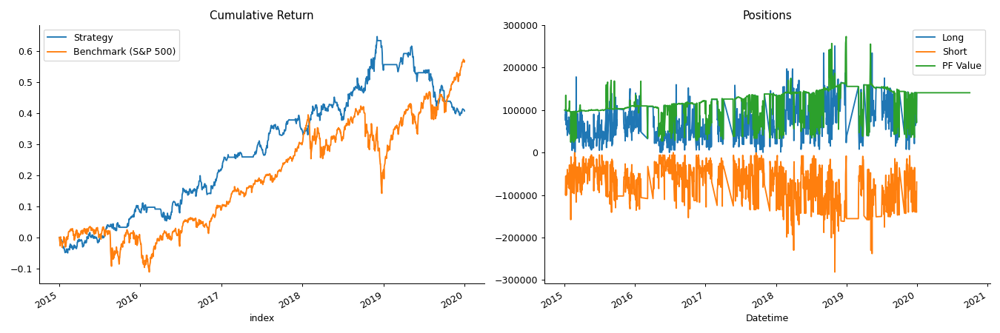

In [375]:
# Plotting returns vs S&P500
fig, axes = plt.subplots(ncols=2, figsize=(15, 5))

df = returns.to_frame('Strategy').join(benchmark.to_frame('Benchmark (S&P 500)'))
df.add(1).cumprod().sub(1).plot(ax=axes[0], title='Cumulative Return')

longs.plot(label='Long',ax=axes[1], title='Positions')
shorts.plot(ax=axes[1], label='Short')
positions.cash.plot(ax=axes[1], label='PF Value')
axes[1].legend()
sns.despine()
fig.tight_layout();

Start date,2015-01-02
End date,2020-10-01
Total months,68
,Backtest
Annual return,6.131%
Cumulative returns,40.766%
Annual volatility,7.623%
Sharpe ratio,0.82
Calmar ratio,0.40
Stability,0.80
Max drawdown,-15.399%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,15.40,2018-12-03,2019-12-10,NaT,NaN
1,5.15,2016-01-12,2016-04-29,2016-05-27,99
2,5.14,2018-05-24,2018-06-27,2018-07-26,46
3,5.07,2016-09-27,2016-10-28,2016-12-13,56
4,5.01,2015-01-05,2015-02-09,2015-05-07,89


<IPython.core.display.Javascript object>


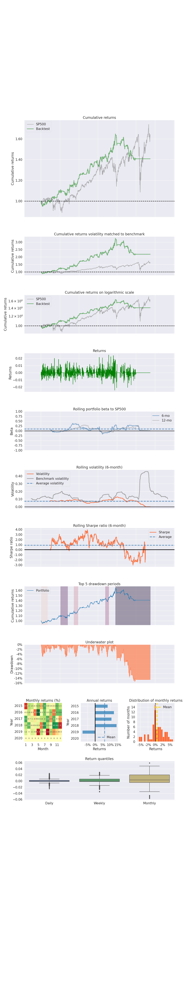

Stress Events,mean,min,max
Fall2015,0.01%,-1.03%,2.01%
New Normal,0.02%,-2.44%,2.48%


<IPython.core.display.Javascript object>


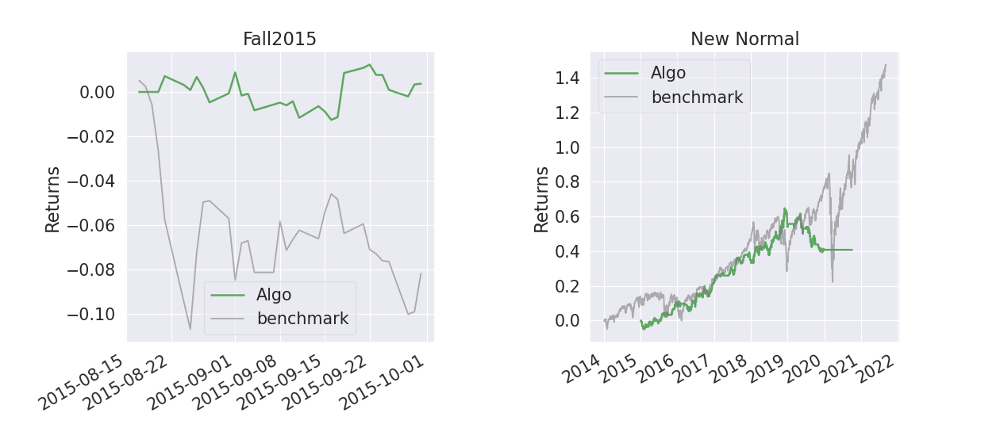

<IPython.core.display.Javascript object>


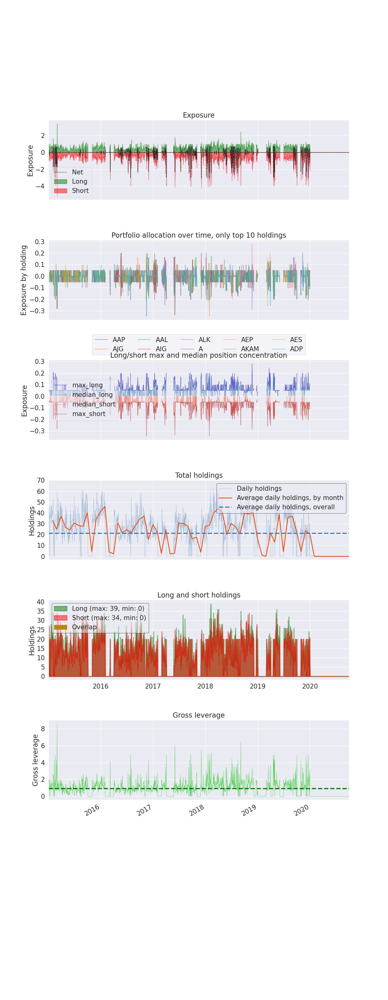

Top 10 long positions of all time,max
sid,
AEP,28.21%
ABMD,24.62%
BIIB,20.76%
ALB,20.51%
UNM,20.36%
VFC,20.31%
ALGN,20.26%
DD,20.25%
ALK,20.25%


Top 10 short positions of all time,max
sid,
AAP,-34.79%
AJG,-34.60%
AAL,-33.79%
AIG,-33.04%
ALK,-28.95%
A,-28.29%
AKAM,-27.98%
AES,-25.75%
ADP,-25.36%


Top 10 positions of all time,max
sid,
AAP,34.79%
AJG,34.60%
AAL,33.79%
AIG,33.04%
ALK,28.95%
A,28.29%
AEP,28.21%
AKAM,27.98%
AES,25.75%


<IPython.core.display.Javascript object>


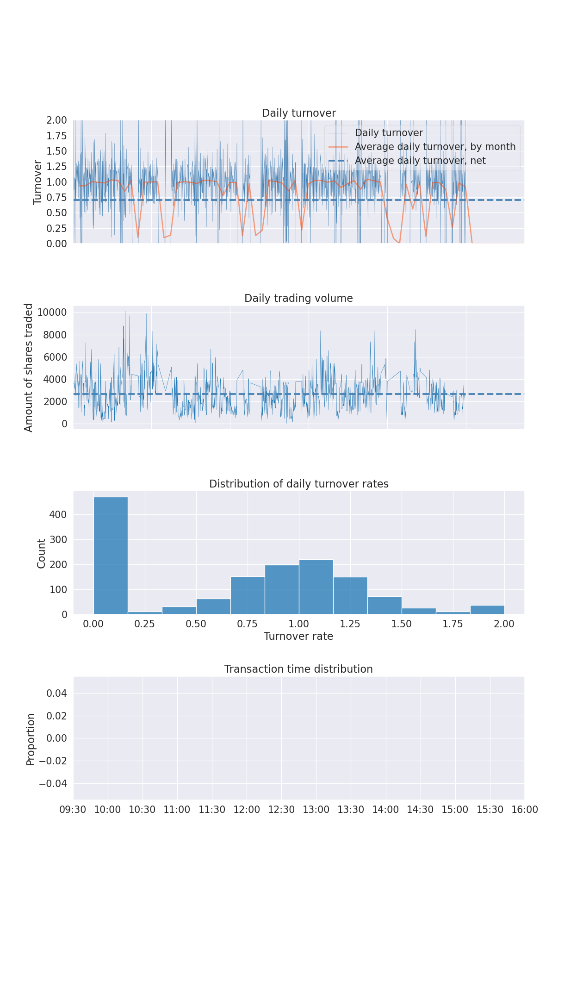

In [376]:
# Complete PyFolio evaluation
pf.create_full_tear_sheet(returns,
                          transactions=transactions,
                          positions=positions,
                          benchmark_rets=benchmark.dropna());

### Backtesting: ARMA

In [409]:
# Initiating Cerebro
cerebro = bt.Cerebro()
cash = 100000
cerebro.broker.setcash(cash)

In [410]:
# Defining input
class SignalData(PandasData):
    
    cols = OHLCV + ['target21day']

    lines = tuple(cols)

    params = {c: -1 for c in cols}
    params.update({'datetime': None})
    params = tuple(params.items())

In [411]:
# Feeding data
data = pd.read_csv('./predictions/arma_preds.csv')
data.date = pd.to_datetime(data.date)
data.set_index(['ticker','date'], inplace=True)
tickers = data.index.get_level_values(0).unique()

for ticker in tickers:
    df = data.loc[idx[ticker,'2015-01-02':], :].droplevel('ticker', axis=0)
    df.index.name = 'datetime'
    bt_data = SignalData(dataname=df)
    cerebro.adddata(bt_data, name=ticker)

In [412]:
df

,open,high,low,close,volume,target21day
datetime,,,,,,
2015-01-02,41.542856,41.772271,41.170061,41.399475,1784200.0,0.018534
2015-01-05,41.342122,41.705360,41.074475,41.150944,3112100.0,-0.028624
2015-01-06,41.246524,41.447259,40.434018,40.749462,3977200.0,-0.037154
2015-01-07,41.103148,41.638446,41.084030,41.590649,2481800.0,-0.027949
2015-01-08,42.775942,42.890647,42.059027,42.231087,3121300.0,-0.007264
...,...,...,...,...,...,...
2020-09-25,156.558325,160.566025,156.379329,159.949448,1195900.0,0.018542
2020-09-28,161.262134,163.430056,160.267671,160.426788,2293800.0,0.018541
2020-09-29,160.725114,162.505211,160.546118,161.580353,1046300.0,0.018541


In [413]:
# Defining Strategy
class ARMAStrategy(bt.Strategy):
    params = (('n_positions', 20),
              ('min_positions', 5),
              ('verbose', False))

    def log(self, txt, dt=None):
        print('%s | %s' % (self.datas[0].datetime.date(0).isoformat(), txt))
        
    def notify_trade(self, trade):
        if not trade.isclosed:
            return

        self.log(f'{trade.data._name}: OPERATION PROFIT {trade.pnl}')

    def notify_order(self, order):
        
        if order.status in [order.Submitted, order.Accepted]:
            return
        
        if self.p.verbose:
            if order.status in [order.Completed]:
                p = order.executed.price
                if order.isbuy():
                    self.log(f'{order.data._name}: BUY executed {p:.2f}')
                elif order.issell():
                    self.log(f'{order.data._name}: SELL executed {p:.2f}')

            elif order.status in [order.Canceled, order.Margin, order.Rejected]:
                self.log(f'{order.data._name}: Order Canceled/Margin/Rejected')

    def prenext(self):
        self.next()

    def next(self):
        today = self.datas[0].datetime.date()

        positions = [d._name for d, pos in self.getpositions().items() if pos]
        up, down = {}, {}
        missing = not_missing = 0
        for data in self.datas:
            if data.datetime.date() == today:
                if data.target21day[0] > 0:
                    up[data._name] = data.target21day[0]
                elif data.target21day[0] < 0:
                    down[data._name] = data.target21day[0]

        shorts = sorted(down, key=down.get)[:self.p.n_positions]
        longs = sorted(up, key=up.get, reverse=True)[:self.p.n_positions]
        n_shorts, n_longs = len(shorts), len(longs)
        
        if n_shorts < self.p.min_positions or n_longs < self.p.min_positions:
            longs, shorts = [], []
        for ticker in positions:
            if ticker not in longs + shorts:
                self.order_target_percent(data=ticker, target=0)
                self.log(f'{ticker}: TRADE CLOSING ORDER CREATED')

        short_target = -1 / max(self.p.n_positions, n_shorts)
        long_target = 1 / max(self.p.n_positions, n_longs)
        for ticker in shorts:
            self.order_target_percent(data=ticker, target=short_target)
            self.log(f'{ticker}: SHORT ORDER CREATED')
        for ticker in longs:
            self.order_target_percent(data=ticker, target=long_target)
            self.log(f'{ticker}: LONG ORDER CREATED')

In [414]:
# Backtesting
cerebro.addanalyzer(bt.analyzers.PyFolio, _name='pyfolio')
cerebro.addstrategy(ARMAStrategy)
cerebro.addsizer(bt.sizers.FixedSize, stake=1000)
cerebro.broker.setcommission(0.001)
results = cerebro.run()
ending_value = cerebro.broker.getvalue()

print(f'Final Portfolio Value: {ending_value:,.2f}')

2015-01-02 | BBWI: SHORT ORDER CREATED
2015-01-02 | PRGO: SHORT ORDER CREATED
2015-01-02 | VTRS: SHORT ORDER CREATED
2015-01-02 | APA: SHORT ORDER CREATED
2015-01-02 | NOV: SHORT ORDER CREATED
2015-01-02 | DISH: SHORT ORDER CREATED
2015-01-02 | GE: SHORT ORDER CREATED
2015-01-02 | MOS: SHORT ORDER CREATED
2015-01-02 | GPS: SHORT ORDER CREATED
2015-01-02 | IVZ: SHORT ORDER CREATED
2015-01-02 | DVN: SHORT ORDER CREATED
2015-01-02 | SLB: SHORT ORDER CREATED
2015-01-02 | NLSN: SHORT ORDER CREATED
2015-01-02 | FCX: SHORT ORDER CREATED
2015-01-02 | MRO: SHORT ORDER CREATED
2015-01-02 | BEN: SHORT ORDER CREATED
2015-01-02 | COG: SHORT ORDER CREATED
2015-01-02 | HBI: SHORT ORDER CREATED
2015-01-02 | MCK: SHORT ORDER CREATED
2015-01-02 | AAL: SHORT ORDER CREATED
2015-01-02 | AMD: LONG ORDER CREATED
2015-01-02 | CZR: LONG ORDER CREATED
2015-01-02 | NVDA: LONG ORDER CREATED
2015-01-02 | PAYC: LONG ORDER CREATED
2015-01-02 | NFLX: LONG ORDER CREATED
2015-01-02 | MKTX: LONG ORDER CREATED
2015-01-02

2015-01-07 | MKTX: OPERATION PROFIT -124.90947276629146
2015-01-07 | CTAS: OPERATION PROFIT -31.947435021004793
2015-01-07 | ALK: OPERATION PROFIT -60.561933177075616
2015-01-07 | AVGO: OPERATION PROFIT -97.38122764483407
2015-01-07 | BF-B: OPERATION PROFIT 13.734311449133138
2015-01-07 | GILD: OPERATION PROFIT -43.5917641889195
2015-01-07 | GLW: OPERATION PROFIT 131.11030425588447
2015-01-07 | LDOS: OPERATION PROFIT 22.59520804188371
2015-01-07 | MS: OPERATION PROFIT -72.48086061647271
2015-01-07 | PM: OPERATION PROFIT -52.61196086145014
2015-01-07 | PTC: OPERATION PROFIT 22.71997833251953
2015-01-07 | RCL: OPERATION PROFIT 42.98470551134315
2015-01-07 | SEE: OPERATION PROFIT 32.19944462319887
2015-01-07 | SIVB: OPERATION PROFIT -111.15005493164062
2015-01-07 | TWTR: OPERATION PROFIT -390.53972625732325
2015-01-07 | XRAY: OPERATION PROFIT 21.466420326971473
2015-01-07 | YUM: OPERATION PROFIT 27.626075843748595
2015-01-07 | ARE: TRADE CLOSING ORDER CREATED
2015-01-07 | BWA: TRADE CLOSI

2015-01-12 | GRMN: TRADE CLOSING ORDER CREATED
2015-01-12 | HII: TRADE CLOSING ORDER CREATED
2015-01-12 | MU: TRADE CLOSING ORDER CREATED
2015-01-12 | QRVO: TRADE CLOSING ORDER CREATED
2015-01-12 | REGN: TRADE CLOSING ORDER CREATED
2015-01-12 | VNO: TRADE CLOSING ORDER CREATED
2015-01-12 | URI: SHORT ORDER CREATED
2015-01-12 | ENPH: SHORT ORDER CREATED
2015-01-12 | NUE: SHORT ORDER CREATED
2015-01-12 | OKE: SHORT ORDER CREATED
2015-01-12 | CMA: SHORT ORDER CREATED
2015-01-12 | ATVI: SHORT ORDER CREATED
2015-01-12 | MET: SHORT ORDER CREATED
2015-01-12 | C: SHORT ORDER CREATED
2015-01-12 | INCY: SHORT ORDER CREATED
2015-01-12 | WMB: SHORT ORDER CREATED
2015-01-12 | IVZ: SHORT ORDER CREATED
2015-01-12 | TRMB: SHORT ORDER CREATED
2015-01-12 | XLNX: SHORT ORDER CREATED
2015-01-12 | FITB: SHORT ORDER CREATED
2015-01-12 | DISCK: SHORT ORDER CREATED
2015-01-12 | CAT: SHORT ORDER CREATED
2015-01-12 | AMGN: SHORT ORDER CREATED
2015-01-12 | ADM: SHORT ORDER CREATED
2015-01-12 | ZION: SHORT ORDER 

2015-01-16 | ADBE: TRADE CLOSING ORDER CREATED
2015-01-16 | DXCM: TRADE CLOSING ORDER CREATED
2015-01-16 | FITB: TRADE CLOSING ORDER CREATED
2015-01-16 | GPC: TRADE CLOSING ORDER CREATED
2015-01-16 | MET: TRADE CLOSING ORDER CREATED
2015-01-16 | MNST: TRADE CLOSING ORDER CREATED
2015-01-16 | REG: TRADE CLOSING ORDER CREATED
2015-01-16 | TRMB: TRADE CLOSING ORDER CREATED
2015-01-16 | TSLA: TRADE CLOSING ORDER CREATED
2015-01-16 | XLNX: TRADE CLOSING ORDER CREATED
2015-01-16 | ENPH: SHORT ORDER CREATED
2015-01-16 | URI: SHORT ORDER CREATED
2015-01-16 | PVH: SHORT ORDER CREATED
2015-01-16 | NUE: SHORT ORDER CREATED
2015-01-16 | MU: SHORT ORDER CREATED
2015-01-16 | FCX: SHORT ORDER CREATED
2015-01-16 | DISCK: SHORT ORDER CREATED
2015-01-16 | C: SHORT ORDER CREATED
2015-01-16 | DISCA: SHORT ORDER CREATED
2015-01-16 | BAC: SHORT ORDER CREATED
2015-01-16 | PSX: SHORT ORDER CREATED
2015-01-16 | ZION: SHORT ORDER CREATED
2015-01-16 | RF: SHORT ORDER CREATED
2015-01-16 | LKQ: SHORT ORDER CREATED

2015-01-23 | IVZ: OPERATION PROFIT -96.02973932454387
2015-01-23 | AMD: OPERATION PROFIT -123.83988189697266
2015-01-23 | PAYC: OPERATION PROFIT -474.51030921935956
2015-01-23 | BXP: OPERATION PROFIT 112.82063792603861
2015-01-23 | DGX: OPERATION PROFIT 135.01910500014185
2015-01-23 | HAS: OPERATION PROFIT -160.53870336678295
2015-01-23 | IDXX: OPERATION PROFIT 173.25
2015-01-23 | LH: OPERATION PROFIT 87.20000457763808
2015-01-23 | NUE: OPERATION PROFIT 206.06401341649473
2015-01-23 | PSA: OPERATION PROFIT 64.63787309553956
2015-01-23 | TRMB: OPERATION PROFIT -166.34988975524976
2015-01-23 | VRTX: OPERATION PROFIT 52.39990234375
2015-01-23 | BAC: TRADE CLOSING ORDER CREATED
2015-01-23 | C: TRADE CLOSING ORDER CREATED
2015-01-23 | CMA: TRADE CLOSING ORDER CREATED
2015-01-23 | ESS: TRADE CLOSING ORDER CREATED
2015-01-23 | FANG: TRADE CLOSING ORDER CREATED
2015-01-23 | HOLX: TRADE CLOSING ORDER CREATED
2015-01-23 | KEY: TRADE CLOSING ORDER CREATED
2015-01-23 | MAA: TRADE CLOSING ORDER CRE

2015-01-29 | AXP: OPERATION PROFIT 101.43032919716667
2015-01-29 | IDXX: OPERATION PROFIT -34.78001403808618
2015-01-29 | LUV: OPERATION PROFIT 66.70784978674334
2015-01-29 | PVH: OPERATION PROFIT 38.824650099643065
2015-01-29 | SWKS: OPERATION PROFIT -78.05879541869382
2015-01-29 | UAL: OPERATION PROFIT -81.48025512695298
2015-01-29 | XLNX: OPERATION PROFIT 101.59512089093573
2015-01-29 | CF: TRADE CLOSING ORDER CREATED
2015-01-29 | DXCM: TRADE CLOSING ORDER CREATED
2015-01-29 | GILD: TRADE CLOSING ORDER CREATED
2015-01-29 | KLAC: TRADE CLOSING ORDER CREATED
2015-01-29 | OKE: TRADE CLOSING ORDER CREATED
2015-01-29 | RMD: TRADE CLOSING ORDER CREATED
2015-01-29 | WDC: TRADE CLOSING ORDER CREATED
2015-01-29 | FCX: SHORT ORDER CREATED
2015-01-29 | ENPH: SHORT ORDER CREATED
2015-01-29 | NOV: SHORT ORDER CREATED
2015-01-29 | RF: SHORT ORDER CREATED
2015-01-29 | URI: SHORT ORDER CREATED
2015-01-29 | DFS: SHORT ORDER CREATED
2015-01-29 | MU: SHORT ORDER CREATED
2015-01-29 | STX: SHORT ORDER C

2015-02-04 | BSX: OPERATION PROFIT 120.44012928009111
2015-02-04 | CF: OPERATION PROFIT -136.49424892798498
2015-02-04 | J: OPERATION PROFIT -333.2768965632202
2015-02-04 | LNC: OPERATION PROFIT -93.59557823636123
2015-02-04 | MET: OPERATION PROFIT -282.8922734506728
2015-02-04 | VTR: OPERATION PROFIT -68.23272886356202
2015-02-04 | ALK: TRADE CLOSING ORDER CREATED
2015-02-04 | FITB: TRADE CLOSING ORDER CREATED
2015-02-04 | GPC: TRADE CLOSING ORDER CREATED
2015-02-04 | KLAC: TRADE CLOSING ORDER CREATED
2015-02-04 | O: TRADE CLOSING ORDER CREATED
2015-02-04 | PVH: TRADE CLOSING ORDER CREATED
2015-02-04 | SCHW: TRADE CLOSING ORDER CREATED
2015-02-04 | ALB: SHORT ORDER CREATED
2015-02-04 | FCX: SHORT ORDER CREATED
2015-02-04 | MU: SHORT ORDER CREATED
2015-02-04 | NOV: SHORT ORDER CREATED
2015-02-04 | DISCK: SHORT ORDER CREATED
2015-02-04 | FFIV: SHORT ORDER CREATED
2015-02-04 | AAL: SHORT ORDER CREATED
2015-02-04 | DISCA: SHORT ORDER CREATED
2015-02-04 | DFS: SHORT ORDER CREATED
2015-02-0

2015-02-11 | APA: OPERATION PROFIT -281.86334003776284
2015-02-11 | ANET: OPERATION PROFIT -510.0602569580078
2015-02-11 | CBOE: OPERATION PROFIT 3.945278427878705
2015-02-11 | HOLX: OPERATION PROFIT -69.15005302429371
2015-02-11 | KLAC: OPERATION PROFIT -93.74818575906045
2015-02-11 | PSX: OPERATION PROFIT -17.169535002100773
2015-02-11 | QCOM: OPERATION PROFIT -622.0131185756669
2015-02-11 | SIVB: OPERATION PROFIT 16.770011901853806
2015-02-11 | SWKS: OPERATION PROFIT -52.40853270832986
2015-02-11 | VLO: OPERATION PROFIT 74.00940535663084
2015-02-11 | AAL: TRADE CLOSING ORDER CREATED
2015-02-11 | MKTX: TRADE CLOSING ORDER CREATED
2015-02-11 | AES: TRADE CLOSING ORDER CREATED
2015-02-11 | BA: TRADE CLOSING ORDER CREATED
2015-02-11 | EOG: TRADE CLOSING ORDER CREATED
2015-02-11 | FANG: TRADE CLOSING ORDER CREATED
2015-02-11 | LYB: TRADE CLOSING ORDER CREATED
2015-02-11 | MU: TRADE CLOSING ORDER CREATED
2015-02-11 | SJM: TRADE CLOSING ORDER CREATED
2015-02-11 | UPS: TRADE CLOSING ORDER C

2015-02-19 | LYB: OPERATION PROFIT -54.255769333607645
2015-02-19 | NEM: OPERATION PROFIT 92.80667712503198
2015-02-19 | AEP: TRADE CLOSING ORDER CREATED
2015-02-19 | ATVI: TRADE CLOSING ORDER CREATED
2015-02-19 | BKR: TRADE CLOSING ORDER CREATED
2015-02-19 | DTE: TRADE CLOSING ORDER CREATED
2015-02-19 | DUK: TRADE CLOSING ORDER CREATED
2015-02-19 | HAL: TRADE CLOSING ORDER CREATED
2015-02-19 | K: TRADE CLOSING ORDER CREATED
2015-02-19 | SIVB: TRADE CLOSING ORDER CREATED
2015-02-19 | UPS: TRADE CLOSING ORDER CREATED
2015-02-19 | RL: SHORT ORDER CREATED
2015-02-19 | AES: SHORT ORDER CREATED
2015-02-19 | FE: SHORT ORDER CREATED
2015-02-19 | PEAK: SHORT ORDER CREATED
2015-02-19 | ABBV: SHORT ORDER CREATED
2015-02-19 | ETR: SHORT ORDER CREATED
2015-02-19 | ATO: SHORT ORDER CREATED
2015-02-19 | MAA: SHORT ORDER CREATED
2015-02-19 | EXC: SHORT ORDER CREATED
2015-02-19 | AEE: SHORT ORDER CREATED
2015-02-19 | PEG: SHORT ORDER CREATED
2015-02-19 | AIZ: SHORT ORDER CREATED
2015-02-19 | RCL: SHOR

2015-02-26 | NOV: OPERATION PROFIT 32.78233254588673
2015-02-26 | NOW: OPERATION PROFIT 157.80029296875
2015-02-26 | AIZ: OPERATION PROFIT -30.156975394193104
2015-02-26 | AKAM: OPERATION PROFIT -141.32974243164105
2015-02-26 | EXC: OPERATION PROFIT -217.1270157625481
2015-02-26 | HAS: OPERATION PROFIT 42.36199030357223
2015-02-26 | KLAC: OPERATION PROFIT 16.338848880238267
2015-02-26 | QRVO: OPERATION PROFIT 177.8100128173828
2015-02-26 | UPS: OPERATION PROFIT 18.85038105414992
2015-02-26 | CZR: TRADE CLOSING ORDER CREATED
2015-02-26 | AAPL: TRADE CLOSING ORDER CREATED
2015-02-26 | DHI: TRADE CLOSING ORDER CREATED
2015-02-26 | DTE: TRADE CLOSING ORDER CREATED
2015-02-26 | ENPH: TRADE CLOSING ORDER CREATED
2015-02-26 | FAST: TRADE CLOSING ORDER CREATED
2015-02-26 | LEN: TRADE CLOSING ORDER CREATED
2015-02-26 | NWS: TRADE CLOSING ORDER CREATED
2015-02-26 | RCL: TRADE CLOSING ORDER CREATED
2015-02-26 | VTR: TRADE CLOSING ORDER CREATED
2015-02-26 | RL: SHORT ORDER CREATED
2015-02-26 | FE:

2015-03-05 | AMZN: OPERATION PROFIT 329.1596984863281
2015-03-05 | ABMD: OPERATION PROFIT 858.9597702026367
2015-03-05 | ATO: OPERATION PROFIT 9.73601569251175
2015-03-05 | CRM: OPERATION PROFIT -157.87961578369135
2015-03-05 | D: OPERATION PROFIT -17.95129535630855
2015-03-05 | NWS: OPERATION PROFIT -2.8245243272640295
2015-03-05 | WU: OPERATION PROFIT 4.7911544515273
2015-03-05 | AMD: TRADE CLOSING ORDER CREATED
2015-03-05 | CBOE: TRADE CLOSING ORDER CREATED
2015-03-05 | CMS: TRADE CLOSING ORDER CREATED
2015-03-05 | CNP: TRADE CLOSING ORDER CREATED
2015-03-05 | DIS: TRADE CLOSING ORDER CREATED
2015-03-05 | DISCK: TRADE CLOSING ORDER CREATED
2015-03-05 | XEL: TRADE CLOSING ORDER CREATED
2015-03-05 | RL: SHORT ORDER CREATED
2015-03-05 | TTWO: SHORT ORDER CREATED
2015-03-05 | FE: SHORT ORDER CREATED
2015-03-05 | ETR: SHORT ORDER CREATED
2015-03-05 | FAST: SHORT ORDER CREATED
2015-03-05 | DTE: SHORT ORDER CREATED
2015-03-05 | WEC: SHORT ORDER CREATED
2015-03-05 | DUK: SHORT ORDER CREATED

2015-03-12 | HBI: OPERATION PROFIT 53.13109933162032
2015-03-12 | AMD: OPERATION PROFIT 259.04013895988464
2015-03-12 | DLR: OPERATION PROFIT 19.977083024505717
2015-03-12 | DTE: OPERATION PROFIT 193.71459201259586
2015-03-12 | ES: OPERATION PROFIT 125.27179700436542
2015-03-12 | ETR: OPERATION PROFIT 227.51834933990497
2015-03-12 | EVRG: OPERATION PROFIT 292.7666420370056
2015-03-12 | EXC: OPERATION PROFIT 33.748099749168894
2015-03-12 | LNT: OPERATION PROFIT 136.65431976804257
2015-03-12 | NRG: OPERATION PROFIT 34.28620776279821
2015-03-12 | TWTR: OPERATION PROFIT -71.82987594604364
2015-03-12 | VMC: OPERATION PROFIT -29.625697456291675
2015-03-12 | VTR: OPERATION PROFIT 0.0013352422618453375
2015-03-12 | WBA: OPERATION PROFIT 41.981870059957174
2015-03-12 | WEC: OPERATION PROFIT 44.04419606932221
2015-03-12 | COP: TRADE CLOSING ORDER CREATED
2015-03-12 | IRM: TRADE CLOSING ORDER CREATED
2015-03-12 | OXY: TRADE CLOSING ORDER CREATED
2015-03-12 | PPL: TRADE CLOSING ORDER CREATED
2015-

2015-03-18 | TSLA: OPERATION PROFIT -162.9398994445803
2015-03-18 | ULTA: OPERATION PROFIT 41.84971618652344
2015-03-18 | MOS: TRADE CLOSING ORDER CREATED
2015-03-18 | IPGP: TRADE CLOSING ORDER CREATED
2015-03-18 | NLOK: TRADE CLOSING ORDER CREATED
2015-03-18 | PVH: TRADE CLOSING ORDER CREATED
2015-03-18 | WDC: TRADE CLOSING ORDER CREATED
2015-03-18 | WYNN: SHORT ORDER CREATED
2015-03-18 | HWM: SHORT ORDER CREATED
2015-03-18 | HPQ: SHORT ORDER CREATED
2015-03-18 | FCX: SHORT ORDER CREATED
2015-03-18 | MU: SHORT ORDER CREATED
2015-03-18 | MRO: SHORT ORDER CREATED
2015-03-18 | ENPH: SHORT ORDER CREATED
2015-03-18 | STX: SHORT ORDER CREATED
2015-03-18 | GRMN: SHORT ORDER CREATED
2015-03-18 | DVN: SHORT ORDER CREATED
2015-03-18 | AMD: SHORT ORDER CREATED
2015-03-18 | APA: SHORT ORDER CREATED
2015-03-18 | OXY: SHORT ORDER CREATED
2015-03-18 | LVS: SHORT ORDER CREATED
2015-03-18 | COP: SHORT ORDER CREATED
2015-03-18 | INTC: SHORT ORDER CREATED
2015-03-18 | NFLX: SHORT ORDER CREATED
2015-03-1

2015-03-26 | FCX: OPERATION PROFIT -400.71645748902336
2015-03-26 | NFLX: OPERATION PROFIT 56.13142776489216
2015-03-26 | BMY: OPERATION PROFIT -178.4877568053312
2015-03-26 | HCA: OPERATION PROFIT -69.986306664513
2015-03-26 | HUM: OPERATION PROFIT 70.65058972788958
2015-03-26 | INTC: OPERATION PROFIT 134.09904821320475
2015-03-26 | NOV: TRADE CLOSING ORDER CREATED
2015-03-26 | DVN: TRADE CLOSING ORDER CREATED
2015-03-26 | MRO: TRADE CLOSING ORDER CREATED
2015-03-26 | AMCR: TRADE CLOSING ORDER CREATED
2015-03-26 | EMN: TRADE CLOSING ORDER CREATED
2015-03-26 | HES: TRADE CLOSING ORDER CREATED
2015-03-26 | QRVO: TRADE CLOSING ORDER CREATED
2015-03-26 | ROL: TRADE CLOSING ORDER CREATED
2015-03-26 | UNP: TRADE CLOSING ORDER CREATED
2015-03-26 | WBA: TRADE CLOSING ORDER CREATED
2015-03-26 | HWM: SHORT ORDER CREATED
2015-03-26 | HPQ: SHORT ORDER CREATED
2015-03-26 | LKQ: SHORT ORDER CREATED
2015-03-26 | AMD: SHORT ORDER CREATED
2015-03-26 | ENPH: SHORT ORDER CREATED
2015-03-26 | WDC: SHORT 

2015-04-01 | CZR: OPERATION PROFIT 113.04488945007336
2015-04-01 | AMCR: OPERATION PROFIT 0.0
2015-04-01 | BIO: OPERATION PROFIT 61.600341796875
2015-04-01 | BKNG: OPERATION PROFIT -9.0
2015-04-01 | INCY: OPERATION PROFIT -29.39992523193429
2015-04-01 | MNST: OPERATION PROFIT -41.70969772338789
2015-04-01 | NCLH: OPERATION PROFIT 89.60989379882812
2015-04-01 | TSLA: OPERATION PROFIT 117.8519515991211
2015-04-01 | UDR: OPERATION PROFIT -41.864256960850526
2015-04-01 | MKTX: TRADE CLOSING ORDER CREATED
2015-04-01 | ADI: TRADE CLOSING ORDER CREATED
2015-04-01 | DVA: TRADE CLOSING ORDER CREATED
2015-04-01 | HES: TRADE CLOSING ORDER CREATED
2015-04-01 | NTAP: TRADE CLOSING ORDER CREATED
2015-04-01 | NXPI: TRADE CLOSING ORDER CREATED
2015-04-01 | PXD: TRADE CLOSING ORDER CREATED
2015-04-01 | REGN: TRADE CLOSING ORDER CREATED
2015-04-01 | QRVO: SHORT ORDER CREATED
2015-04-01 | LRCX: SHORT ORDER CREATED
2015-04-01 | NEM: SHORT ORDER CREATED
2015-04-01 | WDC: SHORT ORDER CREATED
2015-04-01 | ST

2015-04-09 | COO: OPERATION PROFIT 67.13854965037953
2015-04-09 | ILMN: OPERATION PROFIT -46.50001525878977
2015-04-09 | INTC: OPERATION PROFIT 18.73306966183046
2015-04-09 | LKQ: OPERATION PROFIT 46.80004119873111
2015-04-09 | LUV: OPERATION PROFIT -159.02172362411548
2015-04-09 | NEM: OPERATION PROFIT 230.55221099622963
2015-04-09 | QRVO: OPERATION PROFIT 447.39013671874966
2015-04-09 | RMD: OPERATION PROFIT 86.4421543639211
2015-04-09 | STX: OPERATION PROFIT -18.75713787483378
2015-04-09 | TDY: OPERATION PROFIT 10.920089721680284
2015-04-09 | ULTA: OPERATION PROFIT -45.299835205078125
2015-04-09 | DISH: TRADE CLOSING ORDER CREATED
2015-04-09 | NFLX: TRADE CLOSING ORDER CREATED
2015-04-09 | ABC: TRADE CLOSING ORDER CREATED
2015-04-09 | EXPE: TRADE CLOSING ORDER CREATED
2015-04-09 | GRMN: TRADE CLOSING ORDER CREATED
2015-04-09 | HUM: TRADE CLOSING ORDER CREATED
2015-04-09 | HWM: TRADE CLOSING ORDER CREATED
2015-04-09 | MCO: TRADE CLOSING ORDER CREATED
2015-04-09 | MSI: TRADE CLOSING O

2015-04-15 | MOS: OPERATION PROFIT 73.4270195753887
2015-04-15 | FCX: OPERATION PROFIT -146.60028566320653
2015-04-15 | ABMD: OPERATION PROFIT -216.97010040283257
2015-04-15 | GPN: OPERATION PROFIT -29.427966684115916
2015-04-15 | ANET: OPERATION PROFIT -38.079833984375
2015-04-15 | CBOE: OPERATION PROFIT -99.35505898748329
2015-04-15 | CBRE: OPERATION PROFIT -32.04005432128946
2015-04-15 | EBAY: OPERATION PROFIT 14.180981253438787
2015-04-15 | GRMN: OPERATION PROFIT -46.746934262649404
2015-04-15 | NTAP: OPERATION PROFIT -30.915743276802374
2015-04-15 | SYF: OPERATION PROFIT 23.675443509848236
2015-04-15 | TWTR: OPERATION PROFIT -72.15997314453125
2015-04-15 | ADI: TRADE CLOSING ORDER CREATED
2015-04-15 | AMP: TRADE CLOSING ORDER CREATED
2015-04-15 | CAG: TRADE CLOSING ORDER CREATED
2015-04-15 | CHRW: TRADE CLOSING ORDER CREATED
2015-04-15 | GM: TRADE CLOSING ORDER CREATED
2015-04-15 | INCY: TRADE CLOSING ORDER CREATED
2015-04-15 | LDOS: TRADE CLOSING ORDER CREATED
2015-04-15 | LVS: T

2015-04-21 | LDOS: SHORT ORDER CREATED
2015-04-21 | CHRW: SHORT ORDER CREATED
2015-04-21 | CZR: LONG ORDER CREATED
2015-04-21 | NFLX: LONG ORDER CREATED
2015-04-21 | HAS: LONG ORDER CREATED
2015-04-21 | FCX: LONG ORDER CREATED
2015-04-21 | MRO: LONG ORDER CREATED
2015-04-21 | CE: LONG ORDER CREATED
2015-04-21 | APA: LONG ORDER CREATED
2015-04-21 | FANG: LONG ORDER CREATED
2015-04-21 | COG: LONG ORDER CREATED
2015-04-21 | PRGO: LONG ORDER CREATED
2015-04-21 | HAL: LONG ORDER CREATED
2015-04-21 | ABMD: LONG ORDER CREATED
2015-04-21 | HES: LONG ORDER CREATED
2015-04-21 | DVN: LONG ORDER CREATED
2015-04-21 | ALB: LONG ORDER CREATED
2015-04-21 | SLB: LONG ORDER CREATED
2015-04-21 | NOV: LONG ORDER CREATED
2015-04-21 | LYB: LONG ORDER CREATED
2015-04-21 | OXY: LONG ORDER CREATED
2015-04-21 | URI: LONG ORDER CREATED
2015-04-22 | EXPD: OPERATION PROFIT -13.583752554297519
2015-04-22 | KEYS: OPERATION PROFIT -2.5000572204589844
2015-04-22 | KSU: OPERATION PROFIT 15.285062941508386
2015-04-22 | 

2015-04-27 | RHI: SHORT ORDER CREATED
2015-04-27 | KR: SHORT ORDER CREATED
2015-04-27 | NWSA: SHORT ORDER CREATED
2015-04-27 | FIS: SHORT ORDER CREATED
2015-04-27 | NWS: SHORT ORDER CREATED
2015-04-27 | GNRC: SHORT ORDER CREATED
2015-04-27 | O: SHORT ORDER CREATED
2015-04-27 | GM: SHORT ORDER CREATED
2015-04-27 | CZR: LONG ORDER CREATED
2015-04-27 | NFLX: LONG ORDER CREATED
2015-04-27 | VTRS: LONG ORDER CREATED
2015-04-27 | AMZN: LONG ORDER CREATED
2015-04-27 | CE: LONG ORDER CREATED
2015-04-27 | QRVO: LONG ORDER CREATED
2015-04-27 | INCY: LONG ORDER CREATED
2015-04-27 | LYB: LONG ORDER CREATED
2015-04-27 | DXCM: LONG ORDER CREATED
2015-04-27 | FTNT: LONG ORDER CREATED
2015-04-27 | PRGO: LONG ORDER CREATED
2015-04-27 | HAS: LONG ORDER CREATED
2015-04-27 | ALB: LONG ORDER CREATED
2015-04-27 | MSFT: LONG ORDER CREATED
2015-04-27 | LHX: LONG ORDER CREATED
2015-04-27 | ABBV: LONG ORDER CREATED
2015-04-27 | GPN: LONG ORDER CREATED
2015-04-27 | JNPR: LONG ORDER CREATED
2015-04-27 | MRO: LONG

2015-05-04 | CE: LONG ORDER CREATED
2015-05-04 | TSLA: LONG ORDER CREATED
2015-05-04 | MSFT: LONG ORDER CREATED
2015-05-04 | JNPR: LONG ORDER CREATED
2015-05-04 | LYB: LONG ORDER CREATED
2015-05-04 | NEM: LONG ORDER CREATED
2015-05-04 | YUM: LONG ORDER CREATED
2015-05-04 | MRO: LONG ORDER CREATED
2015-05-04 | STX: LONG ORDER CREATED
2015-05-04 | QRVO: LONG ORDER CREATED
2015-05-04 | EMN: LONG ORDER CREATED
2015-05-04 | AMZN: LONG ORDER CREATED
2015-05-04 | ALB: LONG ORDER CREATED
2015-05-04 | ALGN: LONG ORDER CREATED
2015-05-04 | ABBV: LONG ORDER CREATED
2015-05-04 | FTNT: LONG ORDER CREATED
2015-05-05 | APA: OPERATION PROFIT 53.28908624117277
2015-05-05 | DVN: OPERATION PROFIT 35.47945971358022
2015-05-05 | SLB: OPERATION PROFIT -24.422653845361594
2015-05-05 | COG: OPERATION PROFIT 94.21015761012583
2015-05-05 | BIIB: OPERATION PROFIT 41.799865722656875
2015-05-05 | HAS: OPERATION PROFIT -86.65248437814716
2015-05-05 | HES: OPERATION PROFIT -172.08341974587825
2015-05-05 | UAL: OPERA

2015-05-11 | PRGO: OPERATION PROFIT 130.71841344289226
2015-05-11 | VTRS: OPERATION PROFIT -56.190951852688215
2015-05-11 | CCL: OPERATION PROFIT -116.37220559643922
2015-05-11 | ETSY: OPERATION PROFIT 455.5600395202625
2015-05-11 | LEN: OPERATION PROFIT -121.50342319828943
2015-05-11 | PEAK: OPERATION PROFIT -30.85004505829678
2015-05-11 | QRVO: OPERATION PROFIT 410.76983642578114
2015-05-11 | VTR: OPERATION PROFIT -93.85720941679631
2015-05-11 | ABBV: TRADE CLOSING ORDER CREATED
2015-05-11 | ADSK: TRADE CLOSING ORDER CREATED
2015-05-11 | ALB: TRADE CLOSING ORDER CREATED
2015-05-11 | BIIB: TRADE CLOSING ORDER CREATED
2015-05-11 | CNC: TRADE CLOSING ORDER CREATED
2015-05-11 | DHI: TRADE CLOSING ORDER CREATED
2015-05-11 | TWTR: SHORT ORDER CREATED
2015-05-11 | ENPH: SHORT ORDER CREATED
2015-05-11 | HII: SHORT ORDER CREATED
2015-05-11 | AMD: SHORT ORDER CREATED
2015-05-11 | IDXX: SHORT ORDER CREATED
2015-05-11 | GNRC: SHORT ORDER CREATED
2015-05-11 | MGM: SHORT ORDER CREATED
2015-05-11 |

2015-05-15 | COG: OPERATION PROFIT 146.16483337839878
2015-05-15 | CERN: OPERATION PROFIT -21.578020208710612
2015-05-15 | EA: OPERATION PROFIT 36.0743180079693
2015-05-15 | HAS: OPERATION PROFIT 32.326072880723075
2015-05-15 | JCI: OPERATION PROFIT -7.859350500482435
2015-05-15 | LVS: OPERATION PROFIT 16.855371312900374
2015-05-15 | PKG: OPERATION PROFIT -93.33141823509408
2015-05-15 | TMUS: OPERATION PROFIT -7.772421357348833
2015-05-15 | WM: OPERATION PROFIT -57.71511639778902
2015-05-15 | HBI: TRADE CLOSING ORDER CREATED
2015-05-15 | EW: TRADE CLOSING ORDER CREATED
2015-05-15 | FFIV: TRADE CLOSING ORDER CREATED
2015-05-15 | LYB: TRADE CLOSING ORDER CREATED
2015-05-15 | MLM: TRADE CLOSING ORDER CREATED
2015-05-15 | QRVO: TRADE CLOSING ORDER CREATED
2015-05-15 | RCL: TRADE CLOSING ORDER CREATED
2015-05-15 | ROK: TRADE CLOSING ORDER CREATED
2015-05-15 | VTR: TRADE CLOSING ORDER CREATED
2015-05-15 | ENPH: SHORT ORDER CREATED
2015-05-15 | TWTR: SHORT ORDER CREATED
2015-05-15 | RMD: SHOR

2015-05-21 | ROK: LONG ORDER CREATED
2015-05-22 | NOV: OPERATION PROFIT -34.82402164664991
2015-05-22 | MRO: OPERATION PROFIT -82.03527488960337
2015-05-22 | PAYC: OPERATION PROFIT 41.42001724243154
2015-05-22 | FTNT: OPERATION PROFIT -13.349925994872898
2015-05-22 | LRCX: OPERATION PROFIT 52.845809460463954
2015-05-22 | ETSY: OPERATION PROFIT -114.74970817565918
2015-05-22 | HES: OPERATION PROFIT -6.681620925742763
2015-05-22 | LVS: OPERATION PROFIT -169.46747790776288
2015-05-22 | MGM: OPERATION PROFIT -173.62893747954666
2015-05-22 | NCLH: OPERATION PROFIT 31.19995117187443
2015-05-22 | REGN: OPERATION PROFIT 5.19970703125
2015-05-22 | UAA: OPERATION PROFIT 24.41971206665039
2015-05-22 | CZR: TRADE CLOSING ORDER CREATED
2015-05-22 | CMG: TRADE CLOSING ORDER CREATED
2015-05-22 | DPZ: TRADE CLOSING ORDER CREATED
2015-05-22 | EQIX: TRADE CLOSING ORDER CREATED
2015-05-22 | ISRG: TRADE CLOSING ORDER CREATED
2015-05-22 | KEYS: TRADE CLOSING ORDER CREATED
2015-05-22 | MDLZ: TRADE CLOSING O

2015-05-28 | TTWO: LONG ORDER CREATED
2015-05-28 | LYV: LONG ORDER CREATED
2015-05-28 | MLM: LONG ORDER CREATED
2015-05-28 | SEE: LONG ORDER CREATED
2015-05-28 | CF: LONG ORDER CREATED
2015-05-28 | EQIX: LONG ORDER CREATED
2015-05-28 | RCL: LONG ORDER CREATED
2015-05-28 | NFLX: LONG ORDER CREATED
2015-05-29 | ABMD: OPERATION PROFIT 41.03997802734375
2015-05-29 | ADSK: OPERATION PROFIT 39.49999999999944
2015-05-29 | AIZ: OPERATION PROFIT -14.287634706580576
2015-05-29 | CHRW: OPERATION PROFIT 117.57776847900686
2015-05-29 | GNRC: OPERATION PROFIT -14.559936523436761
2015-05-29 | LVS: OPERATION PROFIT -69.27799421587895
2015-05-29 | ROK: OPERATION PROFIT -55.847860408979386
2015-05-29 | TSLA: OPERATION PROFIT 391.11222839355486
2015-05-29 | TSN: OPERATION PROFIT -99.0339222474955
2015-05-29 | XLNX: OPERATION PROFIT 31.33861280294309
2015-05-29 | DAL: TRADE CLOSING ORDER CREATED
2015-05-29 | EXPE: TRADE CLOSING ORDER CREATED
2015-05-29 | IDXX: TRADE CLOSING ORDER CREATED
2015-05-29 | MNST

2015-06-04 | NOV: OPERATION PROFIT 74.07375668830684
2015-06-04 | AOS: OPERATION PROFIT 17.22367010602799
2015-06-04 | AVY: OPERATION PROFIT 44.80877138885248
2015-06-04 | EXPE: OPERATION PROFIT -52.89929105903494
2015-06-04 | GILD: OPERATION PROFIT -14.018736670381827
2015-06-04 | HAL: OPERATION PROFIT 65.08736898267907
2015-06-04 | INCY: OPERATION PROFIT 6.39984130859375
2015-06-04 | LYV: OPERATION PROFIT 14.630022048951364
2015-06-04 | MGM: OPERATION PROFIT -59.451210172726775
2015-06-04 | NXPI: OPERATION PROFIT -145.85833199673937
2015-06-04 | TER: OPERATION PROFIT 50.27716291107621
2015-06-04 | PAYC: TRADE CLOSING ORDER CREATED
2015-06-04 | CTSH: TRADE CLOSING ORDER CREATED
2015-06-04 | HCA: TRADE CLOSING ORDER CREATED
2015-06-04 | SWKS: TRADE CLOSING ORDER CREATED
2015-06-04 | TRMB: TRADE CLOSING ORDER CREATED
2015-06-04 | TSLA: TRADE CLOSING ORDER CREATED
2015-06-04 | UHS: TRADE CLOSING ORDER CREATED
2015-06-04 | URI: TRADE CLOSING ORDER CREATED
2015-06-04 | ETSY: SHORT ORDER CR

2015-06-09 | DISH: LONG ORDER CREATED
2015-06-09 | NFLX: LONG ORDER CREATED
2015-06-09 | ILMN: LONG ORDER CREATED
2015-06-09 | SIVB: LONG ORDER CREATED
2015-06-09 | LLY: LONG ORDER CREATED
2015-06-09 | PVH: LONG ORDER CREATED
2015-06-09 | LRCX: LONG ORDER CREATED
2015-06-09 | LYV: LONG ORDER CREATED
2015-06-10 | NOV: OPERATION PROFIT 1.2919486423684816
2015-06-10 | ABMD: OPERATION PROFIT 204.29996871948276
2015-06-10 | ATVI: OPERATION PROFIT -45.56022696002245
2015-06-10 | CI: OPERATION PROFIT -84.1914780070756
2015-06-10 | HII: OPERATION PROFIT 105.1247266412663
2015-06-10 | NCLH: OPERATION PROFIT 39.19996261596652
2015-06-10 | SWKS: OPERATION PROFIT -123.948814588394
2015-06-10 | MRO: TRADE CLOSING ORDER CREATED
2015-06-10 | CZR: TRADE CLOSING ORDER CREATED
2015-06-10 | LRCX: TRADE CLOSING ORDER CREATED
2015-06-10 | KSU: TRADE CLOSING ORDER CREATED
2015-06-10 | LYV: TRADE CLOSING ORDER CREATED
2015-06-10 | MNST: TRADE CLOSING ORDER CREATED
2015-06-10 | QRVO: TRADE CLOSING ORDER CREAT

2015-06-18 | DISH: OPERATION PROFIT -196.59991455078114
2015-06-18 | NLOK: OPERATION PROFIT -78.31005257937022
2015-06-18 | PENN: OPERATION PROFIT 39.44009438980201
2015-06-18 | PVH: OPERATION PROFIT 64.24682254890784
2015-06-18 | SWKS: OPERATION PROFIT 124.47003063700997
2015-06-18 | TRMB: OPERATION PROFIT 43.02027511596715
2015-06-18 | UHS: OPERATION PROFIT 53.64095082947949
2015-06-18 | NFLX: TRADE CLOSING ORDER CREATED
2015-06-18 | ALGN: TRADE CLOSING ORDER CREATED
2015-06-18 | ADSK: TRADE CLOSING ORDER CREATED
2015-06-18 | ALB: TRADE CLOSING ORDER CREATED
2015-06-18 | CFG: TRADE CLOSING ORDER CREATED
2015-06-18 | CMA: TRADE CLOSING ORDER CREATED
2015-06-18 | MO: TRADE CLOSING ORDER CREATED
2015-06-18 | SIVB: TRADE CLOSING ORDER CREATED
2015-06-18 | ETSY: SHORT ORDER CREATED
2015-06-18 | LUV: SHORT ORDER CREATED
2015-06-18 | AAL: SHORT ORDER CREATED
2015-06-18 | UAL: SHORT ORDER CREATED
2015-06-18 | ENPH: SHORT ORDER CREATED
2015-06-18 | OKE: SHORT ORDER CREATED
2015-06-18 | DAL: S

2015-06-26 | FTNT: OPERATION PROFIT -123.85005187988317
2015-06-26 | CMA: OPERATION PROFIT 7.232696953659641
2015-06-26 | GNRC: OPERATION PROFIT -54.74022674560623
2015-06-26 | HPQ: OPERATION PROFIT 152.33684022403187
2015-06-26 | IP: OPERATION PROFIT 59.55916192194297
2015-06-26 | KMI: OPERATION PROFIT 100.15240694712307
2015-06-26 | ROL: OPERATION PROFIT 149.67977015123762
2015-06-26 | UAA: OPERATION PROFIT 22.440120697021484
2015-06-26 | WDC: OPERATION PROFIT 154.463356917367
2015-06-26 | COG: TRADE CLOSING ORDER CREATED
2015-06-26 | CZR: TRADE CLOSING ORDER CREATED
2015-06-26 | NFLX: TRADE CLOSING ORDER CREATED
2015-06-26 | AKAM: TRADE CLOSING ORDER CREATED
2015-06-26 | DGX: TRADE CLOSING ORDER CREATED
2015-06-26 | DXCM: TRADE CLOSING ORDER CREATED
2015-06-26 | EIX: TRADE CLOSING ORDER CREATED
2015-06-26 | FB: TRADE CLOSING ORDER CREATED
2015-06-26 | GILD: TRADE CLOSING ORDER CREATED
2015-06-26 | MET: TRADE CLOSING ORDER CREATED
2015-06-26 | PENN: TRADE CLOSING ORDER CREATED
2015-0

2015-07-06 | NVDA: OPERATION PROFIT 77.64771334465384
2015-07-06 | ADM: OPERATION PROFIT 58.90324489026682
2015-07-06 | DRI: OPERATION PROFIT -83.91073692614536
2015-07-06 | EMN: OPERATION PROFIT -182.17172582731655
2015-07-06 | FB: OPERATION PROFIT -5.500030517578125
2015-07-06 | HPQ: OPERATION PROFIT -45.57769776985529
2015-07-06 | INTC: OPERATION PROFIT 55.4759668668233
2015-07-06 | IRM: OPERATION PROFIT 86.14429446041441
2015-07-06 | MET: OPERATION PROFIT -78.39850785632109
2015-07-06 | PNR: OPERATION PROFIT -116.00101279029056
2015-07-06 | PVH: OPERATION PROFIT 13.487179506722839
2015-07-06 | QCOM: OPERATION PROFIT 30.55721624907317
2015-07-06 | SIVB: OPERATION PROFIT -66.30020141601562
2015-07-06 | VIAC: OPERATION PROFIT 133.63363386466443
2015-07-06 | ZION: OPERATION PROFIT -128.0068315162774
2015-07-06 | DVN: TRADE CLOSING ORDER CREATED
2015-07-06 | FCX: TRADE CLOSING ORDER CREATED
2015-07-06 | AAL: TRADE CLOSING ORDER CREATED
2015-07-06 | ABMD: TRADE CLOSING ORDER CREATED
2015

2015-07-13 | DLR: OPERATION PROFIT 93.22591934184234
2015-07-13 | HST: OPERATION PROFIT 28.031561434142816
2015-07-13 | LLY: OPERATION PROFIT 191.93537546764813
2015-07-13 | MPC: OPERATION PROFIT 329.83470674503815
2015-07-13 | NEM: OPERATION PROFIT 219.85916740006394
2015-07-13 | URI: OPERATION PROFIT 12.420181274414062
2015-07-13 | ALB: TRADE CLOSING ORDER CREATED
2015-07-13 | FMC: TRADE CLOSING ORDER CREATED
2015-07-13 | NKE: TRADE CLOSING ORDER CREATED
2015-07-13 | PENN: TRADE CLOSING ORDER CREATED
2015-07-13 | WST: TRADE CLOSING ORDER CREATED
2015-07-13 | WU: TRADE CLOSING ORDER CREATED
2015-07-13 | ENPH: SHORT ORDER CREATED
2015-07-13 | MU: SHORT ORDER CREATED
2015-07-13 | QRVO: SHORT ORDER CREATED
2015-07-13 | WRK: SHORT ORDER CREATED
2015-07-13 | ETSY: SHORT ORDER CREATED
2015-07-13 | FCX: SHORT ORDER CREATED
2015-07-13 | AMD: SHORT ORDER CREATED
2015-07-13 | WDC: SHORT ORDER CREATED
2015-07-13 | STX: SHORT ORDER CREATED
2015-07-13 | HUM: SHORT ORDER CREATED
2015-07-13 | COG: S

2015-07-17 | APTV: OPERATION PROFIT 183.88062616829964
2015-07-17 | CI: OPERATION PROFIT -0.4152648368402083
2015-07-17 | EMR: OPERATION PROFIT 59.969755840436214
2015-07-17 | HUM: OPERATION PROFIT 124.45861464090058
2015-07-17 | PENN: OPERATION PROFIT -34.88223612240127
2015-07-17 | REGN: OPERATION PROFIT 44.9599609375
2015-07-17 | UHS: OPERATION PROFIT 12.759316862367172
2015-07-17 | CCL: TRADE CLOSING ORDER CREATED
2015-07-17 | FISV: TRADE CLOSING ORDER CREATED
2015-07-17 | GNRC: TRADE CLOSING ORDER CREATED
2015-07-17 | MNST: TRADE CLOSING ORDER CREATED
2015-07-17 | STX: TRADE CLOSING ORDER CREATED
2015-07-17 | URI: TRADE CLOSING ORDER CREATED
2015-07-17 | WU: TRADE CLOSING ORDER CREATED
2015-07-17 | ENPH: SHORT ORDER CREATED
2015-07-17 | QRVO: SHORT ORDER CREATED
2015-07-17 | WRK: SHORT ORDER CREATED
2015-07-17 | ETSY: SHORT ORDER CREATED
2015-07-17 | MU: SHORT ORDER CREATED
2015-07-17 | AMD: SHORT ORDER CREATED
2015-07-17 | FCX: SHORT ORDER CREATED
2015-07-17 | BWA: SHORT ORDER CR

2015-07-23 | ETSY: TRADE CLOSING ORDER CREATED
2015-07-23 | HIG: TRADE CLOSING ORDER CREATED
2015-07-23 | IPGP: TRADE CLOSING ORDER CREATED
2015-07-23 | MO: TRADE CLOSING ORDER CREATED
2015-07-23 | MPC: TRADE CLOSING ORDER CREATED
2015-07-23 | NRG: TRADE CLOSING ORDER CREATED
2015-07-23 | PXD: TRADE CLOSING ORDER CREATED
2015-07-23 | TYL: TRADE CLOSING ORDER CREATED
2015-07-23 | WMB: TRADE CLOSING ORDER CREATED
2015-07-23 | ENPH: SHORT ORDER CREATED
2015-07-23 | AMD: SHORT ORDER CREATED
2015-07-23 | QRVO: SHORT ORDER CREATED
2015-07-23 | MU: SHORT ORDER CREATED
2015-07-23 | NEM: SHORT ORDER CREATED
2015-07-23 | FCX: SHORT ORDER CREATED
2015-07-23 | WRK: SHORT ORDER CREATED
2015-07-23 | APA: SHORT ORDER CREATED
2015-07-23 | DVN: SHORT ORDER CREATED
2015-07-23 | MCHP: SHORT ORDER CREATED
2015-07-23 | FANG: SHORT ORDER CREATED
2015-07-23 | URI: SHORT ORDER CREATED
2015-07-23 | GM: SHORT ORDER CREATED
2015-07-23 | COG: SHORT ORDER CREATED
2015-07-23 | BWA: SHORT ORDER CREATED
2015-07-23 | 

2015-07-29 | APTV: TRADE CLOSING ORDER CREATED
2015-07-29 | CHTR: TRADE CLOSING ORDER CREATED
2015-07-29 | EOG: TRADE CLOSING ORDER CREATED
2015-07-29 | EQIX: TRADE CLOSING ORDER CREATED
2015-07-29 | EXR: TRADE CLOSING ORDER CREATED
2015-07-29 | ISRG: TRADE CLOSING ORDER CREATED
2015-07-29 | MU: TRADE CLOSING ORDER CREATED
2015-07-29 | PGR: TRADE CLOSING ORDER CREATED
2015-07-29 | PNW: TRADE CLOSING ORDER CREATED
2015-07-29 | WRK: TRADE CLOSING ORDER CREATED
2015-07-29 | FCX: SHORT ORDER CREATED
2015-07-29 | ENPH: SHORT ORDER CREATED
2015-07-29 | AMD: SHORT ORDER CREATED
2015-07-29 | URI: SHORT ORDER CREATED
2015-07-29 | NEM: SHORT ORDER CREATED
2015-07-29 | QRVO: SHORT ORDER CREATED
2015-07-29 | MRO: SHORT ORDER CREATED
2015-07-29 | BIIB: SHORT ORDER CREATED
2015-07-29 | APA: SHORT ORDER CREATED
2015-07-29 | VTRS: SHORT ORDER CREATED
2015-07-29 | DVN: SHORT ORDER CREATED
2015-07-29 | COG: SHORT ORDER CREATED
2015-07-29 | HWM: SHORT ORDER CREATED
2015-07-29 | COP: SHORT ORDER CREATED
2

2015-08-04 | AMD: TRADE CLOSING ORDER CREATED
2015-08-04 | CI: TRADE CLOSING ORDER CREATED
2015-08-04 | CNC: TRADE CLOSING ORDER CREATED
2015-08-04 | FFIV: TRADE CLOSING ORDER CREATED
2015-08-04 | GNRC: TRADE CLOSING ORDER CREATED
2015-08-04 | PTC: TRADE CLOSING ORDER CREATED
2015-08-04 | VRSN: TRADE CLOSING ORDER CREATED
2015-08-04 | WBA: TRADE CLOSING ORDER CREATED
2015-08-04 | FCX: SHORT ORDER CREATED
2015-08-04 | NEM: SHORT ORDER CREATED
2015-08-04 | ENPH: SHORT ORDER CREATED
2015-08-04 | URI: SHORT ORDER CREATED
2015-08-04 | VTRS: SHORT ORDER CREATED
2015-08-04 | BIIB: SHORT ORDER CREATED
2015-08-04 | APA: SHORT ORDER CREATED
2015-08-04 | MRO: SHORT ORDER CREATED
2015-08-04 | TWTR: SHORT ORDER CREATED
2015-08-04 | COP: SHORT ORDER CREATED
2015-08-04 | COG: SHORT ORDER CREATED
2015-08-04 | DVN: SHORT ORDER CREATED
2015-08-04 | BWA: SHORT ORDER CREATED
2015-08-04 | HBI: SHORT ORDER CREATED
2015-08-04 | NOV: SHORT ORDER CREATED
2015-08-04 | AMAT: SHORT ORDER CREATED
2015-08-04 | SWKS

2015-08-10 | FTNT: OPERATION PROFIT 295.0201072692871
2015-08-10 | AMGN: OPERATION PROFIT 89.78177328920088
2015-08-10 | BWA: OPERATION PROFIT 126.83652774974888
2015-08-10 | DISCA: OPERATION PROFIT 82.6800727844244
2015-08-10 | DISCK: OPERATION PROFIT -8.499870300294177
2015-08-10 | MLM: OPERATION PROFIT -25.46907464923578
2015-08-10 | REGN: OPERATION PROFIT -71.919921875
2015-08-10 | TTWO: TRADE CLOSING ORDER CREATED
2015-08-10 | ATVI: TRADE CLOSING ORDER CREATED
2015-08-10 | BAX: TRADE CLOSING ORDER CREATED
2015-08-10 | NRG: TRADE CLOSING ORDER CREATED
2015-08-10 | UAA: TRADE CLOSING ORDER CREATED
2015-08-10 | FCX: SHORT ORDER CREATED
2015-08-10 | NEM: SHORT ORDER CREATED
2015-08-10 | MRO: SHORT ORDER CREATED
2015-08-10 | BIIB: SHORT ORDER CREATED
2015-08-10 | GNRC: SHORT ORDER CREATED
2015-08-10 | TWTR: SHORT ORDER CREATED
2015-08-10 | URI: SHORT ORDER CREATED
2015-08-10 | VTRS: SHORT ORDER CREATED
2015-08-10 | DVN: SHORT ORDER CREATED
2015-08-10 | COG: SHORT ORDER CREATED
2015-08-

2015-08-17 | HBI: OPERATION PROFIT -138.82448357798373
2015-08-17 | CTLT: OPERATION PROFIT -96.63956069946326
2015-08-17 | FFIV: OPERATION PROFIT -26.25
2015-08-17 | WRK: OPERATION PROFIT -37.29711502650165
2015-08-17 | NFLX: TRADE CLOSING ORDER CREATED
2015-08-17 | AMZN: TRADE CLOSING ORDER CREATED
2015-08-17 | BWA: TRADE CLOSING ORDER CREATED
2015-08-17 | COP: TRADE CLOSING ORDER CREATED
2015-08-17 | CTSH: TRADE CLOSING ORDER CREATED
2015-08-17 | EXPE: TRADE CLOSING ORDER CREATED
2015-08-17 | GRMN: TRADE CLOSING ORDER CREATED
2015-08-17 | PKG: TRADE CLOSING ORDER CREATED
2015-08-17 | PYPL: TRADE CLOSING ORDER CREATED
2015-08-17 | RL: TRADE CLOSING ORDER CREATED
2015-08-17 | FCX: SHORT ORDER CREATED
2015-08-17 | MRO: SHORT ORDER CREATED
2015-08-17 | BIIB: SHORT ORDER CREATED
2015-08-17 | ZBRA: SHORT ORDER CREATED
2015-08-17 | VTRS: SHORT ORDER CREATED
2015-08-17 | TWTR: SHORT ORDER CREATED
2015-08-17 | URI: SHORT ORDER CREATED
2015-08-17 | DISCA: SHORT ORDER CREATED
2015-08-17 | NEM: 

2015-08-24 | COF: OPERATION PROFIT 390.3865311675989
2015-08-24 | CTLT: OPERATION PROFIT -522.9401626586919
2015-08-24 | CVX: OPERATION PROFIT 503.2351202724221
2015-08-24 | DXCM: OPERATION PROFIT -907.3200225830079
2015-08-24 | FFIV: OPERATION PROFIT -604.0801010131839
2015-08-24 | IDXX: OPERATION PROFIT -184.05993652343756
2015-08-24 | ILMN: OPERATION PROFIT 520.0300140380866
2015-08-24 | IPGP: OPERATION PROFIT -645.9798583984385
2015-08-24 | LYB: OPERATION PROFIT 453.55861360662385
2015-08-24 | PHM: OPERATION PROFIT -389.7779909793125
2015-08-24 | UAA: OPERATION PROFIT -937.4150238037112
2015-08-24 | AAP: TRADE CLOSING ORDER CREATED
2015-08-24 | COP: TRADE CLOSING ORDER CREATED
2015-08-24 | EXPD: TRADE CLOSING ORDER CREATED
2015-08-24 | FBHS: TRADE CLOSING ORDER CREATED
2015-08-24 | HRL: TRADE CLOSING ORDER CREATED
2015-08-24 | LDOS: TRADE CLOSING ORDER CREATED
2015-08-24 | LUV: TRADE CLOSING ORDER CREATED
2015-08-24 | PWR: TRADE CLOSING ORDER CREATED
2015-08-24 | URI: TRADE CLOSING

2015-08-31 | COG: OPERATION PROFIT -182.67690998220252
2015-08-31 | ALB: OPERATION PROFIT -1.0075422219410157
2015-08-31 | COP: OPERATION PROFIT -73.42823899326359
2015-08-31 | FMC: OPERATION PROFIT -69.58329554550741
2015-08-31 | HAL: OPERATION PROFIT -521.1167791534994
2015-08-31 | HWM: OPERATION PROFIT -200.25885611833593
2015-08-31 | INFO: OPERATION PROFIT -19.547226566185522
2015-08-31 | LDOS: OPERATION PROFIT 168.45107291901581
2015-08-31 | FCX: TRADE CLOSING ORDER CREATED
2015-08-31 | NFLX: TRADE CLOSING ORDER CREATED
2015-08-31 | BWA: TRADE CLOSING ORDER CREATED
2015-08-31 | CERN: TRADE CLOSING ORDER CREATED
2015-08-31 | CVX: TRADE CLOSING ORDER CREATED
2015-08-31 | GNRC: TRADE CLOSING ORDER CREATED
2015-08-31 | IDXX: TRADE CLOSING ORDER CREATED
2015-08-31 | MGM: TRADE CLOSING ORDER CREATED
2015-08-31 | MPC: TRADE CLOSING ORDER CREATED
2015-08-31 | TMUS: TRADE CLOSING ORDER CREATED
2015-08-31 | WYNN: SHORT ORDER CREATED
2015-08-31 | VTR: SHORT ORDER CREATED
2015-08-31 | MRO: SH

2015-09-08 | ETSY: SHORT ORDER CREATED
2015-09-08 | VTR: SHORT ORDER CREATED
2015-09-08 | WYNN: SHORT ORDER CREATED
2015-09-08 | ZBRA: SHORT ORDER CREATED
2015-09-08 | NFLX: SHORT ORDER CREATED
2015-09-08 | QRVO: SHORT ORDER CREATED
2015-09-08 | INTU: SHORT ORDER CREATED
2015-09-08 | DVN: SHORT ORDER CREATED
2015-09-08 | CTLT: SHORT ORDER CREATED
2015-09-08 | ALB: SHORT ORDER CREATED
2015-09-08 | VIAC: SHORT ORDER CREATED
2015-09-08 | SCHW: SHORT ORDER CREATED
2015-09-08 | DE: SHORT ORDER CREATED
2015-09-08 | IVZ: SHORT ORDER CREATED
2015-09-08 | MRO: SHORT ORDER CREATED
2015-09-08 | TECH: SHORT ORDER CREATED
2015-09-08 | CBRE: SHORT ORDER CREATED
2015-09-08 | SIVB: SHORT ORDER CREATED
2015-09-08 | FMC: SHORT ORDER CREATED
2015-09-08 | BBY: LONG ORDER CREATED
2015-09-08 | WRK: LONG ORDER CREATED
2015-09-08 | INCY: LONG ORDER CREATED
2015-09-08 | BBWI: LONG ORDER CREATED
2015-09-08 | SYY: LONG ORDER CREATED
2015-09-08 | KEYS: LONG ORDER CREATED
2015-09-08 | INFO: LONG ORDER CREATED
2015

2015-09-14 | IVZ: OPERATION PROFIT -25.745254422800343
2015-09-14 | ALK: OPERATION PROFIT 52.23652883794287
2015-09-14 | AZO: OPERATION PROFIT 72.0
2015-09-14 | FBHS: OPERATION PROFIT 215.40557591212527
2015-09-14 | KHC: OPERATION PROFIT 76.54347440029268
2015-09-14 | LVS: OPERATION PROFIT 32.8785753638536
2015-09-14 | NVR: OPERATION PROFIT 75.83984375
2015-09-14 | PHM: OPERATION PROFIT 88.1119048859421
2015-09-14 | SIVB: OPERATION PROFIT -125.18991851806585
2015-09-14 | VIAC: OPERATION PROFIT 43.56727884402086
2015-09-14 | VMC: OPERATION PROFIT 20.95333330830445
2015-09-14 | ZBRA: OPERATION PROFIT 257.2899703979486
2015-09-14 | VTRS: TRADE CLOSING ORDER CREATED
2015-09-14 | HBI: TRADE CLOSING ORDER CREATED
2015-09-14 | ABT: TRADE CLOSING ORDER CREATED
2015-09-14 | CBRE: TRADE CLOSING ORDER CREATED
2015-09-14 | EL: TRADE CLOSING ORDER CREATED
2015-09-14 | FIS: TRADE CLOSING ORDER CREATED
2015-09-14 | FMC: TRADE CLOSING ORDER CREATED
2015-09-14 | INFO: TRADE CLOSING ORDER CREATED
2015-0

2015-09-18 | APA: OPERATION PROFIT -107.76017436414023
2015-09-18 | COG: OPERATION PROFIT -84.0788595459382
2015-09-18 | CZR: OPERATION PROFIT 70.950270652771
2015-09-18 | PAYC: OPERATION PROFIT -66.11996459960938
2015-09-18 | CHTR: OPERATION PROFIT 42.09004211425716
2015-09-18 | ETSY: OPERATION PROFIT -451.7698698043816
2015-09-18 | NCLH: OPERATION PROFIT 54.720001220703125
2015-09-18 | TSLA: OPERATION PROFIT 127.29581069946289
2015-09-18 | TSN: OPERATION PROFIT -41.74663130436508
2015-09-18 | DVN: TRADE CLOSING ORDER CREATED
2015-09-18 | AMD: TRADE CLOSING ORDER CREATED
2015-09-18 | ENPH: TRADE CLOSING ORDER CREATED
2015-09-18 | GNRC: TRADE CLOSING ORDER CREATED
2015-09-18 | KLAC: TRADE CLOSING ORDER CREATED
2015-09-18 | MSI: TRADE CLOSING ORDER CREATED
2015-09-18 | NWSA: TRADE CLOSING ORDER CREATED
2015-09-18 | SRE: TRADE CLOSING ORDER CREATED
2015-09-18 | TER: TRADE CLOSING ORDER CREATED
2015-09-18 | VTR: TRADE CLOSING ORDER CREATED
2015-09-18 | WYNN: SHORT ORDER CREATED
2015-09-18

2015-09-23 | KEYS: OPERATION PROFIT 83.59987640380864
2015-09-23 | LLY: OPERATION PROFIT -54.2946345717956
2015-09-23 | LNC: OPERATION PROFIT -21.711845710784246
2015-09-23 | MPWR: OPERATION PROFIT -33.827274555641765
2015-09-23 | NTAP: OPERATION PROFIT -304.74466011440046
2015-09-23 | NWSA: OPERATION PROFIT -27.06863133838394
2015-09-23 | RJF: OPERATION PROFIT -4.338623992519182
2015-09-23 | SCHW: OPERATION PROFIT 31.506934114501895
2015-09-23 | SJM: OPERATION PROFIT -76.66636046848814
2015-09-23 | WRK: OPERATION PROFIT -247.38548085686645
2015-09-23 | AMD: TRADE CLOSING ORDER CREATED
2015-09-23 | DE: TRADE CLOSING ORDER CREATED
2015-09-23 | DG: TRADE CLOSING ORDER CREATED
2015-09-23 | DLTR: TRADE CLOSING ORDER CREATED
2015-09-23 | INTU: TRADE CLOSING ORDER CREATED
2015-09-23 | MPC: TRADE CLOSING ORDER CREATED
2015-09-23 | NCLH: TRADE CLOSING ORDER CREATED
2015-09-23 | PNR: TRADE CLOSING ORDER CREATED
2015-09-23 | TRMB: TRADE CLOSING ORDER CREATED
2015-09-23 | TYL: TRADE CLOSING ORDER

2015-09-29 | NVDA: OPERATION PROFIT -11.061082611559659
2015-09-29 | AMZN: OPERATION PROFIT -258.39990234375
2015-09-29 | FTNT: OPERATION PROFIT -178.56005859375
2015-09-29 | AVGO: OPERATION PROFIT -347.97629588349866
2015-09-29 | BWA: OPERATION PROFIT -205.38274643072793
2015-09-29 | FB: OPERATION PROFIT -304.0301132202146
2015-09-29 | HST: OPERATION PROFIT 57.784436902166604
2015-09-29 | NCLH: OPERATION PROFIT -208.7399024963379
2015-09-29 | QRVO: OPERATION PROFIT -319.41019439697266
2015-09-29 | SBAC: OPERATION PROFIT -20.627190818290714
2015-09-29 | SBUX: OPERATION PROFIT -112.76120991325406
2015-09-29 | SYF: OPERATION PROFIT -9.803555690063064
2015-09-29 | TRMB: OPERATION PROFIT 90.31004333496125
2015-09-29 | FCX: TRADE CLOSING ORDER CREATED
2015-09-29 | COG: TRADE CLOSING ORDER CREATED
2015-09-29 | MKTX: TRADE CLOSING ORDER CREATED
2015-09-29 | LRCX: TRADE CLOSING ORDER CREATED
2015-09-29 | CAT: TRADE CLOSING ORDER CREATED
2015-09-29 | COP: TRADE CLOSING ORDER CREATED
2015-09-29 

2015-10-02 | APA: OPERATION PROFIT 78.60052758599316
2015-10-02 | NFLX: OPERATION PROFIT -133.19993591308653
2015-10-02 | ABBV: OPERATION PROFIT 300.3248746070502
2015-10-02 | CPB: OPERATION PROFIT -107.56101867382269
2015-10-02 | DRE: OPERATION PROFIT 6.670351009593077
2015-10-02 | ED: OPERATION PROFIT -41.12067182474978
2015-10-02 | INCY: OPERATION PROFIT -498.6499633789063
2015-10-02 | MSI: OPERATION PROFIT -103.18923876308136
2015-10-02 | POOL: OPERATION PROFIT -53.207093799037466
2015-10-02 | QRVO: OPERATION PROFIT -127.55985641479492
2015-10-02 | STX: OPERATION PROFIT 206.10463494454274
2015-10-02 | UDR: OPERATION PROFIT -28.223098956424955
2015-10-02 | BBWI: TRADE CLOSING ORDER CREATED
2015-10-02 | AVB: TRADE CLOSING ORDER CREATED
2015-10-02 | BAX: TRADE CLOSING ORDER CREATED
2015-10-02 | CMS: TRADE CLOSING ORDER CREATED
2015-10-02 | ES: TRADE CLOSING ORDER CREATED
2015-10-02 | EVRG: TRADE CLOSING ORDER CREATED
2015-10-02 | HES: TRADE CLOSING ORDER CREATED
2015-10-02 | KMI: TRAD

2015-10-08 | ATVI: TRADE CLOSING ORDER CREATED
2015-10-08 | BAX: TRADE CLOSING ORDER CREATED
2015-10-08 | CF: TRADE CLOSING ORDER CREATED
2015-10-08 | GM: TRADE CLOSING ORDER CREATED
2015-10-08 | IQV: TRADE CLOSING ORDER CREATED
2015-10-08 | MPWR: TRADE CLOSING ORDER CREATED
2015-10-08 | PXD: TRADE CLOSING ORDER CREATED
2015-10-08 | ILMN: SHORT ORDER CREATED
2015-10-08 | VRTX: SHORT ORDER CREATED
2015-10-08 | NRG: SHORT ORDER CREATED
2015-10-08 | CTLT: SHORT ORDER CREATED
2015-10-08 | MOS: SHORT ORDER CREATED
2015-10-08 | PVH: SHORT ORDER CREATED
2015-10-08 | YUM: SHORT ORDER CREATED
2015-10-08 | ANET: SHORT ORDER CREATED
2015-10-08 | DXCM: SHORT ORDER CREATED
2015-10-08 | CNC: SHORT ORDER CREATED
2015-10-08 | PRGO: SHORT ORDER CREATED
2015-10-08 | TDY: SHORT ORDER CREATED
2015-10-08 | GPS: SHORT ORDER CREATED
2015-10-08 | ABMD: SHORT ORDER CREATED
2015-10-08 | VTRS: SHORT ORDER CREATED
2015-10-08 | FMC: SHORT ORDER CREATED
2015-10-08 | UAL: SHORT ORDER CREATED
2015-10-08 | ISRG: SHORT

2015-10-15 | BIIB: SHORT ORDER CREATED
2015-10-15 | INCY: SHORT ORDER CREATED
2015-10-15 | YUM: SHORT ORDER CREATED
2015-10-15 | VTRS: SHORT ORDER CREATED
2015-10-15 | VRTX: SHORT ORDER CREATED
2015-10-15 | GPS: SHORT ORDER CREATED
2015-10-15 | SWKS: SHORT ORDER CREATED
2015-10-15 | TSLA: SHORT ORDER CREATED
2015-10-15 | ABMD: SHORT ORDER CREATED
2015-10-15 | TDY: SHORT ORDER CREATED
2015-10-15 | MLM: SHORT ORDER CREATED
2015-10-15 | PVH: SHORT ORDER CREATED
2015-10-15 | HCA: SHORT ORDER CREATED
2015-10-15 | ABC: SHORT ORDER CREATED
2015-10-15 | ISRG: SHORT ORDER CREATED
2015-10-15 | PRGO: SHORT ORDER CREATED
2015-10-15 | AMCR: SHORT ORDER CREATED
2015-10-15 | NEM: LONG ORDER CREATED
2015-10-15 | NVDA: LONG ORDER CREATED
2015-10-15 | MRO: LONG ORDER CREATED
2015-10-15 | TAP: LONG ORDER CREATED
2015-10-15 | COP: LONG ORDER CREATED
2015-10-15 | FCX: LONG ORDER CREATED
2015-10-15 | CVX: LONG ORDER CREATED
2015-10-15 | ALB: LONG ORDER CREATED
2015-10-15 | JNPR: LONG ORDER CREATED
2015-10-1

2015-10-21 | ALB: OPERATION PROFIT 355.93700813438085
2015-10-21 | COP: OPERATION PROFIT -118.3089399257331
2015-10-21 | PPL: OPERATION PROFIT 6.246484502148313
2015-10-21 | PXD: OPERATION PROFIT 58.710159461828766
2015-10-21 | TWTR: OPERATION PROFIT -171.36006355285645
2015-10-21 | TYL: OPERATION PROFIT 519.4599609375
2015-10-21 | VRTX: OPERATION PROFIT -62.940040588379574
2015-10-21 | ABMD: TRADE CLOSING ORDER CREATED
2015-10-21 | GPN: TRADE CLOSING ORDER CREATED
2015-10-21 | ADSK: TRADE CLOSING ORDER CREATED
2015-10-21 | AMCR: TRADE CLOSING ORDER CREATED
2015-10-21 | MU: TRADE CLOSING ORDER CREATED
2015-10-21 | NRG: TRADE CLOSING ORDER CREATED
2015-10-21 | NWSA: TRADE CLOSING ORDER CREATED
2015-10-21 | RMD: TRADE CLOSING ORDER CREATED
2015-10-21 | YUM: TRADE CLOSING ORDER CREATED
2015-10-21 | ILMN: SHORT ORDER CREATED
2015-10-21 | DXCM: SHORT ORDER CREATED
2015-10-21 | TSLA: SHORT ORDER CREATED
2015-10-21 | PWR: SHORT ORDER CREATED
2015-10-21 | ENPH: SHORT ORDER CREATED
2015-10-21 |

2015-10-27 | VTRS: OPERATION PROFIT -0.39681253100211933
2015-10-27 | MRO: OPERATION PROFIT -308.93881791506004
2015-10-27 | ABMD: OPERATION PROFIT 19.890083312988835
2015-10-27 | LRCX: OPERATION PROFIT 32.412120222407225
2015-10-27 | CNC: OPERATION PROFIT -89.01006889343262
2015-10-27 | EOG: OPERATION PROFIT -139.53957014946977
2015-10-27 | IQV: OPERATION PROFIT -38.88006591796875
2015-10-27 | LLY: OPERATION PROFIT -108.30466512578475
2015-10-27 | NEM: OPERATION PROFIT 79.80050333755457
2015-10-27 | WAB: OPERATION PROFIT 9.311094531775836
2015-10-27 | PRGO: TRADE CLOSING ORDER CREATED
2015-10-27 | ABBV: TRADE CLOSING ORDER CREATED
2015-10-27 | AMCR: TRADE CLOSING ORDER CREATED
2015-10-27 | CVX: TRADE CLOSING ORDER CREATED
2015-10-27 | HES: TRADE CLOSING ORDER CREATED
2015-10-27 | HOLX: TRADE CLOSING ORDER CREATED
2015-10-27 | HUM: TRADE CLOSING ORDER CREATED
2015-10-27 | MCHP: TRADE CLOSING ORDER CREATED
2015-10-27 | MPWR: TRADE CLOSING ORDER CREATED
2015-10-27 | NTAP: TRADE CLOSING O

2015-11-02 | AMZN: TRADE CLOSING ORDER CREATED
2015-11-02 | MSFT: TRADE CLOSING ORDER CREATED
2015-11-02 | ALB: TRADE CLOSING ORDER CREATED
2015-11-02 | AMCR: TRADE CLOSING ORDER CREATED
2015-11-02 | CBRE: TRADE CLOSING ORDER CREATED
2015-11-02 | JNPR: TRADE CLOSING ORDER CREATED
2015-11-02 | SWKS: TRADE CLOSING ORDER CREATED
2015-11-02 | VRTX: TRADE CLOSING ORDER CREATED
2015-11-02 | PWR: SHORT ORDER CREATED
2015-11-02 | FTNT: SHORT ORDER CREATED
2015-11-02 | ABMD: SHORT ORDER CREATED
2015-11-02 | WDC: SHORT ORDER CREATED
2015-11-02 | TSLA: SHORT ORDER CREATED
2015-11-02 | AKAM: SHORT ORDER CREATED
2015-11-02 | KSU: SHORT ORDER CREATED
2015-11-02 | CMG: SHORT ORDER CREATED
2015-11-02 | STX: SHORT ORDER CREATED
2015-11-02 | WMT: SHORT ORDER CREATED
2015-11-02 | NRG: SHORT ORDER CREATED
2015-11-02 | HCA: SHORT ORDER CREATED
2015-11-02 | NXPI: SHORT ORDER CREATED
2015-11-02 | YUM: SHORT ORDER CREATED
2015-11-02 | IQV: SHORT ORDER CREATED
2015-11-02 | PVH: SHORT ORDER CREATED
2015-11-02 |

2015-11-06 | IPG: OPERATION PROFIT -43.34347629187192
2015-11-06 | LVS: OPERATION PROFIT 29.188095124541327
2015-11-06 | MGM: OPERATION PROFIT 152.9516573968678
2015-11-06 | MLM: OPERATION PROFIT -211.93978960775598
2015-11-06 | MPWR: OPERATION PROFIT 31.785179162329023
2015-11-06 | STE: OPERATION PROFIT 53.9110999157117
2015-11-06 | TSLA: OPERATION PROFIT -137.77200317382713
2015-11-06 | VIAC: OPERATION PROFIT -163.6468700119896
2015-11-06 | PAYC: TRADE CLOSING ORDER CREATED
2015-11-06 | LRCX: TRADE CLOSING ORDER CREATED
2015-11-06 | ABBV: TRADE CLOSING ORDER CREATED
2015-11-06 | CTLT: TRADE CLOSING ORDER CREATED
2015-11-06 | DRI: TRADE CLOSING ORDER CREATED
2015-11-06 | KSU: TRADE CLOSING ORDER CREATED
2015-11-06 | NRG: TRADE CLOSING ORDER CREATED
2015-11-06 | PVH: TRADE CLOSING ORDER CREATED
2015-11-06 | REGN: TRADE CLOSING ORDER CREATED
2015-11-06 | UAL: TRADE CLOSING ORDER CREATED
2015-11-06 | URI: TRADE CLOSING ORDER CREATED
2015-11-06 | XRAY: TRADE CLOSING ORDER CREATED
2015-11-

2015-11-12 | MSFT: TRADE CLOSING ORDER CREATED
2015-11-12 | ABBV: TRADE CLOSING ORDER CREATED
2015-11-12 | BAX: TRADE CLOSING ORDER CREATED
2015-11-12 | HSY: TRADE CLOSING ORDER CREATED
2015-11-12 | VRSK: TRADE CLOSING ORDER CREATED
2015-11-12 | WST: TRADE CLOSING ORDER CREATED
2015-11-12 | ENPH: SHORT ORDER CREATED
2015-11-12 | FCX: SHORT ORDER CREATED
2015-11-12 | WDC: SHORT ORDER CREATED
2015-11-12 | STX: SHORT ORDER CREATED
2015-11-12 | KMI: SHORT ORDER CREATED
2015-11-12 | OKE: SHORT ORDER CREATED
2015-11-12 | FTNT: SHORT ORDER CREATED
2015-11-12 | HWM: SHORT ORDER CREATED
2015-11-12 | CMG: SHORT ORDER CREATED
2015-11-12 | WAB: SHORT ORDER CREATED
2015-11-12 | PWR: SHORT ORDER CREATED
2015-11-12 | MU: SHORT ORDER CREATED
2015-11-12 | WELL: SHORT ORDER CREATED
2015-11-12 | NRG: SHORT ORDER CREATED
2015-11-12 | PEAK: SHORT ORDER CREATED
2015-11-12 | VTR: SHORT ORDER CREATED
2015-11-12 | WMT: SHORT ORDER CREATED
2015-11-12 | AKAM: SHORT ORDER CREATED
2015-11-12 | PVH: SHORT ORDER CRE

2015-11-18 | BKR: OPERATION PROFIT -175.93167210959777
2015-11-18 | ETSY: OPERATION PROFIT 21.520078659057617
2015-11-18 | LUV: OPERATION PROFIT -5.276257148864602
2015-11-18 | SCHW: OPERATION PROFIT -42.03270184055935
2015-11-18 | STX: OPERATION PROFIT 456.3029630232968
2015-11-18 | WMB: OPERATION PROFIT 0.39372147512008837
2015-11-18 | WST: OPERATION PROFIT 33.23421729758642
2015-11-18 | WYNN: OPERATION PROFIT 152.70306130609214
2015-11-18 | PWR: OPERATION PROFIT -356.7695893585145
2015-11-18 | AMZN: TRADE CLOSING ORDER CREATED
2015-11-18 | MSFT: TRADE CLOSING ORDER CREATED
2015-11-18 | BAX: TRADE CLOSING ORDER CREATED
2015-11-18 | CFG: TRADE CLOSING ORDER CREATED
2015-11-18 | HWM: TRADE CLOSING ORDER CREATED
2015-11-18 | MNST: TRADE CLOSING ORDER CREATED
2015-11-18 | NSC: TRADE CLOSING ORDER CREATED
2015-11-18 | PWR: TRADE CLOSING ORDER CREATED
2015-11-18 | STE: TRADE CLOSING ORDER CREATED
2015-11-18 | ENPH: SHORT ORDER CREATED
2015-11-18 | FCX: SHORT ORDER CREATED
2015-11-18 | KMI:

2015-11-27 | MOS: OPERATION PROFIT -12.225117020560312
2015-11-27 | MKTX: OPERATION PROFIT -19.877506281789792
2015-11-27 | AMZN: OPERATION PROFIT 64.2999267578125
2015-11-27 | BBY: OPERATION PROFIT -187.88106554245118
2015-11-27 | KMI: OPERATION PROFIT 455.718619644508
2015-11-27 | VIAC: OPERATION PROFIT 52.29465106814681
2015-11-27 | WHR: OPERATION PROFIT 34.03888692506243
2015-11-27 | CMI: TRADE CLOSING ORDER CREATED
2015-11-27 | IPGP: TRADE CLOSING ORDER CREATED
2015-11-27 | MPWR: TRADE CLOSING ORDER CREATED
2015-11-27 | NXPI: TRADE CLOSING ORDER CREATED
2015-11-27 | OKE: TRADE CLOSING ORDER CREATED
2015-11-27 | SEE: TRADE CLOSING ORDER CREATED
2015-11-27 | STX: TRADE CLOSING ORDER CREATED
2015-11-27 | UNP: TRADE CLOSING ORDER CREATED
2015-11-27 | VMC: TRADE CLOSING ORDER CREATED
2015-11-27 | VRTX: TRADE CLOSING ORDER CREATED
2015-11-27 | ENPH: SHORT ORDER CREATED
2015-11-27 | FCX: SHORT ORDER CREATED
2015-11-27 | AKAM: SHORT ORDER CREATED
2015-11-27 | ADM: SHORT ORDER CREATED
2015

2015-12-04 | KEYS: SHORT ORDER CREATED
2015-12-04 | ANET: LONG ORDER CREATED
2015-12-04 | AVGO: LONG ORDER CREATED
2015-12-04 | NVDA: LONG ORDER CREATED
2015-12-04 | NSC: LONG ORDER CREATED
2015-12-04 | TSN: LONG ORDER CREATED
2015-12-04 | MNST: LONG ORDER CREATED
2015-12-04 | NXPI: LONG ORDER CREATED
2015-12-04 | VRSN: LONG ORDER CREATED
2015-12-04 | ILMN: LONG ORDER CREATED
2015-12-04 | PWR: LONG ORDER CREATED
2015-12-04 | NFLX: LONG ORDER CREATED
2015-12-04 | HRL: LONG ORDER CREATED
2015-12-04 | VTRS: LONG ORDER CREATED
2015-12-04 | AMAT: LONG ORDER CREATED
2015-12-04 | MKTX: LONG ORDER CREATED
2015-12-04 | ADSK: LONG ORDER CREATED
2015-12-04 | DLTR: LONG ORDER CREATED
2015-12-04 | MLM: LONG ORDER CREATED
2015-12-04 | TSLA: LONG ORDER CREATED
2015-12-04 | CRL: LONG ORDER CREATED
2015-12-07 | MOS: OPERATION PROFIT 31.389071934782113
2015-12-07 | ABMD: OPERATION PROFIT -170.03993225097656
2015-12-07 | ATVI: OPERATION PROFIT 125.59849777844033
2015-12-07 | BBY: OPERATION PROFIT -12.101

2015-12-11 | AMAT: LONG ORDER CREATED
2015-12-11 | CPB: LONG ORDER CREATED
2015-12-11 | VRSN: LONG ORDER CREATED
2015-12-11 | KR: LONG ORDER CREATED
2015-12-11 | HWM: LONG ORDER CREATED
2015-12-11 | EXR: LONG ORDER CREATED
2015-12-11 | MKTX: LONG ORDER CREATED
2015-12-11 | DG: LONG ORDER CREATED
2015-12-11 | NXPI: LONG ORDER CREATED
2015-12-11 | A: LONG ORDER CREATED
2015-12-14 | NFLX: OPERATION PROFIT -4.070098876953125
2015-12-14 | CMI: OPERATION PROFIT 88.79614026336861
2015-12-14 | COO: OPERATION PROFIT -19.990004333514037
2015-12-14 | DD: OPERATION PROFIT 3.831295262033791
2015-12-14 | DHI: OPERATION PROFIT -56.308029097483264
2015-12-14 | ROST: OPERATION PROFIT -25.296461472231897
2015-12-14 | MKTX: TRADE CLOSING ORDER CREATED
2015-12-14 | A: TRADE CLOSING ORDER CREATED
2015-12-14 | HAS: TRADE CLOSING ORDER CREATED
2015-12-14 | NXPI: TRADE CLOSING ORDER CREATED
2015-12-14 | RL: TRADE CLOSING ORDER CREATED
2015-12-14 | SNPS: TRADE CLOSING ORDER CREATED
2015-12-14 | OKE: SHORT ORDE

2015-12-18 | NFLX: OPERATION PROFIT 32.54985809326216
2015-12-18 | AKAM: OPERATION PROFIT 36.37992858886673
2015-12-18 | CPB: OPERATION PROFIT -7.098593622474283
2015-12-18 | HLT: OPERATION PROFIT -50.073730977472565
2015-12-18 | ILMN: OPERATION PROFIT 149.7100524902346
2015-12-18 | PEAK: OPERATION PROFIT -9.168497139943987
2015-12-18 | PENN: OPERATION PROFIT -36.910402769349126
2015-12-18 | A: TRADE CLOSING ORDER CREATED
2015-12-18 | ATVI: TRADE CLOSING ORDER CREATED
2015-12-18 | CMI: TRADE CLOSING ORDER CREATED
2015-12-18 | CRL: TRADE CLOSING ORDER CREATED
2015-12-18 | EOG: TRADE CLOSING ORDER CREATED
2015-12-18 | EXR: TRADE CLOSING ORDER CREATED
2015-12-18 | INTC: TRADE CLOSING ORDER CREATED
2015-12-18 | DVN: SHORT ORDER CREATED
2015-12-18 | KMI: SHORT ORDER CREATED
2015-12-18 | WMB: SHORT ORDER CREATED
2015-12-18 | OKE: SHORT ORDER CREATED
2015-12-18 | QRVO: SHORT ORDER CREATED
2015-12-18 | MRO: SHORT ORDER CREATED
2015-12-18 | COG: SHORT ORDER CREATED
2015-12-18 | FCX: SHORT ORDER

2015-12-28 | ALB: TRADE CLOSING ORDER CREATED
2015-12-28 | CVS: TRADE CLOSING ORDER CREATED
2015-12-28 | DIS: TRADE CLOSING ORDER CREATED
2015-12-28 | DLTR: TRADE CLOSING ORDER CREATED
2015-12-28 | NXPI: TRADE CLOSING ORDER CREATED
2015-12-28 | UAA: TRADE CLOSING ORDER CREATED
2015-12-28 | ULTA: TRADE CLOSING ORDER CREATED
2015-12-28 | KMI: SHORT ORDER CREATED
2015-12-28 | QRVO: SHORT ORDER CREATED
2015-12-28 | WMB: SHORT ORDER CREATED
2015-12-28 | DVN: SHORT ORDER CREATED
2015-12-28 | MRO: SHORT ORDER CREATED
2015-12-28 | PVH: SHORT ORDER CREATED
2015-12-28 | OKE: SHORT ORDER CREATED
2015-12-28 | KSU: SHORT ORDER CREATED
2015-12-28 | HPQ: SHORT ORDER CREATED
2015-12-28 | FANG: SHORT ORDER CREATED
2015-12-28 | HES: SHORT ORDER CREATED
2015-12-28 | NTAP: SHORT ORDER CREATED
2015-12-28 | PXD: SHORT ORDER CREATED
2015-12-28 | CMG: SHORT ORDER CREATED
2015-12-28 | EOG: SHORT ORDER CREATED
2015-12-28 | DISCK: SHORT ORDER CREATED
2015-12-28 | CTLT: SHORT ORDER CREATED
2015-12-28 | DISCA: SHO

2016-01-04 | OKE: SHORT ORDER CREATED
2016-01-04 | PXD: SHORT ORDER CREATED
2016-01-04 | BKR: SHORT ORDER CREATED
2016-01-04 | HAL: SHORT ORDER CREATED
2016-01-04 | EOG: SHORT ORDER CREATED
2016-01-04 | COP: SHORT ORDER CREATED
2016-01-04 | NTAP: SHORT ORDER CREATED
2016-01-04 | MU: SHORT ORDER CREATED
2016-01-04 | DISCK: SHORT ORDER CREATED
2016-01-04 | DISCA: SHORT ORDER CREATED
2016-01-04 | ENPH: LONG ORDER CREATED
2016-01-04 | AMD: LONG ORDER CREATED
2016-01-04 | CZR: LONG ORDER CREATED
2016-01-04 | DRI: LONG ORDER CREATED
2016-01-04 | ULTA: LONG ORDER CREATED
2016-01-04 | CNC: LONG ORDER CREATED
2016-01-04 | HPE: LONG ORDER CREATED
2016-01-04 | DG: LONG ORDER CREATED
2016-01-04 | AVGO: LONG ORDER CREATED
2016-01-04 | KR: LONG ORDER CREATED
2016-01-04 | ABMD: LONG ORDER CREATED
2016-01-04 | RCL: LONG ORDER CREATED
2016-01-04 | CNP: LONG ORDER CREATED
2016-01-04 | TMUS: LONG ORDER CREATED
2016-01-04 | WRK: LONG ORDER CREATED
2016-01-04 | ALB: LONG ORDER CREATED
2016-01-04 | AMCR: LO

2016-01-08 | PAYC: OPERATION PROFIT -117.69983673095703
2016-01-08 | NFLX: OPERATION PROFIT -364.35002899169876
2016-01-08 | ANTM: OPERATION PROFIT -16.921314535941335
2016-01-08 | CCL: OPERATION PROFIT 69.82376639997597
2016-01-08 | KIM: OPERATION PROFIT -7.101083736146393
2016-01-08 | KMI: OPERATION PROFIT 1588.8938275931798
2016-01-08 | PEAK: OPERATION PROFIT -144.64844229922963
2016-01-08 | PNR: OPERATION PROFIT -7.817630601136223
2016-01-08 | PWR: OPERATION PROFIT -3.834697378995692
2016-01-08 | TWTR: OPERATION PROFIT 85.74995994567809
2016-01-08 | ULTA: OPERATION PROFIT -16.19995117187557
2016-01-08 | AMD: TRADE CLOSING ORDER CREATED
2016-01-08 | CZR: TRADE CLOSING ORDER CREATED
2016-01-08 | ABMD: TRADE CLOSING ORDER CREATED
2016-01-08 | FTNT: TRADE CLOSING ORDER CREATED
2016-01-08 | AMCR: TRADE CLOSING ORDER CREATED
2016-01-08 | BKR: TRADE CLOSING ORDER CREATED
2016-01-08 | DUK: TRADE CLOSING ORDER CREATED
2016-01-08 | EOG: TRADE CLOSING ORDER CREATED
2016-01-08 | ISRG: TRADE CL

2016-01-15 | APA: OPERATION PROFIT 34.405433797066635
2016-01-15 | ABMD: OPERATION PROFIT -43.23976135253906
2016-01-15 | BKR: OPERATION PROFIT 217.8600484146455
2016-01-15 | CCL: OPERATION PROFIT -334.8634122914196
2016-01-15 | CNP: OPERATION PROFIT -212.2352972707134
2016-01-15 | EOG: OPERATION PROFIT 162.742842236513
2016-01-15 | EXR: OPERATION PROFIT -226.0554264495156
2016-01-15 | HPE: OPERATION PROFIT -635.2563689304407
2016-01-15 | LHX: OPERATION PROFIT -129.52138276721993
2016-01-15 | PXD: OPERATION PROFIT 231.188926951155
2016-01-15 | QRVO: OPERATION PROFIT 1519.2101058959963
2016-01-15 | WMT: OPERATION PROFIT -211.85078474524596
2016-01-15 | ALK: TRADE CLOSING ORDER CREATED
2016-01-15 | AMCR: TRADE CLOSING ORDER CREATED
2016-01-15 | DRI: TRADE CLOSING ORDER CREATED
2016-01-15 | DUK: TRADE CLOSING ORDER CREATED
2016-01-15 | ENPH: TRADE CLOSING ORDER CREATED
2016-01-15 | EQIX: TRADE CLOSING ORDER CREATED
2016-01-15 | FANG: TRADE CLOSING ORDER CREATED
2016-01-15 | KMI: TRADE CLO

2016-01-22 | APA: OPERATION PROFIT -660.5646397635552
2016-01-22 | CZR: OPERATION PROFIT 274.48992061614973
2016-01-22 | AEP: OPERATION PROFIT 73.67104137411465
2016-01-22 | D: OPERATION PROFIT 7.0675140333015065
2016-01-22 | DUK: OPERATION PROFIT -6.57957568193126
2016-01-22 | ETR: OPERATION PROFIT -65.90848362033377
2016-01-22 | EXC: OPERATION PROFIT 21.965024389459483
2016-01-22 | KMI: OPERATION PROFIT -690.1110890754819
2016-01-22 | KMX: OPERATION PROFIT -147.58015823364255
2016-01-22 | NI: OPERATION PROFIT -31.01207271032688
2016-01-22 | NRG: OPERATION PROFIT -56.09347624853676
2016-01-22 | O: OPERATION PROFIT 53.43703232959513
2016-01-22 | SIVB: OPERATION PROFIT -334.88991546630837
2016-01-22 | SO: OPERATION PROFIT -41.12561609124723
2016-01-22 | UAL: OPERATION PROFIT -102.07998657226562
2016-01-22 | WDC: OPERATION PROFIT 30.644900689666343
2016-01-22 | DVN: TRADE CLOSING ORDER CREATED
2016-01-22 | AMD: TRADE CLOSING ORDER CREATED
2016-01-22 | AMCR: TRADE CLOSING ORDER CREATED
20

2016-01-27 | CZR: TRADE CLOSING ORDER CREATED
2016-01-27 | ABBV: TRADE CLOSING ORDER CREATED
2016-01-27 | AMCR: TRADE CLOSING ORDER CREATED
2016-01-27 | BAC: TRADE CLOSING ORDER CREATED
2016-01-27 | CFG: TRADE CLOSING ORDER CREATED
2016-01-27 | ISRG: TRADE CLOSING ORDER CREATED
2016-01-27 | STZ: TRADE CLOSING ORDER CREATED
2016-01-27 | T: TRADE CLOSING ORDER CREATED
2016-01-27 | WRK: TRADE CLOSING ORDER CREATED
2016-01-27 | FCX: SHORT ORDER CREATED
2016-01-27 | ENPH: SHORT ORDER CREATED
2016-01-27 | MRO: SHORT ORDER CREATED
2016-01-27 | BWA: SHORT ORDER CREATED
2016-01-27 | CF: SHORT ORDER CREATED
2016-01-27 | HES: SHORT ORDER CREATED
2016-01-27 | INCY: SHORT ORDER CREATED
2016-01-27 | HWM: SHORT ORDER CREATED
2016-01-27 | HBAN: SHORT ORDER CREATED
2016-01-27 | MU: SHORT ORDER CREATED
2016-01-27 | COP: SHORT ORDER CREATED
2016-01-27 | RJF: SHORT ORDER CREATED
2016-01-27 | VRTX: SHORT ORDER CREATED
2016-01-27 | FITB: SHORT ORDER CREATED
2016-01-27 | DVN: SHORT ORDER CREATED
2016-01-27 |

2016-02-02 | DLR: OPERATION PROFIT -24.013319190420276
2016-02-02 | MU: OPERATION PROFIT -208.42004013061543
2016-02-02 | NCLH: OPERATION PROFIT -24.07007598876953
2016-02-02 | SCHW: OPERATION PROFIT 85.56106636502
2016-02-02 | STX: OPERATION PROFIT -451.0759133546346
2016-02-02 | STZ: OPERATION PROFIT 16.632282868996754
2016-02-02 | SYK: OPERATION PROFIT 9.984497722695266
2016-02-02 | WEC: OPERATION PROFIT 290.64601911802174
2016-02-02 | WRK: OPERATION PROFIT 281.4705782703658
2016-02-02 | NFLX: TRADE CLOSING ORDER CREATED
2016-02-02 | AMCR: TRADE CLOSING ORDER CREATED
2016-02-02 | ATO: TRADE CLOSING ORDER CREATED
2016-02-02 | AXP: TRADE CLOSING ORDER CREATED
2016-02-02 | CMS: TRADE CLOSING ORDER CREATED
2016-02-02 | JCI: TRADE CLOSING ORDER CREATED
2016-02-02 | KMI: TRADE CLOSING ORDER CREATED
2016-02-02 | TWTR: TRADE CLOSING ORDER CREATED
2016-02-02 | WMB: TRADE CLOSING ORDER CREATED
2016-02-02 | ENPH: SHORT ORDER CREATED
2016-02-02 | URI: SHORT ORDER CREATED
2016-02-02 | INCY: SHOR

2016-02-09 | FANG: OPERATION PROFIT -264.97237330868563
2016-02-09 | FB: OPERATION PROFIT -120.99015808105469
2016-02-09 | HAS: OPERATION PROFIT 71.75635241207058
2016-02-09 | MU: OPERATION PROFIT 221.63995647430355
2016-02-09 | O: OPERATION PROFIT 149.14062992677293
2016-02-09 | RJF: OPERATION PROFIT 292.6263296825292
2016-02-09 | SYK: OPERATION PROFIT -45.63031217008688
2016-02-09 | TXT: OPERATION PROFIT -7.190049225530778
2016-02-09 | AMCR: TRADE CLOSING ORDER CREATED
2016-02-09 | APD: TRADE CLOSING ORDER CREATED
2016-02-09 | BWA: TRADE CLOSING ORDER CREATED
2016-02-09 | COP: TRADE CLOSING ORDER CREATED
2016-02-09 | ILMN: TRADE CLOSING ORDER CREATED
2016-02-09 | INCY: TRADE CLOSING ORDER CREATED
2016-02-09 | LNT: TRADE CLOSING ORDER CREATED
2016-02-09 | PEG: TRADE CLOSING ORDER CREATED
2016-02-09 | REGN: TRADE CLOSING ORDER CREATED
2016-02-09 | RMD: TRADE CLOSING ORDER CREATED
2016-02-09 | WMB: SHORT ORDER CREATED
2016-02-09 | NOW: SHORT ORDER CREATED
2016-02-09 | MPC: SHORT ORDER C

2016-02-17 | AMCR: OPERATION PROFIT 0.0
2016-02-17 | MRO: OPERATION PROFIT 2326.6793620683225
2016-02-17 | NFLX: OPERATION PROFIT -157.04990386962828
2016-02-17 | ATO: OPERATION PROFIT 45.36422280627327
2016-02-17 | AWK: OPERATION PROFIT -34.02893929037734
2016-02-17 | C: OPERATION PROFIT -116.47317112544735
2016-02-17 | CFG: OPERATION PROFIT -90.74586146818024
2016-02-17 | CMG: OPERATION PROFIT 91.35986328125045
2016-02-17 | CMS: OPERATION PROFIT -14.873253019441847
2016-02-17 | ED: OPERATION PROFIT -76.62182184465647
2016-02-17 | ETSY: OPERATION PROFIT 642.8001637458804
2016-02-17 | EVRG: OPERATION PROFIT 23.36854939167921
2016-02-17 | FITB: OPERATION PROFIT -217.44120138900198
2016-02-17 | GPC: OPERATION PROFIT 35.28370851684116
2016-02-17 | INCY: OPERATION PROFIT -135.0897216796875
2016-02-17 | LNT: OPERATION PROFIT -23.761913407003906
2016-02-17 | TSN: OPERATION PROFIT 105.98080709514046
2016-02-17 | TWTR: OPERATION PROFIT -79.3599205017094
2016-02-17 | AMD: TRADE CLOSING ORDER CR

2016-02-23 | AMCR: OPERATION PROFIT -1842.1205263137713
2016-02-23 | COG: OPERATION PROFIT 1003.2383395301422
2016-02-23 | EA: OPERATION PROFIT -186.81584046019816
2016-02-23 | HST: OPERATION PROFIT 5.039939718839133
2016-02-23 | HWM: OPERATION PROFIT 347.64752016295927
2016-02-23 | IRM: OPERATION PROFIT 14.432367665391666
2016-02-23 | JBHT: OPERATION PROFIT 8.24557358922749
2016-02-23 | NWSA: OPERATION PROFIT -77.55273998983364
2016-02-23 | UAA: OPERATION PROFIT -92.91017913818382
2016-02-23 | VLO: OPERATION PROFIT -296.0848622655594
2016-02-23 | ATVI: TRADE CLOSING ORDER CREATED
2016-02-23 | CRM: TRADE CLOSING ORDER CREATED
2016-02-23 | EXC: TRADE CLOSING ORDER CREATED
2016-02-23 | FANG: TRADE CLOSING ORDER CREATED
2016-02-23 | GNRC: TRADE CLOSING ORDER CREATED
2016-02-23 | ITW: TRADE CLOSING ORDER CREATED
2016-02-23 | LLY: TRADE CLOSING ORDER CREATED
2016-02-23 | NOW: SHORT ORDER CREATED
2016-02-23 | TYL: SHORT ORDER CREATED
2016-02-23 | LDOS: SHORT ORDER CREATED
2016-02-23 | PKG: S

2016-02-29 | ABMD: OPERATION PROFIT 82.9900131225586
2016-02-29 | ATVI: OPERATION PROFIT 26.359040334178587
2016-02-29 | CRM: OPERATION PROFIT 28.050155639648438
2016-02-29 | EA: OPERATION PROFIT 46.026929057761485
2016-02-29 | MET: OPERATION PROFIT -134.71954945865605
2016-02-29 | NRG: OPERATION PROFIT -204.3217394657076
2016-02-29 | RCL: OPERATION PROFIT 29.78562541152195
2016-02-29 | STX: OPERATION PROFIT 37.25685783106047
2016-02-29 | TPR: OPERATION PROFIT -19.29605057459122
2016-02-29 | ZBRA: OPERATION PROFIT -347.16982650756825
2016-02-29 | VTRS: TRADE CLOSING ORDER CREATED
2016-02-29 | MRO: TRADE CLOSING ORDER CREATED
2016-02-29 | FAST: TRADE CLOSING ORDER CREATED
2016-02-29 | GWW: TRADE CLOSING ORDER CREATED
2016-02-29 | HES: TRADE CLOSING ORDER CREATED
2016-02-29 | ILMN: TRADE CLOSING ORDER CREATED
2016-02-29 | LDOS: TRADE CLOSING ORDER CREATED
2016-02-29 | MSI: TRADE CLOSING ORDER CREATED
2016-02-29 | SIVB: TRADE CLOSING ORDER CREATED
2016-02-29 | UAL: TRADE CLOSING ORDER CRE

2016-03-03 | STX: OPERATION PROFIT 216.7037030181487
2016-03-03 | VMC: OPERATION PROFIT 45.55683830140231
2016-03-03 | APA: TRADE CLOSING ORDER CREATED
2016-03-03 | NOV: TRADE CLOSING ORDER CREATED
2016-03-03 | MRO: TRADE CLOSING ORDER CREATED
2016-03-03 | ADSK: TRADE CLOSING ORDER CREATED
2016-03-03 | ATVI: TRADE CLOSING ORDER CREATED
2016-03-03 | BBY: TRADE CLOSING ORDER CREATED
2016-03-03 | CF: TRADE CLOSING ORDER CREATED
2016-03-03 | COP: TRADE CLOSING ORDER CREATED
2016-03-03 | DD: TRADE CLOSING ORDER CREATED
2016-03-03 | EOG: TRADE CLOSING ORDER CREATED
2016-03-03 | GNRC: TRADE CLOSING ORDER CREATED
2016-03-03 | GRMN: TRADE CLOSING ORDER CREATED
2016-03-03 | TYL: SHORT ORDER CREATED
2016-03-03 | DVN: SHORT ORDER CREATED
2016-03-03 | MPC: SHORT ORDER CREATED
2016-03-03 | RL: SHORT ORDER CREATED
2016-03-03 | NWSA: SHORT ORDER CREATED
2016-03-03 | VTRS: SHORT ORDER CREATED
2016-03-03 | ICE: SHORT ORDER CREATED
2016-03-03 | PEAK: SHORT ORDER CREATED
2016-03-03 | PRGO: SHORT ORDER CRE

2016-03-09 | BBWI: OPERATION PROFIT 36.364388843807376
2016-03-09 | AIG: OPERATION PROFIT -6.545766458845435
2016-03-09 | EVRG: OPERATION PROFIT 7.1776713809406445
2016-03-09 | EXR: OPERATION PROFIT -4.9769693307759155
2016-03-09 | HLT: OPERATION PROFIT 22.031432551832587
2016-03-09 | KEYS: OPERATION PROFIT -174.08007812499955
2016-03-09 | KSU: OPERATION PROFIT -66.28936908227014
2016-03-09 | LVS: OPERATION PROFIT -88.68870830674899
2016-03-09 | ODFL: OPERATION PROFIT -25.191690778056348
2016-03-09 | RL: OPERATION PROFIT -309.4610155029754
2016-03-09 | UAL: OPERATION PROFIT -69.59999084472656
2016-03-09 | UDR: OPERATION PROFIT 46.32239941142316
2016-03-09 | VRTX: OPERATION PROFIT 120.84001159667915
2016-03-09 | APA: TRADE CLOSING ORDER CREATED
2016-03-09 | NOV: TRADE CLOSING ORDER CREATED
2016-03-09 | MOS: TRADE CLOSING ORDER CREATED
2016-03-09 | ABMD: TRADE CLOSING ORDER CREATED
2016-03-09 | ATVI: TRADE CLOSING ORDER CREATED
2016-03-09 | BWA: TRADE CLOSING ORDER CREATED
2016-03-09 | C

2016-03-14 | WRK: SHORT ORDER CREATED
2016-03-14 | INCY: SHORT ORDER CREATED
2016-03-14 | VTRS: SHORT ORDER CREATED
2016-03-14 | CERN: SHORT ORDER CREATED
2016-03-14 | CLX: SHORT ORDER CREATED
2016-03-14 | ECL: SHORT ORDER CREATED
2016-03-14 | DUK: SHORT ORDER CREATED
2016-03-14 | PRGO: SHORT ORDER CREATED
2016-03-14 | FCX: LONG ORDER CREATED
2016-03-14 | ENPH: LONG ORDER CREATED
2016-03-14 | MRO: LONG ORDER CREATED
2016-03-14 | WYNN: LONG ORDER CREATED
2016-03-14 | TSLA: LONG ORDER CREATED
2016-03-14 | APA: LONG ORDER CREATED
2016-03-14 | PAYC: LONG ORDER CREATED
2016-03-14 | AMD: LONG ORDER CREATED
2016-03-14 | GPS: LONG ORDER CREATED
2016-03-14 | URI: LONG ORDER CREATED
2016-03-14 | WMB: LONG ORDER CREATED
2016-03-14 | NRG: LONG ORDER CREATED
2016-03-14 | OKE: LONG ORDER CREATED
2016-03-14 | HES: LONG ORDER CREATED
2016-03-14 | ADSK: LONG ORDER CREATED
2016-03-14 | HPQ: LONG ORDER CREATED
2016-03-14 | PWR: LONG ORDER CREATED
2016-03-14 | SWKS: LONG ORDER CREATED
2016-03-14 | NOW: LO

2016-03-18 | UNM: OPERATION PROFIT 74.79970377424343
2016-03-18 | XLNX: OPERATION PROFIT 13.36214590780736
2016-03-18 | MOS: TRADE CLOSING ORDER CREATED
2016-03-18 | NVDA: TRADE CLOSING ORDER CREATED
2016-03-18 | ANET: TRADE CLOSING ORDER CREATED
2016-03-18 | BF-B: TRADE CLOSING ORDER CREATED
2016-03-18 | CERN: TRADE CLOSING ORDER CREATED
2016-03-18 | CRL: TRADE CLOSING ORDER CREATED
2016-03-18 | CRM: TRADE CLOSING ORDER CREATED
2016-03-18 | ECL: TRADE CLOSING ORDER CREATED
2016-03-18 | HPE: TRADE CLOSING ORDER CREATED
2016-03-18 | ICE: TRADE CLOSING ORDER CREATED
2016-03-18 | NCLH: TRADE CLOSING ORDER CREATED
2016-03-18 | PFE: TRADE CLOSING ORDER CREATED
2016-03-18 | INCY: SHORT ORDER CREATED
2016-03-18 | TYL: SHORT ORDER CREATED
2016-03-18 | CMG: SHORT ORDER CREATED
2016-03-18 | PRGO: SHORT ORDER CREATED
2016-03-18 | REGN: SHORT ORDER CREATED
2016-03-18 | VRTX: SHORT ORDER CREATED
2016-03-18 | BIIB: SHORT ORDER CREATED
2016-03-18 | LLY: SHORT ORDER CREATED
2016-03-18 | RMD: SHORT ORD

2016-03-28 | URI: LONG ORDER CREATED
2016-03-28 | PKG: LONG ORDER CREATED
2016-03-28 | TSLA: LONG ORDER CREATED
2016-03-28 | APA: LONG ORDER CREATED
2016-03-28 | INFO: LONG ORDER CREATED
2016-03-28 | HES: LONG ORDER CREATED
2016-03-28 | FDX: LONG ORDER CREATED
2016-03-28 | PVH: LONG ORDER CREATED
2016-03-28 | ZION: LONG ORDER CREATED
2016-03-28 | SWKS: LONG ORDER CREATED
2016-03-28 | ULTA: LONG ORDER CREATED
2016-03-28 | NLOK: LONG ORDER CREATED
2016-03-28 | PWR: LONG ORDER CREATED
2016-03-28 | NOW: LONG ORDER CREATED
2016-03-29 | VTRS: OPERATION PROFIT 82.21604235651347
2016-03-29 | AVGO: OPERATION PROFIT -0.20851521179139354
2016-03-29 | COP: OPERATION PROFIT -365.21569189117787
2016-03-29 | ENPH: OPERATION PROFIT 133.92022705078125
2016-03-29 | MPC: OPERATION PROFIT -47.06320100825342
2016-03-29 | NEM: OPERATION PROFIT -11.587613852523596
2016-03-29 | NRG: OPERATION PROFIT -183.57955061505007
2016-03-29 | NXPI: OPERATION PROFIT -42.29501395730745
2016-03-29 | SIVB: OPERATION PROFIT 

2016-04-04 | CI: OPERATION PROFIT 13.674374805029402
2016-04-04 | DPZ: OPERATION PROFIT -74.75870251651611
2016-04-04 | FDX: OPERATION PROFIT 6.408581701180935
2016-04-04 | KHC: OPERATION PROFIT -18.03767866652572
2016-04-04 | KMI: OPERATION PROFIT 16.35402863542503
2016-04-04 | MDT: OPERATION PROFIT -97.45296729295447
2016-04-04 | NRG: OPERATION PROFIT -42.527213757619776
2016-04-04 | UA: OPERATION PROFIT 69.57651901245164
2016-04-04 | ULTA: OPERATION PROFIT 32.9599609375
2016-04-04 | WRK: OPERATION PROFIT -18.22372497187736
2016-04-04 | APA: TRADE CLOSING ORDER CREATED
2016-04-04 | FCX: TRADE CLOSING ORDER CREATED
2016-04-04 | HBI: TRADE CLOSING ORDER CREATED
2016-04-04 | AES: TRADE CLOSING ORDER CREATED
2016-04-04 | COP: TRADE CLOSING ORDER CREATED
2016-04-04 | GD: TRADE CLOSING ORDER CREATED
2016-04-04 | HES: TRADE CLOSING ORDER CREATED
2016-04-04 | INCY: TRADE CLOSING ORDER CREATED
2016-04-04 | MS: TRADE CLOSING ORDER CREATED
2016-04-04 | NUE: TRADE CLOSING ORDER CREATED
2016-04-0

2016-04-11 | HBI: OPERATION PROFIT -47.8976677698666
2016-04-11 | ALB: OPERATION PROFIT -24.530075077448146
2016-04-11 | BKR: OPERATION PROFIT -211.91691852594857
2016-04-11 | BSX: OPERATION PROFIT -29.160049438476562
2016-04-11 | INCY: OPERATION PROFIT -144.2998809814453
2016-04-11 | MU: OPERATION PROFIT 86.92012214660637
2016-04-11 | NRG: OPERATION PROFIT -76.71056283569442
2016-04-11 | NWL: OPERATION PROFIT -19.24318516503873
2016-04-11 | PENN: OPERATION PROFIT 96.15452979992784
2016-04-11 | ROL: OPERATION PROFIT -0.0005338755515733595
2016-04-11 | STZ: OPERATION PROFIT 16.194489007753106
2016-04-11 | WHR: OPERATION PROFIT 7.486404570098557
2016-04-11 | ABMD: TRADE CLOSING ORDER CREATED
2016-04-11 | BK: TRADE CLOSING ORDER CREATED
2016-04-11 | DG: TRADE CLOSING ORDER CREATED
2016-04-11 | HST: TRADE CLOSING ORDER CREATED
2016-04-11 | ILMN: TRADE CLOSING ORDER CREATED
2016-04-11 | MS: TRADE CLOSING ORDER CREATED
2016-04-11 | NWSA: TRADE CLOSING ORDER CREATED
2016-04-11 | PKG: TRADE CL

2016-04-18 | PRGO: OPERATION PROFIT -6.061423126485366
2016-04-18 | AAL: OPERATION PROFIT -162.11747000072162
2016-04-18 | AKAM: OPERATION PROFIT 37.629962921142585
2016-04-18 | ENPH: OPERATION PROFIT -256.1301195621492
2016-04-18 | FBHS: OPERATION PROFIT 35.82750672911742
2016-04-18 | OKE: OPERATION PROFIT -123.72668579046737
2016-04-18 | MRO: TRADE CLOSING ORDER CREATED
2016-04-18 | HBI: TRADE CLOSING ORDER CREATED
2016-04-18 | ANET: TRADE CLOSING ORDER CREATED
2016-04-18 | EXPE: TRADE CLOSING ORDER CREATED
2016-04-18 | HES: TRADE CLOSING ORDER CREATED
2016-04-18 | NDAQ: TRADE CLOSING ORDER CREATED
2016-04-18 | QRVO: TRADE CLOSING ORDER CREATED
2016-04-18 | RCL: TRADE CLOSING ORDER CREATED
2016-04-18 | WRK: TRADE CLOSING ORDER CREATED
2016-04-18 | WYNN: TRADE CLOSING ORDER CREATED
2016-04-18 | STX: SHORT ORDER CREATED
2016-04-18 | GPS: SHORT ORDER CREATED
2016-04-18 | NOV: SHORT ORDER CREATED
2016-04-18 | UA: SHORT ORDER CREATED
2016-04-18 | WDC: SHORT ORDER CREATED
2016-04-18 | HRL:

2016-04-22 | FCX: TRADE CLOSING ORDER CREATED
2016-04-22 | ABMD: TRADE CLOSING ORDER CREATED
2016-04-22 | CTLT: TRADE CLOSING ORDER CREATED
2016-04-22 | DXCM: TRADE CLOSING ORDER CREATED
2016-04-22 | ETSY: TRADE CLOSING ORDER CREATED
2016-04-22 | HES: TRADE CLOSING ORDER CREATED
2016-04-22 | HST: TRADE CLOSING ORDER CREATED
2016-04-22 | ILMN: TRADE CLOSING ORDER CREATED
2016-04-22 | KHC: TRADE CLOSING ORDER CREATED
2016-04-22 | MU: TRADE CLOSING ORDER CREATED
2016-04-22 | RF: TRADE CLOSING ORDER CREATED
2016-04-22 | SIVB: TRADE CLOSING ORDER CREATED
2016-04-22 | STX: SHORT ORDER CREATED
2016-04-22 | GPS: SHORT ORDER CREATED
2016-04-22 | WDC: SHORT ORDER CREATED
2016-04-22 | UAL: SHORT ORDER CREATED
2016-04-22 | LVS: SHORT ORDER CREATED
2016-04-22 | HRL: SHORT ORDER CREATED
2016-04-22 | NTAP: SHORT ORDER CREATED
2016-04-22 | NOV: SHORT ORDER CREATED
2016-04-22 | BBWI: SHORT ORDER CREATED
2016-04-22 | UA: SHORT ORDER CREATED
2016-04-22 | DAL: SHORT ORDER CREATED
2016-04-22 | JNPR: SHORT 

2016-04-28 | AKAM: OPERATION PROFIT -130.9000587463383
2016-04-28 | CERN: OPERATION PROFIT -38.32537387271776
2016-04-28 | PTC: OPERATION PROFIT -31.600120544433594
2016-04-28 | RJF: OPERATION PROFIT -33.226165071649504
2016-04-28 | SWKS: OPERATION PROFIT -21.9219296112625
2016-04-28 | TYL: OPERATION PROFIT 74.20013427734375
2016-04-28 | WDC: OPERATION PROFIT -162.56341535555254
2016-04-28 | ZBRA: OPERATION PROFIT 27.000102996826172
2016-04-28 | NOV: TRADE CLOSING ORDER CREATED
2016-04-28 | CZR: TRADE CLOSING ORDER CREATED
2016-04-28 | DFS: TRADE CLOSING ORDER CREATED
2016-04-28 | DXCM: TRADE CLOSING ORDER CREATED
2016-04-28 | HPE: TRADE CLOSING ORDER CREATED
2016-04-28 | JNPR: TRADE CLOSING ORDER CREATED
2016-04-28 | KMB: TRADE CLOSING ORDER CREATED
2016-04-28 | KSU: TRADE CLOSING ORDER CREATED
2016-04-28 | MNST: TRADE CLOSING ORDER CREATED
2016-04-28 | PYPL: TRADE CLOSING ORDER CREATED
2016-04-28 | PRGO: SHORT ORDER CREATED
2016-04-28 | GPS: SHORT ORDER CREATED
2016-04-28 | STX: SHOR

2016-05-06 | CZR: OPERATION PROFIT -174.10999202728283
2016-05-06 | COP: OPERATION PROFIT -246.06850410990802
2016-05-06 | DPZ: OPERATION PROFIT -4.284624190914954
2016-05-06 | EOG: OPERATION PROFIT -63.3738638852719
2016-05-06 | GLW: OPERATION PROFIT 17.040664403426568
2016-05-06 | HRL: OPERATION PROFIT 16.989558412887874
2016-05-06 | NLOK: OPERATION PROFIT 18.806368449757915
2016-05-06 | PXD: OPERATION PROFIT -127.91641540211509
2016-05-06 | ZION: OPERATION PROFIT -160.70538355451282
2016-05-06 | MRO: TRADE CLOSING ORDER CREATED
2016-05-06 | PAYC: TRADE CLOSING ORDER CREATED
2016-05-06 | AMZN: TRADE CLOSING ORDER CREATED
2016-05-06 | BKR: TRADE CLOSING ORDER CREATED
2016-05-06 | GILD: TRADE CLOSING ORDER CREATED
2016-05-06 | HAL: TRADE CLOSING ORDER CREATED
2016-05-06 | TER: TRADE CLOSING ORDER CREATED
2016-05-06 | UA: TRADE CLOSING ORDER CREATED
2016-05-06 | STX: SHORT ORDER CREATED
2016-05-06 | PRGO: SHORT ORDER CREATED
2016-05-06 | GPS: SHORT ORDER CREATED
2016-05-06 | ILMN: SHORT

2016-05-13 | DPZ: OPERATION PROFIT 15.852479519608309
2016-05-13 | IT: OPERATION PROFIT 14.10003662109375
2016-05-13 | NWL: OPERATION PROFIT -3.0308910749432556
2016-05-13 | RHI: OPERATION PROFIT 12.823052285716606
2016-05-13 | RJF: OPERATION PROFIT 20.44669751505618
2016-05-13 | TWTR: OPERATION PROFIT -33.200126647948764
2016-05-13 | UA: OPERATION PROFIT 50.04515075683594
2016-05-13 | NOV: TRADE CLOSING ORDER CREATED
2016-05-13 | FTNT: TRADE CLOSING ORDER CREATED
2016-05-13 | CMA: TRADE CLOSING ORDER CREATED
2016-05-13 | GILD: TRADE CLOSING ORDER CREATED
2016-05-13 | NCLH: TRADE CLOSING ORDER CREATED
2016-05-13 | NSC: TRADE CLOSING ORDER CREATED
2016-05-13 | PVH: TRADE CLOSING ORDER CREATED
2016-05-13 | RF: TRADE CLOSING ORDER CREATED
2016-05-13 | STX: SHORT ORDER CREATED
2016-05-13 | ENPH: SHORT ORDER CREATED
2016-05-13 | PRGO: SHORT ORDER CREATED
2016-05-13 | GPS: SHORT ORDER CREATED
2016-05-13 | ZBRA: SHORT ORDER CREATED
2016-05-13 | AAL: SHORT ORDER CREATED
2016-05-13 | CTLT: SHOR

2016-05-20 | VTRS: OPERATION PROFIT -60.1920520545349
2016-05-20 | NOV: OPERATION PROFIT -118.78300640941767
2016-05-20 | NFLX: OPERATION PROFIT -91.54008483886672
2016-05-20 | ABT: OPERATION PROFIT 0.761764594726202
2016-05-20 | CTLT: OPERATION PROFIT -357.53003120422323
2016-05-20 | FMC: OPERATION PROFIT -112.2605358766726
2016-05-20 | ILMN: OPERATION PROFIT 79.56976318359403
2016-05-20 | NEM: OPERATION PROFIT -19.419982417994255
2016-05-20 | NRG: OPERATION PROFIT 136.7091731771498
2016-05-20 | PXD: OPERATION PROFIT -33.616893219818735
2016-05-20 | SWKS: OPERATION PROFIT 134.38675715010893
2016-05-20 | TDG: OPERATION PROFIT 23.57235920862422
2016-05-20 | NOW: TRADE CLOSING ORDER CREATED
2016-05-20 | FFIV: TRADE CLOSING ORDER CREATED
2016-05-20 | JCI: TRADE CLOSING ORDER CREATED
2016-05-20 | LVS: TRADE CLOSING ORDER CREATED
2016-05-20 | TSLA: TRADE CLOSING ORDER CREATED
2016-05-20 | GPS: SHORT ORDER CREATED
2016-05-20 | PRGO: SHORT ORDER CREATED
2016-05-20 | ENPH: SHORT ORDER CREATED


2016-05-26 | PRGO: OPERATION PROFIT 34.394115012918334
2016-05-26 | VTRS: OPERATION PROFIT -78.06527532002997
2016-05-26 | ALK: OPERATION PROFIT 290.4446481347004
2016-05-26 | ANET: OPERATION PROFIT -33.2000732421875
2016-05-26 | CHTR: OPERATION PROFIT -54.840087890625
2016-05-26 | FMC: OPERATION PROFIT 64.10737294948137
2016-05-26 | J: OPERATION PROFIT 36.45641301935379
2016-05-26 | UAL: OPERATION PROFIT 342.0200347900387
2016-05-26 | WRK: OPERATION PROFIT 170.04669607246552
2016-05-26 | PAYC: TRADE CLOSING ORDER CREATED
2016-05-26 | ANTM: TRADE CLOSING ORDER CREATED
2016-05-26 | CI: TRADE CLOSING ORDER CREATED
2016-05-26 | ICE: TRADE CLOSING ORDER CREATED
2016-05-26 | NRG: TRADE CLOSING ORDER CREATED
2016-05-26 | QRVO: TRADE CLOSING ORDER CREATED
2016-05-26 | WMB: TRADE CLOSING ORDER CREATED
2016-05-26 | GPS: SHORT ORDER CREATED
2016-05-26 | ENPH: SHORT ORDER CREATED
2016-05-26 | STX: SHORT ORDER CREATED
2016-05-26 | ZBRA: SHORT ORDER CREATED
2016-05-26 | ABC: SHORT ORDER CREATED
201

2016-06-02 | HBI: OPERATION PROFIT -23.513359558183765
2016-06-02 | AAL: OPERATION PROFIT 519.7179206885517
2016-06-02 | AMZN: OPERATION PROFIT 79.679931640625
2016-06-02 | ANTM: OPERATION PROFIT -12.417088275807657
2016-06-02 | GILD: OPERATION PROFIT -112.09921542089394
2016-06-02 | J: OPERATION PROFIT 43.149791083587274
2016-06-02 | MLM: OPERATION PROFIT 6.477772467130762
2016-06-02 | MNST: OPERATION PROFIT -23.38340759277355
2016-06-02 | STX: OPERATION PROFIT 79.9542023948417
2016-06-02 | TSLA: OPERATION PROFIT 24.570140838623047
2016-06-02 | ULTA: OPERATION PROFIT 35.40014648437534
2016-06-02 | VLO: OPERATION PROFIT -59.58424917281181
2016-06-02 | MRO: TRADE CLOSING ORDER CREATED
2016-06-02 | NFLX: TRADE CLOSING ORDER CREATED
2016-06-02 | TTWO: TRADE CLOSING ORDER CREATED
2016-06-02 | ATVI: TRADE CLOSING ORDER CREATED
2016-06-02 | COP: TRADE CLOSING ORDER CREATED
2016-06-02 | ETSY: TRADE CLOSING ORDER CREATED
2016-06-02 | EW: TRADE CLOSING ORDER CREATED
2016-06-02 | INCY: TRADE CLO

2016-06-08 | WMB: LONG ORDER CREATED
2016-06-09 | ANET: OPERATION PROFIT -12.159988403320312
2016-06-09 | INCY: OPERATION PROFIT -40.90007781982442
2016-06-09 | MSI: OPERATION PROFIT 5.845450359438104
2016-06-09 | NCLH: OPERATION PROFIT 44.529972076416016
2016-06-09 | NRG: OPERATION PROFIT -57.64406190358529
2016-06-09 | OKE: OPERATION PROFIT 806.8701275507509
2016-06-09 | QRVO: OPERATION PROFIT -22.499847412109375
2016-06-09 | UAA: OPERATION PROFIT -111.70999908447243
2016-06-09 | VTRS: TRADE CLOSING ORDER CREATED
2016-06-09 | DISH: TRADE CLOSING ORDER CREATED
2016-06-09 | NSC: TRADE CLOSING ORDER CREATED
2016-06-09 | NWS: TRADE CLOSING ORDER CREATED
2016-06-09 | NWSA: TRADE CLOSING ORDER CREATED
2016-06-09 | TDG: TRADE CLOSING ORDER CREATED
2016-06-09 | UA: TRADE CLOSING ORDER CREATED
2016-06-09 | VIAC: TRADE CLOSING ORDER CREATED
2016-06-09 | HRL: SHORT ORDER CREATED
2016-06-09 | TGT: SHORT ORDER CREATED
2016-06-09 | TSN: SHORT ORDER CREATED
2016-06-09 | EQR: SHORT ORDER CREATED
201

2016-06-15 | FCX: OPERATION PROFIT -87.92961702205687
2016-06-15 | ADM: OPERATION PROFIT 7.667808962550815
2016-06-15 | DLTR: OPERATION PROFIT 13.049911499023025
2016-06-15 | INCY: OPERATION PROFIT 4.950050354003906
2016-06-15 | JCI: OPERATION PROFIT 8.07285834960362
2016-06-15 | NWS: OPERATION PROFIT 15.848640211241687
2016-06-15 | ODFL: OPERATION PROFIT 48.859499491669524
2016-06-15 | STZ: OPERATION PROFIT -51.46984052024396
2016-06-15 | DISH: TRADE CLOSING ORDER CREATED
2016-06-15 | BEN: TRADE CLOSING ORDER CREATED
2016-06-15 | AMCR: TRADE CLOSING ORDER CREATED
2016-06-15 | AVGO: TRADE CLOSING ORDER CREATED
2016-06-15 | CCL: TRADE CLOSING ORDER CREATED
2016-06-15 | CPB: TRADE CLOSING ORDER CREATED
2016-06-15 | ESS: TRADE CLOSING ORDER CREATED
2016-06-15 | EXPE: TRADE CLOSING ORDER CREATED
2016-06-15 | FFIV: TRADE CLOSING ORDER CREATED
2016-06-15 | PENN: TRADE CLOSING ORDER CREATED
2016-06-15 | UDR: TRADE CLOSING ORDER CREATED
2016-06-15 | WMB: TRADE CLOSING ORDER CREATED
2016-06-15 

2016-06-22 | AAL: TRADE CLOSING ORDER CREATED
2016-06-22 | CPRT: TRADE CLOSING ORDER CREATED
2016-06-22 | LRCX: TRADE CLOSING ORDER CREATED
2016-06-22 | AMAT: TRADE CLOSING ORDER CREATED
2016-06-22 | AMCR: TRADE CLOSING ORDER CREATED
2016-06-22 | BAC: TRADE CLOSING ORDER CREATED
2016-06-22 | KEYS: TRADE CLOSING ORDER CREATED
2016-06-22 | PRU: TRADE CLOSING ORDER CREATED
2016-06-22 | PXD: TRADE CLOSING ORDER CREATED
2016-06-22 | TWTR: TRADE CLOSING ORDER CREATED
2016-06-22 | VLO: TRADE CLOSING ORDER CREATED
2016-06-22 | CTLT: SHORT ORDER CREATED
2016-06-22 | SYF: SHORT ORDER CREATED
2016-06-22 | CMG: SHORT ORDER CREATED
2016-06-22 | BIIB: SHORT ORDER CREATED
2016-06-22 | REGN: SHORT ORDER CREATED
2016-06-22 | ETSY: SHORT ORDER CREATED
2016-06-22 | DAL: SHORT ORDER CREATED
2016-06-22 | NRG: SHORT ORDER CREATED
2016-06-22 | HBAN: SHORT ORDER CREATED
2016-06-22 | COF: SHORT ORDER CREATED
2016-06-22 | KMX: SHORT ORDER CREATED
2016-06-22 | ALK: SHORT ORDER CREATED
2016-06-22 | ROP: SHORT ORD

2016-06-29 | BEN: OPERATION PROFIT 1.7258763836374555
2016-06-29 | AMD: OPERATION PROFIT 472.06998538970873
2016-06-29 | ALK: OPERATION PROFIT 140.35761786318454
2016-06-29 | DG: OPERATION PROFIT -19.078883268053062
2016-06-29 | DLTR: OPERATION PROFIT 55.10004425048787
2016-06-29 | MU: OPERATION PROFIT 93.93007659912091
2016-06-29 | REGN: OPERATION PROFIT 67.60000610351562
2016-06-29 | ULTA: OPERATION PROFIT -28.380020141601562
2016-06-29 | AAL: TRADE CLOSING ORDER CREATED
2016-06-29 | AMCR: TRADE CLOSING ORDER CREATED
2016-06-29 | CF: TRADE CLOSING ORDER CREATED
2016-06-29 | DTE: TRADE CLOSING ORDER CREATED
2016-06-29 | LNT: TRADE CLOSING ORDER CREATED
2016-06-29 | PNW: TRADE CLOSING ORDER CREATED
2016-06-29 | RF: TRADE CLOSING ORDER CREATED
2016-06-29 | TWTR: TRADE CLOSING ORDER CREATED
2016-06-29 | VZ: TRADE CLOSING ORDER CREATED
2016-06-29 | CTLT: SHORT ORDER CREATED
2016-06-29 | IVZ: SHORT ORDER CREATED
2016-06-29 | SYF: SHORT ORDER CREATED
2016-06-29 | LNC: SHORT ORDER CREATED
20

2016-07-07 | AES: OPERATION PROFIT -56.52499532304024
2016-07-07 | CMA: OPERATION PROFIT -83.58870605805524
2016-07-07 | COF: OPERATION PROFIT 109.65440730398154
2016-07-07 | DAL: OPERATION PROFIT 156.82420983333873
2016-07-07 | MET: OPERATION PROFIT -56.309731305547345
2016-07-07 | NI: OPERATION PROFIT 2.0076850599345164
2016-07-07 | QRVO: OPERATION PROFIT 99.89987564086928
2016-07-07 | UAA: OPERATION PROFIT -21.619926452636804
2016-07-07 | MRO: TRADE CLOSING ORDER CREATED
2016-07-07 | AMD: TRADE CLOSING ORDER CREATED
2016-07-07 | ANET: TRADE CLOSING ORDER CREATED
2016-07-07 | BIIB: TRADE CLOSING ORDER CREATED
2016-07-07 | CCI: TRADE CLOSING ORDER CREATED
2016-07-07 | DPZ: TRADE CLOSING ORDER CREATED
2016-07-07 | KEY: TRADE CLOSING ORDER CREATED
2016-07-07 | KIM: TRADE CLOSING ORDER CREATED
2016-07-07 | SIVB: TRADE CLOSING ORDER CREATED
2016-07-07 | T: TRADE CLOSING ORDER CREATED
2016-07-07 | CF: SHORT ORDER CREATED
2016-07-07 | NRG: SHORT ORDER CREATED
2016-07-07 | HBAN: SHORT ORDER 

2016-07-13 | AVB: OPERATION PROFIT 23.675333448848505
2016-07-13 | ENPH: OPERATION PROFIT -208.55996739864403
2016-07-13 | KEY: OPERATION PROFIT -29.407871896415877
2016-07-13 | MAA: OPERATION PROFIT 2.4631076229718616
2016-07-13 | NRG: OPERATION PROFIT -200.3463339843652
2016-07-13 | SBAC: OPERATION PROFIT -17.361543940955954
2016-07-13 | SCHW: OPERATION PROFIT -227.3858757444555
2016-07-13 | SIVB: OPERATION PROFIT -74.25
2016-07-13 | SJM: OPERATION PROFIT 99.7633098829384
2016-07-13 | VZ: OPERATION PROFIT -7.625016720293729
2016-07-13 | WYNN: OPERATION PROFIT -16.211474868514102
2016-07-13 | IVZ: TRADE CLOSING ORDER CREATED
2016-07-13 | NOW: TRADE CLOSING ORDER CREATED
2016-07-13 | AES: TRADE CLOSING ORDER CREATED
2016-07-13 | ALK: TRADE CLOSING ORDER CREATED
2016-07-13 | COO: TRADE CLOSING ORDER CREATED
2016-07-13 | EQR: TRADE CLOSING ORDER CREATED
2016-07-13 | GIS: TRADE CLOSING ORDER CREATED
2016-07-13 | HSY: TRADE CLOSING ORDER CREATED
2016-07-13 | LNC: TRADE CLOSING ORDER CREATE

2016-07-20 | AMD: OPERATION PROFIT 227.1398854255677
2016-07-20 | ABT: OPERATION PROFIT 49.46724718491368
2016-07-20 | AES: OPERATION PROFIT 2.3214232507839938e-05
2016-07-20 | ANET: OPERATION PROFIT -24.819854736328125
2016-07-20 | CBRE: OPERATION PROFIT 15.480026245117188
2016-07-20 | MAS: OPERATION PROFIT 10.017477075276915
2016-07-20 | MS: OPERATION PROFIT 93.06204556117875
2016-07-20 | ODFL: OPERATION PROFIT 8.2049882289554
2016-07-20 | SBAC: OPERATION PROFIT -21.544367171544053
2016-07-20 | WYNN: OPERATION PROFIT -44.39202101086096
2016-07-20 | ZION: OPERATION PROFIT -14.084623568866537
2016-07-20 | MOS: TRADE CLOSING ORDER CREATED
2016-07-20 | MRO: TRADE CLOSING ORDER CREATED
2016-07-20 | NOW: TRADE CLOSING ORDER CREATED
2016-07-20 | ACN: TRADE CLOSING ORDER CREATED
2016-07-20 | AMAT: TRADE CLOSING ORDER CREATED
2016-07-20 | HAS: TRADE CLOSING ORDER CREATED
2016-07-20 | HSY: TRADE CLOSING ORDER CREATED
2016-07-20 | HWM: TRADE CLOSING ORDER CREATED
2016-07-20 | NXPI: TRADE CLOSIN

2016-07-25 | PAYC: OPERATION PROFIT 62.540016174316406
2016-07-25 | MSFT: OPERATION PROFIT 16.526764417864953
2016-07-25 | AMAT: OPERATION PROFIT 4.574393174572712
2016-07-25 | BWA: OPERATION PROFIT 4.319910078045183
2016-07-25 | CERN: OPERATION PROFIT 30.371901748275192
2016-07-25 | HAS: OPERATION PROFIT 17.39451266529582
2016-07-25 | KMI: OPERATION PROFIT 99.12375714530663
2016-07-25 | MU: OPERATION PROFIT 144.569993019104
2016-07-25 | NWS: OPERATION PROFIT 18.633749672195066
2016-07-25 | RCL: OPERATION PROFIT -74.35296300178206
2016-07-25 | WYNN: OPERATION PROFIT -81.3416746058748
2016-07-25 | NFLX: TRADE CLOSING ORDER CREATED
2016-07-25 | ABC: TRADE CLOSING ORDER CREATED
2016-07-25 | ABT: TRADE CLOSING ORDER CREATED
2016-07-25 | ACN: TRADE CLOSING ORDER CREATED
2016-07-25 | HUM: TRADE CLOSING ORDER CREATED
2016-07-25 | INCY: TRADE CLOSING ORDER CREATED
2016-07-25 | PENN: TRADE CLOSING ORDER CREATED
2016-07-25 | PPL: TRADE CLOSING ORDER CREATED
2016-07-25 | REGN: TRADE CLOSING ORDER

2016-08-01 | BWA: OPERATION PROFIT 45.7771955073639
2016-08-01 | CAG: OPERATION PROFIT -16.041657372188
2016-08-01 | CCI: OPERATION PROFIT -6.306218685121635
2016-08-01 | CHD: OPERATION PROFIT 0.7244541761606911
2016-08-01 | CMA: OPERATION PROFIT -11.537153803839047
2016-08-01 | CPB: OPERATION PROFIT -30.864819578778082
2016-08-01 | PSX: OPERATION PROFIT -5.747999046032611
2016-08-01 | REGN: OPERATION PROFIT 56.399993896484375
2016-08-01 | SIVB: OPERATION PROFIT -8.510063171386719
2016-08-01 | TAP: OPERATION PROFIT -69.44257592683591
2016-08-01 | TSCO: OPERATION PROFIT -41.72507455404656
2016-08-01 | UAL: OPERATION PROFIT -20.399883270263672
2016-08-01 | COG: TRADE CLOSING ORDER CREATED
2016-08-01 | FTNT: TRADE CLOSING ORDER CREATED
2016-08-01 | ALK: TRADE CLOSING ORDER CREATED
2016-08-01 | CLX: TRADE CLOSING ORDER CREATED
2016-08-01 | DE: TRADE CLOSING ORDER CREATED
2016-08-01 | FANG: TRADE CLOSING ORDER CREATED
2016-08-01 | WDC: TRADE CLOSING ORDER CREATED
2016-08-01 | UA: SHORT ORDE

2016-08-05 | STX: LONG ORDER CREATED
2016-08-05 | EBAY: LONG ORDER CREATED
2016-08-05 | GRMN: LONG ORDER CREATED
2016-08-05 | AMD: LONG ORDER CREATED
2016-08-05 | BIIB: LONG ORDER CREATED
2016-08-05 | STT: LONG ORDER CREATED
2016-08-05 | WMB: LONG ORDER CREATED
2016-08-05 | ZBRA: LONG ORDER CREATED
2016-08-05 | CFG: LONG ORDER CREATED
2016-08-05 | URI: LONG ORDER CREATED
2016-08-05 | NVDA: LONG ORDER CREATED
2016-08-05 | MU: LONG ORDER CREATED
2016-08-05 | PAYC: LONG ORDER CREATED
2016-08-05 | MAS: LONG ORDER CREATED
2016-08-05 | ILMN: LONG ORDER CREATED
2016-08-05 | AAL: LONG ORDER CREATED
2016-08-05 | UAL: LONG ORDER CREATED
2016-08-05 | CBRE: LONG ORDER CREATED
2016-08-05 | SCHW: LONG ORDER CREATED
2016-08-05 | REGN: LONG ORDER CREATED
2016-08-08 | FCX: OPERATION PROFIT 32.809497474135085
2016-08-08 | CCI: OPERATION PROFIT 21.82859080055256
2016-08-08 | EQR: OPERATION PROFIT -26.639682594885613
2016-08-08 | GILD: OPERATION PROFIT -7.664501674261643
2016-08-08 | HES: OPERATION PROFIT

2016-08-12 | KR: SHORT ORDER CREATED
2016-08-12 | CF: SHORT ORDER CREATED
2016-08-12 | LUV: SHORT ORDER CREATED
2016-08-12 | APA: SHORT ORDER CREATED
2016-08-12 | EXR: SHORT ORDER CREATED
2016-08-12 | NCLH: SHORT ORDER CREATED
2016-08-12 | AKAM: SHORT ORDER CREATED
2016-08-12 | PSA: SHORT ORDER CREATED
2016-08-12 | HPE: SHORT ORDER CREATED
2016-08-12 | DVA: SHORT ORDER CREATED
2016-08-12 | KLAC: SHORT ORDER CREATED
2016-08-12 | PRGO: SHORT ORDER CREATED
2016-08-12 | FE: SHORT ORDER CREATED
2016-08-12 | EMN: SHORT ORDER CREATED
2016-08-12 | CPB: SHORT ORDER CREATED
2016-08-12 | IRM: SHORT ORDER CREATED
2016-08-12 | F: SHORT ORDER CREATED
2016-08-12 | ZBRA: LONG ORDER CREATED
2016-08-12 | BIIB: LONG ORDER CREATED
2016-08-12 | AMD: LONG ORDER CREATED
2016-08-12 | STT: LONG ORDER CREATED
2016-08-12 | EBAY: LONG ORDER CREATED
2016-08-12 | GRMN: LONG ORDER CREATED
2016-08-12 | IDXX: LONG ORDER CREATED
2016-08-12 | WMB: LONG ORDER CREATED
2016-08-12 | REGN: LONG ORDER CREATED
2016-08-12 | URI

2016-08-18 | APA: OPERATION PROFIT -14.046371955855136
2016-08-18 | FCX: OPERATION PROFIT 30.918011161359694
2016-08-18 | AKAM: OPERATION PROFIT -13.49996566772429
2016-08-18 | ETSY: OPERATION PROFIT 84.57003879547128
2016-08-18 | GILD: OPERATION PROFIT -41.56646752013522
2016-08-18 | ILMN: OPERATION PROFIT 45.219940185546875
2016-08-18 | MCHP: OPERATION PROFIT 30.926381544720726
2016-08-18 | TROW: OPERATION PROFIT -10.63615381389269
2016-08-18 | TWTR: OPERATION PROFIT -101.79009819030762
2016-08-18 | VRTX: OPERATION PROFIT -24.150070190430014
2016-08-18 | WMB: OPERATION PROFIT 3.630399388339214
2016-08-18 | ALGN: TRADE CLOSING ORDER CREATED
2016-08-18 | DXCM: TRADE CLOSING ORDER CREATED
2016-08-18 | FE: TRADE CLOSING ORDER CREATED
2016-08-18 | HIG: TRADE CLOSING ORDER CREATED
2016-08-18 | KLAC: TRADE CLOSING ORDER CREATED
2016-08-18 | NWL: TRADE CLOSING ORDER CREATED
2016-08-18 | UA: TRADE CLOSING ORDER CREATED
2016-08-18 | BMY: SHORT ORDER CREATED
2016-08-18 | NRG: SHORT ORDER CREATE

2016-08-26 | AMAT: OPERATION PROFIT 12.084503388606095
2016-08-26 | CMG: OPERATION PROFIT -104.52008056640659
2016-08-26 | FE: OPERATION PROFIT -24.02827755405376
2016-08-26 | GRMN: OPERATION PROFIT -124.92378062988566
2016-08-26 | MCD: OPERATION PROFIT 5.6773109274527656
2016-08-26 | MCHP: OPERATION PROFIT -2.723239579130265
2016-08-26 | MU: OPERATION PROFIT 118.72003650665242
2016-08-26 | WAB: OPERATION PROFIT -4.3387151136971625
2016-08-26 | AAPL: TRADE CLOSING ORDER CREATED
2016-08-26 | BLL: TRADE CLOSING ORDER CREATED
2016-08-26 | HIG: TRADE CLOSING ORDER CREATED
2016-08-26 | ILMN: TRADE CLOSING ORDER CREATED
2016-08-26 | IRM: TRADE CLOSING ORDER CREATED
2016-08-26 | KR: TRADE CLOSING ORDER CREATED
2016-08-26 | MSI: TRADE CLOSING ORDER CREATED
2016-08-26 | STT: TRADE CLOSING ORDER CREATED
2016-08-26 | UHS: TRADE CLOSING ORDER CREATED
2016-08-26 | BMY: SHORT ORDER CREATED
2016-08-26 | DG: SHORT ORDER CREATED
2016-08-26 | DVA: SHORT ORDER CREATED
2016-08-26 | FCX: SHORT ORDER CREATE

2016-09-01 | ANET: OPERATION PROFIT 17.099990844726562
2016-09-01 | BLL: OPERATION PROFIT 26.022885300298626
2016-09-01 | DE: OPERATION PROFIT -76.40253146589728
2016-09-01 | IT: OPERATION PROFIT -12.739944458007443
2016-09-01 | MCHP: OPERATION PROFIT 20.616497730088184
2016-09-01 | MSI: OPERATION PROFIT -6.932701524863148
2016-09-01 | SWKS: OPERATION PROFIT 13.917814857168793
2016-09-01 | TSLA: OPERATION PROFIT 15.904022216797273
2016-09-01 | WYNN: OPERATION PROFIT -74.5296265529355
2016-09-01 | MOS: TRADE CLOSING ORDER CREATED
2016-09-01 | EOG: TRADE CLOSING ORDER CREATED
2016-09-01 | ES: TRADE CLOSING ORDER CREATED
2016-09-01 | IDXX: TRADE CLOSING ORDER CREATED
2016-09-01 | KLAC: TRADE CLOSING ORDER CREATED
2016-09-01 | O: TRADE CLOSING ORDER CREATED
2016-09-01 | PXD: TRADE CLOSING ORDER CREATED
2016-09-01 | SJM: TRADE CLOSING ORDER CREATED
2016-09-01 | TPR: TRADE CLOSING ORDER CREATED
2016-09-01 | UA: TRADE CLOSING ORDER CREATED
2016-09-01 | WAB: TRADE CLOSING ORDER CREATED
2016-09

2016-09-09 | HSY: SHORT ORDER CREATED
2016-09-09 | VRSN: SHORT ORDER CREATED
2016-09-09 | MLM: SHORT ORDER CREATED
2016-09-09 | SJM: SHORT ORDER CREATED
2016-09-09 | LOW: SHORT ORDER CREATED
2016-09-09 | AZO: SHORT ORDER CREATED
2016-09-09 | COST: SHORT ORDER CREATED
2016-09-09 | NCLH: SHORT ORDER CREATED
2016-09-09 | ENPH: SHORT ORDER CREATED
2016-09-09 | CPB: SHORT ORDER CREATED
2016-09-09 | KLAC: SHORT ORDER CREATED
2016-09-09 | HST: SHORT ORDER CREATED
2016-09-09 | NTAP: LONG ORDER CREATED
2016-09-09 | UA: LONG ORDER CREATED
2016-09-09 | WMB: LONG ORDER CREATED
2016-09-09 | MU: LONG ORDER CREATED
2016-09-09 | WDC: LONG ORDER CREATED
2016-09-09 | LDOS: LONG ORDER CREATED
2016-09-09 | CF: LONG ORDER CREATED
2016-09-09 | MRO: LONG ORDER CREATED
2016-09-09 | APA: LONG ORDER CREATED
2016-09-09 | NLOK: LONG ORDER CREATED
2016-09-09 | UAL: LONG ORDER CREATED
2016-09-09 | DVN: LONG ORDER CREATED
2016-09-09 | ADSK: LONG ORDER CREATED
2016-09-09 | PVH: LONG ORDER CREATED
2016-09-09 | AAL: LO

2016-09-19 | PRGO: OPERATION PROFIT -1.7020454654845878
2016-09-19 | FTNT: OPERATION PROFIT 4.549980163574219
2016-09-19 | ETSY: OPERATION PROFIT -1.7000389099115054
2016-09-19 | HPE: OPERATION PROFIT 31.45797070412128
2016-09-19 | MNST: OPERATION PROFIT -57.92010498046875
2016-09-19 | MS: OPERATION PROFIT 16.914290357384274
2016-09-19 | NLOK: OPERATION PROFIT 149.6131337978034
2016-09-19 | NRG: OPERATION PROFIT -60.89983528731386
2016-09-19 | VRTX: OPERATION PROFIT -7.74993896484375
2016-09-19 | AMD: TRADE CLOSING ORDER CREATED
2016-09-19 | APTV: TRADE CLOSING ORDER CREATED
2016-09-19 | LOW: TRADE CLOSING ORDER CREATED
2016-09-19 | NUE: TRADE CLOSING ORDER CREATED
2016-09-19 | TSLA: TRADE CLOSING ORDER CREATED
2016-09-19 | TWTR: TRADE CLOSING ORDER CREATED
2016-09-19 | UAL: TRADE CLOSING ORDER CREATED
2016-09-19 | WYNN: TRADE CLOSING ORDER CREATED
2016-09-19 | ENPH: SHORT ORDER CREATED
2016-09-19 | DG: SHORT ORDER CREATED
2016-09-19 | TSCO: SHORT ORDER CREATED
2016-09-19 | HES: SHORT 

2016-09-26 | INCY: TRADE CLOSING ORDER CREATED
2016-09-26 | KMX: TRADE CLOSING ORDER CREATED
2016-09-26 | MET: TRADE CLOSING ORDER CREATED
2016-09-26 | PENN: TRADE CLOSING ORDER CREATED
2016-09-26 | RL: TRADE CLOSING ORDER CREATED
2016-09-26 | UA: TRADE CLOSING ORDER CREATED
2016-09-26 | UAL: TRADE CLOSING ORDER CREATED
2016-09-26 | URI: TRADE CLOSING ORDER CREATED
2016-09-26 | ENPH: SHORT ORDER CREATED
2016-09-26 | DG: SHORT ORDER CREATED
2016-09-26 | TSCO: SHORT ORDER CREATED
2016-09-26 | HES: SHORT ORDER CREATED
2016-09-26 | GPS: SHORT ORDER CREATED
2016-09-26 | HSY: SHORT ORDER CREATED
2016-09-26 | DLTR: SHORT ORDER CREATED
2016-09-26 | ULTA: SHORT ORDER CREATED
2016-09-26 | AMD: SHORT ORDER CREATED
2016-09-26 | MOS: SHORT ORDER CREATED
2016-09-26 | DVN: SHORT ORDER CREATED
2016-09-26 | VFC: SHORT ORDER CREATED
2016-09-26 | WST: SHORT ORDER CREATED
2016-09-26 | MRO: SHORT ORDER CREATED
2016-09-26 | HST: SHORT ORDER CREATED
2016-09-26 | MCK: SHORT ORDER CREATED
2016-09-26 | WHR: SHO

2016-09-30 | DVN: OPERATION PROFIT -268.36165941016577
2016-09-30 | MRO: OPERATION PROFIT -227.32744547096567
2016-09-30 | MCK: OPERATION PROFIT 13.345217529220974
2016-09-30 | ABMD: OPERATION PROFIT -8.81982421875
2016-09-30 | TTWO: OPERATION PROFIT 10.709953308105469
2016-09-30 | ADBE: OPERATION PROFIT -28.34996795654297
2016-09-30 | DAL: OPERATION PROFIT 5.297184246633606
2016-09-30 | MU: OPERATION PROFIT 39.899898529052734
2016-09-30 | OXY: OPERATION PROFIT -127.30446083595683
2016-09-30 | PRGO: TRADE CLOSING ORDER CREATED
2016-09-30 | NOW: TRADE CLOSING ORDER CREATED
2016-09-30 | AES: TRADE CLOSING ORDER CREATED
2016-09-30 | CHTR: TRADE CLOSING ORDER CREATED
2016-09-30 | HES: TRADE CLOSING ORDER CREATED
2016-09-30 | HSY: TRADE CLOSING ORDER CREATED
2016-09-30 | NRG: TRADE CLOSING ORDER CREATED
2016-09-30 | OKE: TRADE CLOSING ORDER CREATED
2016-09-30 | UA: TRADE CLOSING ORDER CREATED
2016-09-30 | URI: TRADE CLOSING ORDER CREATED
2016-09-30 | ENPH: SHORT ORDER CREATED
2016-09-30 | M

2016-10-07 | AMZN: OPERATION PROFIT 19.5799560546875
2016-10-07 | ABMD: OPERATION PROFIT 2.780105590820426
2016-10-07 | BIO: OPERATION PROFIT -26.910049438476506
2016-10-07 | DAL: OPERATION PROFIT -16.535926721481374
2016-10-07 | DLTR: OPERATION PROFIT -93.00018310546875
2016-10-07 | HST: OPERATION PROFIT 42.343827786603185
2016-10-07 | LUV: OPERATION PROFIT 7.014798571198959
2016-10-07 | LVS: OPERATION PROFIT 68.04072012035425
2016-10-07 | MU: OPERATION PROFIT 10.39999008178711
2016-10-07 | NKE: OPERATION PROFIT 5.571925252433516
2016-10-07 | SYY: OPERATION PROFIT -30.969031793381774
2016-10-07 | TSLA: OPERATION PROFIT -16.05998992919922
2016-10-07 | WFC: OPERATION PROFIT -46.108742226695405
2016-10-07 | NVDA: TRADE CLOSING ORDER CREATED
2016-10-07 | AMCR: TRADE CLOSING ORDER CREATED
2016-10-07 | CAT: TRADE CLOSING ORDER CREATED
2016-10-07 | DLR: TRADE CLOSING ORDER CREATED
2016-10-07 | FBHS: TRADE CLOSING ORDER CREATED
2016-10-07 | GIS: TRADE CLOSING ORDER CREATED
2016-10-07 | KR: TR

2016-10-11 | ILMN: LONG ORDER CREATED
2016-10-12 | VTRS: OPERATION PROFIT 27.067409274798365
2016-10-12 | CSX: OPERATION PROFIT -27.614157304841775
2016-10-12 | CTLT: OPERATION PROFIT -74.63005256652832
2016-10-12 | ETR: OPERATION PROFIT 17.25785995122807
2016-10-12 | FBHS: OPERATION PROFIT 38.87663512304849
2016-10-12 | IRM: OPERATION PROFIT 19.81094589369782
2016-10-12 | KMX: OPERATION PROFIT 38.20008468627918
2016-10-12 | MET: OPERATION PROFIT -15.187776725715139
2016-10-12 | NRG: OPERATION PROFIT -15.99022687708312
2016-10-12 | PEAK: OPERATION PROFIT 14.408396350851234
2016-10-12 | QCOM: OPERATION PROFIT -17.007842357783368
2016-10-12 | SIVB: OPERATION PROFIT 16.14997100830078
2016-10-12 | WELL: OPERATION PROFIT 27.52432714058645
2016-10-12 | LRCX: TRADE CLOSING ORDER CREATED
2016-10-12 | AES: TRADE CLOSING ORDER CREATED
2016-10-12 | AMCR: TRADE CLOSING ORDER CREATED
2016-10-12 | DISCK: TRADE CLOSING ORDER CREATED
2016-10-12 | HPQ: TRADE CLOSING ORDER CREATED
2016-10-12 | KR: TRADE

2016-10-18 | APA: OPERATION PROFIT 28.145549807619233
2016-10-18 | DVN: OPERATION PROFIT -76.14712749861545
2016-10-18 | AMZN: OPERATION PROFIT -25.9400634765625
2016-10-18 | INCY: OPERATION PROFIT -176.79015350341797
2016-10-18 | LEG: OPERATION PROFIT -14.69529188122209
2016-10-18 | PPG: OPERATION PROFIT -11.964029047982137
2016-10-18 | PRGO: TRADE CLOSING ORDER CREATED
2016-10-18 | AMCR: TRADE CLOSING ORDER CREATED
2016-10-18 | DAL: TRADE CLOSING ORDER CREATED
2016-10-18 | LEN: TRADE CLOSING ORDER CREATED
2016-10-18 | LKQ: TRADE CLOSING ORDER CREATED
2016-10-18 | NEM: TRADE CLOSING ORDER CREATED
2016-10-18 | SIVB: TRADE CLOSING ORDER CREATED
2016-10-18 | ILMN: SHORT ORDER CREATED
2016-10-18 | UA: SHORT ORDER CREATED
2016-10-18 | ENPH: SHORT ORDER CREATED
2016-10-18 | ETSY: SHORT ORDER CREATED
2016-10-18 | TWTR: SHORT ORDER CREATED
2016-10-18 | WYNN: SHORT ORDER CREATED
2016-10-18 | VRTX: SHORT ORDER CREATED
2016-10-18 | DXCM: SHORT ORDER CREATED
2016-10-18 | FTNT: SHORT ORDER CREATED

2016-10-21 | CZR: SHORT ORDER CREATED
2016-10-21 | PPG: SHORT ORDER CREATED
2016-10-21 | ESS: SHORT ORDER CREATED
2016-10-21 | CNC: SHORT ORDER CREATED
2016-10-21 | REGN: SHORT ORDER CREATED
2016-10-21 | AIZ: SHORT ORDER CREATED
2016-10-21 | NFLX: LONG ORDER CREATED
2016-10-21 | NXPI: LONG ORDER CREATED
2016-10-21 | GPS: LONG ORDER CREATED
2016-10-21 | AAL: LONG ORDER CREATED
2016-10-21 | EXPE: LONG ORDER CREATED
2016-10-21 | LUV: LONG ORDER CREATED
2016-10-21 | HAL: LONG ORDER CREATED
2016-10-21 | PYPL: LONG ORDER CREATED
2016-10-21 | ALK: LONG ORDER CREATED
2016-10-21 | FANG: LONG ORDER CREATED
2016-10-21 | UAL: LONG ORDER CREATED
2016-10-21 | CE: LONG ORDER CREATED
2016-10-21 | VIAC: LONG ORDER CREATED
2016-10-21 | CMA: LONG ORDER CREATED
2016-10-21 | AMD: LONG ORDER CREATED
2016-10-21 | HES: LONG ORDER CREATED
2016-10-21 | DISH: LONG ORDER CREATED
2016-10-21 | RF: LONG ORDER CREATED
2016-10-21 | PWR: LONG ORDER CREATED
2016-10-21 | NOV: LONG ORDER CREATED
2016-10-24 | APA: OPERATIO

2016-10-28 | AAL: OPERATION PROFIT 21.369991782261863
2016-10-28 | NVDA: OPERATION PROFIT -7.640233573934978
2016-10-28 | ALK: OPERATION PROFIT -92.53361476110182
2016-10-28 | BMY: OPERATION PROFIT -102.10484568107691
2016-10-28 | ESS: OPERATION PROFIT -41.43853069312547
2016-10-28 | ETR: OPERATION PROFIT -14.835464890414073
2016-10-28 | EXPE: OPERATION PROFIT 103.95152282155229
2016-10-28 | FBHS: OPERATION PROFIT -3.2906182883923805
2016-10-28 | LUV: OPERATION PROFIT -104.35418773548794
2016-10-28 | PEAK: OPERATION PROFIT 49.488374772733266
2016-10-28 | PPG: OPERATION PROFIT -17.89085904940228
2016-10-28 | AMCR: TRADE CLOSING ORDER CREATED
2016-10-28 | BA: TRADE CLOSING ORDER CREATED
2016-10-28 | BKR: TRADE CLOSING ORDER CREATED
2016-10-28 | CE: TRADE CLOSING ORDER CREATED
2016-10-28 | CF: TRADE CLOSING ORDER CREATED
2016-10-28 | CMA: TRADE CLOSING ORDER CREATED
2016-10-28 | CMG: TRADE CLOSING ORDER CREATED
2016-10-28 | CTLT: TRADE CLOSING ORDER CREATED
2016-10-28 | MAS: TRADE CLOSING

2016-11-02 | ABC: OPERATION PROFIT -12.696071080107856
2016-11-02 | AIZ: OPERATION PROFIT 30.441870134313547
2016-11-02 | BAC: OPERATION PROFIT -64.31932246360974
2016-11-02 | BK: OPERATION PROFIT -18.7993479437118
2016-11-02 | BXP: OPERATION PROFIT 55.98451335456794
2016-11-02 | DVA: OPERATION PROFIT -9.969921112060476
2016-11-02 | EBAY: OPERATION PROFIT 20.58736708530622
2016-11-02 | JNPR: OPERATION PROFIT -29.33489499361528
2016-11-02 | O: OPERATION PROFIT 35.13638726120426
2016-11-02 | RF: OPERATION PROFIT -7.999449041613001
2016-11-02 | AAL: TRADE CLOSING ORDER CREATED
2016-11-02 | ALK: TRADE CLOSING ORDER CREATED
2016-11-02 | AMCR: TRADE CLOSING ORDER CREATED
2016-11-02 | ENPH: TRADE CLOSING ORDER CREATED
2016-11-02 | EXPE: TRADE CLOSING ORDER CREATED
2016-11-02 | ODFL: TRADE CLOSING ORDER CREATED
2016-11-02 | TWTR: SHORT ORDER CREATED
2016-11-02 | EW: SHORT ORDER CREATED
2016-11-02 | ILMN: SHORT ORDER CREATED
2016-11-02 | ZBH: SHORT ORDER CREATED
2016-11-02 | UAA: SHORT ORDER CR

2016-11-10 | ADM: OPERATION PROFIT -28.641747679294056
2016-11-10 | CE: OPERATION PROFIT 73.78435559017623
2016-11-10 | CERN: OPERATION PROFIT -43.44946280923999
2016-11-10 | CRL: OPERATION PROFIT -277.2100143432617
2016-11-10 | DPZ: OPERATION PROFIT 20.65973909773021
2016-11-10 | FE: OPERATION PROFIT -34.808879246917144
2016-11-10 | SYF: OPERATION PROFIT 121.65789117980833
2016-11-10 | TMUS: OPERATION PROFIT 110.49003982543951
2016-11-10 | UAL: OPERATION PROFIT 78.83995056152344
2016-11-10 | COG: TRADE CLOSING ORDER CREATED
2016-11-10 | MCK: TRADE CLOSING ORDER CREATED
2016-11-10 | AMCR: TRADE CLOSING ORDER CREATED
2016-11-10 | AMGN: TRADE CLOSING ORDER CREATED
2016-11-10 | BKR: TRADE CLOSING ORDER CREATED
2016-11-10 | CVS: TRADE CLOSING ORDER CREATED
2016-11-10 | ENPH: TRADE CLOSING ORDER CREATED
2016-11-10 | FFIV: TRADE CLOSING ORDER CREATED
2016-11-10 | FLT: TRADE CLOSING ORDER CREATED
2016-11-10 | ILMN: TRADE CLOSING ORDER CREATED
2016-11-10 | IT: TRADE CLOSING ORDER CREATED
2016-

2016-11-17 | MOS: OPERATION PROFIT -37.29485432865141
2016-11-17 | CE: OPERATION PROFIT 88.95555393489448
2016-11-17 | CNC: OPERATION PROFIT -149.5550651550287
2016-11-17 | DFS: OPERATION PROFIT -17.63966976739912
2016-11-17 | ETSY: OPERATION PROFIT 216.24988651275567
2016-11-17 | ISRG: OPERATION PROFIT -53.66653442382841
2016-11-17 | STZ: OPERATION PROFIT -32.85499993693634
2016-11-17 | UA: OPERATION PROFIT -49.220031738280724
2016-11-17 | VMC: OPERATION PROFIT 28.374764328705993
2016-11-17 | AMCR: TRADE CLOSING ORDER CREATED
2016-11-17 | CF: TRADE CLOSING ORDER CREATED
2016-11-17 | CMA: TRADE CLOSING ORDER CREATED
2016-11-17 | GS: TRADE CLOSING ORDER CREATED
2016-11-17 | KSU: TRADE CLOSING ORDER CREATED
2016-11-17 | TFX: TRADE CLOSING ORDER CREATED
2016-11-17 | TYL: TRADE CLOSING ORDER CREATED
2016-11-17 | ZION: TRADE CLOSING ORDER CREATED
2016-11-17 | EW: SHORT ORDER CREATED
2016-11-17 | ZBH: SHORT ORDER CREATED
2016-11-17 | CERN: SHORT ORDER CREATED
2016-11-17 | FLT: SHORT ORDER CR

2016-11-25 | MCK: OPERATION PROFIT 3.7180349987015404
2016-11-25 | CCI: OPERATION PROFIT 16.653522828272926
2016-11-25 | DFS: OPERATION PROFIT 43.154733985592664
2016-11-25 | FFIV: OPERATION PROFIT -4.75994873046875
2016-11-25 | INCY: OPERATION PROFIT 52.60009765625085
2016-11-25 | NWS: OPERATION PROFIT -26.60755327458987
2016-11-25 | NWSA: OPERATION PROFIT 32.90303644000591
2016-11-25 | PEAK: OPERATION PROFIT -28.257607769789377
2016-11-25 | WELL: OPERATION PROFIT -9.074359102432169
2016-11-25 | NLSN: TRADE CLOSING ORDER CREATED
2016-11-25 | AMD: TRADE CLOSING ORDER CREATED
2016-11-25 | ABMD: TRADE CLOSING ORDER CREATED
2016-11-25 | AMCR: TRADE CLOSING ORDER CREATED
2016-11-25 | BAC: TRADE CLOSING ORDER CREATED
2016-11-25 | CFG: TRADE CLOSING ORDER CREATED
2016-11-25 | CRL: TRADE CLOSING ORDER CREATED
2016-11-25 | DXCM: TRADE CLOSING ORDER CREATED
2016-11-25 | LH: TRADE CLOSING ORDER CREATED
2016-11-25 | PRU: TRADE CLOSING ORDER CREATED
2016-11-25 | UAA: TRADE CLOSING ORDER CREATED
20

2016-12-02 | AAP: OPERATION PROFIT 11.529360077063302
2016-12-02 | CNC: OPERATION PROFIT -52.91505432128879
2016-12-02 | CVS: OPERATION PROFIT -77.16264199806022
2016-12-02 | IFF: OPERATION PROFIT 24.25948361339563
2016-12-02 | IT: OPERATION PROFIT -65.99990844726562
2016-12-02 | J: OPERATION PROFIT -19.8007328899887
2016-12-02 | LDOS: OPERATION PROFIT -25.00132105095254
2016-12-02 | MS: OPERATION PROFIT 17.007881735391692
2016-12-02 | RHI: OPERATION PROFIT 32.92023868154374
2016-12-02 | UAL: OPERATION PROFIT -6.449867248535185
2016-12-02 | ZBH: OPERATION PROFIT 73.63453805672972
2016-12-02 | MOS: TRADE CLOSING ORDER CREATED
2016-12-02 | GPS: TRADE CLOSING ORDER CREATED
2016-12-02 | HBI: TRADE CLOSING ORDER CREATED
2016-12-02 | AMD: TRADE CLOSING ORDER CREATED
2016-12-02 | AMCR: TRADE CLOSING ORDER CREATED
2016-12-02 | FAST: TRADE CLOSING ORDER CREATED
2016-12-02 | LLY: TRADE CLOSING ORDER CREATED
2016-12-02 | SYF: TRADE CLOSING ORDER CREATED
2016-12-02 | UA: TRADE CLOSING ORDER CREATE

2016-12-08 | SIVB: LONG ORDER CREATED
2016-12-08 | FCX: LONG ORDER CREATED
2016-12-08 | NVDA: LONG ORDER CREATED
2016-12-08 | BAC: LONG ORDER CREATED
2016-12-08 | RF: LONG ORDER CREATED
2016-12-08 | CMA: LONG ORDER CREATED
2016-12-08 | MRO: LONG ORDER CREATED
2016-12-08 | NUE: LONG ORDER CREATED
2016-12-08 | GS: LONG ORDER CREATED
2016-12-08 | AMP: LONG ORDER CREATED
2016-12-08 | ZION: LONG ORDER CREATED
2016-12-08 | CFG: LONG ORDER CREATED
2016-12-08 | AAP: LONG ORDER CREATED
2016-12-08 | ZBRA: LONG ORDER CREATED
2016-12-08 | LNC: LONG ORDER CREATED
2016-12-08 | CF: LONG ORDER CREATED
2016-12-08 | KEY: LONG ORDER CREATED
2016-12-09 | AMCR: OPERATION PROFIT 856.7092895507812
2016-12-09 | CL: OPERATION PROFIT -30.451434941524788
2016-12-09 | EW: OPERATION PROFIT -103.47993850707925
2016-12-09 | HBAN: OPERATION PROFIT 47.887247950770224
2016-12-09 | HES: OPERATION PROFIT 128.66082703374815
2016-12-09 | MS: OPERATION PROFIT 61.33033506660003
2016-12-09 | SBAC: OPERATION PROFIT 23.18183082

2016-12-15 | NVDA: OPERATION PROFIT 327.00913078506665
2016-12-15 | CDW: OPERATION PROFIT -10.349559158407061
2016-12-15 | NOW: OPERATION PROFIT -6.719940185546875
2016-12-15 | AFL: OPERATION PROFIT -1.8501764170734631
2016-12-15 | BAX: OPERATION PROFIT 7.140833452331918
2016-12-15 | HST: OPERATION PROFIT -30.5720350884315
2016-12-15 | HWM: OPERATION PROFIT -86.3429439279173
2016-12-15 | KMX: OPERATION PROFIT -44.45001602172901
2016-12-15 | LYV: OPERATION PROFIT -6.31999397277832
2016-12-15 | RF: OPERATION PROFIT 281.81734883656645
2016-12-15 | SIVB: OPERATION PROFIT 296.1800231933594
2016-12-15 | TMO: OPERATION PROFIT 21.706859540166647
2016-12-15 | URI: OPERATION PROFIT -14.19998168945341
2016-12-15 | APA: TRADE CLOSING ORDER CREATED
2016-12-15 | NOV: TRADE CLOSING ORDER CREATED
2016-12-15 | DVN: TRADE CLOSING ORDER CREATED
2016-12-15 | ALLE: TRADE CLOSING ORDER CREATED
2016-12-15 | BAC: TRADE CLOSING ORDER CREATED
2016-12-15 | CBRE: TRADE CLOSING ORDER CREATED
2016-12-15 | EOG: TRAD

2016-12-22 | GPS: OPERATION PROFIT 160.99371035080298
2016-12-22 | ATVI: OPERATION PROFIT -13.607109526906271
2016-12-22 | EOG: OPERATION PROFIT -22.816873768062436
2016-12-22 | EXC: OPERATION PROFIT -13.008930485771309
2016-12-22 | HAS: OPERATION PROFIT 31.60904042828463
2016-12-22 | NRG: OPERATION PROFIT -36.89642914867731
2016-12-22 | UAA: OPERATION PROFIT -8.029905319214386
2016-12-22 | WAB: OPERATION PROFIT -99.65380025474803
2016-12-22 | WDC: OPERATION PROFIT 74.10244131178888
2016-12-22 | MRO: TRADE CLOSING ORDER CREATED
2016-12-22 | BAC: TRADE CLOSING ORDER CREATED
2016-12-22 | BAX: TRADE CLOSING ORDER CREATED
2016-12-22 | CMG: TRADE CLOSING ORDER CREATED
2016-12-22 | COP: TRADE CLOSING ORDER CREATED
2016-12-22 | ENPH: TRADE CLOSING ORDER CREATED
2016-12-22 | MPC: TRADE CLOSING ORDER CREATED
2016-12-22 | OKE: TRADE CLOSING ORDER CREATED
2016-12-22 | T: TRADE CLOSING ORDER CREATED
2016-12-22 | TSN: TRADE CLOSING ORDER CREATED
2016-12-22 | VRTX: SHORT ORDER CREATED
2016-12-22 | R

2016-12-29 | BBWI: OPERATION PROFIT 12.649487782077529
2016-12-29 | HAL: OPERATION PROFIT -38.99864277525634
2016-12-29 | HST: OPERATION PROFIT -37.94203488923098
2016-12-29 | IP: OPERATION PROFIT -52.63381190703405
2016-12-29 | PYPL: OPERATION PROFIT -12.099857330322266
2016-12-29 | TWTR: OPERATION PROFIT -6.699897766113281
2016-12-29 | URI: OPERATION PROFIT 8.00003051757784
2016-12-29 | MOS: TRADE CLOSING ORDER CREATED
2016-12-29 | NRG: TRADE CLOSING ORDER CREATED
2016-12-29 | SPGI: TRADE CLOSING ORDER CREATED
2016-12-29 | TPR: TRADE CLOSING ORDER CREATED
2016-12-29 | WDC: TRADE CLOSING ORDER CREATED
2016-12-29 | RL: SHORT ORDER CREATED
2016-12-29 | PVH: SHORT ORDER CREATED
2016-12-29 | WYNN: SHORT ORDER CREATED
2016-12-29 | FCX: SHORT ORDER CREATED
2016-12-29 | ENPH: SHORT ORDER CREATED
2016-12-29 | VRTX: SHORT ORDER CREATED
2016-12-29 | DLTR: SHORT ORDER CREATED
2016-12-29 | DXCM: SHORT ORDER CREATED
2016-12-29 | LVS: SHORT ORDER CREATED
2016-12-29 | UHS: SHORT ORDER CREATED
2016-1

2017-01-09 | CZR: OPERATION PROFIT 139.6000900268553
2017-01-09 | BWA: OPERATION PROFIT 0.5120188552013616
2017-01-09 | CMG: OPERATION PROFIT -80.40008544921903
2017-01-09 | DXCM: OPERATION PROFIT -1.410049438477138
2017-01-09 | FRC: OPERATION PROFIT -26.269809702649553
2017-01-09 | HLT: OPERATION PROFIT 4.328850861029302
2017-01-09 | HUM: OPERATION PROFIT -27.671108402715788
2017-01-09 | KSU: OPERATION PROFIT -40.96348732212772
2017-01-09 | LMT: OPERATION PROFIT -20.194919750432888
2017-01-09 | NCLH: OPERATION PROFIT -28.670028686523438
2017-01-09 | NOC: OPERATION PROFIT -7.841649166981227
2017-01-09 | RHI: OPERATION PROFIT -13.242574418585676
2017-01-09 | TGT: OPERATION PROFIT 22.162992971544895
2017-01-09 | NVDA: TRADE CLOSING ORDER CREATED
2017-01-09 | NFLX: TRADE CLOSING ORDER CREATED
2017-01-09 | MKTX: TRADE CLOSING ORDER CREATED
2017-01-09 | JCI: TRADE CLOSING ORDER CREATED
2017-01-09 | KMX: TRADE CLOSING ORDER CREATED
2017-01-09 | NEM: TRADE CLOSING ORDER CREATED
2017-01-09 | W

2017-01-13 | MU: LONG ORDER CREATED
2017-01-13 | CNC: LONG ORDER CREATED
2017-01-13 | EW: LONG ORDER CREATED
2017-01-13 | ZBH: LONG ORDER CREATED
2017-01-13 | GPN: LONG ORDER CREATED
2017-01-13 | AKAM: LONG ORDER CREATED
2017-01-13 | ABC: LONG ORDER CREATED
2017-01-13 | CRL: LONG ORDER CREATED
2017-01-13 | VRTX: LONG ORDER CREATED
2017-01-13 | NOW: LONG ORDER CREATED
2017-01-17 | GPS: OPERATION PROFIT -39.879012395956536
2017-01-17 | COG: OPERATION PROFIT 41.335988674844984
2017-01-17 | AMGN: OPERATION PROFIT -49.129211651659205
2017-01-17 | CMG: OPERATION PROFIT -20.8800048828125
2017-01-17 | DISCA: OPERATION PROFIT -80.42994308471707
2017-01-17 | DISCK: OPERATION PROFIT -71.03998756408691
2017-01-17 | DLR: OPERATION PROFIT 12.34818807838883
2017-01-17 | DRI: OPERATION PROFIT 14.590518798538028
2017-01-17 | ENPH: OPERATION PROFIT 297.99989342689514
2017-01-17 | IFF: OPERATION PROFIT -19.580774622699792
2017-01-17 | ISRG: OPERATION PROFIT -10.470108032226818
2017-01-17 | LKQ: OPERATION

2017-01-24 | NFLX: OPERATION PROFIT -7.559906005859375
2017-01-24 | ABC: OPERATION PROFIT -13.87875808352652
2017-01-24 | ACN: OPERATION PROFIT 11.978790868203234
2017-01-24 | BKR: OPERATION PROFIT 8.556624792595748
2017-01-24 | DG: OPERATION PROFIT 9.747975545595011
2017-01-24 | DLR: OPERATION PROFIT 18.676922760071506
2017-01-24 | NLOK: OPERATION PROFIT 7.728513070182544
2017-01-24 | NTRS: OPERATION PROFIT 18.84510552260744
2017-01-24 | OXY: OPERATION PROFIT -4.471157225742587
2017-01-24 | XOM: OPERATION PROFIT 16.38889733415752
2017-01-24 | XRAY: OPERATION PROFIT 5.877873578638784
2017-01-24 | CZR: TRADE CLOSING ORDER CREATED
2017-01-24 | ALGN: TRADE CLOSING ORDER CREATED
2017-01-24 | GPN: TRADE CLOSING ORDER CREATED
2017-01-24 | ANET: TRADE CLOSING ORDER CREATED
2017-01-24 | FDX: TRADE CLOSING ORDER CREATED
2017-01-24 | PENN: TRADE CLOSING ORDER CREATED
2017-01-24 | QRVO: TRADE CLOSING ORDER CREATED
2017-01-24 | QCOM: SHORT ORDER CREATED
2017-01-24 | TGT: SHORT ORDER CREATED
2017-0

2017-02-01 | ALGN: OPERATION PROFIT -161.92001342773438
2017-02-01 | MNST: OPERATION PROFIT -12.4801025390625
2017-02-01 | ORLY: OPERATION PROFIT 23.030059814453125
2017-02-01 | VRTX: OPERATION PROFIT 5.52008056640625
2017-02-01 | WHR: OPERATION PROFIT -11.47962711292027
2017-02-01 | ZBH: OPERATION PROFIT 51.284078559527444
2017-02-01 | MRO: TRADE CLOSING ORDER CREATED
2017-02-01 | JNPR: TRADE CLOSING ORDER CREATED
2017-02-01 | NTRS: TRADE CLOSING ORDER CREATED
2017-02-01 | REGN: TRADE CLOSING ORDER CREATED
2017-02-01 | WYNN: TRADE CLOSING ORDER CREATED
2017-02-01 | UAA: SHORT ORDER CREATED
2017-02-01 | QCOM: SHORT ORDER CREATED
2017-02-01 | BMY: SHORT ORDER CREATED
2017-02-01 | HES: SHORT ORDER CREATED
2017-02-01 | TDG: SHORT ORDER CREATED
2017-02-01 | TGT: SHORT ORDER CREATED
2017-02-01 | TROW: SHORT ORDER CREATED
2017-02-01 | WU: SHORT ORDER CREATED
2017-02-01 | BBWI: SHORT ORDER CREATED
2017-02-01 | AMD: SHORT ORDER CREATED
2017-02-01 | AZO: SHORT ORDER CREATED
2017-02-01 | VZ: SHO

2017-02-09 | MSCI: OPERATION PROFIT 2.0933474704513912
2017-02-09 | ORLY: OPERATION PROFIT -84.41998291015625
2017-02-09 | PSX: OPERATION PROFIT 5.988217419698145
2017-02-09 | DVN: TRADE CLOSING ORDER CREATED
2017-02-09 | NVDA: TRADE CLOSING ORDER CREATED
2017-02-09 | AZO: TRADE CLOSING ORDER CREATED
2017-02-09 | TROW: TRADE CLOSING ORDER CREATED
2017-02-09 | VFC: TRADE CLOSING ORDER CREATED
2017-02-09 | UAA: SHORT ORDER CREATED
2017-02-09 | QCOM: SHORT ORDER CREATED
2017-02-09 | HES: SHORT ORDER CREATED
2017-02-09 | BMY: SHORT ORDER CREATED
2017-02-09 | GILD: SHORT ORDER CREATED
2017-02-09 | WU: SHORT ORDER CREATED
2017-02-09 | RL: SHORT ORDER CREATED
2017-02-09 | WMB: SHORT ORDER CREATED
2017-02-09 | BIIB: SHORT ORDER CREATED
2017-02-09 | AKAM: SHORT ORDER CREATED
2017-02-09 | TGT: SHORT ORDER CREATED
2017-02-09 | HBI: SHORT ORDER CREATED
2017-02-09 | MRO: SHORT ORDER CREATED
2017-02-09 | APA: SHORT ORDER CREATED
2017-02-09 | PRGO: SHORT ORDER CREATED
2017-02-09 | VZ: SHORT ORDER CRE

2017-02-14 | ATVI: LONG ORDER CREATED
2017-02-14 | IDXX: LONG ORDER CREATED
2017-02-14 | DXC: LONG ORDER CREATED
2017-02-14 | NRG: LONG ORDER CREATED
2017-02-14 | DXCM: LONG ORDER CREATED
2017-02-14 | ETSY: LONG ORDER CREATED
2017-02-14 | IPGP: LONG ORDER CREATED
2017-02-14 | AVGO: LONG ORDER CREATED
2017-02-14 | TTWO: LONG ORDER CREATED
2017-02-15 | GE: OPERATION PROFIT -10.310917366693246
2017-02-15 | FLT: OPERATION PROFIT -0.9901275634765625
2017-02-15 | GM: OPERATION PROFIT -12.674284042549601
2017-02-15 | PHM: OPERATION PROFIT -35.29026832635873
2017-02-15 | STT: OPERATION PROFIT -58.59687367667621
2017-02-15 | TROW: OPERATION PROFIT -5.572975808379397
2017-02-15 | UPS: OPERATION PROFIT -55.52822430470984
2017-02-15 | TTWO: TRADE CLOSING ORDER CREATED
2017-02-15 | BMY: TRADE CLOSING ORDER CREATED
2017-02-15 | DXC: TRADE CLOSING ORDER CREATED
2017-02-15 | ETSY: TRADE CLOSING ORDER CREATED
2017-02-15 | JCI: TRADE CLOSING ORDER CREATED
2017-02-15 | PLD: TRADE CLOSING ORDER CREATED
20

2017-02-22 | BBWI: OPERATION PROFIT 6.05467612457673
2017-02-22 | AMP: OPERATION PROFIT 23.65216223335574
2017-02-22 | AZO: OPERATION PROFIT -16.8800048828125
2017-02-22 | CSX: OPERATION PROFIT 184.3947193304625
2017-02-22 | PSX: OPERATION PROFIT 1.9446764036762119
2017-02-22 | TSCO: OPERATION PROFIT -59.806857784902945
2017-02-22 | URI: OPERATION PROFIT -14.400146484375
2017-02-22 | TTWO: TRADE CLOSING ORDER CREATED
2017-02-22 | AIG: TRADE CLOSING ORDER CREATED
2017-02-22 | ATVI: TRADE CLOSING ORDER CREATED
2017-02-22 | DXC: TRADE CLOSING ORDER CREATED
2017-02-22 | EW: TRADE CLOSING ORDER CREATED
2017-02-22 | RMD: TRADE CLOSING ORDER CREATED
2017-02-22 | SWKS: TRADE CLOSING ORDER CREATED
2017-02-22 | UPS: TRADE CLOSING ORDER CREATED
2017-02-22 | UAA: SHORT ORDER CREATED
2017-02-22 | RL: SHORT ORDER CREATED
2017-02-22 | ENPH: SHORT ORDER CREATED
2017-02-22 | APA: SHORT ORDER CREATED
2017-02-22 | FCX: SHORT ORDER CREATED
2017-02-22 | AKAM: SHORT ORDER CREATED
2017-02-22 | QCOM: SHORT OR

2017-02-28 | MKTX: OPERATION PROFIT 156.12500579780027
2017-02-28 | CBRE: OPERATION PROFIT 42.349815368652344
2017-02-28 | CPB: OPERATION PROFIT -7.585722525658639
2017-02-28 | HAS: OPERATION PROFIT 19.43641370943081
2017-02-28 | KHC: OPERATION PROFIT 53.54810698059822
2017-02-28 | LVS: OPERATION PROFIT -27.08779723273952
2017-02-28 | STX: OPERATION PROFIT 133.2894979318556
2017-02-28 | NVDA: TRADE CLOSING ORDER CREATED
2017-02-28 | AAPL: TRADE CLOSING ORDER CREATED
2017-02-28 | ATVI: TRADE CLOSING ORDER CREATED
2017-02-28 | DXC: TRADE CLOSING ORDER CREATED
2017-02-28 | J: TRADE CLOSING ORDER CREATED
2017-02-28 | LUV: TRADE CLOSING ORDER CREATED
2017-02-28 | PSX: TRADE CLOSING ORDER CREATED
2017-02-28 | UAA: SHORT ORDER CREATED
2017-02-28 | FCX: SHORT ORDER CREATED
2017-02-28 | APA: SHORT ORDER CREATED
2017-02-28 | BBWI: SHORT ORDER CREATED
2017-02-28 | CF: SHORT ORDER CREATED
2017-02-28 | VMC: SHORT ORDER CREATED
2017-02-28 | RL: SHORT ORDER CREATED
2017-02-28 | MLM: SHORT ORDER CREAT

2017-03-06 | ALGN: OPERATION PROFIT -1.7999725341799433
2017-03-06 | AAP: OPERATION PROFIT 22.94848826872567
2017-03-06 | AMGN: OPERATION PROFIT 11.496525244210261
2017-03-06 | ANSS: OPERATION PROFIT -43.35005187988281
2017-03-06 | ATVI: OPERATION PROFIT -14.916146696566813
2017-03-06 | IP: OPERATION PROFIT -44.842840634137055
2017-03-06 | KHC: OPERATION PROFIT 4.750357500462599
2017-03-06 | UAA: OPERATION PROFIT 63.41999626159699
2017-03-06 | UPS: OPERATION PROFIT -12.068437958541026
2017-03-06 | AMD: TRADE CLOSING ORDER CREATED
2017-03-06 | CDW: TRADE CLOSING ORDER CREATED
2017-03-06 | NOW: TRADE CLOSING ORDER CREATED
2017-03-06 | CLX: TRADE CLOSING ORDER CREATED
2017-03-06 | DXC: TRADE CLOSING ORDER CREATED
2017-03-06 | HWM: TRADE CLOSING ORDER CREATED
2017-03-06 | NEM: TRADE CLOSING ORDER CREATED
2017-03-06 | TDG: TRADE CLOSING ORDER CREATED
2017-03-06 | VMC: TRADE CLOSING ORDER CREATED
2017-03-06 | FCX: SHORT ORDER CREATED
2017-03-06 | CF: SHORT ORDER CREATED
2017-03-06 | NVDA: SH

2017-03-13 | MRO: OPERATION PROFIT 47.50737496858515
2017-03-13 | ADI: OPERATION PROFIT -28.104452084787113
2017-03-13 | BA: OPERATION PROFIT -53.89980770120988
2017-03-13 | CL: OPERATION PROFIT 15.656146539644865
2017-03-13 | CNC: OPERATION PROFIT -27.1600341796875
2017-03-13 | HES: OPERATION PROFIT 143.4235490915926
2017-03-13 | MNST: OPERATION PROFIT -24.190006256103516
2017-03-13 | AKAM: TRADE CLOSING ORDER CREATED
2017-03-13 | BIIB: TRADE CLOSING ORDER CREATED
2017-03-13 | HUM: TRADE CLOSING ORDER CREATED
2017-03-13 | UA: TRADE CLOSING ORDER CREATED
2017-03-13 | FCX: SHORT ORDER CREATED
2017-03-13 | TWTR: SHORT ORDER CREATED
2017-03-13 | NVDA: SHORT ORDER CREATED
2017-03-13 | CF: SHORT ORDER CREATED
2017-03-13 | BBWI: SHORT ORDER CREATED
2017-03-13 | NEM: SHORT ORDER CREATED
2017-03-13 | TGT: SHORT ORDER CREATED
2017-03-13 | ENPH: SHORT ORDER CREATED
2017-03-13 | KIM: SHORT ORDER CREATED
2017-03-13 | KR: SHORT ORDER CREATED
2017-03-13 | APA: SHORT ORDER CREATED
2017-03-13 | MGM: S

2017-03-17 | NVDA: OPERATION PROFIT -48.39609125841535
2017-03-17 | ADI: OPERATION PROFIT 0.45672913045962105
2017-03-17 | ANSS: OPERATION PROFIT 17.819961547851307
2017-03-17 | BAC: OPERATION PROFIT -1.537148989106953
2017-03-17 | GNRC: OPERATION PROFIT 8.33009719848598
2017-03-17 | KIM: OPERATION PROFIT 36.84658206435818
2017-03-17 | REGN: OPERATION PROFIT -69.64001464843727
2017-03-17 | SIVB: OPERATION PROFIT 28.399963378906534
2017-03-17 | BMY: TRADE CLOSING ORDER CREATED
2017-03-17 | CRL: TRADE CLOSING ORDER CREATED
2017-03-17 | ENPH: TRADE CLOSING ORDER CREATED
2017-03-17 | LLY: TRADE CLOSING ORDER CREATED
2017-03-17 | LOW: TRADE CLOSING ORDER CREATED
2017-03-17 | TDG: TRADE CLOSING ORDER CREATED
2017-03-17 | FCX: SHORT ORDER CREATED
2017-03-17 | CF: SHORT ORDER CREATED
2017-03-17 | TGT: SHORT ORDER CREATED
2017-03-17 | MOS: SHORT ORDER CREATED
2017-03-17 | PRGO: SHORT ORDER CREATED
2017-03-17 | BBWI: SHORT ORDER CREATED
2017-03-17 | NEM: SHORT ORDER CREATED
2017-03-17 | KR: SHOR

2017-03-27 | BBWI: TRADE CLOSING ORDER CREATED
2017-03-27 | MOS: TRADE CLOSING ORDER CREATED
2017-03-27 | AAL: TRADE CLOSING ORDER CREATED
2017-03-27 | CF: TRADE CLOSING ORDER CREATED
2017-03-27 | DAL: TRADE CLOSING ORDER CREATED
2017-03-27 | DG: TRADE CLOSING ORDER CREATED
2017-03-27 | DHI: TRADE CLOSING ORDER CREATED
2017-03-27 | IFF: TRADE CLOSING ORDER CREATED
2017-03-27 | IT: TRADE CLOSING ORDER CREATED
2017-03-27 | NLOK: TRADE CLOSING ORDER CREATED
2017-03-27 | PM: TRADE CLOSING ORDER CREATED
2017-03-27 | UAA: TRADE CLOSING ORDER CREATED
2017-03-27 | UAL: TRADE CLOSING ORDER CREATED
2017-03-27 | ENPH: SHORT ORDER CREATED
2017-03-27 | PRGO: SHORT ORDER CREATED
2017-03-27 | TGT: SHORT ORDER CREATED
2017-03-27 | TDG: SHORT ORDER CREATED
2017-03-27 | HES: SHORT ORDER CREATED
2017-03-27 | KR: SHORT ORDER CREATED
2017-03-27 | DVN: SHORT ORDER CREATED
2017-03-27 | LNC: SHORT ORDER CREATED
2017-03-27 | COF: SHORT ORDER CREATED
2017-03-27 | HWM: SHORT ORDER CREATED
2017-03-27 | FTV: SHORT

2017-04-03 | NLSN: OPERATION PROFIT -9.688620744759433
2017-04-03 | COG: OPERATION PROFIT 39.22807897891667
2017-04-03 | ATVI: OPERATION PROFIT 47.93723118805732
2017-04-03 | DXCM: OPERATION PROFIT 1.3199462890625
2017-04-03 | KIM: OPERATION PROFIT -2.6247942156118995
2017-04-03 | KR: OPERATION PROFIT 72.93759728734302
2017-04-03 | LOW: OPERATION PROFIT 25.3601076043509
2017-04-03 | VNO: OPERATION PROFIT -17.970382710838294
2017-04-03 | AAL: TRADE CLOSING ORDER CREATED
2017-04-03 | CZR: TRADE CLOSING ORDER CREATED
2017-04-03 | ADBE: TRADE CLOSING ORDER CREATED
2017-04-03 | EXPE: TRADE CLOSING ORDER CREATED
2017-04-03 | FITB: TRADE CLOSING ORDER CREATED
2017-04-03 | FLT: TRADE CLOSING ORDER CREATED
2017-04-03 | HWM: TRADE CLOSING ORDER CREATED
2017-04-03 | LNC: TRADE CLOSING ORDER CREATED
2017-04-03 | LUV: TRADE CLOSING ORDER CREATED
2017-04-03 | MNST: TRADE CLOSING ORDER CREATED
2017-04-03 | ODFL: TRADE CLOSING ORDER CREATED
2017-04-03 | WDC: TRADE CLOSING ORDER CREATED
2017-04-03 | ZI

2017-04-11 | COG: OPERATION PROFIT -10.1410821694938
2017-04-11 | ALGN: OPERATION PROFIT 168.0699691772461
2017-04-11 | CMG: OPERATION PROFIT 1.1999511718747726
2017-04-11 | EQIX: OPERATION PROFIT -5.75351942338898
2017-04-11 | GWW: OPERATION PROFIT 7.50236730930726
2017-04-11 | LKQ: OPERATION PROFIT 15.179969787597585
2017-04-11 | MTB: OPERATION PROFIT 23.03530634937286
2017-04-11 | WRK: OPERATION PROFIT -27.50033165984017
2017-04-11 | LRCX: TRADE CLOSING ORDER CREATED
2017-04-11 | AAP: TRADE CLOSING ORDER CREATED
2017-04-11 | BIIB: TRADE CLOSING ORDER CREATED
2017-04-11 | DXC: TRADE CLOSING ORDER CREATED
2017-04-11 | ENPH: TRADE CLOSING ORDER CREATED
2017-04-11 | ETSY: TRADE CLOSING ORDER CREATED
2017-04-11 | FITB: TRADE CLOSING ORDER CREATED
2017-04-11 | FLT: TRADE CLOSING ORDER CREATED
2017-04-11 | FTV: TRADE CLOSING ORDER CREATED
2017-04-11 | GM: TRADE CLOSING ORDER CREATED
2017-04-11 | GS: TRADE CLOSING ORDER CREATED
2017-04-11 | MGM: TRADE CLOSING ORDER CREATED
2017-04-11 | QRVO

2017-04-20 | AMGN: OPERATION PROFIT 31.19366868866632
2017-04-20 | BBY: OPERATION PROFIT 44.68234778093826
2017-04-20 | BWA: OPERATION PROFIT -91.50897452539309
2017-04-20 | EXR: OPERATION PROFIT -4.188619013717215
2017-04-20 | F: OPERATION PROFIT -3.6162415514743067
2017-04-20 | MS: OPERATION PROFIT 16.06584024481272
2017-04-20 | PLD: OPERATION PROFIT 10.08895878168017
2017-04-20 | QCOM: OPERATION PROFIT -22.111624676741762
2017-04-20 | QRVO: OPERATION PROFIT 13.770057678222656
2017-04-20 | RHI: OPERATION PROFIT -15.966481887694258
2017-04-20 | WDC: OPERATION PROFIT -43.88824100797457
2017-04-20 | DISH: TRADE CLOSING ORDER CREATED
2017-04-20 | COG: TRADE CLOSING ORDER CREATED
2017-04-20 | AKAM: TRADE CLOSING ORDER CREATED
2017-04-20 | AMT: TRADE CLOSING ORDER CREATED
2017-04-20 | APTV: TRADE CLOSING ORDER CREATED
2017-04-20 | CCI: TRADE CLOSING ORDER CREATED
2017-04-20 | DRE: TRADE CLOSING ORDER CREATED
2017-04-20 | KMX: TRADE CLOSING ORDER CREATED
2017-04-20 | LW: TRADE CLOSING ORDER

2017-04-25 | CZR: OPERATION PROFIT -60.60003852844238
2017-04-25 | ENPH: OPERATION PROFIT -124.60988116264343
2017-04-25 | EVRG: OPERATION PROFIT -13.775122935693545
2017-04-25 | KSU: OPERATION PROFIT 16.122921887386752
2017-04-25 | MO: OPERATION PROFIT -16.89483589759928
2017-04-25 | MU: OPERATION PROFIT -70.04004669189453
2017-04-25 | NRG: OPERATION PROFIT 8.716981191006438
2017-04-25 | PVH: OPERATION PROFIT 45.3820550242919
2017-04-25 | RHI: OPERATION PROFIT 3.1427955469210858
2017-04-25 | SJM: OPERATION PROFIT -4.764808522859539
2017-04-25 | FCX: TRADE CLOSING ORDER CREATED
2017-04-25 | AMD: TRADE CLOSING ORDER CREATED
2017-04-25 | FDX: TRADE CLOSING ORDER CREATED
2017-04-25 | GS: TRADE CLOSING ORDER CREATED
2017-04-25 | PENN: TRADE CLOSING ORDER CREATED
2017-04-25 | PYPL: TRADE CLOSING ORDER CREATED
2017-04-25 | UA: TRADE CLOSING ORDER CREATED
2017-04-25 | GWW: SHORT ORDER CREATED
2017-04-25 | INCY: SHORT ORDER CREATED
2017-04-25 | CAH: SHORT ORDER CREATED
2017-04-25 | VTRS: SHORT

2017-05-02 | VTRS: OPERATION PROFIT 56.46885066073388
2017-05-02 | GPS: OPERATION PROFIT 0.9475832128684232
2017-05-02 | SLB: OPERATION PROFIT 8.951663536422458
2017-05-02 | MCK: OPERATION PROFIT -52.780975651727374
2017-05-02 | BBY: OPERATION PROFIT 37.767479665892104
2017-05-02 | CMG: OPERATION PROFIT 114.39990234375
2017-05-02 | DXCM: OPERATION PROFIT -72.96002197265625
2017-05-02 | FLT: OPERATION PROFIT -170.30007934570312
2017-05-02 | PYPL: OPERATION PROFIT 14.820041656493864
2017-05-02 | QCOM: OPERATION PROFIT -30.6184884475158
2017-05-02 | VRTX: OPERATION PROFIT 216.16000366210938
2017-05-02 | WAB: OPERATION PROFIT -79.89246096545827
2017-05-02 | APA: TRADE CLOSING ORDER CREATED
2017-05-02 | BIO: TRADE CLOSING ORDER CREATED
2017-05-02 | CAT: TRADE CLOSING ORDER CREATED
2017-05-02 | PKG: TRADE CLOSING ORDER CREATED
2017-05-02 | PXD: TRADE CLOSING ORDER CREATED
2017-05-02 | TT: TRADE CLOSING ORDER CREATED
2017-05-02 | SYF: SHORT ORDER CREATED
2017-05-02 | GWW: SHORT ORDER CREATED


2017-05-08 | IPGP: TRADE CLOSING ORDER CREATED
2017-05-08 | TER: TRADE CLOSING ORDER CREATED
2017-05-08 | WAT: TRADE CLOSING ORDER CREATED
2017-05-08 | AMD: SHORT ORDER CREATED
2017-05-08 | NRG: SHORT ORDER CREATED
2017-05-08 | MOS: SHORT ORDER CREATED
2017-05-08 | GWW: SHORT ORDER CREATED
2017-05-08 | SYF: SHORT ORDER CREATED
2017-05-08 | FCX: SHORT ORDER CREATED
2017-05-08 | AKAM: SHORT ORDER CREATED
2017-05-08 | NOV: SHORT ORDER CREATED
2017-05-08 | FAST: SHORT ORDER CREATED
2017-05-08 | INCY: SHORT ORDER CREATED
2017-05-08 | PXD: SHORT ORDER CREATED
2017-05-08 | MRO: SHORT ORDER CREATED
2017-05-08 | ENPH: SHORT ORDER CREATED
2017-05-08 | IBM: SHORT ORDER CREATED
2017-05-08 | URI: SHORT ORDER CREATED
2017-05-08 | TSCO: SHORT ORDER CREATED
2017-05-08 | DVN: SHORT ORDER CREATED
2017-05-08 | KIM: SHORT ORDER CREATED
2017-05-08 | CAH: SHORT ORDER CREATED
2017-05-08 | OKE: SHORT ORDER CREATED
2017-05-08 | TWTR: LONG ORDER CREATED
2017-05-08 | ALGN: LONG ORDER CREATED
2017-05-08 | WST: LO

2017-05-15 | NOW: OPERATION PROFIT -8.36004638671902
2017-05-15 | ANSS: OPERATION PROFIT -10.049972534179688
2017-05-15 | DISCA: OPERATION PROFIT 19.879913330078125
2017-05-15 | DISCK: OPERATION PROFIT -4.379961013794464
2017-05-15 | FAST: OPERATION PROFIT -5.84332171232758
2017-05-15 | ZTS: OPERATION PROFIT -8.110316074151342
2017-05-15 | DVN: TRADE CLOSING ORDER CREATED
2017-05-15 | DXCM: TRADE CLOSING ORDER CREATED
2017-05-15 | GOOGL: TRADE CLOSING ORDER CREATED
2017-05-15 | TPR: TRADE CLOSING ORDER CREATED
2017-05-15 | TSCO: TRADE CLOSING ORDER CREATED
2017-05-15 | ENPH: SHORT ORDER CREATED
2017-05-15 | NRG: SHORT ORDER CREATED
2017-05-15 | MOS: SHORT ORDER CREATED
2017-05-15 | SYF: SHORT ORDER CREATED
2017-05-15 | AKAM: SHORT ORDER CREATED
2017-05-15 | GWW: SHORT ORDER CREATED
2017-05-15 | INCY: SHORT ORDER CREATED
2017-05-15 | KIM: SHORT ORDER CREATED
2017-05-15 | MRO: SHORT ORDER CREATED
2017-05-15 | STX: SHORT ORDER CREATED
2017-05-15 | BXP: SHORT ORDER CREATED
2017-05-15 | AMD

2017-05-19 | NOV: OPERATION PROFIT 41.15152587732688
2017-05-19 | NOW: OPERATION PROFIT 14.059959411620824
2017-05-19 | ANSS: OPERATION PROFIT 23.0399169921875
2017-05-19 | ATVI: OPERATION PROFIT -18.61771204957418
2017-05-19 | CAH: OPERATION PROFIT -11.680714287878182
2017-05-19 | EXR: OPERATION PROFIT -20.747517638293317
2017-05-19 | MGM: OPERATION PROFIT -31.73723600760286
2017-05-19 | PSA: OPERATION PROFIT -19.43332561139613
2017-05-19 | TRMB: OPERATION PROFIT -57.34998321533183
2017-05-19 | LRCX: TRADE CLOSING ORDER CREATED
2017-05-19 | AMAT: TRADE CLOSING ORDER CREATED
2017-05-19 | FRT: TRADE CLOSING ORDER CREATED
2017-05-19 | IEX: TRADE CLOSING ORDER CREATED
2017-05-19 | NWL: TRADE CLOSING ORDER CREATED
2017-05-19 | UAL: TRADE CLOSING ORDER CREATED
2017-05-19 | URI: TRADE CLOSING ORDER CREATED
2017-05-19 | ENPH: SHORT ORDER CREATED
2017-05-19 | AKAM: SHORT ORDER CREATED
2017-05-19 | SYF: SHORT ORDER CREATED
2017-05-19 | KIM: SHORT ORDER CREATED
2017-05-19 | MOS: SHORT ORDER CREA

2017-05-31 | NOV: OPERATION PROFIT 21.69513925148877
2017-05-31 | MRO: OPERATION PROFIT 71.54341235127855
2017-05-31 | ABC: OPERATION PROFIT 13.678155399055385
2017-05-31 | DXCM: OPERATION PROFIT 3.91998291015625
2017-05-31 | INTU: OPERATION PROFIT 29.37241025279718
2017-05-31 | ROL: OPERATION PROFIT -44.70909152122749
2017-05-31 | WST: OPERATION PROFIT 106.23216417060348
2017-05-31 | ALGN: TRADE CLOSING ORDER CREATED
2017-05-31 | NOW: TRADE CLOSING ORDER CREATED
2017-05-31 | ATVI: TRADE CLOSING ORDER CREATED
2017-05-31 | DISCA: TRADE CLOSING ORDER CREATED
2017-05-31 | DISCK: TRADE CLOSING ORDER CREATED
2017-05-31 | MNST: TRADE CLOSING ORDER CREATED
2017-05-31 | SYF: TRADE CLOSING ORDER CREATED
2017-05-31 | TSN: TRADE CLOSING ORDER CREATED
2017-05-31 | ENPH: SHORT ORDER CREATED
2017-05-31 | AKAM: SHORT ORDER CREATED
2017-05-31 | RL: SHORT ORDER CREATED
2017-05-31 | QRVO: SHORT ORDER CREATED
2017-05-31 | AMD: SHORT ORDER CREATED
2017-05-31 | GPS: SHORT ORDER CREATED
2017-05-31 | MOS: SH

2017-06-08 | AKAM: OPERATION PROFIT -2.33990478515625
2017-06-08 | FLT: OPERATION PROFIT -4.550079345703125
2017-06-08 | FTV: OPERATION PROFIT -14.024564620685354
2017-06-08 | KEY: OPERATION PROFIT -56.55302434195421
2017-06-08 | MTD: OPERATION PROFIT 54.9898681640625
2017-06-08 | SPG: OPERATION PROFIT -27.30607000022843
2017-06-08 | AVGO: TRADE CLOSING ORDER CREATED
2017-06-08 | CFG: TRADE CLOSING ORDER CREATED
2017-06-08 | CHRW: TRADE CLOSING ORDER CREATED
2017-06-08 | CSCO: TRADE CLOSING ORDER CREATED
2017-06-08 | FRT: TRADE CLOSING ORDER CREATED
2017-06-08 | KIM: TRADE CLOSING ORDER CREATED
2017-06-08 | NRG: TRADE CLOSING ORDER CREATED
2017-06-08 | NWL: TRADE CLOSING ORDER CREATED
2017-06-08 | ENPH: SHORT ORDER CREATED
2017-06-08 | DVN: SHORT ORDER CREATED
2017-06-08 | GPS: SHORT ORDER CREATED
2017-06-08 | MRO: SHORT ORDER CREATED
2017-06-08 | RL: SHORT ORDER CREATED
2017-06-08 | AZO: SHORT ORDER CREATED
2017-06-08 | QRVO: SHORT ORDER CREATED
2017-06-08 | FANG: SHORT ORDER CREATED


2017-06-16 | GPS: OPERATION PROFIT -54.65456955543809
2017-06-16 | NFLX: OPERATION PROFIT -24.11993408203125
2017-06-16 | CTLT: OPERATION PROFIT 212.84996795654297
2017-06-16 | CTXS: OPERATION PROFIT 42.44081028578273
2017-06-16 | DLTR: OPERATION PROFIT 128.92000579833984
2017-06-16 | LOW: OPERATION PROFIT -56.92518335009096
2017-06-16 | NRG: OPERATION PROFIT -12.678184520879938
2017-06-16 | QRVO: OPERATION PROFIT 163.43995666503906
2017-06-16 | RL: OPERATION PROFIT -60.840959001302
2017-06-16 | TDG: OPERATION PROFIT 17.95149419560539
2017-06-16 | ADSK: TRADE CLOSING ORDER CREATED
2017-06-16 | DE: TRADE CLOSING ORDER CREATED
2017-06-16 | ETSY: TRADE CLOSING ORDER CREATED
2017-06-16 | FRC: TRADE CLOSING ORDER CREATED
2017-06-16 | KEYS: TRADE CLOSING ORDER CREATED
2017-06-16 | ORLY: TRADE CLOSING ORDER CREATED
2017-06-16 | PTC: TRADE CLOSING ORDER CREATED
2017-06-16 | PYPL: TRADE CLOSING ORDER CREATED
2017-06-16 | URI: TRADE CLOSING ORDER CREATED
2017-06-16 | FANG: SHORT ORDER CREATED
20

2017-06-26 | ANET: OPERATION PROFIT 29.260040283203125
2017-06-26 | AZO: OPERATION PROFIT 57.08990478515625
2017-06-26 | FDX: OPERATION PROFIT 42.779164468027915
2017-06-26 | MU: OPERATION PROFIT 75.7900276184082
2017-06-26 | OKE: OPERATION PROFIT -62.1267130640273
2017-06-26 | PKI: OPERATION PROFIT 4.69889330407841
2017-06-26 | RMD: OPERATION PROFIT 32.34286004789375
2017-06-26 | STT: OPERATION PROFIT -26.516397720602484
2017-06-26 | SYF: OPERATION PROFIT -29.038572550434793
2017-06-26 | TGT: OPERATION PROFIT 4.746312198349507
2017-06-26 | APA: TRADE CLOSING ORDER CREATED
2017-06-26 | SLB: TRADE CLOSING ORDER CREATED
2017-06-26 | NVDA: TRADE CLOSING ORDER CREATED
2017-06-26 | BIIB: TRADE CLOSING ORDER CREATED
2017-06-26 | NCLH: TRADE CLOSING ORDER CREATED
2017-06-26 | TER: TRADE CLOSING ORDER CREATED
2017-06-26 | UA: TRADE CLOSING ORDER CREATED
2017-06-26 | KR: SHORT ORDER CREATED
2017-06-26 | MRO: SHORT ORDER CREATED
2017-06-26 | DVN: SHORT ORDER CREATED
2017-06-26 | HES: SHORT ORDER

2017-07-03 | PRGO: OPERATION PROFIT -7.304308844793894
2017-07-03 | IVZ: OPERATION PROFIT 8.293833331922542
2017-07-03 | DVN: OPERATION PROFIT 163.10052226171456
2017-07-03 | BIIB: OPERATION PROFIT -6.4801025390625
2017-07-03 | COO: OPERATION PROFIT -8.87191317127349
2017-07-03 | HES: OPERATION PROFIT -17.35809802910098
2017-07-03 | LVS: OPERATION PROFIT -10.050734637848159
2017-07-03 | LW: OPERATION PROFIT 51.34961412404714
2017-07-03 | UAA: OPERATION PROFIT 4.230096817016502
2017-07-03 | ADI: TRADE CLOSING ORDER CREATED
2017-07-03 | CNC: TRADE CLOSING ORDER CREATED
2017-07-03 | FDX: TRADE CLOSING ORDER CREATED
2017-07-03 | NTRS: TRADE CLOSING ORDER CREATED
2017-07-03 | REGN: TRADE CLOSING ORDER CREATED
2017-07-03 | ROST: TRADE CLOSING ORDER CREATED
2017-07-03 | SCHW: TRADE CLOSING ORDER CREATED
2017-07-03 | STT: TRADE CLOSING ORDER CREATED
2017-07-03 | STX: TRADE CLOSING ORDER CREATED
2017-07-03 | KR: SHORT ORDER CREATED
2017-07-03 | HWM: SHORT ORDER CREATED
2017-07-03 | AAP: SHORT O

2017-07-07 | LW: SHORT ORDER CREATED
2017-07-07 | CMG: SHORT ORDER CREATED
2017-07-07 | NFLX: SHORT ORDER CREATED
2017-07-07 | SJM: SHORT ORDER CREATED
2017-07-07 | TER: SHORT ORDER CREATED
2017-07-07 | UA: SHORT ORDER CREATED
2017-07-07 | LRCX: SHORT ORDER CREATED
2017-07-07 | ULTA: SHORT ORDER CREATED
2017-07-07 | DLTR: SHORT ORDER CREATED
2017-07-07 | CPB: SHORT ORDER CREATED
2017-07-07 | STX: SHORT ORDER CREATED
2017-07-07 | JPM: LONG ORDER CREATED
2017-07-07 | FITB: LONG ORDER CREATED
2017-07-07 | SCHW: LONG ORDER CREATED
2017-07-07 | BAC: LONG ORDER CREATED
2017-07-07 | NTRS: LONG ORDER CREATED
2017-07-07 | FTV: LONG ORDER CREATED
2017-07-07 | C: LONG ORDER CREATED
2017-07-07 | HBAN: LONG ORDER CREATED
2017-07-07 | RJF: LONG ORDER CREATED
2017-07-07 | COG: LONG ORDER CREATED
2017-07-07 | AMD: LONG ORDER CREATED
2017-07-07 | RF: LONG ORDER CREATED
2017-07-07 | WAB: LONG ORDER CREATED
2017-07-07 | MET: LONG ORDER CREATED
2017-07-07 | KEY: LONG ORDER CREATED
2017-07-07 | STT: LONG O

2017-07-13 | STZ: LONG ORDER CREATED
2017-07-13 | AVY: LONG ORDER CREATED
2017-07-13 | DHI: LONG ORDER CREATED
2017-07-13 | CE: LONG ORDER CREATED
2017-07-13 | NOW: LONG ORDER CREATED
2017-07-13 | IR: LONG ORDER CREATED
2017-07-13 | WDC: LONG ORDER CREATED
2017-07-13 | BA: LONG ORDER CREATED
2017-07-13 | APTV: LONG ORDER CREATED
2017-07-13 | IPGP: LONG ORDER CREATED
2017-07-13 | COG: LONG ORDER CREATED
2017-07-13 | PKI: LONG ORDER CREATED
2017-07-14 | CF: OPERATION PROFIT -6.863186154647181
2017-07-14 | GILD: OPERATION PROFIT 45.48097932811466
2017-07-14 | HWM: OPERATION PROFIT 57.443932327878954
2017-07-14 | JPM: OPERATION PROFIT -14.726629956070951
2017-07-14 | LH: OPERATION PROFIT 1.0799560546875
2017-07-14 | NKE: OPERATION PROFIT -18.417726275493706
2017-07-14 | SYY: OPERATION PROFIT -7.913061244762218
2017-07-14 | UHS: OPERATION PROFIT 1.4791295495182766
2017-07-14 | VRTX: OPERATION PROFIT 0.389984130859375
2017-07-14 | WRK: OPERATION PROFIT 18.284147863284552
2017-07-14 | UA: OPE

2017-07-20 | MRO: TRADE CLOSING ORDER CREATED
2017-07-20 | NVDA: TRADE CLOSING ORDER CREATED
2017-07-20 | NOW: TRADE CLOSING ORDER CREATED
2017-07-20 | AMGN: TRADE CLOSING ORDER CREATED
2017-07-20 | BIIB: TRADE CLOSING ORDER CREATED
2017-07-20 | BKR: TRADE CLOSING ORDER CREATED
2017-07-20 | COP: TRADE CLOSING ORDER CREATED
2017-07-20 | INCY: TRADE CLOSING ORDER CREATED
2017-07-20 | PAYX: TRADE CLOSING ORDER CREATED
2017-07-20 | AAP: SHORT ORDER CREATED
2017-07-20 | ORLY: SHORT ORDER CREATED
2017-07-20 | CMG: SHORT ORDER CREATED
2017-07-20 | AZO: SHORT ORDER CREATED
2017-07-20 | BBWI: SHORT ORDER CREATED
2017-07-20 | ULTA: SHORT ORDER CREATED
2017-07-20 | GPC: SHORT ORDER CREATED
2017-07-20 | KHC: SHORT ORDER CREATED
2017-07-20 | TSLA: SHORT ORDER CREATED
2017-07-20 | CAG: SHORT ORDER CREATED
2017-07-20 | DXCM: SHORT ORDER CREATED
2017-07-20 | MKC: SHORT ORDER CREATED
2017-07-20 | ROST: SHORT ORDER CREATED
2017-07-20 | GWW: SHORT ORDER CREATED
2017-07-20 | EVRG: SHORT ORDER CREATED
2017

2017-07-25 | GE: SHORT ORDER CREATED
2017-07-25 | PYPL: SHORT ORDER CREATED
2017-07-25 | HAS: SHORT ORDER CREATED
2017-07-25 | NTRS: SHORT ORDER CREATED
2017-07-25 | NRG: LONG ORDER CREATED
2017-07-25 | UA: LONG ORDER CREATED
2017-07-25 | VRTX: LONG ORDER CREATED
2017-07-25 | NFLX: LONG ORDER CREATED
2017-07-25 | FTV: LONG ORDER CREATED
2017-07-25 | NTAP: LONG ORDER CREATED
2017-07-25 | URI: LONG ORDER CREATED
2017-07-25 | NKE: LONG ORDER CREATED
2017-07-25 | OKE: LONG ORDER CREATED
2017-07-25 | FCX: LONG ORDER CREATED
2017-07-25 | MCO: LONG ORDER CREATED
2017-07-25 | TER: LONG ORDER CREATED
2017-07-25 | ALB: LONG ORDER CREATED
2017-07-25 | KEYS: LONG ORDER CREATED
2017-07-25 | WMB: LONG ORDER CREATED
2017-07-25 | TROW: LONG ORDER CREATED
2017-07-25 | LRCX: LONG ORDER CREATED
2017-07-25 | PCAR: LONG ORDER CREATED
2017-07-25 | TWTR: LONG ORDER CREATED
2017-07-25 | CF: LONG ORDER CREATED
2017-07-26 | MOS: OPERATION PROFIT 7.517282977663818
2017-07-26 | COG: OPERATION PROFIT 18.3791438769

2017-08-01 | FCX: LONG ORDER CREATED
2017-08-01 | VRTX: LONG ORDER CREATED
2017-08-01 | UA: LONG ORDER CREATED
2017-08-01 | ETSY: LONG ORDER CREATED
2017-08-01 | ADP: LONG ORDER CREATED
2017-08-01 | CHTR: LONG ORDER CREATED
2017-08-01 | NEM: LONG ORDER CREATED
2017-08-01 | TER: LONG ORDER CREATED
2017-08-01 | AMP: LONG ORDER CREATED
2017-08-01 | ALGN: LONG ORDER CREATED
2017-08-01 | BWA: LONG ORDER CREATED
2017-08-01 | VZ: LONG ORDER CREATED
2017-08-01 | NVR: LONG ORDER CREATED
2017-08-01 | LRCX: LONG ORDER CREATED
2017-08-01 | NLSN: LONG ORDER CREATED
2017-08-01 | FB: LONG ORDER CREATED
2017-08-01 | HII: LONG ORDER CREATED
2017-08-02 | CSX: OPERATION PROFIT 32.89799893885433
2017-08-02 | ENPH: OPERATION PROFIT 93.35002225637457
2017-08-02 | FANG: OPERATION PROFIT 32.13352564870904
2017-08-02 | FTV: OPERATION PROFIT 13.711428681761845
2017-08-02 | JCI: OPERATION PROFIT 22.49737605929063
2017-08-02 | NKE: OPERATION PROFIT 16.320858379932872
2017-08-02 | OKE: OPERATION PROFIT 46.37666973

2017-08-08 | BBWI: OPERATION PROFIT 10.761856626509669
2017-08-08 | NLSN: OPERATION PROFIT -1.4824269779915582
2017-08-08 | ENPH: OPERATION PROFIT -55.71005755662918
2017-08-08 | ILMN: OPERATION PROFIT -1.280029296875
2017-08-08 | KHC: OPERATION PROFIT -21.781063139095863
2017-08-08 | KIM: OPERATION PROFIT 6.750063299549867
2017-08-08 | AMP: TRADE CLOSING ORDER CREATED
2017-08-08 | DISCK: TRADE CLOSING ORDER CREATED
2017-08-08 | HPE: TRADE CLOSING ORDER CREATED
2017-08-08 | LW: TRADE CLOSING ORDER CREATED
2017-08-08 | TDY: TRADE CLOSING ORDER CREATED
2017-08-08 | UAA: TRADE CLOSING ORDER CREATED
2017-08-08 | WAB: SHORT ORDER CREATED
2017-08-08 | CMG: SHORT ORDER CREATED
2017-08-08 | PXD: SHORT ORDER CREATED
2017-08-08 | VTRS: SHORT ORDER CREATED
2017-08-08 | LUV: SHORT ORDER CREATED
2017-08-08 | ABC: SHORT ORDER CREATED
2017-08-08 | IPG: SHORT ORDER CREATED
2017-08-08 | UAL: SHORT ORDER CREATED
2017-08-08 | HOLX: SHORT ORDER CREATED
2017-08-08 | UHS: SHORT ORDER CREATED
2017-08-08 | ST

2017-08-11 | ETSY: LONG ORDER CREATED
2017-08-11 | RL: LONG ORDER CREATED
2017-08-11 | CZR: LONG ORDER CREATED
2017-08-11 | CHTR: LONG ORDER CREATED
2017-08-11 | FCX: LONG ORDER CREATED
2017-08-11 | TTWO: LONG ORDER CREATED
2017-08-11 | ILMN: LONG ORDER CREATED
2017-08-11 | ALGN: LONG ORDER CREATED
2017-08-11 | BA: LONG ORDER CREATED
2017-08-11 | LYV: LONG ORDER CREATED
2017-08-11 | NRG: LONG ORDER CREATED
2017-08-11 | BBY: LONG ORDER CREATED
2017-08-11 | KIM: LONG ORDER CREATED
2017-08-11 | ORLY: LONG ORDER CREATED
2017-08-11 | IRM: LONG ORDER CREATED
2017-08-11 | VZ: LONG ORDER CREATED
2017-08-11 | VRTX: LONG ORDER CREATED
2017-08-11 | CINF: LONG ORDER CREATED
2017-08-11 | NEM: LONG ORDER CREATED
2017-08-11 | WMT: LONG ORDER CREATED
2017-08-14 | NLSN: OPERATION PROFIT -7.6028934375263475
2017-08-14 | AMP: OPERATION PROFIT 10.964171090062308
2017-08-14 | CAH: OPERATION PROFIT 45.17575194232748
2017-08-14 | DISCA: OPERATION PROFIT -5.999994277953835
2017-08-14 | ENPH: OPERATION PROFIT 

2017-08-21 | FCX: OPERATION PROFIT 57.89907072862444
2017-08-21 | ALGN: OPERATION PROFIT -53.800048828125
2017-08-21 | ADP: OPERATION PROFIT -96.25674225285309
2017-08-21 | DVA: OPERATION PROFIT 6.2999725341796875
2017-08-21 | UAL: OPERATION PROFIT 166.65989685058594
2017-08-21 | VRTX: OPERATION PROFIT -111.53999328613281
2017-08-21 | ZBH: OPERATION PROFIT 10.325458614579247
2017-08-21 | NOV: TRADE CLOSING ORDER CREATED
2017-08-21 | CMG: TRADE CLOSING ORDER CREATED
2017-08-21 | DXC: TRADE CLOSING ORDER CREATED
2017-08-21 | HAL: TRADE CLOSING ORDER CREATED
2017-08-21 | HES: TRADE CLOSING ORDER CREATED
2017-08-21 | LW: TRADE CLOSING ORDER CREATED
2017-08-21 | LYV: TRADE CLOSING ORDER CREATED
2017-08-21 | ORLY: TRADE CLOSING ORDER CREATED
2017-08-21 | TSLA: TRADE CLOSING ORDER CREATED
2017-08-21 | STX: SHORT ORDER CREATED
2017-08-21 | TWTR: SHORT ORDER CREATED
2017-08-21 | VTRS: SHORT ORDER CREATED
2017-08-21 | IPG: SHORT ORDER CREATED
2017-08-21 | WAB: SHORT ORDER CREATED
2017-08-21 | PX

2017-08-25 | ANET: LONG ORDER CREATED
2017-08-25 | ROST: LONG ORDER CREATED
2017-08-25 | SBAC: LONG ORDER CREATED
2017-08-25 | VZ: LONG ORDER CREATED
2017-08-25 | HUM: LONG ORDER CREATED
2017-08-25 | TSCO: LONG ORDER CREATED
2017-08-25 | EL: LONG ORDER CREATED
2017-08-25 | PVH: LONG ORDER CREATED
2017-08-28 | BA: OPERATION PROFIT -21.048418791043446
2017-08-28 | CMG: OPERATION PROFIT -37.050018310546875
2017-08-28 | CNP: OPERATION PROFIT 0.5803959832708792
2017-08-28 | DVA: OPERATION PROFIT -11.699981689453125
2017-08-28 | DXC: OPERATION PROFIT -9.654746595701795
2017-08-28 | ENPH: OPERATION PROFIT -37.979963779449676
2017-08-28 | FE: OPERATION PROFIT 1.0508771769057788
2017-08-28 | HES: OPERATION PROFIT -8.457079395893174
2017-08-28 | LEG: OPERATION PROFIT -6.463828850989785
2017-08-28 | PEG: OPERATION PROFIT -0.3657391813937778
2017-08-28 | UAA: OPERATION PROFIT -32.05994415283203
2017-08-28 | AAL: TRADE CLOSING ORDER CREATED
2017-08-28 | AMD: TRADE CLOSING ORDER CREATED
2017-08-28 |

2017-09-05 | DISH: OPERATION PROFIT -25.50006866455078
2017-09-05 | MOS: OPERATION PROFIT 26.44627064208309
2017-09-05 | AAL: OPERATION PROFIT -9.725449050475845
2017-09-05 | AAPL: OPERATION PROFIT 38.318546809753514
2017-09-05 | AMT: OPERATION PROFIT -26.192857468411148
2017-09-05 | CAH: OPERATION PROFIT -14.764671805674517
2017-09-05 | CHRW: OPERATION PROFIT -32.70479730862863
2017-09-05 | DLTR: OPERATION PROFIT 13.2301025390625
2017-09-05 | DXCM: OPERATION PROFIT -15.410133361816406
2017-09-05 | EOG: OPERATION PROFIT -60.93870615949302
2017-09-05 | FMC: OPERATION PROFIT 60.35319667401602
2017-09-05 | HUM: OPERATION PROFIT 31.574659773823896
2017-09-05 | ILMN: OPERATION PROFIT 81.54006958007804
2017-09-05 | NSC: OPERATION PROFIT 0.2785396999210832
2017-09-05 | TDY: OPERATION PROFIT 14.850067138671875
2017-09-05 | TPR: OPERATION PROFIT -10.299413875946968
2017-09-05 | VTRS: TRADE CLOSING ORDER CREATED
2017-09-05 | NLSN: TRADE CLOSING ORDER CREATED
2017-09-05 | PAYC: TRADE CLOSING ORDE

2017-09-11 | BBWI: OPERATION PROFIT -55.210404065057375
2017-09-11 | COG: OPERATION PROFIT -59.97949654251557
2017-09-11 | AAL: OPERATION PROFIT -35.78927551957264
2017-09-11 | MKTX: OPERATION PROFIT -34.619029972674866
2017-09-11 | BBY: OPERATION PROFIT 6.740887172280381
2017-09-11 | CBOE: OPERATION PROFIT 21.312923425454755
2017-09-11 | PRU: OPERATION PROFIT -33.335744478251584
2017-09-11 | RL: OPERATION PROFIT 86.83516358824792
2017-09-11 | SCHW: OPERATION PROFIT -46.87841818448976
2017-09-11 | WDC: OPERATION PROFIT -42.52382862462731
2017-09-11 | BMY: TRADE CLOSING ORDER CREATED
2017-09-11 | CPB: TRADE CLOSING ORDER CREATED
2017-09-11 | DISCA: TRADE CLOSING ORDER CREATED
2017-09-11 | DISCK: TRADE CLOSING ORDER CREATED
2017-09-11 | GNRC: TRADE CLOSING ORDER CREATED
2017-09-11 | NEM: TRADE CLOSING ORDER CREATED
2017-09-11 | PENN: TRADE CLOSING ORDER CREATED
2017-09-11 | RF: TRADE CLOSING ORDER CREATED
2017-09-11 | SIVB: TRADE CLOSING ORDER CREATED
2017-09-11 | TSCO: TRADE CLOSING ORD

2017-09-15 | AAP: OPERATION PROFIT -103.7132204982162
2017-09-15 | AMGN: OPERATION PROFIT 11.497479197381324
2017-09-15 | BF-B: OPERATION PROFIT 27.188236870470305
2017-09-15 | CERN: OPERATION PROFIT 36.53954871861856
2017-09-15 | DISCA: OPERATION PROFIT -46.399993896484375
2017-09-15 | DISCK: OPERATION PROFIT -41.649980545044244
2017-09-15 | KHC: OPERATION PROFIT 18.697360081583952
2017-09-15 | VTRS: TRADE CLOSING ORDER CREATED
2017-09-15 | ALK: TRADE CLOSING ORDER CREATED
2017-09-15 | BIIB: TRADE CLOSING ORDER CREATED
2017-09-15 | DE: TRADE CLOSING ORDER CREATED
2017-09-15 | TPR: TRADE CLOSING ORDER CREATED
2017-09-15 | ULTA: TRADE CLOSING ORDER CREATED
2017-09-15 | WYNN: TRADE CLOSING ORDER CREATED
2017-09-15 | EFX: SHORT ORDER CREATED
2017-09-15 | UA: SHORT ORDER CREATED
2017-09-15 | NWL: SHORT ORDER CREATED
2017-09-15 | RE: SHORT ORDER CREATED
2017-09-15 | VIAC: SHORT ORDER CREATED
2017-09-15 | SJM: SHORT ORDER CREATED
2017-09-15 | ETSY: SHORT ORDER CREATED
2017-09-15 | CPB: SHORT

2017-09-22 | DISH: OPERATION PROFIT 3.8400878906247726
2017-09-22 | CZR: OPERATION PROFIT -23.450025558471204
2017-09-22 | ALK: OPERATION PROFIT 4.8703816179294535
2017-09-22 | KLAC: OPERATION PROFIT -6.308572322242156
2017-09-22 | TFX: OPERATION PROFIT 4.815053444190966
2017-09-22 | ULTA: OPERATION PROFIT 34.1600341796871
2017-09-22 | VLO: OPERATION PROFIT 3.713174150238615
2017-09-22 | NVDA: TRADE CLOSING ORDER CREATED
2017-09-22 | BKR: TRADE CLOSING ORDER CREATED
2017-09-22 | ETSY: TRADE CLOSING ORDER CREATED
2017-09-22 | GILD: TRADE CLOSING ORDER CREATED
2017-09-22 | HSIC: TRADE CLOSING ORDER CREATED
2017-09-22 | PH: TRADE CLOSING ORDER CREATED
2017-09-22 | SEE: TRADE CLOSING ORDER CREATED
2017-09-22 | TAP: TRADE CLOSING ORDER CREATED
2017-09-22 | UA: TRADE CLOSING ORDER CREATED
2017-09-22 | EFX: SHORT ORDER CREATED
2017-09-22 | CPB: SHORT ORDER CREATED
2017-09-22 | NWL: SHORT ORDER CREATED
2017-09-22 | RE: SHORT ORDER CREATED
2017-09-22 | KR: SHORT ORDER CREATED
2017-09-22 | SJM: 

2017-10-02 | FCX: OPERATION PROFIT 0.7142158961812992
2017-10-02 | BBY: OPERATION PROFIT -153.48496641346412
2017-10-02 | EOG: OPERATION PROFIT -33.85777673888272
2017-10-02 | GWW: OPERATION PROFIT -0.46460745293842365
2017-10-02 | HUM: OPERATION PROFIT -9.341412415844871
2017-10-02 | NTAP: OPERATION PROFIT -2.1365585300823113
2017-10-02 | PNW: OPERATION PROFIT -0.5977250125854283
2017-10-02 | DISH: TRADE CLOSING ORDER CREATED
2017-10-02 | AMAT: TRADE CLOSING ORDER CREATED
2017-10-02 | COO: TRADE CLOSING ORDER CREATED
2017-10-02 | FE: TRADE CLOSING ORDER CREATED
2017-10-02 | PXD: TRADE CLOSING ORDER CREATED
2017-10-02 | DXCM: SHORT ORDER CREATED
2017-10-02 | EFX: SHORT ORDER CREATED
2017-10-02 | INCY: SHORT ORDER CREATED
2017-10-02 | DGX: SHORT ORDER CREATED
2017-10-02 | NWL: SHORT ORDER CREATED
2017-10-02 | VIAC: SHORT ORDER CREATED
2017-10-02 | KHC: SHORT ORDER CREATED
2017-10-02 | KR: SHORT ORDER CREATED
2017-10-02 | ETSY: SHORT ORDER CREATED
2017-10-02 | TAP: SHORT ORDER CREATED
20

2017-10-10 | BBWI: OPERATION PROFIT -32.47128635087762
2017-10-10 | APA: OPERATION PROFIT -11.299533778970876
2017-10-10 | DISH: OPERATION PROFIT 40.0
2017-10-10 | GPS: OPERATION PROFIT 50.13606771168617
2017-10-10 | HBI: OPERATION PROFIT 12.996636234821864
2017-10-10 | ABMD: OPERATION PROFIT -15.480010986328125
2017-10-10 | ABBV: OPERATION PROFIT 18.470451952956125
2017-10-10 | CLX: OPERATION PROFIT 5.70142918346815
2017-10-10 | CMCSA: OPERATION PROFIT 8.62191036369751
2017-10-10 | ENPH: OPERATION PROFIT 479.52993881702434
2017-10-10 | PCAR: OPERATION PROFIT 1.3942328745863861
2017-10-10 | REGN: OPERATION PROFIT -116.8399658203125
2017-10-10 | RHI: OPERATION PROFIT -1.6618549546978159
2017-10-10 | URI: OPERATION PROFIT 199.29002380371094
2017-10-10 | WDC: OPERATION PROFIT -25.06999514906383
2017-10-10 | FCX: TRADE CLOSING ORDER CREATED
2017-10-10 | AMP: TRADE CLOSING ORDER CREATED
2017-10-10 | CFG: TRADE CLOSING ORDER CREATED
2017-10-10 | HBAN: TRADE CLOSING ORDER CREATED
2017-10-10 |

2017-10-18 | NVDA: OPERATION PROFIT 40.64773851174394
2017-10-18 | CF: OPERATION PROFIT 5.537403592715066
2017-10-18 | DAL: OPERATION PROFIT -21.03546966788292
2017-10-18 | DVA: OPERATION PROFIT -64.16999053955078
2017-10-18 | JNPR: OPERATION PROFIT -24.506075972594275
2017-10-18 | LDOS: OPERATION PROFIT -0.5446463346518584
2017-10-18 | MGM: OPERATION PROFIT -29.72214263525022
2017-10-18 | ORCL: OPERATION PROFIT -47.853076529135166
2017-10-18 | TXN: OPERATION PROFIT 24.830262832253993
2017-10-18 | AMD: TRADE CLOSING ORDER CREATED
2017-10-18 | NFLX: TRADE CLOSING ORDER CREATED
2017-10-18 | GNRC: TRADE CLOSING ORDER CREATED
2017-10-18 | HPQ: TRADE CLOSING ORDER CREATED
2017-10-18 | NRG: TRADE CLOSING ORDER CREATED
2017-10-18 | UAA: TRADE CLOSING ORDER CREATED
2017-10-18 | DXCM: SHORT ORDER CREATED
2017-10-18 | WBA: SHORT ORDER CREATED
2017-10-18 | CVS: SHORT ORDER CREATED
2017-10-18 | ULTA: SHORT ORDER CREATED
2017-10-18 | AAP: SHORT ORDER CREATED
2017-10-18 | ENPH: SHORT ORDER CREATED
2

2017-10-26 | BBWI: OPERATION PROFIT -13.305062321218788
2017-10-26 | DPZ: OPERATION PROFIT 3.827402845066956
2017-10-26 | ENPH: OPERATION PROFIT 51.16010367870331
2017-10-26 | GWW: OPERATION PROFIT -70.24624314102698
2017-10-26 | HAS: OPERATION PROFIT -36.80266098518075
2017-10-26 | HWM: OPERATION PROFIT -46.60037764549578
2017-10-26 | JNPR: OPERATION PROFIT 101.65097013677153
2017-10-26 | PENN: OPERATION PROFIT 4.019964218139648
2017-10-26 | QRVO: OPERATION PROFIT 48.47991943359375
2017-10-26 | SYF: OPERATION PROFIT -5.134379054836668
2017-10-26 | ULTA: OPERATION PROFIT -6.929931640624972
2017-10-26 | DISH: TRADE CLOSING ORDER CREATED
2017-10-26 | GPS: TRADE CLOSING ORDER CREATED
2017-10-26 | AMD: TRADE CLOSING ORDER CREATED
2017-10-26 | CAT: TRADE CLOSING ORDER CREATED
2017-10-26 | GM: TRADE CLOSING ORDER CREATED
2017-10-26 | HAL: TRADE CLOSING ORDER CREATED
2017-10-26 | INFO: TRADE CLOSING ORDER CREATED
2017-10-26 | KMI: TRADE CLOSING ORDER CREATED
2017-10-26 | MPWR: TRADE CLOSING O

2017-11-01 | OMC: SHORT ORDER CREATED
2017-11-01 | GPS: SHORT ORDER CREATED
2017-11-01 | NLSN: SHORT ORDER CREATED
2017-11-01 | MCK: SHORT ORDER CREATED
2017-11-01 | ETSY: LONG ORDER CREATED
2017-11-01 | ALGN: LONG ORDER CREATED
2017-11-01 | TWTR: LONG ORDER CREATED
2017-11-01 | ADBE: LONG ORDER CREATED
2017-11-01 | PTC: LONG ORDER CREATED
2017-11-01 | SIVB: LONG ORDER CREATED
2017-11-01 | INTC: LONG ORDER CREATED
2017-11-01 | NVDA: LONG ORDER CREATED
2017-11-01 | NVR: LONG ORDER CREATED
2017-11-01 | AMZN: LONG ORDER CREATED
2017-11-01 | PYPL: LONG ORDER CREATED
2017-11-01 | IPGP: LONG ORDER CREATED
2017-11-01 | IQV: LONG ORDER CREATED
2017-11-01 | TER: LONG ORDER CREATED
2017-11-01 | ABMD: LONG ORDER CREATED
2017-11-01 | ETR: LONG ORDER CREATED
2017-11-01 | MPWR: LONG ORDER CREATED
2017-11-01 | SWKS: LONG ORDER CREATED
2017-11-01 | WMT: LONG ORDER CREATED
2017-11-01 | LRCX: LONG ORDER CREATED
2017-11-02 | VTRS: OPERATION PROFIT -81.76878657052251
2017-11-02 | APA: OPERATION PROFIT -49

2017-11-07 | AMD: TRADE CLOSING ORDER CREATED
2017-11-07 | AMZN: TRADE CLOSING ORDER CREATED
2017-11-07 | BDX: TRADE CLOSING ORDER CREATED
2017-11-07 | BKR: TRADE CLOSING ORDER CREATED
2017-11-07 | FLT: TRADE CLOSING ORDER CREATED
2017-11-07 | GILD: TRADE CLOSING ORDER CREATED
2017-11-07 | PTC: TRADE CLOSING ORDER CREATED
2017-11-07 | TDY: TRADE CLOSING ORDER CREATED
2017-11-07 | WBA: TRADE CLOSING ORDER CREATED
2017-11-07 | WMT: TRADE CLOSING ORDER CREATED
2017-11-07 | NWL: SHORT ORDER CREATED
2017-11-07 | UAA: SHORT ORDER CREATED
2017-11-07 | ALK: SHORT ORDER CREATED
2017-11-07 | DISCK: SHORT ORDER CREATED
2017-11-07 | DISCA: SHORT ORDER CREATED
2017-11-07 | HBI: SHORT ORDER CREATED
2017-11-07 | GE: SHORT ORDER CREATED
2017-11-07 | EXPE: SHORT ORDER CREATED
2017-11-07 | TSLA: SHORT ORDER CREATED
2017-11-07 | DPZ: SHORT ORDER CREATED
2017-11-07 | AAP: SHORT ORDER CREATED
2017-11-07 | T: SHORT ORDER CREATED
2017-11-07 | NLOK: SHORT ORDER CREATED
2017-11-07 | REGN: SHORT ORDER CREATED
2

2017-11-13 | TTWO: OPERATION PROFIT -3.080017089843949
2017-11-13 | LRCX: OPERATION PROFIT -3.6681020830012585
2017-11-13 | AAP: OPERATION PROFIT 119.83799203615699
2017-11-13 | BKNG: OPERATION PROFIT -31.469970703125
2017-11-13 | IPGP: OPERATION PROFIT 14.0
2017-11-13 | OMC: OPERATION PROFIT -6.60066640905697
2017-11-13 | SBAC: OPERATION PROFIT 6.017590000643622
2017-11-13 | STX: OPERATION PROFIT 31.394432073135903
2017-11-13 | T: OPERATION PROFIT 52.72833743030845
2017-11-13 | TER: OPERATION PROFIT 17.705683416834113
2017-11-13 | GE: TRADE CLOSING ORDER CREATED
2017-11-13 | AMZN: TRADE CLOSING ORDER CREATED
2017-11-13 | BDX: TRADE CLOSING ORDER CREATED
2017-11-13 | BIO: TRADE CLOSING ORDER CREATED
2017-11-13 | DISCA: TRADE CLOSING ORDER CREATED
2017-11-13 | FRC: TRADE CLOSING ORDER CREATED
2017-11-13 | GILD: TRADE CLOSING ORDER CREATED
2017-11-13 | PENN: TRADE CLOSING ORDER CREATED
2017-11-13 | XRAY: TRADE CLOSING ORDER CREATED
2017-11-13 | NWL: SHORT ORDER CREATED
2017-11-13 | UAA: 

2017-11-16 | ANTM: LONG ORDER CREATED
2017-11-16 | PHM: LONG ORDER CREATED
2017-11-16 | DHI: LONG ORDER CREATED
2017-11-16 | ANSS: LONG ORDER CREATED
2017-11-16 | TTWO: LONG ORDER CREATED
2017-11-16 | INTC: LONG ORDER CREATED
2017-11-16 | BIO: LONG ORDER CREATED
2017-11-16 | NRG: LONG ORDER CREATED
2017-11-16 | NVR: LONG ORDER CREATED
2017-11-16 | STX: LONG ORDER CREATED
2017-11-16 | IPGP: LONG ORDER CREATED
2017-11-16 | EL: LONG ORDER CREATED
2017-11-17 | AAL: OPERATION PROFIT -72.59304817735725
2017-11-17 | AMZN: OPERATION PROFIT 8.1199951171875
2017-11-17 | DISCK: OPERATION PROFIT 194.88004302978499
2017-11-17 | MPC: OPERATION PROFIT 9.356334607546614
2017-11-17 | PENN: OPERATION PROFIT 8.190067291259766
2017-11-17 | TTWO: TRADE CLOSING ORDER CREATED
2017-11-17 | CAH: TRADE CLOSING ORDER CREATED
2017-11-17 | CMG: TRADE CLOSING ORDER CREATED
2017-11-17 | EL: TRADE CLOSING ORDER CREATED
2017-11-17 | JCI: TRADE CLOSING ORDER CREATED
2017-11-17 | NRG: TRADE CLOSING ORDER CREATED
2017-11

2017-11-27 | NLSN: OPERATION PROFIT -21.914597813373717
2017-11-27 | ABMD: OPERATION PROFIT 2.7999267578122726
2017-11-27 | DISCA: OPERATION PROFIT -130.15999221801746
2017-11-27 | DISCK: OPERATION PROFIT -12.590065002441587
2017-11-27 | IPGP: OPERATION PROFIT 94.5700683593754
2017-11-27 | ADM: TRADE CLOSING ORDER CREATED
2017-11-27 | ALK: TRADE CLOSING ORDER CREATED
2017-11-27 | CMG: TRADE CLOSING ORDER CREATED
2017-11-27 | DVA: TRADE CLOSING ORDER CREATED
2017-11-27 | EL: TRADE CLOSING ORDER CREATED
2017-11-27 | NWSA: TRADE CLOSING ORDER CREATED
2017-11-27 | PHM: TRADE CLOSING ORDER CREATED
2017-11-27 | SIVB: TRADE CLOSING ORDER CREATED
2017-11-27 | TT: TRADE CLOSING ORDER CREATED
2017-11-27 | UHS: TRADE CLOSING ORDER CREATED
2017-11-27 | NWL: SHORT ORDER CREATED
2017-11-27 | UAA: SHORT ORDER CREATED
2017-11-27 | QRVO: SHORT ORDER CREATED
2017-11-27 | GE: SHORT ORDER CREATED
2017-11-27 | CAH: SHORT ORDER CREATED
2017-11-27 | HSIC: SHORT ORDER CREATED
2017-11-27 | INCY: SHORT ORDER CR

2017-12-01 | CZR: OPERATION PROFIT 56.55000114440918
2017-12-01 | ADM: OPERATION PROFIT -4.097971153612477
2017-12-01 | AIG: OPERATION PROFIT -37.99308772105256
2017-12-01 | BLL: OPERATION PROFIT -21.620457175925054
2017-12-01 | BSX: OPERATION PROFIT 1.8900432586669922
2017-12-01 | CMI: OPERATION PROFIT -22.083086028753144
2017-12-01 | HPE: OPERATION PROFIT 10.528807140642165
2017-12-01 | IDXX: OPERATION PROFIT -21.300048828125
2017-12-01 | IPGP: OPERATION PROFIT -92.95999145507872
2017-12-01 | MU: OPERATION PROFIT -287.6599655151365
2017-12-01 | SBAC: OPERATION PROFIT -24.85893582481566
2017-12-01 | TSN: OPERATION PROFIT 28.31257965082753
2017-12-01 | ZBH: OPERATION PROFIT -8.568883169533052
2017-12-01 | MOS: TRADE CLOSING ORDER CREATED
2017-12-01 | HBI: TRADE CLOSING ORDER CREATED
2017-12-01 | LRCX: TRADE CLOSING ORDER CREATED
2017-12-01 | GNRC: TRADE CLOSING ORDER CREATED
2017-12-01 | JNPR: TRADE CLOSING ORDER CREATED
2017-12-01 | KMI: TRADE CLOSING ORDER CREATED
2017-12-01 | SJM: T

2017-12-06 | NTAP: LONG ORDER CREATED
2017-12-06 | GPS: LONG ORDER CREATED
2017-12-06 | AAP: LONG ORDER CREATED
2017-12-06 | KR: LONG ORDER CREATED
2017-12-06 | DISCA: LONG ORDER CREATED
2017-12-06 | ROST: LONG ORDER CREATED
2017-12-06 | DISCK: LONG ORDER CREATED
2017-12-06 | CPRT: LONG ORDER CREATED
2017-12-06 | BBWI: LONG ORDER CREATED
2017-12-06 | HRL: LONG ORDER CREATED
2017-12-06 | NWSA: LONG ORDER CREATED
2017-12-06 | ORLY: LONG ORDER CREATED
2017-12-06 | AZO: LONG ORDER CREATED
2017-12-06 | DXCM: LONG ORDER CREATED
2017-12-06 | TSCO: LONG ORDER CREATED
2017-12-06 | SJM: LONG ORDER CREATED
2017-12-06 | NWS: LONG ORDER CREATED
2017-12-06 | ABC: LONG ORDER CREATED
2017-12-06 | TSN: LONG ORDER CREATED
2017-12-07 | CZR: OPERATION PROFIT 7.949979782104869
2017-12-07 | NOW: OPERATION PROFIT -33.179931640625
2017-12-07 | AIG: OPERATION PROFIT 6.700265130644809
2017-12-07 | ATVI: OPERATION PROFIT -36.06449355591033
2017-12-07 | MTD: OPERATION PROFIT 29.1199951171875
2017-12-07 | MU: OPER

2017-12-12 | EIX: SHORT ORDER CREATED
2017-12-12 | AMD: SHORT ORDER CREATED
2017-12-12 | ALGN: SHORT ORDER CREATED
2017-12-12 | WDC: SHORT ORDER CREATED
2017-12-12 | EQIX: SHORT ORDER CREATED
2017-12-12 | TER: SHORT ORDER CREATED
2017-12-12 | AMAT: SHORT ORDER CREATED
2017-12-12 | WRK: SHORT ORDER CREATED
2017-12-12 | MPWR: SHORT ORDER CREATED
2017-12-12 | IPGP: SHORT ORDER CREATED
2017-12-12 | INTC: SHORT ORDER CREATED
2017-12-12 | ALB: SHORT ORDER CREATED
2017-12-12 | DVN: SHORT ORDER CREATED
2017-12-12 | ENPH: LONG ORDER CREATED
2017-12-12 | DVA: LONG ORDER CREATED
2017-12-12 | GPS: LONG ORDER CREATED
2017-12-12 | AAP: LONG ORDER CREATED
2017-12-12 | NTAP: LONG ORDER CREATED
2017-12-12 | CPRT: LONG ORDER CREATED
2017-12-12 | KR: LONG ORDER CREATED
2017-12-12 | BBWI: LONG ORDER CREATED
2017-12-12 | ROST: LONG ORDER CREATED
2017-12-12 | LUV: LONG ORDER CREATED
2017-12-12 | AZO: LONG ORDER CREATED
2017-12-12 | RL: LONG ORDER CREATED
2017-12-12 | SYF: LONG ORDER CREATED
2017-12-12 | BF-

2017-12-20 | MCK: OPERATION PROFIT 7.703536464070169
2017-12-20 | AMD: OPERATION PROFIT -189.84011840820364
2017-12-20 | ABC: OPERATION PROFIT 112.11589083497653
2017-12-20 | GWW: OPERATION PROFIT 2.2255421147182517
2017-12-20 | LYV: OPERATION PROFIT -19.799972534179688
2017-12-20 | MPWR: OPERATION PROFIT -47.683402835062765
2017-12-20 | NTAP: OPERATION PROFIT 181.12943511247272
2017-12-20 | PPL: OPERATION PROFIT 88.61964549439892
2017-12-20 | UHS: OPERATION PROFIT -13.280908839914929
2017-12-20 | AMAT: TRADE CLOSING ORDER CREATED
2017-12-20 | EMR: TRADE CLOSING ORDER CREATED
2017-12-20 | IRM: TRADE CLOSING ORDER CREATED
2017-12-20 | KR: TRADE CLOSING ORDER CREATED
2017-12-20 | MU: TRADE CLOSING ORDER CREATED
2017-12-20 | ROST: TRADE CLOSING ORDER CREATED
2017-12-20 | TGT: TRADE CLOSING ORDER CREATED
2017-12-20 | WRK: TRADE CLOSING ORDER CREATED
2017-12-20 | ADSK: SHORT ORDER CREATED
2017-12-20 | EIX: SHORT ORDER CREATED
2017-12-20 | ENPH: SHORT ORDER CREATED
2017-12-20 | SWKS: SHORT O

2017-12-29 | GPS: OPERATION PROFIT -20.6402833604011
2017-12-29 | NVDA: OPERATION PROFIT -105.41188756941753
2017-12-29 | HCA: OPERATION PROFIT -8.442884602767379
2017-12-29 | LOW: OPERATION PROFIT 14.657911879242533
2017-12-29 | PTC: OPERATION PROFIT -11.980041503906186
2017-12-29 | TSCO: OPERATION PROFIT 8.603122959729944
2017-12-29 | WDC: OPERATION PROFIT 26.573585565568607
2017-12-29 | AMD: TRADE CLOSING ORDER CREATED
2017-12-29 | TTWO: TRADE CLOSING ORDER CREATED
2017-12-29 | BSX: TRADE CLOSING ORDER CREATED
2017-12-29 | DFS: TRADE CLOSING ORDER CREATED
2017-12-29 | GWW: TRADE CLOSING ORDER CREATED
2017-12-29 | KEYS: TRADE CLOSING ORDER CREATED
2017-12-29 | SYF: TRADE CLOSING ORDER CREATED
2017-12-29 | TGT: TRADE CLOSING ORDER CREATED
2017-12-29 | ENPH: SHORT ORDER CREATED
2017-12-29 | EIX: SHORT ORDER CREATED
2017-12-29 | ADSK: SHORT ORDER CREATED
2017-12-29 | ALGN: SHORT ORDER CREATED
2017-12-29 | PPL: SHORT ORDER CREATED
2017-12-29 | LRCX: SHORT ORDER CREATED
2017-12-29 | MU: S

2018-01-09 | NVDA: OPERATION PROFIT 13.078058062117073
2018-01-09 | CPB: OPERATION PROFIT -10.48731261124491
2018-01-09 | DRI: OPERATION PROFIT 38.47249768707064
2018-01-09 | DTE: OPERATION PROFIT -2.727587789556196
2018-01-09 | DUK: OPERATION PROFIT -0.9371315288513244
2018-01-09 | MU: OPERATION PROFIT -1.3600311279296875
2018-01-09 | SRE: OPERATION PROFIT -17.75219972308132
2018-01-09 | NOW: TRADE CLOSING ORDER CREATED
2018-01-09 | CF: TRADE CLOSING ORDER CREATED
2018-01-09 | DVA: TRADE CLOSING ORDER CREATED
2018-01-09 | DXCM: TRADE CLOSING ORDER CREATED
2018-01-09 | EXC: TRADE CLOSING ORDER CREATED
2018-01-09 | HPE: TRADE CLOSING ORDER CREATED
2018-01-09 | IRM: TRADE CLOSING ORDER CREATED
2018-01-09 | QRVO: TRADE CLOSING ORDER CREATED
2018-01-09 | TER: TRADE CLOSING ORDER CREATED
2018-01-09 | TWTR: TRADE CLOSING ORDER CREATED
2018-01-09 | BBWI: SHORT ORDER CREATED
2018-01-09 | ENPH: SHORT ORDER CREATED
2018-01-09 | FTV: SHORT ORDER CREATED
2018-01-09 | PPL: SHORT ORDER CREATED
2018-

2018-01-18 | APA: OPERATION PROFIT 0.36034094460237753
2018-01-18 | ANET: OPERATION PROFIT 45.42004394531301
2018-01-18 | AWK: OPERATION PROFIT -7.4764330677815
2018-01-18 | CAT: OPERATION PROFIT -32.4672941218202
2018-01-18 | EVRG: OPERATION PROFIT -35.13754959743471
2018-01-18 | VTRS: TRADE CLOSING ORDER CREATED
2018-01-18 | NFLX: TRADE CLOSING ORDER CREATED
2018-01-18 | DPZ: TRADE CLOSING ORDER CREATED
2018-01-18 | LOW: TRADE CLOSING ORDER CREATED
2018-01-18 | MAA: TRADE CLOSING ORDER CREATED
2018-01-18 | ENPH: SHORT ORDER CREATED
2018-01-18 | BBWI: SHORT ORDER CREATED
2018-01-18 | SO: SHORT ORDER CREATED
2018-01-18 | VTR: SHORT ORDER CREATED
2018-01-18 | PEAK: SHORT ORDER CREATED
2018-01-18 | PNW: SHORT ORDER CREATED
2018-01-18 | AEP: SHORT ORDER CREATED
2018-01-18 | DUK: SHORT ORDER CREATED
2018-01-18 | FTV: SHORT ORDER CREATED
2018-01-18 | D: SHORT ORDER CREATED
2018-01-18 | ED: SHORT ORDER CREATED
2018-01-18 | ATO: SHORT ORDER CREATED
2018-01-18 | CMS: SHORT ORDER CREATED
2018-0

2018-01-25 | GE: OPERATION PROFIT 48.11110841303116
2018-01-25 | MRO: OPERATION PROFIT 210.5439316993073
2018-01-25 | BBY: OPERATION PROFIT -30.39646536725506
2018-01-25 | DISCA: OPERATION PROFIT 135.38000106811532
2018-01-25 | DISCK: OPERATION PROFIT 137.30000686645516
2018-01-25 | ED: OPERATION PROFIT 4.359817297009982
2018-01-25 | PEAK: OPERATION PROFIT 11.328367813501213
2018-01-25 | QRVO: OPERATION PROFIT 25.499916076660156
2018-01-25 | WELL: OPERATION PROFIT -27.11183940429632
2018-01-25 | WYNN: OPERATION PROFIT 32.80206392799863
2018-01-25 | XEL: OPERATION PROFIT 7.599210698547267
2018-01-25 | SLB: TRADE CLOSING ORDER CREATED
2018-01-25 | DPZ: TRADE CLOSING ORDER CREATED
2018-01-25 | EIX: TRADE CLOSING ORDER CREATED
2018-01-25 | FMC: TRADE CLOSING ORDER CREATED
2018-01-25 | HAL: TRADE CLOSING ORDER CREATED
2018-01-25 | HES: TRADE CLOSING ORDER CREATED
2018-01-25 | OKE: TRADE CLOSING ORDER CREATED
2018-01-25 | UAL: TRADE CLOSING ORDER CREATED
2018-01-25 | VTR: TRADE CLOSING ORDER

2018-01-31 | ANET: OPERATION PROFIT 20.58013916015625
2018-01-31 | FTV: OPERATION PROFIT -74.85545559096252
2018-01-31 | GWW: OPERATION PROFIT -67.32828361108193
2018-01-31 | HPE: OPERATION PROFIT 11.518347827578411
2018-01-31 | PEAK: OPERATION PROFIT 21.41549624400171
2018-01-31 | UAA: OPERATION PROFIT 32.07996940612763
2018-01-31 | AEP: TRADE CLOSING ORDER CREATED
2018-01-31 | DUK: TRADE CLOSING ORDER CREATED
2018-01-31 | HUM: TRADE CLOSING ORDER CREATED
2018-01-31 | QRVO: TRADE CLOSING ORDER CREATED
2018-01-31 | SO: TRADE CLOSING ORDER CREATED
2018-01-31 | ENPH: SHORT ORDER CREATED
2018-01-31 | BBWI: SHORT ORDER CREATED
2018-01-31 | NWL: SHORT ORDER CREATED
2018-01-31 | KIM: SHORT ORDER CREATED
2018-01-31 | ALK: SHORT ORDER CREATED
2018-01-31 | ALB: SHORT ORDER CREATED
2018-01-31 | REG: SHORT ORDER CREATED
2018-01-31 | F: SHORT ORDER CREATED
2018-01-31 | IRM: SHORT ORDER CREATED
2018-01-31 | GE: SHORT ORDER CREATED
2018-01-31 | FRT: SHORT ORDER CREATED
2018-01-31 | PEAK: SHORT ORDER

2018-02-06 | AMD: OPERATION PROFIT -206.2599821090698
2018-02-06 | NVDA: OPERATION PROFIT -124.31277384355235
2018-02-06 | MSCI: OPERATION PROFIT -99.75450624308837
2018-02-06 | NOW: OPERATION PROFIT -26.179885864257812
2018-02-06 | DPZ: OPERATION PROFIT -55.89308435256757
2018-02-06 | PEAK: OPERATION PROFIT 72.96174846026462
2018-02-06 | VTR: OPERATION PROFIT 54.59844820808567
2018-02-06 | WELL: OPERATION PROFIT 68.33064696585228
2018-02-06 | XRAY: OPERATION PROFIT 91.73183663821558
2018-02-06 | BBWI: TRADE CLOSING ORDER CREATED
2018-02-06 | ENPH: TRADE CLOSING ORDER CREATED
2018-02-06 | FRT: TRADE CLOSING ORDER CREATED
2018-02-06 | KHC: TRADE CLOSING ORDER CREATED
2018-02-06 | REG: TRADE CLOSING ORDER CREATED
2018-02-06 | TDG: TRADE CLOSING ORDER CREATED
2018-02-06 | ZBRA: TRADE CLOSING ORDER CREATED
2018-02-06 | NWL: SHORT ORDER CREATED
2018-02-06 | F: SHORT ORDER CREATED
2018-02-06 | ALB: SHORT ORDER CREATED
2018-02-06 | UAA: SHORT ORDER CREATED
2018-02-06 | GE: SHORT ORDER CREATED

2018-02-12 | LRCX: TRADE CLOSING ORDER CREATED
2018-02-12 | AMAT: TRADE CLOSING ORDER CREATED
2018-02-12 | DISCA: TRADE CLOSING ORDER CREATED
2018-02-12 | DISCK: TRADE CLOSING ORDER CREATED
2018-02-12 | FMC: TRADE CLOSING ORDER CREATED
2018-02-12 | IPG: TRADE CLOSING ORDER CREATED
2018-02-12 | NRG: TRADE CLOSING ORDER CREATED
2018-02-12 | OMC: TRADE CLOSING ORDER CREATED
2018-02-12 | PHM: TRADE CLOSING ORDER CREATED
2018-02-12 | PTC: TRADE CLOSING ORDER CREATED
2018-02-12 | TSCO: TRADE CLOSING ORDER CREATED
2018-02-12 | BKR: SHORT ORDER CREATED
2018-02-12 | GE: SHORT ORDER CREATED
2018-02-12 | CMG: SHORT ORDER CREATED
2018-02-12 | NVR: SHORT ORDER CREATED
2018-02-12 | HES: SHORT ORDER CREATED
2018-02-12 | EXPE: SHORT ORDER CREATED
2018-02-12 | HWM: SHORT ORDER CREATED
2018-02-12 | UPS: SHORT ORDER CREATED
2018-02-12 | ALB: SHORT ORDER CREATED
2018-02-12 | CBOE: SHORT ORDER CREATED
2018-02-12 | DVN: SHORT ORDER CREATED
2018-02-12 | PFG: SHORT ORDER CREATED
2018-02-12 | F: SHORT ORDER CR

2018-02-16 | FTNT: OPERATION PROFIT 17.48995971679711
2018-02-16 | ALB: OPERATION PROFIT -6.231836840296182
2018-02-16 | CDNS: OPERATION PROFIT -13.530075073241896
2018-02-16 | CMG: OPERATION PROFIT -131.04995727539062
2018-02-16 | EA: OPERATION PROFIT 72.2677361163319
2018-02-16 | FE: OPERATION PROFIT 42.74284376179911
2018-02-16 | FMC: OPERATION PROFIT 35.39473682373523
2018-02-16 | NWL: OPERATION PROFIT -72.9284960646736
2018-02-16 | RE: OPERATION PROFIT -27.450340350009725
2018-02-16 | TPR: OPERATION PROFIT 50.97645596799282
2018-02-16 | UAL: OPERATION PROFIT -77.280029296875
2018-02-16 | COG: TRADE CLOSING ORDER CREATED
2018-02-16 | AAL: TRADE CLOSING ORDER CREATED
2018-02-16 | NVDA: TRADE CLOSING ORDER CREATED
2018-02-16 | ABBV: TRADE CLOSING ORDER CREATED
2018-02-16 | F: TRADE CLOSING ORDER CREATED
2018-02-16 | FRC: TRADE CLOSING ORDER CREATED
2018-02-16 | HOLX: TRADE CLOSING ORDER CREATED
2018-02-16 | KIM: TRADE CLOSING ORDER CREATED
2018-02-16 | MSI: TRADE CLOSING ORDER CREATE

2018-02-23 | HBI: OPERATION PROFIT -16.85916539284308
2018-02-23 | FE: OPERATION PROFIT 7.768242293473776
2018-02-23 | HCA: OPERATION PROFIT 38.42704045539361
2018-02-23 | LMT: OPERATION PROFIT -8.00100026563291
2018-02-23 | LYV: OPERATION PROFIT 14.9600830078125
2018-02-23 | PFG: OPERATION PROFIT 16.50932760841846
2018-02-23 | SEE: OPERATION PROFIT 0.756647512079951
2018-02-23 | UAL: OPERATION PROFIT -13.770065307617074
2018-02-23 | ULTA: OPERATION PROFIT -23.26995849609375
2018-02-23 | NOW: TRADE CLOSING ORDER CREATED
2018-02-23 | CVX: TRADE CLOSING ORDER CREATED
2018-02-23 | EW: TRADE CLOSING ORDER CREATED
2018-02-23 | GLW: TRADE CLOSING ORDER CREATED
2018-02-23 | HAS: TRADE CLOSING ORDER CREATED
2018-02-23 | NWL: TRADE CLOSING ORDER CREATED
2018-02-23 | DVN: SHORT ORDER CREATED
2018-02-23 | APA: SHORT ORDER CREATED
2018-02-23 | MRO: SHORT ORDER CREATED
2018-02-23 | BKR: SHORT ORDER CREATED
2018-02-23 | UPS: SHORT ORDER CREATED
2018-02-23 | PENN: SHORT ORDER CREATED
2018-02-23 | EXP

2018-03-02 | AMZN: OPERATION PROFIT 59.919921875
2018-03-02 | AZO: OPERATION PROFIT 20.9599609375
2018-03-02 | BKR: OPERATION PROFIT -31.970362136260157
2018-03-02 | EA: OPERATION PROFIT -88.7057253568194
2018-03-02 | GIS: OPERATION PROFIT 14.971644929449944
2018-03-02 | HII: OPERATION PROFIT -39.52368644354402
2018-03-02 | LHX: OPERATION PROFIT -68.3269915268846
2018-03-02 | PFG: OPERATION PROFIT 72.5558462053386
2018-03-02 | QRVO: OPERATION PROFIT 67.17994689941406
2018-03-02 | BA: TRADE CLOSING ORDER CREATED
2018-03-02 | FFIV: TRADE CLOSING ORDER CREATED
2018-03-02 | HAL: TRADE CLOSING ORDER CREATED
2018-03-02 | PHM: TRADE CLOSING ORDER CREATED
2018-03-02 | REGN: TRADE CLOSING ORDER CREATED
2018-03-02 | SPGI: TRADE CLOSING ORDER CREATED
2018-03-02 | TRMB: TRADE CLOSING ORDER CREATED
2018-03-02 | DVN: SHORT ORDER CREATED
2018-03-02 | APA: SHORT ORDER CREATED
2018-03-02 | BIIB: SHORT ORDER CREATED
2018-03-02 | HWM: SHORT ORDER CREATED
2018-03-02 | MNST: SHORT ORDER CREATED
2018-03-02 

2018-03-09 | DISH: OPERATION PROFIT 4.4000244140625
2018-03-09 | CBOE: OPERATION PROFIT -36.36104120124358
2018-03-09 | CVS: OPERATION PROFIT -22.337003207064058
2018-03-09 | HAL: OPERATION PROFIT -38.53940289208004
2018-03-09 | HWM: OPERATION PROFIT 7.330070504557259
2018-03-09 | IPG: OPERATION PROFIT -83.56201281239271
2018-03-09 | SWKS: OPERATION PROFIT 66.15421735680843
2018-03-09 | WAB: OPERATION PROFIT -1.3701485704336847
2018-03-09 | NOW: TRADE CLOSING ORDER CREATED
2018-03-09 | CHTR: TRADE CLOSING ORDER CREATED
2018-03-09 | CMI: TRADE CLOSING ORDER CREATED
2018-03-09 | EOG: TRADE CLOSING ORDER CREATED
2018-03-09 | EQIX: TRADE CLOSING ORDER CREATED
2018-03-09 | GPC: TRADE CLOSING ORDER CREATED
2018-03-09 | KLAC: TRADE CLOSING ORDER CREATED
2018-03-09 | NRG: TRADE CLOSING ORDER CREATED
2018-03-09 | PPL: TRADE CLOSING ORDER CREATED
2018-03-09 | WDC: TRADE CLOSING ORDER CREATED
2018-03-09 | KR: SHORT ORDER CREATED
2018-03-09 | QRVO: SHORT ORDER CREATED
2018-03-09 | DLTR: SHORT ORDE

2018-03-15 | APA: OPERATION PROFIT 69.7668595491749
2018-03-15 | DVN: OPERATION PROFIT 100.86877988280507
2018-03-15 | ALGN: OPERATION PROFIT 5.6400146484375
2018-03-15 | NOW: OPERATION PROFIT 5.3101043701171875
2018-03-15 | FTV: OPERATION PROFIT 14.049238266878206
2018-03-15 | OXY: OPERATION PROFIT 5.096796520839419
2018-03-15 | DG: TRADE CLOSING ORDER CREATED
2018-03-15 | HSIC: TRADE CLOSING ORDER CREATED
2018-03-15 | KLAC: TRADE CLOSING ORDER CREATED
2018-03-15 | PPL: TRADE CLOSING ORDER CREATED
2018-03-15 | QCOM: TRADE CLOSING ORDER CREATED
2018-03-15 | TER: TRADE CLOSING ORDER CREATED
2018-03-15 | UAA: TRADE CLOSING ORDER CREATED
2018-03-15 | PYPL: SHORT ORDER CREATED
2018-03-15 | BBWI: SHORT ORDER CREATED
2018-03-15 | CI: SHORT ORDER CREATED
2018-03-15 | KR: SHORT ORDER CREATED
2018-03-15 | WMT: SHORT ORDER CREATED
2018-03-15 | AZO: SHORT ORDER CREATED
2018-03-15 | QRVO: SHORT ORDER CREATED
2018-03-15 | LOW: SHORT ORDER CREATED
2018-03-15 | DLTR: SHORT ORDER CREATED
2018-03-15 | 

2018-03-21 | MRO: OPERATION PROFIT -45.20122255929284
2018-03-21 | AMAT: OPERATION PROFIT -3.571864524407715
2018-03-21 | AZO: OPERATION PROFIT 6.7799072265625
2018-03-21 | CRM: OPERATION PROFIT -39.38998413085919
2018-03-21 | EXPE: OPERATION PROFIT -6.891119703223154
2018-03-21 | OMC: OPERATION PROFIT 37.715859222515036
2018-03-21 | PYPL: OPERATION PROFIT -5.76000213623044
2018-03-21 | QCOM: OPERATION PROFIT 75.59013945592551
2018-03-21 | QRVO: OPERATION PROFIT 159.4200439453125
2018-03-21 | DVN: TRADE CLOSING ORDER CREATED
2018-03-21 | MKTX: TRADE CLOSING ORDER CREATED
2018-03-21 | BKR: TRADE CLOSING ORDER CREATED
2018-03-21 | GM: TRADE CLOSING ORDER CREATED
2018-03-21 | UAA: TRADE CLOSING ORDER CREATED
2018-03-21 | URI: TRADE CLOSING ORDER CREATED
2018-03-21 | VFC: TRADE CLOSING ORDER CREATED
2018-03-21 | VMC: TRADE CLOSING ORDER CREATED
2018-03-21 | WMB: TRADE CLOSING ORDER CREATED
2018-03-21 | KR: SHORT ORDER CREATED
2018-03-21 | BBWI: SHORT ORDER CREATED
2018-03-21 | ALB: SHORT O

2018-03-27 | MPC: LONG ORDER CREATED
2018-03-27 | FTNT: LONG ORDER CREATED
2018-03-27 | INTC: LONG ORDER CREATED
2018-03-27 | ADBE: LONG ORDER CREATED
2018-03-28 | CPRT: OPERATION PROFIT -28.709964752197266
2018-03-28 | ANET: OPERATION PROFIT -155.9400329589842
2018-03-28 | APTV: OPERATION PROFIT 22.44942275147764
2018-03-28 | DLTR: OPERATION PROFIT 38.70002746582031
2018-03-28 | FTV: OPERATION PROFIT -24.280799587557894
2018-03-28 | IP: OPERATION PROFIT -33.40068200945689
2018-03-28 | LOW: OPERATION PROFIT 54.684558548167956
2018-03-28 | NFLX: TRADE CLOSING ORDER CREATED
2018-03-28 | ABMD: TRADE CLOSING ORDER CREATED
2018-03-28 | ADBE: TRADE CLOSING ORDER CREATED
2018-03-28 | LRCX: TRADE CLOSING ORDER CREATED
2018-03-28 | CF: TRADE CLOSING ORDER CREATED
2018-03-28 | CHTR: TRADE CLOSING ORDER CREATED
2018-03-28 | DD: TRADE CLOSING ORDER CREATED
2018-03-28 | GIS: TRADE CLOSING ORDER CREATED
2018-03-28 | INTC: TRADE CLOSING ORDER CREATED
2018-03-28 | MNST: TRADE CLOSING ORDER CREATED
201

2018-04-05 | FTV: LONG ORDER CREATED
2018-04-05 | SBAC: LONG ORDER CREATED
2018-04-05 | HRL: LONG ORDER CREATED
2018-04-05 | HPE: LONG ORDER CREATED
2018-04-05 | PVH: LONG ORDER CREATED
2018-04-05 | APA: LONG ORDER CREATED
2018-04-05 | TDG: LONG ORDER CREATED
2018-04-05 | ECL: LONG ORDER CREATED
2018-04-05 | STX: LONG ORDER CREATED
2018-04-05 | ESS: LONG ORDER CREATED
2018-04-05 | AVB: LONG ORDER CREATED
2018-04-05 | ETSY: LONG ORDER CREATED
2018-04-06 | CPRT: OPERATION PROFIT 23.100025177001953
2018-04-06 | ADSK: OPERATION PROFIT -23.87988281250017
2018-04-06 | DISCA: OPERATION PROFIT -75.97000122070325
2018-04-06 | DISCK: OPERATION PROFIT -32.56994628906247
2018-04-06 | DRI: OPERATION PROFIT 19.82345744677218
2018-04-06 | EVRG: OPERATION PROFIT -4.984403714403101
2018-04-06 | HES: OPERATION PROFIT 16.67377175925246
2018-04-06 | MCD: OPERATION PROFIT 0.20352855045805995
2018-04-06 | NRG: OPERATION PROFIT 11.515877606168313
2018-04-06 | XRAY: OPERATION PROFIT -17.091160392650586
2018-0

2018-04-13 | ATVI: OPERATION PROFIT -40.26148028568919
2018-04-13 | CBOE: OPERATION PROFIT -15.3154625873875
2018-04-13 | CERN: OPERATION PROFIT -10.188942177058358
2018-04-13 | DLTR: OPERATION PROFIT -20.959960937500227
2018-04-13 | EIX: OPERATION PROFIT -9.641068127842146
2018-04-13 | EQR: OPERATION PROFIT -3.631420144759822
2018-04-13 | HPE: OPERATION PROFIT -121.23956264629308
2018-04-13 | HPQ: OPERATION PROFIT -84.69285245010109
2018-04-13 | JCI: OPERATION PROFIT -8.431008219595583
2018-04-13 | PEG: OPERATION PROFIT -13.535253626849368
2018-04-13 | QCOM: OPERATION PROFIT -46.71071280964219
2018-04-13 | ULTA: OPERATION PROFIT 39.06001281738281
2018-04-13 | GE: TRADE CLOSING ORDER CREATED
2018-04-13 | DVA: TRADE CLOSING ORDER CREATED
2018-04-13 | F: TRADE CLOSING ORDER CREATED
2018-04-13 | FTV: TRADE CLOSING ORDER CREATED
2018-04-13 | KLAC: TRADE CLOSING ORDER CREATED
2018-04-13 | NEM: TRADE CLOSING ORDER CREATED
2018-04-13 | ORCL: TRADE CLOSING ORDER CREATED
2018-04-13 | RJF: TRADE

2018-04-23 | BBWI: OPERATION PROFIT 93.46335673999647
2018-04-23 | MKTX: OPERATION PROFIT 0.6262633445094252
2018-04-23 | BBY: OPERATION PROFIT -31.04174177018399
2018-04-23 | ENPH: OPERATION PROFIT -224.09996938705444
2018-04-23 | ISRG: OPERATION PROFIT -8.5799560546875
2018-04-23 | KEY: OPERATION PROFIT -18.451579360528285
2018-04-23 | PNC: OPERATION PROFIT -25.55606557500056
2018-04-23 | PVH: OPERATION PROFIT 42.04988347608378
2018-04-23 | RJF: OPERATION PROFIT -1.9793237742078134
2018-04-23 | TWTR: OPERATION PROFIT -324.7398872375488
2018-04-23 | WRK: OPERATION PROFIT -58.35099952098494
2018-04-23 | APA: TRADE CLOSING ORDER CREATED
2018-04-23 | DVN: TRADE CLOSING ORDER CREATED
2018-04-23 | CE: TRADE CLOSING ORDER CREATED
2018-04-23 | DXCM: TRADE CLOSING ORDER CREATED
2018-04-23 | GIS: TRADE CLOSING ORDER CREATED
2018-04-23 | LYV: TRADE CLOSING ORDER CREATED
2018-04-23 | MPC: TRADE CLOSING ORDER CREATED
2018-04-23 | NEM: TRADE CLOSING ORDER CREATED
2018-04-23 | UA: SHORT ORDER CREAT

2018-05-01 | COP: OPERATION PROFIT 4.313854816582193
2018-05-01 | CVS: OPERATION PROFIT 10.030630605850355
2018-05-01 | ENPH: OPERATION PROFIT 102.20009040832517
2018-05-01 | FB: OPERATION PROFIT -16.109939575195312
2018-05-01 | ITW: OPERATION PROFIT 28.393324365964304
2018-05-01 | LEN: OPERATION PROFIT 58.804626904912055
2018-05-01 | MCHP: OPERATION PROFIT 49.773586413984575
2018-05-01 | MPC: OPERATION PROFIT -23.697046023172916
2018-05-01 | PVH: OPERATION PROFIT -21.722497447129854
2018-05-01 | MOS: TRADE CLOSING ORDER CREATED
2018-05-01 | AMD: TRADE CLOSING ORDER CREATED
2018-05-01 | HAL: TRADE CLOSING ORDER CREATED
2018-05-01 | MGM: TRADE CLOSING ORDER CREATED
2018-05-01 | MO: TRADE CLOSING ORDER CREATED
2018-05-01 | NXPI: TRADE CLOSING ORDER CREATED
2018-05-01 | RE: TRADE CLOSING ORDER CREATED
2018-05-01 | XLNX: TRADE CLOSING ORDER CREATED
2018-05-01 | UA: SHORT ORDER CREATED
2018-05-01 | TER: SHORT ORDER CREATED
2018-05-01 | INCY: SHORT ORDER CREATED
2018-05-01 | HWM: SHORT ORDER

2018-05-10 | CL: OPERATION PROFIT 4.559071375341546
2018-05-10 | CTXS: OPERATION PROFIT 68.84682706253408
2018-05-10 | GILD: OPERATION PROFIT -26.658682029713255
2018-05-10 | ISRG: OPERATION PROFIT 3.030029296875
2018-05-10 | LEN: OPERATION PROFIT 21.589853428296237
2018-05-10 | VTRS: TRADE CLOSING ORDER CREATED
2018-05-10 | AAL: TRADE CLOSING ORDER CREATED
2018-05-10 | NVDA: TRADE CLOSING ORDER CREATED
2018-05-10 | CHTR: TRADE CLOSING ORDER CREATED
2018-05-10 | HII: TRADE CLOSING ORDER CREATED
2018-05-10 | LYV: TRADE CLOSING ORDER CREATED
2018-05-10 | PXD: TRADE CLOSING ORDER CREATED
2018-05-10 | RE: TRADE CLOSING ORDER CREATED
2018-05-10 | ULTA: TRADE CLOSING ORDER CREATED
2018-05-10 | HWM: SHORT ORDER CREATED
2018-05-10 | UNM: SHORT ORDER CREATED
2018-05-10 | LKQ: SHORT ORDER CREATED
2018-05-10 | DISH: SHORT ORDER CREATED
2018-05-10 | PM: SHORT ORDER CREATED
2018-05-10 | CAH: SHORT ORDER CREATED
2018-05-10 | NXPI: SHORT ORDER CREATED
2018-05-10 | BMY: SHORT ORDER CREATED
2018-05-10 

2018-05-16 | CHRW: SHORT ORDER CREATED
2018-05-16 | ENPH: LONG ORDER CREATED
2018-05-16 | SIVB: LONG ORDER CREATED
2018-05-16 | CMG: LONG ORDER CREATED
2018-05-16 | PENN: LONG ORDER CREATED
2018-05-16 | ABMD: LONG ORDER CREATED
2018-05-16 | DVN: LONG ORDER CREATED
2018-05-16 | ORLY: LONG ORDER CREATED
2018-05-16 | AMD: LONG ORDER CREATED
2018-05-16 | DXCM: LONG ORDER CREATED
2018-05-16 | TSCO: LONG ORDER CREATED
2018-05-16 | MRO: LONG ORDER CREATED
2018-05-16 | IT: LONG ORDER CREATED
2018-05-16 | UAA: LONG ORDER CREATED
2018-05-16 | TWTR: LONG ORDER CREATED
2018-05-16 | AAP: LONG ORDER CREATED
2018-05-16 | TTWO: LONG ORDER CREATED
2018-05-16 | OKE: LONG ORDER CREATED
2018-05-16 | LYV: LONG ORDER CREATED
2018-05-16 | WAB: LONG ORDER CREATED
2018-05-16 | ABBV: LONG ORDER CREATED
2018-05-17 | CZR: OPERATION PROFIT 95.54999542236328
2018-05-17 | BIO: OPERATION PROFIT 44.280029296875
2018-05-17 | BMY: OPERATION PROFIT 7.376770962236726
2018-05-17 | GILD: OPERATION PROFIT -18.96856023649753


2018-05-24 | NOV: OPERATION PROFIT -26.45012287954834
2018-05-24 | FCX: OPERATION PROFIT -23.17608750813764
2018-05-24 | AAP: OPERATION PROFIT -3.1664225983267897
2018-05-24 | APTV: OPERATION PROFIT -12.583613319885444
2018-05-24 | TMUS: OPERATION PROFIT -6.380035400390831
2018-05-24 | XLNX: OPERATION PROFIT -12.93650999248382
2018-05-24 | ABBV: TRADE CLOSING ORDER CREATED
2018-05-24 | CDNS: TRADE CLOSING ORDER CREATED
2018-05-24 | CMI: TRADE CLOSING ORDER CREATED
2018-05-24 | DXCM: TRADE CLOSING ORDER CREATED
2018-05-24 | LHX: TRADE CLOSING ORDER CREATED
2018-05-24 | LMT: TRADE CLOSING ORDER CREATED
2018-05-24 | TXN: TRADE CLOSING ORDER CREATED
2018-05-24 | NLOK: SHORT ORDER CREATED
2018-05-24 | LKQ: SHORT ORDER CREATED
2018-05-24 | UNM: SHORT ORDER CREATED
2018-05-24 | CPB: SHORT ORDER CREATED
2018-05-24 | DISH: SHORT ORDER CREATED
2018-05-24 | HWM: SHORT ORDER CREATED
2018-05-24 | TPR: SHORT ORDER CREATED
2018-05-24 | CAH: SHORT ORDER CREATED
2018-05-24 | KHC: SHORT ORDER CREATED
20

2018-05-30 | DXCM: LONG ORDER CREATED
2018-05-30 | LOW: LONG ORDER CREATED
2018-05-30 | MRO: LONG ORDER CREATED
2018-05-30 | UAA: LONG ORDER CREATED
2018-05-30 | ZBRA: LONG ORDER CREATED
2018-05-30 | SWKS: LONG ORDER CREATED
2018-05-30 | VMC: LONG ORDER CREATED
2018-05-30 | DE: LONG ORDER CREATED
2018-05-31 | CHTR: OPERATION PROFIT 36.41986083984375
2018-05-31 | CMI: OPERATION PROFIT -5.477018763504361
2018-05-31 | DISCA: OPERATION PROFIT 48.51008224487305
2018-05-31 | EXPD: OPERATION PROFIT 38.124763909343415
2018-05-31 | GILD: OPERATION PROFIT -27.224686928761855
2018-05-31 | PENN: OPERATION PROFIT 228.5199031829834
2018-05-31 | REGN: OPERATION PROFIT -21.60003662109375
2018-05-31 | SIVB: OPERATION PROFIT 99.60006713867188
2018-05-31 | WELL: OPERATION PROFIT 14.76601417708946
2018-05-31 | AAPL: TRADE CLOSING ORDER CREATED
2018-05-31 | ABC: TRADE CLOSING ORDER CREATED
2018-05-31 | DE: TRADE CLOSING ORDER CREATED
2018-05-31 | HWM: TRADE CLOSING ORDER CREATED
2018-05-31 | IPGP: TRADE CL

2018-06-06 | MRO: OPERATION PROFIT -47.744866552488276
2018-06-06 | MCK: OPERATION PROFIT -21.823349978308556
2018-06-06 | ABC: OPERATION PROFIT -9.3212863614622
2018-06-06 | CAH: OPERATION PROFIT 45.332092419077775
2018-06-06 | DXC: OPERATION PROFIT -89.32112947470767
2018-06-06 | DXCM: OPERATION PROFIT 143.82999420166016
2018-06-06 | TER: OPERATION PROFIT 21.198523341914708
2018-06-06 | NFLX: TRADE CLOSING ORDER CREATED
2018-06-06 | BBY: TRADE CLOSING ORDER CREATED
2018-06-06 | BKR: TRADE CLOSING ORDER CREATED
2018-06-06 | CBOE: TRADE CLOSING ORDER CREATED
2018-06-06 | DISCA: TRADE CLOSING ORDER CREATED
2018-06-06 | DISCK: TRADE CLOSING ORDER CREATED
2018-06-06 | ILMN: TRADE CLOSING ORDER CREATED
2018-06-06 | QCOM: TRADE CLOSING ORDER CREATED
2018-06-06 | NLOK: SHORT ORDER CREATED
2018-06-06 | WRK: SHORT ORDER CREATED
2018-06-06 | ETSY: SHORT ORDER CREATED
2018-06-06 | CPB: SHORT ORDER CREATED
2018-06-06 | XRAY: SHORT ORDER CREATED
2018-06-06 | NWL: SHORT ORDER CREATED
2018-06-06 | K

2018-06-11 | ETSY: SHORT ORDER CREATED
2018-06-11 | DLTR: SHORT ORDER CREATED
2018-06-11 | WYNN: SHORT ORDER CREATED
2018-06-11 | SJM: SHORT ORDER CREATED
2018-06-11 | HAL: SHORT ORDER CREATED
2018-06-11 | NWL: SHORT ORDER CREATED
2018-06-11 | BF-B: SHORT ORDER CREATED
2018-06-11 | KHC: SHORT ORDER CREATED
2018-06-11 | MGM: SHORT ORDER CREATED
2018-06-11 | BBY: SHORT ORDER CREATED
2018-06-11 | ES: SHORT ORDER CREATED
2018-06-11 | LRCX: SHORT ORDER CREATED
2018-06-11 | AMAT: SHORT ORDER CREATED
2018-06-11 | FITB: SHORT ORDER CREATED
2018-06-11 | DUK: SHORT ORDER CREATED
2018-06-11 | NI: SHORT ORDER CREATED
2018-06-11 | UAA: LONG ORDER CREATED
2018-06-11 | RL: LONG ORDER CREATED
2018-06-11 | ALGN: LONG ORDER CREATED
2018-06-11 | AMD: LONG ORDER CREATED
2018-06-11 | TWTR: LONG ORDER CREATED
2018-06-11 | NXPI: LONG ORDER CREATED
2018-06-11 | GM: LONG ORDER CREATED
2018-06-11 | HBI: LONG ORDER CREATED
2018-06-11 | MU: LONG ORDER CREATED
2018-06-11 | LOW: LONG ORDER CREATED
2018-06-11 | KMX:

2018-06-15 | BF-B: SHORT ORDER CREATED
2018-06-15 | DLTR: SHORT ORDER CREATED
2018-06-15 | GE: SHORT ORDER CREATED
2018-06-15 | AMAT: SHORT ORDER CREATED
2018-06-15 | WYNN: SHORT ORDER CREATED
2018-06-15 | CPB: SHORT ORDER CREATED
2018-06-15 | BBY: SHORT ORDER CREATED
2018-06-15 | ALB: SHORT ORDER CREATED
2018-06-15 | BKR: SHORT ORDER CREATED
2018-06-15 | SJM: SHORT ORDER CREATED
2018-06-15 | MS: SHORT ORDER CREATED
2018-06-15 | XRAY: SHORT ORDER CREATED
2018-06-15 | PNC: SHORT ORDER CREATED
2018-06-15 | TWTR: LONG ORDER CREATED
2018-06-15 | AMD: LONG ORDER CREATED
2018-06-15 | ALGN: LONG ORDER CREATED
2018-06-15 | TSLA: LONG ORDER CREATED
2018-06-15 | RL: LONG ORDER CREATED
2018-06-15 | UAA: LONG ORDER CREATED
2018-06-15 | NFLX: LONG ORDER CREATED
2018-06-15 | KIM: LONG ORDER CREATED
2018-06-15 | ENPH: LONG ORDER CREATED
2018-06-15 | GM: LONG ORDER CREATED
2018-06-15 | MNST: LONG ORDER CREATED
2018-06-15 | LOW: LONG ORDER CREATED
2018-06-15 | HBI: LONG ORDER CREATED
2018-06-15 | ABMD:

2018-06-22 | KR: LONG ORDER CREATED
2018-06-22 | DPZ: LONG ORDER CREATED
2018-06-22 | NTAP: LONG ORDER CREATED
2018-06-22 | KIM: LONG ORDER CREATED
2018-06-22 | DXCM: LONG ORDER CREATED
2018-06-22 | RL: LONG ORDER CREATED
2018-06-22 | UAA: LONG ORDER CREATED
2018-06-22 | LOW: LONG ORDER CREATED
2018-06-22 | AZO: LONG ORDER CREATED
2018-06-25 | ABMD: OPERATION PROFIT -43.35003662109392
2018-06-25 | DOV: OPERATION PROFIT 19.724185629083877
2018-06-25 | ORCL: OPERATION PROFIT -14.020382580277158
2018-06-25 | REGN: OPERATION PROFIT -5.4998779296875
2018-06-25 | TAP: OPERATION PROFIT 22.59689994933919
2018-06-25 | TJX: OPERATION PROFIT -17.675818953902542
2018-06-25 | GE: TRADE CLOSING ORDER CREATED
2018-06-25 | AAP: TRADE CLOSING ORDER CREATED
2018-06-25 | ALB: TRADE CLOSING ORDER CREATED
2018-06-25 | AZO: TRADE CLOSING ORDER CREATED
2018-06-25 | ETSY: TRADE CLOSING ORDER CREATED
2018-06-25 | LOW: TRADE CLOSING ORDER CREATED
2018-06-25 | PTC: TRADE CLOSING ORDER CREATED
2018-06-25 | PXD: T

2018-07-02 | AMD: OPERATION PROFIT 439.53008365631126
2018-07-02 | DE: OPERATION PROFIT 53.64014329485394
2018-07-02 | DLTR: OPERATION PROFIT -17.28992462158203
2018-07-02 | MNST: OPERATION PROFIT 20.800022125243842
2018-07-02 | UAA: OPERATION PROFIT -108.49994659423828
2018-07-02 | NFLX: TRADE CLOSING ORDER CREATED
2018-07-02 | AMAT: TRADE CLOSING ORDER CREATED
2018-07-02 | KIM: TRADE CLOSING ORDER CREATED
2018-07-02 | PH: TRADE CLOSING ORDER CREATED
2018-07-02 | WDC: TRADE CLOSING ORDER CREATED
2018-07-02 | WYNN: SHORT ORDER CREATED
2018-07-02 | BF-B: SHORT ORDER CREATED
2018-07-02 | AAL: SHORT ORDER CREATED
2018-07-02 | SBUX: SHORT ORDER CREATED
2018-07-02 | CZR: SHORT ORDER CREATED
2018-07-02 | MPC: SHORT ORDER CREATED
2018-07-02 | LRCX: SHORT ORDER CREATED
2018-07-02 | BWA: SHORT ORDER CREATED
2018-07-02 | HPE: SHORT ORDER CREATED
2018-07-02 | CAT: SHORT ORDER CREATED
2018-07-02 | NCLH: SHORT ORDER CREATED
2018-07-02 | INTC: SHORT ORDER CREATED
2018-07-02 | KLAC: SHORT ORDER CREAT

2018-07-09 | CZR: OPERATION PROFIT -90.1998748779294
2018-07-09 | BF-B: OPERATION PROFIT 74.58566791151702
2018-07-09 | CHTR: OPERATION PROFIT 28.39996337890625
2018-07-09 | ETSY: OPERATION PROFIT 124.25987243652344
2018-07-09 | LYV: OPERATION PROFIT 60.72000503540039
2018-07-09 | MCHP: OPERATION PROFIT -35.44702094728049
2018-07-09 | NCLH: OPERATION PROFIT -5.439994812011719
2018-07-09 | TWTR: OPERATION PROFIT 299.25011444091797
2018-07-09 | VTRS: TRADE CLOSING ORDER CREATED
2018-07-09 | DISH: TRADE CLOSING ORDER CREATED
2018-07-09 | DAL: TRADE CLOSING ORDER CREATED
2018-07-09 | FAST: TRADE CLOSING ORDER CREATED
2018-07-09 | INTC: TRADE CLOSING ORDER CREATED
2018-07-09 | K: TRADE CLOSING ORDER CREATED
2018-07-09 | RJF: TRADE CLOSING ORDER CREATED
2018-07-09 | RL: TRADE CLOSING ORDER CREATED
2018-07-09 | TAP: TRADE CLOSING ORDER CREATED
2018-07-09 | WRK: TRADE CLOSING ORDER CREATED
2018-07-09 | SBUX: SHORT ORDER CREATED
2018-07-09 | CAT: SHORT ORDER CREATED
2018-07-09 | AAL: SHORT ORDE

2018-07-17 | GPS: OPERATION PROFIT -5.352936179693202
2018-07-17 | NFLX: OPERATION PROFIT -245.199951171875
2018-07-17 | TTWO: OPERATION PROFIT -19.800018310546875
2018-07-17 | BWA: OPERATION PROFIT -5.266019308613835
2018-07-17 | DISCA: OPERATION PROFIT 11.589948654174869
2018-07-17 | DISCK: OPERATION PROFIT -35.3700237274171
2018-07-17 | LYB: OPERATION PROFIT 7.901305621801384
2018-07-17 | LYV: OPERATION PROFIT -25.800018310546875
2018-07-17 | NI: OPERATION PROFIT -3.0210806496908837
2018-07-17 | ODFL: OPERATION PROFIT 49.595087000125886
2018-07-17 | PVH: OPERATION PROFIT 16.644658092033637
2018-07-17 | RL: OPERATION PROFIT -27.688179707069978
2018-07-17 | URI: OPERATION PROFIT 34.4000244140625
2018-07-17 | VIAC: OPERATION PROFIT 5.501788954339453
2018-07-17 | VTRS: TRADE CLOSING ORDER CREATED
2018-07-17 | AMAT: TRADE CLOSING ORDER CREATED
2018-07-17 | CCL: TRADE CLOSING ORDER CREATED
2018-07-17 | DLR: TRADE CLOSING ORDER CREATED
2018-07-17 | ENPH: TRADE CLOSING ORDER CREATED
2018-07

2018-07-25 | ABBV: OPERATION PROFIT -32.73828126949468
2018-07-25 | BK: OPERATION PROFIT -52.402339356977336
2018-07-25 | CHD: OPERATION PROFIT 6.125250346606833
2018-07-25 | CPB: OPERATION PROFIT -46.99634789291053
2018-07-25 | CVS: OPERATION PROFIT 11.640561349388001
2018-07-25 | DRI: OPERATION PROFIT 3.5527649922743194
2018-07-25 | EIX: OPERATION PROFIT 8.823888296766263
2018-07-25 | LVS: OPERATION PROFIT -8.1444470647357
2018-07-25 | LYV: OPERATION PROFIT -26.699981689453338
2018-07-25 | PEP: OPERATION PROFIT -10.370548959929835
2018-07-25 | VTRS: TRADE CLOSING ORDER CREATED
2018-07-25 | AAL: TRADE CLOSING ORDER CREATED
2018-07-25 | TTWO: TRADE CLOSING ORDER CREATED
2018-07-25 | CAH: TRADE CLOSING ORDER CREATED
2018-07-25 | CSX: TRADE CLOSING ORDER CREATED
2018-07-25 | DOV: TRADE CLOSING ORDER CREATED
2018-07-25 | F: TRADE CLOSING ORDER CREATED
2018-07-25 | GWW: TRADE CLOSING ORDER CREATED
2018-07-25 | LDOS: TRADE CLOSING ORDER CREATED
2018-07-25 | MMC: TRADE CLOSING ORDER CREATED


2018-07-31 | GM: OPERATION PROFIT -40.09439231408841
2018-07-31 | GOOG: OPERATION PROFIT -50.989990234375
2018-07-31 | GOOGL: OPERATION PROFIT -57.4100341796875
2018-07-31 | IDXX: OPERATION PROFIT -69.780029296875
2018-07-31 | REGN: OPERATION PROFIT 116.1600341796875
2018-07-31 | TMO: OPERATION PROFIT -10.24200315626075
2018-07-31 | TSN: OPERATION PROFIT 124.38095430921685
2018-07-31 | DISH: TRADE CLOSING ORDER CREATED
2018-07-31 | MCK: TRADE CLOSING ORDER CREATED
2018-07-31 | AVGO: TRADE CLOSING ORDER CREATED
2018-07-31 | ETSY: TRADE CLOSING ORDER CREATED
2018-07-31 | EXPE: TRADE CLOSING ORDER CREATED
2018-07-31 | JPM: TRADE CLOSING ORDER CREATED
2018-07-31 | QCOM: TRADE CLOSING ORDER CREATED
2018-07-31 | XLNX: TRADE CLOSING ORDER CREATED
2018-07-31 | TWTR: SHORT ORDER CREATED
2018-07-31 | KHC: SHORT ORDER CREATED
2018-07-31 | NLSN: SHORT ORDER CREATED
2018-07-31 | ENPH: SHORT ORDER CREATED
2018-07-31 | TSLA: SHORT ORDER CREATED
2018-07-31 | BBWI: SHORT ORDER CREATED
2018-07-31 | NFLX

2018-08-03 | HCA: LONG ORDER CREATED
2018-08-03 | AMD: LONG ORDER CREATED
2018-08-03 | GLW: LONG ORDER CREATED
2018-08-03 | FAST: LONG ORDER CREATED
2018-08-03 | PKI: LONG ORDER CREATED
2018-08-03 | RHI: LONG ORDER CREATED
2018-08-03 | BIIB: LONG ORDER CREATED
2018-08-03 | KLAC: LONG ORDER CREATED
2018-08-03 | ILMN: LONG ORDER CREATED
2018-08-03 | QCOM: LONG ORDER CREATED
2018-08-03 | LDOS: LONG ORDER CREATED
2018-08-03 | FTNT: LONG ORDER CREATED
2018-08-03 | TER: LONG ORDER CREATED
2018-08-03 | WST: LONG ORDER CREATED
2018-08-03 | LLY: LONG ORDER CREATED
2018-08-06 | ABMD: OPERATION PROFIT -41.0
2018-08-06 | AVY: OPERATION PROFIT 0.7941370292774366
2018-08-06 | IEX: OPERATION PROFIT -11.780177047092764
2018-08-06 | JCI: OPERATION PROFIT 0.7955147317938653
2018-08-06 | MPC: OPERATION PROFIT -41.33487759062632
2018-08-06 | TMO: OPERATION PROFIT 3.453800641478267
2018-08-06 | UPS: OPERATION PROFIT 2.915328330766613
2018-08-06 | BBWI: TRADE CLOSING ORDER CREATED
2018-08-06 | DISH: TRADE C

2018-08-10 | PKI: OPERATION PROFIT -13.320629169800895
2018-08-10 | TSLA: OPERATION PROFIT -46.199951171875
2018-08-10 | UA: OPERATION PROFIT 72.2300739288329
2018-08-10 | UAA: OPERATION PROFIT -25.900028228759766
2018-08-10 | VFC: OPERATION PROFIT 19.075648132199518
2018-08-10 | XRAY: OPERATION PROFIT 20.765403621196143
2018-08-10 | AVGO: TRADE CLOSING ORDER CREATED
2018-08-10 | FAST: TRADE CLOSING ORDER CREATED
2018-08-10 | GWW: TRADE CLOSING ORDER CREATED
2018-08-10 | ILMN: TRADE CLOSING ORDER CREATED
2018-08-10 | OMC: TRADE CLOSING ORDER CREATED
2018-08-10 | KHC: SHORT ORDER CREATED
2018-08-10 | NLSN: SHORT ORDER CREATED
2018-08-10 | TWTR: SHORT ORDER CREATED
2018-08-10 | IPGP: SHORT ORDER CREATED
2018-08-10 | NWL: SHORT ORDER CREATED
2018-08-10 | ENPH: SHORT ORDER CREATED
2018-08-10 | MHK: SHORT ORDER CREATED
2018-08-10 | TFX: SHORT ORDER CREATED
2018-08-10 | NFLX: SHORT ORDER CREATED
2018-08-10 | WDC: SHORT ORDER CREATED
2018-08-10 | WHR: SHORT ORDER CREATED
2018-08-10 | HBI: SHO

2018-08-15 | RHI: LONG ORDER CREATED
2018-08-15 | LDOS: LONG ORDER CREATED
2018-08-15 | FTNT: LONG ORDER CREATED
2018-08-15 | TPR: LONG ORDER CREATED
2018-08-15 | TRMB: LONG ORDER CREATED
2018-08-15 | GLW: LONG ORDER CREATED
2018-08-15 | ORLY: LONG ORDER CREATED
2018-08-15 | CF: LONG ORDER CREATED
2018-08-15 | MPC: LONG ORDER CREATED
2018-08-15 | PKI: LONG ORDER CREATED
2018-08-15 | UA: LONG ORDER CREATED
2018-08-16 | ATVI: OPERATION PROFIT 28.21775552080929
2018-08-16 | FB: OPERATION PROFIT -8.6400146484375
2018-08-16 | HPE: OPERATION PROFIT 24.355328836463002
2018-08-16 | HWM: OPERATION PROFIT 93.2325433292238
2018-08-16 | OMC: OPERATION PROFIT -26.61245879102463
2018-08-16 | STX: OPERATION PROFIT -60.44073540319595
2018-08-16 | TSLA: OPERATION PROFIT -77.86800384521484
2018-08-16 | UAL: OPERATION PROFIT -9.0
2018-08-16 | WMB: OPERATION PROFIT -58.09808946227669
2018-08-16 | NLSN: TRADE CLOSING ORDER CREATED
2018-08-16 | NFLX: TRADE CLOSING ORDER CREATED
2018-08-16 | GLW: TRADE CLOSI

2018-08-22 | NFLX: OPERATION PROFIT -29.9599609375
2018-08-22 | AAPL: OPERATION PROFIT -18.310511110860347
2018-08-22 | BR: OPERATION PROFIT -14.837824681048104
2018-08-22 | MU: OPERATION PROFIT -132.25006103515625
2018-08-22 | PGR: OPERATION PROFIT 5.285032832189884
2018-08-22 | UA: OPERATION PROFIT 16.170076370238984
2018-08-22 | NLSN: TRADE CLOSING ORDER CREATED
2018-08-22 | FTNT: TRADE CLOSING ORDER CREATED
2018-08-22 | CF: TRADE CLOSING ORDER CREATED
2018-08-22 | CVS: TRADE CLOSING ORDER CREATED
2018-08-22 | KHC: TRADE CLOSING ORDER CREATED
2018-08-22 | KMB: TRADE CLOSING ORDER CREATED
2018-08-22 | RHI: TRADE CLOSING ORDER CREATED
2018-08-22 | UHS: TRADE CLOSING ORDER CREATED
2018-08-22 | IPGP: SHORT ORDER CREATED
2018-08-22 | ENPH: SHORT ORDER CREATED
2018-08-22 | TWTR: SHORT ORDER CREATED
2018-08-22 | NWL: SHORT ORDER CREATED
2018-08-22 | FB: SHORT ORDER CREATED
2018-08-22 | XRAY: SHORT ORDER CREATED
2018-08-22 | ABMD: SHORT ORDER CREATED
2018-08-22 | WDC: SHORT ORDER CREATED
20

2018-08-27 | DPZ: LONG ORDER CREATED
2018-08-27 | JKHY: LONG ORDER CREATED
2018-08-27 | BR: LONG ORDER CREATED
2018-08-27 | AAPL: LONG ORDER CREATED
2018-08-27 | TECH: LONG ORDER CREATED
2018-08-27 | PFE: LONG ORDER CREATED
2018-08-27 | PGR: LONG ORDER CREATED
2018-08-28 | FCX: OPERATION PROFIT -46.72777360073788
2018-08-28 | ABMD: OPERATION PROFIT -48.4000244140625
2018-08-28 | ATVI: OPERATION PROFIT 12.162051762873034
2018-08-28 | BIIB: OPERATION PROFIT -4.4801025390625
2018-08-28 | CF: OPERATION PROFIT 18.42551380792952
2018-08-28 | CLX: OPERATION PROFIT -13.614340982861904
2018-08-28 | DHI: OPERATION PROFIT 9.179631607901783
2018-08-28 | EA: OPERATION PROFIT -11.725879129725428
2018-08-28 | FB: OPERATION PROFIT -28.800048828125
2018-08-28 | KR: OPERATION PROFIT -48.86679206457183
2018-08-28 | LUV: OPERATION PROFIT 5.555545963118824
2018-08-28 | LVS: OPERATION PROFIT -29.96311474193245
2018-08-28 | MHK: OPERATION PROFIT -88.0
2018-08-28 | TSCO: OPERATION PROFIT -36.259467021436606
2

2018-09-04 | NLSN: OPERATION PROFIT -59.09264244292948
2018-09-04 | HBI: OPERATION PROFIT 49.19410366931807
2018-09-04 | AAPL: OPERATION PROFIT 93.3164182826174
2018-09-04 | ANET: OPERATION PROFIT -64.90005493164062
2018-09-04 | APTV: OPERATION PROFIT 7.885862871684267
2018-09-04 | EOG: OPERATION PROFIT -4.95267719631714
2018-09-04 | HOLX: OPERATION PROFIT -15.199913024902344
2018-09-04 | LVS: OPERATION PROFIT 6.1290008062664825
2018-09-04 | UNM: OPERATION PROFIT 4.511227700322436
2018-09-04 | WYNN: OPERATION PROFIT 3.813032014016926
2018-09-04 | LRCX: TRADE CLOSING ORDER CREATED
2018-09-04 | AVY: TRADE CLOSING ORDER CREATED
2018-09-04 | CF: TRADE CLOSING ORDER CREATED
2018-09-04 | ETSY: TRADE CLOSING ORDER CREATED
2018-09-04 | PKI: TRADE CLOSING ORDER CREATED
2018-09-04 | SEE: TRADE CLOSING ORDER CREATED
2018-09-04 | TRMB: TRADE CLOSING ORDER CREATED
2018-09-04 | WDC: TRADE CLOSING ORDER CREATED
2018-09-04 | WU: TRADE CLOSING ORDER CREATED
2018-09-04 | NWL: SHORT ORDER CREATED
2018-09

2018-09-10 | CBOE: LONG ORDER CREATED
2018-09-10 | CVS: LONG ORDER CREATED
2018-09-10 | ADSK: LONG ORDER CREATED
2018-09-10 | RCL: LONG ORDER CREATED
2018-09-10 | HRL: LONG ORDER CREATED
2018-09-10 | TJX: LONG ORDER CREATED
2018-09-10 | PGR: LONG ORDER CREATED
2018-09-10 | PYPL: LONG ORDER CREATED
2018-09-10 | TSCO: LONG ORDER CREATED
2018-09-10 | SNPS: LONG ORDER CREATED
2018-09-10 | IT: LONG ORDER CREATED
2018-09-11 | DLTR: OPERATION PROFIT -66.05004119873041
2018-09-11 | EA: OPERATION PROFIT 18.52033783882908
2018-09-11 | INCY: OPERATION PROFIT -114.19998168945301
2018-09-11 | LOW: OPERATION PROFIT 52.596087104008575
2018-09-11 | UA: OPERATION PROFIT -73.19992637634277
2018-09-11 | CVS: TRADE CLOSING ORDER CREATED
2018-09-11 | IT: TRADE CLOSING ORDER CREATED
2018-09-11 | KLAC: TRADE CLOSING ORDER CREATED
2018-09-11 | LVS: TRADE CLOSING ORDER CREATED
2018-09-11 | PGR: TRADE CLOSING ORDER CREATED
2018-09-11 | PYPL: TRADE CLOSING ORDER CREATED
2018-09-11 | RCL: TRADE CLOSING ORDER CREA

2018-09-17 | FCX: OPERATION PROFIT 86.38075925648602
2018-09-17 | AAP: OPERATION PROFIT 53.47578070653529
2018-09-17 | APTV: OPERATION PROFIT -10.747931122172531
2018-09-17 | CBOE: OPERATION PROFIT 23.630770310034208
2018-09-17 | IT: OPERATION PROFIT -21.600082397460938
2018-09-17 | LVS: OPERATION PROFIT 10.051067588961558
2018-09-17 | SWKS: OPERATION PROFIT 7.732936906916791
2018-09-17 | URI: OPERATION PROFIT 11.879928588867188
2018-09-17 | BBWI: TRADE CLOSING ORDER CREATED
2018-09-17 | CZR: TRADE CLOSING ORDER CREATED
2018-09-17 | ETSY: TRADE CLOSING ORDER CREATED
2018-09-17 | FANG: TRADE CLOSING ORDER CREATED
2018-09-17 | HRL: TRADE CLOSING ORDER CREATED
2018-09-17 | MU: TRADE CLOSING ORDER CREATED
2018-09-17 | NEM: TRADE CLOSING ORDER CREATED
2018-09-17 | PVH: TRADE CLOSING ORDER CREATED
2018-09-17 | ROL: TRADE CLOSING ORDER CREATED
2018-09-17 | TER: TRADE CLOSING ORDER CREATED
2018-09-17 | ENPH: SHORT ORDER CREATED
2018-09-17 | AMAT: SHORT ORDER CREATED
2018-09-17 | HPE: SHORT ORD

2018-09-24 | COG: OPERATION PROFIT -123.43203792086767
2018-09-24 | NFLX: OPERATION PROFIT -45.0400390625
2018-09-24 | BF-B: OPERATION PROFIT -48.43108115994255
2018-09-24 | CHTR: OPERATION PROFIT -1.280029296875
2018-09-24 | DISCA: OPERATION PROFIT 5.28001594543457
2018-09-24 | DISCK: OPERATION PROFIT -12.52001190185528
2018-09-24 | ENPH: OPERATION PROFIT 16.950064659118652
2018-09-24 | HES: OPERATION PROFIT 41.20054788038979
2018-09-24 | MU: OPERATION PROFIT 6.4000244140625
2018-09-24 | PSA: OPERATION PROFIT 2.9741017812466453
2018-09-24 | PTC: OPERATION PROFIT -0.5600128173828125
2018-09-24 | PVH: OPERATION PROFIT 27.01696664555044
2018-09-24 | UAA: OPERATION PROFIT -131.55997467041016
2018-09-24 | WDC: OPERATION PROFIT -21.258092206505417
2018-09-24 | BBWI: TRADE CLOSING ORDER CREATED
2018-09-24 | MOS: TRADE CLOSING ORDER CREATED
2018-09-24 | CF: TRADE CLOSING ORDER CREATED
2018-09-24 | DHI: TRADE CLOSING ORDER CREATED
2018-09-24 | ETSY: TRADE CLOSING ORDER CREATED
2018-09-24 | JKH

2018-10-02 | MRO: OPERATION PROFIT 23.499024557249967
2018-10-02 | LRCX: OPERATION PROFIT 103.00694320725825
2018-10-02 | AMAT: OPERATION PROFIT -0.7663556053185516
2018-10-02 | HES: OPERATION PROFIT 54.299801482437616
2018-10-02 | LYB: OPERATION PROFIT -30.605825882283284
2018-10-02 | MCHP: OPERATION PROFIT 17.51315998443617
2018-10-02 | PTC: OPERATION PROFIT -14.840072631835739
2018-10-02 | UNM: OPERATION PROFIT -4.877723592030847
2018-10-02 | VTR: OPERATION PROFIT 7.56115790014929
2018-10-02 | APA: TRADE CLOSING ORDER CREATED
2018-10-02 | GE: TRADE CLOSING ORDER CREATED
2018-10-02 | BSX: TRADE CLOSING ORDER CREATED
2018-10-02 | CRL: TRADE CLOSING ORDER CREATED
2018-10-02 | DLTR: TRADE CLOSING ORDER CREATED
2018-10-02 | LEN: TRADE CLOSING ORDER CREATED
2018-10-02 | LMT: TRADE CLOSING ORDER CREATED
2018-10-02 | MLM: TRADE CLOSING ORDER CREATED
2018-10-02 | NRG: TRADE CLOSING ORDER CREATED
2018-10-02 | QRVO: TRADE CLOSING ORDER CREATED
2018-10-02 | TSLA: TRADE CLOSING ORDER CREATED
201

2018-10-10 | ABMD: OPERATION PROFIT -58.589996337890625
2018-10-10 | ATVI: OPERATION PROFIT -94.91205193692278
2018-10-10 | AVGO: OPERATION PROFIT 49.807088626220036
2018-10-10 | DLR: OPERATION PROFIT -22.953954078375745
2018-10-10 | HSIC: OPERATION PROFIT 11.199989318847656
2018-10-10 | KR: OPERATION PROFIT 60.778598131346364
2018-10-10 | LEN: OPERATION PROFIT 3.7870175615854578
2018-10-10 | LKQ: OPERATION PROFIT 24.009988784790213
2018-10-10 | NI: OPERATION PROFIT 12.99180941758248
2018-10-10 | NWL: OPERATION PROFIT 48.99073810122127
2018-10-10 | PHM: OPERATION PROFIT 134.96206378207467
2018-10-10 | VTR: OPERATION PROFIT -53.24298342600764
2018-10-10 | MOS: TRADE CLOSING ORDER CREATED
2018-10-10 | ANSS: TRADE CLOSING ORDER CREATED
2018-10-10 | CDNS: TRADE CLOSING ORDER CREATED
2018-10-10 | FMC: TRADE CLOSING ORDER CREATED
2018-10-10 | HPE: TRADE CLOSING ORDER CREATED
2018-10-10 | KMX: TRADE CLOSING ORDER CREATED
2018-10-10 | NXPI: TRADE CLOSING ORDER CREATED
2018-10-10 | PENN: TRADE 

2018-10-18 | MOS: OPERATION PROFIT 0.8768533698739489
2018-10-18 | AMD: OPERATION PROFIT 67.82999610900897
2018-10-18 | MSCI: OPERATION PROFIT -6.294011067502453
2018-10-18 | ALGN: OPERATION PROFIT 27.839965820312273
2018-10-18 | AKAM: OPERATION PROFIT 5.710048675537223
2018-10-18 | ANET: OPERATION PROFIT -90.00000000000017
2018-10-18 | AZO: OPERATION PROFIT -51.42999267578125
2018-10-18 | EOG: OPERATION PROFIT -131.70227289151865
2018-10-18 | FANG: OPERATION PROFIT -77.20606302817902
2018-10-18 | LHX: OPERATION PROFIT -14.872372384954133
2018-10-18 | PM: OPERATION PROFIT 24.790923468759388
2018-10-18 | PAYC: TRADE CLOSING ORDER CREATED
2018-10-18 | ANSS: TRADE CLOSING ORDER CREATED
2018-10-18 | CI: TRADE CLOSING ORDER CREATED
2018-10-18 | EMN: TRADE CLOSING ORDER CREATED
2018-10-18 | MCHP: TRADE CLOSING ORDER CREATED
2018-10-18 | NEM: TRADE CLOSING ORDER CREATED
2018-10-18 | NRG: TRADE CLOSING ORDER CREATED
2018-10-18 | PYPL: TRADE CLOSING ORDER CREATED
2018-10-18 | QRVO: TRADE CLOSIN

2018-10-26 | AES: OPERATION PROFIT -11.678066975421155
2018-10-26 | AOS: OPERATION PROFIT 221.70868458985638
2018-10-26 | BLK: OPERATION PROFIT -19.920830003888796
2018-10-26 | ENPH: OPERATION PROFIT -128.8998770713806
2018-10-26 | HRL: OPERATION PROFIT -2.392855456815994
2018-10-26 | HSY: OPERATION PROFIT 9.694553953067668
2018-10-26 | IP: OPERATION PROFIT 0.3749631992743119
2018-10-26 | O: OPERATION PROFIT 14.158998884745692
2018-10-26 | OMC: OPERATION PROFIT -98.1520038706854
2018-10-26 | PH: OPERATION PROFIT 35.08072464572939
2018-10-26 | SNA: OPERATION PROFIT 24.196941183626706
2018-10-26 | WBA: OPERATION PROFIT -34.045551537982945
2018-10-26 | GE: TRADE CLOSING ORDER CREATED
2018-10-26 | DVN: TRADE CLOSING ORDER CREATED
2018-10-26 | FCX: TRADE CLOSING ORDER CREATED
2018-10-26 | AEP: TRADE CLOSING ORDER CREATED
2018-10-26 | DUK: TRADE CLOSING ORDER CREATED
2018-10-26 | EMN: TRADE CLOSING ORDER CREATED
2018-10-26 | ES: TRADE CLOSING ORDER CREATED
2018-10-26 | PKG: TRADE CLOSING ORD

2018-11-01 | AIG: SHORT ORDER CREATED
2018-11-01 | NCLH: SHORT ORDER CREATED
2018-11-01 | WAB: SHORT ORDER CREATED
2018-11-01 | ABMD: SHORT ORDER CREATED
2018-11-01 | NWL: SHORT ORDER CREATED
2018-11-01 | ETSY: LONG ORDER CREATED
2018-11-01 | TWTR: LONG ORDER CREATED
2018-11-01 | CBOE: LONG ORDER CREATED
2018-11-01 | MKTX: LONG ORDER CREATED
2018-11-01 | HPE: LONG ORDER CREATED
2018-11-01 | UAA: LONG ORDER CREATED
2018-11-01 | TSLA: LONG ORDER CREATED
2018-11-01 | HRL: LONG ORDER CREATED
2018-11-01 | GM: LONG ORDER CREATED
2018-11-01 | BBWI: LONG ORDER CREATED
2018-11-01 | MKC: LONG ORDER CREATED
2018-11-01 | VTR: LONG ORDER CREATED
2018-11-01 | WBA: LONG ORDER CREATED
2018-11-01 | AMT: LONG ORDER CREATED
2018-11-01 | PEAK: LONG ORDER CREATED
2018-11-01 | OMC: LONG ORDER CREATED
2018-11-01 | MCD: LONG ORDER CREATED
2018-11-01 | COG: LONG ORDER CREATED
2018-11-01 | CAG: LONG ORDER CREATED
2018-11-01 | MO: LONG ORDER CREATED
2018-11-02 | NFLX: OPERATION PROFIT -53.6400146484375
2018-11-0

2018-11-06 | BBWI: LONG ORDER CREATED
2018-11-06 | UAA: LONG ORDER CREATED
2018-11-06 | SBUX: LONG ORDER CREATED
2018-11-06 | CBOE: LONG ORDER CREATED
2018-11-06 | PEAK: LONG ORDER CREATED
2018-11-06 | HPE: LONG ORDER CREATED
2018-11-06 | CHD: LONG ORDER CREATED
2018-11-06 | HRL: LONG ORDER CREATED
2018-11-06 | PG: LONG ORDER CREATED
2018-11-06 | WBA: LONG ORDER CREATED
2018-11-06 | VTR: LONG ORDER CREATED
2018-11-06 | DG: LONG ORDER CREATED
2018-11-06 | CMCSA: LONG ORDER CREATED
2018-11-06 | WMT: LONG ORDER CREATED
2018-11-06 | WLTW: LONG ORDER CREATED
2018-11-06 | WELL: LONG ORDER CREATED
2018-11-07 | NOV: OPERATION PROFIT -28.816652403819994
2018-11-07 | DVN: OPERATION PROFIT -26.470496684965724
2018-11-07 | MKTX: OPERATION PROFIT 136.70371219000347
2018-11-07 | AIG: OPERATION PROFIT -12.758382605596736
2018-11-07 | MCD: OPERATION PROFIT 22.236545235910853
2018-11-07 | SBAC: OPERATION PROFIT 7.023558346985055
2018-11-07 | SPG: OPERATION PROFIT 11.608542361040463
2018-11-07 | ATVI: T

2018-11-13 | MOS: OPERATION PROFIT -21.836761393098243
2018-11-13 | CDW: OPERATION PROFIT -12.21308365059599
2018-11-13 | AIG: OPERATION PROFIT 50.392393582979224
2018-11-13 | EFX: OPERATION PROFIT 53.49657721631934
2018-11-13 | LYV: OPERATION PROFIT -44.2500114440918
2018-11-13 | MPWR: OPERATION PROFIT -24.451994303455493
2018-11-13 | PFG: OPERATION PROFIT -23.401142619778135
2018-11-13 | STE: OPERATION PROFIT 7.946664306605726
2018-11-13 | TXT: OPERATION PROFIT 36.064187984372765
2018-11-13 | UAL: OPERATION PROFIT -11.700096130371307
2018-11-13 | SLB: TRADE CLOSING ORDER CREATED
2018-11-13 | FCX: TRADE CLOSING ORDER CREATED
2018-11-13 | AKAM: TRADE CLOSING ORDER CREATED
2018-11-13 | CDNS: TRADE CLOSING ORDER CREATED
2018-11-13 | DXCM: TRADE CLOSING ORDER CREATED
2018-11-13 | SIVB: TRADE CLOSING ORDER CREATED
2018-11-13 | ULTA: TRADE CLOSING ORDER CREATED
2018-11-13 | WBA: TRADE CLOSING ORDER CREATED
2018-11-13 | WYNN: TRADE CLOSING ORDER CREATED
2018-11-13 | XLNX: TRADE CLOSING ORDER

2018-11-20 | AAP: OPERATION PROFIT -40.1503487044165
2018-11-20 | CHD: OPERATION PROFIT -5.171540755497922
2018-11-20 | ENPH: OPERATION PROFIT -69.41993379592896
2018-11-20 | HAL: OPERATION PROFIT -20.492045092898163
2018-11-20 | HRL: OPERATION PROFIT -34.333635297956086
2018-11-20 | SIVB: OPERATION PROFIT 24.78002929687534
2018-11-20 | MRO: TRADE CLOSING ORDER CREATED
2018-11-20 | AAL: TRADE CLOSING ORDER CREATED
2018-11-20 | CDNS: TRADE CLOSING ORDER CREATED
2018-11-20 | GWW: TRADE CLOSING ORDER CREATED
2018-11-20 | MHK: TRADE CLOSING ORDER CREATED
2018-11-20 | MPC: TRADE CLOSING ORDER CREATED
2018-11-20 | PG: TRADE CLOSING ORDER CREATED
2018-11-20 | TWTR: TRADE CLOSING ORDER CREATED
2018-11-20 | VLO: TRADE CLOSING ORDER CREATED
2018-11-20 | NVDA: SHORT ORDER CREATED
2018-11-20 | GE: SHORT ORDER CREATED
2018-11-20 | ALGN: SHORT ORDER CREATED
2018-11-20 | DXC: SHORT ORDER CREATED
2018-11-20 | ATVI: SHORT ORDER CREATED
2018-11-20 | EIX: SHORT ORDER CREATED
2018-11-20 | PENN: SHORT ORDE

2018-11-28 | NOV: OPERATION PROFIT 133.4430279700817
2018-11-28 | AMD: OPERATION PROFIT 38.620029449463246
2018-11-28 | ALGN: OPERATION PROFIT -11.310012817383154
2018-11-28 | ABMD: OPERATION PROFIT -2.4400634765625
2018-11-28 | NXPI: OPERATION PROFIT -0.17421920092354526
2018-11-28 | PHM: OPERATION PROFIT 55.77902385180687
2018-11-28 | TER: OPERATION PROFIT 7.4938310872900615
2018-11-28 | UAL: OPERATION PROFIT 26.099967956542756
2018-11-28 | XLNX: OPERATION PROFIT -9.480205836505107
2018-11-28 | COG: TRADE CLOSING ORDER CREATED
2018-11-28 | NFLX: TRADE CLOSING ORDER CREATED
2018-11-28 | BA: TRADE CLOSING ORDER CREATED
2018-11-28 | CMI: TRADE CLOSING ORDER CREATED
2018-11-28 | GM: TRADE CLOSING ORDER CREATED
2018-11-28 | GWW: TRADE CLOSING ORDER CREATED
2018-11-28 | K: TRADE CLOSING ORDER CREATED
2018-11-28 | MHK: TRADE CLOSING ORDER CREATED
2018-11-28 | MPWR: TRADE CLOSING ORDER CREATED
2018-11-28 | PH: TRADE CLOSING ORDER CREATED
2018-11-28 | WLTW: TRADE CLOSING ORDER CREATED
2018-11

2018-12-07 | PRGO: OPERATION PROFIT 27.045779528623335
2018-12-07 | MOS: OPERATION PROFIT -16.116081807335064
2018-12-07 | DVN: OPERATION PROFIT -49.36081846594757
2018-12-07 | AMD: OPERATION PROFIT 23.989919662475685
2018-12-07 | CRL: OPERATION PROFIT -15.0
2018-12-07 | DE: OPERATION PROFIT -63.1167049554698
2018-12-07 | DISCK: OPERATION PROFIT -74.24991607665996
2018-12-07 | EA: OPERATION PROFIT -65.03486659511832
2018-12-07 | ENPH: OPERATION PROFIT 161.30991220474257
2018-12-07 | EXPD: OPERATION PROFIT -104.97673942797908
2018-12-07 | FAST: OPERATION PROFIT 17.258649711250268
2018-12-07 | HOLX: OPERATION PROFIT -40.17997741699196
2018-12-07 | PKI: OPERATION PROFIT 14.452444228968716
2018-12-07 | SBUX: OPERATION PROFIT -25.182185725514827
2018-12-07 | UHS: OPERATION PROFIT -57.09978311751655
2018-12-07 | ULTA: OPERATION PROFIT -54.199951171875
2018-12-07 | AAPL: TRADE CLOSING ORDER CREATED
2018-12-07 | ABBV: TRADE CLOSING ORDER CREATED
2018-12-07 | ALK: TRADE CLOSING ORDER CREATED
20

2018-12-14 | IVZ: OPERATION PROFIT 44.42109244379295
2018-12-14 | AEE: OPERATION PROFIT 4.131958638974822
2018-12-14 | AEP: OPERATION PROFIT 21.015700863181536
2018-12-14 | ATVI: OPERATION PROFIT 196.6603600468017
2018-12-14 | BKR: OPERATION PROFIT 10.161272963904267
2018-12-14 | CMS: OPERATION PROFIT 6.755196822533009
2018-12-14 | D: OPERATION PROFIT -0.8994882337694321
2018-12-14 | DUK: OPERATION PROFIT 15.917950788606873
2018-12-14 | ED: OPERATION PROFIT 19.579335980088402
2018-12-14 | KMB: OPERATION PROFIT 26.443487398696732
2018-12-14 | RF: OPERATION PROFIT 62.58478047060657
2018-12-14 | RL: OPERATION PROFIT 77.98034949896284
2018-12-14 | VTR: OPERATION PROFIT -65.36881746695701
2018-12-14 | WEC: OPERATION PROFIT 20.357088100672627
2018-12-14 | WRK: OPERATION PROFIT -45.031402000007326
2018-12-14 | XEL: OPERATION PROFIT 16.112560404973948
2018-12-14 | GE: TRADE CLOSING ORDER CREATED
2018-12-14 | DVN: TRADE CLOSING ORDER CREATED
2018-12-14 | ABMD: TRADE CLOSING ORDER CREATED
2018-1

2018-12-21 | NVDA: OPERATION PROFIT -43.15971519436372
2018-12-21 | AZO: OPERATION PROFIT -39.04998779296875
2018-12-21 | IRM: OPERATION PROFIT -35.195214289924266
2018-12-21 | LEN: OPERATION PROFIT -6.170822392970869
2018-12-21 | LNC: OPERATION PROFIT 74.71680658552962
2018-12-21 | NEM: OPERATION PROFIT 31.177781439096393
2018-12-21 | O: OPERATION PROFIT -9.655205178193967
2018-12-21 | RF: OPERATION PROFIT -14.47826704037018
2018-12-21 | TGT: OPERATION PROFIT 126.75594484141442
2018-12-21 | A: TRADE CLOSING ORDER CREATED
2018-12-21 | BBY: TRADE CLOSING ORDER CREATED
2018-12-21 | DHI: TRADE CLOSING ORDER CREATED
2018-12-21 | DLTR: TRADE CLOSING ORDER CREATED
2018-12-21 | NI: TRADE CLOSING ORDER CREATED
2018-12-21 | PVH: TRADE CLOSING ORDER CREATED
2018-12-21 | UNM: TRADE CLOSING ORDER CREATED
2018-12-21 | VIAC: TRADE CLOSING ORDER CREATED
2018-12-21 | WDC: TRADE CLOSING ORDER CREATED
2018-12-21 | WRK: TRADE CLOSING ORDER CREATED
2018-12-21 | FDX: SHORT ORDER CREATED
2018-12-21 | CAG: S

2018-12-28 | NOV: OPERATION PROFIT 139.22904029625005
2018-12-28 | DISH: OPERATION PROFIT -2.8500652313234447
2018-12-28 | DVN: OPERATION PROFIT 14.03549219828021
2018-12-28 | AMCR: OPERATION PROFIT 89.902446746826
2018-12-28 | FTV: OPERATION PROFIT 49.338445330096164
2018-12-28 | IR: OPERATION PROFIT 122.7900352478022
2018-12-28 | KHC: OPERATION PROFIT -4.458250759974575
2018-12-28 | PVH: OPERATION PROFIT -25.87916800480329
2018-12-28 | PYPL: OPERATION PROFIT 62.38996887207031
2018-12-28 | UAA: OPERATION PROFIT -97.90998268127441
2018-12-28 | GOOG: TRADE CLOSING ORDER CREATED
2018-12-28 | GOOGL: TRADE CLOSING ORDER CREATED
2018-12-28 | HWM: TRADE CLOSING ORDER CREATED
2018-12-28 | KEYS: TRADE CLOSING ORDER CREATED
2018-12-28 | LVS: TRADE CLOSING ORDER CREATED
2018-12-28 | NKE: TRADE CLOSING ORDER CREATED
2018-12-28 | ULTA: TRADE CLOSING ORDER CREATED
2018-12-28 | UNM: TRADE CLOSING ORDER CREATED
2018-12-28 | VIAC: TRADE CLOSING ORDER CREATED
2018-12-28 | CAG: SHORT ORDER CREATED
2018-

2019-01-04 | LVS: TRADE CLOSING ORDER CREATED
2019-01-04 | WBA: TRADE CLOSING ORDER CREATED
2019-01-04 | PRGO: SHORT ORDER CREATED
2019-01-04 | CAG: SHORT ORDER CREATED
2019-01-04 | FDX: SHORT ORDER CREATED
2019-01-04 | UAA: SHORT ORDER CREATED
2019-01-04 | WAB: SHORT ORDER CREATED
2019-01-04 | SIVB: SHORT ORDER CREATED
2019-01-04 | CTLT: SHORT ORDER CREATED
2019-01-04 | DAL: SHORT ORDER CREATED
2019-01-04 | AAL: SHORT ORDER CREATED
2019-01-04 | CRL: SHORT ORDER CREATED
2019-01-04 | IPGP: SHORT ORDER CREATED
2019-01-04 | DVA: SHORT ORDER CREATED
2019-01-04 | ALB: SHORT ORDER CREATED
2019-01-04 | NWL: SHORT ORDER CREATED
2019-01-04 | APA: SHORT ORDER CREATED
2019-01-04 | HES: SHORT ORDER CREATED
2019-01-04 | PM: SHORT ORDER CREATED
2019-01-04 | HBI: SHORT ORDER CREATED
2019-01-04 | MOS: SHORT ORDER CREATED
2019-01-04 | CNC: SHORT ORDER CREATED
2019-01-04 | QRVO: LONG ORDER CREATED
2019-01-04 | HPE: LONG ORDER CREATED
2019-01-04 | WRK: LONG ORDER CREATED
2019-01-04 | GE: LONG ORDER CREAT

2019-01-11 | BBWI: OPERATION PROFIT -51.3470579316388
2019-01-11 | APA: OPERATION PROFIT -121.31106351934784
2019-01-11 | CDW: OPERATION PROFIT 177.50762454764265
2019-01-11 | AAPL: OPERATION PROFIT -14.298687843750486
2019-01-11 | ANTM: OPERATION PROFIT -1.4054468632699013
2019-01-11 | BKR: OPERATION PROFIT 6.967640522726924
2019-01-11 | CMG: OPERATION PROFIT 20.400024414062386
2019-01-11 | EA: OPERATION PROFIT 33.02561502822762
2019-01-11 | HPE: OPERATION PROFIT -156.26499770729853
2019-01-11 | HSIC: OPERATION PROFIT -70.8941764831543
2019-01-11 | KMI: OPERATION PROFIT 2.361501942315048
2019-01-11 | MDT: OPERATION PROFIT -4.991957667922037
2019-01-11 | NTAP: OPERATION PROFIT -26.028584223369933
2019-01-11 | QRVO: OPERATION PROFIT 14.97002410888689
2019-01-11 | WBA: OPERATION PROFIT -14.224280156524287
2019-01-11 | DISH: TRADE CLOSING ORDER CREATED
2019-01-11 | AVGO: TRADE CLOSING ORDER CREATED
2019-01-11 | CAH: TRADE CLOSING ORDER CREATED
2019-01-11 | CVS: TRADE CLOSING ORDER CREATED

2019-01-16 | MO: SHORT ORDER CREATED
2019-01-16 | EL: SHORT ORDER CREATED
2019-01-16 | D: SHORT ORDER CREATED
2019-01-16 | MDT: SHORT ORDER CREATED
2019-01-16 | ALGN: SHORT ORDER CREATED
2019-01-16 | NFLX: LONG ORDER CREATED
2019-01-16 | LYB: LONG ORDER CREATED
2019-01-16 | GE: LONG ORDER CREATED
2019-01-16 | DXCM: LONG ORDER CREATED
2019-01-16 | INCY: LONG ORDER CREATED
2019-01-16 | BWA: LONG ORDER CREATED
2019-01-16 | DLTR: LONG ORDER CREATED
2019-01-16 | CZR: LONG ORDER CREATED
2019-01-16 | AIG: LONG ORDER CREATED
2019-01-16 | ULTA: LONG ORDER CREATED
2019-01-16 | SEE: LONG ORDER CREATED
2019-01-16 | KEYS: LONG ORDER CREATED
2019-01-16 | LEN: LONG ORDER CREATED
2019-01-16 | C: LONG ORDER CREATED
2019-01-16 | SIVB: LONG ORDER CREATED
2019-01-16 | MET: LONG ORDER CREATED
2019-01-16 | RF: LONG ORDER CREATED
2019-01-16 | ROST: LONG ORDER CREATED
2019-01-16 | STT: LONG ORDER CREATED
2019-01-16 | GIS: LONG ORDER CREATED
2019-01-17 | DISH: OPERATION PROFIT -38.39996337890625
2019-01-17 | C

2019-01-23 | AIG: OPERATION PROFIT 75.96237733529945
2019-01-23 | BWA: OPERATION PROFIT 21.944668124728167
2019-01-23 | CMG: OPERATION PROFIT 22.6600341796875
2019-01-23 | CVS: OPERATION PROFIT -31.50483585089544
2019-01-23 | EIX: OPERATION PROFIT 8.272053300244693
2019-01-23 | GIS: OPERATION PROFIT 54.682662717532466
2019-01-23 | MO: OPERATION PROFIT 56.017765114229746
2019-01-23 | PM: OPERATION PROFIT -97.79690887622895
2019-01-23 | ROST: OPERATION PROFIT -0.14736944079025704
2019-01-23 | BBWI: TRADE CLOSING ORDER CREATED
2019-01-23 | GE: TRADE CLOSING ORDER CREATED
2019-01-23 | SLB: TRADE CLOSING ORDER CREATED
2019-01-23 | CBOE: TRADE CLOSING ORDER CREATED
2019-01-23 | FANG: TRADE CLOSING ORDER CREATED
2019-01-23 | GS: TRADE CLOSING ORDER CREATED
2019-01-23 | MSI: TRADE CLOSING ORDER CREATED
2019-01-23 | NEM: TRADE CLOSING ORDER CREATED
2019-01-23 | PVH: TRADE CLOSING ORDER CREATED
2019-01-23 | STZ: TRADE CLOSING ORDER CREATED
2019-01-23 | URI: TRADE CLOSING ORDER CREATED
2019-01-23

2019-01-30 | GE: OPERATION PROFIT 11.569393785753746
2019-01-30 | AZO: OPERATION PROFIT -9.97998046875
2019-01-30 | BAC: OPERATION PROFIT 4.4347808229079675
2019-01-30 | BF-B: OPERATION PROFIT -14.896547367984283
2019-01-30 | DXCM: OPERATION PROFIT -9.629928588867188
2019-01-30 | ETSY: OPERATION PROFIT 28.21000671386713
2019-01-30 | MRNA: OPERATION PROFIT -23.920021057128906
2019-01-30 | UA: OPERATION PROFIT -11.409990310668448
2019-01-30 | URI: OPERATION PROFIT 11.800003051758239
2019-01-30 | FCX: TRADE CLOSING ORDER CREATED
2019-01-30 | LRCX: TRADE CLOSING ORDER CREATED
2019-01-30 | AMAT: TRADE CLOSING ORDER CREATED
2019-01-30 | BMY: TRADE CLOSING ORDER CREATED
2019-01-30 | DAL: TRADE CLOSING ORDER CREATED
2019-01-30 | EIX: TRADE CLOSING ORDER CREATED
2019-01-30 | GS: TRADE CLOSING ORDER CREATED
2019-01-30 | MU: TRADE CLOSING ORDER CREATED
2019-01-30 | TER: TRADE CLOSING ORDER CREATED
2019-01-30 | WAB: TRADE CLOSING ORDER CREATED
2019-01-30 | KHC: SHORT ORDER CREATED
2019-01-30 | RMD

2019-02-05 | MDT: OPERATION PROFIT 0.7102384375471615
2019-02-05 | MRK: OPERATION PROFIT -24.03267217298135
2019-02-05 | TSLA: OPERATION PROFIT -52.97602081298828
2019-02-05 | WHR: OPERATION PROFIT 20.272744373747145
2019-02-05 | WYNN: OPERATION PROFIT -10.658960116483769
2019-02-05 | GE: TRADE CLOSING ORDER CREATED
2019-02-05 | BMY: TRADE CLOSING ORDER CREATED
2019-02-05 | DD: TRADE CLOSING ORDER CREATED
2019-02-05 | INCY: TRADE CLOSING ORDER CREATED
2019-02-05 | JNPR: TRADE CLOSING ORDER CREATED
2019-02-05 | MU: TRADE CLOSING ORDER CREATED
2019-02-05 | PENN: TRADE CLOSING ORDER CREATED
2019-02-05 | SYF: TRADE CLOSING ORDER CREATED
2019-02-05 | WAB: TRADE CLOSING ORDER CREATED
2019-02-05 | KHC: SHORT ORDER CREATED
2019-02-05 | WRK: SHORT ORDER CREATED
2019-02-05 | MKC: SHORT ORDER CREATED
2019-02-05 | RMD: SHORT ORDER CREATED
2019-02-05 | QCOM: SHORT ORDER CREATED
2019-02-05 | ABBV: SHORT ORDER CREATED
2019-02-05 | HPE: SHORT ORDER CREATED
2019-02-05 | VZ: SHORT ORDER CREATED
2019-02-

2019-02-11 | AMAT: TRADE CLOSING ORDER CREATED
2019-02-11 | DPZ: TRADE CLOSING ORDER CREATED
2019-02-11 | EA: TRADE CLOSING ORDER CREATED
2019-02-11 | HPE: TRADE CLOSING ORDER CREATED
2019-02-11 | ILMN: TRADE CLOSING ORDER CREATED
2019-02-11 | LUV: TRADE CLOSING ORDER CREATED
2019-02-11 | MCHP: TRADE CLOSING ORDER CREATED
2019-02-11 | SYF: TRADE CLOSING ORDER CREATED
2019-02-11 | VZ: TRADE CLOSING ORDER CREATED
2019-02-11 | WDC: TRADE CLOSING ORDER CREATED
2019-02-11 | WRK: TRADE CLOSING ORDER CREATED
2019-02-11 | RMD: SHORT ORDER CREATED
2019-02-11 | ATVI: SHORT ORDER CREATED
2019-02-11 | HWM: SHORT ORDER CREATED
2019-02-11 | QCOM: SHORT ORDER CREATED
2019-02-11 | TTWO: SHORT ORDER CREATED
2019-02-11 | FANG: SHORT ORDER CREATED
2019-02-11 | TSLA: SHORT ORDER CREATED
2019-02-11 | MKC: SHORT ORDER CREATED
2019-02-11 | KMX: SHORT ORDER CREATED
2019-02-11 | PHM: SHORT ORDER CREATED
2019-02-11 | AMGN: SHORT ORDER CREATED
2019-02-11 | TPR: SHORT ORDER CREATED
2019-02-11 | PXD: SHORT ORDER C

2019-02-15 | BIIB: OPERATION PROFIT -28.3599853515625
2019-02-15 | CI: OPERATION PROFIT -32.120749481965674
2019-02-15 | FRC: OPERATION PROFIT -7.547361671144017
2019-02-15 | GILD: OPERATION PROFIT -11.029281762723613
2019-02-15 | MSI: OPERATION PROFIT 6.056617356566278
2019-02-15 | RL: OPERATION PROFIT 21.672098893795678
2019-02-15 | WAB: OPERATION PROFIT 15.406850811749422
2019-02-15 | WRK: OPERATION PROFIT 2.2420891334871484
2019-02-15 | ANTM: TRADE CLOSING ORDER CREATED
2019-02-15 | ATVI: TRADE CLOSING ORDER CREATED
2019-02-15 | ETSY: TRADE CLOSING ORDER CREATED
2019-02-15 | FANG: TRADE CLOSING ORDER CREATED
2019-02-15 | GNRC: TRADE CLOSING ORDER CREATED
2019-02-15 | JNPR: TRADE CLOSING ORDER CREATED
2019-02-15 | TAP: TRADE CLOSING ORDER CREATED
2019-02-15 | TECH: TRADE CLOSING ORDER CREATED
2019-02-15 | VFC: TRADE CLOSING ORDER CREATED
2019-02-15 | WAT: TRADE CLOSING ORDER CREATED
2019-02-15 | ZBH: TRADE CLOSING ORDER CREATED
2019-02-15 | RMD: SHORT ORDER CREATED
2019-02-15 | HWM:

2019-02-22 | ALGN: OPERATION PROFIT 48.349990844726705
2019-02-22 | ANET: OPERATION PROFIT 14.760009765625
2019-02-22 | DD: OPERATION PROFIT 13.986625029060093
2019-02-22 | DE: OPERATION PROFIT -23.280571912217056
2019-02-22 | EBAY: OPERATION PROFIT -1.0426944704373966
2019-02-22 | KMX: OPERATION PROFIT -63.38005065917953
2019-02-22 | MAS: OPERATION PROFIT 3.3930995498235106
2019-02-22 | STX: OPERATION PROFIT -13.754117893109516
2019-02-22 | TSLA: OPERATION PROFIT 51.82804870605469
2019-02-22 | ADM: TRADE CLOSING ORDER CREATED
2019-02-22 | CHD: TRADE CLOSING ORDER CREATED
2019-02-22 | CTLT: TRADE CLOSING ORDER CREATED
2019-02-22 | HWM: TRADE CLOSING ORDER CREATED
2019-02-22 | JNPR: TRADE CLOSING ORDER CREATED
2019-02-22 | MKC: TRADE CLOSING ORDER CREATED
2019-02-22 | NXPI: TRADE CLOSING ORDER CREATED
2019-02-22 | QCOM: TRADE CLOSING ORDER CREATED
2019-02-22 | SNA: TRADE CLOSING ORDER CREATED
2019-02-22 | SWKS: TRADE CLOSING ORDER CREATED
2019-02-22 | SYF: TRADE CLOSING ORDER CREATED
20

2019-03-01 | CPRT: OPERATION PROFIT 7.920013427734375
2019-03-01 | AMGN: OPERATION PROFIT -39.313177382680266
2019-03-01 | CPB: OPERATION PROFIT -126.15636728263048
2019-03-01 | CTLT: OPERATION PROFIT 5.699958801269531
2019-03-01 | GILD: OPERATION PROFIT 8.031715273461273
2019-03-01 | HSIC: OPERATION PROFIT -28.15997314453125
2019-03-01 | KEYS: OPERATION PROFIT 6.000022888183594
2019-03-01 | MAS: OPERATION PROFIT 97.72488371479938
2019-03-01 | MO: OPERATION PROFIT 6.706156951767923
2019-03-01 | PM: OPERATION PROFIT 2.055299625953083
2019-03-01 | PYPL: OPERATION PROFIT -16.379928588867372
2019-03-01 | ALB: TRADE CLOSING ORDER CREATED
2019-03-01 | ALK: TRADE CLOSING ORDER CREATED
2019-03-01 | J: TRADE CLOSING ORDER CREATED
2019-03-01 | TAP: TRADE CLOSING ORDER CREATED
2019-03-01 | TDG: TRADE CLOSING ORDER CREATED
2019-03-01 | TECH: TRADE CLOSING ORDER CREATED
2019-03-01 | TWTR: TRADE CLOSING ORDER CREATED
2019-03-01 | NWL: SHORT ORDER CREATED
2019-03-01 | TTWO: SHORT ORDER CREATED
2019-0

2019-03-06 | MOS: SHORT ORDER CREATED
2019-03-06 | GILD: SHORT ORDER CREATED
2019-03-06 | ENPH: LONG ORDER CREATED
2019-03-06 | ANET: LONG ORDER CREATED
2019-03-06 | HBI: LONG ORDER CREATED
2019-03-06 | BIO: LONG ORDER CREATED
2019-03-06 | GRMN: LONG ORDER CREATED
2019-03-06 | CDNS: LONG ORDER CREATED
2019-03-06 | MSI: LONG ORDER CREATED
2019-03-06 | MAS: LONG ORDER CREATED
2019-03-06 | PAYC: LONG ORDER CREATED
2019-03-06 | CTLT: LONG ORDER CREATED
2019-03-06 | XRAY: LONG ORDER CREATED
2019-03-06 | CMG: LONG ORDER CREATED
2019-03-06 | LYV: LONG ORDER CREATED
2019-03-06 | ZBRA: LONG ORDER CREATED
2019-03-06 | PM: LONG ORDER CREATED
2019-03-06 | EL: LONG ORDER CREATED
2019-03-06 | DHR: LONG ORDER CREATED
2019-03-06 | INTU: LONG ORDER CREATED
2019-03-06 | CPRT: LONG ORDER CREATED
2019-03-06 | GPN: LONG ORDER CREATED
2019-03-07 | BKR: OPERATION PROFIT -34.503065281189215
2019-03-07 | CRL: OPERATION PROFIT -44.46002197265625
2019-03-07 | IPGP: OPERATION PROFIT -29.60009765625
2019-03-07 | T

2019-03-13 | NOV: OPERATION PROFIT -57.230938368893014
2019-03-13 | HBI: OPERATION PROFIT 9.641830865567943
2019-03-13 | ABC: OPERATION PROFIT -15.29686251352561
2019-03-13 | CMG: OPERATION PROFIT 34.97998046875
2019-03-13 | EQIX: OPERATION PROFIT -4.981919916163747
2019-03-13 | HAL: OPERATION PROFIT -39.64473612221563
2019-03-13 | MAS: OPERATION PROFIT -16.9563180834731
2019-03-13 | MKC: OPERATION PROFIT -2.198534035750569
2019-03-13 | MPC: OPERATION PROFIT -24.90875614083894
2019-03-13 | PENN: OPERATION PROFIT 4.4799957275388635
2019-03-13 | TPR: OPERATION PROFIT 5.540069963288232
2019-03-13 | MOS: TRADE CLOSING ORDER CREATED
2019-03-13 | CAH: TRADE CLOSING ORDER CREATED
2019-03-13 | CNC: TRADE CLOSING ORDER CREATED
2019-03-13 | EA: TRADE CLOSING ORDER CREATED
2019-03-13 | HCA: TRADE CLOSING ORDER CREATED
2019-03-13 | INTU: TRADE CLOSING ORDER CREATED
2019-03-13 | MSI: TRADE CLOSING ORDER CREATED
2019-03-13 | PM: TRADE CLOSING ORDER CREATED
2019-03-13 | VMC: TRADE CLOSING ORDER CREAT

2019-03-19 | CAH: SHORT ORDER CREATED
2019-03-19 | DVA: SHORT ORDER CREATED
2019-03-19 | MOS: SHORT ORDER CREATED
2019-03-19 | BA: SHORT ORDER CREATED
2019-03-19 | MCK: SHORT ORDER CREATED
2019-03-19 | FFIV: SHORT ORDER CREATED
2019-03-19 | UAL: SHORT ORDER CREATED
2019-03-19 | URI: SHORT ORDER CREATED
2019-03-19 | ENPH: LONG ORDER CREATED
2019-03-19 | ANET: LONG ORDER CREATED
2019-03-19 | GRMN: LONG ORDER CREATED
2019-03-19 | BBY: LONG ORDER CREATED
2019-03-19 | CDNS: LONG ORDER CREATED
2019-03-19 | BIO: LONG ORDER CREATED
2019-03-19 | MO: LONG ORDER CREATED
2019-03-19 | DHR: LONG ORDER CREATED
2019-03-19 | XRAY: LONG ORDER CREATED
2019-03-19 | ETSY: LONG ORDER CREATED
2019-03-19 | LYV: LONG ORDER CREATED
2019-03-19 | ULTA: LONG ORDER CREATED
2019-03-19 | QRVO: LONG ORDER CREATED
2019-03-19 | DVN: LONG ORDER CREATED
2019-03-19 | QCOM: LONG ORDER CREATED
2019-03-19 | KLAC: LONG ORDER CREATED
2019-03-19 | COST: LONG ORDER CREATED
2019-03-19 | MKC: LONG ORDER CREATED
2019-03-19 | AAPL: L

2019-03-25 | VTRS: OPERATION PROFIT -101.16110408210199
2019-03-25 | MCK: OPERATION PROFIT -71.19705105845
2019-03-25 | AAL: OPERATION PROFIT 84.81296416747392
2019-03-25 | BWA: OPERATION PROFIT 37.31752959268551
2019-03-25 | CAH: OPERATION PROFIT 43.714907642374726
2019-03-25 | CVS: OPERATION PROFIT 111.07405340970683
2019-03-25 | GOOG: OPERATION PROFIT -29.389892578125
2019-03-25 | GOOGL: OPERATION PROFIT -29.2899169921875
2019-03-25 | GRMN: OPERATION PROFIT 21.528301127467557
2019-03-25 | KLAC: OPERATION PROFIT 2.7451713016179724
2019-03-25 | LUV: OPERATION PROFIT 40.600056444447944
2019-03-25 | QCOM: OPERATION PROFIT -9.748591622026225
2019-03-25 | QRVO: OPERATION PROFIT -34.84992218017578
2019-03-25 | TSLA: OPERATION PROFIT 35.83396911621094
2019-03-25 | UAL: OPERATION PROFIT 14.399986267089844
2019-03-25 | CPRT: TRADE CLOSING ORDER CREATED
2019-03-25 | ALGN: TRADE CLOSING ORDER CREATED
2019-03-25 | TTWO: TRADE CLOSING ORDER CREATED
2019-03-25 | MSFT: TRADE CLOSING ORDER CREATED
2

2019-03-29 | ALK: OPERATION PROFIT 51.666504458775535
2019-03-29 | AZO: OPERATION PROFIT 5.230041503906364
2019-03-29 | PSA: OPERATION PROFIT -11.029006356794639
2019-03-29 | QCOM: OPERATION PROFIT -0.6783446021859731
2019-03-29 | SJM: OPERATION PROFIT 1.334837651918292
2019-03-29 | UAL: OPERATION PROFIT -24.1600341796875
2019-03-29 | ATVI: TRADE CLOSING ORDER CREATED
2019-03-29 | BBY: TRADE CLOSING ORDER CREATED
2019-03-29 | CPB: TRADE CLOSING ORDER CREATED
2019-03-29 | ETSY: TRADE CLOSING ORDER CREATED
2019-03-29 | HUM: TRADE CLOSING ORDER CREATED
2019-03-29 | TGT: TRADE CLOSING ORDER CREATED
2019-03-29 | WDC: TRADE CLOSING ORDER CREATED
2019-03-29 | BIIB: SHORT ORDER CREATED
2019-03-29 | PENN: SHORT ORDER CREATED
2019-03-29 | HPQ: SHORT ORDER CREATED
2019-03-29 | KR: SHORT ORDER CREATED
2019-03-29 | URI: SHORT ORDER CREATED
2019-03-29 | CMA: SHORT ORDER CREATED
2019-03-29 | DXCM: SHORT ORDER CREATED
2019-03-29 | MOS: SHORT ORDER CREATED
2019-03-29 | ABMD: SHORT ORDER CREATED
2019-03

2019-04-08 | TTWO: OPERATION PROFIT -36.94995117187504
2019-04-08 | ATVI: OPERATION PROFIT -13.36689553579339
2019-04-08 | CFG: OPERATION PROFIT 9.279275773915998
2019-04-08 | EW: OPERATION PROFIT -7.853343963623182
2019-04-08 | REGN: OPERATION PROFIT 0.27008056640625
2019-04-08 | SJM: OPERATION PROFIT 11.114008832894385
2019-04-08 | SNPS: OPERATION PROFIT 16.610023498535156
2019-04-08 | ULTA: OPERATION PROFIT 5.4899597167967045
2019-04-08 | URI: OPERATION PROFIT 3.410034179687287
2019-04-08 | MOS: TRADE CLOSING ORDER CREATED
2019-04-08 | AAPL: TRADE CLOSING ORDER CREATED
2019-04-08 | ANET: TRADE CLOSING ORDER CREATED
2019-04-08 | CNC: TRADE CLOSING ORDER CREATED
2019-04-08 | EFX: TRADE CLOSING ORDER CREATED
2019-04-08 | MU: TRADE CLOSING ORDER CREATED
2019-04-08 | TFC: TRADE CLOSING ORDER CREATED
2019-04-08 | BIIB: SHORT ORDER CREATED
2019-04-08 | ETSY: SHORT ORDER CREATED
2019-04-08 | DXCM: SHORT ORDER CREATED
2019-04-08 | MNST: SHORT ORDER CREATED
2019-04-08 | ABMD: SHORT ORDER CREA

2019-04-16 | LRCX: OPERATION PROFIT 6.483169964493811
2019-04-16 | ABC: OPERATION PROFIT -27.828121412322176
2019-04-16 | AMP: OPERATION PROFIT -4.661063187493909
2019-04-16 | AZO: OPERATION PROFIT -0.510009765625
2019-04-16 | CCL: OPERATION PROFIT -19.491162540475315
2019-04-16 | CVS: OPERATION PROFIT -23.38929782254784
2019-04-16 | DISCA: OPERATION PROFIT 8.819961547851562
2019-04-16 | LVS: OPERATION PROFIT -7.364020731461807
2019-04-16 | PENN: OPERATION PROFIT 14.050058364868502
2019-04-16 | PNR: OPERATION PROFIT -20.887254342457453
2019-04-16 | SJM: OPERATION PROFIT -3.8744189354053447
2019-04-16 | NVDA: TRADE CLOSING ORDER CREATED
2019-04-16 | AVGO: TRADE CLOSING ORDER CREATED
2019-04-16 | CTLT: TRADE CLOSING ORDER CREATED
2019-04-16 | DAL: TRADE CLOSING ORDER CREATED
2019-04-16 | HES: TRADE CLOSING ORDER CREATED
2019-04-16 | MCHP: TRADE CLOSING ORDER CREATED
2019-04-16 | NTAP: TRADE CLOSING ORDER CREATED
2019-04-16 | QRVO: TRADE CLOSING ORDER CREATED
2019-04-16 | TSLA: TRADE CLOS

2019-04-23 | BK: OPERATION PROFIT 4.688272416343523
2019-04-23 | CAH: OPERATION PROFIT 14.873750224092603
2019-04-23 | TSCO: OPERATION PROFIT -20.40326459880231
2019-04-23 | GE: TRADE CLOSING ORDER CREATED
2019-04-23 | BIIB: TRADE CLOSING ORDER CREATED
2019-04-23 | BKR: TRADE CLOSING ORDER CREATED
2019-04-23 | DHI: TRADE CLOSING ORDER CREATED
2019-04-23 | LLY: TRADE CLOSING ORDER CREATED
2019-04-23 | LVS: TRADE CLOSING ORDER CREATED
2019-04-23 | MCHP: TRADE CLOSING ORDER CREATED
2019-04-23 | NTAP: TRADE CLOSING ORDER CREATED
2019-04-23 | UNH: TRADE CLOSING ORDER CREATED
2019-04-23 | WDC: TRADE CLOSING ORDER CREATED
2019-04-23 | ABMD: SHORT ORDER CREATED
2019-04-23 | ETSY: SHORT ORDER CREATED
2019-04-23 | ANTM: SHORT ORDER CREATED
2019-04-23 | QRVO: SHORT ORDER CREATED
2019-04-23 | CNC: SHORT ORDER CREATED
2019-04-23 | REGN: SHORT ORDER CREATED
2019-04-23 | INCY: SHORT ORDER CREATED
2019-04-23 | DXCM: SHORT ORDER CREATED
2019-04-23 | HCA: SHORT ORDER CREATED
2019-04-23 | ISRG: SHORT ORD

2019-04-30 | DIS: LONG ORDER CREATED
2019-04-30 | STZ: LONG ORDER CREATED
2019-04-30 | MCHP: LONG ORDER CREATED
2019-04-30 | TWTR: LONG ORDER CREATED
2019-04-30 | KMX: LONG ORDER CREATED
2019-04-30 | F: LONG ORDER CREATED
2019-04-30 | DISCA: LONG ORDER CREATED
2019-04-30 | TEL: LONG ORDER CREATED
2019-04-30 | LRCX: LONG ORDER CREATED
2019-04-30 | HAS: LONG ORDER CREATED
2019-04-30 | ALGN: LONG ORDER CREATED
2019-04-30 | AMP: LONG ORDER CREATED
2019-04-30 | FB: LONG ORDER CREATED
2019-04-30 | JPM: LONG ORDER CREATED
2019-04-30 | IPGP: LONG ORDER CREATED
2019-04-30 | AMAT: LONG ORDER CREATED
2019-05-01 | MSCI: OPERATION PROFIT 12.425473880646933
2019-05-01 | BKR: OPERATION PROFIT 80.34232350120355
2019-05-01 | BR: OPERATION PROFIT 11.645456442469907
2019-05-01 | COF: OPERATION PROFIT -6.189867467018161
2019-05-01 | ENPH: OPERATION PROFIT 234.51000976562506
2019-05-01 | LLY: OPERATION PROFIT 7.334781434955971
2019-05-01 | MO: OPERATION PROFIT -38.09018855975992
2019-05-01 | MRK: OPERATION

2019-05-07 | QRVO: SHORT ORDER CREATED
2019-05-07 | MMM: SHORT ORDER CREATED
2019-05-07 | IRM: SHORT ORDER CREATED
2019-05-07 | ANET: SHORT ORDER CREATED
2019-05-07 | WAT: SHORT ORDER CREATED
2019-05-07 | FCX: SHORT ORDER CREATED
2019-05-07 | OXY: SHORT ORDER CREATED
2019-05-07 | DD: SHORT ORDER CREATED
2019-05-07 | GPC: SHORT ORDER CREATED
2019-05-07 | BKR: SHORT ORDER CREATED
2019-05-07 | GRMN: SHORT ORDER CREATED
2019-05-07 | ISRG: SHORT ORDER CREATED
2019-05-07 | GWW: SHORT ORDER CREATED
2019-05-07 | HAL: SHORT ORDER CREATED
2019-05-07 | PSX: SHORT ORDER CREATED
2019-05-07 | NRG: SHORT ORDER CREATED
2019-05-07 | QCOM: LONG ORDER CREATED
2019-05-07 | ENPH: LONG ORDER CREATED
2019-05-07 | CERN: LONG ORDER CREATED
2019-05-07 | HAS: LONG ORDER CREATED
2019-05-07 | MNST: LONG ORDER CREATED
2019-05-07 | CTLT: LONG ORDER CREATED
2019-05-07 | LDOS: LONG ORDER CREATED
2019-05-07 | TWTR: LONG ORDER CREATED
2019-05-07 | DIS: LONG ORDER CREATED
2019-05-07 | MKTX: LONG ORDER CREATED
2019-05-07 

2019-05-14 | RE: LONG ORDER CREATED
2019-05-14 | CINF: LONG ORDER CREATED
2019-05-14 | LHX: LONG ORDER CREATED
2019-05-14 | ETSY: LONG ORDER CREATED
2019-05-14 | NVR: LONG ORDER CREATED
2019-05-14 | MCK: LONG ORDER CREATED
2019-05-14 | RMD: LONG ORDER CREATED
2019-05-14 | BLL: LONG ORDER CREATED
2019-05-14 | MKTX: LONG ORDER CREATED
2019-05-14 | GE: LONG ORDER CREATED
2019-05-14 | HSY: LONG ORDER CREATED
2019-05-14 | DGX: LONG ORDER CREATED
2019-05-15 | SLB: OPERATION PROFIT 2.6421669292433023
2019-05-15 | PAYC: OPERATION PROFIT -8.519989013672216
2019-05-15 | ALGN: OPERATION PROFIT 26.940032958984375
2019-05-15 | CTLT: OPERATION PROFIT -42.670013427734425
2019-05-15 | DPZ: OPERATION PROFIT -35.47444755319884
2019-05-15 | F: OPERATION PROFIT -9.674719299707428
2019-05-15 | IRM: OPERATION PROFIT 21.53643733573449
2019-05-15 | LMT: OPERATION PROFIT -0.5660929360383307
2019-05-15 | NEM: OPERATION PROFIT 13.27340590999691
2019-05-15 | POOL: OPERATION PROFIT -14.121058748179706
2019-05-15 |

2019-05-21 | GE: OPERATION PROFIT -22.980146876737535
2019-05-21 | PAYC: OPERATION PROFIT -3.359985351562841
2019-05-21 | ALB: OPERATION PROFIT 81.1782225170357
2019-05-21 | CTSH: OPERATION PROFIT -42.00486285626673
2019-05-21 | F: OPERATION PROFIT -1.200907506586418
2019-05-21 | HAS: OPERATION PROFIT -35.85139058314269
2019-05-21 | QCOM: OPERATION PROFIT 12.640350330740276
2019-05-21 | RHI: OPERATION PROFIT -2.9581234136545618
2019-05-21 | TWTR: OPERATION PROFIT 11.900077819824219
2019-05-21 | SLB: TRADE CLOSING ORDER CREATED
2019-05-21 | NOW: TRADE CLOSING ORDER CREATED
2019-05-21 | APTV: TRADE CLOSING ORDER CREATED
2019-05-21 | NLOK: TRADE CLOSING ORDER CREATED
2019-05-21 | VTR: TRADE CLOSING ORDER CREATED
2019-05-21 | WELL: TRADE CLOSING ORDER CREATED
2019-05-21 | FCX: SHORT ORDER CREATED
2019-05-21 | VTRS: SHORT ORDER CREATED
2019-05-21 | IPGP: SHORT ORDER CREATED
2019-05-21 | ZBRA: SHORT ORDER CREATED
2019-05-21 | TSLA: SHORT ORDER CREATED
2019-05-21 | SWKS: SHORT ORDER CREATED
2

2019-05-29 | FCX: OPERATION PROFIT 204.41787183379986
2019-05-29 | MKTX: OPERATION PROFIT -48.63471889778975
2019-05-29 | ANTM: OPERATION PROFIT 6.997930297576147
2019-05-29 | CINF: OPERATION PROFIT 43.79882750496071
2019-05-29 | EQIX: OPERATION PROFIT -14.993322851576636
2019-05-29 | HSY: OPERATION PROFIT -17.40039252092842
2019-05-29 | KEYS: OPERATION PROFIT 28.9200057983399
2019-05-29 | MMM: OPERATION PROFIT 183.7041279967791
2019-05-29 | XLNX: OPERATION PROFIT 43.20548239052802
2019-05-29 | APA: TRADE CLOSING ORDER CREATED
2019-05-29 | MRO: TRADE CLOSING ORDER CREATED
2019-05-29 | AIZ: TRADE CLOSING ORDER CREATED
2019-05-29 | AVGO: TRADE CLOSING ORDER CREATED
2019-05-29 | IDXX: TRADE CLOSING ORDER CREATED
2019-05-29 | INTC: TRADE CLOSING ORDER CREATED
2019-05-29 | MNST: TRADE CLOSING ORDER CREATED
2019-05-29 | NWL: TRADE CLOSING ORDER CREATED
2019-05-29 | VTR: TRADE CLOSING ORDER CREATED
2019-05-29 | VTRS: SHORT ORDER CREATED
2019-05-29 | QCOM: SHORT ORDER CREATED
2019-05-29 | IPGP

2019-06-04 | AVGO: SHORT ORDER CREATED
2019-06-04 | ENPH: LONG ORDER CREATED
2019-06-04 | QRVO: LONG ORDER CREATED
2019-06-04 | AIG: LONG ORDER CREATED
2019-06-04 | NEM: LONG ORDER CREATED
2019-06-04 | CME: LONG ORDER CREATED
2019-06-04 | TGT: LONG ORDER CREATED
2019-06-04 | WELL: LONG ORDER CREATED
2019-06-04 | ETSY: LONG ORDER CREATED
2019-06-04 | CBOE: LONG ORDER CREATED
2019-06-04 | AIZ: LONG ORDER CREATED
2019-06-04 | HSY: LONG ORDER CREATED
2019-06-04 | AMT: LONG ORDER CREATED
2019-06-04 | MSI: LONG ORDER CREATED
2019-06-04 | CPRT: LONG ORDER CREATED
2019-06-04 | AWK: LONG ORDER CREATED
2019-06-04 | MNST: LONG ORDER CREATED
2019-06-04 | CCI: LONG ORDER CREATED
2019-06-04 | LHX: LONG ORDER CREATED
2019-06-04 | PGR: LONG ORDER CREATED
2019-06-04 | NOC: LONG ORDER CREATED
2019-06-05 | TTWO: OPERATION PROFIT 33.290016174316406
2019-06-05 | APTV: OPERATION PROFIT -45.454952119519874
2019-06-05 | CNC: OPERATION PROFIT -27.679958343505916
2019-06-05 | DVA: OPERATION PROFIT -99.669998168

2019-06-11 | TTWO: OPERATION PROFIT 5.940010070800625
2019-06-11 | AMT: OPERATION PROFIT 3.4526452771582967
2019-06-11 | AOS: OPERATION PROFIT -25.833411781478766
2019-06-11 | APD: OPERATION PROFIT -7.437214867647981
2019-06-11 | COO: OPERATION PROFIT -9.036320476250921
2019-06-11 | DVA: OPERATION PROFIT -46.200042724609375
2019-06-11 | LHX: OPERATION PROFIT 25.142497642110072
2019-06-11 | LVS: OPERATION PROFIT -45.315617224358995
2019-06-11 | CZR: TRADE CLOSING ORDER CREATED
2019-06-11 | BBY: TRADE CLOSING ORDER CREATED
2019-06-11 | CPB: TRADE CLOSING ORDER CREATED
2019-06-11 | HSY: TRADE CLOSING ORDER CREATED
2019-06-11 | IFF: TRADE CLOSING ORDER CREATED
2019-06-11 | MPC: TRADE CLOSING ORDER CREATED
2019-06-11 | MU: TRADE CLOSING ORDER CREATED
2019-06-11 | WELL: TRADE CLOSING ORDER CREATED
2019-06-11 | GPS: SHORT ORDER CREATED
2019-06-11 | PVH: SHORT ORDER CREATED
2019-06-11 | VTRS: SHORT ORDER CREATED
2019-06-11 | WDC: SHORT ORDER CREATED
2019-06-11 | NOV: SHORT ORDER CREATED
2019-0

2019-06-19 | COG: OPERATION PROFIT 9.740829828856892
2019-06-19 | NVDA: OPERATION PROFIT -87.22475604383641
2019-06-19 | MKTX: OPERATION PROFIT -3.7989877475292815
2019-06-19 | CPRT: OPERATION PROFIT -27.54004669189453
2019-06-19 | AVGO: OPERATION PROFIT -63.76278256385774
2019-06-19 | EFX: OPERATION PROFIT 2.35441768785563
2019-06-19 | LIN: OPERATION PROFIT -11.255184682098559
2019-06-19 | MHK: OPERATION PROFIT -2.719970703125
2019-06-19 | NXPI: OPERATION PROFIT -53.09443645165655
2019-06-19 | APA: TRADE CLOSING ORDER CREATED
2019-06-19 | DISH: TRADE CLOSING ORDER CREATED
2019-06-19 | CZR: TRADE CLOSING ORDER CREATED
2019-06-19 | LRCX: TRADE CLOSING ORDER CREATED
2019-06-19 | ABC: TRADE CLOSING ORDER CREATED
2019-06-19 | ADSK: TRADE CLOSING ORDER CREATED
2019-06-19 | COO: TRADE CLOSING ORDER CREATED
2019-06-19 | CTLT: TRADE CLOSING ORDER CREATED
2019-06-19 | KMX: TRADE CLOSING ORDER CREATED
2019-06-19 | MU: TRADE CLOSING ORDER CREATED
2019-06-19 | QRVO: TRADE CLOSING ORDER CREATED
201

2019-06-27 | MOS: TRADE CLOSING ORDER CREATED
2019-06-27 | BWA: TRADE CLOSING ORDER CREATED
2019-06-27 | EW: TRADE CLOSING ORDER CREATED
2019-06-27 | ILMN: TRADE CLOSING ORDER CREATED
2019-06-27 | MO: TRADE CLOSING ORDER CREATED
2019-06-27 | QRVO: TRADE CLOSING ORDER CREATED
2019-06-27 | RJF: TRADE CLOSING ORDER CREATED
2019-06-27 | SPG: TRADE CLOSING ORDER CREATED
2019-06-27 | STZ: TRADE CLOSING ORDER CREATED
2019-06-27 | TFX: TRADE CLOSING ORDER CREATED
2019-06-27 | ETSY: SHORT ORDER CREATED
2019-06-27 | GPS: SHORT ORDER CREATED
2019-06-27 | ABBV: SHORT ORDER CREATED
2019-06-27 | CCL: SHORT ORDER CREATED
2019-06-27 | ALGN: SHORT ORDER CREATED
2019-06-27 | COG: SHORT ORDER CREATED
2019-06-27 | PVH: SHORT ORDER CREATED
2019-06-27 | PENN: SHORT ORDER CREATED
2019-06-27 | KR: SHORT ORDER CREATED
2019-06-27 | NCLH: SHORT ORDER CREATED
2019-06-27 | SCHW: SHORT ORDER CREATED
2019-06-27 | CZR: SHORT ORDER CREATED
2019-06-27 | LEN: SHORT ORDER CREATED
2019-06-27 | VNO: SHORT ORDER CREATED
201

2019-07-05 | NWS: LONG ORDER CREATED
2019-07-05 | ENPH: LONG ORDER CREATED
2019-07-05 | MU: LONG ORDER CREATED
2019-07-05 | DXC: LONG ORDER CREATED
2019-07-05 | WHR: LONG ORDER CREATED
2019-07-08 | NVDA: OPERATION PROFIT -110.11433059722926
2019-07-08 | CAG: OPERATION PROFIT 4.214109790176579
2019-07-08 | CHD: OPERATION PROFIT 3.8936595235950335
2019-07-08 | DD: OPERATION PROFIT -6.349860780929504
2019-07-08 | KHC: OPERATION PROFIT 8.357622984174618
2019-07-08 | LVS: OPERATION PROFIT -6.507486302837435
2019-07-08 | MGM: OPERATION PROFIT 12.39412168168927
2019-07-08 | O: OPERATION PROFIT -11.819164794508232
2019-07-08 | SWKS: OPERATION PROFIT -28.648696321093254
2019-07-08 | APA: TRADE CLOSING ORDER CREATED
2019-07-08 | GPS: TRADE CLOSING ORDER CREATED
2019-07-08 | ABMD: TRADE CLOSING ORDER CREATED
2019-07-08 | CDNS: TRADE CLOSING ORDER CREATED
2019-07-08 | IPGP: TRADE CLOSING ORDER CREATED
2019-07-08 | KEYS: TRADE CLOSING ORDER CREATED
2019-07-08 | MTD: TRADE CLOSING ORDER CREATED
2019

2019-07-15 | SLB: OPERATION PROFIT 7.210481676670057
2019-07-15 | ABMD: OPERATION PROFIT -20.9200439453125
2019-07-15 | CNC: OPERATION PROFIT -53.73001098632807
2019-07-15 | CTLT: OPERATION PROFIT -13.200050354004063
2019-07-15 | DISCA: OPERATION PROFIT 30.779979705810817
2019-07-15 | FANG: OPERATION PROFIT 10.606215215128472
2019-07-15 | LYV: OPERATION PROFIT 12.069984436035156
2019-07-15 | SNA: OPERATION PROFIT -20.657518844533342
2019-07-15 | PAYC: TRADE CLOSING ORDER CREATED
2019-07-15 | NOW: TRADE CLOSING ORDER CREATED
2019-07-15 | BWA: TRADE CLOSING ORDER CREATED
2019-07-15 | DD: TRADE CLOSING ORDER CREATED
2019-07-15 | GWW: TRADE CLOSING ORDER CREATED
2019-07-15 | IQV: TRADE CLOSING ORDER CREATED
2019-07-15 | IRM: TRADE CLOSING ORDER CREATED
2019-07-15 | NEM: TRADE CLOSING ORDER CREATED
2019-07-15 | NWS: TRADE CLOSING ORDER CREATED
2019-07-15 | NWSA: TRADE CLOSING ORDER CREATED
2019-07-15 | SCHW: TRADE CLOSING ORDER CREATED
2019-07-15 | ETSY: SHORT ORDER CREATED
2019-07-15 | CCL

2019-07-19 | ALGN: OPERATION PROFIT 22.919921875
2019-07-19 | ARE: OPERATION PROFIT -5.695579550326329
2019-07-19 | CAG: OPERATION PROFIT -65.41872227804747
2019-07-19 | ENPH: OPERATION PROFIT 33.62998199462828
2019-07-19 | LVS: OPERATION PROFIT -4.363854458165946
2019-07-19 | MPC: OPERATION PROFIT 6.471998333701606
2019-07-19 | NWSA: OPERATION PROFIT -43.02975467498983
2019-07-19 | O: OPERATION PROFIT -6.750868169512856
2019-07-19 | PNW: OPERATION PROFIT -7.5246107349320255
2019-07-19 | SWKS: OPERATION PROFIT -2.03582093800172
2019-07-19 | AMD: TRADE CLOSING ORDER CREATED
2019-07-19 | BMY: TRADE CLOSING ORDER CREATED
2019-07-19 | CI: TRADE CLOSING ORDER CREATED
2019-07-19 | IRM: TRADE CLOSING ORDER CREATED
2019-07-19 | JNJ: TRADE CLOSING ORDER CREATED
2019-07-19 | LLY: TRADE CLOSING ORDER CREATED
2019-07-19 | SJM: TRADE CLOSING ORDER CREATED
2019-07-19 | WYNN: TRADE CLOSING ORDER CREATED
2019-07-19 | XLNX: TRADE CLOSING ORDER CREATED
2019-07-19 | ETSY: SHORT ORDER CREATED
2019-07-19 |

2019-07-25 | BBY: TRADE CLOSING ORDER CREATED
2019-07-25 | BMY: TRADE CLOSING ORDER CREATED
2019-07-25 | DAL: TRADE CLOSING ORDER CREATED
2019-07-25 | DPZ: TRADE CLOSING ORDER CREATED
2019-07-25 | NWL: TRADE CLOSING ORDER CREATED
2019-07-25 | PSX: TRADE CLOSING ORDER CREATED
2019-07-25 | SWKS: TRADE CLOSING ORDER CREATED
2019-07-25 | APA: SHORT ORDER CREATED
2019-07-25 | ILMN: SHORT ORDER CREATED
2019-07-25 | NFLX: SHORT ORDER CREATED
2019-07-25 | ABBV: SHORT ORDER CREATED
2019-07-25 | CSX: SHORT ORDER CREATED
2019-07-25 | INCY: SHORT ORDER CREATED
2019-07-25 | EXC: SHORT ORDER CREATED
2019-07-25 | JNJ: SHORT ORDER CREATED
2019-07-25 | EA: SHORT ORDER CREATED
2019-07-25 | ROL: SHORT ORDER CREATED
2019-07-25 | LEN: SHORT ORDER CREATED
2019-07-25 | ETSY: SHORT ORDER CREATED
2019-07-25 | PXD: SHORT ORDER CREATED
2019-07-25 | SJM: SHORT ORDER CREATED
2019-07-25 | ZBRA: SHORT ORDER CREATED
2019-07-25 | GPC: SHORT ORDER CREATED
2019-07-25 | DLTR: SHORT ORDER CREATED
2019-07-25 | RL: SHORT OR

2019-07-30 | UPS: LONG ORDER CREATED
2019-07-30 | ENPH: LONG ORDER CREATED
2019-07-30 | PRGO: LONG ORDER CREATED
2019-07-30 | GOOGL: LONG ORDER CREATED
2019-07-30 | GOOG: LONG ORDER CREATED
2019-07-30 | FISV: LONG ORDER CREATED
2019-07-30 | CAG: LONG ORDER CREATED
2019-07-30 | MCHP: LONG ORDER CREATED
2019-07-30 | HSY: LONG ORDER CREATED
2019-07-31 | LRCX: OPERATION PROFIT 4.075416084313758
2019-07-31 | AMAT: OPERATION PROFIT 55.189425040288576
2019-07-31 | BA: OPERATION PROFIT -10.312995323814391
2019-07-31 | HES: OPERATION PROFIT -42.00727019967218
2019-07-31 | JBHT: OPERATION PROFIT -11.788560326157778
2019-07-31 | JNJ: OPERATION PROFIT -26.0044368378567
2019-07-31 | MPWR: OPERATION PROFIT 64.43724693439412
2019-07-31 | NWL: OPERATION PROFIT -4.999181177223598
2019-07-31 | WYNN: OPERATION PROFIT -6.7791801917258
2019-07-31 | PRGO: TRADE CLOSING ORDER CREATED
2019-07-31 | DVN: TRADE CLOSING ORDER CREATED
2019-07-31 | CAG: TRADE CLOSING ORDER CREATED
2019-07-31 | EOG: TRADE CLOSING OR

2019-08-06 | ADSK: TRADE CLOSING ORDER CREATED
2019-08-06 | FISV: TRADE CLOSING ORDER CREATED
2019-08-06 | GLW: TRADE CLOSING ORDER CREATED
2019-08-06 | MU: TRADE CLOSING ORDER CREATED
2019-08-06 | WDC: TRADE CLOSING ORDER CREATED
2019-08-06 | PTC: SHORT ORDER CREATED
2019-08-06 | ALGN: SHORT ORDER CREATED
2019-08-06 | NTAP: SHORT ORDER CREATED
2019-08-06 | COG: SHORT ORDER CREATED
2019-08-06 | IT: SHORT ORDER CREATED
2019-08-06 | ILMN: SHORT ORDER CREATED
2019-08-06 | MHK: SHORT ORDER CREATED
2019-08-06 | IPGP: SHORT ORDER CREATED
2019-08-06 | DISH: SHORT ORDER CREATED
2019-08-06 | ABMD: SHORT ORDER CREATED
2019-08-06 | MTD: SHORT ORDER CREATED
2019-08-06 | NLOK: SHORT ORDER CREATED
2019-08-06 | UAA: SHORT ORDER CREATED
2019-08-06 | IVZ: SHORT ORDER CREATED
2019-08-06 | NFLX: SHORT ORDER CREATED
2019-08-06 | TRMB: SHORT ORDER CREATED
2019-08-06 | PVH: SHORT ORDER CREATED
2019-08-06 | CSX: SHORT ORDER CREATED
2019-08-06 | WYNN: SHORT ORDER CREATED
2019-08-06 | PXD: SHORT ORDER CREATED


2019-08-13 | APA: OPERATION PROFIT 24.87665710850483
2019-08-13 | DVN: OPERATION PROFIT 14.05119435191768
2019-08-13 | TTWO: OPERATION PROFIT -38.06996154785156
2019-08-13 | PFE: OPERATION PROFIT 29.276183596452597
2019-08-13 | TDG: OPERATION PROFIT -11.53770996345645
2019-08-13 | UPS: OPERATION PROFIT -29.98618050196518
2019-08-13 | WMB: OPERATION PROFIT 4.491098460945864e-05
2019-08-13 | SLB: TRADE CLOSING ORDER CREATED
2019-08-13 | NFLX: TRADE CLOSING ORDER CREATED
2019-08-13 | CF: TRADE CLOSING ORDER CREATED
2019-08-13 | DLTR: TRADE CLOSING ORDER CREATED
2019-08-13 | ILMN: TRADE CLOSING ORDER CREATED
2019-08-13 | JBHT: TRADE CLOSING ORDER CREATED
2019-08-13 | MTD: TRADE CLOSING ORDER CREATED
2019-08-13 | QRVO: TRADE CLOSING ORDER CREATED
2019-08-13 | TWTR: TRADE CLOSING ORDER CREATED
2019-08-13 | DXC: SHORT ORDER CREATED
2019-08-13 | ALGN: SHORT ORDER CREATED
2019-08-13 | PTC: SHORT ORDER CREATED
2019-08-13 | UAA: SHORT ORDER CREATED
2019-08-13 | ABMD: SHORT ORDER CREATED
2019-08-1

2019-08-21 | IVZ: TRADE CLOSING ORDER CREATED
2019-08-21 | EXR: TRADE CLOSING ORDER CREATED
2019-08-21 | K: TRADE CLOSING ORDER CREATED
2019-08-21 | LNC: TRADE CLOSING ORDER CREATED
2019-08-21 | RL: TRADE CLOSING ORDER CREATED
2019-08-21 | UPS: TRADE CLOSING ORDER CREATED
2019-08-21 | ZBRA: TRADE CLOSING ORDER CREATED
2019-08-21 | DXC: SHORT ORDER CREATED
2019-08-21 | ALGN: SHORT ORDER CREATED
2019-08-21 | UAA: SHORT ORDER CREATED
2019-08-21 | TPR: SHORT ORDER CREATED
2019-08-21 | PTC: SHORT ORDER CREATED
2019-08-21 | MHK: SHORT ORDER CREATED
2019-08-21 | ABMD: SHORT ORDER CREATED
2019-08-21 | ANET: SHORT ORDER CREATED
2019-08-21 | COG: SHORT ORDER CREATED
2019-08-21 | IFF: SHORT ORDER CREATED
2019-08-21 | DISH: SHORT ORDER CREATED
2019-08-21 | BEN: SHORT ORDER CREATED
2019-08-21 | NTAP: SHORT ORDER CREATED
2019-08-21 | AAL: SHORT ORDER CREATED
2019-08-21 | BBWI: SHORT ORDER CREATED
2019-08-21 | HAL: SHORT ORDER CREATED
2019-08-21 | BWA: SHORT ORDER CREATED
2019-08-21 | FCX: SHORT ORDE

2019-08-27 | DISH: OPERATION PROFIT 49.370037078857465
2019-08-27 | COG: OPERATION PROFIT 157.27463761738287
2019-08-27 | AAL: OPERATION PROFIT 82.2781906931176
2019-08-27 | ALGN: OPERATION PROFIT 134.71997070312491
2019-08-27 | TTWO: OPERATION PROFIT -10.890060424804688
2019-08-27 | CVS: OPERATION PROFIT 8.511080736620315
2019-08-27 | FISV: OPERATION PROFIT 18.6400527954097
2019-08-27 | LEN: OPERATION PROFIT 2.4546458103927193
2019-08-27 | PTC: OPERATION PROFIT 111.60000610351571
2019-08-27 | WST: OPERATION PROFIT 72.69471026109613
2019-08-27 | XLNX: OPERATION PROFIT -19.779196030198932
2019-08-27 | BWA: TRADE CLOSING ORDER CREATED
2019-08-27 | EMN: TRADE CLOSING ORDER CREATED
2019-08-27 | K: TRADE CLOSING ORDER CREATED
2019-08-27 | MHK: TRADE CLOSING ORDER CREATED
2019-08-27 | WEC: TRADE CLOSING ORDER CREATED
2019-08-27 | DXC: SHORT ORDER CREATED
2019-08-27 | BBWI: SHORT ORDER CREATED
2019-08-27 | UAA: SHORT ORDER CREATED
2019-08-27 | TPR: SHORT ORDER CREATED
2019-08-27 | ABMD: SHORT

2019-09-05 | FCX: OPERATION PROFIT -32.75047640003831
2019-09-05 | AMD: OPERATION PROFIT 19.270050048828125
2019-09-05 | ANET: OPERATION PROFIT -18.60000610351534
2019-09-05 | BA: OPERATION PROFIT 7.2937735218371245
2019-09-05 | BKR: OPERATION PROFIT -33.41773593623991
2019-09-05 | GNRC: OPERATION PROFIT 42.5
2019-09-05 | KR: OPERATION PROFIT 64.32371931452647
2019-09-05 | MSI: OPERATION PROFIT -21.969123382752485
2019-09-05 | MTD: OPERATION PROFIT -13.42999267578125
2019-09-05 | NLOK: OPERATION PROFIT 20.893404319327068
2019-09-05 | NTAP: OPERATION PROFIT -39.641151064568874
2019-09-05 | NWL: OPERATION PROFIT 70.8925241553538
2019-09-05 | ZTS: OPERATION PROFIT 23.90842693320124
2019-09-05 | GPS: TRADE CLOSING ORDER CREATED
2019-09-05 | SLB: TRADE CLOSING ORDER CREATED
2019-09-05 | ALB: TRADE CLOSING ORDER CREATED
2019-09-05 | AMT: TRADE CLOSING ORDER CREATED
2019-09-05 | AWK: TRADE CLOSING ORDER CREATED
2019-09-05 | CMS: TRADE CLOSING ORDER CREATED
2019-09-05 | CSCO: TRADE CLOSING ORD

2019-09-12 | MOS: OPERATION PROFIT -184.83305137847964
2019-09-12 | BEN: OPERATION PROFIT -46.23609231089602
2019-09-12 | ALB: OPERATION PROFIT -12.666016239419022
2019-09-12 | CSCO: OPERATION PROFIT -7.432655091636491
2019-09-12 | DG: OPERATION PROFIT 21.26554186608496
2019-09-12 | DISCA: OPERATION PROFIT -50.07000541687012
2019-09-12 | DXC: OPERATION PROFIT -23.039165703855474
2019-09-12 | ILMN: OPERATION PROFIT -110.56005859375023
2019-09-12 | KEYS: OPERATION PROFIT -2.03997802734375
2019-09-12 | MNST: OPERATION PROFIT -1.3299942016600212
2019-09-12 | QCOM: OPERATION PROFIT 26.242502176224207
2019-09-12 | REGN: OPERATION PROFIT -2.56005859375
2019-09-12 | SEE: OPERATION PROFIT -63.52841944276386
2019-09-12 | TPR: OPERATION PROFIT -315.50545090032585
2019-09-12 | DISH: TRADE CLOSING ORDER CREATED
2019-09-12 | APD: TRADE CLOSING ORDER CREATED
2019-09-12 | ATVI: TRADE CLOSING ORDER CREATED
2019-09-12 | AXP: TRADE CLOSING ORDER CREATED
2019-09-12 | DXCM: TRADE CLOSING ORDER CREATED
2019

2019-09-20 | SLB: OPERATION PROFIT 7.087220000533776
2019-09-20 | ATVI: OPERATION PROFIT -2.7682945651270074
2019-09-20 | CBOE: OPERATION PROFIT -64.50004577636705
2019-09-20 | CNC: OPERATION PROFIT -10.32000732421875
2019-09-20 | COP: OPERATION PROFIT -4.068781295209206
2019-09-20 | DXCM: OPERATION PROFIT -28.279953002929688
2019-09-20 | ECL: OPERATION PROFIT -6.344939153305518
2019-09-20 | IPGP: OPERATION PROFIT -83.29995727539062
2019-09-20 | MKC: OPERATION PROFIT -13.121709948335905
2019-09-20 | SBUX: OPERATION PROFIT -7.309958055941365
2019-09-20 | URI: OPERATION PROFIT 30.63995361328125
2019-09-20 | ANTM: TRADE CLOSING ORDER CREATED
2019-09-20 | HUM: TRADE CLOSING ORDER CREATED
2019-09-20 | KEYS: TRADE CLOSING ORDER CREATED
2019-09-20 | LOW: TRADE CLOSING ORDER CREATED
2019-09-20 | NWL: TRADE CLOSING ORDER CREATED
2019-09-20 | PWR: TRADE CLOSING ORDER CREATED
2019-09-20 | STX: TRADE CLOSING ORDER CREATED
2019-09-20 | VRTX: TRADE CLOSING ORDER CREATED
2019-09-20 | ULTA: SHORT ORDE

2019-09-25 | PRGO: LONG ORDER CREATED
2019-09-25 | LRCX: LONG ORDER CREATED
2019-09-25 | NOV: LONG ORDER CREATED
2019-09-25 | NTAP: LONG ORDER CREATED
2019-09-25 | AMP: LONG ORDER CREATED
2019-09-25 | RF: LONG ORDER CREATED
2019-09-25 | NWL: LONG ORDER CREATED
2019-09-26 | GE: OPERATION PROFIT -12.704690205351739
2019-09-26 | BLL: OPERATION PROFIT 2.900623941301234
2019-09-26 | DG: OPERATION PROFIT 4.7258179472510164
2019-09-26 | DISCK: OPERATION PROFIT 7.830022811889847
2019-09-26 | FDX: OPERATION PROFIT -28.15056175152793
2019-09-26 | IFF: OPERATION PROFIT 7.752657199823659
2019-09-26 | PWR: OPERATION PROFIT 7.775157148560567
2019-09-26 | SJM: OPERATION PROFIT -5.360734376806562
2019-09-26 | TSN: OPERATION PROFIT 0.4960672829517989
2019-09-26 | DXC: TRADE CLOSING ORDER CREATED
2019-09-26 | INTU: TRADE CLOSING ORDER CREATED
2019-09-26 | NTAP: TRADE CLOSING ORDER CREATED
2019-09-26 | PM: TRADE CLOSING ORDER CREATED
2019-09-26 | RF: TRADE CLOSING ORDER CREATED
2019-09-26 | VRTX: TRADE C

2019-10-02 | FDX: SHORT ORDER CREATED
2019-10-02 | INCY: SHORT ORDER CREATED
2019-10-02 | ABMD: SHORT ORDER CREATED
2019-10-02 | TSN: SHORT ORDER CREATED
2019-10-02 | VRSN: SHORT ORDER CREATED
2019-10-02 | SBAC: SHORT ORDER CREATED
2019-10-02 | CNC: SHORT ORDER CREATED
2019-10-02 | STE: SHORT ORDER CREATED
2019-10-02 | TPR: LONG ORDER CREATED
2019-10-02 | MPC: LONG ORDER CREATED
2019-10-02 | AAP: LONG ORDER CREATED
2019-10-02 | PRGO: LONG ORDER CREATED
2019-10-02 | BBWI: LONG ORDER CREATED
2019-10-02 | LKQ: LONG ORDER CREATED
2019-10-02 | VLO: LONG ORDER CREATED
2019-10-02 | ULTA: LONG ORDER CREATED
2019-10-02 | LYB: LONG ORDER CREATED
2019-10-02 | PVH: LONG ORDER CREATED
2019-10-02 | TAP: LONG ORDER CREATED
2019-10-02 | KIM: LONG ORDER CREATED
2019-10-02 | ALB: LONG ORDER CREATED
2019-10-02 | STT: LONG ORDER CREATED
2019-10-02 | RE: LONG ORDER CREATED
2019-10-02 | NWL: LONG ORDER CREATED
2019-10-02 | WHR: LONG ORDER CREATED
2019-10-02 | APA: LONG ORDER CREATED
2019-10-02 | DLTR: LONG 

2019-10-09 | PRGO: OPERATION PROFIT -57.735660808496334
2019-10-09 | EIX: OPERATION PROFIT 2.46199377488486
2019-10-09 | INTU: OPERATION PROFIT 4.423773382480022
2019-10-09 | LYB: OPERATION PROFIT -70.10356202900225
2019-10-09 | PHM: OPERATION PROFIT 9.869791665214933
2019-10-09 | SBAC: OPERATION PROFIT 27.185603287123513
2019-10-09 | TPR: OPERATION PROFIT -2.4034708779864467
2019-10-09 | BBWI: TRADE CLOSING ORDER CREATED
2019-10-09 | MCK: TRADE CLOSING ORDER CREATED
2019-10-09 | PAYC: TRADE CLOSING ORDER CREATED
2019-10-09 | MKTX: TRADE CLOSING ORDER CREATED
2019-10-09 | AAP: TRADE CLOSING ORDER CREATED
2019-10-09 | APH: TRADE CLOSING ORDER CREATED
2019-10-09 | DE: TRADE CLOSING ORDER CREATED
2019-10-09 | KIM: TRADE CLOSING ORDER CREATED
2019-10-09 | NWL: TRADE CLOSING ORDER CREATED
2019-10-09 | PWR: TRADE CLOSING ORDER CREATED
2019-10-09 | SBUX: TRADE CLOSING ORDER CREATED
2019-10-09 | STT: TRADE CLOSING ORDER CREATED
2019-10-09 | TSCO: TRADE CLOSING ORDER CREATED
2019-10-09 | TWTR: 

2019-10-15 | NOV: OPERATION PROFIT -37.38797780639979
2019-10-15 | MOS: OPERATION PROFIT 17.321794978304485
2019-10-15 | GPS: OPERATION PROFIT -2.925704434555385
2019-10-15 | IVZ: OPERATION PROFIT -6.347283490134856
2019-10-15 | MKTX: OPERATION PROFIT 5.271049787115544
2019-10-15 | ABMD: OPERATION PROFIT 4.5
2019-10-15 | ABBV: OPERATION PROFIT 7.603033055185904
2019-10-15 | AMT: OPERATION PROFIT -1.663863542940362
2019-10-15 | CME: OPERATION PROFIT -1.4175501366996457
2019-10-15 | DHI: OPERATION PROFIT 0.19572129972715402
2019-10-15 | EQIX: OPERATION PROFIT -2.839499515420357
2019-10-15 | ICE: OPERATION PROFIT -1.27238304030584
2019-10-15 | O: OPERATION PROFIT -6.2048375417426485
2019-10-15 | PEAK: OPERATION PROFIT 7.141499403159912
2019-10-15 | PHM: OPERATION PROFIT 13.982402401516168
2019-10-15 | REGN: OPERATION PROFIT 17.85003662109375
2019-10-15 | APA: TRADE CLOSING ORDER CREATED
2019-10-15 | ANSS: TRADE CLOSING ORDER CREATED
2019-10-15 | FAST: TRADE CLOSING ORDER CREATED
2019-10-1

2019-10-21 | CDW: OPERATION PROFIT 3.050398933969632
2019-10-21 | AAPL: OPERATION PROFIT 4.725006864973203
2019-10-21 | CAG: OPERATION PROFIT -11.772592882178262
2019-10-21 | DHI: OPERATION PROFIT -1.3013722003970614
2019-10-21 | FDX: OPERATION PROFIT -71.87929703435427
2019-10-21 | MAS: OPERATION PROFIT 10.578186439313313
2019-10-21 | ORCL: OPERATION PROFIT -16.6069985374112
2019-10-21 | TJX: OPERATION PROFIT 4.397190582395069
2019-10-21 | TSLA: OPERATION PROFIT -9.0059814453125
2019-10-21 | WAB: OPERATION PROFIT -60.40774375532173
2019-10-21 | XLNX: OPERATION PROFIT -2.158437317667392
2019-10-21 | NLSN: TRADE CLOSING ORDER CREATED
2019-10-21 | CTAS: TRADE CLOSING ORDER CREATED
2019-10-21 | DAL: TRADE CLOSING ORDER CREATED
2019-10-21 | DRI: TRADE CLOSING ORDER CREATED
2019-10-21 | HPQ: TRADE CLOSING ORDER CREATED
2019-10-21 | OKE: TRADE CLOSING ORDER CREATED
2019-10-21 | PHM: TRADE CLOSING ORDER CREATED
2019-10-21 | ULTA: TRADE CLOSING ORDER CREATED
2019-10-21 | DVN: SHORT ORDER CREAT

2019-10-24 | BIIB: LONG ORDER CREATED
2019-10-24 | MO: LONG ORDER CREATED
2019-10-24 | PM: LONG ORDER CREATED
2019-10-24 | ROL: LONG ORDER CREATED
2019-10-24 | TSLA: LONG ORDER CREATED
2019-10-24 | NVDA: LONG ORDER CREATED
2019-10-24 | GNRC: LONG ORDER CREATED
2019-10-24 | FRC: LONG ORDER CREATED
2019-10-24 | PNR: LONG ORDER CREATED
2019-10-24 | VLO: LONG ORDER CREATED
2019-10-24 | STT: LONG ORDER CREATED
2019-10-24 | AVY: LONG ORDER CREATED
2019-10-24 | SWKS: LONG ORDER CREATED
2019-10-24 | LEG: LONG ORDER CREATED
2019-10-24 | WU: LONG ORDER CREATED
2019-10-24 | BWA: LONG ORDER CREATED
2019-10-25 | APA: OPERATION PROFIT -74.30474215351171
2019-10-25 | MRO: OPERATION PROFIT -22.131374443890127
2019-10-25 | HBI: OPERATION PROFIT -29.905033252665525
2019-10-25 | BSX: OPERATION PROFIT -46.8000373840332
2019-10-25 | EMR: OPERATION PROFIT -8.496133483813765
2019-10-25 | ENPH: OPERATION PROFIT 15.990053176879883
2019-10-25 | EOG: OPERATION PROFIT -36.749790419634394
2019-10-25 | GWW: OPERATI

2019-11-01 | CAG: OPERATION PROFIT -11.090494008288594
2019-11-01 | CB: OPERATION PROFIT -20.7078937303894
2019-11-01 | CMG: OPERATION PROFIT 0.90997314453125
2019-11-01 | HUM: OPERATION PROFIT 5.871784597487249
2019-11-01 | IPGP: OPERATION PROFIT -6.5799102783203125
2019-11-01 | MCD: OPERATION PROFIT -13.415209658088116
2019-11-01 | NI: OPERATION PROFIT -26.544672715655523
2019-11-01 | PSX: OPERATION PROFIT 8.025411602423944
2019-11-01 | VFC: OPERATION PROFIT -14.124551785845767
2019-11-01 | VLO: OPERATION PROFIT 63.5378002275519
2019-11-01 | ENPH: OPERATION PROFIT -1.0200233459472656
2019-11-01 | APA: TRADE CLOSING ORDER CREATED
2019-11-01 | NVDA: TRADE CLOSING ORDER CREATED
2019-11-01 | LRCX: TRADE CLOSING ORDER CREATED
2019-11-01 | FAST: TRADE CLOSING ORDER CREATED
2019-11-01 | HCA: TRADE CLOSING ORDER CREATED
2019-11-01 | PENN: TRADE CLOSING ORDER CREATED
2019-11-01 | UNH: TRADE CLOSING ORDER CREATED
2019-11-01 | VIAC: TRADE CLOSING ORDER CREATED
2019-11-01 | TWTR: SHORT ORDER CRE

2019-11-12 | CAT: OPERATION PROFIT 7.17104660235384
2019-11-12 | EBAY: OPERATION PROFIT -7.377868312677862
2019-11-12 | HUM: OPERATION PROFIT -1.6309012499837081
2019-11-12 | MCD: OPERATION PROFIT -16.05026349357047
2019-11-12 | WAB: OPERATION PROFIT -4.264143973961211
2019-11-12 | FCX: TRADE CLOSING ORDER CREATED
2019-11-12 | AMT: TRADE CLOSING ORDER CREATED
2019-11-12 | CHD: TRADE CLOSING ORDER CREATED
2019-11-12 | EIX: TRADE CLOSING ORDER CREATED
2019-11-12 | HSY: TRADE CLOSING ORDER CREATED
2019-11-12 | QCOM: TRADE CLOSING ORDER CREATED
2019-11-12 | SIVB: TRADE CLOSING ORDER CREATED
2019-11-12 | WELL: TRADE CLOSING ORDER CREATED
2019-11-12 | EXPE: SHORT ORDER CREATED
2019-11-12 | TWTR: SHORT ORDER CREATED
2019-11-12 | ENPH: SHORT ORDER CREATED
2019-11-12 | HAS: SHORT ORDER CREATED
2019-11-12 | ANET: SHORT ORDER CREATED
2019-11-12 | VTR: SHORT ORDER CREATED
2019-11-12 | PSA: SHORT ORDER CREATED
2019-11-12 | YUM: SHORT ORDER CREATED
2019-11-12 | UAA: SHORT ORDER CREATED
2019-11-12 | 

2019-11-22 | PRGO: OPERATION PROFIT -14.143220236028355
2019-11-22 | BIIB: OPERATION PROFIT 30.57000732421875
2019-11-22 | CMG: OPERATION PROFIT 3.72003173828125
2019-11-22 | DLTR: OPERATION PROFIT -11.070030212402216
2019-11-22 | HAS: OPERATION PROFIT 25.667137756856278
2019-11-22 | HII: OPERATION PROFIT -12.733881150043999
2019-11-22 | HPQ: OPERATION PROFIT -0.9814891826743946
2019-11-22 | HUM: OPERATION PROFIT 1.7990715815708427
2019-11-22 | LEG: OPERATION PROFIT 9.290758400998413
2019-11-22 | TXN: OPERATION PROFIT -4.048923439121268
2019-11-22 | VRTX: OPERATION PROFIT 8.5999755859375
2019-11-22 | BBWI: TRADE CLOSING ORDER CREATED
2019-11-22 | MKTX: TRADE CLOSING ORDER CREATED
2019-11-22 | LRCX: TRADE CLOSING ORDER CREATED
2019-11-22 | OXY: TRADE CLOSING ORDER CREATED
2019-11-22 | RMD: TRADE CLOSING ORDER CREATED
2019-11-22 | EXPE: SHORT ORDER CREATED
2019-11-22 | TWTR: SHORT ORDER CREATED
2019-11-22 | VTR: SHORT ORDER CREATED
2019-11-22 | ANET: SHORT ORDER CREATED
2019-11-22 | UAA:

2019-11-29 | AMD: OPERATION PROFIT 5.859996795654304
2019-11-29 | MSCI: OPERATION PROFIT -9.709171429194043
2019-11-29 | NOW: OPERATION PROFIT -4.050018310546875
2019-11-29 | BLL: OPERATION PROFIT 3.7332089651687
2019-11-29 | CI: OPERATION PROFIT 4.085440809434317
2019-11-29 | CVS: OPERATION PROFIT -5.067351624630447
2019-11-29 | ROL: OPERATION PROFIT -15.88752648536504
2019-11-29 | WHR: OPERATION PROFIT -6.909458094647107
2019-11-29 | DLR: TRADE CLOSING ORDER CREATED
2019-11-29 | ENPH: TRADE CLOSING ORDER CREATED
2019-11-29 | HUM: TRADE CLOSING ORDER CREATED
2019-11-29 | INCY: TRADE CLOSING ORDER CREATED
2019-11-29 | URI: TRADE CLOSING ORDER CREATED
2019-11-29 | EXPE: SHORT ORDER CREATED
2019-11-29 | WDC: SHORT ORDER CREATED
2019-11-29 | ANET: SHORT ORDER CREATED
2019-11-29 | DLTR: SHORT ORDER CREATED
2019-11-29 | CNP: SHORT ORDER CREATED
2019-11-29 | CHRW: SHORT ORDER CREATED
2019-11-29 | COG: SHORT ORDER CREATED
2019-11-29 | FANG: SHORT ORDER CREATED
2019-11-29 | SEE: SHORT ORDER CR

2019-12-06 | AMD: OPERATION PROFIT 18.71997070312483
2019-12-06 | DIS: OPERATION PROFIT -18.36995107649983
2019-12-06 | HD: OPERATION PROFIT 3.339403509236945
2019-12-06 | INCY: OPERATION PROFIT -5.399986267089844
2019-12-06 | KLAC: OPERATION PROFIT -14.649079622880663
2019-12-06 | UAA: OPERATION PROFIT -72.86998367309609
2019-12-06 | HII: TRADE CLOSING ORDER CREATED
2019-12-06 | IDXX: TRADE CLOSING ORDER CREATED
2019-12-06 | IFF: TRADE CLOSING ORDER CREATED
2019-12-06 | MHK: TRADE CLOSING ORDER CREATED
2019-12-06 | OXY: TRADE CLOSING ORDER CREATED
2019-12-06 | REGN: TRADE CLOSING ORDER CREATED
2019-12-06 | SEE: TRADE CLOSING ORDER CREATED
2019-12-06 | EXPE: SHORT ORDER CREATED
2019-12-06 | APA: SHORT ORDER CREATED
2019-12-06 | DLTR: SHORT ORDER CREATED
2019-12-06 | MOS: SHORT ORDER CREATED
2019-12-06 | ABMD: SHORT ORDER CREATED
2019-12-06 | DD: SHORT ORDER CREATED
2019-12-06 | CNP: SHORT ORDER CREATED
2019-12-06 | COG: SHORT ORDER CREATED
2019-12-06 | HES: SHORT ORDER CREATED
2019-12-

2019-12-11 | GM: SHORT ORDER CREATED
2019-12-11 | ENPH: LONG ORDER CREATED
2019-12-11 | PAYC: LONG ORDER CREATED
2019-12-11 | DXC: LONG ORDER CREATED
2019-12-11 | ADSK: LONG ORDER CREATED
2019-12-11 | TGT: LONG ORDER CREATED
2019-12-11 | EXPE: LONG ORDER CREATED
2019-12-11 | HOLX: LONG ORDER CREATED
2019-12-11 | INCY: LONG ORDER CREATED
2019-12-11 | SCHW: LONG ORDER CREATED
2019-12-11 | ROK: LONG ORDER CREATED
2019-12-11 | CMG: LONG ORDER CREATED
2019-12-11 | ANSS: LONG ORDER CREATED
2019-12-11 | ILMN: LONG ORDER CREATED
2019-12-11 | NVR: LONG ORDER CREATED
2019-12-11 | CRL: LONG ORDER CREATED
2019-12-11 | LYV: LONG ORDER CREATED
2019-12-11 | FANG: LONG ORDER CREATED
2019-12-11 | DHR: LONG ORDER CREATED
2019-12-11 | NEM: LONG ORDER CREATED
2019-12-11 | AMD: LONG ORDER CREATED
2019-12-12 | VTRS: OPERATION PROFIT 3.4057263323905715
2019-12-12 | GPS: OPERATION PROFIT 15.916380183585957
2019-12-12 | NOW: OPERATION PROFIT -25.620025634765625
2019-12-12 | AAP: OPERATION PROFIT -7.98311354962

2019-12-18 | EQR: SHORT ORDER CREATED
2019-12-18 | MAA: SHORT ORDER CREATED
2019-12-18 | COG: SHORT ORDER CREATED
2019-12-18 | ESS: SHORT ORDER CREATED
2019-12-18 | PEAK: SHORT ORDER CREATED
2019-12-18 | WAB: SHORT ORDER CREATED
2019-12-18 | ORCL: SHORT ORDER CREATED
2019-12-18 | APA: SHORT ORDER CREATED
2019-12-18 | MCK: SHORT ORDER CREATED
2019-12-18 | ENPH: LONG ORDER CREATED
2019-12-18 | HAL: LONG ORDER CREATED
2019-12-18 | PENN: LONG ORDER CREATED
2019-12-18 | EXPE: LONG ORDER CREATED
2019-12-18 | FCX: LONG ORDER CREATED
2019-12-18 | UAA: LONG ORDER CREATED
2019-12-18 | TGT: LONG ORDER CREATED
2019-12-18 | WDC: LONG ORDER CREATED
2019-12-18 | WYNN: LONG ORDER CREATED
2019-12-18 | SWKS: LONG ORDER CREATED
2019-12-18 | SLB: LONG ORDER CREATED
2019-12-18 | FANG: LONG ORDER CREATED
2019-12-18 | BBY: LONG ORDER CREATED
2019-12-18 | HOLX: LONG ORDER CREATED
2019-12-18 | ADSK: LONG ORDER CREATED
2019-12-18 | MRO: LONG ORDER CREATED
2019-12-18 | NVDA: LONG ORDER CREATED
2019-12-18 | STT: 

2019-12-24 | NOV: OPERATION PROFIT 25.039960627899934
2019-12-24 | SLB: OPERATION PROFIT 28.5138404765122
2019-12-24 | FCX: OPERATION PROFIT -10.733554304322698
2019-12-24 | MRO: OPERATION PROFIT 15.939925718477586
2019-12-24 | EOG: OPERATION PROFIT 11.189197026728408
2019-12-24 | LUV: OPERATION PROFIT -15.779332043274621
2019-12-24 | PEAK: OPERATION PROFIT -27.25046326800869
2019-12-24 | TGT: OPERATION PROFIT 19.695143836416918
2019-12-24 | BBWI: TRADE CLOSING ORDER CREATED
2019-12-24 | BEN: TRADE CLOSING ORDER CREATED
2019-12-24 | EXPE: TRADE CLOSING ORDER CREATED
2019-12-24 | J: TRADE CLOSING ORDER CREATED
2019-12-24 | LLY: TRADE CLOSING ORDER CREATED
2019-12-24 | MCHP: TRADE CLOSING ORDER CREATED
2019-12-24 | MPWR: TRADE CLOSING ORDER CREATED
2019-12-24 | UDR: TRADE CLOSING ORDER CREATED
2019-12-24 | WBA: TRADE CLOSING ORDER CREATED
2019-12-24 | DLTR: SHORT ORDER CREATED
2019-12-24 | MCK: SHORT ORDER CREATED
2019-12-24 | IFF: SHORT ORDER CREATED
2019-12-24 | KMX: SHORT ORDER CREATE

2019-12-31 | MOS: OPERATION PROFIT -21.36654696828575
2019-12-31 | BEN: OPERATION PROFIT 15.106002725461888
2019-12-31 | MCK: OPERATION PROFIT 2.9551444608878796
2019-12-31 | ABC: OPERATION PROFIT 18.696482323041693
2019-12-31 | BBY: OPERATION PROFIT 23.849103948836728
2019-12-31 | DLTR: OPERATION PROFIT -9.099960327148438
2019-12-31 | DXCM: OPERATION PROFIT 2.9200439453126137
2019-12-31 | NEM: OPERATION PROFIT 23.932465868305364
2019-12-31 | PENN: OPERATION PROFIT -12.599954605102539
2019-12-31 | BMY: TRADE CLOSING ORDER CREATED
2019-12-31 | ENPH: TRADE CLOSING ORDER CREATED
2019-12-31 | EQR: TRADE CLOSING ORDER CREATED
2019-12-31 | HSIC: TRADE CLOSING ORDER CREATED
2019-12-31 | LUV: TRADE CLOSING ORDER CREATED
2019-12-31 | MAA: TRADE CLOSING ORDER CREATED
2019-12-31 | MHK: TRADE CLOSING ORDER CREATED
2019-12-31 | MU: TRADE CLOSING ORDER CREATED
2019-12-31 | TXT: TRADE CLOSING ORDER CREATED
2019-12-31 | UAA: TRADE CLOSING ORDER CREATED
2019-12-31 | UAL: TRADE CLOSING ORDER CREATED
201

2020-01-08 | MKTX: OPERATION PROFIT 2.5003212486054736
2020-01-08 | MU: OPERATION PROFIT 62.8800048828125
2020-01-08 | VFC: OPERATION PROFIT -10.130468409087342
2020-01-08 | MOS: TRADE CLOSING ORDER CREATED
2020-01-08 | ORCL: TRADE CLOSING ORDER CREATED
2020-01-08 | ROL: TRADE CLOSING ORDER CREATED
2020-01-08 | ABMD: SHORT ORDER CREATED
2020-01-08 | KMX: SHORT ORDER CREATED
2020-01-08 | CAH: SHORT ORDER CREATED
2020-01-08 | DRI: SHORT ORDER CREATED
2020-01-08 | BA: SHORT ORDER CREATED
2020-01-08 | SCHW: SHORT ORDER CREATED
2020-01-08 | INCY: SHORT ORDER CREATED
2020-01-08 | UNM: SHORT ORDER CREATED
2020-01-08 | BBWI: SHORT ORDER CREATED
2020-01-08 | LEN: SHORT ORDER CREATED
2020-01-08 | DXCM: SHORT ORDER CREATED
2020-01-08 | FLT: SHORT ORDER CREATED
2020-01-08 | MCK: SHORT ORDER CREATED
2020-01-08 | SYF: SHORT ORDER CREATED
2020-01-08 | FDX: SHORT ORDER CREATED
2020-01-08 | IFF: SHORT ORDER CREATED
2020-01-08 | QRVO: SHORT ORDER CREATED
2020-01-08 | LUV: SHORT ORDER CREATED
2020-01-08 

2020-01-21 | BBY: OPERATION PROFIT -1.9545260983022672e-05
2020-01-21 | BA: TRADE CLOSING ORDER CREATED
2020-01-21 | OXY: TRADE CLOSING ORDER CREATED
2020-01-21 | CAH: SHORT ORDER CREATED
2020-01-21 | SCHW: SHORT ORDER CREATED
2020-01-21 | KMX: SHORT ORDER CREATED
2020-01-21 | AMGN: SHORT ORDER CREATED
2020-01-21 | MCK: SHORT ORDER CREATED
2020-01-21 | SYF: SHORT ORDER CREATED
2020-01-21 | DRI: SHORT ORDER CREATED
2020-01-21 | DISCA: SHORT ORDER CREATED
2020-01-21 | ABMD: SHORT ORDER CREATED
2020-01-21 | BBWI: SHORT ORDER CREATED
2020-01-21 | ADSK: SHORT ORDER CREATED
2020-01-21 | DXCM: SHORT ORDER CREATED
2020-01-21 | LEN: SHORT ORDER CREATED
2020-01-21 | QRVO: SHORT ORDER CREATED
2020-01-21 | UNM: SHORT ORDER CREATED
2020-01-21 | DISCK: SHORT ORDER CREATED
2020-01-21 | INCY: SHORT ORDER CREATED
2020-01-21 | ABC: SHORT ORDER CREATED
2020-01-21 | PRGO: SHORT ORDER CREATED
2020-01-21 | LNC: SHORT ORDER CREATED
2020-01-21 | SWKS: LONG ORDER CREATED
2020-01-21 | TSLA: LONG ORDER CREATED
2

2020-01-28 | DRI: OPERATION PROFIT -69.13044486470437
2020-01-28 | GILD: OPERATION PROFIT -17.631573325195582
2020-01-28 | LUV: OPERATION PROFIT -15.619894249044933
2020-01-28 | WDC: OPERATION PROFIT 165.40500040547622
2020-01-28 | INCY: TRADE CLOSING ORDER CREATED
2020-01-28 | AMGN: SHORT ORDER CREATED
2020-01-28 | CAH: SHORT ORDER CREATED
2020-01-28 | MCK: SHORT ORDER CREATED
2020-01-28 | SYF: SHORT ORDER CREATED
2020-01-28 | DISCA: SHORT ORDER CREATED
2020-01-28 | ADSK: SHORT ORDER CREATED
2020-01-28 | SCHW: SHORT ORDER CREATED
2020-01-28 | BBWI: SHORT ORDER CREATED
2020-01-28 | KMX: SHORT ORDER CREATED
2020-01-28 | PRGO: SHORT ORDER CREATED
2020-01-28 | LEN: SHORT ORDER CREATED
2020-01-28 | DISCK: SHORT ORDER CREATED
2020-01-28 | ABC: SHORT ORDER CREATED
2020-01-28 | APA: SHORT ORDER CREATED
2020-01-28 | QRVO: SHORT ORDER CREATED
2020-01-28 | DXCM: SHORT ORDER CREATED
2020-01-28 | SLB: SHORT ORDER CREATED
2020-01-28 | DXC: SHORT ORDER CREATED
2020-01-28 | F: SHORT ORDER CREATED
202

2020-02-04 | RHI: OPERATION PROFIT -21.426333407779623
2020-02-04 | SCHW: OPERATION PROFIT 14.43350749813439
2020-02-04 | ALB: TRADE CLOSING ORDER CREATED
2020-02-04 | KMX: TRADE CLOSING ORDER CREATED
2020-02-04 | AMGN: SHORT ORDER CREATED
2020-02-04 | CAH: SHORT ORDER CREATED
2020-02-04 | MCK: SHORT ORDER CREATED
2020-02-04 | SYF: SHORT ORDER CREATED
2020-02-04 | APA: SHORT ORDER CREATED
2020-02-04 | SLB: SHORT ORDER CREATED
2020-02-04 | BBWI: SHORT ORDER CREATED
2020-02-04 | DISCA: SHORT ORDER CREATED
2020-02-04 | ADSK: SHORT ORDER CREATED
2020-02-04 | PRGO: SHORT ORDER CREATED
2020-02-04 | ENPH: SHORT ORDER CREATED
2020-02-04 | FCX: SHORT ORDER CREATED
2020-02-04 | DISCK: SHORT ORDER CREATED
2020-02-04 | ABC: SHORT ORDER CREATED
2020-02-04 | F: SHORT ORDER CREATED
2020-02-04 | CCL: SHORT ORDER CREATED
2020-02-04 | MOS: SHORT ORDER CREATED
2020-02-04 | LEN: SHORT ORDER CREATED
2020-02-04 | LOW: SHORT ORDER CREATED
2020-02-04 | QRVO: SHORT ORDER CREATED
2020-02-04 | CZR: LONG ORDER CR

2020-02-14 | LEN: OPERATION PROFIT 7.678545245073394
2020-02-14 | LLY: OPERATION PROFIT 23.236601623471984
2020-02-14 | ADSK: TRADE CLOSING ORDER CREATED
2020-02-14 | EOG: TRADE CLOSING ORDER CREATED
2020-02-14 | AMGN: SHORT ORDER CREATED
2020-02-14 | MCK: SHORT ORDER CREATED
2020-02-14 | FCX: SHORT ORDER CREATED
2020-02-14 | SLB: SHORT ORDER CREATED
2020-02-14 | SYF: SHORT ORDER CREATED
2020-02-14 | WDC: SHORT ORDER CREATED
2020-02-14 | CAH: SHORT ORDER CREATED
2020-02-14 | F: SHORT ORDER CREATED
2020-02-14 | MOS: SHORT ORDER CREATED
2020-02-14 | BBWI: SHORT ORDER CREATED
2020-02-14 | HAL: SHORT ORDER CREATED
2020-02-14 | ABC: SHORT ORDER CREATED
2020-02-14 | DISCA: SHORT ORDER CREATED
2020-02-14 | PRGO: SHORT ORDER CREATED
2020-02-14 | ENPH: SHORT ORDER CREATED
2020-02-14 | BKR: SHORT ORDER CREATED
2020-02-14 | LOW: SHORT ORDER CREATED
2020-02-14 | GPS: SHORT ORDER CREATED
2020-02-14 | CCL: SHORT ORDER CREATED
2020-02-14 | DISH: SHORT ORDER CREATED
2020-02-14 | CZR: LONG ORDER CREATE

2020-02-26 | DISCA: TRADE CLOSING ORDER CREATED
2020-02-26 | RMD: TRADE CLOSING ORDER CREATED
2020-02-26 | AMGN: SHORT ORDER CREATED
2020-02-26 | FCX: SHORT ORDER CREATED
2020-02-26 | MCK: SHORT ORDER CREATED
2020-02-26 | WDC: SHORT ORDER CREATED
2020-02-26 | SYF: SHORT ORDER CREATED
2020-02-26 | F: SHORT ORDER CREATED
2020-02-26 | BKR: SHORT ORDER CREATED
2020-02-26 | SLB: SHORT ORDER CREATED
2020-02-26 | MOS: SHORT ORDER CREATED
2020-02-26 | HAL: SHORT ORDER CREATED
2020-02-26 | GPS: SHORT ORDER CREATED
2020-02-26 | BBWI: SHORT ORDER CREATED
2020-02-26 | ABC: SHORT ORDER CREATED
2020-02-26 | PRGO: SHORT ORDER CREATED
2020-02-26 | NWS: SHORT ORDER CREATED
2020-02-26 | DISH: SHORT ORDER CREATED
2020-02-26 | LOW: SHORT ORDER CREATED
2020-02-26 | UA: SHORT ORDER CREATED
2020-02-26 | CAH: SHORT ORDER CREATED
2020-02-26 | NLSN: SHORT ORDER CREATED
2020-02-26 | CZR: LONG ORDER CREATED
2020-02-26 | AMD: LONG ORDER CREATED
2020-02-26 | DLTR: LONG ORDER CREATED
2020-02-26 | MKTX: LONG ORDER CR

2020-03-05 | AAPL: OPERATION PROFIT -2.730026049161836
2020-03-05 | AMGN: SHORT ORDER CREATED
2020-03-05 | MCK: SHORT ORDER CREATED
2020-03-05 | FCX: SHORT ORDER CREATED
2020-03-05 | WDC: SHORT ORDER CREATED
2020-03-05 | BKR: SHORT ORDER CREATED
2020-03-05 | F: SHORT ORDER CREATED
2020-03-05 | SYF: SHORT ORDER CREATED
2020-03-05 | APA: SHORT ORDER CREATED
2020-03-05 | GPS: SHORT ORDER CREATED
2020-03-05 | BBWI: SHORT ORDER CREATED
2020-03-05 | HAL: SHORT ORDER CREATED
2020-03-05 | MOS: SHORT ORDER CREATED
2020-03-05 | ABC: SHORT ORDER CREATED
2020-03-05 | SLB: SHORT ORDER CREATED
2020-03-05 | PRGO: SHORT ORDER CREATED
2020-03-05 | UA: SHORT ORDER CREATED
2020-03-05 | CAG: SHORT ORDER CREATED
2020-03-05 | NWS: SHORT ORDER CREATED
2020-03-05 | DISH: SHORT ORDER CREATED
2020-03-05 | NLSN: SHORT ORDER CREATED
2020-03-05 | CZR: LONG ORDER CREATED
2020-03-05 | AMD: LONG ORDER CREATED
2020-03-05 | BA: LONG ORDER CREATED
2020-03-05 | NVDA: LONG ORDER CREATED
2020-03-05 | DLTR: LONG ORDER CREAT

2020-03-16 | LH: TRADE CLOSING ORDER CREATED
2020-03-16 | AMGN: SHORT ORDER CREATED
2020-03-16 | MCK: SHORT ORDER CREATED
2020-03-16 | FCX: SHORT ORDER CREATED
2020-03-16 | F: SHORT ORDER CREATED
2020-03-16 | BKR: SHORT ORDER CREATED
2020-03-16 | SYF: SHORT ORDER CREATED
2020-03-16 | GPS: SHORT ORDER CREATED
2020-03-16 | WDC: SHORT ORDER CREATED
2020-03-16 | BBWI: SHORT ORDER CREATED
2020-03-16 | APA: SHORT ORDER CREATED
2020-03-16 | UA: SHORT ORDER CREATED
2020-03-16 | ABC: SHORT ORDER CREATED
2020-03-16 | PRGO: SHORT ORDER CREATED
2020-03-16 | NWS: SHORT ORDER CREATED
2020-03-16 | VTRS: SHORT ORDER CREATED
2020-03-16 | HAL: SHORT ORDER CREATED
2020-03-16 | CAG: SHORT ORDER CREATED
2020-03-16 | MOS: SHORT ORDER CREATED
2020-03-16 | DISH: SHORT ORDER CREATED
2020-03-16 | KHC: SHORT ORDER CREATED
2020-03-16 | CZR: LONG ORDER CREATED
2020-03-16 | AMD: LONG ORDER CREATED
2020-03-16 | PAYC: LONG ORDER CREATED
2020-03-16 | NVDA: LONG ORDER CREATED
2020-03-16 | BA: LONG ORDER CREATED
2020-03

2020-03-25 | ABC: OPERATION PROFIT 64.47677470164834
2020-03-25 | CAG: TRADE CLOSING ORDER CREATED
2020-03-25 | MCK: SHORT ORDER CREATED
2020-03-25 | AMGN: SHORT ORDER CREATED
2020-03-25 | FCX: SHORT ORDER CREATED
2020-03-25 | F: SHORT ORDER CREATED
2020-03-25 | BBWI: SHORT ORDER CREATED
2020-03-25 | BKR: SHORT ORDER CREATED
2020-03-25 | GPS: SHORT ORDER CREATED
2020-03-25 | UA: SHORT ORDER CREATED
2020-03-25 | PRGO: SHORT ORDER CREATED
2020-03-25 | SYF: SHORT ORDER CREATED
2020-03-25 | VTRS: SHORT ORDER CREATED
2020-03-25 | NWS: SHORT ORDER CREATED
2020-03-25 | ABC: SHORT ORDER CREATED
2020-03-25 | DISH: SHORT ORDER CREATED
2020-03-25 | KHC: SHORT ORDER CREATED
2020-03-25 | GE: SHORT ORDER CREATED
2020-03-25 | WDC: SHORT ORDER CREATED
2020-03-25 | NOV: SHORT ORDER CREATED
2020-03-25 | BEN: SHORT ORDER CREATED
2020-03-25 | MOS: SHORT ORDER CREATED
2020-03-25 | CZR: LONG ORDER CREATED
2020-03-25 | AMD: LONG ORDER CREATED
2020-03-25 | PAYC: LONG ORDER CREATED
2020-03-25 | NVDA: LONG ORDE

2020-04-02 | IVZ: OPERATION PROFIT 61.57991631427141
2020-04-02 | ABC: TRADE CLOSING ORDER CREATED
2020-04-02 | NWS: TRADE CLOSING ORDER CREATED
2020-04-02 | MCK: SHORT ORDER CREATED
2020-04-02 | AMGN: SHORT ORDER CREATED
2020-04-02 | BBWI: SHORT ORDER CREATED
2020-04-02 | F: SHORT ORDER CREATED
2020-04-02 | UA: SHORT ORDER CREATED
2020-04-02 | PRGO: SHORT ORDER CREATED
2020-04-02 | GPS: SHORT ORDER CREATED
2020-04-02 | VTRS: SHORT ORDER CREATED
2020-04-02 | BKR: SHORT ORDER CREATED
2020-04-02 | FCX: SHORT ORDER CREATED
2020-04-02 | APA: SHORT ORDER CREATED
2020-04-02 | KHC: SHORT ORDER CREATED
2020-04-02 | NOV: SHORT ORDER CREATED
2020-04-02 | BEN: SHORT ORDER CREATED
2020-04-02 | GE: SHORT ORDER CREATED
2020-04-02 | SYF: SHORT ORDER CREATED
2020-04-02 | DISH: SHORT ORDER CREATED
2020-04-02 | IVZ: SHORT ORDER CREATED
2020-04-02 | MOS: SHORT ORDER CREATED
2020-04-02 | HBI: SHORT ORDER CREATED
2020-04-02 | CZR: LONG ORDER CREATED
2020-04-02 | AMD: LONG ORDER CREATED
2020-04-02 | PAYC: L

2020-04-13 | IVZ: SHORT ORDER CREATED
2020-04-13 | MOS: SHORT ORDER CREATED
2020-04-13 | FCX: SHORT ORDER CREATED
2020-04-13 | HBI: SHORT ORDER CREATED
2020-04-13 | NLSN: SHORT ORDER CREATED
2020-04-13 | CZR: LONG ORDER CREATED
2020-04-13 | AMD: LONG ORDER CREATED
2020-04-13 | PAYC: LONG ORDER CREATED
2020-04-13 | NVDA: LONG ORDER CREATED
2020-04-13 | LW: LONG ORDER CREATED
2020-04-13 | NFLX: LONG ORDER CREATED
2020-04-13 | AMZN: LONG ORDER CREATED
2020-04-13 | ADSK: LONG ORDER CREATED
2020-04-13 | ABMD: LONG ORDER CREATED
2020-04-13 | EW: LONG ORDER CREATED
2020-04-13 | CDW: LONG ORDER CREATED
2020-04-13 | CPRT: LONG ORDER CREATED
2020-04-13 | MKTX: LONG ORDER CREATED
2020-04-13 | DXCM: LONG ORDER CREATED
2020-04-13 | NOW: LONG ORDER CREATED
2020-04-13 | TMUS: LONG ORDER CREATED
2020-04-13 | TTWO: LONG ORDER CREATED
2020-04-13 | MSCI: LONG ORDER CREATED
2020-04-13 | GPN: LONG ORDER CREATED
2020-04-13 | LRCX: LONG ORDER CREATED
2020-04-14 | LRCX: TRADE CLOSING ORDER CREATED
2020-04-14 

2020-04-23 | GPN: TRADE CLOSING ORDER CREATED
2020-04-23 | MCK: SHORT ORDER CREATED
2020-04-23 | BBWI: SHORT ORDER CREATED
2020-04-23 | PRGO: SHORT ORDER CREATED
2020-04-23 | UA: SHORT ORDER CREATED
2020-04-23 | VTRS: SHORT ORDER CREATED
2020-04-23 | APA: SHORT ORDER CREATED
2020-04-23 | NOV: SHORT ORDER CREATED
2020-04-23 | KHC: SHORT ORDER CREATED
2020-04-23 | DISH: SHORT ORDER CREATED
2020-04-23 | GE: SHORT ORDER CREATED
2020-04-23 | GPS: SHORT ORDER CREATED
2020-04-23 | F: SHORT ORDER CREATED
2020-04-23 | MOS: SHORT ORDER CREATED
2020-04-23 | BEN: SHORT ORDER CREATED
2020-04-23 | IVZ: SHORT ORDER CREATED
2020-04-23 | NLSN: SHORT ORDER CREATED
2020-04-23 | HBI: SHORT ORDER CREATED
2020-04-23 | COG: SHORT ORDER CREATED
2020-04-23 | AAL: SHORT ORDER CREATED
2020-04-23 | BKR: SHORT ORDER CREATED
2020-04-23 | CZR: LONG ORDER CREATED
2020-04-23 | AMD: LONG ORDER CREATED
2020-04-23 | PAYC: LONG ORDER CREATED
2020-04-23 | NVDA: LONG ORDER CREATED
2020-04-23 | LW: LONG ORDER CREATED
2020-04

2020-05-01 | CTAS: LONG ORDER CREATED
2020-05-04 | POOL: TRADE CLOSING ORDER CREATED
2020-05-04 | BBWI: SHORT ORDER CREATED
2020-05-04 | MCK: SHORT ORDER CREATED
2020-05-04 | PRGO: SHORT ORDER CREATED
2020-05-04 | UA: SHORT ORDER CREATED
2020-05-04 | VTRS: SHORT ORDER CREATED
2020-05-04 | APA: SHORT ORDER CREATED
2020-05-04 | NOV: SHORT ORDER CREATED
2020-05-04 | DISH: SHORT ORDER CREATED
2020-05-04 | KHC: SHORT ORDER CREATED
2020-05-04 | GE: SHORT ORDER CREATED
2020-05-04 | MOS: SHORT ORDER CREATED
2020-05-04 | GPS: SHORT ORDER CREATED
2020-05-04 | IVZ: SHORT ORDER CREATED
2020-05-04 | BEN: SHORT ORDER CREATED
2020-05-04 | SLB: SHORT ORDER CREATED
2020-05-04 | NLSN: SHORT ORDER CREATED
2020-05-04 | COG: SHORT ORDER CREATED
2020-05-04 | HBI: SHORT ORDER CREATED
2020-05-04 | F: SHORT ORDER CREATED
2020-05-04 | AAL: SHORT ORDER CREATED
2020-05-04 | CZR: LONG ORDER CREATED
2020-05-04 | AMD: LONG ORDER CREATED
2020-05-04 | PAYC: LONG ORDER CREATED
2020-05-04 | NVDA: LONG ORDER CREATED
2020

2020-05-13 | POOL: OPERATION PROFIT -17.72383832472528
2020-05-13 | BBWI: SHORT ORDER CREATED
2020-05-13 | MCK: SHORT ORDER CREATED
2020-05-13 | PRGO: SHORT ORDER CREATED
2020-05-13 | UA: SHORT ORDER CREATED
2020-05-13 | VTRS: SHORT ORDER CREATED
2020-05-13 | APA: SHORT ORDER CREATED
2020-05-13 | NOV: SHORT ORDER CREATED
2020-05-13 | KHC: SHORT ORDER CREATED
2020-05-13 | DISH: SHORT ORDER CREATED
2020-05-13 | GE: SHORT ORDER CREATED
2020-05-13 | MOS: SHORT ORDER CREATED
2020-05-13 | SLB: SHORT ORDER CREATED
2020-05-13 | IVZ: SHORT ORDER CREATED
2020-05-13 | BEN: SHORT ORDER CREATED
2020-05-13 | GPS: SHORT ORDER CREATED
2020-05-13 | NLSN: SHORT ORDER CREATED
2020-05-13 | HBI: SHORT ORDER CREATED
2020-05-13 | COG: SHORT ORDER CREATED
2020-05-13 | AAL: SHORT ORDER CREATED
2020-05-13 | NWL: SHORT ORDER CREATED
2020-05-13 | CZR: LONG ORDER CREATED
2020-05-13 | AMD: LONG ORDER CREATED
2020-05-13 | PAYC: LONG ORDER CREATED
2020-05-13 | NVDA: LONG ORDER CREATED
2020-05-13 | LW: LONG ORDER CREA

2020-05-21 | BBWI: SHORT ORDER CREATED
2020-05-21 | PRGO: SHORT ORDER CREATED
2020-05-21 | UA: SHORT ORDER CREATED
2020-05-21 | VTRS: SHORT ORDER CREATED
2020-05-21 | MCK: SHORT ORDER CREATED
2020-05-21 | APA: SHORT ORDER CREATED
2020-05-21 | NOV: SHORT ORDER CREATED
2020-05-21 | KHC: SHORT ORDER CREATED
2020-05-21 | DISH: SHORT ORDER CREATED
2020-05-21 | MOS: SHORT ORDER CREATED
2020-05-21 | GE: SHORT ORDER CREATED
2020-05-21 | SLB: SHORT ORDER CREATED
2020-05-21 | IVZ: SHORT ORDER CREATED
2020-05-21 | GPS: SHORT ORDER CREATED
2020-05-21 | NLSN: SHORT ORDER CREATED
2020-05-21 | COG: SHORT ORDER CREATED
2020-05-21 | BEN: SHORT ORDER CREATED
2020-05-21 | HBI: SHORT ORDER CREATED
2020-05-21 | AAL: SHORT ORDER CREATED
2020-05-21 | NWL: SHORT ORDER CREATED
2020-05-21 | CZR: LONG ORDER CREATED
2020-05-21 | AMD: LONG ORDER CREATED
2020-05-21 | NVDA: LONG ORDER CREATED
2020-05-21 | PAYC: LONG ORDER CREATED
2020-05-21 | LW: LONG ORDER CREATED
2020-05-21 | NFLX: LONG ORDER CREATED
2020-05-21 | 

2020-06-01 | CAH: OPERATION PROFIT 0.42055347424977185
2020-06-01 | POOL: OPERATION PROFIT 37.01254041726315
2020-06-01 | DVN: TRADE CLOSING ORDER CREATED
2020-06-01 | BBWI: SHORT ORDER CREATED
2020-06-01 | PRGO: SHORT ORDER CREATED
2020-06-01 | UA: SHORT ORDER CREATED
2020-06-01 | VTRS: SHORT ORDER CREATED
2020-06-01 | MCK: SHORT ORDER CREATED
2020-06-01 | APA: SHORT ORDER CREATED
2020-06-01 | NOV: SHORT ORDER CREATED
2020-06-01 | DISH: SHORT ORDER CREATED
2020-06-01 | KHC: SHORT ORDER CREATED
2020-06-01 | MOS: SHORT ORDER CREATED
2020-06-01 | GE: SHORT ORDER CREATED
2020-06-01 | SLB: SHORT ORDER CREATED
2020-06-01 | IVZ: SHORT ORDER CREATED
2020-06-01 | GPS: SHORT ORDER CREATED
2020-06-01 | NLSN: SHORT ORDER CREATED
2020-06-01 | BEN: SHORT ORDER CREATED
2020-06-01 | COG: SHORT ORDER CREATED
2020-06-01 | AAL: SHORT ORDER CREATED
2020-06-01 | HBI: SHORT ORDER CREATED
2020-06-01 | CAH: SHORT ORDER CREATED
2020-06-01 | CZR: LONG ORDER CREATED
2020-06-01 | AMD: LONG ORDER CREATED
2020-06-

2020-06-09 | HBI: OPERATION PROFIT -556.4577567749106
2020-06-09 | POOL: OPERATION PROFIT -30.57899746059411
2020-06-09 | DVN: TRADE CLOSING ORDER CREATED
2020-06-09 | BBWI: SHORT ORDER CREATED
2020-06-09 | PRGO: SHORT ORDER CREATED
2020-06-09 | UA: SHORT ORDER CREATED
2020-06-09 | VTRS: SHORT ORDER CREATED
2020-06-09 | APA: SHORT ORDER CREATED
2020-06-09 | MCK: SHORT ORDER CREATED
2020-06-09 | NOV: SHORT ORDER CREATED
2020-06-09 | KHC: SHORT ORDER CREATED
2020-06-09 | DISH: SHORT ORDER CREATED
2020-06-09 | MOS: SHORT ORDER CREATED
2020-06-09 | GE: SHORT ORDER CREATED
2020-06-09 | SLB: SHORT ORDER CREATED
2020-06-09 | IVZ: SHORT ORDER CREATED
2020-06-09 | GPS: SHORT ORDER CREATED
2020-06-09 | NLSN: SHORT ORDER CREATED
2020-06-09 | CAH: SHORT ORDER CREATED
2020-06-09 | BEN: SHORT ORDER CREATED
2020-06-09 | COG: SHORT ORDER CREATED
2020-06-09 | AAL: SHORT ORDER CREATED
2020-06-09 | HBI: SHORT ORDER CREATED
2020-06-09 | CZR: LONG ORDER CREATED
2020-06-09 | AMD: LONG ORDER CREATED
2020-06-

2020-06-17 | AAL: OPERATION PROFIT -771.0400629043572
2020-06-17 | POOL: OPERATION PROFIT 79.58467042643224
2020-06-17 | BBWI: SHORT ORDER CREATED
2020-06-17 | PRGO: SHORT ORDER CREATED
2020-06-17 | UA: SHORT ORDER CREATED
2020-06-17 | VTRS: SHORT ORDER CREATED
2020-06-17 | APA: SHORT ORDER CREATED
2020-06-17 | NOV: SHORT ORDER CREATED
2020-06-17 | MCK: SHORT ORDER CREATED
2020-06-17 | KHC: SHORT ORDER CREATED
2020-06-17 | DISH: SHORT ORDER CREATED
2020-06-17 | GE: SHORT ORDER CREATED
2020-06-17 | MOS: SHORT ORDER CREATED
2020-06-17 | SLB: SHORT ORDER CREATED
2020-06-17 | GPS: SHORT ORDER CREATED
2020-06-17 | IVZ: SHORT ORDER CREATED
2020-06-17 | NLSN: SHORT ORDER CREATED
2020-06-17 | CAH: SHORT ORDER CREATED
2020-06-17 | FCX: SHORT ORDER CREATED
2020-06-17 | DVN: SHORT ORDER CREATED
2020-06-17 | COG: SHORT ORDER CREATED
2020-06-17 | BEN: SHORT ORDER CREATED
2020-06-17 | CZR: LONG ORDER CREATED
2020-06-17 | AMD: LONG ORDER CREATED
2020-06-17 | NVDA: LONG ORDER CREATED
2020-06-17 | PAYC

2020-06-29 | BBWI: SHORT ORDER CREATED
2020-06-29 | PRGO: SHORT ORDER CREATED
2020-06-29 | UA: SHORT ORDER CREATED
2020-06-29 | VTRS: SHORT ORDER CREATED
2020-06-29 | APA: SHORT ORDER CREATED
2020-06-29 | NOV: SHORT ORDER CREATED
2020-06-29 | KHC: SHORT ORDER CREATED
2020-06-29 | DISH: SHORT ORDER CREATED
2020-06-29 | MCK: SHORT ORDER CREATED
2020-06-29 | GE: SHORT ORDER CREATED
2020-06-29 | MOS: SHORT ORDER CREATED
2020-06-29 | GPS: SHORT ORDER CREATED
2020-06-29 | IVZ: SHORT ORDER CREATED
2020-06-29 | FCX: SHORT ORDER CREATED
2020-06-29 | NLSN: SHORT ORDER CREATED
2020-06-29 | CAH: SHORT ORDER CREATED
2020-06-29 | SLB: SHORT ORDER CREATED
2020-06-29 | DVN: SHORT ORDER CREATED
2020-06-29 | BEN: SHORT ORDER CREATED
2020-06-29 | COG: SHORT ORDER CREATED
2020-06-29 | CZR: LONG ORDER CREATED
2020-06-29 | AMD: LONG ORDER CREATED
2020-06-29 | NVDA: LONG ORDER CREATED
2020-06-29 | PAYC: LONG ORDER CREATED
2020-06-29 | LW: LONG ORDER CREATED
2020-06-29 | NFLX: LONG ORDER CREATED
2020-06-29 | 

2020-07-10 | MRO: OPERATION PROFIT 90.30639805543504
2020-07-10 | COG: TRADE CLOSING ORDER CREATED
2020-07-10 | POOL: TRADE CLOSING ORDER CREATED
2020-07-10 | BBWI: SHORT ORDER CREATED
2020-07-10 | PRGO: SHORT ORDER CREATED
2020-07-10 | UA: SHORT ORDER CREATED
2020-07-10 | VTRS: SHORT ORDER CREATED
2020-07-10 | APA: SHORT ORDER CREATED
2020-07-10 | NOV: SHORT ORDER CREATED
2020-07-10 | KHC: SHORT ORDER CREATED
2020-07-10 | DISH: SHORT ORDER CREATED
2020-07-10 | GE: SHORT ORDER CREATED
2020-07-10 | MOS: SHORT ORDER CREATED
2020-07-10 | GPS: SHORT ORDER CREATED
2020-07-10 | MCK: SHORT ORDER CREATED
2020-07-10 | FCX: SHORT ORDER CREATED
2020-07-10 | IVZ: SHORT ORDER CREATED
2020-07-10 | SLB: SHORT ORDER CREATED
2020-07-10 | NLSN: SHORT ORDER CREATED
2020-07-10 | BEN: SHORT ORDER CREATED
2020-07-10 | DVN: SHORT ORDER CREATED
2020-07-10 | MRO: SHORT ORDER CREATED
2020-07-10 | CAH: SHORT ORDER CREATED
2020-07-10 | CZR: LONG ORDER CREATED
2020-07-10 | AMD: LONG ORDER CREATED
2020-07-10 | NVDA

2020-07-21 | POOL: OPERATION PROFIT 55.220771841012095
2020-07-21 | BBWI: SHORT ORDER CREATED
2020-07-21 | PRGO: SHORT ORDER CREATED
2020-07-21 | UA: SHORT ORDER CREATED
2020-07-21 | VTRS: SHORT ORDER CREATED
2020-07-21 | APA: SHORT ORDER CREATED
2020-07-21 | NOV: SHORT ORDER CREATED
2020-07-21 | KHC: SHORT ORDER CREATED
2020-07-21 | DISH: SHORT ORDER CREATED
2020-07-21 | GE: SHORT ORDER CREATED
2020-07-21 | MOS: SHORT ORDER CREATED
2020-07-21 | GPS: SHORT ORDER CREATED
2020-07-21 | FCX: SHORT ORDER CREATED
2020-07-21 | MCK: SHORT ORDER CREATED
2020-07-21 | IVZ: SHORT ORDER CREATED
2020-07-21 | SLB: SHORT ORDER CREATED
2020-07-21 | DVN: SHORT ORDER CREATED
2020-07-21 | NLSN: SHORT ORDER CREATED
2020-07-21 | BEN: SHORT ORDER CREATED
2020-07-21 | MRO: SHORT ORDER CREATED
2020-07-21 | COG: SHORT ORDER CREATED
2020-07-21 | CZR: LONG ORDER CREATED
2020-07-21 | AMD: LONG ORDER CREATED
2020-07-21 | NVDA: LONG ORDER CREATED
2020-07-21 | PAYC: LONG ORDER CREATED
2020-07-21 | LW: LONG ORDER CREA

2020-08-03 | MSCI: LONG ORDER CREATED
2020-08-03 | AMZN: LONG ORDER CREATED
2020-08-03 | CPRT: LONG ORDER CREATED
2020-08-03 | ALGN: LONG ORDER CREATED
2020-08-03 | ABMD: LONG ORDER CREATED
2020-08-03 | TTWO: LONG ORDER CREATED
2020-08-03 | ADBE: LONG ORDER CREATED
2020-08-03 | CDW: LONG ORDER CREATED
2020-08-03 | GPN: LONG ORDER CREATED
2020-08-03 | NOW: LONG ORDER CREATED
2020-08-03 | POOL: LONG ORDER CREATED
2020-08-03 | CTAS: LONG ORDER CREATED
2020-08-03 | LDOS: LONG ORDER CREATED
2020-08-04 | FTNT: OPERATION PROFIT -55.47993469238281
2020-08-04 | BBWI: SHORT ORDER CREATED
2020-08-04 | PRGO: SHORT ORDER CREATED
2020-08-04 | UA: SHORT ORDER CREATED
2020-08-04 | VTRS: SHORT ORDER CREATED
2020-08-04 | APA: SHORT ORDER CREATED
2020-08-04 | NOV: SHORT ORDER CREATED
2020-08-04 | KHC: SHORT ORDER CREATED
2020-08-04 | DISH: SHORT ORDER CREATED
2020-08-04 | GE: SHORT ORDER CREATED
2020-08-04 | MOS: SHORT ORDER CREATED
2020-08-04 | GPS: SHORT ORDER CREATED
2020-08-04 | FCX: SHORT ORDER CREA

2020-08-13 | POOL: TRADE CLOSING ORDER CREATED
2020-08-13 | BBWI: SHORT ORDER CREATED
2020-08-13 | PRGO: SHORT ORDER CREATED
2020-08-13 | UA: SHORT ORDER CREATED
2020-08-13 | VTRS: SHORT ORDER CREATED
2020-08-13 | APA: SHORT ORDER CREATED
2020-08-13 | NOV: SHORT ORDER CREATED
2020-08-13 | KHC: SHORT ORDER CREATED
2020-08-13 | DISH: SHORT ORDER CREATED
2020-08-13 | GE: SHORT ORDER CREATED
2020-08-13 | MOS: SHORT ORDER CREATED
2020-08-13 | GPS: SHORT ORDER CREATED
2020-08-13 | SLB: SHORT ORDER CREATED
2020-08-13 | IVZ: SHORT ORDER CREATED
2020-08-13 | FCX: SHORT ORDER CREATED
2020-08-13 | DVN: SHORT ORDER CREATED
2020-08-13 | NLSN: SHORT ORDER CREATED
2020-08-13 | MCK: SHORT ORDER CREATED
2020-08-13 | MRO: SHORT ORDER CREATED
2020-08-13 | BEN: SHORT ORDER CREATED
2020-08-13 | COG: SHORT ORDER CREATED
2020-08-13 | AMD: LONG ORDER CREATED
2020-08-13 | CZR: LONG ORDER CREATED
2020-08-13 | NVDA: LONG ORDER CREATED
2020-08-13 | PAYC: LONG ORDER CREATED
2020-08-13 | LW: LONG ORDER CREATED
2020

2020-08-21 | POOL: OPERATION PROFIT -1.193526860792474
2020-08-21 | BBWI: SHORT ORDER CREATED
2020-08-21 | PRGO: SHORT ORDER CREATED
2020-08-21 | UA: SHORT ORDER CREATED
2020-08-21 | VTRS: SHORT ORDER CREATED
2020-08-21 | APA: SHORT ORDER CREATED
2020-08-21 | NOV: SHORT ORDER CREATED
2020-08-21 | KHC: SHORT ORDER CREATED
2020-08-21 | DISH: SHORT ORDER CREATED
2020-08-21 | GE: SHORT ORDER CREATED
2020-08-21 | MOS: SHORT ORDER CREATED
2020-08-21 | GPS: SHORT ORDER CREATED
2020-08-21 | SLB: SHORT ORDER CREATED
2020-08-21 | IVZ: SHORT ORDER CREATED
2020-08-21 | DVN: SHORT ORDER CREATED
2020-08-21 | FCX: SHORT ORDER CREATED
2020-08-21 | NLSN: SHORT ORDER CREATED
2020-08-21 | BEN: SHORT ORDER CREATED
2020-08-21 | MRO: SHORT ORDER CREATED
2020-08-21 | MCK: SHORT ORDER CREATED
2020-08-21 | COG: SHORT ORDER CREATED
2020-08-21 | AMD: LONG ORDER CREATED
2020-08-21 | CZR: LONG ORDER CREATED
2020-08-21 | NVDA: LONG ORDER CREATED
2020-08-21 | PAYC: LONG ORDER CREATED
2020-08-21 | LW: LONG ORDER CREA

2020-08-31 | POOL: OPERATION PROFIT -19.72387696726355
2020-08-31 | BBWI: SHORT ORDER CREATED
2020-08-31 | PRGO: SHORT ORDER CREATED
2020-08-31 | UA: SHORT ORDER CREATED
2020-08-31 | VTRS: SHORT ORDER CREATED
2020-08-31 | APA: SHORT ORDER CREATED
2020-08-31 | NOV: SHORT ORDER CREATED
2020-08-31 | KHC: SHORT ORDER CREATED
2020-08-31 | DISH: SHORT ORDER CREATED
2020-08-31 | GE: SHORT ORDER CREATED
2020-08-31 | MOS: SHORT ORDER CREATED
2020-08-31 | GPS: SHORT ORDER CREATED
2020-08-31 | IVZ: SHORT ORDER CREATED
2020-08-31 | SLB: SHORT ORDER CREATED
2020-08-31 | DVN: SHORT ORDER CREATED
2020-08-31 | FCX: SHORT ORDER CREATED
2020-08-31 | NLSN: SHORT ORDER CREATED
2020-08-31 | BEN: SHORT ORDER CREATED
2020-08-31 | MRO: SHORT ORDER CREATED
2020-08-31 | MCK: SHORT ORDER CREATED
2020-08-31 | COG: SHORT ORDER CREATED
2020-08-31 | AMD: LONG ORDER CREATED
2020-08-31 | CZR: LONG ORDER CREATED
2020-08-31 | NVDA: LONG ORDER CREATED
2020-08-31 | PAYC: LONG ORDER CREATED
2020-08-31 | LW: LONG ORDER CREA

2020-09-09 | POOL: OPERATION PROFIT 23.095698786175944
2020-09-09 | LDOS: TRADE CLOSING ORDER CREATED
2020-09-09 | BBWI: SHORT ORDER CREATED
2020-09-09 | PRGO: SHORT ORDER CREATED
2020-09-09 | UA: SHORT ORDER CREATED
2020-09-09 | VTRS: SHORT ORDER CREATED
2020-09-09 | APA: SHORT ORDER CREATED
2020-09-09 | NOV: SHORT ORDER CREATED
2020-09-09 | KHC: SHORT ORDER CREATED
2020-09-09 | DISH: SHORT ORDER CREATED
2020-09-09 | GE: SHORT ORDER CREATED
2020-09-09 | MOS: SHORT ORDER CREATED
2020-09-09 | GPS: SHORT ORDER CREATED
2020-09-09 | IVZ: SHORT ORDER CREATED
2020-09-09 | DVN: SHORT ORDER CREATED
2020-09-09 | SLB: SHORT ORDER CREATED
2020-09-09 | NLSN: SHORT ORDER CREATED
2020-09-09 | FCX: SHORT ORDER CREATED
2020-09-09 | MRO: SHORT ORDER CREATED
2020-09-09 | BEN: SHORT ORDER CREATED
2020-09-09 | COG: SHORT ORDER CREATED
2020-09-09 | MCK: SHORT ORDER CREATED
2020-09-09 | AMD: LONG ORDER CREATED
2020-09-09 | CZR: LONG ORDER CREATED
2020-09-09 | NVDA: LONG ORDER CREATED
2020-09-09 | PAYC: LONG

2020-09-17 | POOL: OPERATION PROFIT -37.12026016695444
2020-09-17 | BBWI: SHORT ORDER CREATED
2020-09-17 | PRGO: SHORT ORDER CREATED
2020-09-17 | UA: SHORT ORDER CREATED
2020-09-17 | VTRS: SHORT ORDER CREATED
2020-09-17 | APA: SHORT ORDER CREATED
2020-09-17 | NOV: SHORT ORDER CREATED
2020-09-17 | KHC: SHORT ORDER CREATED
2020-09-17 | DISH: SHORT ORDER CREATED
2020-09-17 | GE: SHORT ORDER CREATED
2020-09-17 | MOS: SHORT ORDER CREATED
2020-09-17 | GPS: SHORT ORDER CREATED
2020-09-17 | IVZ: SHORT ORDER CREATED
2020-09-17 | DVN: SHORT ORDER CREATED
2020-09-17 | SLB: SHORT ORDER CREATED
2020-09-17 | NLSN: SHORT ORDER CREATED
2020-09-17 | FCX: SHORT ORDER CREATED
2020-09-17 | BEN: SHORT ORDER CREATED
2020-09-17 | MRO: SHORT ORDER CREATED
2020-09-17 | COG: SHORT ORDER CREATED
2020-09-17 | MCK: SHORT ORDER CREATED
2020-09-17 | AMD: LONG ORDER CREATED
2020-09-17 | CZR: LONG ORDER CREATED
2020-09-17 | NVDA: LONG ORDER CREATED
2020-09-17 | PAYC: LONG ORDER CREATED
2020-09-17 | LW: LONG ORDER CREA

2020-09-25 | POOL: OPERATION PROFIT 7.668750836503705
2020-09-25 | BBWI: SHORT ORDER CREATED
2020-09-25 | PRGO: SHORT ORDER CREATED
2020-09-25 | UA: SHORT ORDER CREATED
2020-09-25 | VTRS: SHORT ORDER CREATED
2020-09-25 | APA: SHORT ORDER CREATED
2020-09-25 | NOV: SHORT ORDER CREATED
2020-09-25 | KHC: SHORT ORDER CREATED
2020-09-25 | DISH: SHORT ORDER CREATED
2020-09-25 | GE: SHORT ORDER CREATED
2020-09-25 | MOS: SHORT ORDER CREATED
2020-09-25 | GPS: SHORT ORDER CREATED
2020-09-25 | IVZ: SHORT ORDER CREATED
2020-09-25 | DVN: SHORT ORDER CREATED
2020-09-25 | SLB: SHORT ORDER CREATED
2020-09-25 | NLSN: SHORT ORDER CREATED
2020-09-25 | FCX: SHORT ORDER CREATED
2020-09-25 | MRO: SHORT ORDER CREATED
2020-09-25 | BEN: SHORT ORDER CREATED
2020-09-25 | COG: SHORT ORDER CREATED
2020-09-25 | MCK: SHORT ORDER CREATED
2020-09-25 | AMD: LONG ORDER CREATED
2020-09-25 | CZR: LONG ORDER CREATED
2020-09-25 | NVDA: LONG ORDER CREATED
2020-09-25 | PAYC: LONG ORDER CREATED
2020-09-25 | LW: LONG ORDER CREAT

In [415]:
# Getting data for analysis
pyfolio_analyzer = results[0].analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfolio_analyzer.get_pf_items()

In [416]:
daily_tx = transactions.groupby(level=0)
longs = daily_tx.value.apply(lambda x: x.where(x>0).sum())
shorts = daily_tx.value.apply(lambda x: x.where(x<0).sum())

<IPython.core.display.Javascript object>


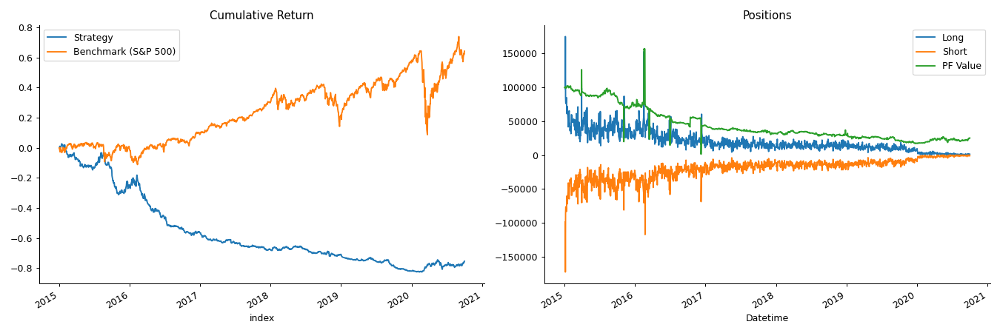

In [417]:
# Plotting returns vs S&P500
fig, axes = plt.subplots(ncols=2, figsize=(15, 5))

df = returns.to_frame('Strategy').join(benchmark.to_frame('Benchmark (S&P 500)'))
df.add(1).cumprod().sub(1).plot(ax=axes[0], title='Cumulative Return')

longs.plot(label='Long',ax=axes[1], title='Positions')
shorts.plot(ax=axes[1], label='Short')
positions.cash.plot(ax=axes[1], label='PF Value')
axes[1].legend()
sns.despine()
fig.tight_layout();

Start date,2015-01-02
End date,2020-10-01
Total months,68
,Backtest
Annual return,-21.665%
Cumulative returns,-75.415%
Annual volatility,19.531%
Sharpe ratio,-1.15
Calmar ratio,-0.26
Stability,0.93
Max drawdown,-83.026%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,83.03,2015-01-15,2020-02-12,NaT,NaN
1,2.13,2015-01-05,2015-01-08,2015-01-12,6
2,NaN,NaT,NaT,NaT,NaN
3,NaN,NaT,NaT,NaT,NaN
4,NaN,NaT,NaT,NaT,NaN


<IPython.core.display.Javascript object>


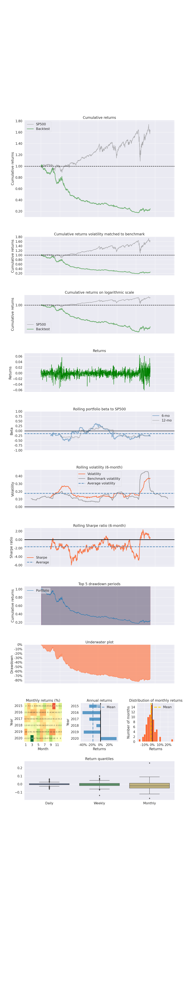

Stress Events,mean,min,max
Fall2015,-0.33%,-4.44%,1.23%
New Normal,-0.09%,-6.10%,6.49%


<IPython.core.display.Javascript object>


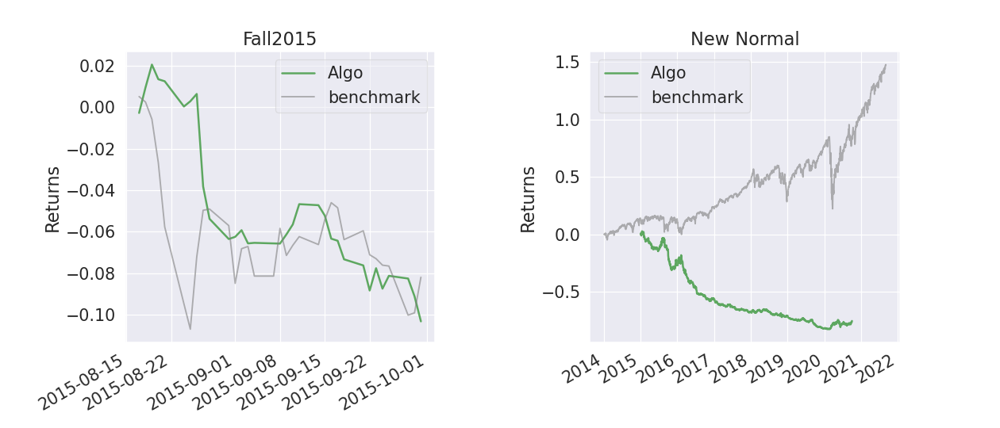

<IPython.core.display.Javascript object>


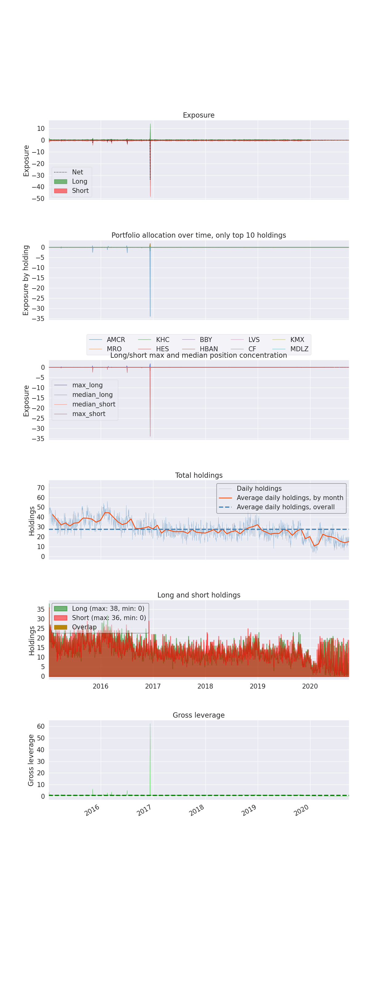

Top 10 long positions of all time,max
sid,
KHC,180.18%
HES,177.69%
BBY,176.50%
HBAN,176.13%
KMX,174.87%
ATVI,173.12%
NEM,171.09%
EFX,167.86%
AMCR,97.91%


Top 10 short positions of all time,max
sid,
AMCR,-3397.96%
MRO,-180.77%
LVS,-175.69%
CF,-175.49%
MDLZ,-174.76%
KEY,-174.23%
NUE,-174.10%
SBAC,-170.12%
TDG,-162.57%


Top 10 positions of all time,max
sid,
AMCR,3397.96%
MRO,180.77%
KHC,180.18%
HES,177.69%
BBY,176.50%
HBAN,176.13%
LVS,175.69%
CF,175.49%
KMX,174.87%


<IPython.core.display.Javascript object>


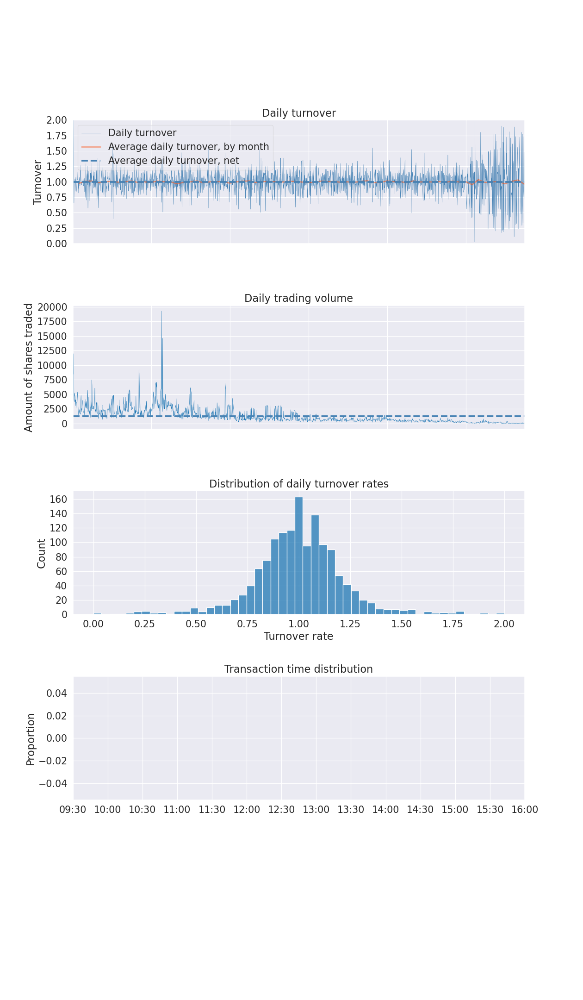

In [418]:
# Complete PyFolio evaluation
pf.create_full_tear_sheet(returns,
                          transactions=transactions,
                          positions=positions,
                          benchmark_rets=benchmark.dropna());

### Backtesting: XGBoost

In [425]:
# Initiating Cerebro
cerebro = bt.Cerebro()
cash = 100000
cerebro.broker.setcash(cash)

In [426]:
# Defining input
class SignalData(PandasData):
    
    cols = OHLCV + ['target1day','target5day','target10day','target21day','target42day','target63day']

    lines = tuple(cols)

    params = {c: -1 for c in cols}
    params.update({'datetime': None})
    params = tuple(params.items())

In [427]:
# Feeding data
data = pd.read_csv('./predictions/xgb_preds.csv')
data.date = pd.to_datetime(data.date)
data.set_index(['ticker','date'], inplace=True)
tickers = data.index.get_level_values(0).unique()

for ticker in tickers:
    df = data.loc[idx[ticker,'2015-01-02':], :].droplevel('ticker', axis=0)
    df.index.name = 'datetime'
    bt_data = SignalData(dataname=df)
    cerebro.adddata(bt_data, name=ticker)

In [428]:
# Defining Strategy
class XGBoostStrategy(bt.Strategy):
    params = (('n_positions', 20),
              ('min_positions', 5),
              ('verbose', False))

    def log(self, txt, dt=None):
        print('%s | %s' % (self.datas[0].datetime.date(0).isoformat(), txt))
        
    def notify_trade(self, trade):
        if not trade.isclosed:
            return

        self.log(f'{trade.data._name}: OPERATION PROFIT {trade.pnl}')

    def notify_order(self, order):
        
        if order.status in [order.Submitted, order.Accepted]:
            return
        
        if self.p.verbose:
            if order.status in [order.Completed]:
                p = order.executed.price
                if order.isbuy():
                    self.log(f'{order.data._name}: BUY executed {p:.2f}')
                elif order.issell():
                    self.log(f'{order.data._name}: SELL executed {p:.2f}')

            elif order.status in [order.Canceled, order.Margin, order.Rejected]:
                self.log(f'{order.data._name}: Order Canceled/Margin/Rejected')

    def prenext(self):
        self.next()

    def next(self):
        today = self.datas[0].datetime.date()

        positions = [d._name for d, pos in self.getpositions().items() if pos]
        up, down = {}, {}
        missing = not_missing = 0
        for data in self.datas:
            if data.datetime.date() == today:
                if data.target1day[0] > 0:
                    if(data.target1day[0]+data.target5day[0]+data.target10day[0]+data.target21day[0]+data.target42day[0]+data.target63day[0] > 3):
                        up[data._name] = data.target1day[0]
                elif data.target1day[0] == 0:
                    if(data.target1day[0]+data.target5day[0]+data.target10day[0]+data.target21day[0]+data.target42day[0]+data.target63day[0] < 3):
                        down[data._name] = data.target1day[0]

        shorts = sorted(down, key=down.get)[:self.p.n_positions]
        longs = sorted(up, key=up.get, reverse=True)[:self.p.n_positions]
        n_shorts, n_longs = len(shorts), len(longs)
        
        if n_shorts < self.p.min_positions or n_longs < self.p.min_positions:
            longs, shorts = [], []
        for ticker in positions:
            if ticker not in longs + shorts:
                self.order_target_percent(data=ticker, target=0)
                self.log(f'{ticker}: TRADE CLOSING ORDER CREATED')

        short_target = -1 / max(self.p.n_positions, n_shorts)
        long_target = 1 / max(self.p.n_positions, n_longs)
        for ticker in shorts:
            self.order_target_percent(data=ticker, target=short_target)
            self.log(f'{ticker}: SHORT ORDER CREATED')
        for ticker in longs:
            self.order_target_percent(data=ticker, target=long_target)
            self.log(f'{ticker}: LONG ORDER CREATED')

In [429]:
# Backtesting
cerebro.addanalyzer(bt.analyzers.PyFolio, _name='pyfolio')
cerebro.addstrategy(XGBoostStrategy)
cerebro.addsizer(bt.sizers.FixedSize, stake=1000)
cerebro.broker.setcommission(0.001)
results = cerebro.run()
ending_value = cerebro.broker.getvalue()

print(f'Final Portfolio Value: {ending_value:,.2f}')

2015-01-02 | AAL: SHORT ORDER CREATED
2015-01-02 | ALK: SHORT ORDER CREATED
2015-01-02 | MGM: SHORT ORDER CREATED
2015-01-02 | ROST: SHORT ORDER CREATED
2015-01-02 | SIVB: SHORT ORDER CREATED
2015-01-02 | UAL: SHORT ORDER CREATED
2015-01-02 | VRTX: SHORT ORDER CREATED
2015-01-02 | A: LONG ORDER CREATED
2015-01-02 | AAPL: LONG ORDER CREATED
2015-01-02 | ABT: LONG ORDER CREATED
2015-01-02 | ACN: LONG ORDER CREATED
2015-01-02 | ADBE: LONG ORDER CREATED
2015-01-02 | ADM: LONG ORDER CREATED
2015-01-02 | ADP: LONG ORDER CREATED
2015-01-02 | ADSK: LONG ORDER CREATED
2015-01-02 | AIZ: LONG ORDER CREATED
2015-01-02 | AJG: LONG ORDER CREATED
2015-01-02 | AKAM: LONG ORDER CREATED
2015-01-02 | ALGN: LONG ORDER CREATED
2015-01-02 | AMAT: LONG ORDER CREATED
2015-01-02 | AMD: LONG ORDER CREATED
2015-01-02 | AMT: LONG ORDER CREATED
2015-01-02 | AMZN: LONG ORDER CREATED
2015-01-02 | ANSS: LONG ORDER CREATED
2015-01-02 | ANTM: LONG ORDER CREATED
2015-01-02 | AON: LONG ORDER CREATED
2015-01-02 | AOS: LON

2015-01-13 | A: OPERATION PROFIT -16.89260505493894
2015-01-13 | AAPL: OPERATION PROFIT -51.450661400502135
2015-01-13 | ABT: OPERATION PROFIT 21.765375679098668
2015-01-13 | ADP: OPERATION PROFIT -14.482805538788085
2015-01-13 | AIZ: OPERATION PROFIT -28.265729507101852
2015-01-13 | AJG: OPERATION PROFIT 36.437421887201026
2015-01-13 | AEP: OPERATION PROFIT 12.666327533710842
2015-01-13 | AFL: OPERATION PROFIT -113.50846020840943
2015-01-13 | ALB: OPERATION PROFIT 120.65161807293731
2015-01-13 | ARE: OPERATION PROFIT 1.0420799972011991
2015-01-13 | BXP: OPERATION PROFIT -25.091158416989444
2015-01-13 | EIX: OPERATION PROFIT -24.598040739459208
2015-01-13 | FANG: OPERATION PROFIT 49.72289618828876
2015-01-13 | GILD: OPERATION PROFIT 81.16122762113037
2015-01-13 | VTR: OPERATION PROFIT -35.325284229947115
2015-01-13 | AAL: TRADE CLOSING ORDER CREATED
2015-01-13 | ALK: TRADE CLOSING ORDER CREATED
2015-01-13 | ROST: TRADE CLOSING ORDER CREATED
2015-01-13 | ADBE: TRADE CLOSING ORDER CREATE

2015-01-21 | ALK: OPERATION PROFIT -74.97171702843289
2015-01-21 | AIZ: OPERATION PROFIT -86.72236593611251
2015-01-21 | AEE: OPERATION PROFIT 63.80808425728051
2015-01-21 | AES: OPERATION PROFIT -60.12660201707624
2015-01-21 | AFL: OPERATION PROFIT 37.918440371987444
2015-01-21 | ARE: OPERATION PROFIT 56.03807789502844
2015-01-21 | ATO: OPERATION PROFIT 28.066335246709258
2015-01-21 | AVB: OPERATION PROFIT 34.71071655553757
2015-01-21 | BSX: OPERATION PROFIT 71.71977615356445
2015-01-21 | BXP: OPERATION PROFIT -10.780355637612502
2015-01-21 | CBOE: OPERATION PROFIT 71.05313641259711
2015-01-21 | CMS: OPERATION PROFIT -68.46194248411356
2015-01-21 | DRE: OPERATION PROFIT -26.367925696319272
2015-01-21 | DTE: OPERATION PROFIT 25.44659279724607
2015-01-21 | EIX: OPERATION PROFIT 6.996720725993782
2015-01-21 | EQR: OPERATION PROFIT 51.30755959735302
2015-01-21 | ES: OPERATION PROFIT 20.238786648363316
2015-01-21 | ESS: OPERATION PROFIT -4.334697058619952
2015-01-21 | EXR: OPERATION PROFIT

2015-01-26 | ES: TRADE CLOSING ORDER CREATED
2015-01-26 | EXC: TRADE CLOSING ORDER CREATED
2015-01-26 | EXR: TRADE CLOSING ORDER CREATED
2015-01-26 | FE: TRADE CLOSING ORDER CREATED
2015-01-26 | AAL: SHORT ORDER CREATED
2015-01-26 | AEP: SHORT ORDER CREATED
2015-01-26 | ALK: SHORT ORDER CREATED
2015-01-26 | APA: SHORT ORDER CREATED
2015-01-26 | ATVI: SHORT ORDER CREATED
2015-01-26 | BXP: SHORT ORDER CREATED
2015-01-26 | CMS: SHORT ORDER CREATED
2015-01-26 | COG: SHORT ORDER CREATED
2015-01-26 | CPRT: SHORT ORDER CREATED
2015-01-26 | DAL: SHORT ORDER CREATED
2015-01-26 | DRI: SHORT ORDER CREATED
2015-01-26 | EOG: SHORT ORDER CREATED
2015-01-26 | EVRG: SHORT ORDER CREATED
2015-01-26 | FANG: SHORT ORDER CREATED
2015-01-26 | GNRC: SHORT ORDER CREATED
2015-01-26 | GOOG: SHORT ORDER CREATED
2015-01-26 | GPN: SHORT ORDER CREATED
2015-01-26 | HD: SHORT ORDER CREATED
2015-01-26 | KIM: SHORT ORDER CREATED
2015-01-26 | LVS: SHORT ORDER CREATED
2015-01-26 | ADI: LONG ORDER CREATED
2015-01-26 | AES

2015-01-30 | AAL: OPERATION PROFIT 89.14959935852566
2015-01-30 | MGM: OPERATION PROFIT 71.18769204342391
2015-01-30 | ABT: OPERATION PROFIT 157.2850347804393
2015-01-30 | ADBE: OPERATION PROFIT 85.14006042480469
2015-01-30 | AKAM: OPERATION PROFIT -112.79996109008802
2015-01-30 | ABBV: OPERATION PROFIT -2.2652484450489396
2015-01-30 | AEE: OPERATION PROFIT 11.057868276888705
2015-01-30 | AEP: OPERATION PROFIT 16.934552982116372
2015-01-30 | DHI: OPERATION PROFIT -124.92114497390175
2015-01-30 | DLR: OPERATION PROFIT 20.69488214213436
2015-01-30 | EXR: OPERATION PROFIT -2.080031134956272
2015-01-30 | GLW: OPERATION PROFIT 136.7005588309466
2015-01-30 | ILMN: OPERATION PROFIT -14.2598876953125
2015-01-30 | LEN: OPERATION PROFIT -97.33679184681876
2015-01-30 | LVS: OPERATION PROFIT 170.71878825235328
2015-01-30 | MPC: OPERATION PROFIT -1.0481726333775114
2015-01-30 | NEM: OPERATION PROFIT -111.61179859068305
2015-01-30 | NFLX: OPERATION PROFIT 5.285552978515625
2015-01-30 | O: OPERATION 

2015-02-06 | AAL: OPERATION PROFIT 32.28852413415535
2015-02-06 | A: OPERATION PROFIT 37.1017593524171
2015-02-06 | ABT: OPERATION PROFIT 4.27898342297263
2015-02-06 | ACN: OPERATION PROFIT -29.927267020414746
2015-02-06 | ADBE: OPERATION PROFIT 87.56996154785156
2015-02-06 | ADM: OPERATION PROFIT 38.73266917718581
2015-02-06 | ADP: OPERATION PROFIT -0.0875836395773888
2015-02-06 | ADSK: OPERATION PROFIT 115.29026412963985
2015-02-06 | AIZ: OPERATION PROFIT 70.58087543650345
2015-02-06 | AJG: OPERATION PROFIT 55.698001896808975
2015-02-06 | AKAM: OPERATION PROFIT 22.040069580078125
2015-02-06 | AAP: OPERATION PROFIT 103.20963448905144
2015-02-06 | ABBV: OPERATION PROFIT -90.82818164033165
2015-02-06 | ABC: OPERATION PROFIT 63.04330086734804
2015-02-06 | ADI: OPERATION PROFIT 103.72274575316435
2015-02-06 | AEE: OPERATION PROFIT -30.96120281610748
2015-02-06 | AEP: OPERATION PROFIT -30.665423055652894
2015-02-06 | AES: OPERATION PROFIT 69.67183278965987
2015-02-06 | AFL: OPERATION PROFI

2015-02-17 | ADBE: OPERATION PROFIT 191.71998596191406
2015-02-17 | ADP: OPERATION PROFIT 29.539266545680775
2015-02-17 | ADSK: OPERATION PROFIT 147.42024993896595
2015-02-17 | AKAM: OPERATION PROFIT -85.75991821289062
2015-02-17 | AFL: OPERATION PROFIT 32.87418182684409
2015-02-17 | AIG: OPERATION PROFIT 155.7884289145763
2015-02-17 | ALB: OPERATION PROFIT 25.364530956042046
2015-02-17 | COP: OPERATION PROFIT -21.449039650003222
2015-02-17 | CRM: OPERATION PROFIT -99.75013732910156
2015-02-17 | MSI: OPERATION PROFIT 20.91127221885533
2015-02-17 | NOW: OPERATION PROFIT -52.200164794921875
2015-02-17 | NVDA: OPERATION PROFIT -4.116806523605121
2015-02-17 | AAPL: OPERATION PROFIT -7.599027121270428
2015-02-17 | AJG: TRADE CLOSING ORDER CREATED
2015-02-17 | ABBV: TRADE CLOSING ORDER CREATED
2015-02-17 | ABC: TRADE CLOSING ORDER CREATED
2015-02-17 | ADI: TRADE CLOSING ORDER CREATED
2015-02-17 | CHTR: TRADE CLOSING ORDER CREATED
2015-02-17 | ENPH: TRADE CLOSING ORDER CREATED
2015-02-17 | WU

2015-02-24 | APA: SHORT ORDER CREATED
2015-02-24 | DVN: SHORT ORDER CREATED
2015-02-24 | FANG: SHORT ORDER CREATED
2015-02-24 | MPC: SHORT ORDER CREATED
2015-02-24 | PSX: SHORT ORDER CREATED
2015-02-24 | PXD: SHORT ORDER CREATED
2015-02-24 | VLO: SHORT ORDER CREATED
2015-02-24 | A: LONG ORDER CREATED
2015-02-24 | AAL: LONG ORDER CREATED
2015-02-24 | AAP: LONG ORDER CREATED
2015-02-24 | AAPL: LONG ORDER CREATED
2015-02-24 | ABC: LONG ORDER CREATED
2015-02-24 | ABT: LONG ORDER CREATED
2015-02-24 | ACN: LONG ORDER CREATED
2015-02-24 | ADBE: LONG ORDER CREATED
2015-02-24 | ADI: LONG ORDER CREATED
2015-02-24 | ADM: LONG ORDER CREATED
2015-02-24 | ADP: LONG ORDER CREATED
2015-02-24 | ADSK: LONG ORDER CREATED
2015-02-24 | AEE: LONG ORDER CREATED
2015-02-24 | AEP: LONG ORDER CREATED
2015-02-24 | AFL: LONG ORDER CREATED
2015-02-24 | AIG: LONG ORDER CREATED
2015-02-24 | AIZ: LONG ORDER CREATED
2015-02-24 | AJG: LONG ORDER CREATED
2015-02-24 | AKAM: LONG ORDER CREATED
2015-02-24 | ALB: LONG ORDER

2015-03-04 | ADP: OPERATION PROFIT 66.32445105451804
2015-03-04 | AMAT: OPERATION PROFIT 183.64980606437842
2015-03-04 | AOS: OPERATION PROFIT 70.61396388103809
2015-03-04 | ABMD: OPERATION PROFIT 185.0
2015-03-04 | ADI: OPERATION PROFIT 93.29056401281554
2015-03-04 | APA: OPERATION PROFIT -30.803983710079592
2015-03-04 | APTV: OPERATION PROFIT -88.25414179697759
2015-03-04 | BKR: OPERATION PROFIT -5.885160362672337
2015-03-04 | CBOE: OPERATION PROFIT -3.862812675222038
2015-03-04 | CCL: OPERATION PROFIT 70.46582190150801
2015-03-04 | CHD: OPERATION PROFIT -2.688861302901728
2015-03-04 | CL: OPERATION PROFIT -33.549832802118296
2015-03-04 | CLX: OPERATION PROFIT 24.54357889798689
2015-03-04 | CME: OPERATION PROFIT -8.020052695280242
2015-03-04 | CMS: OPERATION PROFIT -24.11056102609185
2015-03-04 | COG: OPERATION PROFIT -44.16402298243537
2015-03-04 | COP: OPERATION PROFIT 30.59890936441529
2015-03-04 | CSCO: OPERATION PROFIT 114.70699189987114
2015-03-04 | D: OPERATION PROFIT 9.091300

2015-03-09 | AMZN: OPERATION PROFIT 78.3199462890625
2015-03-09 | AOS: OPERATION PROFIT -13.897219941123911
2015-03-09 | AIG: OPERATION PROFIT 24.982524623635058
2015-03-09 | ALB: OPERATION PROFIT -34.2965937692916
2015-03-09 | AMP: OPERATION PROFIT -38.643702708659475
2015-03-09 | APA: OPERATION PROFIT -119.08055501200934
2015-03-09 | APTV: OPERATION PROFIT -66.96664431563065
2015-03-09 | ARE: OPERATION PROFIT 62.14186568827448
2015-03-09 | ATVI: OPERATION PROFIT 11.94163499760672
2015-03-09 | AVB: OPERATION PROFIT -59.00947752706844
2015-03-09 | AVY: OPERATION PROFIT -39.35326363650752
2015-03-09 | AXP: OPERATION PROFIT 27.311175031011004
2015-03-09 | AZO: OPERATION PROFIT 20.50994873046875
2015-03-09 | BAC: OPERATION PROFIT 89.94080887876613
2015-03-09 | BBY: OPERATION PROFIT -3.5103513796187684
2015-03-09 | BK: OPERATION PROFIT 89.41575487778584
2015-03-09 | BKNG: OPERATION PROFIT -19.56005859375
2015-03-09 | BMY: OPERATION PROFIT 51.825252139823874
2015-03-09 | CCL: OPERATION PROF

2015-03-12 | AAL: OPERATION PROFIT -30.714498276931124
2015-03-12 | ALK: OPERATION PROFIT 97.09540805654439
2015-03-12 | VRTX: OPERATION PROFIT 48.46990966796875
2015-03-12 | AAPL: OPERATION PROFIT -90.5085979330612
2015-03-12 | ABT: OPERATION PROFIT 7.9752556951752425
2015-03-12 | ACN: OPERATION PROFIT -66.13439212221358
2015-03-12 | ADBE: OPERATION PROFIT 14.029739379882812
2015-03-12 | ADM: OPERATION PROFIT -40.9187224763412
2015-03-12 | ADP: OPERATION PROFIT 23.013190706101042
2015-03-12 | ADSK: OPERATION PROFIT 10.779953002929688
2015-03-12 | AIZ: OPERATION PROFIT -3.779618814714418
2015-03-12 | AMAT: OPERATION PROFIT -116.75942991115161
2015-03-12 | AMD: OPERATION PROFIT -333.4400608539575
2015-03-12 | AAP: OPERATION PROFIT -149.65015189853966
2015-03-12 | ABBV: OPERATION PROFIT -196.98532641769276
2015-03-12 | ADI: OPERATION PROFIT -49.14506714758247
2015-03-12 | AEE: OPERATION PROFIT 16.327214604196826
2015-03-12 | AEP: OPERATION PROFIT -5.031005438696319
2015-03-12 | AES: OPER

2015-03-17 | VRTX: OPERATION PROFIT -85.10011291503906
2015-03-17 | A: OPERATION PROFIT 40.72026184890319
2015-03-17 | AAPL: OPERATION PROFIT 56.2189581431424
2015-03-17 | ABT: OPERATION PROFIT 30.359515378052514
2015-03-17 | ADM: OPERATION PROFIT -5.968865345766353
2015-03-17 | ADP: OPERATION PROFIT 21.028918011410923
2015-03-17 | AIZ: OPERATION PROFIT 6.802883890432568
2015-03-17 | AJG: OPERATION PROFIT 63.304517357405565
2015-03-17 | AMAT: OPERATION PROFIT 81.24119516157305
2015-03-17 | ABBV: OPERATION PROFIT 20.621863111256147
2015-03-17 | ADI: OPERATION PROFIT -48.617348388858886
2015-03-17 | AEE: OPERATION PROFIT 56.104628816053435
2015-03-17 | AES: OPERATION PROFIT 0.001479895503369022
2015-03-17 | AFL: OPERATION PROFIT 7.444599711722688
2015-03-17 | AIG: OPERATION PROFIT -4.265435426269761
2015-03-17 | ALL: OPERATION PROFIT 5.295906446940357
2015-03-17 | COO: OPERATION PROFIT -33.30487840354863
2015-03-17 | NCLH: OPERATION PROFIT -41.85991668701172
2015-03-17 | NXPI: OPERATION 

2015-03-20 | ADBE: OPERATION PROFIT 126.06988525390602
2015-03-20 | ADP: OPERATION PROFIT 61.05392067891188
2015-03-20 | ALGN: OPERATION PROFIT 195.39998626708984
2015-03-20 | ANSS: OPERATION PROFIT 29.069984436035156
2015-03-20 | AON: OPERATION PROFIT -1.8246739365156373
2015-03-20 | AAP: OPERATION PROFIT -15.161297663042973
2015-03-20 | ABC: OPERATION PROFIT -44.40188166002194
2015-03-20 | ABMD: OPERATION PROFIT 88.5000228881836
2015-03-20 | ALL: OPERATION PROFIT 41.14704722703836
2015-03-20 | APH: OPERATION PROFIT -156.54041086868347
2015-03-20 | APTV: OPERATION PROFIT 34.730700756001795
2015-03-20 | BA: OPERATION PROFIT -3.7746595364659186
2015-03-20 | CNC: OPERATION PROFIT -90.38982009887695
2015-03-20 | CTAS: OPERATION PROFIT 189.93355374461487
2015-03-20 | DGX: OPERATION PROFIT -29.57831055918399
2015-03-20 | EXPD: OPERATION PROFIT -4.621937757172958
2015-03-20 | EXPE: OPERATION PROFIT -55.6997307263984
2015-03-20 | FB: OPERATION PROFIT -127.11981201171875
2015-03-20 | J: OPERAT

2015-03-24 | AAPL: OPERATION PROFIT -36.185213797876465
2015-03-24 | ABT: OPERATION PROFIT 42.9749106162234
2015-03-24 | ADBE: OPERATION PROFIT -58.0
2015-03-24 | ADM: OPERATION PROFIT 96.4217627343272
2015-03-24 | ADP: OPERATION PROFIT -44.64131940783484
2015-03-24 | ADSK: OPERATION PROFIT -56.98003387451172
2015-03-24 | AIZ: OPERATION PROFIT 23.736857388884715
2015-03-24 | AJG: OPERATION PROFIT -11.354298961294944
2015-03-24 | ALGN: OPERATION PROFIT -51.350120544434155
2015-03-24 | AMAT: OPERATION PROFIT -26.225784618135755
2015-03-24 | AMD: OPERATION PROFIT 164.309843301773
2015-03-24 | AMT: OPERATION PROFIT 107.84802478688958
2015-03-24 | AMZN: OPERATION PROFIT -27.6002197265625
2015-03-24 | ANSS: OPERATION PROFIT 10.199844360351562
2015-03-24 | AON: OPERATION PROFIT -46.029022299546114
2015-03-24 | AAP: OPERATION PROFIT -63.38237163833924
2015-03-24 | ABC: OPERATION PROFIT 3.946642246834415
2015-03-24 | ADI: OPERATION PROFIT 30.190569796264022
2015-03-24 | AEE: OPERATION PROFIT 39

2015-03-26 | ADM: OPERATION PROFIT -57.228527058446176
2015-03-26 | AMAT: OPERATION PROFIT -309.78702758520336
2015-03-26 | AMD: OPERATION PROFIT -310.2700934410095
2015-03-26 | ANSS: OPERATION PROFIT -99.45023345947266
2015-03-26 | AOS: OPERATION PROFIT -49.61192025675014
2015-03-26 | ABMD: OPERATION PROFIT 69.44017028808594
2015-03-26 | AES: OPERATION PROFIT 82.57540551975987
2015-03-26 | ALLE: OPERATION PROFIT 40.243884504709406
2015-03-26 | APD: OPERATION PROFIT -70.06695597655211
2015-03-26 | APH: OPERATION PROFIT -122.7949907354369
2015-03-26 | APTV: OPERATION PROFIT -156.80244059065126
2015-03-26 | AVGO: OPERATION PROFIT 499.08802014055175
2015-03-26 | BA: OPERATION PROFIT -106.81739666503262
2015-03-26 | BDX: OPERATION PROFIT -70.23899653610312
2015-03-26 | BF-B: OPERATION PROFIT -52.64704555294005
2015-03-26 | BMY: OPERATION PROFIT -78.88879281506664
2015-03-26 | BR: OPERATION PROFIT -94.25392365612308
2015-03-26 | BWA: OPERATION PROFIT 88.95481553639445
2015-03-26 | BXP: OPER

2015-03-31 | AAL: OPERATION PROFIT 247.5719711374797
2015-03-31 | ABT: OPERATION PROFIT -16.648626787773097
2015-03-31 | ACN: OPERATION PROFIT -4.32291728516023
2015-03-31 | ADM: OPERATION PROFIT 29.59236934638568
2015-03-31 | AJG: OPERATION PROFIT 0.9805348389780164
2015-03-31 | AEE: OPERATION PROFIT 68.06921725879691
2015-03-31 | AEP: OPERATION PROFIT 55.74085327118603
2015-03-31 | AFL: OPERATION PROFIT -6.4690588988721345
2015-03-31 | AIG: OPERATION PROFIT 2.5383801862269806
2015-03-31 | ALB: OPERATION PROFIT 28.360677946387383
2015-03-31 | ALL: OPERATION PROFIT 7.837157434694504
2015-03-31 | EOG: OPERATION PROFIT -24.93820368194497
2015-03-31 | HLT: OPERATION PROFIT 49.04287192892234
2015-03-31 | NCLH: OPERATION PROFIT 152.15007781982422
2015-03-31 | NXPI: OPERATION PROFIT -29.907021967530653
2015-03-31 | PXD: OPERATION PROFIT 22.477247521365115
2015-03-31 | SWKS: OPERATION PROFIT 23.70240270599311
2015-03-31 | ADI: OPERATION PROFIT 571.8564077852013
2015-03-31 | ADBE: TRADE CLOSIN

2015-04-09 | AMP: LONG ORDER CREATED
2015-04-09 | AMT: LONG ORDER CREATED
2015-04-09 | AMZN: LONG ORDER CREATED
2015-04-09 | ANSS: LONG ORDER CREATED
2015-04-09 | ANTM: LONG ORDER CREATED
2015-04-10 | ALK: TRADE CLOSING ORDER CREATED
2015-04-10 | AMAT: TRADE CLOSING ORDER CREATED
2015-04-10 | AMT: TRADE CLOSING ORDER CREATED
2015-04-10 | AMZN: TRADE CLOSING ORDER CREATED
2015-04-10 | ANSS: TRADE CLOSING ORDER CREATED
2015-04-10 | ANTM: TRADE CLOSING ORDER CREATED
2015-04-10 | ALL: TRADE CLOSING ORDER CREATED
2015-04-10 | ALLE: TRADE CLOSING ORDER CREATED
2015-04-10 | AMGN: TRADE CLOSING ORDER CREATED
2015-04-10 | AMP: TRADE CLOSING ORDER CREATED
2015-04-10 | APTV: TRADE CLOSING ORDER CREATED
2015-04-10 | BWA: TRADE CLOSING ORDER CREATED
2015-04-10 | COG: TRADE CLOSING ORDER CREATED
2015-04-10 | FTNT: TRADE CLOSING ORDER CREATED
2015-04-10 | NCLH: TRADE CLOSING ORDER CREATED
2015-04-10 | PRGO: TRADE CLOSING ORDER CREATED
2015-04-10 | PXD: TRADE CLOSING ORDER CREATED
2015-04-10 | TSCO: T

2015-04-20 | AMAT: OPERATION PROFIT 2.063933670611192
2015-04-20 | AMT: OPERATION PROFIT -4.596739886308342
2015-04-20 | AMZN: OPERATION PROFIT -44.880187988280625
2015-04-20 | ANSS: OPERATION PROFIT -18.359642028808594
2015-04-20 | AON: OPERATION PROFIT -17.3342828141395
2015-04-20 | AOS: OPERATION PROFIT -24.86012070432446
2015-04-20 | ALL: OPERATION PROFIT -10.02756421100952
2015-04-20 | ALLE: OPERATION PROFIT -38.753467822039894
2015-04-20 | BKR: OPERATION PROFIT 76.40247736405325
2015-04-20 | FMC: OPERATION PROFIT 31.874184146595326
2015-04-20 | J: OPERATION PROFIT 31.949665037282898
2015-04-20 | LYB: OPERATION PROFIT -47.69020909795909
2015-04-20 | OKE: OPERATION PROFIT 111.99991402020848
2015-04-20 | OXY: OPERATION PROFIT 30.4379412222504
2015-04-20 | SLB: OPERATION PROFIT -64.62217069001696
2015-04-20 | AAL: TRADE CLOSING ORDER CREATED
2015-04-20 | A: TRADE CLOSING ORDER CREATED
2015-04-20 | AAPL: TRADE CLOSING ORDER CREATED
2015-04-20 | ABT: TRADE CLOSING ORDER CREATED
2015-04

2015-05-05 | MGM: OPERATION PROFIT -64.07207103965821
2015-05-05 | AMD: OPERATION PROFIT 59.48994326591492
2015-05-05 | AMT: OPERATION PROFIT 58.344769516363826
2015-05-05 | ANSS: OPERATION PROFIT 13.0
2015-05-05 | ABC: OPERATION PROFIT 19.733584050885156
2015-05-05 | APD: OPERATION PROFIT 8.076355493983414
2015-05-05 | ATVI: OPERATION PROFIT 9.908825793496533
2015-05-05 | AVGO: OPERATION PROFIT -101.8563558470673
2015-05-05 | AWK: OPERATION PROFIT 2.5154050960647467
2015-05-05 | BDX: OPERATION PROFIT 36.47219210706453
2015-05-05 | BIO: OPERATION PROFIT 45.53965759277344
2015-05-05 | BKNG: OPERATION PROFIT -5.6700439453125
2015-05-05 | BLK: OPERATION PROFIT -15.646471057808867
2015-05-05 | CAT: OPERATION PROFIT 8.372764459274421
2015-05-05 | CNP: OPERATION PROFIT -2.1733413277102045
2015-05-05 | CSX: OPERATION PROFIT 124.51877643385792
2015-05-05 | EA: OPERATION PROFIT 8.43813635171189
2015-05-05 | EQIX: OPERATION PROFIT 34.873376673468215
2015-05-05 | EVRG: OPERATION PROFIT -6.0632019

2015-05-08 | TSLA: TRADE CLOSING ORDER CREATED
2015-05-08 | WHR: TRADE CLOSING ORDER CREATED
2015-05-08 | AES: SHORT ORDER CREATED
2015-05-08 | APA: SHORT ORDER CREATED
2015-05-08 | CF: SHORT ORDER CREATED
2015-05-08 | COG: SHORT ORDER CREATED
2015-05-08 | COP: SHORT ORDER CREATED
2015-05-08 | DISCA: SHORT ORDER CREATED
2015-05-08 | DVN: SHORT ORDER CREATED
2015-05-08 | EL: SHORT ORDER CREATED
2015-05-08 | EQIX: SHORT ORDER CREATED
2015-05-08 | ETN: SHORT ORDER CREATED
2015-05-08 | EXPE: SHORT ORDER CREATED
2015-05-08 | FCX: SHORT ORDER CREATED
2015-05-08 | HAL: SHORT ORDER CREATED
2015-05-08 | HES: SHORT ORDER CREATED
2015-05-08 | LYB: SHORT ORDER CREATED
2015-05-08 | MLM: SHORT ORDER CREATED
2015-05-08 | MRO: SHORT ORDER CREATED
2015-05-08 | NFLX: SHORT ORDER CREATED
2015-05-08 | OXY: SHORT ORDER CREATED
2015-05-08 | SLB: SHORT ORDER CREATED
2015-05-08 | AAL: LONG ORDER CREATED
2015-05-08 | ADSK: LONG ORDER CREATED
2015-05-08 | ALGN: LONG ORDER CREATED
2015-05-08 | AMAT: LONG ORDER C

2015-05-13 | AKAM: OPERATION PROFIT 48.51026916503906
2015-05-13 | AES: OPERATION PROFIT -66.75897138949878
2015-05-13 | AME: OPERATION PROFIT 81.9236289763925
2015-05-13 | APH: OPERATION PROFIT 15.08502162929313
2015-05-13 | ARE: OPERATION PROFIT 80.2178160220962
2015-05-13 | ATO: OPERATION PROFIT -25.02524961569941
2015-05-13 | AVB: OPERATION PROFIT 62.17572432422358
2015-05-13 | CE: OPERATION PROFIT 42.50942671100066
2015-05-13 | CVX: OPERATION PROFIT -23.8497661809307
2015-05-13 | FCX: OPERATION PROFIT 119.87662105999448
2015-05-13 | HES: OPERATION PROFIT 150.8619506001116
2015-05-13 | LYB: OPERATION PROFIT 22.143951452908198
2015-05-13 | MPC: OPERATION PROFIT 8.420705201086065
2015-05-13 | NOV: OPERATION PROFIT -46.77058195167941
2015-05-13 | PSX: OPERATION PROFIT -39.71589193397573
2015-05-13 | ALK: TRADE CLOSING ORDER CREATED
2015-05-13 | ALGN: TRADE CLOSING ORDER CREATED
2015-05-13 | AMT: TRADE CLOSING ORDER CREATED
2015-05-13 | ALL: TRADE CLOSING ORDER CREATED
2015-05-13 | AMG

2015-05-18 | A: OPERATION PROFIT -15.072420442259144
2015-05-18 | AAPL: OPERATION PROFIT 84.97308336817032
2015-05-18 | ADBE: OPERATION PROFIT 150.66001892089844
2015-05-18 | ADM: OPERATION PROFIT -0.9205927102033229
2015-05-18 | AJG: OPERATION PROFIT 51.32327973411485
2015-05-18 | AMAT: OPERATION PROFIT -76.11363414142329
2015-05-18 | AMD: OPERATION PROFIT 41.9799599647522
2015-05-18 | ANSS: OPERATION PROFIT 48.60008239746094
2015-05-18 | AAP: OPERATION PROFIT 45.83506260550453
2015-05-18 | AFL: OPERATION PROFIT -15.153911436657488
2015-05-18 | ALB: OPERATION PROFIT 69.94966730475224
2015-05-18 | ALL: OPERATION PROFIT 1.4317589322737518
2015-05-18 | AVY: OPERATION PROFIT -0.804100596519703
2015-05-18 | CE: OPERATION PROFIT 17.15100695153258
2015-05-18 | EA: OPERATION PROFIT 19.944925100756777
2015-05-18 | EL: OPERATION PROFIT 52.518959477895606
2015-05-18 | ETN: OPERATION PROFIT 20.514098723996405
2015-05-18 | FAST: OPERATION PROFIT 78.96594124674246
2015-05-18 | FISV: OPERATION PROFI

2015-05-20 | AAL: OPERATION PROFIT -98.08706281732023
2015-05-20 | ALK: OPERATION PROFIT 42.41915763750626
2015-05-20 | A: OPERATION PROFIT 106.33447152692229
2015-05-20 | AAPL: OPERATION PROFIT 25.85938725212428
2015-05-20 | AMT: OPERATION PROFIT 21.535245200867962
2015-05-20 | AON: OPERATION PROFIT 10.000458689885804
2015-05-20 | AEE: OPERATION PROFIT 86.8114367900717
2015-05-20 | AEP: OPERATION PROFIT 61.02959299343565
2015-05-20 | AIG: OPERATION PROFIT 36.321779734505355
2015-05-20 | ALL: OPERATION PROFIT 26.451002237591744
2015-05-20 | AME: OPERATION PROFIT 35.260452993048375
2015-05-20 | APTV: OPERATION PROFIT -13.878988899900975
2015-05-20 | ARE: OPERATION PROFIT 14.964367119173943
2015-05-20 | ATO: OPERATION PROFIT 8.938398019930503
2015-05-20 | AVGO: OPERATION PROFIT -34.324843176037234
2015-05-20 | AWK: OPERATION PROFIT -19.942150363084977
2015-05-20 | AXP: OPERATION PROFIT 63.14186184575276
2015-05-20 | ENPH: OPERATION PROFIT 370.16975593566895
2015-05-20 | FANG: OPERATION P

2015-05-26 | EMR: OPERATION PROFIT -15.04223967089888
2015-05-26 | JNPR: OPERATION PROFIT 23.079483144595834
2015-05-26 | MOS: OPERATION PROFIT 72.82704564029774
2015-05-26 | NEM: OPERATION PROFIT 93.20757747917261
2015-05-26 | PNR: OPERATION PROFIT 74.34470625888778
2015-05-26 | PVH: OPERATION PROFIT 3.6527709857252546
2015-05-26 | ROK: OPERATION PROFIT 29.30018457799696
2015-05-26 | SNPS: OPERATION PROFIT 15.679985046387415
2015-05-26 | URI: OPERATION PROFIT 13.340042114256505
2015-05-26 | WMB: OPERATION PROFIT 23.060380125299965
2015-05-26 | XLNX: OPERATION PROFIT -15.705709760379854
2015-05-26 | ADI: OPERATION PROFIT 71.17537397312077
2015-05-26 | ALK: TRADE CLOSING ORDER CREATED
2015-05-26 | AMAT: TRADE CLOSING ORDER CREATED
2015-05-26 | ANSS: TRADE CLOSING ORDER CREATED
2015-05-26 | AAP: TRADE CLOSING ORDER CREATED
2015-05-26 | ADI: TRADE CLOSING ORDER CREATED
2015-05-26 | AMGN: TRADE CLOSING ORDER CREATED
2015-05-26 | AMP: TRADE CLOSING ORDER CREATED
2015-05-26 | APA: TRADE CLOS

2015-05-29 | A: OPERATION PROFIT -55.79029039913176
2015-05-29 | ABT: OPERATION PROFIT 31.064536592837776
2015-05-29 | ACN: OPERATION PROFIT -4.53225305548176
2015-05-29 | ADBE: OPERATION PROFIT 20.739776611328125
2015-05-29 | ADP: OPERATION PROFIT -33.35430301595281
2015-05-29 | AMZN: OPERATION PROFIT 27.27978515625
2015-05-29 | AAP: OPERATION PROFIT -58.826200308543406
2015-05-29 | APA: OPERATION PROFIT 26.662243987687873
2015-05-29 | BKR: OPERATION PROFIT -8.289711883172615
2015-05-29 | COP: OPERATION PROFIT 18.133927455381837
2015-05-29 | CVX: OPERATION PROFIT -8.574606665031865
2015-05-29 | DVN: OPERATION PROFIT 73.59143360571478
2015-05-29 | EOG: OPERATION PROFIT -47.35177146259133
2015-05-29 | FANG: OPERATION PROFIT 156.591140677162
2015-05-29 | GOOG: OPERATION PROFIT 5.7601318359375
2015-05-29 | HAL: OPERATION PROFIT -12.870350079249725
2015-05-29 | HES: OPERATION PROFIT -12.46778005169584
2015-05-29 | MRO: OPERATION PROFIT 58.40042449396016
2015-05-29 | NOV: OPERATION PROFIT -

2015-06-02 | AAL: OPERATION PROFIT 15.61162784796312
2015-06-02 | ADP: OPERATION PROFIT -53.38239075492379
2015-06-02 | ANSS: OPERATION PROFIT -24.749832153320312
2015-06-02 | ABC: OPERATION PROFIT -15.538453542685602
2015-06-02 | AEE: OPERATION PROFIT -54.784245153109964
2015-06-02 | APH: OPERATION PROFIT -10.340529689442715
2015-06-02 | ARE: OPERATION PROFIT 17.826013287065123
2015-06-02 | AVB: OPERATION PROFIT 23.762614629594054
2015-06-02 | AWK: OPERATION PROFIT 25.87869710935746
2015-06-02 | AZO: OPERATION PROFIT -19.59991455078125
2015-06-02 | BA: OPERATION PROFIT -0.3439108624342282
2015-06-02 | BDX: OPERATION PROFIT -48.28576099507856
2015-06-02 | BMY: OPERATION PROFIT -6.037640235124897
2015-06-02 | BXP: OPERATION PROFIT 34.55292325661354
2015-06-02 | CAH: OPERATION PROFIT -17.106627575593293
2015-06-02 | CAT: OPERATION PROFIT -48.724210649839875
2015-06-02 | CMCSA: OPERATION PROFIT 29.3707968697111
2015-06-02 | COP: OPERATION PROFIT 58.513379270168286
2015-06-02 | DIS: OPERAT

2015-06-05 | BBY: LONG ORDER CREATED
2015-06-08 | AKAM: OPERATION PROFIT 22.099761962890625
2015-06-08 | ALLE: OPERATION PROFIT 6.340017224628923
2015-06-08 | BAC: OPERATION PROFIT 67.34185869104968
2015-06-08 | BF-B: OPERATION PROFIT -67.94851987330088
2015-06-08 | BIO: OPERATION PROFIT 22.440261840820312
2015-06-08 | BK: OPERATION PROFIT -50.06302547912347
2015-06-08 | BKNG: OPERATION PROFIT -16.72021484375
2015-06-08 | BLK: OPERATION PROFIT -21.288264352219812
2015-06-08 | BLL: OPERATION PROFIT 57.66720347227225
2015-06-08 | BWA: OPERATION PROFIT -23.492716663225437
2015-06-08 | CAT: OPERATION PROFIT -45.286286886055336
2015-06-08 | CCL: OPERATION PROFIT 19.666571045200385
2015-06-08 | DD: OPERATION PROFIT 50.43133814669599
2015-06-08 | ICE: OPERATION PROFIT -5.433795653704138
2015-06-08 | LVS: OPERATION PROFIT 155.60300313487036
2015-06-08 | PRU: OPERATION PROFIT 6.2080158127632075
2015-06-08 | PVH: OPERATION PROFIT 60.01832556364619
2015-06-08 | TTWO: OPERATION PROFIT -6.999826431

2015-06-11 | ALK: TRADE CLOSING ORDER CREATED
2015-06-11 | SIVB: TRADE CLOSING ORDER CREATED
2015-06-11 | A: TRADE CLOSING ORDER CREATED
2015-06-11 | AAPL: TRADE CLOSING ORDER CREATED
2015-06-11 | ABT: TRADE CLOSING ORDER CREATED
2015-06-11 | ADBE: TRADE CLOSING ORDER CREATED
2015-06-11 | ADP: TRADE CLOSING ORDER CREATED
2015-06-11 | ADSK: TRADE CLOSING ORDER CREATED
2015-06-11 | AJG: TRADE CLOSING ORDER CREATED
2015-06-11 | AAP: TRADE CLOSING ORDER CREATED
2015-06-11 | ABBV: TRADE CLOSING ORDER CREATED
2015-06-11 | ADI: TRADE CLOSING ORDER CREATED
2015-06-11 | AEE: TRADE CLOSING ORDER CREATED
2015-06-11 | AEP: TRADE CLOSING ORDER CREATED
2015-06-11 | AFL: TRADE CLOSING ORDER CREATED
2015-06-11 | ALB: TRADE CLOSING ORDER CREATED
2015-06-11 | ALL: TRADE CLOSING ORDER CREATED
2015-06-11 | MET: TRADE CLOSING ORDER CREATED
2015-06-11 | NFLX: TRADE CLOSING ORDER CREATED
2015-06-11 | ZBRA: TRADE CLOSING ORDER CREATED
2015-06-11 | ZION: TRADE CLOSING ORDER CREATED
2015-06-11 | AES: SHORT ORDE

2015-06-17 | ALK: OPERATION PROFIT -41.44344075464321
2015-06-17 | AMAT: OPERATION PROFIT 37.42132310894607
2015-06-17 | AMZN: OPERATION PROFIT 7.699798583984375
2015-06-17 | ANSS: OPERATION PROFIT 55.0
2015-06-17 | ANTM: OPERATION PROFIT 93.70124875560305
2015-06-17 | AON: OPERATION PROFIT -62.39195135487276
2015-06-17 | AOS: OPERATION PROFIT 37.087977616264254
2015-06-17 | ALL: OPERATION PROFIT 65.48878615119844
2015-06-17 | ALLE: OPERATION PROFIT 15.259212003421823
2015-06-17 | APA: OPERATION PROFIT 157.65435884884414
2015-06-17 | APD: OPERATION PROFIT 68.25120664615937
2015-06-17 | AVY: OPERATION PROFIT -47.989368111391286
2015-06-17 | BAC: OPERATION PROFIT -36.55536489692419
2015-06-17 | BLL: OPERATION PROFIT -20.55715465273431
2015-06-17 | CMA: OPERATION PROFIT -56.674325722528295
2015-06-17 | COF: OPERATION PROFIT -95.5718058122392
2015-06-17 | FDX: OPERATION PROFIT 104.46266175018684
2015-06-17 | KEY: OPERATION PROFIT -99.2571772154766
2015-06-17 | KSU: OPERATION PROFIT -6.7464

2015-06-23 | AAPL: OPERATION PROFIT -0.38582382876694155
2015-06-23 | AME: OPERATION PROFIT -5.354507851993098
2015-06-23 | APH: OPERATION PROFIT -15.203900656049193
2015-06-23 | ATVI: OPERATION PROFIT 15.623315313667955
2015-06-23 | AVGO: OPERATION PROFIT -32.38480452484947
2015-06-23 | AXP: OPERATION PROFIT 46.14332619604244
2015-06-23 | BAC: OPERATION PROFIT 79.44513134215997
2015-06-23 | BK: OPERATION PROFIT 14.678203173595818
2015-06-23 | BLL: OPERATION PROFIT 0.0
2015-06-23 | BMY: OPERATION PROFIT -5.106646838894484
2015-06-23 | CTXS: OPERATION PROFIT -49.77487700136379
2015-06-23 | FISV: OPERATION PROFIT -45.59973907470622
2015-06-23 | FTNT: OPERATION PROFIT -5.649913787840994
2015-06-23 | LYB: OPERATION PROFIT -1.3938836578314522
2015-06-23 | MCHP: OPERATION PROFIT -63.771596979986285
2015-06-23 | MKTX: OPERATION PROFIT -162.93619370377996
2015-06-23 | MPC: OPERATION PROFIT 18.805943799513685
2015-06-23 | SWKS: OPERATION PROFIT -35.05353207561802
2015-06-23 | TSLA: OPERATION PR

2015-06-30 | ADM: OPERATION PROFIT -224.59910594309542
2015-06-30 | AIZ: OPERATION PROFIT -18.153861249311376
2015-06-30 | AJG: OPERATION PROFIT -120.62562888204774
2015-06-30 | AMD: OPERATION PROFIT 350.8196654319753
2015-06-30 | ANET: OPERATION PROFIT 311.7901992797854
2015-06-30 | APA: OPERATION PROFIT -80.89053482627837
2015-06-30 | ATVI: OPERATION PROFIT -11.54390645751775
2015-06-30 | AVGO: OPERATION PROFIT -171.36098219223783
2015-06-30 | AXP: OPERATION PROFIT -45.30767772396783
2015-06-30 | BAC: OPERATION PROFIT -13.83475409104232
2015-06-30 | BBY: OPERATION PROFIT -133.22649587723117
2015-06-30 | BIIB: OPERATION PROFIT -10.450134277343125
2015-06-30 | BK: OPERATION PROFIT -76.1881091693258
2015-06-30 | BKR: OPERATION PROFIT -17.53226021163868
2015-06-30 | BLK: OPERATION PROFIT -31.288194316611566
2015-06-30 | BLL: OPERATION PROFIT -44.3178012729125
2015-06-30 | BRK-B: OPERATION PROFIT -50.319854736328125
2015-06-30 | CAT: OPERATION PROFIT -7.129161484757049
2015-06-30 | CB: OP

2015-07-08 | AIZ: OPERATION PROFIT 30.398492152877274
2015-07-08 | AMD: OPERATION PROFIT 746.0702025890351
2015-07-08 | AME: OPERATION PROFIT -48.09215898055193
2015-07-08 | AMGN: OPERATION PROFIT 61.39415653896185
2015-07-08 | NFLX: OPERATION PROFIT 78.61280822753834
2015-07-08 | TSLA: OPERATION PROFIT 269.6961364746094
2015-07-08 | ABBV: OPERATION PROFIT 18.41646070287627
2015-07-08 | MGM: TRADE CLOSING ORDER CREATED
2015-07-08 | ACN: TRADE CLOSING ORDER CREATED
2015-07-08 | ADSK: TRADE CLOSING ORDER CREATED
2015-07-08 | ADI: TRADE CLOSING ORDER CREATED
2015-07-08 | AES: TRADE CLOSING ORDER CREATED
2015-07-08 | ALL: TRADE CLOSING ORDER CREATED
2015-07-08 | EOG: TRADE CLOSING ORDER CREATED
2015-07-08 | HAL: TRADE CLOSING ORDER CREATED
2015-07-08 | HAS: TRADE CLOSING ORDER CREATED
2015-07-08 | HIG: TRADE CLOSING ORDER CREATED
2015-07-08 | LLY: TRADE CLOSING ORDER CREATED
2015-07-08 | LVS: TRADE CLOSING ORDER CREATED
2015-07-08 | MKTX: TRADE CLOSING ORDER CREATED
2015-07-08 | MPC: TRADE

2015-07-14 | ALK: OPERATION PROFIT 537.4560967964336
2015-07-14 | AIZ: OPERATION PROFIT 165.54730004492455
2015-07-14 | AMAT: OPERATION PROFIT 83.57237395741868
2015-07-14 | AMD: OPERATION PROFIT 150.9598560333263
2015-07-14 | ABBV: OPERATION PROFIT 20.693998346650616
2015-07-14 | AES: OPERATION PROFIT -45.13413832632902
2015-07-14 | AIG: OPERATION PROFIT 26.69481523738486
2015-07-14 | ALB: OPERATION PROFIT 68.15477364439823
2015-07-14 | BKR: OPERATION PROFIT 10.870205250857552
2015-07-14 | BR: OPERATION PROFIT 21.994110736149082
2015-07-14 | COG: OPERATION PROFIT -149.49657336490588
2015-07-14 | CVX: OPERATION PROFIT -4.6970015571972255
2015-07-14 | DVN: OPERATION PROFIT 105.58302547956923
2015-07-14 | HAS: OPERATION PROFIT -61.59297972591382
2015-07-14 | MLM: OPERATION PROFIT 44.491586023511616
2015-07-14 | PXD: OPERATION PROFIT 6.546654118023639
2015-07-14 | TYL: OPERATION PROFIT -20.300064086914062
2015-07-14 | VLO: OPERATION PROFIT -93.94379484101262
2015-07-14 | AKAM: OPERATION P

2015-07-17 | MGM: OPERATION PROFIT 5.331953908206977
2015-07-17 | AAPL: OPERATION PROFIT 131.2975152859459
2015-07-17 | ACN: OPERATION PROFIT 49.03964338829675
2015-07-17 | ADSK: OPERATION PROFIT -55.79985809326172
2015-07-17 | AKAM: OPERATION PROFIT 66.63970947265625
2015-07-17 | ALGN: OPERATION PROFIT 31.159698486328125
2015-07-17 | ALB: OPERATION PROFIT -8.176597697593735
2015-07-17 | AMP: OPERATION PROFIT -11.755765143856763
2015-07-17 | AVGO: OPERATION PROFIT 49.762230073997955
2015-07-17 | CRL: OPERATION PROFIT 28.60015869140625
2015-07-17 | CVX: OPERATION PROFIT 2.6069230614961327
2015-07-17 | DAL: OPERATION PROFIT -16.811151214503724
2015-07-17 | DVN: OPERATION PROFIT 84.07951470613429
2015-07-17 | EOG: OPERATION PROFIT 104.57060851087441
2015-07-17 | EW: OPERATION PROFIT -36.21329879760742
2015-07-17 | FANG: OPERATION PROFIT 122.37149768504415
2015-07-17 | FB: OPERATION PROFIT -124.85023498535078
2015-07-17 | GOOG: OPERATION PROFIT -671.0400390625
2015-07-17 | GOOGL: OPERATION

2015-07-22 | ALK: OPERATION PROFIT 15.453623317549727
2015-07-22 | ALGN: OPERATION PROFIT -18.5
2015-07-22 | ARE: OPERATION PROFIT 0.0003268032523919828
2015-07-22 | BAC: OPERATION PROFIT -20.140170915083534
2015-07-22 | TSLA: OPERATION PROFIT 149.2597198486328
2015-07-22 | WU: OPERATION PROFIT 15.078943846282037
2015-07-22 | ABT: TRADE CLOSING ORDER CREATED
2015-07-22 | ACN: TRADE CLOSING ORDER CREATED
2015-07-22 | AMZN: TRADE CLOSING ORDER CREATED
2015-07-22 | ANSS: TRADE CLOSING ORDER CREATED
2015-07-22 | AON: TRADE CLOSING ORDER CREATED
2015-07-22 | AES: TRADE CLOSING ORDER CREATED
2015-07-22 | BAX: TRADE CLOSING ORDER CREATED
2015-07-22 | COF: TRADE CLOSING ORDER CREATED
2015-07-22 | EBAY: TRADE CLOSING ORDER CREATED
2015-07-22 | GE: TRADE CLOSING ORDER CREATED
2015-07-22 | HAS: TRADE CLOSING ORDER CREATED
2015-07-22 | JPM: TRADE CLOSING ORDER CREATED
2015-07-22 | LKQ: TRADE CLOSING ORDER CREATED
2015-07-22 | MLM: TRADE CLOSING ORDER CREATED
2015-07-22 | MRO: TRADE CLOSING ORDER C

2015-07-27 | ADSK: OPERATION PROFIT 80.96009826660222
2015-07-27 | ALGN: OPERATION PROFIT 289.3399887084961
2015-07-27 | AMT: OPERATION PROFIT 49.85395853549677
2015-07-27 | AOS: OPERATION PROFIT 102.47631913495144
2015-07-27 | ABMD: OPERATION PROFIT 168.8000335693361
2015-07-27 | AMGN: OPERATION PROFIT 80.77697843492857
2015-07-27 | APD: OPERATION PROFIT -230.5337703222006
2015-07-27 | APH: OPERATION PROFIT 50.843710473977204
2015-07-27 | ARE: OPERATION PROFIT -27.921395330441158
2015-07-27 | ATO: OPERATION PROFIT -29.2471287301218
2015-07-27 | AVB: OPERATION PROFIT -3.982974720377257
2015-07-27 | AVGO: OPERATION PROFIT -140.11599753924986
2015-07-27 | AVY: OPERATION PROFIT -105.98285086154823
2015-07-27 | AWK: OPERATION PROFIT 41.27234420399728
2015-07-27 | BAX: OPERATION PROFIT 25.44071755256641
2015-07-27 | BBY: OPERATION PROFIT 125.46097199842245
2015-07-27 | BF-B: OPERATION PROFIT -31.29217133534233
2015-07-27 | BK: OPERATION PROFIT 78.1701065035314
2015-07-27 | BKNG: OPERATION P

2015-07-30 | AAL: OPERATION PROFIT 118.04662566282266
2015-07-30 | ACN: OPERATION PROFIT 17.632354993174076
2015-07-30 | AIZ: OPERATION PROFIT 84.00425902898887
2015-07-30 | ANSS: OPERATION PROFIT 41.87004852294997
2015-07-30 | CDNS: OPERATION PROFIT -21.240036010743026
2015-07-30 | CE: OPERATION PROFIT -142.29165677575327
2015-07-30 | COG: OPERATION PROFIT 36.731359393948544
2015-07-30 | FANG: OPERATION PROFIT -205.20528337882467
2015-07-30 | FFIV: OPERATION PROFIT -135.6602783203125
2015-07-30 | NRG: OPERATION PROFIT 32.24168123699957
2015-07-30 | NUE: OPERATION PROFIT -85.06755979559603
2015-07-30 | OKE: OPERATION PROFIT -144.78443739523527
2015-07-30 | OXY: OPERATION PROFIT -86.85928347950133
2015-07-30 | PRGO: OPERATION PROFIT -17.81388056660265
2015-07-30 | PXD: OPERATION PROFIT -321.55353054274246
2015-07-30 | AAPL: TRADE CLOSING ORDER CREATED
2015-07-30 | ADBE: TRADE CLOSING ORDER CREATED
2015-07-30 | ADP: TRADE CLOSING ORDER CREATED
2015-07-30 | ALGN: TRADE CLOSING ORDER CREAT

2015-08-04 | ALK: OPERATION PROFIT 310.7980068634055
2015-08-04 | AAPL: OPERATION PROFIT -165.02610646115548
2015-08-04 | ADM: OPERATION PROFIT -125.91400938968334
2015-08-04 | AMAT: OPERATION PROFIT -101.65929879736962
2015-08-04 | AMD: OPERATION PROFIT -636.7503036260593
2015-08-04 | AMT: OPERATION PROFIT -72.99030396868085
2015-08-04 | ANSS: OPERATION PROFIT 24.4400634765625
2015-08-04 | ANTM: OPERATION PROFIT -14.980464244996995
2015-08-04 | AON: OPERATION PROFIT -60.39293583839964
2015-08-04 | AOS: OPERATION PROFIT 76.7532548029994
2015-08-04 | ALB: OPERATION PROFIT 38.16343778181661
2015-08-04 | ALL: OPERATION PROFIT -276.2872970133099
2015-08-04 | ALLE: OPERATION PROFIT -32.54338983850786
2015-08-04 | AMGN: OPERATION PROFIT 47.53248846436057
2015-08-04 | AMP: OPERATION PROFIT -7.708304119272782
2015-08-04 | ANET: OPERATION PROFIT 8.700088500976562
2015-08-04 | APA: OPERATION PROFIT 42.36201981974956
2015-08-04 | APD: OPERATION PROFIT 138.48276331892623
2015-08-04 | BAC: OPERATIO

2015-08-07 | AJG: OPERATION PROFIT 48.26244798703463
2015-08-07 | AVGO: OPERATION PROFIT -77.3744410600842
2015-08-07 | BWA: OPERATION PROFIT -95.98086626202075
2015-08-07 | CVX: OPERATION PROFIT -41.94825470880721
2015-08-07 | DG: OPERATION PROFIT -82.91559048073388
2015-08-07 | DVN: OPERATION PROFIT 117.81052135094401
2015-08-07 | KR: OPERATION PROFIT -21.892587752385154
2015-08-07 | LRCX: OPERATION PROFIT -148.02113562069974
2015-08-07 | STZ: OPERATION PROFIT 3.864355170231647
2015-08-07 | SWKS: OPERATION PROFIT -256.01117468046846
2015-08-07 | TGT: OPERATION PROFIT -21.582967704637667
2015-08-07 | TRMB: OPERATION PROFIT 73.36974906921297
2015-08-07 | TSN: OPERATION PROFIT 63.034599060704515
2015-08-07 | XOM: OPERATION PROFIT 38.38772095279225
2015-08-07 | ADM: TRADE CLOSING ORDER CREATED
2015-08-07 | AES: TRADE CLOSING ORDER CREATED
2015-08-07 | CERN: TRADE CLOSING ORDER CREATED
2015-08-07 | HBI: TRADE CLOSING ORDER CREATED
2015-08-07 | NRG: TRADE CLOSING ORDER CREATED
2015-08-07 |

2015-08-13 | ALK: OPERATION PROFIT 47.23744283787461
2015-08-13 | AJG: OPERATION PROFIT 95.51609332903118
2015-08-13 | ALGN: OPERATION PROFIT -23.399940490722656
2015-08-13 | ALB: OPERATION PROFIT 37.62608760824915
2015-08-13 | ALL: OPERATION PROFIT -51.99593072850792
2015-08-13 | CF: OPERATION PROFIT 428.1058011692156
2015-08-13 | CL: OPERATION PROFIT 2.7831204379020846
2015-08-13 | CPB: OPERATION PROFIT 32.23488246920549
2015-08-13 | CSX: OPERATION PROFIT 63.848147205771745
2015-08-13 | CTXS: OPERATION PROFIT 115.62778487346638
2015-08-13 | DG: OPERATION PROFIT -2.439881917190263
2015-08-13 | DIS: OPERATION PROFIT -134.77524596387923
2015-08-13 | DISCA: OPERATION PROFIT -154.25012779235752
2015-08-13 | DPZ: OPERATION PROFIT -1.2473832829775802
2015-08-13 | DRI: OPERATION PROFIT 26.966637595857947
2015-08-13 | FCX: OPERATION PROFIT 65.80701062160223
2015-08-13 | GNRC: OPERATION PROFIT 53.60015487670963
2015-08-13 | JBHT: OPERATION PROFIT 37.57878206620016
2015-08-13 | KMB: OPERATION P

2015-08-19 | LYB: TRADE CLOSING ORDER CREATED
2015-08-19 | MCHP: TRADE CLOSING ORDER CREATED
2015-08-19 | MKC: TRADE CLOSING ORDER CREATED
2015-08-19 | MO: TRADE CLOSING ORDER CREATED
2015-08-19 | A: SHORT ORDER CREATED
2015-08-19 | AAL: SHORT ORDER CREATED
2015-08-19 | AAP: SHORT ORDER CREATED
2015-08-19 | AAPL: SHORT ORDER CREATED
2015-08-19 | ABBV: SHORT ORDER CREATED
2015-08-19 | ABC: SHORT ORDER CREATED
2015-08-19 | ABMD: SHORT ORDER CREATED
2015-08-19 | ABT: SHORT ORDER CREATED
2015-08-19 | ACN: SHORT ORDER CREATED
2015-08-19 | ADBE: SHORT ORDER CREATED
2015-08-19 | ADI: SHORT ORDER CREATED
2015-08-19 | ADM: SHORT ORDER CREATED
2015-08-19 | ADP: SHORT ORDER CREATED
2015-08-19 | ADSK: SHORT ORDER CREATED
2015-08-19 | AEE: SHORT ORDER CREATED
2015-08-19 | AEP: SHORT ORDER CREATED
2015-08-19 | AFL: SHORT ORDER CREATED
2015-08-19 | AIG: SHORT ORDER CREATED
2015-08-19 | AIZ: SHORT ORDER CREATED
2015-08-19 | AJG: SHORT ORDER CREATED
2015-08-19 | AMAT: LONG ORDER CREATED
2015-08-19 | AV

2015-08-25 | AMAT: OPERATION PROFIT 237.53947514181976
2015-08-25 | AMZN: OPERATION PROFIT 215.19003295898438
2015-08-25 | ANTM: OPERATION PROFIT -119.62354316760542
2015-08-25 | AOS: OPERATION PROFIT 563.9701423881718
2015-08-25 | AEE: OPERATION PROFIT -11.744851048629009
2015-08-25 | AEP: OPERATION PROFIT 114.81905219717595
2015-08-25 | ALL: OPERATION PROFIT 14.991076380780868
2015-08-25 | AME: OPERATION PROFIT 278.4797824125866
2015-08-25 | ANET: OPERATION PROFIT 25.580390930175625
2015-08-25 | APA: OPERATION PROFIT 183.8197693158601
2015-08-25 | APH: OPERATION PROFIT 188.72830468864353
2015-08-25 | ATO: OPERATION PROFIT -110.6795081665183
2015-08-25 | ATVI: OPERATION PROFIT 416.4515078079691
2015-08-25 | AVGO: OPERATION PROFIT -255.84517577812687
2015-08-25 | AWK: OPERATION PROFIT -46.51941323756077
2015-08-25 | BA: OPERATION PROFIT 232.4216475517947
2015-08-25 | BAC: OPERATION PROFIT 17.905558124279978
2015-08-25 | BEN: OPERATION PROFIT 227.2756985025111
2015-08-25 | BF-B: OPERATI

2015-08-28 | AAL: OPERATION PROFIT -30.43839351308995
2015-08-28 | ABBV: OPERATION PROFIT -9.392250556240128
2015-08-28 | ACN: OPERATION PROFIT -43.56316840560895
2015-08-28 | ADBE: OPERATION PROFIT 0.6296539306640625
2015-08-28 | ADP: OPERATION PROFIT -35.27542929611411
2015-08-28 | AFL: OPERATION PROFIT 42.442564565341456
2015-08-28 | ROST: TRADE CLOSING ORDER CREATED
2015-08-28 | ACN: TRADE CLOSING ORDER CREATED
2015-08-28 | ADM: TRADE CLOSING ORDER CREATED
2015-08-28 | AJG: TRADE CLOSING ORDER CREATED
2015-08-28 | ABBV: TRADE CLOSING ORDER CREATED
2015-08-28 | AEP: TRADE CLOSING ORDER CREATED
2015-08-28 | AES: TRADE CLOSING ORDER CREATED
2015-08-28 | ALL: TRADE CLOSING ORDER CREATED
2015-08-28 | BF-B: TRADE CLOSING ORDER CREATED
2015-08-28 | CTXS: TRADE CLOSING ORDER CREATED
2015-08-28 | DRI: TRADE CLOSING ORDER CREATED
2015-08-28 | INTU: TRADE CLOSING ORDER CREATED
2015-08-28 | MNST: TRADE CLOSING ORDER CREATED
2015-08-28 | NEM: TRADE CLOSING ORDER CREATED
2015-08-28 | PFG: TRADE 

2015-09-03 | COG: OPERATION PROFIT -10.62044318220142
2015-09-03 | MRO: OPERATION PROFIT 49.36929963303591
2015-09-03 | NOV: OPERATION PROFIT 128.4315436424314
2015-09-03 | NVDA: OPERATION PROFIT -88.62003864047593
2015-09-03 | OXY: OPERATION PROFIT -16.062826202034657
2015-09-03 | SLB: OPERATION PROFIT 32.1746791203865
2015-09-03 | TSLA: OPERATION PROFIT -137.9037322998047
2015-09-03 | A: TRADE CLOSING ORDER CREATED
2015-09-03 | ABT: TRADE CLOSING ORDER CREATED
2015-09-03 | ADBE: TRADE CLOSING ORDER CREATED
2015-09-03 | ADM: TRADE CLOSING ORDER CREATED
2015-09-03 | ADP: TRADE CLOSING ORDER CREATED
2015-09-03 | ADSK: TRADE CLOSING ORDER CREATED
2015-09-03 | ABBV: TRADE CLOSING ORDER CREATED
2015-09-03 | ABC: TRADE CLOSING ORDER CREATED
2015-09-03 | ABMD: TRADE CLOSING ORDER CREATED
2015-09-03 | AES: TRADE CLOSING ORDER CREATED
2015-09-03 | AIG: TRADE CLOSING ORDER CREATED
2015-09-03 | EOG: TRADE CLOSING ORDER CREATED
2015-09-03 | HAL: TRADE CLOSING ORDER CREATED
2015-09-03 | HES: TRADE

2015-09-10 | AAL: OPERATION PROFIT -27.69101668743533
2015-09-10 | ABC: OPERATION PROFIT 22.53542806259432
2015-09-10 | ADI: OPERATION PROFIT 159.3073258980296
2015-09-10 | AEE: OPERATION PROFIT 83.1733336641868
2015-09-10 | AES: OPERATION PROFIT -66.70604779125355
2015-09-10 | CAG: OPERATION PROFIT -98.35847510528635
2015-09-10 | COO: OPERATION PROFIT -20.430405049775572
2015-09-10 | DG: OPERATION PROFIT -137.76831808046722
2015-09-10 | DLTR: OPERATION PROFIT -158.43960571289062
2015-09-10 | DVN: OPERATION PROFIT -118.69695833283447
2015-09-10 | EL: OPERATION PROFIT -127.99717096988297
2015-09-10 | ENPH: OPERATION PROFIT -246.48025465011597
2015-09-10 | KMB: OPERATION PROFIT -162.09332099004854
2015-09-10 | LEG: OPERATION PROFIT -75.43059486554853
2015-09-10 | A: OPERATION PROFIT 115.50488088676943
2015-09-10 | ABMD: OPERATION PROFIT 169.53995513916016
2015-09-10 | AIG: OPERATION PROFIT 119.13842071667297
2015-09-10 | A: TRADE CLOSING ORDER CREATED
2015-09-10 | ABT: TRADE CLOSING ORDE

2015-09-16 | AAL: OPERATION PROFIT -4.385694661675181
2015-09-16 | ADBE: OPERATION PROFIT 53.10009002685547
2015-09-16 | ANTM: OPERATION PROFIT -113.26365854819869
2015-09-16 | ADI: OPERATION PROFIT 243.62820509998747
2015-09-16 | AEP: OPERATION PROFIT -17.25059211385711
2015-09-16 | AFL: OPERATION PROFIT 33.65015542513669
2015-09-16 | AIG: OPERATION PROFIT 51.58844871615932
2015-09-16 | ANET: OPERATION PROFIT -105.1399307250978
2015-09-16 | APA: OPERATION PROFIT 79.77498435733136
2015-09-16 | APD: OPERATION PROFIT -32.30195987931526
2015-09-16 | APH: OPERATION PROFIT 168.43481482024566
2015-09-16 | APTV: OPERATION PROFIT 76.1919482346295
2015-09-16 | ATO: OPERATION PROFIT -120.9374495943249
2015-09-16 | AWK: OPERATION PROFIT -11.51262188475907
2015-09-16 | CHRW: OPERATION PROFIT -51.12547279854992
2015-09-16 | CI: OPERATION PROFIT -42.823401593041865
2015-09-16 | CRL: OPERATION PROFIT -17.549781799316406
2015-09-16 | DAL: OPERATION PROFIT 13.831587090916699
2015-09-16 | DHI: OPERATION

2015-09-22 | AJG: OPERATION PROFIT -52.462617325182315
2015-09-22 | AMAT: OPERATION PROFIT -155.87106063825016
2015-09-22 | AON: OPERATION PROFIT -57.65900971697974
2015-09-22 | AFL: OPERATION PROFIT -45.66977735078417
2015-09-22 | AIG: OPERATION PROFIT -70.21385243589623
2015-09-22 | ALL: OPERATION PROFIT 0.7938656670849795
2015-09-22 | APH: OPERATION PROFIT -83.1690543053847
2015-09-22 | ATVI: OPERATION PROFIT -134.4499076015106
2015-09-22 | AVY: OPERATION PROFIT 123.81400116740993
2015-09-22 | BBY: OPERATION PROFIT 63.62665465168527
2015-09-22 | BEN: OPERATION PROFIT -95.43131749628841
2015-09-22 | BF-B: OPERATION PROFIT 155.726247159943
2015-09-22 | BIIB: OPERATION PROFIT 318.7802734375
2015-09-22 | BK: OPERATION PROFIT -54.147349303050056
2015-09-22 | BKR: OPERATION PROFIT -85.07754835068584
2015-09-22 | BMY: OPERATION PROFIT 174.24681245441622
2015-09-22 | BR: OPERATION PROFIT -54.62633903388988
2015-09-22 | BRK-B: OPERATION PROFIT -15.40008544921875
2015-09-22 | C: OPERATION PRO

2015-09-24 | AIZ: OPERATION PROFIT 18.74618441751285
2015-09-24 | AMT: OPERATION PROFIT -29.00598080188874
2015-09-24 | AMZN: OPERATION PROFIT -62.0
2015-09-24 | ANSS: OPERATION PROFIT -27.000045776366477
2015-09-24 | AIG: OPERATION PROFIT -57.418631698375336
2015-09-24 | ALB: OPERATION PROFIT 130.64410195256457
2015-09-24 | AME: OPERATION PROFIT -52.18275280165793
2015-09-24 | AMGN: OPERATION PROFIT -42.58293383990312
2015-09-24 | AMP: OPERATION PROFIT -79.73533183916476
2015-09-24 | ANET: OPERATION PROFIT -51.059852600097656
2015-09-24 | ATO: OPERATION PROFIT -110.94029176643936
2015-09-24 | AVGO: OPERATION PROFIT 26.422623793526554
2015-09-24 | AWK: OPERATION PROFIT -10.19670632331568
2015-09-24 | BBY: OPERATION PROFIT 57.90579284508504
2015-09-24 | BKR: OPERATION PROFIT 110.23194952839232
2015-09-24 | COG: OPERATION PROFIT 112.80330402781686
2015-09-24 | COO: OPERATION PROFIT -10.134679333549713
2015-09-24 | CVX: OPERATION PROFIT 114.9582678048767
2015-09-24 | DVN: OPERATION PROFIT

2015-09-28 | AAPL: OPERATION PROFIT 102.85412760869913
2015-09-28 | ACN: OPERATION PROFIT 83.91644968549186
2015-09-28 | ALGN: OPERATION PROFIT 96.00006103515625
2015-09-28 | AMD: OPERATION PROFIT 159.41984796524048
2015-09-28 | ALB: OPERATION PROFIT 66.42621657333542
2015-09-28 | APH: OPERATION PROFIT -31.794786835336254
2015-09-28 | APTV: OPERATION PROFIT -86.88502734892195
2015-09-28 | ARE: OPERATION PROFIT 33.32326897116761
2015-09-28 | AZO: OPERATION PROFIT -21.240234375
2015-09-28 | BA: OPERATION PROFIT -39.28142518707931
2015-09-28 | BDX: OPERATION PROFIT 127.48270903641817
2015-09-28 | BF-B: OPERATION PROFIT -68.22909229414023
2015-09-28 | BK: OPERATION PROFIT -1.187453341208311
2015-09-28 | BKR: OPERATION PROFIT 155.32021880293127
2015-09-28 | BLK: OPERATION PROFIT -59.071765599918365
2015-09-28 | BLL: OPERATION PROFIT -47.109815581433764
2015-09-28 | BMY: OPERATION PROFIT 185.60661953692394
2015-09-28 | BWA: OPERATION PROFIT 31.549807056632744
2015-09-28 | CF: OPERATION PROFI

2015-10-01 | AAL: TRADE CLOSING ORDER CREATED
2015-10-01 | ALK: TRADE CLOSING ORDER CREATED
2015-10-01 | A: TRADE CLOSING ORDER CREATED
2015-10-01 | AAPL: TRADE CLOSING ORDER CREATED
2015-10-01 | ABT: TRADE CLOSING ORDER CREATED
2015-10-01 | ACN: TRADE CLOSING ORDER CREATED
2015-10-01 | ADBE: TRADE CLOSING ORDER CREATED
2015-10-01 | ADM: TRADE CLOSING ORDER CREATED
2015-10-01 | ADP: TRADE CLOSING ORDER CREATED
2015-10-01 | ADSK: TRADE CLOSING ORDER CREATED
2015-10-01 | AIZ: TRADE CLOSING ORDER CREATED
2015-10-01 | AJG: TRADE CLOSING ORDER CREATED
2015-10-01 | AKAM: TRADE CLOSING ORDER CREATED
2015-10-01 | ABBV: TRADE CLOSING ORDER CREATED
2015-10-01 | ABC: TRADE CLOSING ORDER CREATED
2015-10-01 | ADI: TRADE CLOSING ORDER CREATED
2015-10-01 | AEP: TRADE CLOSING ORDER CREATED
2015-10-01 | AES: TRADE CLOSING ORDER CREATED
2015-10-01 | AFL: TRADE CLOSING ORDER CREATED
2015-10-01 | AIG: TRADE CLOSING ORDER CREATED
2015-10-01 | ALB: TRADE CLOSING ORDER CREATED
2015-10-01 | APA: TRADE CLOSING

2015-10-14 | ALK: OPERATION PROFIT -112.71807835263598
2015-10-14 | AAPL: OPERATION PROFIT 52.22597783748195
2015-10-14 | ACN: OPERATION PROFIT 34.88357435950593
2015-10-14 | ADBE: OPERATION PROFIT 194.91017150878906
2015-10-14 | ADM: OPERATION PROFIT 58.09077442791882
2015-10-14 | ADP: OPERATION PROFIT 93.4975662590241
2015-10-14 | AIZ: OPERATION PROFIT 42.75540514257912
2015-10-14 | AJG: OPERATION PROFIT -27.50890106873304
2015-10-14 | ALGN: OPERATION PROFIT -24.490108489990234
2015-10-14 | AMAT: OPERATION PROFIT -66.81251344194759
2015-10-14 | ABC: OPERATION PROFIT 44.92673080660451
2015-10-14 | ABMD: OPERATION PROFIT -64.73017883300759
2015-10-14 | ADI: OPERATION PROFIT -79.4289105199938
2015-10-14 | AEE: OPERATION PROFIT 170.56753024837093
2015-10-14 | AEP: OPERATION PROFIT 131.74916595904094
2015-10-14 | AFL: OPERATION PROFIT 17.353745573104543
2015-10-14 | AIG: OPERATION PROFIT 67.6755403955134
2015-10-14 | ALL: OPERATION PROFIT -17.012824981074687
2015-10-14 | ALLE: OPERATION P

2015-10-26 | ALGN: SHORT ORDER CREATED
2015-10-26 | AMD: SHORT ORDER CREATED
2015-10-26 | APA: SHORT ORDER CREATED
2015-10-26 | FCX: SHORT ORDER CREATED
2015-10-26 | TTWO: SHORT ORDER CREATED
2015-10-26 | AAL: LONG ORDER CREATED
2015-10-26 | AAP: LONG ORDER CREATED
2015-10-26 | AAPL: LONG ORDER CREATED
2015-10-26 | ABBV: LONG ORDER CREATED
2015-10-26 | ABC: LONG ORDER CREATED
2015-10-26 | ABMD: LONG ORDER CREATED
2015-10-26 | ADBE: LONG ORDER CREATED
2015-10-26 | ADI: LONG ORDER CREATED
2015-10-26 | ADP: LONG ORDER CREATED
2015-10-26 | ADSK: LONG ORDER CREATED
2015-10-26 | AEE: LONG ORDER CREATED
2015-10-26 | AEP: LONG ORDER CREATED
2015-10-26 | AES: LONG ORDER CREATED
2015-10-26 | AIG: LONG ORDER CREATED
2015-10-26 | AIZ: LONG ORDER CREATED
2015-10-26 | AJG: LONG ORDER CREATED
2015-10-26 | AKAM: LONG ORDER CREATED
2015-10-26 | ALK: LONG ORDER CREATED
2015-10-26 | ALLE: LONG ORDER CREATED
2015-10-26 | AME: LONG ORDER CREATED
2015-10-27 | AAL: TRADE CLOSING ORDER CREATED
2015-10-27 | AL

2015-11-02 | AAL: OPERATION PROFIT 55.441436784045734
2015-11-02 | ALK: OPERATION PROFIT 80.86283071232265
2015-11-02 | AAPL: OPERATION PROFIT 79.1453323588764
2015-11-02 | ACN: OPERATION PROFIT -39.669633203244885
2015-11-02 | ADBE: OPERATION PROFIT 38.49983215332031
2015-11-02 | ADM: OPERATION PROFIT -78.948189480586
2015-11-02 | ADP: OPERATION PROFIT -46.977673257961385
2015-11-02 | AIZ: OPERATION PROFIT 4.845383883991758
2015-11-02 | AJG: OPERATION PROFIT -54.77202441967293
2015-11-02 | AKAM: OPERATION PROFIT -69.95008850097662
2015-11-02 | AAP: OPERATION PROFIT 101.309097085746
2015-11-02 | ABC: OPERATION PROFIT 11.038189736857774
2015-11-02 | ABMD: OPERATION PROFIT -490.1397857666017
2015-11-02 | ADI: OPERATION PROFIT 16.532373227369476
2015-11-02 | AEE: OPERATION PROFIT -12.138787682044097
2015-11-02 | AEP: OPERATION PROFIT -9.984940710370246
2015-11-02 | AES: OPERATION PROFIT -12.20622754601269
2015-11-02 | AFL: OPERATION PROFIT -32.56870850653968
2015-11-02 | AIG: OPERATION PR

2015-11-06 | ADBE: TRADE CLOSING ORDER CREATED
2015-11-06 | AKAM: TRADE CLOSING ORDER CREATED
2015-11-06 | ALGN: TRADE CLOSING ORDER CREATED
2015-11-06 | AMD: TRADE CLOSING ORDER CREATED
2015-11-06 | ABMD: TRADE CLOSING ORDER CREATED
2015-11-06 | AZO: TRADE CLOSING ORDER CREATED
2015-11-06 | BAC: TRADE CLOSING ORDER CREATED
2015-11-06 | BAX: TRADE CLOSING ORDER CREATED
2015-11-06 | BDX: TRADE CLOSING ORDER CREATED
2015-11-06 | BEN: TRADE CLOSING ORDER CREATED
2015-11-06 | BLK: TRADE CLOSING ORDER CREATED
2015-11-06 | BSX: TRADE CLOSING ORDER CREATED
2015-11-06 | C: TRADE CLOSING ORDER CREATED
2015-11-06 | DG: TRADE CLOSING ORDER CREATED
2015-11-06 | HWM: TRADE CLOSING ORDER CREATED
2015-11-06 | L: TRADE CLOSING ORDER CREATED
2015-11-06 | MNST: TRADE CLOSING ORDER CREATED
2015-11-06 | MO: TRADE CLOSING ORDER CREATED
2015-11-06 | NEM: TRADE CLOSING ORDER CREATED
2015-11-06 | PHM: TRADE CLOSING ORDER CREATED
2015-11-06 | QCOM: TRADE CLOSING ORDER CREATED
2015-11-06 | TGT: TRADE CLOSING OR

2015-11-12 | AIG: OPERATION PROFIT 77.26111359092094
2015-11-12 | APA: OPERATION PROFIT 456.30981912334613
2015-11-12 | ATVI: OPERATION PROFIT 34.2666542425674
2015-11-12 | BBY: OPERATION PROFIT 128.14563267349746
2015-11-12 | BDX: OPERATION PROFIT 42.7863326317638
2015-11-12 | BF-B: OPERATION PROFIT 56.12451899589638
2015-11-12 | BK: OPERATION PROFIT 11.26621893988898
2015-11-12 | BSX: OPERATION PROFIT 118.53994750976648
2015-11-12 | C: OPERATION PROFIT 128.48161265995992
2015-11-12 | CAG: OPERATION PROFIT 0.00035627134609228506
2015-11-12 | CB: OPERATION PROFIT 13.213907743449283
2015-11-12 | CBOE: OPERATION PROFIT -20.29164570997773
2015-11-12 | CERN: OPERATION PROFIT -75.90011576496413
2015-11-12 | CF: OPERATION PROFIT 82.17919035654566
2015-11-12 | CFG: OPERATION PROFIT 43.002291536252855
2015-11-12 | CHD: OPERATION PROFIT 22.16822011961854
2015-11-12 | CHTR: OPERATION PROFIT 43.240112304686846
2015-11-12 | CI: OPERATION PROFIT 115.06845865581624
2015-11-12 | CINF: OPERATION PROFI

2015-11-18 | AMZN: OPERATION PROFIT 24.840087890625
2015-11-18 | ADI: OPERATION PROFIT 96.62924488745688
2015-11-18 | ANET: OPERATION PROFIT 55.44026184082031
2015-11-18 | APD: OPERATION PROFIT 16.666821278462848
2015-11-18 | ATVI: OPERATION PROFIT -161.21303925591468
2015-11-18 | BBY: OPERATION PROFIT -75.13601410183969
2015-11-18 | BRK-B: OPERATION PROFIT 12.5401611328125
2015-11-18 | BXP: OPERATION PROFIT -9.331986880426868
2015-11-18 | CB: OPERATION PROFIT 5.052333639307335
2015-11-18 | CF: OPERATION PROFIT 37.54538503827587
2015-11-18 | CMCSA: OPERATION PROFIT -52.59882874339372
2015-11-18 | CRM: OPERATION PROFIT 70.79981994628906
2015-11-18 | DHI: OPERATION PROFIT 9.978816720523447
2015-11-18 | DOV: OPERATION PROFIT 35.41651740109222
2015-11-18 | DRE: OPERATION PROFIT -20.76994570984
2015-11-18 | EA: OPERATION PROFIT 202.51725983720874
2015-11-18 | EL: OPERATION PROFIT -41.74437616961022
2015-11-18 | EMR: OPERATION PROFIT 3.666267235911228
2015-11-18 | EQR: OPERATION PROFIT -16.5

2015-11-20 | AAPL: OPERATION PROFIT -59.69944614077886
2015-11-20 | AJG: OPERATION PROFIT -26.598233719607656
2015-11-20 | ALGN: OPERATION PROFIT -65.66022491455078
2015-11-20 | AMD: OPERATION PROFIT -84.72042417526245
2015-11-20 | AON: OPERATION PROFIT -55.10778392234869
2015-11-20 | AOS: OPERATION PROFIT 15.211147482872391
2015-11-20 | AFL: OPERATION PROFIT -36.50367000699998
2015-11-20 | AIG: OPERATION PROFIT -75.80360032632103
2015-11-20 | ALB: OPERATION PROFIT -38.64747673162242
2015-11-20 | ALL: OPERATION PROFIT -39.212457790027315
2015-11-20 | AMP: OPERATION PROFIT 23.645955833130472
2015-11-20 | APD: OPERATION PROFIT -19.812021377056112
2015-11-20 | BAC: OPERATION PROFIT -97.5327428837172
2015-11-20 | BAX: OPERATION PROFIT -18.762951558156438
2015-11-20 | CZR: OPERATION PROFIT -373.57986736297573
2015-11-20 | FCX: OPERATION PROFIT -184.1189356790577
2015-11-20 | HST: OPERATION PROFIT -73.46349136501448
2015-11-20 | NRG: OPERATION PROFIT -33.31882100755603
2015-11-20 | PAYC: OPE

2015-11-24 | ALK: OPERATION PROFIT 141.04729821132275
2015-11-24 | ABT: OPERATION PROFIT 59.59152408728971
2015-11-24 | ADSK: OPERATION PROFIT -56.340034484863125
2015-11-24 | ALGN: OPERATION PROFIT 2.6400604248046875
2015-11-24 | AMAT: OPERATION PROFIT -77.98936965507478
2015-11-24 | AEE: OPERATION PROFIT 86.26586490580993
2015-11-24 | AEP: OPERATION PROFIT 68.70797669540195
2015-11-24 | AES: OPERATION PROFIT 13.814697513096412
2015-11-24 | AFL: OPERATION PROFIT 53.376140369310185
2015-11-24 | ALL: OPERATION PROFIT 38.92633777873667
2015-11-24 | ALLE: OPERATION PROFIT 77.51480831032964
2015-11-24 | AME: OPERATION PROFIT 3.1539695986045757
2015-11-24 | AZO: OPERATION PROFIT -31.14990234375
2015-11-24 | CNC: OPERATION PROFIT -71.3001537322976
2015-11-24 | DG: OPERATION PROFIT -34.343660738662514
2015-11-24 | DLTR: OPERATION PROFIT -1.949920654296875
2015-11-24 | DXCM: OPERATION PROFIT 21.419906616210938
2015-11-24 | EXPE: OPERATION PROFIT -133.07383886586933
2015-11-24 | FCX: OPERATION 

2015-12-01 | A: OPERATION PROFIT -332.8415631657541
2015-12-01 | ABT: OPERATION PROFIT 19.53806443168255
2015-12-01 | ADP: OPERATION PROFIT 8.170454527177014
2015-12-01 | AOS: OPERATION PROFIT -9.42227510151914
2015-12-01 | AES: OPERATION PROFIT -8.934328469358643
2015-12-01 | ALB: OPERATION PROFIT -65.65616623144837
2015-12-01 | ALLE: OPERATION PROFIT -4.637714144275122
2015-12-01 | AME: OPERATION PROFIT -9.459099180652188
2015-12-01 | APTV: OPERATION PROFIT -13.573932766917864
2015-12-01 | ARE: OPERATION PROFIT 27.982288565434715
2015-12-01 | ATO: OPERATION PROFIT 16.1450272657396
2015-12-01 | AVB: OPERATION PROFIT 3.3590897692490103
2015-12-01 | AVY: OPERATION PROFIT -14.163538864826819
2015-12-01 | AWK: OPERATION PROFIT 18.35808971552229
2015-12-01 | AXP: OPERATION PROFIT -9.311743396348845
2015-12-01 | MO: OPERATION PROFIT -23.0332905607397
2015-12-01 | NEM: OPERATION PROFIT 166.41721548563638
2015-12-01 | PGR: OPERATION PROFIT -60.1276929956208
2015-12-01 | PM: OPERATION PROFIT -

2015-12-07 | AAL: OPERATION PROFIT -176.59275798551778
2015-12-07 | ABT: OPERATION PROFIT -24.67380234774452
2015-12-07 | AAP: OPERATION PROFIT 17.599296860813553
2015-12-07 | ABBV: OPERATION PROFIT -18.902852019814084
2015-12-07 | AFL: OPERATION PROFIT 155.88075873043834
2015-12-07 | ED: OPERATION PROFIT 106.47129118538007
2015-12-07 | ENPH: OPERATION PROFIT -21.16997981071472
2015-12-07 | SBUX: OPERATION PROFIT 141.45882252346973
2015-12-07 | XEL: OPERATION PROFIT 52.14682370846674
2015-12-07 | AES: OPERATION PROFIT 141.6208396058636
2015-12-07 | AKAM: TRADE CLOSING ORDER CREATED
2015-12-07 | AMD: TRADE CLOSING ORDER CREATED
2015-12-07 | AEE: TRADE CLOSING ORDER CREATED
2015-12-07 | AES: TRADE CLOSING ORDER CREATED
2015-12-07 | ALLE: TRADE CLOSING ORDER CREATED
2015-12-07 | CAG: TRADE CLOSING ORDER CREATED
2015-12-07 | CF: TRADE CLOSING ORDER CREATED
2015-12-07 | CL: TRADE CLOSING ORDER CREATED
2015-12-07 | CMI: TRADE CLOSING ORDER CREATED
2015-12-07 | CNP: TRADE CLOSING ORDER CREATE

2015-12-10 | ACN: OPERATION PROFIT 7.643247659166676
2015-12-10 | ADBE: OPERATION PROFIT 72.16987609863283
2015-12-10 | ADSK: OPERATION PROFIT 111.43008041381844
2015-12-10 | AMZN: OPERATION PROFIT -74.4598388671875
2015-12-10 | ANSS: OPERATION PROFIT 71.9099426269538
2015-12-10 | ADI: OPERATION PROFIT 346.7974782877662
2015-12-10 | AFL: OPERATION PROFIT -73.37123122237948
2015-12-10 | AME: OPERATION PROFIT 37.64957211071852
2015-12-10 | ANET: OPERATION PROFIT 55.19989013671875
2015-12-10 | CAT: OPERATION PROFIT -21.16120402157047
2015-12-10 | CF: OPERATION PROFIT 43.21100225631653
2015-12-10 | CHRW: OPERATION PROFIT -101.30660371909121
2015-12-10 | CMA: OPERATION PROFIT -37.17070407871972
2015-12-10 | CMI: OPERATION PROFIT 25.5517525762001
2015-12-10 | CSX: OPERATION PROFIT 26.713989973587402
2015-12-10 | CTLT: OPERATION PROFIT 113.16008758544805
2015-12-10 | DIS: OPERATION PROFIT -20.76880332405591
2015-12-10 | DVA: OPERATION PROFIT -13.019943237304688
2015-12-10 | DVN: OPERATION PRO

2015-12-15 | AMT: OPERATION PROFIT 70.86996411788785
2015-12-15 | AAPL: TRADE CLOSING ORDER CREATED
2015-12-15 | AKAM: TRADE CLOSING ORDER CREATED
2015-12-15 | AMT: TRADE CLOSING ORDER CREATED
2015-12-15 | ADI: TRADE CLOSING ORDER CREATED
2015-12-15 | ALLE: TRADE CLOSING ORDER CREATED
2015-12-15 | C: TRADE CLOSING ORDER CREATED
2015-12-15 | CF: TRADE CLOSING ORDER CREATED
2015-12-15 | COF: TRADE CLOSING ORDER CREATED
2015-12-15 | COO: TRADE CLOSING ORDER CREATED
2015-12-15 | CTXS: TRADE CLOSING ORDER CREATED
2015-12-15 | DVN: TRADE CLOSING ORDER CREATED
2015-12-15 | HIG: TRADE CLOSING ORDER CREATED
2015-12-15 | HST: TRADE CLOSING ORDER CREATED
2015-12-15 | IVZ: TRADE CLOSING ORDER CREATED
2015-12-15 | KEYS: TRADE CLOSING ORDER CREATED
2015-12-15 | LEG: TRADE CLOSING ORDER CREATED
2015-12-15 | LNC: TRADE CLOSING ORDER CREATED
2015-12-15 | LVS: TRADE CLOSING ORDER CREATED
2015-12-15 | A: SHORT ORDER CREATED
2015-12-15 | AAP: SHORT ORDER CREATED
2015-12-15 | ABBV: SHORT ORDER CREATED
2015

2015-12-18 | AAL: OPERATION PROFIT 179.1642740197011
2015-12-18 | A: OPERATION PROFIT 4.484838651918281
2015-12-18 | AAPL: OPERATION PROFIT 125.4675570990913
2015-12-18 | ABT: OPERATION PROFIT 33.474989285727005
2015-12-18 | ACN: OPERATION PROFIT 138.50791737381263
2015-12-18 | ADBE: OPERATION PROFIT -61.50006103515554
2015-12-18 | ADM: OPERATION PROFIT -153.02107662462092
2015-12-18 | ADP: OPERATION PROFIT 61.671012980545726
2015-12-18 | AJG: OPERATION PROFIT 235.03492401166775
2015-12-18 | AKAM: OPERATION PROFIT 72.24005126953125
2015-12-18 | AAP: OPERATION PROFIT 221.4097286064208
2015-12-18 | ABBV: OPERATION PROFIT 16.812444867024418
2015-12-18 | ABC: OPERATION PROFIT -140.4877242335685
2015-12-18 | ABMD: OPERATION PROFIT 62.39984130859375
2015-12-18 | ADI: OPERATION PROFIT 131.49713642471033
2015-12-18 | AEE: OPERATION PROFIT -76.43566771575158
2015-12-18 | AEP: OPERATION PROFIT -81.31627956258878
2015-12-18 | AES: OPERATION PROFIT 95.99449503185713
2015-12-18 | AFL: OPERATION PRO

2015-12-23 | AAPL: OPERATION PROFIT 0.398580855597352
2015-12-23 | ABT: OPERATION PROFIT -51.53493612259176
2015-12-23 | AJG: OPERATION PROFIT 43.22762418998863
2015-12-23 | AKAM: OPERATION PROFIT -18.059921264648438
2015-12-23 | AAP: OPERATION PROFIT 70.4111791201424
2015-12-23 | KR: OPERATION PROFIT 88.13360472094436
2015-12-23 | LKQ: OPERATION PROFIT 263.94002532958984
2015-12-23 | MKTX: OPERATION PROFIT -48.708115665508785
2015-12-23 | AAL: TRADE CLOSING ORDER CREATED
2015-12-23 | ALK: TRADE CLOSING ORDER CREATED
2015-12-23 | A: TRADE CLOSING ORDER CREATED
2015-12-23 | ADBE: TRADE CLOSING ORDER CREATED
2015-12-23 | ADM: TRADE CLOSING ORDER CREATED
2015-12-23 | ADP: TRADE CLOSING ORDER CREATED
2015-12-23 | ADSK: TRADE CLOSING ORDER CREATED
2015-12-23 | AIZ: TRADE CLOSING ORDER CREATED
2015-12-23 | ALGN: TRADE CLOSING ORDER CREATED
2015-12-23 | AMAT: TRADE CLOSING ORDER CREATED
2015-12-23 | ABBV: TRADE CLOSING ORDER CREATED
2015-12-23 | ABC: TRADE CLOSING ORDER CREATED
2015-12-23 | A

2016-02-01 | A: OPERATION PROFIT 12.984595200714466
2016-02-01 | ABT: OPERATION PROFIT -253.18439245614132
2016-02-01 | ADSK: OPERATION PROFIT -27.86992645263674
2016-02-01 | AJG: OPERATION PROFIT 31.110781015906127
2016-02-01 | AMAT: OPERATION PROFIT 58.90749020832341
2016-02-01 | AMD: OPERATION PROFIT 169.60034370422363
2016-02-01 | AMT: OPERATION PROFIT -1.9010777499692466
2016-02-01 | ABBV: OPERATION PROFIT -240.23572394522503
2016-02-01 | ABC: OPERATION PROFIT 77.64146082090889
2016-02-01 | ABMD: OPERATION PROFIT 18.019805908203125
2016-02-01 | AIG: OPERATION PROFIT 65.63101332423452
2016-02-01 | ALLE: OPERATION PROFIT 34.751380739237916
2016-02-01 | AMP: OPERATION PROFIT -75.03773988447583
2016-02-01 | APA: OPERATION PROFIT -57.194632213372856
2016-02-01 | APTV: OPERATION PROFIT 35.002858575405995
2016-02-01 | ARE: OPERATION PROFIT -15.784861059530215
2016-02-01 | AVB: OPERATION PROFIT -41.05634701602088
2016-02-01 | AXP: OPERATION PROFIT 18.98197800850639
2016-02-01 | BAC: OPERA

2016-06-06 | AAP: OPERATION PROFIT -28.212631764463367
2016-06-06 | AEP: OPERATION PROFIT 50.68052765369023
2016-06-06 | AES: OPERATION PROFIT 129.68377951050098
2016-06-06 | ANET: OPERATION PROFIT -5.999908447265625
2016-06-06 | ATO: OPERATION PROFIT 93.23540513577967
2016-06-06 | AZO: OPERATION PROFIT -24.20013427734375
2016-06-06 | BBY: OPERATION PROFIT -50.06165476884462
2016-06-06 | BKR: OPERATION PROFIT 85.54357575612255
2016-06-06 | BRK-B: OPERATION PROFIT 14.259735107421875
2016-06-06 | CHTR: OPERATION PROFIT -47.31010437011611
2016-06-06 | CME: OPERATION PROFIT -22.46739493227622
2016-06-06 | CMG: OPERATION PROFIT -42.5
2016-06-06 | COG: OPERATION PROFIT -25.54370638897648
2016-06-06 | CPB: OPERATION PROFIT 58.65271919204656
2016-06-06 | DTE: OPERATION PROFIT 40.926685383727616
2016-06-06 | DUK: OPERATION PROFIT 35.775463003140324
2016-06-06 | ES: OPERATION PROFIT 18.812348357361905
2016-06-06 | FCX: OPERATION PROFIT -161.34702124319801
2016-06-06 | GPS: OPERATION PROFIT 4.931

2016-08-01 | A: SHORT ORDER CREATED
2016-08-01 | ABBV: SHORT ORDER CREATED
2016-08-01 | ABC: SHORT ORDER CREATED
2016-08-01 | ABMD: SHORT ORDER CREATED
2016-08-01 | ABT: SHORT ORDER CREATED
2016-08-01 | ALGN: SHORT ORDER CREATED
2016-08-01 | AMGN: SHORT ORDER CREATED
2016-08-01 | BAX: SHORT ORDER CREATED
2016-08-01 | BDX: SHORT ORDER CREATED
2016-08-01 | BIIB: SHORT ORDER CREATED
2016-08-01 | BIO: SHORT ORDER CREATED
2016-08-01 | BMY: SHORT ORDER CREATED
2016-08-01 | BSX: SHORT ORDER CREATED
2016-08-01 | CAH: SHORT ORDER CREATED
2016-08-01 | CERN: SHORT ORDER CREATED
2016-08-01 | COO: SHORT ORDER CREATED
2016-08-01 | CTLT: SHORT ORDER CREATED
2016-08-01 | CVS: SHORT ORDER CREATED
2016-08-01 | DGX: SHORT ORDER CREATED
2016-08-01 | DHR: SHORT ORDER CREATED
2016-08-01 | ACN: LONG ORDER CREATED
2016-08-01 | ADBE: LONG ORDER CREATED
2016-08-01 | ADP: LONG ORDER CREATED
2016-08-01 | AES: LONG ORDER CREATED
2016-08-01 | AFL: LONG ORDER CREATED
2016-08-01 | AIG: LONG ORDER CREATED
2016-08-01 |

2016-08-05 | ABT: OPERATION PROFIT -5.970839010398308
2016-08-05 | AES: OPERATION PROFIT 110.18701418507635
2016-08-05 | ATVI: OPERATION PROFIT -144.83475065877911
2016-08-05 | BIIB: OPERATION PROFIT -204.80996704101562
2016-08-05 | BKR: OPERATION PROFIT -45.623513539298465
2016-08-05 | CAH: OPERATION PROFIT 27.21073354158233
2016-08-05 | CF: OPERATION PROFIT 262.6101732308869
2016-08-05 | GOOG: OPERATION PROFIT -7.80029296875
2016-08-05 | GOOGL: OPERATION PROFIT -9.3499755859375
2016-08-05 | HOLX: OPERATION PROFIT 6.840156555175781
2016-08-05 | LLY: OPERATION PROFIT 32.33154670598836
2016-08-05 | LNC: OPERATION PROFIT 36.92335960564202
2016-08-05 | LYV: OPERATION PROFIT -1.6700382232666016
2016-08-05 | MPC: OPERATION PROFIT 42.32156787229442
2016-08-05 | PAYC: OPERATION PROFIT 37.41002655029297
2016-08-05 | PRGO: OPERATION PROFIT 87.78445055358048
2016-08-05 | ALK: TRADE CLOSING ORDER CREATED
2016-08-05 | AAPL: TRADE CLOSING ORDER CREATED
2016-08-05 | ACN: TRADE CLOSING ORDER CREATED


2016-08-11 | A: OPERATION PROFIT 10.431999383556956
2016-08-11 | ALGN: OPERATION PROFIT -68.59970092773368
2016-08-11 | AMAT: OPERATION PROFIT -65.53718719071142
2016-08-11 | AMT: OPERATION PROFIT 17.146006938244497
2016-08-11 | AMZN: OPERATION PROFIT 12.74993896484375
2016-08-11 | ABC: OPERATION PROFIT -41.15663770016823
2016-08-11 | AMP: OPERATION PROFIT -44.398871257726725
2016-08-11 | ANET: OPERATION PROFIT 100.44017028808594
2016-08-11 | APA: OPERATION PROFIT -94.66635583784952
2016-08-11 | BAX: OPERATION PROFIT -38.42369579174649
2016-08-11 | BSX: OPERATION PROFIT 44.87995719909601
2016-08-11 | CERN: OPERATION PROFIT 50.98383553719296
2016-08-11 | COO: OPERATION PROFIT 26.13220349074345
2016-08-11 | DGX: OPERATION PROFIT -25.45047235664947
2016-08-11 | DHR: OPERATION PROFIT 11.653831087484733
2016-08-11 | GOOGL: OPERATION PROFIT -17.09991455078125
2016-08-11 | HCA: OPERATION PROFIT -19.445690790370705
2016-08-11 | JNJ: OPERATION PROFIT -9.503494245090707
2016-08-11 | LH: OPERATIO

2016-08-17 | AMZN: OPERATION PROFIT -21.05010986328125
2016-08-17 | AON: OPERATION PROFIT -4.89605211192405
2016-08-17 | ABMD: OPERATION PROFIT -3.599945068360398
2016-08-17 | APA: OPERATION PROFIT 102.84122322169083
2016-08-17 | APH: OPERATION PROFIT -28.25760065607932
2016-08-17 | ARE: OPERATION PROFIT -21.58039731460258
2016-08-17 | ATO: OPERATION PROFIT -75.55751496690377
2016-08-17 | ATVI: OPERATION PROFIT -76.03502107373652
2016-08-17 | AVB: OPERATION PROFIT -46.34494413182426
2016-08-17 | AVGO: OPERATION PROFIT -64.66707657344386
2016-08-17 | AWK: OPERATION PROFIT -45.596347908293865
2016-08-17 | BSX: OPERATION PROFIT -16.920028686524773
2016-08-17 | CNC: OPERATION PROFIT 70.48455429077148
2016-08-17 | COO: OPERATION PROFIT -17.501195074829866
2016-08-17 | A: TRADE CLOSING ORDER CREATED
2016-08-17 | ALGN: TRADE CLOSING ORDER CREATED
2016-08-17 | AMAT: TRADE CLOSING ORDER CREATED
2016-08-17 | AMD: TRADE CLOSING ORDER CREATED
2016-08-17 | ANTM: TRADE CLOSING ORDER CREATED
2016-08-

2016-08-24 | ABT: OPERATION PROFIT 41.55282283763699
2016-08-24 | ALGN: OPERATION PROFIT 42.300071716308594
2016-08-24 | AMT: OPERATION PROFIT 0.7808761832976074
2016-08-24 | ANSS: OPERATION PROFIT 28.97987365722591
2016-08-24 | ANTM: OPERATION PROFIT -30.455523290352545
2016-08-24 | ALLE: OPERATION PROFIT -4.329168649113555
2016-08-24 | ANET: OPERATION PROFIT 106.14010620117188
2016-08-24 | ATO: OPERATION PROFIT -27.69965268488224
2016-08-24 | ATVI: OPERATION PROFIT 50.18943458815709
2016-08-24 | BAX: OPERATION PROFIT 3.710317217898222
2016-08-24 | CAH: OPERATION PROFIT 29.170443750804225
2016-08-24 | CERN: OPERATION PROFIT 58.206469722706295
2016-08-24 | CRL: OPERATION PROFIT 12.189773559570312
2016-08-24 | CTLT: OPERATION PROFIT -147.4202499389642
2016-08-24 | DE: OPERATION PROFIT 27.109597322820917
2016-08-24 | ADP: TRADE CLOSING ORDER CREATED
2016-08-24 | AMAT: TRADE CLOSING ORDER CREATED
2016-08-24 | AMD: TRADE CLOSING ORDER CREATED
2016-08-24 | AMZN: TRADE CLOSING ORDER CREATED


2016-08-30 | ADSK: TRADE CLOSING ORDER CREATED
2016-08-30 | APA: TRADE CLOSING ORDER CREATED
2016-08-30 | ARE: TRADE CLOSING ORDER CREATED
2016-08-30 | ATO: TRADE CLOSING ORDER CREATED
2016-08-30 | AWK: TRADE CLOSING ORDER CREATED
2016-08-30 | AZO: TRADE CLOSING ORDER CREATED
2016-08-30 | BIIB: TRADE CLOSING ORDER CREATED
2016-08-30 | BIO: TRADE CLOSING ORDER CREATED
2016-08-30 | BSX: TRADE CLOSING ORDER CREATED
2016-08-30 | CTLT: TRADE CLOSING ORDER CREATED
2016-08-30 | ILMN: TRADE CLOSING ORDER CREATED
2016-08-30 | JNJ: TRADE CLOSING ORDER CREATED
2016-08-30 | ABMD: SHORT ORDER CREATED
2016-08-30 | ALGN: SHORT ORDER CREATED
2016-08-30 | AMGN: SHORT ORDER CREATED
2016-08-30 | BAX: SHORT ORDER CREATED
2016-08-30 | BDX: SHORT ORDER CREATED
2016-08-30 | CERN: SHORT ORDER CREATED
2016-08-30 | COO: SHORT ORDER CREATED
2016-08-30 | CRL: SHORT ORDER CREATED
2016-08-30 | DGX: SHORT ORDER CREATED
2016-08-30 | DHR: SHORT ORDER CREATED
2016-08-30 | DXCM: SHORT ORDER CREATED
2016-08-30 | HOLX: SH

2016-09-02 | ALK: OPERATION PROFIT -11.29706918255306
2016-09-02 | SIVB: OPERATION PROFIT -18.399963378907955
2016-09-02 | ACN: OPERATION PROFIT 20.517288699046375
2016-09-02 | ADP: OPERATION PROFIT 53.73724757599052
2016-09-02 | AIZ: OPERATION PROFIT -8.04640129195161
2016-09-02 | AKAM: OPERATION PROFIT 35.26002502441406
2016-09-02 | ALGN: OPERATION PROFIT -66.23986816406318
2016-09-02 | ADI: OPERATION PROFIT 16.422932219859753
2016-09-02 | ALB: OPERATION PROFIT -12.163597877862458
2016-09-02 | ALLE: OPERATION PROFIT 45.83944511674855
2016-09-02 | BDX: OPERATION PROFIT -18.658510638357
2016-09-02 | CFG: OPERATION PROFIT 48.98930417822303
2016-09-02 | DFS: OPERATION PROFIT 21.0543878055918
2016-09-02 | DHR: OPERATION PROFIT 44.663342230250905
2016-09-02 | HOLX: OPERATION PROFIT -1.1698036193847656
2016-09-02 | HUM: OPERATION PROFIT 52.4890862679145
2016-09-02 | IDXX: OPERATION PROFIT -38.00018310546818
2016-09-02 | MPC: OPERATION PROFIT 19.1070012621376
2016-09-02 | MRK: OPERATION PROF

2016-09-08 | JNPR: OPERATION PROFIT 17.388979834628813
2016-09-08 | MCHP: OPERATION PROFIT 146.85998096037196
2016-09-08 | MCO: OPERATION PROFIT -17.10154109355713
2016-09-08 | RJF: OPERATION PROFIT -46.765255763498715
2016-09-08 | TTWO: OPERATION PROFIT 149.47995376586914
2016-09-08 | TWTR: OPERATION PROFIT 281.47994804382324
2016-09-08 | ZBRA: OPERATION PROFIT 36.84962463378952
2016-09-08 | MGM: TRADE CLOSING ORDER CREATED
2016-09-08 | A: TRADE CLOSING ORDER CREATED
2016-09-08 | ADBE: TRADE CLOSING ORDER CREATED
2016-09-08 | AJG: TRADE CLOSING ORDER CREATED
2016-09-08 | AKAM: TRADE CLOSING ORDER CREATED
2016-09-08 | AEE: TRADE CLOSING ORDER CREATED
2016-09-08 | AES: TRADE CLOSING ORDER CREATED
2016-09-08 | ALB: TRADE CLOSING ORDER CREATED
2016-09-08 | ARE: TRADE CLOSING ORDER CREATED
2016-09-08 | CHTR: TRADE CLOSING ORDER CREATED
2016-09-08 | CMG: TRADE CLOSING ORDER CREATED
2016-09-08 | DRE: TRADE CLOSING ORDER CREATED
2016-09-08 | EOG: TRADE CLOSING ORDER CREATED
2016-09-08 | EXPE:

2016-09-13 | AKAM: OPERATION PROFIT 10.319908142089844
2016-09-13 | ABC: OPERATION PROFIT -68.16435332411604
2016-09-13 | MKTX: OPERATION PROFIT 6.015215325567198
2016-09-13 | ADSK: OPERATION PROFIT 120.12004089355449
2016-09-13 | AAL: TRADE CLOSING ORDER CREATED
2016-09-13 | UAL: TRADE CLOSING ORDER CREATED
2016-09-13 | A: TRADE CLOSING ORDER CREATED
2016-09-13 | AAPL: TRADE CLOSING ORDER CREATED
2016-09-13 | ABT: TRADE CLOSING ORDER CREATED
2016-09-13 | ACN: TRADE CLOSING ORDER CREATED
2016-09-13 | ADBE: TRADE CLOSING ORDER CREATED
2016-09-13 | ADM: TRADE CLOSING ORDER CREATED
2016-09-13 | ADP: TRADE CLOSING ORDER CREATED
2016-09-13 | ADSK: TRADE CLOSING ORDER CREATED
2016-09-13 | AIZ: TRADE CLOSING ORDER CREATED
2016-09-13 | AJG: TRADE CLOSING ORDER CREATED
2016-09-13 | AAP: TRADE CLOSING ORDER CREATED
2016-09-13 | ABBV: TRADE CLOSING ORDER CREATED
2016-09-13 | ABMD: TRADE CLOSING ORDER CREATED
2016-09-13 | ADI: TRADE CLOSING ORDER CREATED
2016-09-13 | AEE: TRADE CLOSING ORDER CREAT

2016-09-20 | AAL: OPERATION PROFIT 11.450956129950583
2016-09-20 | A: OPERATION PROFIT 43.25134286702834
2016-09-20 | AAPL: OPERATION PROFIT -81.05176249909877
2016-09-20 | ABT: OPERATION PROFIT 109.64353874456367
2016-09-20 | ACN: OPERATION PROFIT 34.31862708188282
2016-09-20 | ADBE: OPERATION PROFIT 42.750205993652344
2016-09-20 | ADM: OPERATION PROFIT 42.88934790367538
2016-09-20 | ADP: OPERATION PROFIT -1.5420374838595876
2016-09-20 | ADSK: OPERATION PROFIT 47.52008056640625
2016-09-20 | AIZ: OPERATION PROFIT 98.2784659052762
2016-09-20 | AAP: OPERATION PROFIT 24.000137703433865
2016-09-20 | ABBV: OPERATION PROFIT -18.44116593354962
2016-09-20 | ABC: OPERATION PROFIT -16.471005793373166
2016-09-20 | ABMD: OPERATION PROFIT 33.480010986328125
2016-09-20 | ADI: OPERATION PROFIT 19.524472810916222
2016-09-20 | AEE: OPERATION PROFIT 154.9737289368985
2016-09-20 | AEP: OPERATION PROFIT 74.90407176777501
2016-09-20 | AES: OPERATION PROFIT 54.017450898808406
2016-09-20 | AFL: OPERATION PRO

2016-09-28 | ROST: OPERATION PROFIT -59.60633986552843
2016-09-28 | ADI: OPERATION PROFIT 125.82199928444254
2016-09-28 | AEE: OPERATION PROFIT -90.00591917755116
2016-09-28 | AES: OPERATION PROFIT 10.35032802647818
2016-09-28 | PEAK: OPERATION PROFIT 77.4502817860963
2016-09-28 | TMUS: OPERATION PROFIT -0.9598388671881821
2016-09-28 | TTWO: OPERATION PROFIT 19.600074768066406
2016-09-28 | ABMD: OPERATION PROFIT 67.19993591308494
2016-09-28 | ADBE: OPERATION PROFIT 95.34017944335938
2016-09-28 | ALK: TRADE CLOSING ORDER CREATED
2016-09-28 | A: TRADE CLOSING ORDER CREATED
2016-09-28 | ABT: TRADE CLOSING ORDER CREATED
2016-09-28 | ACN: TRADE CLOSING ORDER CREATED
2016-09-28 | ADBE: TRADE CLOSING ORDER CREATED
2016-09-28 | ADSK: TRADE CLOSING ORDER CREATED
2016-09-28 | AJG: TRADE CLOSING ORDER CREATED
2016-09-28 | ALGN: TRADE CLOSING ORDER CREATED
2016-09-28 | ABBV: TRADE CLOSING ORDER CREATED
2016-09-28 | ABC: TRADE CLOSING ORDER CREATED
2016-09-28 | ATVI: TRADE CLOSING ORDER CREATED
201

2016-10-04 | MGM: OPERATION PROFIT 0.00074762108058124
2016-10-04 | ABT: OPERATION PROFIT 80.69194033304588
2016-10-04 | ACN: OPERATION PROFIT -15.048110539527784
2016-10-04 | ADP: OPERATION PROFIT -17.483334059102745
2016-10-04 | AAP: OPERATION PROFIT -51.057577891534805
2016-10-04 | ABBV: OPERATION PROFIT 20.800686713191965
2016-10-04 | ABC: OPERATION PROFIT -1.6768306671685025
2016-10-04 | ABMD: OPERATION PROFIT 18.899765014649432
2016-10-04 | ALL: OPERATION PROFIT -54.91649697173639
2016-10-04 | DISCA: OPERATION PROFIT -76.49980545043945
2016-10-04 | DISCK: OPERATION PROFIT -121.79980087280273
2016-10-04 | MRO: OPERATION PROFIT -20.27523994558002
2016-10-04 | NOV: OPERATION PROFIT 132.48778067796263
2016-10-04 | OKE: OPERATION PROFIT 89.71557176896272
2016-10-04 | STX: OPERATION PROFIT -5.882515867286148
2016-10-04 | VNO: OPERATION PROFIT 60.16113626002863
2016-10-04 | WDC: OPERATION PROFIT -25.539428544106286
2016-10-04 | ADBE: TRADE CLOSING ORDER CREATED
2016-10-04 | AKAM: TRADE 

2016-10-10 | AAL: TRADE CLOSING ORDER CREATED
2016-10-10 | ALK: TRADE CLOSING ORDER CREATED
2016-10-10 | AAPL: TRADE CLOSING ORDER CREATED
2016-10-10 | ABT: TRADE CLOSING ORDER CREATED
2016-10-10 | ADP: TRADE CLOSING ORDER CREATED
2016-10-10 | ADSK: TRADE CLOSING ORDER CREATED
2016-10-10 | AJG: TRADE CLOSING ORDER CREATED
2016-10-10 | ABC: TRADE CLOSING ORDER CREATED
2016-10-10 | AEE: TRADE CLOSING ORDER CREATED
2016-10-10 | AES: TRADE CLOSING ORDER CREATED
2016-10-10 | AFL: TRADE CLOSING ORDER CREATED
2016-10-10 | AIG: TRADE CLOSING ORDER CREATED
2016-10-10 | ALL: TRADE CLOSING ORDER CREATED
2016-10-10 | INCY: TRADE CLOSING ORDER CREATED
2016-10-10 | WST: TRADE CLOSING ORDER CREATED
2016-10-10 | A: SHORT ORDER CREATED
2016-10-10 | ABBV: SHORT ORDER CREATED
2016-10-10 | ALGN: SHORT ORDER CREATED
2016-10-10 | AMGN: SHORT ORDER CREATED
2016-10-10 | BAX: SHORT ORDER CREATED
2016-10-10 | BDX: SHORT ORDER CREATED
2016-10-10 | BIO: SHORT ORDER CREATED
2016-10-10 | BSX: SHORT ORDER CREATED
20

2016-10-21 | A: OPERATION PROFIT 32.324736319457614
2016-10-21 | ADM: OPERATION PROFIT -21.273914184189977
2016-10-21 | ADSK: OPERATION PROFIT 6.299903869628906
2016-10-21 | AMAT: OPERATION PROFIT 6.370045892253167
2016-10-21 | AMD: OPERATION PROFIT -206.45996189117432
2016-10-21 | ANSS: OPERATION PROFIT -12.25
2016-10-21 | AOS: OPERATION PROFIT -45.297805468920416
2016-10-21 | ADI: OPERATION PROFIT 61.46452104107141
2016-10-21 | APD: OPERATION PROFIT -10.907791033108708
2016-10-21 | ATO: OPERATION PROFIT -32.03878283914186
2016-10-21 | AVB: OPERATION PROFIT -78.95927299273376
2016-10-21 | AVGO: OPERATION PROFIT 16.494444186516176
2016-10-21 | AWK: OPERATION PROFIT -29.81208581176685
2016-10-21 | BIO: OPERATION PROFIT -2.9700164794921875
2016-10-21 | BSX: OPERATION PROFIT 3.9400901794426595
2016-10-21 | DXCM: OPERATION PROFIT -19.250335693359375
2016-10-21 | EBAY: OPERATION PROFIT 60.7282041363693
2016-10-21 | IDXX: OPERATION PROFIT 44.40002441406307
2016-10-21 | ILMN: OPERATION PROFIT

2016-10-27 | AMAT: TRADE CLOSING ORDER CREATED
2016-10-27 | AMD: TRADE CLOSING ORDER CREATED
2016-10-27 | AMT: TRADE CLOSING ORDER CREATED
2016-10-27 | ALLE: TRADE CLOSING ORDER CREATED
2016-10-27 | AME: TRADE CLOSING ORDER CREATED
2016-10-27 | AMP: TRADE CLOSING ORDER CREATED
2016-10-27 | BIIB: TRADE CLOSING ORDER CREATED
2016-10-27 | DISCA: TRADE CLOSING ORDER CREATED
2016-10-27 | DISCK: TRADE CLOSING ORDER CREATED
2016-10-27 | FB: TRADE CLOSING ORDER CREATED
2016-10-27 | ROL: TRADE CLOSING ORDER CREATED
2016-10-27 | TMUS: TRADE CLOSING ORDER CREATED
2016-10-27 | VTRS: TRADE CLOSING ORDER CREATED
2016-10-27 | GOOG: SHORT ORDER CREATED
2016-10-27 | GOOGL: SHORT ORDER CREATED
2016-10-27 | MDT: SHORT ORDER CREATED
2016-10-27 | NFLX: SHORT ORDER CREATED
2016-10-27 | PRGO: SHORT ORDER CREATED
2016-10-27 | UNH: SHORT ORDER CREATED
2016-10-27 | WBA: SHORT ORDER CREATED
2016-10-27 | A: LONG ORDER CREATED
2016-10-27 | AAL: LONG ORDER CREATED
2016-10-27 | AAP: LONG ORDER CREATED
2016-10-27 | A

2016-12-02 | APA: SHORT ORDER CREATED
2016-12-02 | COP: SHORT ORDER CREATED
2016-12-02 | DVN: SHORT ORDER CREATED
2016-12-02 | HES: SHORT ORDER CREATED
2016-12-02 | MRO: SHORT ORDER CREATED
2016-12-02 | A: LONG ORDER CREATED
2016-12-02 | AAL: LONG ORDER CREATED
2016-12-02 | AAPL: LONG ORDER CREATED
2016-12-02 | ABBV: LONG ORDER CREATED
2016-12-02 | ABC: LONG ORDER CREATED
2016-12-02 | ABT: LONG ORDER CREATED
2016-12-02 | ACN: LONG ORDER CREATED
2016-12-02 | ADBE: LONG ORDER CREATED
2016-12-02 | ADM: LONG ORDER CREATED
2016-12-02 | ADP: LONG ORDER CREATED
2016-12-02 | ADSK: LONG ORDER CREATED
2016-12-02 | AEE: LONG ORDER CREATED
2016-12-02 | AEP: LONG ORDER CREATED
2016-12-02 | AES: LONG ORDER CREATED
2016-12-02 | AFL: LONG ORDER CREATED
2016-12-02 | AIG: LONG ORDER CREATED
2016-12-02 | AIZ: LONG ORDER CREATED
2016-12-02 | AJG: LONG ORDER CREATED
2016-12-02 | AKAM: LONG ORDER CREATED
2016-12-02 | ALB: LONG ORDER CREATED
2016-12-05 | AAL: TRADE CLOSING ORDER CREATED
2016-12-05 | A: TRADE

2017-03-03 | AAL: OPERATION PROFIT -78.62161935700894
2017-03-03 | AAPL: OPERATION PROFIT -39.56124301605534
2017-03-03 | AJG: OPERATION PROFIT 84.97863409449643
2017-03-03 | AKAM: OPERATION PROFIT 22.00982666015625
2017-03-03 | AMD: OPERATION PROFIT 315.1199884414673
2017-03-03 | ANSS: OPERATION PROFIT -93.47994995117188
2017-03-03 | AAP: OPERATION PROFIT 17.632430538113
2017-03-03 | AEP: OPERATION PROFIT 45.48214186450907
2017-03-03 | AES: OPERATION PROFIT 135.94269918239786
2017-03-03 | AIG: OPERATION PROFIT -50.79133244450939
2017-03-03 | ALL: OPERATION PROFIT 57.366779146543664
2017-03-03 | ANET: OPERATION PROFIT -37.000000000000526
2017-03-03 | APA: OPERATION PROFIT 5.129162528056284
2017-03-03 | APH: OPERATION PROFIT -22.926783904330847
2017-03-03 | ARE: OPERATION PROFIT -63.68992903630377
2017-03-03 | AXP: OPERATION PROFIT 86.02935524717246
2017-03-03 | AZO: OPERATION PROFIT -48.719970703125
2017-03-03 | BAC: OPERATION PROFIT 67.4446318269624
2017-03-03 | BBY: OPERATION PROFIT 

2017-12-06 | A: TRADE CLOSING ORDER CREATED
2017-12-06 | AAPL: TRADE CLOSING ORDER CREATED
2017-12-06 | ABT: TRADE CLOSING ORDER CREATED
2017-12-06 | ACN: TRADE CLOSING ORDER CREATED
2017-12-06 | ADBE: TRADE CLOSING ORDER CREATED
2017-12-06 | ADSK: TRADE CLOSING ORDER CREATED
2017-12-06 | AIZ: TRADE CLOSING ORDER CREATED
2017-12-06 | AJG: TRADE CLOSING ORDER CREATED
2017-12-06 | AKAM: TRADE CLOSING ORDER CREATED
2017-12-06 | ALGN: TRADE CLOSING ORDER CREATED
2017-12-06 | ABBV: TRADE CLOSING ORDER CREATED
2017-12-06 | ABC: TRADE CLOSING ORDER CREATED
2017-12-06 | ABMD: TRADE CLOSING ORDER CREATED
2017-12-06 | ADI: TRADE CLOSING ORDER CREATED
2017-12-06 | AEE: TRADE CLOSING ORDER CREATED
2017-12-06 | AEP: TRADE CLOSING ORDER CREATED
2017-12-06 | AES: TRADE CLOSING ORDER CREATED
2017-12-06 | AFL: TRADE CLOSING ORDER CREATED
2017-12-06 | AIG: TRADE CLOSING ORDER CREATED
2017-12-06 | ALB: TRADE CLOSING ORDER CREATED
2017-12-06 | DISCA: TRADE CLOSING ORDER CREATED
2017-12-06 | DISCK: TRADE C

2018-01-04 | ALK: OPERATION PROFIT 17.424160881771456
2018-01-04 | AKAM: OPERATION PROFIT 60.520477294921875
2018-01-04 | ALGN: OPERATION PROFIT 176.7999267578142
2018-01-04 | ALL: OPERATION PROFIT 14.83531811758644
2018-01-04 | AZO: OPERATION PROFIT -118.56005859375
2018-01-04 | BAC: OPERATION PROFIT -10.57061040430552
2018-01-04 | BBY: OPERATION PROFIT 21.353753423858365
2018-01-04 | BKR: OPERATION PROFIT -189.00337486044893
2018-01-04 | CF: OPERATION PROFIT -5.2341462273306405
2018-01-04 | CFG: OPERATION PROFIT -106.31529515943456
2018-01-04 | CMA: OPERATION PROFIT -36.35420815474731
2018-01-04 | COF: OPERATION PROFIT -38.79910757300627
2018-01-04 | COG: OPERATION PROFIT 14.039682849022416
2018-01-04 | CVX: OPERATION PROFIT -17.32173485803918
2018-01-04 | DFS: OPERATION PROFIT -51.5104930496029
2018-01-04 | EMR: OPERATION PROFIT -49.209992418477455
2018-01-04 | EOG: OPERATION PROFIT -10.173718582893287
2018-01-04 | CSX: TRADE CLOSING ORDER CREATED
2018-01-04 | DHI: TRADE CLOSING ORD

2018-01-09 | A: TRADE CLOSING ORDER CREATED
2018-01-09 | ACN: TRADE CLOSING ORDER CREATED
2018-01-09 | ADSK: TRADE CLOSING ORDER CREATED
2018-01-09 | AAP: TRADE CLOSING ORDER CREATED
2018-01-09 | ABC: TRADE CLOSING ORDER CREATED
2018-01-09 | ANET: TRADE CLOSING ORDER CREATED
2018-01-09 | CSX: TRADE CLOSING ORDER CREATED
2018-01-09 | IPGP: TRADE CLOSING ORDER CREATED
2018-01-09 | SBUX: TRADE CLOSING ORDER CREATED
2018-01-09 | SLB: TRADE CLOSING ORDER CREATED
2018-01-09 | STX: TRADE CLOSING ORDER CREATED
2018-01-09 | TSCO: TRADE CLOSING ORDER CREATED
2018-01-09 | TSLA: TRADE CLOSING ORDER CREATED
2018-01-09 | UA: TRADE CLOSING ORDER CREATED
2018-01-09 | UAA: TRADE CLOSING ORDER CREATED
2018-01-09 | WMB: TRADE CLOSING ORDER CREATED
2018-01-09 | WU: TRADE CLOSING ORDER CREATED
2018-01-09 | AMZN: SHORT ORDER CREATED
2018-01-09 | APTV: SHORT ORDER CREATED
2018-01-09 | AZO: SHORT ORDER CREATED
2018-01-09 | BKR: SHORT ORDER CREATED
2018-01-09 | BLK: SHORT ORDER CREATED
2018-01-09 | BSX: SHORT 

2018-01-12 | AFL: OPERATION PROFIT -9.873667104280116
2018-01-12 | BA: OPERATION PROFIT -110.070366254021
2018-01-12 | BBY: OPERATION PROFIT -99.5279465627776
2018-01-12 | BK: OPERATION PROFIT -45.245436825527065
2018-01-12 | BKR: OPERATION PROFIT -243.7558645252651
2018-01-12 | CBOE: OPERATION PROFIT -57.49586955068099
2018-01-12 | CFG: OPERATION PROFIT -128.3516700953911
2018-01-12 | CMA: OPERATION PROFIT -109.52787750077826
2018-01-12 | CMG: OPERATION PROFIT -100.3797607421875
2018-01-12 | CSCO: OPERATION PROFIT -64.57488365655553
2018-01-12 | DFS: OPERATION PROFIT -62.2031115097775
2018-01-12 | DRI: OPERATION PROFIT -43.53773709727449
2018-01-12 | EMR: OPERATION PROFIT -68.6408040386786
2018-01-12 | FDX: OPERATION PROFIT -44.64055246131318
2018-01-12 | HAL: OPERATION PROFIT -52.11416291304445
2018-01-12 | HBAN: OPERATION PROFIT -43.42455563724783
2018-01-12 | IBM: OPERATION PROFIT 20.89094261629907
2018-01-12 | ICE: OPERATION PROFIT -9.043039406179034
2018-01-12 | ILMN: OPERATION P

2018-01-18 | AAL: OPERATION PROFIT 23.869255216829117
2018-01-18 | ADP: OPERATION PROFIT 207.56832695134653
2018-01-18 | AMD: OPERATION PROFIT 105.00025749206543
2018-01-18 | AMZN: OPERATION PROFIT 54.8701171875
2018-01-18 | AOS: OPERATION PROFIT 17.57168232662419
2018-01-18 | ABBV: OPERATION PROFIT -55.24154936146411
2018-01-18 | ABMD: OPERATION PROFIT -161.3998413085949
2018-01-18 | ALL: OPERATION PROFIT 128.72480171258601
2018-01-18 | AME: OPERATION PROFIT 58.33289838309675
2018-01-18 | AMP: OPERATION PROFIT -25.351152470467184
2018-01-18 | ANET: OPERATION PROFIT -128.69012451171972
2018-01-18 | BAC: OPERATION PROFIT -47.085194115257046
2018-01-18 | BDX: OPERATION PROFIT -15.863737342335753
2018-01-18 | ALK: TRADE CLOSING ORDER CREATED
2018-01-18 | ALGN: TRADE CLOSING ORDER CREATED
2018-01-18 | AMAT: TRADE CLOSING ORDER CREATED
2018-01-18 | AMT: TRADE CLOSING ORDER CREATED
2018-01-18 | AAP: TRADE CLOSING ORDER CREATED
2018-01-18 | APA: TRADE CLOSING ORDER CREATED
2018-01-18 | APTV: 

2018-01-24 | ALK: OPERATION PROFIT -162.9453987224416
2018-01-24 | ROST: OPERATION PROFIT -21.121106669563346
2018-01-24 | ADM: OPERATION PROFIT 277.81065848386845
2018-01-24 | ALL: OPERATION PROFIT -94.83722430023818
2018-01-24 | ANET: OPERATION PROFIT -62.23974609374909
2018-01-24 | DISCK: OPERATION PROFIT 54.55990600586
2018-01-24 | IDXX: OPERATION PROFIT -61.920043945311136
2018-01-24 | ISRG: OPERATION PROFIT -80.0
2018-01-24 | LOW: OPERATION PROFIT -16.123105152620326
2018-01-24 | LVS: OPERATION PROFIT -23.939908346195807
2018-01-24 | MRO: OPERATION PROFIT -0.0007336839453842003
2018-01-24 | OKE: OPERATION PROFIT -65.16230122107754
2018-01-24 | ORLY: OPERATION PROFIT -16.0
2018-01-24 | PAYC: OPERATION PROFIT 36.18984222412176
2018-01-24 | PENN: OPERATION PROFIT 57.62004089355469
2018-01-24 | PXD: OPERATION PROFIT 43.93409560450027
2018-01-24 | WBA: OPERATION PROFIT -20.516159913789124
2018-01-24 | WYNN: OPERATION PROFIT 1.355992693713688
2018-01-24 | ABT: TRADE CLOSING ORDER CREAT

2018-01-29 | ABT: TRADE CLOSING ORDER CREATED
2018-01-29 | AJG: TRADE CLOSING ORDER CREATED
2018-01-29 | ANTM: TRADE CLOSING ORDER CREATED
2018-01-29 | AOS: TRADE CLOSING ORDER CREATED
2018-01-29 | AAP: TRADE CLOSING ORDER CREATED
2018-01-29 | AES: TRADE CLOSING ORDER CREATED
2018-01-29 | AFL: TRADE CLOSING ORDER CREATED
2018-01-29 | AME: TRADE CLOSING ORDER CREATED
2018-01-29 | AMGN: TRADE CLOSING ORDER CREATED
2018-01-29 | ANET: TRADE CLOSING ORDER CREATED
2018-01-29 | APA: TRADE CLOSING ORDER CREATED
2018-01-29 | APD: TRADE CLOSING ORDER CREATED
2018-01-29 | ARE: TRADE CLOSING ORDER CREATED
2018-01-29 | ATO: TRADE CLOSING ORDER CREATED
2018-01-29 | ATVI: TRADE CLOSING ORDER CREATED
2018-01-29 | AZO: TRADE CLOSING ORDER CREATED
2018-01-29 | BAC: TRADE CLOSING ORDER CREATED
2018-01-29 | BBY: TRADE CLOSING ORDER CREATED
2018-01-29 | BEN: TRADE CLOSING ORDER CREATED
2018-01-29 | ABBV: SHORT ORDER CREATED
2018-01-29 | ABMD: SHORT ORDER CREATED
2018-01-29 | AIG: SHORT ORDER CREATED
2018-0

2018-02-01 | ALK: OPERATION PROFIT 231.6345569803697
2018-02-01 | ADBE: OPERATION PROFIT 41.139892578125
2018-02-01 | ADM: OPERATION PROFIT -7.153892653668841
2018-02-01 | ALGN: OPERATION PROFIT 217.1201171875
2018-02-01 | AMAT: OPERATION PROFIT -91.76318220937156
2018-02-01 | ALB: OPERATION PROFIT -650.642463464417
2018-02-01 | ALL: OPERATION PROFIT -104.20539553754101
2018-02-01 | ALLE: OPERATION PROFIT -17.144375148523977
2018-02-01 | ANET: OPERATION PROFIT 52.9599609375
2018-02-01 | APTV: OPERATION PROFIT 204.53911137863432
2018-02-01 | BAX: OPERATION PROFIT 155.13462454239743
2018-02-01 | BMY: OPERATION PROFIT 123.11980765944028
2018-02-01 | CCI: OPERATION PROFIT -112.59531775944986
2018-02-01 | CCL: OPERATION PROFIT -7.400616616975668
2018-02-01 | CRM: OPERATION PROFIT -9.360214233396775
2018-02-01 | CSCO: OPERATION PROFIT 93.62555564600953
2018-02-01 | EW: OPERATION PROFIT 25.899925231933594
2018-02-01 | EXPE: OPERATION PROFIT 65.50444040200027
2018-02-01 | AAP: OPERATION PROFIT

2018-02-14 | GWW: SHORT ORDER CREATED
2018-02-14 | IPG: SHORT ORDER CREATED
2018-02-14 | OMC: SHORT ORDER CREATED
2018-02-14 | TPR: SHORT ORDER CREATED
2018-02-14 | UA: SHORT ORDER CREATED
2018-02-14 | UAA: SHORT ORDER CREATED
2018-02-14 | A: LONG ORDER CREATED
2018-02-14 | AAL: LONG ORDER CREATED
2018-02-14 | AAP: LONG ORDER CREATED
2018-02-14 | AAPL: LONG ORDER CREATED
2018-02-14 | ABBV: LONG ORDER CREATED
2018-02-14 | ABC: LONG ORDER CREATED
2018-02-14 | ABT: LONG ORDER CREATED
2018-02-14 | ACN: LONG ORDER CREATED
2018-02-14 | ADBE: LONG ORDER CREATED
2018-02-14 | ADI: LONG ORDER CREATED
2018-02-14 | ADM: LONG ORDER CREATED
2018-02-14 | ADP: LONG ORDER CREATED
2018-02-14 | ADSK: LONG ORDER CREATED
2018-02-14 | AEE: LONG ORDER CREATED
2018-02-14 | AEP: LONG ORDER CREATED
2018-02-14 | AES: LONG ORDER CREATED
2018-02-14 | AFL: LONG ORDER CREATED
2018-02-14 | AIG: LONG ORDER CREATED
2018-02-14 | AIZ: LONG ORDER CREATED
2018-02-14 | AJG: LONG ORDER CREATED
2018-02-15 | AAL: TRADE CLOSING

2018-02-22 | AAL: OPERATION PROFIT 162.91601435869708
2018-02-22 | MGM: OPERATION PROFIT 32.868579617788924
2018-02-22 | AOS: OPERATION PROFIT -17.88214030940506
2018-02-22 | ABBV: OPERATION PROFIT -29.976080103620177
2018-02-22 | ANET: OPERATION PROFIT -144.0
2018-02-22 | ATVI: OPERATION PROFIT 49.99887676086783
2018-02-22 | AZO: OPERATION PROFIT -50.69976806640625
2018-02-22 | BIIB: OPERATION PROFIT 1.9602050781257958
2018-02-22 | BKR: OPERATION PROFIT 121.21643579560734
2018-02-22 | CBOE: OPERATION PROFIT 3.757828768260282
2018-02-22 | CDW: OPERATION PROFIT 33.27921882253281
2018-02-22 | CF: OPERATION PROFIT -70.67004917200575
2018-02-22 | CHTR: OPERATION PROFIT 18.47991943359375
2018-02-22 | CMI: OPERATION PROFIT -5.125301516212971
2018-02-22 | CNC: OPERATION PROFIT 5.4598846435546875
2018-02-22 | CVX: OPERATION PROFIT -59.46706431616832
2018-02-22 | DAL: OPERATION PROFIT 71.94550033634044
2018-02-22 | DHI: OPERATION PROFIT -15.426850797919357
2018-02-22 | DVN: OPERATION PROFIT -50

2018-03-01 | ALK: OPERATION PROFIT -48.225471798436615
2018-03-01 | UAL: OPERATION PROFIT 13.64007568359375
2018-03-01 | A: OPERATION PROFIT -153.1114264231988
2018-03-01 | AAPL: OPERATION PROFIT -17.137213470162017
2018-03-01 | AKAM: OPERATION PROFIT -78.11965942382812
2018-03-01 | ALGN: OPERATION PROFIT -188.7998046875
2018-03-01 | AMD: OPERATION PROFIT 44.39995956420897
2018-03-01 | AMZN: OPERATION PROFIT -11.820068359375
2018-03-01 | AAP: OPERATION PROFIT 42.57408270349201
2018-03-01 | ABBV: OPERATION PROFIT -111.5651272221484
2018-03-01 | ABMD: OPERATION PROFIT -84.00009155273438
2018-03-01 | AIG: OPERATION PROFIT -119.08527149260851
2018-03-01 | ALB: OPERATION PROFIT -351.40722535822647
2018-03-01 | AMGN: OPERATION PROFIT -37.74754588544056
2018-03-01 | AMP: OPERATION PROFIT -100.71468483889569
2018-03-01 | ANET: OPERATION PROFIT 170.240234375
2018-03-01 | APA: OPERATION PROFIT -198.22574550506943
2018-03-01 | APTV: OPERATION PROFIT -84.69749540809971
2018-03-01 | ATVI: OPERATION

2018-03-07 | DGX: SHORT ORDER CREATED
2018-03-07 | DXCM: SHORT ORDER CREATED
2018-03-07 | EFX: SHORT ORDER CREATED
2018-03-07 | ETSY: SHORT ORDER CREATED
2018-03-07 | EW: SHORT ORDER CREATED
2018-03-07 | FAST: SHORT ORDER CREATED
2018-03-07 | KEYS: SHORT ORDER CREATED
2018-03-07 | NDAQ: SHORT ORDER CREATED
2018-03-07 | PAYC: SHORT ORDER CREATED
2018-03-07 | RE: SHORT ORDER CREATED
2018-03-07 | TJX: SHORT ORDER CREATED
2018-03-07 | UA: SHORT ORDER CREATED
2018-03-07 | UAA: SHORT ORDER CREATED
2018-03-07 | WDC: SHORT ORDER CREATED
2018-03-07 | ZBRA: SHORT ORDER CREATED
2018-03-07 | A: LONG ORDER CREATED
2018-03-07 | AAPL: LONG ORDER CREATED
2018-03-07 | ABBV: LONG ORDER CREATED
2018-03-07 | ABT: LONG ORDER CREATED
2018-03-07 | ACN: LONG ORDER CREATED
2018-03-07 | ADI: LONG ORDER CREATED
2018-03-07 | ADM: LONG ORDER CREATED
2018-03-07 | ADP: LONG ORDER CREATED
2018-03-07 | AEE: LONG ORDER CREATED
2018-03-07 | AEP: LONG ORDER CREATED
2018-03-07 | AES: LONG ORDER CREATED
2018-03-07 | AFL: L

2018-03-12 | ACN: OPERATION PROFIT 179.82621961758366
2018-03-12 | ANTM: OPERATION PROFIT 32.13762653839123
2018-03-12 | AON: OPERATION PROFIT 92.60798977052218
2018-03-12 | AAP: OPERATION PROFIT -77.0899575313996
2018-03-12 | AEE: OPERATION PROFIT 24.232233060620104
2018-03-12 | ALLE: OPERATION PROFIT 211.62182148439786
2018-03-12 | AMGN: OPERATION PROFIT 32.54977838315517
2018-03-12 | APD: OPERATION PROFIT 67.71257029748301
2018-03-12 | ATVI: OPERATION PROFIT -130.0507885780952
2018-03-12 | BBY: OPERATION PROFIT 2.870941713026312
2018-03-12 | BIO: OPERATION PROFIT -96.89987182617188
2018-03-12 | BKNG: OPERATION PROFIT -11.0
2018-03-12 | CBRE: OPERATION PROFIT -58.739986419677734
2018-03-12 | CHD: OPERATION PROFIT 28.76441224964205
2018-03-12 | COG: OPERATION PROFIT -97.7330261139226
2018-03-12 | CPRT: OPERATION PROFIT -47.70025634765655
2018-03-12 | CRM: OPERATION PROFIT -22.440010070802188
2018-03-12 | CZR: OPERATION PROFIT -198.90008926391602
2018-03-12 | DGX: OPERATION PROFIT -88.

2018-03-15 | AAL: OPERATION PROFIT 67.53758862910212
2018-03-15 | ALK: OPERATION PROFIT -147.18685820575934
2018-03-15 | ADM: OPERATION PROFIT 11.366778869568726
2018-03-15 | AMAT: OPERATION PROFIT 102.39954129336581
2018-03-15 | AMD: OPERATION PROFIT -24.59989070892398
2018-03-15 | ANTM: OPERATION PROFIT -26.986283934210803
2018-03-15 | ALL: OPERATION PROFIT 9.872251855645118
2018-03-15 | AME: OPERATION PROFIT 23.682361369544566
2018-03-15 | AMGN: OPERATION PROFIT 24.519580635611874
2018-03-15 | AMP: OPERATION PROFIT -18.335703419682744
2018-03-15 | APH: OPERATION PROFIT -72.33424073574034
2018-03-15 | APTV: OPERATION PROFIT -86.9621900146212
2018-03-15 | AXP: OPERATION PROFIT -39.291084584591914
2018-03-15 | AZO: OPERATION PROFIT 8.280029296875
2018-03-15 | BA: OPERATION PROFIT -86.07773499571636
2018-03-15 | BDX: OPERATION PROFIT -10.748644817633448
2018-03-15 | BIIB: OPERATION PROFIT 20.3001708984375
2018-03-15 | BMY: OPERATION PROFIT -19.83467326441056
2018-03-15 | BRK-B: OPERATIO

2018-03-19 | AAPL: OPERATION PROFIT -69.52769101497951
2018-03-19 | ADM: OPERATION PROFIT 16.330481549347745
2018-03-19 | ALGN: OPERATION PROFIT 76.65023803710938
2018-03-19 | AMAT: OPERATION PROFIT 106.71377102028339
2018-03-19 | AMT: OPERATION PROFIT 3.0830749954935754
2018-03-19 | AMZN: OPERATION PROFIT 122.85986328125
2018-03-19 | ANSS: OPERATION PROFIT 43.68017578125
2018-03-19 | AON: OPERATION PROFIT -32.451382214724816
2018-03-19 | AOS: OPERATION PROFIT -25.799535350733045
2018-03-19 | AES: OPERATION PROFIT 70.02625726807716
2018-03-19 | ALB: OPERATION PROFIT 102.66864603031947
2018-03-19 | APA: OPERATION PROFIT 26.925651039293584
2018-03-19 | AZO: OPERATION PROFIT -9.240234375
2018-03-19 | BA: OPERATION PROFIT -29.506515724496012
2018-03-19 | BAC: OPERATION PROFIT 2.5854933507498465
2018-03-19 | BBY: OPERATION PROFIT 33.68630852101764
2018-03-19 | BF-B: OPERATION PROFIT -24.67811131537468
2018-03-19 | BIIB: OPERATION PROFIT -49.9801025390625
2018-03-19 | BIO: OPERATION PROFIT -

2018-03-22 | ALK: OPERATION PROFIT 162.94208537766457
2018-03-22 | AMAT: OPERATION PROFIT 87.88292515745725
2018-03-22 | AMD: OPERATION PROFIT -142.10977363586366
2018-03-22 | AMT: OPERATION PROFIT 138.43491085628102
2018-03-22 | ANSS: OPERATION PROFIT -9.000015258789062
2018-03-22 | AON: OPERATION PROFIT 86.44408893115533
2018-03-22 | AOS: OPERATION PROFIT -11.326437500289508
2018-03-22 | ALB: OPERATION PROFIT -27.75053425622808
2018-03-22 | ALL: OPERATION PROFIT 53.745761553367544
2018-03-22 | ALLE: OPERATION PROFIT 3.859349210684826
2018-03-22 | AME: OPERATION PROFIT 29.03258243392932
2018-03-22 | AMGN: OPERATION PROFIT -70.97524052719493
2018-03-22 | ANET: OPERATION PROFIT 99.40008544921875
2018-03-22 | APA: OPERATION PROFIT 203.35481397430078
2018-03-22 | APTV: OPERATION PROFIT -20.36186071510369
2018-03-22 | AVGO: OPERATION PROFIT 24.210622792169772
2018-03-22 | AZO: OPERATION PROFIT -42.06005859375
2018-03-22 | BA: OPERATION PROFIT -79.98761262345465
2018-03-22 | BAC: OPERATION 

2018-03-27 | APA: OPERATION PROFIT 25.43022948998472
2018-03-27 | CMG: OPERATION PROFIT -30.1197509765625
2018-03-27 | DXCM: OPERATION PROFIT -130.49996948242188
2018-03-27 | EXPE: OPERATION PROFIT 12.199071101941357
2018-03-27 | IT: OPERATION PROFIT -22.439865112304688
2018-03-27 | UHS: OPERATION PROFIT 36.315434409836996
2018-03-27 | VRSN: OPERATION PROFIT -8.840072631834971
2018-03-27 | YUM: OPERATION PROFIT -82.77149978896263
2018-03-27 | AIZ: OPERATION PROFIT 40.5500938936072
2018-03-27 | AAP: TRADE CLOSING ORDER CREATED
2018-03-27 | AES: TRADE CLOSING ORDER CREATED
2018-03-27 | AIG: TRADE CLOSING ORDER CREATED
2018-03-27 | CNC: TRADE CLOSING ORDER CREATED
2018-03-27 | CPRT: TRADE CLOSING ORDER CREATED
2018-03-27 | FANG: TRADE CLOSING ORDER CREATED
2018-03-27 | LUV: TRADE CLOSING ORDER CREATED
2018-03-27 | MKTX: TRADE CLOSING ORDER CREATED
2018-03-27 | MSCI: TRADE CLOSING ORDER CREATED
2018-03-27 | NEE: TRADE CLOSING ORDER CREATED
2018-03-27 | NEM: TRADE CLOSING ORDER CREATED
2018

2018-04-02 | AIZ: OPERATION PROFIT 0.9100588991983045
2018-04-02 | AES: OPERATION PROFIT 50.861323374199216
2018-04-02 | AIG: OPERATION PROFIT -25.212755074090353
2018-04-02 | ETSY: OPERATION PROFIT -65.08004760742081
2018-04-02 | UA: OPERATION PROFIT 91.84018611907959
2018-04-02 | UAA: OPERATION PROFIT 89.64015197753906
2018-04-02 | AAL: TRADE CLOSING ORDER CREATED
2018-04-02 | A: TRADE CLOSING ORDER CREATED
2018-04-02 | AAPL: TRADE CLOSING ORDER CREATED
2018-04-02 | ABT: TRADE CLOSING ORDER CREATED
2018-04-02 | ACN: TRADE CLOSING ORDER CREATED
2018-04-02 | ADBE: TRADE CLOSING ORDER CREATED
2018-04-02 | ADM: TRADE CLOSING ORDER CREATED
2018-04-02 | ADP: TRADE CLOSING ORDER CREATED
2018-04-02 | ADSK: TRADE CLOSING ORDER CREATED
2018-04-02 | AJG: TRADE CLOSING ORDER CREATED
2018-04-02 | AKAM: TRADE CLOSING ORDER CREATED
2018-04-02 | AAP: TRADE CLOSING ORDER CREATED
2018-04-02 | ABBV: TRADE CLOSING ORDER CREATED
2018-04-02 | ABC: TRADE CLOSING ORDER CREATED
2018-04-02 | ABMD: TRADE CLOSI

2018-04-10 | AAL: OPERATION PROFIT -91.74583284740025
2018-04-10 | A: OPERATION PROFIT 77.23422709698426
2018-04-10 | AAPL: OPERATION PROFIT 48.843150477409345
2018-04-10 | ABT: OPERATION PROFIT -24.880858217628287
2018-04-10 | ADBE: OPERATION PROFIT 45.53997802734426
2018-04-10 | ADM: OPERATION PROFIT 36.26862646047654
2018-04-10 | ADP: OPERATION PROFIT -13.803409957574843
2018-04-10 | ADSK: OPERATION PROFIT 81.88992309570358
2018-04-10 | AIZ: OPERATION PROFIT -21.691954470544033
2018-04-10 | AJG: OPERATION PROFIT 22.524535443396722
2018-04-10 | AKAM: OPERATION PROFIT 84.09982299804688
2018-04-10 | AAP: OPERATION PROFIT -63.71788019775482
2018-04-10 | ABBV: OPERATION PROFIT 4.894486777849025
2018-04-10 | ABC: OPERATION PROFIT 85.09846271460688
2018-04-10 | ABMD: OPERATION PROFIT 49.14013671875
2018-04-10 | ADI: OPERATION PROFIT 17.033993026733015
2018-04-10 | AES: OPERATION PROFIT 14.13978184414966
2018-04-10 | AFL: OPERATION PROFIT 64.08098151293699
2018-04-10 | AIG: OPERATION PROFIT

2018-04-19 | AAL: OPERATION PROFIT 69.80309978385026
2018-04-19 | A: OPERATION PROFIT 52.27989589713248
2018-04-19 | AAPL: OPERATION PROFIT -63.011978827920075
2018-04-19 | ABT: OPERATION PROFIT -8.883782131020894
2018-04-19 | ACN: OPERATION PROFIT 62.7868371176113
2018-04-19 | ADM: OPERATION PROFIT -2.6668353499154236
2018-04-19 | ADP: OPERATION PROFIT 1.035260632469928
2018-04-19 | ADSK: OPERATION PROFIT 70.67996215820312
2018-04-19 | AJG: OPERATION PROFIT 0.5836390630373103
2018-04-19 | AKAM: OPERATION PROFIT -3.91998291015625
2018-04-19 | AMD: OPERATION PROFIT 128.0399703979499
2018-04-19 | AAP: OPERATION PROFIT -44.83836784510174
2018-04-19 | ABBV: OPERATION PROFIT 53.217825047078904
2018-04-19 | ABC: OPERATION PROFIT 139.46541402292337
2018-04-19 | ABMD: OPERATION PROFIT 99.83990478515699
2018-04-19 | ADI: OPERATION PROFIT -28.783554560615357
2018-04-19 | AEE: OPERATION PROFIT -1.4291468618136633
2018-04-19 | AEP: OPERATION PROFIT 23.249635347146125
2018-04-19 | AES: OPERATION PR

2018-04-27 | AES: SHORT ORDER CREATED
2018-04-27 | BKR: SHORT ORDER CREATED
2018-04-27 | CZR: SHORT ORDER CREATED
2018-04-27 | DRI: SHORT ORDER CREATED
2018-04-27 | EXPE: SHORT ORDER CREATED
2018-04-27 | GE: SHORT ORDER CREATED
2018-04-27 | KMI: SHORT ORDER CREATED
2018-04-27 | MPC: SHORT ORDER CREATED
2018-04-27 | NCLH: SHORT ORDER CREATED
2018-04-27 | NVR: SHORT ORDER CREATED
2018-04-27 | NWL: SHORT ORDER CREATED
2018-04-27 | PSX: SHORT ORDER CREATED
2018-04-27 | SCHW: SHORT ORDER CREATED
2018-04-27 | TJX: SHORT ORDER CREATED
2018-04-27 | ULTA: SHORT ORDER CREATED
2018-04-27 | UNH: SHORT ORDER CREATED
2018-04-27 | VLO: SHORT ORDER CREATED
2018-04-27 | ZBH: SHORT ORDER CREATED
2018-04-27 | A: LONG ORDER CREATED
2018-04-27 | AAL: LONG ORDER CREATED
2018-04-27 | AAP: LONG ORDER CREATED
2018-04-27 | AAPL: LONG ORDER CREATED
2018-04-27 | ABBV: LONG ORDER CREATED
2018-04-27 | ABMD: LONG ORDER CREATED
2018-04-27 | ABT: LONG ORDER CREATED
2018-04-27 | ACN: LONG ORDER CREATED
2018-04-27 | ADB

2018-05-08 | DPZ: SHORT ORDER CREATED
2018-05-08 | MA: SHORT ORDER CREATED
2018-05-08 | MRO: SHORT ORDER CREATED
2018-05-08 | NVDA: SHORT ORDER CREATED
2018-05-08 | OKE: SHORT ORDER CREATED
2018-05-08 | TTWO: SHORT ORDER CREATED
2018-05-08 | A: LONG ORDER CREATED
2018-05-08 | AAL: LONG ORDER CREATED
2018-05-08 | ABBV: LONG ORDER CREATED
2018-05-08 | ABC: LONG ORDER CREATED
2018-05-08 | ABT: LONG ORDER CREATED
2018-05-08 | ACN: LONG ORDER CREATED
2018-05-08 | ADM: LONG ORDER CREATED
2018-05-08 | AEE: LONG ORDER CREATED
2018-05-08 | AEP: LONG ORDER CREATED
2018-05-08 | AES: LONG ORDER CREATED
2018-05-08 | AFL: LONG ORDER CREATED
2018-05-08 | AIG: LONG ORDER CREATED
2018-05-08 | AIZ: LONG ORDER CREATED
2018-05-08 | AJG: LONG ORDER CREATED
2018-05-08 | AKAM: LONG ORDER CREATED
2018-05-08 | ALK: LONG ORDER CREATED
2018-05-08 | ALL: LONG ORDER CREATED
2018-05-08 | ALLE: LONG ORDER CREATED
2018-05-08 | AMGN: LONG ORDER CREATED
2018-05-08 | AMP: LONG ORDER CREATED
2018-05-09 | ALK: TRADE CLOSI

2018-06-05 | ABT: OPERATION PROFIT -48.96759944172519
2018-06-05 | ADBE: OPERATION PROFIT -17.24990844726605
2018-06-05 | ADP: OPERATION PROFIT -31.03934720597681
2018-06-05 | AMZN: OPERATION PROFIT 48.179931640625
2018-06-05 | ANSS: OPERATION PROFIT 144.9598388671875
2018-06-05 | ANTM: OPERATION PROFIT 46.705986585807636
2018-06-05 | AON: OPERATION PROFIT -0.841566975411439
2018-06-05 | ABMD: OPERATION PROFIT -119.10003662109375
2018-06-05 | ADI: OPERATION PROFIT -60.63774512922147
2018-06-05 | AMGN: OPERATION PROFIT 7.963784161649016
2018-06-05 | ANET: OPERATION PROFIT -86.99981689453125
2018-06-05 | APA: OPERATION PROFIT -42.78897112529886
2018-06-05 | APD: OPERATION PROFIT -17.379703833627275
2018-06-05 | APH: OPERATION PROFIT 18.008808785883375
2018-06-05 | ATVI: OPERATION PROFIT 24.814342027624008
2018-06-05 | BBY: OPERATION PROFIT 30.628741136713067
2018-06-05 | BDX: OPERATION PROFIT 43.32270001909393
2018-06-05 | BF-B: OPERATION PROFIT 15.620393909587207
2018-06-05 | BKNG: OPER

2018-06-08 | ABT: TRADE CLOSING ORDER CREATED
2018-06-08 | ADM: TRADE CLOSING ORDER CREATED
2018-06-08 | AKAM: TRADE CLOSING ORDER CREATED
2018-06-08 | ABMD: TRADE CLOSING ORDER CREATED
2018-06-08 | AES: TRADE CLOSING ORDER CREATED
2018-06-08 | ALLE: TRADE CLOSING ORDER CREATED
2018-06-08 | BIIB: TRADE CLOSING ORDER CREATED
2018-06-08 | COG: TRADE CLOSING ORDER CREATED
2018-06-08 | CPRT: TRADE CLOSING ORDER CREATED
2018-06-08 | DHI: TRADE CLOSING ORDER CREATED
2018-06-08 | ENPH: TRADE CLOSING ORDER CREATED
2018-06-08 | ETSY: TRADE CLOSING ORDER CREATED
2018-06-08 | GM: TRADE CLOSING ORDER CREATED
2018-06-08 | GPS: TRADE CLOSING ORDER CREATED
2018-06-08 | HBI: TRADE CLOSING ORDER CREATED
2018-06-08 | INCY: TRADE CLOSING ORDER CREATED
2018-06-08 | KEYS: TRADE CLOSING ORDER CREATED
2018-06-08 | KMX: TRADE CLOSING ORDER CREATED
2018-06-08 | LKQ: TRADE CLOSING ORDER CREATED
2018-06-08 | NTAP: TRADE CLOSING ORDER CREATED
2018-06-08 | NXPI: TRADE CLOSING ORDER CREATED
2018-06-08 | PHM: TRADE 

2018-06-13 | ABT: OPERATION PROFIT -12.955643073235166
2018-06-13 | ADBE: OPERATION PROFIT 15.750045776366761
2018-06-13 | ADM: OPERATION PROFIT -33.86800003734902
2018-06-13 | AJG: OPERATION PROFIT 10.876575624586529
2018-06-13 | APA: OPERATION PROFIT 179.23220009605956
2018-06-13 | APTV: OPERATION PROFIT -34.257187475810994
2018-06-13 | BIIB: OPERATION PROFIT -2.5198974609375
2018-06-13 | BSX: OPERATION PROFIT 372.59997367858887
2018-06-13 | CME: OPERATION PROFIT 1.3765906340623246
2018-06-13 | COG: OPERATION PROFIT -15.036152973638231
2018-06-13 | COP: OPERATION PROFIT 39.96936653903287
2018-06-13 | CRL: OPERATION PROFIT -21.759979248046875
2018-06-13 | DD: OPERATION PROFIT -6.71656851910339
2018-06-13 | EBAY: OPERATION PROFIT 37.04317428361649
2018-06-13 | FCX: OPERATION PROFIT 45.51985048093729
2018-06-13 | GILD: OPERATION PROFIT -7.672340387464402
2018-06-13 | GLW: OPERATION PROFIT 32.767273686637694
2018-06-13 | GM: OPERATION PROFIT 65.24661973561211
2018-06-13 | GPS: OPERATION 

2018-06-19 | ALK: OPERATION PROFIT 17.269158128575327
2018-06-19 | A: OPERATION PROFIT 112.28503135737823
2018-06-19 | ADP: OPERATION PROFIT 39.654398388850325
2018-06-19 | AKAM: OPERATION PROFIT -14.3997802734375
2018-06-19 | ALGN: OPERATION PROFIT -51.90002441406307
2018-06-19 | AMD: OPERATION PROFIT -161.47001838684082
2018-06-19 | AMZN: OPERATION PROFIT -9.919921875
2018-06-19 | ANSS: OPERATION PROFIT 8.579986572265625
2018-06-19 | AAP: OPERATION PROFIT -100.59151832090095
2018-06-19 | ABMD: OPERATION PROFIT 19.0400390625
2018-06-19 | AME: OPERATION PROFIT 28.54780945648011
2018-06-19 | ANET: OPERATION PROFIT 80.91998291015625
2018-06-19 | ATO: OPERATION PROFIT 61.931248109937655
2018-06-19 | AWK: OPERATION PROFIT 105.88137397985582
2018-06-19 | BBY: OPERATION PROFIT 99.95186978936324
2018-06-19 | BF-B: OPERATION PROFIT 16.907714918354145
2018-06-19 | BKR: OPERATION PROFIT -26.59781793495295
2018-06-19 | CCI: OPERATION PROFIT -9.340190077282202
2018-06-19 | CCL: OPERATION PROFIT -1

2018-06-25 | ACN: OPERATION PROFIT -98.52155859664364
2018-06-25 | ADM: OPERATION PROFIT 50.866732162143435
2018-06-25 | ABC: OPERATION PROFIT 8.1221678665529
2018-06-25 | AEE: OPERATION PROFIT 69.91829502145256
2018-06-25 | AEP: OPERATION PROFIT 110.23632159227404
2018-06-25 | AES: OPERATION PROFIT -71.8648514818145
2018-06-25 | AIG: OPERATION PROFIT -50.377390157690385
2018-06-25 | ALB: OPERATION PROFIT 53.20557271277289
2018-06-25 | ALL: OPERATION PROFIT -22.69131008715874
2018-06-25 | ALLE: OPERATION PROFIT -41.940532217838495
2018-06-25 | CDNS: OPERATION PROFIT 117.29976654052734
2018-06-25 | DHI: OPERATION PROFIT 80.20650721054747
2018-06-25 | DPZ: OPERATION PROFIT 18.346859413061907
2018-06-25 | DXCM: OPERATION PROFIT 52.819976806640625
2018-06-25 | EQIX: OPERATION PROFIT 43.15246289764525
2018-06-25 | ETSY: OPERATION PROFIT 161.03982543945312
2018-06-25 | FTNT: OPERATION PROFIT 80.24003601074219
2018-06-25 | HOLX: OPERATION PROFIT -53.34992599487305
2018-06-25 | NFLX: OPERATION

2018-07-02 | ROST: OPERATION PROFIT 57.098543500517366
2018-07-02 | ABT: OPERATION PROFIT -53.874715318581536
2018-07-02 | ADP: OPERATION PROFIT -41.060183953816534
2018-07-02 | AJG: OPERATION PROFIT -23.476447283929332
2018-07-02 | AMAT: OPERATION PROFIT -52.88316506473262
2018-07-02 | AEE: OPERATION PROFIT 18.226126266091853
2018-07-02 | AEP: OPERATION PROFIT 17.529489546881024
2018-07-02 | BBY: OPERATION PROFIT 53.80624187449122
2018-07-02 | BMY: OPERATION PROFIT 8.245144117365754
2018-07-02 | GPS: OPERATION PROFIT 181.98336824700777
2018-07-02 | HBI: OPERATION PROFIT 67.65056719911621
2018-07-02 | LEN: OPERATION PROFIT 78.4687877307551
2018-07-02 | MRO: OPERATION PROFIT 16.67258444807571
2018-07-02 | NTAP: OPERATION PROFIT 6.346352455022583
2018-07-02 | PEAK: OPERATION PROFIT -17.844917300284262
2018-07-02 | PHM: OPERATION PROFIT 32.30558226467686
2018-07-02 | PSA: OPERATION PROFIT 19.399844816063478
2018-07-02 | REGN: OPERATION PROFIT -14.850067138671875
2018-07-02 | ACN: OPERATIO

2018-07-10 | AFL: LONG ORDER CREATED
2018-07-10 | AIG: LONG ORDER CREATED
2018-07-10 | AIZ: LONG ORDER CREATED
2018-07-10 | AJG: LONG ORDER CREATED
2018-07-11 | AAL: TRADE CLOSING ORDER CREATED
2018-07-11 | A: TRADE CLOSING ORDER CREATED
2018-07-11 | AAPL: TRADE CLOSING ORDER CREATED
2018-07-11 | ABT: TRADE CLOSING ORDER CREATED
2018-07-11 | ACN: TRADE CLOSING ORDER CREATED
2018-07-11 | ADBE: TRADE CLOSING ORDER CREATED
2018-07-11 | ADP: TRADE CLOSING ORDER CREATED
2018-07-11 | ADSK: TRADE CLOSING ORDER CREATED
2018-07-11 | AIZ: TRADE CLOSING ORDER CREATED
2018-07-11 | AJG: TRADE CLOSING ORDER CREATED
2018-07-11 | AMD: TRADE CLOSING ORDER CREATED
2018-07-11 | AAP: TRADE CLOSING ORDER CREATED
2018-07-11 | ABBV: TRADE CLOSING ORDER CREATED
2018-07-11 | ABC: TRADE CLOSING ORDER CREATED
2018-07-11 | ABMD: TRADE CLOSING ORDER CREATED
2018-07-11 | ADI: TRADE CLOSING ORDER CREATED
2018-07-11 | AEE: TRADE CLOSING ORDER CREATED
2018-07-11 | AEP: TRADE CLOSING ORDER CREATED
2018-07-11 | AES: TRA

2018-07-17 | AAL: OPERATION PROFIT 82.73982850813329
2018-07-17 | VRTX: OPERATION PROFIT -15.329910278320312
2018-07-17 | A: OPERATION PROFIT -60.247301276989546
2018-07-17 | AAPL: OPERATION PROFIT -26.643478770366492
2018-07-17 | ABT: OPERATION PROFIT -55.52788722000787
2018-07-17 | ACN: OPERATION PROFIT -24.50348086889153
2018-07-17 | ADBE: OPERATION PROFIT -29.400100708007812
2018-07-17 | ADM: OPERATION PROFIT -25.039292032055506
2018-07-17 | ADP: OPERATION PROFIT -16.04013785124721
2018-07-17 | ADSK: OPERATION PROFIT -58.7100067138673
2018-07-17 | AJG: OPERATION PROFIT 64.52209924598166
2018-07-17 | AKAM: OPERATION PROFIT -15.18988037109375
2018-07-17 | AAP: OPERATION PROFIT -4.130948508214942
2018-07-17 | ABBV: OPERATION PROFIT 51.643735481881606
2018-07-17 | ABC: OPERATION PROFIT -13.033127350467026
2018-07-17 | ADI: OPERATION PROFIT -63.4771076061574
2018-07-17 | AEE: OPERATION PROFIT 11.765728949161762
2018-07-17 | AEP: OPERATION PROFIT 11.85421575391885
2018-07-17 | AES: OPERA

2018-07-27 | ALK: TRADE CLOSING ORDER CREATED
2018-07-27 | UAL: TRADE CLOSING ORDER CREATED
2018-07-27 | AMAT: TRADE CLOSING ORDER CREATED
2018-07-27 | AMT: TRADE CLOSING ORDER CREATED
2018-07-27 | AMZN: TRADE CLOSING ORDER CREATED
2018-07-27 | ANSS: TRADE CLOSING ORDER CREATED
2018-07-27 | ANTM: TRADE CLOSING ORDER CREATED
2018-07-27 | AOS: TRADE CLOSING ORDER CREATED
2018-07-27 | ALLE: TRADE CLOSING ORDER CREATED
2018-07-27 | AMGN: TRADE CLOSING ORDER CREATED
2018-07-27 | AVY: TRADE CLOSING ORDER CREATED
2018-07-27 | HAS: TRADE CLOSING ORDER CREATED
2018-07-27 | MPC: TRADE CLOSING ORDER CREATED
2018-07-27 | RHI: TRADE CLOSING ORDER CREATED
2018-07-27 | TDY: TRADE CLOSING ORDER CREATED
2018-07-27 | WST: TRADE CLOSING ORDER CREATED
2018-07-27 | AFL: SHORT ORDER CREATED
2018-07-27 | AMD: SHORT ORDER CREATED
2018-07-27 | AMP: SHORT ORDER CREATED
2018-07-27 | AVGO: SHORT ORDER CREATED
2018-07-27 | BIIB: SHORT ORDER CREATED
2018-07-27 | BKR: SHORT ORDER CREATED
2018-07-27 | CF: SHORT ORDER

2018-08-01 | AIZ: OPERATION PROFIT 37.354871827183345
2018-08-01 | AEE: OPERATION PROFIT -8.668745322024805
2018-08-01 | APA: OPERATION PROFIT 52.110266572758576
2018-08-01 | HCA: OPERATION PROFIT -6.536072890488413
2018-08-01 | MRO: OPERATION PROFIT 50.79692054798458
2018-08-01 | NOV: OPERATION PROFIT 39.855124564522484
2018-08-01 | QCOM: OPERATION PROFIT 17.123836241626066
2018-08-01 | RHI: OPERATION PROFIT -34.36468491026568
2018-08-01 | WMB: OPERATION PROFIT -3.8818442664274926
2018-08-01 | ZBH: OPERATION PROFIT 34.252089703336566
2018-08-01 | ALGN: TRADE CLOSING ORDER CREATED
2018-08-01 | AMD: TRADE CLOSING ORDER CREATED
2018-08-01 | ABMD: TRADE CLOSING ORDER CREATED
2018-08-01 | AVGO: TRADE CLOSING ORDER CREATED
2018-08-01 | CE: TRADE CLOSING ORDER CREATED
2018-08-01 | DE: TRADE CLOSING ORDER CREATED
2018-08-01 | DOV: TRADE CLOSING ORDER CREATED
2018-08-01 | GLW: TRADE CLOSING ORDER CREATED
2018-08-01 | GNRC: TRADE CLOSING ORDER CREATED
2018-08-01 | GWW: TRADE CLOSING ORDER CREAT

2018-08-06 | AAPL: OPERATION PROFIT -18.26138133948139
2018-08-06 | ADM: OPERATION PROFIT 183.76224592221988
2018-08-06 | ABMD: OPERATION PROFIT -175.5999755859375
2018-08-06 | AFL: OPERATION PROFIT 24.404567618797074
2018-08-06 | BIIB: OPERATION PROFIT -9.02008056640625
2018-08-06 | CF: OPERATION PROFIT 68.7489594282149
2018-08-06 | DXCM: OPERATION PROFIT -130.50997161865234
2018-08-06 | MHK: OPERATION PROFIT -7.560012817382216
2018-08-06 | NVR: OPERATION PROFIT 57.389892578125
2018-08-06 | RHI: OPERATION PROFIT 28.271549072743838
2018-08-06 | TRMB: OPERATION PROFIT -350.3997802734368
2018-08-06 | TSLA: OPERATION PROFIT 26.31964111328125
2018-08-06 | ADBE: TRADE CLOSING ORDER CREATED
2018-08-06 | ADSK: TRADE CLOSING ORDER CREATED
2018-08-06 | AMCR: TRADE CLOSING ORDER CREATED
2018-08-06 | AVY: TRADE CLOSING ORDER CREATED
2018-08-06 | BKR: TRADE CLOSING ORDER CREATED
2018-08-06 | CINF: TRADE CLOSING ORDER CREATED
2018-08-06 | FAST: TRADE CLOSING ORDER CREATED
2018-08-06 | GNRC: TRADE C

2018-08-09 | ALK: OPERATION PROFIT -3.642176841119195
2018-08-09 | ADSK: OPERATION PROFIT 6.72015380859375
2018-08-09 | AKAM: OPERATION PROFIT 340.34004211425815
2018-08-09 | ALGN: OPERATION PROFIT -17.09991455078125
2018-08-09 | AMD: OPERATION PROFIT -24.000167846678977
2018-08-09 | ANSS: OPERATION PROFIT -1.760040283203125
2018-08-09 | ANTM: OPERATION PROFIT 24.299237862420142
2018-08-09 | AOS: OPERATION PROFIT -35.71292769999985
2018-08-09 | ABC: OPERATION PROFIT -5.779198159479293
2018-08-09 | AEE: OPERATION PROFIT 81.70297616218377
2018-08-09 | ANET: OPERATION PROFIT -80.5
2018-08-09 | DFS: OPERATION PROFIT -47.23442340252268
2018-08-09 | DHI: OPERATION PROFIT 4.387659331367786
2018-08-09 | DISH: OPERATION PROFIT -196.02009963989258
2018-08-09 | DLR: OPERATION PROFIT 26.559227358676694
2018-08-09 | DLTR: OPERATION PROFIT 48.29974365234315
2018-08-09 | FANG: OPERATION PROFIT 19.467026974897124
2018-08-09 | FAST: OPERATION PROFIT -47.64106031040906
2018-08-09 | AMCR: OPERATION PROFI

2018-08-14 | DOV: OPERATION PROFIT -0.00015763176577365812
2018-08-14 | DVN: OPERATION PROFIT -11.73108932311564
2018-08-14 | ETSY: OPERATION PROFIT 63.840179443359375
2018-08-14 | HWM: OPERATION PROFIT 53.98068234252918
2018-08-14 | PHM: OPERATION PROFIT 133.26264111482118
2018-08-14 | VFC: OPERATION PROFIT 88.23199636055756
2018-08-14 | WMB: OPERATION PROFIT 130.58697685854747
2018-08-14 | AAL: TRADE CLOSING ORDER CREATED
2018-08-14 | AAPL: TRADE CLOSING ORDER CREATED
2018-08-14 | ALGN: TRADE CLOSING ORDER CREATED
2018-08-14 | AMZN: TRADE CLOSING ORDER CREATED
2018-08-14 | AZO: TRADE CLOSING ORDER CREATED
2018-08-14 | CNC: TRADE CLOSING ORDER CREATED
2018-08-14 | CVS: TRADE CLOSING ORDER CREATED
2018-08-14 | NLSN: TRADE CLOSING ORDER CREATED
2018-08-14 | SYY: TRADE CLOSING ORDER CREATED
2018-08-14 | TECH: TRADE CLOSING ORDER CREATED
2018-08-14 | TWTR: TRADE CLOSING ORDER CREATED
2018-08-14 | ALB: SHORT ORDER CREATED
2018-08-14 | APD: SHORT ORDER CREATED
2018-08-14 | BIIB: SHORT ORDER

2018-08-20 | ABMD: LONG ORDER CREATED
2018-08-20 | ABT: LONG ORDER CREATED
2018-08-20 | ACN: LONG ORDER CREATED
2018-08-20 | ADBE: LONG ORDER CREATED
2018-08-20 | ADI: LONG ORDER CREATED
2018-08-20 | ADM: LONG ORDER CREATED
2018-08-20 | ADP: LONG ORDER CREATED
2018-08-20 | ADSK: LONG ORDER CREATED
2018-08-20 | AEE: LONG ORDER CREATED
2018-08-20 | AEP: LONG ORDER CREATED
2018-08-20 | AES: LONG ORDER CREATED
2018-08-20 | AIG: LONG ORDER CREATED
2018-08-20 | AIZ: LONG ORDER CREATED
2018-08-20 | AKAM: LONG ORDER CREATED
2018-08-20 | ALB: LONG ORDER CREATED
2018-08-20 | ALGN: LONG ORDER CREATED
2018-08-20 | AMAT: LONG ORDER CREATED
2018-08-20 | AMD: LONG ORDER CREATED
2018-08-21 | AJG: OPERATION PROFIT -30.21703871490486
2018-08-21 | AAP: OPERATION PROFIT 18.414410638898516
2018-08-21 | AFL: OPERATION PROFIT 6.67746060234748
2018-08-21 | AME: OPERATION PROFIT 18.333766059845686
2018-08-21 | CVS: OPERATION PROFIT -16.944930140498315
2018-08-21 | DXCM: OPERATION PROFIT -51.619964599609375
201

2018-08-27 | AAL: OPERATION PROFIT 12.247903272193298
2018-08-27 | ABC: OPERATION PROFIT 41.01594302720042
2018-08-27 | AEE: OPERATION PROFIT -23.762348849800162
2018-08-27 | AEP: OPERATION PROFIT -17.188193162921777
2018-08-27 | CF: OPERATION PROFIT -54.07000287808889
2018-08-27 | HAL: OPERATION PROFIT 28.222271255731528
2018-08-27 | JKHY: OPERATION PROFIT -51.58029888801855
2018-08-27 | LOW: OPERATION PROFIT -21.089799037876944
2018-08-27 | LRCX: OPERATION PROFIT 23.606533591574134
2018-08-27 | MCHP: OPERATION PROFIT -50.236466752327715
2018-08-27 | NOV: OPERATION PROFIT 10.627833275940404
2018-08-27 | PSX: OPERATION PROFIT -37.68491843489224
2018-08-27 | SNPS: OPERATION PROFIT -54.600059509277344
2018-08-27 | TRMB: OPERATION PROFIT -39.76998519897461
2018-08-27 | TSCO: OPERATION PROFIT 3.5515080637163408
2018-08-27 | VLO: OPERATION PROFIT -87.72954485625264
2018-08-27 | ADSK: OPERATION PROFIT 164.42994689941406
2018-08-27 | AJG: TRADE CLOSING ORDER CREATED
2018-08-27 | AMAT: TRADE C

2018-08-31 | ADSK: OPERATION PROFIT 112.5
2018-08-31 | AMAT: OPERATION PROFIT 17.085750529473216
2018-08-31 | AMD: OPERATION PROFIT 62.80023956298773
2018-08-31 | AMT: OPERATION PROFIT -29.574461378161033
2018-08-31 | AMZN: OPERATION PROFIT -9.5799560546875
2018-08-31 | ANSS: OPERATION PROFIT 23.729782104492188
2018-08-31 | ANTM: OPERATION PROFIT -38.18303612607522
2018-08-31 | AAP: OPERATION PROFIT 46.03933576726922
2018-08-31 | ALB: OPERATION PROFIT 84.98705113325923
2018-08-31 | ALLE: OPERATION PROFIT 10.45776388406449
2018-08-31 | AME: OPERATION PROFIT -50.41644868507626
2018-08-31 | AMGN: OPERATION PROFIT 15.603181484318327
2018-08-31 | AMP: OPERATION PROFIT 73.24814277376638
2018-08-31 | ANET: OPERATION PROFIT 117.0
2018-08-31 | APA: OPERATION PROFIT 100.09468516089017
2018-08-31 | BLL: OPERATION PROFIT 4.743197617086821
2018-08-31 | BR: OPERATION PROFIT -12.662849483676467
2018-08-31 | BRK-B: OPERATION PROFIT 19.440032958984375
2018-08-31 | BWA: OPERATION PROFIT 168.020059934797

2018-09-07 | AMCR: OPERATION PROFIT 92.27414321899492
2018-09-07 | AAPL: OPERATION PROFIT 76.38106916192595
2018-09-07 | ADSK: OPERATION PROFIT -44.199920654296875
2018-09-07 | AIZ: OPERATION PROFIT -21.578646309328008
2018-09-07 | ANET: OPERATION PROFIT -86.93988037109375
2018-09-07 | BAC: OPERATION PROFIT 6.380185567967118
2018-09-07 | BF-B: OPERATION PROFIT 73.20937209709838
2018-09-07 | BRK-B: OPERATION PROFIT -16.19989013671926
2018-09-07 | CBOE: OPERATION PROFIT 9.850986794992906
2018-09-07 | CF: OPERATION PROFIT 52.05025919786131
2018-09-07 | CFG: OPERATION PROFIT 15.302510655993984
2018-09-07 | CINF: OPERATION PROFIT -9.141842724736975
2018-09-07 | DLTR: OPERATION PROFIT 90.15982055664062
2018-09-07 | DOV: OPERATION PROFIT 87.08657144416452
2018-09-07 | DVA: OPERATION PROFIT 23.639640808105355
2018-09-07 | EBAY: OPERATION PROFIT -78.75649300708346
2018-09-07 | EMR: OPERATION PROFIT 62.31596739267877
2018-09-07 | ENPH: OPERATION PROFIT -181.2300329208374
2018-09-07 | EXPE: OPERA

2018-09-11 | AAL: OPERATION PROFIT -105.10554308057951
2018-09-11 | A: OPERATION PROFIT 7.029192269091027
2018-09-11 | ABT: OPERATION PROFIT 4.137140421684933
2018-09-11 | ADBE: OPERATION PROFIT -15.449981689453125
2018-09-11 | ALGN: OPERATION PROFIT -24.69970703125
2018-09-11 | AAP: OPERATION PROFIT 7.083165476139129
2018-09-11 | ADI: OPERATION PROFIT 30.41602752694274
2018-09-11 | AES: OPERATION PROFIT 3.024061564498993
2018-09-11 | AFL: OPERATION PROFIT 25.38707727925719
2018-09-11 | AIG: OPERATION PROFIT 72.94586819738353
2018-09-11 | ALB: OPERATION PROFIT -20.76540889368131
2018-09-11 | DE: OPERATION PROFIT -26.631680677840905
2018-09-11 | DLTR: OPERATION PROFIT 70.56005859375
2018-09-11 | DVA: OPERATION PROFIT -5.900360107421875
2018-09-11 | IPGP: OPERATION PROFIT -21.750259399414062
2018-09-11 | IR: OPERATION PROFIT 73.13985443115234
2018-09-11 | KLAC: OPERATION PROFIT -0.756700907073764
2018-09-11 | LRCX: OPERATION PROFIT -131.63588881614282
2018-09-11 | LVS: OPERATION PROFIT -

2018-09-17 | ANSS: OPERATION PROFIT -11.129974365233778
2018-09-17 | AON: OPERATION PROFIT -24.426261450632012
2018-09-17 | ALL: OPERATION PROFIT -46.2884341795436
2018-09-17 | ALLE: OPERATION PROFIT 42.824414582090895
2018-09-17 | AME: OPERATION PROFIT -13.735271156919993
2018-09-17 | AMP: OPERATION PROFIT -103.14061563587327
2018-09-17 | ANET: OPERATION PROFIT 43.820068359375
2018-09-17 | APH: OPERATION PROFIT 8.172899848907463
2018-09-17 | ATO: OPERATION PROFIT 15.134713093407228
2018-09-17 | ATVI: OPERATION PROFIT -48.550077903608724
2018-09-17 | AVGO: OPERATION PROFIT -47.468759295506885
2018-09-17 | AWK: OPERATION PROFIT -25.83628571408633
2018-09-17 | AXP: OPERATION PROFIT -73.02215409460061
2018-09-17 | AZO: OPERATION PROFIT 87.9498291015625
2018-09-17 | BA: OPERATION PROFIT -30.216448278767984
2018-09-17 | BAX: OPERATION PROFIT -14.383862494034148
2018-09-17 | BKNG: OPERATION PROFIT 96.139892578125
2018-09-17 | EA: OPERATION PROFIT 49.941317005863866
2018-09-17 | FCX: OPERATIO

2018-09-20 | ACN: OPERATION PROFIT -23.701879061835257
2018-09-20 | ADBE: OPERATION PROFIT 65.38018798828125
2018-09-20 | ADSK: OPERATION PROFIT -76.96017456054688
2018-09-20 | AIZ: OPERATION PROFIT -6.597828194222231
2018-09-20 | AJG: OPERATION PROFIT -61.30380901390379
2018-09-20 | AKAM: OPERATION PROFIT 105.52982330322251
2018-09-20 | ALGN: OPERATION PROFIT 52.09991455078068
2018-09-20 | AMD: OPERATION PROFIT -71.33975601196289
2018-09-20 | ANSS: OPERATION PROFIT 2.939987182618381
2018-09-20 | ANTM: OPERATION PROFIT -8.557150319967377
2018-09-20 | AON: OPERATION PROFIT -89.78882596128221
2018-09-20 | ABMD: OPERATION PROFIT 86.9000244140625
2018-09-20 | AEE: OPERATION PROFIT 95.58355849891932
2018-09-20 | AFL: OPERATION PROFIT -41.38270542236859
2018-09-20 | ALLE: OPERATION PROFIT -88.15072698693804
2018-09-20 | AMCR: OPERATION PROFIT 0.0
2018-09-20 | APA: OPERATION PROFIT -86.3900962088286
2018-09-20 | APD: OPERATION PROFIT -3.5070966512485313
2018-09-20 | BF-B: OPERATION PROFIT -38

2018-09-25 | AAL: TRADE CLOSING ORDER CREATED
2018-09-25 | AKAM: TRADE CLOSING ORDER CREATED
2018-09-25 | ALGN: TRADE CLOSING ORDER CREATED
2018-09-25 | AMAT: TRADE CLOSING ORDER CREATED
2018-09-25 | APH: TRADE CLOSING ORDER CREATED
2018-09-25 | ATVI: TRADE CLOSING ORDER CREATED
2018-09-25 | AVGO: TRADE CLOSING ORDER CREATED
2018-09-25 | AVY: TRADE CLOSING ORDER CREATED
2018-09-25 | AXP: TRADE CLOSING ORDER CREATED
2018-09-25 | BA: TRADE CLOSING ORDER CREATED
2018-09-25 | BAX: TRADE CLOSING ORDER CREATED
2018-09-25 | BDX: TRADE CLOSING ORDER CREATED
2018-09-25 | CHRW: TRADE CLOSING ORDER CREATED
2018-09-25 | ESS: TRADE CLOSING ORDER CREATED
2018-09-25 | JBHT: TRADE CLOSING ORDER CREATED
2018-09-25 | LRCX: TRADE CLOSING ORDER CREATED
2018-09-25 | NEE: TRADE CLOSING ORDER CREATED
2018-09-25 | NFLX: TRADE CLOSING ORDER CREATED
2018-09-25 | NOW: TRADE CLOSING ORDER CREATED
2018-09-25 | A: SHORT ORDER CREATED
2018-09-25 | AAP: SHORT ORDER CREATED
2018-09-25 | ABC: SHORT ORDER CREATED
2018-0

2018-09-28 | MGM: OPERATION PROFIT -18.155549786110214
2018-09-28 | ROST: OPERATION PROFIT 3.834590663132076e-05
2018-09-28 | ABT: OPERATION PROFIT -56.74931163075928
2018-09-28 | AMAT: OPERATION PROFIT -4.024909046360783
2018-09-28 | ABMD: OPERATION PROFIT 17.599853515625
2018-09-28 | APA: OPERATION PROFIT 76.86769188651479
2018-09-28 | BKNG: OPERATION PROFIT 0.1800537109375
2018-09-28 | BWA: OPERATION PROFIT 71.74961366717726
2018-09-28 | CCL: OPERATION PROFIT -107.37075490889596
2018-09-28 | CTAS: OPERATION PROFIT -86.31314460430539
2018-09-28 | CVX: OPERATION PROFIT 5.298184179381906
2018-09-28 | DIS: OPERATION PROFIT -15.332025665235705
2018-09-28 | DISCA: OPERATION PROFIT 21.95980453491211
2018-09-28 | DISCK: OPERATION PROFIT 47.87982749939059
2018-09-28 | DRE: OPERATION PROFIT -2.793457084450935
2018-09-28 | ESS: OPERATION PROFIT 48.55327182073606
2018-09-28 | EW: OPERATION PROFIT -41.93347167968798
2018-09-28 | FRC: OPERATION PROFIT -171.03854509482915
2018-09-28 | GOOG: OPERAT

2018-10-03 | ABMD: TRADE CLOSING ORDER CREATED
2018-10-03 | ADI: TRADE CLOSING ORDER CREATED
2018-10-03 | CTAS: TRADE CLOSING ORDER CREATED
2018-10-03 | ETSY: TRADE CLOSING ORDER CREATED
2018-10-03 | FRC: TRADE CLOSING ORDER CREATED
2018-10-03 | WYNN: TRADE CLOSING ORDER CREATED
2018-10-03 | A: SHORT ORDER CREATED
2018-10-03 | AAL: SHORT ORDER CREATED
2018-10-03 | AAP: SHORT ORDER CREATED
2018-10-03 | AAPL: SHORT ORDER CREATED
2018-10-03 | ABBV: SHORT ORDER CREATED
2018-10-03 | ABC: SHORT ORDER CREATED
2018-10-03 | ABT: SHORT ORDER CREATED
2018-10-03 | ACN: SHORT ORDER CREATED
2018-10-03 | ADBE: SHORT ORDER CREATED
2018-10-03 | ADM: SHORT ORDER CREATED
2018-10-03 | ADP: SHORT ORDER CREATED
2018-10-03 | AEE: SHORT ORDER CREATED
2018-10-03 | AEP: SHORT ORDER CREATED
2018-10-03 | AES: SHORT ORDER CREATED
2018-10-03 | AFL: SHORT ORDER CREATED
2018-10-03 | AIG: SHORT ORDER CREATED
2018-10-03 | AIZ: SHORT ORDER CREATED
2018-10-03 | AJG: SHORT ORDER CREATED
2018-10-03 | AKAM: SHORT ORDER CREA

2018-10-09 | ADBE: TRADE CLOSING ORDER CREATED
2018-10-09 | ABMD: TRADE CLOSING ORDER CREATED
2018-10-09 | AMGN: TRADE CLOSING ORDER CREATED
2018-10-09 | APH: TRADE CLOSING ORDER CREATED
2018-10-09 | BBY: TRADE CLOSING ORDER CREATED
2018-10-09 | BDX: TRADE CLOSING ORDER CREATED
2018-10-09 | BR: TRADE CLOSING ORDER CREATED
2018-10-09 | CDNS: TRADE CLOSING ORDER CREATED
2018-10-09 | CPRT: TRADE CLOSING ORDER CREATED
2018-10-09 | DXCM: TRADE CLOSING ORDER CREATED
2018-10-09 | ENPH: TRADE CLOSING ORDER CREATED
2018-10-09 | ETSY: TRADE CLOSING ORDER CREATED
2018-10-09 | EW: TRADE CLOSING ORDER CREATED
2018-10-09 | A: SHORT ORDER CREATED
2018-10-09 | AAP: SHORT ORDER CREATED
2018-10-09 | AAPL: SHORT ORDER CREATED
2018-10-09 | ABBV: SHORT ORDER CREATED
2018-10-09 | ABC: SHORT ORDER CREATED
2018-10-09 | ABT: SHORT ORDER CREATED
2018-10-09 | ACN: SHORT ORDER CREATED
2018-10-09 | ADM: SHORT ORDER CREATED
2018-10-09 | ADP: SHORT ORDER CREATED
2018-10-09 | AEE: SHORT ORDER CREATED
2018-10-09 | AEP

2018-10-12 | BAX: SHORT ORDER CREATED
2018-10-12 | BBY: SHORT ORDER CREATED
2018-10-12 | AAL: LONG ORDER CREATED
2018-10-12 | ABMD: LONG ORDER CREATED
2018-10-12 | ADP: LONG ORDER CREATED
2018-10-12 | ADSK: LONG ORDER CREATED
2018-10-12 | ALK: LONG ORDER CREATED
2018-10-12 | ALLE: LONG ORDER CREATED
2018-10-12 | AMD: LONG ORDER CREATED
2018-10-12 | ANET: LONG ORDER CREATED
2018-10-12 | CBRE: LONG ORDER CREATED
2018-10-12 | EA: LONG ORDER CREATED
2018-10-12 | EQIX: LONG ORDER CREATED
2018-10-12 | EW: LONG ORDER CREATED
2018-10-12 | FFIV: LONG ORDER CREATED
2018-10-12 | FRT: LONG ORDER CREATED
2018-10-12 | FTNT: LONG ORDER CREATED
2018-10-12 | GRMN: LONG ORDER CREATED
2018-10-12 | HPQ: LONG ORDER CREATED
2018-10-12 | KIM: LONG ORDER CREATED
2018-10-12 | LEG: LONG ORDER CREATED
2018-10-12 | MAA: LONG ORDER CREATED
2018-10-15 | ADBE: OPERATION PROFIT 190.87988281250136
2018-10-15 | AKAM: OPERATION PROFIT 3.149951934814453
2018-10-15 | ALGN: OPERATION PROFIT -151.42996215820312
2018-10-15 |

2018-10-18 | AAL: OPERATION PROFIT 103.31032722476084
2018-10-18 | AAPL: OPERATION PROFIT 78.50317660879986
2018-10-18 | ADSK: OPERATION PROFIT -137.42027282714866
2018-10-18 | ANSS: OPERATION PROFIT -39.50004577636719
2018-10-18 | ADI: OPERATION PROFIT 151.6069105217532
2018-10-18 | ALB: OPERATION PROFIT 9.44903119458499
2018-10-18 | CB: OPERATION PROFIT 119.6078156862669
2018-10-18 | CMA: OPERATION PROFIT 23.235245186062286
2018-10-18 | GE: OPERATION PROFIT -35.95298677941511
2018-10-18 | HII: OPERATION PROFIT -56.80609778722487
2018-10-18 | KEY: OPERATION PROFIT -214.73966325442547
2018-10-18 | L: OPERATION PROFIT 22.58204757016653
2018-10-18 | MU: OPERATION PROFIT -117.39008331298828
2018-10-18 | NFLX: OPERATION PROFIT -194.25970458984375
2018-10-18 | NWL: OPERATION PROFIT -19.8064203538729
2018-10-18 | OXY: OPERATION PROFIT -26.33225057680619
2018-10-18 | PBCT: OPERATION PROFIT 7.314640236947955
2018-10-18 | PENN: OPERATION PROFIT 54.39994812011719
2018-10-18 | PFG: OPERATION PROF

2018-10-23 | A: TRADE CLOSING ORDER CREATED
2018-10-23 | ALGN: TRADE CLOSING ORDER CREATED
2018-10-23 | AES: TRADE CLOSING ORDER CREATED
2018-10-23 | AZO: TRADE CLOSING ORDER CREATED
2018-10-23 | BMY: TRADE CLOSING ORDER CREATED
2018-10-23 | EBAY: TRADE CLOSING ORDER CREATED
2018-10-23 | FRC: TRADE CLOSING ORDER CREATED
2018-10-23 | GWW: TRADE CLOSING ORDER CREATED
2018-10-23 | HAL: TRADE CLOSING ORDER CREATED
2018-10-23 | HAS: TRADE CLOSING ORDER CREATED
2018-10-23 | HD: TRADE CLOSING ORDER CREATED
2018-10-23 | IBM: TRADE CLOSING ORDER CREATED
2018-10-23 | IPGP: TRADE CLOSING ORDER CREATED
2018-10-23 | ISRG: TRADE CLOSING ORDER CREATED
2018-10-23 | LEN: TRADE CLOSING ORDER CREATED
2018-10-23 | LOW: TRADE CLOSING ORDER CREATED
2018-10-23 | AAP: SHORT ORDER CREATED
2018-10-23 | AAPL: SHORT ORDER CREATED
2018-10-23 | ABC: SHORT ORDER CREATED
2018-10-23 | ABMD: SHORT ORDER CREATED
2018-10-23 | ABT: SHORT ORDER CREATED
2018-10-23 | ACN: SHORT ORDER CREATED
2018-10-23 | ADM: SHORT ORDER CRE

2018-10-29 | ALK: OPERATION PROFIT -11.408436899963718
2018-10-29 | ADBE: OPERATION PROFIT -102.29988098144574
2018-10-29 | ADM: OPERATION PROFIT 206.20305418068736
2018-10-29 | ADP: OPERATION PROFIT -42.61201008424297
2018-10-29 | ANTM: OPERATION PROFIT -20.03377597262454
2018-10-29 | AEE: OPERATION PROFIT 16.511012678230628
2018-10-29 | ALL: OPERATION PROFIT -40.09944257068524
2018-10-29 | DGX: OPERATION PROFIT 76.29419510863983
2018-10-29 | DXC: OPERATION PROFIT 0.49893832760250234
2018-10-29 | EFX: OPERATION PROFIT 51.24427551267786
2018-10-29 | ENPH: OPERATION PROFIT 26.21976661682129
2018-10-29 | GWW: OPERATION PROFIT 127.50342337128632
2018-10-29 | HLT: OPERATION PROFIT 98.74644210447451
2018-10-29 | LH: OPERATION PROFIT 25.2000732421875
2018-10-29 | MCHP: OPERATION PROFIT 172.67753591098017
2018-10-29 | MPWR: OPERATION PROFIT 193.39195139181334
2018-10-29 | NVR: OPERATION PROFIT 136.39990234375
2018-10-29 | NXPI: OPERATION PROFIT 18.955445747586168
2018-10-29 | PH: OPERATION PR

2018-11-02 | AAL: OPERATION PROFIT -152.9678765756904
2018-11-02 | ALK: OPERATION PROFIT -13.945540985870778
2018-11-02 | SIVB: OPERATION PROFIT 59.40010070800781
2018-11-02 | AJG: OPERATION PROFIT -185.45678159668478
2018-11-02 | AMZN: OPERATION PROFIT 110.119873046875
2018-11-02 | AAP: OPERATION PROFIT 84.07005556560446
2018-11-02 | AES: OPERATION PROFIT -48.10450523880354
2018-11-02 | ALB: OPERATION PROFIT -392.95281884473246
2018-11-02 | AMGN: OPERATION PROFIT -28.51173627753343
2018-11-02 | APTV: OPERATION PROFIT 42.073989917789675
2018-11-02 | BAX: OPERATION PROFIT 64.89986303337773
2018-11-02 | CDNS: OPERATION PROFIT 68.04011535644531
2018-11-02 | CERN: OPERATION PROFIT -9.242531522660883
2018-11-02 | DFS: OPERATION PROFIT 37.28181748656331
2018-11-02 | DLR: OPERATION PROFIT 67.16871065453802
2018-11-02 | ENPH: OPERATION PROFIT 324.8698887825012
2018-11-02 | GE: OPERATION PROFIT -207.27937962918872
2018-11-02 | GOOG: OPERATION PROFIT -6.210205078125
2018-11-02 | IBM: OPERATION P

2018-11-08 | ADBE: OPERATION PROFIT 127.64991760253821
2018-11-08 | ADSK: OPERATION PROFIT 91.56011962890625
2018-11-08 | AJG: OPERATION PROFIT 32.670559352071734
2018-11-08 | ANSS: OPERATION PROFIT 270.0
2018-11-08 | ANTM: OPERATION PROFIT 193.9785035697322
2018-11-08 | ABC: OPERATION PROFIT -244.0876722132664
2018-11-08 | ABMD: OPERATION PROFIT 197.99987792968807
2018-11-08 | AFL: OPERATION PROFIT 105.51224124334486
2018-11-08 | C: OPERATION PROFIT -36.81557211290816
2018-11-08 | CHD: OPERATION PROFIT 90.64323293047583
2018-11-08 | CINF: OPERATION PROFIT -10.691489233756357
2018-11-08 | CMCSA: OPERATION PROFIT -38.08844495545385
2018-11-08 | COG: OPERATION PROFIT 30.293520537570064
2018-11-08 | DE: OPERATION PROFIT -31.472686541022313
2018-11-08 | DISH: OPERATION PROFIT -105.59989929199219
2018-11-08 | DLTR: OPERATION PROFIT 8.360107421875
2018-11-08 | EBAY: OPERATION PROFIT 44.25357331025003
2018-11-08 | FITB: OPERATION PROFIT -15.893572343867525
2018-11-08 | GM: OPERATION PROFIT 33

2018-11-12 | ABT: OPERATION PROFIT 107.05198693099028
2018-11-12 | AEE: OPERATION PROFIT 154.9175203180654
2018-11-12 | AEP: OPERATION PROFIT 130.24910952825263
2018-11-12 | ANET: OPERATION PROFIT 113.09989929199219
2018-11-12 | APA: OPERATION PROFIT -45.37612525310442
2018-11-12 | ATO: OPERATION PROFIT 17.265070414610108
2018-11-12 | AWK: OPERATION PROFIT 34.44477553044074
2018-11-12 | BK: OPERATION PROFIT -38.08845620848905
2018-11-12 | BR: OPERATION PROFIT 26.806817609536083
2018-11-12 | BXP: OPERATION PROFIT -6.462427590752895
2018-11-12 | CDW: OPERATION PROFIT 19.52753295777012
2018-11-12 | CMG: OPERATION PROFIT -106.400146484375
2018-11-12 | DXCM: OPERATION PROFIT 20.999908447265625
2018-11-12 | EL: OPERATION PROFIT -32.17568841624103
2018-11-12 | ENPH: OPERATION PROFIT 178.46998739242554
2018-11-12 | ETSY: OPERATION PROFIT 148.39001083374023
2018-11-12 | GM: OPERATION PROFIT 50.43830860237881
2018-11-12 | GS: OPERATION PROFIT 155.83005615241262
2018-11-12 | IPGP: OPERATION PROFI

2018-11-14 | AAL: OPERATION PROFIT -138.93293290036712
2018-11-14 | ALK: OPERATION PROFIT -114.93356809783785
2018-11-14 | AMT: OPERATION PROFIT 13.529241170831341
2018-11-14 | AMGN: OPERATION PROFIT -32.015837055780025
2018-11-14 | APA: OPERATION PROFIT 18.324577549144863
2018-11-14 | APH: OPERATION PROFIT -2.1893511216746475
2018-11-14 | APTV: OPERATION PROFIT 27.71373643949687
2018-11-14 | ARE: OPERATION PROFIT -27.56454487607016
2018-11-14 | ATO: OPERATION PROFIT -23.701826302704177
2018-11-14 | AVY: OPERATION PROFIT -34.28671592990651
2018-11-14 | BAC: OPERATION PROFIT -27.961114673841006
2018-11-14 | CB: OPERATION PROFIT -17.472859395194973
2018-11-14 | CBRE: OPERATION PROFIT 1.8200416564941406
2018-11-14 | CDNS: OPERATION PROFIT -6.020301818847656
2018-11-14 | CFG: OPERATION PROFIT -20.687800477699327
2018-11-14 | CLX: OPERATION PROFIT 36.761187224556835
2018-11-14 | CMA: OPERATION PROFIT -10.688454786973395
2018-11-14 | CMCSA: OPERATION PROFIT 24.510792112524143
2018-11-14 | CN

2018-11-20 | AMZN: OPERATION PROFIT -279.02001953125
2018-11-20 | ANSS: OPERATION PROFIT -258.4801025390625
2018-11-20 | ANTM: OPERATION PROFIT -92.31892977841505
2018-11-20 | AOS: OPERATION PROFIT -67.61910389111024
2018-11-20 | AAP: OPERATION PROFIT 75.77356779807275
2018-11-20 | AIG: OPERATION PROFIT 28.37182915218719
2018-11-20 | ALL: OPERATION PROFIT -32.49665705925949
2018-11-20 | AMGN: OPERATION PROFIT 80.47586030986207
2018-11-20 | AMP: OPERATION PROFIT -37.95536179224149
2018-11-20 | ANET: OPERATION PROFIT -417.76000976562545
2018-11-20 | AZO: OPERATION PROFIT 64.960205078125
2018-11-20 | BLL: OPERATION PROFIT 115.19434790166737
2018-11-20 | CAH: OPERATION PROFIT 70.1461246984557
2018-11-20 | CCL: OPERATION PROFIT 101.96817108527583
2018-11-20 | CDNS: OPERATION PROFIT 274.54996109008727
2018-11-20 | CINF: OPERATION PROFIT -12.569799569051554
2018-11-20 | CRL: OPERATION PROFIT 186.46978759765625
2018-11-20 | CTXS: OPERATION PROFIT 91.90858168545353
2018-11-20 | CVS: OPERATION P

2018-11-26 | A: OPERATION PROFIT -105.95571187881423
2018-11-26 | AMD: OPERATION PROFIT -9.72003936767561
2018-11-26 | ABC: OPERATION PROFIT 63.55619549644973
2018-11-26 | AIG: OPERATION PROFIT 69.41102312526277
2018-11-26 | BWA: OPERATION PROFIT -72.86495414733389
2018-11-26 | DHI: OPERATION PROFIT -58.03976174169479
2018-11-26 | EOG: OPERATION PROFIT -2.4761804021249816
2018-11-26 | GM: OPERATION PROFIT -86.63343333620362
2018-11-26 | HAL: OPERATION PROFIT -20.29477669303311
2018-11-26 | IP: OPERATION PROFIT -16.748558689020427
2018-11-26 | ITW: OPERATION PROFIT -58.45564864403585
2018-11-26 | KLAC: OPERATION PROFIT -64.05297516617233
2018-11-26 | LEN: OPERATION PROFIT -56.150817292104435
2018-11-26 | LRCX: OPERATION PROFIT -92.82259521050742
2018-11-26 | MTB: OPERATION PROFIT -56.56994641450842
2018-11-26 | NVR: OPERATION PROFIT -41.330078125
2018-11-26 | NWL: OPERATION PROFIT -52.71402367903431
2018-11-26 | AKAM: OPERATION PROFIT 67.75994873046875
2018-11-26 | ADP: TRADE CLOSING OR

2018-11-29 | AAL: TRADE CLOSING ORDER CREATED
2018-11-29 | ALK: TRADE CLOSING ORDER CREATED
2018-11-29 | ADBE: TRADE CLOSING ORDER CREATED
2018-11-29 | ABBV: TRADE CLOSING ORDER CREATED
2018-11-29 | ADI: TRADE CLOSING ORDER CREATED
2018-11-29 | AIG: TRADE CLOSING ORDER CREATED
2018-11-29 | ANET: TRADE CLOSING ORDER CREATED
2018-11-29 | ATVI: TRADE CLOSING ORDER CREATED
2018-11-29 | AVGO: TRADE CLOSING ORDER CREATED
2018-11-29 | AZO: TRADE CLOSING ORDER CREATED
2018-11-29 | BAC: TRADE CLOSING ORDER CREATED
2018-11-29 | BDX: TRADE CLOSING ORDER CREATED
2018-11-29 | BEN: TRADE CLOSING ORDER CREATED
2018-11-29 | BIIB: TRADE CLOSING ORDER CREATED
2018-11-29 | BIO: TRADE CLOSING ORDER CREATED
2018-11-29 | BK: TRADE CLOSING ORDER CREATED
2018-11-29 | BLK: TRADE CLOSING ORDER CREATED
2018-11-29 | BWA: TRADE CLOSING ORDER CREATED
2018-11-29 | CB: TRADE CLOSING ORDER CREATED
2018-11-29 | CCL: TRADE CLOSING ORDER CREATED
2018-11-29 | CERN: TRADE CLOSING ORDER CREATED
2018-11-29 | A: SHORT ORDER C

2018-12-04 | AIZ: OPERATION PROFIT -40.70855386459087
2018-12-04 | AKAM: OPERATION PROFIT 39.90002441406216
2018-12-04 | ALGN: OPERATION PROFIT 2.8798828125004547
2018-12-04 | AMAT: OPERATION PROFIT -333.1043793223745
2018-12-04 | AMT: OPERATION PROFIT 51.956145586578714
2018-12-04 | ABBV: OPERATION PROFIT 16.28416111526515
2018-12-04 | ABC: OPERATION PROFIT -16.29510141231762
2018-12-04 | ABMD: OPERATION PROFIT -71.17001342773438
2018-12-04 | ADI: OPERATION PROFIT 8.341012388910656
2018-12-04 | AEE: OPERATION PROFIT 131.7893685569392
2018-12-04 | AIG: OPERATION PROFIT 69.24540347231019
2018-12-04 | ALB: OPERATION PROFIT 57.970805185967166
2018-12-04 | ALL: OPERATION PROFIT 30.948037338846888
2018-12-04 | ALLE: OPERATION PROFIT 1.6669764791188726
2018-12-04 | APA: OPERATION PROFIT 144.43942703924674
2018-12-04 | APD: OPERATION PROFIT 169.41639833354074
2018-12-04 | APTV: OPERATION PROFIT 152.9587433705495
2018-12-04 | ATO: OPERATION PROFIT 142.2959507692098
2018-12-04 | ATVI: OPERATION

2018-12-12 | AAL: OPERATION PROFIT 21.315550414944994
2018-12-12 | A: OPERATION PROFIT -22.062515128412983
2018-12-12 | AAPL: OPERATION PROFIT -28.17495032979471
2018-12-12 | ADP: OPERATION PROFIT -20.570784510492103
2018-12-12 | ALGN: OPERATION PROFIT 85.16990661621094
2018-12-12 | ANSS: OPERATION PROFIT 7.68017578125
2018-12-12 | ABBV: OPERATION PROFIT 30.317512950032466
2018-12-12 | ABMD: OPERATION PROFIT 55.0
2018-12-12 | APH: OPERATION PROFIT 52.238150270551955
2018-12-12 | BDX: OPERATION PROFIT 10.531494376961746
2018-12-12 | CAT: OPERATION PROFIT -44.183550231508605
2018-12-12 | CERN: OPERATION PROFIT 45.73336877808966
2018-12-12 | CI: OPERATION PROFIT 14.27612330622651
2018-12-12 | AMZN: OPERATION PROFIT -18.0
2018-12-12 | ADSK: OPERATION PROFIT 21.8399658203125
2018-12-12 | ALK: TRADE CLOSING ORDER CREATED
2018-12-12 | ADM: TRADE CLOSING ORDER CREATED
2018-12-12 | ADSK: TRADE CLOSING ORDER CREATED
2018-12-12 | AMT: TRADE CLOSING ORDER CREATED
2018-12-12 | AMZN: TRADE CLOSING O

2018-12-17 | ADP: OPERATION PROFIT 129.9605134649819
2018-12-17 | ABC: OPERATION PROFIT 283.33089190468854
2018-12-17 | ALB: OPERATION PROFIT 107.17436353832716
2018-12-17 | AMCR: OPERATION PROFIT 23.932929992676122
2018-12-17 | HBI: OPERATION PROFIT -59.90606765165043
2018-12-17 | NTAP: OPERATION PROFIT -200.7683209823802
2018-12-17 | TGT: OPERATION PROFIT 27.737063989029316
2018-12-17 | UAA: OPERATION PROFIT -225.50014495849595
2018-12-17 | UNM: OPERATION PROFIT -114.235642356078
2018-12-17 | AAL: TRADE CLOSING ORDER CREATED
2018-12-17 | ALK: TRADE CLOSING ORDER CREATED
2018-12-17 | ACN: TRADE CLOSING ORDER CREATED
2018-12-17 | ADSK: TRADE CLOSING ORDER CREATED
2018-12-17 | AMAT: TRADE CLOSING ORDER CREATED
2018-12-17 | ANTM: TRADE CLOSING ORDER CREATED
2018-12-17 | AON: TRADE CLOSING ORDER CREATED
2018-12-17 | AAP: TRADE CLOSING ORDER CREATED
2018-12-17 | ABBV: TRADE CLOSING ORDER CREATED
2018-12-17 | AMGN: TRADE CLOSING ORDER CREATED
2018-12-17 | BA: TRADE CLOSING ORDER CREATED
201

2018-12-21 | AOS: OPERATION PROFIT -2.478066398275729
2018-12-21 | ABC: OPERATION PROFIT -133.3235177680475
2018-12-21 | AIG: OPERATION PROFIT 107.63392021780656
2018-12-21 | ALB: OPERATION PROFIT -58.97602774788808
2018-12-21 | ANET: OPERATION PROFIT -55.8597564697271
2018-12-21 | ARE: OPERATION PROFIT 53.32813543255162
2018-12-21 | BAX: OPERATION PROFIT 78.26035337376669
2018-12-21 | BF-B: OPERATION PROFIT -10.047509505232128
2018-12-21 | BIIB: OPERATION PROFIT -15.20977783203125
2018-12-21 | BKNG: OPERATION PROFIT 44.780029296875
2018-12-21 | BSX: OPERATION PROFIT -141.68024063110335
2018-12-21 | CAH: OPERATION PROFIT -143.91805699286235
2018-12-21 | CAT: OPERATION PROFIT 0.30697884142784915
2018-12-21 | CBOE: OPERATION PROFIT 85.40979766845703
2018-12-21 | CBRE: OPERATION PROFIT 71.25
2018-12-21 | CCI: OPERATION PROFIT 58.37301551423171
2018-12-21 | CERN: OPERATION PROFIT -67.34058266897698
2018-12-21 | CI: OPERATION PROFIT -322.5947709119606
2018-12-21 | COST: OPERATION PROFIT -17

2018-12-28 | ALK: OPERATION PROFIT 195.11921925308928
2018-12-28 | ADSK: OPERATION PROFIT 187.5500946044922
2018-12-28 | ALGN: OPERATION PROFIT 105.48001098632864
2018-12-28 | ANSS: OPERATION PROFIT 114.48014831542969
2018-12-28 | ABBV: OPERATION PROFIT -248.61361142607745
2018-12-28 | ADI: OPERATION PROFIT -103.5773526474217
2018-12-28 | AMCR: OPERATION PROFIT -247.72032880783036
2018-12-28 | AMGN: OPERATION PROFIT -127.4202047866824
2018-12-28 | AVGO: OPERATION PROFIT -123.31394544471186
2018-12-28 | AVY: OPERATION PROFIT 179.62530369406733
2018-12-28 | BAX: OPERATION PROFIT -143.8945306448451
2018-12-28 | BF-B: OPERATION PROFIT -130.21450369870817
2018-12-28 | BK: OPERATION PROFIT -143.8769464414732
2018-12-28 | BLK: OPERATION PROFIT 158.19841236214506
2018-12-28 | BMY: OPERATION PROFIT 76.44932524363152
2018-12-28 | BRK-B: OPERATION PROFIT -97.27990722656304
2018-12-28 | BSX: OPERATION PROFIT -188.36962509155273
2018-12-28 | CCL: OPERATION PROFIT 179.58788529055101
2018-12-28 | CMA

2019-05-01 | AAPL: SHORT ORDER CREATED
2019-05-01 | ALGN: SHORT ORDER CREATED
2019-05-01 | APA: SHORT ORDER CREATED
2019-05-01 | DVN: SHORT ORDER CREATED
2019-05-01 | F: SHORT ORDER CREATED
2019-05-01 | HAL: SHORT ORDER CREATED
2019-05-01 | HES: SHORT ORDER CREATED
2019-05-01 | HWM: SHORT ORDER CREATED
2019-05-01 | LHX: SHORT ORDER CREATED
2019-05-01 | LUV: SHORT ORDER CREATED
2019-05-01 | MPC: SHORT ORDER CREATED
2019-05-01 | NOV: SHORT ORDER CREATED
2019-05-01 | OKE: SHORT ORDER CREATED
2019-05-01 | PENN: SHORT ORDER CREATED
2019-05-01 | PSX: SHORT ORDER CREATED
2019-05-01 | PVH: SHORT ORDER CREATED
2019-05-01 | PXD: SHORT ORDER CREATED
2019-05-01 | SLB: SHORT ORDER CREATED
2019-05-01 | URI: SHORT ORDER CREATED
2019-05-01 | VLO: SHORT ORDER CREATED
2019-05-01 | A: LONG ORDER CREATED
2019-05-01 | AAL: LONG ORDER CREATED
2019-05-01 | AAP: LONG ORDER CREATED
2019-05-01 | ABBV: LONG ORDER CREATED
2019-05-01 | ABC: LONG ORDER CREATED
2019-05-01 | ABMD: LONG ORDER CREATED
2019-05-01 | ABT:

2019-05-07 | ANTM: OPERATION PROFIT 147.5337273736369
2019-05-07 | AIG: OPERATION PROFIT -364.14872087251115
2019-05-07 | AVGO: OPERATION PROFIT 22.12003424679068
2019-05-07 | BAC: OPERATION PROFIT -6.3071171751003305
2019-05-07 | BKR: OPERATION PROFIT 33.59819011716123
2019-05-07 | BWA: OPERATION PROFIT -11.180391562183992
2019-05-07 | CSCO: OPERATION PROFIT -0.0003896317759100043
2019-05-07 | CTAS: OPERATION PROFIT -31.773451557463147
2019-05-07 | CTSH: OPERATION PROFIT 28.52547704257976
2019-05-07 | DLTR: OPERATION PROFIT 10.849914550780753
2019-05-07 | EA: OPERATION PROFIT -84.10357235676099
2019-05-07 | FIS: OPERATION PROFIT 24.500566284957074
2019-05-07 | FTNT: OPERATION PROFIT 15.749931335449219
2019-05-07 | GLW: OPERATION PROFIT 36.30519837388016
2019-05-07 | GRMN: OPERATION PROFIT 2.4138560798108983
2019-05-07 | HPQ: OPERATION PROFIT 5.70928212667642
2019-05-07 | HRL: OPERATION PROFIT -17.53803392337403
2019-05-07 | HSIC: OPERATION PROFIT 195.80994415283246
2019-05-07 | HWM: O

2019-05-10 | AAPL: TRADE CLOSING ORDER CREATED
2019-05-10 | ADM: TRADE CLOSING ORDER CREATED
2019-05-10 | ADP: TRADE CLOSING ORDER CREATED
2019-05-10 | AIZ: TRADE CLOSING ORDER CREATED
2019-05-10 | AJG: TRADE CLOSING ORDER CREATED
2019-05-10 | AKAM: TRADE CLOSING ORDER CREATED
2019-05-10 | ADI: TRADE CLOSING ORDER CREATED
2019-05-10 | AEE: TRADE CLOSING ORDER CREATED
2019-05-10 | AEP: TRADE CLOSING ORDER CREATED
2019-05-10 | AFL: TRADE CLOSING ORDER CREATED
2019-05-10 | AIG: TRADE CLOSING ORDER CREATED
2019-05-10 | ALB: TRADE CLOSING ORDER CREATED
2019-05-10 | LUV: TRADE CLOSING ORDER CREATED
2019-05-10 | SYF: TRADE CLOSING ORDER CREATED
2019-05-10 | ALGN: SHORT ORDER CREATED
2019-05-10 | APA: SHORT ORDER CREATED
2019-05-10 | CTAS: SHORT ORDER CREATED
2019-05-10 | DVN: SHORT ORDER CREATED
2019-05-10 | EOG: SHORT ORDER CREATED
2019-05-10 | EQIX: SHORT ORDER CREATED
2019-05-10 | GE: SHORT ORDER CREATED
2019-05-10 | HBI: SHORT ORDER CREATED
2019-05-10 | HES: SHORT ORDER CREATED
2019-05-10

2019-05-17 | AAL: OPERATION PROFIT -20.35668449676572
2019-05-17 | ADSK: OPERATION PROFIT 18.0401611328125
2019-05-17 | ABMD: OPERATION PROFIT 87.35986328125
2019-05-17 | AIG: OPERATION PROFIT -21.304483685438107
2019-05-17 | APA: OPERATION PROFIT 68.7804967895081
2019-05-17 | DVN: OPERATION PROFIT -60.1515401967888
2019-05-17 | FANG: OPERATION PROFIT 6.63296176627739
2019-05-17 | GE: OPERATION PROFIT 78.21278802399128
2019-05-17 | HES: OPERATION PROFIT 5.266870457116667
2019-05-17 | NOV: OPERATION PROFIT -54.667722971130786
2019-05-17 | TTWO: OPERATION PROFIT 21.350021362305185
2019-05-17 | VLO: OPERATION PROFIT -26.164375599522714
2019-05-17 | XOM: OPERATION PROFIT 37.534301196274214
2019-05-17 | A: TRADE CLOSING ORDER CREATED
2019-05-17 | AAPL: TRADE CLOSING ORDER CREATED
2019-05-17 | ACN: TRADE CLOSING ORDER CREATED
2019-05-17 | ADM: TRADE CLOSING ORDER CREATED
2019-05-17 | AIZ: TRADE CLOSING ORDER CREATED
2019-05-17 | AJG: TRADE CLOSING ORDER CREATED
2019-05-17 | AKAM: TRADE CLOSI

2019-05-23 | ADP: TRADE CLOSING ORDER CREATED
2019-05-23 | AIZ: TRADE CLOSING ORDER CREATED
2019-05-23 | AMZN: TRADE CLOSING ORDER CREATED
2019-05-23 | ABC: TRADE CLOSING ORDER CREATED
2019-05-23 | GE: TRADE CLOSING ORDER CREATED
2019-05-23 | HBI: TRADE CLOSING ORDER CREATED
2019-05-23 | HII: TRADE CLOSING ORDER CREATED
2019-05-23 | KMI: TRADE CLOSING ORDER CREATED
2019-05-23 | CPRT: SHORT ORDER CREATED
2019-05-23 | EQIX: SHORT ORDER CREATED
2019-05-23 | IR: SHORT ORDER CREATED
2019-05-23 | LHX: SHORT ORDER CREATED
2019-05-23 | MHK: SHORT ORDER CREATED
2019-05-23 | A: LONG ORDER CREATED
2019-05-23 | AAL: LONG ORDER CREATED
2019-05-23 | AAP: LONG ORDER CREATED
2019-05-23 | AAPL: LONG ORDER CREATED
2019-05-23 | ABBV: LONG ORDER CREATED
2019-05-23 | ABMD: LONG ORDER CREATED
2019-05-23 | ABT: LONG ORDER CREATED
2019-05-23 | ACN: LONG ORDER CREATED
2019-05-23 | ADBE: LONG ORDER CREATED
2019-05-23 | ADI: LONG ORDER CREATED
2019-05-23 | ADM: LONG ORDER CREATED
2019-05-23 | ADSK: LONG ORDER CR

2019-07-03 | ALK: OPERATION PROFIT -46.03612264274659
2019-07-03 | A: OPERATION PROFIT 0.49243394737317203
2019-07-03 | AAPL: OPERATION PROFIT 34.823819822056805
2019-07-03 | ABT: OPERATION PROFIT 13.327272239788243
2019-07-03 | ACN: OPERATION PROFIT 46.991163144350026
2019-07-03 | ADM: OPERATION PROFIT 20.11871112759802
2019-07-03 | ADP: OPERATION PROFIT 73.05627431519252
2019-07-03 | ADSK: OPERATION PROFIT 27.5
2019-07-03 | AIZ: OPERATION PROFIT 3.445218874978025
2019-07-03 | AJG: OPERATION PROFIT 35.3424850175664
2019-07-03 | AKAM: OPERATION PROFIT 14.570243835449219
2019-07-03 | AAP: OPERATION PROFIT 59.34935661941449
2019-07-03 | ABBV: OPERATION PROFIT 59.258644366192385
2019-07-03 | ABC: OPERATION PROFIT 23.017043327173354
2019-07-03 | ABMD: OPERATION PROFIT -52.5
2019-07-03 | ADI: OPERATION PROFIT -28.338954574698477
2019-07-03 | AEE: OPERATION PROFIT 29.175145215644662
2019-07-03 | AEP: OPERATION PROFIT 56.430672493111985
2019-07-03 | AES: OPERATION PROFIT 47.47676669603746
201

2019-07-09 | AMT: OPERATION PROFIT 10.614381296196967
2019-07-09 | ANTM: OPERATION PROFIT -8.869864583540163
2019-07-09 | ABC: OPERATION PROFIT 8.660207231095143
2019-07-09 | AIG: OPERATION PROFIT -5.613690918524128
2019-07-09 | ALL: OPERATION PROFIT 7.635673928379674
2019-07-09 | AMP: OPERATION PROFIT 31.052571317995614
2019-07-09 | ANET: OPERATION PROFIT -48.58001708984375
2019-07-09 | APA: OPERATION PROFIT 76.1693457511613
2019-07-09 | ARE: OPERATION PROFIT 21.016293696155458
2019-07-09 | ATVI: OPERATION PROFIT 128.92407837442306
2019-07-09 | AVB: OPERATION PROFIT 34.487413470808605
2019-07-09 | AWK: OPERATION PROFIT 3.1878086350102848
2019-07-09 | BA: OPERATION PROFIT -13.3576974002915
2019-07-09 | BDX: OPERATION PROFIT 46.90077687965882
2019-07-09 | BIIB: OPERATION PROFIT -76.15991210937455
2019-07-09 | BIO: OPERATION PROFIT -40.31982421874932
2019-07-09 | BK: OPERATION PROFIT -105.01344832588353
2019-07-09 | BKNG: OPERATION PROFIT -45.72998046875
2019-07-09 | BKR: OPERATION PROFI

2019-07-15 | EOG: OPERATION PROFIT -0.4202812297740621
2019-07-15 | NVDA: OPERATION PROFIT -24.284239472256957
2019-07-15 | SLB: OPERATION PROFIT -23.49221449495728
2019-07-15 | WDC: OPERATION PROFIT -61.50204773345348
2019-07-15 | ACN: OPERATION PROFIT 138.83759768399273
2019-07-15 | ALB: OPERATION PROFIT 130.64172706278327
2019-07-15 | ALK: TRADE CLOSING ORDER CREATED
2019-07-15 | ADP: TRADE CLOSING ORDER CREATED
2019-07-15 | AMAT: TRADE CLOSING ORDER CREATED
2019-07-15 | AMD: TRADE CLOSING ORDER CREATED
2019-07-15 | AMT: TRADE CLOSING ORDER CREATED
2019-07-15 | AMZN: TRADE CLOSING ORDER CREATED
2019-07-15 | AON: TRADE CLOSING ORDER CREATED
2019-07-15 | AOS: TRADE CLOSING ORDER CREATED
2019-07-15 | AMP: TRADE CLOSING ORDER CREATED
2019-07-15 | APA: TRADE CLOSING ORDER CREATED
2019-07-15 | ARE: TRADE CLOSING ORDER CREATED
2019-07-15 | ATO: TRADE CLOSING ORDER CREATED
2019-07-15 | AVY: TRADE CLOSING ORDER CREATED
2019-07-15 | AWK: TRADE CLOSING ORDER CREATED
2019-07-15 | AZO: TRADE CLO

2019-07-18 | A: TRADE CLOSING ORDER CREATED
2019-07-18 | AAPL: TRADE CLOSING ORDER CREATED
2019-07-18 | ABT: TRADE CLOSING ORDER CREATED
2019-07-18 | ACN: TRADE CLOSING ORDER CREATED
2019-07-18 | ADBE: TRADE CLOSING ORDER CREATED
2019-07-18 | ADM: TRADE CLOSING ORDER CREATED
2019-07-18 | ADP: TRADE CLOSING ORDER CREATED
2019-07-18 | ADSK: TRADE CLOSING ORDER CREATED
2019-07-18 | AIZ: TRADE CLOSING ORDER CREATED
2019-07-18 | AJG: TRADE CLOSING ORDER CREATED
2019-07-18 | AAP: TRADE CLOSING ORDER CREATED
2019-07-18 | ABBV: TRADE CLOSING ORDER CREATED
2019-07-18 | ABC: TRADE CLOSING ORDER CREATED
2019-07-18 | ABMD: TRADE CLOSING ORDER CREATED
2019-07-18 | ADI: TRADE CLOSING ORDER CREATED
2019-07-18 | AEE: TRADE CLOSING ORDER CREATED
2019-07-18 | AEP: TRADE CLOSING ORDER CREATED
2019-07-18 | AES: TRADE CLOSING ORDER CREATED
2019-07-18 | AFL: TRADE CLOSING ORDER CREATED
2019-07-18 | AIG: TRADE CLOSING ORDER CREATED
2019-07-18 | ANET: TRADE CLOSING ORDER CREATED
2019-07-18 | DVA: TRADE CLOSIN

2019-07-24 | ACN: OPERATION PROFIT -12.621193786620779
2019-07-24 | CTLT: OPERATION PROFIT -26.600074768066406
2019-07-24 | MKTX: OPERATION PROFIT 179.46213636418008
2019-07-24 | ADI: OPERATION PROFIT 161.88987199634792
2019-07-24 | ALK: TRADE CLOSING ORDER CREATED
2019-07-24 | ADSK: TRADE CLOSING ORDER CREATED
2019-07-24 | AIG: TRADE CLOSING ORDER CREATED
2019-07-24 | AMP: TRADE CLOSING ORDER CREATED
2019-07-24 | CDNS: TRADE CLOSING ORDER CREATED
2019-07-24 | CPRT: TRADE CLOSING ORDER CREATED
2019-07-24 | HAS: TRADE CLOSING ORDER CREATED
2019-07-24 | HES: TRADE CLOSING ORDER CREATED
2019-07-24 | INTC: TRADE CLOSING ORDER CREATED
2019-07-24 | IPGP: TRADE CLOSING ORDER CREATED
2019-07-24 | KLAC: TRADE CLOSING ORDER CREATED
2019-07-24 | MCHP: TRADE CLOSING ORDER CREATED
2019-07-24 | MPWR: TRADE CLOSING ORDER CREATED
2019-07-24 | MSI: TRADE CLOSING ORDER CREATED
2019-07-24 | MU: TRADE CLOSING ORDER CREATED
2019-07-24 | PKG: TRADE CLOSING ORDER CREATED
2019-07-24 | PSX: TRADE CLOSING ORDER

2019-07-30 | AKAM: OPERATION PROFIT 31.94995880126953
2019-07-30 | ALGN: OPERATION PROFIT -371.8500671386719
2019-07-30 | AMAT: OPERATION PROFIT -64.56464670462105
2019-07-30 | AMT: OPERATION PROFIT 34.22308099832526
2019-07-30 | AMZN: OPERATION PROFIT -38.8800048828125
2019-07-30 | ANSS: OPERATION PROFIT 86.18986511230565
2019-07-30 | ANTM: OPERATION PROFIT -17.993193677256784
2019-07-30 | AOS: OPERATION PROFIT 228.3658301761189
2019-07-30 | ADI: OPERATION PROFIT 54.56978043952904
2019-07-30 | ALB: OPERATION PROFIT 87.21797973949177
2019-07-30 | AMGN: OPERATION PROFIT -7.558650684272067
2019-07-30 | ANET: OPERATION PROFIT -3.64013671875
2019-07-30 | APH: OPERATION PROFIT -17.470989127602046
2019-07-30 | APTV: OPERATION PROFIT 63.457991325594605
2019-07-30 | ARE: OPERATION PROFIT 62.99233748689028
2019-07-30 | ATVI: OPERATION PROFIT 7.909361976668379
2019-07-30 | AVB: OPERATION PROFIT 13.264656990693425
2019-07-30 | BWA: OPERATION PROFIT 74.07466174574677
2019-07-30 | CAG: OPERATION PR

2019-09-06 | AMAT: SHORT ORDER CREATED
2019-09-06 | AMGN: SHORT ORDER CREATED
2019-09-06 | BSX: SHORT ORDER CREATED
2019-09-06 | CTSH: SHORT ORDER CREATED
2019-09-06 | DG: SHORT ORDER CREATED
2019-09-06 | DHR: SHORT ORDER CREATED
2019-09-06 | DISH: SHORT ORDER CREATED
2019-09-06 | EFX: SHORT ORDER CREATED
2019-09-06 | FISV: SHORT ORDER CREATED
2019-09-06 | GPN: SHORT ORDER CREATED
2019-09-06 | HWM: SHORT ORDER CREATED
2019-09-06 | INFO: SHORT ORDER CREATED
2019-09-06 | LHX: SHORT ORDER CREATED
2019-09-06 | PGR: SHORT ORDER CREATED
2019-09-06 | RMD: SHORT ORDER CREATED
2019-09-06 | TMO: SHORT ORDER CREATED
2019-09-06 | VTR: SHORT ORDER CREATED
2019-09-06 | A: LONG ORDER CREATED
2019-09-06 | AAL: LONG ORDER CREATED
2019-09-06 | AAP: LONG ORDER CREATED
2019-09-06 | AAPL: LONG ORDER CREATED
2019-09-06 | ABBV: LONG ORDER CREATED
2019-09-06 | ABC: LONG ORDER CREATED
2019-09-06 | ABT: LONG ORDER CREATED
2019-09-06 | ACN: LONG ORDER CREATED
2019-09-06 | ADBE: LONG ORDER CREATED
2019-09-06 | AD

2019-09-12 | ALK: OPERATION PROFIT 48.08542864384094
2019-09-12 | AAPL: OPERATION PROFIT 178.83364794071508
2019-09-12 | ABT: OPERATION PROFIT -54.37144801402519
2019-09-12 | ADM: OPERATION PROFIT 211.71917995011637
2019-09-12 | AIZ: OPERATION PROFIT 25.853996965070564
2019-09-12 | ABC: OPERATION PROFIT 81.38053193858178
2019-09-12 | ALB: OPERATION PROFIT 364.583403774909
2019-09-12 | AZO: OPERATION PROFIT -7.43994140625
2019-09-12 | CF: OPERATION PROFIT -3.0412224021296907
2019-09-12 | CPRT: OPERATION PROFIT 21.51006317138672
2019-09-12 | DOV: OPERATION PROFIT -58.109583213558
2019-09-12 | DVA: OPERATION PROFIT 49.13992309570357
2019-09-12 | HON: OPERATION PROFIT -38.42556253398553
2019-09-12 | LYB: OPERATION PROFIT -93.7952656502573
2019-09-12 | NWSA: OPERATION PROFIT -13.375610609321965
2019-09-12 | SWK: OPERATION PROFIT 25.16120953271613
2019-09-12 | WBA: OPERATION PROFIT -44.981192372521086
2019-09-12 | AOS: TRADE CLOSING ORDER CREATED
2019-09-12 | AAP: TRADE CLOSING ORDER CREATED

2019-09-17 | ALK: OPERATION PROFIT -14.841548789164989
2019-09-17 | A: OPERATION PROFIT 32.148272666057906
2019-09-17 | AIZ: OPERATION PROFIT -46.16791399439626
2019-09-17 | AMAT: OPERATION PROFIT 13.5539536503114
2019-09-17 | AMD: OPERATION PROFIT 127.77997398376512
2019-09-17 | AMT: OPERATION PROFIT 43.557325093143334
2019-09-17 | AMZN: OPERATION PROFIT -61.10009765625
2019-09-17 | AON: OPERATION PROFIT 36.545857009270435
2019-09-17 | AOS: OPERATION PROFIT 110.90298087671101
2019-09-17 | AIG: OPERATION PROFIT 2.747281611038325
2019-09-17 | ALB: OPERATION PROFIT 95.95555115378227
2019-09-17 | ALL: OPERATION PROFIT -33.25113473744915
2019-09-17 | AMCR: OPERATION PROFIT -134.61309621202435
2019-09-17 | AME: OPERATION PROFIT -13.168035547660423
2019-09-17 | AMGN: OPERATION PROFIT -40.70531141998589
2019-09-17 | AMP: OPERATION PROFIT -7.215555310776523
2019-09-17 | APD: OPERATION PROFIT -87.81584360955907
2019-09-17 | APH: OPERATION PROFIT -22.931512569244603
2019-09-17 | APTV: OPERATION 

2019-09-20 | ALK: OPERATION PROFIT 14.485456835905396
2019-09-20 | AMD: OPERATION PROFIT -27.089881896973115
2019-09-20 | ALB: OPERATION PROFIT 74.15615273163951
2019-09-20 | ALLE: OPERATION PROFIT 0.7644590585820339
2019-09-20 | AMCR: OPERATION PROFIT -28.109834832089135
2019-09-20 | AMGN: OPERATION PROFIT 5.560043509629452
2019-09-20 | APA: OPERATION PROFIT -7.759077297511681
2019-09-20 | CPRT: OPERATION PROFIT 20.68011474609375
2019-09-20 | J: OPERATION PROFIT 26.673522923583448
2019-09-20 | KEYS: OPERATION PROFIT 32.680023193359375
2019-09-20 | TDY: OPERATION PROFIT 22.2000732421875
2019-09-20 | TXT: OPERATION PROFIT 54.331634021842845
2019-09-20 | WY: OPERATION PROFIT -11.308927010857726
2019-09-20 | AAL: TRADE CLOSING ORDER CREATED
2019-09-20 | A: TRADE CLOSING ORDER CREATED
2019-09-20 | ABT: TRADE CLOSING ORDER CREATED
2019-09-20 | ADM: TRADE CLOSING ORDER CREATED
2019-09-20 | AAP: TRADE CLOSING ORDER CREATED
2019-09-20 | ABBV: TRADE CLOSING ORDER CREATED
2019-09-20 | AEE: TRADE

2019-09-25 | AAPL: OPERATION PROFIT -50.2152689254591
2019-09-25 | ABT: OPERATION PROFIT -58.62632851827175
2019-09-25 | ACN: OPERATION PROFIT -172.63487558050207
2019-09-25 | ADP: OPERATION PROFIT 20.67151065374162
2019-09-25 | ADSK: OPERATION PROFIT -54.669952392578466
2019-09-25 | AIZ: OPERATION PROFIT 0.9236050027311649
2019-09-25 | AJG: OPERATION PROFIT 39.350404169784596
2019-09-25 | AKAM: OPERATION PROFIT -58.960174560546875
2019-09-25 | ALGN: OPERATION PROFIT 187.21987915039188
2019-09-25 | AAP: OPERATION PROFIT -77.112597820887
2019-09-25 | ABBV: OPERATION PROFIT -50.55670531196988
2019-09-25 | ABC: OPERATION PROFIT -129.00156606780706
2019-09-25 | ABMD: OPERATION PROFIT -67.49998474121082
2019-09-25 | ADI: OPERATION PROFIT 155.69403546699363
2019-09-25 | AEE: OPERATION PROFIT 5.464237788346395
2019-09-25 | AEP: OPERATION PROFIT 158.85192844396073
2019-09-25 | AFL: OPERATION PROFIT 30.73938377342627
2019-09-25 | AIG: OPERATION PROFIT -15.108902187904036
2019-09-25 | ALL: OPERA

2019-09-30 | A: OPERATION PROFIT 4.402147876612688
2019-09-30 | ABT: OPERATION PROFIT -40.37389689646605
2019-09-30 | AKAM: OPERATION PROFIT -33.44009399414125
2019-09-30 | ABBV: OPERATION PROFIT 109.37447049281195
2019-09-30 | ABC: OPERATION PROFIT -116.39548511439912
2019-09-30 | ADI: OPERATION PROFIT -28.076677410033938
2019-09-30 | AEE: OPERATION PROFIT -20.85995411172013
2019-09-30 | AEP: OPERATION PROFIT -2.107129127048708
2019-09-30 | AES: OPERATION PROFIT 44.412574375211065
2019-09-30 | ALB: OPERATION PROFIT 52.24057875733746
2019-09-30 | BAX: OPERATION PROFIT 79.76525991642211
2019-09-30 | CDNS: OPERATION PROFIT 79.19998168945312
2019-09-30 | SNPS: OPERATION PROFIT 124.88018798828125
2019-09-30 | TDG: OPERATION PROFIT 104.78557852489166
2019-09-30 | ZBRA: OPERATION PROFIT 119.88995361328125
2019-09-30 | ZTS: OPERATION PROFIT 55.68807273647553
2019-09-30 | AJG: OPERATION PROFIT -59.90027557285934
2019-09-30 | ADSK: TRADE CLOSING ORDER CREATED
2019-09-30 | AMAT: TRADE CLOSING OR

2019-11-01 | ABMD: SHORT ORDER CREATED
2019-11-01 | ALGN: SHORT ORDER CREATED
2019-11-01 | APA: SHORT ORDER CREATED
2019-11-01 | FCX: SHORT ORDER CREATED
2019-11-01 | HAL: SHORT ORDER CREATED
2019-11-01 | LEG: SHORT ORDER CREATED
2019-11-01 | TSLA: SHORT ORDER CREATED
2019-11-01 | AAP: LONG ORDER CREATED
2019-11-01 | AAPL: LONG ORDER CREATED
2019-11-01 | ABC: LONG ORDER CREATED
2019-11-01 | ABT: LONG ORDER CREATED
2019-11-01 | ACN: LONG ORDER CREATED
2019-11-01 | ADBE: LONG ORDER CREATED
2019-11-01 | ADI: LONG ORDER CREATED
2019-11-01 | ADP: LONG ORDER CREATED
2019-11-01 | ADSK: LONG ORDER CREATED
2019-11-01 | AEE: LONG ORDER CREATED
2019-11-01 | AEP: LONG ORDER CREATED
2019-11-01 | AIG: LONG ORDER CREATED
2019-11-01 | AKAM: LONG ORDER CREATED
2019-11-01 | ALK: LONG ORDER CREATED
2019-11-01 | ALL: LONG ORDER CREATED
2019-11-01 | ALLE: LONG ORDER CREATED
2019-11-01 | AMAT: LONG ORDER CREATED
2019-11-01 | AMD: LONG ORDER CREATED
2019-11-01 | AME: LONG ORDER CREATED
2019-11-01 | ANET: LON

2019-11-11 | AIG: TRADE CLOSING ORDER CREATED
2019-11-11 | ALB: TRADE CLOSING ORDER CREATED
2019-11-11 | ALLE: TRADE CLOSING ORDER CREATED
2019-11-11 | AMCR: TRADE CLOSING ORDER CREATED
2019-11-11 | AME: TRADE CLOSING ORDER CREATED
2019-11-11 | APA: TRADE CLOSING ORDER CREATED
2019-11-11 | BIIB: TRADE CLOSING ORDER CREATED
2019-11-11 | DXCM: TRADE CLOSING ORDER CREATED
2019-11-11 | LEG: TRADE CLOSING ORDER CREATED
2019-11-11 | TSLA: TRADE CLOSING ORDER CREATED
2019-11-12 | A: OPERATION PROFIT 39.23536727407189
2019-11-12 | AAPL: OPERATION PROFIT 49.70974151080743
2019-11-12 | ABT: OPERATION PROFIT 16.691141740667405
2019-11-12 | ACN: OPERATION PROFIT 28.871997947866674
2019-11-12 | ADP: OPERATION PROFIT 51.677663837703136
2019-11-12 | ADSK: OPERATION PROFIT 62.139984130859375
2019-11-12 | AJG: OPERATION PROFIT 43.72248958598881
2019-11-12 | AKAM: OPERATION PROFIT 43.240272521972656
2019-11-12 | ALGN: OPERATION PROFIT -4.049835205078125
2019-11-12 | AMT: OPERATION PROFIT 33.664739642916

2019-12-11 | APA: SHORT ORDER CREATED
2019-12-11 | BWA: SHORT ORDER CREATED
2019-12-11 | COG: SHORT ORDER CREATED
2019-12-11 | HAL: SHORT ORDER CREATED
2019-12-11 | NOV: SHORT ORDER CREATED
2019-12-11 | PVH: SHORT ORDER CREATED
2019-12-11 | SLB: SHORT ORDER CREATED
2019-12-11 | A: LONG ORDER CREATED
2019-12-11 | AAL: LONG ORDER CREATED
2019-12-11 | AAP: LONG ORDER CREATED
2019-12-11 | AAPL: LONG ORDER CREATED
2019-12-11 | ABBV: LONG ORDER CREATED
2019-12-11 | ABC: LONG ORDER CREATED
2019-12-11 | ABMD: LONG ORDER CREATED
2019-12-11 | ABT: LONG ORDER CREATED
2019-12-11 | ACN: LONG ORDER CREATED
2019-12-11 | ADBE: LONG ORDER CREATED
2019-12-11 | ADI: LONG ORDER CREATED
2019-12-11 | ADM: LONG ORDER CREATED
2019-12-11 | ADP: LONG ORDER CREATED
2019-12-11 | ADSK: LONG ORDER CREATED
2019-12-11 | AEE: LONG ORDER CREATED
2019-12-11 | AEP: LONG ORDER CREATED
2019-12-11 | AES: LONG ORDER CREATED
2019-12-11 | AFL: LONG ORDER CREATED
2019-12-11 | AIG: LONG ORDER CREATED
2019-12-11 | AIZ: LONG ORDER

2019-12-19 | APA: TRADE CLOSING ORDER CREATED
2019-12-19 | BWA: TRADE CLOSING ORDER CREATED
2019-12-19 | CZR: TRADE CLOSING ORDER CREATED
2019-12-19 | ETSY: TRADE CLOSING ORDER CREATED
2019-12-19 | OXY: TRADE CLOSING ORDER CREATED
2019-12-19 | PVH: TRADE CLOSING ORDER CREATED
2019-12-19 | RL: TRADE CLOSING ORDER CREATED
2019-12-19 | TPR: TRADE CLOSING ORDER CREATED
2019-12-19 | UA: TRADE CLOSING ORDER CREATED
2019-12-19 | UAA: TRADE CLOSING ORDER CREATED
2019-12-19 | URI: TRADE CLOSING ORDER CREATED
2019-12-19 | BKR: SHORT ORDER CREATED
2019-12-19 | DVN: SHORT ORDER CREATED
2019-12-19 | ENPH: SHORT ORDER CREATED
2019-12-19 | EOG: SHORT ORDER CREATED
2019-12-19 | FCX: SHORT ORDER CREATED
2019-12-19 | HAL: SHORT ORDER CREATED
2019-12-19 | IVZ: SHORT ORDER CREATED
2019-12-19 | LVS: SHORT ORDER CREATED
2019-12-19 | NFLX: SHORT ORDER CREATED
2019-12-19 | NOV: SHORT ORDER CREATED
2019-12-19 | PENN: SHORT ORDER CREATED
2019-12-19 | SLB: SHORT ORDER CREATED
2019-12-19 | A: LONG ORDER CREATED
2

2019-12-24 | AIG: LONG ORDER CREATED
2019-12-24 | AIZ: LONG ORDER CREATED
2019-12-24 | AJG: LONG ORDER CREATED
2019-12-24 | AKAM: LONG ORDER CREATED
2019-12-26 | ALK: OPERATION PROFIT -25.505014117412216
2019-12-26 | ALGN: OPERATION PROFIT -56.6998291015625
2019-12-26 | BBY: OPERATION PROFIT 8.137186268186966
2019-12-26 | DVN: OPERATION PROFIT -51.799202996841004
2019-12-26 | IVZ: OPERATION PROFIT 72.76444035932721
2019-12-26 | LVS: OPERATION PROFIT 8.353643798474437
2019-12-26 | PXD: OPERATION PROFIT -29.62509483728593
2019-12-26 | AKAM: TRADE CLOSING ORDER CREATED
2019-12-26 | CZR: TRADE CLOSING ORDER CREATED
2019-12-26 | HES: TRADE CLOSING ORDER CREATED
2019-12-26 | IR: TRADE CLOSING ORDER CREATED
2019-12-26 | MRO: TRADE CLOSING ORDER CREATED
2019-12-26 | NFLX: TRADE CLOSING ORDER CREATED
2019-12-26 | SLB: TRADE CLOSING ORDER CREATED
2019-12-26 | TSLA: TRADE CLOSING ORDER CREATED
2019-12-26 | URI: TRADE CLOSING ORDER CREATED
2019-12-26 | WYNN: TRADE CLOSING ORDER CREATED
2019-12-26 

2020-01-02 | AAPL: TRADE CLOSING ORDER CREATED
2020-01-02 | ACN: TRADE CLOSING ORDER CREATED
2020-01-02 | AES: TRADE CLOSING ORDER CREATED
2020-01-02 | ALLE: TRADE CLOSING ORDER CREATED
2020-01-02 | CZR: TRADE CLOSING ORDER CREATED
2020-01-02 | DPZ: TRADE CLOSING ORDER CREATED
2020-01-02 | DVN: TRADE CLOSING ORDER CREATED
2020-01-02 | HBI: TRADE CLOSING ORDER CREATED
2020-01-02 | MRO: TRADE CLOSING ORDER CREATED
2020-01-02 | A: SHORT ORDER CREATED
2020-01-02 | AAP: SHORT ORDER CREATED
2020-01-02 | AMD: SHORT ORDER CREATED
2020-01-02 | ANET: SHORT ORDER CREATED
2020-01-02 | CCL: SHORT ORDER CREATED
2020-01-02 | DE: SHORT ORDER CREATED
2020-01-02 | EOG: SHORT ORDER CREATED
2020-01-02 | GWW: SHORT ORDER CREATED
2020-01-02 | LVS: SHORT ORDER CREATED
2020-01-02 | MCHP: SHORT ORDER CREATED
2020-01-02 | MMM: SHORT ORDER CREATED
2020-01-02 | NCLH: SHORT ORDER CREATED
2020-01-02 | OXY: SHORT ORDER CREATED
2020-01-02 | PENN: SHORT ORDER CREATED
2020-01-02 | PKI: SHORT ORDER CREATED
2020-01-02 | 

2020-01-07 | AJG: TRADE CLOSING ORDER CREATED
2020-01-07 | AKAM: TRADE CLOSING ORDER CREATED
2020-01-07 | BBY: TRADE CLOSING ORDER CREATED
2020-01-07 | HES: TRADE CLOSING ORDER CREATED
2020-01-07 | MRO: TRADE CLOSING ORDER CREATED
2020-01-07 | NOV: TRADE CLOSING ORDER CREATED
2020-01-07 | PVH: TRADE CLOSING ORDER CREATED
2020-01-07 | TPR: TRADE CLOSING ORDER CREATED
2020-01-07 | ULTA: TRADE CLOSING ORDER CREATED
2020-01-07 | VTRS: TRADE CLOSING ORDER CREATED
2020-01-07 | ALB: SHORT ORDER CREATED
2020-01-07 | APA: SHORT ORDER CREATED
2020-01-07 | COG: SHORT ORDER CREATED
2020-01-07 | DVN: SHORT ORDER CREATED
2020-01-07 | EOG: SHORT ORDER CREATED
2020-01-07 | FANG: SHORT ORDER CREATED
2020-01-07 | FCX: SHORT ORDER CREATED
2020-01-07 | FDX: SHORT ORDER CREATED
2020-01-07 | HAL: SHORT ORDER CREATED
2020-01-07 | LVS: SHORT ORDER CREATED
2020-01-07 | MCHP: SHORT ORDER CREATED
2020-01-07 | OXY: SHORT ORDER CREATED
2020-01-07 | PENN: SHORT ORDER CREATED
2020-01-07 | PXD: SHORT ORDER CREATED
20

2020-01-14 | AAPL: OPERATION PROFIT 75.24343475047104
2020-01-14 | CDNS: OPERATION PROFIT 0.0
2020-01-14 | HES: OPERATION PROFIT -54.24542162016789
2020-01-14 | LLY: OPERATION PROFIT -21.430508341058953
2020-01-14 | ROL: OPERATION PROFIT -17.549060089684627
2020-01-14 | VTRS: OPERATION PROFIT 42.02141812577116
2020-01-14 | AES: TRADE CLOSING ORDER CREATED
2020-01-14 | TSLA: TRADE CLOSING ORDER CREATED
2020-01-14 | WYNN: TRADE CLOSING ORDER CREATED
2020-01-14 | A: SHORT ORDER CREATED
2020-01-14 | AKAM: SHORT ORDER CREATED
2020-01-14 | ALGN: SHORT ORDER CREATED
2020-01-14 | ANET: SHORT ORDER CREATED
2020-01-14 | APA: SHORT ORDER CREATED
2020-01-14 | COG: SHORT ORDER CREATED
2020-01-14 | CRL: SHORT ORDER CREATED
2020-01-14 | CRM: SHORT ORDER CREATED
2020-01-14 | DHR: SHORT ORDER CREATED
2020-01-14 | DVN: SHORT ORDER CREATED
2020-01-14 | EOG: SHORT ORDER CREATED
2020-01-14 | ETSY: SHORT ORDER CREATED
2020-01-14 | GPS: SHORT ORDER CREATED
2020-01-14 | HES: SHORT ORDER CREATED
2020-01-14 | L

2020-01-22 | A: OPERATION PROFIT 1.2455634601126349
2020-01-22 | ABT: OPERATION PROFIT 100.20011736519984
2020-01-22 | AMAT: OPERATION PROFIT -5.387263722417366
2020-01-22 | AMT: OPERATION PROFIT 62.033324809724945
2020-01-22 | AMZN: OPERATION PROFIT 62.179931640625
2020-01-22 | ALLE: OPERATION PROFIT -2.652618060403711
2020-01-22 | AME: OPERATION PROFIT 15.373114690727505
2020-01-22 | AMGN: OPERATION PROFIT -33.80878528593985
2020-01-22 | AMP: OPERATION PROFIT 4.639833038432727
2020-01-22 | AWK: OPERATION PROFIT -93.5062281231116
2020-01-22 | CAH: OPERATION PROFIT -33.60746736331413
2020-01-22 | CNC: OPERATION PROFIT -96.16983795166016
2020-01-22 | ETR: OPERATION PROFIT -46.91712949558132
2020-01-22 | GPS: OPERATION PROFIT 112.50014165933163
2020-01-22 | HLT: OPERATION PROFIT 49.753420278940226
2020-01-22 | JNJ: OPERATION PROFIT 46.72037334202719
2020-01-22 | LNT: OPERATION PROFIT -21.967001579654806
2020-01-22 | LVS: OPERATION PROFIT -55.06130424848993
2020-01-22 | MCK: OPERATION PRO

2020-01-27 | ABT: OPERATION PROFIT -71.42599846669489
2020-01-27 | ADP: OPERATION PROFIT -73.89565241005727
2020-01-27 | AEE: OPERATION PROFIT 3.6926593428290744
2020-01-27 | ALL: OPERATION PROFIT -38.32528025498459
2020-01-27 | ALLE: OPERATION PROFIT -97.99909438200878
2020-01-27 | ANET: OPERATION PROFIT 74.39990234375045
2020-01-27 | BLL: OPERATION PROFIT 52.44949725687036
2020-01-27 | FBHS: OPERATION PROFIT 118.96372353640905
2020-01-27 | NSC: OPERATION PROFIT 82.72108468622054
2020-01-27 | PHM: OPERATION PROFIT 52.118996004754344
2020-01-27 | PLD: OPERATION PROFIT 19.65614876640359
2020-01-27 | PPL: OPERATION PROFIT 28.53854266259235
2020-01-27 | PTC: OPERATION PROFIT 58.9598388671875
2020-01-27 | ROL: OPERATION PROFIT 59.424836048974285
2020-01-27 | SO: OPERATION PROFIT -22.10042061546946
2020-01-27 | TDG: OPERATION PROFIT 85.24993896484375
2020-01-27 | AAL: TRADE CLOSING ORDER CREATED
2020-01-27 | ALK: TRADE CLOSING ORDER CREATED
2020-01-27 | A: TRADE CLOSING ORDER CREATED
2020-0

2020-02-04 | AAL: OPERATION PROFIT 39.39147066656077
2020-02-04 | A: OPERATION PROFIT -50.62425151854086
2020-02-04 | AAPL: OPERATION PROFIT -56.95762399367638
2020-02-04 | ABT: OPERATION PROFIT -38.90890677370689
2020-02-04 | ACN: OPERATION PROFIT 24.960687509629253
2020-02-04 | ADBE: OPERATION PROFIT 75.89996337890682
2020-02-04 | ADM: OPERATION PROFIT 2.0795197410456296
2020-02-04 | ADP: OPERATION PROFIT 44.05262696685679
2020-02-04 | ADSK: OPERATION PROFIT 58.13992309570364
2020-02-04 | AIZ: OPERATION PROFIT 79.82708114971638
2020-02-04 | AJG: OPERATION PROFIT -53.29734674515997
2020-02-04 | AKAM: OPERATION PROFIT 30.020034790037982
2020-02-04 | AAP: OPERATION PROFIT -6.655157062031606
2020-02-04 | ABBV: OPERATION PROFIT 89.36403928909112
2020-02-04 | ABC: OPERATION PROFIT -86.12121545065135
2020-02-04 | ABMD: OPERATION PROFIT -25.840011596678607
2020-02-04 | ADI: OPERATION PROFIT 19.155359664476563
2020-02-04 | AEE: OPERATION PROFIT 37.152989379928755
2020-02-04 | AES: OPERATION P

2020-02-19 | AAL: OPERATION PROFIT 24.600093841552734
2020-02-19 | A: OPERATION PROFIT -42.37475925777713
2020-02-19 | AAPL: OPERATION PROFIT -51.573883538409234
2020-02-19 | ALGN: OPERATION PROFIT -38.869873046875
2020-02-19 | AMT: OPERATION PROFIT 55.231017210934624
2020-02-19 | AOS: OPERATION PROFIT 16.341234505497567
2020-02-19 | AAP: OPERATION PROFIT 169.4668105672781
2020-02-19 | ABBV: OPERATION PROFIT 3.802493463900177
2020-02-19 | ABMD: OPERATION PROFIT 107.93998718261719
2020-02-19 | AIG: OPERATION PROFIT -25.684734560755317
2020-02-19 | AMCR: OPERATION PROFIT 49.10765348220525
2020-02-19 | AMGN: OPERATION PROFIT 0.1534237701789607
2020-02-19 | APA: OPERATION PROFIT 176.12255495611447
2020-02-19 | ARE: OPERATION PROFIT 24.83768455200999
2020-02-19 | ATVI: OPERATION PROFIT -36.067121348224426
2020-02-19 | BDX: OPERATION PROFIT -48.702141794780005
2020-02-19 | BEN: OPERATION PROFIT -127.9964694056131
2020-02-19 | BIIB: OPERATION PROFIT -56.60003662109375
2020-02-19 | BK: OPERATI

2020-03-05 | MGM: OPERATION PROFIT -149.3082758723559
2020-03-05 | SIVB: OPERATION PROFIT -124.94984436035205
2020-03-05 | AJG: OPERATION PROFIT -29.072098122520913
2020-03-05 | ABBV: OPERATION PROFIT -24.726592029524426
2020-03-05 | AME: OPERATION PROFIT 9.892498887144825
2020-03-05 | APA: OPERATION PROFIT 177.56590387678546
2020-03-05 | BAC: OPERATION PROFIT -240.80816082688662
2020-03-05 | BIIB: OPERATION PROFIT 5.059875488280966
2020-03-05 | BKR: OPERATION PROFIT -31.853193719261075
2020-03-05 | CAH: OPERATION PROFIT 51.76375684091404
2020-03-05 | CAT: OPERATION PROFIT 81.53401860045089
2020-03-05 | CF: OPERATION PROFIT 82.2169931238002
2020-03-05 | CMA: OPERATION PROFIT -216.202615532835
2020-03-05 | CME: OPERATION PROFIT -19.97504143775086
2020-03-05 | CNP: OPERATION PROFIT 24.23559848900871
2020-03-05 | COG: OPERATION PROFIT 10.09185328389772
2020-03-05 | COP: OPERATION PROFIT 56.01385490520192
2020-03-05 | CRL: OPERATION PROFIT 5.25
2020-03-05 | CTLT: OPERATION PROFIT 1.3397750

2020-03-09 | ANSS: OPERATION PROFIT -221.77996826171912
2020-03-09 | ABBV: OPERATION PROFIT 171.0960060853787
2020-03-09 | ANET: OPERATION PROFIT -226.7199707031241
2020-03-09 | AVGO: OPERATION PROFIT -179.6440010638637
2020-03-09 | CAH: OPERATION PROFIT 178.59657046278002
2020-03-09 | CCL: OPERATION PROFIT -293.92991828918457
2020-03-09 | CDNS: OPERATION PROFIT -144.9598388671875
2020-03-09 | CHRW: OPERATION PROFIT 133.45521553636877
2020-03-09 | CMA: OPERATION PROFIT -247.41629154843716
2020-03-09 | CME: OPERATION PROFIT 190.39943242774555
2020-03-09 | CMI: OPERATION PROFIT 143.5969090054716
2020-03-09 | CNP: OPERATION PROFIT -198.1802359039332
2020-03-09 | CRM: OPERATION PROFIT -265.4300231933594
2020-03-09 | CSCO: OPERATION PROFIT -92.20431266694516
2020-03-09 | CZR: OPERATION PROFIT -397.0998477935791
2020-03-09 | DGX: OPERATION PROFIT 219.23227727791465
2020-03-09 | DHR: OPERATION PROFIT 103.44965467690747
2020-03-09 | DISCA: OPERATION PROFIT 52.39995002746582
2020-03-09 | DISH: 

2020-03-11 | AAL: OPERATION PROFIT -610.4800863265993
2020-03-11 | A: OPERATION PROFIT -97.40099202597523
2020-03-11 | AAPL: OPERATION PROFIT 2.84362504799401
2020-03-11 | ACN: OPERATION PROFIT -32.73197999516697
2020-03-11 | ADBE: OPERATION PROFIT 48.059967041015625
2020-03-11 | ADM: OPERATION PROFIT -64.60552580893669
2020-03-11 | ADP: OPERATION PROFIT -141.13961677652355
2020-03-11 | ADSK: OPERATION PROFIT -114.95005798339844
2020-03-11 | AIZ: OPERATION PROFIT -53.818255889872376
2020-03-11 | AJG: OPERATION PROFIT -58.553502984674296
2020-03-11 | AKAM: OPERATION PROFIT -20.519989013671875
2020-03-11 | AMAT: OPERATION PROFIT -6.969384575332562
2020-03-11 | AMD: OPERATION PROFIT -85.40008544921925
2020-03-11 | ABMD: OPERATION PROFIT 263.599853515625
2020-03-11 | ADI: OPERATION PROFIT -20.23148621720975
2020-03-11 | AES: OPERATION PROFIT -637.5854209639821
2020-03-11 | AFL: OPERATION PROFIT -8.257119099739839
2020-03-11 | AIG: OPERATION PROFIT -456.5170525089463
2020-03-11 | ALB: OPERA

2020-03-17 | VRSN: OPERATION PROFIT 19.199951171875
2020-03-17 | AMP: SHORT ORDER CREATED
2020-03-17 | AXP: SHORT ORDER CREATED
2020-03-17 | BLK: SHORT ORDER CREATED
2020-03-17 | CL: SHORT ORDER CREATED
2020-03-17 | COG: SHORT ORDER CREATED
2020-03-17 | CPRT: SHORT ORDER CREATED
2020-03-17 | CSCO: SHORT ORDER CREATED
2020-03-17 | DLR: SHORT ORDER CREATED
2020-03-17 | GILD: SHORT ORDER CREATED
2020-03-17 | IVZ: SHORT ORDER CREATED
2020-03-17 | MMC: SHORT ORDER CREATED
2020-03-17 | PBCT: SHORT ORDER CREATED
2020-03-17 | PFE: SHORT ORDER CREATED
2020-03-17 | PGR: SHORT ORDER CREATED
2020-03-17 | PNC: SHORT ORDER CREATED
2020-03-17 | PYPL: SHORT ORDER CREATED
2020-03-17 | RJF: SHORT ORDER CREATED
2020-03-17 | RMD: SHORT ORDER CREATED
2020-03-17 | ROL: SHORT ORDER CREATED
2020-03-17 | SJM: SHORT ORDER CREATED
2020-03-17 | A: LONG ORDER CREATED
2020-03-17 | AAP: LONG ORDER CREATED
2020-03-17 | AAPL: LONG ORDER CREATED
2020-03-17 | ABBV: LONG ORDER CREATED
2020-03-17 | ADP: LONG ORDER CREATED

2020-03-25 | ADBE: TRADE CLOSING ORDER CREATED
2020-03-25 | AKAM: TRADE CLOSING ORDER CREATED
2020-03-25 | ANSS: TRADE CLOSING ORDER CREATED
2020-03-25 | ANTM: TRADE CLOSING ORDER CREATED
2020-03-25 | AON: TRADE CLOSING ORDER CREATED
2020-03-25 | ABBV: TRADE CLOSING ORDER CREATED
2020-03-25 | AMCR: TRADE CLOSING ORDER CREATED
2020-03-25 | APA: TRADE CLOSING ORDER CREATED
2020-03-25 | ATO: TRADE CLOSING ORDER CREATED
2020-03-25 | AVB: TRADE CLOSING ORDER CREATED
2020-03-25 | AWK: TRADE CLOSING ORDER CREATED
2020-03-25 | AXP: TRADE CLOSING ORDER CREATED
2020-03-25 | BA: TRADE CLOSING ORDER CREATED
2020-03-25 | BAC: TRADE CLOSING ORDER CREATED
2020-03-25 | BEN: TRADE CLOSING ORDER CREATED
2020-03-25 | BF-B: TRADE CLOSING ORDER CREATED
2020-03-25 | BKR: TRADE CLOSING ORDER CREATED
2020-03-25 | CAT: TRADE CLOSING ORDER CREATED
2020-03-25 | CB: TRADE CLOSING ORDER CREATED
2020-03-25 | CCL: TRADE CLOSING ORDER CREATED
2020-03-25 | CDNS: TRADE CLOSING ORDER CREATED
2020-03-25 | CI: TRADE CLOSI

2020-03-31 | ADSK: OPERATION PROFIT 225.19989013671875
2020-03-31 | AMAT: OPERATION PROFIT 113.25461174124833
2020-03-31 | ADI: OPERATION PROFIT -32.73986652668724
2020-03-31 | ANET: OPERATION PROFIT -169.61006164550767
2020-03-31 | APD: OPERATION PROFIT -80.66607437920581
2020-03-31 | AVB: OPERATION PROFIT 126.89066288597135
2020-03-31 | BIIB: OPERATION PROFIT -148.32009887695312
2020-03-31 | BLL: OPERATION PROFIT -32.106279431318185
2020-03-31 | CAT: OPERATION PROFIT -118.62278519979156
2020-03-31 | CCL: OPERATION PROFIT -933.0600242614745
2020-03-31 | CLX: OPERATION PROFIT 63.49554378851093
2020-03-31 | CPB: OPERATION PROFIT -103.55064951660759
2020-03-31 | CTSH: OPERATION PROFIT -23.466169676001023
2020-03-31 | DPZ: OPERATION PROFIT 108.03157267717734
2020-03-31 | DXC: OPERATION PROFIT 114.24008560180664
2020-03-31 | EOG: OPERATION PROFIT -151.81337020886173
2020-03-31 | FB: OPERATION PROFIT -113.40005493164062
2020-03-31 | FCX: OPERATION PROFIT -143.86606240612082
2020-03-31 | FDX

2020-04-02 | ACN: OPERATION PROFIT 75.214114454635
2020-04-02 | AIZ: OPERATION PROFIT 135.53671913319738
2020-04-02 | AKAM: OPERATION PROFIT 47.0398864746098
2020-04-02 | ALGN: OPERATION PROFIT 135.29983520507812
2020-04-02 | AMAT: OPERATION PROFIT 78.55542605852705
2020-04-02 | AMD: OPERATION PROFIT 263.51992797851574
2020-04-02 | AON: OPERATION PROFIT 239.31471953503433
2020-04-02 | ABC: OPERATION PROFIT 112.38095991389582
2020-04-02 | AES: OPERATION PROFIT 67.61016955658198
2020-04-02 | AFL: OPERATION PROFIT 33.85143610412019
2020-04-02 | AIG: OPERATION PROFIT -475.3188560625686
2020-04-02 | ANET: OPERATION PROFIT 56.419952392578494
2020-04-02 | APTV: OPERATION PROFIT -5.500125885009766
2020-04-02 | AVGO: OPERATION PROFIT 58.879081760892745
2020-04-02 | AXP: OPERATION PROFIT 98.84827526818572
2020-04-02 | BIIB: OPERATION PROFIT 149.67993164062455
2020-04-02 | BIO: OPERATION PROFIT 70.70004272460938
2020-04-02 | BSX: OPERATION PROFIT 133.6300506591794
2020-04-02 | CAT: OPERATION PROF

2020-05-15 | DVN: SHORT ORDER CREATED
2020-05-15 | FANG: SHORT ORDER CREATED
2020-05-15 | HAL: SHORT ORDER CREATED
2020-05-15 | HES: SHORT ORDER CREATED
2020-05-15 | MPC: SHORT ORDER CREATED
2020-05-15 | OXY: SHORT ORDER CREATED
2020-05-15 | PSX: SHORT ORDER CREATED
2020-05-15 | A: LONG ORDER CREATED
2020-05-15 | AAL: LONG ORDER CREATED
2020-05-15 | AAP: LONG ORDER CREATED
2020-05-15 | AAPL: LONG ORDER CREATED
2020-05-15 | ABBV: LONG ORDER CREATED
2020-05-15 | ABC: LONG ORDER CREATED
2020-05-15 | ABMD: LONG ORDER CREATED
2020-05-15 | ABT: LONG ORDER CREATED
2020-05-15 | ACN: LONG ORDER CREATED
2020-05-15 | ADBE: LONG ORDER CREATED
2020-05-15 | ADI: LONG ORDER CREATED
2020-05-15 | ADM: LONG ORDER CREATED
2020-05-15 | ADP: LONG ORDER CREATED
2020-05-15 | ADSK: LONG ORDER CREATED
2020-05-15 | AEE: LONG ORDER CREATED
2020-05-15 | AEP: LONG ORDER CREATED
2020-05-15 | AES: LONG ORDER CREATED
2020-05-15 | AFL: LONG ORDER CREATED
2020-05-15 | AIG: LONG ORDER CREATED
2020-05-15 | AIZ: LONG ORDE

2020-05-26 | A: OPERATION PROFIT 138.64445831150783
2020-05-26 | AAPL: OPERATION PROFIT 38.40348881333102
2020-05-26 | ABT: OPERATION PROFIT 90.96400259647078
2020-05-26 | ACN: OPERATION PROFIT 68.25756038198892
2020-05-26 | ADBE: OPERATION PROFIT 57.659912109375
2020-05-26 | ADM: OPERATION PROFIT 88.93082576131053
2020-05-26 | ADP: OPERATION PROFIT 72.44584622943441
2020-05-26 | ADSK: OPERATION PROFIT 63.4801025390625
2020-05-26 | AIZ: OPERATION PROFIT 99.63790038433089
2020-05-26 | AKAM: OPERATION PROFIT 38.500022888183594
2020-05-26 | AAP: OPERATION PROFIT 77.06310878483771
2020-05-26 | ABC: OPERATION PROFIT 77.68943321517617
2020-05-26 | ABMD: OPERATION PROFIT 181.610015869141
2020-05-26 | ADI: OPERATION PROFIT 12.654607652699141
2020-05-26 | AEE: OPERATION PROFIT 32.212985464278304
2020-05-26 | AEP: OPERATION PROFIT 62.248401881569066
2020-05-26 | AES: OPERATION PROFIT -10.20673549093556
2020-05-26 | AFL: OPERATION PROFIT 93.82340752608286
2020-05-26 | ALB: OPERATION PROFIT 104.13

2020-06-03 | ALK: OPERATION PROFIT 15.869968414307131
2020-06-03 | ADM: OPERATION PROFIT 64.77880147354895
2020-06-03 | AIZ: OPERATION PROFIT 58.854641257529394
2020-06-03 | AJG: OPERATION PROFIT 46.054305983345444
2020-06-03 | AKAM: OPERATION PROFIT -14.950035095214844
2020-06-03 | AAP: OPERATION PROFIT -25.80666432486879
2020-06-03 | ABC: OPERATION PROFIT 111.97523080356183
2020-06-03 | ADI: OPERATION PROFIT 125.86346089952383
2020-06-03 | AFL: OPERATION PROFIT 59.61938708532905
2020-06-03 | ALLE: OPERATION PROFIT -11.821673945266653
2020-06-03 | APH: OPERATION PROFIT -46.5125733119296
2020-06-03 | BWA: OPERATION PROFIT -66.71699396693188
2020-06-03 | EVRG: OPERATION PROFIT -1.9588085120987273
2020-06-03 | FTNT: OPERATION PROFIT 5.44012451171875
2020-06-03 | GLW: OPERATION PROFIT -153.25364806489793
2020-06-03 | HSIC: OPERATION PROFIT -84.86998748779297
2020-06-03 | IPGP: OPERATION PROFIT -26.849899291992188
2020-06-03 | IRM: OPERATION PROFIT -50.63166545743863
2020-06-03 | JNPR: OPE

2020-06-08 | ADP: OPERATION PROFIT 230.67345734239152
2020-06-08 | AMT: OPERATION PROFIT 11.152774019827461
2020-06-08 | ANTM: OPERATION PROFIT 23.621966111369602
2020-06-08 | AEE: OPERATION PROFIT 11.928192290908896
2020-06-08 | AEP: OPERATION PROFIT -39.68373399189062
2020-06-08 | AME: OPERATION PROFIT -13.148346068051552
2020-06-08 | AMGN: OPERATION PROFIT 37.89845291367328
2020-06-08 | AMP: OPERATION PROFIT 85.56774097985499
2020-06-08 | ARE: OPERATION PROFIT 92.82533835079448
2020-06-08 | ATVI: OPERATION PROFIT 17.415429111846947
2020-06-08 | AVB: OPERATION PROFIT 159.9308393282763
2020-06-08 | AZO: OPERATION PROFIT -29.5400390625
2020-06-08 | BAX: OPERATION PROFIT -36.4964516479331
2020-06-08 | BIO: OPERATION PROFIT -101.75003051757812
2020-06-08 | CBOE: OPERATION PROFIT -99.60003662109375
2020-06-08 | CCI: OPERATION PROFIT -25.120975962641694
2020-06-08 | CHRW: OPERATION PROFIT 5.872822995346638
2020-06-08 | CNP: OPERATION PROFIT 24.721989651935594
2020-06-08 | EXR: OPERATION PR

2020-06-11 | MGM: OPERATION PROFIT 561.394201258696
2020-06-11 | A: OPERATION PROFIT -40.767355481783966
2020-06-11 | AAPL: OPERATION PROFIT 141.78101203034558
2020-06-11 | ABT: OPERATION PROFIT -16.243375748513813
2020-06-11 | ACN: OPERATION PROFIT -20.5302417896238
2020-06-11 | ADBE: OPERATION PROFIT 54.0
2020-06-11 | ADM: OPERATION PROFIT -116.5527251541113
2020-06-11 | ADP: OPERATION PROFIT -104.33396407309465
2020-06-11 | AIZ: OPERATION PROFIT 123.90245563242009
2020-06-11 | AKAM: OPERATION PROFIT 19.730003356933423
2020-06-11 | AMAT: OPERATION PROFIT -32.71371727545292
2020-06-11 | AMD: OPERATION PROFIT -55.44009399414094
2020-06-11 | ABBV: OPERATION PROFIT -33.04053251446406
2020-06-11 | ABC: OPERATION PROFIT -50.97262474904663
2020-06-11 | ABMD: OPERATION PROFIT 0.19989013671931843
2020-06-11 | ADI: OPERATION PROFIT -79.01927180573779
2020-06-11 | AES: OPERATION PROFIT -350.62632066670875
2020-06-11 | AFL: OPERATION PROFIT -262.47072028749994
2020-06-11 | ALB: OPERATION PROFIT 

2020-06-22 | ABT: OPERATION PROFIT -40.77059642333664
2020-06-22 | AJG: OPERATION PROFIT -163.79582053064172
2020-06-22 | AKAM: OPERATION PROFIT -25.650123596191023
2020-06-22 | AMT: OPERATION PROFIT 25.96605932286991
2020-06-22 | AMZN: OPERATION PROFIT 6.419921875
2020-06-22 | AON: OPERATION PROFIT -112.17187204741066
2020-06-22 | AAP: OPERATION PROFIT -95.55535418584304
2020-06-22 | AFL: OPERATION PROFIT -110.33453162909177
2020-06-22 | AIG: OPERATION PROFIT -153.35162410790252
2020-06-22 | ALL: OPERATION PROFIT -84.99229801270513
2020-06-22 | AMCR: OPERATION PROFIT -2.679079930026626
2020-06-22 | AMP: OPERATION PROFIT -89.77594022566956
2020-06-22 | ANET: OPERATION PROFIT -65.03997802734375
2020-06-22 | ARE: OPERATION PROFIT -109.56133163048753
2020-06-22 | AWK: OPERATION PROFIT -97.5743498485511
2020-06-22 | AXP: OPERATION PROFIT -165.2416432728605
2020-06-22 | BA: OPERATION PROFIT -186.75994873046994
2020-06-22 | BIIB: OPERATION PROFIT 47.5
2020-06-22 | BIO: OPERATION PROFIT -31.4

2020-07-07 | AAL: OPERATION PROFIT -62.929991722106934
2020-07-07 | ALK: OPERATION PROFIT -82.87992095947266
2020-07-07 | ADM: OPERATION PROFIT -64.52687701263382
2020-07-07 | ADP: OPERATION PROFIT -43.32351074745236
2020-07-07 | AIZ: OPERATION PROFIT -49.848179358659294
2020-07-07 | AMT: OPERATION PROFIT -38.99766908757272
2020-07-07 | AOS: OPERATION PROFIT -26.66294948909625
2020-07-07 | ABC: OPERATION PROFIT -26.471697652146872
2020-07-07 | ABMD: OPERATION PROFIT 15.0
2020-07-07 | AEE: OPERATION PROFIT -37.73732327980542
2020-07-07 | AEP: OPERATION PROFIT -58.9886773498869
2020-07-07 | ALLE: OPERATION PROFIT -32.63200752649044
2020-07-07 | APA: OPERATION PROFIT -63.30246251152565
2020-07-07 | APTV: OPERATION PROFIT -85.74989318847656
2020-07-07 | ARE: OPERATION PROFIT -111.99971397879244
2020-07-07 | ATO: OPERATION PROFIT -45.26562102930586
2020-07-07 | ATVI: OPERATION PROFIT 18.808863075700444
2020-07-07 | AVB: OPERATION PROFIT -102.57868661586394
2020-07-07 | AWK: OPERATION PROFIT

2020-07-15 | A: OPERATION PROFIT 55.659725557357845
2020-07-15 | AAPL: OPERATION PROFIT 105.61877612409182
2020-07-15 | BAC: OPERATION PROFIT -98.69369831945028
2020-07-15 | L: OPERATION PROFIT -108.30154702561285
2020-07-15 | LNC: OPERATION PROFIT -152.93386903152987
2020-07-15 | MSCI: OPERATION PROFIT 10.749649513954807
2020-07-15 | WFC: OPERATION PROFIT -114.47808529097901
2020-07-15 | AAL: TRADE CLOSING ORDER CREATED
2020-07-15 | ABT: TRADE CLOSING ORDER CREATED
2020-07-15 | ACN: TRADE CLOSING ORDER CREATED
2020-07-15 | AJG: TRADE CLOSING ORDER CREATED
2020-07-15 | AKAM: TRADE CLOSING ORDER CREATED
2020-07-15 | AAP: TRADE CLOSING ORDER CREATED
2020-07-15 | ABBV: TRADE CLOSING ORDER CREATED
2020-07-15 | ABC: TRADE CLOSING ORDER CREATED
2020-07-15 | ADI: TRADE CLOSING ORDER CREATED
2020-07-15 | AEE: TRADE CLOSING ORDER CREATED
2020-07-15 | AES: TRADE CLOSING ORDER CREATED
2020-07-15 | ALB: TRADE CLOSING ORDER CREATED
2020-07-15 | APD: TRADE CLOSING ORDER CREATED
2020-07-15 | MPC: TRA

2020-07-21 | AMAT: OPERATION PROFIT 65.66395726530587
2020-07-21 | AMD: OPERATION PROFIT 129.00009155273438
2020-07-21 | AMT: OPERATION PROFIT 62.51369131256024
2020-07-21 | ABMD: OPERATION PROFIT -206.300048828125
2020-07-21 | ALB: OPERATION PROFIT -36.16326002439746
2020-07-21 | ALLE: OPERATION PROFIT 53.445129703933674
2020-07-21 | AME: OPERATION PROFIT -24.20164569589727
2020-07-21 | AMGN: OPERATION PROFIT 20.382300156196806
2020-07-21 | APD: OPERATION PROFIT -17.642514312272056
2020-07-21 | APH: OPERATION PROFIT -16.35141832258416
2020-07-21 | APTV: OPERATION PROFIT -21.449798583984375
2020-07-21 | CAT: OPERATION PROFIT 60.695977629123945
2020-07-21 | CB: OPERATION PROFIT 18.605770588343375
2020-07-21 | CHRW: OPERATION PROFIT 28.813694787777422
2020-07-21 | CMI: OPERATION PROFIT 42.253575780353145
2020-07-21 | CTLT: OPERATION PROFIT -43.199951171875
2020-07-21 | CZR: OPERATION PROFIT -47.519989013671875
2020-07-21 | DE: OPERATION PROFIT 13.644640029670825
2020-07-21 | DOW: OPERATI

2020-07-27 | ADM: OPERATION PROFIT 68.2783666222496
2020-07-27 | ALGN: OPERATION PROFIT 14.940032958983863
2020-07-27 | ANTM: OPERATION PROFIT 19.746655552017955
2020-07-27 | AAP: OPERATION PROFIT 37.82381510616193
2020-07-27 | AES: OPERATION PROFIT 57.04231946880091
2020-07-27 | ALB: OPERATION PROFIT 45.357333411784495
2020-07-27 | ANET: OPERATION PROFIT -65.22991943359344
2020-07-27 | ATVI: OPERATION PROFIT 43.31020073013184
2020-07-27 | BA: OPERATION PROFIT -37.349853515625
2020-07-27 | BAC: OPERATION PROFIT -37.57238420360579
2020-07-27 | BIIB: OPERATION PROFIT 48.77984619140625
2020-07-27 | BKNG: OPERATION PROFIT 12.3699951171875
2020-07-27 | BLL: OPERATION PROFIT 7.349066830340448
2020-07-27 | CAT: OPERATION PROFIT 0.9792513240432754
2020-07-27 | CBOE: OPERATION PROFIT -32.190017700195725
2020-07-27 | CCI: OPERATION PROFIT 9.14891407621326
2020-07-27 | CCL: OPERATION PROFIT -3.659909248352051
2020-07-27 | CE: OPERATION PROFIT 17.632467979344298
2020-07-27 | CINF: OPERATION PROFIT

2020-08-03 | ALK: OPERATION PROFIT -9.119918823242188
2020-08-03 | ALGN: OPERATION PROFIT -11.35986328125
2020-08-03 | AMAT: OPERATION PROFIT -0.00021149704464562546
2020-08-03 | AMT: OPERATION PROFIT -28.90543865374525
2020-08-03 | ANTM: OPERATION PROFIT 16.26185143798
2020-08-03 | AOS: OPERATION PROFIT -31.882617200548538
2020-08-03 | AIG: OPERATION PROFIT 94.36984465685654
2020-08-03 | AMCR: OPERATION PROFIT 20.281004540783712
2020-08-03 | AMGN: OPERATION PROFIT -8.280363923571912
2020-08-03 | AMP: OPERATION PROFIT 33.120560080744156
2020-08-03 | APA: OPERATION PROFIT 101.59321402088209
2020-08-03 | APD: OPERATION PROFIT 21.700008652101246
2020-08-03 | APTV: OPERATION PROFIT -64.639892578125
2020-08-03 | AVY: OPERATION PROFIT -14.942391333618957
2020-08-03 | AZO: OPERATION PROFIT 4.219970703125
2020-08-03 | BBY: OPERATION PROFIT 4.573406866854782
2020-08-03 | BIO: OPERATION PROFIT -25.0400390625
2020-08-03 | CPRT: OPERATION PROFIT -9.519897460937898
2020-08-03 | CRL: OPERATION PROFI

2020-08-07 | ABT: OPERATION PROFIT 15.883048490482338
2020-08-07 | ADBE: OPERATION PROFIT 55.149993896484375
2020-08-07 | ADSK: OPERATION PROFIT 33.55003356933594
2020-08-07 | AIZ: OPERATION PROFIT 316.15427634636603
2020-08-07 | AES: OPERATION PROFIT 207.8575602132835
2020-08-07 | CTLT: OPERATION PROFIT 57.130035400390625
2020-08-07 | GNRC: OPERATION PROFIT -364.1800994873047
2020-08-07 | HBI: OPERATION PROFIT 92.41331704730214
2020-08-07 | HOLX: OPERATION PROFIT 87.5
2020-08-07 | IDXX: OPERATION PROFIT 36.30010986328125
2020-08-07 | J: OPERATION PROFIT 41.15706706676133
2020-08-07 | LKQ: OPERATION PROFIT -10.439907073975228
2020-08-07 | MPC: OPERATION PROFIT 34.33856173557308
2020-08-07 | MRNA: OPERATION PROFIT 127.20613861083999
2020-08-07 | OKE: OPERATION PROFIT 129.7605691979071
2020-08-07 | QCOM: OPERATION PROFIT 28.714961861416782
2020-08-07 | QRVO: OPERATION PROFIT -45.0299072265625
2020-08-07 | TTWO: OPERATION PROFIT 13.85986328125
2020-08-07 | VIAC: OPERATION PROFIT -4.845612

2020-08-12 | ADP: OPERATION PROFIT -102.9572770966115
2020-08-12 | AMD: OPERATION PROFIT -72.9599609375
2020-08-12 | AMT: OPERATION PROFIT -68.00098776674929
2020-08-12 | AIG: OPERATION PROFIT 140.74185705023424
2020-08-12 | AMGN: OPERATION PROFIT -37.04918585001053
2020-08-12 | APA: OPERATION PROFIT -72.45590049473664
2020-08-12 | BBY: OPERATION PROFIT 11.17970603567673
2020-08-12 | CE: OPERATION PROFIT 10.963964064323164
2020-08-12 | CI: OPERATION PROFIT -1.9438727928231287
2020-08-12 | CRL: OPERATION PROFIT 88.08013916015625
2020-08-12 | DD: OPERATION PROFIT -0.9050183608056273
2020-08-12 | DIS: OPERATION PROFIT -2.79998779296875
2020-08-12 | EMR: OPERATION PROFIT -39.20636279183384
2020-08-12 | ENPH: OPERATION PROFIT -172.55992889404303
2020-08-12 | EOG: OPERATION PROFIT 86.667856671933
2020-08-12 | ETN: OPERATION PROFIT -82.59065384089703
2020-08-12 | EW: OPERATION PROFIT -18.549957275390625
2020-08-12 | GL: OPERATION PROFIT -21.825806121926547
2020-08-12 | ABT: OPERATION PROFIT 2

2020-08-17 | ALK: OPERATION PROFIT -21.559982299804688
2020-08-17 | ABC: OPERATION PROFIT 32.513643226192215
2020-08-17 | ALL: OPERATION PROFIT 18.309893311756582
2020-08-17 | ALLE: OPERATION PROFIT -24.92396507364174
2020-08-17 | AMCR: OPERATION PROFIT 24.29484505846925
2020-08-17 | AME: OPERATION PROFIT 24.678556745747017
2020-08-17 | CZR: OPERATION PROFIT -146.27992630004883
2020-08-17 | ENPH: OPERATION PROFIT 46.080230712890625
2020-08-17 | FDX: OPERATION PROFIT -128.81344351022807
2020-08-17 | IQV: OPERATION PROFIT 13.27978515625
2020-08-17 | UHS: OPERATION PROFIT -51.26821362702799
2020-08-17 | UPS: OPERATION PROFIT -39.31121917727489
2020-08-17 | AAL: OPERATION PROFIT 26.84002304077172
2020-08-17 | MGM: TRADE CLOSING ORDER CREATED
2020-08-17 | UAL: TRADE CLOSING ORDER CREATED
2020-08-17 | ALGN: TRADE CLOSING ORDER CREATED
2020-08-17 | AMD: TRADE CLOSING ORDER CREATED
2020-08-17 | AAP: TRADE CLOSING ORDER CREATED
2020-08-17 | HAL: TRADE CLOSING ORDER CREATED
2020-08-17 | HWM: TRA

2020-08-21 | CTLT: SHORT ORDER CREATED
2020-08-21 | ENPH: SHORT ORDER CREATED
2020-08-21 | ETSY: SHORT ORDER CREATED
2020-08-21 | MRNA: SHORT ORDER CREATED
2020-08-21 | NCLH: SHORT ORDER CREATED
2020-08-21 | PENN: SHORT ORDER CREATED
2020-08-21 | PFE: SHORT ORDER CREATED
2020-08-21 | PYPL: SHORT ORDER CREATED
2020-08-21 | A: LONG ORDER CREATED
2020-08-21 | AAL: LONG ORDER CREATED
2020-08-21 | AAP: LONG ORDER CREATED
2020-08-21 | AAPL: LONG ORDER CREATED
2020-08-21 | ABBV: LONG ORDER CREATED
2020-08-21 | ABC: LONG ORDER CREATED
2020-08-21 | ABT: LONG ORDER CREATED
2020-08-21 | ACN: LONG ORDER CREATED
2020-08-21 | ADI: LONG ORDER CREATED
2020-08-21 | ADM: LONG ORDER CREATED
2020-08-21 | ADP: LONG ORDER CREATED
2020-08-21 | ADSK: LONG ORDER CREATED
2020-08-21 | AEE: LONG ORDER CREATED
2020-08-21 | AEP: LONG ORDER CREATED
2020-08-21 | AES: LONG ORDER CREATED
2020-08-21 | AFL: LONG ORDER CREATED
2020-08-21 | AIG: LONG ORDER CREATED
2020-08-21 | AIZ: LONG ORDER CREATED
2020-08-21 | AJG: LONG

2020-08-28 | AAL: TRADE CLOSING ORDER CREATED
2020-08-28 | ACN: TRADE CLOSING ORDER CREATED
2020-08-28 | ADBE: TRADE CLOSING ORDER CREATED
2020-08-28 | AFL: TRADE CLOSING ORDER CREATED
2020-08-28 | CRL: TRADE CLOSING ORDER CREATED
2020-08-28 | CZR: TRADE CLOSING ORDER CREATED
2020-08-28 | PENN: TRADE CLOSING ORDER CREATED
2020-08-28 | TSLA: TRADE CLOSING ORDER CREATED
2020-08-28 | UNM: TRADE CLOSING ORDER CREATED
2020-08-28 | WAT: TRADE CLOSING ORDER CREATED
2020-08-28 | ABT: SHORT ORDER CREATED
2020-08-28 | ALB: SHORT ORDER CREATED
2020-08-28 | AMGN: SHORT ORDER CREATED
2020-08-28 | APD: SHORT ORDER CREATED
2020-08-28 | BSX: SHORT ORDER CREATED
2020-08-28 | COG: SHORT ORDER CREATED
2020-08-28 | CRM: SHORT ORDER CREATED
2020-08-28 | DD: SHORT ORDER CREATED
2020-08-28 | ECL: SHORT ORDER CREATED
2020-08-28 | ENPH: SHORT ORDER CREATED
2020-08-28 | EW: SHORT ORDER CREATED
2020-08-28 | FCX: SHORT ORDER CREATED
2020-08-28 | FDX: SHORT ORDER CREATED
2020-08-28 | GPS: SHORT ORDER CREATED
2020-

2020-09-03 | A: OPERATION PROFIT 85.59128351772581
2020-09-03 | AAPL: OPERATION PROFIT 212.23495935259763
2020-09-03 | AMAT: OPERATION PROFIT 75.85773625834932
2020-09-03 | AMT: OPERATION PROFIT 84.60875103743305
2020-09-03 | ANSS: OPERATION PROFIT -82.56005859375
2020-09-03 | ALB: OPERATION PROFIT -51.209850903248935
2020-09-03 | ALL: OPERATION PROFIT 9.130190652668233
2020-09-03 | AMCR: OPERATION PROFIT -47.37480608870935
2020-09-03 | AXP: OPERATION PROFIT -63.67932763619848
2020-09-03 | BKNG: OPERATION PROFIT -12.1500244140625
2020-09-03 | BRK-B: OPERATION PROFIT -46.43994140625
2020-09-03 | BXP: OPERATION PROFIT -66.55209645482547
2020-09-03 | CDW: OPERATION PROFIT -73.1833206300006
2020-09-03 | CHRW: OPERATION PROFIT -5.4582438577689345
2020-09-03 | CMCSA: OPERATION PROFIT -34.08511897131331
2020-09-03 | AME: OPERATION PROFIT 38.09047327589781
2020-09-03 | ADP: TRADE CLOSING ORDER CREATED
2020-09-03 | AON: TRADE CLOSING ORDER CREATED
2020-09-03 | ABBV: TRADE CLOSING ORDER CREATED


2020-09-10 | ALGN: OPERATION PROFIT -48.479980468749545
2020-09-10 | AMAT: OPERATION PROFIT -49.074519352364106
2020-09-10 | AMD: OPERATION PROFIT -321.6700668334966
2020-09-10 | AON: OPERATION PROFIT -32.087820845195694
2020-09-10 | AFL: OPERATION PROFIT -8.045052778262374
2020-09-10 | ALLE: OPERATION PROFIT 1.6011389212285536
2020-09-10 | AME: OPERATION PROFIT 41.448730609293364
2020-09-10 | AMGN: OPERATION PROFIT -20.518899903057644
2020-09-10 | AXP: OPERATION PROFIT 9.749601929343527
2020-09-10 | C: OPERATION PROFIT -27.109388591158094
2020-09-10 | COO: OPERATION PROFIT -11.038210115545098
2020-09-10 | DIS: OPERATION PROFIT 13.99993896484375
2020-09-10 | DRI: OPERATION PROFIT 25.301922099761924
2020-09-10 | EQR: OPERATION PROFIT 41.50293989514724
2020-09-10 | EW: OPERATION PROFIT -58.56005859375
2020-09-10 | EXR: OPERATION PROFIT -39.288771728841354
2020-09-10 | FRT: OPERATION PROFIT 67.64334218084151
2020-09-10 | ALK: TRADE CLOSING ORDER CREATED
2020-09-10 | ACN: TRADE CLOSING ORD

2020-09-16 | ADM: OPERATION PROFIT -13.334314344093208
2020-09-16 | AMAT: OPERATION PROFIT 91.08846337022965
2020-09-16 | ALLE: OPERATION PROFIT 122.26905869054775
2020-09-16 | BA: OPERATION PROFIT -75.199951171875
2020-09-16 | BIIB: OPERATION PROFIT 8.549835205078125
2020-09-16 | BKNG: OPERATION PROFIT 2.5899658203125
2020-09-16 | BKR: OPERATION PROFIT 20.06856308451374
2020-09-16 | CCL: OPERATION PROFIT 304.1598129272461
2020-09-16 | COF: OPERATION PROFIT 34.76823297708478
2020-09-16 | FE: OPERATION PROFIT 50.25955151504349
2020-09-16 | FRT: OPERATION PROFIT -31.879153392472233
2020-09-16 | GM: OPERATION PROFIT -112.19997406005919
2020-09-16 | GPC: OPERATION PROFIT 27.727794261340733
2020-09-16 | HBAN: OPERATION PROFIT 15.81765128418184
2020-09-16 | IP: OPERATION PROFIT -59.5643375412935
2020-09-16 | KIM: OPERATION PROFIT -120.9970082390191
2020-09-16 | LEG: OPERATION PROFIT 13.671819619475592
2020-09-16 | LUV: OPERATION PROFIT -17.160140991210938
2020-09-16 | LVS: OPERATION PROFIT 8

2020-09-22 | ALK: OPERATION PROFIT 96.64013671875045
2020-09-22 | AJG: OPERATION PROFIT -33.87209054782261
2020-09-22 | AOS: OPERATION PROFIT 70.25017321395985
2020-09-22 | AES: OPERATION PROFIT 8.479916050750536
2020-09-22 | AFL: OPERATION PROFIT 56.870077220044664
2020-09-22 | AIG: OPERATION PROFIT 18.048703326697513
2020-09-22 | AMGN: OPERATION PROFIT 58.67095552039265
2020-09-22 | APA: OPERATION PROFIT 25.14500071729426
2020-09-22 | ARE: OPERATION PROFIT -26.352075449606502
2020-09-22 | ATO: OPERATION PROFIT -37.02477906824424
2020-09-22 | AVY: OPERATION PROFIT 45.49897237099174
2020-09-22 | AZO: OPERATION PROFIT 55.820068359375
2020-09-22 | BA: OPERATION PROFIT -16.320068359375
2020-09-22 | BAC: OPERATION PROFIT 31.61012341156338
2020-09-22 | BDX: OPERATION PROFIT 15.459806372921037
2020-09-22 | BEN: OPERATION PROFIT 89.12979457155268
2020-09-22 | BIIB: OPERATION PROFIT -59.7601318359375
2020-09-22 | BIO: OPERATION PROFIT 21.00006103515625
2020-09-22 | BK: OPERATION PROFIT 45.6083

2020-09-28 | AAL: OPERATION PROFIT 228.33989334106445
2020-09-28 | A: OPERATION PROFIT -74.5706768922953
2020-09-28 | ABT: OPERATION PROFIT -97.89925200342628
2020-09-28 | AIZ: OPERATION PROFIT 51.26196624480647
2020-09-28 | AAP: OPERATION PROFIT -81.24601702152376
2020-09-28 | ABMD: OPERATION PROFIT 86.10015869140625
2020-09-28 | ADI: OPERATION PROFIT -83.75313041034303
2020-09-28 | ALLE: OPERATION PROFIT 105.23331993195998
2020-09-28 | AMGN: OPERATION PROFIT -87.31208057376003
2020-09-28 | APD: OPERATION PROFIT -69.42293146199876
2020-09-28 | AVGO: OPERATION PROFIT -65.80678430374957
2020-09-28 | AXP: OPERATION PROFIT 123.62762277525599
2020-09-28 | BMY: OPERATION PROFIT -51.67609488076391
2020-09-28 | CCI: OPERATION PROFIT -124.34619779694151
2020-09-28 | CDW: OPERATION PROFIT -103.70583344038877
2020-09-28 | CERN: OPERATION PROFIT -119.49951666538875
2020-09-28 | CHD: OPERATION PROFIT -37.952880142584604
2020-09-28 | CHRW: OPERATION PROFIT -61.35758327865459
2020-09-28 | ADP: OPERA

2020-10-01 | ABT: OPERATION PROFIT 81.20787113390341
2020-10-01 | ACN: OPERATION PROFIT 177.86175702506137
2020-10-01 | ABBV: OPERATION PROFIT 27.6699710400719
2020-10-01 | AIG: OPERATION PROFIT -14.259001818675245
2020-10-01 | APTV: OPERATION PROFIT -17.099990844726562
2020-10-01 | ATVI: OPERATION PROFIT 37.55807349175788
2020-10-01 | BA: OPERATION PROFIT 96.04989624023438
2020-10-01 | BAX: OPERATION PROFIT 87.68879221020796
2020-10-01 | BDX: OPERATION PROFIT 84.32634731089513
2020-10-01 | BMY: OPERATION PROFIT 32.31199786076138
2020-10-01 | CDW: OPERATION PROFIT -43.719729951776415
2020-10-01 | CFG: OPERATION PROFIT -60.58571990983273
2020-10-01 | DVN: OPERATION PROFIT 58.17343899258489
2020-10-01 | FITB: OPERATION PROFIT -25.456648035615657
2020-10-01 | IPGP: OPERATION PROFIT -48.47998046875
2020-10-01 | MKTX: OPERATION PROFIT 17.98317326716841
2020-10-01 | PBCT: OPERATION PROFIT -24.623330391462844
2020-10-01 | PEG: OPERATION PROFIT 11.145927980260097
2020-10-01 | WDC: OPERATION PR

In [430]:
# Getting data for analysis
pyfolio_analyzer = results[0].analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfolio_analyzer.get_pf_items()

In [431]:
daily_tx = transactions.groupby(level=0)
longs = daily_tx.value.apply(lambda x: x.where(x>0).sum())
shorts = daily_tx.value.apply(lambda x: x.where(x<0).sum())

<IPython.core.display.Javascript object>


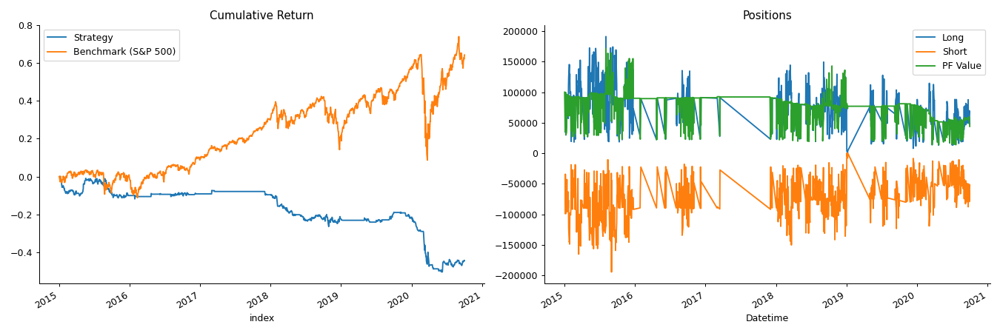

In [432]:
# Plotting returns vs S&P500
fig, axes = plt.subplots(ncols=2, figsize=(15, 5))

df = returns.to_frame('Strategy').join(benchmark.to_frame('Benchmark (S&P 500)'))
df.add(1).cumprod().sub(1).plot(ax=axes[0], title='Cumulative Return')

longs.plot(label='Long',ax=axes[1], title='Positions')
shorts.plot(ax=axes[1], label='Short')
positions.cash.plot(ax=axes[1], label='PF Value')
axes[1].legend()
sns.despine()
fig.tight_layout();

Start date,2015-01-02
End date,2020-10-01
Total months,68
,Backtest
Annual return,-9.703%
Cumulative returns,-44.371%
Annual volatility,10.504%
Sharpe ratio,-0.92
Calmar ratio,-0.19
Stability,0.67
Max drawdown,-50.378%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,50.38,2015-01-02,2020-06-08,NaT,NaN
1,NaN,NaT,NaT,NaT,NaN
2,NaN,NaT,NaT,NaT,NaN
3,NaN,NaT,NaT,NaT,NaN
4,NaN,NaT,NaT,NaT,NaN


<IPython.core.display.Javascript object>


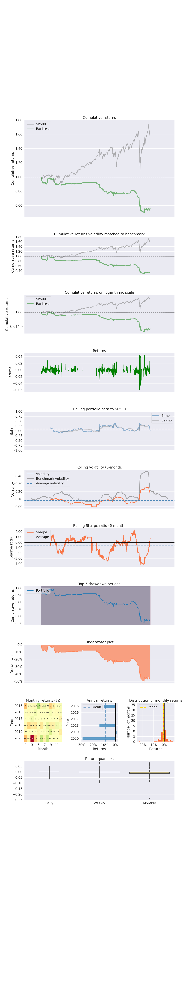

Stress Events,mean,min,max
Fall2015,-0.15%,-1.54%,1.35%
New Normal,-0.04%,-6.07%,4.48%


<IPython.core.display.Javascript object>


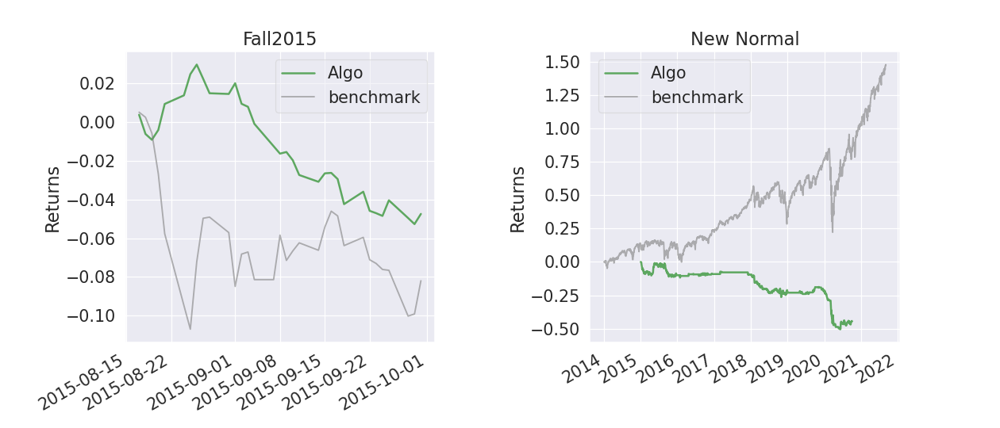

<IPython.core.display.Javascript object>


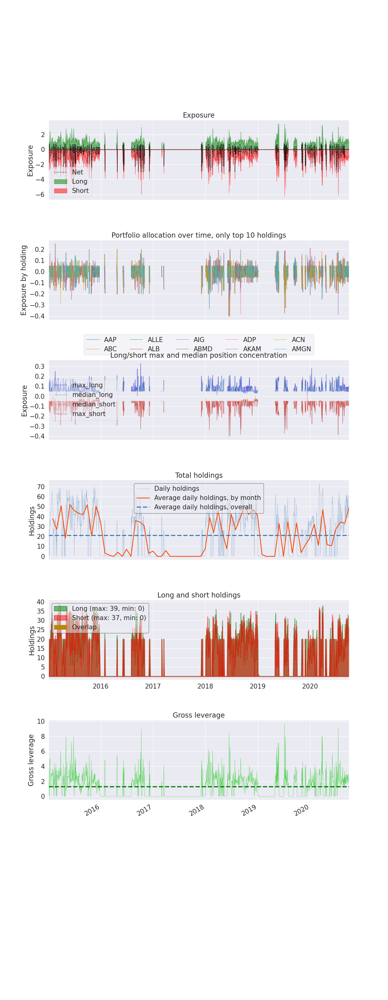

Top 10 long positions of all time,max
sid,
ALGN,32.71%
A,28.14%
ADSK,27.46%
ABMD,25.11%
APA,21.96%
KMX,21.36%
ALB,21.19%
ENPH,21.13%
HBI,20.88%


Top 10 short positions of all time,max
sid,
AAP,-40.30%
ABC,-40.21%
ALLE,-39.98%
ALB,-39.93%
AIG,-38.78%
ABMD,-38.37%
ADP,-38.36%
AKAM,-37.01%
ACN,-36.45%


Top 10 positions of all time,max
sid,
AAP,40.30%
ABC,40.21%
ALLE,39.98%
ALB,39.93%
AIG,38.78%
ABMD,38.37%
ADP,38.36%
AKAM,37.01%
ACN,36.45%


<IPython.core.display.Javascript object>


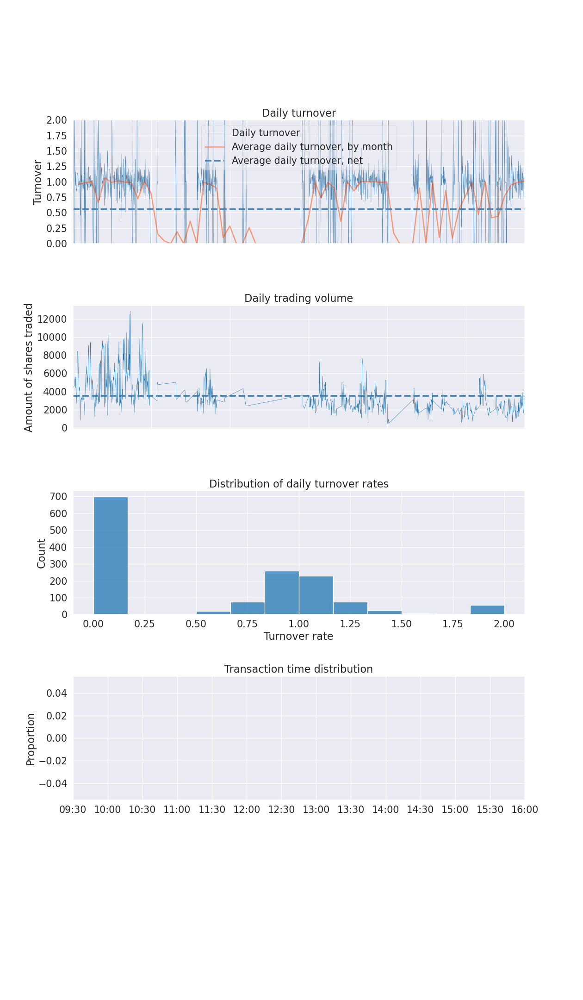

In [433]:
# Complete PyFolio evaluation
pf.create_full_tear_sheet(returns,
                          transactions=transactions,
                          positions=positions,
                          benchmark_rets=benchmark.dropna());

### Backtesting: LightGBM

In [434]:
# Initiating Cerebro
cerebro = bt.Cerebro()
cash = 100000
cerebro.broker.setcash(cash)

In [435]:
# Defining input
class SignalData(PandasData):
    
    cols = OHLCV + ['target1day','target5day','target10day','target21day','target42day','target63day']

    lines = tuple(cols)

    params = {c: -1 for c in cols}
    params.update({'datetime': None})
    params = tuple(params.items())

In [436]:
# Feeding data
data = pd.read_csv('./predictions/lgbm_preds.csv')
data.date = pd.to_datetime(data.date)
data.set_index(['ticker','date'], inplace=True)
tickers = data.index.get_level_values(0).unique()

for ticker in tickers:
    df = data.loc[idx[ticker,'2015-01-02':], :].droplevel('ticker', axis=0)
    df.index.name = 'datetime'
    bt_data = SignalData(dataname=df)
    cerebro.adddata(bt_data, name=ticker)

In [437]:
df

,open,high,low,close,volume,target1day,target5day,target10day,target21day,target42day,target63day
datetime,,,,,,,,,,,
2015-01-02,41.542856,41.772271,41.170061,41.399475,1784200.0,0.000983,0.005317,0.005126,0.014525,0.021889,0.011148
2015-01-05,41.342122,41.705360,41.074475,41.150944,3112100.0,0.000886,-0.000236,-0.001648,0.004184,0.004024,0.006263
2015-01-06,41.246524,41.447259,40.434018,40.749462,3977200.0,0.002150,0.001929,-0.000079,0.011981,0.022773,0.014960
2015-01-07,41.103148,41.638446,41.084030,41.590649,2481800.0,0.001149,0.001253,0.001565,0.007594,0.023479,0.019231
2015-01-08,42.775942,42.890647,42.059027,42.231087,3121300.0,-0.001915,-0.000922,-0.000935,0.009876,0.024093,0.015250
...,...,...,...,...,...,...,...,...,...,...,...
2020-09-25,156.558325,160.566025,156.379329,159.949448,1195900.0,0.000158,0.001544,0.008301,-0.006453,0.018233,0.011924
2020-09-28,161.262134,163.430056,160.267671,160.426788,2293800.0,0.000420,0.002346,0.009586,-0.010331,0.004981,0.004942
2020-09-29,160.725114,162.505211,160.546118,161.580353,1046300.0,0.004578,0.002231,-0.000362,-0.006906,-0.011275,0.000749


In [438]:
# Defining Strategy
class LightGBMStrategy(bt.Strategy):
    params = (('n_positions', 20),
              ('min_positions', 5),
              ('verbose', False))

    def log(self, txt, dt=None):
        print('%s | %s' % (self.datas[0].datetime.date(0).isoformat(), txt))
        
    def notify_trade(self, trade):
        if not trade.isclosed:
            return

        self.log(f'{trade.data._name}: OPERATION PROFIT {trade.pnl}')

    def notify_order(self, order):
        
        if order.status in [order.Submitted, order.Accepted]:
            return
        
        if self.p.verbose:
            if order.status in [order.Completed]:
                p = order.executed.price
                if order.isbuy():
                    self.log(f'{order.data._name}: BUY executed {p:.2f}')
                elif order.issell():
                    self.log(f'{order.data._name}: SELL executed {p:.2f}')

            elif order.status in [order.Canceled, order.Margin, order.Rejected]:
                self.log(f'{order.data._name}: Order Canceled/Margin/Rejected')

    def prenext(self):
        self.next()

    def next(self):
        today = self.datas[0].datetime.date()

        positions = [d._name for d, pos in self.getpositions().items() if pos]
        up, down = {}, {}
        missing = not_missing = 0
        for data in self.datas:
            if data.datetime.date() == today:
                if data.target1day[0] > 0:
                    up[data._name] = data.target1day[0]
                elif data.target1day[0] < 0:
                    down[data._name] = data.target1day[0]

        shorts = sorted(down, key=down.get)[:self.p.n_positions]
        longs = sorted(up, key=up.get, reverse=True)[:self.p.n_positions]
        n_shorts, n_longs = len(shorts), len(longs)
        
        if n_shorts < self.p.min_positions or n_longs < self.p.min_positions:
            longs, shorts = [], []
        for ticker in positions:
            if ticker not in longs + shorts:
                self.order_target_percent(data=ticker, target=0)
                self.log(f'{ticker}: TRADE CLOSING ORDER CREATED')

        short_target = -1 / max(self.p.n_positions, n_shorts)
        long_target = 1 / max(self.p.n_positions, n_longs)
        for ticker in shorts:
            self.order_target_percent(data=ticker, target=short_target)
            self.log(f'{ticker}: SHORT ORDER CREATED')
        for ticker in longs:
            self.order_target_percent(data=ticker, target=long_target)
            self.log(f'{ticker}: LONG ORDER CREATED')

In [439]:
# Backtesting
cerebro.addanalyzer(bt.analyzers.PyFolio, _name='pyfolio')
cerebro.addstrategy(LightGBMStrategy)
cerebro.addsizer(bt.sizers.FixedSize, stake=1000)
cerebro.broker.setcommission(0.001)
results = cerebro.run()
ending_value = cerebro.broker.getvalue()

print(f'Final Portfolio Value: {ending_value:,.2f}')

2015-01-02 | COO: SHORT ORDER CREATED
2015-01-02 | IEX: SHORT ORDER CREATED
2015-01-02 | LHX: SHORT ORDER CREATED
2015-01-02 | USB: SHORT ORDER CREATED
2015-01-02 | TFC: SHORT ORDER CREATED
2015-01-02 | PWR: SHORT ORDER CREATED
2015-01-02 | AXP: SHORT ORDER CREATED
2015-01-02 | GLW: SHORT ORDER CREATED
2015-01-02 | HES: SHORT ORDER CREATED
2015-01-02 | WDC: SHORT ORDER CREATED
2015-01-02 | CRM: SHORT ORDER CREATED
2015-01-02 | CE: SHORT ORDER CREATED
2015-01-02 | KMI: SHORT ORDER CREATED
2015-01-02 | FAST: SHORT ORDER CREATED
2015-01-02 | FDX: SHORT ORDER CREATED
2015-01-02 | EFX: SHORT ORDER CREATED
2015-01-02 | TROW: SHORT ORDER CREATED
2015-01-02 | MOS: SHORT ORDER CREATED
2015-01-02 | CDNS: SHORT ORDER CREATED
2015-01-02 | HON: SHORT ORDER CREATED
2015-01-02 | WELL: LONG ORDER CREATED
2015-01-02 | AAPL: LONG ORDER CREATED
2015-01-02 | NEM: LONG ORDER CREATED
2015-01-02 | VTR: LONG ORDER CREATED
2015-01-02 | PEAK: LONG ORDER CREATED
2015-01-02 | MGM: LONG ORDER CREATED
2015-01-02 | 

2015-01-07 | COG: OPERATION PROFIT -30.08493152949518
2015-01-07 | AVB: OPERATION PROFIT -84.12186514603266
2015-01-07 | ALGN: OPERATION PROFIT -56.3199462890625
2015-01-07 | BAC: OPERATION PROFIT 81.47957236056499
2015-01-07 | CBOE: OPERATION PROFIT -26.180179223984325
2015-01-07 | CERN: OPERATION PROFIT 22.642066161915864
2015-01-07 | CINF: OPERATION PROFIT 7.951865533551391
2015-01-07 | DGX: OPERATION PROFIT 29.035864573502153
2015-01-07 | EQR: OPERATION PROFIT -32.09289908647053
2015-01-07 | ESS: OPERATION PROFIT -86.9335436056194
2015-01-07 | GRMN: OPERATION PROFIT 30.64211483089224
2015-01-07 | GWW: OPERATION PROFIT 70.91882501648419
2015-01-07 | HWM: OPERATION PROFIT 87.68347709277286
2015-01-07 | JNPR: OPERATION PROFIT 40.93909086281933
2015-01-07 | LRCX: OPERATION PROFIT -81.18637100652145
2015-01-07 | MAA: OPERATION PROFIT -13.183733595654843
2015-01-07 | NSC: OPERATION PROFIT -88.47169351979538
2015-01-07 | O: OPERATION PROFIT -71.99851104550245
2015-01-07 | PTC: OPERATION P

2015-01-09 | TWTR: TRADE CLOSING ORDER CREATED
2015-01-09 | URI: TRADE CLOSING ORDER CREATED
2015-01-09 | WBA: TRADE CLOSING ORDER CREATED
2015-01-09 | OKE: SHORT ORDER CREATED
2015-01-09 | UHS: SHORT ORDER CREATED
2015-01-09 | ENPH: SHORT ORDER CREATED
2015-01-09 | FCX: SHORT ORDER CREATED
2015-01-09 | MPC: SHORT ORDER CREATED
2015-01-09 | FLT: SHORT ORDER CREATED
2015-01-09 | CTXS: SHORT ORDER CREATED
2015-01-09 | AMD: SHORT ORDER CREATED
2015-01-09 | MU: SHORT ORDER CREATED
2015-01-09 | INTC: SHORT ORDER CREATED
2015-01-09 | IPGP: SHORT ORDER CREATED
2015-01-09 | STX: SHORT ORDER CREATED
2015-01-09 | AMAT: SHORT ORDER CREATED
2015-01-09 | KLAC: SHORT ORDER CREATED
2015-01-09 | VRTX: SHORT ORDER CREATED
2015-01-09 | NRG: SHORT ORDER CREATED
2015-01-09 | WFC: SHORT ORDER CREATED
2015-01-09 | ADBE: SHORT ORDER CREATED
2015-01-09 | CE: SHORT ORDER CREATED
2015-01-09 | LH: SHORT ORDER CREATED
2015-01-09 | INCY: LONG ORDER CREATED
2015-01-09 | PVH: LONG ORDER CREATED
2015-01-09 | ADM: LON

2015-01-15 | NEM: OPERATION PROFIT 173.03848568530674
2015-01-15 | VTR: OPERATION PROFIT -44.959613108526554
2015-01-15 | PEAK: OPERATION PROFIT -89.37830124596871
2015-01-15 | REG: OPERATION PROFIT 16.038438461177435
2015-01-15 | INCY: OPERATION PROFIT 209.07989501953097
2015-01-15 | AVB: OPERATION PROFIT -72.49505674532472
2015-01-15 | ABMD: OPERATION PROFIT 16.64013671875
2015-01-15 | AMD: OPERATION PROFIT -37.37996435165405
2015-01-15 | AMZN: OPERATION PROFIT 33.1201171875
2015-01-15 | BKNG: OPERATION PROFIT -45.5595703125
2015-01-15 | CRL: OPERATION PROFIT -28.0799560546875
2015-01-15 | DRE: OPERATION PROFIT -88.67531788557729
2015-01-15 | ESS: OPERATION PROFIT -95.43060360547042
2015-01-15 | J: OPERATION PROFIT -95.5418875815867
2015-01-15 | KLAC: OPERATION PROFIT 152.44353051043765
2015-01-15 | LH: OPERATION PROFIT 84.83985900878787
2015-01-15 | LUV: OPERATION PROFIT -172.75150953073677
2015-01-15 | LYB: OPERATION PROFIT 62.2856697612242
2015-01-15 | MAA: OPERATION PROFIT -91.45

2015-01-20 | WELL: OPERATION PROFIT -65.93302963079972
2015-01-20 | PEAK: OPERATION PROFIT -139.51770507025117
2015-01-20 | COG: OPERATION PROFIT 17.145608361872505
2015-01-20 | KIM: OPERATION PROFIT -108.63909891770751
2015-01-20 | EXR: OPERATION PROFIT -119.86176182506598
2015-01-20 | AMD: OPERATION PROFIT -255.31975650787354
2015-01-20 | BK: OPERATION PROFIT 71.60617782202158
2015-01-20 | CVX: OPERATION PROFIT -100.71243915917933
2015-01-20 | DE: OPERATION PROFIT -29.074974608686716
2015-01-20 | FCX: OPERATION PROFIT 46.984780972064755
2015-01-20 | GNRC: OPERATION PROFIT -79.56995010375977
2015-01-20 | GPC: OPERATION PROFIT 106.54665375036345
2015-01-20 | HCA: OPERATION PROFIT 4.229869467227658
2015-01-20 | JNPR: OPERATION PROFIT 83.11126166762625
2015-01-20 | JPM: OPERATION PROFIT 123.79870685965273
2015-01-20 | MPC: OPERATION PROFIT -31.908917068250727
2015-01-20 | MSCI: OPERATION PROFIT -31.36235032007093
2015-01-20 | MU: OPERATION PROFIT 60.4801025390619
2015-01-20 | O: OPERATIO

2015-01-23 | HES: OPERATION PROFIT 36.602019623469516
2015-01-23 | TSCO: OPERATION PROFIT 162.73517406121954
2015-01-23 | APA: OPERATION PROFIT -59.724405192793924
2015-01-23 | C: OPERATION PROFIT 127.38377296591771
2015-01-23 | DHI: OPERATION PROFIT 57.19786121859853
2015-01-23 | DOV: OPERATION PROFIT -55.13536428192042
2015-01-23 | DVN: OPERATION PROFIT 82.5238142607962
2015-01-23 | DXCM: OPERATION PROFIT 62.07020568847656
2015-01-23 | EOG: OPERATION PROFIT 71.17217443054784
2015-01-23 | EXC: OPERATION PROFIT 110.92282042818016
2015-01-23 | FANG: OPERATION PROFIT 99.84137809484386
2015-01-23 | HBAN: OPERATION PROFIT 167.93514699141647
2015-01-23 | IFF: OPERATION PROFIT -164.9642382052445
2015-01-23 | IVZ: OPERATION PROFIT 94.48915527120894
2015-01-23 | J: OPERATION PROFIT -35.17175401735018
2015-01-23 | JPM: OPERATION PROFIT 119.09833913478266
2015-01-23 | KEY: OPERATION PROFIT 274.0301459686782
2015-01-23 | LEN: OPERATION PROFIT 92.70404204727534
2015-01-23 | LNC: OPERATION PROFIT 1

2015-01-28 | COG: OPERATION PROFIT 112.74365091299521
2015-01-28 | INCY: OPERATION PROFIT -92.72026062011719
2015-01-28 | ANSS: OPERATION PROFIT 9.439765930175781
2015-01-28 | BIIB: OPERATION PROFIT -28.14013671875
2015-01-28 | BK: OPERATION PROFIT 8.111582900196055
2015-01-28 | CL: OPERATION PROFIT 27.5621573442897
2015-01-28 | COP: OPERATION PROFIT 2.308181554988181
2015-01-28 | DHI: OPERATION PROFIT -33.94995839473451
2015-01-28 | ECL: OPERATION PROFIT -61.499241989626086
2015-01-28 | EMN: OPERATION PROFIT 137.50065138341304
2015-01-28 | ENPH: OPERATION PROFIT 832.2196407318096
2015-01-28 | EXPD: OPERATION PROFIT -20.100494150469416
2015-01-28 | FCX: OPERATION PROFIT -385.46091874616934
2015-01-28 | FITB: OPERATION PROFIT 50.93158670015006
2015-01-28 | GOOG: OPERATION PROFIT 64.5325927734375
2015-01-28 | HAL: OPERATION PROFIT -20.70878795469808
2015-01-28 | HIG: OPERATION PROFIT 86.88938967628704
2015-01-28 | KMB: OPERATION PROFIT 100.62306208009045
2015-01-28 | LVS: OPERATION PROFI

2015-01-29 | CHTR: LONG ORDER CREATED
2015-01-29 | PRU: LONG ORDER CREATED
2015-01-29 | BAC: LONG ORDER CREATED
2015-01-29 | ACN: LONG ORDER CREATED
2015-01-29 | UPS: LONG ORDER CREATED
2015-01-29 | MET: LONG ORDER CREATED
2015-01-29 | ADSK: LONG ORDER CREATED
2015-01-29 | ALB: LONG ORDER CREATED
2015-01-29 | RF: LONG ORDER CREATED
2015-01-29 | OKE: LONG ORDER CREATED
2015-01-30 | CE: OPERATION PROFIT -22.571780083746944
2015-01-30 | MOS: OPERATION PROFIT 36.66518185037182
2015-01-30 | AAPL: OPERATION PROFIT 31.0143542273017
2015-01-30 | NEM: OPERATION PROFIT 135.56357801393207
2015-01-30 | AAL: OPERATION PROFIT 95.5830756008935
2015-01-30 | AMZN: OPERATION PROFIT -665.43994140625
2015-01-30 | BK: OPERATION PROFIT 48.90721556731531
2015-01-30 | BWA: OPERATION PROFIT -48.073429681103164
2015-01-30 | CAT: OPERATION PROFIT -25.047676961578702
2015-01-30 | CSX: OPERATION PROFIT -25.379770610397756
2015-01-30 | DFS: OPERATION PROFIT -130.4834907901456
2015-01-30 | ED: OPERATION PROFIT -25.4

2015-02-03 | KMI: OPERATION PROFIT -66.88451312300842
2015-02-03 | EFX: OPERATION PROFIT -42.70854577861783
2015-02-03 | AAPL: OPERATION PROFIT 19.176961180299514
2015-02-03 | COG: OPERATION PROFIT -158.06134283108673
2015-02-03 | GILD: OPERATION PROFIT -28.64081798430975
2015-02-03 | ALB: OPERATION PROFIT 174.2395653561974
2015-02-03 | BAC: OPERATION PROFIT 128.5024470280369
2015-02-03 | BKR: OPERATION PROFIT -158.73546022775966
2015-02-03 | BSX: OPERATION PROFIT 47.18011569976866
2015-02-03 | CAT: OPERATION PROFIT 70.44508994905101
2015-02-03 | CSCO: OPERATION PROFIT 96.67073582585463
2015-02-03 | DVA: OPERATION PROFIT -32.33985900878906
2015-02-03 | FIS: OPERATION PROFIT -31.24462576199913
2015-02-03 | FTNT: OPERATION PROFIT 202.38008880615175
2015-02-03 | GNRC: OPERATION PROFIT 136.79965209960858
2015-02-03 | GOOGL: OPERATION PROFIT -39.4200439453125
2015-02-03 | GPC: OPERATION PROFIT 4.290147474775168
2015-02-03 | HAL: OPERATION PROFIT -201.61637651510904
2015-02-03 | ILMN: OPERAT

2015-02-05 | PWR: OPERATION PROFIT 100.88938206373831
2015-02-05 | AAPL: OPERATION PROFIT 84.9605455236919
2015-02-05 | ALB: OPERATION PROFIT 14.354320362801033
2015-02-05 | APA: OPERATION PROFIT -98.92701472431486
2015-02-05 | AWK: OPERATION PROFIT 17.701979350282713
2015-02-05 | BKNG: OPERATION PROFIT -9.919921875
2015-02-05 | CMS: OPERATION PROFIT 64.68964555317815
2015-02-05 | DAL: OPERATION PROFIT 41.72795717636747
2015-02-05 | EIX: OPERATION PROFIT -1.477888352871929
2015-02-05 | EMN: OPERATION PROFIT 13.116320511394918
2015-02-05 | ENPH: OPERATION PROFIT 422.7901582717903
2015-02-05 | ETR: OPERATION PROFIT 89.49103093320794
2015-02-05 | FCX: OPERATION PROFIT -61.35933599800821
2015-02-05 | FTNT: OPERATION PROFIT 147.73989868164122
2015-02-05 | GWW: OPERATION PROFIT 29.791187238814445
2015-02-05 | HAL: OPERATION PROFIT -40.77882494113115
2015-02-05 | J: OPERATION PROFIT 83.46155245769478
2015-02-05 | LNT: OPERATION PROFIT 50.37455307767587
2015-02-05 | LVS: OPERATION PROFIT -105.

2015-02-09 | FAST: OPERATION PROFIT -4.8519422337626
2015-02-09 | WELL: OPERATION PROFIT 247.51384266733035
2015-02-09 | NEM: OPERATION PROFIT 47.14153729537478
2015-02-09 | REG: OPERATION PROFIT 135.60235410831058
2015-02-09 | KIM: OPERATION PROFIT 216.30863978421507
2015-02-09 | INCY: OPERATION PROFIT 18.08977508544922
2015-02-09 | ABBV: OPERATION PROFIT -178.7565837688662
2015-02-09 | AEE: OPERATION PROFIT 219.80257245924514
2015-02-09 | AEP: OPERATION PROFIT 222.87394452023995
2015-02-09 | ALB: OPERATION PROFIT 116.89015246785937
2015-02-09 | AMD: OPERATION PROFIT 261.9701175689697
2015-02-09 | BKNG: OPERATION PROFIT -27.640136718750455
2015-02-09 | CBRE: OPERATION PROFIT 173.73979949951172
2015-02-09 | CMG: OPERATION PROFIT -148.539794921875
2015-02-09 | CMS: OPERATION PROFIT 221.0113901662869
2015-02-09 | ED: OPERATION PROFIT 123.992533353072
2015-02-09 | EIX: OPERATION PROFIT 210.00533309779496
2015-02-09 | ETR: OPERATION PROFIT 212.64560207995817
2015-02-09 | FRT: OPERATION PRO

2015-02-11 | LHX: OPERATION PROFIT 5.573440232207986
2015-02-11 | ADSK: OPERATION PROFIT -65.51976394653255
2015-02-11 | AEE: OPERATION PROFIT 95.59627850933714
2015-02-11 | AEP: OPERATION PROFIT 73.08258256664996
2015-02-11 | APA: OPERATION PROFIT 304.48415702719626
2015-02-11 | CBOE: OPERATION PROFIT -4.278012753122127
2015-02-11 | CMCSA: OPERATION PROFIT -21.146529075729347
2015-02-11 | CTSH: OPERATION PROFIT -68.3026583210792
2015-02-11 | DIS: OPERATION PROFIT -2.56213654919641
2015-02-11 | DVN: OPERATION PROFIT 137.67036564607136
2015-02-11 | EIX: OPERATION PROFIT 117.10414565692784
2015-02-11 | EMR: OPERATION PROFIT 68.05305618379904
2015-02-11 | ETR: OPERATION PROFIT 73.28493516312793
2015-02-11 | EVRG: OPERATION PROFIT 41.514641897599034
2015-02-11 | EXPE: OPERATION PROFIT -23.28131095319179
2015-02-11 | FANG: OPERATION PROFIT 248.81181141355034
2015-02-11 | FCX: OPERATION PROFIT -151.27001405075123
2015-02-11 | FITB: OPERATION PROFIT -33.56248528409546
2015-02-11 | HRL: OPERAT

2015-02-13 | PEAK: OPERATION PROFIT 6.29714742163614
2015-02-13 | COG: OPERATION PROFIT 61.09912430684878
2015-02-13 | ACN: OPERATION PROFIT 62.308092506892876
2015-02-13 | ALGN: OPERATION PROFIT 128.93985366821266
2015-02-13 | ALK: OPERATION PROFIT 117.31267664141852
2015-02-13 | ALL: OPERATION PROFIT 9.712322279374597
2015-02-13 | AMD: OPERATION PROFIT 87.50033378601074
2015-02-13 | APA: OPERATION PROFIT 9.870427498161916
2015-02-13 | BKR: OPERATION PROFIT -75.6803158623845
2015-02-13 | DVN: OPERATION PROFIT -90.14929036625222
2015-02-13 | DXC: OPERATION PROFIT 201.43462818313617
2015-02-13 | EL: OPERATION PROFIT -72.69557979501963
2015-02-13 | EOG: OPERATION PROFIT -117.7741392602618
2015-02-13 | EXPE: OPERATION PROFIT 118.36287354541923
2015-02-13 | FCX: OPERATION PROFIT 219.35316663352086
2015-02-13 | INTU: OPERATION PROFIT 27.13299762508632
2015-02-13 | IT: OPERATION PROFIT 120.36029052734375
2015-02-13 | JCI: OPERATION PROFIT 108.67893056576622
2015-02-13 | MA: OPERATION PROFIT 

2015-02-18 | AXP: OPERATION PROFIT 107.07732026724875
2015-02-18 | HES: OPERATION PROFIT -14.503698312820177
2015-02-18 | FAST: OPERATION PROFIT 11.36171528348784
2015-02-18 | WELL: OPERATION PROFIT 26.917466196282803
2015-02-18 | PEAK: OPERATION PROFIT 2.493380300215904
2015-02-18 | MGM: OPERATION PROFIT -169.65032545374902
2015-02-18 | AAP: OPERATION PROFIT -9.151296390582843
2015-02-18 | ALK: OPERATION PROFIT 43.36459635602321
2015-02-18 | BLL: OPERATION PROFIT -16.468496479986385
2015-02-18 | COP: OPERATION PROFIT 85.26328474442417
2015-02-18 | DAL: OPERATION PROFIT 55.59886640730913
2015-02-18 | DUK: OPERATION PROFIT 13.994219486580903
2015-02-18 | DVN: OPERATION PROFIT 100.95050133465301
2015-02-18 | DXC: OPERATION PROFIT 38.92469683973763
2015-02-18 | DXCM: OPERATION PROFIT 25.090225219726562
2015-02-18 | EIX: OPERATION PROFIT -33.17622991385989
2015-02-18 | FE: OPERATION PROFIT 138.2980964834107
2015-02-18 | ISRG: OPERATION PROFIT 75.22665405273438
2015-02-18 | JNJ: OPERATION P

2015-02-20 | HES: OPERATION PROFIT -131.50252351034578
2015-02-20 | FAST: OPERATION PROFIT -12.538961031987277
2015-02-20 | UAL: OPERATION PROFIT -191.16004943847656
2015-02-20 | AAP: OPERATION PROFIT -19.005936381706874
2015-02-20 | AES: OPERATION PROFIT 31.956386550014827
2015-02-20 | AMAT: OPERATION PROFIT 203.565570878225
2015-02-20 | AMD: OPERATION PROFIT 52.64994978904724
2015-02-20 | CBOE: OPERATION PROFIT -11.246897329191391
2015-02-20 | CHRW: OPERATION PROFIT 17.385283909738575
2015-02-20 | CMG: OPERATION PROFIT -32.07958984375
2015-02-20 | COP: OPERATION PROFIT -89.76388365405955
2015-02-20 | DFS: OPERATION PROFIT 20.042559519784575
2015-02-20 | DISCK: OPERATION PROFIT -10.799903869628906
2015-02-20 | DVN: OPERATION PROFIT -151.97143611655446
2015-02-20 | ENPH: OPERATION PROFIT 238.0799560546875
2015-02-20 | FANG: OPERATION PROFIT -272.02806964420284
2015-02-20 | GWW: OPERATION PROFIT -24.183572658404216
2015-02-20 | HPQ: OPERATION PROFIT 26.909420635668575
2015-02-20 | NLSN:

2015-02-24 | AXP: OPERATION PROFIT 27.772832294566285
2015-02-24 | NEM: OPERATION PROFIT -65.20559945692519
2015-02-24 | MKTX: OPERATION PROFIT 88.28523454744226
2015-02-24 | UAL: OPERATION PROFIT -85.32014465332031
2015-02-24 | AKAM: OPERATION PROFIT 119.99988555908203
2015-02-24 | ALB: OPERATION PROFIT 38.855561542000146
2015-02-24 | ATVI: OPERATION PROFIT 9.255524502852086
2015-02-24 | BKR: OPERATION PROFIT 65.11032019255532
2015-02-24 | BLL: OPERATION PROFIT 69.08576871116615
2015-02-24 | CNP: OPERATION PROFIT -7.439141578125437
2015-02-24 | DHI: OPERATION PROFIT -79.01179672027594
2015-02-24 | EMR: OPERATION PROFIT -23.82651495462096
2015-02-24 | FANG: OPERATION PROFIT -112.11070059717173
2015-02-24 | FITB: OPERATION PROFIT 2.780060488266427
2015-02-24 | GNRC: OPERATION PROFIT -1.070228576659396
2015-02-24 | GWW: OPERATION PROFIT -18.86649269569176
2015-02-24 | HST: OPERATION PROFIT -44.62575188365777
2015-02-24 | LEN: OPERATION PROFIT -39.43006900500029
2015-02-24 | MRO: OPERATIO

2015-02-26 | AXP: OPERATION PROFIT 121.96866749170042
2015-02-26 | CRM: OPERATION PROFIT 695.7396850585938
2015-02-26 | AAPL: OPERATION PROFIT -111.5730850715326
2015-02-26 | AES: OPERATION PROFIT -4.3980454911875455
2015-02-26 | AMD: OPERATION PROFIT 34.31996726989746
2015-02-26 | BAC: OPERATION PROFIT 16.279682755997975
2015-02-26 | CF: OPERATION PROFIT 91.32813859628311
2015-02-26 | CTXS: OPERATION PROFIT 41.560861346144975
2015-02-26 | EIX: OPERATION PROFIT 43.790558986143935
2015-02-26 | ENPH: OPERATION PROFIT -123.83988189697266
2015-02-26 | GRMN: OPERATION PROFIT -1.0831802964621033
2015-02-26 | HII: OPERATION PROFIT -36.560155674603834
2015-02-26 | HLT: OPERATION PROFIT 26.683149357967686
2015-02-26 | HPQ: OPERATION PROFIT -524.215306847924
2015-02-26 | HRL: OPERATION PROFIT -59.98432123525059
2015-02-26 | HUM: OPERATION PROFIT 14.839436954113665
2015-02-26 | INTC: OPERATION PROFIT -63.29121669400499
2015-02-26 | MCO: OPERATION PROFIT -7.655619322694207
2015-02-26 | MNST: OPERA

2015-03-02 | PWR: OPERATION PROFIT -27.87022698857598
2015-03-02 | AXP: OPERATION PROFIT -106.44448892455233
2015-03-02 | CRM: OPERATION PROFIT 187.7200927734375
2015-03-02 | INCY: OPERATION PROFIT 93.32992553710938
2015-03-02 | TSCO: OPERATION PROFIT 49.66681383855452
2015-03-02 | UAL: OPERATION PROFIT -184.0701446533203
2015-03-02 | ABBV: OPERATION PROFIT -2.652192249859276
2015-03-02 | AIZ: OPERATION PROFIT 15.795770803875257
2015-03-02 | AMZN: OPERATION PROFIT 41.860015869141364
2015-03-02 | AVGO: OPERATION PROFIT 61.58641169793455
2015-03-02 | BXP: OPERATION PROFIT -52.917133700796754
2015-03-02 | CBRE: OPERATION PROFIT 20.150165557861328
2015-03-02 | CHD: OPERATION PROFIT 13.734849277495819
2015-03-02 | DAL: OPERATION PROFIT -148.92557990445397
2015-03-02 | DLR: OPERATION PROFIT 127.1763557201325
2015-03-02 | DRI: OPERATION PROFIT 32.3443203347356
2015-03-02 | DXC: OPERATION PROFIT -25.74762483027437
2015-03-02 | EQIX: OPERATION PROFIT 69.64923241849738
2015-03-02 | EXPD: OPERATI

2015-03-04 | A: OPERATION PROFIT 63.6276878673867
2015-03-04 | ABMD: OPERATION PROFIT 217.5
2015-03-04 | AMD: OPERATION PROFIT 101.75990295410156
2015-03-04 | APD: OPERATION PROFIT 66.09707049905847
2015-03-04 | AVGO: OPERATION PROFIT 23.18822920805715
2015-03-04 | DAL: OPERATION PROFIT 93.56490417051297
2015-03-04 | DUK: OPERATION PROFIT 4.2250798770335365
2015-03-04 | EA: OPERATION PROFIT -72.87561127714099
2015-03-04 | EVRG: OPERATION PROFIT -2.8367122305445385
2015-03-04 | FANG: OPERATION PROFIT 126.33605169592373
2015-03-04 | FCX: OPERATION PROFIT 87.47807324141846
2015-03-04 | GOOG: OPERATION PROFIT 12.7452392578125
2015-03-04 | GOOGL: OPERATION PROFIT 5.5799560546875
2015-03-04 | GWW: OPERATION PROFIT 1.3158941115044342
2015-03-04 | JNJ: OPERATION PROFIT 50.97986094524475
2015-03-04 | NFLX: OPERATION PROFIT -64.32853698730469
2015-03-04 | NXPI: OPERATION PROFIT 102.57933857978662
2015-03-04 | ORCL: OPERATION PROFIT 77.73851203984228
2015-03-04 | PCAR: OPERATION PROFIT 47.6027585

2015-03-06 | LHX: OPERATION PROFIT 18.192077883484217
2015-03-06 | FAST: OPERATION PROFIT -264.8163198796898
2015-03-06 | MKTX: OPERATION PROFIT 63.73958920705968
2015-03-06 | LKQ: OPERATION PROFIT -88.78991699218744
2015-03-06 | TSCO: OPERATION PROFIT -33.033545276991504
2015-03-06 | AAL: OPERATION PROFIT 48.1728754903488
2015-03-06 | ADM: OPERATION PROFIT -34.52512621665434
2015-03-06 | AMD: OPERATION PROFIT 250.17976140975952
2015-03-06 | APTV: OPERATION PROFIT 69.90883232654319
2015-03-06 | AVY: OPERATION PROFIT -48.76115629066405
2015-03-06 | AZO: OPERATION PROFIT 67.11962890625
2015-03-06 | BK: OPERATION PROFIT 52.26986669625553
2015-03-06 | CAG: OPERATION PROFIT 4.73038955831214
2015-03-06 | CMS: OPERATION PROFIT 42.86281988340875
2015-03-06 | DXCM: OPERATION PROFIT 85.56002807617188
2015-03-06 | EXPD: OPERATION PROFIT 65.83078190869318
2015-03-06 | EXPE: OPERATION PROFIT 0.4983284000406343
2015-03-06 | FB: OPERATION PROFIT -22.110122680664062
2015-03-06 | FBHS: OPERATION PROFIT

2015-03-10 | CRM: OPERATION PROFIT -2.5198974609375
2015-03-10 | TROW: OPERATION PROFIT -21.69998377472814
2015-03-10 | CDNS: OPERATION PROFIT 6.040138244627833
2015-03-10 | HON: OPERATION PROFIT -0.5320679798514902
2015-03-10 | F: OPERATION PROFIT -13.721303446236249
2015-03-10 | GILD: OPERATION PROFIT 166.38355525468327
2015-03-10 | ABBV: OPERATION PROFIT 69.72233304406295
2015-03-10 | ADBE: OPERATION PROFIT 65.37017059326175
2015-03-10 | AES: OPERATION PROFIT 62.468881564856034
2015-03-10 | ALL: OPERATION PROFIT 3.9292162219549667
2015-03-10 | ANTM: OPERATION PROFIT -6.372266543487285
2015-03-10 | AVGO: OPERATION PROFIT 87.27168815677952
2015-03-10 | BIO: OPERATION PROFIT 16.3995361328125
2015-03-10 | CERN: OPERATION PROFIT 54.652235913088134
2015-03-10 | COF: OPERATION PROFIT 10.252367854030737
2015-03-10 | DFS: OPERATION PROFIT -51.50561327402721
2015-03-10 | DOV: OPERATION PROFIT 12.332033021419697
2015-03-10 | EMR: OPERATION PROFIT -36.688587822089815
2015-03-10 | ETN: OPERATION

2015-03-12 | COO: OPERATION PROFIT -221.63140709803685
2015-03-12 | CDNS: OPERATION PROFIT 12.200279235839844
2015-03-12 | INCY: OPERATION PROFIT -6.60003662109375
2015-03-12 | LKQ: OPERATION PROFIT 79.80008697509766
2015-03-12 | AAL: OPERATION PROFIT 77.6048872010664
2015-03-12 | ALK: OPERATION PROFIT 92.12441093878401
2015-03-12 | APA: OPERATION PROFIT 91.61134228744696
2015-03-12 | BKR: OPERATION PROFIT 43.29158624386605
2015-03-12 | CAT: OPERATION PROFIT 8.10738615898424
2015-03-12 | CCL: OPERATION PROFIT -66.73499230840127
2015-03-12 | CDW: OPERATION PROFIT 50.69969933047332
2015-03-12 | CMA: OPERATION PROFIT -80.17059245074054
2015-03-12 | CPRT: OPERATION PROFIT 2.6600666046153094
2015-03-12 | DVN: OPERATION PROFIT 69.59847682683318
2015-03-12 | ED: OPERATION PROFIT -21.657321969373307
2015-03-12 | EOG: OPERATION PROFIT 39.36431253436061
2015-03-12 | FFIV: OPERATION PROFIT -56.16027832031318
2015-03-12 | GD: OPERATION PROFIT -37.056585665509886
2015-03-12 | GRMN: OPERATION PROFIT

2015-03-16 | HES: OPERATION PROFIT 22.851766537533265
2015-03-16 | MGM: OPERATION PROFIT -49.84193507149514
2015-03-16 | UAL: OPERATION PROFIT -16.0003662109375
2015-03-16 | ABBV: OPERATION PROFIT -31.848291078507998
2015-03-16 | APA: OPERATION PROFIT -63.993519365581356
2015-03-16 | ATO: OPERATION PROFIT 6.135308103360472
2015-03-16 | AWK: OPERATION PROFIT 39.94783116885944
2015-03-16 | CHRW: OPERATION PROFIT -64.57204700338686
2015-03-16 | COP: OPERATION PROFIT 39.84352224171021
2015-03-16 | CVX: OPERATION PROFIT -21.26074364877583
2015-03-16 | DISCA: OPERATION PROFIT 10.080230712890625
2015-03-16 | DISCK: OPERATION PROFIT 0.0
2015-03-16 | DVN: OPERATION PROFIT 54.24555244429982
2015-03-16 | DXC: OPERATION PROFIT -18.420052335505083
2015-03-16 | FANG: OPERATION PROFIT 3.1201816164749943
2015-03-16 | FE: OPERATION PROFIT 37.30556780131457
2015-03-16 | HCA: OPERATION PROFIT 4.519452679779391
2015-03-16 | HPQ: OPERATION PROFIT -31.722664019230756
2015-03-16 | LUV: OPERATION PROFIT -19.3

2015-03-18 | MGM: OPERATION PROFIT 177.52430753020548
2015-03-18 | UAL: OPERATION PROFIT -67.94004821777344
2015-03-18 | AVB: OPERATION PROFIT 2.7667415352525495
2015-03-18 | ABMD: OPERATION PROFIT -146.16002655029297
2015-03-18 | ABT: OPERATION PROFIT 62.747676138644145
2015-03-18 | ANTM: OPERATION PROFIT -13.20483204591477
2015-03-18 | BBY: OPERATION PROFIT -11.560923398549185
2015-03-18 | BLL: OPERATION PROFIT -35.71934802121973
2015-03-18 | CBRE: OPERATION PROFIT -1.5303268432617188
2015-03-18 | CMCSA: OPERATION PROFIT 39.47955766274145
2015-03-18 | DGX: OPERATION PROFIT -71.47920617942044
2015-03-18 | ENPH: OPERATION PROFIT 53.30004692077709
2015-03-18 | EQR: OPERATION PROFIT -0.6747941404362763
2015-03-18 | ESS: OPERATION PROFIT 34.11401631964824
2015-03-18 | EXPE: OPERATION PROFIT 13.13796936300605
2015-03-18 | FANG: OPERATION PROFIT -44.14130055308455
2015-03-18 | FCX: OPERATION PROFIT -194.3920491664515
2015-03-18 | GRMN: OPERATION PROFIT 101.92092907150614
2015-03-18 | HAL: O

2015-03-20 | GLW: OPERATION PROFIT -96.75223666362359
2015-03-20 | AAPL: OPERATION PROFIT 52.33993870546195
2015-03-20 | COG: OPERATION PROFIT -114.22122113948062
2015-03-20 | AAL: OPERATION PROFIT -262.2497809389003
2015-03-20 | AMD: OPERATION PROFIT 19.729981184005954
2015-03-20 | CMG: OPERATION PROFIT 76.93035888671875
2015-03-20 | COP: OPERATION PROFIT -30.922584792301357
2015-03-20 | CVX: OPERATION PROFIT -9.52941567614559
2015-03-20 | DVN: OPERATION PROFIT 21.181059565503674
2015-03-20 | EA: OPERATION PROFIT 76.51161437646124
2015-03-20 | EOG: OPERATION PROFIT -20.600760327388983
2015-03-20 | EQIX: OPERATION PROFIT -101.45280701857587
2015-03-20 | FBHS: OPERATION PROFIT 50.99226132615051
2015-03-20 | FMC: OPERATION PROFIT 28.756622451958194
2015-03-20 | GIS: OPERATION PROFIT 10.11372134192277
2015-03-20 | HUM: OPERATION PROFIT -110.63559381527986
2015-03-20 | IP: OPERATION PROFIT 49.150936722819225
2015-03-20 | K: OPERATION PROFIT 15.245018546113897
2015-03-20 | NFLX: OPERATION P

2015-03-24 | COO: OPERATION PROFIT 114.60983000729027
2015-03-24 | MOS: OPERATION PROFIT 33.11021642403466
2015-03-24 | UAL: OPERATION PROFIT 156.559814453125
2015-03-24 | ABBV: OPERATION PROFIT -53.02883000219647
2015-03-24 | ALB: OPERATION PROFIT -33.423818985652474
2015-03-24 | AMGN: OPERATION PROFIT 88.0757378401641
2015-03-24 | BF-B: OPERATION PROFIT -51.54287188331759
2015-03-24 | BKNG: OPERATION PROFIT -0.43994140625
2015-03-24 | CAH: OPERATION PROFIT 58.251771391463095
2015-03-24 | CCI: OPERATION PROFIT -34.89077624706535
2015-03-24 | CF: OPERATION PROFIT -44.65931075459844
2015-03-24 | CRL: OPERATION PROFIT 65.51957702636719
2015-03-24 | CTXS: OPERATION PROFIT 1.6626679071528656
2015-03-24 | ENPH: OPERATION PROFIT -85.39991855621413
2015-03-24 | FLT: OPERATION PROFIT 43.050384521484375
2015-03-24 | FMC: OPERATION PROFIT -0.8902257100814523
2015-03-24 | IRM: OPERATION PROFIT 46.89935866263451
2015-03-24 | KO: OPERATION PROFIT 111.41466950502029
2015-03-24 | LUV: OPERATION PROFI

2015-03-26 | HES: OPERATION PROFIT 113.88803099870893
2015-03-26 | FAST: OPERATION PROFIT 59.8951205599764
2015-03-26 | MGM: OPERATION PROFIT 148.7275745300692
2015-03-26 | ADI: OPERATION PROFIT 305.16029510472174
2015-03-26 | ALLE: OPERATION PROFIT 39.111506804880946
2015-03-26 | CBRE: OPERATION PROFIT 111.75
2015-03-26 | CPRT: OPERATION PROFIT 155.51971435546875
2015-03-26 | CSX: OPERATION PROFIT -139.08732549434555
2015-03-26 | DVN: OPERATION PROFIT 230.50350429720285
2015-03-26 | EXPD: OPERATION PROFIT 137.2451736205951
2015-03-26 | GNRC: OPERATION PROFIT 56.099815368652344
2015-03-26 | GOOG: OPERATION PROFIT -44.60723876953125
2015-03-26 | GOOGL: OPERATION PROFIT -35.00958251953125
2015-03-26 | HST: OPERATION PROFIT 135.1052303315165
2015-03-26 | IPGP: OPERATION PROFIT -275.6500167846682
2015-03-26 | IRM: OPERATION PROFIT 219.4363111052879
2015-03-26 | J: OPERATION PROFIT 51.126930505447575
2015-03-26 | JBHT: OPERATION PROFIT 155.5475399116095
2015-03-26 | KMX: OPERATION PROFIT 10

2015-03-30 | LHX: OPERATION PROFIT -287.62195121351294
2015-03-30 | PWR: OPERATION PROFIT -11.563620799144196
2015-03-30 | CRM: OPERATION PROFIT 132.84022521972656
2015-03-30 | TROW: OPERATION PROFIT -42.8705056793886
2015-03-30 | HON: OPERATION PROFIT -85.38445084287378
2015-03-30 | MGM: OPERATION PROFIT 22.964476362091055
2015-03-30 | INCY: OPERATION PROFIT 373.9298324584961
2015-03-30 | AAP: OPERATION PROFIT -94.82072260615092
2015-03-30 | ABBV: OPERATION PROFIT 28.554339992098264
2015-03-30 | ABMD: OPERATION PROFIT 76.22019958496091
2015-03-30 | ACN: OPERATION PROFIT -13.299269812988044
2015-03-30 | AMAT: OPERATION PROFIT 176.72331707457317
2015-03-30 | AMP: OPERATION PROFIT -12.45855702156554
2015-03-30 | AVGO: OPERATION PROFIT 208.66935217293354
2015-03-30 | DXCM: OPERATION PROFIT -59.57974243163978
2015-03-30 | EQIX: OPERATION PROFIT 100.72602779546673
2015-03-30 | FITB: OPERATION PROFIT -48.99444401224049
2015-03-30 | GL: OPERATION PROFIT -16.89341170437018
2015-03-30 | GS: OPE

2015-04-01 | HES: OPERATION PROFIT 15.74688327130194
2015-04-01 | FAST: OPERATION PROFIT 50.17987405631999
2015-04-01 | AAPL: OPERATION PROFIT -55.20193508366023
2015-04-01 | PEAK: OPERATION PROFIT 94.46583197387035
2015-04-01 | MGM: OPERATION PROFIT -46.60789583872641
2015-04-01 | ADSK: OPERATION PROFIT -63.240028381347656
2015-04-01 | AFL: OPERATION PROFIT -5.990252585250744
2015-04-01 | AIZ: OPERATION PROFIT 35.79782495320412
2015-04-01 | AMD: OPERATION PROFIT -142.44986414909368
2015-04-01 | AVY: OPERATION PROFIT 60.458759758895894
2015-04-01 | BIIB: OPERATION PROFIT -83.51989746093682
2015-04-01 | BLL: OPERATION PROFIT 20.90513237289577
2015-04-01 | DD: OPERATION PROFIT 70.68689757979703
2015-04-01 | EW: OPERATION PROFIT -41.6018180847168
2015-04-01 | GNRC: OPERATION PROFIT 21.2802734375
2015-04-01 | GOOG: OPERATION PROFIT -13.961181640625
2015-04-01 | GOOGL: OPERATION PROFIT -27.9898681640625
2015-04-01 | GWW: OPERATION PROFIT 43.80223289962947
2015-04-01 | IQV: OPERATION PROFIT 

2015-04-06 | MOS: OPERATION PROFIT 26.493027197330967
2015-04-06 | REG: OPERATION PROFIT -85.45547362005603
2015-04-06 | KIM: OPERATION PROFIT -56.04794329061089
2015-04-06 | ABMD: OPERATION PROFIT 13.260452270507812
2015-04-06 | ADBE: OPERATION PROFIT 2.9200668334960938
2015-04-06 | AIZ: OPERATION PROFIT -16.109337069141908
2015-04-06 | BR: OPERATION PROFIT -16.868114202421964
2015-04-06 | CMS: OPERATION PROFIT -79.98675166430358
2015-04-06 | DISCA: OPERATION PROFIT 127.43987846374574
2015-04-06 | DPZ: OPERATION PROFIT -6.005685777694424
2015-04-06 | ENPH: OPERATION PROFIT -109.2000961303711
2015-04-06 | FMC: OPERATION PROFIT -22.000516362268527
2015-04-06 | FRT: OPERATION PROFIT -79.63102750967514
2015-04-06 | GPC: OPERATION PROFIT 62.174235945812256
2015-04-06 | GPS: OPERATION PROFIT -27.080967010412465
2015-04-06 | HD: OPERATION PROFIT 40.05804163859338
2015-04-06 | IDXX: OPERATION PROFIT -3.96002197265625
2015-04-06 | KR: OPERATION PROFIT -10.698360888649823
2015-04-06 | KSU: OPER

2015-04-08 | LHX: OPERATION PROFIT 29.368330096922875
2015-04-08 | WDC: OPERATION PROFIT 60.86116449732069
2015-04-08 | WELL: OPERATION PROFIT 58.66179116223154
2015-04-08 | REG: OPERATION PROFIT 97.1971661417077
2015-04-08 | KIM: OPERATION PROFIT 85.99021109433124
2015-04-08 | ARE: OPERATION PROFIT 92.55956157190423
2015-04-08 | EXR: OPERATION PROFIT 38.53728562995187
2015-04-08 | AAL: OPERATION PROFIT -56.96423229580631
2015-04-08 | ABMD: OPERATION PROFIT 32.33985900878906
2015-04-08 | BXP: OPERATION PROFIT 85.37448668639244
2015-04-08 | CBOE: OPERATION PROFIT 34.38748903564883
2015-04-08 | CBRE: OPERATION PROFIT 47.94002151489258
2015-04-08 | CF: OPERATION PROFIT -16.494056570107283
2015-04-08 | CMS: OPERATION PROFIT 97.40704330579361
2015-04-08 | DAL: OPERATION PROFIT 68.72646452035583
2015-04-08 | DRE: OPERATION PROFIT 99.20531832915628
2015-04-08 | EQR: OPERATION PROFIT 81.2551549329811
2015-04-08 | ESS: OPERATION PROFIT 72.35947969056406
2015-04-08 | FFIV: OPERATION PROFIT 41.64

2015-04-10 | WDC: OPERATION PROFIT -69.26003695652794
2015-04-10 | WELL: OPERATION PROFIT 93.76583679318051
2015-04-10 | NEM: OPERATION PROFIT 162.57860580626152
2015-04-10 | REG: OPERATION PROFIT 93.86679221277188
2015-04-10 | KIM: OPERATION PROFIT 101.24006514104846
2015-04-10 | UAL: OPERATION PROFIT 61.180141448974524
2015-04-10 | EXR: OPERATION PROFIT 55.10748297581057
2015-04-10 | ABMD: OPERATION PROFIT 36.45037078857422
2015-04-10 | AMD: OPERATION PROFIT 105.29989957809448
2015-04-10 | AMZN: OPERATION PROFIT 51.09991455078125
2015-04-10 | AVGO: OPERATION PROFIT -77.00705364365842
2015-04-10 | CBOE: OPERATION PROFIT 51.07925226786872
2015-04-10 | CMG: OPERATION PROFIT 98.47998046875
2015-04-10 | CMS: OPERATION PROFIT 36.01713604875444
2015-04-10 | DLTR: OPERATION PROFIT 80.920166015625
2015-04-10 | FB: OPERATION PROFIT -20.01006317138672
2015-04-10 | GM: OPERATION PROFIT 100.68615602933173
2015-04-10 | GPS: OPERATION PROFIT -67.15217482182865
2015-04-10 | MSI: OPERATION PROFIT 68.

2015-04-14 | ABBV: OPERATION PROFIT 37.474660546898235
2015-04-14 | ABMD: OPERATION PROFIT -129.5998764038086
2015-04-14 | AMP: OPERATION PROFIT 97.9138191216007
2015-04-14 | APTV: OPERATION PROFIT 67.09205488565652
2015-04-14 | BKNG: OPERATION PROFIT 31.68017578125
2015-04-14 | BWA: OPERATION PROFIT 60.54473042622099
2015-04-14 | C: OPERATION PROFIT 48.180558774985286
2015-04-14 | DAL: OPERATION PROFIT -2.5991537790358734
2015-04-14 | DRE: OPERATION PROFIT -8.232545639222138
2015-04-14 | DRI: OPERATION PROFIT 10.575524538694232
2015-04-14 | ENPH: OPERATION PROFIT 42.600162506103516
2015-04-14 | GNRC: OPERATION PROFIT 78.38978576660156
2015-04-14 | HST: OPERATION PROFIT 65.45760522651574
2015-04-14 | JNPR: OPERATION PROFIT -4.7843584553371095
2015-04-14 | LEG: OPERATION PROFIT 42.24311868242477
2015-04-14 | MAA: OPERATION PROFIT -38.478551047134545
2015-04-14 | MAS: OPERATION PROFIT 42.28863539624868
2015-04-14 | ORLY: OPERATION PROFIT 50.99983215332102
2015-04-14 | PENN: OPERATION PRO

2015-04-16 | FAST: OPERATION PROFIT 46.03167008587468
2015-04-16 | ABMD: OPERATION PROFIT -40.669822692871094
2015-04-16 | ADI: OPERATION PROFIT -53.15608617281305
2015-04-16 | ALB: OPERATION PROFIT -13.421838113595527
2015-04-16 | BIIB: OPERATION PROFIT -34.0599365234375
2015-04-16 | BMY: OPERATION PROFIT 95.97356276607378
2015-04-16 | CAT: OPERATION PROFIT -122.25159653367882
2015-04-16 | DFS: OPERATION PROFIT 102.09022732059728
2015-04-16 | DISCK: OPERATION PROFIT 55.799903869628906
2015-04-16 | DLTR: OPERATION PROFIT 0.0
2015-04-16 | DRI: OPERATION PROFIT 82.03967163958217
2015-04-16 | FIS: OPERATION PROFIT -36.8325662649654
2015-04-16 | GE: OPERATION PROFIT 34.54193595932054
2015-04-16 | GOOG: OPERATION PROFIT 11.9671630859375
2015-04-16 | GOOGL: OPERATION PROFIT 3.8995361328125
2015-04-16 | HAL: OPERATION PROFIT -281.8485904875375
2015-04-16 | JBHT: OPERATION PROFIT 41.64306828362008
2015-04-16 | KR: OPERATION PROFIT -120.53882247959837
2015-04-16 | MNST: OPERATION PROFIT 40.4167

2015-04-20 | FDX: OPERATION PROFIT 1.9624096121413004
2015-04-20 | MKTX: OPERATION PROFIT -42.27697806259627
2015-04-20 | UAL: OPERATION PROFIT -27.590122222901023
2015-04-20 | ADBE: OPERATION PROFIT -71.03993225097656
2015-04-20 | AMD: OPERATION PROFIT -38.99996280670079
2015-04-20 | BA: OPERATION PROFIT 6.49369830467279
2015-04-20 | BKR: OPERATION PROFIT 94.98686374990405
2015-04-20 | CAT: OPERATION PROFIT -30.1894289340687
2015-04-20 | CF: OPERATION PROFIT 14.780800402640814
2015-04-20 | CNC: OPERATION PROFIT 0.0
2015-04-20 | CSX: OPERATION PROFIT 189.71301530958945
2015-04-20 | CVX: OPERATION PROFIT -10.533340221299326
2015-04-20 | DAL: OPERATION PROFIT -51.896522031350656
2015-04-20 | DXC: OPERATION PROFIT -24.574916142407247
2015-04-20 | FANG: OPERATION PROFIT -16.01119946415355
2015-04-20 | FIS: OPERATION PROFIT 1.7372112648952793
2015-04-20 | HAL: OPERATION PROFIT 76.05040487450523
2015-04-20 | HOLX: OPERATION PROFIT -13.599662780761719
2015-04-20 | KSU: OPERATION PROFIT 45.272

2015-04-22 | TROW: OPERATION PROFIT -2.00932298773931
2015-04-22 | NEM: OPERATION PROFIT 0.1251225350811609
2015-04-22 | MKTX: OPERATION PROFIT 11.363807947045757
2015-04-22 | INCY: OPERATION PROFIT -170.12995147705004
2015-04-22 | UAL: OPERATION PROFIT 98.99986267089844
2015-04-22 | AMAT: OPERATION PROFIT 142.54926866537335
2015-04-22 | APA: OPERATION PROFIT 124.08860384038391
2015-04-22 | BAC: OPERATION PROFIT -18.023645510829034
2015-04-22 | BF-B: OPERATION PROFIT 17.99229340505555
2015-04-22 | CBRE: OPERATION PROFIT 37.70030975341797
2015-04-22 | CPB: OPERATION PROFIT 42.30077689553511
2015-04-22 | CSX: OPERATION PROFIT -62.70310158082235
2015-04-22 | GL: OPERATION PROFIT -68.07512072178264
2015-04-22 | GOOG: OPERATION PROFIT -31.0150146484375
2015-04-22 | GOOGL: OPERATION PROFIT -32.5
2015-04-22 | GPS: OPERATION PROFIT -20.639792609171423
2015-04-22 | HAS: OPERATION PROFIT -259.07141693759274
2015-04-22 | IRM: OPERATION PROFIT 57.85646713339047
2015-04-22 | KLAC: OPERATION PROFIT 

2015-04-24 | MGM: OPERATION PROFIT 165.72044474383367
2015-04-24 | AKAM: OPERATION PROFIT -47.2503662109375
2015-04-24 | AMZN: OPERATION PROFIT 683.0601196289062
2015-04-24 | BKNG: OPERATION PROFIT 122.43994140625
2015-04-24 | BMY: OPERATION PROFIT 84.24032083166928
2015-04-24 | CINF: OPERATION PROFIT 47.03060767661907
2015-04-24 | DVN: OPERATION PROFIT 33.739768694064054
2015-04-24 | EIX: OPERATION PROFIT 41.55863001564897
2015-04-24 | EQIX: OPERATION PROFIT -60.33393354253374
2015-04-24 | HAS: OPERATION PROFIT -54.558800375147854
2015-04-24 | HBI: OPERATION PROFIT 177.30306292082355
2015-04-24 | HIG: OPERATION PROFIT 30.320573213112738
2015-04-24 | HUM: OPERATION PROFIT -80.32710981603108
2015-04-24 | IP: OPERATION PROFIT -3.211528964697692
2015-04-24 | ITW: OPERATION PROFIT 28.411179748297712
2015-04-24 | JPM: OPERATION PROFIT -14.448799040618894
2015-04-24 | LVS: OPERATION PROFIT 83.42792175318415
2015-04-24 | MCD: OPERATION PROFIT -25.91450041495932
2015-04-24 | MMC: OPERATION PRO

2015-04-28 | CDNS: OPERATION PROFIT 124.22995376586914
2015-04-28 | TSCO: OPERATION PROFIT 50.083107962033694
2015-04-28 | UAL: OPERATION PROFIT -102.59994506835874
2015-04-28 | AIG: OPERATION PROFIT 29.142745275480124
2015-04-28 | AMD: OPERATION PROFIT -372.1301829814913
2015-04-28 | AMP: OPERATION PROFIT -95.66821902165063
2015-04-28 | AMZN: OPERATION PROFIT -64.19970703125
2015-04-28 | APTV: OPERATION PROFIT 53.66474428862307
2015-04-28 | BWA: OPERATION PROFIT -39.67339975673235
2015-04-28 | CMA: OPERATION PROFIT 60.20856842658651
2015-04-28 | FBHS: OPERATION PROFIT 173.61326432903206
2015-04-28 | FE: OPERATION PROFIT -56.776501823104695
2015-04-28 | FFIV: OPERATION PROFIT 2.2997894287109375
2015-04-28 | FMC: OPERATION PROFIT -9.801455681052857
2015-04-28 | GE: OPERATION PROFIT -2.100045855494841
2015-04-28 | HAS: OPERATION PROFIT 46.348922972394
2015-04-28 | HSY: OPERATION PROFIT -45.63481440278608
2015-04-28 | HWM: OPERATION PROFIT 113.14061723647839
2015-04-28 | IPGP: OPERATION P

2015-04-30 | KIM: OPERATION PROFIT 146.9450594480069
2015-04-30 | UAL: OPERATION PROFIT -102.29985809326172
2015-04-30 | AAP: OPERATION PROFIT -2.7398192613532046
2015-04-30 | AEP: OPERATION PROFIT -2.970128715454706
2015-04-30 | AMAT: OPERATION PROFIT -60.344091686303656
2015-04-30 | AMGN: OPERATION PROFIT -50.68997111472868
2015-04-30 | CMG: OPERATION PROFIT 45.68017578125
2015-04-30 | CSX: OPERATION PROFIT 26.518164330608762
2015-04-30 | DOV: OPERATION PROFIT -82.46510645296692
2015-04-30 | DPZ: OPERATION PROFIT 79.73405777312117
2015-04-30 | EBAY: OPERATION PROFIT 37.86315623593923
2015-04-30 | EW: OPERATION PROFIT -60.121452331543
2015-04-30 | FCX: OPERATION PROFIT -55.92010468763555
2015-04-30 | HAL: OPERATION PROFIT -96.66824063865292
2015-04-30 | HSY: OPERATION PROFIT -117.54567621303991
2015-04-30 | ILMN: OPERATION PROFIT 36.58024597167969
2015-04-30 | IQV: OPERATION PROFIT -298.7998733520508
2015-04-30 | JNPR: OPERATION PROFIT 42.74460784783943
2015-04-30 | LRCX: OPERATION PR

2015-05-04 | CRM: OPERATION PROFIT -3.8795471191401987
2015-05-04 | AAPL: OPERATION PROFIT 42.03145579363863
2015-05-04 | LKQ: OPERATION PROFIT -109.72009658813401
2015-05-04 | ADSK: OPERATION PROFIT 54.000091552734375
2015-05-04 | ALGN: OPERATION PROFIT -58.199851989746094
2015-05-04 | AMGN: OPERATION PROFIT 72.08264319438095
2015-05-04 | AVY: OPERATION PROFIT -185.89444977535726
2015-05-04 | CHRW: OPERATION PROFIT 88.40704814871043
2015-05-04 | CMI: OPERATION PROFIT -70.58232941409473
2015-05-04 | DPZ: OPERATION PROFIT 12.652070890807863
2015-05-04 | EQIX: OPERATION PROFIT -30.1501904181423
2015-05-04 | FCX: OPERATION PROFIT 108.07234993505543
2015-05-04 | GD: OPERATION PROFIT -82.67794082846092
2015-05-04 | GPN: OPERATION PROFIT -12.530280305663304
2015-05-04 | HAL: OPERATION PROFIT -46.44593086225221
2015-05-04 | HBI: OPERATION PROFIT 133.0669370176138
2015-05-04 | HUM: OPERATION PROFIT -24.495020552937376
2015-05-04 | LLY: OPERATION PROFIT -78.70598683706967
2015-05-04 | LMT: OPER

2015-05-06 | LHX: OPERATION PROFIT -79.89074339442786
2015-05-06 | FAST: OPERATION PROFIT 147.48111331499922
2015-05-06 | NEM: OPERATION PROFIT -3.33356595561931
2015-05-06 | VTR: OPERATION PROFIT -52.72480749793836
2015-05-06 | GILD: OPERATION PROFIT 99.0528489932705
2015-05-06 | AKAM: OPERATION PROFIT 75.0
2015-05-06 | AVY: OPERATION PROFIT 35.93508808790944
2015-05-06 | CI: OPERATION PROFIT 6.240866850368079
2015-05-06 | DVN: OPERATION PROFIT 89.58592537436317
2015-05-06 | EOG: OPERATION PROFIT 142.3029006496766
2015-05-06 | FMC: OPERATION PROFIT 83.72413283727346
2015-05-06 | HUM: OPERATION PROFIT -71.44326224704102
2015-05-06 | HWM: OPERATION PROFIT 76.89237907993072
2015-05-06 | IDXX: OPERATION PROFIT 93.76519775390592
2015-05-06 | MRK: OPERATION PROFIT -12.172705968057393
2015-05-06 | MRO: OPERATION PROFIT 166.15298347465568
2015-05-06 | OXY: OPERATION PROFIT -96.8805339841453
2015-05-06 | PRGO: OPERATION PROFIT -11.587409873241086
2015-05-06 | SLB: OPERATION PROFIT 57.700146901

2015-05-08 | HES: OPERATION PROFIT 67.26052035445026
2015-05-08 | VTR: OPERATION PROFIT 163.7068882482239
2015-05-08 | COG: OPERATION PROFIT -14.693421232274034
2015-05-08 | INCY: OPERATION PROFIT 312.1203536987297
2015-05-08 | ABMD: OPERATION PROFIT 373.6200714111328
2015-05-08 | AIZ: OPERATION PROFIT -47.429954696795775
2015-05-08 | AMAT: OPERATION PROFIT 169.49482788995732
2015-05-08 | APA: OPERATION PROFIT 224.6609039451655
2015-05-08 | BKR: OPERATION PROFIT 6.883179774060686
2015-05-08 | BSX: OPERATION PROFIT 26.719974517822266
2015-05-08 | CHRW: OPERATION PROFIT 128.92861254980912
2015-05-08 | COP: OPERATION PROFIT 33.562006305981356
2015-05-08 | CRL: OPERATION PROFIT 13.939849853515625
2015-05-08 | CVX: OPERATION PROFIT -31.89401121761297
2015-05-08 | DVN: OPERATION PROFIT -4.283627892257805
2015-05-08 | FCX: OPERATION PROFIT 92.68818788371922
2015-05-08 | HAL: OPERATION PROFIT 204.92069926261485
2015-05-08 | HUM: OPERATION PROFIT 114.52751914882
2015-05-08 | MRO: OPERATION PROF

2015-05-12 | USB: OPERATION PROFIT 36.293758686418236
2015-05-12 | F: OPERATION PROFIT 22.609306828700817
2015-05-12 | ADSK: OPERATION PROFIT 0.0
2015-05-12 | AIZ: OPERATION PROFIT -22.805918138499948
2015-05-12 | AMAT: OPERATION PROFIT 32.90935914160925
2015-05-12 | AMGN: OPERATION PROFIT -91.04726211209578
2015-05-12 | AVY: OPERATION PROFIT -58.186197766868574
2015-05-12 | BK: OPERATION PROFIT 69.10151278766648
2015-05-12 | BKNG: OPERATION PROFIT -86.6796875
2015-05-12 | BLL: OPERATION PROFIT 65.79725516221214
2015-05-12 | BWA: OPERATION PROFIT 70.28012110907581
2015-05-12 | CHRW: OPERATION PROFIT -41.29746588277828
2015-05-12 | CTXS: OPERATION PROFIT 55.76135323301017
2015-05-12 | EW: OPERATION PROFIT 194.53348922729447
2015-05-12 | FCX: OPERATION PROFIT 106.35786958163365
2015-05-12 | FITB: OPERATION PROFIT -32.06105945453119
2015-05-12 | HST: OPERATION PROFIT -92.9350384125874
2015-05-12 | HWM: OPERATION PROFIT 111.39994608234932
2015-05-12 | IBM: OPERATION PROFIT 70.4591783228220

2015-05-14 | CE: OPERATION PROFIT -136.22538897875842
2015-05-14 | ABT: OPERATION PROFIT 22.507676868498102
2015-05-14 | AES: OPERATION PROFIT -8.62668986196347
2015-05-14 | BF-B: OPERATION PROFIT -65.24823963331482
2015-05-14 | BKNG: OPERATION PROFIT 29.51953125
2015-05-14 | CDW: OPERATION PROFIT 96.17547184730046
2015-05-14 | CNC: OPERATION PROFIT 229.24016571044922
2015-05-14 | DLR: OPERATION PROFIT -16.44172060524209
2015-05-14 | FFIV: OPERATION PROFIT 94.9398422241211
2015-05-14 | HAS: OPERATION PROFIT 32.360190734203925
2015-05-14 | HUM: OPERATION PROFIT 56.68423000370311
2015-05-14 | IDXX: OPERATION PROFIT 4.895027160644531
2015-05-14 | ILMN: OPERATION PROFIT -69.98014831542889
2015-05-14 | IQV: OPERATION PROFIT 70.97988891601562
2015-05-14 | MHK: OPERATION PROFIT -51.2001953125
2015-05-14 | MLM: OPERATION PROFIT -71.56781624731585
2015-05-14 | MPC: OPERATION PROFIT -29.284530113248977
2015-05-14 | MSFT: OPERATION PROFIT -19.948591847307853
2015-05-14 | NTAP: OPERATION PROFIT 12

2015-05-18 | HES: OPERATION PROFIT -22.410502011582466
2015-05-18 | AMD: OPERATION PROFIT 51.59995079040527
2015-05-18 | ANSS: OPERATION PROFIT 59.40010070800781
2015-05-18 | ATVI: OPERATION PROFIT -9.543293584372122
2015-05-18 | AVGO: OPERATION PROFIT 7.561916114346388
2015-05-18 | BKNG: OPERATION PROFIT 11.0498046875
2015-05-18 | CCL: OPERATION PROFIT -0.0003856452220389883
2015-05-18 | CF: OPERATION PROFIT -57.11850494597754
2015-05-18 | DHI: OPERATION PROFIT 120.85416846233076
2015-05-18 | EA: OPERATION PROFIT 24.607375124309634
2015-05-18 | ENPH: OPERATION PROFIT -41.649818420410156
2015-05-18 | HPQ: OPERATION PROFIT 19.598275358698466
2015-05-18 | HSY: OPERATION PROFIT 4.940848658970367
2015-05-18 | HWM: OPERATION PROFIT 52.74096705080162
2015-05-18 | IDXX: OPERATION PROFIT -58.050384521484375
2015-05-18 | MCK: OPERATION PROFIT -25.551758830583935
2015-05-18 | MPC: OPERATION PROFIT 49.60484985747314
2015-05-18 | MRK: OPERATION PROFIT -22.986733948781954
2015-05-18 | MSI: OPERATIO

2015-05-20 | MOS: OPERATION PROFIT 17.980335622463258
2015-05-20 | AAL: OPERATION PROFIT -231.9528148229315
2015-05-20 | ABMD: OPERATION PROFIT -64.58000183105476
2015-05-20 | AMP: OPERATION PROFIT 22.541994742255923
2015-05-20 | APA: OPERATION PROFIT 59.200498773600046
2015-05-20 | BK: OPERATION PROFIT 13.808593565163605
2015-05-20 | BSX: OPERATION PROFIT 10.02022933959961
2015-05-20 | CNC: OPERATION PROFIT 49.87950134277344
2015-05-20 | CSCO: OPERATION PROFIT 14.175379726909746
2015-05-20 | CVX: OPERATION PROFIT 35.24830370020416
2015-05-20 | DE: OPERATION PROFIT 7.3533098772812195
2015-05-20 | DXCM: OPERATION PROFIT 149.5997314453125
2015-05-20 | EW: OPERATION PROFIT -5.958032608032227
2015-05-20 | IPGP: OPERATION PROFIT -16.469795227051648
2015-05-20 | JCI: OPERATION PROFIT -3.0291776282053355
2015-05-20 | JNPR: OPERATION PROFIT 34.88620851059011
2015-05-20 | KMB: OPERATION PROFIT -28.769032086036574
2015-05-20 | KSU: OPERATION PROFIT -17.262616906156765
2015-05-20 | LUV: OPERATION

2015-05-22 | HES: OPERATION PROFIT 92.13461509091348
2015-05-22 | NEM: OPERATION PROFIT 151.1626822048947
2015-05-22 | GILD: OPERATION PROFIT -33.1624438754701
2015-05-22 | ABC: OPERATION PROFIT 21.060280079511486
2015-05-22 | ANTM: OPERATION PROFIT 41.331224795214894
2015-05-22 | APA: OPERATION PROFIT 45.40380506944629
2015-05-22 | ATVI: OPERATION PROFIT -2.7616975337859984
2015-05-22 | BKR: OPERATION PROFIT -56.828182099322646
2015-05-22 | CHRW: OPERATION PROFIT 13.053166503193438
2015-05-22 | COP: OPERATION PROFIT 8.283215369038572
2015-05-22 | CVX: OPERATION PROFIT 49.902983320109584
2015-05-22 | DISCK: OPERATION PROFIT 19.199707031250682
2015-05-22 | HAL: OPERATION PROFIT -47.86291749535749
2015-05-22 | HII: OPERATION PROFIT 122.2051640107965
2015-05-22 | MRO: OPERATION PROFIT -65.30255997564568
2015-05-22 | MSFT: OPERATION PROFIT 32.862074494356456
2015-05-22 | NWSA: OPERATION PROFIT -19.166720847574737
2015-05-22 | NXPI: OPERATION PROFIT 243.53008518587046
2015-05-22 | OKE: OPER

2015-05-27 | TFC: OPERATION PROFIT -18.094548020500767
2015-05-27 | CE: OPERATION PROFIT -30.75270306980471
2015-05-27 | AIZ: OPERATION PROFIT 31.462785921239075
2015-05-27 | AMD: OPERATION PROFIT 157.13985013961792
2015-05-27 | BWA: OPERATION PROFIT 20.408191475022868
2015-05-27 | CLX: OPERATION PROFIT 46.84991543579994
2015-05-27 | CNC: OPERATION PROFIT 65.43989562988281
2015-05-27 | DHI: OPERATION PROFIT 76.1763402206735
2015-05-27 | EQIX: OPERATION PROFIT 59.13247478411313
2015-05-27 | FRC: OPERATION PROFIT -26.29530978942701
2015-05-27 | GL: OPERATION PROFIT 62.04361911143943
2015-05-27 | GOOG: OPERATION PROFIT -58.52008056640625
2015-05-27 | GOOGL: OPERATION PROFIT -39.000244140625
2015-05-27 | GWW: OPERATION PROFIT -12.854421810814074
2015-05-27 | HAS: OPERATION PROFIT 60.96157582247929
2015-05-27 | HIG: OPERATION PROFIT 59.71738913665154
2015-05-27 | ICE: OPERATION PROFIT 59.10291532218099
2015-05-27 | IDXX: OPERATION PROFIT -9.889816284179688
2015-05-27 | INTU: OPERATION PROFI

2015-05-29 | HES: OPERATION PROFIT -15.107066694793758
2015-05-29 | ZTS: OPERATION PROFIT -18.132843196774772
2015-05-29 | ABC: OPERATION PROFIT 3.6510358521731803
2015-05-29 | ADSK: OPERATION PROFIT -54.0
2015-05-29 | APA: OPERATION PROFIT 32.45838398501212
2015-05-29 | BAC: OPERATION PROFIT 21.466745532495946
2015-05-29 | BIO: OPERATION PROFIT 59.04010009765625
2015-05-29 | BMY: OPERATION PROFIT 76.7472701585167
2015-05-29 | CI: OPERATION PROFIT 28.329971369883197
2015-05-29 | CNC: OPERATION PROFIT 40.669822692871094
2015-05-29 | COP: OPERATION PROFIT -15.933802754856174
2015-05-29 | DVN: OPERATION PROFIT 59.73092572074165
2015-05-29 | DXC: OPERATION PROFIT -45.804082112266144
2015-05-29 | EW: OPERATION PROFIT -45.02021217346148
2015-05-29 | EXPE: OPERATION PROFIT -64.61931304393136
2015-05-29 | FANG: OPERATION PROFIT 124.77810823746381
2015-05-29 | FBHS: OPERATION PROFIT -21.94421100721101
2015-05-29 | FITB: OPERATION PROFIT 5.812804256295486
2015-05-29 | HAL: OPERATION PROFIT -15.7

2015-06-02 | COO: OPERATION PROFIT 56.335902941312554
2015-06-02 | TFC: OPERATION PROFIT 54.86792700554085
2015-06-02 | LKQ: OPERATION PROFIT -2.1096458435058594
2015-06-02 | UAL: OPERATION PROFIT 311.6300048828125
2015-06-02 | AAL: OPERATION PROFIT 236.03398492595366
2015-06-02 | ADSK: OPERATION PROFIT -23.309898376464844
2015-06-02 | AFL: OPERATION PROFIT 39.71174176306054
2015-06-02 | ALK: OPERATION PROFIT 8.363073285169797
2015-06-02 | AMGN: OPERATION PROFIT -26.913004111284806
2015-06-02 | AON: OPERATION PROFIT 42.36163421826916
2015-06-02 | APTV: OPERATION PROFIT 62.791178673664334
2015-06-02 | BWA: OPERATION PROFIT -22.027480520692748
2015-06-02 | CINF: OPERATION PROFIT 48.57850884673566
2015-06-02 | CPRT: OPERATION PROFIT -109.62018585205078
2015-06-02 | CSX: OPERATION PROFIT -102.48445944972022
2015-06-02 | FRC: OPERATION PROFIT 53.62114910781446
2015-06-02 | GM: OPERATION PROFIT -5.008791741020204
2015-06-02 | GOOG: OPERATION PROFIT -42.4598388671875
2015-06-02 | GOOGL: OPERA

2015-06-04 | INCY: OPERATION PROFIT -78.49002075195312
2015-06-04 | AAP: OPERATION PROFIT 0.380893180721273
2015-06-04 | ADSK: OPERATION PROFIT -36.6302032470711
2015-06-04 | AKAM: OPERATION PROFIT -1.600341796875
2015-06-04 | APA: OPERATION PROFIT -95.88969324486321
2015-06-04 | BKNG: OPERATION PROFIT 108.75
2015-06-04 | CHRW: OPERATION PROFIT 208.08640892012943
2015-06-04 | CPRT: OPERATION PROFIT 207.6800537109375
2015-06-04 | DD: OPERATION PROFIT 14.899412218624555
2015-06-04 | EW: OPERATION PROFIT -17.54391098022461
2015-06-04 | HII: OPERATION PROFIT -72.50199908127492
2015-06-04 | HUM: OPERATION PROFIT 60.02975190703583
2015-06-04 | ITW: OPERATION PROFIT -15.338329793308645
2015-06-04 | MMM: OPERATION PROFIT -3.7500514866106016
2015-06-04 | ODFL: OPERATION PROFIT -56.19401192774486
2015-06-04 | PKG: OPERATION PROFIT -23.973100060611202
2015-06-04 | SNA: OPERATION PROFIT -5.389123467764421
2015-06-04 | TSN: OPERATION PROFIT -75.56044097351332
2015-06-04 | UNM: OPERATION PROFIT 0.00

2015-06-08 | KMI: OPERATION PROFIT 24.082206117521793
2015-06-08 | WELL: OPERATION PROFIT 66.04757936755294
2015-06-08 | INCY: OPERATION PROFIT -88.4801025390633
2015-06-08 | GILD: OPERATION PROFIT -7.381342203688291
2015-06-08 | AAL: OPERATION PROFIT 152.27619469151261
2015-06-08 | AES: OPERATION PROFIT 13.944791356039001
2015-06-08 | ALK: OPERATION PROFIT 42.31728400666839
2015-06-08 | AMAT: OPERATION PROFIT 29.426601677652684
2015-06-08 | AMGN: OPERATION PROFIT 45.484415432825074
2015-06-08 | CAG: OPERATION PROFIT -74.89535110179837
2015-06-08 | CNC: OPERATION PROFIT -49.105327606201485
2015-06-08 | CPRT: OPERATION PROFIT 3.4000778198242188
2015-06-08 | DAL: OPERATION PROFIT 64.85560122692524
2015-06-08 | DE: OPERATION PROFIT 22.132052318826652
2015-06-08 | DVN: OPERATION PROFIT 63.3808160432974
2015-06-08 | FCX: OPERATION PROFIT 167.59239048683727
2015-06-08 | HII: OPERATION PROFIT 37.92112445545786
2015-06-08 | IFF: OPERATION PROFIT -130.39840214985782
2015-06-08 | ILMN: OPERATION

2015-06-10 | PWR: OPERATION PROFIT -52.381636120232244
2015-06-10 | NEM: OPERATION PROFIT -325.39089880547675
2015-06-10 | UAL: OPERATION PROFIT 228.52014160156332
2015-06-10 | AAL: OPERATION PROFIT 213.29033515734892
2015-06-10 | ABMD: OPERATION PROFIT -281.7799568176272
2015-06-10 | ADBE: OPERATION PROFIT -23.100234985351562
2015-06-10 | AMAT: OPERATION PROFIT -54.611982313421024
2015-06-10 | CME: OPERATION PROFIT -89.76101455675975
2015-06-10 | CMS: OPERATION PROFIT 24.721421808310836
2015-06-10 | DHR: OPERATION PROFIT -30.54680906469288
2015-06-10 | DXC: OPERATION PROFIT 18.784062204925803
2015-06-10 | HPQ: OPERATION PROFIT -0.0009129666012839266
2015-06-10 | IFF: OPERATION PROFIT -3.7944432126751053
2015-06-10 | INTC: OPERATION PROFIT 25.046472606826953
2015-06-10 | J: OPERATION PROFIT -54.970985256067316
2015-06-10 | LUV: OPERATION PROFIT -125.00198627670223
2015-06-10 | MCK: OPERATION PROFIT -0.5102579663160043
2015-06-10 | MO: OPERATION PROFIT 41.18131199717993
2015-06-10 | MS:

2015-06-12 | COO: OPERATION PROFIT 132.77885258988817
2015-06-12 | ALL: OPERATION PROFIT 11.639736437240444
2015-06-12 | AMD: OPERATION PROFIT -77.72992587089539
2015-06-12 | ANET: OPERATION PROFIT -9.7503662109375
2015-06-12 | APA: OPERATION PROFIT 113.07736172227689
2015-06-12 | AWK: OPERATION PROFIT -13.001232612632592
2015-06-12 | BAC: OPERATION PROFIT 57.96829711240915
2015-06-12 | CHRW: OPERATION PROFIT -9.380470098978236
2015-06-12 | CMS: OPERATION PROFIT 13.078333923023024
2015-06-12 | DAL: OPERATION PROFIT 86.38439181163949
2015-06-12 | DISCA: OPERATION PROFIT 77.40005493164062
2015-06-12 | ENPH: OPERATION PROFIT -55.59995269775416
2015-06-12 | ETR: OPERATION PROFIT -3.3931789087687036
2015-06-12 | EVRG: OPERATION PROFIT 36.365296764119506
2015-06-12 | ISRG: OPERATION PROFIT 79.79995727539062
2015-06-12 | LNT: OPERATION PROFIT 3.099528167120088
2015-06-12 | MET: OPERATION PROFIT 32.02686751031649
2015-06-12 | MNST: OPERATION PROFIT 85.06988525390625
2015-06-12 | NTAP: OPERATIO

2015-06-16 | LHX: OPERATION PROFIT -15.347584531241893
2015-06-16 | CE: OPERATION PROFIT -11.081564303757851
2015-06-16 | FDX: OPERATION PROFIT 8.513986783009244
2015-06-16 | PEAK: OPERATION PROFIT -74.30736468992137
2015-06-16 | EXR: OPERATION PROFIT -49.00837353542812
2015-06-16 | AKAM: OPERATION PROFIT -13.12030029296875
2015-06-16 | ALGN: OPERATION PROFIT -19.949913024902344
2015-06-16 | ALK: OPERATION PROFIT 17.056091135174057
2015-06-16 | APD: OPERATION PROFIT -1.655751095737628
2015-06-16 | BDX: OPERATION PROFIT 20.713793127979002
2015-06-16 | CHRW: OPERATION PROFIT -38.463426297308786
2015-06-16 | CPRT: OPERATION PROFIT -8.424871444702148
2015-06-16 | DHR: OPERATION PROFIT 17.57696153071288
2015-06-16 | DPZ: OPERATION PROFIT 32.775092559118434
2015-06-16 | EMN: OPERATION PROFIT -40.99983842951991
2015-06-16 | EXPD: OPERATION PROFIT -4.979833053698428
2015-06-16 | GOOG: OPERATION PROFIT 4.4002685546875
2015-06-16 | GOOGL: OPERATION PROFIT 19.25
2015-06-16 | HAL: OPERATION PROFIT

2015-06-19 | WDC: OPERATION PROFIT 14.737866611524268
2015-06-19 | UAL: OPERATION PROFIT 139.14989471435547
2015-06-19 | ANET: OPERATION PROFIT -57.959747314453125
2015-06-19 | CPRT: OPERATION PROFIT -34.85984802246094
2015-06-19 | DLTR: OPERATION PROFIT 30.34027099609375
2015-06-19 | GOOG: OPERATION PROFIT 68.31024169921875
2015-06-19 | HCA: OPERATION PROFIT 22.951006921150338
2015-06-19 | HWM: OPERATION PROFIT -49.38988368177282
2015-06-19 | IPGP: OPERATION PROFIT 36.399841308594674
2015-06-19 | LUV: OPERATION PROFIT 154.21181009468222
2015-06-19 | MNST: OPERATION PROFIT -55.386741638183594
2015-06-19 | MU: OPERATION PROFIT 38.71996307372961
2015-06-19 | NXPI: OPERATION PROFIT 172.3798760819929
2015-06-19 | ODFL: OPERATION PROFIT -82.91821034447912
2015-06-19 | PVH: OPERATION PROFIT 11.352494101321724
2015-06-19 | PXD: OPERATION PROFIT 122.60991551581725
2015-06-19 | RL: OPERATION PROFIT 155.50973495850002
2015-06-19 | URI: OPERATION PROFIT -91.65023803710938
2015-06-19 | VIAC: OPERA

2015-06-23 | UAL: OPERATION PROFIT -141.11981201171875
2015-06-23 | ADM: OPERATION PROFIT 108.75118664321491
2015-06-23 | ADP: OPERATION PROFIT -47.592137280075804
2015-06-23 | AEP: OPERATION PROFIT 40.26643740713691
2015-06-23 | ALGN: OPERATION PROFIT 37.59978485107422
2015-06-23 | AWK: OPERATION PROFIT 13.002982404868305
2015-06-23 | BDX: OPERATION PROFIT -5.371539223754382
2015-06-23 | BKR: OPERATION PROFIT -50.76638447734374
2015-06-23 | CMI: OPERATION PROFIT 43.28145874821257
2015-06-23 | D: OPERATION PROFIT 39.322997050852905
2015-06-23 | DISCA: OPERATION PROFIT 117.24967956542969
2015-06-23 | DISCK: OPERATION PROFIT -31.620014190673828
2015-06-23 | DISH: OPERATION PROFIT 6.72015380859375
2015-06-23 | DVN: OPERATION PROFIT 22.387545151931135
2015-06-23 | ENPH: OPERATION PROFIT -70.40977191925049
2015-06-23 | GOOG: OPERATION PROFIT 0.54986572265625
2015-06-23 | HAL: OPERATION PROFIT -9.46692184408414
2015-06-23 | IP: OPERATION PROFIT -51.20404238582764
2015-06-23 | ISRG: OPERATION

2015-06-25 | HES: OPERATION PROFIT 59.93371754372333
2015-06-25 | KMI: OPERATION PROFIT -12.219328881567648
2015-06-25 | FDX: OPERATION PROFIT -103.3403998686581
2015-06-25 | ABMD: OPERATION PROFIT 9.790054321289062
2015-06-25 | AVY: OPERATION PROFIT -29.06032791931665
2015-06-25 | BKNG: OPERATION PROFIT 1.14990234375
2015-06-25 | BMY: OPERATION PROFIT -25.777711696762452
2015-06-25 | CNC: OPERATION PROFIT 145.1401824951173
2015-06-25 | CPRT: OPERATION PROFIT -40.20028114318848
2015-06-25 | CRL: OPERATION PROFIT 60.0
2015-06-25 | CTXS: OPERATION PROFIT 70.82320449108724
2015-06-25 | CVX: OPERATION PROFIT 31.657956650902136
2015-06-25 | DISCA: OPERATION PROFIT 31.86005401611328
2015-06-25 | DISCK: OPERATION PROFIT 37.600502014160156
2015-06-25 | DXCM: OPERATION PROFIT -36.190093994140625
2015-06-25 | FB: OPERATION PROFIT -108.79989624023438
2015-06-25 | GD: OPERATION PROFIT 30.70072579073279
2015-06-25 | HUM: OPERATION PROFIT 146.73853791086282
2015-06-25 | HWM: OPERATION PROFIT -15.055

2015-06-29 | MGM: OPERATION PROFIT -148.23576825347246
2015-06-29 | ARE: OPERATION PROFIT -57.12114068722542
2015-06-29 | EXR: OPERATION PROFIT -86.26042355232988
2015-06-29 | ZTS: OPERATION PROFIT 587.5961102225623
2015-06-29 | AAL: OPERATION PROFIT 236.7298475340295
2015-06-29 | ACN: OPERATION PROFIT 110.2450500700015
2015-06-29 | ADBE: OPERATION PROFIT 213.0
2015-06-29 | BA: OPERATION PROFIT 86.16688384248373
2015-06-29 | BAX: OPERATION PROFIT 94.40439444620529
2015-06-29 | BKR: OPERATION PROFIT -63.6108360875659
2015-06-29 | CSX: OPERATION PROFIT -119.21221985687777
2015-06-29 | DLR: OPERATION PROFIT 2.7034701170753124
2015-06-29 | DVN: OPERATION PROFIT -90.08969351806432
2015-06-29 | ENPH: OPERATION PROFIT 601.0204181671138
2015-06-29 | EQR: OPERATION PROFIT 64.35947728291018
2015-06-29 | FRT: OPERATION PROFIT 36.19048729231952
2015-06-29 | FTNT: OPERATION PROFIT -184.47013092041016
2015-06-29 | GM: OPERATION PROFIT -100.22941665496532
2015-06-29 | HCA: OPERATION PROFIT 93.2753732

2015-07-01 | KMI: OPERATION PROFIT 26.98014594702302
2015-07-01 | INCY: OPERATION PROFIT 128.3999633789054
2015-07-01 | UAL: OPERATION PROFIT 74.74973678588867
2015-07-01 | ZTS: OPERATION PROFIT 139.88219641706647
2015-07-01 | AAL: OPERATION PROFIT 68.92751962325156
2015-07-01 | ABMD: OPERATION PROFIT -39.05982971191406
2015-07-01 | ANTM: OPERATION PROFIT 66.82424757449553
2015-07-01 | APA: OPERATION PROFIT 15.939312729285994
2015-07-01 | AVGO: OPERATION PROFIT 27.89585053186869
2015-07-01 | BBY: OPERATION PROFIT -29.787892330449452
2015-07-01 | CVX: OPERATION PROFIT 72.1716544550083
2015-07-01 | DIS: OPERATION PROFIT -91.27671723737043
2015-07-01 | EOG: OPERATION PROFIT -60.849544236312596
2015-07-01 | GM: OPERATION PROFIT 20.175399099862634
2015-07-01 | HCA: OPERATION PROFIT 25.327774113583573
2015-07-01 | J: OPERATION PROFIT -13.461671457368368
2015-07-01 | JCI: OPERATION PROFIT -19.130904507157894
2015-07-01 | LH: OPERATION PROFIT -72.93001556396484
2015-07-01 | MCHP: OPERATION PRO

2015-07-07 | GLW: OPERATION PROFIT 28.079671628346915
2015-07-07 | WELL: OPERATION PROFIT 102.1315454770031
2015-07-07 | VTR: OPERATION PROFIT 78.148887235898
2015-07-07 | PEAK: OPERATION PROFIT 92.96449590826221
2015-07-07 | COG: OPERATION PROFIT 3.950468462702794
2015-07-07 | KIM: OPERATION PROFIT 128.99427421978612
2015-07-07 | UAL: OPERATION PROFIT 230.86029052734375
2015-07-07 | AAL: OPERATION PROFIT 131.8587782812849
2015-07-07 | ADSK: OPERATION PROFIT 111.31977844238196
2015-07-07 | BAX: OPERATION PROFIT 41.5857684912795
2015-07-07 | CVX: OPERATION PROFIT 41.28165031466813
2015-07-07 | DRE: OPERATION PROFIT 153.12257711457318
2015-07-07 | EW: OPERATION PROFIT 53.95849800109956
2015-07-07 | FB: OPERATION PROFIT -28.000106811523438
2015-07-07 | IDXX: OPERATION PROFIT 88.20014953613281
2015-07-07 | MAA: OPERATION PROFIT 95.51554073954468
2015-07-07 | MPC: OPERATION PROFIT -170.91705170840305
2015-07-07 | O: OPERATION PROFIT 129.88075638490147
2015-07-07 | PKG: OPERATION PROFIT -9.6

2015-07-09 | COG: OPERATION PROFIT -52.07280393628869
2015-07-09 | ABMD: OPERATION PROFIT -0.9301986694335938
2015-07-09 | AMGN: OPERATION PROFIT 64.70633063430563
2015-07-09 | AOS: OPERATION PROFIT -335.91810232810684
2015-07-09 | AVGO: OPERATION PROFIT 3.6557493788890127
2015-07-09 | CCL: OPERATION PROFIT -42.571209446453295
2015-07-09 | CF: OPERATION PROFIT -75.83086048168624
2015-07-09 | CI: OPERATION PROFIT -32.095614288076604
2015-07-09 | CINF: OPERATION PROFIT -89.99336137571295
2015-07-09 | CNC: OPERATION PROFIT 140.91505432128906
2015-07-09 | DHI: OPERATION PROFIT 2.1754835790429254
2015-07-09 | ENPH: OPERATION PROFIT 574.3900308609009
2015-07-09 | ETN: OPERATION PROFIT -17.349775312498096
2015-07-09 | FTNT: OPERATION PROFIT 204.00009155273438
2015-07-09 | GRMN: OPERATION PROFIT -88.19270593636804
2015-07-09 | HIG: OPERATION PROFIT 6.920913678169654
2015-07-09 | HPQ: OPERATION PROFIT -47.766888567869415
2015-07-09 | ILMN: OPERATION PROFIT 111.77998352050705
2015-07-09 | LVS: O

2015-07-13 | KMI: OPERATION PROFIT -102.33553652471713
2015-07-13 | VTR: OPERATION PROFIT 78.02805340636766
2015-07-13 | COG: OPERATION PROFIT 63.80215004906697
2015-07-13 | ARE: OPERATION PROFIT 39.62546531861676
2015-07-13 | AOS: OPERATION PROFIT 74.72069817946313
2015-07-13 | APH: OPERATION PROFIT -8.984680455449258
2015-07-13 | APTV: OPERATION PROFIT 60.629092680601715
2015-07-13 | CI: OPERATION PROFIT -0.3862108429349007
2015-07-13 | DRE: OPERATION PROFIT 73.45316737999192
2015-07-13 | GM: OPERATION PROFIT 111.97507022682352
2015-07-13 | GNRC: OPERATION PROFIT -60.44010543823224
2015-07-13 | HSIC: OPERATION PROFIT 56.752899169921875
2015-07-13 | IRM: OPERATION PROFIT 21.868140692177054
2015-07-13 | NXPI: OPERATION PROFIT 143.0234047480139
2015-07-13 | O: OPERATION PROFIT 43.63268635348905
2015-07-13 | OKE: OPERATION PROFIT -122.98595461223843
2015-07-13 | PLD: OPERATION PROFIT 60.408324040787065
2015-07-13 | SWKS: OPERATION PROFIT 375.7390629045639
2015-07-13 | VNO: OPERATION PROF

2015-07-16 | GLW: OPERATION PROFIT 73.39656185831313
2015-07-16 | HES: OPERATION PROFIT 157.1302612498015
2015-07-16 | WDC: OPERATION PROFIT 79.15609825280848
2015-07-16 | MGM: OPERATION PROFIT 54.78085132808911
2015-07-16 | ALB: OPERATION PROFIT 98.95011350679607
2015-07-16 | BKR: OPERATION PROFIT 86.9553877752586
2015-07-16 | CME: OPERATION PROFIT 30.75720808208834
2015-07-16 | DTE: OPERATION PROFIT 44.03227652656321
2015-07-16 | DUK: OPERATION PROFIT 33.88596425975851
2015-07-16 | DVN: OPERATION PROFIT 167.76220541456956
2015-07-16 | EOG: OPERATION PROFIT 147.92723702215085
2015-07-16 | ETR: OPERATION PROFIT -6.726053824478782
2015-07-16 | GNRC: OPERATION PROFIT -113.9000511169433
2015-07-16 | JCI: OPERATION PROFIT 44.85748303588336
2015-07-16 | MPC: OPERATION PROFIT 50.75703579275583
2015-07-16 | NXPI: OPERATION PROFIT -80.81004581688245
2015-07-16 | OXY: OPERATION PROFIT 54.289137476656705
2015-07-16 | PH: OPERATION PROFIT -50.99693378327288
2015-07-16 | PSX: OPERATION PROFIT 26.7

2015-07-20 | GLW: OPERATION PROFIT -104.94443734292724
2015-07-20 | KMI: OPERATION PROFIT 54.834569528641964
2015-07-20 | AMAT: OPERATION PROFIT -52.22751060022145
2015-07-20 | AMT: OPERATION PROFIT -66.84579277980416
2015-07-20 | AOS: OPERATION PROFIT 33.715754741470505
2015-07-20 | BXP: OPERATION PROFIT -31.831655769626437
2015-07-20 | CNC: OPERATION PROFIT 44.82007598877071
2015-07-20 | CVX: OPERATION PROFIT 61.17791289751675
2015-07-20 | EQIX: OPERATION PROFIT 52.20751247539809
2015-07-20 | GNRC: OPERATION PROFIT -12.039947509765625
2015-07-20 | GOOG: OPERATION PROFIT 102.39990234375
2015-07-20 | INTC: OPERATION PROFIT 8.315267215498523
2015-07-20 | IPGP: OPERATION PROFIT -225.5702896118164
2015-07-20 | MCHP: OPERATION PROFIT 30.608658446925205
2015-07-20 | MPC: OPERATION PROFIT -41.32971157955296
2015-07-20 | MPWR: OPERATION PROFIT 5.054371563497753
2015-07-20 | NFLX: OPERATION PROFIT 139.91996765136645
2015-07-20 | PSX: OPERATION PROFIT 5.984417382056023
2015-07-20 | TEL: OPERATI

2015-07-22 | GLW: OPERATION PROFIT -60.636412051811845
2015-07-22 | COG: OPERATION PROFIT -139.546744922782
2015-07-22 | F: OPERATION PROFIT 17.490051400180846
2015-07-22 | AMAT: OPERATION PROFIT -39.40620831068384
2015-07-22 | AVGO: OPERATION PROFIT 375.28249750624207
2015-07-22 | BAC: OPERATION PROFIT 28.13406355940652
2015-07-22 | BBY: OPERATION PROFIT -36.808553465086014
2015-07-22 | CDW: OPERATION PROFIT -48.55146734846301
2015-07-22 | CF: OPERATION PROFIT 165.05849321705398
2015-07-22 | CMA: OPERATION PROFIT 42.15600199490146
2015-07-22 | DAL: OPERATION PROFIT -62.17809446401361
2015-07-22 | EMR: OPERATION PROFIT -69.83192226440835
2015-07-22 | ETN: OPERATION PROFIT -115.63965634846508
2015-07-22 | FB: OPERATION PROFIT 143.6499404907245
2015-07-22 | FCX: OPERATION PROFIT 425.2017619613634
2015-07-22 | HWM: OPERATION PROFIT -24.979927946635556
2015-07-22 | ILMN: OPERATION PROFIT 760.7598571777344
2015-07-22 | LEN: OPERATION PROFIT -20.900667931011135
2015-07-22 | LMT: OPERATION PR

2015-07-24 | COG: OPERATION PROFIT -546.7105835630235
2015-07-24 | ABMD: OPERATION PROFIT 148.78028869628906
2015-07-24 | ALK: OPERATION PROFIT 202.2741331230281
2015-07-24 | BBY: OPERATION PROFIT -13.67823577201894
2015-07-24 | CMA: OPERATION PROFIT -100.80203642229841
2015-07-24 | COP: OPERATION PROFIT -134.59182731199323
2015-07-24 | DAL: OPERATION PROFIT 98.52586159935046
2015-07-24 | DOV: OPERATION PROFIT 15.919940219791897
2015-07-24 | DPZ: OPERATION PROFIT 62.509640687366655
2015-07-24 | DXCM: OPERATION PROFIT 41.25022888183594
2015-07-24 | EMR: OPERATION PROFIT -38.60312300528816
2015-07-24 | EOG: OPERATION PROFIT -8.453529197238652
2015-07-24 | ETN: OPERATION PROFIT -41.55972138377779
2015-07-24 | GPS: OPERATION PROFIT -1.7814817586691234
2015-07-24 | IBM: OPERATION PROFIT 40.444817763616925
2015-07-24 | IPGP: OPERATION PROFIT 31.720123291015625
2015-07-24 | KLAC: OPERATION PROFIT 109.54796508080602
2015-07-24 | NOV: OPERATION PROFIT 6.703508394997542
2015-07-24 | NRG: OPERATI

2015-07-29 | MOS: OPERATION PROFIT 76.5149361479551
2015-07-29 | NEM: OPERATION PROFIT -111.32260486970195
2015-07-29 | COG: OPERATION PROFIT 25.011535255665496
2015-07-29 | ABMD: OPERATION PROFIT -136.79969787597656
2015-07-29 | ADI: OPERATION PROFIT 68.50022475965812
2015-07-29 | AMD: OPERATION PROFIT 612.5999026298523
2015-07-29 | AMZN: OPERATION PROFIT 60.960205078125
2015-07-29 | AVGO: OPERATION PROFIT 146.1417536454814
2015-07-29 | CAT: OPERATION PROFIT 120.33000372248375
2015-07-29 | CMG: OPERATION PROFIT 28.3502197265625
2015-07-29 | COP: OPERATION PROFIT 144.97278242434265
2015-07-29 | ETN: OPERATION PROFIT -111.08246262935047
2015-07-29 | FFIV: OPERATION PROFIT -158.6100311279297
2015-07-29 | GNRC: OPERATION PROFIT 51.83935546875
2015-07-29 | IDXX: OPERATION PROFIT 42.570030212402344
2015-07-29 | ISRG: OPERATION PROFIT 32.399780273439546
2015-07-29 | MPC: OPERATION PROFIT -24.222773978052146
2015-07-29 | MPWR: OPERATION PROFIT 162.4239625745053
2015-07-29 | NXPI: OPERATION PR

2015-08-03 | KMI: OPERATION PROFIT 95.86259326383181
2015-08-03 | WELL: OPERATION PROFIT -14.041863908117278
2015-08-03 | VTR: OPERATION PROFIT 16.464274612759553
2015-08-03 | PEAK: OPERATION PROFIT 5.060402739762139
2015-08-03 | REG: OPERATION PROFIT 10.132283427488773
2015-08-03 | KIM: OPERATION PROFIT 2.64461245378493
2015-08-03 | INCY: OPERATION PROFIT 1.2397918701163064
2015-08-03 | AAL: OPERATION PROFIT -46.35111118470769
2015-08-03 | BIIB: OPERATION PROFIT 164.00994873046875
2015-08-03 | BKR: OPERATION PROFIT 110.06200493081084
2015-08-03 | CNC: OPERATION PROFIT 25.7598876953125
2015-08-03 | EQR: OPERATION PROFIT 5.207451654097241
2015-08-03 | ESS: OPERATION PROFIT -66.27379828837502
2015-08-03 | FANG: OPERATION PROFIT 41.753915215535464
2015-08-03 | LYB: OPERATION PROFIT -108.87723872839648
2015-08-03 | PLD: OPERATION PROFIT 6.426174271316086
2015-08-03 | STX: OPERATION PROFIT 37.819548724948376
2015-08-03 | TWTR: OPERATION PROFIT -108.64974975585938
2015-08-03 | VNO: OPERATION

2015-08-05 | ABC: OPERATION PROFIT -31.284639012224233
2015-08-05 | ABMD: OPERATION PROFIT 292.3193893432617
2015-08-05 | ALGN: OPERATION PROFIT 49.22031021118164
2015-08-05 | AMD: OPERATION PROFIT 214.97052717208862
2015-08-05 | BMY: OPERATION PROFIT 37.03536203812786
2015-08-05 | CERN: OPERATION PROFIT 440.2050078744489
2015-08-05 | COF: OPERATION PROFIT -26.261337817902074
2015-08-05 | DD: OPERATION PROFIT -96.9590834320451
2015-08-05 | HLT: OPERATION PROFIT 73.50453070724234
2015-08-05 | IBM: OPERATION PROFIT -29.359308336055108
2015-08-05 | ILMN: OPERATION PROFIT -37.51020812988281
2015-08-05 | KMX: OPERATION PROFIT -107.10044860839844
2015-08-05 | MTD: OPERATION PROFIT 8.6004638671875
2015-08-05 | MU: OPERATION PROFIT 3.550081253051758
2015-08-05 | PNR: OPERATION PROFIT -24.596048635668993
2015-08-05 | RTX: OPERATION PROFIT 4.0491793221013594
2015-08-05 | SIVB: OPERATION PROFIT -106.69020080566406
2015-08-05 | TDG: OPERATION PROFIT -417.8780246962487
2015-08-05 | URI: OPERATION P

2015-08-07 | HES: OPERATION PROFIT 122.80801393742055
2015-08-07 | MOS: OPERATION PROFIT 28.816447917135896
2015-08-07 | MGM: OPERATION PROFIT 151.20462258457678
2015-08-07 | COG: OPERATION PROFIT -5.337579458153797
2015-08-07 | INCY: OPERATION PROFIT 418.7997436523446
2015-08-07 | ABC: OPERATION PROFIT 180.03632032411204
2015-08-07 | ADSK: OPERATION PROFIT 177.50024795532138
2015-08-07 | ALL: OPERATION PROFIT -114.64594778259479
2015-08-07 | AOS: OPERATION PROFIT -115.19789172940065
2015-08-07 | BKNG: OPERATION PROFIT 4.749755859375
2015-08-07 | CF: OPERATION PROFIT 356.6341351771436
2015-08-07 | COF: OPERATION PROFIT 44.53568538792587
2015-08-07 | CVX: OPERATION PROFIT 92.17015833498981
2015-08-07 | EMR: OPERATION PROFIT -33.81097997420997
2015-08-07 | EXPE: OPERATION PROFIT 31.852475535302716
2015-08-07 | IDXX: OPERATION PROFIT 57.60063171386719
2015-08-07 | LEG: OPERATION PROFIT -60.441331542181814
2015-08-07 | LRCX: OPERATION PROFIT -205.5849105843052
2015-08-07 | MLM: OPERATION P

2015-08-11 | ALL: OPERATION PROFIT -40.346663992060826
2015-08-11 | APA: OPERATION PROFIT 57.82576065725402
2015-08-11 | BKR: OPERATION PROFIT 102.21608542643702
2015-08-11 | BXP: OPERATION PROFIT 71.11722010891265
2015-08-11 | COP: OPERATION PROFIT 54.57497121382669
2015-08-11 | FCX: OPERATION PROFIT 612.6270697040792
2015-08-11 | FMC: OPERATION PROFIT -131.33522691123005
2015-08-11 | FTNT: OPERATION PROFIT -467.20011138916016
2015-08-11 | GPS: OPERATION PROFIT -84.46951519433404
2015-08-11 | HCA: OPERATION PROFIT 88.51274352061404
2015-08-11 | HWM: OPERATION PROFIT 123.91096628430026
2015-08-11 | IBM: OPERATION PROFIT 35.49820990867954
2015-08-11 | IQV: OPERATION PROFIT 37.310333251953125
2015-08-11 | LYV: OPERATION PROFIT 51.680145263671875
2015-08-11 | MU: OPERATION PROFIT -66.04940986633352
2015-08-11 | NFLX: OPERATION PROFIT -334.3996810913078
2015-08-11 | NOV: OPERATION PROFIT 58.50305419964934
2015-08-11 | NRG: OPERATION PROFIT 125.95875128871123
2015-08-11 | NXPI: OPERATION PR

2015-08-13 | COG: OPERATION PROFIT 419.5518555737564
2015-08-13 | INCY: OPERATION PROFIT 310.8599395751944
2015-08-13 | AMD: OPERATION PROFIT 73.39993000030518
2015-08-13 | AMGN: OPERATION PROFIT 148.71235036442712
2015-08-13 | ATVI: OPERATION PROFIT -87.96624203380671
2015-08-13 | AVY: OPERATION PROFIT -1.0834361155448846
2015-08-13 | CERN: OPERATION PROFIT 80.5063501170101
2015-08-13 | DPZ: OPERATION PROFIT -1.842725304398698
2015-08-13 | DRI: OPERATION PROFIT 39.22420013942974
2015-08-13 | EW: OPERATION PROFIT 28.5161209106435
2015-08-13 | GOOG: OPERATION PROFIT 37.5799560546875
2015-08-13 | GOOGL: OPERATION PROFIT 52.8997802734375
2015-08-13 | HBI: OPERATION PROFIT -173.54269128677473
2015-08-13 | HII: OPERATION PROFIT 33.514697918174534
2015-08-13 | IDXX: OPERATION PROFIT -43.199615478515625
2015-08-13 | JBHT: OPERATION PROFIT 54.280462984511345
2015-08-13 | L: OPERATION PROFIT 10.719951765256681
2015-08-13 | LDOS: OPERATION PROFIT -42.10161759011213
2015-08-13 | MNST: OPERATION P

2015-08-19 | PWR: TRADE CLOSING ORDER CREATED
2015-08-19 | HES: TRADE CLOSING ORDER CREATED
2015-08-19 | ADI: TRADE CLOSING ORDER CREATED
2015-08-19 | ALGN: TRADE CLOSING ORDER CREATED
2015-08-19 | BIIB: TRADE CLOSING ORDER CREATED
2015-08-19 | BSX: TRADE CLOSING ORDER CREATED
2015-08-19 | CVX: TRADE CLOSING ORDER CREATED
2015-08-19 | DE: TRADE CLOSING ORDER CREATED
2015-08-19 | EL: TRADE CLOSING ORDER CREATED
2015-08-19 | GOOG: TRADE CLOSING ORDER CREATED
2015-08-19 | HAL: TRADE CLOSING ORDER CREATED
2015-08-19 | HCA: TRADE CLOSING ORDER CREATED
2015-08-19 | HPQ: TRADE CLOSING ORDER CREATED
2015-08-19 | JBHT: TRADE CLOSING ORDER CREATED
2015-08-19 | LDOS: TRADE CLOSING ORDER CREATED
2015-08-19 | LVS: TRADE CLOSING ORDER CREATED
2015-08-19 | NFLX: TRADE CLOSING ORDER CREATED
2015-08-19 | NVDA: TRADE CLOSING ORDER CREATED
2015-08-19 | OKE: TRADE CLOSING ORDER CREATED
2015-08-19 | PRGO: TRADE CLOSING ORDER CREATED
2015-08-19 | TJX: TRADE CLOSING ORDER CREATED
2015-08-19 | TRMB: TRADE CLO

2015-08-25 | LEG: OPERATION PROFIT 269.15905358538896
2015-08-25 | OXY: OPERATION PROFIT -144.4310264178004
2015-08-25 | PXD: OPERATION PROFIT -208.29445706112128
2015-08-25 | QCOM: OPERATION PROFIT -299.0272110887581
2015-08-25 | SWKS: OPERATION PROFIT 1289.167551638118
2015-08-25 | TRV: OPERATION PROFIT -170.08420262787354
2015-08-25 | WFC: OPERATION PROFIT -571.9596185389247
2015-08-25 | ZBRA: OPERATION PROFIT 434.1298141479492
2015-08-25 | BKR: OPERATION PROFIT -20.07353303864241
2015-08-25 | HAL: OPERATION PROFIT -454.44348049851703
2015-08-25 | WDC: TRADE CLOSING ORDER CREATED
2015-08-25 | AAPL: TRADE CLOSING ORDER CREATED
2015-08-25 | NEM: TRADE CLOSING ORDER CREATED
2015-08-25 | INCY: TRADE CLOSING ORDER CREATED
2015-08-25 | AEE: TRADE CLOSING ORDER CREATED
2015-08-25 | AEP: TRADE CLOSING ORDER CREATED
2015-08-25 | AMD: TRADE CLOSING ORDER CREATED
2015-08-25 | AWK: TRADE CLOSING ORDER CREATED
2015-08-25 | BKR: TRADE CLOSING ORDER CREATED
2015-08-25 | CNP: TRADE CLOSING ORDER CR

2015-08-31 | WELL: OPERATION PROFIT 42.569694503725664
2015-08-31 | ARE: OPERATION PROFIT -1.6634694108155372
2015-08-31 | ADI: OPERATION PROFIT -28.600858010494335
2015-08-31 | ALL: OPERATION PROFIT -27.44808981488049
2015-08-31 | BKNG: OPERATION PROFIT -54.7003173828125
2015-08-31 | CTXS: OPERATION PROFIT -42.177548584088186
2015-08-31 | ENPH: OPERATION PROFIT 143.09948444366455
2015-08-31 | FRT: OPERATION PROFIT 26.85549991836743
2015-08-31 | GNRC: OPERATION PROFIT -190.38976097106934
2015-08-31 | IDXX: OPERATION PROFIT -5.070091247559105
2015-08-31 | JCI: OPERATION PROFIT -60.21158639249215
2015-08-31 | LEG: OPERATION PROFIT 207.7368855157113
2015-08-31 | NFLX: OPERATION PROFIT 68.82003784179776
2015-08-31 | NVDA: OPERATION PROFIT -189.7220336714719
2015-08-31 | OXY: OPERATION PROFIT -101.90502499726611
2015-08-31 | SPG: OPERATION PROFIT 43.46430863255716
2015-08-31 | TMUS: OPERATION PROFIT -25.69289764926225
2015-08-31 | WMB: OPERATION PROFIT 121.70119448928973
2015-08-31 | HAL: O

2015-09-04 | TFC: OPERATION PROFIT -2.099673055902713
2015-09-04 | KMI: OPERATION PROFIT 166.30136285875852
2015-09-04 | INCY: OPERATION PROFIT 594.75
2015-09-04 | AAP: OPERATION PROFIT -144.22947773326314
2015-09-04 | ABMD: OPERATION PROFIT -251.22002410888447
2015-09-04 | ALB: OPERATION PROFIT -156.88211042076404
2015-09-04 | CL: OPERATION PROFIT -45.950463800729466
2015-09-04 | DXCM: OPERATION PROFIT 242.75994873046875
2015-09-04 | FCX: OPERATION PROFIT -175.54486099386128
2015-09-04 | FMC: OPERATION PROFIT -45.19959170499084
2015-09-04 | HBAN: OPERATION PROFIT -7.1404720079170225
2015-09-04 | KMB: OPERATION PROFIT -70.23165913764845
2015-09-04 | LNC: OPERATION PROFIT -33.724587440838384
2015-09-04 | MKC: OPERATION PROFIT -19.066085673934104
2015-09-04 | MTB: OPERATION PROFIT 104.06576494394761
2015-09-04 | NWL: OPERATION PROFIT -110.90195438090723
2015-09-04 | NWSA: OPERATION PROFIT 92.073177043711
2015-09-04 | PAYC: OPERATION PROFIT 211.8599395751925
2015-09-04 | PENN: OPERATION P

2015-09-10 | EFX: OPERATION PROFIT 117.62341163542118
2015-09-10 | CDNS: OPERATION PROFIT 146.39986038208008
2015-09-10 | HON: OPERATION PROFIT 130.3380825857232
2015-09-10 | WELL: OPERATION PROFIT -137.63063365383263
2015-09-10 | PEAK: OPERATION PROFIT -158.52449060691131
2015-09-10 | ARE: OPERATION PROFIT -113.18045793801384
2015-09-10 | ZTS: OPERATION PROFIT 212.63416367440382
2015-09-10 | ABBV: OPERATION PROFIT -271.8104334530781
2015-09-10 | ADSK: OPERATION PROFIT -202.1196517944336
2015-09-10 | AES: OPERATION PROFIT -107.91441708314764
2015-09-10 | ANET: OPERATION PROFIT 462.6896743774414
2015-09-10 | AVGO: OPERATION PROFIT 96.81410825609005
2015-09-10 | BIIB: OPERATION PROFIT 255.359619140625
2015-09-10 | CRL: OPERATION PROFIT 112.26986694335938
2015-09-10 | EL: OPERATION PROFIT -207.99540282605983
2015-09-10 | FCX: OPERATION PROFIT 477.63867797972944
2015-09-10 | FRC: OPERATION PROFIT 119.76174924744734
2015-09-10 | IFF: OPERATION PROFIT -141.48521410236023
2015-09-10 | KEY: OP

2015-09-14 | HES: OPERATION PROFIT 386.783949645106
2015-09-14 | AAPL: OPERATION PROFIT 322.1698933864453
2015-09-14 | COG: OPERATION PROFIT -134.43549327902127
2015-09-14 | AAP: OPERATION PROFIT -30.5670650694359
2015-09-14 | ANET: OPERATION PROFIT -400.6799011230469
2015-09-14 | APH: OPERATION PROFIT 86.81659907783703
2015-09-14 | BIO: OPERATION PROFIT -86.94003295898438
2015-09-14 | CAT: OPERATION PROFIT 12.475628753552115
2015-09-14 | CF: OPERATION PROFIT -6.710953131168026
2015-09-14 | COP: OPERATION PROFIT 96.74925859709077
2015-09-14 | DVN: OPERATION PROFIT 53.32824412872165
2015-09-14 | EOG: OPERATION PROFIT -38.54219750194662
2015-09-14 | GNRC: OPERATION PROFIT 19.52044677734375
2015-09-14 | HPQ: OPERATION PROFIT 2.77266110346517
2015-09-14 | HUM: OPERATION PROFIT -75.37670607221338
2015-09-14 | HWM: OPERATION PROFIT 15.714878582416048
2015-09-14 | MPC: OPERATION PROFIT -6.282354206928403
2015-09-14 | MSFT: OPERATION PROFIT 50.500096238460316
2015-09-14 | NFLX: OPERATION PROFI

2015-09-16 | AAL: OPERATION PROFIT -7.1696573599559486
2015-09-16 | ADI: OPERATION PROFIT 129.13051291695047
2015-09-16 | AMD: OPERATION PROFIT 474.79999411105945
2015-09-16 | ANTM: OPERATION PROFIT -49.56478890611811
2015-09-16 | APH: OPERATION PROFIT 36.78781054343253
2015-09-16 | AVGO: OPERATION PROFIT 125.05474234968246
2015-09-16 | CI: OPERATION PROFIT -72.21535141223603
2015-09-16 | CINF: OPERATION PROFIT -64.51419126375484
2015-09-16 | ED: OPERATION PROFIT 33.857364543645566
2015-09-16 | ES: OPERATION PROFIT -49.144101818331016
2015-09-16 | EVRG: OPERATION PROFIT -44.180529448552264
2015-09-16 | FMC: OPERATION PROFIT 33.82959289489598
2015-09-16 | HAL: OPERATION PROFIT 61.69014550126157
2015-09-16 | IDXX: OPERATION PROFIT -79.00009155273438
2015-09-16 | INFO: OPERATION PROFIT -107.4517637207892
2015-09-16 | INTU: OPERATION PROFIT 1.7039078274868302
2015-09-16 | KLAC: OPERATION PROFIT 21.70585982883057
2015-09-16 | LLY: OPERATION PROFIT -153.29406989035544
2015-09-16 | LRCX: OPER

2015-09-18 | COO: OPERATION PROFIT 38.393390212734715
2015-09-18 | IEX: OPERATION PROFIT 163.02429951224565
2015-09-18 | GLW: OPERATION PROFIT 112.59858669768418
2015-09-18 | NEM: OPERATION PROFIT 387.83481328999227
2015-09-18 | COG: OPERATION PROFIT 139.36787986028514
2015-09-18 | KIM: OPERATION PROFIT -25.866467256485492
2015-09-18 | INCY: OPERATION PROFIT 102.07968139648438
2015-09-18 | ADBE: OPERATION PROFIT 179.5396270751953
2015-09-18 | AES: OPERATION PROFIT -88.8291728195644
2015-09-18 | ANSS: OPERATION PROFIT 145.13972473144415
2015-09-18 | ANTM: OPERATION PROFIT 158.82095663763818
2015-09-18 | CDW: OPERATION PROFIT 191.50548138481378
2015-09-18 | CNC: OPERATION PROFIT 58.8001995086658
2015-09-18 | D: OPERATION PROFIT 42.1911221003824
2015-09-18 | DLTR: OPERATION PROFIT -76.1600341796875
2015-09-18 | EXC: OPERATION PROFIT -12.28546600386619
2015-09-18 | FB: OPERATION PROFIT -13.770469665527344
2015-09-18 | FCX: OPERATION PROFIT 206.40086928834404
2015-09-18 | GOOG: OPERATION PR

2015-09-22 | USB: OPERATION PROFIT -130.36241885413648
2015-09-22 | PEAK: OPERATION PROFIT 12.114157100433538
2015-09-22 | COG: OPERATION PROFIT -76.26517503351084
2015-09-22 | MKTX: OPERATION PROFIT 103.2919134928157
2015-09-22 | INCY: OPERATION PROFIT 622.1998138427743
2015-09-22 | BSX: OPERATION PROFIT 148.79985809326172
2015-09-22 | C: OPERATION PROFIT -134.28579124261384
2015-09-22 | DUK: OPERATION PROFIT 31.412158054671124
2015-09-22 | EXC: OPERATION PROFIT -113.49101356336132
2015-09-22 | FCX: OPERATION PROFIT 572.909171753522
2015-09-22 | FRC: OPERATION PROFIT 70.92024390730664
2015-09-22 | HOLX: OPERATION PROFIT 136.51062774658337
2015-09-22 | ICE: OPERATION PROFIT 39.504234773085194
2015-09-22 | INTU: OPERATION PROFIT -12.728757586356096
2015-09-22 | KMB: OPERATION PROFIT -55.89860593225964
2015-09-22 | NFLX: OPERATION PROFIT -380.76016235351454
2015-09-22 | NUE: OPERATION PROFIT 175.93524455645507
2015-09-22 | OKE: OPERATION PROFIT -60.99580596171492
2015-09-22 | PHM: OPERAT

2015-09-24 | COO: OPERATION PROFIT -17.473585057844332
2015-09-24 | AMD: OPERATION PROFIT -359.6801929473877
2015-09-24 | ANET: OPERATION PROFIT -86.57975006103516
2015-09-24 | BF-B: OPERATION PROFIT -94.739808414063
2015-09-24 | CHD: OPERATION PROFIT -35.081231102763525
2015-09-24 | CL: OPERATION PROFIT -29.85833813142986
2015-09-24 | CLX: OPERATION PROFIT -2.719312546436683
2015-09-24 | CNC: OPERATION PROFIT -40.15996170043945
2015-09-24 | CSX: OPERATION PROFIT 302.15971840994354
2015-09-24 | DXCM: OPERATION PROFIT -219.61990356445426
2015-09-24 | ENPH: OPERATION PROFIT -317.050142288208
2015-09-24 | EOG: OPERATION PROFIT 302.993246826548
2015-09-24 | GIS: OPERATION PROFIT 1.3585133335498085
2015-09-24 | GM: OPERATION PROFIT 154.96823655250975
2015-09-24 | IPGP: OPERATION PROFIT -205.43994140625
2015-09-24 | KMB: OPERATION PROFIT -28.666627368170225
2015-09-24 | MKC: OPERATION PROFIT -3.759477566989986
2015-09-24 | MPC: OPERATION PROFIT -3.381770941814125
2015-09-24 | MRO: OPERATION 

2015-09-28 | COO: OPERATION PROFIT 287.2123042140733
2015-09-28 | COG: OPERATION PROFIT -50.022862137119546
2015-09-28 | UAL: OPERATION PROFIT 247.42036056518555
2015-09-28 | AAL: OPERATION PROFIT 206.2043319249286
2015-09-28 | AMAT: OPERATION PROFIT -197.95474490168044
2015-09-28 | BKR: OPERATION PROFIT 390.92023718383535
2015-09-28 | BSX: OPERATION PROFIT 271.4399642944336
2015-09-28 | CERN: OPERATION PROFIT 250.53809110792957
2015-09-28 | CF: OPERATION PROFIT -232.57608301503524
2015-09-28 | CHD: OPERATION PROFIT -22.268740669253418
2015-09-28 | CNC: OPERATION PROFIT 433.50019454956055
2015-09-28 | DOV: OPERATION PROFIT -116.365476282966
2015-09-28 | ENPH: OPERATION PROFIT -336.77015113830566
2015-09-28 | HAL: OPERATION PROFIT 237.32229424021466
2015-09-28 | HCA: OPERATION PROFIT 346.1929348221374
2015-09-28 | KLAC: OPERATION PROFIT -127.14539054067274
2015-09-28 | LLY: OPERATION PROFIT 234.98654176888283
2015-09-28 | MRO: OPERATION PROFIT 96.69275008875283
2015-09-28 | NRG: OPERATI

2015-10-01 | COO: TRADE CLOSING ORDER CREATED
2015-10-01 | HES: TRADE CLOSING ORDER CREATED
2015-10-01 | EFX: TRADE CLOSING ORDER CREATED
2015-10-01 | MOS: TRADE CLOSING ORDER CREATED
2015-10-01 | COG: TRADE CLOSING ORDER CREATED
2015-10-01 | F: TRADE CLOSING ORDER CREATED
2015-10-01 | ABMD: TRADE CLOSING ORDER CREATED
2015-10-01 | ADSK: TRADE CLOSING ORDER CREATED
2015-10-01 | AES: TRADE CLOSING ORDER CREATED
2015-10-01 | AMD: TRADE CLOSING ORDER CREATED
2015-10-01 | ANTM: TRADE CLOSING ORDER CREATED
2015-10-01 | APA: TRADE CLOSING ORDER CREATED
2015-10-01 | BKR: TRADE CLOSING ORDER CREATED
2015-10-01 | BWA: TRADE CLOSING ORDER CREATED
2015-10-01 | CAT: TRADE CLOSING ORDER CREATED
2015-10-01 | CF: TRADE CLOSING ORDER CREATED
2015-10-01 | CNC: TRADE CLOSING ORDER CREATED
2015-10-01 | DVN: TRADE CLOSING ORDER CREATED
2015-10-01 | FMC: TRADE CLOSING ORDER CREATED
2015-10-01 | FTNT: TRADE CLOSING ORDER CREATED
2015-10-01 | GOOG: TRADE CLOSING ORDER CREATED
2015-10-01 | GOOGL: TRADE CLOSIN

2015-10-07 | UAL: OPERATION PROFIT -341.00011825561523
2015-10-07 | AAL: OPERATION PROFIT -317.20020011812875
2015-10-07 | APA: OPERATION PROFIT 501.9191242188328
2015-10-07 | CPRT: OPERATION PROFIT -9.540218353271484
2015-10-07 | CTSH: OPERATION PROFIT -81.35699117389815
2015-10-07 | CTXS: OPERATION PROFIT 66.06795744533949
2015-10-07 | DE: OPERATION PROFIT 72.65200551545743
2015-10-07 | FFIV: OPERATION PROFIT -125.2901840209961
2015-10-07 | GE: OPERATION PROFIT -154.64901050054664
2015-10-07 | GOOG: OPERATION PROFIT 124.799560546875
2015-10-07 | GOOGL: OPERATION PROFIT 96.6005859375
2015-10-07 | GPS: OPERATION PROFIT 34.20013326804499
2015-10-07 | HPQ: OPERATION PROFIT -293.1171374164721
2015-10-07 | JNPR: OPERATION PROFIT -206.52310542328158
2015-10-07 | KR: OPERATION PROFIT 148.19467350283648
2015-10-07 | MCHP: OPERATION PROFIT -111.88042139282175
2015-10-07 | MPWR: OPERATION PROFIT 313.5690832347494
2015-10-07 | NOW: OPERATION PROFIT 72.35980224609375
2015-10-07 | ORCL: OPERATION 

2015-10-12 | PSX: TRADE CLOSING ORDER CREATED
2015-10-12 | REGN: TRADE CLOSING ORDER CREATED
2015-10-12 | TWTR: TRADE CLOSING ORDER CREATED
2015-10-12 | UHS: TRADE CLOSING ORDER CREATED
2015-10-12 | OKE: SHORT ORDER CREATED
2015-10-12 | GPN: SHORT ORDER CREATED
2015-10-12 | WYNN: SHORT ORDER CREATED
2015-10-12 | MU: SHORT ORDER CREATED
2015-10-12 | DVA: SHORT ORDER CREATED
2015-10-12 | GILD: SHORT ORDER CREATED
2015-10-12 | GOOG: SHORT ORDER CREATED
2015-10-12 | AMZN: SHORT ORDER CREATED
2015-10-12 | WDC: SHORT ORDER CREATED
2015-10-12 | WMB: SHORT ORDER CREATED
2015-10-12 | FANG: SHORT ORDER CREATED
2015-10-12 | MHK: SHORT ORDER CREATED
2015-10-12 | ANTM: SHORT ORDER CREATED
2015-10-12 | CRL: SHORT ORDER CREATED
2015-10-12 | EOG: SHORT ORDER CREATED
2015-10-12 | LH: SHORT ORDER CREATED
2015-10-12 | INCY: SHORT ORDER CREATED
2015-10-12 | NTAP: SHORT ORDER CREATED
2015-10-12 | TSN: SHORT ORDER CREATED
2015-10-12 | UAL: SHORT ORDER CREATED
2015-10-12 | PNR: LONG ORDER CREATED
2015-10-12 

2015-10-15 | MGM: OPERATION PROFIT -266.5916085353524
2015-10-15 | UAL: OPERATION PROFIT -101.1702995300293
2015-10-15 | AAL: OPERATION PROFIT -19.93034014754224
2015-10-15 | ALGN: OPERATION PROFIT 93.94009399414062
2015-10-15 | ANET: OPERATION PROFIT 59.400604248046875
2015-10-15 | AVGO: OPERATION PROFIT 131.56279367784242
2015-10-15 | BEN: OPERATION PROFIT 30.043575697923842
2015-10-15 | CF: OPERATION PROFIT -240.49615306153845
2015-10-15 | CMCSA: OPERATION PROFIT -49.01867026583399
2015-10-15 | CVS: OPERATION PROFIT 102.15898828995138
2015-10-15 | DHI: OPERATION PROFIT 285.09563984769903
2015-10-15 | DIS: OPERATION PROFIT -0.00024386997651504316
2015-10-15 | EBAY: OPERATION PROFIT -225.46441640425058
2015-10-15 | EQIX: OPERATION PROFIT -136.3701271342812
2015-10-15 | EXPD: OPERATION PROFIT -67.99019465315361
2015-10-15 | GPN: OPERATION PROFIT 372.38174722490544
2015-10-15 | ILMN: OPERATION PROFIT -73.16032409667969
2015-10-15 | IP: OPERATION PROFIT -24.71345185052325
2015-10-15 | LL

2015-10-19 | COO: OPERATION PROFIT -100.65110166777686
2015-10-19 | KMI: OPERATION PROFIT 47.89005263100076
2015-10-19 | VTR: OPERATION PROFIT 138.96086289131205
2015-10-19 | AME: OPERATION PROFIT 86.6976636350493
2015-10-19 | AMGN: OPERATION PROFIT 32.888687649348725
2015-10-19 | ATVI: OPERATION PROFIT 31.052546596414693
2015-10-19 | CFG: OPERATION PROFIT -156.06302573172215
2015-10-19 | CME: OPERATION PROFIT -52.62944798343696
2015-10-19 | CZR: OPERATION PROFIT 37.19996452331708
2015-10-19 | D: OPERATION PROFIT 9.574718851179625
2015-10-19 | DG: OPERATION PROFIT 25.02872984108734
2015-10-19 | DISCA: OPERATION PROFIT 39.390323638916016
2015-10-19 | DISCK: OPERATION PROFIT 177.65036964416504
2015-10-19 | DLTR: OPERATION PROFIT -29.18987274169922
2015-10-19 | DTE: OPERATION PROFIT 23.024710751896606
2015-10-19 | EOG: OPERATION PROFIT -98.0565072287715
2015-10-19 | ETN: OPERATION PROFIT -220.91153772228137
2015-10-19 | FE: OPERATION PROFIT 101.47272650666667
2015-10-19 | GRMN: OPERATION 

2015-10-20 | BEN: LONG ORDER CREATED
2015-10-20 | DE: LONG ORDER CREATED
2015-10-20 | WYNN: LONG ORDER CREATED
2015-10-20 | URI: LONG ORDER CREATED
2015-10-20 | SWKS: LONG ORDER CREATED
2015-10-20 | ETN: LONG ORDER CREATED
2015-10-20 | FDX: LONG ORDER CREATED
2015-10-20 | FANG: LONG ORDER CREATED
2015-10-20 | PXD: LONG ORDER CREATED
2015-10-21 | ARE: OPERATION PROFIT -54.965204602986404
2015-10-21 | ADBE: OPERATION PROFIT 92.07003021240234
2015-10-21 | ADI: OPERATION PROFIT -104.15836233468643
2015-10-21 | CF: OPERATION PROFIT 160.7385709321046
2015-10-21 | CFG: OPERATION PROFIT 94.96554046941682
2015-10-21 | CPRT: OPERATION PROFIT 105.83953857421875
2015-10-21 | CSX: OPERATION PROFIT 223.08399002965703
2015-10-21 | CTLT: OPERATION PROFIT 217.79994964599842
2015-10-21 | DISCA: OPERATION PROFIT -159.64014053344727
2015-10-21 | DLR: OPERATION PROFIT -82.56260134438415
2015-10-21 | DOV: OPERATION PROFIT 442.2189168250071
2015-10-21 | DRE: OPERATION PROFIT -37.74966764968757
2015-10-21 | D

2015-10-26 | VIAC: SHORT ORDER CREATED
2015-10-26 | MU: SHORT ORDER CREATED
2015-10-26 | ALGN: SHORT ORDER CREATED
2015-10-26 | LUV: SHORT ORDER CREATED
2015-10-26 | MRO: SHORT ORDER CREATED
2015-10-26 | CVX: SHORT ORDER CREATED
2015-10-26 | GE: SHORT ORDER CREATED
2015-10-26 | F: SHORT ORDER CREATED
2015-10-26 | AMAT: SHORT ORDER CREATED
2015-10-26 | VRSN: SHORT ORDER CREATED
2015-10-26 | URI: SHORT ORDER CREATED
2015-10-26 | ROP: SHORT ORDER CREATED
2015-10-26 | TTWO: SHORT ORDER CREATED
2015-10-26 | KLAC: SHORT ORDER CREATED
2015-10-26 | AMZN: SHORT ORDER CREATED
2015-10-26 | ALB: SHORT ORDER CREATED
2015-10-26 | DD: SHORT ORDER CREATED
2015-10-26 | FTNT: LONG ORDER CREATED
2015-10-26 | PVH: LONG ORDER CREATED
2015-10-26 | NRG: LONG ORDER CREATED
2015-10-26 | VFC: LONG ORDER CREATED
2015-10-26 | HBI: LONG ORDER CREATED
2015-10-26 | CMG: LONG ORDER CREATED
2015-10-26 | WHR: LONG ORDER CREATED
2015-10-26 | AAPL: LONG ORDER CREATED
2015-10-26 | EXC: LONG ORDER CREATED
2015-10-26 | COG:

2015-10-29 | WDC: OPERATION PROFIT -8.301286620445346
2015-10-29 | KMI: OPERATION PROFIT 140.1457909666637
2015-10-29 | AAPL: OPERATION PROFIT 267.8663201714305
2015-10-29 | NEM: OPERATION PROFIT -198.71055722423907
2015-10-29 | ZTS: OPERATION PROFIT 135.25997545545562
2015-10-29 | ABBV: OPERATION PROFIT 67.3844058134577
2015-10-29 | AIZ: OPERATION PROFIT -160.71549945396242
2015-10-29 | AKAM: OPERATION PROFIT 25.82988739013672
2015-10-29 | CI: OPERATION PROFIT -43.10988067609094
2015-10-29 | DGX: OPERATION PROFIT 159.03245525673535
2015-10-29 | DIS: OPERATION PROFIT -30.175267087111393
2015-10-29 | HCA: OPERATION PROFIT 35.16176977200644
2015-10-29 | KLAC: OPERATION PROFIT -54.32508724764318
2015-10-29 | LRCX: OPERATION PROFIT 82.87100176058959
2015-10-29 | MAS: OPERATION PROFIT -170.6808938442266
2015-10-29 | MRO: OPERATION PROFIT 384.9991149318091
2015-10-29 | NDAQ: OPERATION PROFIT -7.888645373815351
2015-10-29 | NOW: OPERATION PROFIT -223.88003540039062
2015-10-29 | NUE: OPERATION

2015-11-02 | KIM: OPERATION PROFIT 161.31829928505692
2015-11-02 | INCY: OPERATION PROFIT -174.37004089355332
2015-11-02 | GILD: OPERATION PROFIT 67.49118560311648
2015-11-02 | ABBV: OPERATION PROFIT 670.1296193597136
2015-11-02 | ANTM: OPERATION PROFIT -199.22222966718329
2015-11-02 | BIIB: OPERATION PROFIT 17.159637451171875
2015-11-02 | BWA: OPERATION PROFIT 364.5693328139678
2015-11-02 | CINF: OPERATION PROFIT 88.78413846525768
2015-11-02 | CMG: OPERATION PROFIT -589.8797607421875
2015-11-02 | COP: OPERATION PROFIT -167.87070953507666
2015-11-02 | DVN: OPERATION PROFIT 23.675857364751707
2015-11-02 | ENPH: OPERATION PROFIT -157.68047618865734
2015-11-02 | GPN: OPERATION PROFIT 6.375586723635465
2015-11-02 | KLAC: OPERATION PROFIT -77.61482479490337
2015-11-02 | MAA: OPERATION PROFIT 317.366449426578
2015-11-02 | MO: OPERATION PROFIT 59.998126471593096
2015-11-02 | MRO: OPERATION PROFIT 199.47006992547975
2015-11-02 | NOC: OPERATION PROFIT 118.48548459962353
2015-11-02 | NOW: OPERAT

2015-11-04 | WDC: OPERATION PROFIT 147.18642303078548
2015-11-04 | MOS: OPERATION PROFIT 758.2901495738132
2015-11-04 | WELL: OPERATION PROFIT -133.9779999668482
2015-11-04 | PEAK: OPERATION PROFIT -221.05165842825335
2015-11-04 | COG: OPERATION PROFIT 79.20997134563974
2015-11-04 | ABBV: OPERATION PROFIT 106.86658373323468
2015-11-04 | ALK: OPERATION PROFIT -15.268020837626267
2015-11-04 | AMGN: OPERATION PROFIT -112.95523021170763
2015-11-04 | BSX: OPERATION PROFIT 36.3998413085956
2015-11-04 | CTLT: OPERATION PROFIT -60.52002716064453
2015-11-04 | CVS: OPERATION PROFIT 75.1145473694423
2015-11-04 | FMC: OPERATION PROFIT -78.62171204796653
2015-11-04 | HSY: OPERATION PROFIT 60.00831438264504
2015-11-04 | IDXX: OPERATION PROFIT 149.46073150634766
2015-11-04 | ILMN: OPERATION PROFIT 317.84996032714844
2015-11-04 | IPGP: OPERATION PROFIT -15.819931030273438
2015-11-04 | MCO: OPERATION PROFIT 313.0698153200499
2015-11-04 | NVDA: OPERATION PROFIT -37.61551004387361
2015-11-04 | PKI: OPERA

2015-11-09 | FAST: OPERATION PROFIT 102.01520899171777
2015-11-09 | LKQ: OPERATION PROFIT -19.980457305908203
2015-11-09 | ABMD: OPERATION PROFIT 34.16078186035156
2015-11-09 | ALGN: OPERATION PROFIT -116.26949310302734
2015-11-09 | AMD: OPERATION PROFIT 273.2597393989542
2015-11-09 | AVGO: OPERATION PROFIT 289.8487060229321
2015-11-09 | BBY: OPERATION PROFIT 131.5910511388657
2015-11-09 | BDX: OPERATION PROFIT -56.30252581415266
2015-11-09 | BKR: OPERATION PROFIT 494.7472234577988
2015-11-09 | CRL: OPERATION PROFIT -190.440673828125
2015-11-09 | CTLT: OPERATION PROFIT -230.40046691894403
2015-11-09 | D: OPERATION PROFIT 273.6607935616918
2015-11-09 | DRI: OPERATION PROFIT 1.6232750746132751
2015-11-09 | EOG: OPERATION PROFIT 61.2998278843755
2015-11-09 | FB: OPERATION PROFIT 95.68008422851562
2015-11-09 | HAL: OPERATION PROFIT 297.61946748434565
2015-11-09 | HPQ: OPERATION PROFIT -207.04047754141044
2015-11-09 | ILMN: OPERATION PROFIT -23.6796875
2015-11-09 | KLAC: OPERATION PROFIT 4.

2015-11-10 | SBAC: LONG ORDER CREATED
2015-11-10 | JNPR: LONG ORDER CREATED
2015-11-10 | NVR: LONG ORDER CREATED
2015-11-10 | REGN: LONG ORDER CREATED
2015-11-10 | AES: LONG ORDER CREATED
2015-11-10 | CZR: LONG ORDER CREATED
2015-11-10 | ILMN: LONG ORDER CREATED
2015-11-10 | ANSS: LONG ORDER CREATED
2015-11-10 | FFIV: LONG ORDER CREATED
2015-11-10 | AKAM: LONG ORDER CREATED
2015-11-10 | VRSK: LONG ORDER CREATED
2015-11-10 | IBM: LONG ORDER CREATED
2015-11-11 | PWR: OPERATION PROFIT 186.1747996391672
2015-11-11 | WDC: OPERATION PROFIT 340.3502753907083
2015-11-11 | MOS: OPERATION PROFIT -236.2111299048336
2015-11-11 | VTR: OPERATION PROFIT 91.52905690091563
2015-11-11 | ALGN: OPERATION PROFIT 99.66055297851562
2015-11-11 | AMD: OPERATION PROFIT -336.83967876434326
2015-11-11 | AMZN: OPERATION PROFIT -183.599853515625
2015-11-11 | ANET: OPERATION PROFIT -72.0296859741211
2015-11-11 | CDW: OPERATION PROFIT 141.98110463342113
2015-11-11 | CERN: OPERATION PROFIT 59.77783039258764
2015-11-11

2015-11-16 | WDC: OPERATION PROFIT 273.9555927407382
2015-11-16 | NEM: OPERATION PROFIT 133.92612215867604
2015-11-16 | INCY: OPERATION PROFIT -252.47039794922017
2015-11-16 | ABBV: OPERATION PROFIT -47.047059193773144
2015-11-16 | ABT: OPERATION PROFIT 208.82023391844598
2015-11-16 | AMZN: OPERATION PROFIT 339.7503662109375
2015-11-16 | AVGO: OPERATION PROFIT -133.9911042320819
2015-11-16 | BKNG: OPERATION PROFIT -230.0198974609375
2015-11-16 | CCI: OPERATION PROFIT 81.93427648424313
2015-11-16 | DE: OPERATION PROFIT -85.66161547880938
2015-11-16 | EOG: OPERATION PROFIT 101.44724439668173
2015-11-16 | FCX: OPERATION PROFIT 1718.860781281912
2015-11-16 | HCA: OPERATION PROFIT 184.40705984198604
2015-11-16 | IBM: OPERATION PROFIT -328.9464855511171
2015-11-16 | ICE: OPERATION PROFIT 18.8968398647811
2015-11-16 | IPGP: OPERATION PROFIT 133.10073852539062
2015-11-16 | LDOS: OPERATION PROFIT 163.3681163467091
2015-11-16 | MAA: OPERATION PROFIT 21.22514517074775
2015-11-16 | MU: OPERATION P

2015-11-18 | WDC: OPERATION PROFIT 236.07058956920696
2015-11-18 | AAPL: OPERATION PROFIT 78.42867020018076
2015-11-18 | MGM: OPERATION PROFIT 225.8986240268006
2015-11-18 | UAL: OPERATION PROFIT 148.22955322265625
2015-11-18 | AAL: OPERATION PROFIT 168.95617788073125
2015-11-18 | AMAT: OPERATION PROFIT -102.62811188283949
2015-11-18 | BAX: OPERATION PROFIT -117.31206735358359
2015-11-18 | CSCO: OPERATION PROFIT 79.44149948780561
2015-11-18 | DISCK: OPERATION PROFIT -233.599777221681
2015-11-18 | ENPH: OPERATION PROFIT 1156.6700959205616
2015-11-18 | FTNT: OPERATION PROFIT 149.23038482666124
2015-11-18 | GOOG: OPERATION PROFIT 23.939453125
2015-11-18 | GOOGL: OPERATION PROFIT 40.5994873046875
2015-11-18 | GPS: OPERATION PROFIT -192.99070252789733
2015-11-18 | HII: OPERATION PROFIT 4.034738886584847
2015-11-18 | ILMN: OPERATION PROFIT -502.73973083496094
2015-11-18 | INTC: OPERATION PROFIT 192.5963247944002
2015-11-18 | MCHP: OPERATION PROFIT 43.76585015178553
2015-11-18 | MU: OPERATION

2015-11-20 | PWR: OPERATION PROFIT 267.89765836121757
2015-11-20 | WDC: OPERATION PROFIT -347.7186255027241
2015-11-20 | ZTS: OPERATION PROFIT 11.35859050316509
2015-11-20 | AMAT: OPERATION PROFIT -53.16575439414822
2015-11-20 | BMY: OPERATION PROFIT 7.8883966161651955
2015-11-20 | EMN: OPERATION PROFIT 61.36931032187252
2015-11-20 | FFIV: OPERATION PROFIT -52.5294342041001
2015-11-20 | GNRC: OPERATION PROFIT -121.04005432129033
2015-11-20 | HBI: OPERATION PROFIT -13.809716767311365
2015-11-20 | HPQ: OPERATION PROFIT 326.1318249684507
2015-11-20 | IBM: OPERATION PROFIT 90.92565134256647
2015-11-20 | ILMN: OPERATION PROFIT 76.7999267578125
2015-11-20 | JNPR: OPERATION PROFIT 139.5149750009775
2015-11-20 | LH: OPERATION PROFIT 227.03994750976562
2015-11-20 | MTD: OPERATION PROFIT 14.880340576171875
2015-11-20 | MU: OPERATION PROFIT 199.22997379302979
2015-11-20 | NLOK: OPERATION PROFIT 161.88806543938472
2015-11-20 | NRG: OPERATION PROFIT -79.57222117775052
2015-11-20 | NVR: OPERATION PR

2015-11-24 | KMI: OPERATION PROFIT -3.7189036511064835
2015-11-24 | NEM: OPERATION PROFIT 169.02963383118015
2015-11-24 | VTR: OPERATION PROFIT 267.34374926866946
2015-11-24 | INCY: OPERATION PROFIT 76.14048767089844
2015-11-24 | ADM: OPERATION PROFIT -14.872764051810876
2015-11-24 | AMAT: OPERATION PROFIT -82.18544321156558
2015-11-24 | AMD: OPERATION PROFIT -96.23990821838166
2015-11-24 | AMZN: OPERATION PROFIT 39.6002197265625
2015-11-24 | BAX: OPERATION PROFIT 147.6837322320548
2015-11-24 | CZR: OPERATION PROFIT 242.3997688293457
2015-11-24 | FE: OPERATION PROFIT 183.10014950836396
2015-11-24 | FMC: OPERATION PROFIT 273.325721558742
2015-11-24 | GPS: OPERATION PROFIT 55.344130522418084
2015-11-24 | HPQ: OPERATION PROFIT 182.33031336484774
2015-11-24 | INTC: OPERATION PROFIT 101.65419251726857
2015-11-24 | KSU: OPERATION PROFIT 180.4239424718694
2015-11-24 | MET: OPERATION PROFIT -219.77225764941835
2015-11-24 | MRO: OPERATION PROFIT 117.83852873056462
2015-11-24 | MSI: OPERATION PR

2015-11-27 | WDC: OPERATION PROFIT 41.9666241300594
2015-11-27 | VTR: OPERATION PROFIT -63.51714838380062
2015-11-27 | COG: OPERATION PROFIT 50.67140303119963
2015-11-27 | AAL: OPERATION PROFIT 7.855377185549713
2015-11-27 | ADM: OPERATION PROFIT 125.92667975102027
2015-11-27 | ADSK: OPERATION PROFIT -136.79986953735352
2015-11-27 | AMAT: OPERATION PROFIT 23.515542135922217
2015-11-27 | ANTM: OPERATION PROFIT 8.206605873903513
2015-11-27 | ATVI: OPERATION PROFIT -52.8148125404142
2015-11-27 | BKNG: OPERATION PROFIT 30.48046875
2015-11-27 | C: OPERATION PROFIT 45.7715949865956
2015-11-27 | CINF: OPERATION PROFIT 91.65269601960881
2015-11-27 | CZR: OPERATION PROFIT -128.69959831237585
2015-11-27 | FCX: OPERATION PROFIT -39.08154326029978
2015-11-27 | FTNT: OPERATION PROFIT 253.68004608154297
2015-11-27 | GL: OPERATION PROFIT 10.63633966532882
2015-11-27 | HBAN: OPERATION PROFIT 37.079670657066934
2015-11-27 | HCA: OPERATION PROFIT 32.86432803000935
2015-11-27 | HPQ: OPERATION PROFIT 464.

2015-12-01 | WDC: OPERATION PROFIT 70.96215850072554
2015-12-01 | MOS: OPERATION PROFIT 246.56909561411103
2015-12-01 | COG: OPERATION PROFIT -236.14664982152397
2015-12-01 | ZTS: OPERATION PROFIT 62.912069458629716
2015-12-01 | A: OPERATION PROFIT -49.639001213608935
2015-12-01 | ABBV: OPERATION PROFIT 354.05945422873106
2015-12-01 | ADI: OPERATION PROFIT 309.12464644160474
2015-12-01 | AMAT: OPERATION PROFIT -11.8136960385788
2015-12-01 | BSX: OPERATION PROFIT -30.00068664550355
2015-12-01 | CF: OPERATION PROFIT 302.76986467204574
2015-12-01 | COP: OPERATION PROFIT 195.16432967788728
2015-12-01 | CVS: OPERATION PROFIT 55.44912426010903
2015-12-01 | CVX: OPERATION PROFIT 40.149236316823576
2015-12-01 | EOG: OPERATION PROFIT 139.23158516280722
2015-12-01 | FMC: OPERATION PROFIT -149.85159861057895
2015-12-01 | HII: OPERATION PROFIT 217.38007219944015
2015-12-01 | ILMN: OPERATION PROFIT -262.1997070312517
2015-12-01 | J: OPERATION PROFIT -128.61351755556228
2015-12-01 | LEG: OPERATION P

2015-12-03 | PWR: OPERATION PROFIT -19.84357194088488
2015-12-03 | KMI: OPERATION PROFIT -783.0539428473287
2015-12-03 | UAL: OPERATION PROFIT -17.640029907226562
2015-12-03 | ALB: OPERATION PROFIT 101.44769534673023
2015-12-03 | BKNG: OPERATION PROFIT 203.119140625
2015-12-03 | CHRW: OPERATION PROFIT -249.6555167228435
2015-12-03 | CI: OPERATION PROFIT -15.851603224245991
2015-12-03 | CNC: OPERATION PROFIT -168.5602035522461
2015-12-03 | DAL: OPERATION PROFIT 387.54971752680717
2015-12-03 | FCX: OPERATION PROFIT -510.43708546471544
2015-12-03 | GPS: OPERATION PROFIT -109.08224890404998
2015-12-03 | HPQ: OPERATION PROFIT 580.0722171145653
2015-12-03 | ILMN: OPERATION PROFIT 366.9800720214844
2015-12-03 | INTC: OPERATION PROFIT 38.19778686549348
2015-12-03 | IQV: OPERATION PROFIT 218.70098876953125
2015-12-03 | LLY: OPERATION PROFIT 207.6456283696395
2015-12-03 | MNST: OPERATION PROFIT 188.14956665039062
2015-12-03 | NFLX: OPERATION PROFIT 364.0096740722656
2015-12-03 | NRG: OPERATION P

2015-12-07 | WDC: OPERATION PROFIT 20.07411436622231
2015-12-07 | COG: OPERATION PROFIT 988.7430672644725
2015-12-07 | AMD: OPERATION PROFIT 156.80985045433044
2015-12-07 | CAG: OPERATION PROFIT 218.31359844318325
2015-12-07 | CBRE: OPERATION PROFIT 151.81039428710938
2015-12-07 | CFG: OPERATION PROFIT -180.22696336912378
2015-12-07 | COP: OPERATION PROFIT 249.98215259861604
2015-12-07 | CTLT: OPERATION PROFIT 313.19970130920717
2015-12-07 | CZR: OPERATION PROFIT 657.8002281188965
2015-12-07 | EL: OPERATION PROFIT 198.06677902982722
2015-12-07 | FCX: OPERATION PROFIT 30.339742279605833
2015-12-07 | FTNT: OPERATION PROFIT 174.20015335083008
2015-12-07 | HII: OPERATION PROFIT -246.07480864928817
2015-12-07 | HWM: OPERATION PROFIT -556.6779762325119
2015-12-07 | INTU: OPERATION PROFIT 94.10874225706739
2015-12-07 | IT: OPERATION PROFIT 56.32031249999818
2015-12-07 | JNPR: OPERATION PROFIT 150.94920956592694
2015-12-07 | L: OPERATION PROFIT 9.186867976197846
2015-12-07 | MDLZ: OPERATION PR

2015-12-09 | COO: OPERATION PROFIT 198.60243495526817
2015-12-09 | MKTX: OPERATION PROFIT 30.426118044903077
2015-12-09 | INCY: OPERATION PROFIT -413.59939575195625
2015-12-09 | AAP: OPERATION PROFIT -67.34189104620327
2015-12-09 | AES: OPERATION PROFIT 103.82269660460875
2015-12-09 | ALK: OPERATION PROFIT 88.1760901914627
2015-12-09 | BIIB: OPERATION PROFIT -265.43902587890625
2015-12-09 | CF: OPERATION PROFIT 27.584178300883053
2015-12-09 | COP: OPERATION PROFIT 170.27521052235312
2015-12-09 | DHI: OPERATION PROFIT 224.18768628572764
2015-12-09 | DXCM: OPERATION PROFIT -23.289749145507812
2015-12-09 | HAS: OPERATION PROFIT -32.88053249844654
2015-12-09 | HWM: OPERATION PROFIT 237.72278917383582
2015-12-09 | ILMN: OPERATION PROFIT -345.7202453613243
2015-12-09 | JNPR: OPERATION PROFIT 8.015973187728562
2015-12-09 | LLY: OPERATION PROFIT -55.07653199814209
2015-12-09 | NRG: OPERATION PROFIT 801.0071123335322
2015-12-09 | NXPI: OPERATION PROFIT 239.88508478967248
2015-12-09 | PAYC: OPER

2015-12-11 | LHX: OPERATION PROFIT 111.02179553918845
2015-12-11 | CE: OPERATION PROFIT -415.1381066386778
2015-12-11 | AAPL: OPERATION PROFIT 91.90266950393391
2015-12-11 | AAP: OPERATION PROFIT -320.90757021685295
2015-12-11 | AES: OPERATION PROFIT -121.62597740400474
2015-12-11 | AVGO: OPERATION PROFIT 212.193326346906
2015-12-11 | BKR: OPERATION PROFIT 434.0080512359801
2015-12-11 | CAT: OPERATION PROFIT -113.4364043090388
2015-12-11 | CMA: OPERATION PROFIT -150.90009395809363
2015-12-11 | CMG: OPERATION PROFIT 665.0903320312489
2015-12-11 | CVX: OPERATION PROFIT 21.384956019812876
2015-12-11 | DGX: OPERATION PROFIT 145.32367504193155
2015-12-11 | DVN: OPERATION PROFIT -557.9084785443795
2015-12-11 | EMR: OPERATION PROFIT 235.75510071822117
2015-12-11 | FMC: OPERATION PROFIT 533.4674880677077
2015-12-11 | GPS: OPERATION PROFIT 296.9602915883339
2015-12-11 | HAL: OPERATION PROFIT 88.02115951341537
2015-12-11 | HAS: OPERATION PROFIT -189.74417735758
2015-12-11 | HII: OPERATION PROFIT

2015-12-15 | PWR: OPERATION PROFIT 110.47717705667898
2015-12-15 | WDC: OPERATION PROFIT 622.8618163424252
2015-12-15 | MOS: OPERATION PROFIT -224.6471456567068
2015-12-15 | AAPL: OPERATION PROFIT 26.889199645356847
2015-12-15 | NEM: OPERATION PROFIT 404.9392117422738
2015-12-15 | REG: OPERATION PROFIT 176.79982700817808
2015-12-15 | KIM: OPERATION PROFIT 287.88787313365344
2015-12-15 | ARE: OPERATION PROFIT 98.17101280982524
2015-12-15 | AVB: OPERATION PROFIT 88.52702749008347
2015-12-15 | BF-B: OPERATION PROFIT 287.8431344837278
2015-12-15 | BXP: OPERATION PROFIT 339.8290239687849
2015-12-15 | D: OPERATION PROFIT 154.48921908677966
2015-12-15 | DIS: OPERATION PROFIT 394.2459918527112
2015-12-15 | DISH: OPERATION PROFIT -251.5504264831543
2015-12-15 | ETN: OPERATION PROFIT -22.430178135557952
2015-12-15 | FCX: OPERATION PROFIT 1043.5518701483008
2015-12-15 | FRT: OPERATION PROFIT 231.3197196911732
2015-12-15 | GOOGL: OPERATION PROFIT 264.4794921875
2015-12-15 | ILMN: OPERATION PROFIT 

2015-12-17 | HON: OPERATION PROFIT 326.3195523917713
2015-12-17 | AAP: OPERATION PROFIT -177.21514186472717
2015-12-17 | ABMD: OPERATION PROFIT -249.4804229736328
2015-12-17 | BLL: OPERATION PROFIT -96.2185223070925
2015-12-17 | CCL: OPERATION PROFIT 24.961958276741797
2015-12-17 | COP: OPERATION PROFIT 239.81700990835435
2015-12-17 | CVX: OPERATION PROFIT -129.0506053090475
2015-12-17 | DPZ: OPERATION PROFIT 47.08695242800019
2015-12-17 | DRI: OPERATION PROFIT 19.829036475465536
2015-12-17 | DVA: OPERATION PROFIT -22.9190673828125
2015-12-17 | DXCM: OPERATION PROFIT 369.0
2015-12-17 | FITB: OPERATION PROFIT -108.0150718613079
2015-12-17 | FLT: OPERATION PROFIT 272.32061767578125
2015-12-17 | GWW: OPERATION PROFIT 34.754735633673306
2015-12-17 | HOLX: OPERATION PROFIT -172.37943267822266
2015-12-17 | HPQ: OPERATION PROFIT -10.674683823016196
2015-12-17 | IQV: OPERATION PROFIT -283.5
2015-12-17 | KEYS: OPERATION PROFIT 139.16964721679852
2015-12-17 | MU: OPERATION PROFIT -266.5099649429

2015-12-22 | COO: OPERATION PROFIT 146.77844667073146
2015-12-22 | KMI: OPERATION PROFIT 35.83731886865136
2015-12-22 | AAPL: OPERATION PROFIT -15.327852712731975
2015-12-22 | VTR: OPERATION PROFIT 40.24912108682406
2015-12-22 | ADM: OPERATION PROFIT 92.86551892471638
2015-12-22 | ALB: OPERATION PROFIT -0.0014704647690209072
2015-12-22 | AMD: OPERATION PROFIT -442.8795776367212
2015-12-22 | AMP: OPERATION PROFIT 281.5140881613487
2015-12-22 | BEN: OPERATION PROFIT -88.99722830645675
2015-12-22 | BIIB: OPERATION PROFIT -145.36016845703125
2015-12-22 | BKR: OPERATION PROFIT 36.99930363608903
2015-12-22 | CBRE: OPERATION PROFIT -95.76066970825195
2015-12-22 | CI: OPERATION PROFIT -91.28372365529245
2015-12-22 | CZR: OPERATION PROFIT 315.59969902038574
2015-12-22 | DISCA: OPERATION PROFIT -113.74063110351562
2015-12-22 | DISCK: OPERATION PROFIT 276.93012428283885
2015-12-22 | ENPH: OPERATION PROFIT 2027.7002148628255
2015-12-22 | EOG: OPERATION PROFIT 240.57543653301468
2015-12-22 | EQIX: 

2015-12-24 | HES: OPERATION PROFIT 384.9099468947172
2015-12-24 | KMI: OPERATION PROFIT 718.7258572811708
2015-12-24 | AAPL: OPERATION PROFIT 224.53981136549234
2015-12-24 | ALB: OPERATION PROFIT -432.40421875666425
2015-12-24 | AMD: OPERATION PROFIT -603.8406238555908
2015-12-24 | CI: OPERATION PROFIT -73.2224379958052
2015-12-24 | CNP: OPERATION PROFIT -293.2111650278521
2015-12-24 | COP: OPERATION PROFIT 1171.8445379243328
2015-12-24 | DXC: OPERATION PROFIT -337.273796136366
2015-12-24 | EMR: OPERATION PROFIT -323.56714867770955
2015-12-24 | EOG: OPERATION PROFIT 468.7034156626078
2015-12-24 | FANG: OPERATION PROFIT 1113.1154626282662
2015-12-24 | FCX: OPERATION PROFIT 1802.1090911081537
2015-12-24 | FTNT: OPERATION PROFIT -57.330471038815226
2015-12-24 | HAL: OPERATION PROFIT 820.4737129227261
2015-12-24 | KMX: OPERATION PROFIT 378.0004119873047
2015-12-24 | KSU: OPERATION PROFIT 266.9869774255485
2015-12-24 | MPC: OPERATION PROFIT -116.139465395207
2015-12-24 | MRO: OPERATION PROF

2015-12-30 | DOV: TRADE CLOSING ORDER CREATED
2015-12-30 | EXPD: TRADE CLOSING ORDER CREATED
2015-12-30 | FANG: TRADE CLOSING ORDER CREATED
2015-12-30 | FCX: TRADE CLOSING ORDER CREATED
2015-12-30 | FTNT: TRADE CLOSING ORDER CREATED
2015-12-30 | HLT: TRADE CLOSING ORDER CREATED
2015-12-30 | HWM: TRADE CLOSING ORDER CREATED
2015-12-30 | ILMN: TRADE CLOSING ORDER CREATED
2015-12-30 | MMM: TRADE CLOSING ORDER CREATED
2015-12-30 | MNST: TRADE CLOSING ORDER CREATED
2015-12-30 | MPC: TRADE CLOSING ORDER CREATED
2015-12-30 | MRO: TRADE CLOSING ORDER CREATED
2015-12-30 | NOV: TRADE CLOSING ORDER CREATED
2015-12-30 | RMD: TRADE CLOSING ORDER CREATED
2015-12-30 | SLB: TRADE CLOSING ORDER CREATED
2015-12-30 | STX: TRADE CLOSING ORDER CREATED
2015-12-30 | TWTR: TRADE CLOSING ORDER CREATED
2015-12-30 | VLO: TRADE CLOSING ORDER CREATED
2015-12-30 | WMB: TRADE CLOSING ORDER CREATED
2015-12-30 | WDC: SHORT ORDER CREATED
2015-12-30 | KMX: SHORT ORDER CREATED
2015-12-30 | COP: SHORT ORDER CREATED
2015-1

2016-01-05 | USB: OPERATION PROFIT 95.42539150627442
2016-01-05 | AAL: OPERATION PROFIT 37.735352272249116
2016-01-05 | AMAT: OPERATION PROFIT 124.68867608617546
2016-01-05 | APA: OPERATION PROFIT 245.60572960542905
2016-01-05 | BIIB: OPERATION PROFIT 233.11959838867188
2016-01-05 | BKR: OPERATION PROFIT -572.6981260553619
2016-01-05 | BMY: OPERATION PROFIT -10.584148485536105
2016-01-05 | CERN: OPERATION PROFIT 581.4540433338699
2016-01-05 | CF: OPERATION PROFIT 114.08931809559775
2016-01-05 | DD: OPERATION PROFIT 25.42688521017061
2016-01-05 | DPZ: OPERATION PROFIT 249.7232223253368
2016-01-05 | HCA: OPERATION PROFIT 186.57006722689312
2016-01-05 | MLM: OPERATION PROFIT 169.2471252618115
2016-01-05 | TJX: OPERATION PROFIT 32.78758016837315
2016-01-05 | TSLA: OPERATION PROFIT 264.2164993286133
2016-01-05 | TXT: OPERATION PROFIT -55.45452243079474
2016-01-05 | ULTA: OPERATION PROFIT 159.1194763183616
2016-01-05 | WEC: OPERATION PROFIT -107.77265849469056
2016-01-05 | XYL: OPERATION PRO

2016-01-07 | IEX: OPERATION PROFIT 213.5130691944662
2016-01-07 | WDC: OPERATION PROFIT -805.7762808644294
2016-01-07 | TROW: OPERATION PROFIT 337.47479926046077
2016-01-07 | MOS: OPERATION PROFIT -856.3367143653437
2016-01-07 | TSCO: OPERATION PROFIT 236.96048779375303
2016-01-07 | UAL: OPERATION PROFIT 42.399959564208984
2016-01-07 | AAL: OPERATION PROFIT 331.4563219586108
2016-01-07 | AFL: OPERATION PROFIT 299.06371278560914
2016-01-07 | BK: OPERATION PROFIT 370.4593752802237
2016-01-07 | CMI: OPERATION PROFIT -212.56643757147583
2016-01-07 | DVN: OPERATION PROFIT -1336.0255508157097
2016-01-07 | FMC: OPERATION PROFIT 539.3890131818878
2016-01-07 | HBAN: OPERATION PROFIT 599.010121231041
2016-01-07 | HWM: OPERATION PROFIT -960.9129021547777
2016-01-07 | ILMN: OPERATION PROFIT -432.1403503417969
2016-01-07 | KMX: OPERATION PROFIT -590.8001708984395
2016-01-07 | LDOS: OPERATION PROFIT -245.79748907398482
2016-01-07 | LYV: OPERATION PROFIT 116.08916091919163
2016-01-07 | MRO: OPERATION

2016-01-11 | AXP: OPERATION PROFIT -101.27238736242414
2016-01-11 | KIM: OPERATION PROFIT -297.70130797238625
2016-01-11 | GILD: OPERATION PROFIT -48.813716332189856
2016-01-11 | ABBV: OPERATION PROFIT 434.4967879066986
2016-01-11 | ALGN: OPERATION PROFIT -92.40035247802734
2016-01-11 | BIIB: OPERATION PROFIT -207.05987548828125
2016-01-11 | CF: OPERATION PROFIT -167.94263076710172
2016-01-11 | CMCSA: OPERATION PROFIT 5.377891220242084
2016-01-11 | CMG: OPERATION PROFIT 50.19024658203051
2016-01-11 | COF: OPERATION PROFIT -209.45456435462796
2016-01-11 | CTLT: OPERATION PROFIT 48.47995376587345
2016-01-11 | DE: OPERATION PROFIT -288.17159611341106
2016-01-11 | DXC: OPERATION PROFIT 440.8850741676822
2016-01-11 | DXCM: OPERATION PROFIT 424.2304916381836
2016-01-11 | EW: OPERATION PROFIT 121.17321777343952
2016-01-11 | FTNT: OPERATION PROFIT -47.680084228519746
2016-01-11 | HBI: OPERATION PROFIT 419.9262525134469
2016-01-11 | HOLX: OPERATION PROFIT 400.86017990112583
2016-01-11 | HSIC: O

2016-01-13 | KMI: OPERATION PROFIT 1097.1606698858434
2016-01-13 | COG: OPERATION PROFIT 1231.48533898553
2016-01-13 | MKTX: OPERATION PROFIT -115.0395800288127
2016-01-13 | ABMD: OPERATION PROFIT -252.00027465820312
2016-01-13 | AIG: OPERATION PROFIT -254.6724082337003
2016-01-13 | AMD: OPERATION PROFIT 355.721295833591
2016-01-13 | APA: OPERATION PROFIT 170.28634340697096
2016-01-13 | CF: OPERATION PROFIT -122.66761428475115
2016-01-13 | DPZ: OPERATION PROFIT 442.96839144664983
2016-01-13 | ED: OPERATION PROFIT 154.5329087907936
2016-01-13 | EW: OPERATION PROFIT 334.7654819488504
2016-01-13 | FTNT: OPERATION PROFIT 518.3995056152344
2016-01-13 | GPN: OPERATION PROFIT -115.11551024711531
2016-01-13 | ILMN: OPERATION PROFIT 217.12005615234375
2016-01-13 | INTU: OPERATION PROFIT -68.443426847473
2016-01-13 | LEG: OPERATION PROFIT -138.81347907837832
2016-01-13 | LNC: OPERATION PROFIT 347.4840968314022
2016-01-13 | NRG: OPERATION PROFIT -404.22616492794634
2016-01-13 | NTAP: OPERATION PR

2016-01-15 | HES: OPERATION PROFIT -366.8796957750451
2016-01-15 | KMI: OPERATION PROFIT 0.004957245050420056
2016-01-15 | MOS: OPERATION PROFIT 239.84960108833707
2016-01-15 | CDNS: OPERATION PROFIT 112.05927658081055
2016-01-15 | COG: OPERATION PROFIT -389.25006429878016
2016-01-15 | ALK: OPERATION PROFIT 78.42218246428351
2016-01-15 | ANTM: OPERATION PROFIT 20.312597834606237
2016-01-15 | AOS: OPERATION PROFIT -261.84227887422435
2016-01-15 | APA: OPERATION PROFIT -289.0944213549038
2016-01-15 | BKR: OPERATION PROFIT 12.286492327297594
2016-01-15 | CERN: OPERATION PROFIT 511.9090656752329
2016-01-15 | CMA: OPERATION PROFIT 1415.3702721277236
2016-01-15 | COP: OPERATION PROFIT 53.52514962332105
2016-01-15 | EVRG: OPERATION PROFIT 54.0549568763937
2016-01-15 | EXC: OPERATION PROFIT 99.18274819601884
2016-01-15 | FLT: OPERATION PROFIT -182.239501953125
2016-01-15 | HBI: OPERATION PROFIT 470.3501807980039
2016-01-15 | HII: OPERATION PROFIT 115.78461413109432
2016-01-15 | INTU: OPERATION

2016-01-20 | CE: OPERATION PROFIT -773.8912387992159
2016-01-20 | KIM: OPERATION PROFIT -272.44934000243495
2016-01-20 | BKR: OPERATION PROFIT 458.52177895632644
2016-01-20 | C: OPERATION PROFIT 902.9660233203854
2016-01-20 | CCI: OPERATION PROFIT -156.18717890357766
2016-01-20 | CHTR: OPERATION PROFIT -80.18975830078125
2016-01-20 | COP: OPERATION PROFIT 1758.155801445755
2016-01-20 | ENPH: OPERATION PROFIT 5422.080690622331
2016-01-20 | FB: OPERATION PROFIT -640.0994720459009
2016-01-20 | GOOG: OPERATION PROFIT -337.87005615234375
2016-01-20 | GOOGL: OPERATION PROFIT -327.75
2016-01-20 | GRMN: OPERATION PROFIT -587.3941572296823
2016-01-20 | HST: OPERATION PROFIT 814.2570208791166
2016-01-20 | IPG: OPERATION PROFIT -485.9526867422227
2016-01-20 | KLAC: OPERATION PROFIT -328.658315205374
2016-01-20 | LYV: OPERATION PROFIT -469.1195526123047
2016-01-20 | MPC: OPERATION PROFIT 886.3599408247825
2016-01-20 | MRO: OPERATION PROFIT 1632.9869385552563
2016-01-20 | NWS: OPERATION PROFIT -540

2016-01-22 | HES: OPERATION PROFIT 1823.5125209845426
2016-01-22 | FAST: OPERATION PROFIT -505.91691785740625
2016-01-22 | MOS: OPERATION PROFIT 645.3680497161422
2016-01-22 | INCY: OPERATION PROFIT 901.1006317138686
2016-01-22 | ABBV: OPERATION PROFIT -550.9670831542562
2016-01-22 | AEE: OPERATION PROFIT -8.229513845737763
2016-01-22 | AMD: OPERATION PROFIT 2809.5184755325254
2016-01-22 | AOS: OPERATION PROFIT 895.6879583888654
2016-01-22 | AVGO: OPERATION PROFIT -236.1285776452728
2016-01-22 | BKR: OPERATION PROFIT 1681.5086231341247
2016-01-22 | CBRE: OPERATION PROFIT 503.8196678161621
2016-01-22 | COP: OPERATION PROFIT 1673.7639680858083
2016-01-22 | FLT: OPERATION PROFIT 552.6594009399436
2016-01-22 | FRC: OPERATION PROFIT -92.2991505517032
2016-01-22 | HBI: OPERATION PROFIT -629.1324960032655
2016-01-22 | HII: OPERATION PROFIT -74.27398257104376
2016-01-22 | HSY: OPERATION PROFIT -55.23499256898137
2016-01-22 | HWM: OPERATION PROFIT 1422.8572070675375
2016-01-22 | INTU: OPERATION

2016-01-25 | TFC: SHORT ORDER CREATED
2016-01-25 | HBAN: SHORT ORDER CREATED
2016-01-25 | JBHT: SHORT ORDER CREATED
2016-01-25 | EW: SHORT ORDER CREATED
2016-01-25 | PCAR: SHORT ORDER CREATED
2016-01-25 | KMI: LONG ORDER CREATED
2016-01-25 | WMB: LONG ORDER CREATED
2016-01-25 | MRO: LONG ORDER CREATED
2016-01-25 | DVN: LONG ORDER CREATED
2016-01-25 | FCX: LONG ORDER CREATED
2016-01-25 | AXP: LONG ORDER CREATED
2016-01-25 | HES: LONG ORDER CREATED
2016-01-25 | HPQ: LONG ORDER CREATED
2016-01-25 | BF-B: LONG ORDER CREATED
2016-01-25 | MNST: LONG ORDER CREATED
2016-01-25 | OKE: LONG ORDER CREATED
2016-01-25 | SWKS: LONG ORDER CREATED
2016-01-25 | URI: LONG ORDER CREATED
2016-01-25 | CAG: LONG ORDER CREATED
2016-01-25 | PENN: LONG ORDER CREATED
2016-01-25 | NWL: LONG ORDER CREATED
2016-01-25 | PTC: LONG ORDER CREATED
2016-01-25 | MOS: LONG ORDER CREATED
2016-01-25 | NXPI: LONG ORDER CREATED
2016-01-25 | WYNN: LONG ORDER CREATED
2016-01-26 | PWR: OPERATION PROFIT 138.76399796880435
2016-01-

2016-01-28 | RJF: LONG ORDER CREATED
2016-01-28 | VTR: LONG ORDER CREATED
2016-01-28 | BEN: LONG ORDER CREATED
2016-01-28 | AKAM: LONG ORDER CREATED
2016-01-29 | COO: OPERATION PROFIT 337.82419185187047
2016-01-29 | WDC: OPERATION PROFIT 872.8093424178262
2016-01-29 | MOS: OPERATION PROFIT -818.2321778681924
2016-01-29 | AES: OPERATION PROFIT -23.244993909503073
2016-01-29 | AMGN: OPERATION PROFIT 218.3261727692002
2016-01-29 | APA: OPERATION PROFIT 1682.6433185950577
2016-01-29 | CAH: OPERATION PROFIT 614.2248591166776
2016-01-29 | CMA: OPERATION PROFIT 168.4168204610093
2016-01-29 | CNC: OPERATION PROFIT 934.0641841888428
2016-01-29 | ENPH: OPERATION PROFIT -86.05991792678833
2016-01-29 | FLT: OPERATION PROFIT -262.39974975585704
2016-01-29 | FTNT: OPERATION PROFIT 2767.3602294921875
2016-01-29 | ISRG: OPERATION PROFIT 292.8476867675781
2016-01-29 | JNJ: OPERATION PROFIT -73.94205078162945
2016-01-29 | LDOS: OPERATION PROFIT -1277.0261638066613
2016-01-29 | LRCX: OPERATION PROFIT -43

2016-02-03 | KMI: OPERATION PROFIT 148.193896131104
2016-02-03 | MOS: OPERATION PROFIT 1018.4335215910609
2016-02-03 | AAP: OPERATION PROFIT -370.14102664964935
2016-02-03 | ABT: OPERATION PROFIT -122.38415618175495
2016-02-03 | AMZN: OPERATION PROFIT -577.5
2016-02-03 | BBY: OPERATION PROFIT -100.21905182021635
2016-02-03 | C: OPERATION PROFIT 582.6422813289374
2016-02-03 | CBRE: OPERATION PROFIT -245.189943313596
2016-02-03 | EIX: OPERATION PROFIT 296.0892503227981
2016-02-03 | HUM: OPERATION PROFIT 171.05304909738754
2016-02-03 | INFO: OPERATION PROFIT 333.4069630357317
2016-02-03 | IP: OPERATION PROFIT 372.0316193272383
2016-02-03 | IVZ: OPERATION PROFIT 260.09979703026136
2016-02-03 | LDOS: OPERATION PROFIT -357.99471486535634
2016-02-03 | LMT: OPERATION PROFIT 242.42654904628716
2016-02-03 | LNC: OPERATION PROFIT 234.5927446981877
2016-02-03 | MS: OPERATION PROFIT 740.0668311160205
2016-02-03 | NCLH: OPERATION PROFIT 756.9007301330566
2016-02-03 | OKE: OPERATION PROFIT 881.675694

2016-02-05 | WDC: OPERATION PROFIT 436.9775374678054
2016-02-05 | KMI: OPERATION PROFIT -374.8699615693184
2016-02-05 | NEM: OPERATION PROFIT 2420.2775742726667
2016-02-05 | ARE: OPERATION PROFIT -145.0493722843276
2016-02-05 | EXR: OPERATION PROFIT 544.0949447733184
2016-02-05 | AKAM: OPERATION PROFIT 126.87918090820312
2016-02-05 | AMT: OPERATION PROFIT -90.71487065580288
2016-02-05 | APA: OPERATION PROFIT 337.61236566542516
2016-02-05 | BF-B: OPERATION PROFIT 207.0259895867859
2016-02-05 | BKR: OPERATION PROFIT 526.1695554435217
2016-02-05 | CAG: OPERATION PROFIT 452.8870547962272
2016-02-05 | CDW: OPERATION PROFIT -28.875473851491847
2016-02-05 | COP: OPERATION PROFIT -1994.4414848996967
2016-02-05 | CTLT: OPERATION PROFIT 487.05021858215673
2016-02-05 | CZR: OPERATION PROFIT 258.83975315094375
2016-02-05 | ENPH: OPERATION PROFIT 281.579731464386
2016-02-05 | EW: OPERATION PROFIT -70.20011901855469
2016-02-05 | FCX: OPERATION PROFIT 5326.858664272746
2016-02-05 | HAL: OPERATION PRO

2016-02-09 | NEM: OPERATION PROFIT 486.69775570642236
2016-02-09 | COG: OPERATION PROFIT -389.68271597628814
2016-02-09 | ABBV: OPERATION PROFIT -111.76304106364248
2016-02-09 | ABC: OPERATION PROFIT -311.6557692451878
2016-02-09 | AMZN: OPERATION PROFIT 363.7796325683594
2016-02-09 | APA: OPERATION PROFIT -940.5056363557095
2016-02-09 | APH: OPERATION PROFIT -208.6922020289018
2016-02-09 | AVGO: OPERATION PROFIT 1222.0029810555889
2016-02-09 | BMY: OPERATION PROFIT 453.3621290591086
2016-02-09 | CAH: OPERATION PROFIT -163.73700910585438
2016-02-09 | CBRE: OPERATION PROFIT 1504.5006752014096
2016-02-09 | EBAY: OPERATION PROFIT -635.6685418326791
2016-02-09 | FTNT: OPERATION PROFIT 893.5187301635711
2016-02-09 | GNRC: OPERATION PROFIT 45.89959144592014
2016-02-09 | IP: OPERATION PROFIT -308.26993285899977
2016-02-09 | IVZ: OPERATION PROFIT 2351.9240494707014
2016-02-09 | KMX: OPERATION PROFIT -677.2803039550781
2016-02-09 | MS: OPERATION PROFIT 1689.560367468922
2016-02-09 | MU: OPERATI

2016-02-11 | MOS: OPERATION PROFIT 996.590721006045
2016-02-11 | ADSK: OPERATION PROFIT -257.0906677246094
2016-02-11 | AEP: OPERATION PROFIT -175.7752454553114
2016-02-11 | APTV: OPERATION PROFIT -238.71761212539894
2016-02-11 | BKNG: OPERATION PROFIT 1128.8403930664062
2016-02-11 | BWA: OPERATION PROFIT -598.4731064119375
2016-02-11 | CHD: OPERATION PROFIT 458.42000568198904
2016-02-11 | CMCSA: OPERATION PROFIT 1302.2606431592474
2016-02-11 | DTE: OPERATION PROFIT -80.59936707402437
2016-02-11 | DUK: OPERATION PROFIT -47.742689810950154
2016-02-11 | DXC: OPERATION PROFIT -2241.9389569935333
2016-02-11 | ED: OPERATION PROFIT 31.635701612744626
2016-02-11 | FIS: OPERATION PROFIT 679.98644588731
2016-02-11 | FRC: OPERATION PROFIT 503.6265556540658
2016-02-11 | FTNT: OPERATION PROFIT -547.6794776916504
2016-02-11 | JNPR: OPERATION PROFIT -742.7369564525293
2016-02-11 | KMX: OPERATION PROFIT -484.15966796875
2016-02-11 | LH: OPERATION PROFIT 356.3899307250944
2016-02-11 | MLM: OPERATION P

2016-02-16 | TFC: OPERATION PROFIT 791.2427673130213
2016-02-16 | ABT: OPERATION PROFIT -286.2120611035396
2016-02-16 | ADM: OPERATION PROFIT 972.4515697102399
2016-02-16 | AEE: OPERATION PROFIT -5.3325530179525344
2016-02-16 | AMP: OPERATION PROFIT 865.6939172026462
2016-02-16 | AWK: OPERATION PROFIT 179.50488608557447
2016-02-16 | BK: OPERATION PROFIT 769.3453093935852
2016-02-16 | BWA: OPERATION PROFIT -1259.3243358131276
2016-02-16 | C: OPERATION PROFIT 1771.8812644387278
2016-02-16 | CMA: OPERATION PROFIT 1452.172247820254
2016-02-16 | CRL: OPERATION PROFIT -499.31968688964844
2016-02-16 | CZR: OPERATION PROFIT 26.380603790283203
2016-02-16 | EVRG: OPERATION PROFIT 181.9369010977057
2016-02-16 | FITB: OPERATION PROFIT 1146.2521986432407
2016-02-16 | FTNT: OPERATION PROFIT -355.60038757323855
2016-02-16 | GS: OPERATION PROFIT 1002.0214621796651
2016-02-16 | IDXX: OPERATION PROFIT -108.0010986328125
2016-02-16 | INTU: OPERATION PROFIT -193.37908332502812
2016-02-16 | ISRG: OPERATION

2016-02-18 | WDC: OPERATION PROFIT 225.95389371411483
2016-02-18 | KMI: OPERATION PROFIT 521.8179391139595
2016-02-18 | NEM: OPERATION PROFIT 476.35938219333775
2016-02-18 | VTR: OPERATION PROFIT -358.5467615322957
2016-02-18 | BWA: OPERATION PROFIT 714.9289100274992
2016-02-18 | CHRW: OPERATION PROFIT -183.63002689058945
2016-02-18 | DXCM: OPERATION PROFIT 1111.110065460205
2016-02-18 | FCX: OPERATION PROFIT 3078.411378901125
2016-02-18 | GPN: OPERATION PROFIT 346.1134244238207
2016-02-18 | LNC: OPERATION PROFIT 1080.805444023355
2016-02-18 | LNT: OPERATION PROFIT 285.221984920738
2016-02-18 | MRO: OPERATION PROFIT -537.9483248315147
2016-02-18 | PAYC: OPERATION PROFIT 3192.740777969364
2016-02-18 | QRVO: OPERATION PROFIT 2277.629734039302
2016-02-18 | SIVB: OPERATION PROFIT -232.80088806152344
2016-02-18 | TSN: OPERATION PROFIT 53.45792458785179
2016-02-18 | UAA: OPERATION PROFIT 703.8871383667038
2016-02-18 | UNM: OPERATION PROFIT 622.7125511522938
2016-02-18 | WYNN: OPERATION PROFI

2016-02-22 | PWR: OPERATION PROFIT -620.4838589600266
2016-02-22 | NEM: OPERATION PROFIT 898.3886071197905
2016-02-22 | A: OPERATION PROFIT -648.1826329170959
2016-02-22 | ABMD: OPERATION PROFIT -940.2303085327148
2016-02-22 | ADSK: OPERATION PROFIT 1301.5198287963867
2016-02-22 | AIZ: OPERATION PROFIT 1001.907298911831
2016-02-22 | ALGN: OPERATION PROFIT 604.9208450317414
2016-02-22 | AMAT: OPERATION PROFIT 312.2899922974102
2016-02-22 | BKR: OPERATION PROFIT 631.7904428898659
2016-02-22 | CNC: OPERATION PROFIT -397.9858779907295
2016-02-22 | CTLT: OPERATION PROFIT -407.87853050231934
2016-02-22 | CZR: OPERATION PROFIT 55.858614921574784
2016-02-22 | DAL: OPERATION PROFIT -150.05355852051986
2016-02-22 | FTNT: OPERATION PROFIT 743.3690414428711
2016-02-22 | GNRC: OPERATION PROFIT 504.9595184326172
2016-02-22 | HBAN: OPERATION PROFIT 14.214955513884217
2016-02-22 | ICE: OPERATION PROFIT 844.0792390505051
2016-02-22 | ISRG: OPERATION PROFIT -510.59954833984375
2016-02-22 | J: OPERATION 

2016-02-24 | WDC: OPERATION PROFIT 447.6776657507275
2016-02-24 | CRM: OPERATION PROFIT -749.9205322265625
2016-02-24 | KMI: OPERATION PROFIT -1309.1059109269272
2016-02-24 | MOS: OPERATION PROFIT -1086.1179234874144
2016-02-24 | COG: OPERATION PROFIT 1825.5173881093597
2016-02-24 | GILD: OPERATION PROFIT -528.2618886215839
2016-02-24 | AKAM: OPERATION PROFIT -245.759765625
2016-02-24 | AMZN: OPERATION PROFIT 480.19940185546875
2016-02-24 | CBRE: OPERATION PROFIT -129.72090721129987
2016-02-24 | CERN: OPERATION PROFIT -525.6127823600893
2016-02-24 | CFG: OPERATION PROFIT 1028.287277826458
2016-02-24 | CPRT: OPERATION PROFIT -69.30011749267031
2016-02-24 | CTLT: OPERATION PROFIT -138.35876846313477
2016-02-24 | CZR: OPERATION PROFIT 743.8606548309275
2016-02-24 | DXCM: OPERATION PROFIT 1546.1394653320312
2016-02-24 | EBAY: OPERATION PROFIT 599.7261382830422
2016-02-24 | FTNT: OPERATION PROFIT -367.15040016174316
2016-02-24 | HBAN: OPERATION PROFIT 1325.3932610852278
2016-02-24 | IFF: OP

2016-02-25 | ALB: SHORT ORDER CREATED
2016-02-25 | VLO: SHORT ORDER CREATED
2016-02-25 | EQIX: SHORT ORDER CREATED
2016-02-25 | MRO: LONG ORDER CREATED
2016-02-25 | WMB: LONG ORDER CREATED
2016-02-25 | DVN: LONG ORDER CREATED
2016-02-25 | OKE: LONG ORDER CREATED
2016-02-25 | RJF: LONG ORDER CREATED
2016-02-25 | NOW: LONG ORDER CREATED
2016-02-25 | STX: LONG ORDER CREATED
2016-02-25 | HBAN: LONG ORDER CREATED
2016-02-25 | CFG: LONG ORDER CREATED
2016-02-25 | KEY: LONG ORDER CREATED
2016-02-25 | RF: LONG ORDER CREATED
2016-02-25 | CF: LONG ORDER CREATED
2016-02-25 | FITB: LONG ORDER CREATED
2016-02-25 | NTAP: LONG ORDER CREATED
2016-02-25 | KMI: LONG ORDER CREATED
2016-02-25 | PFG: LONG ORDER CREATED
2016-02-25 | ZION: LONG ORDER CREATED
2016-02-25 | C: LONG ORDER CREATED
2016-02-25 | SCHW: LONG ORDER CREATED
2016-02-25 | PBCT: LONG ORDER CREATED
2016-02-26 | CRM: OPERATION PROFIT -365.71986389160156
2016-02-26 | ADM: OPERATION PROFIT -560.3375240622814
2016-02-26 | ALGN: OPERATION PROFI

2016-03-02 | WDC: OPERATION PROFIT 2038.2654663778446
2016-03-02 | AAPL: OPERATION PROFIT -852.5007578863731
2016-03-02 | COG: OPERATION PROFIT -672.8834538402427
2016-03-02 | AMP: OPERATION PROFIT 1015.7755491688608
2016-03-02 | BAC: OPERATION PROFIT -1404.5345583724786
2016-03-02 | BK: OPERATION PROFIT 878.7276227533268
2016-03-02 | CBOE: OPERATION PROFIT -239.46451169270915
2016-03-02 | CFG: OPERATION PROFIT 1363.146296342586
2016-03-02 | CNC: OPERATION PROFIT -323.51969146728516
2016-03-02 | CZR: OPERATION PROFIT -604.5901098251343
2016-03-02 | DG: OPERATION PROFIT -213.35041270367645
2016-03-02 | DLTR: OPERATION PROFIT 91.5906829833979
2016-03-02 | HCA: OPERATION PROFIT -114.1068326131157
2016-03-02 | MS: OPERATION PROFIT 1061.350599337294
2016-03-02 | NOW: OPERATION PROFIT 869.8399200439453
2016-03-02 | NVR: OPERATION PROFIT 14.2794189453125
2016-03-02 | NXPI: OPERATION PROFIT 908.8939795925955
2016-03-02 | PFG: OPERATION PROFIT 1028.6343552920227
2016-03-02 | PRU: OPERATION PROF

2016-03-04 | PWR: OPERATION PROFIT -772.6321733683199
2016-03-04 | KMI: OPERATION PROFIT -830.0947769802726
2016-03-04 | CAG: OPERATION PROFIT -339.6073240314377
2016-03-04 | CMA: OPERATION PROFIT 1537.1716631438549
2016-03-04 | CSX: OPERATION PROFIT -642.3769324627877
2016-03-04 | DPZ: OPERATION PROFIT -176.05320320098622
2016-03-04 | ENPH: OPERATION PROFIT 17756.740355372425
2016-03-04 | EVRG: OPERATION PROFIT 43.43775319454238
2016-03-04 | FB: OPERATION PROFIT 56.19914245605868
2016-03-04 | FRC: OPERATION PROFIT -582.9468959262233
2016-03-04 | GPS: OPERATION PROFIT -326.9878315263596
2016-03-04 | HWM: OPERATION PROFIT -610.5875928955136
2016-03-04 | IP: OPERATION PROFIT 1201.2268034346375
2016-03-04 | KR: OPERATION PROFIT 144.39883549098846
2016-03-04 | LYV: OPERATION PROFIT 360.3603172302246
2016-03-04 | MET: OPERATION PROFIT 500.0882022599142
2016-03-04 | MSFT: OPERATION PROFIT 332.69536972834294
2016-03-04 | NUE: OPERATION PROFIT -483.04099070844853
2016-03-04 | PNW: OPERATION PR

2016-03-09 | HES: OPERATION PROFIT 773.9949997671511
2016-03-09 | CRM: OPERATION PROFIT 139.79786682128906
2016-03-09 | AIZ: OPERATION PROFIT 1194.6189920055076
2016-03-09 | ATVI: OPERATION PROFIT 127.33109306441011
2016-03-09 | CAT: OPERATION PROFIT 637.2810260881852
2016-03-09 | DXC: OPERATION PROFIT -300.0260926175566
2016-03-09 | EOG: OPERATION PROFIT 1332.8691712837526
2016-03-09 | EQIX: OPERATION PROFIT 448.8333309553972
2016-03-09 | FE: OPERATION PROFIT -374.6406577168497
2016-03-09 | FTNT: OPERATION PROFIT -983.4504413604736
2016-03-09 | HRL: OPERATION PROFIT -363.18997396459844
2016-03-09 | IFF: OPERATION PROFIT 614.1099160345941
2016-03-09 | IVZ: OPERATION PROFIT -204.01336067982254
2016-03-09 | JCI: OPERATION PROFIT 57.58626157879701
2016-03-09 | NOV: OPERATION PROFIT 2612.079627899646
2016-03-09 | PAYC: OPERATION PROFIT -825.8518218994141
2016-03-09 | SBAC: OPERATION PROFIT -772.560840972591
2016-03-09 | TWTR: OPERATION PROFIT 840.8396072387757
2016-03-09 | TYL: OPERATION P

2016-03-11 | MOS: OPERATION PROFIT 775.8755434216262
2016-03-11 | INCY: OPERATION PROFIT -177.12030029296875
2016-03-11 | AKAM: OPERATION PROFIT -12.257942199707031
2016-03-11 | AMD: OPERATION PROFIT 0.0
2016-03-11 | BF-B: OPERATION PROFIT -135.7646774274855
2016-03-11 | CAT: OPERATION PROFIT -155.5189684873553
2016-03-11 | DXC: OPERATION PROFIT -44.6999087372821
2016-03-11 | ENPH: OPERATION PROFIT 2832.43989610672
2016-03-11 | FCX: OPERATION PROFIT 3471.065708443209
2016-03-11 | FITB: OPERATION PROFIT 326.48985218811976
2016-03-11 | FTNT: OPERATION PROFIT 61.19906616210503
2016-03-11 | GPS: OPERATION PROFIT -136.8769415481791
2016-03-11 | HBAN: OPERATION PROFIT 689.2161941395416
2016-03-11 | IP: OPERATION PROFIT -895.7838603484247
2016-03-11 | KEY: OPERATION PROFIT 310.78508375711914
2016-03-11 | KEYS: OPERATION PROFIT 380.77120208740234
2016-03-11 | MRO: OPERATION PROFIT 2014.189551745142
2016-03-11 | NTAP: OPERATION PROFIT 1100.0834595611584
2016-03-11 | OKE: OPERATION PROFIT -1957.

2016-03-15 | HES: OPERATION PROFIT 641.998624208996
2016-03-15 | KMI: OPERATION PROFIT -283.62065263370687
2016-03-15 | VTR: OPERATION PROFIT 229.5193607214507
2016-03-15 | ARE: OPERATION PROFIT -94.68988912061121
2016-03-15 | EXR: OPERATION PROFIT 56.57586039132207
2016-03-15 | A: OPERATION PROFIT 349.994989537875
2016-03-15 | ABMD: OPERATION PROFIT -332.8307342529297
2016-03-15 | AVGO: OPERATION PROFIT -327.9218697821541
2016-03-15 | BWA: OPERATION PROFIT 305.38135705468954
2016-03-15 | CCL: OPERATION PROFIT -271.78316090827764
2016-03-15 | DIS: OPERATION PROFIT 28.75285655268867
2016-03-15 | DLR: OPERATION PROFIT -246.3860996204105
2016-03-15 | ENPH: OPERATION PROFIT -1197.601713180542
2016-03-15 | EQIX: OPERATION PROFIT -276.1158210839518
2016-03-15 | EXC: OPERATION PROFIT -256.67742712651705
2016-03-15 | FITB: OPERATION PROFIT 445.06593104120867
2016-03-15 | GNRC: OPERATION PROFIT 138.31939697265625
2016-03-15 | MCHP: OPERATION PROFIT 636.897804783147
2016-03-15 | MNST: OPERATION 

2016-03-17 | HES: OPERATION PROFIT 1133.8881237612661
2016-03-17 | LKQ: OPERATION PROFIT -227.59869766235352
2016-03-17 | ABMD: OPERATION PROFIT -508.1595153808594
2016-03-17 | ADI: OPERATION PROFIT -482.5672630377775
2016-03-17 | ADSK: OPERATION PROFIT -431.1981201171875
2016-03-17 | ALGN: OPERATION PROFIT 941.8401489257812
2016-03-17 | AMAT: OPERATION PROFIT 193.22439077720185
2016-03-17 | BKNG: OPERATION PROFIT 690.298095703125
2016-03-17 | BWA: OPERATION PROFIT 1518.7652632694114
2016-03-17 | CTXS: OPERATION PROFIT -320.2313446611602
2016-03-17 | DPZ: OPERATION PROFIT -192.51807195812006
2016-03-17 | DXC: OPERATION PROFIT -112.31550943510814
2016-03-17 | FB: OPERATION PROFIT -519.5811462402432
2016-03-17 | FLT: OPERATION PROFIT -419.12060546875
2016-03-17 | ILMN: OPERATION PROFIT -2242.441223144534
2016-03-17 | KEY: OPERATION PROFIT -152.82392601160447
2016-03-17 | LYB: OPERATION PROFIT -1339.0667294835107
2016-03-17 | MCHP: OPERATION PROFIT -14.424871649810783
2016-03-17 | MPWR: O

2016-03-21 | GLW: OPERATION PROFIT 267.0535451188309
2016-03-21 | FDX: OPERATION PROFIT -644.9459041705926
2016-03-21 | REG: OPERATION PROFIT 309.5653933201488
2016-03-21 | INCY: OPERATION PROFIT 655.4020690917969
2016-03-21 | EXR: OPERATION PROFIT 793.5225801384291
2016-03-21 | AMD: OPERATION PROFIT -1274.2018227577266
2016-03-21 | ANET: OPERATION PROFIT 176.61055755615234
2016-03-21 | AWK: OPERATION PROFIT 1008.3306556327291
2016-03-21 | BAC: OPERATION PROFIT 319.43837074484395
2016-03-21 | CERN: OPERATION PROFIT 450.2432448333943
2016-03-21 | CF: OPERATION PROFIT 437.61034567428686
2016-03-21 | CTSH: OPERATION PROFIT -667.8623773913387
2016-03-21 | DLR: OPERATION PROFIT 181.4184933940042
2016-03-21 | DXC: OPERATION PROFIT 237.05230172065166
2016-03-21 | DXCM: OPERATION PROFIT 90.7996368408206
2016-03-21 | ED: OPERATION PROFIT 406.0564345309221
2016-03-21 | ENPH: OPERATION PROFIT 1982.1012601852417
2016-03-21 | EXPE: OPERATION PROFIT -562.5376194632823
2016-03-21 | FIS: OPERATION PRO

2016-03-23 | IEX: OPERATION PROFIT -145.29509708292812
2016-03-23 | HES: OPERATION PROFIT 216.26449746715366
2016-03-23 | WDC: OPERATION PROFIT 1967.798406446339
2016-03-23 | NEM: OPERATION PROFIT 2093.131060820323
2016-03-23 | UAL: OPERATION PROFIT 546.4811782836914
2016-03-23 | APA: OPERATION PROFIT -160.27516773645073
2016-03-23 | AZO: OPERATION PROFIT 144.901123046875
2016-03-23 | BF-B: OPERATION PROFIT 66.96740076597528
2016-03-23 | COP: OPERATION PROFIT 819.1236178087696
2016-03-23 | CZR: OPERATION PROFIT 166.04746627806438
2016-03-23 | DG: OPERATION PROFIT 33.40525952143091
2016-03-23 | FTNT: OPERATION PROFIT 698.8196258544748
2016-03-23 | GOOG: OPERATION PROFIT 240.09820556640625
2016-03-23 | GWW: OPERATION PROFIT -145.205926465944
2016-03-23 | IP: OPERATION PROFIT 35.05347961619751
2016-03-23 | MPC: OPERATION PROFIT 368.88478072206254
2016-03-23 | NOW: OPERATION PROFIT 1059.1015434265137
2016-03-23 | NTAP: OPERATION PROFIT 841.4844383999153
2016-03-23 | NVDA: OPERATION PROFIT 

2016-03-28 | WDC: OPERATION PROFIT -786.0795970047569
2016-03-28 | KMI: OPERATION PROFIT 1588.177945395814
2016-03-28 | INCY: OPERATION PROFIT -1854.811019897461
2016-03-28 | AAP: OPERATION PROFIT -102.58169358569302
2016-03-28 | AMD: OPERATION PROFIT -1142.0289108753234
2016-03-28 | ANET: OPERATION PROFIT -385.5203857421875
2016-03-28 | ATVI: OPERATION PROFIT 533.0587469897354
2016-03-28 | BIIB: OPERATION PROFIT -185.221435546875
2016-03-28 | BWA: OPERATION PROFIT -940.4983502650022
2016-03-28 | CNC: OPERATION PROFIT -1006.3178977966309
2016-03-28 | DRI: OPERATION PROFIT 214.44136911702776
2016-03-28 | FCX: OPERATION PROFIT 3392.5031986364756
2016-03-28 | GRMN: OPERATION PROFIT -114.66636625421819
2016-03-28 | HBI: OPERATION PROFIT 187.43739356000935
2016-03-28 | HST: OPERATION PROFIT 348.36457045226945
2016-03-28 | HWM: OPERATION PROFIT -1975.5445418213756
2016-03-28 | LDOS: OPERATION PROFIT 95.87897440836728
2016-03-28 | MHK: OPERATION PROFIT -367.8273010253963
2016-03-28 | MNST: OP

2016-03-30 | KMI: OPERATION PROFIT 878.064656779781
2016-03-30 | WELL: OPERATION PROFIT -1059.4028402970182
2016-03-30 | VTR: OPERATION PROFIT -1061.0824746034427
2016-03-30 | ANET: OPERATION PROFIT 2257.5000000000045
2016-03-30 | ATVI: OPERATION PROFIT 1577.5117910711758
2016-03-30 | BAC: OPERATION PROFIT 140.04527406334313
2016-03-30 | CBRE: OPERATION PROFIT 758.8792762756348
2016-03-30 | CNC: OPERATION PROFIT -409.36888122558594
2016-03-30 | CZR: OPERATION PROFIT -2532.571715354926
2016-03-30 | DG: OPERATION PROFIT -106.32232815082182
2016-03-30 | FISV: OPERATION PROFIT 333.21105194091797
2016-03-30 | HPQ: OPERATION PROFIT 979.6700874305747
2016-03-30 | IVZ: OPERATION PROFIT -1213.4674845805234
2016-03-30 | KSU: OPERATION PROFIT 1071.457584356825
2016-03-30 | LEN: OPERATION PROFIT -514.2630299914324
2016-03-30 | MPC: OPERATION PROFIT 172.73079662342258
2016-03-30 | MSI: OPERATION PROFIT 519.279293079433
2016-03-30 | NOV: OPERATION PROFIT -750.6756225289284
2016-03-30 | NRG: OPERATIO

2016-04-01 | AXP: OPERATION PROFIT -551.3335647430949
2016-04-01 | LKQ: OPERATION PROFIT -774.8989677429199
2016-04-01 | AAP: OPERATION PROFIT 482.6112444470484
2016-04-01 | ADSK: OPERATION PROFIT -832.8614120483398
2016-04-01 | AKAM: OPERATION PROFIT 55.5986213684082
2016-04-01 | BKNG: OPERATION PROFIT 994.99169921875
2016-04-01 | CAG: OPERATION PROFIT 451.4954300543575
2016-04-01 | DG: OPERATION PROFIT 257.47297714206746
2016-04-01 | DRI: OPERATION PROFIT 126.44473693117007
2016-04-01 | EA: OPERATION PROFIT 558.553808359768
2016-04-01 | EL: OPERATION PROFIT 109.49824829724194
2016-04-01 | ENPH: OPERATION PROFIT -1338.0787239074707
2016-04-01 | GPS: OPERATION PROFIT 696.9981125455323
2016-04-01 | GRMN: OPERATION PROFIT -288.1877459386225
2016-04-01 | HUM: OPERATION PROFIT 361.1583588667014
2016-04-01 | MHK: OPERATION PROFIT 139.99938964844318
2016-04-01 | MKC: OPERATION PROFIT 168.9126945608735
2016-04-01 | MRO: OPERATION PROFIT 62.79651871984089
2016-04-01 | MU: OPERATION PROFIT -109

2016-04-05 | IEX: OPERATION PROFIT 1128.921819290918
2016-04-05 | TFC: OPERATION PROFIT -170.77050653751556
2016-04-05 | EFX: OPERATION PROFIT 568.925787391138
2016-04-05 | PEAK: OPERATION PROFIT 35.08409515209191
2016-04-05 | BIIB: OPERATION PROFIT 251.12017822266455
2016-04-05 | BK: OPERATION PROFIT -340.78833177110295
2016-04-05 | CBOE: OPERATION PROFIT 427.37680874595515
2016-04-05 | CFG: OPERATION PROFIT 662.6001130383675
2016-04-05 | COP: OPERATION PROFIT -997.3159086160329
2016-04-05 | CTAS: OPERATION PROFIT 1290.0179926486735
2016-04-05 | DOV: OPERATION PROFIT 1034.0402544116348
2016-04-05 | DVN: OPERATION PROFIT 1590.884555220394
2016-04-05 | DXC: OPERATION PROFIT 935.0903671937876
2016-04-05 | FITB: OPERATION PROFIT 265.06779595659975
2016-04-05 | IDXX: OPERATION PROFIT 19.19677734375
2016-04-05 | KEY: OPERATION PROFIT -556.6632407393431
2016-04-05 | KLAC: OPERATION PROFIT 339.112047825204
2016-04-05 | MCK: OPERATION PROFIT -210.84061745925084
2016-04-05 | MPC: OPERATION PROF

2016-04-08 | TROW: OPERATION PROFIT 226.2452925400351
2016-04-08 | INCY: OPERATION PROFIT -376.8014373779297
2016-04-08 | ADSK: OPERATION PROFIT -340.6814270019579
2016-04-08 | AIG: OPERATION PROFIT 164.05383595126244
2016-04-08 | AIZ: OPERATION PROFIT -74.16228689379152
2016-04-08 | AMP: OPERATION PROFIT 90.96838917510405
2016-04-08 | ANET: OPERATION PROFIT -83.15963745117188
2016-04-08 | BLK: OPERATION PROFIT 185.57198886674144
2016-04-08 | CBOE: OPERATION PROFIT 537.0491932950827
2016-04-08 | COF: OPERATION PROFIT 355.87423088785204
2016-04-08 | GL: OPERATION PROFIT 93.01753437334952
2016-04-08 | GPS: OPERATION PROFIT -1243.818629165848
2016-04-08 | HAL: OPERATION PROFIT 1324.1393977441558
2016-04-08 | HIG: OPERATION PROFIT 92.05635493056779
2016-04-08 | L: OPERATION PROFIT -399.40684072870226
2016-04-08 | MA: OPERATION PROFIT 32.57199218257938
2016-04-08 | MMC: OPERATION PROFIT -184.2353615087724
2016-04-08 | NRG: OPERATION PROFIT 1444.3327397855796
2016-04-08 | OKE: OPERATION PROF

2016-04-15 | KMI: OPERATION PROFIT -1009.7883533158556
2016-04-15 | MOS: OPERATION PROFIT 921.6504907350484
2016-04-15 | MKTX: OPERATION PROFIT 97.55621860315708
2016-04-15 | INCY: OPERATION PROFIT 35.97984313964844
2016-04-15 | F: OPERATION PROFIT 31.202227434584792
2016-04-15 | ALL: OPERATION PROFIT 307.5502709287517
2016-04-15 | AMD: OPERATION PROFIT 727.5993061065739
2016-04-15 | AON: OPERATION PROFIT 109.83134888061159
2016-04-15 | APA: OPERATION PROFIT -411.24850773213245
2016-04-15 | CB: OPERATION PROFIT -84.43103393612097
2016-04-15 | CINF: OPERATION PROFIT 178.6231520363296
2016-04-15 | COP: OPERATION PROFIT -74.77182305518502
2016-04-15 | DISH: OPERATION PROFIT -218.63805389404297
2016-04-15 | DVN: OPERATION PROFIT -223.69875202840774
2016-04-15 | DXCM: OPERATION PROFIT 815.7598114013672
2016-04-15 | HAL: OPERATION PROFIT -276.3534204676442
2016-04-15 | HBI: OPERATION PROFIT -281.3990207280089
2016-04-15 | HPQ: OPERATION PROFIT -32.23622809351758
2016-04-15 | IBM: OPERATION P

2016-04-19 | HES: OPERATION PROFIT 3558.427189459783
2016-04-19 | UAL: OPERATION PROFIT 473.21989059448754
2016-04-19 | ZTS: OPERATION PROFIT -602.1061694452076
2016-04-19 | BAC: OPERATION PROFIT -20.809315092090543
2016-04-19 | C: OPERATION PROFIT 907.9922449156455
2016-04-19 | CTLT: OPERATION PROFIT 255.74071884154318
2016-04-19 | DXCM: OPERATION PROFIT -805.1998138427734
2016-04-19 | EW: OPERATION PROFIT -509.3892402648926
2016-04-19 | GPS: OPERATION PROFIT 478.51632448477653
2016-04-19 | KEYS: OPERATION PROFIT 255.5101146697998
2016-04-19 | MS: OPERATION PROFIT -710.2396597804707
2016-04-19 | QRVO: OPERATION PROFIT -273.2797393798828
2016-04-19 | RJF: OPERATION PROFIT 239.82919572878728
2016-04-19 | SCHW: OPERATION PROFIT 629.342834084863
2016-04-19 | TXT: OPERATION PROFIT -562.1729231623235
2016-04-19 | VTRS: OPERATION PROFIT -713.2528725888271
2016-04-19 | ZION: OPERATION PROFIT 926.8047947066813
2016-04-19 | WMB: OPERATION PROFIT 139.51187910725997
2016-04-19 | MOS: TRADE CLOSIN

2016-04-25 | WELL: OPERATION PROFIT 804.2052913380273
2016-04-25 | VTR: OPERATION PROFIT 289.07659925692855
2016-04-25 | PEAK: OPERATION PROFIT 790.5844880117966
2016-04-25 | ABC: OPERATION PROFIT 134.80891869959308
2016-04-25 | ABMD: OPERATION PROFIT -372.38026428222656
2016-04-25 | BIIB: OPERATION PROFIT -184.86212158203125
2016-04-25 | BMY: OPERATION PROFIT -227.09881114986146
2016-04-25 | CBRE: OPERATION PROFIT 161.5908966064453
2016-04-25 | CFG: OPERATION PROFIT -75.26435868424686
2016-04-25 | CRL: OPERATION PROFIT -142.2211685180664
2016-04-25 | DFS: OPERATION PROFIT -78.50729786571056
2016-04-25 | DXCM: OPERATION PROFIT -529.7384033203125
2016-04-25 | ENPH: OPERATION PROFIT 587.489439725875
2016-04-25 | EW: OPERATION PROFIT 57.30485534667969
2016-04-25 | HST: OPERATION PROFIT -1164.4689421360429
2016-04-25 | HWM: OPERATION PROFIT 594.9095759750943
2016-04-25 | ILMN: OPERATION PROFIT 1238.0700073242188
2016-04-25 | JKHY: OPERATION PROFIT 145.60620240864193
2016-04-25 | KEY: OPERA

2016-04-29 | AXP: OPERATION PROFIT 112.18901644304913
2016-04-29 | WDC: OPERATION PROFIT 3891.1262708807576
2016-04-29 | KMI: OPERATION PROFIT -920.6945146836537
2016-04-29 | COG: OPERATION PROFIT -154.3677036189511
2016-04-29 | AIG: OPERATION PROFIT 475.53370956328746
2016-04-29 | BLL: OPERATION PROFIT 452.8475937050131
2016-04-29 | BWA: OPERATION PROFIT 1286.6534322490643
2016-04-29 | CNC: OPERATION PROFIT -2268.8005409240623
2016-04-29 | DFS: OPERATION PROFIT 194.99128827621047
2016-04-29 | DG: OPERATION PROFIT -999.1991170017891
2016-04-29 | DPZ: OPERATION PROFIT 10.431628710412113
2016-04-29 | GS: OPERATION PROFIT 431.16500561066596
2016-04-29 | HLT: OPERATION PROFIT 62.511529112008766
2016-04-29 | HRL: OPERATION PROFIT 156.58852967326348
2016-04-29 | ICE: OPERATION PROFIT 373.79467919591974
2016-04-29 | MA: OPERATION PROFIT 523.847748907778
2016-04-29 | MCO: OPERATION PROFIT 1739.9046691473995
2016-04-29 | MRO: OPERATION PROFIT 1502.2603240034678
2016-04-29 | NTRS: OPERATION PROF

2016-05-03 | ABT: OPERATION PROFIT -60.145006839152856
2016-05-03 | AES: OPERATION PROFIT 209.7840772094059
2016-05-03 | BKNG: OPERATION PROFIT -94.52099609375
2016-05-03 | CAH: OPERATION PROFIT 681.0634574229837
2016-05-03 | CF: OPERATION PROFIT 297.24871846290233
2016-05-03 | COP: OPERATION PROFIT 1430.425446701049
2016-05-03 | DAL: OPERATION PROFIT 909.7987102057969
2016-05-03 | FE: OPERATION PROFIT 660.639741670879
2016-05-03 | GPS: OPERATION PROFIT -504.83332006648453
2016-05-03 | HOLX: OPERATION PROFIT 300.9616546630899
2016-05-03 | ILMN: OPERATION PROFIT -145.31936645507812
2016-05-03 | KEYS: OPERATION PROFIT 809.9483566284085
2016-05-03 | MNST: OPERATION PROFIT 866.8631210327148
2016-05-03 | MSFT: OPERATION PROFIT 915.5805854404126
2016-05-03 | NVR: OPERATION PROFIT -9.51904296875
2016-05-03 | NWS: OPERATION PROFIT 252.92556890645275
2016-05-03 | SEE: OPERATION PROFIT 850.0228036958266
2016-05-03 | SWKS: OPERATION PROFIT 119.04869384441002
2016-05-03 | UNP: OPERATION PROFIT 439

2016-05-05 | AXP: OPERATION PROFIT -238.68522938643002
2016-05-05 | WDC: OPERATION PROFIT -701.1447992733385
2016-05-05 | ABC: OPERATION PROFIT -3836.1891298755554
2016-05-05 | BEN: OPERATION PROFIT 357.2216738325929
2016-05-05 | BWA: OPERATION PROFIT -1023.2830612898468
2016-05-05 | C: OPERATION PROFIT 102.97013518451092
2016-05-05 | CAH: OPERATION PROFIT -1534.1551635545968
2016-05-05 | CBRE: OPERATION PROFIT -816.5073127746582
2016-05-05 | CFG: OPERATION PROFIT 521.4908391634965
2016-05-05 | CMA: OPERATION PROFIT 292.2406204221397
2016-05-05 | COF: OPERATION PROFIT 801.8598442629515
2016-05-05 | DOV: OPERATION PROFIT 355.19327667572236
2016-05-05 | ETSY: OPERATION PROFIT -2180.1019191741943
2016-05-05 | FITB: OPERATION PROFIT 885.511170983626
2016-05-05 | GM: OPERATION PROFIT -315.42088995937974
2016-05-05 | HBAN: OPERATION PROFIT 140.71455238254975
2016-05-05 | HOLX: OPERATION PROFIT -287.70397186279297
2016-05-05 | IDXX: OPERATION PROFIT 132.23882293701172
2016-05-05 | ILMN: OPERA

2016-05-09 | WDC: OPERATION PROFIT -231.78512870369212
2016-05-09 | AMD: OPERATION PROFIT 1561.3816208839417
2016-05-09 | AMP: OPERATION PROFIT 354.39345961951403
2016-05-09 | ANET: OPERATION PROFIT 1016.0895538330078
2016-05-09 | ANSS: OPERATION PROFIT 1687.196273803711
2016-05-09 | ANTM: OPERATION PROFIT -57.594100061400354
2016-05-09 | BAC: OPERATION PROFIT 827.7698830693968
2016-05-09 | CAH: OPERATION PROFIT 887.2439370239377
2016-05-09 | CF: OPERATION PROFIT 740.064528906336
2016-05-09 | DISH: OPERATION PROFIT 2342.101287841797
2016-05-09 | ENPH: OPERATION PROFIT 2684.037440299988
2016-05-09 | ES: OPERATION PROFIT 162.092806242267
2016-05-09 | HWM: OPERATION PROFIT -603.6113159422046
2016-05-09 | LNC: OPERATION PROFIT 1115.534670400243
2016-05-09 | MRO: OPERATION PROFIT 77.09282244612042
2016-05-09 | MU: OPERATION PROFIT -281.42198371887207
2016-05-09 | PFG: OPERATION PROFIT 286.11762794383725
2016-05-09 | TECH: OPERATION PROFIT -226.825245355988
2016-05-09 | TWTR: OPERATION PROFI

2016-05-11 | MOS: OPERATION PROFIT 1945.381695054633
2016-05-11 | AVB: OPERATION PROFIT -371.274328024536
2016-05-11 | AAL: OPERATION PROFIT 635.1283703539204
2016-05-11 | ABBV: OPERATION PROFIT -193.920773340148
2016-05-11 | ADP: OPERATION PROFIT 414.5877969904915
2016-05-11 | ATO: OPERATION PROFIT -63.92026634512604
2016-05-11 | CAT: OPERATION PROFIT 1390.5293240238798
2016-05-11 | CF: OPERATION PROFIT -64.8806678588783
2016-05-11 | CMI: OPERATION PROFIT 781.944923327655
2016-05-11 | CRL: OPERATION PROFIT -789.36279296875
2016-05-11 | DPZ: OPERATION PROFIT 1129.5316761477518
2016-05-11 | DRE: OPERATION PROFIT 303.580498218746
2016-05-11 | ENPH: OPERATION PROFIT 246.37976503372192
2016-05-11 | ESS: OPERATION PROFIT -221.32105363254408
2016-05-11 | ETN: OPERATION PROFIT 995.3176040702108
2016-05-11 | GNRC: OPERATION PROFIT 245.7004165649414
2016-05-11 | HRL: OPERATION PROFIT -47.85387180089617
2016-05-11 | HWM: OPERATION PROFIT 653.4226690007175
2016-05-11 | IT: OPERATION PROFIT -697.9

2016-05-13 | AVB: OPERATION PROFIT -127.88047953019708
2016-05-13 | AAP: OPERATION PROFIT 190.90492172229642
2016-05-13 | ALB: OPERATION PROFIT -13.076084793216864
2016-05-13 | AMD: OPERATION PROFIT 1205.1020431518614
2016-05-13 | APH: OPERATION PROFIT -634.9840338246622
2016-05-13 | BR: OPERATION PROFIT 7.990922877193384
2016-05-13 | CBRE: OPERATION PROFIT 1151.610891342175
2016-05-13 | CTLT: OPERATION PROFIT 1364.760612487793
2016-05-13 | DLTR: OPERATION PROFIT -74.16169738769531
2016-05-13 | DOV: OPERATION PROFIT -192.24114854356162
2016-05-13 | ENPH: OPERATION PROFIT -3086.760122656828
2016-05-13 | FB: OPERATION PROFIT -163.1975097656192
2016-05-13 | GPS: OPERATION PROFIT -1341.2194468267883
2016-05-13 | JCI: OPERATION PROFIT 152.33477318827772
2016-05-13 | LUV: OPERATION PROFIT -951.4300328001399
2016-05-13 | LYV: OPERATION PROFIT 923.5611209869385
2016-05-13 | MS: OPERATION PROFIT 685.932879099532
2016-05-13 | NFLX: OPERATION PROFIT 1588.0601654052734
2016-05-13 | NWL: OPERATION 

2016-05-17 | VTR: OPERATION PROFIT -325.80486391178573
2016-05-17 | AAL: OPERATION PROFIT 690.522126823931
2016-05-17 | AWK: OPERATION PROFIT -436.8086126661
2016-05-17 | BAC: OPERATION PROFIT 249.4459296355381
2016-05-17 | CMS: OPERATION PROFIT 224.02334102684887
2016-05-17 | DTE: OPERATION PROFIT 59.8223640206252
2016-05-17 | EA: OPERATION PROFIT -427.3895863450241
2016-05-17 | FIS: OPERATION PROFIT -266.77225163253763
2016-05-17 | GPS: OPERATION PROFIT -0.006748152572292554
2016-05-17 | ILMN: OPERATION PROFIT 1458.4375762939453
2016-05-17 | IT: OPERATION PROFIT -192.27861022949938
2016-05-17 | J: OPERATION PROFIT -573.3390270455279
2016-05-17 | LDOS: OPERATION PROFIT 424.48587868220346
2016-05-17 | LNC: OPERATION PROFIT 131.32831825907874
2016-05-17 | LNT: OPERATION PROFIT -154.15445026132866
2016-05-17 | MSFT: OPERATION PROFIT 1240.6375169017074
2016-05-17 | NI: OPERATION PROFIT -205.02260601864825
2016-05-17 | NOW: OPERATION PROFIT 2131.827110290527
2016-05-17 | NVDA: OPERATION PR

2016-05-19 | LHX: OPERATION PROFIT 301.22126729421666
2016-05-19 | USB: OPERATION PROFIT 810.5214060290336
2016-05-19 | TFC: OPERATION PROFIT 1585.4431991350618
2016-05-19 | KMI: OPERATION PROFIT 2068.797030364541
2016-05-19 | WELL: OPERATION PROFIT 1948.1181651364543
2016-05-19 | VTR: OPERATION PROFIT 1055.6744289723229
2016-05-19 | PEAK: OPERATION PROFIT 1996.1077557441074
2016-05-19 | A: OPERATION PROFIT 434.20385375331705
2016-05-19 | ABC: OPERATION PROFIT -407.7164048885926
2016-05-19 | AMD: OPERATION PROFIT -403.90961480141016
2016-05-19 | CI: OPERATION PROFIT 668.0980203161195
2016-05-19 | COF: OPERATION PROFIT 1143.459426567612
2016-05-19 | CTLT: OPERATION PROFIT 1471.8595447540283
2016-05-19 | DLR: OPERATION PROFIT 1291.904559045967
2016-05-19 | ESS: OPERATION PROFIT 436.3272355868972
2016-05-19 | FCX: OPERATION PROFIT 4288.860928679263
2016-05-19 | FITB: OPERATION PROFIT 1771.8476807806856
2016-05-19 | HBAN: OPERATION PROFIT 2442.5868280661034
2016-05-19 | MCO: OPERATION PROF

2016-05-24 | HWM: OPERATION PROFIT 578.5312758532297
2016-05-24 | IRM: OPERATION PROFIT 87.34223542662511
2016-05-24 | JPM: OPERATION PROFIT -406.5114077849156
2016-05-24 | KEYS: OPERATION PROFIT -404.7991943359375
2016-05-24 | MCK: OPERATION PROFIT 254.21698795395014
2016-05-24 | MTB: OPERATION PROFIT -40.723387374802215
2016-05-24 | NOW: OPERATION PROFIT 729.44091796875
2016-05-24 | PNC: OPERATION PROFIT -125.3906217567887
2016-05-24 | PRGO: OPERATION PROFIT -224.5211938798991
2016-05-24 | PSX: OPERATION PROFIT -737.1740443173184
2016-05-24 | PVH: OPERATION PROFIT -301.68150451433456
2016-05-24 | REGN: OPERATION PROFIT 1464.72265625
2016-05-24 | ROST: OPERATION PROFIT 110.42443638430015
2016-05-24 | STT: OPERATION PROFIT -360.31977348971554
2016-05-24 | TDG: OPERATION PROFIT -44.21434883163329
2016-05-24 | VTRS: OPERATION PROFIT -12.69222008185055
2016-05-24 | ZBRA: OPERATION PROFIT 928.4011268615723
2016-05-24 | CTLT: OPERATION PROFIT 73.56168365478516
2016-05-24 | MPC: OPERATION PR

2016-05-27 | WDC: OPERATION PROFIT 27.451058318056667
2016-05-27 | FAST: OPERATION PROFIT 81.91225463872559
2016-05-27 | NEM: OPERATION PROFIT -913.131212349439
2016-05-27 | INCY: OPERATION PROFIT 607.2366485595703
2016-05-27 | UAL: OPERATION PROFIT -762.2392730712891
2016-05-27 | ADM: OPERATION PROFIT -417.50369034844863
2016-05-27 | AMAT: OPERATION PROFIT 431.7270402102367
2016-05-27 | AMD: OPERATION PROFIT 1936.701183319097
2016-05-27 | APA: OPERATION PROFIT 769.9619496153241
2016-05-27 | APH: OPERATION PROFIT 559.2951399164393
2016-05-27 | BBY: OPERATION PROFIT -703.7989012540629
2016-05-27 | CBRE: OPERATION PROFIT 1200.6401367187564
2016-05-27 | CF: OPERATION PROFIT 1930.4378549030525
2016-05-27 | COP: OPERATION PROFIT 1376.6256220573255
2016-05-27 | CVS: OPERATION PROFIT -192.74796287963352
2016-05-27 | DG: OPERATION PROFIT 824.2828510984225
2016-05-27 | DVN: OPERATION PROFIT 1858.527941248103
2016-05-27 | DXC: OPERATION PROFIT 2557.752725896937
2016-05-27 | ENPH: OPERATION PROFI

2016-06-02 | GLW: OPERATION PROFIT 207.12597791880611
2016-06-02 | WDC: OPERATION PROFIT 2321.6372663258835
2016-06-02 | PEAK: OPERATION PROFIT -427.8247594106989
2016-06-02 | ALLE: OPERATION PROFIT -439.80147049016364
2016-06-02 | AMAT: OPERATION PROFIT -442.8763504684724
2016-06-02 | BSX: OPERATION PROFIT 0.0
2016-06-02 | CERN: OPERATION PROFIT 116.645397738322
2016-06-02 | CL: OPERATION PROFIT -468.6208967902114
2016-06-02 | CNC: OPERATION PROFIT -676.652250289917
2016-06-02 | COST: OPERATION PROFIT 163.2285129707741
2016-06-02 | CTLT: OPERATION PROFIT -4345.980440139778
2016-06-02 | DLTR: OPERATION PROFIT 250.73890686035156
2016-06-02 | DXC: OPERATION PROFIT 98.95476939669186
2016-06-02 | GL: OPERATION PROFIT -184.24559242856216
2016-06-02 | HCA: OPERATION PROFIT -367.09701361381065
2016-06-02 | ILMN: OPERATION PROFIT 607.9918212890625
2016-06-02 | J: OPERATION PROFIT -202.58537775359287
2016-06-02 | MAS: OPERATION PROFIT 33.12597695444257
2016-06-02 | MPWR: OPERATION PROFIT 807.47

2016-06-06 | KMI: OPERATION PROFIT 544.7941585350791
2016-06-06 | MOS: OPERATION PROFIT 3326.361768358085
2016-06-06 | INCY: OPERATION PROFIT 1603.2124557495117
2016-06-06 | F: OPERATION PROFIT -246.91463536215204
2016-06-06 | ZTS: OPERATION PROFIT 180.70000768858938
2016-06-06 | AJG: OPERATION PROFIT 90.08233978329625
2016-06-06 | ANTM: OPERATION PROFIT 240.53637448115083
2016-06-06 | AON: OPERATION PROFIT 39.73261698117305
2016-06-06 | BMY: OPERATION PROFIT -491.1395847101081
2016-06-06 | CAH: OPERATION PROFIT 0.0007269403819520903
2016-06-06 | CF: OPERATION PROFIT 2952.1001500669154
2016-06-06 | CMG: OPERATION PROFIT -518.5
2016-06-06 | CPRT: OPERATION PROFIT 964.1311855316255
2016-06-06 | CRL: OPERATION PROFIT 825.9311370849609
2016-06-06 | CTXS: OPERATION PROFIT 395.6661479950701
2016-06-06 | FMC: OPERATION PROFIT 1075.339513176794
2016-06-06 | HII: OPERATION PROFIT -415.6086541349802
2016-06-06 | HLT: OPERATION PROFIT -578.2471801571531
2016-06-06 | HRL: OPERATION PROFIT 174.4016

2016-06-08 | INCY: OPERATION PROFIT 1699.03759765625
2016-06-08 | F: OPERATION PROFIT 937.2675515737604
2016-06-08 | AAL: OPERATION PROFIT 2101.49586309086
2016-06-08 | AKAM: OPERATION PROFIT -504.211727142334
2016-06-08 | APA: OPERATION PROFIT 2806.0432075854987
2016-06-08 | BKNG: OPERATION PROFIT -491.589599609375
2016-06-08 | CVS: OPERATION PROFIT 75.30661113239283
2016-06-08 | DFS: OPERATION PROFIT 9.78812097259194
2016-06-08 | DG: OPERATION PROFIT 178.9881989177316
2016-06-08 | DOV: OPERATION PROFIT -1350.6425554582572
2016-06-08 | DXC: OPERATION PROFIT 228.314195953998
2016-06-08 | FITB: OPERATION PROFIT 58.47015354342874
2016-06-08 | GM: OPERATION PROFIT 415.3840722199721
2016-06-08 | GPS: OPERATION PROFIT 3929.1418953485972
2016-06-08 | HBAN: OPERATION PROFIT -217.2562188989298
2016-06-08 | HD: OPERATION PROFIT 273.4383247682159
2016-06-08 | HLT: OPERATION PROFIT 407.9855882711192
2016-06-08 | HPQ: OPERATION PROFIT -913.6757175849482
2016-06-08 | HRL: OPERATION PROFIT 462.11512

2016-06-10 | AVB: OPERATION PROFIT 102.46696801540605
2016-06-10 | AMP: OPERATION PROFIT 900.6859229944898
2016-06-10 | CF: OPERATION PROFIT 2148.187522734394
2016-06-10 | CTLT: OPERATION PROFIT -1043.691764831543
2016-06-10 | DTE: OPERATION PROFIT 360.1842024076899
2016-06-10 | DVN: OPERATION PROFIT 552.333428333403
2016-06-10 | ENPH: OPERATION PROFIT -3019.92312002182
2016-06-10 | EQR: OPERATION PROFIT 121.03481229086876
2016-06-10 | EVRG: OPERATION PROFIT -180.892432999614
2016-06-10 | EXC: OPERATION PROFIT 16.002764697363638
2016-06-10 | FCX: OPERATION PROFIT 3295.3796292567895
2016-06-10 | FRT: OPERATION PROFIT 194.13567673515203
2016-06-10 | GPN: OPERATION PROFIT 191.00764907848986
2016-06-10 | HLT: OPERATION PROFIT 671.7685789313772
2016-06-10 | IFF: OPERATION PROFIT -487.62495103505216
2016-06-10 | IVZ: OPERATION PROFIT -2343.1853552177054
2016-06-10 | LNC: OPERATION PROFIT 2064.5167170928207
2016-06-10 | LNT: OPERATION PROFIT 389.6054014887865
2016-06-10 | MCD: OPERATION PROFI

2016-06-14 | LHX: OPERATION PROFIT 153.4231868310528
2016-06-14 | COG: OPERATION PROFIT -225.70794845259394
2016-06-14 | AAL: OPERATION PROFIT -2012.8684951836988
2016-06-14 | AAP: OPERATION PROFIT 96.00556699091834
2016-06-14 | ADSK: OPERATION PROFIT 160.95984649658203
2016-06-14 | AVGO: OPERATION PROFIT 1000.4823942863006
2016-06-14 | CMG: OPERATION PROFIT -3003.238861083985
2016-06-14 | CTLT: OPERATION PROFIT -1357.402824401838
2016-06-14 | EA: OPERATION PROFIT -562.6371368386881
2016-06-14 | EXPD: OPERATION PROFIT 837.7974355648881
2016-06-14 | FB: OPERATION PROFIT -450.1201477050781
2016-06-14 | FFIV: OPERATION PROFIT 316.9127426147528
2016-06-14 | GNRC: OPERATION PROFIT 14.953193664550781
2016-06-14 | INFO: OPERATION PROFIT -221.96209981543691
2016-06-14 | JCI: OPERATION PROFIT 273.0113957986058
2016-06-14 | JNPR: OPERATION PROFIT -49.26310966415602
2016-06-14 | LRCX: OPERATION PROFIT -89.19838666350893
2016-06-14 | MLM: OPERATION PROFIT -405.0184137496311
2016-06-14 | MPC: OPERA

2016-06-16 | WDC: OPERATION PROFIT 703.0314912917977
2016-06-16 | KMI: OPERATION PROFIT 64.33162271500944
2016-06-16 | UAL: OPERATION PROFIT -427.51959228515625
2016-06-16 | ADSK: OPERATION PROFIT 181.62030792236328
2016-06-16 | BKNG: OPERATION PROFIT -90.2989501953125
2016-06-16 | BMY: OPERATION PROFIT -692.1456442948283
2016-06-16 | CBOE: OPERATION PROFIT 811.4156264926402
2016-06-16 | CMG: OPERATION PROFIT -411.803466796875
2016-06-16 | CMI: OPERATION PROFIT -627.3924630936584
2016-06-16 | CSCO: OPERATION PROFIT 213.6148502688862
2016-06-16 | DRI: OPERATION PROFIT 16.515300989250136
2016-06-16 | DUK: OPERATION PROFIT 354.75463183786457
2016-06-16 | DXC: OPERATION PROFIT 641.7431067896371
2016-06-16 | FCX: OPERATION PROFIT 3054.4940363612145
2016-06-16 | FLT: OPERATION PROFIT -214.4952392578125
2016-06-16 | GNRC: OPERATION PROFIT -939.9615936279297
2016-06-16 | HLT: OPERATION PROFIT 1065.0204175976148
2016-06-16 | HSY: OPERATION PROFIT 290.90962104209217
2016-06-16 | KEYS: OPERATION 

2016-06-22 | FDX: OPERATION PROFIT 758.2547828193625
2016-06-22 | LKQ: OPERATION PROFIT 291.54685974121094
2016-06-22 | AAL: OPERATION PROFIT 1853.5183920328247
2016-06-22 | ALK: OPERATION PROFIT 138.3046735188375
2016-06-22 | AMD: OPERATION PROFIT -838.6518902778662
2016-06-22 | BKNG: OPERATION PROFIT 1213.801025390625
2016-06-22 | CPRT: OPERATION PROFIT -160.71929931638178
2016-06-22 | DAL: OPERATION PROFIT 940.1104327177582
2016-06-22 | DHI: OPERATION PROFIT 744.0839646768019
2016-06-22 | DVN: OPERATION PROFIT -2070.5993599461553
2016-06-22 | ENPH: OPERATION PROFIT -527.2394971847651
2016-06-22 | FB: OPERATION PROFIT 263.4093933105398
2016-06-22 | GPS: OPERATION PROFIT 0.0004927095355284905
2016-06-22 | HRL: OPERATION PROFIT 390.6845435328545
2016-06-22 | ICE: OPERATION PROFIT -225.8984232505513
2016-06-22 | IVZ: OPERATION PROFIT -137.92068897874452
2016-06-22 | KEYS: OPERATION PROFIT 777.8401412963933
2016-06-22 | LEN: OPERATION PROFIT 2284.5125479405838
2016-06-22 | LVS: OPERATION

2016-06-24 | WDC: OPERATION PROFIT -533.7038293959131
2016-06-24 | MKTX: OPERATION PROFIT -582.123487390181
2016-06-24 | EXR: OPERATION PROFIT -2025.5216721300555
2016-06-24 | AAL: OPERATION PROFIT -3892.903176811623
2016-06-24 | ATVI: OPERATION PROFIT 1719.008782138479
2016-06-24 | BA: OPERATION PROFIT -2485.1918642758196
2016-06-24 | DISCK: OPERATION PROFIT -2194.557907104484
2016-06-24 | DLR: OPERATION PROFIT -1064.3668565959947
2016-06-24 | DVN: OPERATION PROFIT 3007.473871831005
2016-06-24 | ENPH: OPERATION PROFIT -2132.8843224048615
2016-06-24 | GNRC: OPERATION PROFIT -2369.102668762207
2016-06-24 | ICE: OPERATION PROFIT -1420.838479349647
2016-06-24 | ILMN: OPERATION PROFIT -1120.3395080566406
2016-06-24 | KMX: OPERATION PROFIT -1855.920558929452
2016-06-24 | LNT: OPERATION PROFIT -293.8713777963723
2016-06-24 | MPC: OPERATION PROFIT 1578.2982029537188
2016-06-24 | MRO: OPERATION PROFIT 2733.1363844199946
2016-06-24 | PH: OPERATION PROFIT -2148.7463921088042
2016-06-24 | PKG: OP

2016-06-29 | NEM: OPERATION PROFIT -1160.8881697783725
2016-06-29 | ARE: OPERATION PROFIT -962.2090368026497
2016-06-29 | AES: OPERATION PROFIT -2153.866603632645
2016-06-29 | AMP: OPERATION PROFIT -154.1234212755512
2016-06-29 | AZO: OPERATION PROFIT -1864.982666015625
2016-06-29 | BEN: OPERATION PROFIT 766.58485246397
2016-06-29 | BK: OPERATION PROFIT 1185.933555701778
2016-06-29 | BWA: OPERATION PROFIT 1168.6792325730396
2016-06-29 | CBOE: OPERATION PROFIT -546.8409992142291
2016-06-29 | CFG: OPERATION PROFIT 1105.050569796957
2016-06-29 | CNC: OPERATION PROFIT -752.2554016113281
2016-06-29 | COST: OPERATION PROFIT -691.548082474371
2016-06-29 | DTE: OPERATION PROFIT -403.5428869944843
2016-06-29 | EVRG: OPERATION PROFIT 21.48588090389798
2016-06-29 | FCX: OPERATION PROFIT 1479.3294968664218
2016-06-29 | FITB: OPERATION PROFIT 1077.723678150132
2016-06-29 | HSY: OPERATION PROFIT 61.62532200969986
2016-06-29 | LLY: OPERATION PROFIT -600.2599102354791
2016-06-29 | LNC: OPERATION PROFI

2016-07-01 | HES: OPERATION PROFIT -609.1915207577721
2016-07-01 | BEN: OPERATION PROFIT 1579.1028373065028
2016-07-01 | BKNG: OPERATION PROFIT -1067.51953125
2016-07-01 | BLK: OPERATION PROFIT 2359.091239485207
2016-07-01 | CCL: OPERATION PROFIT 804.7727249527802
2016-07-01 | CFG: OPERATION PROFIT 336.18723244103614
2016-07-01 | COP: OPERATION PROFIT -176.58203093957007
2016-07-01 | DAL: OPERATION PROFIT 246.8117048481501
2016-07-01 | DVN: OPERATION PROFIT 910.2080729192178
2016-07-01 | ENPH: OPERATION PROFIT 631.3231608867645
2016-07-01 | ETN: OPERATION PROFIT 1959.7634674344126
2016-07-01 | FCX: OPERATION PROFIT 1052.4067988717145
2016-07-01 | LNC: OPERATION PROFIT -707.587140648709
2016-07-01 | MCO: OPERATION PROFIT 1015.6364164683016
2016-07-01 | MPC: OPERATION PROFIT -800.3063717175745
2016-07-01 | NTRS: OPERATION PROFIT 2763.4483419815238
2016-07-01 | PH: OPERATION PROFIT 2454.9853086091066
2016-07-01 | PKG: OPERATION PROFIT -425.6686342678254
2016-07-01 | PNR: OPERATION PROFIT 

2016-07-06 | WDC: OPERATION PROFIT -2594.2424217986822
2016-07-06 | ADM: OPERATION PROFIT 938.4568227726717
2016-07-06 | AIG: OPERATION PROFIT 1638.9605820610964
2016-07-06 | AMD: OPERATION PROFIT -1434.604332447052
2016-07-06 | BKNG: OPERATION PROFIT 484.0965576171875
2016-07-06 | BKR: OPERATION PROFIT 1692.5143860731853
2016-07-06 | C: OPERATION PROFIT 1767.9408607794921
2016-07-06 | CF: OPERATION PROFIT -2580.681290413208
2016-07-06 | CMA: OPERATION PROFIT 2069.330544052669
2016-07-06 | CMG: OPERATION PROFIT -175.94906616210938
2016-07-06 | CMI: OPERATION PROFIT 1572.7500205588274
2016-07-06 | CTLT: OPERATION PROFIT -496.8464088440034
2016-07-06 | DAL: OPERATION PROFIT -1714.11657735966
2016-07-06 | ETSY: OPERATION PROFIT 1066.580478668213
2016-07-06 | HBI: OPERATION PROFIT -1562.3296622163944
2016-07-06 | HLT: OPERATION PROFIT -1217.7861855810017
2016-07-06 | HST: OPERATION PROFIT -1215.7774386061546
2016-07-06 | KEYS: OPERATION PROFIT -1708.3333034515465
2016-07-06 | LVS: OPERATIO

2016-07-11 | HON: TRADE CLOSING ORDER CREATED
2016-07-11 | ADP: TRADE CLOSING ORDER CREATED
2016-07-11 | AEP: TRADE CLOSING ORDER CREATED
2016-07-11 | AMD: TRADE CLOSING ORDER CREATED
2016-07-11 | AOS: TRADE CLOSING ORDER CREATED
2016-07-11 | BKNG: TRADE CLOSING ORDER CREATED
2016-07-11 | CAT: TRADE CLOSING ORDER CREATED
2016-07-11 | CF: TRADE CLOSING ORDER CREATED
2016-07-11 | CMA: TRADE CLOSING ORDER CREATED
2016-07-11 | COF: TRADE CLOSING ORDER CREATED
2016-07-11 | CTAS: TRADE CLOSING ORDER CREATED
2016-07-11 | D: TRADE CLOSING ORDER CREATED
2016-07-11 | DISH: TRADE CLOSING ORDER CREATED
2016-07-11 | DUK: TRADE CLOSING ORDER CREATED
2016-07-11 | ED: TRADE CLOSING ORDER CREATED
2016-07-11 | GIS: TRADE CLOSING ORDER CREATED
2016-07-11 | GWW: TRADE CLOSING ORDER CREATED
2016-07-11 | HUM: TRADE CLOSING ORDER CREATED
2016-07-11 | JBHT: TRADE CLOSING ORDER CREATED
2016-07-11 | KEY: TRADE CLOSING ORDER CREATED
2016-07-11 | KMX: TRADE CLOSING ORDER CREATED
2016-07-11 | LNC: TRADE CLOSING OR

2016-07-14 | IEX: OPERATION PROFIT -115.55172579163627
2016-07-14 | CE: OPERATION PROFIT -1129.6915892459783
2016-07-14 | PEAK: OPERATION PROFIT -232.61126299459818
2016-07-14 | ABT: OPERATION PROFIT -145.7279245090884
2016-07-14 | AES: OPERATION PROFIT -345.0662079912438
2016-07-14 | AMAT: OPERATION PROFIT 1428.2136494417427
2016-07-14 | AZO: OPERATION PROFIT 76.0
2016-07-14 | BIIB: OPERATION PROFIT -227.48059082031938
2016-07-14 | CHRW: OPERATION PROFIT 661.8761541011413
2016-07-14 | CI: OPERATION PROFIT 500.45970050134946
2016-07-14 | CMA: OPERATION PROFIT 1334.9716752156282
2016-07-14 | CMG: OPERATION PROFIT 1431.00128173829
2016-07-14 | CTAS: OPERATION PROFIT -44.149149636994224
2016-07-14 | DHI: OPERATION PROFIT -436.4586923891514
2016-07-14 | DXC: OPERATION PROFIT -312.7854703088913
2016-07-14 | EBAY: OPERATION PROFIT -807.7264168521996
2016-07-14 | EL: OPERATION PROFIT -270.25717384837696
2016-07-14 | HLT: OPERATION PROFIT -181.27783542098626
2016-07-14 | IFF: OPERATION PROFIT 

2016-07-20 | FFIV: SHORT ORDER CREATED
2016-07-20 | DXC: SHORT ORDER CREATED
2016-07-20 | AMD: SHORT ORDER CREATED
2016-07-20 | PEAK: SHORT ORDER CREATED
2016-07-20 | ANSS: SHORT ORDER CREATED
2016-07-20 | MKTX: SHORT ORDER CREATED
2016-07-20 | AMT: SHORT ORDER CREATED
2016-07-20 | EMR: SHORT ORDER CREATED
2016-07-20 | CBOE: SHORT ORDER CREATED
2016-07-20 | CMI: SHORT ORDER CREATED
2016-07-20 | SBAC: SHORT ORDER CREATED
2016-07-20 | NOC: SHORT ORDER CREATED
2016-07-20 | HWM: SHORT ORDER CREATED
2016-07-20 | TMUS: SHORT ORDER CREATED
2016-07-20 | NLOK: SHORT ORDER CREATED
2016-07-20 | DOV: SHORT ORDER CREATED
2016-07-20 | SHW: SHORT ORDER CREATED
2016-07-20 | AWK: SHORT ORDER CREATED
2016-07-20 | JKHY: SHORT ORDER CREATED
2016-07-20 | HPQ: SHORT ORDER CREATED
2016-07-20 | TWTR: LONG ORDER CREATED
2016-07-20 | WMB: LONG ORDER CREATED
2016-07-20 | BKNG: LONG ORDER CREATED
2016-07-20 | NCLH: LONG ORDER CREATED
2016-07-20 | CCL: LONG ORDER CREATED
2016-07-20 | FCX: LONG ORDER CREATED
2016-0

2016-07-26 | IEX: OPERATION PROFIT -64.05374111094797
2016-07-26 | PWR: OPERATION PROFIT -416.17486810685983
2016-07-26 | ADP: OPERATION PROFIT -260.4398414770462
2016-07-26 | AMD: OPERATION PROFIT 8840.33426618576
2016-07-26 | ANET: OPERATION PROFIT 635.0410766601562
2016-07-26 | APA: OPERATION PROFIT -1564.9360456203078
2016-07-26 | BK: OPERATION PROFIT -47.59015668437067
2016-07-26 | BKNG: OPERATION PROFIT -354.19775390625
2016-07-26 | BKR: OPERATION PROFIT -1060.8497816893635
2016-07-26 | BWA: OPERATION PROFIT 546.2725582927745
2016-07-26 | CAT: OPERATION PROFIT 86.1655259138206
2016-07-26 | CMI: OPERATION PROFIT -52.56561433532683
2016-07-26 | CPRT: OPERATION PROFIT -506.14481163024027
2016-07-26 | EA: OPERATION PROFIT 716.2618431085896
2016-07-26 | EMR: OPERATION PROFIT 256.28298422550347
2016-07-26 | ETN: OPERATION PROFIT -78.49856355989766
2016-07-26 | EW: OPERATION PROFIT -93.65324401856716
2016-07-26 | HII: OPERATION PROFIT -213.07871086170877
2016-07-26 | INFO: OPERATION PRO

2016-07-28 | WDC: OPERATION PROFIT 1188.4570094229139
2016-07-28 | TSCO: OPERATION PROFIT -484.40641388280835
2016-07-28 | AAL: OPERATION PROFIT 736.8179539687414
2016-07-28 | AJG: OPERATION PROFIT -101.275060998782
2016-07-28 | BIIB: OPERATION PROFIT -388.03973388671875
2016-07-28 | CMG: OPERATION PROFIT -919.2994689941406
2016-07-28 | CNC: OPERATION PROFIT -1464.295555114746
2016-07-28 | DE: OPERATION PROFIT -153.66564348340165
2016-07-28 | EBAY: OPERATION PROFIT -1471.2192037056393
2016-07-28 | ETN: OPERATION PROFIT -630.4068004983855
2016-07-28 | EW: OPERATION PROFIT -849.6629104614258
2016-07-28 | GNRC: OPERATION PROFIT 539.1994857788086
2016-07-28 | GPS: OPERATION PROFIT 486.35577145977373
2016-07-28 | GWW: OPERATION PROFIT -287.656240929603
2016-07-28 | KEYS: OPERATION PROFIT -42.22096633911133
2016-07-28 | LUV: OPERATION PROFIT 196.32965586240883
2016-07-28 | NUE: OPERATION PROFIT 711.2611576451591
2016-07-28 | ROP: OPERATION PROFIT 1728.0380698292572
2016-07-28 | SHW: OPERATIO

2016-08-02 | HES: OPERATION PROFIT 1425.558981799695
2016-08-02 | COG: OPERATION PROFIT 2110.3623089867656
2016-08-02 | F: OPERATION PROFIT -1320.2164173014191
2016-08-02 | EXR: OPERATION PROFIT 513.27774101589
2016-08-02 | APA: OPERATION PROFIT 1615.8827777193187
2016-08-02 | BKNG: OPERATION PROFIT -19.736328125
2016-08-02 | BKR: OPERATION PROFIT 1545.5829017834683
2016-08-02 | CBRE: OPERATION PROFIT 90.36206817626953
2016-08-02 | CF: OPERATION PROFIT -516.8601586664417
2016-08-02 | CMG: OPERATION PROFIT -1645.899078369132
2016-08-02 | COP: OPERATION PROFIT 944.9859882903071
2016-08-02 | CVX: OPERATION PROFIT 1135.507374474072
2016-08-02 | DXC: OPERATION PROFIT 40.321255530348395
2016-08-02 | EOG: OPERATION PROFIT 1313.8484346095186
2016-08-02 | FANG: OPERATION PROFIT 1053.974781191736
2016-08-02 | GOOGL: OPERATION PROFIT 863.4627685546875
2016-08-02 | HAL: OPERATION PROFIT 1354.1615445061211
2016-08-02 | HUM: OPERATION PROFIT -487.1616549309381
2016-08-02 | KEYS: OPERATION PROFIT 43.

2016-08-04 | HES: OPERATION PROFIT 1916.2221681789565
2016-08-04 | MOS: OPERATION PROFIT 0.0021961619908239527
2016-08-04 | AAPL: OPERATION PROFIT -66.9094699352641
2016-08-04 | NEM: OPERATION PROFIT -349.2138407697141
2016-08-04 | ABMD: OPERATION PROFIT 418.23817443847656
2016-08-04 | ABT: OPERATION PROFIT 14.301733888464518
2016-08-04 | AKAM: OPERATION PROFIT -1508.8725509643443
2016-08-04 | AMGN: OPERATION PROFIT 652.0763111897551
2016-08-04 | CFG: OPERATION PROFIT 1109.9252906412926
2016-08-04 | DVN: OPERATION PROFIT 2995.4725401765086
2016-08-04 | DXCM: OPERATION PROFIT -2540.0425415039062
2016-08-04 | EBAY: OPERATION PROFIT 292.82240607314674
2016-08-04 | ESS: OPERATION PROFIT 258.1633029639397
2016-08-04 | ETSY: OPERATION PROFIT 304.0772933959781
2016-08-04 | EW: OPERATION PROFIT 324.3641586303711
2016-08-04 | GRMN: OPERATION PROFIT 1954.655527468115
2016-08-04 | HOLX: OPERATION PROFIT -148.50025177001953
2016-08-04 | HSY: OPERATION PROFIT 843.5452870428759
2016-08-04 | HUM: OPE

2016-08-08 | ZTS: OPERATION PROFIT 654.0248327247846
2016-08-08 | AAL: OPERATION PROFIT 1000.8735759077858
2016-08-08 | ABC: OPERATION PROFIT -802.2603906587092
2016-08-08 | AEP: OPERATION PROFIT 459.70691462249147
2016-08-08 | AES: OPERATION PROFIT 849.9398599908187
2016-08-08 | ALGN: OPERATION PROFIT -1204.5617294311542
2016-08-08 | BK: OPERATION PROFIT 1624.8457466019074
2016-08-08 | CERN: OPERATION PROFIT -873.0248541540791
2016-08-08 | CI: OPERATION PROFIT 477.34745391875714
2016-08-08 | CTLT: OPERATION PROFIT 543.2725658416748
2016-08-08 | FTNT: OPERATION PROFIT -2538.340312957757
2016-08-08 | HCA: OPERATION PROFIT -367.58863162626074
2016-08-08 | HIG: OPERATION PROFIT 425.8335347986852
2016-08-08 | KEY: OPERATION PROFIT 2191.7792086112213
2016-08-08 | KSU: OPERATION PROFIT -2072.66217533783
2016-08-08 | LYV: OPERATION PROFIT 421.43018913270805
2016-08-08 | MDLZ: OPERATION PROFIT 852.7655304668272
2016-08-08 | NEE: OPERATION PROFIT 279.2722367326715
2016-08-08 | NWS: OPERATION PR

2016-08-10 | PWR: TRADE CLOSING ORDER CREATED
2016-08-10 | WDC: TRADE CLOSING ORDER CREATED
2016-08-10 | NEM: TRADE CLOSING ORDER CREATED
2016-08-10 | COG: TRADE CLOSING ORDER CREATED
2016-08-10 | BIIB: TRADE CLOSING ORDER CREATED
2016-08-10 | BIO: TRADE CLOSING ORDER CREATED
2016-08-10 | CI: TRADE CLOSING ORDER CREATED
2016-08-10 | EMN: TRADE CLOSING ORDER CREATED
2016-08-10 | GPN: TRADE CLOSING ORDER CREATED
2016-08-10 | HCA: TRADE CLOSING ORDER CREATED
2016-08-10 | HSIC: TRADE CLOSING ORDER CREATED
2016-08-10 | IRM: TRADE CLOSING ORDER CREATED
2016-08-10 | IT: TRADE CLOSING ORDER CREATED
2016-08-10 | KSU: TRADE CLOSING ORDER CREATED
2016-08-10 | LDOS: TRADE CLOSING ORDER CREATED
2016-08-10 | LUV: TRADE CLOSING ORDER CREATED
2016-08-10 | MCHP: TRADE CLOSING ORDER CREATED
2016-08-10 | MU: TRADE CLOSING ORDER CREATED
2016-08-10 | NDAQ: TRADE CLOSING ORDER CREATED
2016-08-10 | NOV: TRADE CLOSING ORDER CREATED
2016-08-10 | NSC: TRADE CLOSING ORDER CREATED
2016-08-10 | NVR: TRADE CLOSING 

2016-08-15 | COG: OPERATION PROFIT 1313.9173676815544
2016-08-15 | ADBE: OPERATION PROFIT -264.3959655761625
2016-08-15 | AMD: OPERATION PROFIT -1941.6105847358704
2016-08-15 | AVY: OPERATION PROFIT -291.861214036938
2016-08-15 | CMS: OPERATION PROFIT 92.24863893416025
2016-08-15 | CTSH: OPERATION PROFIT 984.9244412337109
2016-08-15 | DVA: OPERATION PROFIT -843.9246826171875
2016-08-15 | DVN: OPERATION PROFIT 3450.0419613439913
2016-08-15 | ED: OPERATION PROFIT 52.32656694348748
2016-08-15 | ENPH: OPERATION PROFIT 1511.118558883667
2016-08-15 | ETR: OPERATION PROFIT -16.95236893838529
2016-08-15 | FIS: OPERATION PROFIT 16.479381066952058
2016-08-15 | HCA: OPERATION PROFIT 261.4015885425545
2016-08-15 | HII: OPERATION PROFIT 60.05309858957497
2016-08-15 | ILMN: OPERATION PROFIT -51.995849609375
2016-08-15 | KLAC: OPERATION PROFIT 308.54466737246486
2016-08-15 | LNT: OPERATION PROFIT -17.077337407767388
2016-08-15 | MRO: OPERATION PROFIT 3975.947096725573
2016-08-15 | NEE: OPERATION PROF

2016-08-17 | WDC: OPERATION PROFIT 839.7842494662507
2016-08-17 | CE: OPERATION PROFIT -977.0097474997073
2016-08-17 | KMI: OPERATION PROFIT 1371.7745436705684
2016-08-17 | MOS: OPERATION PROFIT 1392.4609500392926
2016-08-17 | CDNS: OPERATION PROFIT -848.8685398101644
2016-08-17 | ABBV: OPERATION PROFIT 443.24319373595574
2016-08-17 | ALGN: OPERATION PROFIT 714.0715103149314
2016-08-17 | APA: OPERATION PROFIT 1516.8219331820615
2016-08-17 | BMY: OPERATION PROFIT 1385.9154361077028
2016-08-17 | CF: OPERATION PROFIT 6486.097908563194
2016-08-17 | CHTR: OPERATION PROFIT 1089.400634765625
2016-08-17 | CMG: OPERATION PROFIT -430.09979248046875
2016-08-17 | COP: OPERATION PROFIT 821.1159781548586
2016-08-17 | DXCM: OPERATION PROFIT 328.6761245727539
2016-08-17 | GD: OPERATION PROFIT 88.54071238216576
2016-08-17 | GRMN: OPERATION PROFIT 244.4230083415033
2016-08-17 | HBI: OPERATION PROFIT 199.61080705891197
2016-08-17 | HIG: OPERATION PROFIT -486.23717241012355
2016-08-17 | KLAC: OPERATION PR

2016-08-19 | HES: OPERATION PROFIT 2499.4593045939137
2016-08-19 | CDNS: OPERATION PROFIT 1001.1616973876854
2016-08-19 | UAL: OPERATION PROFIT -1282.189785003662
2016-08-19 | ADBE: OPERATION PROFIT 483.50937652588857
2016-08-19 | AKAM: OPERATION PROFIT -64.84901046751087
2016-08-19 | COST: OPERATION PROFIT 488.6031337186054
2016-08-19 | CTAS: OPERATION PROFIT 1524.8958719207615
2016-08-19 | CVS: OPERATION PROFIT 271.5900073748994
2016-08-19 | CZR: OPERATION PROFIT 2848.8584747314453
2016-08-19 | DHI: OPERATION PROFIT -254.2631346518691
2016-08-19 | DLR: OPERATION PROFIT 520.1106780253821
2016-08-19 | FFIV: OPERATION PROFIT 55.00335693357812
2016-08-19 | FTNT: OPERATION PROFIT -655.7235984802247
2016-08-19 | GIS: OPERATION PROFIT -673.5634958680064
2016-08-19 | GL: OPERATION PROFIT -54.40248989675003
2016-08-19 | K: OPERATION PROFIT -295.95276803023614
2016-08-19 | KR: OPERATION PROFIT -1086.555228384524
2016-08-19 | LDOS: OPERATION PROFIT -4509.173762332928
2016-08-19 | LLY: OPERATION

2016-08-23 | CRM: OPERATION PROFIT 971.6386489868161
2016-08-23 | F: OPERATION PROFIT 552.0664501805026
2016-08-23 | GILD: OPERATION PROFIT -481.5321968832955
2016-08-23 | AKAM: OPERATION PROFIT 323.25
2016-08-23 | AMZN: OPERATION PROFIT 522.8997802734375
2016-08-23 | ANTM: OPERATION PROFIT 285.37907188824414
2016-08-23 | BKR: OPERATION PROFIT 220.86446579768432
2016-08-23 | CF: OPERATION PROFIT 5512.026027872232
2016-08-23 | CI: OPERATION PROFIT 401.1218474235795
2016-08-23 | DVN: OPERATION PROFIT -92.68989625707563
2016-08-23 | EW: OPERATION PROFIT 649.5993804931765
2016-08-23 | FTNT: OPERATION PROFIT -1000.6241912841797
2016-08-23 | GRMN: OPERATION PROFIT -37.77738492995222
2016-08-23 | HAL: OPERATION PROFIT 1695.855090676312
2016-08-23 | HSY: OPERATION PROFIT -330.12357387330155
2016-08-23 | LMT: OPERATION PROFIT 233.83570401774563
2016-08-23 | MAA: OPERATION PROFIT -237.60639874647188
2016-08-23 | MNST: OPERATION PROFIT 420.74810791015625
2016-08-23 | MPC: OPERATION PROFIT 293.457

2016-08-25 | COO: OPERATION PROFIT 1797.5792308220734
2016-08-25 | UAL: OPERATION PROFIT 244.9673614501953
2016-08-25 | AAL: OPERATION PROFIT 131.63508725572214
2016-08-25 | ABMD: OPERATION PROFIT 2536.8487930297692
2016-08-25 | ADM: OPERATION PROFIT 1256.22159620899
2016-08-25 | BIO: OPERATION PROFIT 1206.8986358642578
2016-08-25 | DG: OPERATION PROFIT 7487.233734403161
2016-08-25 | DXC: OPERATION PROFIT -968.4219991058355
2016-08-25 | FTNT: OPERATION PROFIT -363.4673728942871
2016-08-25 | GNRC: OPERATION PROFIT 1404.4369163513052
2016-08-25 | HSY: OPERATION PROFIT 1138.2855538836707
2016-08-25 | IFF: OPERATION PROFIT 212.85646218819187
2016-08-25 | ILMN: OPERATION PROFIT 661.7727203369122
2016-08-25 | KMX: OPERATION PROFIT -1227.4771728515625
2016-08-25 | LMT: OPERATION PROFIT -315.13939478219095
2016-08-25 | LUV: OPERATION PROFIT -93.27967368557955
2016-08-25 | MHK: OPERATION PROFIT 824.9674530029297
2016-08-25 | MSI: OPERATION PROFIT 88.8650988782457
2016-08-25 | NXPI: OPERATION PR

2016-08-30 | PWR: OPERATION PROFIT 478.5500969540026
2016-08-30 | WDC: OPERATION PROFIT 2906.6639101599235
2016-08-30 | CRM: OPERATION PROFIT -1655.0405273437498
2016-08-30 | TROW: OPERATION PROFIT -170.59021551284013
2016-08-30 | EXR: OPERATION PROFIT -311.3169110765664
2016-08-30 | AAL: OPERATION PROFIT -1297.14092706125
2016-08-30 | BIIB: OPERATION PROFIT 589.12109375
2016-08-30 | BIO: OPERATION PROFIT -95.96609497070312
2016-08-30 | CB: OPERATION PROFIT -537.9525945174582
2016-08-30 | CF: OPERATION PROFIT 1528.1016753999982
2016-08-30 | CTLT: OPERATION PROFIT 3013.8504219055176
2016-08-30 | DE: OPERATION PROFIT -270.92993058032494
2016-08-30 | DLTR: OPERATION PROFIT 168.45925903320256
2016-08-30 | DVN: OPERATION PROFIT -964.692185350182
2016-08-30 | ENPH: OPERATION PROFIT 2291.942367911339
2016-08-30 | FANG: OPERATION PROFIT -1075.3606846715595
2016-08-30 | FCX: OPERATION PROFIT -5835.822192545645
2016-08-30 | FTNT: OPERATION PROFIT 1530.451774597168
2016-08-30 | HIG: OPERATION PRO

2016-09-01 | HES: OPERATION PROFIT -2214.358692798505
2016-09-01 | COG: OPERATION PROFIT -718.202025986641
2016-09-01 | AAL: OPERATION PROFIT -814.7370747085607
2016-09-01 | AMD: OPERATION PROFIT -2801.779516696934
2016-09-01 | ANET: OPERATION PROFIT -974.342399597168
2016-09-01 | AZO: OPERATION PROFIT -794.88134765625
2016-09-01 | BBY: OPERATION PROFIT -652.4532377462269
2016-09-01 | BDX: OPERATION PROFIT 34.708161763294186
2016-09-01 | BWA: OPERATION PROFIT -679.4585339306766
2016-09-01 | CFG: OPERATION PROFIT -305.1516752701565
2016-09-01 | CMA: OPERATION PROFIT -191.71792222786786
2016-09-01 | CZR: OPERATION PROFIT -293.17736053467667
2016-09-01 | DG: OPERATION PROFIT -1181.807625584267
2016-09-01 | DLTR: OPERATION PROFIT -1116.5522384643555
2016-09-01 | FITB: OPERATION PROFIT -136.12763840947736
2016-09-01 | HBI: OPERATION PROFIT -435.8175309078158
2016-09-01 | HCA: OPERATION PROFIT 234.34954775784894
2016-09-01 | IP: OPERATION PROFIT 294.01734147440004
2016-09-01 | KSU: OPERATION

2016-09-06 | PWR: OPERATION PROFIT -950.7013633470892
2016-09-06 | HES: OPERATION PROFIT -3175.288040913307
2016-09-06 | KMI: OPERATION PROFIT -723.6001494555082
2016-09-06 | EFX: OPERATION PROFIT -296.121112265256
2016-09-06 | COG: OPERATION PROFIT 833.7014222943371
2016-09-06 | UAL: OPERATION PROFIT -576.1704025268555
2016-09-06 | AAL: OPERATION PROFIT -844.0832581462806
2016-09-06 | APA: OPERATION PROFIT 1419.4932828643741
2016-09-06 | AZO: OPERATION PROFIT -788.0575561523438
2016-09-06 | BBY: OPERATION PROFIT 193.96978038353262
2016-09-06 | BMY: OPERATION PROFIT -287.4376421140588
2016-09-06 | CHRW: OPERATION PROFIT 191.37444304436679
2016-09-06 | CMI: OPERATION PROFIT 2807.709006498753
2016-09-06 | CTAS: OPERATION PROFIT -513.6175684161095
2016-09-06 | DE: OPERATION PROFIT -16.264778611143058
2016-09-06 | EOG: OPERATION PROFIT 752.1364524712244
2016-09-06 | FLT: OPERATION PROFIT 315.8995056152344
2016-09-06 | INFO: OPERATION PROFIT -330.2167501768471
2016-09-06 | JCI: OPERATION PR

2016-09-08 | KMI: OPERATION PROFIT 1162.953603944948
2016-09-08 | WELL: OPERATION PROFIT 70.32595885099946
2016-09-08 | VTR: OPERATION PROFIT 286.6718975842025
2016-09-08 | ARE: OPERATION PROFIT -1041.3722408508638
2016-09-08 | GILD: OPERATION PROFIT -43.99546344490268
2016-09-08 | AMD: OPERATION PROFIT 3828.99302816391
2016-09-08 | ANET: OPERATION PROFIT -312.2823181152344
2016-09-08 | ANTM: OPERATION PROFIT 1096.5545740683892
2016-09-08 | ATVI: OPERATION PROFIT 598.5024702545868
2016-09-08 | BIIB: OPERATION PROFIT 305.80322265625
2016-09-08 | CF: OPERATION PROFIT 881.7143351694623
2016-09-08 | CMG: OPERATION PROFIT 1042.7961730957124
2016-09-08 | CVS: OPERATION PROFIT 279.01690089621536
2016-09-08 | DISH: OPERATION PROFIT -475.30310821533203
2016-09-08 | DPZ: OPERATION PROFIT -31.87054142500284
2016-09-08 | DVN: OPERATION PROFIT -387.64750067302634
2016-09-08 | EBAY: OPERATION PROFIT 632.2232236050554
2016-09-08 | ETSY: OPERATION PROFIT -1014.5101842880334
2016-09-08 | HRL: OPERATION

2016-09-13 | AAP: OPERATION PROFIT 94.85440185461104
2016-09-13 | AMP: OPERATION PROFIT -959.8757638255456
2016-09-13 | AVGO: OPERATION PROFIT 2302.010416122406
2016-09-13 | CFG: OPERATION PROFIT -334.69378768510234
2016-09-13 | CMI: OPERATION PROFIT 870.947216864373
2016-09-13 | COF: OPERATION PROFIT -376.7601524433246
2016-09-13 | DOV: OPERATION PROFIT 551.0888891186617
2016-09-13 | ETN: OPERATION PROFIT 1033.8676021655315
2016-09-13 | EXC: OPERATION PROFIT 290.059538887343
2016-09-13 | GNRC: OPERATION PROFIT 1294.0787658691406
2016-09-13 | GPS: OPERATION PROFIT 1096.5999087287164
2016-09-13 | IDXX: OPERATION PROFIT 880.600959777832
2016-09-13 | KLAC: OPERATION PROFIT -2022.2930415646501
2016-09-13 | LDOS: OPERATION PROFIT -1184.1159951210584
2016-09-13 | NRG: OPERATION PROFIT -417.6794260712323
2016-09-13 | NTAP: OPERATION PROFIT -848.6648259765898
2016-09-13 | OMC: OPERATION PROFIT -1065.202254657299
2016-09-13 | PBCT: OPERATION PROFIT -43.041499726869645
2016-09-13 | PNC: OPERATIO

2016-09-15 | TSCO: OPERATION PROFIT -220.54488871896962
2016-09-15 | GILD: OPERATION PROFIT 388.6053698073506
2016-09-15 | BBY: OPERATION PROFIT -37.099477838066704
2016-09-15 | BKNG: OPERATION PROFIT 650.721435546875
2016-09-15 | BMY: OPERATION PROFIT -908.0796873419546
2016-09-15 | CCL: OPERATION PROFIT 836.7622972820935
2016-09-15 | CLX: OPERATION PROFIT 383.2635375769395
2016-09-15 | CNC: OPERATION PROFIT 571.7202415466309
2016-09-15 | DIS: OPERATION PROFIT 351.9438196145229
2016-09-15 | DXC: OPERATION PROFIT 969.6373077653341
2016-09-15 | HAS: OPERATION PROFIT -320.76268242346066
2016-09-15 | JCI: OPERATION PROFIT -1510.3098498515287
2016-09-15 | NCLH: OPERATION PROFIT 885.1515007019043
2016-09-15 | NOW: OPERATION PROFIT 766.3956146240234
2016-09-15 | NTAP: OPERATION PROFIT 199.84616052371416
2016-09-15 | SBUX: OPERATION PROFIT -385.91294939935034
2016-09-15 | STX: OPERATION PROFIT 76.84193137843332
2016-09-15 | TGT: OPERATION PROFIT -1238.1279951748418
2016-09-15 | TPR: OPERATION

2016-09-19 | COO: OPERATION PROFIT 280.14304029881333
2016-09-19 | GLW: OPERATION PROFIT -495.7612258154864
2016-09-19 | LKQ: OPERATION PROFIT -588.2985038757324
2016-09-19 | TSCO: OPERATION PROFIT -557.3682147337821
2016-09-19 | APH: OPERATION PROFIT -546.1556076707727
2016-09-19 | BAX: OPERATION PROFIT -401.3411376925507
2016-09-19 | BDX: OPERATION PROFIT 99.37181435914681
2016-09-19 | CMI: OPERATION PROFIT -644.0979842469259
2016-09-19 | CSX: OPERATION PROFIT -790.3147555522811
2016-09-19 | CVX: OPERATION PROFIT -0.009394402219413678
2016-09-19 | DXCM: OPERATION PROFIT 316.6786193847656
2016-09-19 | ETSY: OPERATION PROFIT 456.2407608032054
2016-09-19 | FANG: OPERATION PROFIT 1199.5233800313579
2016-09-19 | HOLX: OPERATION PROFIT 203.94113159179688
2016-09-19 | J: OPERATION PROFIT -27.90800579171946
2016-09-19 | KHC: OPERATION PROFIT -39.24222423901236
2016-09-19 | MRO: OPERATION PROFIT 2699.79114550969
2016-09-19 | NLSN: OPERATION PROFIT -306.5239337299597
2016-09-19 | ODFL: OPERATI

2016-09-21 | WDC: OPERATION PROFIT 666.8885059705295
2016-09-21 | CDNS: OPERATION PROFIT -287.09561920167033
2016-09-21 | NEM: OPERATION PROFIT 88.59895395276615
2016-09-21 | COG: OPERATION PROFIT -834.4256009411824
2016-09-21 | APA: OPERATION PROFIT 1042.1929928116372
2016-09-21 | AVY: OPERATION PROFIT -316.43808893136884
2016-09-21 | CI: OPERATION PROFIT 377.0932189442485
2016-09-21 | DISH: OPERATION PROFIT 26.78061294555664
2016-09-21 | DXC: OPERATION PROFIT -309.4463896111314
2016-09-21 | DXCM: OPERATION PROFIT 127.83862304688569
2016-09-21 | ENPH: OPERATION PROFIT -4734.201128721237
2016-09-21 | ETSY: OPERATION PROFIT 2569.5638008117676
2016-09-21 | FBHS: OPERATION PROFIT -335.00393453656574
2016-09-21 | FCX: OPERATION PROFIT 1189.8328153048285
2016-09-21 | GE: OPERATION PROFIT 190.4581347401374
2016-09-21 | GRMN: OPERATION PROFIT 36.15121914955471
2016-09-21 | GWW: OPERATION PROFIT 1383.0888585160153
2016-09-21 | HAL: OPERATION PROFIT -610.7974313884486
2016-09-21 | HII: OPERATIO

2016-09-27 | ALK: OPERATION PROFIT -924.2649024900869
2016-09-27 | AMD: OPERATION PROFIT 960.301628112793
2016-09-27 | AZO: OPERATION PROFIT 2633.7606811523438
2016-09-27 | BBY: OPERATION PROFIT -349.4652744363175
2016-09-27 | BKR: OPERATION PROFIT -1773.8531943192122
2016-09-27 | BMY: OPERATION PROFIT -717.6476257266704
2016-09-27 | COP: OPERATION PROFIT -944.6735005179089
2016-09-27 | D: OPERATION PROFIT 117.88740633021149
2016-09-27 | DTE: OPERATION PROFIT -187.51872374393608
2016-09-27 | DUK: OPERATION PROFIT -76.2289354991824
2016-09-27 | EBAY: OPERATION PROFIT -174.2672149924944
2016-09-27 | FMC: OPERATION PROFIT 1180.0944131790473
2016-09-27 | GNRC: OPERATION PROFIT -201.99691772460938
2016-09-27 | GPS: OPERATION PROFIT -741.3028774515944
2016-09-27 | HRL: OPERATION PROFIT 166.06062632049714
2016-09-27 | HSIC: OPERATION PROFIT 148.64479064941406
2016-09-27 | KHC: OPERATION PROFIT 15.729512642069494
2016-09-27 | LNT: OPERATION PROFIT -557.5959915571726
2016-09-27 | MRO: OPERATION

2016-09-29 | FAST: OPERATION PROFIT 344.0212844720342
2016-09-29 | VTR: OPERATION PROFIT 655.254255577187
2016-09-29 | PEAK: OPERATION PROFIT 743.6592163873188
2016-09-29 | REG: OPERATION PROFIT -61.874098172345
2016-09-29 | KIM: OPERATION PROFIT -93.38785145759944
2016-09-29 | INCY: OPERATION PROFIT 655.2030944824219
2016-09-29 | TSCO: OPERATION PROFIT -352.74978951572643
2016-09-29 | UAL: OPERATION PROFIT -124.01495361328125
2016-09-29 | AVB: OPERATION PROFIT 107.81058401311645
2016-09-29 | ALK: OPERATION PROFIT -294.5758029900053
2016-09-29 | CCI: OPERATION PROFIT 489.96684278476414
2016-09-29 | CVS: OPERATION PROFIT -222.47777614243503
2016-09-29 | DISH: OPERATION PROFIT -975.8927268981934
2016-09-29 | DRE: OPERATION PROFIT -278.7344788810092
2016-09-29 | EA: OPERATION PROFIT -1277.502144280702
2016-09-29 | ED: OPERATION PROFIT 1596.2500862031923
2016-09-29 | EQR: OPERATION PROFIT -484.1450688851704
2016-09-29 | FCX: OPERATION PROFIT 2245.6635780499178
2016-09-29 | GNRC: OPERATION 

2016-10-03 | EFX: OPERATION PROFIT 53.20770845463434
2016-10-03 | ABMD: OPERATION PROFIT 380.88134765625784
2016-10-03 | ACN: OPERATION PROFIT 110.72349743799663
2016-10-03 | BIO: OPERATION PROFIT -337.2618713378906
2016-10-03 | BMY: OPERATION PROFIT 13.187187497963706
2016-10-03 | CAG: OPERATION PROFIT -414.36016641858555
2016-10-03 | CBOE: OPERATION PROFIT -641.0837953616282
2016-10-03 | CBRE: OPERATION PROFIT -385.1990203857422
2016-10-03 | CMI: OPERATION PROFIT -1181.431189950065
2016-10-03 | CSX: OPERATION PROFIT -402.353836976016
2016-10-03 | ENPH: OPERATION PROFIT -591.5294358730316
2016-10-03 | FANG: OPERATION PROFIT -630.9448102741443
2016-10-03 | FFIV: OPERATION PROFIT -161.00368499757494
2016-10-03 | GE: OPERATION PROFIT -336.29974869709525
2016-10-03 | GWW: OPERATION PROFIT -624.1914786486584
2016-10-03 | HII: OPERATION PROFIT 418.49328171525326
2016-10-03 | JBHT: OPERATION PROFIT 44.13435521058881
2016-10-03 | KEYS: OPERATION PROFIT 479.22226333616544
2016-10-03 | KR: OPER

2016-10-05 | MOS: OPERATION PROFIT 845.0213893713027
2016-10-05 | INCY: OPERATION PROFIT 1001.7045288085726
2016-10-05 | ZTS: OPERATION PROFIT 162.554966922071
2016-10-05 | ABMD: OPERATION PROFIT 549.4488143920977
2016-10-05 | AKAM: OPERATION PROFIT 1518.0020141601562
2016-10-05 | AMZN: OPERATION PROFIT 244.437744140625
2016-10-05 | BDX: OPERATION PROFIT 763.0253692906588
2016-10-05 | BIO: OPERATION PROFIT 497.95396423339844
2016-10-05 | CAT: OPERATION PROFIT 89.5387270704993
2016-10-05 | CF: OPERATION PROFIT 878.6198934876521
2016-10-05 | CSX: OPERATION PROFIT 279.7283402322419
2016-10-05 | DGX: OPERATION PROFIT 295.19700106557536
2016-10-05 | DHR: OPERATION PROFIT 399.9203196594099
2016-10-05 | DVN: OPERATION PROFIT 145.57495823198855
2016-10-05 | EMR: OPERATION PROFIT 197.66980173578003
2016-10-05 | FANG: OPERATION PROFIT -398.1952806434184
2016-10-05 | GIS: OPERATION PROFIT -854.1065108359294
2016-10-05 | GOOGL: OPERATION PROFIT 88.0
2016-10-05 | GPS: OPERATION PROFIT -226.19572210

2016-10-07 | HES: OPERATION PROFIT -238.97709096382164
2016-10-07 | EFX: OPERATION PROFIT -359.828132373319
2016-10-07 | NEM: OPERATION PROFIT 268.7280875430063
2016-10-07 | TSCO: OPERATION PROFIT 939.3198910062996
2016-10-07 | ABC: OPERATION PROFIT -753.7375563656528
2016-10-07 | ACN: OPERATION PROFIT 186.04669979594897
2016-10-07 | AMD: OPERATION PROFIT 424.9470033645629
2016-10-07 | CCL: OPERATION PROFIT 640.3938337587801
2016-10-07 | CMA: OPERATION PROFIT 346.2374796969281
2016-10-07 | CMCSA: OPERATION PROFIT 118.71938294098004
2016-10-07 | CMI: OPERATION PROFIT -223.3110342679349
2016-10-07 | CTSH: OPERATION PROFIT 278.91727891192386
2016-10-07 | DG: OPERATION PROFIT 2417.2856787245587
2016-10-07 | DLTR: OPERATION PROFIT 2929.5057678222656
2016-10-07 | DVN: OPERATION PROFIT -1301.7960650272069
2016-10-07 | HSY: OPERATION PROFIT 674.7438095502389
2016-10-07 | KSU: OPERATION PROFIT 318.95646573997686
2016-10-07 | MAS: OPERATION PROFIT -1306.6318837287681
2016-10-07 | MLM: OPERATION 

2016-10-11 | PWR: OPERATION PROFIT -248.7809538527576
2016-10-11 | AAPL: OPERATION PROFIT 1654.4633900590504
2016-10-11 | EXR: OPERATION PROFIT 783.8233125589572
2016-10-11 | AEE: OPERATION PROFIT -0.014730455440918888
2016-10-11 | AMAT: OPERATION PROFIT 1420.3348875692502
2016-10-11 | APH: OPERATION PROFIT 807.5747308800898
2016-10-11 | AVGO: OPERATION PROFIT -226.08580427982326
2016-10-11 | CCI: OPERATION PROFIT 239.1760798805999
2016-10-11 | CF: OPERATION PROFIT -2956.7649025147784
2016-10-11 | CMS: OPERATION PROFIT 157.4326200611611
2016-10-11 | COP: OPERATION PROFIT -493.6889061469334
2016-10-11 | DISH: OPERATION PROFIT 25.40058135986328
2016-10-11 | DXC: OPERATION PROFIT 818.2259608567072
2016-10-11 | EXC: OPERATION PROFIT 65.64745517552714
2016-10-11 | FFIV: OPERATION PROFIT 975.2406921386557
2016-10-11 | FRT: OPERATION PROFIT -218.17644265029017
2016-10-11 | LMT: OPERATION PROFIT -247.28074468445504
2016-10-11 | LNT: OPERATION PROFIT 404.7308514295337
2016-10-11 | MAA: OPERATIO

2016-10-13 | COO: OPERATION PROFIT 531.4121973717213
2016-10-13 | HES: OPERATION PROFIT -1097.6527800181727
2016-10-13 | INCY: OPERATION PROFIT 4826.964271545405
2016-10-13 | TSCO: OPERATION PROFIT -396.45028291141307
2016-10-13 | ABMD: OPERATION PROFIT 1124.0466537475606
2016-10-13 | ACN: OPERATION PROFIT 200.76664980853604
2016-10-13 | AMZN: OPERATION PROFIT -425.0
2016-10-13 | BIIB: OPERATION PROFIT 2165.8014526367188
2016-10-13 | BKNG: OPERATION PROFIT -585.59765625
2016-10-13 | BMY: OPERATION PROFIT 273.21547042251734
2016-10-13 | CMG: OPERATION PROFIT 1530.482666015625
2016-10-13 | CNC: OPERATION PROFIT 1097.250881195052
2016-10-13 | DGX: OPERATION PROFIT 1447.8860420729698
2016-10-13 | DISCA: OPERATION PROFIT -1376.4906177520847
2016-10-13 | DISCK: OPERATION PROFIT -1186.800842285166
2016-10-13 | DOV: OPERATION PROFIT 585.4376951704967
2016-10-13 | DXCM: OPERATION PROFIT 530.7005310058594
2016-10-13 | ENPH: OPERATION PROFIT 5271.362827777859
2016-10-13 | FANG: OPERATION PROFIT -

2016-10-17 | CDNS: OPERATION PROFIT 250.4704246520996
2016-10-17 | ALGN: OPERATION PROFIT 261.69145202635593
2016-10-17 | AMAT: OPERATION PROFIT -1812.4591724702946
2016-10-17 | AMGN: OPERATION PROFIT 1250.403230496776
2016-10-17 | BKNG: OPERATION PROFIT -668.499755859375
2016-10-17 | BMY: OPERATION PROFIT -947.8805714069795
2016-10-17 | COP: OPERATION PROFIT -1318.1473262948912
2016-10-17 | CTXS: OPERATION PROFIT 103.80666802971984
2016-10-17 | CVS: OPERATION PROFIT -327.68839893930783
2016-10-17 | DOV: OPERATION PROFIT 931.2162230717172
2016-10-17 | EMR: OPERATION PROFIT -934.1356394565523
2016-10-17 | ETSY: OPERATION PROFIT -2482.68111419676
2016-10-17 | FCX: OPERATION PROFIT -4048.034609185743
2016-10-17 | GOOG: OPERATION PROFIT -170.203369140625
2016-10-17 | GOOGL: OPERATION PROFIT -129.94195556640625
2016-10-17 | LRCX: OPERATION PROFIT 317.12980898496346
2016-10-17 | LUV: OPERATION PROFIT -3083.7342369384337
2016-10-17 | NCLH: OPERATION PROFIT 362.7073783874376
2016-10-17 | NTAP:

2016-10-19 | NEM: OPERATION PROFIT 5542.9378053198125
2016-10-19 | GILD: OPERATION PROFIT -97.29123067883438
2016-10-19 | ALLE: OPERATION PROFIT 1095.1473663289426
2016-10-19 | AMD: OPERATION PROFIT -635.6444454193115
2016-10-19 | CERN: OPERATION PROFIT 1440.1262020253184
2016-10-19 | CF: OPERATION PROFIT 1594.3023006786664
2016-10-19 | CSCO: OPERATION PROFIT -584.4330699772627
2016-10-19 | DGX: OPERATION PROFIT 51.042165487448585
2016-10-19 | DOV: OPERATION PROFIT -470.0687370878959
2016-10-19 | ENPH: OPERATION PROFIT 770.3792653083801
2016-10-19 | FTNT: OPERATION PROFIT -524.858955383317
2016-10-19 | HOLX: OPERATION PROFIT 311.4366455078125
2016-10-19 | JNPR: OPERATION PROFIT 566.951737510144
2016-10-19 | KSU: OPERATION PROFIT 1341.5266539997804
2016-10-19 | LH: OPERATION PROFIT -752.5563354492188
2016-10-19 | MAS: OPERATION PROFIT 1400.7377609982977
2016-10-19 | NOC: OPERATION PROFIT 315.87001448369966
2016-10-19 | NOW: OPERATION PROFIT 2629.8788452148438
2016-10-19 | ODFL: OPERATIO

2016-10-21 | LHX: OPERATION PROFIT 1035.1886711971565
2016-10-21 | PWR: OPERATION PROFIT 76.49928326710928
2016-10-21 | EFX: OPERATION PROFIT 684.7509971003435
2016-10-21 | ALLE: OPERATION PROFIT 567.2959534522745
2016-10-21 | AVGO: OPERATION PROFIT -263.3790281395184
2016-10-21 | BA: OPERATION PROFIT 633.7426125005896
2016-10-21 | BEN: OPERATION PROFIT -928.9913839121914
2016-10-21 | CAT: OPERATION PROFIT 1096.6704245134642
2016-10-21 | CNP: OPERATION PROFIT -254.29897045628846
2016-10-21 | DG: OPERATION PROFIT -1710.4754196726512
2016-10-21 | DOV: OPERATION PROFIT -2154.4469362888563
2016-10-21 | DVN: OPERATION PROFIT -267.8394520167153
2016-10-21 | ENPH: OPERATION PROFIT 1926.8381624221802
2016-10-21 | FLT: OPERATION PROFIT 955.8367309570312
2016-10-21 | GWW: OPERATION PROFIT -501.5909807151857
2016-10-21 | HAS: OPERATION PROFIT 684.6900092520743
2016-10-21 | HSY: OPERATION PROFIT -503.51028341742233
2016-10-21 | HWM: OPERATION PROFIT -1.688604283908056
2016-10-21 | IP: OPERATION PR

2016-10-25 | FAST: OPERATION PROFIT 1002.7041316296135
2016-10-25 | MGM: OPERATION PROFIT 218.48729563137465
2016-10-25 | TSCO: OPERATION PROFIT -570.8794799632466
2016-10-25 | AKAM: OPERATION PROFIT -1273.0784912109375
2016-10-25 | AME: OPERATION PROFIT -33.31565497009959
2016-10-25 | BMY: OPERATION PROFIT -1268.1257858558333
2016-10-25 | CAG: OPERATION PROFIT 682.7588481554654
2016-10-25 | CFG: OPERATION PROFIT -109.76887128620486
2016-10-25 | COF: OPERATION PROFIT 123.65149737959669
2016-10-25 | CTAS: OPERATION PROFIT -287.75761556084865
2016-10-25 | DHI: OPERATION PROFIT 441.23002575275893
2016-10-25 | DPZ: OPERATION PROFIT 556.3176825566926
2016-10-25 | DXC: OPERATION PROFIT -1511.1549910035617
2016-10-25 | EBAY: OPERATION PROFIT -147.14755771209917
2016-10-25 | EXPD: OPERATION PROFIT 2689.5234064196948
2016-10-25 | GWW: OPERATION PROFIT -423.3348447512361
2016-10-25 | HAL: OPERATION PROFIT 470.9492316121608
2016-10-25 | HCA: OPERATION PROFIT -1055.4864066067032
2016-10-25 | HUM: 

2016-10-27 | INCY: OPERATION PROFIT -486.59876251220703
2016-10-27 | TSCO: OPERATION PROFIT 134.48593899932177
2016-10-27 | UAL: OPERATION PROFIT -1541.0482215881348
2016-10-27 | AAL: OPERATION PROFIT 372.17692646570407
2016-10-27 | ABMD: OPERATION PROFIT 13892.28033447266
2016-10-27 | AMD: OPERATION PROFIT 377.439640045166
2016-10-27 | AOS: OPERATION PROFIT 1664.3151579884918
2016-10-27 | BAX: OPERATION PROFIT 1233.1166978711005
2016-10-27 | BK: OPERATION PROFIT -929.3260913633048
2016-10-27 | CSX: OPERATION PROFIT -894.6067398947948
2016-10-27 | CTSH: OPERATION PROFIT 684.7286758889882
2016-10-27 | DHR: OPERATION PROFIT 2450.2440367162985
2016-10-27 | DVN: OPERATION PROFIT 643.8099002936449
2016-10-27 | EBAY: OPERATION PROFIT -73.07724970421035
2016-10-27 | EXC: OPERATION PROFIT 774.3165709504501
2016-10-27 | HII: OPERATION PROFIT 1673.9879771665178
2016-10-27 | HOLX: OPERATION PROFIT 1389.7231521606445
2016-10-27 | IQV: OPERATION PROFIT 1938.0008697509766
2016-10-27 | JBHT: OPERATIO

2016-10-31 | HES: OPERATION PROFIT -442.7429867775644
2016-10-31 | KMI: OPERATION PROFIT -3627.7863170968026
2016-10-31 | TSCO: OPERATION PROFIT 313.2013849586806
2016-10-31 | ABT: OPERATION PROFIT 1179.471676746356
2016-10-31 | AKAM: OPERATION PROFIT 1181.985107421875
2016-10-31 | AMD: OPERATION PROFIT -1418.1986474990845
2016-10-31 | AMP: OPERATION PROFIT -1251.0166413862923
2016-10-31 | AVY: OPERATION PROFIT -1462.7961951846087
2016-10-31 | BA: OPERATION PROFIT 1371.3150458774546
2016-10-31 | DISCK: OPERATION PROFIT -170.09848594666533
2016-10-31 | DVA: OPERATION PROFIT -1769.8670921325656
2016-10-31 | DXC: OPERATION PROFIT 618.3320923951145
2016-10-31 | ENPH: OPERATION PROFIT 1321.6387395858765
2016-10-31 | EW: OPERATION PROFIT 1640.1017875671387
2016-10-31 | FTNT: OPERATION PROFIT 2961.838897705078
2016-10-31 | GNRC: OPERATION PROFIT -37.59368896483039
2016-10-31 | HPE: OPERATION PROFIT -162.27781420886643
2016-10-31 | HST: OPERATION PROFIT 628.7954610760393
2016-10-31 | IPGP: OPE

2016-11-02 | TFC: OPERATION PROFIT 884.1941940922869
2016-11-02 | PWR: OPERATION PROFIT 1381.7899114432678
2016-11-02 | MOS: OPERATION PROFIT 1749.8054340315182
2016-11-02 | NEM: OPERATION PROFIT 1677.0512453815857
2016-11-02 | ABMD: OPERATION PROFIT -729.2783203125
2016-11-02 | ABT: OPERATION PROFIT 349.68438027487133
2016-11-02 | AMP: OPERATION PROFIT -1371.7039209471245
2016-11-02 | APA: OPERATION PROFIT -1383.5641937841913
2016-11-02 | BA: OPERATION PROFIT 481.6109624979379
2016-11-02 | BMY: OPERATION PROFIT -0.010336420312214045
2016-11-02 | BWA: OPERATION PROFIT 1833.7150686915384
2016-11-02 | CAH: OPERATION PROFIT -1513.3477158100177
2016-11-02 | CMA: OPERATION PROFIT 776.4224021654034
2016-11-02 | CMG: OPERATION PROFIT 259.99755859375
2016-11-02 | DRI: OPERATION PROFIT 312.02281967879094
2016-11-02 | EW: OPERATION PROFIT -2517.662096023543
2016-11-02 | EXPE: OPERATION PROFIT 3083.5811752916056
2016-11-02 | FCX: OPERATION PROFIT -2067.390751546454
2016-11-02 | IPGP: OPERATION PR

2016-11-09 | KMI: TRADE CLOSING ORDER CREATED
2016-11-09 | COG: TRADE CLOSING ORDER CREATED
2016-11-09 | ADM: TRADE CLOSING ORDER CREATED
2016-11-09 | AMD: TRADE CLOSING ORDER CREATED
2016-11-09 | AMGN: TRADE CLOSING ORDER CREATED
2016-11-09 | CAG: TRADE CLOSING ORDER CREATED
2016-11-09 | CHD: TRADE CLOSING ORDER CREATED
2016-11-09 | CVS: TRADE CLOSING ORDER CREATED
2016-11-09 | DVN: TRADE CLOSING ORDER CREATED
2016-11-09 | ESS: TRADE CLOSING ORDER CREATED
2016-11-09 | FCX: TRADE CLOSING ORDER CREATED
2016-11-09 | FFIV: TRADE CLOSING ORDER CREATED
2016-11-09 | J: TRADE CLOSING ORDER CREATED
2016-11-09 | K: TRADE CLOSING ORDER CREATED
2016-11-09 | KHC: TRADE CLOSING ORDER CREATED
2016-11-09 | MAS: TRADE CLOSING ORDER CREATED
2016-11-09 | MCK: TRADE CLOSING ORDER CREATED
2016-11-09 | MDLZ: TRADE CLOSING ORDER CREATED
2016-11-09 | MRO: TRADE CLOSING ORDER CREATED
2016-11-09 | OXY: TRADE CLOSING ORDER CREATED
2016-11-09 | REGN: TRADE CLOSING ORDER CREATED
2016-11-09 | SJM: TRADE CLOSING OR

2016-11-15 | MOS: TRADE CLOSING ORDER CREATED
2016-11-15 | AKAM: TRADE CLOSING ORDER CREATED
2016-11-15 | AMT: TRADE CLOSING ORDER CREATED
2016-11-15 | AMZN: TRADE CLOSING ORDER CREATED
2016-11-15 | CERN: TRADE CLOSING ORDER CREATED
2016-11-15 | CF: TRADE CLOSING ORDER CREATED
2016-11-15 | CRL: TRADE CLOSING ORDER CREATED
2016-11-15 | DVN: TRADE CLOSING ORDER CREATED
2016-11-15 | EBAY: TRADE CLOSING ORDER CREATED
2016-11-15 | ENPH: TRADE CLOSING ORDER CREATED
2016-11-15 | HOLX: TRADE CLOSING ORDER CREATED
2016-11-15 | JPM: TRADE CLOSING ORDER CREATED
2016-11-15 | MRO: TRADE CLOSING ORDER CREATED
2016-11-15 | MS: TRADE CLOSING ORDER CREATED
2016-11-15 | NFLX: TRADE CLOSING ORDER CREATED
2016-11-15 | NWL: TRADE CLOSING ORDER CREATED
2016-11-15 | RCL: TRADE CLOSING ORDER CREATED
2016-11-15 | RMD: TRADE CLOSING ORDER CREATED
2016-11-15 | TDG: TRADE CLOSING ORDER CREATED
2016-11-15 | TRV: TRADE CLOSING ORDER CREATED
2016-11-15 | TSLA: TRADE CLOSING ORDER CREATED
2016-11-15 | UAA: TRADE CLOS

2016-11-21 | AEE: OPERATION PROFIT -173.4646497772158
2016-11-21 | ALB: OPERATION PROFIT 141.9895433348638
2016-11-21 | AMGN: OPERATION PROFIT 605.1631613568766
2016-11-21 | AMT: OPERATION PROFIT -502.06299857190294
2016-11-21 | BLK: OPERATION PROFIT 728.0476424337869
2016-11-21 | CAT: OPERATION PROFIT 108.76273918154972
2016-11-21 | CME: OPERATION PROFIT -1514.2438716393458
2016-11-21 | CNP: OPERATION PROFIT -1189.6983146620341
2016-11-21 | COP: OPERATION PROFIT 3724.212197153932
2016-11-21 | DISCK: OPERATION PROFIT 714.3785781860352
2016-11-21 | DOV: OPERATION PROFIT 623.7847893498257
2016-11-21 | ETN: OPERATION PROFIT -0.017650426035615396
2016-11-21 | FISV: OPERATION PROFIT 1946.4302444458008
2016-11-21 | LDOS: OPERATION PROFIT -2477.198495158501
2016-11-21 | MRK: OPERATION PROFIT -845.4628745395408
2016-11-21 | MU: OPERATION PROFIT -2149.6289958953703
2016-11-21 | NXPI: OPERATION PROFIT 660.6710039833599
2016-11-21 | OXY: OPERATION PROFIT 1575.4810240253005
2016-11-21 | PVH: OPERA

2016-11-28 | TFC: OPERATION PROFIT 441.8516736172587
2016-11-28 | NEM: OPERATION PROFIT -1441.5868729664703
2016-11-28 | AWK: OPERATION PROFIT -2398.978827588841
2016-11-28 | AZO: OPERATION PROFIT -123.0526123046875
2016-11-28 | BAC: OPERATION PROFIT 208.4128718841184
2016-11-28 | BBY: OPERATION PROFIT -766.1687823334767
2016-11-28 | BXP: OPERATION PROFIT -324.5348021231014
2016-11-28 | CMA: OPERATION PROFIT 137.7981799166866
2016-11-28 | CNC: OPERATION PROFIT 197.47162246704102
2016-11-28 | CNP: OPERATION PROFIT -1306.6745435905468
2016-11-28 | CZR: OPERATION PROFIT 945.1536054611317
2016-11-28 | DOV: OPERATION PROFIT 0.004542827291942331
2016-11-28 | DVN: OPERATION PROFIT 1426.3513649788192
2016-11-28 | DXC: OPERATION PROFIT 541.9091862834103
2016-11-28 | DXCM: OPERATION PROFIT 2765.0010681152344
2016-11-28 | EVRG: OPERATION PROFIT 30.078246742541076
2016-11-28 | FTNT: OPERATION PROFIT -694.5
2016-11-28 | LLY: OPERATION PROFIT 126.01696870973589
2016-11-28 | LNC: OPERATION PROFIT -92

2016-12-02 | WDC: OPERATION PROFIT -3283.4879905800863
2016-12-02 | CDNS: OPERATION PROFIT 3506.8830871581913
2016-12-02 | NEM: OPERATION PROFIT -1229.246220434505
2016-12-02 | TSCO: OPERATION PROFIT 1168.4407239328439
2016-12-02 | ADI: OPERATION PROFIT 5848.341888020461
2016-12-02 | AMAT: OPERATION PROFIT 5338.164590682632
2016-12-02 | AMD: OPERATION PROFIT 5370.83962059021
2016-12-02 | AVGO: OPERATION PROFIT 3345.0037455960733
2016-12-02 | AWK: OPERATION PROFIT -244.41063033238103
2016-12-02 | BR: OPERATION PROFIT 862.3036251591041
2016-12-02 | CFG: OPERATION PROFIT 1771.6497736128954
2016-12-02 | CMA: OPERATION PROFIT 903.4255360056882
2016-12-02 | CNC: OPERATION PROFIT 830.2514076232801
2016-12-02 | DOV: OPERATION PROFIT 2330.6832351132953
2016-12-02 | DTE: OPERATION PROFIT -1779.1862700954125
2016-12-02 | FB: OPERATION PROFIT 2445.9574890136614
2016-12-02 | FIS: OPERATION PROFIT 1618.2432067527513
2016-12-02 | FISV: OPERATION PROFIT 974.0512924194336
2016-12-02 | FITB: OPERATION P

2016-12-06 | KMI: OPERATION PROFIT 219.63256471709602
2016-12-06 | FAST: OPERATION PROFIT -765.5263465879748
2016-12-06 | PEAK: OPERATION PROFIT 419.40593659890544
2016-12-06 | AZO: OPERATION PROFIT 102.3382568359375
2016-12-06 | CAT: OPERATION PROFIT 1745.4938716168986
2016-12-06 | CMG: OPERATION PROFIT -4703.394287109375
2016-12-06 | CMI: OPERATION PROFIT 983.5307336344092
2016-12-06 | CSX: OPERATION PROFIT 1157.4619814519779
2016-12-06 | CZR: OPERATION PROFIT 3703.802354812633
2016-12-06 | DE: OPERATION PROFIT 1113.750383642388
2016-12-06 | DXC: OPERATION PROFIT 1925.952931344843
2016-12-06 | ETN: OPERATION PROFIT 207.71303078262707
2016-12-06 | FCX: OPERATION PROFIT 1034.4697407525587
2016-12-06 | GPS: OPERATION PROFIT 2741.0692357992134
2016-12-06 | HRL: OPERATION PROFIT -221.96193289031783
2016-12-06 | HUM: OPERATION PROFIT 3037.529914770066
2016-12-06 | MAS: OPERATION PROFIT 3239.861141822533
2016-12-06 | MPC: OPERATION PROFIT 745.6724510754763
2016-12-06 | NKE: OPERATION PROFIT

2016-12-08 | HES: OPERATION PROFIT 2973.269054908778
2016-12-08 | WDC: OPERATION PROFIT 1950.7973273041166
2016-12-08 | UAL: OPERATION PROFIT 2385.1983642578125
2016-12-08 | AKAM: OPERATION PROFIT 1683.6022338867188
2016-12-08 | AMP: OPERATION PROFIT -2852.37066771477
2016-12-08 | AMZN: OPERATION PROFIT -907.680908203125
2016-12-08 | BKNG: OPERATION PROFIT 3727.7127685546875
2016-12-08 | CDW: OPERATION PROFIT -1620.5467292398034
2016-12-08 | CHTR: OPERATION PROFIT 3082.237060546875
2016-12-08 | EBAY: OPERATION PROFIT 2763.6778543734567
2016-12-08 | FCX: OPERATION PROFIT 2154.540842307845
2016-12-08 | FLT: OPERATION PROFIT 1023.9603881835938
2016-12-08 | HII: OPERATION PROFIT 149.72442947335594
2016-12-08 | KLAC: OPERATION PROFIT 1497.0182330545103
2016-12-08 | LEN: OPERATION PROFIT -2847.2688672358468
2016-12-08 | MLM: OPERATION PROFIT -1777.3920094273876
2016-12-08 | NUE: OPERATION PROFIT -1711.1830582140199
2016-12-08 | NVDA: OPERATION PROFIT -2392.6106958730943
2016-12-08 | NVR: OPE

2016-12-12 | NEM: OPERATION PROFIT -1887.7939312564197
2016-12-12 | VTR: OPERATION PROFIT -695.7299899570776
2016-12-12 | COG: OPERATION PROFIT -1425.7758477190937
2016-12-12 | UAL: OPERATION PROFIT 958.3114700317383
2016-12-12 | AMD: OPERATION PROFIT -187.29535579679734
2016-12-12 | AMGN: OPERATION PROFIT 1434.7866683008385
2016-12-12 | CAH: OPERATION PROFIT 2410.116551111399
2016-12-12 | CERN: OPERATION PROFIT 562.8757518431845
2016-12-12 | CF: OPERATION PROFIT -2895.6957637446035
2016-12-12 | CHRW: OPERATION PROFIT 537.4380158522943
2016-12-12 | CTSH: OPERATION PROFIT -1189.3755942972293
2016-12-12 | CVS: OPERATION PROFIT 718.5247316015916
2016-12-12 | DISCA: OPERATION PROFIT 2358.7177505493282
2016-12-12 | ENPH: OPERATION PROFIT -4335.844479560852
2016-12-12 | KMB: OPERATION PROFIT 1040.8827068506848
2016-12-12 | LUV: OPERATION PROFIT 1208.229726814115
2016-12-12 | MNST: OPERATION PROFIT 1754.217254638656
2016-12-12 | MPC: OPERATION PROFIT -928.2365425168219
2016-12-12 | MPWR: OPER

2016-12-14 | PWR: OPERATION PROFIT 2069.5683331627415
2016-12-14 | HES: OPERATION PROFIT 165.04169509449662
2016-12-14 | INCY: OPERATION PROFIT 263.2467269897461
2016-12-14 | ABT: OPERATION PROFIT 276.11991553638507
2016-12-14 | ALB: OPERATION PROFIT 346.0099270270332
2016-12-14 | APTV: OPERATION PROFIT 1219.8673192939211
2016-12-14 | ATVI: OPERATION PROFIT -423.63100663366504
2016-12-14 | BBY: OPERATION PROFIT 57.76530484035372
2016-12-14 | BIIB: OPERATION PROFIT 500.7770690917969
2016-12-14 | CMG: OPERATION PROFIT 410.607177734375
2016-12-14 | DGX: OPERATION PROFIT -203.8169333114468
2016-12-14 | DLR: OPERATION PROFIT -545.3904038413839
2016-12-14 | DXCM: OPERATION PROFIT -943.2558822631756
2016-12-14 | EXPD: OPERATION PROFIT 492.95980572839755
2016-12-14 | FLT: OPERATION PROFIT -606.3651733398438
2016-12-14 | HWM: OPERATION PROFIT 3010.4309906427156
2016-12-14 | IDXX: OPERATION PROFIT -253.57800292969912
2016-12-14 | MRO: OPERATION PROFIT -1171.1700928893356
2016-12-14 | MU: OPERATI

2016-12-16 | HES: OPERATION PROFIT -1244.0166692643818
2016-12-16 | AAP: OPERATION PROFIT -991.1007614059448
2016-12-16 | ABMD: OPERATION PROFIT -303.39599609375
2016-12-16 | AMZN: OPERATION PROFIT 162.563720703125
2016-12-16 | APTV: OPERATION PROFIT -1080.475434396119
2016-12-16 | BKNG: OPERATION PROFIT -3364.48291015625
2016-12-16 | BRK-B: OPERATION PROFIT -378.879638671875
2016-12-16 | CERN: OPERATION PROFIT -1446.8484647181376
2016-12-16 | CPB: OPERATION PROFIT -1704.7843230768663
2016-12-16 | CVS: OPERATION PROFIT 805.2328694030663
2016-12-16 | CZR: OPERATION PROFIT -594.8022689819336
2016-12-16 | EBAY: OPERATION PROFIT -394.1084665472339
2016-12-16 | ETSY: OPERATION PROFIT 5614.054792404183
2016-12-16 | GPC: OPERATION PROFIT -639.2037120457494
2016-12-16 | KEY: OPERATION PROFIT 1348.612590750273
2016-12-16 | LUV: OPERATION PROFIT -2600.9272193654856
2016-12-16 | MAA: OPERATION PROFIT -2272.164947594607
2016-12-16 | MLM: OPERATION PROFIT 0.011542266807850865
2016-12-16 | NCLH: OPE

2016-12-20 | NEM: OPERATION PROFIT 1665.5128241373723
2016-12-20 | COG: OPERATION PROFIT 3009.020547397477
2016-12-20 | AES: OPERATION PROFIT 83.06968606843769
2016-12-20 | ALB: OPERATION PROFIT 393.95456532387254
2016-12-20 | AMP: OPERATION PROFIT -1301.4682963393414
2016-12-20 | APTV: OPERATION PROFIT -616.5687286269459
2016-12-20 | BIIB: OPERATION PROFIT 1907.39501953125
2016-12-20 | CHRW: OPERATION PROFIT 2083.5332248344735
2016-12-20 | DE: OPERATION PROFIT -1208.3277180166835
2016-12-20 | DG: OPERATION PROFIT -673.1915937000754
2016-12-20 | EXC: OPERATION PROFIT 519.315140251878
2016-12-20 | FCX: OPERATION PROFIT 70.59515340469085
2016-12-20 | FFIV: OPERATION PROFIT -729.0012359619141
2016-12-20 | GOOG: OPERATION PROFIT 804.4248046875
2016-12-20 | GOOGL: OPERATION PROFIT 490.7958984375
2016-12-20 | HWM: OPERATION PROFIT 2307.384932599375
2016-12-20 | ISRG: OPERATION PROFIT -165.68408203125
2016-12-20 | LEN: OPERATION PROFIT 2720.7769230616395
2016-12-20 | LLY: OPERATION PROFIT 226

2016-12-22 | WDC: OPERATION PROFIT -3376.9541112086763
2016-12-22 | MOS: OPERATION PROFIT 1008.0325894219243
2016-12-22 | ADM: OPERATION PROFIT 254.1177202808047
2016-12-22 | ALB: OPERATION PROFIT 372.3891615497593
2016-12-22 | ALK: OPERATION PROFIT 42.72871661217201
2016-12-22 | AMP: OPERATION PROFIT -508.52402598600634
2016-12-22 | BEN: OPERATION PROFIT -0.0030399655601343056
2016-12-22 | DE: OPERATION PROFIT 500.4660736883673
2016-12-22 | DG: OPERATION PROFIT -0.004785396163953237
2016-12-22 | DLR: OPERATION PROFIT 705.2831214575319
2016-12-22 | DOV: OPERATION PROFIT 527.8834186304306
2016-12-22 | DXC: OPERATION PROFIT -936.973277584854
2016-12-22 | DXCM: OPERATION PROFIT 391.400016784668
2016-12-22 | EL: OPERATION PROFIT 1046.2539569020523
2016-12-22 | HII: OPERATION PROFIT -1187.594388304694
2016-12-22 | ICE: OPERATION PROFIT 1331.5679207785608
2016-12-22 | ILMN: OPERATION PROFIT 38.20233154296875
2016-12-22 | IVZ: OPERATION PROFIT -1168.3947844735203
2016-12-22 | KMX: OPERATION P

2016-12-28 | A: TRADE CLOSING ORDER CREATED
2016-12-28 | ABBV: TRADE CLOSING ORDER CREATED
2016-12-28 | ACN: TRADE CLOSING ORDER CREATED
2016-12-28 | AMD: TRADE CLOSING ORDER CREATED
2016-12-28 | BDX: TRADE CLOSING ORDER CREATED
2016-12-28 | BLL: TRADE CLOSING ORDER CREATED
2016-12-28 | CL: TRADE CLOSING ORDER CREATED
2016-12-28 | CTSH: TRADE CLOSING ORDER CREATED
2016-12-28 | DG: TRADE CLOSING ORDER CREATED
2016-12-28 | DVA: TRADE CLOSING ORDER CREATED
2016-12-28 | EBAY: TRADE CLOSING ORDER CREATED
2016-12-28 | EL: TRADE CLOSING ORDER CREATED
2016-12-28 | EW: TRADE CLOSING ORDER CREATED
2016-12-28 | FCX: TRADE CLOSING ORDER CREATED
2016-12-28 | HCA: TRADE CLOSING ORDER CREATED
2016-12-28 | KMX: TRADE CLOSING ORDER CREATED
2016-12-28 | LEG: TRADE CLOSING ORDER CREATED
2016-12-28 | NSC: TRADE CLOSING ORDER CREATED
2016-12-28 | NVDA: TRADE CLOSING ORDER CREATED
2016-12-28 | NVR: TRADE CLOSING ORDER CREATED
2016-12-28 | PEP: TRADE CLOSING ORDER CREATED
2016-12-28 | PFE: TRADE CLOSING ORDE

2017-01-03 | WELL: OPERATION PROFIT 1782.2301909096832
2017-01-03 | NEM: OPERATION PROFIT -2817.1216130129164
2017-01-03 | VTR: OPERATION PROFIT 664.7998702996966
2017-01-03 | COG: OPERATION PROFIT 730.4805886696469
2017-01-03 | REG: OPERATION PROFIT 1494.2289556940502
2017-01-03 | KIM: OPERATION PROFIT 2287.1000695096395
2017-01-03 | AZO: OPERATION PROFIT 581.9349365234375
2017-01-03 | CNC: OPERATION PROFIT 687.796064376831
2017-01-03 | CZR: OPERATION PROFIT -3516.5522232055664
2017-01-03 | DG: OPERATION PROFIT 316.27906651441816
2017-01-03 | DLTR: OPERATION PROFIT 0.0
2017-01-03 | DRE: OPERATION PROFIT 2283.934573207853
2017-01-03 | DXCM: OPERATION PROFIT -5080.301223754878
2017-01-03 | FRT: OPERATION PROFIT 2057.058675758748
2017-01-03 | HUM: OPERATION PROFIT 24.037108099665744
2017-01-03 | IPGP: OPERATION PROFIT 647.4635925293109
2017-01-03 | IRM: OPERATION PROFIT 1086.5221961250118
2017-01-03 | MNST: OPERATION PROFIT -976.4933776855314
2017-01-03 | NVR: OPERATION PROFIT -1758.5568

2017-01-05 | NEM: OPERATION PROFIT -1999.7264123172104
2017-01-05 | VTR: OPERATION PROFIT -318.33035964223336
2017-01-05 | MKTX: OPERATION PROFIT -1165.997397133635
2017-01-05 | REG: OPERATION PROFIT -402.0499220774117
2017-01-05 | EXR: OPERATION PROFIT 436.4697145963575
2017-01-05 | AEP: OPERATION PROFIT -189.0927948890036
2017-01-05 | AMAT: OPERATION PROFIT 650.4648255545162
2017-01-05 | BK: OPERATION PROFIT 515.710850144136
2017-01-05 | CMS: OPERATION PROFIT -238.19945119357402
2017-01-05 | CNC: OPERATION PROFIT 2425.995517730713
2017-01-05 | DLR: OPERATION PROFIT -2847.3715375475144
2017-01-05 | DUK: OPERATION PROFIT -318.1187946349132
2017-01-05 | ED: OPERATION PROFIT 241.7180347985891
2017-01-05 | FANG: OPERATION PROFIT 1383.1822995025607
2017-01-05 | FCX: OPERATION PROFIT 4235.896699921541
2017-01-05 | FISV: OPERATION PROFIT 1050.5094375610352
2017-01-05 | FRT: OPERATION PROFIT 358.6251760710162
2017-01-05 | GRMN: OPERATION PROFIT 1145.9913132770605
2017-01-05 | HSY: OPERATION P

2017-01-10 | NEM: OPERATION PROFIT 1203.5110391428702
2017-01-10 | MGM: OPERATION PROFIT 1410.615767572581
2017-01-10 | AAL: OPERATION PROFIT 2123.800380124029
2017-01-10 | BAX: OPERATION PROFIT -1067.3017491948817
2017-01-10 | CBOE: OPERATION PROFIT -840.0569199870208
2017-01-10 | DAL: OPERATION PROFIT 937.9253583580737
2017-01-10 | DOV: OPERATION PROFIT 637.8410389586325
2017-01-10 | ED: OPERATION PROFIT 1970.360255244093
2017-01-10 | ENPH: OPERATION PROFIT -893.369148015976
2017-01-10 | EOG: OPERATION PROFIT 1027.2412867321168
2017-01-10 | EXC: OPERATION PROFIT 1841.0086224795434
2017-01-10 | FANG: OPERATION PROFIT 927.7972024238438
2017-01-10 | FE: OPERATION PROFIT 1178.3775304929593
2017-01-10 | ISRG: OPERATION PROFIT -1142.5951385498047
2017-01-10 | K: OPERATION PROFIT 1328.712842263841
2017-01-10 | LVS: OPERATION PROFIT -232.332456555514
2017-01-10 | MRO: OPERATION PROFIT -776.3690601406709
2017-01-10 | NUE: OPERATION PROFIT -789.3598459223067
2017-01-10 | PXD: OPERATION PROFIT 

2017-01-12 | COO: OPERATION PROFIT -51.79318981198409
2017-01-12 | INCY: OPERATION PROFIT 3891.966667175293
2017-01-12 | ADBE: OPERATION PROFIT 220.5650482177865
2017-01-12 | AMGN: OPERATION PROFIT 1912.7795134424523
2017-01-12 | BAC: OPERATION PROFIT 1846.7754060426157
2017-01-12 | BAX: OPERATION PROFIT -406.61425087377063
2017-01-12 | BSX: OPERATION PROFIT 1096.4209651947021
2017-01-12 | CRL: OPERATION PROFIT 1542.302604675293
2017-01-12 | CZR: OPERATION PROFIT 1859.0954475402832
2017-01-12 | DISH: OPERATION PROFIT -338.52467346192554
2017-01-12 | DLR: OPERATION PROFIT 126.39261855940237
2017-01-12 | EQIX: OPERATION PROFIT -600.9128649131497
2017-01-12 | EW: OPERATION PROFIT 258.2604293823242
2017-01-12 | GNRC: OPERATION PROFIT -73.22702026367188
2017-01-12 | IT: OPERATION PROFIT 1419.7594451904502
2017-01-12 | J: OPERATION PROFIT -139.01977757354754
2017-01-12 | LLY: OPERATION PROFIT 2166.455287239935
2017-01-12 | MAA: OPERATION PROFIT 1617.3545497846153
2017-01-12 | MS: OPERATION P

2017-01-18 | FDX: OPERATION PROFIT 170.19413092412555
2017-01-18 | NEM: OPERATION PROFIT 1268.4556931636366
2017-01-18 | UAL: OPERATION PROFIT 1258.6632690429688
2017-01-18 | AJG: OPERATION PROFIT -603.130153014135
2017-01-18 | AMD: OPERATION PROFIT -5928.931077003463
2017-01-18 | AON: OPERATION PROFIT -1071.572152260273
2017-01-18 | AZO: OPERATION PROFIT 670.5559692382812
2017-01-18 | BBY: OPERATION PROFIT 454.3372469946325
2017-01-18 | BEN: OPERATION PROFIT 1229.1399942119062
2017-01-18 | CINF: OPERATION PROFIT -767.3580031481765
2017-01-18 | CMG: OPERATION PROFIT -227.4805908203125
2017-01-18 | CNP: OPERATION PROFIT 156.65599074828964
2017-01-18 | COP: OPERATION PROFIT -1495.3414480261185
2017-01-18 | DXC: OPERATION PROFIT -974.6994761542394
2017-01-18 | FANG: OPERATION PROFIT 2778.679164356518
2017-01-18 | FCX: OPERATION PROFIT 1376.5940559138915
2017-01-18 | IRM: OPERATION PROFIT -894.3568903363362
2017-01-18 | MLM: OPERATION PROFIT -360.8171517929777
2017-01-18 | MS: OPERATION PR

2017-01-23 | KMI: TRADE CLOSING ORDER CREATED
2017-01-23 | AAL: TRADE CLOSING ORDER CREATED
2017-01-23 | AMD: TRADE CLOSING ORDER CREATED
2017-01-23 | ANET: TRADE CLOSING ORDER CREATED
2017-01-23 | AON: TRADE CLOSING ORDER CREATED
2017-01-23 | CERN: TRADE CLOSING ORDER CREATED
2017-01-23 | CFG: TRADE CLOSING ORDER CREATED
2017-01-23 | CMA: TRADE CLOSING ORDER CREATED
2017-01-23 | CNC: TRADE CLOSING ORDER CREATED
2017-01-23 | DAL: TRADE CLOSING ORDER CREATED
2017-01-23 | DXCM: TRADE CLOSING ORDER CREATED
2017-01-23 | EOG: TRADE CLOSING ORDER CREATED
2017-01-23 | EXC: TRADE CLOSING ORDER CREATED
2017-01-23 | FITB: TRADE CLOSING ORDER CREATED
2017-01-23 | HAL: TRADE CLOSING ORDER CREATED
2017-01-23 | HBAN: TRADE CLOSING ORDER CREATED
2017-01-23 | HCA: TRADE CLOSING ORDER CREATED
2017-01-23 | ILMN: TRADE CLOSING ORDER CREATED
2017-01-23 | MKC: TRADE CLOSING ORDER CREATED
2017-01-23 | MS: TRADE CLOSING ORDER CREATED
2017-01-23 | NLOK: TRADE CLOSING ORDER CREATED
2017-01-23 | NUE: TRADE CLOS

2017-01-26 | GLW: OPERATION PROFIT -1825.0818746584403
2017-01-26 | NEM: OPERATION PROFIT 3243.7347267372193
2017-01-26 | AVGO: OPERATION PROFIT -2322.7511808224126
2017-01-26 | BK: OPERATION PROFIT 2254.716976835281
2017-01-26 | BMY: OPERATION PROFIT -2990.29436650751
2017-01-26 | C: OPERATION PROFIT 2979.265855084614
2017-01-26 | CERN: OPERATION PROFIT 1846.1294974484995
2017-01-26 | CF: OPERATION PROFIT 2108.2688519816256
2017-01-26 | DD: OPERATION PROFIT -1789.1909727335494
2017-01-26 | DLR: OPERATION PROFIT -1426.5298636719644
2017-01-26 | DXC: OPERATION PROFIT 3927.390659109649
2017-01-26 | DXCM: OPERATION PROFIT 815.3592224121094
2017-01-26 | GE: OPERATION PROFIT 67.74462241156462
2017-01-26 | GPS: OPERATION PROFIT -252.2617881904073
2017-01-26 | LUV: OPERATION PROFIT 4728.977777487383
2017-01-26 | LYB: OPERATION PROFIT -769.2638618329169
2017-01-26 | MPWR: OPERATION PROFIT 909.3389317161402
2017-01-26 | NLOK: OPERATION PROFIT 446.0802347886541
2017-01-26 | NOV: OPERATION PROFIT

2017-01-30 | PWR: OPERATION PROFIT 2453.2547342267035
2017-01-30 | CE: OPERATION PROFIT 1463.0430227501988
2017-01-30 | CERN: OPERATION PROFIT 688.9650445394223
2017-01-30 | CHTR: OPERATION PROFIT 2916.9607543945312
2017-01-30 | CVS: OPERATION PROFIT -3082.5461708353287
2017-01-30 | DD: OPERATION PROFIT 958.1088232077519
2017-01-30 | DRE: OPERATION PROFIT -2864.1465642184035
2017-01-30 | LLY: OPERATION PROFIT 152.89427994654596
2017-01-30 | MNST: OPERATION PROFIT -1354.6433219909668
2017-01-30 | NCLH: OPERATION PROFIT 1150.5984039306493
2017-01-30 | ORLY: OPERATION PROFIT -615.44287109375
2017-01-30 | PHM: OPERATION PROFIT 682.3887808711029
2017-01-30 | PRGO: OPERATION PROFIT 1166.9411727387162
2017-01-30 | RJF: OPERATION PROFIT -1448.5438758596556
2017-01-30 | RMD: OPERATION PROFIT 2583.6493026235885
2017-01-30 | TDG: OPERATION PROFIT -1476.1035774451445
2017-01-30 | WU: OPERATION PROFIT -52.65550094076944
2017-01-30 | STX: OPERATION PROFIT -775.923109718941
2017-01-30 | HES: TRADE CL

2017-02-01 | CRM: OPERATION PROFIT -610.4289093017578
2017-02-01 | UAL: OPERATION PROFIT -1208.482666015625
2017-02-01 | EXR: OPERATION PROFIT -779.7776534012092
2017-02-01 | AAL: OPERATION PROFIT -93.05112057019667
2017-02-01 | APD: OPERATION PROFIT -1236.791618712266
2017-02-01 | CMI: OPERATION PROFIT -1356.1818088617047
2017-02-01 | CTSH: OPERATION PROFIT 1264.699919681171
2017-02-01 | CVX: OPERATION PROFIT -644.0132658136611
2017-02-01 | CZR: OPERATION PROFIT 3458.5
2017-02-01 | DHI: OPERATION PROFIT 1732.3210442334496
2017-02-01 | DXCM: OPERATION PROFIT 1275.8387832641602
2017-02-01 | EW: OPERATION PROFIT -129.91058349609375
2017-02-01 | GD: OPERATION PROFIT -97.29106743583134
2017-02-01 | HAL: OPERATION PROFIT 1459.190635558147
2017-02-01 | HBI: OPERATION PROFIT -3357.654306914569
2017-02-01 | INFO: OPERATION PROFIT 26.35120091996272
2017-02-01 | IPGP: OPERATION PROFIT -1222.2716827392449
2017-02-01 | IVZ: OPERATION PROFIT 142.96172393152227
2017-02-01 | MPC: OPERATION PROFIT 246

2017-02-03 | HES: OPERATION PROFIT -580.6841055098041
2017-02-03 | EFX: OPERATION PROFIT 1581.110691186379
2017-02-03 | MOS: OPERATION PROFIT 196.21603845664873
2017-02-03 | AAPL: OPERATION PROFIT 265.49871391978934
2017-02-03 | COG: OPERATION PROFIT -3092.567336746347
2017-02-03 | CNP: OPERATION PROFIT -1358.5060170721297
2017-02-03 | CPRT: OPERATION PROFIT -351.78245735168457
2017-02-03 | CSX: OPERATION PROFIT 989.999639775481
2017-02-03 | ENPH: OPERATION PROFIT 4117.016073703766
2017-02-03 | EXPD: OPERATION PROFIT 1029.8815038846478
2017-02-03 | FBHS: OPERATION PROFIT -294.31779691990823
2017-02-03 | FCX: OPERATION PROFIT -3929.0809004134085
2017-02-03 | FMC: OPERATION PROFIT -85.48410006438816
2017-02-03 | GE: OPERATION PROFIT 732.239607266036
2017-02-03 | GM: OPERATION PROFIT 458.63504077926444
2017-02-03 | HAL: OPERATION PROFIT 386.856165316648
2017-02-03 | HPE: OPERATION PROFIT 2247.336190379097
2017-02-03 | HPQ: OPERATION PROFIT 2280.683741204567
2017-02-03 | IP: OPERATION PROF

2017-02-08 | TFC: OPERATION PROFIT -1551.0442385878898
2017-02-08 | HES: OPERATION PROFIT 3128.0389341795235
2017-02-08 | WDC: OPERATION PROFIT -2092.699317774785
2017-02-08 | TROW: OPERATION PROFIT -92.60126848677018
2017-02-08 | NEM: OPERATION PROFIT 383.4805145942088
2017-02-08 | MKTX: OPERATION PROFIT 1333.2180401702071
2017-02-08 | TSCO: OPERATION PROFIT -58.079843732253465
2017-02-08 | EXR: OPERATION PROFIT -809.0525669714307
2017-02-08 | ADP: OPERATION PROFIT -333.9347790146451
2017-02-08 | AMD: OPERATION PROFIT 6406.681163787842
2017-02-08 | AZO: OPERATION PROFIT -447.1821289062427
2017-02-08 | BSX: OPERATION PROFIT 124.04495239257812
2017-02-08 | CMG: OPERATION PROFIT 1113.5
2017-02-08 | COF: OPERATION PROFIT -593.131730846068
2017-02-08 | D: OPERATION PROFIT 431.6922545697306
2017-02-08 | DXC: OPERATION PROFIT 1179.0937374695832
2017-02-08 | ENPH: OPERATION PROFIT -1464.2586035728455
2017-02-08 | HBAN: OPERATION PROFIT -1383.0291216700268
2017-02-08 | HBI: OPERATION PROFIT 86

2017-02-13 | COG: OPERATION PROFIT 1162.96983005506
2017-02-13 | TSCO: OPERATION PROFIT 1291.5264058513803
2017-02-13 | ADP: OPERATION PROFIT 384.5418580435811
2017-02-13 | AIZ: OPERATION PROFIT 1930.2498712907195
2017-02-13 | APD: OPERATION PROFIT 1393.3148600314187
2017-02-13 | CINF: OPERATION PROFIT 1589.261009442137
2017-02-13 | FCX: OPERATION PROFIT 2644.9384809051994
2017-02-13 | GE: OPERATION PROFIT 1266.637492022272
2017-02-13 | INTC: OPERATION PROFIT 912.4190597511032
2017-02-13 | MCHP: OPERATION PROFIT 735.7159769467489
2017-02-13 | RHI: OPERATION PROFIT -243.15783124770587
2017-02-13 | SNA: OPERATION PROFIT 1068.8661997125132
2017-02-13 | STX: OPERATION PROFIT -855.2662418160487
2017-02-13 | UPS: OPERATION PROFIT 1136.6907584660369
2017-02-13 | AKAM: OPERATION PROFIT 571.8975067138788
2017-02-13 | GILD: OPERATION PROFIT 1526.9369385288655
2017-02-13 | F: TRADE CLOSING ORDER CREATED
2017-02-13 | GILD: TRADE CLOSING ORDER CREATED
2017-02-13 | ANET: TRADE CLOSING ORDER CREATED


2017-02-16 | AXP: OPERATION PROFIT -441.0783793718423
2017-02-16 | NEM: OPERATION PROFIT 108.64749011469274
2017-02-16 | GILD: OPERATION PROFIT 3615.08537218668
2017-02-16 | ALLE: OPERATION PROFIT -1583.0275774829058
2017-02-16 | BK: OPERATION PROFIT 2799.2536160894715
2017-02-16 | BKNG: OPERATION PROFIT 1033.59375
2017-02-16 | BRK-B: OPERATION PROFIT 44.51495361328125
2017-02-16 | CI: OPERATION PROFIT 455.70653478944536
2017-02-16 | DFS: OPERATION PROFIT 2268.118392445994
2017-02-16 | FCX: OPERATION PROFIT 2204.281323526793
2017-02-16 | GRMN: OPERATION PROFIT 1035.3768925840807
2017-02-16 | HIG: OPERATION PROFIT 21.895582496299568
2017-02-16 | HPQ: OPERATION PROFIT -330.6614900641141
2017-02-16 | HWM: OPERATION PROFIT 1180.5858451965012
2017-02-16 | NVR: OPERATION PROFIT 417.7646484375
2017-02-16 | PRGO: OPERATION PROFIT 4073.434811590538
2017-02-16 | QCOM: OPERATION PROFIT 2200.801216000679
2017-02-16 | REGN: OPERATION PROFIT 1006.7420654296715
2017-02-16 | SEE: OPERATION PROFIT 1622

2017-02-22 | NEM: OPERATION PROFIT 29.226013036855534
2017-02-22 | MGM: OPERATION PROFIT 1423.9072629163738
2017-02-22 | COG: OPERATION PROFIT 5857.191584498429
2017-02-22 | TSCO: OPERATION PROFIT 3331.1863099404645
2017-02-22 | AAP: OPERATION PROFIT 75.53737312915263
2017-02-22 | ABMD: OPERATION PROFIT -770.24169921875
2017-02-22 | APA: OPERATION PROFIT -1424.4986624183541
2017-02-22 | APTV: OPERATION PROFIT -172.07215563637635
2017-02-22 | ATVI: OPERATION PROFIT 859.2424623450038
2017-02-22 | BKNG: OPERATION PROFIT -96.357421875
2017-02-22 | CBRE: OPERATION PROFIT 818.9113883972168
2017-02-22 | CZR: OPERATION PROFIT -1961.695011138916
2017-02-22 | ENPH: OPERATION PROFIT 659.8893706798553
2017-02-22 | FLT: OPERATION PROFIT 286.0015869140625
2017-02-22 | GM: OPERATION PROFIT 843.1751555063246
2017-02-22 | GNRC: OPERATION PROFIT -695.5057144165039
2017-02-22 | GPS: OPERATION PROFIT -1592.0092491208095
2017-02-22 | HAS: OPERATION PROFIT -1012.0831556894093
2017-02-22 | HST: OPERATION PRO

2017-02-27 | FAST: TRADE CLOSING ORDER CREATED
2017-02-27 | TSCO: TRADE CLOSING ORDER CREATED
2017-02-27 | UAL: TRADE CLOSING ORDER CREATED
2017-02-27 | ADSK: TRADE CLOSING ORDER CREATED
2017-02-27 | AIZ: TRADE CLOSING ORDER CREATED
2017-02-27 | ATVI: TRADE CLOSING ORDER CREATED
2017-02-27 | AZO: TRADE CLOSING ORDER CREATED
2017-02-27 | BKNG: TRADE CLOSING ORDER CREATED
2017-02-27 | CBRE: TRADE CLOSING ORDER CREATED
2017-02-27 | CNP: TRADE CLOSING ORDER CREATED
2017-02-27 | ES: TRADE CLOSING ORDER CREATED
2017-02-27 | ETSY: TRADE CLOSING ORDER CREATED
2017-02-27 | FANG: TRADE CLOSING ORDER CREATED
2017-02-27 | FE: TRADE CLOSING ORDER CREATED
2017-02-27 | GNRC: TRADE CLOSING ORDER CREATED
2017-02-27 | GPC: TRADE CLOSING ORDER CREATED
2017-02-27 | GWW: TRADE CLOSING ORDER CREATED
2017-02-27 | LEG: TRADE CLOSING ORDER CREATED
2017-02-27 | MDLZ: TRADE CLOSING ORDER CREATED
2017-02-27 | NCLH: TRADE CLOSING ORDER CREATED
2017-02-27 | NVDA: TRADE CLOSING ORDER CREATED
2017-02-27 | PNW: TRADE 

2017-03-02 | FAST: TRADE CLOSING ORDER CREATED
2017-03-02 | REG: TRADE CLOSING ORDER CREATED
2017-03-02 | ZTS: TRADE CLOSING ORDER CREATED
2017-03-02 | AAL: TRADE CLOSING ORDER CREATED
2017-03-02 | APA: TRADE CLOSING ORDER CREATED
2017-03-02 | BRK-B: TRADE CLOSING ORDER CREATED
2017-03-02 | CTLT: TRADE CLOSING ORDER CREATED
2017-03-02 | DISCA: TRADE CLOSING ORDER CREATED
2017-03-02 | DISCK: TRADE CLOSING ORDER CREATED
2017-03-02 | DXCM: TRADE CLOSING ORDER CREATED
2017-03-02 | EBAY: TRADE CLOSING ORDER CREATED
2017-03-02 | GPS: TRADE CLOSING ORDER CREATED
2017-03-02 | HST: TRADE CLOSING ORDER CREATED
2017-03-02 | JPM: TRADE CLOSING ORDER CREATED
2017-03-02 | LEN: TRADE CLOSING ORDER CREATED
2017-03-02 | LYV: TRADE CLOSING ORDER CREATED
2017-03-02 | MAR: TRADE CLOSING ORDER CREATED
2017-03-02 | MCK: TRADE CLOSING ORDER CREATED
2017-03-02 | MHK: TRADE CLOSING ORDER CREATED
2017-03-02 | MLM: TRADE CLOSING ORDER CREATED
2017-03-02 | MNST: TRADE CLOSING ORDER CREATED
2017-03-02 | NCLH: TRAD

2017-03-07 | USB: OPERATION PROFIT 100.43294910361143
2017-03-07 | HES: OPERATION PROFIT 65.60830279487372
2017-03-07 | EXR: OPERATION PROFIT 790.0920040614185
2017-03-07 | AMD: OPERATION PROFIT 11600.9638738632
2017-03-07 | BK: OPERATION PROFIT -372.28432861680955
2017-03-07 | C: OPERATION PROFIT 1115.51224469329
2017-03-07 | CF: OPERATION PROFIT -432.55326800872996
2017-03-07 | COF: OPERATION PROFIT 510.4800179384165
2017-03-07 | DG: OPERATION PROFIT -945.6798823157965
2017-03-07 | DGX: OPERATION PROFIT 124.57026075491694
2017-03-07 | ETSY: OPERATION PROFIT 218.99456977842294
2017-03-07 | FISV: OPERATION PROFIT -351.3176078796387
2017-03-07 | GOOG: OPERATION PROFIT -426.59637451171875
2017-03-07 | GOOGL: OPERATION PROFIT -221.759033203125
2017-03-07 | HRL: OPERATION PROFIT -189.2391488416902
2017-03-07 | HWM: OPERATION PROFIT -3797.7584114058145
2017-03-07 | IP: OPERATION PROFIT -3077.6492155559276
2017-03-07 | KR: OPERATION PROFIT -5848.491565128524
2017-03-07 | L: OPERATION PROFIT 

2017-03-09 | EFX: OPERATION PROFIT -67.07797863787277
2017-03-09 | MGM: OPERATION PROFIT -1160.055089066175
2017-03-09 | GILD: OPERATION PROFIT 303.0040129707744
2017-03-09 | ABC: OPERATION PROFIT 1343.2550650697162
2017-03-09 | ALB: OPERATION PROFIT -935.5519932658518
2017-03-09 | AMT: OPERATION PROFIT 604.6041392264907
2017-03-09 | ANET: OPERATION PROFIT -1554.3891677856316
2017-03-09 | D: OPERATION PROFIT 448.39302618457214
2017-03-09 | DIS: OPERATION PROFIT 29.793716253852963
2017-03-09 | DXC: OPERATION PROFIT -96.78000252836442
2017-03-09 | ETSY: OPERATION PROFIT -785.8165740966797
2017-03-09 | EVRG: OPERATION PROFIT -121.27068979147077
2017-03-09 | FCX: OPERATION PROFIT -4165.502104797218
2017-03-09 | FIS: OPERATION PROFIT 599.4061153705571
2017-03-09 | INFO: OPERATION PROFIT -244.313909024648
2017-03-09 | KSU: OPERATION PROFIT 903.0689031182411
2017-03-09 | MLM: OPERATION PROFIT 429.7684751926754
2017-03-09 | NCLH: OPERATION PROFIT 467.7879638671918
2017-03-09 | NWL: OPERATION P

2017-03-13 | MOS: OPERATION PROFIT 1019.391938257895
2017-03-13 | HON: OPERATION PROFIT -0.011665766447492842
2017-03-13 | AAL: OPERATION PROFIT 682.2188065888859
2017-03-13 | ABC: OPERATION PROFIT -284.1008144149817
2017-03-13 | AMGN: OPERATION PROFIT -1504.9176364269676
2017-03-13 | CMCSA: OPERATION PROFIT 820.2739420614826
2017-03-13 | COST: OPERATION PROFIT -1024.0104121622596
2017-03-13 | CPRT: OPERATION PROFIT 199.26610565185547
2017-03-13 | DAL: OPERATION PROFIT 488.6975157060482
2017-03-13 | DFS: OPERATION PROFIT 307.1414146284292
2017-03-13 | ENPH: OPERATION PROFIT 11083.431565642362
2017-03-13 | EOG: OPERATION PROFIT 2298.609836750534
2017-03-13 | EW: OPERATION PROFIT 553.0302810668945
2017-03-13 | FANG: OPERATION PROFIT 1348.2719589051876
2017-03-13 | FCX: OPERATION PROFIT 706.5231958125615
2017-03-13 | GL: OPERATION PROFIT 42.02427418562604
2017-03-13 | HST: OPERATION PROFIT 613.8728684491745
2017-03-13 | HWM: OPERATION PROFIT 826.6855342254995
2017-03-13 | IP: OPERATION PR

2017-03-15 | WDC: OPERATION PROFIT 1019.3533893173562
2017-03-15 | TSCO: OPERATION PROFIT -467.293425317322
2017-03-15 | EXR: OPERATION PROFIT 215.86125097109942
2017-03-15 | ABBV: OPERATION PROFIT 305.06634903266
2017-03-15 | AES: OPERATION PROFIT 303.8450214513442
2017-03-15 | AJG: OPERATION PROFIT -195.83130971713655
2017-03-15 | ALGN: OPERATION PROFIT 258.25
2017-03-15 | AMAT: OPERATION PROFIT -610.7584738759464
2017-03-15 | AMP: OPERATION PROFIT -1135.7019947335912
2017-03-15 | AOS: OPERATION PROFIT -1281.6036307191107
2017-03-15 | APA: OPERATION PROFIT 2491.0700642286756
2017-03-15 | CERN: OPERATION PROFIT 120.66947792719047
2017-03-15 | CPB: OPERATION PROFIT -56.68402596718601
2017-03-15 | CSX: OPERATION PROFIT 208.91999233074046
2017-03-15 | CTXS: OPERATION PROFIT 3756.6913220239544
2017-03-15 | DPZ: OPERATION PROFIT 1374.0602537828893
2017-03-15 | DVN: OPERATION PROFIT 490.312652032752
2017-03-15 | ESS: OPERATION PROFIT 488.3631957025252
2017-03-15 | GPS: OPERATION PROFIT 1374

2017-03-20 | HES: OPERATION PROFIT 2036.4344867735085
2017-03-20 | WDC: OPERATION PROFIT 604.3179885093367
2017-03-20 | EFX: OPERATION PROFIT -935.0492347412185
2017-03-20 | MOS: OPERATION PROFIT 549.2163101559458
2017-03-20 | COG: OPERATION PROFIT -459.6452307279072
2017-03-20 | UAL: OPERATION PROFIT -3386.9630279540947
2017-03-20 | AAL: OPERATION PROFIT -0.5519514079968459
2017-03-20 | AMP: OPERATION PROFIT 3083.7227312053083
2017-03-20 | BIIB: OPERATION PROFIT 321.52105712890625
2017-03-20 | CPRT: OPERATION PROFIT -74.24169921875
2017-03-20 | DXC: OPERATION PROFIT 3984.8518865277815
2017-03-20 | EMR: OPERATION PROFIT -226.6140319554914
2017-03-20 | EW: OPERATION PROFIT 1823.2607192993034
2017-03-20 | FANG: OPERATION PROFIT 780.4986713408136
2017-03-20 | IRM: OPERATION PROFIT -1745.5316447788657
2017-03-20 | MCO: OPERATION PROFIT 1711.926131538623
2017-03-20 | MPC: OPERATION PROFIT 1800.1436343288385
2017-03-20 | MSCI: OPERATION PROFIT 244.4851162240323
2017-03-20 | MSFT: OPERATION P

2017-03-22 | HES: OPERATION PROFIT -2528.293838334458
2017-03-22 | UAL: OPERATION PROFIT -4802.446708679199
2017-03-22 | AAL: OPERATION PROFIT -5747.5667386600835
2017-03-22 | AAP: OPERATION PROFIT -658.3451787825246
2017-03-22 | AMGN: OPERATION PROFIT -1429.2268035763316
2017-03-22 | CMA: OPERATION PROFIT 8331.534411118208
2017-03-22 | CMG: OPERATION PROFIT 760.5482482910156
2017-03-22 | CMI: OPERATION PROFIT 3150.228451119093
2017-03-22 | CNP: OPERATION PROFIT -1122.531610324854
2017-03-22 | COF: OPERATION PROFIT -5286.272285434145
2017-03-22 | CZR: OPERATION PROFIT 6424.94533157353
2017-03-22 | DG: OPERATION PROFIT -2644.5661982590414
2017-03-22 | EQIX: OPERATION PROFIT 666.0227921558665
2017-03-22 | FITB: OPERATION PROFIT 6579.293791168346
2017-03-22 | HAS: OPERATION PROFIT 2348.170465426169
2017-03-22 | KSU: OPERATION PROFIT -1873.777831140321
2017-03-22 | MRO: OPERATION PROFIT 4423.21701857058
2017-03-22 | NOV: OPERATION PROFIT 1687.930654905566
2017-03-22 | ODFL: OPERATION PROFI

2017-03-24 | COO: OPERATION PROFIT -222.11542334225783
2017-03-24 | HES: OPERATION PROFIT -0.007075680227366377
2017-03-24 | VTR: OPERATION PROFIT -1731.9015416251443
2017-03-24 | PEAK: OPERATION PROFIT -1082.8774849409378
2017-03-24 | ARE: OPERATION PROFIT -940.072655517479
2017-03-24 | INCY: OPERATION PROFIT -1738.8029479980469
2017-03-24 | F: OPERATION PROFIT -5976.784489417148
2017-03-24 | BAC: OPERATION PROFIT 2722.653144823648
2017-03-24 | BKR: OPERATION PROFIT 2239.3417377402307
2017-03-24 | CCI: OPERATION PROFIT -1774.3037028753827
2017-03-24 | CVS: OPERATION PROFIT 304.61024480856514
2017-03-24 | CVX: OPERATION PROFIT 378.05914883782776
2017-03-24 | DAL: OPERATION PROFIT 572.4091575819889
2017-03-24 | DRE: OPERATION PROFIT -1681.3113539267197
2017-03-24 | EBAY: OPERATION PROFIT -713.0276244013583
2017-03-24 | EQR: OPERATION PROFIT -832.7946024303997
2017-03-24 | IFF: OPERATION PROFIT 200.54328776969896
2017-03-24 | ILMN: OPERATION PROFIT -1179.7237243652344
2017-03-24 | IP: OP

2017-03-28 | AXP: OPERATION PROFIT -430.43011523498166
2017-03-28 | NEM: OPERATION PROFIT -167.58180926424637
2017-03-28 | F: OPERATION PROFIT -0.004037927621705961
2017-03-28 | A: OPERATION PROFIT -1458.6328615117272
2017-03-28 | AEE: OPERATION PROFIT 172.85409233003543
2017-03-28 | ALGN: OPERATION PROFIT -334.9039077758789
2017-03-28 | ANET: OPERATION PROFIT -774.4001312255859
2017-03-28 | APA: OPERATION PROFIT 580.6504350397748
2017-03-28 | BKNG: OPERATION PROFIT 2025.6015625
2017-03-28 | CSX: OPERATION PROFIT 799.4596290901623
2017-03-28 | DTE: OPERATION PROFIT 22.404103874873158
2017-03-28 | DVN: OPERATION PROFIT 2891.3222194020273
2017-03-28 | DXC: OPERATION PROFIT -959.1984772734345
2017-03-28 | FANG: OPERATION PROFIT 1394.606791723507
2017-03-28 | GOOG: OPERATION PROFIT 45.533935546875
2017-03-28 | GOOGL: OPERATION PROFIT -309.5396728515625
2017-03-28 | IDXX: OPERATION PROFIT -209.53504943847656
2017-03-28 | MMC: OPERATION PROFIT -872.519318144295
2017-03-28 | MU: OPERATION PRO

2017-03-30 | MKTX: OPERATION PROFIT 0.01010331252149399
2017-03-30 | AIG: OPERATION PROFIT -233.26677200941674
2017-03-30 | AMT: OPERATION PROFIT -543.496029235373
2017-03-30 | APA: OPERATION PROFIT 6132.3201546382
2017-03-30 | BF-B: OPERATION PROFIT -0.01779155187271897
2017-03-30 | BK: OPERATION PROFIT 472.2890068660155
2017-03-30 | DFS: OPERATION PROFIT 245.09367633427473
2017-03-30 | EXC: OPERATION PROFIT 280.08966827211555
2017-03-30 | GNRC: OPERATION PROFIT 59.18135452270508
2017-03-30 | HBI: OPERATION PROFIT 1331.6413181661653
2017-03-30 | HII: OPERATION PROFIT -366.7404339639588
2017-03-30 | IPGP: OPERATION PROFIT 406.56225585936187
2017-03-30 | LRCX: OPERATION PROFIT -130.22948826818953
2017-03-30 | MET: OPERATION PROFIT -1651.818682781108
2017-03-30 | MU: OPERATION PROFIT -773.8029518127166
2017-03-30 | NTAP: OPERATION PROFIT 1699.456094324287
2017-03-30 | NVR: OPERATION PROFIT 1049.402587890625
2017-03-30 | OKE: OPERATION PROFIT -4037.6029174611895
2017-03-30 | PFG: OPERATIO

2017-04-03 | HES: OPERATION PROFIT -1034.2253424620164
2017-04-03 | INCY: OPERATION PROFIT 2287.602493286133
2017-04-03 | EXR: OPERATION PROFIT 1901.7040010697235
2017-04-03 | ALB: OPERATION PROFIT -696.4093634807052
2017-04-03 | BF-B: OPERATION PROFIT -461.4356338737765
2017-04-03 | BIIB: OPERATION PROFIT 1998.0394897460938
2017-04-03 | CCI: OPERATION PROFIT -226.07035137126257
2017-04-03 | CDW: OPERATION PROFIT -1530.6685472818801
2017-04-03 | CZR: OPERATION PROFIT -891.3090667724609
2017-04-03 | DAL: OPERATION PROFIT 389.30818504002747
2017-04-03 | DVN: OPERATION PROFIT -1358.031046749165
2017-04-03 | DXC: OPERATION PROFIT 2800.7813773640187
2017-04-03 | EQIX: OPERATION PROFIT -2228.435920492641
2017-04-03 | FLT: OPERATION PROFIT -1030.6383666992122
2017-04-03 | IPGP: OPERATION PROFIT -478.8848419189186
2017-04-03 | KEYS: OPERATION PROFIT 1107.7101402282497
2017-04-03 | KR: OPERATION PROFIT 501.27099899777494
2017-04-03 | LRCX: OPERATION PROFIT -288.66723644410683
2017-04-03 | MRO: 

2017-04-05 | WDC: OPERATION PROFIT 1058.4173165853813
2017-04-05 | AAL: OPERATION PROFIT -2491.693893911084
2017-04-05 | ALK: OPERATION PROFIT -1619.487486068911
2017-04-05 | AMGN: OPERATION PROFIT -350.0706967026217
2017-04-05 | ANET: OPERATION PROFIT 2690.0947875976562
2017-04-05 | BAC: OPERATION PROFIT -2719.49896308268
2017-04-05 | BIIB: OPERATION PROFIT 609.7645263671875
2017-04-05 | BKR: OPERATION PROFIT -1772.2160596162503
2017-04-05 | CFG: OPERATION PROFIT 2488.8716127565167
2017-04-05 | DVN: OPERATION PROFIT -2383.0279836005416
2017-04-05 | ETSY: OPERATION PROFIT 1694.2383842468262
2017-04-05 | FMC: OPERATION PROFIT -953.2652470809725
2017-04-05 | GWW: OPERATION PROFIT 496.11480509222247
2017-04-05 | KEY: OPERATION PROFIT -2221.848920693129
2017-04-05 | KMX: OPERATION PROFIT 1251.1821212768555
2017-04-05 | MU: OPERATION PROFIT 668.100299835233
2017-04-05 | NSC: OPERATION PROFIT 1843.1066762785488
2017-04-05 | PAYX: OPERATION PROFIT 38.51457061210202
2017-04-05 | PRGO: OPERATIO

2017-04-11 | VRTX: SHORT ORDER CREATED
2017-04-11 | UDR: SHORT ORDER CREATED
2017-04-11 | GS: SHORT ORDER CREATED
2017-04-11 | WDC: SHORT ORDER CREATED
2017-04-11 | ESS: SHORT ORDER CREATED
2017-04-11 | MAA: SHORT ORDER CREATED
2017-04-11 | WHR: SHORT ORDER CREATED
2017-04-11 | TSCO: SHORT ORDER CREATED
2017-04-11 | TT: SHORT ORDER CREATED
2017-04-11 | AXP: SHORT ORDER CREATED
2017-04-11 | LEN: SHORT ORDER CREATED
2017-04-11 | ATO: SHORT ORDER CREATED
2017-04-11 | EMR: SHORT ORDER CREATED
2017-04-11 | AMP: SHORT ORDER CREATED
2017-04-11 | DE: SHORT ORDER CREATED
2017-04-11 | DLR: SHORT ORDER CREATED
2017-04-11 | COST: SHORT ORDER CREATED
2017-04-11 | PNW: SHORT ORDER CREATED
2017-04-11 | RJF: SHORT ORDER CREATED
2017-04-11 | FRC: SHORT ORDER CREATED
2017-04-11 | ENPH: LONG ORDER CREATED
2017-04-11 | INCY: LONG ORDER CREATED
2017-04-11 | ETSY: LONG ORDER CREATED
2017-04-11 | INTC: LONG ORDER CREATED
2017-04-11 | HPQ: LONG ORDER CREATED
2017-04-11 | ZBRA: LONG ORDER CREATED
2017-04-11 | 

2017-04-19 | USB: TRADE CLOSING ORDER CREATED
2017-04-19 | ARE: TRADE CLOSING ORDER CREATED
2017-04-19 | INCY: TRADE CLOSING ORDER CREATED
2017-04-19 | TSCO: TRADE CLOSING ORDER CREATED
2017-04-19 | ABMD: TRADE CLOSING ORDER CREATED
2017-04-19 | AMD: TRADE CLOSING ORDER CREATED
2017-04-19 | AMZN: TRADE CLOSING ORDER CREATED
2017-04-19 | AWK: TRADE CLOSING ORDER CREATED
2017-04-19 | CAG: TRADE CLOSING ORDER CREATED
2017-04-19 | CLX: TRADE CLOSING ORDER CREATED
2017-04-19 | DFS: TRADE CLOSING ORDER CREATED
2017-04-19 | DISH: TRADE CLOSING ORDER CREATED
2017-04-19 | DLR: TRADE CLOSING ORDER CREATED
2017-04-19 | DTE: TRADE CLOSING ORDER CREATED
2017-04-19 | ED: TRADE CLOSING ORDER CREATED
2017-04-19 | EIX: TRADE CLOSING ORDER CREATED
2017-04-19 | ENPH: TRADE CLOSING ORDER CREATED
2017-04-19 | FMC: TRADE CLOSING ORDER CREATED
2017-04-19 | GPS: TRADE CLOSING ORDER CREATED
2017-04-19 | HBAN: TRADE CLOSING ORDER CREATED
2017-04-19 | HPE: TRADE CLOSING ORDER CREATED
2017-04-19 | HST: TRADE CLOS

2017-05-01 | AMD: SHORT ORDER CREATED
2017-05-01 | UAA: SHORT ORDER CREATED
2017-05-01 | LKQ: SHORT ORDER CREATED
2017-05-01 | CERN: SHORT ORDER CREATED
2017-05-01 | PYPL: SHORT ORDER CREATED
2017-05-01 | WYNN: SHORT ORDER CREATED
2017-05-01 | TWTR: SHORT ORDER CREATED
2017-05-01 | TER: SHORT ORDER CREATED
2017-05-01 | TMO: SHORT ORDER CREATED
2017-05-01 | PRGO: SHORT ORDER CREATED
2017-05-01 | CFG: SHORT ORDER CREATED
2017-05-01 | MGM: SHORT ORDER CREATED
2017-05-01 | TT: SHORT ORDER CREATED
2017-05-01 | MCD: SHORT ORDER CREATED
2017-05-01 | NOW: SHORT ORDER CREATED
2017-05-01 | STT: SHORT ORDER CREATED
2017-05-01 | BAX: SHORT ORDER CREATED
2017-05-01 | NFLX: SHORT ORDER CREATED
2017-05-01 | WAT: SHORT ORDER CREATED
2017-05-01 | GILD: SHORT ORDER CREATED
2017-05-01 | SYF: LONG ORDER CREATED
2017-05-01 | STX: LONG ORDER CREATED
2017-05-01 | DFS: LONG ORDER CREATED
2017-05-01 | SIVB: LONG ORDER CREATED
2017-05-01 | ADI: LONG ORDER CREATED
2017-05-01 | AMP: LONG ORDER CREATED
2017-05-01 

2017-05-04 | UAL: OPERATION PROFIT -1929.0515899658203
2017-05-04 | AAL: OPERATION PROFIT 5628.144110049745
2017-05-04 | ANET: OPERATION PROFIT 609.5155944824219
2017-05-04 | BAC: OPERATION PROFIT 2935.4554981075285
2017-05-04 | BKNG: OPERATION PROFIT -279.00146484375
2017-05-04 | CMCSA: OPERATION PROFIT 3022.5257123256015
2017-05-04 | CMI: OPERATION PROFIT 204.4603088273302
2017-05-04 | DFS: OPERATION PROFIT -838.3331227438091
2017-05-04 | DLTR: OPERATION PROFIT -512.813232421875
2017-05-04 | EBAY: OPERATION PROFIT 675.79481917269
2017-05-04 | EQIX: OPERATION PROFIT 309.6798530081446
2017-05-04 | EW: OPERATION PROFIT 102.8317642211914
2017-05-04 | FFIV: OPERATION PROFIT 859.2810974121261
2017-05-04 | HBI: OPERATION PROFIT 7289.003105363692
2017-05-04 | HUM: OPERATION PROFIT 1952.3902981038466
2017-05-04 | IPGP: OPERATION PROFIT -490.2869567871094
2017-05-04 | IQV: OPERATION PROFIT 2521.3020248413086
2017-05-04 | MLM: OPERATION PROFIT -396.55613335033024
2017-05-04 | NOV: OPERATION PRO

2017-05-08 | NOW: SHORT ORDER CREATED
2017-05-08 | BAC: SHORT ORDER CREATED
2017-05-08 | XLNX: SHORT ORDER CREATED
2017-05-08 | TDY: SHORT ORDER CREATED
2017-05-08 | PNC: SHORT ORDER CREATED
2017-05-08 | COO: SHORT ORDER CREATED
2017-05-08 | TDG: SHORT ORDER CREATED
2017-05-08 | XRAY: SHORT ORDER CREATED
2017-05-08 | AIZ: SHORT ORDER CREATED
2017-05-08 | APTV: SHORT ORDER CREATED
2017-05-08 | VFC: SHORT ORDER CREATED
2017-05-08 | YUM: SHORT ORDER CREATED
2017-05-08 | PNR: SHORT ORDER CREATED
2017-05-08 | EL: SHORT ORDER CREATED
2017-05-08 | AMD: LONG ORDER CREATED
2017-05-08 | AKAM: LONG ORDER CREATED
2017-05-08 | NRG: LONG ORDER CREATED
2017-05-08 | CZR: LONG ORDER CREATED
2017-05-08 | FCX: LONG ORDER CREATED
2017-05-08 | CF: LONG ORDER CREATED
2017-05-08 | INCY: LONG ORDER CREATED
2017-05-08 | DXCM: LONG ORDER CREATED
2017-05-08 | NVDA: LONG ORDER CREATED
2017-05-08 | CAH: LONG ORDER CREATED
2017-05-08 | PFG: LONG ORDER CREATED
2017-05-08 | ANET: LONG ORDER CREATED
2017-05-08 | TFX: 

2017-05-11 | COO: OPERATION PROFIT 136.85624347264988
2017-05-11 | COG: OPERATION PROFIT 6035.649850875316
2017-05-11 | UAL: OPERATION PROFIT 435.60443115234375
2017-05-11 | ZTS: OPERATION PROFIT -1324.342571623772
2017-05-11 | AAL: OPERATION PROFIT 436.15498368040437
2017-05-11 | AON: OPERATION PROFIT 247.8665827718596
2017-05-11 | APA: OPERATION PROFIT 1379.6649881462777
2017-05-11 | CFG: OPERATION PROFIT -69.19213374194831
2017-05-11 | CSX: OPERATION PROFIT 748.8052075363986
2017-05-11 | DE: OPERATION PROFIT 50.21681322377276
2017-05-11 | DOV: OPERATION PROFIT -272.952610324319
2017-05-11 | DXC: OPERATION PROFIT 231.00988312214685
2017-05-11 | EOG: OPERATION PROFIT 2253.6257007705713
2017-05-11 | FANG: OPERATION PROFIT 2657.2397704926457
2017-05-11 | FBHS: OPERATION PROFIT 161.66720214272095
2017-05-11 | FFIV: OPERATION PROFIT 479.6026611328125
2017-05-11 | JNPR: OPERATION PROFIT 297.5540361327984
2017-05-11 | KEY: OPERATION PROFIT -370.66247707777643
2017-05-11 | LRCX: OPERATION PR

2017-05-15 | REG: OPERATION PROFIT -3448.907966593792
2017-05-15 | KIM: OPERATION PROFIT 122.69720644202853
2017-05-15 | INCY: OPERATION PROFIT -6375.311195373546
2017-05-15 | EXR: OPERATION PROFIT -439.15779671514395
2017-05-15 | BAC: OPERATION PROFIT -686.1428805998208
2017-05-15 | BXP: OPERATION PROFIT -359.97474782148356
2017-05-15 | CAG: OPERATION PROFIT -157.31935293425363
2017-05-15 | CBRE: OPERATION PROFIT -2640.173500061029
2017-05-15 | CMA: OPERATION PROFIT -767.9306936618199
2017-05-15 | COP: OPERATION PROFIT 1716.234761437842
2017-05-15 | EOG: OPERATION PROFIT 2751.3321515962507
2017-05-15 | FRT: OPERATION PROFIT -3855.1984514320548
2017-05-15 | LDOS: OPERATION PROFIT 626.63930758406
2017-05-15 | O: OPERATION PROFIT 476.62310974500053
2017-05-15 | SPG: OPERATION PROFIT -2901.0125249565563
2017-05-15 | STX: OPERATION PROFIT 1888.0643434919514
2017-05-15 | SYF: OPERATION PROFIT 175.20085547751862
2017-05-15 | TGT: OPERATION PROFIT 44.83675665914585
2017-05-15 | TPR: OPERATION

2017-05-17 | MOS: OPERATION PROFIT 199.55603728914298
2017-05-17 | NEM: OPERATION PROFIT 448.92966506697974
2017-05-17 | ZTS: OPERATION PROFIT -1093.668030335435
2017-05-17 | AIZ: OPERATION PROFIT -377.44292645105156
2017-05-17 | AKAM: OPERATION PROFIT -1633.341796875
2017-05-17 | ANET: OPERATION PROFIT -1689.081771850586
2017-05-17 | BA: OPERATION PROFIT -19.243191998758675
2017-05-17 | BLL: OPERATION PROFIT 883.1722111814943
2017-05-17 | CTLT: OPERATION PROFIT -1981.3189392089844
2017-05-17 | DPZ: OPERATION PROFIT 921.511358427766
2017-05-17 | DXC: OPERATION PROFIT -145.23151451481453
2017-05-17 | ENPH: OPERATION PROFIT 0.0
2017-05-17 | EW: OPERATION PROFIT 1124.1574249267358
2017-05-17 | GE: OPERATION PROFIT -1784.4953169782862
2017-05-17 | GPN: OPERATION PROFIT 548.9510816283814
2017-05-17 | GWW: OPERATION PROFIT -1250.4760507729764
2017-05-17 | HAS: OPERATION PROFIT 669.9411135219691
2017-05-17 | IPGP: OPERATION PROFIT -482.2854766845703
2017-05-17 | J: OPERATION PROFIT -686.34456

2017-05-23 | NEM: OPERATION PROFIT 392.6225036604768
2017-05-23 | EXR: OPERATION PROFIT 2333.500663504145
2017-05-23 | ADBE: OPERATION PROFIT 1564.6189270019531
2017-05-23 | AZO: OPERATION PROFIT -11390.21826171875
2017-05-23 | DISH: OPERATION PROFIT -1076.736629486084
2017-05-23 | DVA: OPERATION PROFIT -55.767730712890625
2017-05-23 | EA: OPERATION PROFIT -2474.848048061315
2017-05-23 | EQIX: OPERATION PROFIT 2959.003499810242
2017-05-23 | ETSY: OPERATION PROFIT -924.5235042572184
2017-05-23 | FANG: OPERATION PROFIT 1350.4055760054214
2017-05-23 | GOOG: OPERATION PROFIT 1653.7578125
2017-05-23 | GOOGL: OPERATION PROFIT 1620.0027465820312
2017-05-23 | HBAN: OPERATION PROFIT -477.54843481605457
2017-05-23 | HPQ: OPERATION PROFIT 379.0632357099048
2017-05-23 | IFF: OPERATION PROFIT -266.9777788117571
2017-05-23 | IPGP: OPERATION PROFIT -1428.835693359375
2017-05-23 | MPC: OPERATION PROFIT -136.4675164697124
2017-05-23 | MSFT: OPERATION PROFIT 1471.9409209650983
2017-05-23 | NOV: OPERATIO

2017-05-24 | CSCO: LONG ORDER CREATED
2017-05-24 | EFX: LONG ORDER CREATED
2017-05-25 | EXR: OPERATION PROFIT -1499.1525202648093
2017-05-25 | AAL: OPERATION PROFIT 1881.4000154289504
2017-05-25 | ADM: OPERATION PROFIT 167.8527221152424
2017-05-25 | APA: OPERATION PROFIT 24.061722288933893
2017-05-25 | BKNG: OPERATION PROFIT 1356.5496826171875
2017-05-25 | BKR: OPERATION PROFIT -2108.3114719031355
2017-05-25 | BXP: OPERATION PROFIT -227.15542655766342
2017-05-25 | CBOE: OPERATION PROFIT -631.8541937343728
2017-05-25 | CCI: OPERATION PROFIT 346.3109680768687
2017-05-25 | COP: OPERATION PROFIT -437.6412699312373
2017-05-25 | CTLT: OPERATION PROFIT -5426.3173904418945
2017-05-25 | DLTR: OPERATION PROFIT 4336.686058044434
2017-05-25 | DOV: OPERATION PROFIT 173.01493682143303
2017-05-25 | EOG: OPERATION PROFIT -117.03503367732932
2017-05-25 | ETSY: OPERATION PROFIT 1628.2741336822671
2017-05-25 | HAL: OPERATION PROFIT 25.278334138483658
2017-05-25 | HBI: OPERATION PROFIT -293.04238716160773

2017-05-31 | CDNS: OPERATION PROFIT -413.1694564819336
2017-05-31 | TSCO: OPERATION PROFIT 547.8528173081938
2017-05-31 | AIG: OPERATION PROFIT -1684.431553103624
2017-05-31 | AON: OPERATION PROFIT -1091.1772813931364
2017-05-31 | APA: OPERATION PROFIT -2148.127647108571
2017-05-31 | AZO: OPERATION PROFIT -1554.144287109375
2017-05-31 | CME: OPERATION PROFIT -81.51233383697834
2017-05-31 | CTLT: OPERATION PROFIT 868.6543922424316
2017-05-31 | ETSY: OPERATION PROFIT -3195.3334407806396
2017-05-31 | HPQ: OPERATION PROFIT 3386.0543621635966
2017-05-31 | HRL: OPERATION PROFIT 907.9172646942447
2017-05-31 | HSY: OPERATION PROFIT -439.44038237811685
2017-05-31 | LRCX: OPERATION PROFIT 1232.4986582198821
2017-05-31 | LUV: OPERATION PROFIT 1328.02579736303
2017-05-31 | MCK: OPERATION PROFIT -111.80952864509581
2017-05-31 | MNST: OPERATION PROFIT -401.7146873474121
2017-05-31 | NLOK: OPERATION PROFIT -406.17790765924906
2017-05-31 | ORLY: OPERATION PROFIT 677.5970458984375
2017-05-31 | PYPL: OP

2017-06-02 | INCY: OPERATION PROFIT 1441.437744140625
2017-06-02 | LKQ: OPERATION PROFIT -2809.7791309356826
2017-06-02 | TSCO: OPERATION PROFIT -910.4708361486767
2017-06-02 | F: OPERATION PROFIT -1827.873032094889
2017-06-02 | AKAM: OPERATION PROFIT 3552.5842056274296
2017-06-02 | APA: OPERATION PROFIT -255.68422340688758
2017-06-02 | AZO: OPERATION PROFIT -3307.6376953125
2017-06-02 | BKNG: OPERATION PROFIT -1309.7724609375
2017-06-02 | C: OPERATION PROFIT -1105.6720947271458
2017-06-02 | COST: OPERATION PROFIT 152.32447659862112
2017-06-02 | DG: OPERATION PROFIT -4544.436372061593
2017-06-02 | DPZ: OPERATION PROFIT -3872.667119221973
2017-06-02 | DVN: OPERATION PROFIT -703.668233372726
2017-06-02 | ETSY: OPERATION PROFIT -2496.4861221313477
2017-06-02 | FANG: OPERATION PROFIT -25.766992698091073
2017-06-02 | FCX: OPERATION PROFIT -2384.4256062137924
2017-06-02 | GPS: OPERATION PROFIT -1700.6489450026206
2017-06-02 | HAS: OPERATION PROFIT -908.3854046984491
2017-06-02 | IP: OPERATIO

2017-06-06 | WDC: OPERATION PROFIT -2839.2437399117825
2017-06-06 | MGM: OPERATION PROFIT -1094.4905403964797
2017-06-06 | MKTX: OPERATION PROFIT 1467.501222501964
2017-06-06 | KIM: OPERATION PROFIT 1483.194339843545
2017-06-06 | INCY: OPERATION PROFIT -7531.698623657227
2017-06-06 | TSCO: OPERATION PROFIT -277.37643567520473
2017-06-06 | AES: OPERATION PROFIT 697.4441812737605
2017-06-06 | AKAM: OPERATION PROFIT 1075.7966423034668
2017-06-06 | AME: OPERATION PROFIT 939.500890266717
2017-06-06 | APA: OPERATION PROFIT -429.1900271504881
2017-06-06 | AZO: OPERATION PROFIT -397.093505859375
2017-06-06 | BBY: OPERATION PROFIT 636.3850290535686
2017-06-06 | CAH: OPERATION PROFIT -782.4594470640453
2017-06-06 | CMG: OPERATION PROFIT -1798.0
2017-06-06 | CPRT: OPERATION PROFIT 1907.9108562469614
2017-06-06 | DE: OPERATION PROFIT 1041.805443612247
2017-06-06 | DPZ: OPERATION PROFIT 538.1048805357411
2017-06-06 | ETSY: OPERATION PROFIT 1233.2630243301548
2017-06-06 | EXPE: OPERATION PROFIT 1020

2017-06-08 | FAST: OPERATION PROFIT 825.5206766742149
2017-06-08 | TROW: OPERATION PROFIT -961.0490698101744
2017-06-08 | MKTX: OPERATION PROFIT 4699.090655516874
2017-06-08 | ARE: OPERATION PROFIT -252.50299387435854
2017-06-08 | AVB: OPERATION PROFIT -303.09175398653554
2017-06-08 | A: OPERATION PROFIT 737.6761515880895
2017-06-08 | AAL: OPERATION PROFIT 3420.7207422978117
2017-06-08 | AKAM: OPERATION PROFIT 148.37396240234375
2017-06-08 | ALK: OPERATION PROFIT 3075.7443576350324
2017-06-08 | BKNG: OPERATION PROFIT 239.403076171875
2017-06-08 | BMY: OPERATION PROFIT 649.1230187236655
2017-06-08 | CLX: OPERATION PROFIT -637.996732860006
2017-06-08 | CSX: OPERATION PROFIT 44.42738624480163
2017-06-08 | DG: OPERATION PROFIT 2544.716400697003
2017-06-08 | EQIX: OPERATION PROFIT 72.9186838590324
2017-06-08 | EQR: OPERATION PROFIT -340.34430293478283
2017-06-08 | ESS: OPERATION PROFIT -191.4026936225478
2017-06-08 | ETSY: OPERATION PROFIT -533.0437278747559
2017-06-08 | GOOGL: OPERATION PR

2017-06-12 | CDNS: OPERATION PROFIT 3622.0116577148438
2017-06-12 | TSCO: OPERATION PROFIT 5316.401032743846
2017-06-12 | ADSK: OPERATION PROFIT 7575.504989624023
2017-06-12 | AIZ: OPERATION PROFIT 2645.98564042087
2017-06-12 | AMAT: OPERATION PROFIT 8884.897219312556
2017-06-12 | APA: OPERATION PROFIT 4071.6747084235258
2017-06-12 | AVGO: OPERATION PROFIT 7168.396736200714
2017-06-12 | AZO: OPERATION PROFIT -19.059814453117497
2017-06-12 | BMY: OPERATION PROFIT 2245.42796698981
2017-06-12 | CSCO: OPERATION PROFIT -1149.534462925814
2017-06-12 | DLTR: OPERATION PROFIT 938.4429626464844
2017-06-12 | DVA: OPERATION PROFIT 2075.35302734375
2017-06-12 | EOG: OPERATION PROFIT 4026.10144963475
2017-06-12 | FANG: OPERATION PROFIT 3445.9251613355823
2017-06-12 | FCX: OPERATION PROFIT -3013.0779883085524
2017-06-12 | GPS: OPERATION PROFIT 2282.102326782024
2017-06-12 | IDXX: OPERATION PROFIT 5196.160430908203
2017-06-12 | IPGP: OPERATION PROFIT 3681.3239135742188
2017-06-12 | KLAC: OPERATION PR

2017-06-14 | LHX: OPERATION PROFIT -174.1880538690237
2017-06-14 | TROW: OPERATION PROFIT 1233.447197206382
2017-06-14 | WELL: OPERATION PROFIT -1734.8421716823314
2017-06-14 | PEAK: OPERATION PROFIT -3390.2294904629007
2017-06-14 | INCY: OPERATION PROFIT 3119.0162200927734
2017-06-14 | AMAT: OPERATION PROFIT 502.5997810224077
2017-06-14 | AMP: OPERATION PROFIT 2129.7097869874633
2017-06-14 | ANET: OPERATION PROFIT 787.5080108642578
2017-06-14 | AOS: OPERATION PROFIT -1378.073563207152
2017-06-14 | APD: OPERATION PROFIT -729.3000313708892
2017-06-14 | AVGO: OPERATION PROFIT -750.7489119309918
2017-06-14 | CME: OPERATION PROFIT 260.99661084147397
2017-06-14 | CTXS: OPERATION PROFIT -226.91566861617207
2017-06-14 | DD: OPERATION PROFIT -2826.562753930632
2017-06-14 | DISH: OPERATION PROFIT -3287.704460144043
2017-06-14 | EQR: OPERATION PROFIT -978.8690329369722
2017-06-14 | HRL: OPERATION PROFIT -156.0289403127821
2017-06-14 | JNPR: OPERATION PROFIT 1317.4112275450334
2017-06-14 | MAA: O

2017-06-16 | ARE: OPERATION PROFIT -604.8319261845558
2017-06-16 | AVB: OPERATION PROFIT -973.7927085306603
2017-06-16 | ADM: OPERATION PROFIT -867.9166477155024
2017-06-16 | ADSK: OPERATION PROFIT 895.7141189575195
2017-06-16 | AMT: OPERATION PROFIT -1625.7507740042925
2017-06-16 | BBY: OPERATION PROFIT -3151.5830553640026
2017-06-16 | CCL: OPERATION PROFIT 2334.309434511943
2017-06-16 | CMG: OPERATION PROFIT 249.0327453613442
2017-06-16 | CNC: OPERATION PROFIT 2145.9165229797363
2017-06-16 | COF: OPERATION PROFIT -3009.831368857709
2017-06-16 | CTXS: OPERATION PROFIT 32.613062116130635
2017-06-16 | DPZ: OPERATION PROFIT 243.98479820385592
2017-06-16 | DRE: OPERATION PROFIT -1444.9363128913585
2017-06-16 | EQR: OPERATION PROFIT -2424.359126211174
2017-06-16 | ESS: OPERATION PROFIT -947.670436632892
2017-06-16 | FMC: OPERATION PROFIT -1735.885156239572
2017-06-16 | FTNT: OPERATION PROFIT 619.9210510253662
2017-06-16 | HPQ: OPERATION PROFIT 299.7038186443936
2017-06-16 | IPGP: OPERATION

2017-06-21 | USB: OPERATION PROFIT -439.7395166420321
2017-06-21 | HES: OPERATION PROFIT 2570.921861471324
2017-06-21 | WDC: OPERATION PROFIT -104.5346239809746
2017-06-21 | INCY: OPERATION PROFIT 6578.010848999024
2017-06-21 | AAP: OPERATION PROFIT -3923.6292427697053
2017-06-21 | ALB: OPERATION PROFIT -331.98288565492874
2017-06-21 | BAC: OPERATION PROFIT 562.1568608665395
2017-06-21 | CBOE: OPERATION PROFIT 745.0477544491091
2017-06-21 | CFG: OPERATION PROFIT 843.5159313586738
2017-06-21 | CINF: OPERATION PROFIT 966.2933772901796
2017-06-21 | CMG: OPERATION PROFIT -5426.553405761719
2017-06-21 | COF: OPERATION PROFIT 518.4376329189058
2017-06-21 | CSX: OPERATION PROFIT -1735.482794924135
2017-06-21 | CZR: OPERATION PROFIT -1856.9952774047852
2017-06-21 | DFS: OPERATION PROFIT -125.99261907693318
2017-06-21 | DRI: OPERATION PROFIT -1942.9534613245878
2017-06-21 | DVN: OPERATION PROFIT 2796.90894773188
2017-06-21 | ENPH: OPERATION PROFIT -14452.025359868967
2017-06-21 | FITB: OPERATIO

2017-06-23 | ADSK: OPERATION PROFIT -823.4803695678711
2017-06-23 | AIZ: OPERATION PROFIT 1352.3874789246215
2017-06-23 | AMD: OPERATION PROFIT 7917.200317382798
2017-06-23 | AWK: OPERATION PROFIT -301.2657620518744
2017-06-23 | BWA: OPERATION PROFIT 249.6576591155463
2017-06-23 | CF: OPERATION PROFIT -3198.116688942741
2017-06-23 | CFG: OPERATION PROFIT -0.009074284841275926
2017-06-23 | COP: OPERATION PROFIT 569.696587761754
2017-06-23 | DRE: OPERATION PROFIT 1572.1976659080037
2017-06-23 | ENPH: OPERATION PROFIT 7713.551839053631
2017-06-23 | FCX: OPERATION PROFIT 3883.332286501402
2017-06-23 | FMC: OPERATION PROFIT 2675.677292724811
2017-06-23 | GPS: OPERATION PROFIT 935.4240582672425
2017-06-23 | HII: OPERATION PROFIT -390.2756469096812
2017-06-23 | KMX: OPERATION PROFIT 5593.231307983398
2017-06-23 | MCK: OPERATION PROFIT 2067.1329696491016
2017-06-23 | MET: OPERATION PROFIT -463.0824908386886
2017-06-23 | MRO: OPERATION PROFIT 1102.7923537928955
2017-06-23 | NKE: OPERATION PROFI

2017-06-27 | WDC: OPERATION PROFIT -3825.572771717023
2017-06-27 | EFX: OPERATION PROFIT 661.3236073748488
2017-06-27 | AMZN: OPERATION PROFIT 2297.4896850585938
2017-06-27 | ATO: OPERATION PROFIT -155.5209816416757
2017-06-27 | ATVI: OPERATION PROFIT 1225.2744904477286
2017-06-27 | AZO: OPERATION PROFIT 359.9945068359375
2017-06-27 | DTE: OPERATION PROFIT -23.84436474326543
2017-06-27 | FCX: OPERATION PROFIT 883.8418456344558
2017-06-27 | FE: OPERATION PROFIT -4538.66474930821
2017-06-27 | FITB: OPERATION PROFIT 1685.9542728811768
2017-06-27 | HBAN: OPERATION PROFIT 1839.963107278114
2017-06-27 | IRM: OPERATION PROFIT 112.92675498907751
2017-06-27 | KEY: OPERATION PROFIT 2104.9547505220958
2017-06-27 | KR: OPERATION PROFIT 1718.0915086572224
2017-06-27 | LNC: OPERATION PROFIT 818.7084777364976
2017-06-27 | LNT: OPERATION PROFIT -93.97577376829067
2017-06-27 | MRO: OPERATION PROFIT 112.68714961589434
2017-06-27 | MTB: OPERATION PROFIT 1373.934074784543
2017-06-27 | NWS: OPERATION PROFI

2017-06-30 | INCY: OPERATION PROFIT -3743.9964294433594
2017-06-30 | ADSK: OPERATION PROFIT 1570.0
2017-06-30 | AKAM: OPERATION PROFIT 647.0
2017-06-30 | AMAT: OPERATION PROFIT 1657.1590713855103
2017-06-30 | BAC: OPERATION PROFIT 9595.551710970907
2017-06-30 | BWA: OPERATION PROFIT 859.1799563545073
2017-06-30 | CFG: OPERATION PROFIT 4830.824428968686
2017-06-30 | FMC: OPERATION PROFIT 4173.3566152938665
2017-06-30 | FTNT: OPERATION PROFIT 138.92317962646484
2017-06-30 | GOOG: OPERATION PROFIT 537.9293212890625
2017-06-30 | GOOGL: OPERATION PROFIT 1000.9580078125155
2017-06-30 | GPS: OPERATION PROFIT -1631.4042691846792
2017-06-30 | HPQ: OPERATION PROFIT 1889.6408083521524
2017-06-30 | KEYS: OPERATION PROFIT 1647.8628158569336
2017-06-30 | LEN: OPERATION PROFIT 371.77038555902806
2017-06-30 | LNC: OPERATION PROFIT 2994.2332501538267
2017-06-30 | MCHP: OPERATION PROFIT 2329.88185081622
2017-06-30 | NOW: OPERATION PROFIT 2805.3222045898438
2017-06-30 | NVDA: OPERATION PROFIT -1646.00964

2017-07-05 | AAPL: OPERATION PROFIT -704.0452558863332
2017-07-05 | GILD: OPERATION PROFIT 527.8454711625345
2017-07-05 | ATVI: OPERATION PROFIT -2942.2230550107643
2017-07-05 | AVGO: OPERATION PROFIT -3009.0346297195188
2017-07-05 | AVY: OPERATION PROFIT -90.59240037785798
2017-07-05 | BA: OPERATION PROFIT -829.87457946586
2017-07-05 | BBY: OPERATION PROFIT -2908.515409237089
2017-07-05 | BIIB: OPERATION PROFIT -171.85299682617188
2017-07-05 | CZR: OPERATION PROFIT -2334.852544784546
2017-07-05 | DG: OPERATION PROFIT -962.2004498728004
2017-07-05 | DISH: OPERATION PROFIT 850.4032440185547
2017-07-05 | ENPH: OPERATION PROFIT 1613.6585065126583
2017-07-05 | ETSY: OPERATION PROFIT 2045.8459281921387
2017-07-05 | FANG: OPERATION PROFIT 0.006890705396401131
2017-07-05 | FB: OPERATION PROFIT 2401.7610778808594
2017-07-05 | FITB: OPERATION PROFIT 1696.1682353215408
2017-07-05 | GPS: OPERATION PROFIT 4308.073465361531
2017-07-05 | HBAN: OPERATION PROFIT 1282.9814219022069
2017-07-05 | HRL: OP

2017-07-07 | TFC: OPERATION PROFIT 1337.019291483859
2017-07-07 | AAL: OPERATION PROFIT 3556.312846523488
2017-07-07 | AMD: OPERATION PROFIT 9783.098284721375
2017-07-07 | AMZN: OPERATION PROFIT 1124.5542602539003
2017-07-07 | AZO: OPERATION PROFIT -2917.652587890625
2017-07-07 | BBY: OPERATION PROFIT 1131.5836271799708
2017-07-07 | BKNG: OPERATION PROFIT 2064.6289062500027
2017-07-07 | CAG: OPERATION PROFIT -1963.1505466316607
2017-07-07 | CF: OPERATION PROFIT 4821.1017378436045
2017-07-07 | CPB: OPERATION PROFIT -26.33501240481472
2017-07-07 | DOV: OPERATION PROFIT -722.2558789149953
2017-07-07 | FITB: OPERATION PROFIT 0.01302718699544414
2017-07-07 | HAL: OPERATION PROFIT 3997.331078287882
2017-07-07 | HWM: OPERATION PROFIT -119.2561915164115
2017-07-07 | KLAC: OPERATION PROFIT 2019.730226065443
2017-07-07 | KMX: OPERATION PROFIT 605.6373596191406
2017-07-07 | LNC: OPERATION PROFIT -1137.497341793471
2017-07-07 | LRCX: OPERATION PROFIT 6318.203787211343
2017-07-07 | NFLX: OPERATION 

2017-07-12 | GE: TRADE CLOSING ORDER CREATED
2017-07-12 | GPC: TRADE CLOSING ORDER CREATED
2017-07-12 | GPS: TRADE CLOSING ORDER CREATED
2017-07-12 | HWM: TRADE CLOSING ORDER CREATED
2017-07-12 | INTU: TRADE CLOSING ORDER CREATED
2017-07-12 | KLAC: TRADE CLOSING ORDER CREATED
2017-07-12 | MRO: TRADE CLOSING ORDER CREATED
2017-07-12 | NVDA: TRADE CLOSING ORDER CREATED
2017-07-12 | OKE: TRADE CLOSING ORDER CREATED
2017-07-12 | PCAR: TRADE CLOSING ORDER CREATED
2017-07-12 | PH: TRADE CLOSING ORDER CREATED
2017-07-12 | ROL: TRADE CLOSING ORDER CREATED
2017-07-12 | TSLA: TRADE CLOSING ORDER CREATED
2017-07-12 | TWTR: TRADE CLOSING ORDER CREATED
2017-07-12 | ULTA: TRADE CLOSING ORDER CREATED
2017-07-12 | BIO: SHORT ORDER CREATED
2017-07-12 | STX: SHORT ORDER CREATED
2017-07-12 | ENPH: SHORT ORDER CREATED
2017-07-12 | DISH: SHORT ORDER CREATED
2017-07-12 | NTAP: SHORT ORDER CREATED
2017-07-12 | CZR: SHORT ORDER CREATED
2017-07-12 | INCY: SHORT ORDER CREATED
2017-07-12 | LRCX: SHORT ORDER CREA

2017-07-17 | LHX: TRADE CLOSING ORDER CREATED
2017-07-17 | MOS: TRADE CLOSING ORDER CREATED
2017-07-17 | AAPL: TRADE CLOSING ORDER CREATED
2017-07-17 | MKTX: TRADE CLOSING ORDER CREATED
2017-07-17 | UAL: TRADE CLOSING ORDER CREATED
2017-07-17 | ALB: TRADE CLOSING ORDER CREATED
2017-07-17 | ANET: TRADE CLOSING ORDER CREATED
2017-07-17 | AZO: TRADE CLOSING ORDER CREATED
2017-07-17 | BLL: TRADE CLOSING ORDER CREATED
2017-07-17 | CAG: TRADE CLOSING ORDER CREATED
2017-07-17 | CMA: TRADE CLOSING ORDER CREATED
2017-07-17 | COST: TRADE CLOSING ORDER CREATED
2017-07-17 | CZR: TRADE CLOSING ORDER CREATED
2017-07-17 | DISH: TRADE CLOSING ORDER CREATED
2017-07-17 | EA: TRADE CLOSING ORDER CREATED
2017-07-17 | FFIV: TRADE CLOSING ORDER CREATED
2017-07-17 | FMC: TRADE CLOSING ORDER CREATED
2017-07-17 | GE: TRADE CLOSING ORDER CREATED
2017-07-17 | GM: TRADE CLOSING ORDER CREATED
2017-07-17 | MKC: TRADE CLOSING ORDER CREATED
2017-07-17 | NFLX: TRADE CLOSING ORDER CREATED
2017-07-17 | PAYC: TRADE CLOSI

2017-07-20 | HES: OPERATION PROFIT -6590.9887883102165
2017-07-20 | MOS: OPERATION PROFIT -3765.730235495903
2017-07-20 | TSCO: OPERATION PROFIT 870.9515453029308
2017-07-20 | F: OPERATION PROFIT -932.5731461050964
2017-07-20 | ZTS: OPERATION PROFIT -328.3593787553427
2017-07-20 | AMAT: OPERATION PROFIT 615.8887070761767
2017-07-20 | AMD: OPERATION PROFIT 3174.4569206237884
2017-07-20 | BIIB: OPERATION PROFIT 401.728271484375
2017-07-20 | CZR: OPERATION PROFIT 2805.1973247528076
2017-07-20 | DLTR: OPERATION PROFIT -1445.7716217040993
2017-07-20 | DVN: OPERATION PROFIT -4751.1452685242575
2017-07-20 | DXCM: OPERATION PROFIT 859.7498626708984
2017-07-20 | EOG: OPERATION PROFIT -5129.586384083225
2017-07-20 | EW: OPERATION PROFIT 2547.573371887207
2017-07-20 | FCX: OPERATION PROFIT -1473.8028191655349
2017-07-20 | FFIV: OPERATION PROFIT 1069.1976928711244
2017-07-20 | GM: OPERATION PROFIT -450.4263906440787
2017-07-20 | GPC: OPERATION PROFIT -1350.962651322992
2017-07-20 | INTU: OPERATION

2017-07-26 | AAP: OPERATION PROFIT 2829.46825370303
2017-07-26 | AZO: OPERATION PROFIT 2694.5086669921875
2017-07-26 | BKR: OPERATION PROFIT 3058.741905636052
2017-07-26 | DXCM: OPERATION PROFIT 1052.151779174791
2017-07-26 | GE: OPERATION PROFIT 107.30193618361034
2017-07-26 | HBAN: OPERATION PROFIT -206.9592143150029
2017-07-26 | HLT: OPERATION PROFIT 3477.748836231512
2017-07-26 | IBM: OPERATION PROFIT -280.43799712859396
2017-07-26 | MCO: OPERATION PROFIT 1961.929854471748
2017-07-26 | NTRS: OPERATION PROFIT -1366.247962937382
2017-07-26 | ORLY: OPERATION PROFIT 2234.803161621073
2017-07-26 | STX: OPERATION PROFIT -21460.886934783877
2017-07-26 | TSLA: OPERATION PROFIT 4231.6203689575195
2017-07-26 | ZBRA: OPERATION PROFIT 2111.3012313842773
2017-07-26 | HAS: OPERATION PROFIT 2079.7675465343364
2017-07-26 | PWR: TRADE CLOSING ORDER CREATED
2017-07-26 | KMI: TRADE CLOSING ORDER CREATED
2017-07-26 | FAST: TRADE CLOSING ORDER CREATED
2017-07-26 | UAL: TRADE CLOSING ORDER CREATED
2017-

2017-07-31 | TSCO: TRADE CLOSING ORDER CREATED
2017-07-31 | ADP: TRADE CLOSING ORDER CREATED
2017-07-31 | ALGN: TRADE CLOSING ORDER CREATED
2017-07-31 | BA: TRADE CLOSING ORDER CREATED
2017-07-31 | CMG: TRADE CLOSING ORDER CREATED
2017-07-31 | CVX: TRADE CLOSING ORDER CREATED
2017-07-31 | FFIV: TRADE CLOSING ORDER CREATED
2017-07-31 | FTNT: TRADE CLOSING ORDER CREATED
2017-07-31 | GOOG: TRADE CLOSING ORDER CREATED
2017-07-31 | GOOGL: TRADE CLOSING ORDER CREATED
2017-07-31 | HBI: TRADE CLOSING ORDER CREATED
2017-07-31 | HCA: TRADE CLOSING ORDER CREATED
2017-07-31 | IP: TRADE CLOSING ORDER CREATED
2017-07-31 | LUV: TRADE CLOSING ORDER CREATED
2017-07-31 | MAS: TRADE CLOSING ORDER CREATED
2017-07-31 | MPC: TRADE CLOSING ORDER CREATED
2017-07-31 | MU: TRADE CLOSING ORDER CREATED
2017-07-31 | NVDA: TRADE CLOSING ORDER CREATED
2017-07-31 | NWS: TRADE CLOSING ORDER CREATED
2017-07-31 | OXY: TRADE CLOSING ORDER CREATED
2017-07-31 | PAYX: TRADE CLOSING ORDER CREATED
2017-07-31 | PSA: TRADE CLOS

2017-08-04 | HES: OPERATION PROFIT 2561.904716898565
2017-08-04 | WDC: OPERATION PROFIT 478.1637659556747
2017-08-04 | AAPL: OPERATION PROFIT 868.0206253007789
2017-08-04 | ALGN: OPERATION PROFIT -2310.1270751953125
2017-08-04 | ANSS: OPERATION PROFIT 196.38033294677734
2017-08-04 | APA: OPERATION PROFIT 8685.314869879905
2017-08-04 | CTSH: OPERATION PROFIT 6032.198423382621
2017-08-04 | DVN: OPERATION PROFIT 5083.861486992188
2017-08-04 | ENPH: OPERATION PROFIT -1480.7385878562927
2017-08-04 | EOG: OPERATION PROFIT 5715.205508001027
2017-08-04 | FISV: OPERATION PROFIT 258.178768157959
2017-08-04 | FTV: OPERATION PROFIT -692.8390126114143
2017-08-04 | GWW: OPERATION PROFIT -629.8451670853535
2017-08-04 | HAL: OPERATION PROFIT 422.1855099574798
2017-08-04 | IDXX: OPERATION PROFIT 3026.7938232421875
2017-08-04 | MRO: OPERATION PROFIT -2658.9472540591246
2017-08-04 | ORLY: OPERATION PROFIT 2353.6520233154674
2017-08-04 | PXD: OPERATION PROFIT 25055.500842378944
2017-08-04 | QRVO: OPERATIO

2017-08-08 | HES: OPERATION PROFIT 4176.965846713423
2017-08-08 | ADP: OPERATION PROFIT -901.8749785364178
2017-08-08 | AKAM: OPERATION PROFIT 2369.212745666504
2017-08-08 | ALGN: OPERATION PROFIT 3731.19482421875
2017-08-08 | APA: OPERATION PROFIT 1111.20675550965
2017-08-08 | BKR: OPERATION PROFIT 1426.5392893012825
2017-08-08 | CMI: OPERATION PROFIT 340.53760376442364
2017-08-08 | CSCO: OPERATION PROFIT 180.6172675841218
2017-08-08 | CSX: OPERATION PROFIT 1856.0480923493078
2017-08-08 | CTLT: OPERATION PROFIT 1592.948486328125
2017-08-08 | CVX: OPERATION PROFIT -247.69255215219255
2017-08-08 | ENPH: OPERATION PROFIT 4632.514786064625
2017-08-08 | EOG: OPERATION PROFIT 126.99679191661811
2017-08-08 | ETN: OPERATION PROFIT -96.35003559757183
2017-08-08 | ETSY: OPERATION PROFIT 13202.554615974404
2017-08-08 | FANG: OPERATION PROFIT -965.1471699830366
2017-08-08 | KR: OPERATION PROFIT 714.0972590425927
2017-08-08 | LRCX: OPERATION PROFIT 5165.405785918059
2017-08-08 | MLM: OPERATION PRO

2017-08-10 | INCY: OPERATION PROFIT 1306.9049987792969
2017-08-10 | AAP: OPERATION PROFIT -1067.162382021675
2017-08-10 | ABMD: OPERATION PROFIT -234.0
2017-08-10 | CF: OPERATION PROFIT 1156.9074437822544
2017-08-10 | DXCM: OPERATION PROFIT -349.56183624266146
2017-08-10 | FLT: OPERATION PROFIT -5665.599395751962
2017-08-10 | FMC: OPERATION PROFIT 53.31936747780685
2017-08-10 | HOLX: OPERATION PROFIT -2586.129150390625
2017-08-10 | ICE: OPERATION PROFIT 2510.2841490319292
2017-08-10 | ILMN: OPERATION PROFIT -496.98466491699764
2017-08-10 | IT: OPERATION PROFIT -3149.519271850586
2017-08-10 | LDOS: OPERATION PROFIT -1468.8617914895847
2017-08-10 | LUV: OPERATION PROFIT -479.466513226339
2017-08-10 | MRO: OPERATION PROFIT 1180.4087784686521
2017-08-10 | NVDA: OPERATION PROFIT -1412.7482323460415
2017-08-10 | NVR: OPERATION PROFIT 795.530517578125
2017-08-10 | PRU: OPERATION PROFIT -1950.911634836343
2017-08-10 | PTC: OPERATION PROFIT -1989.7542724609025
2017-08-10 | QRVO: OPERATION PROFI

2017-08-14 | GLW: OPERATION PROFIT 3198.401317229409
2017-08-14 | NEM: OPERATION PROFIT 756.2065181614935
2017-08-14 | KIM: OPERATION PROFIT 3119.620738166875
2017-08-14 | INCY: OPERATION PROFIT 2682.6225357056
2017-08-14 | ADP: OPERATION PROFIT -759.0375986710131
2017-08-14 | AKAM: OPERATION PROFIT -1389.7972717285097
2017-08-14 | ATO: OPERATION PROFIT 529.3106844052278
2017-08-14 | CFG: OPERATION PROFIT 774.5608993295558
2017-08-14 | CMA: OPERATION PROFIT 819.2741193424564
2017-08-14 | CVS: OPERATION PROFIT -1081.1802960886316
2017-08-14 | CZR: OPERATION PROFIT -8149.749937057495
2017-08-14 | ETSY: OPERATION PROFIT -2828.1251277923584
2017-08-14 | FANG: OPERATION PROFIT -1323.5437331281285
2017-08-14 | FFIV: OPERATION PROFIT 2205.4253234863636
2017-08-14 | FRC: OPERATION PROFIT 904.557105147835
2017-08-14 | HBAN: OPERATION PROFIT -1472.1657370936682
2017-08-14 | IT: OPERATION PROFIT 668.5211334227988
2017-08-14 | KEY: OPERATION PROFIT 1234.8577606041272
2017-08-14 | LLY: OPERATION PR

2017-08-16 | UAL: OPERATION PROFIT 553.25
2017-08-16 | ADBE: OPERATION PROFIT 1127.4593963623047
2017-08-16 | AMAT: OPERATION PROFIT 2180.9064124092156
2017-08-16 | AMD: OPERATION PROFIT -2548.1741399765247
2017-08-16 | AVGO: OPERATION PROFIT 4391.633901816576
2017-08-16 | CDW: OPERATION PROFIT -945.4093078659172
2017-08-16 | CVX: OPERATION PROFIT 52.436745286729334
2017-08-16 | DXC: OPERATION PROFIT -1594.270127575365
2017-08-16 | FANG: OPERATION PROFIT 4358.772745196404
2017-08-16 | HAL: OPERATION PROFIT 517.8094197892248
2017-08-16 | HSIC: OPERATION PROFIT -34.8857421875
2017-08-16 | IT: OPERATION PROFIT -801.91923522951
2017-08-16 | IVZ: OPERATION PROFIT 525.5141832754492
2017-08-16 | MRO: OPERATION PROFIT 6050.134946953899
2017-08-16 | MU: OPERATION PROFIT 6119.843879699707
2017-08-16 | PTC: OPERATION PROFIT -863.3591766357468
2017-08-16 | PXD: OPERATION PROFIT -117.1856341402634
2017-08-16 | TSLA: OPERATION PROFIT -892.7649536132812
2017-08-16 | TWTR: OPERATION PROFIT 1376.255249

2017-08-18 | WDC: OPERATION PROFIT 5291.815832864467
2017-08-18 | CDNS: OPERATION PROFIT 2082.601833343477
2017-08-18 | PEAK: OPERATION PROFIT -564.0026038444338
2017-08-18 | REG: OPERATION PROFIT -2272.3315826752805
2017-08-18 | AAP: OPERATION PROFIT 10588.40231884623
2017-08-18 | ABC: OPERATION PROFIT 470.5248708073128
2017-08-18 | ADBE: OPERATION PROFIT 3884.7181854248047
2017-08-18 | APA: OPERATION PROFIT 3183.8827954988283
2017-08-18 | BBY: OPERATION PROFIT -793.2822263140115
2017-08-18 | BIO: OPERATION PROFIT 3076.9216918945312
2017-08-18 | BKR: OPERATION PROFIT 7182.729361629151
2017-08-18 | CFG: OPERATION PROFIT -4874.145147153139
2017-08-18 | CINF: OPERATION PROFIT -2985.2264505165726
2017-08-18 | DG: OPERATION PROFIT -625.9531237945995
2017-08-18 | DVN: OPERATION PROFIT 7305.458296900171
2017-08-18 | ENPH: OPERATION PROFIT 13058.758911132812
2017-08-18 | EOG: OPERATION PROFIT 2531.1049215413177
2017-08-18 | GPS: OPERATION PROFIT 4398.690404845316
2017-08-18 | HOLX: OPERATION 

2017-08-22 | HES: OPERATION PROFIT 195.17945107059313
2017-08-22 | ALGN: OPERATION PROFIT 480.5940246582031
2017-08-22 | BA: OPERATION PROFIT -248.05970433704385
2017-08-22 | CMG: OPERATION PROFIT 3012.5
2017-08-22 | CVX: OPERATION PROFIT 690.5729376992028
2017-08-22 | DGX: OPERATION PROFIT -171.79805722568898
2017-08-22 | DPZ: OPERATION PROFIT 493.2139585364894
2017-08-22 | GPC: OPERATION PROFIT 2225.7158207978864
2017-08-22 | IPG: OPERATION PROFIT 1024.7322940371935
2017-08-22 | IT: OPERATION PROFIT 841.5177001953125
2017-08-22 | JCI: OPERATION PROFIT 4821.076511983134
2017-08-22 | MCK: OPERATION PROFIT 246.62016710739726
2017-08-22 | NKE: OPERATION PROFIT 1420.6195133223575
2017-08-22 | NOV: OPERATION PROFIT -938.8259410884084
2017-08-22 | NTAP: OPERATION PROFIT -2250.9800587748405
2017-08-22 | NVR: OPERATION PROFIT 2017.40966796875
2017-08-22 | PKI: OPERATION PROFIT 2057.294049272753
2017-08-22 | PRGO: OPERATION PROFIT -990.644246870136
2017-08-22 | PXD: OPERATION PROFIT 3855.58970

2017-08-24 | WDC: OPERATION PROFIT 10686.532388227308
2017-08-24 | AAPL: OPERATION PROFIT 1288.8842686791127
2017-08-24 | A: OPERATION PROFIT -360.6885730303874
2017-08-24 | AKAM: OPERATION PROFIT 1571.6613655090332
2017-08-24 | AMD: OPERATION PROFIT 6095.267153739929
2017-08-24 | BBY: OPERATION PROFIT -2768.798842042102
2017-08-24 | CERN: OPERATION PROFIT 1019.0338298430889
2017-08-24 | CNC: OPERATION PROFIT -386.21214294433594
2017-08-24 | CNP: OPERATION PROFIT -1026.2295058097975
2017-08-24 | CRL: OPERATION PROFIT -247.517333984375
2017-08-24 | DLTR: OPERATION PROFIT -15311.603698730469
2017-08-24 | DRE: OPERATION PROFIT -2386.795031114167
2017-08-24 | DXC: OPERATION PROFIT 1009.3882565739348
2017-08-24 | GPS: OPERATION PROFIT -4154.799550212711
2017-08-24 | HOLX: OPERATION PROFIT -1087.276481628418
2017-08-24 | MPWR: OPERATION PROFIT 1771.353551520598
2017-08-24 | NRG: OPERATION PROFIT -2225.1785001751714
2017-08-24 | NTAP: OPERATION PROFIT 1056.438713605961
2017-08-24 | PRGO: OPER

2017-08-28 | ABBV: OPERATION PROFIT -935.4902103366654
2017-08-28 | AES: OPERATION PROFIT -657.5461718115844
2017-08-28 | CHD: OPERATION PROFIT 0.0
2017-08-28 | CNP: OPERATION PROFIT -50.581076810726316
2017-08-28 | CRL: OPERATION PROFIT 85.62740325925706
2017-08-28 | CZR: OPERATION PROFIT -324.5074272155762
2017-08-28 | GWW: OPERATION PROFIT 340.59188240534303
2017-08-28 | HD: OPERATION PROFIT -3468.622467292884
2017-08-28 | HOLX: OPERATION PROFIT 1557.267562866211
2017-08-28 | HRL: OPERATION PROFIT -280.32633009753965
2017-08-28 | IBM: OPERATION PROFIT -849.0530724188342
2017-08-28 | IP: OPERATION PROFIT 1529.8702393775625
2017-08-28 | IRM: OPERATION PROFIT 1011.6457773423598
2017-08-28 | IT: OPERATION PROFIT -176.67922973629226
2017-08-28 | J: OPERATION PROFIT -1927.1213554697074
2017-08-28 | JCI: OPERATION PROFIT -155.40449276784105
2017-08-28 | LRCX: OPERATION PROFIT -3639.0187568942106
2017-08-28 | LYB: OPERATION PROFIT -452.1375307947129
2017-08-28 | MRO: OPERATION PROFIT -1101.

2017-08-31 | WDC: OPERATION PROFIT 2567.0568565889203
2017-08-31 | MKTX: OPERATION PROFIT 1935.2786897829183
2017-08-31 | AAL: OPERATION PROFIT 0.02286150185510394
2017-08-31 | AIZ: OPERATION PROFIT 1120.6993262215888
2017-08-31 | AMD: OPERATION PROFIT 10055.346283912679
2017-08-31 | APA: OPERATION PROFIT -1304.9744814685585
2017-08-31 | BMY: OPERATION PROFIT -1926.0973633252133
2017-08-31 | CHRW: OPERATION PROFIT -5810.982484975313
2017-08-31 | DLTR: OPERATION PROFIT 992.15771484375
2017-08-31 | HII: OPERATION PROFIT -1371.5723247293863
2017-08-31 | HPE: OPERATION PROFIT -832.6325862097306
2017-08-31 | JBHT: OPERATION PROFIT -208.67047521293128
2017-08-31 | KR: OPERATION PROFIT 2052.1931441671236
2017-08-31 | LLY: OPERATION PROFIT -3171.829956556276
2017-08-31 | PFE: OPERATION PROFIT -89.04909113226422
2017-08-31 | PGR: OPERATION PROFIT -3382.353368316633
2017-08-31 | PRGO: OPERATION PROFIT -192.07497562079237
2017-08-31 | PXD: OPERATION PROFIT 965.4811039653541
2017-08-31 | RJF: OPER

2017-09-05 | WDC: OPERATION PROFIT 2234.0248839109663
2017-09-05 | GILD: OPERATION PROFIT -3196.8905317206268
2017-09-05 | AAP: OPERATION PROFIT 4064.317731615686
2017-09-05 | ABT: OPERATION PROFIT 553.195575089122
2017-09-05 | AMP: OPERATION PROFIT -117.70963187735049
2017-09-05 | AOS: OPERATION PROFIT 426.1169449521866
2017-09-05 | BIIB: OPERATION PROFIT -6848.734161376953
2017-09-05 | BSX: OPERATION PROFIT 1076.5938396453857
2017-09-05 | CFG: OPERATION PROFIT 581.9495918668309
2017-09-05 | CMA: OPERATION PROFIT 282.4261570864237
2017-09-05 | COF: OPERATION PROFIT -409.81615548127104
2017-09-05 | CSX: OPERATION PROFIT 2097.7664757821303
2017-09-05 | CVS: OPERATION PROFIT -134.2399116447973
2017-09-05 | EW: OPERATION PROFIT 1656.9222869873047
2017-09-05 | EXPE: OPERATION PROFIT -1239.5051040025328
2017-09-05 | FITB: OPERATION PROFIT 681.0722167800693
2017-09-05 | FRC: OPERATION PROFIT -1054.084237703953
2017-09-05 | HBAN: OPERATION PROFIT -0.01762822885269344
2017-09-05 | ILMN: OPERAT

2017-09-07 | COO: OPERATION PROFIT 642.2045478910236
2017-09-07 | WDC: OPERATION PROFIT 83.5744738098171
2017-09-07 | WELL: OPERATION PROFIT 79.33557784627615
2017-09-07 | VTR: OPERATION PROFIT 1389.1318574942036
2017-09-07 | ADSK: OPERATION PROFIT -341.9028091430664
2017-09-07 | DVA: OPERATION PROFIT 261.3960113525205
2017-09-07 | DXCM: OPERATION PROFIT -2445.2908325195312
2017-09-07 | HAL: OPERATION PROFIT 6535.782607178213
2017-09-07 | HCA: OPERATION PROFIT -2254.653995511601
2017-09-07 | J: OPERATION PROFIT 137.51633776633096
2017-09-07 | MAA: OPERATION PROFIT 238.73018301784242
2017-09-07 | MPC: OPERATION PROFIT 2860.135771695809
2017-09-07 | NLOK: OPERATION PROFIT -1054.0781896620115
2017-09-07 | ORLY: OPERATION PROFIT 1193.6045532226562
2017-09-07 | PLD: OPERATION PROFIT 2088.919172286379
2017-09-07 | SIVB: OPERATION PROFIT 349.04945373535156
2017-09-07 | STX: OPERATION PROFIT 5104.040718550998
2017-09-07 | UHS: OPERATION PROFIT -1550.1889521892733
2017-09-07 | ULTA: OPERATION P

2017-09-11 | COO: OPERATION PROFIT -4973.8562257198
2017-09-11 | AAPL: OPERATION PROFIT -340.65949524430295
2017-09-11 | MKTX: OPERATION PROFIT 3074.169861573528
2017-09-11 | AAP: OPERATION PROFIT -3130.3019023679426
2017-09-11 | ABBV: OPERATION PROFIT -5915.50892804777
2017-09-11 | ADSK: OPERATION PROFIT 1592.2130584717177
2017-09-11 | AMAT: OPERATION PROFIT 1045.9927151579345
2017-09-11 | BAX: OPERATION PROFIT -1700.0138355550905
2017-09-11 | BKNG: OPERATION PROFIT 419.849609375
2017-09-11 | BSX: OPERATION PROFIT -2940.845920562744
2017-09-11 | CERN: OPERATION PROFIT -973.0650665804776
2017-09-11 | CMCSA: OPERATION PROFIT -593.0457057977617
2017-09-11 | CNC: OPERATION PROFIT -2021.3405227661133
2017-09-11 | DISH: OPERATION PROFIT 1292.5033569335938
2017-09-11 | DRI: OPERATION PROFIT 4872.374480881111
2017-09-11 | HAS: OPERATION PROFIT 4198.034553149397
2017-09-11 | HCA: OPERATION PROFIT 3256.194827315119
2017-09-11 | HOLX: OPERATION PROFIT 1137.6586265563965
2017-09-11 | IBM: OPERATI

2017-09-13 | HES: OPERATION PROFIT 2486.6554032910058
2017-09-13 | WDC: OPERATION PROFIT -1828.4639370969414
2017-09-13 | MOS: OPERATION PROFIT 6275.283685807511
2017-09-13 | INCY: OPERATION PROFIT 10492.809196472153
2017-09-13 | UAL: OPERATION PROFIT 1559.9269104003906
2017-09-13 | AAL: OPERATION PROFIT 1492.7918526397177
2017-09-13 | AES: OPERATION PROFIT 2404.640590148938
2017-09-13 | AMD: OPERATION PROFIT 5334.554912567139
2017-09-13 | APA: OPERATION PROFIT 3956.2025057342144
2017-09-13 | AWK: OPERATION PROFIT 1852.8219826823279
2017-09-13 | BIIB: OPERATION PROFIT 8.389434814450567
2017-09-13 | BKR: OPERATION PROFIT 6181.372415965798
2017-09-13 | BSX: OPERATION PROFIT -420.4795989990608
2017-09-13 | COP: OPERATION PROFIT 33.896220969440684
2017-09-13 | DAL: OPERATION PROFIT 62.32940255966409
2017-09-13 | DIS: OPERATION PROFIT -1018.3811693089878
2017-09-13 | DRE: OPERATION PROFIT 2877.4924005762196
2017-09-13 | ETN: OPERATION PROFIT 2156.7854156613776
2017-09-13 | EXC: OPERATION PR

2017-09-15 | HES: OPERATION PROFIT 109.51645822268102
2017-09-15 | MOS: OPERATION PROFIT 2678.782659478368
2017-09-15 | AAPL: OPERATION PROFIT -501.84742907191657
2017-09-15 | ARE: OPERATION PROFIT 55.43450844324721
2017-09-15 | EXR: OPERATION PROFIT -2484.129489522239
2017-09-15 | GILD: OPERATION PROFIT 648.3308482643544
2017-09-15 | AAL: OPERATION PROFIT -4883.428172406459
2017-09-15 | AZO: OPERATION PROFIT 3889.57470703125
2017-09-15 | BIIB: OPERATION PROFIT -873.9982604980469
2017-09-15 | BKNG: OPERATION PROFIT -1206.2268066405877
2017-09-15 | BKR: OPERATION PROFIT 85.36535492502242
2017-09-15 | CF: OPERATION PROFIT -1007.9717494732747
2017-09-15 | CMG: OPERATION PROFIT -494.0
2017-09-15 | ENPH: OPERATION PROFIT -11323.099201440782
2017-09-15 | FB: OPERATION PROFIT 1228.1907653808594
2017-09-15 | FRT: OPERATION PROFIT -2533.2593849737473
2017-09-15 | FTNT: OPERATION PROFIT 649.7593803405762
2017-09-15 | GNRC: OPERATION PROFIT -4302.002735137939
2017-09-15 | HWM: OPERATION PROFIT 12

2017-09-19 | EFX: OPERATION PROFIT 820.0422227256981
2017-09-19 | MOS: OPERATION PROFIT 5241.6930230325415
2017-09-19 | VTR: OPERATION PROFIT 923.256291214023
2017-09-19 | ABC: OPERATION PROFIT -2373.7196191384337
2017-09-19 | AKAM: OPERATION PROFIT 1224.3634414672852
2017-09-19 | ATVI: OPERATION PROFIT 1548.1973951267312
2017-09-19 | BKR: OPERATION PROFIT 1653.1257850509746
2017-09-19 | BSX: OPERATION PROFIT -263.6060333251953
2017-09-19 | CF: OPERATION PROFIT -8254.879757116436
2017-09-19 | CPB: OPERATION PROFIT 1752.674049104289
2017-09-19 | DLTR: OPERATION PROFIT -657.7211151123047
2017-09-19 | DVN: OPERATION PROFIT 2085.0452592123493
2017-09-19 | DXCM: OPERATION PROFIT 5784.669914245617
2017-09-19 | EOG: OPERATION PROFIT 507.21677764256873
2017-09-19 | FFIV: OPERATION PROFIT 927.9688034057617
2017-09-19 | JNPR: OPERATION PROFIT 274.3391449331391
2017-09-19 | KR: OPERATION PROFIT -821.6809891917601
2017-09-19 | NRG: OPERATION PROFIT 5786.792110521051
2017-09-19 | PPL: OPERATION PRO

2017-09-21 | ARE: OPERATION PROFIT 637.3996344863848
2017-09-21 | AES: OPERATION PROFIT 1485.5038074921429
2017-09-21 | AMT: OPERATION PROFIT 683.5036038406149
2017-09-21 | AWK: OPERATION PROFIT -74.36628367568682
2017-09-21 | CAG: OPERATION PROFIT -447.7628984349323
2017-09-21 | CAH: OPERATION PROFIT 900.2391149952455
2017-09-21 | CTXS: OPERATION PROFIT 579.8889840171205
2017-09-21 | D: OPERATION PROFIT 1464.9939717032935
2017-09-21 | EQR: OPERATION PROFIT 2474.1586026658283
2017-09-21 | GPS: OPERATION PROFIT -259.9083497503646
2017-09-21 | HWM: OPERATION PROFIT 1415.5762197910879
2017-09-21 | IBM: OPERATION PROFIT 762.4603171344277
2017-09-21 | NRG: OPERATION PROFIT 4536.4801631243035
2017-09-21 | NTAP: OPERATION PROFIT 109.98106843276531
2017-09-21 | O: OPERATION PROFIT 3659.6776550105255
2017-09-21 | ORLY: OPERATION PROFIT 1447.6786193847656
2017-09-21 | QRVO: OPERATION PROFIT -8417.228164672852
2017-09-21 | SBAC: OPERATION PROFIT 977.9713713593221
2017-09-21 | SNA: OPERATION PROFI

2017-09-25 | EFX: OPERATION PROFIT 15318.48029475194
2017-09-25 | AAPL: OPERATION PROFIT -1548.4543502126314
2017-09-25 | EXR: OPERATION PROFIT 1081.494606643002
2017-09-25 | ABC: OPERATION PROFIT -571.9025089827279
2017-09-25 | ABMD: OPERATION PROFIT -4018.2123413085938
2017-09-25 | ALB: OPERATION PROFIT 2407.828110281775
2017-09-25 | ALL: OPERATION PROFIT -270.39413791619427
2017-09-25 | AMD: OPERATION PROFIT -571.3521795272827
2017-09-25 | CMG: OPERATION PROFIT 343.6059875488281
2017-09-25 | CPB: OPERATION PROFIT -2349.115804731146
2017-09-25 | CPRT: OPERATION PROFIT 271.9862251281738
2017-09-25 | DIS: OPERATION PROFIT -77.46706594210977
2017-09-25 | DRI: OPERATION PROFIT -184.46252914272748
2017-09-25 | ENPH: OPERATION PROFIT 15531.447224855421
2017-09-25 | FB: OPERATION PROFIT 868.1510925292969
2017-09-25 | GIS: OPERATION PROFIT -1689.72312115363
2017-09-25 | HCA: OPERATION PROFIT 868.3674509157659
2017-09-25 | HUM: OPERATION PROFIT 410.75669118020414
2017-09-25 | IDXX: OPERATION 

2017-09-27 | AAPL: OPERATION PROFIT 2044.5195748850488
2017-09-27 | UAL: OPERATION PROFIT 1102.0907821655273
2017-09-27 | GILD: OPERATION PROFIT -564.8224335438917
2017-09-27 | ADBE: OPERATION PROFIT 853.7374267578125
2017-09-27 | ALK: OPERATION PROFIT -387.1255916534069
2017-09-27 | AMD: OPERATION PROFIT 2417.0092201233338
2017-09-27 | APA: OPERATION PROFIT -4869.437733526122
2017-09-27 | AVGO: OPERATION PROFIT 1048.1556588693634
2017-09-27 | BA: OPERATION PROFIT -401.37733711161354
2017-09-27 | BBY: OPERATION PROFIT 2567.7424365379547
2017-09-27 | BKNG: OPERATION PROFIT -325.353515625
2017-09-27 | BKR: OPERATION PROFIT -974.7173193161108
2017-09-27 | CBRE: OPERATION PROFIT -2281.4455947876268
2017-09-27 | CHTR: OPERATION PROFIT -34.07427978515625
2017-09-27 | DISCA: OPERATION PROFIT 3140.283811569214
2017-09-27 | DISCK: OPERATION PROFIT 1347.1222839355469
2017-09-27 | DVA: OPERATION PROFIT 1717.3040313720703
2017-09-27 | FB: OPERATION PROFIT -1308.9942932128906
2017-09-27 | GD: OPERA

2017-09-29 | VTR: OPERATION PROFIT 545.3253323181181
2017-09-29 | AAP: OPERATION PROFIT 683.6657023486881
2017-09-29 | ABBV: OPERATION PROFIT 3679.212318626014
2017-09-29 | AMT: OPERATION PROFIT -1645.4550405395387
2017-09-29 | ANET: OPERATION PROFIT -1852.4845428466326
2017-09-29 | APA: OPERATION PROFIT -2936.976333729592
2017-09-29 | BA: OPERATION PROFIT 157.242310780519
2017-09-29 | CZR: OPERATION PROFIT 5241.6023063659
2017-09-29 | DRE: OPERATION PROFIT -1349.069716184587
2017-09-29 | DRI: OPERATION PROFIT -858.225080429965
2017-09-29 | EA: OPERATION PROFIT -1184.5800854201334
2017-09-29 | FB: OPERATION PROFIT -818.7994384765625
2017-09-29 | FCX: OPERATION PROFIT -4411.123051920631
2017-09-29 | FE: OPERATION PROFIT -821.8020548021962
2017-09-29 | GIS: OPERATION PROFIT 971.7162152450713
2017-09-29 | IPGP: OPERATION PROFIT 611.7492065429449
2017-09-29 | LUV: OPERATION PROFIT 1132.521720117934
2017-09-29 | LYV: OPERATION PROFIT -933.133975982666
2017-09-29 | MMM: OPERATION PROFIT 559.

2017-10-03 | MOS: OPERATION PROFIT 2634.1674095232124
2017-10-03 | AAP: OPERATION PROFIT -185.88422556904976
2017-10-03 | AKAM: OPERATION PROFIT 2492.452888488792
2017-10-03 | APA: OPERATION PROFIT 2013.5296942170658
2017-10-03 | CAH: OPERATION PROFIT 3433.720878459149
2017-10-03 | CF: OPERATION PROFIT -3563.956378549506
2017-10-03 | CPB: OPERATION PROFIT -32.81207717015477
2017-10-03 | FE: OPERATION PROFIT 498.5618481805842
2017-10-03 | FTNT: OPERATION PROFIT 2487.0478515625
2017-10-03 | GIS: OPERATION PROFIT 890.8697691630938
2017-10-03 | HSIC: OPERATION PROFIT -2043.2209777832031
2017-10-03 | HST: OPERATION PROFIT 332.49694115534237
2017-10-03 | IPG: OPERATION PROFIT -2217.9150390803275
2017-10-03 | IRM: OPERATION PROFIT -1224.990845398381
2017-10-03 | JBHT: OPERATION PROFIT 2641.4422581405724
2017-10-03 | KR: OPERATION PROFIT -2362.357900290758
2017-10-03 | PEG: OPERATION PROFIT -332.3639019283493
2017-10-03 | PENN: OPERATION PROFIT -661.0525951385498
2017-10-03 | SJM: OPERATION PR

2017-10-05 | CE: OPERATION PROFIT -619.7582040070591
2017-10-05 | EFX: OPERATION PROFIT 5458.015870602895
2017-10-05 | MGM: OPERATION PROFIT -250.44194052344903
2017-10-05 | UAL: OPERATION PROFIT -673.9570617675781
2017-10-05 | ABBV: OPERATION PROFIT 1274.1735893771306
2017-10-05 | ALGN: OPERATION PROFIT 803.1610107421404
2017-10-05 | BR: OPERATION PROFIT 510.0999666431567
2017-10-05 | CZR: OPERATION PROFIT 869.0977897644249
2017-10-05 | DVA: OPERATION PROFIT 1335.0569076537724
2017-10-05 | GNRC: OPERATION PROFIT -222.03903198242188
2017-10-05 | GPS: OPERATION PROFIT 746.4161960777552
2017-10-05 | ILMN: OPERATION PROFIT 2735.5772094726344
2017-10-05 | ISRG: OPERATION PROFIT -2132.0215759277344
2017-10-05 | IVZ: OPERATION PROFIT 259.05015541565166
2017-10-05 | KR: OPERATION PROFIT -600.8269487331272
2017-10-05 | MHK: OPERATION PROFIT 3794.3981323242188
2017-10-05 | MU: OPERATION PROFIT 1300.5005836486816
2017-10-05 | NOW: OPERATION PROFIT -209.59480285646393
2017-10-05 | NVR: OPERATION 

2017-10-11 | COO: OPERATION PROFIT -2100.8843596064944
2017-10-11 | GILD: OPERATION PROFIT 2192.3020946333454
2017-10-11 | ABC: OPERATION PROFIT -79.11453042623901
2017-10-11 | ABMD: OPERATION PROFIT 1317.1961975097656
2017-10-11 | AMD: OPERATION PROFIT 1150.3043880462646
2017-10-11 | ATVI: OPERATION PROFIT 303.8553820730252
2017-10-11 | CF: OPERATION PROFIT -269.92157657841216
2017-10-11 | CNC: OPERATION PROFIT 2326.5206985473633
2017-10-11 | CSX: OPERATION PROFIT -899.057132282977
2017-10-11 | CVS: OPERATION PROFIT 875.549477718502
2017-10-11 | DE: OPERATION PROFIT 1167.8206468825158
2017-10-11 | ENPH: OPERATION PROFIT 4334.235866546631
2017-10-11 | GNRC: OPERATION PROFIT 95.36611938476562
2017-10-11 | GWW: OPERATION PROFIT -9168.193076061323
2017-10-11 | HBI: OPERATION PROFIT 1119.9105175165505
2017-10-11 | IRM: OPERATION PROFIT 1819.5077283269586
2017-10-11 | LH: OPERATION PROFIT -332.1676025390625
2017-10-11 | LOW: OPERATION PROFIT 890.7204044724975
2017-10-11 | MAS: OPERATION PRO

2017-10-17 | MOS: OPERATION PROFIT -282.53976992358395
2017-10-17 | VTR: OPERATION PROFIT 1019.7021581278518
2017-10-17 | TSCO: OPERATION PROFIT -575.2027310954684
2017-10-17 | UAL: OPERATION PROFIT -1183.5123596191406
2017-10-17 | AFL: OPERATION PROFIT -183.09554200920746
2017-10-17 | ALK: OPERATION PROFIT 113.97449680680104
2017-10-17 | AON: OPERATION PROFIT -92.62296645444349
2017-10-17 | APA: OPERATION PROFIT 2107.6312261816206
2017-10-17 | CNP: OPERATION PROFIT -890.6811704778286
2017-10-17 | DISH: OPERATION PROFIT 890.1161193847656
2017-10-17 | DLR: OPERATION PROFIT -88.36076057082994
2017-10-17 | DTE: OPERATION PROFIT 27.984388432328743
2017-10-17 | ETSY: OPERATION PROFIT 2142.905735015869
2017-10-17 | GE: OPERATION PROFIT 1538.5868819322172
2017-10-17 | GIS: OPERATION PROFIT -835.6996815483983
2017-10-17 | GOOG: OPERATION PROFIT -280.5496215820665
2017-10-17 | GOOGL: OPERATION PROFIT -332.88037109371544
2017-10-17 | HBI: OPERATION PROFIT 1944.6393033739587
2017-10-17 | HCA: OPE

2017-10-19 | MOS: OPERATION PROFIT -73.07476920597888
2017-10-19 | TSCO: OPERATION PROFIT -1406.277717081091
2017-10-19 | F: OPERATION PROFIT -1755.988889937995
2017-10-19 | ZTS: OPERATION PROFIT 958.8437898515284
2017-10-19 | GILD: OPERATION PROFIT 2435.571342225026
2017-10-19 | ALGN: OPERATION PROFIT 388.08435058596
2017-10-19 | AMAT: OPERATION PROFIT 751.0870196125682
2017-10-19 | AMD: OPERATION PROFIT 3804.143780708294
2017-10-19 | AME: OPERATION PROFIT 770.4219305528899
2017-10-19 | AVY: OPERATION PROFIT 3206.426350798123
2017-10-19 | BKNG: OPERATION PROFIT -472.41845703125
2017-10-19 | BR: OPERATION PROFIT -111.22528483627872
2017-10-19 | CCL: OPERATION PROFIT 1874.331210724837
2017-10-19 | CPB: OPERATION PROFIT -1567.7545872683404
2017-10-19 | CTSH: OPERATION PROFIT 811.3021928591097
2017-10-19 | DVA: OPERATION PROFIT 2155.9624938964776
2017-10-19 | DXC: OPERATION PROFIT 2756.9988039529317
2017-10-19 | GNRC: OPERATION PROFIT 2286.0
2017-10-19 | GPS: OPERATION PROFIT -579.6869443

2017-10-25 | HES: OPERATION PROFIT 7670.213601290678
2017-10-25 | CE: OPERATION PROFIT -89.24809153392175
2017-10-25 | KMI: OPERATION PROFIT 172.75921557584496
2017-10-25 | GILD: OPERATION PROFIT -195.08423198315313
2017-10-25 | ANTM: OPERATION PROFIT -3349.357709783934
2017-10-25 | ATVI: OPERATION PROFIT 865.580228669451
2017-10-25 | BDX: OPERATION PROFIT 496.42281883385385
2017-10-25 | BKR: OPERATION PROFIT -4275.477642106292
2017-10-25 | CF: OPERATION PROFIT -2467.610079561219
2017-10-25 | CNC: OPERATION PROFIT 6884.0265464782715
2017-10-25 | COP: OPERATION PROFIT -2429.8410833301978
2017-10-25 | DISH: OPERATION PROFIT 95.82828521728516
2017-10-25 | ENPH: OPERATION PROFIT -1185.3988695144653
2017-10-25 | EW: OPERATION PROFIT 12654.318912506133
2017-10-25 | GOOG: OPERATION PROFIT -3346.5938720702934
2017-10-25 | GOOGL: OPERATION PROFIT -2950.4157714843805
2017-10-25 | GWW: OPERATION PROFIT 10021.89245906405
2017-10-25 | HCA: OPERATION PROFIT 3910.011989803805
2017-10-25 | HST: OPERAT

2017-10-27 | AXP: OPERATION PROFIT 2438.369304602269
2017-10-27 | EFX: OPERATION PROFIT 32.25595405966601
2017-10-27 | COG: OPERATION PROFIT -5055.15739485268
2017-10-27 | AAP: OPERATION PROFIT -4218.765461969969
2017-10-27 | ADP: OPERATION PROFIT -483.576844634724
2017-10-27 | AMD: OPERATION PROFIT -3548.7166156769026
2017-10-27 | BKR: OPERATION PROFIT 1715.0001439621883
2017-10-27 | COP: OPERATION PROFIT -2408.541501172063
2017-10-27 | COST: OPERATION PROFIT 1598.362725443222
2017-10-27 | CVX: OPERATION PROFIT 3495.7146055241146
2017-10-27 | DAL: OPERATION PROFIT -5833.055859697233
2017-10-27 | DPZ: OPERATION PROFIT -1328.5954256348555
2017-10-27 | DVN: OPERATION PROFIT -727.806241950702
2017-10-27 | DXC: OPERATION PROFIT -465.35868878698574
2017-10-27 | DXCM: OPERATION PROFIT 1.7600135803163255
2017-10-27 | ENPH: OPERATION PROFIT 4922.129974961281
2017-10-27 | EXPD: OPERATION PROFIT 663.9394368309088
2017-10-27 | GWW: OPERATION PROFIT -1957.9934108791374
2017-10-27 | HAL: OPERATION 

2017-11-01 | TSCO: OPERATION PROFIT 842.4216265574414
2017-11-01 | AAP: OPERATION PROFIT 752.944971842252
2017-11-01 | ADBE: OPERATION PROFIT -377.10357666015625
2017-11-01 | ANTM: OPERATION PROFIT -272.80453141312773
2017-11-01 | BA: OPERATION PROFIT -625.0596273047923
2017-11-01 | BAC: OPERATION PROFIT 55.45151568445302
2017-11-01 | CERN: OPERATION PROFIT 511.23622049633286
2017-11-01 | CFG: OPERATION PROFIT -578.4179653542003
2017-11-01 | CINF: OPERATION PROFIT -21.92950975461312
2017-11-01 | CMA: OPERATION PROFIT 374.62074640471087
2017-11-01 | CMG: OPERATION PROFIT 2158.2280883789062
2017-11-01 | DISCA: OPERATION PROFIT 406.8437919616699
2017-11-01 | DISCK: OPERATION PROFIT 861.3868560791016
2017-11-01 | EW: OPERATION PROFIT 896.6035652160645
2017-11-01 | FANG: OPERATION PROFIT -3197.8152830724684
2017-11-01 | FCX: OPERATION PROFIT 5096.363071995173
2017-11-01 | GE: OPERATION PROFIT -4104.749788309344
2017-11-01 | GPS: OPERATION PROFIT 355.2653345019829
2017-11-01 | HAS: OPERATION

2017-11-03 | KMI: OPERATION PROFIT 2339.7141889943205
2017-11-03 | EFX: OPERATION PROFIT 2165.7328202783165
2017-11-03 | AAPL: OPERATION PROFIT -6965.338794148987
2017-11-03 | AAL: OPERATION PROFIT -1411.813788457052
2017-11-03 | ABMD: OPERATION PROFIT 2132.625183105446
2017-11-03 | AMZN: OPERATION PROFIT 945.724853515625
2017-11-03 | CERN: OPERATION PROFIT 767.6755376151241
2017-11-03 | DVN: OPERATION PROFIT 522.6345226652762
2017-11-03 | DXCM: OPERATION PROFIT 1786.0141220092773
2017-11-03 | ENPH: OPERATION PROFIT 4488.929097056389
2017-11-03 | EOG: OPERATION PROFIT -3730.923238937916
2017-11-03 | EXPE: OPERATION PROFIT 3130.1188860112306
2017-11-03 | GE: OPERATION PROFIT -1019.6568042936279
2017-11-03 | HPE: OPERATION PROFIT 577.6161935815221
2017-11-03 | INTC: OPERATION PROFIT -4180.942836344858
2017-11-03 | IQV: OPERATION PROFIT 1853.4382324218545
2017-11-03 | LMT: OPERATION PROFIT 2462.476769812358
2017-11-03 | MPC: OPERATION PROFIT -3095.606005304812
2017-11-03 | MSFT: OPERATION

2017-11-07 | EFX: OPERATION PROFIT -804.1947624367432
2017-11-07 | MOS: OPERATION PROFIT -837.2980897227977
2017-11-07 | UAL: OPERATION PROFIT 4262.495918273925
2017-11-07 | AAL: OPERATION PROFIT 164.55950099454878
2017-11-07 | ABC: OPERATION PROFIT 250.46131191021885
2017-11-07 | ABMD: OPERATION PROFIT -1545.936355590843
2017-11-07 | AMAT: OPERATION PROFIT 855.7835049581422
2017-11-07 | APA: OPERATION PROFIT 15303.860261124051
2017-11-07 | BDX: OPERATION PROFIT 1327.90634770609
2017-11-07 | BKR: OPERATION PROFIT 12470.464823852642
2017-11-07 | CERN: OPERATION PROFIT -1002.2207662586518
2017-11-07 | CFG: OPERATION PROFIT -442.44275209038733
2017-11-07 | CMCSA: OPERATION PROFIT -43.78466572324906
2017-11-07 | CNC: OPERATION PROFIT -1723.5684356689685
2017-11-07 | DISCA: OPERATION PROFIT 2186.607120513902
2017-11-07 | DISCK: OPERATION PROFIT 341.70003890992245
2017-11-07 | DXCM: OPERATION PROFIT -2543.1975746154785
2017-11-07 | EA: OPERATION PROFIT 965.1690373052754
2017-11-07 | GE: OPER

2017-11-10 | PWR: OPERATION PROFIT -2763.9382913182417
2017-11-10 | UAL: OPERATION PROFIT -216.4746322631836
2017-11-10 | AIG: OPERATION PROFIT 1499.1181893344396
2017-11-10 | ALGN: OPERATION PROFIT 1524.5988464355469
2017-11-10 | AMD: OPERATION PROFIT 408.446364402771
2017-11-10 | ANET: OPERATION PROFIT -186.0
2017-11-10 | AOS: OPERATION PROFIT -1578.8616412275262
2017-11-10 | BDX: OPERATION PROFIT -1623.4394473400794
2017-11-10 | BIIB: OPERATION PROFIT -968.9968872070312
2017-11-10 | BIO: OPERATION PROFIT -5.96759033203125
2017-11-10 | BKNG: OPERATION PROFIT 4750.0
2017-11-10 | CHTR: OPERATION PROFIT 1271.6913757324219
2017-11-10 | CTLT: OPERATION PROFIT 5988.0
2017-11-10 | DPZ: OPERATION PROFIT 419.15505191430714
2017-11-10 | DVN: OPERATION PROFIT -3484.8481541015417
2017-11-10 | DXCM: OPERATION PROFIT -4230.1975173950195
2017-11-10 | ETSY: OPERATION PROFIT 2027.9795780181885
2017-11-10 | FANG: OPERATION PROFIT -2361.5847605787503
2017-11-10 | GNRC: OPERATION PROFIT -679.13703918457

2017-11-16 | UAL: TRADE CLOSING ORDER CREATED
2017-11-16 | GILD: TRADE CLOSING ORDER CREATED
2017-11-16 | AAL: TRADE CLOSING ORDER CREATED
2017-11-16 | ALGN: TRADE CLOSING ORDER CREATED
2017-11-16 | ALK: TRADE CLOSING ORDER CREATED
2017-11-16 | ALLE: TRADE CLOSING ORDER CREATED
2017-11-16 | AMD: TRADE CLOSING ORDER CREATED
2017-11-16 | ANET: TRADE CLOSING ORDER CREATED
2017-11-16 | BEN: TRADE CLOSING ORDER CREATED
2017-11-16 | BIIB: TRADE CLOSING ORDER CREATED
2017-11-16 | BIO: TRADE CLOSING ORDER CREATED
2017-11-16 | CAG: TRADE CLOSING ORDER CREATED
2017-11-16 | CERN: TRADE CLOSING ORDER CREATED
2017-11-16 | CMG: TRADE CLOSING ORDER CREATED
2017-11-16 | CMI: TRADE CLOSING ORDER CREATED
2017-11-16 | CVX: TRADE CLOSING ORDER CREATED
2017-11-16 | DGX: TRADE CLOSING ORDER CREATED
2017-11-16 | DISH: TRADE CLOSING ORDER CREATED
2017-11-16 | ENPH: TRADE CLOSING ORDER CREATED
2017-11-16 | GE: TRADE CLOSING ORDER CREATED
2017-11-16 | GPC: TRADE CLOSING ORDER CREATED
2017-11-16 | HAL: TRADE CLO

2017-11-22 | KMI: OPERATION PROFIT 2160.994784302261
2017-11-22 | GILD: OPERATION PROFIT 911.0995518411426
2017-11-22 | ABC: OPERATION PROFIT 4448.50549608082
2017-11-22 | AMD: OPERATION PROFIT -840.1059007644653
2017-11-22 | AVGO: OPERATION PROFIT -535.8533940356763
2017-11-22 | BIO: OPERATION PROFIT -288.4242095946909
2017-11-22 | CMI: OPERATION PROFIT 978.9049599609631
2017-11-22 | ETN: OPERATION PROFIT 508.2382759752958
2017-11-22 | HCA: OPERATION PROFIT 2277.243634606476
2017-11-22 | MPWR: OPERATION PROFIT -2138.05838342635
2017-11-22 | NKE: OPERATION PROFIT -405.7393474384553
2017-11-22 | PCAR: OPERATION PROFIT -591.8151240545185
2017-11-22 | PKG: OPERATION PROFIT -315.46603814340415
2017-11-22 | PYPL: OPERATION PROFIT 1707.4909362792969
2017-11-22 | ROST: OPERATION PROFIT 1586.6559695677138
2017-11-22 | TECH: OPERATION PROFIT -2416.1609055668296
2017-11-22 | TPR: OPERATION PROFIT 3923.7029177650397
2017-11-22 | TT: OPERATION PROFIT 435.05017017842505
2017-11-22 | UHS: OPERATION 

2017-11-28 | HES: OPERATION PROFIT 3161.6381474155696
2017-11-28 | AIG: OPERATION PROFIT -1906.4856263821416
2017-11-28 | AMD: OPERATION PROFIT 1559.9051313400269
2017-11-28 | APA: OPERATION PROFIT 4196.555385185545
2017-11-28 | AVY: OPERATION PROFIT -577.6274579821222
2017-11-28 | BKNG: OPERATION PROFIT -739.1518554687461
2017-11-28 | BKR: OPERATION PROFIT 2462.558722542167
2017-11-28 | CBOE: OPERATION PROFIT -564.0192747840679
2017-11-28 | CMG: OPERATION PROFIT -8396.08154296875
2017-11-28 | COP: OPERATION PROFIT 2749.7640519901865
2017-11-28 | DPZ: OPERATION PROFIT -5193.351024165436
2017-11-28 | ENPH: OPERATION PROFIT 17594.297685623194
2017-11-28 | EXPE: OPERATION PROFIT 63.61332918973311
2017-11-28 | FANG: OPERATION PROFIT 4110.821217163862
2017-11-28 | FE: OPERATION PROFIT 618.0707814147133
2017-11-28 | HAL: OPERATION PROFIT 1280.5105109432707
2017-11-28 | HPE: OPERATION PROFIT 3150.1585867746003
2017-11-28 | IPGP: OPERATION PROFIT -319.68731689453125
2017-11-28 | LUV: OPERATION

2017-12-01 | WDC: OPERATION PROFIT 5454.953697850745
2017-12-01 | AAP: OPERATION PROFIT -1934.581919150201
2017-12-01 | ADSK: OPERATION PROFIT 1265.7527923583768
2017-12-01 | ALK: OPERATION PROFIT -964.7716850963291
2017-12-01 | AMAT: OPERATION PROFIT -5388.931818186435
2017-12-01 | AMZN: OPERATION PROFIT -707.8604736328125
2017-12-01 | ANSS: OPERATION PROFIT 1955.6413879394531
2017-12-01 | AZO: OPERATION PROFIT -261.3641357421875
2017-12-01 | CHRW: OPERATION PROFIT -4439.594699032628
2017-12-01 | COP: OPERATION PROFIT -1939.1145390305594
2017-12-01 | DISCA: OPERATION PROFIT -883.6033706664412
2017-12-01 | DPZ: OPERATION PROFIT 4760.622496046001
2017-12-01 | DXCM: OPERATION PROFIT 2330.6451416015825
2017-12-01 | HBI: OPERATION PROFIT 3201.886623796761
2017-12-01 | HCA: OPERATION PROFIT -4034.7549660974564
2017-12-01 | HUM: OPERATION PROFIT -6456.025391577779
2017-12-01 | INTC: OPERATION PROFIT 1403.5767885677965
2017-12-01 | IPG: OPERATION PROFIT 1510.520953112464
2017-12-01 | IPGP: OP

2017-12-05 | PEAK: OPERATION PROFIT 1571.8817447798544
2017-12-05 | AAL: OPERATION PROFIT -850.4351116937576
2017-12-05 | ANTM: OPERATION PROFIT 6230.1041259523
2017-12-05 | APA: OPERATION PROFIT 3581.0525793770566
2017-12-05 | BBY: OPERATION PROFIT 4336.1217374092175
2017-12-05 | BIO: OPERATION PROFIT 7977.476989746088
2017-12-05 | BKR: OPERATION PROFIT -5701.508539216888
2017-12-05 | CPRT: OPERATION PROFIT 930.2317199707031
2017-12-05 | DISH: OPERATION PROFIT 4936.362922668481
2017-12-05 | DPZ: OPERATION PROFIT 1805.4782417704143
2017-12-05 | DRI: OPERATION PROFIT 1842.9156934168882
2017-12-05 | ENPH: OPERATION PROFIT 13216.321103095983
2017-12-05 | ETSY: OPERATION PROFIT 14449.486293792725
2017-12-05 | EW: OPERATION PROFIT 5140.880218505859
2017-12-05 | FFIV: OPERATION PROFIT 828.9454345703125
2017-12-05 | GPC: OPERATION PROFIT 2513.322478931406
2017-12-05 | HLT: OPERATION PROFIT -712.0638395535036
2017-12-05 | LEN: OPERATION PROFIT 4983.461276341208
2017-12-05 | NTAP: OPERATION PRO

2017-12-07 | FDX: OPERATION PROFIT -1319.8595826795834
2017-12-07 | AMD: OPERATION PROFIT 3200.8988914490146
2017-12-07 | BEN: OPERATION PROFIT -639.8104209068466
2017-12-07 | BKNG: OPERATION PROFIT -3375.9182128906205
2017-12-07 | BSX: OPERATION PROFIT 2837.5971508025596
2017-12-07 | CERN: OPERATION PROFIT 1712.9148791198145
2017-12-07 | CHTR: OPERATION PROFIT -4775.675445556641
2017-12-07 | CME: OPERATION PROFIT -906.8725849260934
2017-12-07 | CTLT: OPERATION PROFIT -4918.388671875
2017-12-07 | CZR: OPERATION PROFIT 2.000888343900442e-11
2017-12-07 | DFS: OPERATION PROFIT 530.7131975821973
2017-12-07 | EW: OPERATION PROFIT -3123.321418762207
2017-12-07 | HRL: OPERATION PROFIT 3761.594576290282
2017-12-07 | ISRG: OPERATION PROFIT 6162.831848144531
2017-12-07 | MCHP: OPERATION PROFIT 675.8041617841923
2017-12-07 | MPWR: OPERATION PROFIT 1345.958093333738
2017-12-07 | MRO: OPERATION PROFIT -4983.490008133829
2017-12-07 | NSC: OPERATION PROFIT -76.26652792028943
2017-12-07 | NVR: OPERATI

2017-12-11 | HES: OPERATION PROFIT 1515.9921067118553
2017-12-11 | GILD: OPERATION PROFIT 2935.2594326760277
2017-12-11 | AAP: OPERATION PROFIT 11410.850316872387
2017-12-11 | ADSK: OPERATION PROFIT 4430.783065795876
2017-12-11 | ALGN: OPERATION PROFIT 3906.102249145508
2017-12-11 | ALK: OPERATION PROFIT -153.84411276467165
2017-12-11 | APA: OPERATION PROFIT 1549.5078201320393
2017-12-11 | ATVI: OPERATION PROFIT -346.71514877199
2017-12-11 | BEN: OPERATION PROFIT 319.81972684319896
2017-12-11 | BF-B: OPERATION PROFIT -1613.495806053258
2017-12-11 | BSX: OPERATION PROFIT 923.7740364074707
2017-12-11 | CHTR: OPERATION PROFIT -563.4093322753906
2017-12-11 | CRL: OPERATION PROFIT 741.7505264281737
2017-12-11 | DG: OPERATION PROFIT -990.4407668177214
2017-12-11 | DISCA: OPERATION PROFIT 637.6972198487299
2017-12-11 | DISCK: OPERATION PROFIT 291.0366611480713
2017-12-11 | DISH: OPERATION PROFIT -2580.8466720581055
2017-12-11 | EBAY: OPERATION PROFIT -3784.210227932496
2017-12-11 | ESS: OPERA

2017-12-13 | HES: OPERATION PROFIT -1492.281609268348
2017-12-13 | EFX: OPERATION PROFIT -30.34774112046928
2017-12-13 | AAPL: OPERATION PROFIT 364.2539451157662
2017-12-13 | UAL: OPERATION PROFIT 2601.200183868408
2017-12-13 | ABBV: OPERATION PROFIT 1638.957005631697
2017-12-13 | ADBE: OPERATION PROFIT -835.1074829101562
2017-12-13 | APA: OPERATION PROFIT -2950.818376051229
2017-12-13 | BSX: OPERATION PROFIT 422.8162364959717
2017-12-13 | CTLT: OPERATION PROFIT 949.6158599853516
2017-12-13 | DHR: OPERATION PROFIT 925.458783141735
2017-12-13 | DVN: OPERATION PROFIT -1447.4436028365633
2017-12-13 | DXCM: OPERATION PROFIT 4305.9847488403075
2017-12-13 | ENPH: OPERATION PROFIT 8977.031438827518
2017-12-13 | GE: OPERATION PROFIT -305.42702834323745
2017-12-13 | GOOGL: OPERATION PROFIT 166.00500488282705
2017-12-13 | GWW: OPERATION PROFIT -281.14855146592254
2017-12-13 | LOW: OPERATION PROFIT -378.0459020460995
2017-12-13 | NRG: OPERATION PROFIT 1665.479689565338
2017-12-13 | NUE: OPERATION

2017-12-15 | WDC: OPERATION PROFIT -4193.117967903286
2017-12-15 | AEE: OPERATION PROFIT -433.66679879461924
2017-12-15 | BMY: OPERATION PROFIT 2539.4898906777617
2017-12-15 | C: OPERATION PROFIT -1838.3102910854238
2017-12-15 | CERN: OPERATION PROFIT -2542.338104375178
2017-12-15 | CMG: OPERATION PROFIT 4005.4260864257812
2017-12-15 | EVRG: OPERATION PROFIT -159.9597727870794
2017-12-15 | FCX: OPERATION PROFIT -7786.782723434215
2017-12-15 | FRC: OPERATION PROFIT -2452.8751735618516
2017-12-15 | GE: OPERATION PROFIT -99.66322882150166
2017-12-15 | HOLX: OPERATION PROFIT 1500.3456687927246
2017-12-15 | HWM: OPERATION PROFIT -3764.9395170110056
2017-12-15 | ICE: OPERATION PROFIT 929.8281075454573
2017-12-15 | ITW: OPERATION PROFIT -388.991006756342
2017-12-15 | JNPR: OPERATION PROFIT 365.82162886774967
2017-12-15 | MET: OPERATION PROFIT -4993.97215022373
2017-12-15 | NWSA: OPERATION PROFIT -544.0426983627485
2017-12-15 | PKI: OPERATION PROFIT 322.8973572393569
2017-12-15 | PPL: OPERATIO

2017-12-19 | HES: OPERATION PROFIT 1087.8089153870394
2017-12-19 | WDC: OPERATION PROFIT -2185.1956737601076
2017-12-19 | MOS: OPERATION PROFIT 3999.182744311749
2017-12-19 | TSCO: OPERATION PROFIT 1430.963661102616
2017-12-19 | UAL: OPERATION PROFIT 1946.8174896240234
2017-12-19 | AMD: OPERATION PROFIT 17883.9555683136
2017-12-19 | ATVI: OPERATION PROFIT 2567.577929992443
2017-12-19 | BF-B: OPERATION PROFIT -1416.9849508853076
2017-12-19 | BIIB: OPERATION PROFIT -1886.8245544433594
2017-12-19 | BKR: OPERATION PROFIT 4449.226006892357
2017-12-19 | CAH: OPERATION PROFIT 1908.7926203746808
2017-12-19 | DISCA: OPERATION PROFIT 7550.031324386626
2017-12-19 | DISCK: OPERATION PROFIT 12408.681449890104
2017-12-19 | DPZ: OPERATION PROFIT 1275.4489318852834
2017-12-19 | EIX: OPERATION PROFIT 2232.3202573343283
2017-12-19 | ETSY: OPERATION PROFIT -5838.840917587249
2017-12-19 | EXPE: OPERATION PROFIT 419.50237819034174
2017-12-19 | IRM: OPERATION PROFIT -470.8591270266328
2017-12-19 | MU: OPERA

2017-12-21 | AMAT: OPERATION PROFIT -3075.4124460409016
2017-12-21 | AMD: OPERATION PROFIT -1919.6534252167032
2017-12-21 | CPRT: OPERATION PROFIT 1504.1242790222072
2017-12-21 | CRL: OPERATION PROFIT 478.79269409181956
2017-12-21 | CTLT: OPERATION PROFIT -667.9993629455566
2017-12-21 | EOG: OPERATION PROFIT 2901.065095541819
2017-12-21 | FTNT: OPERATION PROFIT 1942.0
2017-12-21 | GE: OPERATION PROFIT -1692.0426699467325
2017-12-21 | HAS: OPERATION PROFIT 764.5512065721067
2017-12-21 | HBI: OPERATION PROFIT -4448.206644859665
2017-12-21 | HSIC: OPERATION PROFIT 294.01904296875
2017-12-21 | HUM: OPERATION PROFIT 49.982414784284884
2017-12-21 | LUV: OPERATION PROFIT -3763.2564366601678
2017-12-21 | MCK: OPERATION PROFIT -1842.4061954083286
2017-12-21 | MRK: OPERATION PROFIT -622.8702530110621
2017-12-21 | MU: OPERATION PROFIT -4381.309116363525
2017-12-21 | NOV: OPERATION PROFIT 3595.1272117153317
2017-12-21 | NOW: OPERATION PROFIT 1360.483154296875
2017-12-21 | PAYC: OPERATION PROFIT 10

2017-12-26 | HES: OPERATION PROFIT -2818.3050667229463
2017-12-26 | WDC: OPERATION PROFIT 87.35347657664576
2017-12-26 | AAPL: OPERATION PROFIT -3913.260269597138
2017-12-26 | VTR: OPERATION PROFIT 383.4399389502627
2017-12-26 | PEAK: OPERATION PROFIT 482.6264683669811
2017-12-26 | COG: OPERATION PROFIT 573.0096960776309
2017-12-26 | UAL: OPERATION PROFIT 1311.5
2017-12-26 | AKAM: OPERATION PROFIT 2251.8659820556463
2017-12-26 | ALK: OPERATION PROFIT 1039.4351953769735
2017-12-26 | DISH: OPERATION PROFIT -2083.9465789794667
2017-12-26 | DVA: OPERATION PROFIT -293.96673583985296
2017-12-26 | DXCM: OPERATION PROFIT 1456.8171005249023
2017-12-26 | ENPH: OPERATION PROFIT 8998.72141814235
2017-12-26 | ETSY: OPERATION PROFIT 811.1030941008945
2017-12-26 | GOOG: OPERATION PROFIT -501.6064453125
2017-12-26 | GOOGL: OPERATION PROFIT -223.03759765625
2017-12-26 | GPS: OPERATION PROFIT -307.9760056072546
2017-12-26 | HBI: OPERATION PROFIT 3059.7149954849924
2017-12-26 | IRM: OPERATION PROFIT 2470

2017-12-28 | WDC: OPERATION PROFIT 4015.314232219381
2017-12-28 | FDX: OPERATION PROFIT 182.2112754970463
2017-12-28 | INCY: OPERATION PROFIT 1503.8794403075651
2017-12-28 | UAL: OPERATION PROFIT 1299.0
2017-12-28 | ABC: OPERATION PROFIT -562.8665210094414
2017-12-28 | ADBE: OPERATION PROFIT 1273.8142852783203
2017-12-28 | AKAM: OPERATION PROFIT -294.1416320800781
2017-12-28 | AMD: OPERATION PROFIT 2007.358085632354
2017-12-28 | BKNG: OPERATION PROFIT -1378.072265625
2017-12-28 | CMCSA: OPERATION PROFIT 1114.3623906148096
2017-12-28 | DFS: OPERATION PROFIT 339.69769137843264
2017-12-28 | DVN: OPERATION PROFIT 2629.857589596275
2017-12-28 | ETSY: OPERATION PROFIT 6436.009206771822
2017-12-28 | GE: OPERATION PROFIT -392.59693591828244
2017-12-28 | HSIC: OPERATION PROFIT 1041.592544555664
2017-12-28 | KR: OPERATION PROFIT 251.7336139881836
2017-12-28 | REGN: OPERATION PROFIT 1208.6904602051038
2017-12-28 | UA: OPERATION PROFIT 1492.318576812722
2017-12-28 | UAA: OPERATION PROFIT 0.0
2017-

2018-01-04 | ARE: OPERATION PROFIT -6567.724299137978
2018-01-04 | AMT: OPERATION PROFIT 492.52258694728516
2018-01-04 | BBY: OPERATION PROFIT 850.2402947781352
2018-01-04 | BIO: OPERATION PROFIT 9507.164505004861
2018-01-04 | CCI: OPERATION PROFIT -752.578036006483
2018-01-04 | CTLT: OPERATION PROFIT 2120.0
2018-01-04 | DRI: OPERATION PROFIT -5069.398973319417
2018-01-04 | EQR: OPERATION PROFIT 701.53053880988
2018-01-04 | ETR: OPERATION PROFIT -1704.2735975033509
2018-01-04 | FCX: OPERATION PROFIT -2541.566904635423
2018-01-04 | GNRC: OPERATION PROFIT 8052.877361297581
2018-01-04 | GPC: OPERATION PROFIT -1660.5890998413995
2018-01-04 | HWM: OPERATION PROFIT -9739.753832257302
2018-01-04 | IP: OPERATION PROFIT -2773.157275784156
2018-01-04 | JCI: OPERATION PROFIT -5268.691349500234
2018-01-04 | NTAP: OPERATION PROFIT 4972.15587938596
2018-01-04 | NUE: OPERATION PROFIT -1982.72879718484
2018-01-04 | PKG: OPERATION PROFIT -3459.2237644068064
2018-01-04 | PLD: OPERATION PROFIT -445.51891

2018-01-08 | FAST: OPERATION PROFIT -902.9582379775345
2018-01-08 | PEAK: OPERATION PROFIT -1049.1133419101536
2018-01-08 | GILD: OPERATION PROFIT -406.29229693667725
2018-01-08 | ABMD: OPERATION PROFIT -6609.565948486354
2018-01-08 | ALK: OPERATION PROFIT -1243.8564107544505
2018-01-08 | AMD: OPERATION PROFIT 1228.772965431241
2018-01-08 | ANET: OPERATION PROFIT -3635.6164855957245
2018-01-08 | APA: OPERATION PROFIT -15334.882475397562
2018-01-08 | ATVI: OPERATION PROFIT 4398.787006750078
2018-01-08 | AZO: OPERATION PROFIT -1804.95263671875
2018-01-08 | CMCSA: OPERATION PROFIT -608.1065355843807
2018-01-08 | EA: OPERATION PROFIT 9029.893447198436
2018-01-08 | FANG: OPERATION PROFIT -1347.1703851413663
2018-01-08 | HAL: OPERATION PROFIT -684.4169833992337
2018-01-08 | HBI: OPERATION PROFIT 83.03961795255853
2018-01-08 | IPGP: OPERATION PROFIT -1894.8349914551204
2018-01-08 | KR: OPERATION PROFIT 589.2565872443565
2018-01-08 | MU: OPERATION PROFIT 3089.7588500976562
2018-01-08 | NOV: OP

2018-01-10 | COO: OPERATION PROFIT 2137.1979997430026
2018-01-10 | INCY: OPERATION PROFIT 5745.637878417944
2018-01-10 | AAP: OPERATION PROFIT 2259.426717144338
2018-01-10 | AMD: OPERATION PROFIT 5341.318347930908
2018-01-10 | AMZN: OPERATION PROFIT 1668.5
2018-01-10 | BKR: OPERATION PROFIT -6308.862841750045
2018-01-10 | CNC: OPERATION PROFIT 354.79345321655273
2018-01-10 | CSX: OPERATION PROFIT -1026.1026536287463
2018-01-10 | CTLT: OPERATION PROFIT 1367.758720397942
2018-01-10 | CZR: OPERATION PROFIT 1957.1914672851562
2018-01-10 | DLR: OPERATION PROFIT 2530.8334457069504
2018-01-10 | GD: OPERATION PROFIT -424.20212117953963
2018-01-10 | NCLH: OPERATION PROFIT 551.3040618896484
2018-01-10 | NRG: OPERATION PROFIT 1535.9981947396636
2018-01-10 | NVDA: OPERATION PROFIT -1716.3251815420924
2018-01-10 | NVR: OPERATION PROFIT 1543.009521484375
2018-01-10 | NWL: OPERATION PROFIT 1657.6863241006333
2018-01-10 | ORLY: OPERATION PROFIT 6.816650390625
2018-01-10 | REGN: OPERATION PROFIT -1880.

2018-01-12 | MKTX: OPERATION PROFIT 4630.052820652745
2018-01-12 | ABBV: OPERATION PROFIT -53.58324673771827
2018-01-12 | ALGN: OPERATION PROFIT 4343.204345703105
2018-01-12 | ANSS: OPERATION PROFIT -813.3964538574219
2018-01-12 | AVGO: OPERATION PROFIT -120.95593173110205
2018-01-12 | AWK: OPERATION PROFIT -928.4018216263469
2018-01-12 | CNP: OPERATION PROFIT 129.76633087756875
2018-01-12 | CSX: OPERATION PROFIT -30.223424032555123
2018-01-12 | DXCM: OPERATION PROFIT 2323.091381072998
2018-01-12 | GE: OPERATION PROFIT -7642.259529680017
2018-01-12 | GPS: OPERATION PROFIT 5559.603606911797
2018-01-12 | GRMN: OPERATION PROFIT 2953.131663258934
2018-01-12 | HAL: OPERATION PROFIT -2055.6771436025647
2018-01-12 | ICE: OPERATION PROFIT -356.1235042338124
2018-01-12 | INTC: OPERATION PROFIT -4889.170097129278
2018-01-12 | IPG: OPERATION PROFIT -5075.889581346404
2018-01-12 | IPGP: OPERATION PROFIT -2366.5425415038867
2018-01-12 | NI: OPERATION PROFIT -2198.1457014095504
2018-01-12 | NRG: OPE

2018-01-17 | REG: OPERATION PROFIT -923.265097557511
2018-01-17 | INCY: OPERATION PROFIT -3089.2805938720703
2018-01-17 | EXR: OPERATION PROFIT 1416.7191486307242
2018-01-17 | GILD: OPERATION PROFIT 2113.154435229693
2018-01-17 | AMAT: OPERATION PROFIT -2896.7083857970556
2018-01-17 | AMD: OPERATION PROFIT -1175.9389343261203
2018-01-17 | AMT: OPERATION PROFIT 3766.2908843503687
2018-01-17 | BF-B: OPERATION PROFIT 2765.617118350161
2018-01-17 | CCI: OPERATION PROFIT 2385.031078451163
2018-01-17 | DXCM: OPERATION PROFIT -2053.556079864502
2018-01-17 | EBAY: OPERATION PROFIT 320.32380749618306
2018-01-17 | FB: OPERATION PROFIT 2170.5653228759766
2018-01-17 | FRT: OPERATION PROFIT -651.3290210162412
2018-01-17 | GPS: OPERATION PROFIT -5649.718610912931
2018-01-17 | GRMN: OPERATION PROFIT -898.3466678492323
2018-01-17 | HBI: OPERATION PROFIT -2560.6463190705886
2018-01-17 | HWM: OPERATION PROFIT 436.35540167582883
2018-01-17 | IPGP: OPERATION PROFIT 383.61492919921875
2018-01-17 | KLAC: OP

2018-01-19 | KMI: OPERATION PROFIT 4121.273014993884
2018-01-19 | EFX: OPERATION PROFIT -768.2839832917978
2018-01-19 | CDNS: OPERATION PROFIT 351.72059631347656
2018-01-19 | ALGN: OPERATION PROFIT 2672.5960693359375
2018-01-19 | CAH: OPERATION PROFIT -75.86905568971622
2018-01-19 | CBOE: OPERATION PROFIT 2652.7848042435526
2018-01-19 | CF: OPERATION PROFIT 132.9555299223021
2018-01-19 | DE: OPERATION PROFIT 1642.8014606933696
2018-01-19 | DISCK: OPERATION PROFIT -10330.204481124889
2018-01-19 | DPZ: OPERATION PROFIT -1841.5651578916184
2018-01-19 | EBAY: OPERATION PROFIT 2491.7827100266
2018-01-19 | ETR: OPERATION PROFIT -1317.3530468114534
2018-01-19 | GPS: OPERATION PROFIT 3268.303346259552
2018-01-19 | GWW: OPERATION PROFIT 1828.314917746624
2018-01-19 | HII: OPERATION PROFIT 44.31484084705107
2018-01-19 | HSIC: OPERATION PROFIT 2824.660400390625
2018-01-19 | IDXX: OPERATION PROFIT -2340.840545654297
2018-01-19 | INTU: OPERATION PROFIT 1120.208678022555
2018-01-19 | MRK: OPERATION 

2018-01-23 | HES: OPERATION PROFIT -2843.3461894657653
2018-01-23 | KMI: OPERATION PROFIT 5641.917429142972
2018-01-23 | WELL: OPERATION PROFIT 1215.789047777681
2018-01-23 | VTR: OPERATION PROFIT 1161.874183176224
2018-01-23 | INCY: OPERATION PROFIT 7689.040130615234
2018-01-23 | UAL: OPERATION PROFIT -8508.374740600591
2018-01-23 | AAL: OPERATION PROFIT 757.0856758701799
2018-01-23 | ADSK: OPERATION PROFIT 2882.249069213867
2018-01-23 | AMAT: OPERATION PROFIT 1255.5263140952688
2018-01-23 | AMZN: OPERATION PROFIT -5958.9019775390625
2018-01-23 | BA: OPERATION PROFIT 1702.3431411294066
2018-01-23 | BBY: OPERATION PROFIT -2469.7370300059392
2018-01-23 | BMY: OPERATION PROFIT 1975.7113801918863
2018-01-23 | CAH: OPERATION PROFIT -3544.4174744837637
2018-01-23 | CMCSA: OPERATION PROFIT -372.30750831754926
2018-01-23 | DHI: OPERATION PROFIT 2697.912506403687
2018-01-23 | FMC: OPERATION PROFIT 352.148399241845
2018-01-23 | GNRC: OPERATION PROFIT 204.2446746826172
2018-01-23 | IPGP: OPERATI

2018-01-25 | FAST: OPERATION PROFIT 10234.770849535997
2018-01-25 | MGM: OPERATION PROFIT 190.0853765702799
2018-01-25 | REG: OPERATION PROFIT -898.4263360970218
2018-01-25 | ADM: OPERATION PROFIT -2435.052520734314
2018-01-25 | BIIB: OPERATION PROFIT 4618.7625732421875
2018-01-25 | BXP: OPERATION PROFIT -1359.7416858193183
2018-01-25 | DISCA: OPERATION PROFIT 983.3689270019551
2018-01-25 | DISCK: OPERATION PROFIT 1159.8106517792335
2018-01-25 | DPZ: OPERATION PROFIT -680.3594961175884
2018-01-25 | EIX: OPERATION PROFIT -1190.4551514256134
2018-01-25 | HII: OPERATION PROFIT 2611.4770884089608
2018-01-25 | IPG: OPERATION PROFIT -4042.2727459375656
2018-01-25 | LOW: OPERATION PROFIT -3874.768786348526
2018-01-25 | LVS: OPERATION PROFIT 699.0877312213329
2018-01-25 | MRK: OPERATION PROFIT 2023.5833554492726
2018-01-25 | NLOK: OPERATION PROFIT 1652.3299850737321
2018-01-25 | NRG: OPERATION PROFIT 2073.5965301395654
2018-01-25 | NVDA: OPERATION PROFIT 5766.637599035169
2018-01-25 | PTC: OPE

2018-01-29 | WDC: OPERATION PROFIT -1113.9139888525287
2018-01-29 | AAPL: OPERATION PROFIT -4437.147494131022
2018-01-29 | MKTX: OPERATION PROFIT -877.8805389493784
2018-01-29 | TSCO: OPERATION PROFIT -815.5014653240294
2018-01-29 | UAL: OPERATION PROFIT -294.69163513183594
2018-01-29 | AES: OPERATION PROFIT -2003.1659884369242
2018-01-29 | ALK: OPERATION PROFIT 5731.906540868312
2018-01-29 | AMAT: OPERATION PROFIT -984.3221375088419
2018-01-29 | AMZN: OPERATION PROFIT -2197.765625
2018-01-29 | AVGO: OPERATION PROFIT -815.5361170261272
2018-01-29 | BIIB: OPERATION PROFIT -4489.990234375
2018-01-29 | BKR: OPERATION PROFIT 164.36807840615168
2018-01-29 | DAL: OPERATION PROFIT -1001.2187132024626
2018-01-29 | EBAY: OPERATION PROFIT -1238.513789747323
2018-01-29 | ETSY: OPERATION PROFIT 273.32636451720305
2018-01-29 | GPS: OPERATION PROFIT -563.1622606063099
2018-01-29 | LUV: OPERATION PROFIT -970.4852057109734
2018-01-29 | MPC: OPERATION PROFIT 547.9607709902803
2018-01-29 | NRG: OPERATIO

2018-01-31 | COO: OPERATION PROFIT -1406.083357209259
2018-01-31 | ALB: OPERATION PROFIT -843.0311752587018
2018-01-31 | ALL: OPERATION PROFIT 1377.3190835377814
2018-01-31 | AMT: OPERATION PROFIT -1883.676217072075
2018-01-31 | BKR: OPERATION PROFIT 4470.30268304101
2018-01-31 | BLK: OPERATION PROFIT 1617.4685942161625
2018-01-31 | CF: OPERATION PROFIT -1139.539748003026
2018-01-31 | DLR: OPERATION PROFIT 446.77344494320107
2018-01-31 | EL: OPERATION PROFIT -1248.5910833292883
2018-01-31 | ETSY: OPERATION PROFIT 2530.444290161133
2018-01-31 | FE: OPERATION PROFIT -1104.6726788168596
2018-01-31 | GWW: OPERATION PROFIT -5909.315757789722
2018-01-31 | K: OPERATION PROFIT -943.798995970716
2018-01-31 | KMB: OPERATION PROFIT 400.72701538274777
2018-01-31 | LOW: OPERATION PROFIT 1607.606672239468
2018-01-31 | MDLZ: OPERATION PROFIT 997.254685647582
2018-01-31 | NTAP: OPERATION PROFIT 1075.2364693373595
2018-01-31 | ORLY: OPERATION PROFIT 3892.216308593744
2018-01-31 | PGR: OPERATION PROFIT 

2018-02-02 | WELL: OPERATION PROFIT 7355.130978625973
2018-02-02 | ABBV: OPERATION PROFIT 5272.00224503332
2018-02-02 | ALB: OPERATION PROFIT -3903.7364449434444
2018-02-02 | AMD: OPERATION PROFIT 751.4690456390363
2018-02-02 | BKR: OPERATION PROFIT 2950.865354908839
2018-02-02 | BSX: OPERATION PROFIT -259.71356010434704
2018-02-02 | BXP: OPERATION PROFIT 8067.996355285682
2018-02-02 | CI: OPERATION PROFIT -2779.1644425687737
2018-02-02 | CMG: OPERATION PROFIT 139.75
2018-02-02 | CPRT: OPERATION PROFIT -2636.1731986999803
2018-02-02 | CVX: OPERATION PROFIT -2388.6048272353873
2018-02-02 | DISH: OPERATION PROFIT -812.6964569091797
2018-02-02 | DPZ: OPERATION PROFIT -270.82748253782654
2018-02-02 | DVN: OPERATION PROFIT -263.3431481943313
2018-02-02 | ENPH: OPERATION PROFIT 9572.053140640262
2018-02-02 | ETSY: OPERATION PROFIT 3677.270336151123
2018-02-02 | FB: OPERATION PROFIT -3564.9181671142683
2018-02-02 | LUV: OPERATION PROFIT 973.9466694829612
2018-02-02 | MAA: OPERATION PROFIT 673

2018-02-06 | IEX: OPERATION PROFIT 10084.1137566122
2018-02-06 | CDNS: OPERATION PROFIT -9761.403385162354
2018-02-06 | WELL: OPERATION PROFIT -7675.809342497406
2018-02-06 | MKTX: OPERATION PROFIT -334.4909589847018
2018-02-06 | UAL: OPERATION PROFIT -7883.840423583984
2018-02-06 | ZTS: OPERATION PROFIT 9264.098196366562
2018-02-06 | AVB: OPERATION PROFIT -7196.304838742308
2018-02-06 | AAL: OPERATION PROFIT -6697.908877189011
2018-02-06 | ABC: OPERATION PROFIT 5774.530570763061
2018-02-06 | ALK: OPERATION PROFIT -8386.457677967832
2018-02-06 | AMD: OPERATION PROFIT -14795.493352890015
2018-02-06 | AMP: OPERATION PROFIT 12245.106518681841
2018-02-06 | AVGO: OPERATION PROFIT -7015.131536098084
2018-02-06 | BXP: OPERATION PROFIT -8480.779452178122
2018-02-06 | DE: OPERATION PROFIT 10109.107859598824
2018-02-06 | DLR: OPERATION PROFIT -6584.507554266756
2018-02-06 | HII: OPERATION PROFIT 13885.553267375491
2018-02-06 | HSIC: OPERATION PROFIT 7848.156394958518
2018-02-06 | HSY: OPERATION 

2018-02-08 | CDNS: OPERATION PROFIT 2764.498519897461
2018-02-08 | ALK: OPERATION PROFIT 3371.8333800075034
2018-02-08 | AMD: OPERATION PROFIT 329.6075439453125
2018-02-08 | AMT: OPERATION PROFIT -41.10186057138452
2018-02-08 | BEN: OPERATION PROFIT -241.69398091026045
2018-02-08 | BKNG: OPERATION PROFIT 3792.454467773461
2018-02-08 | CF: OPERATION PROFIT 3884.8316740817686
2018-02-08 | CFG: OPERATION PROFIT 2410.4041020911895
2018-02-08 | CMS: OPERATION PROFIT 774.1023780015882
2018-02-08 | DLTR: OPERATION PROFIT 2367.403259277369
2018-02-08 | EA: OPERATION PROFIT -218.2879058116643
2018-02-08 | ED: OPERATION PROFIT 2235.2793726908762
2018-02-08 | EIX: OPERATION PROFIT 1332.9693230127311
2018-02-08 | ETR: OPERATION PROFIT 482.70383295951405
2018-02-08 | ETSY: OPERATION PROFIT 0.0
2018-02-08 | FE: OPERATION PROFIT 994.4713579823671
2018-02-08 | FMC: OPERATION PROFIT -1806.7646011422753
2018-02-08 | HCA: OPERATION PROFIT -680.6225601329106
2018-02-08 | K: OPERATION PROFIT 1708.824007099

2018-02-12 | LHX: OPERATION PROFIT -3609.948278746492
2018-02-12 | CDNS: OPERATION PROFIT 3289.7143325805664
2018-02-12 | ABBV: OPERATION PROFIT -5403.172863408168
2018-02-12 | ABMD: OPERATION PROFIT -1650.9290924072507
2018-02-12 | AIG: OPERATION PROFIT -3352.02829114745
2018-02-12 | AIZ: OPERATION PROFIT 4174.941040985051
2018-02-12 | AMP: OPERATION PROFIT 1101.4990762440725
2018-02-12 | APTV: OPERATION PROFIT 2298.2722917585997
2018-02-12 | BA: OPERATION PROFIT -1787.408373108881
2018-02-12 | CBOE: OPERATION PROFIT -7433.3924733833055
2018-02-12 | CCI: OPERATION PROFIT -658.669520422787
2018-02-12 | CTSH: OPERATION PROFIT -1741.3168808042665
2018-02-12 | GL: OPERATION PROFIT 4149.033048589196
2018-02-12 | ICE: OPERATION PROFIT 3528.2864181960567
2018-02-12 | IPGP: OPERATION PROFIT 3500.1931762695067
2018-02-12 | IT: OPERATION PROFIT 1880.9973907470703
2018-02-12 | KEY: OPERATION PROFIT 1265.0200081901428
2018-02-12 | L: OPERATION PROFIT 2842.56821450632
2018-02-12 | LDOS: OPERATION 

2018-02-14 | PWR: OPERATION PROFIT -1768.7877696427665
2018-02-14 | ATVI: OPERATION PROFIT 2128.176425087501
2018-02-14 | AVGO: OPERATION PROFIT -3165.4741579418087
2018-02-14 | BKR: OPERATION PROFIT -7871.834380068177
2018-02-14 | CBOE: OPERATION PROFIT 1506.1407696354008
2018-02-14 | CCI: OPERATION PROFIT -1733.9724889515235
2018-02-14 | CDW: OPERATION PROFIT 3661.2626999908593
2018-02-14 | CTLT: OPERATION PROFIT 525.0329132080417
2018-02-14 | CVS: OPERATION PROFIT -138.73634013343673
2018-02-14 | DRI: OPERATION PROFIT -1728.2217211224997
2018-02-14 | EA: OPERATION PROFIT -602.6982155137825
2018-02-14 | EBAY: OPERATION PROFIT -1595.6902705495972
2018-02-14 | ETSY: OPERATION PROFIT -6664.953643798828
2018-02-14 | EXPE: OPERATION PROFIT -2601.5690972464818
2018-02-14 | FBHS: OPERATION PROFIT -1535.1982422009276
2018-02-14 | FE: OPERATION PROFIT -1723.5894722830988
2018-02-14 | FLT: OPERATION PROFIT 442.6424560546875
2018-02-14 | FMC: OPERATION PROFIT 9053.596326102335
2018-02-14 | HOLX

2018-02-16 | PWR: OPERATION PROFIT -234.4422945851133
2018-02-16 | MOS: OPERATION PROFIT -1569.0953692693768
2018-02-16 | VTR: OPERATION PROFIT -4757.848395433127
2018-02-16 | ABBV: OPERATION PROFIT -2872.6701068772763
2018-02-16 | ALL: OPERATION PROFIT 1804.7720704991114
2018-02-16 | AMZN: OPERATION PROFIT -1323.28271484375
2018-02-16 | BIIB: OPERATION PROFIT 749.1041564941406
2018-02-16 | BIO: OPERATION PROFIT -2800.1619873046875
2018-02-16 | CBOE: OPERATION PROFIT 649.0988456453669
2018-02-16 | CCI: OPERATION PROFIT -3638.007886522082
2018-02-16 | CME: OPERATION PROFIT -2376.1872342158413
2018-02-16 | CTXS: OPERATION PROFIT 2075.4680725504163
2018-02-16 | EXPE: OPERATION PROFIT 1048.2016236062773
2018-02-16 | FMC: OPERATION PROFIT -4448.964528583415
2018-02-16 | FTNT: OPERATION PROFIT -2210.624908447295
2018-02-16 | GNRC: OPERATION PROFIT -5934.85189819339
2018-02-16 | HOLX: OPERATION PROFIT 3820.30623626709
2018-02-16 | INTU: OPERATION PROFIT 5279.100291833604
2018-02-16 | LRCX: OP

2018-02-21 | PEAK: OPERATION PROFIT 1344.116832766155
2018-02-21 | ABMD: OPERATION PROFIT 3104.3072204589844
2018-02-21 | AEE: OPERATION PROFIT 3572.37719032993
2018-02-21 | AEP: OPERATION PROFIT 1540.5814976438455
2018-02-21 | BIO: OPERATION PROFIT 3361.928466796898
2018-02-21 | BKR: OPERATION PROFIT -1761.833789778532
2018-02-21 | CMS: OPERATION PROFIT 3172.1464315881917
2018-02-21 | D: OPERATION PROFIT 2251.93686536036
2018-02-21 | DLR: OPERATION PROFIT 3697.2719403180254
2018-02-21 | DUK: OPERATION PROFIT 1668.7987131099337
2018-02-21 | DVN: OPERATION PROFIT -18885.368169468682
2018-02-21 | ETR: OPERATION PROFIT 2198.3290453576556
2018-02-21 | FE: OPERATION PROFIT -4183.494268499825
2018-02-21 | HWM: OPERATION PROFIT -2158.2246915268593
2018-02-21 | IRM: OPERATION PROFIT 5268.711623409208
2018-02-21 | LRCX: OPERATION PROFIT 8236.625919075184
2018-02-21 | MLM: OPERATION PROFIT 93.90757531377832
2018-02-21 | NI: OPERATION PROFIT 5279.707102840049
2018-02-21 | NOV: OPERATION PROFIT -2

2018-02-23 | AXP: OPERATION PROFIT -401.95841749321255
2018-02-23 | AAP: OPERATION PROFIT -10812.218856960562
2018-02-23 | AJG: OPERATION PROFIT 1406.615851549941
2018-02-23 | ALL: OPERATION PROFIT -574.0104436927013
2018-02-23 | AMD: OPERATION PROFIT -2288.002014160125
2018-02-23 | ANTM: OPERATION PROFIT 1520.1289718993685
2018-02-23 | AON: OPERATION PROFIT 310.71496553772766
2018-02-23 | BAC: OPERATION PROFIT 1229.7956005381825
2018-02-23 | BKR: OPERATION PROFIT 8093.82522207252
2018-02-23 | C: OPERATION PROFIT 2142.8712527383345
2018-02-23 | CI: OPERATION PROFIT 430.1448847441722
2018-02-23 | CME: OPERATION PROFIT 1606.5675508907873
2018-02-23 | CSX: OPERATION PROFIT 675.6028947069316
2018-02-23 | CZR: OPERATION PROFIT -3802.190330505371
2018-02-23 | EXPD: OPERATION PROFIT 902.4605441579951
2018-02-23 | EXPE: OPERATION PROFIT 1216.225873967507
2018-02-23 | HAL: OPERATION PROFIT 2437.221679089273
2018-02-23 | HBI: OPERATION PROFIT 2170.25104073305
2018-02-23 | HSIC: OPERATION PROFIT 

2018-02-27 | TROW: OPERATION PROFIT 3442.726779941494
2018-02-27 | A: OPERATION PROFIT -727.4134173147569
2018-02-27 | AAP: OPERATION PROFIT -5728.4500476450885
2018-02-27 | ADSK: OPERATION PROFIT -2449.5649108886973
2018-02-27 | BEN: OPERATION PROFIT 575.662259901709
2018-02-27 | BIIB: OPERATION PROFIT -2225.3494262695312
2018-02-27 | CHRW: OPERATION PROFIT 4018.4296816980614
2018-02-27 | CME: OPERATION PROFIT -3411.135127065576
2018-02-27 | CNP: OPERATION PROFIT -519.2883323326541
2018-02-27 | EQIX: OPERATION PROFIT 942.5723803664946
2018-02-27 | EQR: OPERATION PROFIT 36.13860995340502
2018-02-27 | ESS: OPERATION PROFIT 1158.2348881852747
2018-02-27 | EVRG: OPERATION PROFIT 1783.0086467939425
2018-02-27 | EXPD: OPERATION PROFIT 3640.933216935756
2018-02-27 | EXPE: OPERATION PROFIT -1063.1249060828513
2018-02-27 | GWW: OPERATION PROFIT 3445.3654509840558
2018-02-27 | HWM: OPERATION PROFIT -654.8187540317706
2018-02-27 | ILMN: OPERATION PROFIT -1467.9283905029297
2018-02-27 | IVZ: OPER

2018-03-01 | CRM: OPERATION PROFIT -6987.176544189453
2018-03-01 | MOS: OPERATION PROFIT -4428.951833426565
2018-03-01 | HON: OPERATION PROFIT 4150.758622130009
2018-03-01 | PEAK: OPERATION PROFIT 8010.231354300697
2018-03-01 | TSCO: OPERATION PROFIT -1408.3341092350906
2018-03-01 | AAP: OPERATION PROFIT 6692.206319194573
2018-03-01 | ADP: OPERATION PROFIT 3056.5837554959758
2018-03-01 | AME: OPERATION PROFIT 5707.298364357423
2018-03-01 | ATVI: OPERATION PROFIT -311.045731706677
2018-03-01 | BKNG: OPERATION PROFIT -16249.488403320314
2018-03-01 | CCI: OPERATION PROFIT 4546.139353510692
2018-03-01 | COST: OPERATION PROFIT 317.5057148806002
2018-03-01 | DVA: OPERATION PROFIT -3934.738311767575
2018-03-01 | ECL: OPERATION PROFIT 2460.44269834096
2018-03-01 | HLT: OPERATION PROFIT 677.3580827411669
2018-03-01 | HSIC: OPERATION PROFIT -7898.0
2018-03-01 | HWM: OPERATION PROFIT -3029.577686568604
2018-03-01 | IT: OPERATION PROFIT -7664.201759338387
2018-03-01 | KMX: OPERATION PROFIT 268.406

2018-03-05 | HES: OPERATION PROFIT 6230.702488200986
2018-03-05 | MOS: OPERATION PROFIT 7516.987495947988
2018-03-05 | CDNS: OPERATION PROFIT 5843.787570953369
2018-03-05 | WELL: OPERATION PROFIT -680.5832826076874
2018-03-05 | KIM: OPERATION PROFIT 2085.617586059087
2018-03-05 | EXR: OPERATION PROFIT 3043.667766432357
2018-03-05 | ADI: OPERATION PROFIT 3317.6442306158388
2018-03-05 | ALGN: OPERATION PROFIT 7885.0220947265625
2018-03-05 | AMD: OPERATION PROFIT 354.2512159347849
2018-03-05 | APA: OPERATION PROFIT 1230.2988422196327
2018-03-05 | BIO: OPERATION PROFIT 707.5373840332031
2018-03-05 | BKR: OPERATION PROFIT -2330.7199694717897
2018-03-05 | CME: OPERATION PROFIT -4922.164384931895
2018-03-05 | CTLT: OPERATION PROFIT 1244.6487045288454
2018-03-05 | DVA: OPERATION PROFIT 3889.5863037109375
2018-03-05 | EOG: OPERATION PROFIT 770.7660350349607
2018-03-05 | FBHS: OPERATION PROFIT 387.0964745294374
2018-03-05 | HWM: OPERATION PROFIT -1228.5710210050945
2018-03-05 | K: OPERATION PROF

2018-03-07 | VTR: OPERATION PROFIT 1425.682459185663
2018-03-07 | PEAK: OPERATION PROFIT -191.29714301842736
2018-03-07 | INCY: OPERATION PROFIT 1591.2007141113281
2018-03-07 | AAP: OPERATION PROFIT -3620.309894747323
2018-03-07 | ALB: OPERATION PROFIT 1324.3000182088417
2018-03-07 | ALGN: OPERATION PROFIT 2957.152542114258
2018-03-07 | ALK: OPERATION PROFIT -435.0833169139554
2018-03-07 | BDX: OPERATION PROFIT -2233.2831584579844
2018-03-07 | BXP: OPERATION PROFIT -1052.4589478873788
2018-03-07 | CAT: OPERATION PROFIT 7131.705118268214
2018-03-07 | CBOE: OPERATION PROFIT 4153.078545577369
2018-03-07 | CCL: OPERATION PROFIT 783.7622549837779
2018-03-07 | COP: OPERATION PROFIT -3824.88959655662
2018-03-07 | EOG: OPERATION PROFIT -5707.294513290303
2018-03-07 | ETSY: OPERATION PROFIT -1592.5844764709473
2018-03-07 | EXPE: OPERATION PROFIT 511.9231067066637
2018-03-07 | HAL: OPERATION PROFIT -5359.481854544387
2018-03-07 | J: OPERATION PROFIT -2762.503234001142
2018-03-07 | NLSN: OPERATIO

2018-03-09 | FDX: OPERATION PROFIT 815.2107177028446
2018-03-09 | ZTS: OPERATION PROFIT -2733.834401779567
2018-03-09 | AIZ: OPERATION PROFIT 142.10039532577804
2018-03-09 | ANTM: OPERATION PROFIT 1413.661084100347
2018-03-09 | APA: OPERATION PROFIT 2985.9470808825104
2018-03-09 | AZO: OPERATION PROFIT -423.72235107421875
2018-03-09 | BA: OPERATION PROFIT 6776.25826881001
2018-03-09 | BIO: OPERATION PROFIT -873.4048461914062
2018-03-09 | BR: OPERATION PROFIT -1351.5150625136496
2018-03-09 | CBOE: OPERATION PROFIT 1473.6190364360746
2018-03-09 | CMG: OPERATION PROFIT 1489.346435546875
2018-03-09 | CMI: OPERATION PROFIT 2872.8637494594304
2018-03-09 | DE: OPERATION PROFIT 5753.114006874246
2018-03-09 | ETSY: OPERATION PROFIT -5820.474449157744
2018-03-09 | FRT: OPERATION PROFIT -1258.2611345454075
2018-03-09 | FTNT: OPERATION PROFIT -6510.791038513212
2018-03-09 | HPE: OPERATION PROFIT 1870.1951430882275
2018-03-09 | KLAC: OPERATION PROFIT 682.1314038378223
2018-03-09 | LOW: OPERATION PR

2018-03-13 | KMI: OPERATION PROFIT 3887.8437329492035
2018-03-13 | ALB: OPERATION PROFIT 6019.0212120867
2018-03-13 | AMD: OPERATION PROFIT -4702.624139785767
2018-03-13 | AMP: OPERATION PROFIT -78.83716711094289
2018-03-13 | ATVI: OPERATION PROFIT 4733.472167667461
2018-03-13 | BF-B: OPERATION PROFIT 1960.5502854605497
2018-03-13 | BKR: OPERATION PROFIT 3709.1131413384687
2018-03-13 | CF: OPERATION PROFIT 815.9091143778438
2018-03-13 | CSX: OPERATION PROFIT -291.9007135192203
2018-03-13 | CTAS: OPERATION PROFIT -94.93745917253241
2018-03-13 | DISCA: OPERATION PROFIT 87.48200225830078
2018-03-13 | EXPE: OPERATION PROFIT 6550.896743669787
2018-03-13 | FB: OPERATION PROFIT 433.9655761719399
2018-03-13 | GOOG: OPERATION PROFIT 1119.304443359375
2018-03-13 | GOOGL: OPERATION PROFIT 1233.943115234375
2018-03-13 | GPS: OPERATION PROFIT 3839.123409531775
2018-03-13 | HST: OPERATION PROFIT -671.5082741683176
2018-03-13 | IFF: OPERATION PROFIT 2970.9557919638846
2018-03-13 | ILMN: OPERATION PRO

2018-03-15 | CRM: OPERATION PROFIT -1583.6449127197502
2018-03-15 | CDNS: OPERATION PROFIT -6489.605110168452
2018-03-15 | ABBV: OPERATION PROFIT -2363.9403685518296
2018-03-15 | AKAM: OPERATION PROFIT 4843.440879821777
2018-03-15 | CBOE: OPERATION PROFIT 2219.568104331366
2018-03-15 | CFG: OPERATION PROFIT 2264.1479329508065
2018-03-15 | CHTR: OPERATION PROFIT -6759.624847412109
2018-03-15 | CMG: OPERATION PROFIT 4980.6741943359375
2018-03-15 | CPRT: OPERATION PROFIT -5339.061000823965
2018-03-15 | DISH: OPERATION PROFIT -2422.8562927246094
2018-03-15 | DVN: OPERATION PROFIT -1419.98312566407
2018-03-15 | ESS: OPERATION PROFIT -966.7676383785058
2018-03-15 | FLT: OPERATION PROFIT -843.2818603515625
2018-03-15 | FMC: OPERATION PROFIT 3202.9001318817
2018-03-15 | GPS: OPERATION PROFIT 2199.287164507528
2018-03-15 | ICE: OPERATION PROFIT 3542.1117931854374
2018-03-15 | IPGP: OPERATION PROFIT -2057.8845214843986
2018-03-15 | IRM: OPERATION PROFIT -1748.5344822671304
2018-03-15 | MAA: OPER

2018-03-19 | KMI: OPERATION PROFIT 1679.2789594056533
2018-03-19 | COG: OPERATION PROFIT -2607.215610440644
2018-03-19 | ALB: OPERATION PROFIT 730.2934109559322
2018-03-19 | AOS: OPERATION PROFIT -1323.862724415227
2018-03-19 | APA: OPERATION PROFIT 1371.0712465722827
2018-03-19 | DG: OPERATION PROFIT -1934.9269693437955
2018-03-19 | DGX: OPERATION PROFIT 1387.8517863715113
2018-03-19 | DHI: OPERATION PROFIT 1163.6439078469343
2018-03-19 | EQIX: OPERATION PROFIT -1008.3403420709612
2018-03-19 | ETSY: OPERATION PROFIT 4827.647136688232
2018-03-19 | GWW: OPERATION PROFIT 5033.220305642808
2018-03-19 | HAL: OPERATION PROFIT 2279.376578691422
2018-03-19 | HSIC: OPERATION PROFIT 960.6357078552246
2018-03-19 | ILMN: OPERATION PROFIT 351.53846740722656
2018-03-19 | IT: OPERATION PROFIT 598.4973907470703
2018-03-19 | JBHT: OPERATION PROFIT -474.8632927068951
2018-03-19 | JCI: OPERATION PROFIT 229.06493489615468
2018-03-19 | JNPR: OPERATION PROFIT 5863.463038877045
2018-03-19 | KMX: OPERATION P

2018-03-21 | AMT: OPERATION PROFIT -2077.110676231962
2018-03-21 | APA: OPERATION PROFIT 3438.6279345646635
2018-03-21 | BA: OPERATION PROFIT 3320.818831690945
2018-03-21 | BKNG: OPERATION PROFIT -279.3095703125
2018-03-21 | BLK: OPERATION PROFIT -402.85086724422877
2018-03-21 | BR: OPERATION PROFIT -3844.4677510723955
2018-03-21 | CF: OPERATION PROFIT 447.54130563469874
2018-03-21 | CMG: OPERATION PROFIT -2786.3516235351562
2018-03-21 | CSCO: OPERATION PROFIT -1190.927890032282
2018-03-21 | DVA: OPERATION PROFIT -5547.585891723633
2018-03-21 | DVN: OPERATION PROFIT 441.25288535912574
2018-03-21 | EMN: OPERATION PROFIT 1543.8193407296603
2018-03-21 | ENPH: OPERATION PROFIT 40757.52786588669
2018-03-21 | EXPE: OPERATION PROFIT 892.170297577291
2018-03-21 | FE: OPERATION PROFIT -436.82867911814895
2018-03-21 | FMC: OPERATION PROFIT 4564.098903787855
2018-03-21 | GOOG: OPERATION PROFIT -1195.661865234375
2018-03-21 | GOOGL: OPERATION PROFIT -1113.544921875
2018-03-21 | GRMN: OPERATION PRO

2018-03-23 | CE: OPERATION PROFIT -3718.569260534771
2018-03-23 | MOS: OPERATION PROFIT -1758.8043928772622
2018-03-23 | KIM: OPERATION PROFIT 2693.149897270093
2018-03-23 | BLK: OPERATION PROFIT 5225.426291233911
2018-03-23 | CI: OPERATION PROFIT -341.8257124253911
2018-03-23 | COF: OPERATION PROFIT 8190.545943918794
2018-03-23 | DVA: OPERATION PROFIT -2215.514488220215
2018-03-23 | DVN: OPERATION PROFIT 321.2905678988256
2018-03-23 | FISV: OPERATION PROFIT 4538.869117736816
2018-03-23 | FITB: OPERATION PROFIT 4845.199596957398
2018-03-23 | GPS: OPERATION PROFIT -2174.136440982945
2018-03-23 | HBAN: OPERATION PROFIT 5062.2440519619695
2018-03-23 | HBI: OPERATION PROFIT -1559.5569344138114
2018-03-23 | HSIC: OPERATION PROFIT 1964.9189987182617
2018-03-23 | ICE: OPERATION PROFIT 7676.395396096543
2018-03-23 | IVZ: OPERATION PROFIT 5908.325351508345
2018-03-23 | KHC: OPERATION PROFIT -3412.584457380046
2018-03-23 | KR: OPERATION PROFIT 8759.807996199486
2018-03-23 | L: OPERATION PROFIT 3

2018-03-26 | LVS: LONG ORDER CREATED
2018-03-27 | TFC: OPERATION PROFIT 7477.904205628473
2018-03-27 | WDC: OPERATION PROFIT -1659.6982830485495
2018-03-27 | TROW: OPERATION PROFIT 4190.352475993811
2018-03-27 | AEE: OPERATION PROFIT -3035.0345739191725
2018-03-27 | AEP: OPERATION PROFIT -1571.3337429677251
2018-03-27 | AES: OPERATION PROFIT -1588.8344215960917
2018-03-27 | AMP: OPERATION PROFIT 3290.352296346783
2018-03-27 | BK: OPERATION PROFIT 2643.6909003616806
2018-03-27 | C: OPERATION PROFIT 3542.8627667845035
2018-03-27 | CFG: OPERATION PROFIT 6293.15800864492
2018-03-27 | CMS: OPERATION PROFIT -2313.3818521168528
2018-03-27 | DG: OPERATION PROFIT -3804.8373497004673
2018-03-27 | DLR: OPERATION PROFIT 1227.9093304921173
2018-03-27 | DXCM: OPERATION PROFIT -3372.4486694335938
2018-03-27 | EIX: OPERATION PROFIT 1369.8176039864602
2018-03-27 | EQIX: OPERATION PROFIT -2603.723104800449
2018-03-27 | FITB: OPERATION PROFIT 5077.357258295396
2018-03-27 | FRT: OPERATION PROFIT -37.82816

2018-04-02 | MKTX: OPERATION PROFIT -3689.785805370875
2018-04-02 | KIM: OPERATION PROFIT 2173.129236220077
2018-04-02 | ABBV: OPERATION PROFIT 4180.593952692683
2018-04-02 | ADBE: OPERATION PROFIT 1451.231506347628
2018-04-02 | ALGN: OPERATION PROFIT -2051.339767456044
2018-04-02 | AMAT: OPERATION PROFIT 2618.774708653421
2018-04-02 | AMZN: OPERATION PROFIT 1708.1392822265625
2018-04-02 | ANET: OPERATION PROFIT 4697.910522460888
2018-04-02 | CB: OPERATION PROFIT 2887.8877506249432
2018-04-02 | COP: OPERATION PROFIT -407.1955146110196
2018-04-02 | CVX: OPERATION PROFIT -3015.1895919995977
2018-04-02 | EMN: OPERATION PROFIT -1399.2261231666457
2018-04-02 | ENPH: OPERATION PROFIT 7031.63379096985
2018-04-02 | FB: OPERATION PROFIT 3673.465057373047
2018-04-02 | FCX: OPERATION PROFIT 8705.886246102018
2018-04-02 | HOLX: OPERATION PROFIT 1921.6808624267578
2018-04-02 | INFO: OPERATION PROFIT 749.2034424581469
2018-04-02 | JNJ: OPERATION PROFIT 248.69535738062694
2018-04-02 | KR: OPERATION P

2018-04-06 | MOS: OPERATION PROFIT 4299.185675543801
2018-04-06 | KIM: OPERATION PROFIT -605.2394178803729
2018-04-06 | F: OPERATION PROFIT 1167.436519958548
2018-04-06 | ABBV: OPERATION PROFIT -3841.3340902931654
2018-04-06 | ANET: OPERATION PROFIT -4408.173767089844
2018-04-06 | ANTM: OPERATION PROFIT -723.6367804014666
2018-04-06 | BA: OPERATION PROFIT 13.481087354569524
2018-04-06 | CF: OPERATION PROFIT 3207.6873126735045
2018-04-06 | CZR: OPERATION PROFIT 12924.945037841795
2018-04-06 | DE: OPERATION PROFIT -874.9481553409385
2018-04-06 | DXCM: OPERATION PROFIT -3120.0090255737477
2018-04-06 | ETSY: OPERATION PROFIT 1187.6969795227333
2018-04-06 | FCX: OPERATION PROFIT 4322.671693144872
2018-04-06 | HWM: OPERATION PROFIT 194.82141350888327
2018-04-06 | IPGP: OPERATION PROFIT -88.48139953616075
2018-04-06 | KR: OPERATION PROFIT -4577.600696604452
2018-04-06 | KSU: OPERATION PROFIT -6207.573718163014
2018-04-06 | LEN: OPERATION PROFIT 1122.765415916141
2018-04-06 | NVR: OPERATION PR

2018-04-10 | LHX: OPERATION PROFIT -2889.999668822655
2018-04-10 | WDC: OPERATION PROFIT 4820.777267994208
2018-04-10 | CRM: OPERATION PROFIT 3414.0376586914335
2018-04-10 | COG: OPERATION PROFIT 1153.7173010577299
2018-04-10 | F: OPERATION PROFIT -3785.752458255522
2018-04-10 | AVB: OPERATION PROFIT -93.93285777540106
2018-04-10 | ADSK: OPERATION PROFIT 4480.627838134766
2018-04-10 | ANET: OPERATION PROFIT 2341.9210510253906
2018-04-10 | CAH: OPERATION PROFIT 928.1478256653635
2018-04-10 | CBOE: OPERATION PROFIT -1527.8468267438243
2018-04-10 | CMI: OPERATION PROFIT -1226.6796619143834
2018-04-10 | CNC: OPERATION PROFIT -1581.5644454956055
2018-04-10 | DISH: OPERATION PROFIT 1503.8302917480469
2018-04-10 | DVN: OPERATION PROFIT 1251.1276491393023
2018-04-10 | DXCM: OPERATION PROFIT -63.489341735839844
2018-04-10 | ESS: OPERATION PROFIT -1129.6923745194931
2018-04-10 | IP: OPERATION PROFIT -1238.1284052586732
2018-04-10 | MHK: OPERATION PROFIT -301.76690673828125
2018-04-10 | MSFT: OPE

2018-04-12 | GILD: OPERATION PROFIT 416.2496303804452
2018-04-12 | AZO: OPERATION PROFIT 1555.9091186523438
2018-04-12 | BBY: OPERATION PROFIT 497.5793902365764
2018-04-12 | BIIB: OPERATION PROFIT 4465.733612060547
2018-04-12 | BMY: OPERATION PROFIT -4736.2353070202
2018-04-12 | CTLT: OPERATION PROFIT 1385.0
2018-04-12 | DISCA: OPERATION PROFIT 867.411525726343
2018-04-12 | DISCK: OPERATION PROFIT 2243.6106967925125
2018-04-12 | DISH: OPERATION PROFIT 1193.6347961425781
2018-04-12 | DXCM: OPERATION PROFIT 31.29668426513672
2018-04-12 | EQR: OPERATION PROFIT -425.7873661712639
2018-04-12 | GPS: OPERATION PROFIT 1376.6205950127703
2018-04-12 | LRCX: OPERATION PROFIT 6203.601332083548
2018-04-12 | MTD: OPERATION PROFIT 1181.71142578125
2018-04-12 | MU: OPERATION PROFIT 3711.1206741332694
2018-04-12 | NVDA: OPERATION PROFIT 2632.4414806706836
2018-04-12 | PENN: OPERATION PROFIT 1016.5109519959097
2018-04-12 | RCL: OPERATION PROFIT 1698.4294036880524
2018-04-12 | STX: OPERATION PROFIT -225.

2018-04-16 | GILD: OPERATION PROFIT -924.7921205121692
2018-04-16 | A: OPERATION PROFIT -1103.0373572276255
2018-04-16 | ABBV: OPERATION PROFIT 1956.2716016771049
2018-04-16 | AEE: OPERATION PROFIT 446.4756231482772
2018-04-16 | AMP: OPERATION PROFIT -2831.189564612806
2018-04-16 | AMZN: OPERATION PROFIT 852.5
2018-04-16 | BIIB: OPERATION PROFIT 1535.3587341308594
2018-04-16 | CHRW: OPERATION PROFIT -3812.778745250322
2018-04-16 | CME: OPERATION PROFIT -601.5658732882389
2018-04-16 | CTLT: OPERATION PROFIT 942.4698486328518
2018-04-16 | DPZ: OPERATION PROFIT -1279.6533366984868
2018-04-16 | ENPH: OPERATION PROFIT 9560.44146943095
2018-04-16 | ETSY: OPERATION PROFIT 9615.256076812744
2018-04-16 | FFIV: OPERATION PROFIT -3603.327392578125
2018-04-16 | GNRC: OPERATION PROFIT 388.63036346435547
2018-04-16 | HCA: OPERATION PROFIT -1069.2270941468887
2018-04-16 | INTC: OPERATION PROFIT 3280.596573897811
2018-04-16 | IVZ: OPERATION PROFIT -1530.4742472858663
2018-04-16 | KLAC: OPERATION PROFI

2018-04-18 | MGM: OPERATION PROFIT 7168.303359892201
2018-04-18 | AAL: OPERATION PROFIT -1198.9653056540658
2018-04-18 | AAP: OPERATION PROFIT 209.0746446220436
2018-04-18 | BAC: OPERATION PROFIT -1040.9661927846057
2018-04-18 | COP: OPERATION PROFIT -3656.764315351815
2018-04-18 | DHI: OPERATION PROFIT -4200.628369830811
2018-04-18 | EXPE: OPERATION PROFIT -1467.3873693585356
2018-04-18 | MS: OPERATION PROFIT -416.7023083096917
2018-04-18 | NOV: OPERATION PROFIT -1816.3474799291555
2018-04-18 | RE: OPERATION PROFIT 3927.787507690396
2018-04-18 | SCHW: OPERATION PROFIT 754.6069014623548
2018-04-18 | SWKS: OPERATION PROFIT 1980.6027661290482
2018-04-18 | SYF: OPERATION PROFIT -451.9811743786927
2018-04-18 | SYK: OPERATION PROFIT 1318.0353626105998
2018-04-18 | TWTR: OPERATION PROFIT 17287.13465309143
2018-04-18 | UNH: OPERATION PROFIT -299.4747924774192
2018-04-18 | URI: OPERATION PROFIT 4792.5
2018-04-18 | WYNN: OPERATION PROFIT 1662.2876661832206
2018-04-18 | ALGN: OPERATION PROFIT 78

2018-04-20 | HES: OPERATION PROFIT -6784.324390091187
2018-04-20 | FAST: OPERATION PROFIT -2520.6312816365307
2018-04-20 | UAL: OPERATION PROFIT 635.014533996582
2018-04-20 | AAL: OPERATION PROFIT -2909.22502155036
2018-04-20 | AMZN: OPERATION PROFIT 2625.0771484375
2018-04-20 | BIO: OPERATION PROFIT 1560.31689453125
2018-04-20 | BWA: OPERATION PROFIT 4572.4534657497825
2018-04-20 | CHRW: OPERATION PROFIT 306.7736277225688
2018-04-20 | CMA: OPERATION PROFIT 3627.3784784488676
2018-04-20 | CMI: OPERATION PROFIT 904.7729688444741
2018-04-20 | CSX: OPERATION PROFIT 440.80518527024196
2018-04-20 | DAL: OPERATION PROFIT -771.1018589900336
2018-04-20 | ECL: OPERATION PROFIT 1794.3106920307557
2018-04-20 | HBAN: OPERATION PROFIT 3402.6474815030483
2018-04-20 | HCA: OPERATION PROFIT -136.1264310351959
2018-04-20 | IPGP: OPERATION PROFIT -5254.53884887698
2018-04-20 | IVZ: OPERATION PROFIT -1080.486092593555
2018-04-20 | KEY: OPERATION PROFIT 10688.871546562697
2018-04-20 | MKC: OPERATION PROFI

2018-04-24 | HES: OPERATION PROFIT -4949.300893494347
2018-04-24 | WDC: OPERATION PROFIT -5096.211508254529
2018-04-24 | TROW: OPERATION PROFIT -628.0976449076663
2018-04-24 | UAL: OPERATION PROFIT -4840.9161376953125
2018-04-24 | A: OPERATION PROFIT 4436.5434758224355
2018-04-24 | AAL: OPERATION PROFIT -630.9348636962058
2018-04-24 | ALGN: OPERATION PROFIT -9.198974609375
2018-04-24 | AMD: OPERATION PROFIT -2273.0869932174683
2018-04-24 | CAH: OPERATION PROFIT 5048.222077892281
2018-04-24 | CCI: OPERATION PROFIT 4690.060062328683
2018-04-24 | CMG: OPERATION PROFIT -478.7874755859375
2018-04-24 | DLTR: OPERATION PROFIT 2233.917869567871
2018-04-24 | EOG: OPERATION PROFIT -3326.690827659756
2018-04-24 | HAL: OPERATION PROFIT -742.9325770152611
2018-04-24 | INTC: OPERATION PROFIT -793.1757729753398
2018-04-24 | KEYS: OPERATION PROFIT -2628.1754722595215
2018-04-24 | LOW: OPERATION PROFIT 2644.464590506436
2018-04-24 | LRCX: OPERATION PROFIT -437.48479635140643
2018-04-24 | MPWR: OPERATIO

2018-04-27 | WDC: OPERATION PROFIT -2926.462928718204
2018-04-27 | PEAK: OPERATION PROFIT -103.3284099940964
2018-04-27 | ABMD: OPERATION PROFIT 7993.630554199219
2018-04-27 | ADM: OPERATION PROFIT -150.94273256879586
2018-04-27 | ADSK: OPERATION PROFIT 6397.344535827645
2018-04-27 | ALK: OPERATION PROFIT -347.53416283554833
2018-04-27 | AMAT: OPERATION PROFIT 4835.180995598969
2018-04-27 | AMZN: OPERATION PROFIT 23542.0
2018-04-27 | AVGO: OPERATION PROFIT 2588.237171391223
2018-04-27 | BEN: OPERATION PROFIT -1992.4845046834525
2018-04-27 | BWA: OPERATION PROFIT 6104.100111326437
2018-04-27 | CAT: OPERATION PROFIT 556.0368527825287
2018-04-27 | CSX: OPERATION PROFIT 1884.5051765433113
2018-04-27 | CZR: OPERATION PROFIT 6414.808624267558
2018-04-27 | DHI: OPERATION PROFIT -1335.035595553851
2018-04-27 | DXCM: OPERATION PROFIT -3191.569496154785
2018-04-27 | EA: OPERATION PROFIT 4901.871153468088
2018-04-27 | GNRC: OPERATION PROFIT 3573.425392150879
2018-04-27 | IPGP: OPERATION PROFIT 39

2018-05-01 | WDC: OPERATION PROFIT 7211.808860135546
2018-05-01 | KMI: OPERATION PROFIT 2212.289123076351
2018-05-01 | WELL: OPERATION PROFIT 2268.711786507866
2018-05-01 | VTR: OPERATION PROFIT -3191.7109193848196
2018-05-01 | MGM: OPERATION PROFIT 2857.5584921985073
2018-05-01 | REG: OPERATION PROFIT -280.1210580600648
2018-05-01 | INCY: OPERATION PROFIT -3107.766834259042
2018-05-01 | UAL: OPERATION PROFIT 901.1674041748047
2018-05-01 | AIG: OPERATION PROFIT 2634.3817469157198
2018-05-01 | AWK: OPERATION PROFIT 1436.684480247335
2018-05-01 | BKNG: OPERATION PROFIT 2915.75
2018-05-01 | CZR: OPERATION PROFIT 1160.2044258117676
2018-05-01 | DE: OPERATION PROFIT -5093.458320953887
2018-05-01 | GE: OPERATION PROFIT 4744.036725478372
2018-05-01 | GPS: OPERATION PROFIT -9823.831465880636
2018-05-01 | HCA: OPERATION PROFIT 146.5963661311839
2018-05-01 | IP: OPERATION PROFIT -4484.172983387244
2018-05-01 | ITW: OPERATION PROFIT -2506.8469220273764
2018-05-01 | LRCX: OPERATION PROFIT -4031.08

2018-05-03 | WELL: OPERATION PROFIT -2290.9543659389183
2018-05-03 | VTR: OPERATION PROFIT 45.26690863608742
2018-05-03 | PEAK: OPERATION PROFIT 1202.344207836982
2018-05-03 | LKQ: OPERATION PROFIT -313.40717315668263
2018-05-03 | AES: OPERATION PROFIT -388.4954647271253
2018-05-03 | AIG: OPERATION PROFIT 21604.88300856241
2018-05-03 | AKAM: OPERATION PROFIT 1740.9743041992188
2018-05-03 | AME: OPERATION PROFIT -342.4295621856189
2018-05-03 | BKNG: OPERATION PROFIT -2945.162109375
2018-05-03 | DISH: OPERATION PROFIT 2341.032989501953
2018-05-03 | DLR: OPERATION PROFIT -1242.1227639126794
2018-05-03 | EQIX: OPERATION PROFIT 2890.4463163216005
2018-05-03 | EXPE: OPERATION PROFIT -1002.6347647292096
2018-05-03 | GPS: OPERATION PROFIT 3288.258604048874
2018-05-03 | HIG: OPERATION PROFIT 7479.285923024019
2018-05-03 | IT: OPERATION PROFIT 1690.4153366088867
2018-05-03 | LYV: OPERATION PROFIT -2983.0
2018-05-03 | ODFL: OPERATION PROFIT 2843.5549349040784
2018-05-03 | PENN: OPERATION PROFIT 9

2018-05-07 | PWR: OPERATION PROFIT -7984.3236496410445
2018-05-07 | LKQ: OPERATION PROFIT 722.6112251281738
2018-05-07 | AIG: OPERATION PROFIT 5048.498710656199
2018-05-07 | AMAT: OPERATION PROFIT 10003.166920663814
2018-05-07 | BWA: OPERATION PROFIT 7206.423774089538
2018-05-07 | CCI: OPERATION PROFIT 4135.661205234781
2018-05-07 | CVS: OPERATION PROFIT 4210.913831827099
2018-05-07 | CZR: OPERATION PROFIT 16605.499782562263
2018-05-07 | GE: OPERATION PROFIT 3833.7405615760194
2018-05-07 | GWW: OPERATION PROFIT -7711.201200473522
2018-05-07 | HWM: OPERATION PROFIT -6978.323441921165
2018-05-07 | IPGP: OPERATION PROFIT -6050.87548828122
2018-05-07 | JCI: OPERATION PROFIT -8164.514191643111
2018-05-07 | KR: OPERATION PROFIT 3763.741333601752
2018-05-07 | PENN: OPERATION PROFIT -2069.861822128296
2018-05-07 | PFG: OPERATION PROFIT 7435.298521116817
2018-05-07 | PRU: OPERATION PROFIT 9278.139131840284
2018-05-07 | QRVO: OPERATION PROFIT -11516.958068847656
2018-05-07 | ROL: OPERATION PROFI

2018-05-09 | EXR: OPERATION PROFIT -862.1582627846458
2018-05-09 | ZTS: OPERATION PROFIT 772.5826370477956
2018-05-09 | GILD: OPERATION PROFIT -75.26926898645618
2018-05-09 | AES: OPERATION PROFIT 8886.276783996544
2018-05-09 | AMD: OPERATION PROFIT -16817.46911144253
2018-05-09 | ANET: OPERATION PROFIT 12999.58688354495
2018-05-09 | APTV: OPERATION PROFIT -3357.881998425321
2018-05-09 | CAH: OPERATION PROFIT 8138.026020885379
2018-05-09 | CF: OPERATION PROFIT 6147.613399001304
2018-05-09 | CHRW: OPERATION PROFIT 7142.916963666933
2018-05-09 | CLX: OPERATION PROFIT 3051.192594080746
2018-05-09 | EIX: OPERATION PROFIT 6694.627954338502
2018-05-09 | EL: OPERATION PROFIT 4872.237526140426
2018-05-09 | EXC: OPERATION PROFIT 2719.2469161940544
2018-05-09 | FMC: OPERATION PROFIT -528.1308819334221
2018-05-09 | HII: OPERATION PROFIT 15501.74076950963
2018-05-09 | HWM: OPERATION PROFIT 9038.06265078173
2018-05-09 | LNT: OPERATION PROFIT 5230.76330493406
2018-05-09 | ODFL: OPERATION PROFIT 5505

2018-05-14 | LKQ: TRADE CLOSING ORDER CREATED
2018-05-14 | ABMD: TRADE CLOSING ORDER CREATED
2018-05-14 | ALB: TRADE CLOSING ORDER CREATED
2018-05-14 | APA: TRADE CLOSING ORDER CREATED
2018-05-14 | APTV: TRADE CLOSING ORDER CREATED
2018-05-14 | BMY: TRADE CLOSING ORDER CREATED
2018-05-14 | CAH: TRADE CLOSING ORDER CREATED
2018-05-14 | CDW: TRADE CLOSING ORDER CREATED
2018-05-14 | CMG: TRADE CLOSING ORDER CREATED
2018-05-14 | DXCM: TRADE CLOSING ORDER CREATED
2018-05-14 | FIS: TRADE CLOSING ORDER CREATED
2018-05-14 | FRC: TRADE CLOSING ORDER CREATED
2018-05-14 | HWM: TRADE CLOSING ORDER CREATED
2018-05-14 | IPGP: TRADE CLOSING ORDER CREATED
2018-05-14 | MLM: TRADE CLOSING ORDER CREATED
2018-05-14 | MO: TRADE CLOSING ORDER CREATED
2018-05-14 | MRO: TRADE CLOSING ORDER CREATED
2018-05-14 | NWL: TRADE CLOSING ORDER CREATED
2018-05-14 | PM: TRADE CLOSING ORDER CREATED
2018-05-14 | PSX: TRADE CLOSING ORDER CREATED
2018-05-14 | QCOM: TRADE CLOSING ORDER CREATED
2018-05-14 | STE: TRADE CLOSING

2018-05-17 | PWR: OPERATION PROFIT -677.5680042401257
2018-05-17 | AAL: OPERATION PROFIT 4409.094785946664
2018-05-17 | AZO: OPERATION PROFIT -3126.0673828125
2018-05-17 | BKNG: OPERATION PROFIT 820.6345214843695
2018-05-17 | C: OPERATION PROFIT 2415.916830232221
2018-05-17 | DVN: OPERATION PROFIT -2160.8406683371036
2018-05-17 | EXPD: OPERATION PROFIT 617.9179211348383
2018-05-17 | FB: OPERATION PROFIT 1367.8257293701172
2018-05-17 | FMC: OPERATION PROFIT -7696.270765237767
2018-05-17 | INTC: OPERATION PROFIT -102.42821076059255
2018-05-17 | IT: OPERATION PROFIT -292.6466979980469
2018-05-17 | LMT: OPERATION PROFIT 850.7308760157586
2018-05-17 | LUV: OPERATION PROFIT 6408.898063444603
2018-05-17 | LYV: OPERATION PROFIT -7602.535926818847
2018-05-17 | MLM: OPERATION PROFIT 523.655394402951
2018-05-17 | MPC: OPERATION PROFIT -1599.8978677844916
2018-05-17 | MU: OPERATION PROFIT 14112.994300842285
2018-05-17 | NVDA: OPERATION PROFIT 2094.8174608127288
2018-05-17 | NVR: OPERATION PROFIT 1

2018-05-21 | GLW: OPERATION PROFIT 1516.8251300924603
2018-05-21 | HES: OPERATION PROFIT -1295.48637975558
2018-05-21 | FDX: OPERATION PROFIT 3116.6999556808787
2018-05-21 | NEM: OPERATION PROFIT -189.35038931661583
2018-05-21 | MKTX: OPERATION PROFIT 2361.376968181947
2018-05-21 | ANET: OPERATION PROFIT -8210.167938232322
2018-05-21 | APTV: OPERATION PROFIT -252.7217544738292
2018-05-21 | CSCO: OPERATION PROFIT 171.41911732873905
2018-05-21 | DHI: OPERATION PROFIT 6998.11513860366
2018-05-21 | ESS: OPERATION PROFIT 2588.0366360619682
2018-05-21 | FMC: OPERATION PROFIT -1021.2143587739712
2018-05-21 | HII: OPERATION PROFIT 2662.716024368621
2018-05-21 | JNJ: OPERATION PROFIT 1684.0445353840134
2018-05-21 | LYV: OPERATION PROFIT -1900.2608528137207
2018-05-21 | MAR: OPERATION PROFIT -1059.3340648898672
2018-05-21 | NFLX: OPERATION PROFIT 1686.2234802246094
2018-05-21 | NLOK: OPERATION PROFIT -1112.5072523971469
2018-05-21 | NOW: OPERATION PROFIT 5075.47412109375
2018-05-21 | PAYC: OPERA

2018-05-23 | TROW: OPERATION PROFIT 688.8359846818527
2018-05-23 | LKQ: OPERATION PROFIT -4725.531154632597
2018-05-23 | AKAM: OPERATION PROFIT -6009.661972045898
2018-05-23 | AMZN: OPERATION PROFIT -2920.1947021484375
2018-05-23 | ANSS: OPERATION PROFIT -3392.251754760742
2018-05-23 | CSCO: OPERATION PROFIT -2202.518976696516
2018-05-23 | CZR: OPERATION PROFIT -5088.608627319376
2018-05-23 | DHI: OPERATION PROFIT -2849.3467255778537
2018-05-23 | DVN: OPERATION PROFIT 5311.6004453968
2018-05-23 | DXCM: OPERATION PROFIT -2416.5456619262695
2018-05-23 | EA: OPERATION PROFIT 2650.622286535134
2018-05-23 | EOG: OPERATION PROFIT 7869.198121044529
2018-05-23 | EQIX: OPERATION PROFIT 3763.644526909355
2018-05-23 | EXPE: OPERATION PROFIT 3040.4992861842597
2018-05-23 | FB: OPERATION PROFIT 1679.7659454345317
2018-05-23 | HBI: OPERATION PROFIT 818.1390712193872
2018-05-23 | HST: OPERATION PROFIT -1053.4472992662445
2018-05-23 | J: OPERATION PROFIT 1769.649988840242
2018-05-23 | MAR: OPERATION P

2018-05-29 | AAPL: OPERATION PROFIT 833.4138688378243
2018-05-29 | COG: OPERATION PROFIT 2001.8143129985936
2018-05-29 | ABMD: OPERATION PROFIT 5193.136932373047
2018-05-29 | APA: OPERATION PROFIT -8867.547353610868
2018-05-29 | CBOE: OPERATION PROFIT 508.38189898527025
2018-05-29 | DHI: OPERATION PROFIT 2500.9058479144537
2018-05-29 | GNRC: OPERATION PROFIT -958.5623168945671
2018-05-29 | HII: OPERATION PROFIT 4537.5947864853815
2018-05-29 | ITW: OPERATION PROFIT -1029.9772620355689
2018-05-29 | LEN: OPERATION PROFIT 6479.646948878707
2018-05-29 | MAS: OPERATION PROFIT 795.9664710446781
2018-05-29 | PXD: OPERATION PROFIT -347.62697505634225
2018-05-29 | SIVB: OPERATION PROFIT -3443.136962890625
2018-05-29 | TER: OPERATION PROFIT -1679.9112426066781
2018-05-29 | TSLA: OPERATION PROFIT 788.2981224060059
2018-05-29 | WHR: OPERATION PROFIT -2570.823467270255
2018-05-29 | WMT: OPERATION PROFIT -2673.15826933355
2018-05-29 | HPE: OPERATION PROFIT -1869.5719287147465
2018-05-29 | ALB: OPERAT

2018-06-01 | KIM: OPERATION PROFIT -5606.30230179695
2018-06-01 | ABC: OPERATION PROFIT 5305.785104135661
2018-06-01 | AMAT: OPERATION PROFIT 1088.340547264791
2018-06-01 | ANET: OPERATION PROFIT -821.6320495605753
2018-06-01 | BAC: OPERATION PROFIT 2490.547530934955
2018-06-01 | BBY: OPERATION PROFIT -3442.1916894692363
2018-06-01 | BKNG: OPERATION PROFIT 4149.609375
2018-06-01 | BWA: OPERATION PROFIT -2046.4466666523076
2018-06-01 | CFG: OPERATION PROFIT 4740.034782411409
2018-06-01 | CHD: OPERATION PROFIT 4769.038548926217
2018-06-01 | CLX: OPERATION PROFIT 8981.474523052815
2018-06-01 | CVS: OPERATION PROFIT 7605.722471251918
2018-06-01 | DE: OPERATION PROFIT 6861.432337975554
2018-06-01 | DLTR: OPERATION PROFIT 13404.147216796875
2018-06-01 | DXCM: OPERATION PROFIT -3142.459442138672
2018-06-01 | ENPH: OPERATION PROFIT 18220.06158399582
2018-06-01 | HWM: OPERATION PROFIT -3619.3462642744325
2018-06-01 | K: OPERATION PROFIT 4240.669823929499
2018-06-01 | KR: OPERATION PROFIT 6563.2

2018-06-05 | DISCA: TRADE CLOSING ORDER CREATED
2018-06-05 | DISH: TRADE CLOSING ORDER CREATED
2018-06-05 | DLTR: TRADE CLOSING ORDER CREATED
2018-06-05 | FANG: TRADE CLOSING ORDER CREATED
2018-06-05 | GE: TRADE CLOSING ORDER CREATED
2018-06-05 | HAL: TRADE CLOSING ORDER CREATED
2018-06-05 | HPE: TRADE CLOSING ORDER CREATED
2018-06-05 | HST: TRADE CLOSING ORDER CREATED
2018-06-05 | HWM: TRADE CLOSING ORDER CREATED
2018-06-05 | ODFL: TRADE CLOSING ORDER CREATED
2018-06-05 | PHM: TRADE CLOSING ORDER CREATED
2018-06-05 | RL: TRADE CLOSING ORDER CREATED
2018-06-05 | SLB: TRADE CLOSING ORDER CREATED
2018-06-05 | TWTR: TRADE CLOSING ORDER CREATED
2018-06-05 | UA: TRADE CLOSING ORDER CREATED
2018-06-05 | UAA: TRADE CLOSING ORDER CREATED
2018-06-05 | ENPH: SHORT ORDER CREATED
2018-06-05 | GPS: SHORT ORDER CREATED
2018-06-05 | NXPI: SHORT ORDER CREATED
2018-06-05 | LOW: SHORT ORDER CREATED
2018-06-05 | K: SHORT ORDER CREATED
2018-06-05 | MAA: SHORT ORDER CREATED
2018-06-05 | VTR: SHORT ORDER CR

2018-06-08 | KMI: OPERATION PROFIT -4634.607474910881
2018-06-08 | MKTX: OPERATION PROFIT 378.95938614513113
2018-06-08 | INCY: OPERATION PROFIT -1872.999938964836
2018-06-08 | A: OPERATION PROFIT -237.82679152167697
2018-06-08 | AAL: OPERATION PROFIT -1870.2641858663471
2018-06-08 | AAP: OPERATION PROFIT 2155.386876406057
2018-06-08 | ALGN: OPERATION PROFIT 7323.339996337891
2018-06-08 | AMAT: OPERATION PROFIT 11215.268671474978
2018-06-08 | AMD: OPERATION PROFIT 21594.031196594267
2018-06-08 | AZO: OPERATION PROFIT -2358.0
2018-06-08 | BIIB: OPERATION PROFIT -4737.108917236328
2018-06-08 | CPB: OPERATION PROFIT -1702.102860382929
2018-06-08 | DISCA: OPERATION PROFIT 4389.750305175863
2018-06-08 | DISCK: OPERATION PROFIT 3416.265106201172
2018-06-08 | DISH: OPERATION PROFIT 6805.997467041016
2018-06-08 | DXC: OPERATION PROFIT -1858.7432203289245
2018-06-08 | HII: OPERATION PROFIT -3968.208626116421
2018-06-08 | HPE: OPERATION PROFIT -2579.8043592024806
2018-06-08 | KMX: OPERATION PROF

2018-06-12 | FAST: OPERATION PROFIT -1716.3430668077
2018-06-12 | COG: OPERATION PROFIT 770.241115351401
2018-06-12 | ADI: OPERATION PROFIT -1844.981790658041
2018-06-12 | AKAM: OPERATION PROFIT 2903.990936279297
2018-06-12 | ANTM: OPERATION PROFIT 4376.914883889875
2018-06-12 | AVGO: OPERATION PROFIT -2478.8341602897067
2018-06-12 | CHTR: OPERATION PROFIT 6099.018859863281
2018-06-12 | DXC: OPERATION PROFIT -938.6070345402957
2018-06-12 | ETSY: OPERATION PROFIT 7712.113075256348
2018-06-12 | FLT: OPERATION PROFIT 2621.953903198242
2018-06-12 | FMC: OPERATION PROFIT -847.4090303630619
2018-06-12 | HAL: OPERATION PROFIT -5228.838756568358
2018-06-12 | KSU: OPERATION PROFIT 2939.555726639901
2018-06-12 | MCHP: OPERATION PROFIT -1191.5317973228248
2018-06-12 | NLOK: OPERATION PROFIT 121.51837758640492
2018-06-12 | PAYC: OPERATION PROFIT 9821.734268188511
2018-06-12 | PM: OPERATION PROFIT -32.61629649385486
2018-06-12 | PTC: OPERATION PROFIT -3691.4963531494986
2018-06-12 | SJM: OPERATION 

2018-06-14 | PWR: OPERATION PROFIT -143.53005833364818
2018-06-14 | COG: OPERATION PROFIT -4033.9110586390607
2018-06-14 | AMAT: OPERATION PROFIT 4801.199650726356
2018-06-14 | AMZN: OPERATION PROFIT 3174.39697265625
2018-06-14 | APA: OPERATION PROFIT 7789.221946882901
2018-06-14 | BF-B: OPERATION PROFIT 3504.316413061597
2018-06-14 | CMG: OPERATION PROFIT -4295.937927246062
2018-06-14 | CRL: OPERATION PROFIT 2077.72095489498
2018-06-14 | DD: OPERATION PROFIT 3332.983637353422
2018-06-14 | DG: OPERATION PROFIT 628.7443192356714
2018-06-14 | DHI: OPERATION PROFIT 9061.781045280997
2018-06-14 | DXC: OPERATION PROFIT 686.5792490889164
2018-06-14 | ED: OPERATION PROFIT -474.0131375695341
2018-06-14 | FCX: OPERATION PROFIT -296.0533062438179
2018-06-14 | FMC: OPERATION PROFIT -29.442369323452695
2018-06-14 | GE: OPERATION PROFIT -2835.549706130336
2018-06-14 | IPGP: OPERATION PROFIT -1270.8739624024097
2018-06-14 | J: OPERATION PROFIT 1517.788918002884
2018-06-14 | KR: OPERATION PROFIT 5144

2018-06-18 | TFC: OPERATION PROFIT -1869.1895164559771
2018-06-18 | CDNS: OPERATION PROFIT 1272.3844528198242
2018-06-18 | ALGN: OPERATION PROFIT -3747.487274169922
2018-06-18 | ALLE: OPERATION PROFIT -299.63468887652806
2018-06-18 | AMAT: OPERATION PROFIT -1534.144632208178
2018-06-18 | BKNG: OPERATION PROFIT 118.106689453125
2018-06-18 | BKR: OPERATION PROFIT -6952.195458430664
2018-06-18 | CDW: OPERATION PROFIT -5325.372557631708
2018-06-18 | DVN: OPERATION PROFIT -6789.403649030291
2018-06-18 | DXC: OPERATION PROFIT 5384.190452952397
2018-06-18 | DXCM: OPERATION PROFIT -7377.204940795859
2018-06-18 | ETSY: OPERATION PROFIT -6929.2289772034155
2018-06-18 | FBHS: OPERATION PROFIT 335.5400998993865
2018-06-18 | FITB: OPERATION PROFIT -2383.872633685005
2018-06-18 | GNRC: OPERATION PROFIT -941.0415954589844
2018-06-18 | GPS: OPERATION PROFIT 4258.274436222513
2018-06-18 | HPE: OPERATION PROFIT -0.006873122294244638
2018-06-18 | IFF: OPERATION PROFIT -808.7932464032991
2018-06-18 | IR: 

2018-06-21 | INCY: OPERATION PROFIT -2987.211395263672
2018-06-21 | ABMD: OPERATION PROFIT 5546.234710693359
2018-06-21 | CHD: OPERATION PROFIT 2436.8109141044383
2018-06-21 | CHTR: OPERATION PROFIT -6118.103332519511
2018-06-21 | CLX: OPERATION PROFIT -643.8322034225721
2018-06-21 | CPB: OPERATION PROFIT -588.7577894651612
2018-06-21 | CVS: OPERATION PROFIT -5121.852252001172
2018-06-21 | DHI: OPERATION PROFIT -658.5028763252024
2018-06-21 | DISCA: OPERATION PROFIT -6825.485282897949
2018-06-21 | DISCK: OPERATION PROFIT -4244.795951843262
2018-06-21 | DXC: OPERATION PROFIT -4789.5248964783395
2018-06-21 | DXCM: OPERATION PROFIT -2513.7908248901367
2018-06-21 | ENPH: OPERATION PROFIT 22106.03087234497
2018-06-21 | GPS: OPERATION PROFIT -0.022685113379239397
2018-06-21 | HII: OPERATION PROFIT -3860.2867180985822
2018-06-21 | HSY: OPERATION PROFIT 59.2780023745039
2018-06-21 | JCI: OPERATION PROFIT 3870.712960341641
2018-06-21 | KSU: OPERATION PROFIT -1147.383799686379
2018-06-21 | LDOS:

2018-06-25 | TFC: OPERATION PROFIT 4213.5022793353555
2018-06-25 | EFX: OPERATION PROFIT 2894.1379635165863
2018-06-25 | AMD: OPERATION PROFIT -2422.689437866211
2018-06-25 | BKNG: OPERATION PROFIT -6878.063720703114
2018-06-25 | BR: OPERATION PROFIT 1994.1902139779577
2018-06-25 | BXP: OPERATION PROFIT -3805.997337957102
2018-06-25 | CDW: OPERATION PROFIT 2609.1376162782212
2018-06-25 | CVX: OPERATION PROFIT -2164.5972877600516
2018-06-25 | DPZ: OPERATION PROFIT 1350.6111121769418
2018-06-25 | ETSY: OPERATION PROFIT 4471.903888702348
2018-06-25 | FANG: OPERATION PROFIT -3939.1330180085242
2018-06-25 | FIS: OPERATION PROFIT 781.6872460255597
2018-06-25 | HAL: OPERATION PROFIT -6330.53553969328
2018-06-25 | HIG: OPERATION PROFIT -315.6919604417853
2018-06-25 | IPGP: OPERATION PROFIT 5931.559295654297
2018-06-25 | IT: OPERATION PROFIT 2452.6114807128906
2018-06-25 | MSI: OPERATION PROFIT -879.0797276176683
2018-06-25 | NLSN: OPERATION PROFIT 964.1291941301481
2018-06-25 | NOV: OPERATION 

2018-06-27 | AEE: OPERATION PROFIT -1560.8189667565975
2018-06-27 | ALGN: OPERATION PROFIT -2488.519287109375
2018-06-27 | AMZN: OPERATION PROFIT 5861.3583984375
2018-06-27 | BKNG: OPERATION PROFIT 123.680908203125
2018-06-27 | DTE: OPERATION PROFIT -1012.3213602115893
2018-06-27 | EIX: OPERATION PROFIT -1670.3203878436525
2018-06-27 | ETSY: OPERATION PROFIT 3870.4010009765625
2018-06-27 | FCX: OPERATION PROFIT 8874.273619718731
2018-06-27 | FE: OPERATION PROFIT 907.820169016182
2018-06-27 | GE: OPERATION PROFIT 23291.1128954556
2018-06-27 | HPE: OPERATION PROFIT 1999.1103836252817
2018-06-27 | INTC: OPERATION PROFIT -3294.5738473910774
2018-06-27 | KLAC: OPERATION PROFIT -788.7101129794189
2018-06-27 | MNST: OPERATION PROFIT -2418.0000000000346
2018-06-27 | NI: OPERATION PROFIT 853.5322051590151
2018-06-27 | NVDA: OPERATION PROFIT 57.28629806473947
2018-06-27 | PAYC: OPERATION PROFIT 3516.5424957274226
2018-06-27 | PPL: OPERATION PROFIT -4042.1696425388213
2018-06-27 | ROK: OPERATION 

2018-06-29 | GLW: OPERATION PROFIT 2845.9274188382487
2018-06-29 | HES: OPERATION PROFIT -1399.2162249752694
2018-06-29 | TROW: OPERATION PROFIT -1470.780995890084
2018-06-29 | ABMD: OPERATION PROFIT 6602.862030029297
2018-06-29 | ADSK: OPERATION PROFIT 5454.123870849549
2018-06-29 | AJG: OPERATION PROFIT -2749.693341781276
2018-06-29 | ANET: OPERATION PROFIT 7320.893524169922
2018-06-29 | BKR: OPERATION PROFIT 3453.7881589534895
2018-06-29 | C: OPERATION PROFIT -8326.569258333517
2018-06-29 | CME: OPERATION PROFIT -1736.421508071711
2018-06-29 | CZR: OPERATION PROFIT -1699.5
2018-06-29 | DISCA: OPERATION PROFIT -3637.7319660186768
2018-06-29 | FB: OPERATION PROFIT -2948.940185546875
2018-06-29 | FITB: OPERATION PROFIT 2158.9556200474312
2018-06-29 | GOOG: OPERATION PROFIT -4370.04833984375
2018-06-29 | GOOGL: OPERATION PROFIT -4800.7305908203125
2018-06-29 | IPGP: OPERATION PROFIT 2834.033111572337
2018-06-29 | KLAC: OPERATION PROFIT 5093.607207534418
2018-06-29 | MSI: OPERATION PROFI

2018-07-03 | EFX: OPERATION PROFIT -2419.200900865665
2018-07-03 | REG: OPERATION PROFIT 2350.878902352516
2018-07-03 | KIM: OPERATION PROFIT 9484.764498539565
2018-07-03 | ZTS: OPERATION PROFIT 3331.1063997723936
2018-07-03 | A: OPERATION PROFIT 2497.490372595338
2018-07-03 | ABBV: OPERATION PROFIT 4434.609560519471
2018-07-03 | ABC: OPERATION PROFIT 3771.651427730158
2018-07-03 | AIZ: OPERATION PROFIT -3003.6295196853157
2018-07-03 | AKAM: OPERATION PROFIT 14637.588623046879
2018-07-03 | ANET: OPERATION PROFIT 7573.797286987365
2018-07-03 | APA: OPERATION PROFIT 3297.3343238963384
2018-07-03 | BF-B: OPERATION PROFIT 3695.241135689897
2018-07-03 | BXP: OPERATION PROFIT 1443.402732510931
2018-07-03 | CBOE: OPERATION PROFIT -2337.6205293988314
2018-07-03 | CERN: OPERATION PROFIT 7685.0959467008415
2018-07-03 | COP: OPERATION PROFIT -1746.914061318736
2018-07-03 | DIS: OPERATION PROFIT 4461.824238524682
2018-07-03 | EL: OPERATION PROFIT 2405.0583765514257
2018-07-03 | EQIX: OPERATION PRO

2018-07-05 | PG: LONG ORDER CREATED
2018-07-05 | PEP: LONG ORDER CREATED
2018-07-05 | LKQ: LONG ORDER CREATED
2018-07-05 | SWK: LONG ORDER CREATED
2018-07-05 | T: LONG ORDER CREATED
2018-07-05 | CLX: LONG ORDER CREATED
2018-07-06 | FAST: OPERATION PROFIT -340.2309279392565
2018-07-06 | FDX: OPERATION PROFIT 3823.0863099485755
2018-07-06 | WELL: OPERATION PROFIT -4867.2856803791365
2018-07-06 | UAL: OPERATION PROFIT 1776.5164642333984
2018-07-06 | ABC: OPERATION PROFIT 3906.3793736308226
2018-07-06 | ALB: OPERATION PROFIT 6371.676178940832
2018-07-06 | AMAT: OPERATION PROFIT 302.4303623792132
2018-07-06 | ANTM: OPERATION PROFIT 601.4589971463193
2018-07-06 | CAH: OPERATION PROFIT 1313.5074331152605
2018-07-06 | CPB: OPERATION PROFIT -2905.5327451372955
2018-07-06 | CVS: OPERATION PROFIT -588.1147422762376
2018-07-06 | DAL: OPERATION PROFIT 514.7500847165086
2018-07-06 | DHI: OPERATION PROFIT -0.0203924720951818
2018-07-06 | DISCK: OPERATION PROFIT -2245.540605545044
2018-07-06 | DRI: OP

2018-07-11 | WDC: OPERATION PROFIT -2179.0658200404255
2018-07-11 | AAL: OPERATION PROFIT -7501.045447898363
2018-07-11 | ABC: OPERATION PROFIT -3756.5732659862506
2018-07-11 | AMZN: OPERATION PROFIT -85.326171875
2018-07-11 | BIIB: OPERATION PROFIT 4434.6094970703125
2018-07-11 | CAH: OPERATION PROFIT 5702.401380779136
2018-07-11 | CHTR: OPERATION PROFIT 5238.854187011719
2018-07-11 | DISCA: OPERATION PROFIT -194.76445770263672
2018-07-11 | DVN: OPERATION PROFIT -382.3938129494458
2018-07-11 | EL: OPERATION PROFIT 1777.2373100811872
2018-07-11 | HII: OPERATION PROFIT -2682.213065317714
2018-07-11 | HWM: OPERATION PROFIT -4957.520603974376
2018-07-11 | IP: OPERATION PROFIT 707.9725298693253
2018-07-11 | LEN: OPERATION PROFIT 4541.334780780955
2018-07-11 | MKC: OPERATION PROFIT 3822.2033820850643
2018-07-11 | NOC: OPERATION PROFIT -561.8244608472086
2018-07-11 | ORCL: OPERATION PROFIT 4035.2182505393075
2018-07-11 | RL: OPERATION PROFIT 4017.6151843290204
2018-07-11 | SBUX: OPERATION PR

2018-07-13 | MGM: OPERATION PROFIT -2510.2604854476335
2018-07-13 | A: OPERATION PROFIT 839.9464774542402
2018-07-13 | AMAT: OPERATION PROFIT 1536.9287514801833
2018-07-13 | AMCR: OPERATION PROFIT 0.0
2018-07-13 | AMZN: OPERATION PROFIT 6228.366943359339
2018-07-13 | BA: OPERATION PROFIT 1402.1741459447219
2018-07-13 | BIIB: OPERATION PROFIT 16.131134033203125
2018-07-13 | CAT: OPERATION PROFIT 2112.4094270353244
2018-07-13 | CPB: OPERATION PROFIT 5022.49033845316
2018-07-13 | CVS: OPERATION PROFIT -206.42879605599586
2018-07-13 | DE: OPERATION PROFIT -2181.086586899226
2018-07-13 | DXCM: OPERATION PROFIT 2380.392570495567
2018-07-13 | GWW: OPERATION PROFIT 2605.4617646740144
2018-07-13 | IPGP: OPERATION PROFIT 8549.995422363281
2018-07-13 | IQV: OPERATION PROFIT 4532.191864013634
2018-07-13 | LRCX: OPERATION PROFIT 3529.911208166798
2018-07-13 | NRG: OPERATION PROFIT 5798.65998079648
2018-07-13 | NVR: OPERATION PROFIT 2165.4052734375
2018-07-13 | PVH: OPERATION PROFIT -583.33621346853

2018-07-17 | WDC: OPERATION PROFIT -6466.827793681956
2018-07-17 | CDNS: OPERATION PROFIT 2962.077175140381
2018-07-17 | MKTX: OPERATION PROFIT 882.0145218572798
2018-07-17 | UAL: OPERATION PROFIT 465.1306457519531
2018-07-17 | ADSK: OPERATION PROFIT -3544.360107421875
2018-07-17 | AEP: OPERATION PROFIT -754.8876697828382
2018-07-17 | ALK: OPERATION PROFIT 363.99990408770276
2018-07-17 | AWK: OPERATION PROFIT 2358.2909961210726
2018-07-17 | BIIB: OPERATION PROFIT -2726.819580078125
2018-07-17 | CNC: OPERATION PROFIT 4134.2047119140625
2018-07-17 | DRI: OPERATION PROFIT -541.8249007642394
2018-07-17 | DTE: OPERATION PROFIT -1421.1333925101676
2018-07-17 | DUK: OPERATION PROFIT -866.7892542048672
2018-07-17 | ETSY: OPERATION PROFIT 7138.547046661389
2018-07-17 | GOOG: OPERATION PROFIT -4034.9603271484375
2018-07-17 | GOOGL: OPERATION PROFIT -4888.255859375
2018-07-17 | GPS: OPERATION PROFIT -563.1727813074264
2018-07-17 | IVZ: OPERATION PROFIT -3141.750441110823
2018-07-17 | JCI: OPERATI

2018-07-19 | WDC: OPERATION PROFIT -2105.3248020121996
2018-07-19 | FAST: OPERATION PROFIT -4198.70507889208
2018-07-19 | INCY: OPERATION PROFIT 1400.0438308716043
2018-07-19 | LKQ: OPERATION PROFIT 502.45149993896484
2018-07-19 | ZTS: OPERATION PROFIT -442.45665177869427
2018-07-19 | ALK: OPERATION PROFIT 3466.4123522481736
2018-07-19 | CZR: OPERATION PROFIT 5645.309547424297
2018-07-19 | DHI: OPERATION PROFIT -2608.6423125012543
2018-07-19 | DLTR: OPERATION PROFIT -585.0009918212891
2018-07-19 | DPZ: OPERATION PROFIT -7030.450046521004
2018-07-19 | ENPH: OPERATION PROFIT -3826.5162138938904
2018-07-19 | GL: OPERATION PROFIT -1266.4074504155262
2018-07-19 | GM: OPERATION PROFIT 3379.9341121156294
2018-07-19 | IBM: OPERATION PROFIT 8522.57993615962
2018-07-19 | IVZ: OPERATION PROFIT 4871.340055647057
2018-07-19 | JCI: OPERATION PROFIT -558.815751542068
2018-07-19 | LEN: OPERATION PROFIT -1065.437162333683
2018-07-19 | MRO: OPERATION PROFIT 4496.492662819999
2018-07-19 | NXPI: OPERATION

2018-07-23 | GLW: OPERATION PROFIT 961.2386960375597
2018-07-23 | INCY: OPERATION PROFIT -3379.3359603881836
2018-07-23 | UAL: OPERATION PROFIT -769.7575759887695
2018-07-23 | AAP: OPERATION PROFIT 1396.2469734142262
2018-07-23 | ABMD: OPERATION PROFIT 2317.0
2018-07-23 | ADI: OPERATION PROFIT 1808.230929797653
2018-07-23 | AMD: OPERATION PROFIT 3207.0190143585205
2018-07-23 | AMZN: OPERATION PROFIT -2669.3000488281177
2018-07-23 | CDW: OPERATION PROFIT 2452.4443068602986
2018-07-23 | CMCSA: OPERATION PROFIT -4928.24692534557
2018-07-23 | CPB: OPERATION PROFIT -2892.6830654143423
2018-07-23 | DISH: OPERATION PROFIT -1084.8075866699219
2018-07-23 | FCX: OPERATION PROFIT 0.012981942867764218
2018-07-23 | GIS: OPERATION PROFIT -325.2808242129429
2018-07-23 | HPE: OPERATION PROFIT 3246.140280380364
2018-07-23 | INTU: OPERATION PROFIT 978.8599375117424
2018-07-23 | IPGP: OPERATION PROFIT 3477.989959716797
2018-07-23 | IT: OPERATION PROFIT 1414.024658203125
2018-07-23 | JNPR: OPERATION PROFI

2018-07-25 | VTR: OPERATION PROFIT 390.50774181660324
2018-07-25 | INCY: OPERATION PROFIT -820.7874755859375
2018-07-25 | AMZN: OPERATION PROFIT 45.5361328125
2018-07-25 | DE: OPERATION PROFIT 5657.629183285746
2018-07-25 | DISH: OPERATION PROFIT -3149.081413269109
2018-07-25 | ETSY: OPERATION PROFIT 10082.38599395752
2018-07-25 | FCX: OPERATION PROFIT -8046.3481948374765
2018-07-25 | ITW: OPERATION PROFIT 4464.483068736819
2018-07-25 | NFLX: OPERATION PROFIT -1247.9695434570465
2018-07-25 | OMC: OPERATION PROFIT -2155.5931766712606
2018-07-25 | REGN: OPERATION PROFIT 849.2047119140625
2018-07-25 | STT: OPERATION PROFIT -682.9574796745417
2018-07-25 | TAP: OPERATION PROFIT 9443.243630064044
2018-07-25 | TTWO: OPERATION PROFIT 4910.3931884765625
2018-07-25 | TWTR: OPERATION PROFIT 9279.712963104295
2018-07-25 | WM: OPERATION PROFIT 1617.4861069925807
2018-07-25 | WDC: TRADE CLOSING ORDER CREATED
2018-07-25 | FAST: TRADE CLOSING ORDER CREATED
2018-07-25 | COG: TRADE CLOSING ORDER CREATED

2018-07-27 | KMI: OPERATION PROFIT -8132.719734056372
2018-07-27 | MGM: OPERATION PROFIT -5106.802839257414
2018-07-27 | ABC: OPERATION PROFIT 5396.214418398705
2018-07-27 | ANTM: OPERATION PROFIT 1844.7774219464516
2018-07-27 | APA: OPERATION PROFIT 3151.348768369799
2018-07-27 | BBY: OPERATION PROFIT -1049.6285091850632
2018-07-27 | BKNG: OPERATION PROFIT 15206.9677734375
2018-07-27 | DGX: OPERATION PROFIT -1547.679511190304
2018-07-27 | DISCA: OPERATION PROFIT -2729.0
2018-07-27 | DISCK: OPERATION PROFIT -3051.6226863861084
2018-07-27 | DRE: OPERATION PROFIT 1208.066107403887
2018-07-27 | DVA: OPERATION PROFIT 2397.776123046875
2018-07-27 | FB: OPERATION PROFIT -6464.034454345703
2018-07-27 | FFIV: OPERATION PROFIT -2062.0780334472656
2018-07-27 | HAL: OPERATION PROFIT -8085.095760038874
2018-07-27 | HPE: OPERATION PROFIT 9537.959833955882
2018-07-27 | HUM: OPERATION PROFIT -2247.714874696137
2018-07-27 | IPG: OPERATION PROFIT -1134.6726634797744
2018-07-27 | LW: OPERATION PROFIT 31

2018-07-31 | DOV: SHORT ORDER CREATED
2018-07-31 | ILMN: SHORT ORDER CREATED
2018-07-31 | AMD: LONG ORDER CREATED
2018-07-31 | MLM: LONG ORDER CREATED
2018-07-31 | ALGN: LONG ORDER CREATED
2018-07-31 | BKNG: LONG ORDER CREATED
2018-07-31 | CMG: LONG ORDER CREATED
2018-07-31 | MHK: LONG ORDER CREATED
2018-07-31 | SYF: LONG ORDER CREATED
2018-07-31 | ABC: LONG ORDER CREATED
2018-07-31 | ABMD: LONG ORDER CREATED
2018-07-31 | TTWO: LONG ORDER CREATED
2018-07-31 | DGX: LONG ORDER CREATED
2018-07-31 | TPR: LONG ORDER CREATED
2018-07-31 | FFIV: LONG ORDER CREATED
2018-07-31 | VRTX: LONG ORDER CREATED
2018-07-31 | STX: LONG ORDER CREATED
2018-07-31 | HPE: LONG ORDER CREATED
2018-07-31 | MCK: LONG ORDER CREATED
2018-07-31 | ATVI: LONG ORDER CREATED
2018-07-31 | CTXS: LONG ORDER CREATED
2018-07-31 | VRSK: LONG ORDER CREATED
2018-08-01 | GLW: OPERATION PROFIT -1183.9742520189047
2018-08-01 | WDC: OPERATION PROFIT -3598.6274576271785
2018-08-01 | HON: OPERATION PROFIT -4549.301543985451
2018-08-01

2018-08-06 | GLW: OPERATION PROFIT 2648.2597779168705
2018-08-06 | NEM: OPERATION PROFIT -1112.8404131865102
2018-08-06 | BBY: OPERATION PROFIT 326.73815535671895
2018-08-06 | BKNG: OPERATION PROFIT -8023.189941406279
2018-08-06 | CBOE: OPERATION PROFIT 97.11337844464708
2018-08-06 | DPZ: OPERATION PROFIT -2206.9766300223673
2018-08-06 | ETSY: OPERATION PROFIT 7143.171253204293
2018-08-06 | FB: OPERATION PROFIT -2250.2378540039062
2018-08-06 | FCX: OPERATION PROFIT -1205.9303002053064
2018-08-06 | FFIV: OPERATION PROFIT -827.984619140625
2018-08-06 | FIS: OPERATION PROFIT 2342.024671931664
2018-08-06 | GOOG: OPERATION PROFIT -4742.033935546897
2018-08-06 | IQV: OPERATION PROFIT 3390.4815216064453
2018-08-06 | MHK: OPERATION PROFIT -598.6810150146011
2018-08-06 | NLSN: OPERATION PROFIT 11267.586313999986
2018-08-06 | PCAR: OPERATION PROFIT 12052.750523676521
2018-08-06 | PH: OPERATION PROFIT -4480.733281560426
2018-08-06 | PKI: OPERATION PROFIT 4872.213455615646
2018-08-06 | PTC: OPERAT

2018-08-08 | AMCR: OPERATION PROFIT 13714.70125198367
2018-08-08 | AAPL: OPERATION PROFIT 4789.883541201345
2018-08-08 | INCY: OPERATION PROFIT 6099.567729950021
2018-08-08 | AVGO: OPERATION PROFIT 1863.248636086561
2018-08-08 | CERN: OPERATION PROFIT 8172.284034920534
2018-08-08 | CZR: OPERATION PROFIT -4678.683525085449
2018-08-08 | ENPH: OPERATION PROFIT 24469.992901325226
2018-08-08 | ETSY: OPERATION PROFIT -45112.5
2018-08-08 | FB: OPERATION PROFIT 2885.75
2018-08-08 | FLT: OPERATION PROFIT 84.71655273433487
2018-08-08 | HBI: OPERATION PROFIT 507.0616862807897
2018-08-08 | HWM: OPERATION PROFIT 2963.5145413655264
2018-08-08 | KR: OPERATION PROFIT -1638.3064194297745
2018-08-08 | MAR: OPERATION PROFIT 1658.2986230821557
2018-08-08 | MHK: OPERATION PROFIT 2177.2129974365234
2018-08-08 | MLM: OPERATION PROFIT -635.3405087206766
2018-08-08 | MSI: OPERATION PROFIT 4007.377329388746
2018-08-08 | NOW: OPERATION PROFIT 7035.513290405273
2018-08-08 | NTAP: OPERATION PROFIT 2425.12718088323

2018-08-10 | MGM: OPERATION PROFIT 739.3548528620904
2018-08-10 | COG: OPERATION PROFIT 914.7267031033625
2018-08-10 | ABMD: OPERATION PROFIT 22240.807769775387
2018-08-10 | ALL: OPERATION PROFIT -799.8217484000478
2018-08-10 | AMZN: OPERATION PROFIT -1054.62158203125
2018-08-10 | AVGO: OPERATION PROFIT 10223.62455902267
2018-08-10 | BLK: OPERATION PROFIT 4569.524270466736
2018-08-10 | BLL: OPERATION PROFIT 2999.003773274802
2018-08-10 | DISCA: OPERATION PROFIT 7378.449954986556
2018-08-10 | DVN: OPERATION PROFIT -8763.736369920776
2018-08-10 | DXCM: OPERATION PROFIT 8107.784133911182
2018-08-10 | EXPD: OPERATION PROFIT -3166.5073254690105
2018-08-10 | FANG: OPERATION PROFIT 2148.076983239653
2018-08-10 | FB: OPERATION PROFIT 6290.331161498976
2018-08-10 | GNRC: OPERATION PROFIT 3248.540840148926
2018-08-10 | HAL: OPERATION PROFIT 3783.310004737994
2018-08-10 | HWM: OPERATION PROFIT 2486.0581398646864
2018-08-10 | IPGP: OPERATION PROFIT -5694.923385620117
2018-08-10 | IR: OPERATION PRO

2018-08-14 | HES: OPERATION PROFIT 1388.7910633333759
2018-08-14 | ABBV: OPERATION PROFIT -2312.048627033327
2018-08-14 | AKAM: OPERATION PROFIT -1936.405029296875
2018-08-14 | ANET: OPERATION PROFIT 3203.220947265625
2018-08-14 | CAH: OPERATION PROFIT 4640.3845538978985
2018-08-14 | DISCA: OPERATION PROFIT -118.38270950321589
2018-08-14 | DISCK: OPERATION PROFIT 509.1473751068115
2018-08-14 | DVN: OPERATION PROFIT -933.6773992267738
2018-08-14 | EW: OPERATION PROFIT -1894.1054344177246
2018-08-14 | EXPD: OPERATION PROFIT -2862.6436405237655
2018-08-14 | HPE: OPERATION PROFIT -2911.6990821017207
2018-08-14 | HSIC: OPERATION PROFIT 2147.300033569336
2018-08-14 | IR: OPERATION PROFIT 2238.5902404785156
2018-08-14 | KEYS: OPERATION PROFIT -513.2921676635742
2018-08-14 | MHK: OPERATION PROFIT 8512.45881652832
2018-08-14 | MU: OPERATION PROFIT -718.6736030578613
2018-08-14 | NLOK: OPERATION PROFIT 5935.150773409533
2018-08-14 | NWL: OPERATION PROFIT 3395.899987209875
2018-08-14 | ORLY: OPER

2018-08-16 | LHX: OPERATION PROFIT 1415.5912091537596
2018-08-16 | AKAM: OPERATION PROFIT 3530.7953338623047
2018-08-16 | ALB: OPERATION PROFIT -2366.0753720171224
2018-08-16 | APA: OPERATION PROFIT -12317.573630462606
2018-08-16 | CAT: OPERATION PROFIT -1069.9777341528534
2018-08-16 | CMG: OPERATION PROFIT 13509.840759277344
2018-08-16 | COP: OPERATION PROFIT 12814.225594690979
2018-08-16 | CVX: OPERATION PROFIT 7194.510762059181
2018-08-16 | GE: OPERATION PROFIT -248.67936121674535
2018-08-16 | HBI: OPERATION PROFIT 3208.52737448254
2018-08-16 | HSIC: OPERATION PROFIT -1962.7342414855957
2018-08-16 | MPC: OPERATION PROFIT 5745.313253745388
2018-08-16 | MRO: OPERATION PROFIT 14269.262224524255
2018-08-16 | NRG: OPERATION PROFIT 748.4825392316217
2018-08-16 | NTAP: OPERATION PROFIT -4023.5448132845586
2018-08-16 | NVR: OPERATION PROFIT -16.966552734375
2018-08-16 | PRGO: OPERATION PROFIT 2301.0600648611526
2018-08-16 | PSX: OPERATION PROFIT 10971.112343659883
2018-08-16 | SLB: OPERATIO

2018-08-20 | AAPL: OPERATION PROFIT -6782.1520370107655
2018-08-20 | ADSK: OPERATION PROFIT 638.179931640625
2018-08-20 | BBY: OPERATION PROFIT 6539.7510407888185
2018-08-20 | BLK: OPERATION PROFIT 1411.5548185432992
2018-08-20 | CMA: OPERATION PROFIT -1887.6744546813488
2018-08-20 | FCX: OPERATION PROFIT -1010.2623789133762
2018-08-20 | FITB: OPERATION PROFIT 1040.5377093686204
2018-08-20 | HAL: OPERATION PROFIT 1478.6743548971858
2018-08-20 | HOLX: OPERATION PROFIT 1708.7935905455965
2018-08-20 | HST: OPERATION PROFIT -2525.6578900110053
2018-08-20 | HWM: OPERATION PROFIT 4800.027972926472
2018-08-20 | IPGP: OPERATION PROFIT 3492.2742462158203
2018-08-20 | JCI: OPERATION PROFIT -5529.594142613831
2018-08-20 | KMB: OPERATION PROFIT -4516.045464621568
2018-08-20 | LEN: OPERATION PROFIT 1168.6858520443245
2018-08-20 | MU: OPERATION PROFIT -15108.72140502931
2018-08-20 | NOW: OPERATION PROFIT -6827.200317382794
2018-08-20 | NTAP: OPERATION PROFIT 6677.350139747534
2018-08-20 | PHM: OPERA

2018-08-22 | NEM: OPERATION PROFIT 4722.111483744973
2018-08-22 | AAL: OPERATION PROFIT -771.9722315957529
2018-08-22 | ADBE: OPERATION PROFIT 173.03924560550388
2018-08-22 | ADSK: OPERATION PROFIT 1523.2884521484375
2018-08-22 | AMAT: OPERATION PROFIT -570.9042158325345
2018-08-22 | ANET: OPERATION PROFIT -450.7931213378906
2018-08-22 | BEN: OPERATION PROFIT -279.9067511236444
2018-08-22 | CCL: OPERATION PROFIT -4755.027517465626
2018-08-22 | CMI: OPERATION PROFIT -2075.885734248483
2018-08-22 | EA: OPERATION PROFIT -5993.882144649909
2018-08-22 | ENPH: OPERATION PROFIT 41377.53224372866
2018-08-22 | EOG: OPERATION PROFIT 860.5141348900254
2018-08-22 | EXPD: OPERATION PROFIT -1407.4586613206684
2018-08-22 | FANG: OPERATION PROFIT 9894.678907638872
2018-08-22 | FBHS: OPERATION PROFIT -3938.990697472632
2018-08-22 | FCX: OPERATION PROFIT 5465.849284626882
2018-08-22 | GIS: OPERATION PROFIT 9471.975113114344
2018-08-22 | HSY: OPERATION PROFIT 3585.5322032320155
2018-08-22 | J: OPERATION 

2018-08-24 | CRM: OPERATION PROFIT 3585.486068725586
2018-08-24 | COG: OPERATION PROFIT 900.1850153373858
2018-08-24 | F: OPERATION PROFIT 649.2513002794357
2018-08-24 | AES: OPERATION PROFIT 2023.5330207567297
2018-08-24 | AKAM: OPERATION PROFIT 731.3321228027344
2018-08-24 | BR: OPERATION PROFIT 2606.159810411153
2018-08-24 | DE: OPERATION PROFIT 860.193435846878
2018-08-24 | FANG: OPERATION PROFIT 101.2676782669622
2018-08-24 | GNRC: OPERATION PROFIT 9136.155986785889
2018-08-24 | GWW: OPERATION PROFIT -179.53974097111575
2018-08-24 | HAL: OPERATION PROFIT -1450.4437242027134
2018-08-24 | HPE: OPERATION PROFIT 6958.809744578058
2018-08-24 | HWM: OPERATION PROFIT 4068.5419249798547
2018-08-24 | IDXX: OPERATION PROFIT 1087.1578063964116
2018-08-24 | IR: OPERATION PROFIT 6189.712879180908
2018-08-24 | LNC: OPERATION PROFIT 855.8932836677762
2018-08-24 | LYV: OPERATION PROFIT 2157.640968322754
2018-08-24 | NOW: OPERATION PROFIT 6403.18148803708
2018-08-24 | NTAP: OPERATION PROFIT 3954.2

2018-08-28 | AMCR: OPERATION PROFIT -2090.157377243042
2018-08-28 | NEM: OPERATION PROFIT 3314.447991412814
2018-08-28 | GILD: OPERATION PROFIT 3497.0413352504465
2018-08-28 | AAL: OPERATION PROFIT -5386.291275095743
2018-08-28 | ADSK: OPERATION PROFIT 6526.7449951171875
2018-08-28 | ALLE: OPERATION PROFIT -221.15303344560573
2018-08-28 | BLK: OPERATION PROFIT 3330.9070386288354
2018-08-28 | CI: OPERATION PROFIT -2978.946947689149
2018-08-28 | CZR: OPERATION PROFIT 7112.590133666992
2018-08-28 | DOV: OPERATION PROFIT -3092.037866340162
2018-08-28 | EW: OPERATION PROFIT -2337.762554168701
2018-08-28 | GWW: OPERATION PROFIT -950.8803904793174
2018-08-28 | HPE: OPERATION PROFIT 3177.109817649796
2018-08-28 | HST: OPERATION PROFIT -460.4588101808288
2018-08-28 | HWM: OPERATION PROFIT 2315.254645270322
2018-08-28 | IPGP: OPERATION PROFIT -7782.143035888699
2018-08-28 | KEYS: OPERATION PROFIT 6649.496097564697
2018-08-28 | MPC: OPERATION PROFIT -1304.8473488629047
2018-08-28 | NWS: OPERATION

2018-08-30 | INCY: OPERATION PROFIT -393.5539855957031
2018-08-30 | GILD: OPERATION PROFIT 3620.2523553448264
2018-08-30 | ABMD: OPERATION PROFIT 13371.372344970712
2018-08-30 | CAT: OPERATION PROFIT 5440.9147112166265
2018-08-30 | DE: OPERATION PROFIT -843.8607344172185
2018-08-30 | ETSY: OPERATION PROFIT -4249.357204437256
2018-08-30 | FANG: OPERATION PROFIT 1439.7327038544042
2018-08-30 | FTNT: OPERATION PROFIT 7703.222793579118
2018-08-30 | GE: OPERATION PROFIT -2530.635962590533
2018-08-30 | GWW: OPERATION PROFIT 1189.8467456686458
2018-08-30 | HAL: OPERATION PROFIT 1349.9615467777012
2018-08-30 | INTC: OPERATION PROFIT 1196.898916302014
2018-08-30 | KSU: OPERATION PROFIT 1337.1169007986578
2018-08-30 | LRCX: OPERATION PROFIT 1446.6085867083889
2018-08-30 | MCK: OPERATION PROFIT 1217.2437619496288
2018-08-30 | NLSN: OPERATION PROFIT 1450.5461505087292
2018-08-30 | NTAP: OPERATION PROFIT -338.23332988977677
2018-08-30 | NWL: OPERATION PROFIT 593.5432201301865
2018-08-30 | PCAR: OPE

2018-09-04 | FAST: OPERATION PROFIT -112.13319731078774
2018-09-04 | NEM: OPERATION PROFIT -1680.6622611531493
2018-09-04 | INCY: OPERATION PROFIT 1328.3797302246094
2018-09-04 | AAL: OPERATION PROFIT 316.8016052063978
2018-09-04 | ABMD: OPERATION PROFIT 3766.5609741210938
2018-09-04 | ALK: OPERATION PROFIT -2135.652269350218
2018-09-04 | BF-B: OPERATION PROFIT 1262.6226951746412
2018-09-04 | CMA: OPERATION PROFIT 4112.53472890455
2018-09-04 | CMG: OPERATION PROFIT -2564.1283569335556
2018-09-04 | DISH: OPERATION PROFIT 6199.857536315893
2018-09-04 | FRC: OPERATION PROFIT 3504.9282500173226
2018-09-04 | GOOG: OPERATION PROFIT 10472.469726562504
2018-09-04 | GOOGL: OPERATION PROFIT 10584.041015625022
2018-09-04 | IQV: OPERATION PROFIT 2615.905532836914
2018-09-04 | IR: OPERATION PROFIT 3214.9503898620487
2018-09-04 | ITW: OPERATION PROFIT -870.6378788907627
2018-09-04 | KLAC: OPERATION PROFIT 1620.3810603976226
2018-09-04 | MCD: OPERATION PROFIT -564.3907843116652
2018-09-04 | MCHP: OPE

2018-09-06 | CRM: OPERATION PROFIT 7716.7987060546875
2018-09-06 | ADBE: OPERATION PROFIT 10547.847290039062
2018-09-06 | AMD: OPERATION PROFIT 43853.54759788508
2018-09-06 | ANSS: OPERATION PROFIT 4161.589416503906
2018-09-06 | BR: OPERATION PROFIT 4160.892822478908
2018-09-06 | CHD: OPERATION PROFIT 6902.200163785142
2018-09-06 | CLX: OPERATION PROFIT 5246.629383429491
2018-09-06 | CPRT: OPERATION PROFIT 550.6248626708984
2018-09-06 | EL: OPERATION PROFIT -399.67817162726385
2018-09-06 | GIS: OPERATION PROFIT -3123.1455835422066
2018-09-06 | HRL: OPERATION PROFIT 4631.91735361956
2018-09-06 | HSY: OPERATION PROFIT 4960.98602675704
2018-09-06 | INTU: OPERATION PROFIT 3222.6554543014054
2018-09-06 | K: OPERATION PROFIT 4066.1406199018256
2018-09-06 | KO: OPERATION PROFIT 5370.800961128478
2018-09-06 | KR: OPERATION PROFIT 2851.539207163706
2018-09-06 | MDLZ: OPERATION PROFIT 5246.793979305314
2018-09-06 | MKC: OPERATION PROFIT 3293.7727883973216
2018-09-06 | MNST: OPERATION PROFIT 3785

2018-09-10 | HES: OPERATION PROFIT 3700.275297686854
2018-09-10 | LKQ: OPERATION PROFIT 601.0937576293945
2018-09-10 | ANET: OPERATION PROFIT 22674.85296630858
2018-09-10 | APTV: OPERATION PROFIT -1292.4647255567365
2018-09-10 | BMY: OPERATION PROFIT -4321.866482587613
2018-09-10 | CAG: OPERATION PROFIT 3446.603458188918
2018-09-10 | CME: OPERATION PROFIT -4004.9865619998336
2018-09-10 | DISCK: OPERATION PROFIT -4647.655065536499
2018-09-10 | DXCM: OPERATION PROFIT -4775.290100097656
2018-09-10 | ENPH: OPERATION PROFIT 10743.487144470208
2018-09-10 | FTNT: OPERATION PROFIT -6714.349388122559
2018-09-10 | HSIC: OPERATION PROFIT 293.5217971801758
2018-09-10 | HUM: OPERATION PROFIT -3236.502855475161
2018-09-10 | NFLX: OPERATION PROFIT 4656.837005615234
2018-09-10 | NKE: OPERATION PROFIT 5795.729432295021
2018-09-10 | NRG: OPERATION PROFIT 3764.9271347059343
2018-09-10 | NTRS: OPERATION PROFIT 2354.5892600368365
2018-09-10 | NXPI: OPERATION PROFIT 1436.9229037075818
2018-09-10 | ODFL: OPE

2018-09-12 | NEM: OPERATION PROFIT -6253.591050621839
2018-09-12 | LKQ: OPERATION PROFIT 610.0339622497559
2018-09-12 | ACN: OPERATION PROFIT -1951.598567044557
2018-09-12 | ADBE: OPERATION PROFIT 3218.158447265625
2018-09-12 | ALK: OPERATION PROFIT -5697.733619121114
2018-09-12 | AMD: OPERATION PROFIT 1242.6768951416016
2018-09-12 | BKNG: OPERATION PROFIT -7317.984374999992
2018-09-12 | CHTR: OPERATION PROFIT -4349.060546875
2018-09-12 | CMA: OPERATION PROFIT -2259.617741107104
2018-09-12 | CTSH: OPERATION PROFIT -3262.046419007297
2018-09-12 | DXCM: OPERATION PROFIT -7280.355865478516
2018-09-12 | EA: OPERATION PROFIT -9486.934088779371
2018-09-12 | EL: OPERATION PROFIT -2095.926107164857
2018-09-12 | ENPH: OPERATION PROFIT 5347.696685791016
2018-09-12 | FB: OPERATION PROFIT -1418.64501953125
2018-09-12 | FCX: OPERATION PROFIT 6650.927764170078
2018-09-12 | GOOG: OPERATION PROFIT 3205.0001220703125
2018-09-12 | GOOGL: OPERATION PROFIT 3128.3070068359375
2018-09-12 | GPS: OPERATION PR

2018-09-14 | NEM: OPERATION PROFIT -4933.3713406544775
2018-09-14 | AVGO: OPERATION PROFIT -2161.39275526462
2018-09-14 | BKNG: OPERATION PROFIT -354.5947265625409
2018-09-14 | CF: OPERATION PROFIT 12089.565815111346
2018-09-14 | CHRW: OPERATION PROFIT 3377.306806107359
2018-09-14 | DG: OPERATION PROFIT 3787.8726446276355
2018-09-14 | DXCM: OPERATION PROFIT 5618.1783447265625
2018-09-14 | EA: OPERATION PROFIT 1974.5410573251952
2018-09-14 | GOOG: OPERATION PROFIT 2424.395751953125
2018-09-14 | HAL: OPERATION PROFIT 4699.01052729274
2018-09-14 | HBI: OPERATION PROFIT 6981.977251778292
2018-09-14 | INTC: OPERATION PROFIT 752.6299403853886
2018-09-14 | KR: OPERATION PROFIT 31186.817794322655
2018-09-14 | LRCX: OPERATION PROFIT 3957.2045953351826
2018-09-14 | LW: OPERATION PROFIT 1158.4332319240484
2018-09-14 | MO: OPERATION PROFIT 4157.1643559884715
2018-09-14 | OXY: OPERATION PROFIT 5669.329963528177
2018-09-14 | PAYC: OPERATION PROFIT -4596.48779296875
2018-09-14 | POOL: OPERATION PROFI

2018-09-18 | WDC: OPERATION PROFIT 2517.626747916681
2018-09-18 | FDX: OPERATION PROFIT 10039.188772029378
2018-09-18 | MGM: OPERATION PROFIT -5179.785919530842
2018-09-18 | COG: OPERATION PROFIT -3886.515594171901
2018-09-18 | TSCO: OPERATION PROFIT 155.93878446534455
2018-09-18 | AMP: OPERATION PROFIT 6931.111063886949
2018-09-18 | APA: OPERATION PROFIT 3223.208008348163
2018-09-18 | AZO: OPERATION PROFIT 17120.349975585938
2018-09-18 | BKNG: OPERATION PROFIT 3766.5435791015625
2018-09-18 | BKR: OPERATION PROFIT -1732.5028787360102
2018-09-18 | CCL: OPERATION PROFIT -2397.782799133723
2018-09-18 | CVX: OPERATION PROFIT 6041.814184937397
2018-09-18 | EOG: OPERATION PROFIT 4269.279401401126
2018-09-18 | FANG: OPERATION PROFIT 13206.471796063397
2018-09-18 | HAL: OPERATION PROFIT 352.8688618365839
2018-09-18 | HBI: OPERATION PROFIT -4237.93294618827
2018-09-18 | HLT: OPERATION PROFIT 4128.091762462466
2018-09-18 | IPGP: OPERATION PROFIT -5620.3204345703125
2018-09-18 | IQV: OPERATION PR

2018-09-20 | HES: OPERATION PROFIT 7668.331539331407
2018-09-20 | ABMD: OPERATION PROFIT 8025.812255859375
2018-09-20 | ADBE: OPERATION PROFIT -5958.9371337890625
2018-09-20 | AMD: OPERATION PROFIT -6279.058525085449
2018-09-20 | CPRT: OPERATION PROFIT -10289.169178008919
2018-09-20 | CVX: OPERATION PROFIT 5442.196440702103
2018-09-20 | FANG: OPERATION PROFIT 12467.782826651992
2018-09-20 | INTU: OPERATION PROFIT 8693.65913527828
2018-09-20 | IR: OPERATION PROFIT -6763.136381149292
2018-09-20 | JBHT: OPERATION PROFIT 2997.724579391416
2018-09-20 | JKHY: OPERATION PROFIT 2658.1947255627465
2018-09-20 | KEYS: OPERATION PROFIT -53.03132629394531
2018-09-20 | KLAC: OPERATION PROFIT -1237.9356551957676
2018-09-20 | MNST: OPERATION PROFIT 698.3937835693359
2018-09-20 | MO: OPERATION PROFIT 667.4916607182352
2018-09-20 | NOV: OPERATION PROFIT 1474.2390701919032
2018-09-20 | NTAP: OPERATION PROFIT -3930.578576036606
2018-09-20 | NXPI: OPERATION PROFIT 6221.440747299316
2018-09-20 | PM: OPERATI

2018-09-24 | ADBE: OPERATION PROFIT 8068.7919921875
2018-09-24 | AKAM: OPERATION PROFIT 10896.147537231429
2018-09-24 | ALGN: OPERATION PROFIT 2017.402221679763
2018-09-24 | AMD: OPERATION PROFIT 672.8554000854492
2018-09-24 | ANET: OPERATION PROFIT 7321.6015625
2018-09-24 | ANSS: OPERATION PROFIT 4907.163482665962
2018-09-24 | CLX: OPERATION PROFIT 69.0169612646852
2018-09-24 | CPRT: OPERATION PROFIT -14762.723346710205
2018-09-24 | CTSH: OPERATION PROFIT 3760.2019064706265
2018-09-24 | DHI: OPERATION PROFIT -2136.95892962444
2018-09-24 | EBAY: OPERATION PROFIT 5003.669991971693
2018-09-24 | ETSY: OPERATION PROFIT 22469.112010955818
2018-09-24 | FLT: OPERATION PROFIT 4215.62847900404
2018-09-24 | INTU: OPERATION PROFIT 4781.97522137089
2018-09-24 | IR: OPERATION PROFIT -238.02544784545898
2018-09-24 | KMB: OPERATION PROFIT -2395.0277164410836
2018-09-24 | MSFT: OPERATION PROFIT 2985.867852180932
2018-09-24 | NFLX: OPERATION PROFIT 10742.799224853516
2018-09-24 | NOW: OPERATION PROFIT 

2018-09-26 | AMCR: OPERATION PROFIT 0.037107364859958025
2018-09-26 | MOS: OPERATION PROFIT -7124.908434515691
2018-09-26 | MGM: OPERATION PROFIT 502.55307774963586
2018-09-26 | AMZN: OPERATION PROFIT 4633.5955810546875
2018-09-26 | ATVI: OPERATION PROFIT -826.675241880065
2018-09-26 | BKNG: OPERATION PROFIT -712.41650390625
2018-09-26 | CBOE: OPERATION PROFIT 799.2609803431671
2018-09-26 | CMG: OPERATION PROFIT -9551.43685913082
2018-09-26 | CPRT: OPERATION PROFIT -68.17855453486365
2018-09-26 | CTSH: OPERATION PROFIT 2495.8252504113025
2018-09-26 | DLTR: OPERATION PROFIT 5200.636253356934
2018-09-26 | EXPD: OPERATION PROFIT -291.60155725280833
2018-09-26 | FANG: OPERATION PROFIT -1293.0294881178093
2018-09-26 | FCX: OPERATION PROFIT 3201.2741549736047
2018-09-26 | FMC: OPERATION PROFIT 2304.852211081062
2018-09-26 | GOOG: OPERATION PROFIT 2682.0
2018-09-26 | GOOGL: OPERATION PROFIT 2803.66259765625
2018-09-26 | GPS: OPERATION PROFIT 7221.44241232233
2018-09-26 | HAL: OPERATION PROFIT

2018-09-28 | COG: OPERATION PROFIT -3656.2804304687797
2018-09-28 | INCY: OPERATION PROFIT -6672.930908203125
2018-09-28 | EXR: OPERATION PROFIT -4502.919948815201
2018-09-28 | ABC: OPERATION PROFIT -3083.851621716255
2018-09-28 | AMD: OPERATION PROFIT 1665.6381225585835
2018-09-28 | AMZN: OPERATION PROFIT 2010.60791015625
2018-09-28 | BKNG: OPERATION PROFIT -32.5897216796875
2018-09-28 | BLK: OPERATION PROFIT 1728.889643507421
2018-09-28 | CTAS: OPERATION PROFIT -8376.91782370206
2018-09-28 | CVX: OPERATION PROFIT 497.7349692963779
2018-09-28 | ENPH: OPERATION PROFIT 44042.87549972534
2018-09-28 | EOG: OPERATION PROFIT 56.96296816045546
2018-09-28 | ETR: OPERATION PROFIT 4017.2630767715336
2018-09-28 | EW: OPERATION PROFIT -9185.797088623092
2018-09-28 | FB: OPERATION PROFIT 8655.917388916016
2018-09-28 | FCX: OPERATION PROFIT -1530.2765379771695
2018-09-28 | FE: OPERATION PROFIT 6363.740481723885
2018-09-28 | GE: OPERATION PROFIT 2194.296030884695
2018-09-28 | GIS: OPERATION PROFIT -

2018-10-02 | WDC: OPERATION PROFIT 485.19518012672387
2018-10-02 | AAPL: OPERATION PROFIT 3872.187777655468
2018-10-02 | INCY: OPERATION PROFIT -3135.4031372070312
2018-10-02 | ADBE: OPERATION PROFIT 3879.2259216308594
2018-10-02 | ALB: OPERATION PROFIT -1672.6713168851038
2018-10-02 | BAC: OPERATION PROFIT 1205.2591658575773
2018-10-02 | C: OPERATION PROFIT 6879.005788865159
2018-10-02 | CAG: OPERATION PROFIT -5749.181665907703
2018-10-02 | CCL: OPERATION PROFIT 946.5062006869385
2018-10-02 | CINF: OPERATION PROFIT 7997.285418191634
2018-10-02 | CTSH: OPERATION PROFIT 2071.009306638139
2018-10-02 | CVS: OPERATION PROFIT -1037.4007281724741
2018-10-02 | DXC: OPERATION PROFIT 1024.9696810343755
2018-10-02 | DXCM: OPERATION PROFIT -16480.478485107422
2018-10-02 | EOG: OPERATION PROFIT -5064.909156224122
2018-10-02 | FB: OPERATION PROFIT -3130.543411254883
2018-10-02 | FCX: OPERATION PROFIT 2295.763690652222
2018-10-02 | GIS: OPERATION PROFIT 165.4657008527161
2018-10-02 | HAL: OPERATION 

2018-10-05 | CPB: TRADE CLOSING ORDER CREATED
2018-10-05 | ETR: TRADE CLOSING ORDER CREATED
2018-10-05 | ETSY: TRADE CLOSING ORDER CREATED
2018-10-05 | FFIV: TRADE CLOSING ORDER CREATED
2018-10-05 | FRT: TRADE CLOSING ORDER CREATED
2018-10-05 | GOOGL: TRADE CLOSING ORDER CREATED
2018-10-05 | INTU: TRADE CLOSING ORDER CREATED
2018-10-05 | LW: TRADE CLOSING ORDER CREATED
2018-10-05 | MCHP: TRADE CLOSING ORDER CREATED
2018-10-05 | MTD: TRADE CLOSING ORDER CREATED
2018-10-05 | MU: TRADE CLOSING ORDER CREATED
2018-10-05 | NTAP: TRADE CLOSING ORDER CREATED
2018-10-05 | NXPI: TRADE CLOSING ORDER CREATED
2018-10-05 | SBUX: TRADE CLOSING ORDER CREATED
2018-10-05 | TAP: TRADE CLOSING ORDER CREATED
2018-10-05 | TFX: TRADE CLOSING ORDER CREATED
2018-10-05 | VNO: TRADE CLOSING ORDER CREATED
2018-10-05 | WY: TRADE CLOSING ORDER CREATED
2018-10-05 | YUM: TRADE CLOSING ORDER CREATED
2018-10-05 | LEN: SHORT ORDER CREATED
2018-10-05 | FTNT: SHORT ORDER CREATED
2018-10-05 | AMZN: SHORT ORDER CREATED
2018

2018-10-10 | PWR: OPERATION PROFIT 1011.122317537763
2018-10-10 | CDNS: OPERATION PROFIT -2738.5184326171875
2018-10-10 | ACN: OPERATION PROFIT 1528.419388440454
2018-10-10 | AMZN: OPERATION PROFIT -411.59521484379457
2018-10-10 | BA: OPERATION PROFIT 1336.4948843456636
2018-10-10 | BDX: OPERATION PROFIT -423.6252298809571
2018-10-10 | BKNG: OPERATION PROFIT -6912.0
2018-10-10 | CPRT: OPERATION PROFIT 856.4323768615723
2018-10-10 | CSCO: OPERATION PROFIT 692.9026569013292
2018-10-10 | DGX: OPERATION PROFIT 3268.0574398088606
2018-10-10 | DXC: OPERATION PROFIT 1055.9684507129823
2018-10-10 | EMR: OPERATION PROFIT 8593.288051573069
2018-10-10 | ENPH: OPERATION PROFIT 10272.219042778015
2018-10-10 | EQIX: OPERATION PROFIT -1344.234473022318
2018-10-10 | ETSY: OPERATION PROFIT -3233.8090896606445
2018-10-10 | GPS: OPERATION PROFIT 1981.9361584347525
2018-10-10 | IDXX: OPERATION PROFIT -146.78402709965573
2018-10-10 | INFO: OPERATION PROFIT -1730.5859676767263
2018-10-10 | IPGP: OPERATION P

2018-10-15 | DVA: SHORT ORDER CREATED
2018-10-15 | ORLY: SHORT ORDER CREATED
2018-10-15 | AZO: SHORT ORDER CREATED
2018-10-15 | SBUX: SHORT ORDER CREATED
2018-10-15 | TJX: SHORT ORDER CREATED
2018-10-15 | UPS: SHORT ORDER CREATED
2018-10-15 | GM: SHORT ORDER CREATED
2018-10-15 | TSCO: SHORT ORDER CREATED
2018-10-15 | MCD: SHORT ORDER CREATED
2018-10-15 | AVGO: SHORT ORDER CREATED
2018-10-15 | DE: SHORT ORDER CREATED
2018-10-15 | OKE: SHORT ORDER CREATED
2018-10-15 | BA: SHORT ORDER CREATED
2018-10-15 | YUM: SHORT ORDER CREATED
2018-10-15 | GPS: SHORT ORDER CREATED
2018-10-15 | GPC: SHORT ORDER CREATED
2018-10-15 | HAS: SHORT ORDER CREATED
2018-10-15 | F: SHORT ORDER CREATED
2018-10-15 | ADBE: LONG ORDER CREATED
2018-10-15 | BWA: LONG ORDER CREATED
2018-10-15 | PNC: LONG ORDER CREATED
2018-10-15 | CMA: LONG ORDER CREATED
2018-10-15 | IDXX: LONG ORDER CREATED
2018-10-15 | MNST: LONG ORDER CREATED
2018-10-15 | PHM: LONG ORDER CREATED
2018-10-15 | CFG: LONG ORDER CREATED
2018-10-15 | BLK: 

2018-10-18 | HES: OPERATION PROFIT 10961.069929447845
2018-10-18 | ADBE: OPERATION PROFIT 6576.08251953125
2018-10-18 | AVGO: OPERATION PROFIT 821.958098847394
2018-10-18 | BIIB: OPERATION PROFIT 113.90695190429688
2018-10-18 | CI: OPERATION PROFIT -291.0794790972948
2018-10-18 | CMG: OPERATION PROFIT -8249.527587890625
2018-10-18 | DPZ: OPERATION PROFIT -7277.655748267294
2018-10-18 | DVA: OPERATION PROFIT 9678.341613769568
2018-10-18 | DVN: OPERATION PROFIT 14874.669656120508
2018-10-18 | ENPH: OPERATION PROFIT -788.8280544281006
2018-10-18 | EOG: OPERATION PROFIT 11546.118155135802
2018-10-18 | ETN: OPERATION PROFIT 7304.659601411317
2018-10-18 | GRMN: OPERATION PROFIT 1222.0266338407073
2018-10-18 | HSIC: OPERATION PROFIT -5939.691696166992
2018-10-18 | LOW: OPERATION PROFIT 764.2164165731049
2018-10-18 | MRO: OPERATION PROFIT 11655.140423638219
2018-10-18 | NFLX: OPERATION PROFIT -19655.55010986328
2018-10-18 | OXY: OPERATION PROFIT 2584.5103941135276
2018-10-18 | PAYC: OPERATION 

2018-10-22 | CE: OPERATION PROFIT -7392.131394104059
2018-10-22 | TSCO: OPERATION PROFIT 5330.845903467313
2018-10-22 | AMGN: OPERATION PROFIT 3008.9680299002302
2018-10-22 | AOS: OPERATION PROFIT -16797.263486943757
2018-10-22 | ATVI: OPERATION PROFIT -11293.285133006877
2018-10-22 | BKR: OPERATION PROFIT 7607.585507212453
2018-10-22 | BR: OPERATION PROFIT 5308.045819300334
2018-10-22 | BSX: OPERATION PROFIT 7718.25
2018-10-22 | CDW: OPERATION PROFIT 11265.269258412724
2018-10-22 | CI: OPERATION PROFIT 7115.635512116633
2018-10-22 | CTAS: OPERATION PROFIT -6209.25446076945
2018-10-22 | DAL: OPERATION PROFIT -2980.2100231226254
2018-10-22 | EMN: OPERATION PROFIT -4245.624298031901
2018-10-22 | EW: OPERATION PROFIT 5741.446399688721
2018-10-22 | FFIV: OPERATION PROFIT 10160.312774658203
2018-10-22 | IDXX: OPERATION PROFIT 13940.084243774463
2018-10-22 | IP: OPERATION PROFIT -4194.343665483152
2018-10-22 | IPGP: OPERATION PROFIT -24077.589859008705
2018-10-22 | IQV: OPERATION PROFIT -454

2018-10-25 | CRM: TRADE CLOSING ORDER CREATED
2018-10-25 | MKTX: TRADE CLOSING ORDER CREATED
2018-10-25 | LKQ: TRADE CLOSING ORDER CREATED
2018-10-25 | AES: TRADE CLOSING ORDER CREATED
2018-10-25 | AJG: TRADE CLOSING ORDER CREATED
2018-10-25 | AKAM: TRADE CLOSING ORDER CREATED
2018-10-25 | CBOE: TRADE CLOSING ORDER CREATED
2018-10-25 | CHRW: TRADE CLOSING ORDER CREATED
2018-10-25 | CME: TRADE CLOSING ORDER CREATED
2018-10-25 | D: TRADE CLOSING ORDER CREATED
2018-10-25 | EIX: TRADE CLOSING ORDER CREATED
2018-10-25 | ICE: TRADE CLOSING ORDER CREATED
2018-10-25 | IVZ: TRADE CLOSING ORDER CREATED
2018-10-25 | JNJ: TRADE CLOSING ORDER CREATED
2018-10-25 | MMC: TRADE CLOSING ORDER CREATED
2018-10-25 | MPWR: TRADE CLOSING ORDER CREATED
2018-10-25 | NEE: TRADE CLOSING ORDER CREATED
2018-10-25 | NFLX: TRADE CLOSING ORDER CREATED
2018-10-25 | PENN: TRADE CLOSING ORDER CREATED
2018-10-25 | PNW: TRADE CLOSING ORDER CREATED
2018-10-25 | PPL: TRADE CLOSING ORDER CREATED
2018-10-25 | PRGO: TRADE CLOS

2018-10-30 | WDC: OPERATION PROFIT 47873.416758817744
2018-10-30 | EFX: OPERATION PROFIT -4566.703373554027
2018-10-30 | F: OPERATION PROFIT 15644.48966675635
2018-10-30 | ADBE: OPERATION PROFIT 7861.760864257703
2018-10-30 | ALGN: OPERATION PROFIT -30657.705413818458
2018-10-30 | AMD: OPERATION PROFIT -46601.34258079526
2018-10-30 | AMZN: OPERATION PROFIT 39215.90417480469
2018-10-30 | ATVI: OPERATION PROFIT -13284.493789197131
2018-10-30 | AVGO: OPERATION PROFIT -4441.646008142076
2018-10-30 | BAC: OPERATION PROFIT -1042.0378758922138
2018-10-30 | BLK: OPERATION PROFIT 1227.687974053229
2018-10-30 | DISH: OPERATION PROFIT 13901.0
2018-10-30 | DXC: OPERATION PROFIT 26164.489692852614
2018-10-30 | ENPH: OPERATION PROFIT -18752.182116508484
2018-10-30 | EW: OPERATION PROFIT -9251.019248962402
2018-10-30 | FCX: OPERATION PROFIT 23571.293766454957
2018-10-30 | GOOG: OPERATION PROFIT 27087.641235351562
2018-10-30 | GOOGL: OPERATION PROFIT 27703.87060546875
2018-10-30 | HCA: OPERATION PROFI

2018-11-01 | LHX: OPERATION PROFIT 6901.751967584273
2018-11-01 | CRM: OPERATION PROFIT 10624.426956176758
2018-11-01 | INCY: OPERATION PROFIT 22418.091190338135
2018-11-01 | ABMD: OPERATION PROFIT 23142.0
2018-11-01 | AKAM: OPERATION PROFIT 4617.257743835449
2018-11-01 | AMZN: OPERATION PROFIT 14081.0302734375
2018-11-01 | ANTM: OPERATION PROFIT -13026.068531816783
2018-11-01 | CMG: OPERATION PROFIT 3181.372802734375
2018-11-01 | DISCA: OPERATION PROFIT 9815.402956008773
2018-11-01 | DISCK: OPERATION PROFIT 9389.184963226318
2018-11-01 | DLR: OPERATION PROFIT 2095.8993045684106
2018-11-01 | DXCM: OPERATION PROFIT 22461.650802612305
2018-11-01 | FTV: OPERATION PROFIT -10810.477137788255
2018-11-01 | GWW: OPERATION PROFIT 1824.4807755999009
2018-11-01 | HOLX: OPERATION PROFIT -626.5343399047852
2018-11-01 | HWM: OPERATION PROFIT 12079.603867873851
2018-11-01 | IP: OPERATION PROFIT -3468.372990917999
2018-11-01 | LDOS: OPERATION PROFIT -8120.798792816569
2018-11-01 | LLY: OPERATION PROFI

2018-11-05 | KMI: OPERATION PROFIT 5072.124758830822
2018-11-05 | COG: OPERATION PROFIT -22518.93402973249
2018-11-05 | ABMD: OPERATION PROFIT -4789.092956542969
2018-11-05 | AIG: OPERATION PROFIT -3128.538735696021
2018-11-05 | ANSS: OPERATION PROFIT -11648.073989868164
2018-11-05 | BLK: OPERATION PROFIT -7839.183857599276
2018-11-05 | CDW: OPERATION PROFIT 7265.838437069689
2018-11-05 | CMI: OPERATION PROFIT 4161.7137097347
2018-11-05 | DE: OPERATION PROFIT 1268.509344096624
2018-11-05 | DXC: OPERATION PROFIT 4741.704518825036
2018-11-05 | ETSY: OPERATION PROFIT -8110.543750762939
2018-11-05 | FLT: OPERATION PROFIT 5420.708740234251
2018-11-05 | GE: OPERATION PROFIT -10447.372272244982
2018-11-05 | GOOG: OPERATION PROFIT 7604.3720703125
2018-11-05 | GOOGL: OPERATION PROFIT 6587.98828125
2018-11-05 | HAS: OPERATION PROFIT -1962.7589126550215
2018-11-05 | HBI: OPERATION PROFIT -10464.00396184487
2018-11-05 | HWM: OPERATION PROFIT 10639.58615705409
2018-11-05 | IPGP: OPERATION PROFIT 36

2018-11-07 | MGM: OPERATION PROFIT -3477.0630693318108
2018-11-07 | GILD: OPERATION PROFIT 7904.137704071206
2018-11-07 | ABBV: OPERATION PROFIT 7505.400277454384
2018-11-07 | AIG: OPERATION PROFIT 4055.6646823908686
2018-11-07 | AMD: OPERATION PROFIT 42117.121673583984
2018-11-07 | AMZN: OPERATION PROFIT -14646.20654296875
2018-11-07 | ANET: OPERATION PROFIT 1788.0674896240732
2018-11-07 | AVGO: OPERATION PROFIT 23180.753210520226
2018-11-07 | BAX: OPERATION PROFIT 11873.06725379329
2018-11-07 | BF-B: OPERATION PROFIT -10212.913402199361
2018-11-07 | BMY: OPERATION PROFIT -755.0662435006494
2018-11-07 | BRK-B: OPERATION PROFIT -6538.331085205135
2018-11-07 | CVS: OPERATION PROFIT 26772.327388377784
2018-11-07 | DIS: OPERATION PROFIT -3138.2913327496553
2018-11-07 | DXC: OPERATION PROFIT -37502.295238145656
2018-11-07 | EA: OPERATION PROFIT 1459.8388660148992
2018-11-07 | FITB: OPERATION PROFIT -8233.48351886784
2018-11-07 | GPS: OPERATION PROFIT -2830.5069516967505
2018-11-07 | HIG: O

2018-11-09 | WDC: OPERATION PROFIT 14184.555761910478
2018-11-09 | MOS: OPERATION PROFIT -244.27110193981048
2018-11-09 | AAPL: OPERATION PROFIT -9464.207740002847
2018-11-09 | ABBV: OPERATION PROFIT -3597.9194547612283
2018-11-09 | ADI: OPERATION PROFIT 9464.25964255237
2018-11-09 | AKAM: OPERATION PROFIT -10427.815124511719
2018-11-09 | ALGN: OPERATION PROFIT -3862.631103515625
2018-11-09 | BIIB: OPERATION PROFIT 6403.0
2018-11-09 | BR: OPERATION PROFIT -8471.706789780015
2018-11-09 | BRK-B: OPERATION PROFIT -868.5852050780676
2018-11-09 | CB: OPERATION PROFIT -1255.7885152171018
2018-11-09 | CRL: OPERATION PROFIT 3018.5139923095703
2018-11-09 | CTLT: OPERATION PROFIT -1422.4673385620117
2018-11-09 | DE: OPERATION PROFIT 6745.921726670043
2018-11-09 | DISCA: OPERATION PROFIT -7026.766185760498
2018-11-09 | DISCK: OPERATION PROFIT -2845.2579975128174
2018-11-09 | ENPH: OPERATION PROFIT 129459.1041069031
2018-11-09 | GOOG: OPERATION PROFIT 7095.1259765625
2018-11-09 | GOOGL: OPERATION 

2018-11-13 | LHX: OPERATION PROFIT -8786.663839166687
2018-11-13 | FDX: OPERATION PROFIT 7570.217572886955
2018-11-13 | AAL: OPERATION PROFIT 10369.276049215949
2018-11-13 | ABBV: OPERATION PROFIT 6293.874986033692
2018-11-13 | ADSK: OPERATION PROFIT 10124.83383178711
2018-11-13 | AMAT: OPERATION PROFIT 19992.87148858326
2018-11-13 | AMCR: OPERATION PROFIT -0.049407018476358644
2018-11-13 | ANET: OPERATION PROFIT 9711.985534667969
2018-11-13 | APTV: OPERATION PROFIT 6325.736849808329
2018-11-13 | BAC: OPERATION PROFIT 9876.58128909082
2018-11-13 | BMY: OPERATION PROFIT -2847.3075174112246
2018-11-13 | DHI: OPERATION PROFIT -262.50429409356747
2018-11-13 | EMN: OPERATION PROFIT 8690.502833246963
2018-11-13 | EOG: OPERATION PROFIT -7883.488900611552
2018-11-13 | FLT: OPERATION PROFIT 11341.572250366211
2018-11-13 | GD: OPERATION PROFIT 7754.117737963406
2018-11-13 | GIS: OPERATION PROFIT 4341.555088760157
2018-11-13 | HAL: OPERATION PROFIT -17638.055197595433
2018-11-13 | HUM: OPERATION 

2018-11-15 | EFX: OPERATION PROFIT -15463.71855908662
2018-11-15 | MOS: OPERATION PROFIT 11787.98401871057
2018-11-15 | ABC: OPERATION PROFIT -14343.252910117444
2018-11-15 | AMZN: OPERATION PROFIT -21086.7822265625
2018-11-15 | ANET: OPERATION PROFIT 17181.18054199208
2018-11-15 | ANSS: OPERATION PROFIT -14806.232452392578
2018-11-15 | AVY: OPERATION PROFIT -8815.467973285286
2018-11-15 | BRK-B: OPERATION PROFIT 9811.666152954102
2018-11-15 | CDW: OPERATION PROFIT 15529.47996845572
2018-11-15 | CHTR: OPERATION PROFIT 5941.711029052734
2018-11-15 | CTLT: OPERATION PROFIT -9226.145484924316
2018-11-15 | CZR: OPERATION PROFIT 34512.02138519287
2018-11-15 | DHI: OPERATION PROFIT -18481.93319982543
2018-11-15 | DISH: OPERATION PROFIT -2782.2979431152344
2018-11-15 | ETSY: OPERATION PROFIT -7349.980659484863
2018-11-15 | FTNT: OPERATION PROFIT -13648.047668457031
2018-11-15 | GNRC: OPERATION PROFIT 3503.2047271728516
2018-11-15 | KSU: OPERATION PROFIT -8616.529431023611
2018-11-15 | LNC: OP

2018-11-19 | MGM: OPERATION PROFIT -7561.712667919316
2018-11-19 | F: OPERATION PROFIT -12965.35445244501
2018-11-19 | ALGN: OPERATION PROFIT 6439.584167480291
2018-11-19 | AMZN: OPERATION PROFIT 3000.13720703125
2018-11-19 | BWA: OPERATION PROFIT 1283.8377719583634
2018-11-19 | CNC: OPERATION PROFIT 856.5911788940642
2018-11-19 | CSCO: OPERATION PROFIT 1091.8442139626516
2018-11-19 | CZR: OPERATION PROFIT -3585.281318664551
2018-11-19 | DLR: OPERATION PROFIT 5253.865363327724
2018-11-19 | DVN: OPERATION PROFIT -18345.6960868875
2018-11-19 | DXC: OPERATION PROFIT 3876.5815773054387
2018-11-19 | ENPH: OPERATION PROFIT 2514.077582359314
2018-11-19 | GOOGL: OPERATION PROFIT 796.7052001953125
2018-11-19 | HAL: OPERATION PROFIT -6152.010182899299
2018-11-19 | IVZ: OPERATION PROFIT 3471.553660313589
2018-11-19 | J: OPERATION PROFIT 2971.2132624875817
2018-11-19 | MHK: OPERATION PROFIT 1725.9165649414595
2018-11-19 | MO: OPERATION PROFIT -1863.9613146688816
2018-11-19 | NLOK: OPERATION PROFIT

2018-11-21 | EFX: OPERATION PROFIT 7487.220811724667
2018-11-21 | COG: OPERATION PROFIT -4410.977261389126
2018-11-21 | LKQ: OPERATION PROFIT -20481.154911041336
2018-11-21 | ABMD: OPERATION PROFIT 27983.67105102539
2018-11-21 | ADBE: OPERATION PROFIT 34355.35604858411
2018-11-21 | ATVI: OPERATION PROFIT 21903.514070820474
2018-11-21 | BBY: OPERATION PROFIT 26070.036793065694
2018-11-21 | BKNG: OPERATION PROFIT 4782.6748046875
2018-11-21 | BKR: OPERATION PROFIT -6391.103003990614
2018-11-21 | CF: OPERATION PROFIT -9689.806604645166
2018-11-21 | CMI: OPERATION PROFIT 4229.270806183181
2018-11-21 | COP: OPERATION PROFIT 8206.527160870335
2018-11-21 | DHI: OPERATION PROFIT -10307.810346038314
2018-11-21 | EIX: OPERATION PROFIT 8267.578708660258
2018-11-21 | ENPH: OPERATION PROFIT 17031.225129127502
2018-11-21 | ETSY: OPERATION PROFIT 32400.45729446403
2018-11-21 | FTNT: OPERATION PROFIT 33243.17462921144
2018-11-21 | GE: OPERATION PROFIT -16300.75939935078
2018-11-21 | GWW: OPERATION PROF

2018-11-26 | HES: OPERATION PROFIT -4966.8701435650855
2018-11-26 | AAPL: OPERATION PROFIT -1973.424637457861
2018-11-26 | APA: OPERATION PROFIT 4909.252405951585
2018-11-26 | ATVI: OPERATION PROFIT 2254.2360542677907
2018-11-26 | BEN: OPERATION PROFIT -14517.308827497436
2018-11-26 | C: OPERATION PROFIT -2695.3239623347804
2018-11-26 | CAH: OPERATION PROFIT 4692.215253940181
2018-11-26 | CMCSA: OPERATION PROFIT -6909.331518994411
2018-11-26 | DAL: OPERATION PROFIT -9171.036688524217
2018-11-26 | DHI: OPERATION PROFIT -7549.352072311616
2018-11-26 | DVN: OPERATION PROFIT 1397.5443869383075
2018-11-26 | EW: OPERATION PROFIT -5615.1033363342285
2018-11-26 | FITB: OPERATION PROFIT -6323.035051851074
2018-11-26 | GM: OPERATION PROFIT -11355.819248621849
2018-11-26 | HIG: OPERATION PROFIT -7304.2176384948825
2018-11-26 | J: OPERATION PROFIT 4432.634977229035
2018-11-26 | LUV: OPERATION PROFIT 3147.510106283355
2018-11-26 | MCK: OPERATION PROFIT 4909.9743994430255
2018-11-26 | NFLX: OPERATIO

2018-11-28 | AAPL: OPERATION PROFIT 14736.165448530352
2018-11-28 | AMD: OPERATION PROFIT 45525.645977020264
2018-11-28 | BEN: OPERATION PROFIT -1182.8255596823587
2018-11-28 | C: OPERATION PROFIT 2242.991578311578
2018-11-28 | CMI: OPERATION PROFIT 2143.0959045325976
2018-11-28 | DLTR: OPERATION PROFIT 2845.4598999023438
2018-11-28 | DXC: OPERATION PROFIT 14801.178821010788
2018-11-28 | EIX: OPERATION PROFIT 13968.376576992603
2018-11-28 | EMR: OPERATION PROFIT -3699.544900227909
2018-11-28 | FCX: OPERATION PROFIT -25925.338547877247
2018-11-28 | FITB: OPERATION PROFIT -904.19694845064
2018-11-28 | GE: OPERATION PROFIT -14266.568976241004
2018-11-28 | GPS: OPERATION PROFIT 372.2741430075625
2018-11-28 | GWW: OPERATION PROFIT -7177.70504755301
2018-11-28 | IVZ: OPERATION PROFIT 3801.177838778851
2018-11-28 | LEN: OPERATION PROFIT -5408.01686373449
2018-11-28 | LOW: OPERATION PROFIT 16170.338374005312
2018-11-28 | LVS: OPERATION PROFIT -9235.485662554569
2018-11-28 | NLSN: OPERATION PRO

2018-11-30 | LHX: OPERATION PROFIT -1983.6876358369464
2018-11-30 | AAPL: OPERATION PROFIT -6662.983537690697
2018-11-30 | MGM: OPERATION PROFIT 6958.467492431749
2018-11-30 | TSCO: OPERATION PROFIT 1391.5344454559774
2018-11-30 | AMD: OPERATION PROFIT 2622.039083480835
2018-11-30 | AMZN: OPERATION PROFIT -1366.532958984375
2018-11-30 | CB: OPERATION PROFIT -1128.2325556568799
2018-11-30 | CFG: OPERATION PROFIT 558.6237648322962
2018-11-30 | CPRT: OPERATION PROFIT -786.4604988098145
2018-11-30 | CZR: OPERATION PROFIT -10647.018051147377
2018-11-30 | DVN: OPERATION PROFIT -1094.4493602254538
2018-11-30 | DXCM: OPERATION PROFIT 15441.835853576638
2018-11-30 | ETSY: OPERATION PROFIT 17918.975830078125
2018-11-30 | FTNT: OPERATION PROFIT 44759.55233001711
2018-11-30 | GM: OPERATION PROFIT 284.4589587734055
2018-11-30 | GWW: OPERATION PROFIT 2186.644679712327
2018-11-30 | HII: OPERATION PROFIT 4939.608952064989
2018-11-30 | ILMN: OPERATION PROFIT 23282.25360107422
2018-11-30 | IVZ: OPERATIO

2018-12-04 | COO: OPERATION PROFIT -4527.588519211555
2018-12-04 | WDC: OPERATION PROFIT -6023.081846418832
2018-12-04 | CE: OPERATION PROFIT 9650.847818366614
2018-12-04 | A: OPERATION PROFIT -21898.43594044859
2018-12-04 | ALGN: OPERATION PROFIT 403.36358642590864
2018-12-04 | AMD: OPERATION PROFIT 21051.410306930542
2018-12-04 | AMZN: OPERATION PROFIT -4091.828125
2018-12-04 | APTV: OPERATION PROFIT 20504.55486563921
2018-12-04 | BMY: OPERATION PROFIT -1542.5288521457387
2018-12-04 | BWA: OPERATION PROFIT -4166.882706923901
2018-12-04 | DVN: OPERATION PROFIT 7817.443705265111
2018-12-04 | DXC: OPERATION PROFIT 6384.219710607906
2018-12-04 | DXCM: OPERATION PROFIT 10379.972427368164
2018-12-04 | EBAY: OPERATION PROFIT -10217.815387652116
2018-12-04 | EIX: OPERATION PROFIT -20029.27964159093
2018-12-04 | GWW: OPERATION PROFIT -2837.9705201100887
2018-12-04 | HII: OPERATION PROFIT -11453.051508401019
2018-12-04 | HPQ: OPERATION PROFIT 10979.878905459336
2018-12-04 | IBM: OPERATION PROF

2018-12-10 | AZO: SHORT ORDER CREATED
2018-12-10 | AMCR: SHORT ORDER CREATED
2018-12-10 | MKTX: SHORT ORDER CREATED
2018-12-10 | NOC: SHORT ORDER CREATED
2018-12-10 | KMB: SHORT ORDER CREATED
2018-12-10 | PENN: SHORT ORDER CREATED
2018-12-10 | PSA: SHORT ORDER CREATED
2018-12-10 | VTR: SHORT ORDER CREATED
2018-12-10 | CL: SHORT ORDER CREATED
2018-12-10 | O: SHORT ORDER CREATED
2018-12-10 | PPL: SHORT ORDER CREATED
2018-12-10 | CPB: SHORT ORDER CREATED
2018-12-10 | NRG: SHORT ORDER CREATED
2018-12-10 | ATO: SHORT ORDER CREATED
2018-12-10 | FTNT: SHORT ORDER CREATED
2018-12-10 | LEN: SHORT ORDER CREATED
2018-12-10 | DGX: SHORT ORDER CREATED
2018-12-10 | CHD: SHORT ORDER CREATED
2018-12-10 | D: SHORT ORDER CREATED
2018-12-10 | DHI: SHORT ORDER CREATED
2018-12-10 | IVZ: LONG ORDER CREATED
2018-12-10 | AAPL: LONG ORDER CREATED
2018-12-10 | GIS: LONG ORDER CREATED
2018-12-10 | TECH: LONG ORDER CREATED
2018-12-10 | PRGO: LONG ORDER CREATED
2018-12-10 | BAC: LONG ORDER CREATED
2018-12-10 | LKQ

2018-12-13 | VTR: OPERATION PROFIT 14032.848937204159
2018-12-13 | AEP: OPERATION PROFIT 3928.7928798976045
2018-12-13 | AWK: OPERATION PROFIT -2128.0204050150946
2018-12-13 | AZO: OPERATION PROFIT 1603.95849609375
2018-12-13 | BAC: OPERATION PROFIT -12170.198192208747
2018-12-13 | BBY: OPERATION PROFIT -93.11477404834136
2018-12-13 | CNP: OPERATION PROFIT 187.83553183420042
2018-12-13 | CPRT: OPERATION PROFIT -1335.1081161499023
2018-12-13 | DLR: OPERATION PROFIT 6977.842514548566
2018-12-13 | DUK: OPERATION PROFIT 6010.551085417139
2018-12-13 | EA: OPERATION PROFIT 2654.562281553843
2018-12-13 | ES: OPERATION PROFIT 3695.9552717629326
2018-12-13 | ETSY: OPERATION PROFIT 6938.8210525512
2018-12-13 | EVRG: OPERATION PROFIT 7039.7271461498585
2018-12-13 | FE: OPERATION PROFIT 6274.481846136908
2018-12-13 | HAL: OPERATION PROFIT 4689.946970450811
2018-12-13 | JBHT: OPERATION PROFIT 7830.106471816337
2018-12-13 | MPWR: OPERATION PROFIT 5641.030025301717
2018-12-13 | NRG: OPERATION PROFIT 

2018-12-18 | A: OPERATION PROFIT 5185.807703701126
2018-12-18 | ABMD: OPERATION PROFIT 12853.617858886719
2018-12-18 | AKAM: OPERATION PROFIT 3265.0748901367188
2018-12-18 | AMCR: OPERATION PROFIT 0.0
2018-12-18 | CTSH: OPERATION PROFIT 18416.71295206238
2018-12-18 | CTXS: OPERATION PROFIT 5443.243660861826
2018-12-18 | DISCA: OPERATION PROFIT -3507.4859466552734
2018-12-18 | FLT: OPERATION PROFIT -10133.226318359375
2018-12-18 | GRMN: OPERATION PROFIT 6944.491156427252
2018-12-18 | INTC: OPERATION PROFIT 4441.073794275484
2018-12-18 | IP: OPERATION PROFIT 9535.151955197269
2018-12-18 | IPG: OPERATION PROFIT 245.39125109181106
2018-12-18 | LUV: OPERATION PROFIT -544.0720093338023
2018-12-18 | MRO: OPERATION PROFIT 5435.7659915597815
2018-12-18 | NOW: OPERATION PROFIT 32828.73550415038
2018-12-18 | NWS: OPERATION PROFIT -5686.463744613616
2018-12-18 | NWSA: OPERATION PROFIT -6673.815067813886
2018-12-18 | PAYC: OPERATION PROFIT 16103.922546386719
2018-12-18 | PHM: OPERATION PROFIT -1025

2018-12-20 | WDC: OPERATION PROFIT 26947.998804316136
2018-12-20 | COG: OPERATION PROFIT -2520.2671617770684
2018-12-20 | ABC: OPERATION PROFIT -4610.157954505478
2018-12-20 | ABMD: OPERATION PROFIT 15956.833618164062
2018-12-20 | ADSK: OPERATION PROFIT 11774.012832641602
2018-12-20 | AMD: OPERATION PROFIT 37458.117851257426
2018-12-20 | BR: OPERATION PROFIT 3603.4917134459483
2018-12-20 | CAH: OPERATION PROFIT -11322.018976924075
2018-12-20 | CBOE: OPERATION PROFIT -6425.260284423907
2018-12-20 | DGX: OPERATION PROFIT -2495.673289829422
2018-12-20 | ENPH: OPERATION PROFIT -15691.659976482391
2018-12-20 | FANG: OPERATION PROFIT -5496.220823250416
2018-12-20 | IDXX: OPERATION PROFIT 17099.509277343834
2018-12-20 | MCO: OPERATION PROFIT 14055.370652540003
2018-12-20 | MPWR: OPERATION PROFIT 23804.096414263742
2018-12-20 | NOC: OPERATION PROFIT -11538.669907896488
2018-12-20 | NTAP: OPERATION PROFIT 25851.739189585634
2018-12-20 | PAYC: OPERATION PROFIT 12226.434631347594
2018-12-20 | PKI

2018-12-27 | ABBV: OPERATION PROFIT -21045.374822596415
2018-12-27 | ADSK: OPERATION PROFIT 14548.572807312012
2018-12-27 | APD: OPERATION PROFIT -16306.926413900925
2018-12-27 | AZO: OPERATION PROFIT -5661.5081787109375
2018-12-27 | BA: OPERATION PROFIT 19560.151277207435
2018-12-27 | BF-B: OPERATION PROFIT -4824.2218673607595
2018-12-27 | CB: OPERATION PROFIT -13312.3805845169
2018-12-27 | CTAS: OPERATION PROFIT 17258.48040738315
2018-12-27 | CVS: OPERATION PROFIT 14381.502380538122
2018-12-27 | DLR: OPERATION PROFIT -7650.296153580634
2018-12-27 | DLTR: OPERATION PROFIT -17807.816162109375
2018-12-27 | DVN: OPERATION PROFIT 29194.750832319933
2018-12-27 | FANG: OPERATION PROFIT -19837.772821446808
2018-12-27 | FTV: OPERATION PROFIT 9190.530502514799
2018-12-27 | GIS: OPERATION PROFIT -7486.413694364983
2018-12-27 | HSY: OPERATION PROFIT -9875.608269820283
2018-12-27 | HUM: OPERATION PROFIT 12834.656754210931
2018-12-27 | ILMN: OPERATION PROFIT 28167.757415771484
2018-12-27 | IQV: OP

2018-12-31 | ALGN: OPERATION PROFIT -7736.853179931789
2018-12-31 | AMD: OPERATION PROFIT 19519.426372528298
2018-12-31 | APD: OPERATION PROFIT -594.175413517951
2018-12-31 | BA: OPERATION PROFIT -1318.954967673239
2018-12-31 | CTSH: OPERATION PROFIT 1483.9214439428508
2018-12-31 | DE: OPERATION PROFIT 641.2874085475926
2018-12-31 | DHR: OPERATION PROFIT 1139.1683294855022
2018-12-31 | DISCA: OPERATION PROFIT 1555.4632186889648
2018-12-31 | DISCK: OPERATION PROFIT 2404.609172821216
2018-12-31 | DXC: OPERATION PROFIT 3400.088856022921
2018-12-31 | GPN: OPERATION PROFIT 1608.1009920789313
2018-12-31 | HBAN: OPERATION PROFIT 932.5676890679667
2018-12-31 | INFO: OPERATION PROFIT 1962.0564585520667
2018-12-31 | KEY: OPERATION PROFIT 376.5946088230103
2018-12-31 | KEYS: OPERATION PROFIT -8335.778800964355
2018-12-31 | LIN: OPERATION PROFIT 3062.640019659972
2018-12-31 | MPWR: OPERATION PROFIT 5758.021964133544
2018-12-31 | MU: OPERATION PROFIT 28523.858806610107
2018-12-31 | PAYC: OPERATION 

2019-01-03 | WDC: OPERATION PROFIT 12630.117217498871
2019-01-03 | MGM: OPERATION PROFIT 41892.08330980395
2019-01-03 | ARE: OPERATION PROFIT 13965.05420038935
2019-01-03 | UAL: OPERATION PROFIT 10300.7679977417
2019-01-03 | EXR: OPERATION PROFIT 16150.482951146081
2019-01-03 | ALGN: OPERATION PROFIT -13875.692413330078
2019-01-03 | AMD: OPERATION PROFIT 12201.185459136963
2019-01-03 | AMZN: OPERATION PROFIT 20005.67138671875
2019-01-03 | ANSS: OPERATION PROFIT 3727.7146911621094
2019-01-03 | CME: OPERATION PROFIT 3387.161479594436
2019-01-03 | CNC: OPERATION PROFIT -6293.778915405204
2019-01-03 | CVS: OPERATION PROFIT 3269.828652514434
2019-01-03 | DISH: OPERATION PROFIT 33221.51503562919
2019-01-03 | DRE: OPERATION PROFIT 12938.66015567802
2019-01-03 | DXC: OPERATION PROFIT 18907.928555761013
2019-01-03 | ESS: OPERATION PROFIT 16331.782148086946
2019-01-03 | GE: OPERATION PROFIT -40637.77532708045
2019-01-03 | GPS: OPERATION PROFIT -6824.337185454719
2019-01-03 | HWM: OPERATION PROFI

2019-01-11 | NSC: SHORT ORDER CREATED
2019-01-11 | PH: SHORT ORDER CREATED
2019-01-11 | TT: SHORT ORDER CREATED
2019-01-11 | BLL: SHORT ORDER CREATED
2019-01-11 | LOW: SHORT ORDER CREATED
2019-01-11 | PWR: SHORT ORDER CREATED
2019-01-11 | TEL: SHORT ORDER CREATED
2019-01-11 | ETR: SHORT ORDER CREATED
2019-01-11 | PPG: SHORT ORDER CREATED
2019-01-11 | EMR: SHORT ORDER CREATED
2019-01-11 | AEP: SHORT ORDER CREATED
2019-01-11 | SPG: SHORT ORDER CREATED
2019-01-11 | ECL: SHORT ORDER CREATED
2019-01-11 | DD: SHORT ORDER CREATED
2019-01-11 | FIS: SHORT ORDER CREATED
2019-01-11 | ADP: SHORT ORDER CREATED
2019-01-11 | IPGP: SHORT ORDER CREATED
2019-01-11 | SNA: SHORT ORDER CREATED
2019-01-11 | VRSK: SHORT ORDER CREATED
2019-01-11 | CTSH: SHORT ORDER CREATED
2019-01-11 | AMD: LONG ORDER CREATED
2019-01-11 | AMZN: LONG ORDER CREATED
2019-01-11 | EOG: LONG ORDER CREATED
2019-01-11 | DXCM: LONG ORDER CREATED
2019-01-11 | WY: LONG ORDER CREATED
2019-01-11 | DVN: LONG ORDER CREATED
2019-01-11 | ETSY

2019-01-22 | AAPL: TRADE CLOSING ORDER CREATED
2019-01-22 | AAL: TRADE CLOSING ORDER CREATED
2019-01-22 | ALGN: TRADE CLOSING ORDER CREATED
2019-01-22 | APH: TRADE CLOSING ORDER CREATED
2019-01-22 | AVGO: TRADE CLOSING ORDER CREATED
2019-01-22 | AWK: TRADE CLOSING ORDER CREATED
2019-01-22 | BKNG: TRADE CLOSING ORDER CREATED
2019-01-22 | CPB: TRADE CLOSING ORDER CREATED
2019-01-22 | CTSH: TRADE CLOSING ORDER CREATED
2019-01-22 | CVS: TRADE CLOSING ORDER CREATED
2019-01-22 | DOV: TRADE CLOSING ORDER CREATED
2019-01-22 | DTE: TRADE CLOSING ORDER CREATED
2019-01-22 | EOG: TRADE CLOSING ORDER CREATED
2019-01-22 | FFIV: TRADE CLOSING ORDER CREATED
2019-01-22 | FISV: TRADE CLOSING ORDER CREATED
2019-01-22 | FTNT: TRADE CLOSING ORDER CREATED
2019-01-22 | HPE: TRADE CLOSING ORDER CREATED
2019-01-22 | HRL: TRADE CLOSING ORDER CREATED
2019-01-22 | HSIC: TRADE CLOSING ORDER CREATED
2019-01-22 | IVZ: TRADE CLOSING ORDER CREATED
2019-01-22 | LRCX: TRADE CLOSING ORDER CREATED
2019-01-22 | NLOK: TRADE

2019-01-30 | BRK-B: OPERATION PROFIT 6954.898223876788
2019-01-30 | CLX: OPERATION PROFIT -4383.0890933628025
2019-01-30 | CME: OPERATION PROFIT -11221.485892152192
2019-01-30 | CMI: OPERATION PROFIT 14944.595642678358
2019-01-30 | COF: OPERATION PROFIT 2207.1005363530485
2019-01-30 | D: OPERATION PROFIT -2565.9016409299334
2019-01-30 | DUK: OPERATION PROFIT -4028.051588375697
2019-01-30 | EBAY: OPERATION PROFIT 6875.413724532242
2019-01-30 | KMB: OPERATION PROFIT 1623.456175746105
2019-01-30 | MU: OPERATION PROFIT -307.1270294188362
2019-01-30 | RMD: OPERATION PROFIT -11715.72070598007
2019-01-30 | WYNN: OPERATION PROFIT -2573.0966577570507
2019-01-30 | INCY: TRADE CLOSING ORDER CREATED
2019-01-30 | ABMD: TRADE CLOSING ORDER CREATED
2019-01-30 | ABT: TRADE CLOSING ORDER CREATED
2019-01-30 | AMGN: TRADE CLOSING ORDER CREATED
2019-01-30 | BMY: TRADE CLOSING ORDER CREATED
2019-01-30 | CAG: TRADE CLOSING ORDER CREATED
2019-01-30 | ENPH: TRADE CLOSING ORDER CREATED
2019-01-30 | FCX: TRADE 

2019-02-05 | HES: OPERATION PROFIT -6812.743180149146
2019-02-05 | FDX: OPERATION PROFIT 12788.834460872939
2019-02-05 | AAL: OPERATION PROFIT 12507.263233640382
2019-02-05 | ABMD: OPERATION PROFIT 25744.261169433594
2019-02-05 | ANET: OPERATION PROFIT -3247.5166625976562
2019-02-05 | APH: OPERATION PROFIT -5266.369191007142
2019-02-05 | CAG: OPERATION PROFIT -5062.597275626403
2019-02-05 | CHTR: OPERATION PROFIT 1659.1043090820312
2019-02-05 | CMCSA: OPERATION PROFIT -2126.8146104872694
2019-02-05 | DAL: OPERATION PROFIT 4581.687219574057
2019-02-05 | DXCM: OPERATION PROFIT 15281.961135864258
2019-02-05 | EA: OPERATION PROFIT 13196.305822898616
2019-02-05 | GPN: OPERATION PROFIT 7618.502094601196
2019-02-05 | HRL: OPERATION PROFIT -859.9154512365861
2019-02-05 | IBM: OPERATION PROFIT -5655.492167968029
2019-02-05 | IPG: OPERATION PROFIT -3982.4170752273776
2019-02-05 | MSFT: OPERATION PROFIT 18679.71362706615
2019-02-05 | NWSA: OPERATION PROFIT -5669.288181915706
2019-02-05 | OMC: OPE

2019-02-07 | AAL: OPERATION PROFIT -5559.552226580161
2019-02-07 | AMD: OPERATION PROFIT -36124.44273185731
2019-02-07 | AMZN: OPERATION PROFIT -16653.0
2019-02-07 | CVS: OPERATION PROFIT 4873.46314169263
2019-02-07 | DAL: OPERATION PROFIT 2031.0806785630482
2019-02-07 | DD: OPERATION PROFIT -3973.4534104394684
2019-02-07 | DRE: OPERATION PROFIT 6056.829636388656
2019-02-07 | EA: OPERATION PROFIT -4960.035236717555
2019-02-07 | FB: OPERATION PROFIT 10584.0
2019-02-07 | FCX: OPERATION PROFIT -508.6754237691096
2019-02-07 | GE: OPERATION PROFIT 14200.989537712612
2019-02-07 | GIS: OPERATION PROFIT 20033.235078572437
2019-02-07 | GPS: OPERATION PROFIT -17948.62166093357
2019-02-07 | JNPR: OPERATION PROFIT -3245.8773425878944
2019-02-07 | KHC: OPERATION PROFIT 11038.284199497142
2019-02-07 | LYB: OPERATION PROFIT 4965.075308581022
2019-02-07 | MCD: OPERATION PROFIT -5816.262252965193
2019-02-07 | NFLX: OPERATION PROFIT 8919.63134765625
2019-02-07 | NVR: OPERATION PROFIT -30487.37548828125


2019-02-12 | EXR: OPERATION PROFIT 2626.2717871122263
2019-02-12 | GILD: OPERATION PROFIT -25804.258468873893
2019-02-12 | ADM: OPERATION PROFIT 4697.76929940913
2019-02-12 | AES: OPERATION PROFIT 1780.0803382437703
2019-02-12 | AMD: OPERATION PROFIT 10106.888408660889
2019-02-12 | AON: OPERATION PROFIT -10497.803524037654
2019-02-12 | AWK: OPERATION PROFIT -5644.748177281382
2019-02-12 | BIIB: OPERATION PROFIT 5796.121368408203
2019-02-12 | BR: OPERATION PROFIT 6223.218506528135
2019-02-12 | CDW: OPERATION PROFIT -3326.349104759272
2019-02-12 | CINF: OPERATION PROFIT -2115.9235991709056
2019-02-12 | CMCSA: OPERATION PROFIT 6358.861215618932
2019-02-12 | CMS: OPERATION PROFIT 1041.9963099842541
2019-02-12 | DVN: OPERATION PROFIT 29029.775006375115
2019-02-12 | EOG: OPERATION PROFIT 27504.550716660855
2019-02-12 | FANG: OPERATION PROFIT 20306.148216043643
2019-02-12 | FCX: OPERATION PROFIT -2640.184691522947
2019-02-12 | KR: OPERATION PROFIT -1982.6136583452687
2019-02-12 | MDLZ: OPERAT

2019-02-14 | FAST: OPERATION PROFIT 3742.362068814326
2019-02-14 | TSCO: OPERATION PROFIT -4714.890139702109
2019-02-14 | AMZN: OPERATION PROFIT -8482.5
2019-02-14 | ATVI: OPERATION PROFIT 8067.167264408277
2019-02-14 | BIIB: OPERATION PROFIT 0.0
2019-02-14 | BKNG: OPERATION PROFIT 3452.328857421875
2019-02-14 | CBRE: OPERATION PROFIT -1164.8719749450684
2019-02-14 | EW: OPERATION PROFIT 5507.859786987379
2019-02-14 | FRC: OPERATION PROFIT 9322.63467963023
2019-02-14 | GIS: OPERATION PROFIT -2904.0011340237343
2019-02-14 | ILMN: OPERATION PROFIT -2795.7755126953125
2019-02-14 | K: OPERATION PROFIT 11369.776460817275
2019-02-14 | KEY: OPERATION PROFIT 10779.325014040536
2019-02-14 | KMX: OPERATION PROFIT -2340.054153442455
2019-02-14 | LLY: OPERATION PROFIT 9505.134089475829
2019-02-14 | LNC: OPERATION PROFIT 9209.069634770858
2019-02-14 | MAS: OPERATION PROFIT 2524.74779035522
2019-02-14 | MHK: OPERATION PROFIT -1127.4217529296875
2019-02-14 | MPC: OPERATION PROFIT 13007.721933101566
2

2019-02-20 | NWL: OPERATION PROFIT 8697.156477971483
2019-02-20 | CE: TRADE CLOSING ORDER CREATED
2019-02-20 | ABBV: TRADE CLOSING ORDER CREATED
2019-02-20 | AIZ: TRADE CLOSING ORDER CREATED
2019-02-20 | AKAM: TRADE CLOSING ORDER CREATED
2019-02-20 | AMD: TRADE CLOSING ORDER CREATED
2019-02-20 | APTV: TRADE CLOSING ORDER CREATED
2019-02-20 | CF: TRADE CLOSING ORDER CREATED
2019-02-20 | DE: TRADE CLOSING ORDER CREATED
2019-02-20 | DIS: TRADE CLOSING ORDER CREATED
2019-02-20 | EBAY: TRADE CLOSING ORDER CREATED
2019-02-20 | EL: TRADE CLOSING ORDER CREATED
2019-02-20 | FIS: TRADE CLOSING ORDER CREATED
2019-02-20 | GIS: TRADE CLOSING ORDER CREATED
2019-02-20 | GPC: TRADE CLOSING ORDER CREATED
2019-02-20 | HWM: TRADE CLOSING ORDER CREATED
2019-02-20 | INTC: TRADE CLOSING ORDER CREATED
2019-02-20 | IPG: TRADE CLOSING ORDER CREATED
2019-02-20 | IVZ: TRADE CLOSING ORDER CREATED
2019-02-20 | JNPR: TRADE CLOSING ORDER CREATED
2019-02-20 | LNC: TRADE CLOSING ORDER CREATED
2019-02-20 | MRO: TRADE C

2019-02-25 | ABBV: TRADE CLOSING ORDER CREATED
2019-02-25 | AMGN: TRADE CLOSING ORDER CREATED
2019-02-25 | AMZN: TRADE CLOSING ORDER CREATED
2019-02-25 | APTV: TRADE CLOSING ORDER CREATED
2019-02-25 | BIIB: TRADE CLOSING ORDER CREATED
2019-02-25 | BIO: TRADE CLOSING ORDER CREATED
2019-02-25 | BK: TRADE CLOSING ORDER CREATED
2019-02-25 | CAG: TRADE CLOSING ORDER CREATED
2019-02-25 | CBRE: TRADE CLOSING ORDER CREATED
2019-02-25 | CPRT: TRADE CLOSING ORDER CREATED
2019-02-25 | CRL: TRADE CLOSING ORDER CREATED
2019-02-25 | DPZ: TRADE CLOSING ORDER CREATED
2019-02-25 | EOG: TRADE CLOSING ORDER CREATED
2019-02-25 | FTNT: TRADE CLOSING ORDER CREATED
2019-02-25 | GRMN: TRADE CLOSING ORDER CREATED
2019-02-25 | HAL: TRADE CLOSING ORDER CREATED
2019-02-25 | HLT: TRADE CLOSING ORDER CREATED
2019-02-25 | IFF: TRADE CLOSING ORDER CREATED
2019-02-25 | ISRG: TRADE CLOSING ORDER CREATED
2019-02-25 | MSI: TRADE CLOSING ORDER CREATED
2019-02-25 | NOV: TRADE CLOSING ORDER CREATED
2019-02-25 | NVDA: TRADE 

2019-02-28 | HES: OPERATION PROFIT 1396.743711348331
2019-02-28 | CE: OPERATION PROFIT -4044.3230185423454
2019-02-28 | ALB: OPERATION PROFIT -7969.499542157811
2019-02-28 | BF-B: OPERATION PROFIT 126.10024492743534
2019-02-28 | BIIB: OPERATION PROFIT 2100.1500244140625
2019-02-28 | BKNG: OPERATION PROFIT -49096.0
2019-02-28 | CCL: OPERATION PROFIT 4894.694090850861
2019-02-28 | CFG: OPERATION PROFIT -5409.942355112273
2019-02-28 | CPB: OPERATION PROFIT 63789.825110692
2019-02-28 | CRL: OPERATION PROFIT -8413.566131591797
2019-02-28 | CVS: OPERATION PROFIT -27625.112148086508
2019-02-28 | DHR: OPERATION PROFIT -3672.5191535327617
2019-02-28 | DPZ: OPERATION PROFIT 955.9034868135457
2019-02-28 | EW: OPERATION PROFIT -4132.1663360596085
2019-02-28 | FB: OPERATION PROFIT 2001.275390625
2019-02-28 | GRMN: OPERATION PROFIT -5779.931652473147
2019-02-28 | HBI: OPERATION PROFIT -5638.137589143295
2019-02-28 | HSIC: OPERATION PROFIT -14219.79845046997
2019-02-28 | IR: OPERATION PROFIT 1162.482

2019-03-06 | AXP: OPERATION PROFIT 572.8188993672482
2019-03-06 | AMCR: OPERATION PROFIT -2334.783267021179
2019-03-06 | AMD: OPERATION PROFIT 3474.2275714873317
2019-03-06 | BLL: OPERATION PROFIT -8478.182203551043
2019-03-06 | CI: OPERATION PROFIT -7602.090348680743
2019-03-06 | CVS: OPERATION PROFIT -15735.944495321704
2019-03-06 | DVN: OPERATION PROFIT -10183.210736380905
2019-03-06 | DXCM: OPERATION PROFIT 23521.298080444336
2019-03-06 | ETSY: OPERATION PROFIT -12040.506576538086
2019-03-06 | GOOGL: OPERATION PROFIT 9303.733642578185
2019-03-06 | GPS: OPERATION PROFIT 18912.539057259983
2019-03-06 | HCA: OPERATION PROFIT -6011.747026005846
2019-03-06 | IVZ: OPERATION PROFIT 1284.3647414063653
2019-03-06 | K: OPERATION PROFIT 2516.1339419061187
2019-03-06 | KHC: OPERATION PROFIT 4502.933384559757
2019-03-06 | MLM: OPERATION PROFIT -2336.7805466640693
2019-03-06 | MTD: OPERATION PROFIT -3488.1331787109375
2019-03-06 | MU: OPERATION PROFIT -13233.55375289917
2019-03-06 | NOV: OPERATI

2019-03-08 | IEX: OPERATION PROFIT 11068.200511602472
2019-03-08 | EFX: OPERATION PROFIT 10642.142238207352
2019-03-08 | ADSK: OPERATION PROFIT 10583.552474975586
2019-03-08 | ATVI: OPERATION PROFIT -29646.324812158833
2019-03-08 | CF: OPERATION PROFIT -17808.339723366906
2019-03-08 | CHTR: OPERATION PROFIT -4405.486694335834
2019-03-08 | CI: OPERATION PROFIT -8001.99166455733
2019-03-08 | DAL: OPERATION PROFIT 3255.9306509151666
2019-03-08 | DE: OPERATION PROFIT 7867.628733141813
2019-03-08 | DGX: OPERATION PROFIT -4406.967253463322
2019-03-08 | DVN: OPERATION PROFIT -28179.473676243775
2019-03-08 | ENPH: OPERATION PROFIT 11143.54250907898
2019-03-08 | ETSY: OPERATION PROFIT 55638.898986816406
2019-03-08 | EVRG: OPERATION PROFIT 4313.53355829284
2019-03-08 | GE: OPERATION PROFIT 6373.194945266288
2019-03-08 | IFF: OPERATION PROFIT -16359.053315505542
2019-03-08 | JNPR: OPERATION PROFIT -19680.543844948425
2019-03-08 | MCHP: OPERATION PROFIT 17924.268406003815
2019-03-08 | MU: OPERATIO

2019-03-12 | MGM: OPERATION PROFIT 1169.6350681437934
2019-03-12 | A: OPERATION PROFIT -10333.923679670512
2019-03-12 | AVGO: OPERATION PROFIT 11423.455076753293
2019-03-12 | BBY: OPERATION PROFIT -12790.018661004313
2019-03-12 | BIO: OPERATION PROFIT -17449.237396240234
2019-03-12 | BKNG: OPERATION PROFIT -13087.780517578127
2019-03-12 | CPB: OPERATION PROFIT 172.12843528885605
2019-03-12 | DHR: OPERATION PROFIT -14155.745402069408
2019-03-12 | DIS: OPERATION PROFIT 3703.594377436865
2019-03-12 | DXCM: OPERATION PROFIT -4024.0783081054688
2019-03-12 | ENPH: OPERATION PROFIT -29310.441928863525
2019-03-12 | ES: OPERATION PROFIT -6938.954122629675
2019-03-12 | EVRG: OPERATION PROFIT -7003.789497310902
2019-03-12 | FANG: OPERATION PROFIT 13779.797364337242
2019-03-12 | FCX: OPERATION PROFIT 21022.72141465394
2019-03-12 | GPS: OPERATION PROFIT -9802.058390437332
2019-03-12 | HAL: OPERATION PROFIT 12682.388632287526
2019-03-12 | HD: OPERATION PROFIT 4891.201331310502
2019-03-12 | HOLX: OPE

2019-03-15 | LHX: OPERATION PROFIT 4428.764547820081
2019-03-15 | EFX: OPERATION PROFIT 7306.793285275381
2019-03-15 | AMZN: OPERATION PROFIT 4307.017822265625
2019-03-15 | CAH: OPERATION PROFIT -609.7689279745713
2019-03-15 | CNC: OPERATION PROFIT 2986.429428100586
2019-03-15 | CTXS: OPERATION PROFIT 8094.445932111565
2019-03-15 | DPZ: OPERATION PROFIT -5409.209860977181
2019-03-15 | EXPE: OPERATION PROFIT 1589.144044475531
2019-03-15 | FFIV: OPERATION PROFIT 15570.36508178711
2019-03-15 | IFF: OPERATION PROFIT -1575.475817377542
2019-03-15 | KO: OPERATION PROFIT -1617.6982181412443
2019-03-15 | NVDA: OPERATION PROFIT 6190.556119420531
2019-03-15 | PENN: OPERATION PROFIT -21299.478750228882
2019-03-15 | PRGO: OPERATION PROFIT -4913.365735402665
2019-03-15 | SPG: OPERATION PROFIT 3847.946756219953
2019-03-15 | UPS: OPERATION PROFIT 1727.0747283476414
2019-03-15 | WYNN: OPERATION PROFIT 263.95603448473395
2019-03-15 | AAPL: TRADE CLOSING ORDER CREATED
2019-03-15 | INCY: TRADE CLOSING OR

2019-03-19 | MKTX: OPERATION PROFIT -11532.13702662782
2019-03-19 | ABMD: OPERATION PROFIT -147.4952392578125
2019-03-19 | AEE: OPERATION PROFIT 5302.137780403944
2019-03-19 | AEP: OPERATION PROFIT 3373.6477896880365
2019-03-19 | AIG: OPERATION PROFIT 3908.2263551569254
2019-03-19 | AMP: OPERATION PROFIT 7334.664514279285
2019-03-19 | AWK: OPERATION PROFIT 4822.009829071639
2019-03-19 | BLL: OPERATION PROFIT -5986.472400639058
2019-03-19 | BXP: OPERATION PROFIT 555.6468213635283
2019-03-19 | C: OPERATION PROFIT 11786.806805259072
2019-03-19 | CCI: OPERATION PROFIT 2212.4585643594387
2019-03-19 | CFG: OPERATION PROFIT 12852.567572439231
2019-03-19 | CMS: OPERATION PROFIT 4538.559378675437
2019-03-19 | D: OPERATION PROFIT 3430.912677445187
2019-03-19 | DAL: OPERATION PROFIT 960.6262548019408
2019-03-19 | DHI: OPERATION PROFIT 3166.989715286316
2019-03-19 | DUK: OPERATION PROFIT 5289.112233675933
2019-03-19 | ENPH: OPERATION PROFIT 32856.90938758858
2019-03-19 | ES: OPERATION PROFIT 4542.

2019-03-21 | ALL: OPERATION PROFIT 7848.404838056297
2019-03-21 | AMP: OPERATION PROFIT 1275.0980958278858
2019-03-21 | BAC: OPERATION PROFIT 24939.93789532867
2019-03-21 | BKNG: OPERATION PROFIT 5170.390136718777
2019-03-21 | BR: OPERATION PROFIT -11856.886727146999
2019-03-21 | BSX: OPERATION PROFIT -6785.558013916033
2019-03-21 | CAG: OPERATION PROFIT 41531.376925149976
2019-03-21 | CPRT: OPERATION PROFIT 214.72491455062868
2019-03-21 | CZR: OPERATION PROFIT 27110.205963134864
2019-03-21 | DFS: OPERATION PROFIT 20257.17427962385
2019-03-21 | DHI: OPERATION PROFIT -958.0800227665134
2019-03-21 | DPZ: OPERATION PROFIT -13887.19654248018
2019-03-21 | DXCM: OPERATION PROFIT -6451.5
2019-03-21 | EA: OPERATION PROFIT -6157.510945148799
2019-03-21 | EOG: OPERATION PROFIT 18849.49135925169
2019-03-21 | FLT: OPERATION PROFIT 8629.652389526442
2019-03-21 | FRC: OPERATION PROFIT 17624.026024826715
2019-03-21 | FTNT: OPERATION PROFIT -3407.213218688965
2019-03-21 | GPS: OPERATION PROFIT -8115.4

2019-03-26 | HES: OPERATION PROFIT -22985.492366364022
2019-03-26 | TSCO: OPERATION PROFIT -15197.232212717985
2019-03-26 | ABMD: OPERATION PROFIT 12833.545837402344
2019-03-26 | ADSK: OPERATION PROFIT -8210.468124389648
2019-03-26 | AMD: OPERATION PROFIT 9801.19065284729
2019-03-26 | APA: OPERATION PROFIT -14288.746934007835
2019-03-26 | BA: OPERATION PROFIT 18866.60568560338
2019-03-26 | BIIB: OPERATION PROFIT -8923.869781494028
2019-03-26 | BKNG: OPERATION PROFIT 17696.22802734375
2019-03-26 | BKR: OPERATION PROFIT -17367.409396368064
2019-03-26 | CAH: OPERATION PROFIT -28721.448772631877
2019-03-26 | CZR: OPERATION PROFIT 4683.96794128418
2019-03-26 | DRI: OPERATION PROFIT -4015.9255948645227
2019-03-26 | ETSY: OPERATION PROFIT 3533.5478897094454
2019-03-26 | EW: OPERATION PROFIT -8957.776348114014
2019-03-26 | FANG: OPERATION PROFIT -6246.508723351626
2019-03-26 | HCA: OPERATION PROFIT 2787.444609965542
2019-03-26 | IDXX: OPERATION PROFIT 11832.47474670413
2019-03-26 | JBHT: OPERA

2019-03-29 | GLW: TRADE CLOSING ORDER CREATED
2019-03-29 | WDC: TRADE CLOSING ORDER CREATED
2019-03-29 | FAST: TRADE CLOSING ORDER CREATED
2019-03-29 | EFX: TRADE CLOSING ORDER CREATED
2019-03-29 | ABMD: TRADE CLOSING ORDER CREATED
2019-03-29 | AFL: TRADE CLOSING ORDER CREATED
2019-03-29 | ANTM: TRADE CLOSING ORDER CREATED
2019-03-29 | AVY: TRADE CLOSING ORDER CREATED
2019-03-29 | BAX: TRADE CLOSING ORDER CREATED
2019-03-29 | CCL: TRADE CLOSING ORDER CREATED
2019-03-29 | CMG: TRADE CLOSING ORDER CREATED
2019-03-29 | CNC: TRADE CLOSING ORDER CREATED
2019-03-29 | CZR: TRADE CLOSING ORDER CREATED
2019-03-29 | DXCM: TRADE CLOSING ORDER CREATED
2019-03-29 | GOOG: TRADE CLOSING ORDER CREATED
2019-03-29 | GPS: TRADE CLOSING ORDER CREATED
2019-03-29 | GRMN: TRADE CLOSING ORDER CREATED
2019-03-29 | HCA: TRADE CLOSING ORDER CREATED
2019-03-29 | KHC: TRADE CLOSING ORDER CREATED
2019-03-29 | KSU: TRADE CLOSING ORDER CREATED
2019-03-29 | LEN: TRADE CLOSING ORDER CREATED
2019-03-29 | MCK: TRADE CLOS

2019-04-03 | WDC: OPERATION PROFIT 30171.603455251105
2019-04-03 | MGM: OPERATION PROFIT 4683.337838974488
2019-04-03 | ABMD: OPERATION PROFIT 21443.301361083984
2019-04-03 | C: OPERATION PROFIT -7637.104969687485
2019-04-03 | CNC: OPERATION PROFIT -10648.892925262451
2019-04-03 | DGX: OPERATION PROFIT 1454.204827539967
2019-04-03 | ETSY: OPERATION PROFIT 12691.797065734863
2019-04-03 | FANG: OPERATION PROFIT -5751.414938150766
2019-04-03 | GE: OPERATION PROFIT 12978.383049394617
2019-04-03 | GPS: OPERATION PROFIT 2259.9451967037758
2019-04-03 | IFF: OPERATION PROFIT 1753.439317019779
2019-04-03 | KEYS: OPERATION PROFIT -3014.346923828125
2019-04-03 | LH: OPERATION PROFIT -2709.7574157714844
2019-04-03 | MAS: OPERATION PROFIT 6669.019098606208
2019-04-03 | NDAQ: OPERATION PROFIT 9637.303255994631
2019-04-03 | NTAP: OPERATION PROFIT -8287.881630871807
2019-04-03 | PRGO: OPERATION PROFIT 8546.056534985359
2019-04-03 | RF: OPERATION PROFIT -17423.965185153804
2019-04-03 | RTX: OPERATION P

2019-04-08 | CRM: TRADE CLOSING ORDER CREATED
2019-04-08 | MGM: TRADE CLOSING ORDER CREATED
2019-04-08 | F: TRADE CLOSING ORDER CREATED
2019-04-08 | AMP: TRADE CLOSING ORDER CREATED
2019-04-08 | BWA: TRADE CLOSING ORDER CREATED
2019-04-08 | CAH: TRADE CLOSING ORDER CREATED
2019-04-08 | CAT: TRADE CLOSING ORDER CREATED
2019-04-08 | CCL: TRADE CLOSING ORDER CREATED
2019-04-08 | CTXS: TRADE CLOSING ORDER CREATED
2019-04-08 | CVS: TRADE CLOSING ORDER CREATED
2019-04-08 | EOG: TRADE CLOSING ORDER CREATED
2019-04-08 | FBHS: TRADE CLOSING ORDER CREATED
2019-04-08 | FE: TRADE CLOSING ORDER CREATED
2019-04-08 | GM: TRADE CLOSING ORDER CREATED
2019-04-08 | IP: TRADE CLOSING ORDER CREATED
2019-04-08 | J: TRADE CLOSING ORDER CREATED
2019-04-08 | JBHT: TRADE CLOSING ORDER CREATED
2019-04-08 | LEG: TRADE CLOSING ORDER CREATED
2019-04-08 | LEN: TRADE CLOSING ORDER CREATED
2019-04-08 | LVS: TRADE CLOSING ORDER CREATED
2019-04-08 | LYB: TRADE CLOSING ORDER CREATED
2019-04-08 | MCHP: TRADE CLOSING ORDER

2019-04-11 | TFC: OPERATION PROFIT 4558.34540637168
2019-04-11 | AAPL: OPERATION PROFIT -7196.777751825481
2019-04-11 | ATVI: OPERATION PROFIT -10133.913161092385
2019-04-11 | BA: OPERATION PROFIT -20139.88868489284
2019-04-11 | BIIB: OPERATION PROFIT 7992.978897094568
2019-04-11 | BMY: OPERATION PROFIT -1870.6642763492155
2019-04-11 | CAG: OPERATION PROFIT 58862.06335498523
2019-04-11 | CFG: OPERATION PROFIT -1652.5904974314512
2019-04-11 | CMA: OPERATION PROFIT 5317.652676334263
2019-04-11 | DG: OPERATION PROFIT -3051.1620446606994
2019-04-11 | DXCM: OPERATION PROFIT 28786.042366027752
2019-04-11 | ETSY: OPERATION PROFIT 15972.816055297852
2019-04-11 | GE: OPERATION PROFIT -16304.921997357493
2019-04-11 | GIS: OPERATION PROFIT -9335.76314526277
2019-04-11 | KEY: OPERATION PROFIT 4069.378311643094
2019-04-11 | KHC: OPERATION PROFIT -2986.2245968540396
2019-04-11 | MPC: OPERATION PROFIT -8861.155349596522
2019-04-11 | MPWR: OPERATION PROFIT -11912.714224143618
2019-04-11 | MRO: OPERATI

2019-04-17 | HES: TRADE CLOSING ORDER CREATED
2019-04-17 | ABC: TRADE CLOSING ORDER CREATED
2019-04-17 | ABMD: TRADE CLOSING ORDER CREATED
2019-04-17 | AMP: TRADE CLOSING ORDER CREATED
2019-04-17 | APA: TRADE CLOSING ORDER CREATED
2019-04-17 | AVGO: TRADE CLOSING ORDER CREATED
2019-04-17 | BEN: TRADE CLOSING ORDER CREATED
2019-04-17 | BIIB: TRADE CLOSING ORDER CREATED
2019-04-17 | BKNG: TRADE CLOSING ORDER CREATED
2019-04-17 | CAG: TRADE CLOSING ORDER CREATED
2019-04-17 | CAH: TRADE CLOSING ORDER CREATED
2019-04-17 | CI: TRADE CLOSING ORDER CREATED
2019-04-17 | CVS: TRADE CLOSING ORDER CREATED
2019-04-17 | DHI: TRADE CLOSING ORDER CREATED
2019-04-17 | ENPH: TRADE CLOSING ORDER CREATED
2019-04-17 | FCX: TRADE CLOSING ORDER CREATED
2019-04-17 | GE: TRADE CLOSING ORDER CREATED
2019-04-17 | HPE: TRADE CLOSING ORDER CREATED
2019-04-17 | KHC: TRADE CLOSING ORDER CREATED
2019-04-17 | LRCX: TRADE CLOSING ORDER CREATED
2019-04-17 | LVS: TRADE CLOSING ORDER CREATED
2019-04-17 | MCK: TRADE CLOSIN

2019-04-26 | SEE: SHORT ORDER CREATED
2019-04-26 | WBA: LONG ORDER CREATED
2019-04-26 | FCX: LONG ORDER CREATED
2019-04-26 | DXCM: LONG ORDER CREATED
2019-04-26 | WAT: LONG ORDER CREATED
2019-04-26 | MMM: LONG ORDER CREATED
2019-04-26 | PAYC: LONG ORDER CREATED
2019-04-26 | UPS: LONG ORDER CREATED
2019-04-26 | CMG: LONG ORDER CREATED
2019-04-26 | ABMD: LONG ORDER CREATED
2019-04-26 | XLNX: LONG ORDER CREATED
2019-04-26 | WAB: LONG ORDER CREATED
2019-04-26 | CNC: LONG ORDER CREATED
2019-04-26 | NLSN: LONG ORDER CREATED
2019-04-26 | FDX: LONG ORDER CREATED
2019-04-26 | MAS: LONG ORDER CREATED
2019-04-26 | HRL: LONG ORDER CREATED
2019-04-26 | ROK: LONG ORDER CREATED
2019-04-26 | IRM: LONG ORDER CREATED
2019-04-26 | BKR: LONG ORDER CREATED
2019-04-26 | ALB: LONG ORDER CREATED
2019-04-29 | WDC: TRADE CLOSING ORDER CREATED
2019-04-29 | CE: TRADE CLOSING ORDER CREATED
2019-04-29 | FDX: TRADE CLOSING ORDER CREATED
2019-04-29 | ABMD: TRADE CLOSING ORDER CREATED
2019-04-29 | ALB: TRADE CLOSING O

2019-05-02 | URI: OPERATION PROFIT -16521.708450317383
2019-05-02 | VRSN: OPERATION PROFIT 12616.026031494233
2019-05-02 | WST: OPERATION PROFIT 6567.212849582002
2019-05-02 | XRAY: OPERATION PROFIT 7123.823325891893
2019-05-02 | HES: OPERATION PROFIT -26374.457037311997
2019-05-02 | ENPH: OPERATION PROFIT 6478.662928581122
2019-05-02 | APA: OPERATION PROFIT -43480.77667382783
2019-05-02 | TECH: OPERATION PROFIT 5372.489530591092
2019-05-02 | COO: TRADE CLOSING ORDER CREATED
2019-05-02 | WDC: TRADE CLOSING ORDER CREATED
2019-05-02 | KMI: TRADE CLOSING ORDER CREATED
2019-05-02 | ADM: TRADE CLOSING ORDER CREATED
2019-05-02 | AMD: TRADE CLOSING ORDER CREATED
2019-05-02 | AMZN: TRADE CLOSING ORDER CREATED
2019-05-02 | APA: TRADE CLOSING ORDER CREATED
2019-05-02 | BBY: TRADE CLOSING ORDER CREATED
2019-05-02 | BIIB: TRADE CLOSING ORDER CREATED
2019-05-02 | CLX: TRADE CLOSING ORDER CREATED
2019-05-02 | EOG: TRADE CLOSING ORDER CREATED
2019-05-02 | FB: TRADE CLOSING ORDER CREATED
2019-05-02 | 

2019-05-07 | PWR: OPERATION PROFIT -2885.7291070066085
2019-05-07 | GLW: OPERATION PROFIT 6173.009466144864
2019-05-07 | WDC: OPERATION PROFIT 1684.4368153521266
2019-05-07 | ALGN: OPERATION PROFIT 6739.34912109375
2019-05-07 | AMP: OPERATION PROFIT -1157.7587399534045
2019-05-07 | ANTM: OPERATION PROFIT 25454.48576286482
2019-05-07 | AOS: OPERATION PROFIT 17056.8852669919
2019-05-07 | BKNG: OPERATION PROFIT 6303.603515625
2019-05-07 | C: OPERATION PROFIT -2794.3819502383467
2019-05-07 | DISCK: OPERATION PROFIT 3792.6363830567248
2019-05-07 | INTC: OPERATION PROFIT -4479.093054285109
2019-05-07 | IPGP: OPERATION PROFIT 19074.864685058594
2019-05-07 | MSFT: OPERATION PROFIT -357.40398855650625
2019-05-07 | MU: OPERATION PROFIT -4253.741455078125
2019-05-07 | NFLX: OPERATION PROFIT 1179.2141723633783
2019-05-07 | NVDA: OPERATION PROFIT -8632.578508966732
2019-05-07 | NWL: OPERATION PROFIT 68409.21480169203
2019-05-07 | SWKS: OPERATION PROFIT -7890.1659461932195
2019-05-07 | TSLA: OPERATI

2019-05-09 | AAPL: OPERATION PROFIT 4848.005416228488
2019-05-09 | LKQ: OPERATION PROFIT 15502.74164772042
2019-05-09 | ABMD: OPERATION PROFIT 8131.5
2019-05-09 | AMD: OPERATION PROFIT -535.9255332945288
2019-05-09 | APA: OPERATION PROFIT -644.6693453818945
2019-05-09 | BBY: OPERATION PROFIT 12906.9730386936
2019-05-09 | BKR: OPERATION PROFIT 13841.864786972996
2019-05-09 | DD: OPERATION PROFIT -39438.1343634163
2019-05-09 | DVN: OPERATION PROFIT 4856.605842635937
2019-05-09 | EOG: OPERATION PROFIT 7214.9924151475825
2019-05-09 | FANG: OPERATION PROFIT 23158.99546269558
2019-05-09 | FBHS: OPERATION PROFIT 6384.330201037369
2019-05-09 | FLT: OPERATION PROFIT 30073.225952148587
2019-05-09 | IP: OPERATION PROFIT 10115.415324910577
2019-05-09 | LEG: OPERATION PROFIT 12688.693476455113
2019-05-09 | LW: OPERATION PROFIT 288.1457513468603
2019-05-09 | NKE: OPERATION PROFIT 1747.484231577753
2019-05-09 | NWL: OPERATION PROFIT 19307.91792459874
2019-05-09 | NWS: OPERATION PROFIT 6701.7278573923

2019-05-13 | LHX: OPERATION PROFIT -4759.47957904229
2019-05-13 | GILD: OPERATION PROFIT 16132.592497722339
2019-05-13 | AIG: OPERATION PROFIT -6477.679154465713
2019-05-13 | ALB: OPERATION PROFIT -13150.557865575021
2019-05-13 | ALK: OPERATION PROFIT 2184.2235473608134
2019-05-13 | AVY: OPERATION PROFIT -4804.082939275795
2019-05-13 | BEN: OPERATION PROFIT -4100.050160955665
2019-05-13 | BKR: OPERATION PROFIT 14854.05880838783
2019-05-13 | CAH: OPERATION PROFIT 29420.20449264913
2019-05-13 | CBRE: OPERATION PROFIT -8399.12553024292
2019-05-13 | CF: OPERATION PROFIT -5921.123212278749
2019-05-13 | CPB: OPERATION PROFIT 3380.518890599304
2019-05-13 | DD: OPERATION PROFIT -2762.389858314276
2019-05-13 | DPZ: OPERATION PROFIT 18082.99550183369
2019-05-13 | EMN: OPERATION PROFIT -13132.224283804997
2019-05-13 | ETSY: OPERATION PROFIT -18207.843307495117
2019-05-13 | KLAC: OPERATION PROFIT -34367.15519699279
2019-05-13 | LYB: OPERATION PROFIT -7952.495982881381
2019-05-13 | MCK: OPERATION P

2019-05-15 | LHX: OPERATION PROFIT 1326.6443189307365
2019-05-15 | HES: OPERATION PROFIT -956.9327166200887
2019-05-15 | WDC: OPERATION PROFIT 11824.25089057665
2019-05-15 | ADI: OPERATION PROFIT 2695.102163078484
2019-05-15 | AIG: OPERATION PROFIT -4615.460446367058
2019-05-15 | AMZN: OPERATION PROFIT 4227.31787109375
2019-05-15 | ANET: OPERATION PROFIT -1672.6216735840624
2019-05-15 | APA: OPERATION PROFIT -11317.745014037882
2019-05-15 | APTV: OPERATION PROFIT 729.9727080453356
2019-05-15 | BKR: OPERATION PROFIT -1538.4766361224279
2019-05-15 | CCL: OPERATION PROFIT -7856.768001986926
2019-05-15 | CMA: OPERATION PROFIT -637.7205634674644
2019-05-15 | DVN: OPERATION PROFIT -4694.589134350776
2019-05-15 | DXC: OPERATION PROFIT 8244.23704234009
2019-05-15 | EOG: OPERATION PROFIT 3791.479044147004
2019-05-15 | GS: OPERATION PROFIT 1200.6869989618817
2019-05-15 | HPE: OPERATION PROFIT -6140.872840017668
2019-05-15 | ILMN: OPERATION PROFIT -2889.8728637695312
2019-05-15 | INTC: OPERATION 

2019-05-20 | HES: OPERATION PROFIT -892.027615060253
2019-05-20 | A: OPERATION PROFIT 10391.53152942336
2019-05-20 | AAL: OPERATION PROFIT -28539.801150039046
2019-05-20 | ANET: OPERATION PROFIT 6113.219299316406
2019-05-20 | CAH: OPERATION PROFIT -1477.5338795063578
2019-05-20 | CBRE: OPERATION PROFIT -1401.6320800782246
2019-05-20 | CNC: OPERATION PROFIT -9742.650634765625
2019-05-20 | CSCO: OPERATION PROFIT -238.9809729450318
2019-05-20 | DUK: OPERATION PROFIT 12478.201379559483
2019-05-20 | EIX: OPERATION PROFIT 5240.040799793041
2019-05-20 | EOG: OPERATION PROFIT 12595.63490561631
2019-05-20 | FCX: OPERATION PROFIT -13794.684151772279
2019-05-20 | GOOG: OPERATION PROFIT -13567.00341796875
2019-05-20 | GOOGL: OPERATION PROFIT -12876.09521484375
2019-05-20 | GPS: OPERATION PROFIT -600.3308288475071
2019-05-20 | IR: OPERATION PROFIT 8388.573818206787
2019-05-20 | KHC: OPERATION PROFIT -1853.149422608241
2019-05-20 | LVS: OPERATION PROFIT 31205.73273663155
2019-05-20 | MDLZ: OPERATION

2019-05-22 | TSCO: OPERATION PROFIT -8037.791889802748
2019-05-22 | ADI: OPERATION PROFIT -17802.042354281
2019-05-22 | APH: OPERATION PROFIT 4499.607040515819
2019-05-22 | BBY: OPERATION PROFIT -7915.4931320574915
2019-05-22 | BWA: OPERATION PROFIT 5615.9468621246615
2019-05-22 | DIS: OPERATION PROFIT 3767.695887502163
2019-05-22 | FFIV: OPERATION PROFIT 12810.131286621063
2019-05-22 | IPGP: OPERATION PROFIT 5844.38525390625
2019-05-22 | IVZ: OPERATION PROFIT -1303.1754351576508
2019-05-22 | KLAC: OPERATION PROFIT -8281.337141559603
2019-05-22 | MCHP: OPERATION PROFIT 2030.1904585878988
2019-05-22 | MO: OPERATION PROFIT 8613.663039861576
2019-05-22 | MPWR: OPERATION PROFIT -3550.831900667218
2019-05-22 | MRO: OPERATION PROFIT -1731.7448320231001
2019-05-22 | OKE: OPERATION PROFIT -3813.354049203848
2019-05-22 | PKI: OPERATION PROFIT 7042.7650850375785
2019-05-22 | PSX: OPERATION PROFIT -8198.35779255153
2019-05-22 | REGN: OPERATION PROFIT 14350.035766601537
2019-05-22 | RTX: OPERATION

2019-05-24 | INCY: OPERATION PROFIT 19268.007667541497
2019-05-24 | A: OPERATION PROFIT 9393.214242744025
2019-05-24 | APTV: OPERATION PROFIT 31360.969121184553
2019-05-24 | CAG: OPERATION PROFIT -14260.51435616593
2019-05-24 | CAH: OPERATION PROFIT -6815.655597208653
2019-05-24 | COP: OPERATION PROFIT 19198.246726110014
2019-05-24 | CVX: OPERATION PROFIT 2813.3144686561113
2019-05-24 | EOG: OPERATION PROFIT 9091.457650726883
2019-05-24 | EW: OPERATION PROFIT -7819.555297851644
2019-05-24 | FCX: OPERATION PROFIT 10578.43937483897
2019-05-24 | GD: OPERATION PROFIT 15166.089070460443
2019-05-24 | GRMN: OPERATION PROFIT 10678.066336804337
2019-05-24 | HII: OPERATION PROFIT 6834.98115067357
2019-05-24 | INTC: OPERATION PROFIT 6910.023781514307
2019-05-24 | KHC: OPERATION PROFIT 1877.482134000103
2019-05-24 | KLAC: OPERATION PROFIT 5589.587213756084
2019-05-24 | LEN: OPERATION PROFIT 7107.776015140267
2019-05-24 | LMT: OPERATION PROFIT -1851.1675373992662
2019-05-24 | LW: OPERATION PROFIT 1

2019-05-29 | AXP: OPERATION PROFIT 9297.226575243525
2019-05-29 | CE: OPERATION PROFIT 4946.062140309065
2019-05-29 | F: OPERATION PROFIT 12330.68748590815
2019-05-29 | ABMD: OPERATION PROFIT -2191.2121582029836
2019-05-29 | ALL: OPERATION PROFIT 2934.505437238143
2019-05-29 | COF: OPERATION PROFIT 15873.6878323281
2019-05-29 | DXCM: OPERATION PROFIT 1754.5861816407055
2019-05-29 | EW: OPERATION PROFIT -5685.1893806458365
2019-05-29 | FB: OPERATION PROFIT -7289.26496887207
2019-05-29 | FFIV: OPERATION PROFIT -8309.742004394531
2019-05-29 | IPGP: OPERATION PROFIT 12644.434509277344
2019-05-29 | JPM: OPERATION PROFIT 10740.213150306467
2019-05-29 | LDOS: OPERATION PROFIT 16710.92711731389
2019-05-29 | MSFT: OPERATION PROFIT 8534.58586120262
2019-05-29 | MU: OPERATION PROFIT 36243.186264038086
2019-05-29 | NLSN: OPERATION PROFIT -13174.862041387223
2019-05-29 | NVDA: OPERATION PROFIT 20644.89815679983
2019-05-29 | NWL: OPERATION PROFIT 40269.40495059494
2019-05-29 | PM: OPERATION PROFIT 2

2019-05-31 | AMCR: OPERATION PROFIT 30286.893728256116
2019-05-31 | FDX: OPERATION PROFIT 21050.512518744075
2019-05-31 | F: OPERATION PROFIT 18432.842203211767
2019-05-31 | A: OPERATION PROFIT -13808.725552343336
2019-05-31 | AMZN: OPERATION PROFIT 13411.4326171875
2019-05-31 | APA: OPERATION PROFIT -21947.65159926614
2019-05-31 | AVGO: OPERATION PROFIT 749.3560573975394
2019-05-31 | BA: OPERATION PROFIT 8188.767509455461
2019-05-31 | BBY: OPERATION PROFIT -15252.588347498024
2019-05-31 | CAG: OPERATION PROFIT 53284.39397641272
2019-05-31 | CSCO: OPERATION PROFIT -8413.774326906527
2019-05-31 | DISH: OPERATION PROFIT 789.5827674865723
2019-05-31 | DLTR: OPERATION PROFIT 9479.293243408098
2019-05-31 | DVN: OPERATION PROFIT -34611.35282469281
2019-05-31 | ENPH: OPERATION PROFIT 21974.17934417717
2019-05-31 | FB: OPERATION PROFIT 10578.411529541016
2019-05-31 | FBHS: OPERATION PROFIT 7289.1682758861325
2019-05-31 | GIS: OPERATION PROFIT 2140.1353533225306
2019-05-31 | HAS: OPERATION PROF

2019-06-07 | WDC: OPERATION PROFIT -7437.171169084726
2019-06-07 | CDNS: OPERATION PROFIT 1812.0918045043945
2019-06-07 | A: OPERATION PROFIT 11868.050646502481
2019-06-07 | ADI: OPERATION PROFIT 6608.111556659917
2019-06-07 | DLR: OPERATION PROFIT 1017.5829532569786
2019-06-07 | EMN: OPERATION PROFIT -3935.1776882778245
2019-06-07 | FCX: OPERATION PROFIT 14294.687224411267
2019-06-07 | HPE: OPERATION PROFIT 488.0892571517994
2019-06-07 | IPGP: OPERATION PROFIT 3795.126434326172
2019-06-07 | MCHP: OPERATION PROFIT 9686.449142272326
2019-06-07 | MPC: OPERATION PROFIT -10667.316304630609
2019-06-07 | NVR: OPERATION PROFIT 3716.8740234375
2019-06-07 | REGN: OPERATION PROFIT 4490.340423583984
2019-06-07 | SYY: OPERATION PROFIT 1552.833470386384
2019-06-07 | TXT: OPERATION PROFIT -1416.3682637278519
2019-06-07 | UA: OPERATION PROFIT -2433.597679138292
2019-06-07 | URI: OPERATION PROFIT 3052.3069076537267
2019-06-07 | AAL: OPERATION PROFIT -4302.425176654389
2019-06-07 | MKTX: TRADE CLOSING 

2019-06-14 | TGT: SHORT ORDER CREATED
2019-06-14 | UA: SHORT ORDER CREATED
2019-06-14 | UAL: SHORT ORDER CREATED
2019-06-14 | UAA: SHORT ORDER CREATED
2019-06-14 | GNRC: SHORT ORDER CREATED
2019-06-14 | DISCA: SHORT ORDER CREATED
2019-06-14 | VZ: SHORT ORDER CREATED
2019-06-14 | KMX: SHORT ORDER CREATED
2019-06-14 | CAG: SHORT ORDER CREATED
2019-06-14 | CLX: SHORT ORDER CREATED
2019-06-14 | DD: SHORT ORDER CREATED
2019-06-14 | HD: SHORT ORDER CREATED
2019-06-14 | DISCK: SHORT ORDER CREATED
2019-06-14 | FB: SHORT ORDER CREATED
2019-06-14 | HAL: LONG ORDER CREATED
2019-06-14 | ZBRA: LONG ORDER CREATED
2019-06-14 | STT: LONG ORDER CREATED
2019-06-14 | WDC: LONG ORDER CREATED
2019-06-14 | ANET: LONG ORDER CREATED
2019-06-14 | XLNX: LONG ORDER CREATED
2019-06-14 | PTC: LONG ORDER CREATED
2019-06-14 | IPGP: LONG ORDER CREATED
2019-06-14 | FCX: LONG ORDER CREATED
2019-06-14 | MU: LONG ORDER CREATED
2019-06-14 | TSLA: LONG ORDER CREATED
2019-06-14 | ADSK: LONG ORDER CREATED
2019-06-14 | NVR: L

2019-06-24 | HES: OPERATION PROFIT -4920.999795271239
2019-06-24 | CDNS: OPERATION PROFIT 9193.983016967773
2019-06-24 | BK: OPERATION PROFIT 166.7289313539973
2019-06-24 | ENPH: OPERATION PROFIT 22257.348083495956
2019-06-24 | FB: OPERATION PROFIT 13909.293060302734
2019-06-24 | GOOG: OPERATION PROFIT 6699.016845703125
2019-06-24 | GOOGL: OPERATION PROFIT 6540.3094482421875
2019-06-24 | GPS: OPERATION PROFIT 0.07495493623060412
2019-06-24 | HUM: OPERATION PROFIT 30701.424242110596
2019-06-24 | KR: OPERATION PROFIT -32615.87615839265
2019-06-24 | LUV: OPERATION PROFIT -836.7217866538728
2019-06-24 | NTAP: OPERATION PROFIT -12724.661525247338
2019-06-24 | NTRS: OPERATION PROFIT 3770.6537826986055
2019-06-24 | NXPI: OPERATION PROFIT -3298.741572080445
2019-06-24 | PAYC: OPERATION PROFIT 5056.052383422762
2019-06-24 | PENN: OPERATION PROFIT -14488.548183441162
2019-06-24 | PRGO: OPERATION PROFIT 12393.316917215867
2019-06-24 | PVH: OPERATION PROFIT 18590.614696223987
2019-06-24 | SIVB: OP

2019-07-02 | IEX: OPERATION PROFIT 3485.8059807053664
2019-07-02 | VTR: OPERATION PROFIT 6451.994312353388
2019-07-02 | MKTX: OPERATION PROFIT 2563.6676134791373
2019-07-02 | ADI: OPERATION PROFIT -17164.056309808755
2019-07-02 | ADSK: OPERATION PROFIT 9408.538330078125
2019-07-02 | ALLE: OPERATION PROFIT -915.4485120243346
2019-07-02 | AMP: OPERATION PROFIT -10209.038184272282
2019-07-02 | ANET: OPERATION PROFIT -7349.80078125
2019-07-02 | BKR: OPERATION PROFIT -4989.944522431283
2019-07-02 | BRK-B: OPERATION PROFIT -440.8465576171875
2019-07-02 | CMI: OPERATION PROFIT 8184.018331627724
2019-07-02 | COST: OPERATION PROFIT 6864.825920799033
2019-07-02 | CSCO: OPERATION PROFIT -5679.869554322451
2019-07-02 | CTSH: OPERATION PROFIT -684.2618996683847
2019-07-02 | EIX: OPERATION PROFIT 5898.1970002470325
2019-07-02 | HAL: OPERATION PROFIT -13670.434029605123
2019-07-02 | HAS: OPERATION PROFIT 2257.2406219730856
2019-07-02 | HWM: OPERATION PROFIT 2519.9688018870743
2019-07-02 | ILMN: OPERA

2019-07-05 | LHX: OPERATION PROFIT 7409.3386039972465
2019-07-05 | HES: OPERATION PROFIT 7110.264223527026
2019-07-05 | FDX: OPERATION PROFIT -8688.290303652531
2019-07-05 | ABBV: OPERATION PROFIT -2903.4509561068908
2019-07-05 | ALGN: OPERATION PROFIT 3874.2774353027344
2019-07-05 | BBY: OPERATION PROFIT -1704.7188130484765
2019-07-05 | CMG: OPERATION PROFIT 7864.543029785156
2019-07-05 | CPB: OPERATION PROFIT -21327.1811588922
2019-07-05 | CPRT: OPERATION PROFIT 3649.493621826172
2019-07-05 | DISH: OPERATION PROFIT -4401.630783081055
2019-07-05 | DVN: OPERATION PROFIT -8086.5666695933505
2019-07-05 | DXC: OPERATION PROFIT -7701.218440312434
2019-07-05 | EA: OPERATION PROFIT 36576.804041577205
2019-07-05 | FB: OPERATION PROFIT -7441.639526367397
2019-07-05 | GNRC: OPERATION PROFIT 3550.384521484375
2019-07-05 | HBI: OPERATION PROFIT 15718.84465499637
2019-07-05 | IP: OPERATION PROFIT -6400.969971182237
2019-07-05 | LVS: OPERATION PROFIT 6706.1592221761075
2019-07-05 | NOV: OPERATION P

2019-07-09 | FDX: OPERATION PROFIT 3752.7211069090954
2019-07-09 | COG: OPERATION PROFIT 3025.3864299620545
2019-07-09 | INCY: OPERATION PROFIT -18952.313934326172
2019-07-09 | F: OPERATION PROFIT 2103.4889302626184
2019-07-09 | ADSK: OPERATION PROFIT 8220.942260742188
2019-07-09 | ANET: OPERATION PROFIT -9164.273223876953
2019-07-09 | AOS: OPERATION PROFIT 21603.62999954382
2019-07-09 | AVGO: OPERATION PROFIT 16569.540256010783
2019-07-09 | BIIB: OPERATION PROFIT -14532.26322937003
2019-07-09 | CAH: OPERATION PROFIT 8600.639135639749
2019-07-09 | CI: OPERATION PROFIT -13390.636060442517
2019-07-09 | CNC: OPERATION PROFIT 694.6394004821777
2019-07-09 | COP: OPERATION PROFIT 2149.1846956065647
2019-07-09 | CTXS: OPERATION PROFIT -13324.886217219466
2019-07-09 | CZR: OPERATION PROFIT -12985.22201538086
2019-07-09 | GPS: OPERATION PROFIT 3605.0254315723673
2019-07-09 | GWW: OPERATION PROFIT -6554.328204253841
2019-07-09 | HAL: OPERATION PROFIT -4347.760964292584
2019-07-09 | HWM: OPERATIO

2019-07-11 | WDC: OPERATION PROFIT 65575.02035955578
2019-07-11 | FDX: OPERATION PROFIT -9178.818040466755
2019-07-11 | KIM: OPERATION PROFIT -761.3310717428456
2019-07-11 | AMD: OPERATION PROFIT -7489.967346191406
2019-07-11 | ANET: OPERATION PROFIT -2123.8936157226562
2019-07-11 | AZO: OPERATION PROFIT -1146.98486328125
2019-07-11 | BBY: OPERATION PROFIT -789.9011787075468
2019-07-11 | BEN: OPERATION PROFIT 206.58476352450603
2019-07-11 | BKR: OPERATION PROFIT -1986.4845286097268
2019-07-11 | DRI: OPERATION PROFIT 5150.306359118544
2019-07-11 | GIS: OPERATION PROFIT -12907.721697921244
2019-07-11 | HD: OPERATION PROFIT -5119.415069332482
2019-07-11 | INTC: OPERATION PROFIT -9508.403308469398
2019-07-11 | INTU: OPERATION PROFIT 7573.495397084253
2019-07-11 | IPGP: OPERATION PROFIT 2969.4515686035156
2019-07-11 | LOW: OPERATION PROFIT 3652.8438769237773
2019-07-11 | MMM: OPERATION PROFIT 470.97017074434575
2019-07-11 | MRO: OPERATION PROFIT 11003.061847376273
2019-07-11 | NLOK: OPERATI

2019-07-15 | BIIB: OPERATION PROFIT 4939.678161621094
2019-07-15 | BK: OPERATION PROFIT -2876.979862523184
2019-07-15 | CCL: OPERATION PROFIT 2084.7940938010697
2019-07-15 | COP: OPERATION PROFIT 4540.693424334868
2019-07-15 | DVN: OPERATION PROFIT -730.1946044463215
2019-07-15 | EOG: OPERATION PROFIT -2457.6788873435326
2019-07-15 | GPS: OPERATION PROFIT 20350.020639534694
2019-07-15 | HUM: OPERATION PROFIT -24299.943086412637
2019-07-15 | IPGP: OPERATION PROFIT 8330.81918334961
2019-07-15 | KHC: OPERATION PROFIT 5007.788271215272
2019-07-15 | KR: OPERATION PROFIT 320.60422268449315
2019-07-15 | NWL: OPERATION PROFIT 19088.143584577683
2019-07-15 | NWSA: OPERATION PROFIT 3166.4844087522997
2019-07-15 | PHM: OPERATION PROFIT -15792.439384385747
2019-07-15 | REGN: OPERATION PROFIT 2055.4379272460938
2019-07-15 | STT: OPERATION PROFIT -2281.497268066276
2019-07-15 | TSLA: OPERATION PROFIT 24122.96653747548
2019-07-15 | VLO: OPERATION PROFIT 82.7161074121136
2019-07-15 | VTRS: OPERATION P

2019-07-17 | HES: OPERATION PROFIT 5166.3462760424645
2019-07-17 | CDNS: OPERATION PROFIT -2785.528335571289
2019-07-17 | ALB: OPERATION PROFIT 9834.264412373635
2019-07-17 | AMAT: OPERATION PROFIT -3922.924397167832
2019-07-17 | APA: OPERATION PROFIT 26235.128287450993
2019-07-17 | AZO: OPERATION PROFIT 1781.92578125
2019-07-17 | CCL: OPERATION PROFIT -3866.847699256293
2019-07-17 | CPRT: OPERATION PROFIT -1801.9725036621094
2019-07-17 | CZR: OPERATION PROFIT 15169.737266540527
2019-07-17 | DVN: OPERATION PROFIT 21717.89178879398
2019-07-17 | EOG: OPERATION PROFIT 12312.70168501179
2019-07-17 | ETSY: OPERATION PROFIT -8182.224029541016
2019-07-17 | ILMN: OPERATION PROFIT -1847.2422790527344
2019-07-17 | KLAC: OPERATION PROFIT -4691.255081801678
2019-07-17 | LRCX: OPERATION PROFIT 6947.922145672741
2019-07-17 | MO: OPERATION PROFIT 1409.4832353002755
2019-07-17 | MPC: OPERATION PROFIT -8532.647780396966
2019-07-17 | MU: OPERATION PROFIT 11454.09047698971
2019-07-17 | NCLH: OPERATION PR

2019-07-19 | AAL: OPERATION PROFIT -8682.88776092555
2019-07-19 | ALGN: OPERATION PROFIT 7225.616607666016
2019-07-19 | AOS: OPERATION PROFIT 1901.667541157721
2019-07-19 | APA: OPERATION PROFIT -21564.576322509
2019-07-19 | CCL: OPERATION PROFIT 1080.3645426783648
2019-07-19 | CNC: OPERATION PROFIT 1852.471923828125
2019-07-19 | DPZ: OPERATION PROFIT 20863.13991145548
2019-07-19 | EMN: OPERATION PROFIT -6504.73260013889
2019-07-19 | ETSY: OPERATION PROFIT 22434.12508392334
2019-07-19 | FFIV: OPERATION PROFIT -9230.24447631836
2019-07-19 | GOOG: OPERATION PROFIT 2557.360107421838
2019-07-19 | GOOGL: OPERATION PROFIT 3892.9040527343946
2019-07-19 | GPC: OPERATION PROFIT 17845.647029125856
2019-07-19 | HBI: OPERATION PROFIT 12027.860241513148
2019-07-19 | HCA: OPERATION PROFIT 7245.986736828813
2019-07-19 | ILMN: OPERATION PROFIT -12113.23013305664
2019-07-19 | IPGP: OPERATION PROFIT 22205.5706481934
2019-07-19 | JBHT: OPERATION PROFIT -13615.159266619838
2019-07-19 | JNJ: OPERATION PROF

2019-07-24 | AAPL: OPERATION PROFIT -2649.7505084240383
2019-07-24 | REG: OPERATION PROFIT 10539.084763565375
2019-07-24 | GILD: OPERATION PROFIT 15097.85643002512
2019-07-24 | ABC: OPERATION PROFIT 6046.714678792593
2019-07-24 | ABT: OPERATION PROFIT -2761.970105346643
2019-07-24 | ALGN: OPERATION PROFIT -7292.17236328125
2019-07-24 | AMAT: OPERATION PROFIT -4795.215690155799
2019-07-24 | AMZN: OPERATION PROFIT -9341.4794921875
2019-07-24 | APA: OPERATION PROFIT 13108.299627471364
2019-07-24 | BKNG: OPERATION PROFIT 5466.378540039158
2019-07-24 | BWA: OPERATION PROFIT 8692.06280949435
2019-07-24 | CNC: OPERATION PROFIT 23837.442192077637
2019-07-24 | DXCM: OPERATION PROFIT 23588.401123046875
2019-07-24 | EW: OPERATION PROFIT 85940.16901397705
2019-07-24 | GOOG: OPERATION PROFIT -7380.985107421875
2019-07-24 | GOOGL: OPERATION PROFIT -6606.273193359375
2019-07-24 | HST: OPERATION PROFIT 8752.498039415046
2019-07-24 | MHK: OPERATION PROFIT 2903.737579345728
2019-07-24 | OXY: OPERATION P

2019-07-26 | WELL: OPERATION PROFIT -2371.060414162053
2019-07-26 | PEAK: OPERATION PROFIT 440.4869738017264
2019-07-26 | AIG: OPERATION PROFIT -7234.159595196281
2019-07-26 | ANTM: OPERATION PROFIT 12612.392453394255
2019-07-26 | APH: OPERATION PROFIT 2849.183067940142
2019-07-26 | APTV: OPERATION PROFIT 9754.589619763015
2019-07-26 | BA: OPERATION PROFIT -19428.039379432033
2019-07-26 | BMY: OPERATION PROFIT 50133.58113470668
2019-07-26 | CFG: OPERATION PROFIT 7481.943903137096
2019-07-26 | CHTR: OPERATION PROFIT -46736.742095947266
2019-07-26 | HUM: OPERATION PROFIT -993.6094641201227
2019-07-26 | KLAC: OPERATION PROFIT 3452.5165982574504
2019-07-26 | MCK: OPERATION PROFIT -8169.895222640426
2019-07-26 | NFLX: OPERATION PROFIT 21975.141326904297
2019-07-26 | NLOK: OPERATION PROFIT 4031.628081916643
2019-07-26 | NTAP: OPERATION PROFIT -2033.7510287074983
2019-07-26 | NVR: OPERATION PROFIT 3595.7197265625364
2019-07-26 | RMD: OPERATION PROFIT 28883.249438999785
2019-07-26 | SJM: OPERA

2019-07-30 | WDC: OPERATION PROFIT 25794.01148488525
2019-07-30 | FDX: OPERATION PROFIT 12072.749666640957
2019-07-30 | MKTX: OPERATION PROFIT 21864.011829845527
2019-07-30 | INCY: OPERATION PROFIT 36122.2184295654
2019-07-30 | LKQ: OPERATION PROFIT 11717.605264663696
2019-07-30 | AES: OPERATION PROFIT -3752.9751408221628
2019-07-30 | APA: OPERATION PROFIT -27396.94407624144
2019-07-30 | BKNG: OPERATION PROFIT -17562.295776367188
2019-07-30 | CAG: OPERATION PROFIT -3416.3299716449565
2019-07-30 | COF: OPERATION PROFIT 47168.625668967914
2019-07-30 | CTAS: OPERATION PROFIT 2401.6521182410697
2019-07-30 | FBHS: OPERATION PROFIT 13610.976885668997
2019-07-30 | ICE: OPERATION PROFIT 11746.774514170309
2019-07-30 | ISRG: OPERATION PROFIT -3211.232666015625
2019-07-30 | JBHT: OPERATION PROFIT 10704.653491998055
2019-07-30 | MAR: OPERATION PROFIT -1963.7442901368518
2019-07-30 | MAS: OPERATION PROFIT 19063.72803822802
2019-07-30 | MPC: OPERATION PROFIT -2471.626799318798
2019-07-30 | PAYX: OP

2019-08-01 | CDNS: OPERATION PROFIT -17184.437118530273
2019-08-01 | ALGN: OPERATION PROFIT 21400.746994018464
2019-08-01 | ANSS: OPERATION PROFIT 17262.955810546777
2019-08-01 | APTV: OPERATION PROFIT 24572.44132501044
2019-08-01 | BA: OPERATION PROFIT -13507.245596391154
2019-08-01 | BKR: OPERATION PROFIT 1164.1712439436722
2019-08-01 | BLK: OPERATION PROFIT 18990.590136135208
2019-08-01 | EOG: OPERATION PROFIT -15415.014381690858
2019-08-01 | ETSY: OPERATION PROFIT -33222.096321105935
2019-08-01 | FMC: OPERATION PROFIT -7822.122957472601
2019-08-01 | GNRC: OPERATION PROFIT -34862.05783081055
2019-08-01 | ILMN: OPERATION PROFIT 2593.1533203124427
2019-08-01 | KLAC: OPERATION PROFIT 15639.990722079654
2019-08-01 | MCHP: OPERATION PROFIT 17281.55607333259
2019-08-01 | MHK: OPERATION PROFIT 4442.093048095784
2019-08-01 | MPWR: OPERATION PROFIT -36736.12112468698
2019-08-01 | MSFT: OPERATION PROFIT 16922.074450175132
2019-08-01 | PENN: OPERATION PROFIT -40471.23032569885
2019-08-01 | PSX

2019-08-05 | INCY: OPERATION PROFIT 21427.342559814453
2019-08-05 | AAL: OPERATION PROFIT -18455.04133089139
2019-08-05 | AKAM: OPERATION PROFIT 24195.07489013672
2019-08-05 | ALB: OPERATION PROFIT -19403.226545152353
2019-08-05 | ALL: OPERATION PROFIT 7120.861637060367
2019-08-05 | AMGN: OPERATION PROFIT 1703.1434015531363
2019-08-05 | DISH: OPERATION PROFIT -19918.62554550171
2019-08-05 | DLTR: OPERATION PROFIT -21853.274139404297
2019-08-05 | DPZ: OPERATION PROFIT -14974.12710394716
2019-08-05 | EIX: OPERATION PROFIT 2552.5615755214612
2019-08-05 | ENPH: OPERATION PROFIT 42356.48338508606
2019-08-05 | ETR: OPERATION PROFIT 141.00427057008943
2019-08-05 | GWW: OPERATION PROFIT -12117.805026835771
2019-08-05 | IPGP: OPERATION PROFIT -48622.5764465332
2019-08-05 | IR: OPERATION PROFIT -21512.175247192383
2019-08-05 | JNPR: OPERATION PROFIT 24124.842775645797
2019-08-05 | LEG: OPERATION PROFIT 15138.063717542856
2019-08-05 | LVS: OPERATION PROFIT 75788.13722351496
2019-08-05 | MCO: OPER

2019-08-07 | PWR: OPERATION PROFIT -6536.609268658372
2019-08-07 | GLW: OPERATION PROFIT -13528.619507830868
2019-08-07 | ANET: OPERATION PROFIT -14986.517837524601
2019-08-07 | APA: OPERATION PROFIT 32466.742263376735
2019-08-07 | BIO: OPERATION PROFIT 8607.61459350586
2019-08-07 | CME: OPERATION PROFIT -16464.036582121564
2019-08-07 | DHI: OPERATION PROFIT 2158.0847490966958
2019-08-07 | HAL: OPERATION PROFIT 38619.908120008826
2019-08-07 | HPE: OPERATION PROFIT -17140.866950404357
2019-08-07 | ICE: OPERATION PROFIT -8018.952168797549
2019-08-07 | ILMN: OPERATION PROFIT -3348.9610290527344
2019-08-07 | IPGP: OPERATION PROFIT -18921.941970825195
2019-08-07 | LYB: OPERATION PROFIT -23979.65193209666
2019-08-07 | MRO: OPERATION PROFIT 43918.62008524172
2019-08-07 | MTD: OPERATION PROFIT 3201.03759765625
2019-08-07 | MU: OPERATION PROFIT 11998.797225952148
2019-08-07 | NOW: OPERATION PROFIT -5938.0
2019-08-07 | NTAP: OPERATION PROFIT -1857.1900227363092
2019-08-07 | NVR: OPERATION PROFIT

2019-08-09 | CRM: OPERATION PROFIT 483.4603271484375
2019-08-09 | CDNS: OPERATION PROFIT 29532.002845764157
2019-08-09 | F: OPERATION PROFIT -9637.277610439069
2019-08-09 | ABMD: OPERATION PROFIT -28718.755279541045
2019-08-09 | ACN: OPERATION PROFIT 14541.98896723288
2019-08-09 | AMZN: OPERATION PROFIT -9730.779296875
2019-08-09 | APA: OPERATION PROFIT 2768.5099458724194
2019-08-09 | BKNG: OPERATION PROFIT -11067.1962890625
2019-08-09 | BKR: OPERATION PROFIT 22803.103641702142
2019-08-09 | CVS: OPERATION PROFIT -2880.584947757656
2019-08-09 | DXC: OPERATION PROFIT -172811.73969958577
2019-08-09 | ENPH: OPERATION PROFIT 92028.46242332448
2019-08-09 | HAS: OPERATION PROFIT -1070.2514999046148
2019-08-09 | IPGP: OPERATION PROFIT 22002.206817626953
2019-08-09 | IT: OPERATION PROFIT 7824.400772094727
2019-08-09 | KEYS: OPERATION PROFIT 13392.0
2019-08-09 | KR: OPERATION PROFIT 21014.00790677894
2019-08-09 | LVS: OPERATION PROFIT -2818.961869534878
2019-08-09 | MSCI: OPERATION PROFIT 9212.9

2019-08-13 | CRM: OPERATION PROFIT 3300.9352416992188
2019-08-13 | COG: OPERATION PROFIT -2637.0393212571007
2019-08-13 | KIM: OPERATION PROFIT 2014.284212816711
2019-08-13 | ARE: OPERATION PROFIT -10033.64929493763
2019-08-13 | ABC: OPERATION PROFIT 2095.0405672731677
2019-08-13 | ADBE: OPERATION PROFIT 12711.999481201172
2019-08-13 | ADSK: OPERATION PROFIT 12425.164367675781
2019-08-13 | AEP: OPERATION PROFIT 2121.3914260130955
2019-08-13 | AES: OPERATION PROFIT -31322.81249796182
2019-08-13 | AIG: OPERATION PROFIT 13704.98471121114
2019-08-13 | AMD: OPERATION PROFIT 40192.18296432495
2019-08-13 | AMP: OPERATION PROFIT 23857.5243484929
2019-08-13 | ANSS: OPERATION PROFIT 10910.804336547917
2019-08-13 | ATO: OPERATION PROFIT -773.5747015443958
2019-08-13 | AWK: OPERATION PROFIT 9055.03479091715
2019-08-13 | BR: OPERATION PROFIT 4310.041846129217
2019-08-13 | CAG: OPERATION PROFIT 6395.1322164999165
2019-08-13 | ES: OPERATION PROFIT -10317.020358282982
2019-08-13 | ETR: OPERATION PROFI

2019-08-15 | IEX: OPERATION PROFIT 5552.221400573882
2019-08-15 | CRM: OPERATION PROFIT 1014.5315551757812
2019-08-15 | COG: OPERATION PROFIT -28042.480441177235
2019-08-15 | INCY: OPERATION PROFIT 10938.602828979492
2019-08-15 | ALGN: OPERATION PROFIT -14171.782577514648
2019-08-15 | BDX: OPERATION PROFIT 17592.530171779064
2019-08-15 | CBOE: OPERATION PROFIT -5219.298057555971
2019-08-15 | CDW: OPERATION PROFIT 5626.51299331141
2019-08-15 | CF: OPERATION PROFIT -18377.447358606947
2019-08-15 | CHTR: OPERATION PROFIT 668.2846069337088
2019-08-15 | DG: OPERATION PROFIT 3632.7019306283755
2019-08-15 | DIS: OPERATION PROFIT -8749.125223089392
2019-08-15 | DISCA: OPERATION PROFIT -41537.60990333557
2019-08-15 | DISH: OPERATION PROFIT -2381.963653564453
2019-08-15 | DTE: OPERATION PROFIT -17676.719418901466
2019-08-15 | EIX: OPERATION PROFIT -12280.530596195124
2019-08-15 | EL: OPERATION PROFIT -424.91971913776626
2019-08-15 | HPE: OPERATION PROFIT 13189.8444970551
2019-08-15 | IT: OPERATI

2019-08-19 | IEX: OPERATION PROFIT -16076.501311107228
2019-08-19 | HES: OPERATION PROFIT -29392.325983172996
2019-08-19 | INCY: OPERATION PROFIT -25695.635375976562
2019-08-19 | AAL: OPERATION PROFIT 17775.831211787474
2019-08-19 | ABC: OPERATION PROFIT -18747.864319142478
2019-08-19 | ALGN: OPERATION PROFIT 18176.652709960938
2019-08-19 | AMGN: OPERATION PROFIT -5469.838730360374
2019-08-19 | BKR: OPERATION PROFIT 23689.70214570577
2019-08-19 | BR: OPERATION PROFIT -11065.831203630609
2019-08-19 | BWA: OPERATION PROFIT 29567.07762932141
2019-08-19 | CAH: OPERATION PROFIT -26514.307672512696
2019-08-19 | CNP: OPERATION PROFIT -9038.830124740502
2019-08-19 | DHI: OPERATION PROFIT -11274.144992068219
2019-08-19 | EMN: OPERATION PROFIT 24967.17509702411
2019-08-19 | ETSY: OPERATION PROFIT -14966.348144531246
2019-08-19 | FANG: OPERATION PROFIT -27024.524410652288
2019-08-19 | FCX: OPERATION PROFIT 19057.61859586743
2019-08-19 | HBI: OPERATION PROFIT 35047.27217262223
2019-08-19 | KMX: OP

2019-08-22 | COG: OPERATION PROFIT -11690.755209082447
2019-08-22 | A: OPERATION PROFIT -5408.247521149827
2019-08-22 | ALGN: OPERATION PROFIT 3079.171661376975
2019-08-22 | APA: OPERATION PROFIT -19138.219317753777
2019-08-22 | BBY: OPERATION PROFIT 23808.44315229639
2019-08-22 | BK: OPERATION PROFIT -1870.8043191625563
2019-08-22 | BMY: OPERATION PROFIT 824.0525694214813
2019-08-22 | C: OPERATION PROFIT 3960.50056630067
2019-08-22 | CFG: OPERATION PROFIT -3909.6693707724316
2019-08-22 | EMN: OPERATION PROFIT -2767.6984224667212
2019-08-22 | ETSY: OPERATION PROFIT 50698.14277648926
2019-08-22 | FISV: OPERATION PROFIT -1613.9289550780209
2019-08-22 | GE: OPERATION PROFIT -16860.12366261576
2019-08-22 | HD: OPERATION PROFIT -4771.9327429129635
2019-08-22 | IFF: OPERATION PROFIT -4778.939135065197
2019-08-22 | IT: OPERATION PROFIT 14474.162643432617
2019-08-22 | KLAC: OPERATION PROFIT -5759.0995331377335
2019-08-22 | LIN: OPERATION PROFIT -3178.3663775414147
2019-08-22 | MHK: OPERATION P

2019-08-26 | NOW: OPERATION PROFIT 4055.185546875
2019-08-26 | F: TRADE CLOSING ORDER CREATED
2019-08-26 | ABMD: TRADE CLOSING ORDER CREATED
2019-08-26 | ALGN: TRADE CLOSING ORDER CREATED
2019-08-26 | AMD: TRADE CLOSING ORDER CREATED
2019-08-26 | ANET: TRADE CLOSING ORDER CREATED
2019-08-26 | BBY: TRADE CLOSING ORDER CREATED
2019-08-26 | BKR: TRADE CLOSING ORDER CREATED
2019-08-26 | CERN: TRADE CLOSING ORDER CREATED
2019-08-26 | DHI: TRADE CLOSING ORDER CREATED
2019-08-26 | DXC: TRADE CLOSING ORDER CREATED
2019-08-26 | GRMN: TRADE CLOSING ORDER CREATED
2019-08-26 | HBI: TRADE CLOSING ORDER CREATED
2019-08-26 | HCA: TRADE CLOSING ORDER CREATED
2019-08-26 | IR: TRADE CLOSING ORDER CREATED
2019-08-26 | NTAP: TRADE CLOSING ORDER CREATED
2019-08-26 | PHM: TRADE CLOSING ORDER CREATED
2019-08-26 | PVH: TRADE CLOSING ORDER CREATED
2019-08-26 | QRVO: TRADE CLOSING ORDER CREATED
2019-08-26 | RJF: TRADE CLOSING ORDER CREATED
2019-08-26 | SNPS: TRADE CLOSING ORDER CREATED
2019-08-26 | TJX: TRADE C

2019-08-30 | F: TRADE CLOSING ORDER CREATED
2019-08-30 | AFL: TRADE CLOSING ORDER CREATED
2019-08-30 | AMGN: TRADE CLOSING ORDER CREATED
2019-08-30 | ANET: TRADE CLOSING ORDER CREATED
2019-08-30 | AZO: TRADE CLOSING ORDER CREATED
2019-08-30 | BDX: TRADE CLOSING ORDER CREATED
2019-08-30 | BIIB: TRADE CLOSING ORDER CREATED
2019-08-30 | CAG: TRADE CLOSING ORDER CREATED
2019-08-30 | CAH: TRADE CLOSING ORDER CREATED
2019-08-30 | CMG: TRADE CLOSING ORDER CREATED
2019-08-30 | DD: TRADE CLOSING ORDER CREATED
2019-08-30 | EBAY: TRADE CLOSING ORDER CREATED
2019-08-30 | ENPH: TRADE CLOSING ORDER CREATED
2019-08-30 | ETSY: TRADE CLOSING ORDER CREATED
2019-08-30 | EXPD: TRADE CLOSING ORDER CREATED
2019-08-30 | GE: TRADE CLOSING ORDER CREATED
2019-08-30 | HLT: TRADE CLOSING ORDER CREATED
2019-08-30 | LNC: TRADE CLOSING ORDER CREATED
2019-08-30 | MCK: TRADE CLOSING ORDER CREATED
2019-08-30 | MS: TRADE CLOSING ORDER CREATED
2019-08-30 | PRGO: TRADE CLOSING ORDER CREATED
2019-08-30 | RHI: TRADE CLOSING

2019-09-06 | LHX: OPERATION PROFIT -12346.91735127382
2019-09-06 | PEAK: OPERATION PROFIT 9443.19708600419
2019-09-06 | ADI: OPERATION PROFIT 14186.047280707638
2019-09-06 | AIZ: OPERATION PROFIT 4915.303504785729
2019-09-06 | AMT: OPERATION PROFIT 7203.371427215295
2019-09-06 | ATVI: OPERATION PROFIT 7091.013984260118
2019-09-06 | CAT: OPERATION PROFIT 21301.705565257915
2019-09-06 | CCI: OPERATION PROFIT 4956.174208339991
2019-09-06 | CFG: OPERATION PROFIT 5229.397003470033
2019-09-06 | CMI: OPERATION PROFIT 20953.77694305964
2019-09-06 | DE: OPERATION PROFIT 22138.506839353584
2019-09-06 | EIX: OPERATION PROFIT 22618.719589323744
2019-09-06 | EMR: OPERATION PROFIT 18826.851504329214
2019-09-06 | GS: OPERATION PROFIT 7012.302059368468
2019-09-06 | HBAN: OPERATION PROFIT 16957.853977774783
2019-09-06 | HSY: OPERATION PROFIT 8470.154872950445
2019-09-06 | LNC: OPERATION PROFIT 15294.336515622907
2019-09-06 | MCHP: OPERATION PROFIT 12149.3826601374
2019-09-06 | NOC: OPERATION PROFIT 866

2019-09-11 | KMI: OPERATION PROFIT 1279.5195250826303
2019-09-11 | ALL: OPERATION PROFIT 4443.140724886284
2019-09-11 | AVY: OPERATION PROFIT -3760.714833244061
2019-09-11 | BEN: OPERATION PROFIT 14728.155914018123
2019-09-11 | BIO: OPERATION PROFIT 27911.46533203125
2019-09-11 | CTSH: OPERATION PROFIT -13291.992600970758
2019-09-11 | DD: OPERATION PROFIT -4197.824190581474
2019-09-11 | FCX: OPERATION PROFIT 58826.42800828136
2019-09-11 | GE: OPERATION PROFIT -23317.9316774069
2019-09-11 | GPN: OPERATION PROFIT 25891.90732215394
2019-09-11 | GPS: OPERATION PROFIT 36353.128804305255
2019-09-11 | HAL: OPERATION PROFIT 52989.36634085766
2019-09-11 | HBI: OPERATION PROFIT 32948.29942783689
2019-09-11 | IPGP: OPERATION PROFIT 42129.580810546875
2019-09-11 | J: OPERATION PROFIT 18237.107688539367
2019-09-11 | LIN: OPERATION PROFIT -7331.847607786392
2019-09-11 | LNC: OPERATION PROFIT 22859.95419414182
2019-09-11 | MAS: OPERATION PROFIT -10762.870732747666
2019-09-11 | MDT: OPERATION PROFIT 4

2019-09-13 | AXP: OPERATION PROFIT 1858.388723356823
2019-09-13 | CRM: OPERATION PROFIT 25574.014846801758
2019-09-13 | CE: OPERATION PROFIT -2131.5325575325446
2019-09-13 | EFX: OPERATION PROFIT 26612.631444716575
2019-09-13 | CDNS: OPERATION PROFIT 3907.6629638671875
2019-09-13 | AAPL: OPERATION PROFIT 19615.976276170797
2019-09-13 | ABC: OPERATION PROFIT 27997.24543361688
2019-09-13 | ADBE: OPERATION PROFIT -9143.415985107422
2019-09-13 | ADI: OPERATION PROFIT -15646.90274236754
2019-09-13 | ADSK: OPERATION PROFIT 38174.44641113281
2019-09-13 | AOS: OPERATION PROFIT -7009.3560175977345
2019-09-13 | APTV: OPERATION PROFIT 7822.946521531622
2019-09-13 | AVGO: OPERATION PROFIT -11587.179684044386
2019-09-13 | AVY: OPERATION PROFIT -20860.588302802134
2019-09-13 | BF-B: OPERATION PROFIT 2943.5589796918725
2019-09-13 | BLK: OPERATION PROFIT 11061.935504315517
2019-09-13 | BLL: OPERATION PROFIT 8262.726421018895
2019-09-13 | CHRW: OPERATION PROFIT 26364.361475695012
2019-09-13 | CSCO: OPE

2019-09-17 | COG: OPERATION PROFIT -33034.23864485257
2019-09-17 | A: OPERATION PROFIT 4277.99017933504
2019-09-17 | AAL: OPERATION PROFIT 16239.896679409372
2019-09-17 | AIZ: OPERATION PROFIT -10807.6201166257
2019-09-17 | ANSS: OPERATION PROFIT 17157.708450317503
2019-09-17 | BEN: OPERATION PROFIT -7829.6369271665435
2019-09-17 | BF-B: OPERATION PROFIT -4208.213194049973
2019-09-17 | BWA: OPERATION PROFIT 12683.894840378729
2019-09-17 | CNC: OPERATION PROFIT 18649.57275390625
2019-09-17 | COP: OPERATION PROFIT 88019.86100906756
2019-09-17 | CPRT: OPERATION PROFIT -10899.876480102539
2019-09-17 | CVX: OPERATION PROFIT -5485.909468699536
2019-09-17 | DLTR: OPERATION PROFIT 18835.164871215933
2019-09-17 | DVA: OPERATION PROFIT -22567.988891601562
2019-09-17 | DXC: OPERATION PROFIT 16802.58474533817
2019-09-17 | ECL: OPERATION PROFIT 19834.761698477156
2019-09-17 | EOG: OPERATION PROFIT 48251.27039858502
2019-09-17 | ETSY: OPERATION PROFIT 26296.057582855225
2019-09-17 | FANG: OPERATION 

2019-09-19 | PWR: OPERATION PROFIT 477.3553426482863
2019-09-19 | FAST: OPERATION PROFIT 19237.66631996538
2019-09-19 | CDNS: OPERATION PROFIT 21596.152130126953
2019-09-19 | ADBE: OPERATION PROFIT 16079.54443359375
2019-09-19 | ALGN: OPERATION PROFIT -17800.614044189515
2019-09-19 | ALL: OPERATION PROFIT -15681.557140194356
2019-09-19 | AMP: OPERATION PROFIT -14626.776385813355
2019-09-19 | AON: OPERATION PROFIT 683.4826306982148
2019-09-19 | CAH: OPERATION PROFIT 19225.72111927291
2019-09-19 | CDW: OPERATION PROFIT -9262.605143649156
2019-09-19 | CHD: OPERATION PROFIT -4307.928575323371
2019-09-19 | CME: OPERATION PROFIT -4598.993134045548
2019-09-19 | DHR: OPERATION PROFIT 10742.135782151547
2019-09-19 | ETSY: OPERATION PROFIT -7934.0
2019-09-19 | FISV: OPERATION PROFIT -8878.83041381836
2019-09-19 | HCA: OPERATION PROFIT 16806.960728320497
2019-09-19 | LEN: OPERATION PROFIT -33982.406475200856
2019-09-19 | MNST: OPERATION PROFIT 12610.297496795654
2019-09-19 | MSI: OPERATION PROFIT

2019-09-23 | WDC: OPERATION PROFIT -28478.96454727293
2019-09-23 | CDNS: OPERATION PROFIT 26073.866088867188
2019-09-23 | MKTX: OPERATION PROFIT -8259.994904428513
2019-09-23 | ADI: OPERATION PROFIT 6664.487689712015
2019-09-23 | AMZN: OPERATION PROFIT -23383.3095703125
2019-09-23 | AOS: OPERATION PROFIT 37111.11383710664
2019-09-23 | AVY: OPERATION PROFIT 14793.710734629518
2019-09-23 | COP: OPERATION PROFIT -3975.062422982155
2019-09-23 | EL: OPERATION PROFIT 543.6082650571659
2019-09-23 | EOG: OPERATION PROFIT -23249.191546843613
2019-09-23 | GE: OPERATION PROFIT 24292.174190904258
2019-09-23 | GRMN: OPERATION PROFIT 8699.679787750132
2019-09-23 | HPQ: OPERATION PROFIT -21358.426752895684
2019-09-23 | IFF: OPERATION PROFIT 21238.220635903697
2019-09-23 | IPGP: OPERATION PROFIT 36732.95150756836
2019-09-23 | KEYS: OPERATION PROFIT 21416.140274047706
2019-09-23 | KLAC: OPERATION PROFIT 17041.826580218614
2019-09-23 | NOV: OPERATION PROFIT -31242.06526509545
2019-09-23 | OXY: OPERATION

2019-09-25 | MKTX: OPERATION PROFIT -2107.591255800165
2019-09-25 | F: OPERATION PROFIT -9265.538085076227
2019-09-25 | ADI: OPERATION PROFIT 32177.770873364138
2019-09-25 | AOS: OPERATION PROFIT 11449.893151959048
2019-09-25 | BK: OPERATION PROFIT -4637.509783803535
2019-09-25 | BKR: OPERATION PROFIT 11442.80902705603
2019-09-25 | BR: OPERATION PROFIT -10450.342074902843
2019-09-25 | BWA: OPERATION PROFIT -20495.14003387715
2019-09-25 | CBOE: OPERATION PROFIT 15781.919860839844
2019-09-25 | DFS: OPERATION PROFIT -19808.10228954088
2019-09-25 | DVN: OPERATION PROFIT 52563.74040630669
2019-09-25 | ENPH: OPERATION PROFIT 88657.96755981445
2019-09-25 | ETN: OPERATION PROFIT 23601.236478111125
2019-09-25 | FIS: OPERATION PROFIT -358.5287707148758
2019-09-25 | GE: OPERATION PROFIT 35337.24244600346
2019-09-25 | GPS: OPERATION PROFIT -22170.184750053457
2019-09-25 | HSY: OPERATION PROFIT 5965.518460533901
2019-09-25 | KHC: OPERATION PROFIT -7691.533973767212
2019-09-25 | MKC: OPERATION PROFI

2019-09-27 | CRM: OPERATION PROFIT 4399.480819702148
2019-09-27 | AAPL: OPERATION PROFIT -2349.1722365915866
2019-09-27 | ADSK: OPERATION PROFIT 16370.184173583984
2019-09-27 | AKAM: OPERATION PROFIT 10253.750221252441
2019-09-27 | APA: OPERATION PROFIT 12057.023083059335
2019-09-27 | BWA: OPERATION PROFIT -3393.065870937906
2019-09-27 | CSCO: OPERATION PROFIT -919.3480986855891
2019-09-27 | CSX: OPERATION PROFIT -11030.159155309235
2019-09-27 | CTXS: OPERATION PROFIT 2905.44439286161
2019-09-27 | DG: OPERATION PROFIT -5618.061390888299
2019-09-27 | DVA: OPERATION PROFIT 23796.635078430412
2019-09-27 | FCX: OPERATION PROFIT 17187.833527277704
2019-09-27 | FIS: OPERATION PROFIT 1800.0831785961668
2019-09-27 | FRC: OPERATION PROFIT 11486.99630739305
2019-09-27 | FTNT: OPERATION PROFIT 242.4992904663086
2019-09-27 | INTC: OPERATION PROFIT 6596.118153512686
2019-09-27 | IPGP: OPERATION PROFIT 2077.5119018554688
2019-09-27 | J: OPERATION PROFIT -15793.988140976882
2019-09-27 | LLY: OPERATIO

2019-10-01 | HES: OPERATION PROFIT 55031.043827083195
2019-10-01 | KMI: OPERATION PROFIT 4807.721527883433
2019-10-01 | COG: OPERATION PROFIT 36111.10640523372
2019-10-01 | A: OPERATION PROFIT -1694.8299498784058
2019-10-01 | CAG: OPERATION PROFIT 11486.590666418675
2019-10-01 | CLX: OPERATION PROFIT 7614.754991870308
2019-10-01 | CRL: OPERATION PROFIT -1498.577133178711
2019-10-01 | DG: OPERATION PROFIT -310.52931590713143
2019-10-01 | DVN: OPERATION PROFIT -5327.387839402871
2019-10-01 | EMN: OPERATION PROFIT 18483.492833665674
2019-10-01 | ENPH: OPERATION PROFIT 119640.02346038817
2019-10-01 | EOG: OPERATION PROFIT -5433.637608141366
2019-10-01 | ETSY: OPERATION PROFIT 35825.34334182737
2019-10-01 | FTV: OPERATION PROFIT -144.85113372310104
2019-10-01 | GPS: OPERATION PROFIT 17796.76300500177
2019-10-01 | GWW: OPERATION PROFIT 20410.86869789687
2019-10-01 | HBI: OPERATION PROFIT 21045.954417028537
2019-10-01 | HRL: OPERATION PROFIT 3879.9928958374167
2019-10-01 | MHK: OPERATION PROF

2019-10-03 | AAP: OPERATION PROFIT 22179.989426148477
2019-10-03 | ALGN: OPERATION PROFIT -8540.887390136719
2019-10-03 | AMCR: OPERATION PROFIT -40244.89258724194
2019-10-03 | APA: OPERATION PROFIT 111622.33730680091
2019-10-03 | BKNG: OPERATION PROFIT -20637.925048828125
2019-10-03 | BWA: OPERATION PROFIT 23639.496179585753
2019-10-03 | CAH: OPERATION PROFIT 27801.53350082976
2019-10-03 | CBOE: OPERATION PROFIT -20820.215972900514
2019-10-03 | CCL: OPERATION PROFIT 21179.777651153778
2019-10-03 | CNC: OPERATION PROFIT -22290.479644775154
2019-10-03 | EMN: OPERATION PROFIT 10719.281940134164
2019-10-03 | EMR: OPERATION PROFIT 18285.634250031842
2019-10-03 | ETN: OPERATION PROFIT 26403.739971976138
2019-10-03 | HAS: OPERATION PROFIT 12951.06096186056
2019-10-03 | HPE: OPERATION PROFIT 9662.792184474802
2019-10-03 | HUM: OPERATION PROFIT 6478.802846509405
2019-10-03 | IFF: OPERATION PROFIT -34002.263585263674
2019-10-03 | IQV: OPERATION PROFIT -4043.6663818359375
2019-10-03 | JBHT: OPER

2019-10-08 | PWR: OPERATION PROFIT -1118.3720374296424
2019-10-08 | WDC: OPERATION PROFIT 21076.809833623276
2019-10-08 | EFX: OPERATION PROFIT 8641.663122033322
2019-10-08 | COG: OPERATION PROFIT -1153.9429864992355
2019-10-08 | AAL: OPERATION PROFIT -9639.181680449155
2019-10-08 | AAP: OPERATION PROFIT -16150.317818310728
2019-10-08 | APA: OPERATION PROFIT 57580.95305637864
2019-10-08 | APTV: OPERATION PROFIT 10319.997396939554
2019-10-08 | ATVI: OPERATION PROFIT 5800.714024574082
2019-10-08 | CSX: OPERATION PROFIT -8241.828047889247
2019-10-08 | DVA: OPERATION PROFIT 7595.247173309326
2019-10-08 | FRC: OPERATION PROFIT -14211.810126893693
2019-10-08 | GD: OPERATION PROFIT 3406.1795738006376
2019-10-08 | HAS: OPERATION PROFIT 6843.20076865098
2019-10-08 | HD: OPERATION PROFIT 9784.190981661768
2019-10-08 | ILMN: OPERATION PROFIT 10361.582305908203
2019-10-08 | JBHT: OPERATION PROFIT 33150.099800032265
2019-10-08 | MMM: OPERATION PROFIT -17774.98181808848
2019-10-08 | MPWR: OPERATION 

2019-10-10 | FAST: OPERATION PROFIT -2713.9269558091837
2019-10-10 | CDNS: OPERATION PROFIT 4405.805221557617
2019-10-10 | AAPL: OPERATION PROFIT -9700.859881266464
2019-10-10 | LKQ: OPERATION PROFIT 7679.482378005986
2019-10-10 | TSCO: OPERATION PROFIT 1917.62607461809
2019-10-10 | ACN: OPERATION PROFIT 227.95673171710575
2019-10-10 | AMD: OPERATION PROFIT -10300.31509399414
2019-10-10 | APA: OPERATION PROFIT -3590.001276320603
2019-10-10 | BAC: OPERATION PROFIT -7892.949650302132
2019-10-10 | BIO: OPERATION PROFIT 617.1279296876846
2019-10-10 | BR: OPERATION PROFIT -3678.402724604005
2019-10-10 | CI: OPERATION PROFIT 5009.255206656933
2019-10-10 | DAL: OPERATION PROFIT -40211.37664354059
2019-10-10 | EOG: OPERATION PROFIT 15411.53100712681
2019-10-10 | FANG: OPERATION PROFIT 2569.6390005879484
2019-10-10 | GM: OPERATION PROFIT 4540.899621721115
2019-10-10 | HWM: OPERATION PROFIT -18373.004950004306
2019-10-10 | J: OPERATION PROFIT -12378.991015329342
2019-10-10 | MHK: OPERATION PROFI

2019-10-15 | LHX: OPERATION PROFIT 6763.012700457591
2019-10-15 | HES: OPERATION PROFIT -18187.145631741278
2019-10-15 | TSCO: OPERATION PROFIT 8324.816289813847
2019-10-15 | BLL: OPERATION PROFIT 1153.5955037291506
2019-10-15 | BSX: OPERATION PROFIT 2738.4626770017585
2019-10-15 | CAT: OPERATION PROFIT 9620.518297214454
2019-10-15 | CINF: OPERATION PROFIT -7662.77732301544
2019-10-15 | COST: OPERATION PROFIT -1125.6382233013687
2019-10-15 | DD: OPERATION PROFIT 1445.8710871540723
2019-10-15 | DXC: OPERATION PROFIT 12325.300617295079
2019-10-15 | EIX: OPERATION PROFIT 20987.67596116674
2019-10-15 | ENPH: OPERATION PROFIT 12504.177234650271
2019-10-15 | FCX: OPERATION PROFIT 24117.11084253958
2019-10-15 | FIS: OPERATION PROFIT -7769.8905302712155
2019-10-15 | GE: OPERATION PROFIT -11896.50603054718
2019-10-15 | GPS: OPERATION PROFIT 3052.0948661281777
2019-10-15 | HSY: OPERATION PROFIT 2156.864797927444
2019-10-15 | INTU: OPERATION PROFIT -271.2880565952954
2019-10-15 | JBHT: OPERATION 

2019-10-17 | EFX: OPERATION PROFIT -14341.278765461779
2019-10-17 | LKQ: OPERATION PROFIT -16295.504459381224
2019-10-17 | ALGN: OPERATION PROFIT 62398.22933959976
2019-10-17 | AMP: OPERATION PROFIT 9165.267172913775
2019-10-17 | ANET: OPERATION PROFIT -6294.250671386843
2019-10-17 | APA: OPERATION PROFIT 5224.363142589989
2019-10-17 | ATVI: OPERATION PROFIT -16160.47650990343
2019-10-17 | BEN: OPERATION PROFIT 0.07925305305359842
2019-10-17 | CCL: OPERATION PROFIT 8324.863456769404
2019-10-17 | CSX: OPERATION PROFIT 35962.98681784256
2019-10-17 | DD: OPERATION PROFIT 21853.35751826151
2019-10-17 | DISH: OPERATION PROFIT 20529.530780792236
2019-10-17 | EOG: OPERATION PROFIT 2138.3738932055976
2019-10-17 | ETSY: OPERATION PROFIT -14567.362136840946
2019-10-17 | FTNT: OPERATION PROFIT 25401.775802612225
2019-10-17 | GE: OPERATION PROFIT 7109.800612182798
2019-10-17 | HAL: OPERATION PROFIT 13520.380661812384
2019-10-17 | HCA: OPERATION PROFIT 4594.6466665915705
2019-10-17 | IVZ: OPERATION

2019-10-23 | VTR: OPERATION PROFIT 13935.625017696373
2019-10-23 | LKQ: OPERATION PROFIT -4716.579437255859
2019-10-23 | ALB: OPERATION PROFIT -2378.849903118835
2019-10-23 | AMD: OPERATION PROFIT 32291.34063720703
2019-10-23 | ANTM: OPERATION PROFIT -2021.877361293238
2019-10-23 | BA: OPERATION PROFIT 38591.197235098676
2019-10-23 | CAG: OPERATION PROFIT 4271.432893775718
2019-10-23 | CINF: OPERATION PROFIT 25635.067748405025
2019-10-23 | CNC: OPERATION PROFIT 60106.21378707886
2019-10-23 | DVN: OPERATION PROFIT 45908.23403693165
2019-10-23 | DXCM: OPERATION PROFIT -33359.26232910156
2019-10-23 | EOG: OPERATION PROFIT 28051.468435019546
2019-10-23 | IVZ: OPERATION PROFIT 43576.49790259686
2019-10-23 | JNJ: OPERATION PROFIT 7496.003256455445
2019-10-23 | MO: OPERATION PROFIT -19659.24326444478
2019-10-23 | OXY: OPERATION PROFIT -30562.05640599527
2019-10-23 | PSX: OPERATION PROFIT -788.4593091457158
2019-10-23 | STZ: OPERATION PROFIT 4000.268097904957
2019-10-23 | SWKS: OPERATION PROFI

2019-10-29 | F: OPERATION PROFIT -21537.538217414964
2019-10-29 | ABMD: OPERATION PROFIT -14781.442352295095
2019-10-29 | BEN: OPERATION PROFIT 4763.673798618925
2019-10-29 | BKR: OPERATION PROFIT -36035.242175310996
2019-10-29 | CPB: OPERATION PROFIT -8322.19448756394
2019-10-29 | DHI: OPERATION PROFIT 36611.22077290133
2019-10-29 | DXC: OPERATION PROFIT -18731.15996690187
2019-10-29 | EBAY: OPERATION PROFIT 2465.92282886589
2019-10-29 | ENPH: OPERATION PROFIT 48599.9965667723
2019-10-29 | ETSY: OPERATION PROFIT 36151.7173500061
2019-10-29 | FANG: OPERATION PROFIT -27536.10553688162
2019-10-29 | FIS: OPERATION PROFIT -1879.51139769054
2019-10-29 | FTNT: OPERATION PROFIT 6589.006080627441
2019-10-29 | HAL: OPERATION PROFIT -29668.34421377019
2019-10-29 | HRL: OPERATION PROFIT 4084.687364377042
2019-10-29 | HSY: OPERATION PROFIT 21659.82972520643
2019-10-29 | K: OPERATION PROFIT -34653.444565737795
2019-10-29 | KR: OPERATION PROFIT 19227.79367296294
2019-10-29 | LRCX: OPERATION PROFIT -

2019-10-31 | CRM: OPERATION PROFIT -5816.203720092773
2019-10-31 | F: OPERATION PROFIT -7639.622275255595
2019-10-31 | ALLE: OPERATION PROFIT 14497.000032339507
2019-10-31 | AMP: OPERATION PROFIT -9018.141901426827
2019-10-31 | APA: OPERATION PROFIT -22459.14711747838
2019-10-31 | BAX: OPERATION PROFIT -14976.61163059874
2019-10-31 | BEN: OPERATION PROFIT -1565.0693150335321
2019-10-31 | CRL: OPERATION PROFIT -1661.3746490478516
2019-10-31 | DVN: OPERATION PROFIT -69398.28867435672
2019-10-31 | EBAY: OPERATION PROFIT -14013.982176214262
2019-10-31 | GOOG: OPERATION PROFIT -7238.06103515625
2019-10-31 | GOOGL: OPERATION PROFIT -4229.1787109375
2019-10-31 | HCA: OPERATION PROFIT -1303.554740022866
2019-10-31 | IVZ: OPERATION PROFIT -20373.999463575066
2019-10-31 | LDOS: OPERATION PROFIT 1146.151686757079
2019-10-31 | LEG: OPERATION PROFIT -9599.378223370624
2019-10-31 | MSFT: OPERATION PROFIT -10628.139415020145
2019-10-31 | MTD: OPERATION PROFIT 3657.4619750976562
2019-10-31 | MU: OPERA

2019-11-06 | F: OPERATION PROFIT -3736.171137178532
2019-11-06 | ZTS: OPERATION PROFIT -38359.9270369757
2019-11-06 | ABMD: OPERATION PROFIT 13932.850341796442
2019-11-06 | AMAT: OPERATION PROFIT -9853.01372405705
2019-11-06 | ATVI: OPERATION PROFIT 402.3413281586416
2019-11-06 | BIIB: OPERATION PROFIT -5384.803985595703
2019-11-06 | BRK-B: OPERATION PROFIT -12338.368621826317
2019-11-06 | CHD: OPERATION PROFIT 21194.96847277521
2019-11-06 | CHRW: OPERATION PROFIT 12167.928465401532
2019-11-06 | CHTR: OPERATION PROFIT 4047.549774170191
2019-11-06 | CNC: OPERATION PROFIT 3034.5694541932694
2019-11-06 | COP: OPERATION PROFIT 7149.885203042209
2019-11-06 | CTLT: OPERATION PROFIT -21202.117027282715
2019-11-06 | DISCK: OPERATION PROFIT 5595.553876876831
2019-11-06 | EA: OPERATION PROFIT -6280.44646901703
2019-11-06 | EW: OPERATION PROFIT -5287.230224609375
2019-11-06 | LYV: OPERATION PROFIT -9735.136505126953
2019-11-06 | MCK: OPERATION PROFIT -1140.0300244456166
2019-11-06 | MRO: OPERATIO

2019-11-08 | ZTS: OPERATION PROFIT -42536.968421173544
2019-11-08 | BLL: OPERATION PROFIT 10532.352498714323
2019-11-08 | BR: OPERATION PROFIT 26842.59257944648
2019-11-08 | CNP: OPERATION PROFIT -4313.534427429211
2019-11-08 | D: OPERATION PROFIT 4460.303346788415
2019-11-08 | DLR: OPERATION PROFIT 48636.147094894804
2019-11-08 | DUK: OPERATION PROFIT 15709.766867282591
2019-11-08 | DXCM: OPERATION PROFIT 65575.26745605448
2019-11-08 | EBAY: OPERATION PROFIT 24470.80313155595
2019-11-08 | EIX: OPERATION PROFIT 1374.374225945665
2019-11-08 | FIS: OPERATION PROFIT 4395.7055844992265
2019-11-08 | FISV: OPERATION PROFIT 54940.646568298434
2019-11-08 | GOOG: OPERATION PROFIT -9603.0
2019-11-08 | GOOGL: OPERATION PROFIT -6320.511474609375
2019-11-08 | HRL: OPERATION PROFIT -4881.540639947906
2019-11-08 | IQV: OPERATION PROFIT -68936.81588745122
2019-11-08 | LDOS: OPERATION PROFIT 35737.77304040026
2019-11-08 | MHK: OPERATION PROFIT -8188.052490234375
2019-11-08 | MNST: OPERATION PROFIT -705

2019-11-13 | AAPL: OPERATION PROFIT -1804.91462590943
2019-11-13 | ZTS: OPERATION PROFIT -2841.744713427506
2019-11-13 | ALB: OPERATION PROFIT -54571.18585480073
2019-11-13 | BDX: OPERATION PROFIT -6106.095912191595
2019-11-13 | BRK-B: OPERATION PROFIT 6428.491973876663
2019-11-13 | CF: OPERATION PROFIT 21591.381669549337
2019-11-13 | CHTR: OPERATION PROFIT -2188.6393432617188
2019-11-13 | DVA: OPERATION PROFIT -8439.545516967773
2019-11-13 | DXC: OPERATION PROFIT 131468.91768107653
2019-11-13 | EIX: OPERATION PROFIT 12065.985889733862
2019-11-13 | ENPH: OPERATION PROFIT -8418.583297729705
2019-11-13 | ETSY: OPERATION PROFIT 13247.50736618042
2019-11-13 | FANG: OPERATION PROFIT -7338.150114486226
2019-11-13 | HAS: OPERATION PROFIT -14286.14943784661
2019-11-13 | IDXX: OPERATION PROFIT 25728.38101196289
2019-11-13 | IQV: OPERATION PROFIT 19085.259155273438
2019-11-13 | KHC: OPERATION PROFIT -5503.790289354513
2019-11-13 | LW: OPERATION PROFIT 5879.908809880405
2019-11-13 | LYV: OPERATIO

2019-11-15 | VTR: OPERATION PROFIT 6234.0726317867275
2019-11-15 | COG: OPERATION PROFIT -0.08945668336213686
2019-11-15 | EXR: OPERATION PROFIT 16843.576634135694
2019-11-15 | AAP: OPERATION PROFIT -1155.205424616019
2019-11-15 | BA: OPERATION PROFIT 21791.601950320393
2019-11-15 | CDW: OPERATION PROFIT 3642.1797686652208
2019-11-15 | CME: OPERATION PROFIT -13092.422577470537
2019-11-15 | CRL: OPERATION PROFIT -7348.040771484375
2019-11-15 | DVA: OPERATION PROFIT -2478.325210571289
2019-11-15 | EA: OPERATION PROFIT -31604.084456026743
2019-11-15 | ENPH: OPERATION PROFIT -15121.25
2019-11-15 | EXPE: OPERATION PROFIT -292.9861704015025
2019-11-15 | GNRC: OPERATION PROFIT 20306.47244262678
2019-11-15 | GOOG: OPERATION PROFIT -21911.325317382863
2019-11-15 | GOOGL: OPERATION PROFIT -19298.466064453107
2019-11-15 | HPQ: OPERATION PROFIT 49624.405569994684
2019-11-15 | HSIC: OPERATION PROFIT -503.0495300292969
2019-11-15 | IT: OPERATION PROFIT -5349.75
2019-11-15 | KHC: OPERATION PROFIT 532

2019-11-20 | HES: OPERATION PROFIT -859.350922714179
2019-11-20 | LKQ: OPERATION PROFIT 23684.371627807617
2019-11-20 | ANET: OPERATION PROFIT -8878.939239502122
2019-11-20 | APA: OPERATION PROFIT 14987.700759462388
2019-11-20 | BKR: OPERATION PROFIT -5696.28492513554
2019-11-20 | DD: OPERATION PROFIT -19234.449688320772
2019-11-20 | DISCA: OPERATION PROFIT 26126.128475188943
2019-11-20 | DISCK: OPERATION PROFIT 8042.430679321146
2019-11-20 | DVA: OPERATION PROFIT 12604.903564453125
2019-11-20 | DXCM: OPERATION PROFIT 11115.939331054535
2019-11-20 | HD: OPERATION PROFIT 29076.424840069325
2019-11-20 | IPG: OPERATION PROFIT 8728.755501449554
2019-11-20 | MCD: OPERATION PROFIT -3604.902096954771
2019-11-20 | NRG: OPERATION PROFIT 11826.737186996355
2019-11-20 | NVDA: OPERATION PROFIT -21416.484203365257
2019-11-20 | NVR: OPERATION PROFIT 30220.039062499927
2019-11-20 | NWL: OPERATION PROFIT 7014.905334733521
2019-11-20 | ORLY: OPERATION PROFIT 17601.88442993164
2019-11-20 | OXY: OPERATIO

2019-11-25 | COG: TRADE CLOSING ORDER CREATED
2019-11-25 | EXR: TRADE CLOSING ORDER CREATED
2019-11-25 | ADSK: TRADE CLOSING ORDER CREATED
2019-11-25 | AEE: TRADE CLOSING ORDER CREATED
2019-11-25 | AEP: TRADE CLOSING ORDER CREATED
2019-11-25 | ANET: TRADE CLOSING ORDER CREATED
2019-11-25 | BKNG: TRADE CLOSING ORDER CREATED
2019-11-25 | BLL: TRADE CLOSING ORDER CREATED
2019-11-25 | CBOE: TRADE CLOSING ORDER CREATED
2019-11-25 | CMS: TRADE CLOSING ORDER CREATED
2019-11-25 | CPB: TRADE CLOSING ORDER CREATED
2019-11-25 | D: TRADE CLOSING ORDER CREATED
2019-11-25 | ES: TRADE CLOSING ORDER CREATED
2019-11-25 | EVRG: TRADE CLOSING ORDER CREATED
2019-11-25 | EXPE: TRADE CLOSING ORDER CREATED
2019-11-25 | FANG: TRADE CLOSING ORDER CREATED
2019-11-25 | FE: TRADE CLOSING ORDER CREATED
2019-11-25 | HBI: TRADE CLOSING ORDER CREATED
2019-11-25 | HSY: TRADE CLOSING ORDER CREATED
2019-11-25 | IR: TRADE CLOSING ORDER CREATED
2019-11-25 | LNT: TRADE CLOSING ORDER CREATED
2019-11-25 | LW: TRADE CLOSING O

2019-11-29 | LKQ: OPERATION PROFIT -9297.359466552734
2019-11-29 | ALGN: OPERATION PROFIT -4960.408996581928
2019-11-29 | APA: OPERATION PROFIT 9295.782437151376
2019-11-29 | BRK-B: OPERATION PROFIT -6750.0
2019-11-29 | CBOE: OPERATION PROFIT -15131.687927246376
2019-11-29 | CCL: OPERATION PROFIT -6085.105902332742
2019-11-29 | CHRW: OPERATION PROFIT 34075.07780437097
2019-11-29 | DD: OPERATION PROFIT -10950.580372234592
2019-11-29 | GPS: OPERATION PROFIT 11119.439401670616
2019-11-29 | HST: OPERATION PROFIT -16230.713092948172
2019-11-29 | IDXX: OPERATION PROFIT -7756.09722900375
2019-11-29 | IP: OPERATION PROFIT -3580.002631101204
2019-11-29 | IPGP: OPERATION PROFIT 27190.126098632812
2019-11-29 | KR: OPERATION PROFIT 437.32165660091965
2019-11-29 | MPC: OPERATION PROFIT 13225.940662194611
2019-11-29 | MU: OPERATION PROFIT 14928.183860778809
2019-11-29 | NWSA: OPERATION PROFIT 9971.78275877524
2019-11-29 | PSA: OPERATION PROFIT 6297.553831724468
2019-11-29 | PVH: OPERATION PROFIT 318

2019-12-03 | LHX: OPERATION PROFIT -37057.35992878422
2019-12-03 | KMI: OPERATION PROFIT -17107.512172905706
2019-12-03 | ZTS: OPERATION PROFIT -16351.773578871127
2019-12-03 | ABMD: OPERATION PROFIT 36397.76100158709
2019-12-03 | AMAT: OPERATION PROFIT 61250.73054488146
2019-12-03 | AMGN: OPERATION PROFIT 15617.250895596022
2019-12-03 | AMZN: OPERATION PROFIT -29526.016235351562
2019-12-03 | BF-B: OPERATION PROFIT 15899.480808210154
2019-12-03 | BIIB: OPERATION PROFIT -2277.749267578125
2019-12-03 | CBOE: OPERATION PROFIT 13501.803100585794
2019-12-03 | CSCO: OPERATION PROFIT -22475.787927169957
2019-12-03 | DUK: OPERATION PROFIT 5027.75794307592
2019-12-03 | DVA: OPERATION PROFIT 9515.574905395508
2019-12-03 | ES: OPERATION PROFIT -289.81395005785896
2019-12-03 | ETSY: OPERATION PROFIT -49427.29528045654
2019-12-03 | FANG: OPERATION PROFIT -11153.852658300078
2019-12-03 | IDXX: OPERATION PROFIT -5952.5
2019-12-03 | MKC: OPERATION PROFIT -1415.913661403686
2019-12-03 | NRG: OPERATION 

2019-12-05 | AAL: OPERATION PROFIT -55547.09194948986
2019-12-05 | AMAT: OPERATION PROFIT -1722.036075694201
2019-12-05 | AMZN: OPERATION PROFIT 7073.236572265625
2019-12-05 | BIIB: OPERATION PROFIT 3483.3250122070312
2019-12-05 | BKR: OPERATION PROFIT -44701.215687342796
2019-12-05 | CVS: OPERATION PROFIT -10481.45699151088
2019-12-05 | CZR: OPERATION PROFIT -2938.154140472412
2019-12-05 | DE: OPERATION PROFIT 10783.325768034576
2019-12-05 | DVN: OPERATION PROFIT -50634.10959694469
2019-12-05 | HD: OPERATION PROFIT -4817.312283125415
2019-12-05 | HRL: OPERATION PROFIT 3400.521164449842
2019-12-05 | HWM: OPERATION PROFIT 14357.434109043634
2019-12-05 | IVZ: OPERATION PROFIT 3568.7345147901815
2019-12-05 | J: OPERATION PROFIT -26076.089024228724
2019-12-05 | KHC: OPERATION PROFIT 18952.50329356971
2019-12-05 | KR: OPERATION PROFIT -6959.092617478122
2019-12-05 | LRCX: OPERATION PROFIT 8777.445827290192
2019-12-05 | MO: OPERATION PROFIT -3329.1136626682896
2019-12-05 | OXY: OPERATION PRO

2019-12-10 | ADSK: OPERATION PROFIT -3970.969482421875
2019-12-10 | AMAT: OPERATION PROFIT -1057.4894722681445
2019-12-10 | AMCR: OPERATION PROFIT 1143.2431098998254
2019-12-10 | AOS: OPERATION PROFIT -21234.82534653487
2019-12-10 | APH: OPERATION PROFIT -12197.453148508339
2019-12-10 | BBY: OPERATION PROFIT -11963.568231782543
2019-12-10 | BMY: OPERATION PROFIT -8785.835195383073
2019-12-10 | BWA: OPERATION PROFIT 2485.352084558777
2019-12-10 | CDW: OPERATION PROFIT 19357.46812490281
2019-12-10 | CVS: OPERATION PROFIT 476.58927042346744
2019-12-10 | DAL: OPERATION PROFIT -4051.6068287040107
2019-12-10 | DD: OPERATION PROFIT -4518.03168092355
2019-12-10 | ENPH: OPERATION PROFIT -8440.843788147502
2019-12-10 | EQIX: OPERATION PROFIT 8390.699853068023
2019-12-10 | FFIV: OPERATION PROFIT 1908.2905883789062
2019-12-10 | GOOG: OPERATION PROFIT 3086.28515625
2019-12-10 | GOOGL: OPERATION PROFIT 964.4007568359375
2019-12-10 | GPS: OPERATION PROFIT 16922.593571264813
2019-12-10 | ILMN: OPERATI

2019-12-13 | WDC: OPERATION PROFIT 65405.947415484596
2019-12-13 | AAP: OPERATION PROFIT -4786.627091271564
2019-12-13 | ANET: OPERATION PROFIT 12116.245285034669
2019-12-13 | BKNG: OPERATION PROFIT 27821.1015625
2019-12-13 | DXC: OPERATION PROFIT -83677.92186812448
2019-12-13 | ETSY: OPERATION PROFIT 60336.21440505961
2019-12-13 | HAL: OPERATION PROFIT -44077.74861296227
2019-12-13 | IFF: OPERATION PROFIT -4313.614817283778
2019-12-13 | IVZ: OPERATION PROFIT -45745.547844237124
2019-12-13 | J: OPERATION PROFIT -23665.11370105552
2019-12-13 | KHC: OPERATION PROFIT -2300.594378887473
2019-12-13 | MHK: OPERATION PROFIT 11873.747680664062
2019-12-13 | MPC: OPERATION PROFIT 46874.69171679289
2019-12-13 | MU: OPERATION PROFIT 39916.35633087158
2019-12-13 | NCLH: OPERATION PROFIT -17315.317810058594
2019-12-13 | NVR: OPERATION PROFIT -21746.1669921875
2019-12-13 | PXD: OPERATION PROFIT -39398.28195682923
2019-12-13 | SEE: OPERATION PROFIT 5196.627860944557
2019-12-13 | SLB: OPERATION PROFIT 

2019-12-17 | HES: OPERATION PROFIT 33575.70953110523
2019-12-17 | FDX: OPERATION PROFIT 39190.40640184254
2019-12-17 | AAPL: OPERATION PROFIT -11168.54416305051
2019-12-17 | COG: OPERATION PROFIT 44561.49159861243
2019-12-17 | EXR: OPERATION PROFIT 16307.980337117802
2019-12-17 | BIO: OPERATION PROFIT -44632.007080078125
2019-12-17 | BMY: OPERATION PROFIT -13114.818168284524
2019-12-17 | CNP: OPERATION PROFIT 17516.175340660353
2019-12-17 | CVX: OPERATION PROFIT 7399.418957241242
2019-12-17 | DLTR: OPERATION PROFIT -6132.522888183594
2019-12-17 | EOG: OPERATION PROFIT 29619.466938302776
2019-12-17 | EXPE: OPERATION PROFIT -5198.2761488776605
2019-12-17 | KHC: OPERATION PROFIT 2648.7216298582407
2019-12-17 | MPC: OPERATION PROFIT -36109.714618766295
2019-12-17 | NWL: OPERATION PROFIT 52908.66361674196
2019-12-17 | OXY: OPERATION PROFIT 10463.583640462299
2019-12-17 | PENN: OPERATION PROFIT -14106.10451889014
2019-12-17 | QRVO: OPERATION PROFIT 9277.811042785344
2019-12-17 | SBAC: OPERAT

2019-12-19 | AMAT: OPERATION PROFIT 2496.6058489145703
2019-12-19 | AMGN: OPERATION PROFIT -16643.490770585166
2019-12-19 | BA: OPERATION PROFIT 15283.0313373953
2019-12-19 | BEN: OPERATION PROFIT 8658.664493906936
2019-12-19 | CF: OPERATION PROFIT 13761.817422687185
2019-12-19 | CZR: OPERATION PROFIT -11580.783935546875
2019-12-19 | EA: OPERATION PROFIT -11307.301494900312
2019-12-19 | ENPH: OPERATION PROFIT 82742.42226791389
2019-12-19 | ETSY: OPERATION PROFIT -17498.90966796875
2019-12-19 | FTNT: OPERATION PROFIT 17988.782844543457
2019-12-19 | GOOG: OPERATION PROFIT 4215.98583984375
2019-12-19 | GOOGL: OPERATION PROFIT 4489.349853515625
2019-12-19 | HAL: OPERATION PROFIT 5500.791524058197
2019-12-19 | HPQ: OPERATION PROFIT 2935.1494869299863
2019-12-19 | IT: OPERATION PROFIT -15268.45230102539
2019-12-19 | IVZ: OPERATION PROFIT -9188.06613170558
2019-12-19 | KEYS: OPERATION PROFIT -14357.880096435687
2019-12-19 | LNC: OPERATION PROFIT 8427.882708800727
2019-12-19 | LRCX: OPERATION 

2019-12-23 | TSCO: OPERATION PROFIT -2070.5349709586485
2019-12-23 | GILD: OPERATION PROFIT 20199.243307983597
2019-12-23 | ABMD: OPERATION PROFIT -33026.56707763672
2019-12-23 | CHD: OPERATION PROFIT 5471.111976674197
2019-12-23 | CL: OPERATION PROFIT -1564.6278268569888
2019-12-23 | CLX: OPERATION PROFIT 5803.815913262501
2019-12-23 | CNC: OPERATION PROFIT -20164.185348510742
2019-12-23 | DD: OPERATION PROFIT 11518.834895358379
2019-12-23 | DIS: OPERATION PROFIT -10079.880615234375
2019-12-23 | DISH: OPERATION PROFIT -19397.60334777832
2019-12-23 | DRI: OPERATION PROFIT -653.8322480793989
2019-12-23 | EXC: OPERATION PROFIT 2641.700496161888
2019-12-23 | HAL: OPERATION PROFIT 5824.4031867617405
2019-12-23 | HSY: OPERATION PROFIT 4535.935499064799
2019-12-23 | IR: OPERATION PROFIT -5860.989936828613
2019-12-23 | NI: OPERATION PROFIT 6454.896097768771
2019-12-23 | PGR: OPERATION PROFIT -8354.084592181773
2019-12-23 | RSG: OPERATION PROFIT 133.6281207023768
2019-12-23 | SIVB: OPERATION P

2019-12-27 | EXPE: LONG ORDER CREATED
2019-12-27 | FLT: LONG ORDER CREATED
2019-12-27 | PRGO: LONG ORDER CREATED
2019-12-27 | TRMB: LONG ORDER CREATED
2019-12-27 | PSA: LONG ORDER CREATED
2019-12-27 | DRI: LONG ORDER CREATED
2019-12-27 | DLTR: LONG ORDER CREATED
2019-12-27 | ROP: LONG ORDER CREATED
2019-12-27 | AIG: LONG ORDER CREATED
2019-12-27 | TSCO: LONG ORDER CREATED
2019-12-27 | NLSN: LONG ORDER CREATED
2019-12-27 | FBHS: LONG ORDER CREATED
2019-12-27 | VTR: LONG ORDER CREATED
2019-12-27 | BKNG: LONG ORDER CREATED
2019-12-27 | NOV: LONG ORDER CREATED
2019-12-30 | FDX: OPERATION PROFIT -232.20583312483797
2019-12-30 | MKTX: OPERATION PROFIT 10111.088952074411
2019-12-30 | ABC: OPERATION PROFIT 2497.5613592152577
2019-12-30 | ALLE: OPERATION PROFIT 3503.5310795344844
2019-12-30 | AMD: OPERATION PROFIT 17970.07682800275
2019-12-30 | BKR: OPERATION PROFIT 4155.698217586278
2019-12-30 | BLL: OPERATION PROFIT -6727.394706159731
2019-12-30 | CAH: OPERATION PROFIT -7611.2806646062845
201

2020-01-03 | GLW: OPERATION PROFIT 8936.81696307342
2020-01-03 | COG: OPERATION PROFIT 679.2609043659037
2020-01-03 | MKTX: OPERATION PROFIT 11034.345323433905
2020-01-03 | AAL: OPERATION PROFIT 3364.180823221216
2020-01-03 | AMZN: OPERATION PROFIT 6709.5
2020-01-03 | ANET: OPERATION PROFIT -15536.477416992188
2020-01-03 | APA: OPERATION PROFIT 462.06255699116616
2020-01-03 | BA: OPERATION PROFIT 673.0095076483465
2020-01-03 | BMY: OPERATION PROFIT 23004.19562055715
2020-01-03 | CAG: OPERATION PROFIT 18271.975397812486
2020-01-03 | CAH: OPERATION PROFIT -37407.39957656235
2020-01-03 | DXCM: OPERATION PROFIT -9568.64309692352
2020-01-03 | ETSY: OPERATION PROFIT 7975.029743194565
2020-01-03 | FANG: OPERATION PROFIT -54561.26138241548
2020-01-03 | FBHS: OPERATION PROFIT 11401.668387242606
2020-01-03 | FCX: OPERATION PROFIT 7871.152996175489
2020-01-03 | FRC: OPERATION PROFIT 11980.790924890265
2020-01-03 | HAL: OPERATION PROFIT -28995.496602343326
2020-01-03 | IBM: OPERATION PROFIT -12615

2020-01-07 | PEAK: OPERATION PROFIT -6520.928376466474
2020-01-07 | MKTX: OPERATION PROFIT -22193.57657651508
2020-01-07 | KIM: OPERATION PROFIT 10705.854049924908
2020-01-07 | APH: OPERATION PROFIT -8066.263445808378
2020-01-07 | CCL: OPERATION PROFIT 28575.814567007004
2020-01-07 | COP: OPERATION PROFIT -2869.4912714234133
2020-01-07 | CSCO: OPERATION PROFIT -14347.57672311067
2020-01-07 | EW: OPERATION PROFIT 16786.093139648438
2020-01-07 | GIS: OPERATION PROFIT 4990.7980666254325
2020-01-07 | IRM: OPERATION PROFIT 26315.560121086786
2020-01-07 | LEG: OPERATION PROFIT 18698.65469030693
2020-01-07 | LW: OPERATION PROFIT -23926.321120768574
2020-01-07 | NCLH: OPERATION PROFIT 10841.203060150146
2020-01-07 | NOV: OPERATION PROFIT 3718.301710183016
2020-01-07 | NVR: OPERATION PROFIT -13254.707519531239
2020-01-07 | PCAR: OPERATION PROFIT -6884.192508473066
2020-01-07 | QRVO: OPERATION PROFIT 4719.567993164361
2020-01-07 | SBAC: OPERATION PROFIT -244.48546569152882
2020-01-07 | SCHW: OPE

2020-01-09 | FDX: OPERATION PROFIT -50931.59922067916
2020-01-09 | COG: OPERATION PROFIT 28525.97197963874
2020-01-09 | KIM: OPERATION PROFIT -5274.916588092783
2020-01-09 | TSCO: OPERATION PROFIT 19110.597790419124
2020-01-09 | AKAM: OPERATION PROFIT -18812.088203430176
2020-01-09 | AMCR: OPERATION PROFIT 5625.63297018408
2020-01-09 | APD: OPERATION PROFIT 24119.723901073725
2020-01-09 | CNC: OPERATION PROFIT 71591.69532394416
2020-01-09 | DVN: OPERATION PROFIT 27068.89787934268
2020-01-09 | GNRC: OPERATION PROFIT -23154.784469604652
2020-01-09 | IP: OPERATION PROFIT 15236.578272569901
2020-01-09 | IQV: OPERATION PROFIT -9042.535949707031
2020-01-09 | LIN: OPERATION PROFIT 15944.278160922391
2020-01-09 | MCD: OPERATION PROFIT -24316.801301505646
2020-01-09 | MCHP: OPERATION PROFIT 2204.897071389621
2020-01-09 | MU: OPERATION PROFIT -4587.570869445801
2020-01-09 | NOC: OPERATION PROFIT 17480.947642069415
2020-01-09 | NUE: OPERATION PROFIT -2159.940546024947
2020-01-09 | OXY: OPERATION 

2020-01-13 | COO: OPERATION PROFIT 899.3899404700044
2020-01-13 | KIM: OPERATION PROFIT -596.7797946584734
2020-01-13 | ABC: OPERATION PROFIT 931.4483780910793
2020-01-13 | ANTM: OPERATION PROFIT 3989.2413541140018
2020-01-13 | BR: OPERATION PROFIT 1890.6390493033987
2020-01-13 | CDW: OPERATION PROFIT -2761.7340405905475
2020-01-13 | CI: OPERATION PROFIT 19687.73495106299
2020-01-13 | CTLT: OPERATION PROFIT -13157.903667449951
2020-01-13 | CVX: OPERATION PROFIT -10304.750351363142
2020-01-13 | EA: OPERATION PROFIT -1581.791231685475
2020-01-13 | EXPE: OPERATION PROFIT 14709.721062061853
2020-01-13 | FIS: OPERATION PROFIT 7181.39281192155
2020-01-13 | HAL: OPERATION PROFIT -9058.013871390587
2020-01-13 | IPGP: OPERATION PROFIT -39060.30471801758
2020-01-13 | JBHT: OPERATION PROFIT 6103.843414908446
2020-01-13 | LDOS: OPERATION PROFIT 684.4925897524008
2020-01-13 | MCK: OPERATION PROFIT 8080.194059896607
2020-01-13 | MDT: OPERATION PROFIT 3896.2600450070195
2020-01-13 | MKC: OPERATION PR

2020-01-15 | VTR: OPERATION PROFIT 785.3423031264588
2020-01-15 | MKTX: OPERATION PROFIT -12040.475734946107
2020-01-15 | LKQ: OPERATION PROFIT 3301.4755630493164
2020-01-15 | ALGN: OPERATION PROFIT 1852.1630859375
2020-01-15 | AVGO: OPERATION PROFIT 19863.20043388534
2020-01-15 | BA: OPERATION PROFIT 5424.67559475334
2020-01-15 | BWA: OPERATION PROFIT 821.0473364085326
2020-01-15 | CCL: OPERATION PROFIT -24653.696417136158
2020-01-15 | CMI: OPERATION PROFIT -5456.567835135334
2020-01-15 | EXPE: OPERATION PROFIT 1426.3428533961685
2020-01-15 | FTNT: OPERATION PROFIT 5407.33642578125
2020-01-15 | GE: OPERATION PROFIT 13014.922004210815
2020-01-15 | GOOG: OPERATION PROFIT 6881.63818359375
2020-01-15 | HAL: OPERATION PROFIT 8065.511405393943
2020-01-15 | HII: OPERATION PROFIT 7296.475805871569
2020-01-15 | LLY: OPERATION PROFIT -12893.770220749388
2020-01-15 | MRNA: OPERATION PROFIT 28364.172729492188
2020-01-15 | MRO: OPERATION PROFIT 0.05733140102170964
2020-01-15 | NVR: OPERATION PROFI

2020-01-17 | COO: OPERATION PROFIT -13476.185453658814
2020-01-17 | WDC: OPERATION PROFIT -23342.290008219356
2020-01-17 | KMI: OPERATION PROFIT 5779.139102890108
2020-01-17 | FAST: OPERATION PROFIT 16204.73306772361
2020-01-17 | REG: OPERATION PROFIT -1605.573359981421
2020-01-17 | KIM: OPERATION PROFIT 8896.656287646078
2020-01-17 | LKQ: OPERATION PROFIT 29182.595420837402
2020-01-17 | AIZ: OPERATION PROFIT 3011.353432906244
2020-01-17 | ALGN: OPERATION PROFIT -56826.57504272461
2020-01-17 | BSX: OPERATION PROFIT 10315.454113006665
2020-01-17 | CCI: OPERATION PROFIT 8666.762463299543
2020-01-17 | CF: OPERATION PROFIT 11827.293549627979
2020-01-17 | CINF: OPERATION PROFIT -426.9408832589159
2020-01-17 | DOV: OPERATION PROFIT -15015.115275079937
2020-01-17 | DVN: OPERATION PROFIT -3000.714455465597
2020-01-17 | DXCM: OPERATION PROFIT 7056.005859375
2020-01-17 | EVRG: OPERATION PROFIT 8613.441228360889
2020-01-17 | HAS: OPERATION PROFIT 7860.522127646911
2020-01-17 | HCA: OPERATION PROF

2020-01-22 | AXP: OPERATION PROFIT 1530.5474807734854
2020-01-22 | CRM: OPERATION PROFIT -23803.829956054513
2020-01-22 | CDNS: OPERATION PROFIT -24112.294464111328
2020-01-22 | AKAM: OPERATION PROFIT -6921.336540222168
2020-01-22 | ALB: OPERATION PROFIT -5390.163679739312
2020-01-22 | BWA: OPERATION PROFIT -20731.61912629667
2020-01-22 | CBOE: OPERATION PROFIT 29648.514862060412
2020-01-22 | CMI: OPERATION PROFIT -8813.863327833604
2020-01-22 | CTLT: OPERATION PROFIT -1914.0819625851677
2020-01-22 | DISH: OPERATION PROFIT 3039.2536239621863
2020-01-22 | DXC: OPERATION PROFIT 10992.99395311366
2020-01-22 | EL: OPERATION PROFIT -4321.8469884835595
2020-01-22 | ENPH: OPERATION PROFIT -3904.6916656491617
2020-01-22 | FCX: OPERATION PROFIT -53136.23459924098
2020-01-22 | GE: OPERATION PROFIT -13259.592166870427
2020-01-22 | HWM: OPERATION PROFIT -26695.023950097104
2020-01-22 | LEG: OPERATION PROFIT 8735.676575645539
2020-01-22 | LIN: OPERATION PROFIT 2611.375549417835
2020-01-22 | MCO: OP

2020-01-24 | MGM: OPERATION PROFIT 35580.0473617449
2020-01-24 | INCY: OPERATION PROFIT -5849.314498901367
2020-01-24 | UAL: OPERATION PROFIT 17180.61798095703
2020-01-24 | GILD: OPERATION PROFIT 14137.185055148228
2020-01-24 | ALB: OPERATION PROFIT -22430.017570248267
2020-01-24 | ALLE: OPERATION PROFIT -9118.873407341947
2020-01-24 | ANET: OPERATION PROFIT -66222.98225402861
2020-01-24 | AWK: OPERATION PROFIT -10273.160985369248
2020-01-24 | BF-B: OPERATION PROFIT -12183.283948682807
2020-01-24 | BK: OPERATION PROFIT 2884.5446151178435
2020-01-24 | BKNG: OPERATION PROFIT -3589.11572265625
2020-01-24 | BLL: OPERATION PROFIT -8519.129009670181
2020-01-24 | CDW: OPERATION PROFIT 14824.212962779606
2020-01-24 | DXCM: OPERATION PROFIT 33704.11410522448
2020-01-24 | ENPH: OPERATION PROFIT 24197.626373291016
2020-01-24 | ETN: OPERATION PROFIT -21712.255289723533
2020-01-24 | GNRC: OPERATION PROFIT 40066.58276367172
2020-01-24 | GPN: OPERATION PROFIT -2458.662316059237
2020-01-24 | HWM: OPER

2020-01-28 | COG: OPERATION PROFIT 0.001827545087083493
2020-01-28 | ARE: OPERATION PROFIT -1734.6866689900617
2020-01-28 | ALB: OPERATION PROFIT -14479.280023406465
2020-01-28 | ALGN: OPERATION PROFIT 7364.880065917738
2020-01-28 | BIIB: OPERATION PROFIT 22983.088409423828
2020-01-28 | CCI: OPERATION PROFIT -6009.405030336244
2020-01-28 | CSCO: OPERATION PROFIT 8320.631745729033
2020-01-28 | CTLT: OPERATION PROFIT -25509.77544403076
2020-01-28 | CVS: OPERATION PROFIT 20762.06416358312
2020-01-28 | CZR: OPERATION PROFIT 24865.0428314209
2020-01-28 | DISCA: OPERATION PROFIT 12681.213821411133
2020-01-28 | DISCK: OPERATION PROFIT 16487.85856628418
2020-01-28 | DXCM: OPERATION PROFIT 32113.854446410733
2020-01-28 | ES: OPERATION PROFIT 1914.3633044595292
2020-01-28 | EVRG: OPERATION PROFIT -8465.798492471666
2020-01-28 | KMX: OPERATION PROFIT -10562.01346588167
2020-01-28 | LEN: OPERATION PROFIT -29176.95579042236
2020-01-28 | MCK: OPERATION PROFIT -8420.901459155557
2020-01-28 | NLSN: OP

2020-01-31 | PWR: OPERATION PROFIT 3781.464543037259
2020-01-31 | MKTX: OPERATION PROFIT -19723.577149438155
2020-01-31 | INCY: OPERATION PROFIT -28936.0
2020-01-31 | UAL: OPERATION PROFIT -14069.418052673316
2020-01-31 | ALGN: OPERATION PROFIT -50676.2817840575
2020-01-31 | ANET: OPERATION PROFIT -2361.8807983400307
2020-01-31 | AVGO: OPERATION PROFIT 22633.565764844418
2020-01-31 | BMY: OPERATION PROFIT -2875.812738189992
2020-01-31 | BWA: OPERATION PROFIT -3382.0592691700704
2020-01-31 | CAG: OPERATION PROFIT 0.044842225947760994
2020-01-31 | CPRT: OPERATION PROFIT -20143.66958618164
2020-01-31 | CSX: OPERATION PROFIT -12175.338802390734
2020-01-31 | D: OPERATION PROFIT -12960.63921709552
2020-01-31 | ENPH: OPERATION PROFIT 45319.236780166626
2020-01-31 | GPN: OPERATION PROFIT -5117.925933429362
2020-01-31 | HPE: OPERATION PROFIT 3762.0384110946243
2020-01-31 | HUM: OPERATION PROFIT -24376.941341736747
2020-01-31 | IPGP: OPERATION PROFIT 43643.14224243171
2020-01-31 | IR: OPERATION 

2020-02-04 | IEX: OPERATION PROFIT 17117.99053158008
2020-02-04 | GLW: OPERATION PROFIT 25464.946323044886
2020-02-04 | COG: OPERATION PROFIT -25266.7795642268
2020-02-04 | INCY: OPERATION PROFIT -3247.985382080078
2020-02-04 | AEP: OPERATION PROFIT 6727.699310447936
2020-02-04 | APA: OPERATION PROFIT 36563.21535382928
2020-02-04 | AVGO: OPERATION PROFIT -21772.50449590587
2020-02-04 | BLL: OPERATION PROFIT -26304.358141345027
2020-02-04 | BWA: OPERATION PROFIT 11955.215075263344
2020-02-04 | CI: OPERATION PROFIT 1906.4990081777016
2020-02-04 | DD: OPERATION PROFIT 5429.48283387707
2020-02-04 | DISCA: OPERATION PROFIT 1106.125316619873
2020-02-04 | DUK: OPERATION PROFIT 883.8373852979216
2020-02-04 | EOG: OPERATION PROFIT 1183.7713259434822
2020-02-04 | ETR: OPERATION PROFIT -1886.3994255677524
2020-02-04 | EW: OPERATION PROFIT 85901.4895935059
2020-02-04 | FCX: OPERATION PROFIT 66089.54584207264
2020-02-04 | GWW: OPERATION PROFIT 8268.105101141151
2020-02-04 | HUM: OPERATION PROFIT -6

2020-02-06 | INCY: OPERATION PROFIT 23654.630859375
2020-02-06 | AJG: OPERATION PROFIT 1331.2613122407088
2020-02-06 | AMT: OPERATION PROFIT 1444.944080160963
2020-02-06 | ANTM: OPERATION PROFIT 52624.81503519984
2020-02-06 | AVGO: OPERATION PROFIT -4609.925343377574
2020-02-06 | BR: OPERATION PROFIT 28874.65265204585
2020-02-06 | BXP: OPERATION PROFIT -3411.574059361198
2020-02-06 | CAT: OPERATION PROFIT 21279.804605538367
2020-02-06 | CCL: OPERATION PROFIT 6645.742737228923
2020-02-06 | ENPH: OPERATION PROFIT 108237.54122924784
2020-02-06 | EQIX: OPERATION PROFIT 3933.059439409399
2020-02-06 | GNRC: OPERATION PROFIT -19638.579208374314
2020-02-06 | GWW: OPERATION PROFIT 12073.529591125844
2020-02-06 | HUM: OPERATION PROFIT 54164.23979818269
2020-02-06 | KMB: OPERATION PROFIT -7167.986509790459
2020-02-06 | MNST: OPERATION PROFIT -2646.1914978027344
2020-02-06 | MTD: OPERATION PROFIT 10986.51318359375
2020-02-06 | PENN: OPERATION PROFIT -15310.199607849121
2020-02-06 | PG: OPERATION P

2020-02-10 | AMAT: OPERATION PROFIT 30160.32742379993
2020-02-10 | AOS: OPERATION PROFIT 27008.269257560776
2020-02-10 | APA: OPERATION PROFIT -14967.245055971169
2020-02-10 | AZO: OPERATION PROFIT 5066.64477539061
2020-02-10 | CMG: OPERATION PROFIT 3599.5191650390625
2020-02-10 | CTSH: OPERATION PROFIT 25623.631247586476
2020-02-10 | DE: OPERATION PROFIT 6155.49219333142
2020-02-10 | DXC: OPERATION PROFIT -94120.40038623374
2020-02-10 | FTNT: OPERATION PROFIT 13653.709106445565
2020-02-10 | HIG: OPERATION PROFIT 3419.2188578357245
2020-02-10 | HPE: OPERATION PROFIT 6531.989483039686
2020-02-10 | KEYS: OPERATION PROFIT 19638.5
2020-02-10 | LRCX: OPERATION PROFIT 22255.49390045071
2020-02-10 | MCHP: OPERATION PROFIT 24354.538770873387
2020-02-10 | MPWR: OPERATION PROFIT 22207.070658482367
2020-02-10 | MRO: OPERATION PROFIT -17260.267582932527
2020-02-10 | MU: OPERATION PROFIT 30816.546604156494
2020-02-10 | NVDA: OPERATION PROFIT 596.382622165413
2020-02-10 | NXPI: OPERATION PROFIT 2992

2020-02-12 | FDX: OPERATION PROFIT -6441.496244440247
2020-02-12 | CDNS: OPERATION PROFIT -38852.772621154785
2020-02-12 | AOS: OPERATION PROFIT 23740.341596394162
2020-02-12 | APD: OPERATION PROFIT 2070.675551397848
2020-02-12 | BSX: OPERATION PROFIT 7459.693550109863
2020-02-12 | CAG: OPERATION PROFIT -16506.01908772701
2020-02-12 | CAH: OPERATION PROFIT -13760.947956803973
2020-02-12 | CDW: OPERATION PROFIT 13697.81205133089
2020-02-12 | CTSH: OPERATION PROFIT -1095.8435524472902
2020-02-12 | DIS: OPERATION PROFIT -2472.2718505859375
2020-02-12 | DXC: OPERATION PROFIT 16840.325672008414
2020-02-12 | EBAY: OPERATION PROFIT 13266.167030440025
2020-02-12 | GRMN: OPERATION PROFIT 5779.422777629764
2020-02-12 | HPE: OPERATION PROFIT -9558.763791712943
2020-02-12 | IT: OPERATION PROFIT 7919.730545043865
2020-02-12 | KLAC: OPERATION PROFIT 30794.841494029537
2020-02-12 | KSU: OPERATION PROFIT 17236.097041403096
2020-02-12 | MCO: OPERATION PROFIT -8941.008681769816
2020-02-12 | MRK: OPERATI

2020-02-14 | WDC: OPERATION PROFIT 59881.666591958
2020-02-14 | FAST: OPERATION PROFIT -2291.5271269619825
2020-02-14 | TROW: OPERATION PROFIT 12291.82461285546
2020-02-14 | AAPL: OPERATION PROFIT 1846.0332464236935
2020-02-14 | ZTS: OPERATION PROFIT -23119.38492588393
2020-02-14 | AJG: OPERATION PROFIT -16578.876929472965
2020-02-14 | ALGN: OPERATION PROFIT 12600.878784179688
2020-02-14 | ALL: OPERATION PROFIT -11355.407799404222
2020-02-14 | AON: OPERATION PROFIT -18926.938043677525
2020-02-14 | BA: OPERATION PROFIT -6421.64208984375
2020-02-14 | CAT: OPERATION PROFIT -4012.483065085639
2020-02-14 | CERN: OPERATION PROFIT -3150.649881119815
2020-02-14 | CF: OPERATION PROFIT 84538.70380037207
2020-02-14 | CFG: OPERATION PROFIT -5366.65471451953
2020-02-14 | COF: OPERATION PROFIT -2350.3418645381325
2020-02-14 | DVA: OPERATION PROFIT -3029.493034362793
2020-02-14 | DVN: OPERATION PROFIT -22191.076937209586
2020-02-14 | GL: OPERATION PROFIT -14757.471475298187
2020-02-14 | GNRC: OPERATI

2020-02-19 | CDNS: OPERATION PROFIT -11205.29582977295
2020-02-19 | MGM: OPERATION PROFIT 24243.44403806528
2020-02-19 | ABBV: OPERATION PROFIT 1144.2723014048875
2020-02-19 | AEE: OPERATION PROFIT 6448.2148775683445
2020-02-19 | ATO: OPERATION PROFIT 1697.746223685981
2020-02-19 | BIIB: OPERATION PROFIT -18293.1318359375
2020-02-19 | CCL: OPERATION PROFIT -1010.5694553599831
2020-02-19 | CMS: OPERATION PROFIT 942.5169812272035
2020-02-19 | ESS: OPERATION PROFIT 6241.86477582889
2020-02-19 | ETR: OPERATION PROFIT -2326.9923066184133
2020-02-19 | KSU: OPERATION PROFIT -25474.642754315657
2020-02-19 | LDOS: OPERATION PROFIT -67732.28312129308
2020-02-19 | LNT: OPERATION PROFIT -3603.117170239555
2020-02-19 | MAS: OPERATION PROFIT 4011.299798746844
2020-02-19 | NEE: OPERATION PROFIT 19243.61505024862
2020-02-19 | NI: OPERATION PROFIT 7481.533127143283
2020-02-19 | NOV: OPERATION PROFIT 9403.930130519544
2020-02-19 | NTAP: OPERATION PROFIT -16072.622066615433
2020-02-19 | PNW: OPERATION PR

2020-02-21 | CDNS: OPERATION PROFIT 49007.0
2020-02-21 | ALGN: OPERATION PROFIT -26030.489868164062
2020-02-21 | ANET: OPERATION PROFIT 4530.832260131978
2020-02-21 | BLL: OPERATION PROFIT -3928.279650213836
2020-02-21 | BR: OPERATION PROFIT 15044.008362684666
2020-02-21 | CB: OPERATION PROFIT 7437.259826436266
2020-02-21 | CERN: OPERATION PROFIT 4670.580582261739
2020-02-21 | DOV: OPERATION PROFIT 16587.954672099415
2020-02-21 | DXC: OPERATION PROFIT 16919.64380276355
2020-02-21 | EMN: OPERATION PROFIT 5360.431767986314
2020-02-21 | EMR: OPERATION PROFIT -4521.730542237355
2020-02-21 | FANG: OPERATION PROFIT -43664.8705427133
2020-02-21 | IR: OPERATION PROFIT -27669.369079589844
2020-02-21 | JNPR: OPERATION PROFIT -13539.302575054531
2020-02-21 | KEYS: OPERATION PROFIT -6712.475135803223
2020-02-21 | L: OPERATION PROFIT -2503.420983019112
2020-02-21 | LDOS: OPERATION PROFIT 15736.822790607266
2020-02-21 | LNC: OPERATION PROFIT 6259.253934421271
2020-02-21 | MHK: OPERATION PROFIT 23374

2020-02-25 | MKTX: OPERATION PROFIT -30009.915948705475
2020-02-25 | ARE: OPERATION PROFIT -6200.214048690908
2020-02-25 | AEE: OPERATION PROFIT 1284.6375183792784
2020-02-25 | AMT: OPERATION PROFIT -13760.059907464725
2020-02-25 | AVGO: OPERATION PROFIT -324.14780940626224
2020-02-25 | CAH: OPERATION PROFIT -5324.1256000422445
2020-02-25 | CBOE: OPERATION PROFIT -17079.184524536133
2020-02-25 | CMS: OPERATION PROFIT 4004.120112635404
2020-02-25 | DXC: OPERATION PROFIT 10870.530354199258
2020-02-25 | EOG: OPERATION PROFIT -17433.468591541383
2020-02-25 | ETR: OPERATION PROFIT -590.4743300403362
2020-02-25 | EXC: OPERATION PROFIT 28225.653630903424
2020-02-25 | FANG: OPERATION PROFIT -26406.27643332387
2020-02-25 | GRMN: OPERATION PROFIT 11238.33622328136
2020-02-25 | HAL: OPERATION PROFIT -15471.649373991297
2020-02-25 | IPGP: OPERATION PROFIT 45558.81495666504
2020-02-25 | LNT: OPERATION PROFIT 8527.942216941019
2020-02-25 | MAA: OPERATION PROFIT 2003.2525171196237
2020-02-25 | MRO: O

2020-02-27 | MKTX: OPERATION PROFIT -1918.9143736790902
2020-02-27 | AVB: OPERATION PROFIT 14981.724221089016
2020-02-27 | AVGO: OPERATION PROFIT -15432.33632610705
2020-02-27 | BDX: OPERATION PROFIT 11979.752188177195
2020-02-27 | CHD: OPERATION PROFIT 4322.082801485798
2020-02-27 | CPRT: OPERATION PROFIT -36454.13587188721
2020-02-27 | CVS: OPERATION PROFIT -52744.20347138294
2020-02-27 | DUK: OPERATION PROFIT 47421.91496126435
2020-02-27 | ENPH: OPERATION PROFIT -9734.500625610352
2020-02-27 | EQIX: OPERATION PROFIT 32574.43723853877
2020-02-27 | ES: OPERATION PROFIT 21810.804973550898
2020-02-27 | ESS: OPERATION PROFIT 19444.31965178518
2020-02-27 | FB: OPERATION PROFIT -29395.353271484375
2020-02-27 | FTNT: OPERATION PROFIT -57138.373924255415
2020-02-27 | GIS: OPERATION PROFIT 19479.485739413485
2020-02-27 | GOOGL: OPERATION PROFIT -27811.8134765625
2020-02-27 | HCA: OPERATION PROFIT -62682.19983695067
2020-02-27 | HSY: OPERATION PROFIT -3491.3387816057916
2020-02-27 | INTC: OPER

2020-03-02 | USB: OPERATION PROFIT 10559.837337078412
2020-03-02 | MKTX: OPERATION PROFIT 15212.111565839214
2020-03-02 | AFL: OPERATION PROFIT -4568.813857202454
2020-03-02 | AMT: OPERATION PROFIT -10679.572103247114
2020-03-02 | C: OPERATION PROFIT 30645.656660103865
2020-03-02 | CAH: OPERATION PROFIT -35349.49997908115
2020-03-02 | CB: OPERATION PROFIT 13157.261642557653
2020-03-02 | CFG: OPERATION PROFIT 5594.964260401067
2020-03-02 | CME: OPERATION PROFIT -39073.88321663001
2020-03-02 | COF: OPERATION PROFIT -15667.2029727712
2020-03-02 | DXC: OPERATION PROFIT -58918.49836869152
2020-03-02 | ENPH: OPERATION PROFIT -106195.56658935547
2020-03-02 | HIG: OPERATION PROFIT -6616.693622500743
2020-03-02 | HII: OPERATION PROFIT 4464.1895869828895
2020-03-02 | ICE: OPERATION PROFIT -8371.701895779397
2020-03-02 | JPM: OPERATION PROFIT -7829.225171593424
2020-03-02 | KHC: OPERATION PROFIT -8551.569595263138
2020-03-02 | MA: OPERATION PROFIT 89645.49139425911
2020-03-02 | MMM: OPERATION PRO

2020-03-04 | USB: TRADE CLOSING ORDER CREATED
2020-03-04 | FDX: TRADE CLOSING ORDER CREATED
2020-03-04 | HON: TRADE CLOSING ORDER CREATED
2020-03-04 | COG: TRADE CLOSING ORDER CREATED
2020-03-04 | TSCO: TRADE CLOSING ORDER CREATED
2020-03-04 | ABBV: TRADE CLOSING ORDER CREATED
2020-03-04 | AFL: TRADE CLOSING ORDER CREATED
2020-03-04 | BAC: TRADE CLOSING ORDER CREATED
2020-03-04 | BK: TRADE CLOSING ORDER CREATED
2020-03-04 | CAH: TRADE CLOSING ORDER CREATED
2020-03-04 | CF: TRADE CLOSING ORDER CREATED
2020-03-04 | CFG: TRADE CLOSING ORDER CREATED
2020-03-04 | DLR: TRADE CLOSING ORDER CREATED
2020-03-04 | ENPH: TRADE CLOSING ORDER CREATED
2020-03-04 | FITB: TRADE CLOSING ORDER CREATED
2020-03-04 | GNRC: TRADE CLOSING ORDER CREATED
2020-03-04 | HST: TRADE CLOSING ORDER CREATED
2020-03-04 | J: TRADE CLOSING ORDER CREATED
2020-03-04 | JKHY: TRADE CLOSING ORDER CREATED
2020-03-04 | LNC: TRADE CLOSING ORDER CREATED
2020-03-04 | MCK: TRADE CLOSING ORDER CREATED
2020-03-04 | MTB: TRADE CLOSING 

2020-03-10 | TFC: OPERATION PROFIT -110833.51111920719
2020-03-10 | WDC: OPERATION PROFIT -80340.84288977743
2020-03-10 | HON: OPERATION PROFIT -18603.279996211346
2020-03-10 | EXR: OPERATION PROFIT 6308.696494284086
2020-03-10 | GILD: OPERATION PROFIT -3923.071374851347
2020-03-10 | AEE: OPERATION PROFIT -5234.081210437617
2020-03-10 | CLX: OPERATION PROFIT -24792.404801508208
2020-03-10 | CME: OPERATION PROFIT 33619.11968503766
2020-03-10 | CNP: OPERATION PROFIT -84967.52869145559
2020-03-10 | DGX: OPERATION PROFIT -32201.11263254863
2020-03-10 | DVA: OPERATION PROFIT -36175.75
2020-03-10 | FISV: OPERATION PROFIT 24560.616577148317
2020-03-10 | FTV: OPERATION PROFIT 5181.018202862334
2020-03-10 | GRMN: OPERATION PROFIT 15819.787909423712
2020-03-10 | HBAN: OPERATION PROFIT -50791.54023675348
2020-03-10 | HRL: OPERATION PROFIT -35236.64162257109
2020-03-10 | ICE: OPERATION PROFIT -18307.068687895393
2020-03-10 | IPGP: OPERATION PROFIT 65016.37348175038
2020-03-10 | IR: OPERATION PROFI

2020-03-12 | HES: OPERATION PROFIT -91827.71313650932
2020-03-12 | HON: OPERATION PROFIT 72274.93838973522
2020-03-12 | UAL: OPERATION PROFIT -128389.17222976696
2020-03-12 | EXR: OPERATION PROFIT 44375.47567194419
2020-03-12 | AAP: OPERATION PROFIT 90490.09416846973
2020-03-12 | ALK: OPERATION PROFIT -92759.07028961169
2020-03-12 | AOS: OPERATION PROFIT 65134.43410742429
2020-03-12 | AZO: OPERATION PROFIT 73936.93273925781
2020-03-12 | BAC: OPERATION PROFIT -82872.94384558726
2020-03-12 | BKR: OPERATION PROFIT -98591.01994324414
2020-03-12 | DG: OPERATION PROFIT 57951.22625518764
2020-03-12 | DVN: OPERATION PROFIT -55600.18288896939
2020-03-12 | ED: OPERATION PROFIT 67504.89510788665
2020-03-12 | EOG: OPERATION PROFIT -89051.95034833704
2020-03-12 | FANG: OPERATION PROFIT -136242.20936202302
2020-03-12 | FRT: OPERATION PROFIT 63401.46328460899
2020-03-12 | GIS: OPERATION PROFIT 87728.92090235782
2020-03-12 | HAL: OPERATION PROFIT -98410.29345463226
2020-03-12 | JCI: OPERATION PROFIT 8

2020-03-16 | AAPL: OPERATION PROFIT 70920.58000805897
2020-03-16 | COG: OPERATION PROFIT -27749.777820695203
2020-03-16 | REG: OPERATION PROFIT -44137.824451423214
2020-03-16 | ABC: OPERATION PROFIT 73410.62874723287
2020-03-16 | ABT: OPERATION PROFIT 74540.38459085768
2020-03-16 | ALB: OPERATION PROFIT -96175.71425003672
2020-03-16 | AMZN: OPERATION PROFIT 51864.925537109375
2020-03-16 | CCI: OPERATION PROFIT 57611.21021391516
2020-03-16 | CHRW: OPERATION PROFIT 54003.25381285833
2020-03-16 | CTSH: OPERATION PROFIT -76458.6815868729
2020-03-16 | DVN: OPERATION PROFIT -108728.3060785111
2020-03-16 | EBAY: OPERATION PROFIT 85268.31828176261
2020-03-16 | EQIX: OPERATION PROFIT 3665.709063713652
2020-03-16 | ETSY: OPERATION PROFIT -40948.72341156006
2020-03-16 | FFIV: OPERATION PROFIT -62822.22381591786
2020-03-16 | FRT: OPERATION PROFIT -74277.18346088796
2020-03-16 | IP: OPERATION PROFIT -43438.44866877041
2020-03-16 | IRM: OPERATION PROFIT -39829.86118060921
2020-03-16 | IT: OPERATION 

2020-03-18 | CDNS: OPERATION PROFIT -11380.173812866211
2020-03-18 | AAPL: OPERATION PROFIT 22563.99263325663
2020-03-18 | ABMD: OPERATION PROFIT -30795.734832763672
2020-03-18 | ALK: OPERATION PROFIT 76625.72490501404
2020-03-18 | ANSS: OPERATION PROFIT 12011.201202392675
2020-03-18 | BKR: OPERATION PROFIT 105220.18728719834
2020-03-18 | CERN: OPERATION PROFIT -12132.655140382154
2020-03-18 | CHD: OPERATION PROFIT 46738.00505707427
2020-03-18 | CZR: OPERATION PROFIT 314119.59586429596
2020-03-18 | DPZ: OPERATION PROFIT 12080.14654041086
2020-03-18 | EMR: OPERATION PROFIT 55184.025341824075
2020-03-18 | FANG: OPERATION PROFIT -159322.076648147
2020-03-18 | FISV: OPERATION PROFIT -30969.529998779297
2020-03-18 | FOX: OPERATION PROFIT -29231.526400615327
2020-03-18 | HAL: OPERATION PROFIT 64194.56768087555
2020-03-18 | JNPR: OPERATION PROFIT -56520.63385385103
2020-03-18 | KO: OPERATION PROFIT -17785.84701492689
2020-03-18 | KR: OPERATION PROFIT -103454.17634639132
2020-03-18 | LYB: OPER

2020-03-20 | HES: OPERATION PROFIT 38183.80237315396
2020-03-20 | ABC: OPERATION PROFIT -31160.76473093381
2020-03-20 | ADBE: OPERATION PROFIT -50675.45849609375
2020-03-20 | ALK: OPERATION PROFIT -28376.912841796875
2020-03-20 | AON: OPERATION PROFIT -7923.199677177944
2020-03-20 | APA: OPERATION PROFIT 97004.83627075893
2020-03-20 | AWK: OPERATION PROFIT 78695.84959005381
2020-03-20 | CBRE: OPERATION PROFIT 106546.09213256836
2020-03-20 | CL: OPERATION PROFIT 12933.679958243718
2020-03-20 | CMS: OPERATION PROFIT 63625.865038418604
2020-03-20 | D: OPERATION PROFIT 69583.32015256179
2020-03-20 | DISH: OPERATION PROFIT 61036.699756622584
2020-03-20 | DLR: OPERATION PROFIT 57826.943541069406
2020-03-20 | DXC: OPERATION PROFIT -299567.0269072544
2020-03-20 | EOG: OPERATION PROFIT 112693.81018076638
2020-03-20 | EXPE: OPERATION PROFIT -89863.29124069214
2020-03-20 | INTC: OPERATION PROFIT 19723.570969115484
2020-03-20 | IPG: OPERATION PROFIT -12488.250401055775
2020-03-20 | IVZ: OPERATION 

2020-03-23 | ILMN: SHORT ORDER CREATED
2020-03-23 | EA: SHORT ORDER CREATED
2020-03-23 | TDY: SHORT ORDER CREATED
2020-03-23 | TSCO: SHORT ORDER CREATED
2020-03-23 | APTV: SHORT ORDER CREATED
2020-03-23 | VTRS: SHORT ORDER CREATED
2020-03-23 | FDX: SHORT ORDER CREATED
2020-03-23 | ADBE: SHORT ORDER CREATED
2020-03-23 | TMUS: SHORT ORDER CREATED
2020-03-23 | MPC: LONG ORDER CREATED
2020-03-23 | STX: LONG ORDER CREATED
2020-03-23 | FISV: LONG ORDER CREATED
2020-03-23 | SNPS: LONG ORDER CREATED
2020-03-23 | GLW: LONG ORDER CREATED
2020-03-23 | NTRS: LONG ORDER CREATED
2020-03-23 | WEC: LONG ORDER CREATED
2020-03-23 | CZR: LONG ORDER CREATED
2020-03-23 | HAL: LONG ORDER CREATED
2020-03-23 | CERN: LONG ORDER CREATED
2020-03-23 | NCLH: LONG ORDER CREATED
2020-03-23 | DRI: LONG ORDER CREATED
2020-03-23 | WYNN: LONG ORDER CREATED
2020-03-23 | EW: LONG ORDER CREATED
2020-03-23 | BAC: LONG ORDER CREATED
2020-03-23 | KEYS: LONG ORDER CREATED
2020-03-23 | GRMN: LONG ORDER CREATED
2020-03-23 | MSI:

2020-03-26 | TFC: OPERATION PROFIT 18495.24824896592
2020-03-26 | FAST: OPERATION PROFIT 10115.663477369626
2020-03-26 | MKTX: OPERATION PROFIT -33598.28399490734
2020-03-26 | KIM: OPERATION PROFIT 47728.47875863453
2020-03-26 | INCY: OPERATION PROFIT -20391.118087768555
2020-03-26 | UAL: OPERATION PROFIT 8120.242824554443
2020-03-26 | APA: OPERATION PROFIT -24011.346834313325
2020-03-26 | BR: OPERATION PROFIT -5576.659640765481
2020-03-26 | CAG: OPERATION PROFIT 10366.194897416555
2020-03-26 | CCL: OPERATION PROFIT 23196.590167999268
2020-03-26 | CSCO: OPERATION PROFIT 12422.670734249543
2020-03-26 | DD: OPERATION PROFIT -16944.739858138997
2020-03-26 | DRI: OPERATION PROFIT 216617.94591140497
2020-03-26 | FANG: OPERATION PROFIT -12863.676090439356
2020-03-26 | FITB: OPERATION PROFIT 16149.067661313195
2020-03-26 | IPGP: OPERATION PROFIT -11985.11018371582
2020-03-26 | IT: OPERATION PROFIT -846.2346954345703
2020-03-26 | KEYS: OPERATION PROFIT 17243.21517944336
2020-03-26 | KHC: OPERA

2020-03-30 | LHX: OPERATION PROFIT -12682.59815507882
2020-03-30 | USB: OPERATION PROFIT 19521.70357326623
2020-03-30 | AFL: OPERATION PROFIT 29954.52054428714
2020-03-30 | ALK: OPERATION PROFIT -59134.40867614746
2020-03-30 | AMD: OPERATION PROFIT -14312.470859527588
2020-03-30 | AOS: OPERATION PROFIT -10901.707066848456
2020-03-30 | BBY: OPERATION PROFIT -15159.726305607395
2020-03-30 | CMS: OPERATION PROFIT -49961.286636776975
2020-03-30 | CNP: OPERATION PROFIT -54874.791436920226
2020-03-30 | DFS: OPERATION PROFIT -22499.39304832108
2020-03-30 | DHR: OPERATION PROFIT -18171.705678743863
2020-03-30 | EA: OPERATION PROFIT -1787.755481943316
2020-03-30 | ES: OPERATION PROFIT -58277.38720410081
2020-03-30 | FANG: OPERATION PROFIT -57521.588039336886
2020-03-30 | FRC: OPERATION PROFIT 35588.09507779929
2020-03-30 | GNRC: OPERATION PROFIT 39868.43509674083
2020-03-30 | HAL: OPERATION PROFIT -28300.51115658984
2020-03-30 | JBHT: OPERATION PROFIT -2443.9456223761254
2020-03-30 | JKHY: OPER

2020-04-01 | IEX: OPERATION PROFIT 28217.39052575033
2020-04-01 | ARE: OPERATION PROFIT 37314.30979650557
2020-04-01 | UAL: OPERATION PROFIT -38678.38360595696
2020-04-01 | EXR: OPERATION PROFIT 20964.250285359423
2020-04-01 | AEE: OPERATION PROFIT 56705.97617186778
2020-04-01 | ALB: OPERATION PROFIT -14687.058838457777
2020-04-01 | CAG: OPERATION PROFIT -6631.839108351145
2020-04-01 | CF: OPERATION PROFIT 15825.051922046554
2020-04-01 | CLX: OPERATION PROFIT 6907.7190476245705
2020-04-01 | CZR: OPERATION PROFIT 85472.90792465197
2020-04-01 | DISCK: OPERATION PROFIT -45853.36652755724
2020-04-01 | DRE: OPERATION PROFIT 35493.24678215433
2020-04-01 | EIX: OPERATION PROFIT 47992.6320971108
2020-04-01 | EMN: OPERATION PROFIT -40973.67052702882
2020-04-01 | EMR: OPERATION PROFIT -20708.904001468316
2020-04-01 | FCX: OPERATION PROFIT 3115.8008213229673
2020-04-01 | FE: OPERATION PROFIT 27210.831446173306
2020-04-01 | FLT: OPERATION PROFIT -47127.40203857422
2020-04-01 | GE: OPERATION PROFIT

2020-04-03 | TROW: OPERATION PROFIT 21773.376610306525
2020-04-03 | ABBV: OPERATION PROFIT -16218.763195068877
2020-04-03 | APA: OPERATION PROFIT -109299.25752240176
2020-04-03 | BIIB: OPERATION PROFIT -29525.613250732422
2020-04-03 | CTLT: OPERATION PROFIT -27050.412139892578
2020-04-03 | DXC: OPERATION PROFIT 21401.438973426746
2020-04-03 | EVRG: OPERATION PROFIT 24486.191284685847
2020-04-03 | FANG: OPERATION PROFIT -117602.31790117532
2020-04-03 | HAS: OPERATION PROFIT -6814.81442456715
2020-04-03 | HCA: OPERATION PROFIT -5323.188217857684
2020-04-03 | IRM: OPERATION PROFIT -17194.50507947257
2020-04-03 | KO: OPERATION PROFIT 20560.1900070373
2020-04-03 | MAR: OPERATION PROFIT 45395.442810058594
2020-04-03 | NVR: OPERATION PROFIT 13413.85546875
2020-04-03 | NWS: OPERATION PROFIT -21497.987073135417
2020-04-03 | NWSA: OPERATION PROFIT -26532.82644104529
2020-04-03 | OMC: OPERATION PROFIT 8256.687772227788
2020-04-03 | OXY: OPERATION PROFIT -139332.54978347718
2020-04-03 | PAYX: OPER

2020-04-07 | GLW: OPERATION PROFIT -53510.08899693684
2020-04-07 | WDC: OPERATION PROFIT 79969.16751480103
2020-04-07 | BKR: OPERATION PROFIT -80183.48506328338
2020-04-07 | CF: OPERATION PROFIT -45400.80132192611
2020-04-07 | COP: OPERATION PROFIT 26473.062626579806
2020-04-07 | CZR: OPERATION PROFIT 365674.3979415895
2020-04-07 | DAL: OPERATION PROFIT 80280.68943977356
2020-04-07 | EIX: OPERATION PROFIT -42991.078712149574
2020-04-07 | EXC: OPERATION PROFIT -65366.84723865355
2020-04-07 | GNRC: OPERATION PROFIT 44026.54037475596
2020-04-07 | HAL: OPERATION PROFIT 58879.4759944822
2020-04-07 | HBAN: OPERATION PROFIT -60137.15169489155
2020-04-07 | HPE: OPERATION PROFIT 18736.74015678351
2020-04-07 | IDXX: OPERATION PROFIT -38203.22428894028
2020-04-07 | ILMN: OPERATION PROFIT 31165.22882080078
2020-04-07 | IVZ: OPERATION PROFIT -101994.65435425316
2020-04-07 | JCI: OPERATION PROFIT -45689.836682701454
2020-04-07 | LUV: OPERATION PROFIT -41772.834453582764
2020-04-07 | NEE: OPERATION P

2020-04-09 | WDC: OPERATION PROFIT 45509.66176986694
2020-04-09 | KMI: OPERATION PROFIT 38183.20410338645
2020-04-09 | MGM: OPERATION PROFIT 103332.26105282934
2020-04-09 | LKQ: OPERATION PROFIT -41997.4075908662
2020-04-09 | ALK: OPERATION PROFIT -23688.0574092865
2020-04-09 | BKR: OPERATION PROFIT -35166.039450180375
2020-04-09 | CBRE: OPERATION PROFIT 49530.62399291992
2020-04-09 | CCL: OPERATION PROFIT 61441.81116104126
2020-04-09 | CNP: OPERATION PROFIT -32682.13741048992
2020-04-09 | DHI: OPERATION PROFIT 66953.88773895439
2020-04-09 | ETR: OPERATION PROFIT -58320.85601154686
2020-04-09 | FANG: OPERATION PROFIT 122787.83213980027
2020-04-09 | GPC: OPERATION PROFIT 37939.463142886256
2020-04-09 | HOLX: OPERATION PROFIT 50067.10390472412
2020-04-09 | KLAC: OPERATION PROFIT 7722.371692446437
2020-04-09 | MHK: OPERATION PROFIT 53186.84005737305
2020-04-09 | NCLH: OPERATION PROFIT 75671.83374595642
2020-04-09 | NI: OPERATION PROFIT -41685.88809031034
2020-04-09 | NVR: OPERATION PROFIT

2020-04-13 | O: SHORT ORDER CREATED
2020-04-13 | GLW: SHORT ORDER CREATED
2020-04-13 | SRE: SHORT ORDER CREATED
2020-04-13 | NCLH: SHORT ORDER CREATED
2020-04-13 | PLD: SHORT ORDER CREATED
2020-04-13 | BEN: SHORT ORDER CREATED
2020-04-13 | EIX: SHORT ORDER CREATED
2020-04-13 | DXCM: SHORT ORDER CREATED
2020-04-13 | NKE: SHORT ORDER CREATED
2020-04-13 | DVN: SHORT ORDER CREATED
2020-04-13 | HAL: SHORT ORDER CREATED
2020-04-13 | GWW: SHORT ORDER CREATED
2020-04-13 | APTV: SHORT ORDER CREATED
2020-04-13 | BA: LONG ORDER CREATED
2020-04-13 | AAL: LONG ORDER CREATED
2020-04-13 | SPG: LONG ORDER CREATED
2020-04-13 | IT: LONG ORDER CREATED
2020-04-13 | WMB: LONG ORDER CREATED
2020-04-13 | PHM: LONG ORDER CREATED
2020-04-13 | MAR: LONG ORDER CREATED
2020-04-13 | ENPH: LONG ORDER CREATED
2020-04-13 | PWR: LONG ORDER CREATED
2020-04-13 | TXT: LONG ORDER CREATED
2020-04-13 | PENN: LONG ORDER CREATED
2020-04-13 | VRSK: LONG ORDER CREATED
2020-04-13 | WDC: LONG ORDER CREATED
2020-04-13 | HWM: LONG 

2020-04-17 | REG: OPERATION PROFIT -34829.98194985836
2020-04-17 | ARE: OPERATION PROFIT -11293.985285417282
2020-04-17 | ZTS: OPERATION PROFIT 24813.488402490675
2020-04-17 | AEP: OPERATION PROFIT -9334.565167481653
2020-04-17 | AWK: OPERATION PROFIT -4254.424345621386
2020-04-17 | BSX: OPERATION PROFIT 31603.013580322266
2020-04-17 | BXP: OPERATION PROFIT 18995.314354842776
2020-04-17 | CBOE: OPERATION PROFIT 1245.4221115112305
2020-04-17 | CPB: OPERATION PROFIT -4703.5831226449845
2020-04-17 | DUK: OPERATION PROFIT -10232.670414789702
2020-04-17 | ENPH: OPERATION PROFIT -14049.940132141113
2020-04-17 | EOG: OPERATION PROFIT 34027.07173144961
2020-04-17 | ES: OPERATION PROFIT -12934.353221535348
2020-04-17 | ETR: OPERATION PROFIT -10113.058211007816
2020-04-17 | FANG: OPERATION PROFIT 47370.15327555891
2020-04-17 | GE: OPERATION PROFIT -1044.0355888129839
2020-04-17 | HWM: OPERATION PROFIT 19101.165788585262
2020-04-17 | IDXX: OPERATION PROFIT 18845.129638671875
2020-04-17 | LH: OPER

2020-04-21 | WELL: OPERATION PROFIT 60914.22271126392
2020-04-21 | VTR: OPERATION PROFIT 66871.99311078405
2020-04-21 | MGM: OPERATION PROFIT 19636.554400507015
2020-04-21 | COG: OPERATION PROFIT 35075.30172300281
2020-04-21 | REG: OPERATION PROFIT -25517.85829185178
2020-04-21 | ABC: OPERATION PROFIT -2709.3442969598073
2020-04-21 | AMZN: OPERATION PROFIT 7038.28125
2020-04-21 | CCL: OPERATION PROFIT -49537.96445465087
2020-04-21 | CMA: OPERATION PROFIT -8168.771236789766
2020-04-21 | DG: OPERATION PROFIT 9935.099557499305
2020-04-21 | ENPH: OPERATION PROFIT -161.2529296875
2020-04-21 | FANG: OPERATION PROFIT -9369.504257814706
2020-04-21 | FCX: OPERATION PROFIT 29383.854969653315
2020-04-21 | GPS: OPERATION PROFIT 42894.41192881145
2020-04-21 | HSY: OPERATION PROFIT -12825.996411120474
2020-04-21 | HUM: OPERATION PROFIT 11114.795840695584
2020-04-21 | IDXX: OPERATION PROFIT 900.2315673828125
2020-04-21 | IVZ: OPERATION PROFIT -6927.889397995484
2020-04-21 | MRK: OPERATION PROFIT 9034

2020-04-23 | WELL: OPERATION PROFIT 8477.277905226854
2020-04-23 | AAPL: OPERATION PROFIT 5382.487683319499
2020-04-23 | VTR: OPERATION PROFIT 18307.27514462659
2020-04-23 | PEAK: OPERATION PROFIT 782.881080086283
2020-04-23 | LKQ: OPERATION PROFIT -3848.3657455443195
2020-04-23 | AIG: OPERATION PROFIT -2844.209540932286
2020-04-23 | AOS: OPERATION PROFIT -8087.6712550568445
2020-04-23 | BEN: OPERATION PROFIT 6399.651841568804
2020-04-23 | DVN: OPERATION PROFIT 38844.512661264715
2020-04-23 | EIX: OPERATION PROFIT 3954.2031666331545
2020-04-23 | EVRG: OPERATION PROFIT -6036.0928709628915
2020-04-23 | EXPE: OPERATION PROFIT 7368.238296508789
2020-04-23 | FRT: OPERATION PROFIT 20242.474371015593
2020-04-23 | GOOG: OPERATION PROFIT 13655.255126953125
2020-04-23 | GOOGL: OPERATION PROFIT 12980.012573242188
2020-04-23 | HIG: OPERATION PROFIT 27124.34960228235
2020-04-23 | IP: OPERATION PROFIT -6790.605821798958
2020-04-23 | IPGP: OPERATION PROFIT 3090.965240478597
2020-04-23 | JCI: OPERATIO

2020-04-27 | TFC: OPERATION PROFIT -19143.500152080735
2020-04-27 | CRM: OPERATION PROFIT 8351.836929321289
2020-04-27 | AMD: OPERATION PROFIT -27207.181774139404
2020-04-27 | ANSS: OPERATION PROFIT -351.2967529296875
2020-04-27 | AON: OPERATION PROFIT -1784.9309614356428
2020-04-27 | CDW: OPERATION PROFIT 11083.627495889894
2020-04-27 | CMG: OPERATION PROFIT -13159.935485839844
2020-04-27 | CNC: OPERATION PROFIT -13421.982864379883
2020-04-27 | DFS: OPERATION PROFIT -27811.810078419985
2020-04-27 | DRI: OPERATION PROFIT -22452.190409086434
2020-04-27 | DVN: OPERATION PROFIT 36893.67766064036
2020-04-27 | EMR: OPERATION PROFIT -5650.620848174286
2020-04-27 | ETSY: OPERATION PROFIT -34332.116844177246
2020-04-27 | EXPE: OPERATION PROFIT -21435.080688476562
2020-04-27 | FANG: OPERATION PROFIT -53606.04364453679
2020-04-27 | FIS: OPERATION PROFIT 22203.015460279446
2020-04-27 | FISV: OPERATION PROFIT 15111.779037475488
2020-04-27 | HBAN: OPERATION PROFIT -10668.480954151051
2020-04-27 | H

2020-04-29 | TFC: OPERATION PROFIT -3230.0691015551874
2020-04-29 | MGM: OPERATION PROFIT 9201.497921594619
2020-04-29 | UAL: OPERATION PROFIT 94785.58250427246
2020-04-29 | AAL: OPERATION PROFIT 100035.38101387037
2020-04-29 | AAP: OPERATION PROFIT 12423.707594978703
2020-04-29 | ALK: OPERATION PROFIT 118253.4553718566
2020-04-29 | AMT: OPERATION PROFIT 10768.51183348924
2020-04-29 | APA: OPERATION PROFIT 28513.679266255134
2020-04-29 | AWK: OPERATION PROFIT 455.9043233785508
2020-04-29 | BA: OPERATION PROFIT 20789.984893798828
2020-04-29 | BXP: OPERATION PROFIT -27066.20387232601
2020-04-29 | CCI: OPERATION PROFIT -1477.5745084879713
2020-04-29 | CCL: OPERATION PROFIT 88336.80936050415
2020-04-29 | CMS: OPERATION PROFIT -15485.99721321675
2020-04-29 | CNC: OPERATION PROFIT 11512.309020996094
2020-04-29 | COF: OPERATION PROFIT 72427.63191659184
2020-04-29 | COST: OPERATION PROFIT 12128.629147503956
2020-04-29 | CTXS: OPERATION PROFIT 25351.061224236102
2020-04-29 | DVN: OPERATION PROF

2020-05-04 | PWR: OPERATION PROFIT 22631.66133417517
2020-05-04 | TROW: OPERATION PROFIT 16952.808120677026
2020-05-04 | MGM: OPERATION PROFIT -40547.73584666928
2020-05-04 | REG: OPERATION PROFIT 45708.815820710595
2020-05-04 | KIM: OPERATION PROFIT 20849.642094415638
2020-05-04 | LKQ: OPERATION PROFIT 25072.30828857449
2020-05-04 | AAP: OPERATION PROFIT 14330.480727338921
2020-05-04 | ANTM: OPERATION PROFIT 17490.03202236977
2020-05-04 | APTV: OPERATION PROFIT -31742.7293548584
2020-05-04 | BEN: OPERATION PROFIT 12783.898513984088
2020-05-04 | CF: OPERATION PROFIT -25058.032000943902
2020-05-04 | CINF: OPERATION PROFIT -86992.20827461957
2020-05-04 | CMA: OPERATION PROFIT -26484.61388268625
2020-05-04 | CRL: OPERATION PROFIT 18865.928466796875
2020-05-04 | CVX: OPERATION PROFIT -19997.82115180649
2020-05-04 | DRI: OPERATION PROFIT -29556.60944249864
2020-05-04 | FRT: OPERATION PROFIT 35749.97175293148
2020-05-04 | GM: OPERATION PROFIT -36017.96565055868
2020-05-04 | MPC: OPERATION PR

2020-05-06 | WDC: OPERATION PROFIT 4343.531959533811
2020-05-06 | KMI: OPERATION PROFIT 30186.32558796326
2020-05-06 | KIM: OPERATION PROFIT 25489.89544018185
2020-05-06 | LKQ: OPERATION PROFIT 5383.569194793797
2020-05-06 | BXP: OPERATION PROFIT -26088.12324059642
2020-05-06 | CCL: OPERATION PROFIT 34199.82942199707
2020-05-06 | CF: OPERATION PROFIT 10843.6280207133
2020-05-06 | CME: OPERATION PROFIT 17050.53159583936
2020-05-06 | CMG: OPERATION PROFIT -9672.267700195353
2020-05-06 | CVX: OPERATION PROFIT 11957.786851960063
2020-05-06 | DLTR: OPERATION PROFIT 7919.882598876953
2020-05-06 | ESS: OPERATION PROFIT -5005.45513435772
2020-05-06 | EXC: OPERATION PROFIT 5608.408613607696
2020-05-06 | FANG: OPERATION PROFIT 77773.34937572954
2020-05-06 | FTV: OPERATION PROFIT -18904.477461657927
2020-05-06 | HAS: OPERATION PROFIT -29262.5894537685
2020-05-06 | HCA: OPERATION PROFIT 8442.724628973443
2020-05-06 | HPE: OPERATION PROFIT -4239.154979927827
2020-05-06 | HPQ: OPERATION PROFIT -5337

2020-05-08 | KIM: OPERATION PROFIT -20167.4459218059
2020-05-08 | LKQ: OPERATION PROFIT -36032.84531021109
2020-05-08 | AAL: OPERATION PROFIT 34256.12733078003
2020-05-08 | AMP: OPERATION PROFIT 40484.16103543388
2020-05-08 | APTV: OPERATION PROFIT -6583.13818359375
2020-05-08 | BWA: OPERATION PROFIT 7055.180470946129
2020-05-08 | CB: OPERATION PROFIT 33265.69870372778
2020-05-08 | CPRT: OPERATION PROFIT -11121.28742980957
2020-05-08 | CTLT: OPERATION PROFIT 8757.071868896484
2020-05-08 | CZR: OPERATION PROFIT 64590.856704711914
2020-05-08 | DG: OPERATION PROFIT 189.78247737437653
2020-05-08 | FB: OPERATION PROFIT -16918.044204712147
2020-05-08 | GPS: OPERATION PROFIT 1351.6961145157902
2020-05-08 | IVZ: OPERATION PROFIT 8507.165991035
2020-05-08 | KMX: OPERATION PROFIT -11488.45864868164
2020-05-08 | KR: OPERATION PROFIT 4027.659082792234
2020-05-08 | LVS: OPERATION PROFIT -22175.365295410054
2020-05-08 | MAR: OPERATION PROFIT -38492.767318725586
2020-05-08 | NCLH: OPERATION PROFIT 84

2020-05-12 | AIG: OPERATION PROFIT -10671.244601318578
2020-05-12 | AMZN: OPERATION PROFIT -10439.191162109375
2020-05-12 | APTV: OPERATION PROFIT -7183.157958984375
2020-05-12 | BA: OPERATION PROFIT 6029.984664916992
2020-05-12 | CBRE: OPERATION PROFIT -5803.2098388671875
2020-05-12 | CCL: OPERATION PROFIT -1887.7581996916886
2020-05-12 | CNC: OPERATION PROFIT -30435.18825531006
2020-05-12 | DVN: OPERATION PROFIT 7392.666894242652
2020-05-12 | EMR: OPERATION PROFIT 239.01912540194786
2020-05-12 | EOG: OPERATION PROFIT -9514.729051495984
2020-05-12 | FANG: OPERATION PROFIT -4302.886657094342
2020-05-12 | FITB: OPERATION PROFIT 9633.205394728295
2020-05-12 | GPS: OPERATION PROFIT -15730.504584975524
2020-05-12 | HPE: OPERATION PROFIT -18973.266946184427
2020-05-12 | IP: OPERATION PROFIT -10151.54469835326
2020-05-12 | IVZ: OPERATION PROFIT -0.0284761020515667
2020-05-12 | LEN: OPERATION PROFIT 2731.6650798321725
2020-05-12 | MPC: OPERATION PROFIT -10354.492451092628
2020-05-12 | NLSN: O

2020-05-14 | WELL: OPERATION PROFIT -37599.52480886865
2020-05-14 | LKQ: OPERATION PROFIT 48850.017963409424
2020-05-14 | AES: OPERATION PROFIT -68080.51347249455
2020-05-14 | AVGO: OPERATION PROFIT -21965.03732767274
2020-05-14 | BBY: OPERATION PROFIT 17642.255655632325
2020-05-14 | BKR: OPERATION PROFIT 45762.644621579784
2020-05-14 | CAT: OPERATION PROFIT -16274.072942028954
2020-05-14 | CDW: OPERATION PROFIT -36308.40457967784
2020-05-14 | CNP: OPERATION PROFIT 35296.347205862025
2020-05-14 | DISH: OPERATION PROFIT 43224.72785186804
2020-05-14 | DRI: OPERATION PROFIT 60481.484064828655
2020-05-14 | DXC: OPERATION PROFIT -104032.57624244696
2020-05-14 | FBHS: OPERATION PROFIT 36337.261448995654
2020-05-14 | HII: OPERATION PROFIT -15593.475598911591
2020-05-14 | HPE: OPERATION PROFIT -33459.79361878801
2020-05-14 | INTC: OPERATION PROFIT -12526.842002541696
2020-05-14 | KHC: OPERATION PROFIT -20710.944632694504
2020-05-14 | LEG: OPERATION PROFIT -55883.85680303512
2020-05-14 | LEN: O

2020-05-18 | WDC: OPERATION PROFIT -35459.86236190796
2020-05-18 | VTR: OPERATION PROFIT 38587.042896494284
2020-05-18 | BXP: OPERATION PROFIT 28675.3677621066
2020-05-18 | CINF: OPERATION PROFIT 14864.925068682041
2020-05-18 | CTLT: OPERATION PROFIT -44513.296875
2020-05-18 | DISCK: OPERATION PROFIT 36017.06401062012
2020-05-18 | DVN: OPERATION PROFIT -69351.81455421909
2020-05-18 | ETN: OPERATION PROFIT 24007.690297817786
2020-05-18 | FLT: OPERATION PROFIT 29287.596435546875
2020-05-18 | GPS: OPERATION PROFIT 119945.02266564107
2020-05-18 | HBAN: OPERATION PROFIT 26850.00281909438
2020-05-18 | HBI: OPERATION PROFIT 49190.093215000714
2020-05-18 | IVZ: OPERATION PROFIT 44650.809194808084
2020-05-18 | LRCX: OPERATION PROFIT -16203.811364748553
2020-05-18 | MAR: OPERATION PROFIT 53794.14010620117
2020-05-18 | MPC: OPERATION PROFIT -48704.58061202623
2020-05-18 | NLSN: OPERATION PROFIT 27688.880018392105
2020-05-18 | NVR: OPERATION PROFIT 39919.48681640625
2020-05-18 | NWL: OPERATION PRO

2020-05-20 | KMI: OPERATION PROFIT -6407.200463512373
2020-05-20 | ALGN: OPERATION PROFIT -3892.3265991211706
2020-05-20 | AMD: OPERATION PROFIT 24544.0782661438
2020-05-20 | BSX: OPERATION PROFIT 3489.4686965942383
2020-05-20 | CDW: OPERATION PROFIT -3086.537439486885
2020-05-20 | CFG: OPERATION PROFIT 3161.8164056669098
2020-05-20 | CI: OPERATION PROFIT 3462.0321477458056
2020-05-20 | CVX: OPERATION PROFIT 10253.602317139696
2020-05-20 | CZR: OPERATION PROFIT -56898.13297653198
2020-05-20 | DHI: OPERATION PROFIT -45931.27051939645
2020-05-20 | DVN: OPERATION PROFIT 24585.415154806644
2020-05-20 | HPE: OPERATION PROFIT 10555.77950836385
2020-05-20 | ISRG: OPERATION PROFIT 10379.2158203125
2020-05-20 | MCHP: OPERATION PROFIT 10140.751619981462
2020-05-20 | MLM: OPERATION PROFIT -14575.279540123896
2020-05-20 | MPC: OPERATION PROFIT -13535.795991733607
2020-05-20 | MRNA: OPERATION PROFIT 62489.161071777344
2020-05-20 | MS: OPERATION PROFIT -461.96610726232853
2020-05-20 | NCLH: OPERATIO

2020-05-22 | COO: OPERATION PROFIT -15003.209047466502
2020-05-22 | WELL: OPERATION PROFIT 9112.072541614343
2020-05-22 | AKAM: OPERATION PROFIT -1141.3446655273438
2020-05-22 | ALL: OPERATION PROFIT 12832.738505211473
2020-05-22 | BA: OPERATION PROFIT -18169.285110473633
2020-05-22 | BDX: OPERATION PROFIT -4276.782971215336
2020-05-22 | BMY: OPERATION PROFIT -23718.008582262144
2020-05-22 | CCL: OPERATION PROFIT -43552.9995460511
2020-05-22 | CDW: OPERATION PROFIT 12265.245277967231
2020-05-22 | CVX: OPERATION PROFIT 8575.13333682234
2020-05-22 | CZR: OPERATION PROFIT 10246.996398925781
2020-05-22 | DHI: OPERATION PROFIT -13604.937105047264
2020-05-22 | DPZ: OPERATION PROFIT -1504.6994319804385
2020-05-22 | ED: OPERATION PROFIT -4953.862851413612
2020-05-22 | ETSY: OPERATION PROFIT 9067.097961425781
2020-05-22 | EXPE: OPERATION PROFIT 42742.93914794922
2020-05-22 | FRT: OPERATION PROFIT -9082.988354777277
2020-05-22 | GPS: OPERATION PROFIT -71615.34483321257
2020-05-22 | HII: OPERATIO

2020-05-27 | TFC: OPERATION PROFIT 104797.96613298058
2020-05-27 | REG: OPERATION PROFIT -44126.66059782799
2020-05-27 | AAL: OPERATION PROFIT 147244.64067077625
2020-05-27 | AIG: OPERATION PROFIT -47623.739863296825
2020-05-27 | BKR: OPERATION PROFIT 25102.7363151563
2020-05-27 | BMY: OPERATION PROFIT -14730.754021590114
2020-05-27 | CTAS: OPERATION PROFIT -14366.128793630403
2020-05-27 | CZR: OPERATION PROFIT 23693.882698059082
2020-05-27 | DRI: OPERATION PROFIT -13644.389327209434
2020-05-27 | FBHS: OPERATION PROFIT -8620.564918700933
2020-05-27 | GD: OPERATION PROFIT -26318.25316197759
2020-05-27 | GM: OPERATION PROFIT -16207.192640304565
2020-05-27 | GPN: OPERATION PROFIT 13318.019121610805
2020-05-27 | HAL: OPERATION PROFIT -4605.24928158478
2020-05-27 | JCI: OPERATION PROFIT -30324.77041619936
2020-05-27 | LYV: OPERATION PROFIT 70801.71073532104
2020-05-27 | MRNA: OPERATION PROFIT -130644.0065574646
2020-05-27 | MTB: OPERATION PROFIT 108012.59002040568
2020-05-27 | NCLH: OPERATI

2020-05-29 | AES: OPERATION PROFIT -16076.856666463602
2020-05-29 | ALGN: OPERATION PROFIT -13070.56884765625
2020-05-29 | AMD: OPERATION PROFIT -2073.0635147094727
2020-05-29 | AMZN: OPERATION PROFIT 7965.685546875
2020-05-29 | APA: OPERATION PROFIT 45389.33740055766
2020-05-29 | BAC: OPERATION PROFIT 38812.0537158738
2020-05-29 | BDX: OPERATION PROFIT 11511.069737673046
2020-05-29 | BKR: OPERATION PROFIT 15405.920860903785
2020-05-29 | BLK: OPERATION PROFIT -20130.281250664975
2020-05-29 | CCL: OPERATION PROFIT -74343.76150512695
2020-05-29 | CNP: OPERATION PROFIT -1735.4612924020973
2020-05-29 | DVN: OPERATION PROFIT 43493.744350925175
2020-05-29 | DXCM: OPERATION PROFIT -11586.566802978516
2020-05-29 | ENPH: OPERATION PROFIT -42627.111625671365
2020-05-29 | EOG: OPERATION PROFIT 9125.849903431617
2020-05-29 | FCX: OPERATION PROFIT -22881.830342318477
2020-05-29 | FTNT: OPERATION PROFIT 20005.883255004883
2020-05-29 | GPS: OPERATION PROFIT 2645.1240210625674
2020-05-29 | HPE: OPERAT

2020-06-02 | HON: OPERATION PROFIT 9530.732805492733
2020-06-02 | COG: OPERATION PROFIT 21631.29171069355
2020-06-02 | ABMD: OPERATION PROFIT -22254.69032287598
2020-06-02 | AES: OPERATION PROFIT 9679.118221346369
2020-06-02 | AJG: OPERATION PROFIT -1538.7940594671204
2020-06-02 | ALGN: OPERATION PROFIT 14150.74999999993
2020-06-02 | AMAT: OPERATION PROFIT -3980.7665087062014
2020-06-02 | AMP: OPERATION PROFIT -21275.085242398603
2020-06-02 | BSX: OPERATION PROFIT -1431.9924278259277
2020-06-02 | CHRW: OPERATION PROFIT -3650.709893819245
2020-06-02 | CRL: OPERATION PROFIT -5853.378479004002
2020-06-02 | CVX: OPERATION PROFIT 18719.935899530505
2020-06-02 | EOG: OPERATION PROFIT 21109.297444587315
2020-06-02 | FTNT: OPERATION PROFIT -23924.46240234375
2020-06-02 | HCA: OPERATION PROFIT -6474.605630524083
2020-06-02 | ISRG: OPERATION PROFIT -916.965087890625
2020-06-02 | LEN: OPERATION PROFIT 199.87852076804853
2020-06-02 | MU: OPERATION PROFIT -12616.0
2020-06-02 | OKE: OPERATION PROFIT

2020-06-04 | AIG: OPERATION PROFIT -6993.049972363797
2020-06-04 | AJG: OPERATION PROFIT -4135.622232849279
2020-06-04 | APA: OPERATION PROFIT -3001.0660371316803
2020-06-04 | BBY: OPERATION PROFIT -455.7382319086134
2020-06-04 | BIIB: OPERATION PROFIT 100.98696899414062
2020-06-04 | BKR: OPERATION PROFIT -15730.737163993483
2020-06-04 | CTSH: OPERATION PROFIT 15378.855687441717
2020-06-04 | CVX: OPERATION PROFIT 5232.602878036469
2020-06-04 | DD: OPERATION PROFIT 45258.92835936697
2020-06-04 | DISCK: OPERATION PROFIT 4662.438142776489
2020-06-04 | DVN: OPERATION PROFIT 24519.71780096281
2020-06-04 | EL: OPERATION PROFIT 4557.2370963625
2020-06-04 | ENPH: OPERATION PROFIT -68356.16008377074
2020-06-04 | ES: OPERATION PROFIT 641.9160616008121
2020-06-04 | ETR: OPERATION PROFIT 4253.733569062796
2020-06-04 | HCA: OPERATION PROFIT -12343.209161430055
2020-06-04 | IPGP: OPERATION PROFIT 3212.9859924316406
2020-06-04 | KEYS: OPERATION PROFIT 8631.0
2020-06-04 | KLAC: OPERATION PROFIT -20594

2020-06-08 | TFC: OPERATION PROFIT 2376.8093041738066
2020-06-08 | ARE: OPERATION PROFIT 24650.92891578286
2020-06-08 | UAL: OPERATION PROFIT 49152.632427215576
2020-06-08 | ADI: OPERATION PROFIT -762.2670498401689
2020-06-08 | AMAT: OPERATION PROFIT -29617.52104909279
2020-06-08 | CCL: OPERATION PROFIT 76399.13540649414
2020-06-08 | CMCSA: OPERATION PROFIT 3012.66352758315
2020-06-08 | CMG: OPERATION PROFIT -1689.4837646484375
2020-06-08 | CNP: OPERATION PROFIT -6202.6079248557
2020-06-08 | COF: OPERATION PROFIT -29343.56549944591
2020-06-08 | CRL: OPERATION PROFIT 31594.824829101562
2020-06-08 | DIS: OPERATION PROFIT 6083.875396728658
2020-06-08 | DPZ: OPERATION PROFIT 16049.363062805942
2020-06-08 | HUM: OPERATION PROFIT -9923.936302120299
2020-06-08 | IPGP: OPERATION PROFIT -13187.512939453125
2020-06-08 | KLAC: OPERATION PROFIT -11349.805236699243
2020-06-08 | LH: OPERATION PROFIT -14322.892608642676
2020-06-08 | LIN: OPERATION PROFIT -1492.1813311894978
2020-06-08 | MHK: OPERATIO

2020-06-10 | AAL: OPERATION PROFIT 23216.486991882324
2020-06-10 | AIG: OPERATION PROFIT 11797.521974419165
2020-06-10 | ALK: OPERATION PROFIT 46926.23768615723
2020-06-10 | CI: OPERATION PROFIT -1379.6445649854693
2020-06-10 | DAL: OPERATION PROFIT 37925.03183364868
2020-06-10 | DXC: OPERATION PROFIT -38535.67317199707
2020-06-10 | ENPH: OPERATION PROFIT -6408.547164916989
2020-06-10 | FANG: OPERATION PROFIT -49883.511025769614
2020-06-10 | FTNT: OPERATION PROFIT -676.6224670410156
2020-06-10 | GE: OPERATION PROFIT -16133.504888935448
2020-06-10 | GPS: OPERATION PROFIT 11354.753653395213
2020-06-10 | HPQ: OPERATION PROFIT 6206.266393308011
2020-06-10 | HWM: OPERATION PROFIT -34993.18424379372
2020-06-10 | IR: OPERATION PROFIT 24441.198917388916
2020-06-10 | KEY: OPERATION PROFIT 6118.593282169025
2020-06-10 | LH: OPERATION PROFIT -11185.977172851562
2020-06-10 | MAR: OPERATION PROFIT -20670.933425903244
2020-06-10 | MNST: OPERATION PROFIT 6520.861175537109
2020-06-10 | MRO: OPERATION 

2020-06-12 | USB: OPERATION PROFIT 24763.488587758955
2020-06-12 | TFC: OPERATION PROFIT 27805.26093345117
2020-06-12 | UAL: OPERATION PROFIT -68994.5
2020-06-12 | ABBV: OPERATION PROFIT 12975.957197681757
2020-06-12 | ADSK: OPERATION PROFIT -13761.258316040039
2020-06-12 | APA: OPERATION PROFIT -55656.79105696384
2020-06-12 | BA: OPERATION PROFIT 67297.4557495116
2020-06-12 | CMA: OPERATION PROFIT 32509.70212527703
2020-06-12 | CTLT: OPERATION PROFIT -24969.5947265625
2020-06-12 | CTXS: OPERATION PROFIT -5655.636496652765
2020-06-12 | CZR: OPERATION PROFIT 54660.723266601555
2020-06-12 | DVN: OPERATION PROFIT -72723.85083465306
2020-06-12 | DXC: OPERATION PROFIT 13703.74693107605
2020-06-12 | DXCM: OPERATION PROFIT 15735.589782714844
2020-06-12 | ETSY: OPERATION PROFIT 20293.559638977058
2020-06-12 | EXPD: OPERATION PROFIT 25905.558320565688
2020-06-12 | FANG: OPERATION PROFIT 36757.72981029675
2020-06-12 | GL: OPERATION PROFIT -6800.4504649932105
2020-06-12 | GPS: OPERATION PROFIT -5

2020-06-16 | TFC: OPERATION PROFIT 72921.95984331775
2020-06-16 | AVB: OPERATION PROFIT -37412.566680549746
2020-06-16 | ABC: OPERATION PROFIT -35217.74962100891
2020-06-16 | ABMD: OPERATION PROFIT -34294.60665893563
2020-06-16 | APTV: OPERATION PROFIT 53694.294662475586
2020-06-16 | AZO: OPERATION PROFIT -40789.86706542969
2020-06-16 | BA: OPERATION PROFIT -104625.27426147471
2020-06-16 | BSX: OPERATION PROFIT 44361.64000701904
2020-06-16 | CMCSA: OPERATION PROFIT -20960.2151512223
2020-06-16 | CVX: OPERATION PROFIT -42250.80268479895
2020-06-16 | CZR: OPERATION PROFIT -130427.5
2020-06-16 | DISCK: OPERATION PROFIT -58443.112312316895
2020-06-16 | DVA: OPERATION PROFIT -31794.578063964844
2020-06-16 | ES: OPERATION PROFIT -23621.293264738193
2020-06-16 | FITB: OPERATION PROFIT 97932.29148178024
2020-06-16 | HCA: OPERATION PROFIT -74351.19725213533
2020-06-16 | LNC: OPERATION PROFIT 53292.17514724838
2020-06-16 | MET: OPERATION PROFIT 78446.26433301649
2020-06-16 | NCLH: OPERATION PROF

2020-06-19 | VTR: OPERATION PROFIT -35379.517668909226
2020-06-19 | COG: OPERATION PROFIT -12148.340992411273
2020-06-19 | ABBV: OPERATION PROFIT -14792.086305432453
2020-06-19 | AES: OPERATION PROFIT 24935.465799543214
2020-06-19 | AMP: OPERATION PROFIT -22686.92754309394
2020-06-19 | APTV: OPERATION PROFIT 20101.6181640625
2020-06-19 | DRI: OPERATION PROFIT 22180.753447814517
2020-06-19 | DVA: OPERATION PROFIT -14916.389770507812
2020-06-19 | DXC: OPERATION PROFIT 18661.942090034485
2020-06-19 | EA: OPERATION PROFIT -15506.646583355257
2020-06-19 | FCX: OPERATION PROFIT 21446.73523476248
2020-06-19 | FTNT: OPERATION PROFIT 9629.636581420898
2020-06-19 | HCA: OPERATION PROFIT 24675.85945959446
2020-06-19 | KLAC: OPERATION PROFIT -7236.613494952605
2020-06-19 | MDT: OPERATION PROFIT -8926.53944014749
2020-06-19 | PFG: OPERATION PROFIT -43148.889608227204
2020-06-19 | PYPL: OPERATION PROFIT -23531.779541015625
2020-06-19 | RCL: OPERATION PROFIT 49824.17827606201
2020-06-19 | SYF: OPERAT

2020-06-25 | AAL: OPERATION PROFIT 50560.960015296936
2020-06-25 | BA: OPERATION PROFIT 48831.97952270518
2020-06-25 | CNC: OPERATION PROFIT -20418.457988739014
2020-06-25 | DAL: OPERATION PROFIT 50241.88968658447
2020-06-25 | DISH: OPERATION PROFIT -7027.4621658325195
2020-06-25 | DLTR: OPERATION PROFIT -4612.8204345703125
2020-06-25 | ENPH: OPERATION PROFIT 13043.535057067835
2020-06-25 | HAL: OPERATION PROFIT -111199.58294958241
2020-06-25 | HOLX: OPERATION PROFIT -12994.5361328125
2020-06-25 | IVZ: OPERATION PROFIT 38042.70356040116
2020-06-25 | LEN: OPERATION PROFIT -30118.72602985728
2020-06-25 | LW: OPERATION PROFIT 31510.34712088026
2020-06-25 | MHK: OPERATION PROFIT 20441.04196166974
2020-06-25 | MPC: OPERATION PROFIT -59597.8463471289
2020-06-25 | NTAP: OPERATION PROFIT -25992.08270557595
2020-06-25 | PSX: OPERATION PROFIT -47569.19997640119
2020-06-25 | ROST: OPERATION PROFIT -22123.568337401583
2020-06-25 | SPG: OPERATION PROFIT 44179.68947777362
2020-06-25 | SRE: OPERATION

2020-06-29 | PWR: OPERATION PROFIT -5756.296003544386
2020-06-29 | KMI: OPERATION PROFIT -15427.97711998766
2020-06-29 | MGM: OPERATION PROFIT -26456.188252773314
2020-06-29 | AIG: OPERATION PROFIT -9914.55744733816
2020-06-29 | BWA: OPERATION PROFIT -3543.0849627451184
2020-06-29 | CAG: OPERATION PROFIT 16812.33721326987
2020-06-29 | CF: OPERATION PROFIT -10296.204804082068
2020-06-29 | CHTR: OPERATION PROFIT -2856.865020751973
2020-06-29 | COP: OPERATION PROFIT 18343.860191942003
2020-06-29 | CTLT: OPERATION PROFIT -3508.824508666992
2020-06-29 | CZR: OPERATION PROFIT -28699.44521331787
2020-06-29 | DISCK: OPERATION PROFIT 15741.693941116333
2020-06-29 | EBAY: OPERATION PROFIT 2402.6565565068236
2020-06-29 | EOG: OPERATION PROFIT 14688.371743326756
2020-06-29 | EW: OPERATION PROFIT -7749.5556564331055
2020-06-29 | HPE: OPERATION PROFIT 12534.13370218312
2020-06-29 | HST: OPERATION PROFIT -607.22389793396
2020-06-29 | IQV: OPERATION PROFIT 287.08831787109375
2020-06-29 | IR: OPERATION

2020-07-01 | WDC: OPERATION PROFIT -12424.284404754639
2020-07-01 | ADSK: OPERATION PROFIT 19879.575622558594
2020-07-01 | ALB: OPERATION PROFIT 9862.583591037139
2020-07-01 | CTSH: OPERATION PROFIT 4792.585027536019
2020-07-01 | DTE: OPERATION PROFIT -8675.27621762712
2020-07-01 | ETR: OPERATION PROFIT 492.95570327932427
2020-07-01 | EVRG: OPERATION PROFIT 334.6991853843394
2020-07-01 | FB: OPERATION PROFIT 23674.640960693276
2020-07-01 | FLT: OPERATION PROFIT 15662.870178222809
2020-07-01 | FTNT: OPERATION PROFIT -15583.095291137695
2020-07-01 | GPS: OPERATION PROFIT -6862.435759208618
2020-07-01 | HAL: OPERATION PROFIT 63094.0787080624
2020-07-01 | HAS: OPERATION PROFIT -12529.43891731143
2020-07-01 | HSIC: OPERATION PROFIT -10350.338264465332
2020-07-01 | HWM: OPERATION PROFIT 3664.1930346004274
2020-07-01 | JBHT: OPERATION PROFIT -6049.073153105496
2020-07-01 | LNC: OPERATION PROFIT 31781.279665377664
2020-07-01 | MLM: OPERATION PROFIT -13740.657361943606
2020-07-01 | NXPI: OPERAT

2020-07-07 | LKQ: OPERATION PROFIT -22651.292190551758
2020-07-07 | AAL: OPERATION PROFIT -15644.627942085266
2020-07-07 | ABMD: OPERATION PROFIT 3832.5
2020-07-07 | ADSK: OPERATION PROFIT 561.4342651367188
2020-07-07 | AIG: OPERATION PROFIT 14198.867613959455
2020-07-07 | ALGN: OPERATION PROFIT 5466.133544921875
2020-07-07 | AMCR: OPERATION PROFIT -10367.855598153563
2020-07-07 | BA: OPERATION PROFIT 2050.9613800049888
2020-07-07 | BSX: OPERATION PROFIT 12197.74836730957
2020-07-07 | COF: OPERATION PROFIT -4035.8339239732127
2020-07-07 | DHI: OPERATION PROFIT -4988.476325274283
2020-07-07 | DXCM: OPERATION PROFIT -25155.969696044827
2020-07-07 | ECL: OPERATION PROFIT 10201.668809929868
2020-07-07 | HSIC: OPERATION PROFIT 10615.953483581543
2020-07-07 | LYB: OPERATION PROFIT 18729.967013295536
2020-07-07 | MPC: OPERATION PROFIT -37655.44191745556
2020-07-07 | MRO: OPERATION PROFIT -42814.096863845494
2020-07-07 | NCLH: OPERATION PROFIT -7600.472617149353
2020-07-07 | NOW: OPERATION PRO

2020-07-09 | FAST: OPERATION PROFIT 16201.203755525872
2020-07-09 | FDX: OPERATION PROFIT 504.83810513414085
2020-07-09 | VTR: OPERATION PROFIT -3765.7117510803005
2020-07-09 | AIG: OPERATION PROFIT 19668.188848411217
2020-07-09 | ANSS: OPERATION PROFIT -1960.65087890625
2020-07-09 | APA: OPERATION PROFIT -33494.33185468974
2020-07-09 | APD: OPERATION PROFIT -11624.037036473126
2020-07-09 | AZO: OPERATION PROFIT 6601.4959716796875
2020-07-09 | BA: OPERATION PROFIT 2311.9617919921875
2020-07-09 | BDX: OPERATION PROFIT -8809.292088538541
2020-07-09 | BMY: OPERATION PROFIT 7302.567130470501
2020-07-09 | BXP: OPERATION PROFIT -9219.479374818944
2020-07-09 | CMA: OPERATION PROFIT -5951.395919351543
2020-07-09 | DXC: OPERATION PROFIT 1309.8299789427936
2020-07-09 | EBAY: OPERATION PROFIT -16150.92042513523
2020-07-09 | FISV: OPERATION PROFIT -758.0142059327151
2020-07-09 | HII: OPERATION PROFIT -7251.686619512391
2020-07-09 | HPQ: OPERATION PROFIT -6819.840215334816
2020-07-09 | ITW: OPERATI

2020-07-13 | WELL: OPERATION PROFIT 13637.28288504938
2020-07-13 | AIG: OPERATION PROFIT 49292.038759046554
2020-07-13 | AMAT: OPERATION PROFIT 2821.60462124814
2020-07-13 | ANSS: OPERATION PROFIT -915.2092590332031
2020-07-13 | APD: OPERATION PROFIT -8939.558371585168
2020-07-13 | BA: OPERATION PROFIT 32546.5
2020-07-13 | CNC: OPERATION PROFIT 5345.292407989502
2020-07-13 | CTLT: OPERATION PROFIT 838.2872085571289
2020-07-13 | DXCM: OPERATION PROFIT -3162.6091918946167
2020-07-13 | EBAY: OPERATION PROFIT -10532.482718172
2020-07-13 | EQR: OPERATION PROFIT 5967.0823193970145
2020-07-13 | GNRC: OPERATION PROFIT -13781.2255859375
2020-07-13 | IVZ: OPERATION PROFIT 39654.58824204866
2020-07-13 | LNC: OPERATION PROFIT 56395.094207574744
2020-07-13 | MAR: OPERATION PROFIT 24694.522956848145
2020-07-13 | MHK: OPERATION PROFIT 13157.341537475586
2020-07-13 | MPWR: OPERATION PROFIT 611.674328755817
2020-07-13 | NCLH: OPERATION PROFIT 57624.58667755112
2020-07-13 | NVDA: OPERATION PROFIT -394.5

2020-07-15 | LHX: OPERATION PROFIT 9339.264838624169
2020-07-15 | USB: OPERATION PROFIT -30987.802627309746
2020-07-15 | REG: OPERATION PROFIT -986.3782827332457
2020-07-15 | AAL: OPERATION PROFIT 87780.32916831966
2020-07-15 | AFL: OPERATION PROFIT -30914.208952715242
2020-07-15 | BA: OPERATION PROFIT 34040.41323852539
2020-07-15 | BAC: OPERATION PROFIT -25182.207610854217
2020-07-15 | BK: OPERATION PROFIT 31171.782628245965
2020-07-15 | C: OPERATION PROFIT -8182.033897683176
2020-07-15 | CNC: OPERATION PROFIT -28874.966186523438
2020-07-15 | CPRT: OPERATION PROFIT 28264.39786529541
2020-07-15 | DAL: OPERATION PROFIT 48559.03593444815
2020-07-15 | DVN: OPERATION PROFIT 31365.37148006726
2020-07-15 | ENPH: OPERATION PROFIT 12927.608146667462
2020-07-15 | FANG: OPERATION PROFIT 51523.61372208202
2020-07-15 | GOOG: OPERATION PROFIT -15195.635131835938
2020-07-15 | GOOGL: OPERATION PROFIT -14093.69287109375
2020-07-15 | HAS: OPERATION PROFIT -16645.29688591187
2020-07-15 | HBI: OPERATION 

2020-07-17 | FDX: OPERATION PROFIT -25416.759244690496
2020-07-17 | EFX: OPERATION PROFIT 5953.279594821417
2020-07-17 | VTR: OPERATION PROFIT 0.048634504588378036
2020-07-17 | UAL: OPERATION PROFIT 79356.7494125366
2020-07-17 | AMAT: OPERATION PROFIT -14854.414940372451
2020-07-17 | AMD: OPERATION PROFIT 8469.104358673096
2020-07-17 | BKNG: OPERATION PROFIT 4167.1558837890625
2020-07-17 | CINF: OPERATION PROFIT -29646.476867571237
2020-07-17 | CMG: OPERATION PROFIT -8219.69921875
2020-07-17 | FANG: OPERATION PROFIT 9508.741586528437
2020-07-17 | FCX: OPERATION PROFIT -12096.732062707159
2020-07-17 | HBI: OPERATION PROFIT 9338.237154857712
2020-07-17 | HOLX: OPERATION PROFIT -370.3349304200096
2020-07-17 | ILMN: OPERATION PROFIT 7935.633239746205
2020-07-17 | JBHT: OPERATION PROFIT -40066.683406679316
2020-07-17 | LUV: OPERATION PROFIT 15814.884452819824
2020-07-17 | MPC: OPERATION PROFIT 12078.950082657708
2020-07-17 | MRNA: OPERATION PROFIT 29580.821891784668
2020-07-17 | NCLH: OPERA

2020-07-21 | COG: OPERATION PROFIT 14063.439486525094
2020-07-21 | UAL: OPERATION PROFIT -26776.30539703369
2020-07-21 | AAL: OPERATION PROFIT -71292.53873920435
2020-07-21 | ACN: OPERATION PROFIT -9418.479110001817
2020-07-21 | AKAM: OPERATION PROFIT -17597.25
2020-07-21 | AMZN: OPERATION PROFIT -56446.4794921875
2020-07-21 | ANET: OPERATION PROFIT -23046.674026489258
2020-07-21 | ANSS: OPERATION PROFIT -20101.18539428711
2020-07-21 | APD: OPERATION PROFIT 6030.335954318394
2020-07-21 | C: OPERATION PROFIT 13061.731994880702
2020-07-21 | CMCSA: OPERATION PROFIT -2563.3712728383616
2020-07-21 | CSCO: OPERATION PROFIT -9405.546025354206
2020-07-21 | CTXS: OPERATION PROFIT -34967.51775697862
2020-07-21 | DFS: OPERATION PROFIT -4855.647383029653
2020-07-21 | DXCM: OPERATION PROFIT 27283.47573852539
2020-07-21 | FIS: OPERATION PROFIT -10723.53073239733
2020-07-21 | GPS: OPERATION PROFIT -7829.254628673735
2020-07-21 | IT: OPERATION PROFIT 2100.576637268157
2020-07-21 | LEN: OPERATION PROFI

2020-07-23 | COG: OPERATION PROFIT -8814.47305379612
2020-07-23 | ADM: OPERATION PROFIT -9037.583257737
2020-07-23 | APA: OPERATION PROFIT 56105.43204865991
2020-07-23 | CAH: OPERATION PROFIT -3424.5983142475125
2020-07-23 | CHTR: OPERATION PROFIT -515.3362426757812
2020-07-23 | CMCSA: OPERATION PROFIT -4003.425003991395
2020-07-23 | CVX: OPERATION PROFIT 4273.547300902522
2020-07-23 | FFIV: OPERATION PROFIT -4875.98876953125
2020-07-23 | HBAN: OPERATION PROFIT 24647.299919610672
2020-07-23 | HWM: OPERATION PROFIT -5734.059372375477
2020-07-23 | KMX: OPERATION PROFIT 24076.388153076277
2020-07-23 | KO: OPERATION PROFIT -8124.257027003807
2020-07-23 | LYV: OPERATION PROFIT 3320.963390350342
2020-07-23 | MCHP: OPERATION PROFIT -18303.465854473467
2020-07-23 | MPWR: OPERATION PROFIT 1142.0324882674556
2020-07-23 | NVDA: OPERATION PROFIT 5671.816415200498
2020-07-23 | NWL: OPERATION PROFIT -14160.033558853078
2020-07-23 | PBCT: OPERATION PROFIT 8490.338599022123
2020-07-23 | PM: OPERATION 

2020-07-27 | KMI: OPERATION PROFIT -11447.859316300297
2020-07-27 | REG: OPERATION PROFIT -22565.443871996937
2020-07-27 | A: OPERATION PROFIT 7293.046965298563
2020-07-27 | ABMD: OPERATION PROFIT 469.2286376953125
2020-07-27 | ANET: OPERATION PROFIT -17125.818847656166
2020-07-27 | CRL: OPERATION PROFIT 8438.533615112305
2020-07-27 | CTAS: OPERATION PROFIT 2827.6604496260734
2020-07-27 | DISH: OPERATION PROFIT 6000.988945007324
2020-07-27 | EQR: OPERATION PROFIT -8319.279984512412
2020-07-27 | EXPE: OPERATION PROFIT -11847.892570495605
2020-07-27 | FB: OPERATION PROFIT 3773.1826934814453
2020-07-27 | FRT: OPERATION PROFIT -15724.785117690873
2020-07-27 | GPN: OPERATION PROFIT 2172.2989583770122
2020-07-27 | GS: OPERATION PROFIT -9870.263668393174
2020-07-27 | IPGP: OPERATION PROFIT -8079.925842285156
2020-07-27 | LUV: OPERATION PROFIT -15597.755378723145
2020-07-27 | LVS: OPERATION PROFIT -6005.9906005859375
2020-07-27 | NCLH: OPERATION PROFIT -27050.900938987874
2020-07-27 | NVR: OPE

2020-07-29 | AAL: OPERATION PROFIT 31886.933458328258
2020-07-29 | ADSK: OPERATION PROFIT -5395.641555786133
2020-07-29 | AMD: OPERATION PROFIT -118793.5539855957
2020-07-29 | AMZN: OPERATION PROFIT -5051.766357421875
2020-07-29 | APTV: OPERATION PROFIT 11589.472732543945
2020-07-29 | BXP: OPERATION PROFIT 9387.515214605362
2020-07-29 | CCL: OPERATION PROFIT 31837.732639312744
2020-07-29 | DAL: OPERATION PROFIT 1729.6320037841797
2020-07-29 | DHI: OPERATION PROFIT 35071.274428345125
2020-07-29 | DRI: OPERATION PROFIT -16414.596106613037
2020-07-29 | EOG: OPERATION PROFIT 9834.078926238744
2020-07-29 | EXPE: OPERATION PROFIT 1414.2623977661133
2020-07-29 | FBHS: OPERATION PROFIT 9824.571480410033
2020-07-29 | FE: OPERATION PROFIT 43587.98157106804
2020-07-29 | FRT: OPERATION PROFIT 30446.748802797625
2020-07-29 | GE: OPERATION PROFIT 28665.151739803645
2020-07-29 | GS: OPERATION PROFIT 686.140564102338
2020-07-29 | HAS: OPERATION PROFIT -9694.226216147674
2020-07-29 | HWM: OPERATION PRO

2020-07-31 | WDC: OPERATION PROFIT 16137.427242279053
2020-07-31 | FDX: OPERATION PROFIT 8508.792968307855
2020-07-31 | AMD: OPERATION PROFIT -29105.95962524414
2020-07-31 | APA: OPERATION PROFIT 125432.80280465508
2020-07-31 | APD: OPERATION PROFIT 929.1799400162125
2020-07-31 | BKR: OPERATION PROFIT 13584.546948168929
2020-07-31 | CAT: OPERATION PROFIT 31756.366921705467
2020-07-31 | CMG: OPERATION PROFIT -8148.0
2020-07-31 | CNP: OPERATION PROFIT 1381.6301522961728
2020-07-31 | CTAS: OPERATION PROFIT -438.70532922902885
2020-07-31 | CTXS: OPERATION PROFIT 17366.737489271647
2020-07-31 | DOV: OPERATION PROFIT 10989.051463950787
2020-07-31 | EIX: OPERATION PROFIT 13727.21599027736
2020-07-31 | ETSY: OPERATION PROFIT 54204.14924621591
2020-07-31 | FE: OPERATION PROFIT 6561.539276751869
2020-07-31 | FFIV: OPERATION PROFIT -10290.932968139648
2020-07-31 | FRC: OPERATION PROFIT -2478.379800181848
2020-07-31 | FTNT: OPERATION PROFIT 16379.342041015625
2020-07-31 | GRMN: OPERATION PROFIT 16

2020-08-04 | HES: OPERATION PROFIT 4658.555227965859
2020-08-04 | WDC: OPERATION PROFIT -4513.300323486328
2020-08-04 | ADI: OPERATION PROFIT -3024.302667610179
2020-08-04 | ALLE: OPERATION PROFIT -3632.217337769634
2020-08-04 | ANSS: OPERATION PROFIT -4785.07275390625
2020-08-04 | APH: OPERATION PROFIT -7685.363698334007
2020-08-04 | BA: OPERATION PROFIT -30444.974594116167
2020-08-04 | BR: OPERATION PROFIT -6722.296378218165
2020-08-04 | BWA: OPERATION PROFIT 6643.344347978805
2020-08-04 | CDW: OPERATION PROFIT -1673.316516126757
2020-08-04 | COP: OPERATION PROFIT -11333.75743848677
2020-08-04 | CTSH: OPERATION PROFIT -3253.808849685715
2020-08-04 | CVX: OPERATION PROFIT 4138.173741978319
2020-08-04 | CZR: OPERATION PROFIT -103058.25218391414
2020-08-04 | DAL: OPERATION PROFIT 16693.210613250732
2020-08-04 | DVN: OPERATION PROFIT 22505.150298052788
2020-08-04 | FE: OPERATION PROFIT -8623.983079414505
2020-08-04 | FISV: OPERATION PROFIT 2227.5178756712876
2020-08-04 | FTNT: OPERATION 

2020-08-06 | LHX: OPERATION PROFIT -11693.026417047335
2020-08-06 | GILD: OPERATION PROFIT 16083.262222566409
2020-08-06 | APA: OPERATION PROFIT -23042.61346961728
2020-08-06 | CAH: OPERATION PROFIT 74713.53062147215
2020-08-06 | DXCM: OPERATION PROFIT 16970.725830078125
2020-08-06 | EXPD: OPERATION PROFIT -23091.790381188068
2020-08-06 | FANG: OPERATION PROFIT -17990.64921527405
2020-08-06 | HPQ: OPERATION PROFIT 7866.883650918222
2020-08-06 | HSIC: OPERATION PROFIT 9466.465072631865
2020-08-06 | IBM: OPERATION PROFIT 9674.084043360412
2020-08-06 | IR: OPERATION PROFIT 2155.1671142578125
2020-08-06 | LLY: OPERATION PROFIT -15721.904435371162
2020-08-06 | MHK: OPERATION PROFIT 39276.879852294944
2020-08-06 | MPC: OPERATION PROFIT -37526.80361136448
2020-08-06 | MRNA: OPERATION PROFIT 15245.572631835938
2020-08-06 | NOV: OPERATION PROFIT -4192.211723327743
2020-08-06 | NOW: OPERATION PROFIT -3404.712158203125
2020-08-06 | OKE: OPERATION PROFIT 55332.76405150315
2020-08-06 | PGR: OPERATI

2020-08-10 | EFX: OPERATION PROFIT -14469.814145205208
2020-08-10 | MKTX: OPERATION PROFIT 11629.748133171166
2020-08-10 | KIM: OPERATION PROFIT 37556.41981195281
2020-08-10 | AVB: OPERATION PROFIT 19680.949808174326
2020-08-10 | AMT: OPERATION PROFIT 7762.507301676453
2020-08-10 | AMZN: OPERATION PROFIT -11921.38916015625
2020-08-10 | BK: OPERATION PROFIT 36409.80563836051
2020-08-10 | BKNG: OPERATION PROFIT -21787.2099609375
2020-08-10 | CCI: OPERATION PROFIT 18131.547125219797
2020-08-10 | CRL: OPERATION PROFIT -15218.775894165039
2020-08-10 | CSX: OPERATION PROFIT -13871.7390812072
2020-08-10 | ENPH: OPERATION PROFIT -88624.80778503422
2020-08-10 | EQR: OPERATION PROFIT 26163.79713042339
2020-08-10 | ESS: OPERATION PROFIT 16145.337948807803
2020-08-10 | FCX: OPERATION PROFIT 1475.3770150385344
2020-08-10 | GOOG: OPERATION PROFIT 7360.1356201171875
2020-08-10 | GOOGL: OPERATION PROFIT 6958.7615966796875
2020-08-10 | HII: OPERATION PROFIT 28280.536176649915
2020-08-10 | INFO: OPERATI

2020-08-12 | CDNS: OPERATION PROFIT -7976.802062988089
2020-08-12 | LKQ: OPERATION PROFIT 42174.78615379342
2020-08-12 | ADBE: OPERATION PROFIT -4722.283935546875
2020-08-12 | ADSK: OPERATION PROFIT -5843.7347412109375
2020-08-12 | AIZ: OPERATION PROFIT 350.0749827469684
2020-08-12 | BIIB: OPERATION PROFIT 23116.507598876953
2020-08-12 | CZR: OPERATION PROFIT -2120.450225830078
2020-08-12 | ECL: OPERATION PROFIT -9305.71930845939
2020-08-12 | EVRG: OPERATION PROFIT -7640.12408003796
2020-08-12 | FLT: OPERATION PROFIT -6099.3200683592
2020-08-12 | FOX: OPERATION PROFIT 7046.614127609553
2020-08-12 | FOXA: OPERATION PROFIT 5048.631070932411
2020-08-12 | ILMN: OPERATION PROFIT -24415.50750732422
2020-08-12 | MCD: OPERATION PROFIT -8886.224264516102
2020-08-12 | MCHP: OPERATION PROFIT 19445.58027787619
2020-08-12 | MMM: OPERATION PROFIT -3904.52634741231
2020-08-12 | MRO: OPERATION PROFIT -8398.191695096431
2020-08-12 | NFLX: OPERATION PROFIT -12606.595489501953
2020-08-12 | NVDA: OPERATIO

2020-08-14 | LHX: OPERATION PROFIT 19538.149852017013
2020-08-14 | PWR: OPERATION PROFIT 1178.6940966661161
2020-08-14 | WDC: OPERATION PROFIT -31789.74212265009
2020-08-14 | CDNS: OPERATION PROFIT 8765.556221008494
2020-08-14 | KIM: OPERATION PROFIT -18828.413915005425
2020-08-14 | UAL: OPERATION PROFIT -7810.984176635742
2020-08-14 | ALGN: OPERATION PROFIT -5799.178894043103
2020-08-14 | APA: OPERATION PROFIT 12960.382199201033
2020-08-14 | CERN: OPERATION PROFIT -3411.3859195470645
2020-08-14 | CI: OPERATION PROFIT 10993.204499830712
2020-08-14 | DXCM: OPERATION PROFIT -1699.698303222634
2020-08-14 | EW: OPERATION PROFIT -4174.69246673584
2020-08-14 | HAL: OPERATION PROFIT 14397.162491765133
2020-08-14 | HPQ: OPERATION PROFIT -10469.724116750345
2020-08-14 | ILMN: OPERATION PROFIT 17431.16326904309
2020-08-14 | INTC: OPERATION PROFIT -7854.464246671305
2020-08-14 | IVZ: OPERATION PROFIT -28550.88160998731
2020-08-14 | LEG: OPERATION PROFIT -8038.639500927687
2020-08-14 | MDT: OPERAT

2020-08-18 | WDC: OPERATION PROFIT -5128.25
2020-08-18 | EFX: OPERATION PROFIT -6318.601373375207
2020-08-18 | AKAM: OPERATION PROFIT -2513.746826171875
2020-08-18 | AMD: OPERATION PROFIT 6402.13053894043
2020-08-18 | ANTM: OPERATION PROFIT -5897.592485755885
2020-08-18 | CCL: OPERATION PROFIT -34122.207458496094
2020-08-18 | CNC: OPERATION PROFIT 2381.809616088867
2020-08-18 | COP: OPERATION PROFIT 2334.8277877406517
2020-08-18 | CTLT: OPERATION PROFIT -25949.015426635742
2020-08-18 | CZR: OPERATION PROFIT 9048.967903137207
2020-08-18 | DHR: OPERATION PROFIT -5081.694452739088
2020-08-18 | DVN: OPERATION PROFIT 22381.84396901846
2020-08-18 | ENPH: OPERATION PROFIT -3520.02748870844
2020-08-18 | FANG: OPERATION PROFIT 10793.054759787383
2020-08-18 | IFF: OPERATION PROFIT -1845.1316825574038
2020-08-18 | IVZ: OPERATION PROFIT -4805.19570604212
2020-08-18 | MSI: OPERATION PROFIT -9127.946200084345
2020-08-18 | NCLH: OPERATION PROFIT 21631.32561397553
2020-08-18 | NOV: OPERATION PROFIT 17

2020-08-20 | CRM: OPERATION PROFIT 534.8782348633827
2020-08-20 | ANET: OPERATION PROFIT -14456.185943603705
2020-08-20 | BIIB: OPERATION PROFIT -16140.312377929688
2020-08-20 | BIO: OPERATION PROFIT 3073.4170532226562
2020-08-20 | BKNG: OPERATION PROFIT -12723.984008789062
2020-08-20 | BMY: OPERATION PROFIT -3347.5808038713208
2020-08-20 | CI: OPERATION PROFIT -9437.729668655335
2020-08-20 | CSCO: OPERATION PROFIT -4508.77325922338
2020-08-20 | CZR: OPERATION PROFIT 10559.886779785034
2020-08-20 | DPZ: OPERATION PROFIT 212.13393804898874
2020-08-20 | ETSY: OPERATION PROFIT 10502.38998413086
2020-08-20 | FOX: OPERATION PROFIT 1413.6500388348038
2020-08-20 | FOXA: OPERATION PROFIT -3122.141713334749
2020-08-20 | HPQ: OPERATION PROFIT -11966.911303678413
2020-08-20 | HUM: OPERATION PROFIT 2336.889859869604
2020-08-20 | ILMN: OPERATION PROFIT 15138.637481689453
2020-08-20 | LDOS: OPERATION PROFIT 396.1734202094974
2020-08-20 | MPC: OPERATION PROFIT -26139.790635303078
2020-08-20 | MRK: OP

2020-08-24 | HES: OPERATION PROFIT 1043.9007086967492
2020-08-24 | KIM: OPERATION PROFIT -3108.10658445304
2020-08-24 | ADP: OPERATION PROFIT 2166.8191358791414
2020-08-24 | AIG: OPERATION PROFIT 20824.14761384568
2020-08-24 | AVY: OPERATION PROFIT -13732.688162668068
2020-08-24 | BIO: OPERATION PROFIT -4496.1328125
2020-08-24 | BXP: OPERATION PROFIT -13218.366014860563
2020-08-24 | CINF: OPERATION PROFIT -1196.9750349223498
2020-08-24 | CZR: OPERATION PROFIT -1248.5885772705078
2020-08-24 | ETN: OPERATION PROFIT -13062.785119347931
2020-08-24 | EVRG: OPERATION PROFIT -1696.6795792808457
2020-08-24 | INTU: OPERATION PROFIT -12132.284762767475
2020-08-24 | IPGP: OPERATION PROFIT 1336.1541748046875
2020-08-24 | J: OPERATION PROFIT -1935.2652662894097
2020-08-24 | JKHY: OPERATION PROFIT -5292.50054480213
2020-08-24 | MPC: OPERATION PROFIT -6046.663004644851
2020-08-24 | MTB: OPERATION PROFIT 5225.671721375204
2020-08-24 | MU: OPERATION PROFIT 4509.007644653439
2020-08-24 | NOV: OPERATION 

2020-08-26 | LHX: OPERATION PROFIT 13911.540405266682
2020-08-26 | EFX: OPERATION PROFIT -1933.9925189077378
2020-08-26 | AAPL: OPERATION PROFIT 8645.128444345368
2020-08-26 | MGM: OPERATION PROFIT 12195.283244395538
2020-08-26 | MKTX: OPERATION PROFIT 1244.5357293932234
2020-08-26 | UAL: OPERATION PROFIT 23847.806167602397
2020-08-26 | F: OPERATION PROFIT -7361.4280524253845
2020-08-26 | ABC: OPERATION PROFIT -75.2616204971485
2020-08-26 | ABT: OPERATION PROFIT -72.38392700502912
2020-08-26 | AMZN: OPERATION PROFIT 12402.5458984375
2020-08-26 | BXP: OPERATION PROFIT 8508.451321306362
2020-08-26 | C: OPERATION PROFIT -2731.2752478279585
2020-08-26 | CCL: OPERATION PROFIT 26832.660311698914
2020-08-26 | CVX: OPERATION PROFIT -19359.581987701953
2020-08-26 | HPE: OPERATION PROFIT 35862.35387778409
2020-08-26 | IPGP: OPERATION PROFIT 8367.989334106445
2020-08-26 | KEYS: OPERATION PROFIT 8309.042083740234
2020-08-26 | KSU: OPERATION PROFIT 4317.035562959253
2020-08-26 | MRNA: OPERATION PRO

2020-08-31 | LHX: OPERATION PROFIT 7202.4499647952325
2020-08-31 | GLW: OPERATION PROFIT 9923.198920115912
2020-08-31 | KMI: OPERATION PROFIT 11234.553105431421
2020-08-31 | MGM: OPERATION PROFIT -8451.707400324165
2020-08-31 | AIG: OPERATION PROFIT -21734.6435493849
2020-08-31 | APA: OPERATION PROFIT 22346.146683851955
2020-08-31 | BKR: OPERATION PROFIT 5537.2573027169165
2020-08-31 | CHRW: OPERATION PROFIT -4603.0413637364945
2020-08-31 | CNC: OPERATION PROFIT -2941.893814086914
2020-08-31 | CZR: OPERATION PROFIT -7530.712818145752
2020-08-31 | DD: OPERATION PROFIT -131.14653235013182
2020-08-31 | DXCM: OPERATION PROFIT -17815.237884521583
2020-08-31 | ECL: OPERATION PROFIT -9825.643989911467
2020-08-31 | EVRG: OPERATION PROFIT 4063.1752593768315
2020-08-31 | EW: OPERATION PROFIT -4517.531341552734
2020-08-31 | GPS: OPERATION PROFIT -1706.5553311818096
2020-08-31 | ISRG: OPERATION PROFIT -10272.304077148438
2020-08-31 | LDOS: OPERATION PROFIT 11241.708025588596
2020-08-31 | MDT: OPER

2020-09-02 | HES: OPERATION PROFIT 0.01818615060910389
2020-09-02 | CRM: OPERATION PROFIT -36628.52331542969
2020-09-02 | KMI: OPERATION PROFIT 1071.6776511770788
2020-09-02 | MGM: OPERATION PROFIT -17113.25877772406
2020-09-02 | ABT: OPERATION PROFIT 16774.904964469093
2020-09-02 | ANET: OPERATION PROFIT 861.3618011475551
2020-09-02 | ANTM: OPERATION PROFIT 8890.353860479005
2020-09-02 | BSX: OPERATION PROFIT -10246.85457611084
2020-09-02 | CMG: OPERATION PROFIT -28250.0
2020-09-02 | CTLT: OPERATION PROFIT -26025.366783142228
2020-09-02 | CZR: OPERATION PROFIT 17460.38960266125
2020-09-02 | DXC: OPERATION PROFIT 12512.513782501213
2020-09-02 | DXCM: OPERATION PROFIT 1548.62548828125
2020-09-02 | EL: OPERATION PROFIT -9849.893868628338
2020-09-02 | EVRG: OPERATION PROFIT -6956.3832326608535
2020-09-02 | EW: OPERATION PROFIT -10006.191589355469
2020-09-02 | FISV: OPERATION PROFIT -4164.1418457032305
2020-09-02 | FTNT: OPERATION PROFIT 5440.736846923828
2020-09-02 | HSY: OPERATION PROFIT

2020-09-04 | MGM: OPERATION PROFIT 8922.862858533494
2020-09-04 | COG: OPERATION PROFIT 8033.460580380033
2020-09-04 | INCY: OPERATION PROFIT -33264.49667358409
2020-09-04 | BDX: OPERATION PROFIT -20826.744282342443
2020-09-04 | CAH: OPERATION PROFIT -16889.122626027507
2020-09-04 | CNC: OPERATION PROFIT -18251.24101638794
2020-09-04 | CTXS: OPERATION PROFIT -39798.77325976667
2020-09-04 | DFS: OPERATION PROFIT -27734.972701329425
2020-09-04 | DXCM: OPERATION PROFIT -38076.776123046875
2020-09-04 | ENPH: OPERATION PROFIT -76850.3657836914
2020-09-04 | FFIV: OPERATION PROFIT -14227.096725463867
2020-09-04 | HBAN: OPERATION PROFIT -9791.511283803773
2020-09-04 | HWM: OPERATION PROFIT 9948.783385229472
2020-09-04 | ILMN: OPERATION PROFIT -41401.34533691418
2020-09-04 | KSU: OPERATION PROFIT 16572.068263288686
2020-09-04 | LVS: OPERATION PROFIT -25301.749324798584
2020-09-04 | MHK: OPERATION PROFIT 25252.5
2020-09-04 | MPC: OPERATION PROFIT 11674.110842887098
2020-09-04 | MRNA: OPERATION P

2020-09-09 | INCY: OPERATION PROFIT 9715.817642212023
2020-09-09 | ADSK: OPERATION PROFIT 10291.340896606614
2020-09-09 | ALB: OPERATION PROFIT -9944.2923021334
2020-09-09 | AMD: OPERATION PROFIT -483.21094512939453
2020-09-09 | BA: OPERATION PROFIT 17091.019958496094
2020-09-09 | BDX: OPERATION PROFIT 4217.37339552101
2020-09-09 | BKNG: OPERATION PROFIT -21810.21166992191
2020-09-09 | CTAS: OPERATION PROFIT 14920.179149488025
2020-09-09 | DXCM: OPERATION PROFIT 13245.11572265635
2020-09-09 | EOG: OPERATION PROFIT 13101.259530730746
2020-09-09 | FANG: OPERATION PROFIT 73765.5769890441
2020-09-09 | FTNT: OPERATION PROFIT 25028.827239990234
2020-09-09 | HAL: OPERATION PROFIT 51321.22842781402
2020-09-09 | HOLX: OPERATION PROFIT 5511.2490310668945
2020-09-09 | HSIC: OPERATION PROFIT 11267.774047851562
2020-09-09 | ILMN: OPERATION PROFIT 14184.462585449219
2020-09-09 | LRCX: OPERATION PROFIT 0.04650907345944688
2020-09-09 | LUV: OPERATION PROFIT -16120.647296905518
2020-09-09 | MPC: OPERAT

2020-09-11 | GLW: OPERATION PROFIT 19823.95220509167
2020-09-11 | CDNS: OPERATION PROFIT -10994.642066955566
2020-09-11 | WELL: OPERATION PROFIT 5617.356113248494
2020-09-11 | VTR: OPERATION PROFIT 2908.640415890555
2020-09-11 | KIM: OPERATION PROFIT 2947.0833733437835
2020-09-11 | AMAT: OPERATION PROFIT 129.1560427945052
2020-09-11 | AMD: OPERATION PROFIT -28271.75
2020-09-11 | AMZN: OPERATION PROFIT -21479.54638671875
2020-09-11 | CSCO: OPERATION PROFIT -5844.668299147888
2020-09-11 | CZR: OPERATION PROFIT -8078.035675048727
2020-09-11 | ETSY: OPERATION PROFIT -56430.91361236572
2020-09-11 | FTNT: OPERATION PROFIT 1764.3655700681866
2020-09-11 | GM: OPERATION PROFIT 40185.47005081181
2020-09-11 | HWM: OPERATION PROFIT 23362.164231306473
2020-09-11 | JNPR: OPERATION PROFIT -6089.252107227513
2020-09-11 | KLAC: OPERATION PROFIT -4738.03488687066
2020-09-11 | LYB: OPERATION PROFIT -4901.471684301057
2020-09-11 | LYV: OPERATION PROFIT 6722.423908233731
2020-09-11 | MPWR: OPERATION PROFIT

2020-09-15 | LHX: OPERATION PROFIT -2848.201022477664
2020-09-15 | USB: OPERATION PROFIT -16751.900204092177
2020-09-15 | CDNS: OPERATION PROFIT 10922.487876892288
2020-09-15 | AAPL: OPERATION PROFIT 23700.151581345646
2020-09-15 | MGM: OPERATION PROFIT -21440.405682403503
2020-09-15 | UAL: OPERATION PROFIT -10573.757926940918
2020-09-15 | ABMD: OPERATION PROFIT 13535.095153808594
2020-09-15 | ALLE: OPERATION PROFIT 6509.86192130881
2020-09-15 | BA: OPERATION PROFIT -21599.173095703125
2020-09-15 | BXP: OPERATION PROFIT -19181.882575684038
2020-09-15 | CAG: OPERATION PROFIT 1229.4021424886614
2020-09-15 | CFG: OPERATION PROFIT -14328.859040829788
2020-09-15 | COP: OPERATION PROFIT -10452.59003781599
2020-09-15 | CSCO: OPERATION PROFIT 5135.838317598146
2020-09-15 | CZR: OPERATION PROFIT -69629.33441162099
2020-09-15 | DFS: OPERATION PROFIT -32642.444226424122
2020-09-15 | DVN: OPERATION PROFIT 30479.755952407635
2020-09-15 | FITB: OPERATION PROFIT -34223.867089827916
2020-09-15 | GNRC:

2020-09-17 | REG: OPERATION PROFIT 5247.367218303444
2020-09-17 | ABMD: OPERATION PROFIT -10991.184753417969
2020-09-17 | AKAM: OPERATION PROFIT -29476.79022216806
2020-09-17 | AMAT: OPERATION PROFIT -32562.547249963958
2020-09-17 | ANET: OPERATION PROFIT -13993.197937011815
2020-09-17 | ANSS: OPERATION PROFIT -48046.28372192383
2020-09-17 | BF-B: OPERATION PROFIT 24918.711956998344
2020-09-17 | CAG: OPERATION PROFIT -1008.9612524933929
2020-09-17 | CAH: OPERATION PROFIT -599.4444896341604
2020-09-17 | CMA: OPERATION PROFIT 1890.4023747031367
2020-09-17 | CMG: OPERATION PROFIT 24963.10400390625
2020-09-17 | CZR: OPERATION PROFIT 56533.0906791687
2020-09-17 | DOW: OPERATION PROFIT 11200.883418001555
2020-09-17 | ECL: OPERATION PROFIT 6852.216593668996
2020-09-17 | EOG: OPERATION PROFIT 17353.4095999307
2020-09-17 | HBAN: OPERATION PROFIT 9206.769746046948
2020-09-17 | HWM: OPERATION PROFIT -13790.981180196917
2020-09-17 | KLAC: OPERATION PROFIT -27126.28463035346
2020-09-17 | KR: OPERAT

2020-09-21 | LHX: OPERATION PROFIT -3629.465782287704
2020-09-21 | TROW: OPERATION PROFIT -2701.2215119458324
2020-09-21 | MKTX: OPERATION PROFIT -18870.260500406126
2020-09-21 | GILD: OPERATION PROFIT 1453.073488762932
2020-09-21 | AOS: OPERATION PROFIT 9901.417851016573
2020-09-21 | AWK: OPERATION PROFIT 13451.050180220662
2020-09-21 | BA: OPERATION PROFIT 31547.077377319336
2020-09-21 | BAX: OPERATION PROFIT 2870.11321371376
2020-09-21 | BIIB: OPERATION PROFIT -8357.918975830078
2020-09-21 | BLK: OPERATION PROFIT 196.96981006134706
2020-09-21 | BWA: OPERATION PROFIT -20126.65516312439
2020-09-21 | CCI: OPERATION PROFIT 13364.390567158167
2020-09-21 | CHRW: OPERATION PROFIT 5736.245450371671
2020-09-21 | CINF: OPERATION PROFIT -8804.919568871648
2020-09-21 | CTVA: OPERATION PROFIT 32864.9052480526
2020-09-21 | DLR: OPERATION PROFIT 6302.213663524851
2020-09-21 | DVA: OPERATION PROFIT 30630.039710998535
2020-09-21 | DXC: OPERATION PROFIT -26832.75
2020-09-21 | ETSY: OPERATION PROFIT -

2020-09-23 | PEAK: OPERATION PROFIT 2318.764813432636
2020-09-23 | AAL: OPERATION PROFIT -12759.684604644775
2020-09-23 | ABMD: OPERATION PROFIT -1120.6862182617188
2020-09-23 | AMD: OPERATION PROFIT -8429.310607910156
2020-09-23 | BAX: OPERATION PROFIT 5908.105575711578
2020-09-23 | C: OPERATION PROFIT -2775.4547244620167
2020-09-23 | CAG: OPERATION PROFIT 18701.218160900295
2020-09-23 | CZR: OPERATION PROFIT -51211.912723541296
2020-09-23 | DFS: OPERATION PROFIT -1231.1133729450262
2020-09-23 | DHI: OPERATION PROFIT 28834.044141557588
2020-09-23 | DVN: OPERATION PROFIT 5845.6316806389605
2020-09-23 | EBAY: OPERATION PROFIT 6889.896485142533
2020-09-23 | EOG: OPERATION PROFIT -13427.286150657872
2020-09-23 | FANG: OPERATION PROFIT 16046.95239850725
2020-09-23 | FLT: OPERATION PROFIT 3193.4717559814453
2020-09-23 | GNRC: OPERATION PROFIT -1195.867370605575
2020-09-23 | LEN: OPERATION PROFIT 25152.555844827733
2020-09-23 | MET: OPERATION PROFIT 2714.482838550764
2020-09-23 | MMM: OPERAT

2020-09-25 | WELL: OPERATION PROFIT 388.63486985892314
2020-09-25 | PEAK: OPERATION PROFIT 7369.0158102533005
2020-09-25 | COG: OPERATION PROFIT -9385.366939496997
2020-09-25 | LKQ: OPERATION PROFIT -33887.25633621196
2020-09-25 | ABMD: OPERATION PROFIT 854.0052490234375
2020-09-25 | AMGN: OPERATION PROFIT 7325.224928071256
2020-09-25 | AMZN: OPERATION PROFIT -13689.161376953125
2020-09-25 | AVGO: OPERATION PROFIT -3541.541489432918
2020-09-25 | BWA: OPERATION PROFIT -11559.209660468048
2020-09-25 | C: OPERATION PROFIT -160.91714114445864
2020-09-25 | CMA: OPERATION PROFIT 11454.091743075967
2020-09-25 | CNC: OPERATION PROFIT 6249.056175231934
2020-09-25 | DD: OPERATION PROFIT -5447.973663614129
2020-09-25 | DXC: OPERATION PROFIT -50181.309339523315
2020-09-25 | HWM: OPERATION PROFIT 3685.5091071352813
2020-09-25 | ILMN: OPERATION PROFIT 23937.201171875
2020-09-25 | IVZ: OPERATION PROFIT -14859.967733520753
2020-09-25 | JNPR: OPERATION PROFIT -2833.8816517880746
2020-09-25 | LW: OPERAT

2020-09-29 | KMI: OPERATION PROFIT -1083.134138438695
2020-09-29 | GILD: OPERATION PROFIT -215.20547441572762
2020-09-29 | ACN: OPERATION PROFIT 13355.538701149786
2020-09-29 | BDX: OPERATION PROFIT -926.5883918061769
2020-09-29 | BF-B: OPERATION PROFIT 2068.047017595741
2020-09-29 | BKR: OPERATION PROFIT -0.006501311901320861
2020-09-29 | C: OPERATION PROFIT -2869.548967290398
2020-09-29 | CBRE: OPERATION PROFIT 2169.322067260742
2020-09-29 | COP: OPERATION PROFIT 12324.406700797352
2020-09-29 | CPB: OPERATION PROFIT 3239.5756295023934
2020-09-29 | EOG: OPERATION PROFIT 20213.485942602743
2020-09-29 | FTNT: OPERATION PROFIT -3899.8017501831055
2020-09-29 | HSY: OPERATION PROFIT 9554.199888026269
2020-09-29 | K: OPERATION PROFIT 2230.024989838939
2020-09-29 | KHC: OPERATION PROFIT 2759.661394389622
2020-09-29 | KMX: OPERATION PROFIT -8335.066955566304
2020-09-29 | MDLZ: OPERATION PROFIT 5094.4656236941555
2020-09-29 | MNST: OPERATION PROFIT 8331.92367553711
2020-09-29 | MO: OPERATION P

2020-10-01 | AVB: OPERATION PROFIT -1793.3413143948578
2020-10-01 | GILD: OPERATION PROFIT 10642.10452074309
2020-10-01 | AFL: OPERATION PROFIT -2433.8895718911335
2020-10-01 | APTV: OPERATION PROFIT -4181.517761230469
2020-10-01 | BEN: OPERATION PROFIT -6057.192684350266
2020-10-01 | BK: OPERATION PROFIT -11747.365188254716
2020-10-01 | EMN: OPERATION PROFIT -5506.912910676495
2020-10-01 | ETR: OPERATION PROFIT -15629.654796098393
2020-10-01 | ETSY: OPERATION PROFIT -4979.498291015703
2020-10-01 | FE: OPERATION PROFIT -1650.513104799832
2020-10-01 | HAS: OPERATION PROFIT 8633.05784304783
2020-10-01 | HCA: OPERATION PROFIT 20422.430786278128
2020-10-01 | HOLX: OPERATION PROFIT 9791.030662536621
2020-10-01 | HPE: OPERATION PROFIT -2156.8766763517488
2020-10-01 | ILMN: OPERATION PROFIT 18028.25234985357
2020-10-01 | IVZ: OPERATION PROFIT -4084.7107581492282
2020-10-01 | KHC: OPERATION PROFIT 8888.24392785858
2020-10-01 | KMX: OPERATION PROFIT -1376.5676879882812
2020-10-01 | LDOS: OPERAT

In [440]:
# Getting data for analysis
pyfolio_analyzer = results[0].analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfolio_analyzer.get_pf_items()

In [441]:
daily_tx = transactions.groupby(level=0)
longs = daily_tx.value.apply(lambda x: x.where(x>0).sum())
shorts = daily_tx.value.apply(lambda x: x.where(x<0).sum())

<IPython.core.display.Javascript object>


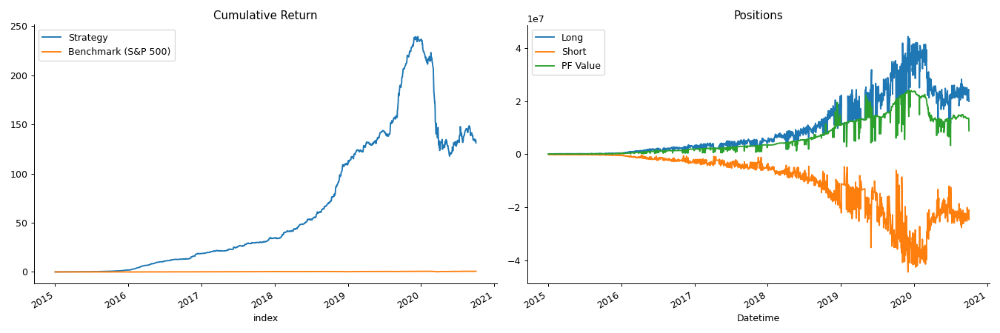

In [442]:
# Plotting returns vs S&P500
fig, axes = plt.subplots(ncols=2, figsize=(15, 5))

df = returns.to_frame('Strategy').join(benchmark.to_frame('Benchmark (S&P 500)'))
df.add(1).cumprod().sub(1).plot(ax=axes[0], title='Cumulative Return')

longs.plot(label='Long',ax=axes[1], title='Positions')
shorts.plot(ax=axes[1], label='Short')
positions.cash.plot(ax=axes[1], label='PF Value')
axes[1].legend()
sns.despine()
fig.tight_layout();

Start date,2015-01-02
End date,2020-10-01
Total months,68
,Backtest
Annual return,133.968%
Cumulative returns,13118.564%
Annual volatility,20.477%
Sharpe ratio,4.26
Calmar ratio,2.65
Stability,0.92
Max drawdown,-50.643%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,50.64,2019-12-16,2020-05-22,NaT,NaN
1,3.95,2019-06-24,2019-07-22,2019-07-31,28
2,3.19,2017-12-11,2018-01-12,2018-01-30,37
3,3.11,2015-01-05,2015-01-14,2015-01-22,14
4,2.97,2017-03-20,2017-03-27,2017-05-10,38


<IPython.core.display.Javascript object>


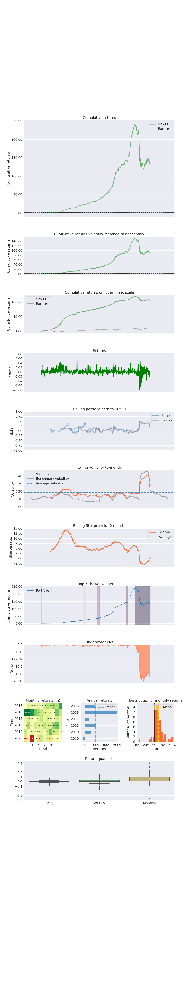

Stress Events,mean,min,max
Fall2015,0.51%,-2.70%,3.17%
New Normal,0.35%,-8.08%,7.68%


<IPython.core.display.Javascript object>


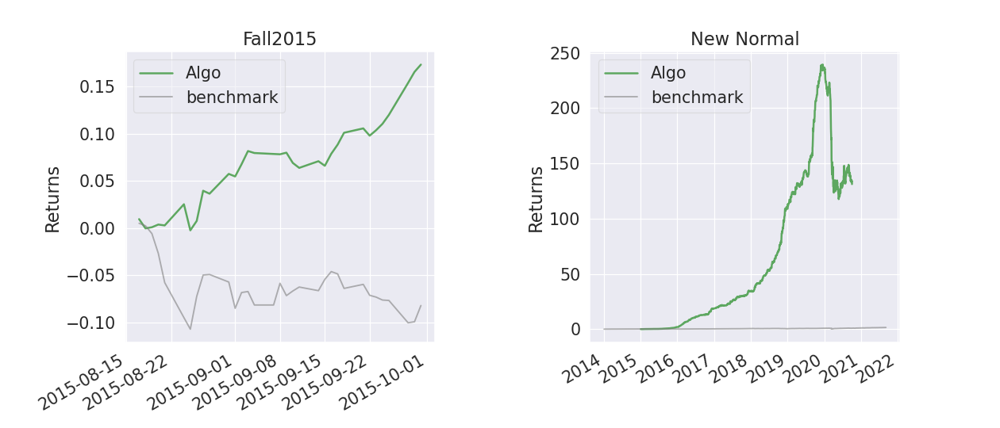

<IPython.core.display.Javascript object>


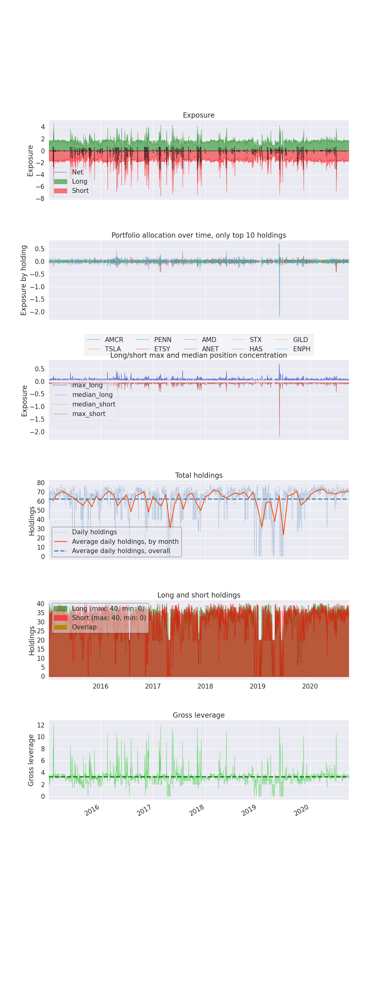

Top 10 long positions of all time,max
sid,
AMCR,70.30%
STX,40.56%
HAS,40.56%
ENPH,39.74%
IFF,35.13%
PRGO,34.47%
COP,33.67%
DXC,33.64%
NXPI,32.25%


Top 10 short positions of all time,max
sid,
AMCR,-218.08%
TSLA,-44.83%
PENN,-42.71%
ETSY,-42.09%
AMD,-41.70%
ANET,-41.42%
GILD,-39.97%
ALB,-39.69%
AKAM,-39.65%


Top 10 positions of all time,max
sid,
AMCR,218.08%
TSLA,44.83%
PENN,42.71%
ETSY,42.09%
AMD,41.70%
ANET,41.42%
STX,40.56%
HAS,40.56%
GILD,39.97%


<IPython.core.display.Javascript object>


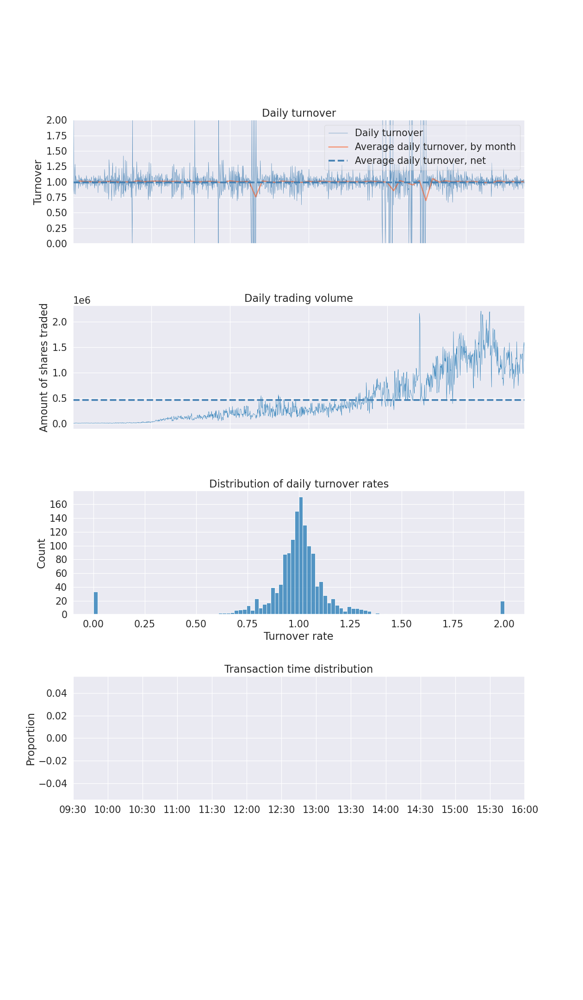

In [443]:
# Complete PyFolio evaluation
pf.create_full_tear_sheet(returns,
                          transactions=transactions,
                          positions=positions,
                          benchmark_rets=benchmark.dropna());

### Backtesting: CatBoost

In [5]:
# Initiating Cerebro
cerebro = bt.Cerebro()
cash = 100000
cerebro.broker.setcash(cash)

In [6]:
# Defining input
class SignalData(PandasData):
    
    cols = OHLCV + ['target1day','target5day','target10day','target21day','target42day','target63day']

    lines = tuple(cols)

    params = {c: -1 for c in cols}
    params.update({'datetime': None})
    params = tuple(params.items())

In [7]:
# Feeding data
data = pd.read_csv('./predictions/cat_preds.csv')
data.date = pd.to_datetime(data.date)
data.set_index(['ticker','date'], inplace=True)
tickers = data.index.get_level_values(0).unique()

for ticker in tickers:
    df = data.loc[idx[ticker,'2015-01-02':], :].droplevel('ticker', axis=0)
    df.index.name = 'datetime'
    bt_data = SignalData(dataname=df)
    cerebro.adddata(bt_data, name=ticker)

In [9]:
# Defining Strategy
class CatBoostStrategy(bt.Strategy):
    params = (('n_positions', 20),
              ('min_positions', 5),
              ('verbose', False))

    def log(self, txt, dt=None):
        print('%s | %s' % (self.datas[0].datetime.date(0).isoformat(), txt))
        
    def notify_trade(self, trade):
        if not trade.isclosed:
            return

        self.log(f'{trade.data._name}: OPERATION PROFIT {trade.pnl}')

    def notify_order(self, order):
        
        if order.status in [order.Submitted, order.Accepted]:
            return
        
        if self.p.verbose:
            if order.status in [order.Completed]:
                p = order.executed.price
                if order.isbuy():
                    self.log(f'{order.data._name}: BUY executed {p:.2f}')
                elif order.issell():
                    self.log(f'{order.data._name}: SELL executed {p:.2f}')

            elif order.status in [order.Canceled, order.Margin, order.Rejected]:
                self.log(f'{order.data._name}: Order Canceled/Margin/Rejected')

    def prenext(self):
        self.next()

    def next(self):
        today = self.datas[0].datetime.date()

        positions = [d._name for d, pos in self.getpositions().items() if pos]
        up, down = {}, {}
        missing = not_missing = 0
        for data in self.datas:
            if data.datetime.date() == today:
                if data.target1day[0] > 0:
                    if(data.target1day[0]+data.target5day[0]+data.target10day[0]+data.target21day[0]+data.target42day[0]+data.target63day[0] > 3):
                        up[data._name] = data.target1day[0]
                elif data.target1day[0] == 0:
                    if(data.target1day[0]+data.target5day[0]+data.target10day[0]+data.target21day[0]+data.target42day[0]+data.target63day[0] < 3):
                        down[data._name] = data.target1day[0]

        shorts = sorted(down, key=down.get)[:self.p.n_positions]
        longs = sorted(up, key=up.get, reverse=True)[:self.p.n_positions]
        n_shorts, n_longs = len(shorts), len(longs)
        
        if n_shorts < self.p.min_positions or n_longs < self.p.min_positions:
            longs, shorts = [], []
        for ticker in positions:
            if ticker not in longs + shorts:
                self.order_target_percent(data=ticker, target=0)
                self.log(f'{ticker}: TRADE CLOSING ORDER CREATED')

        short_target = -1 / max(self.p.n_positions, n_shorts)
        long_target = 1 / max(self.p.n_positions, n_longs)
        for ticker in shorts:
            self.order_target_percent(data=ticker, target=short_target)
            self.log(f'{ticker}: SHORT ORDER CREATED')
        for ticker in longs:
            self.order_target_percent(data=ticker, target=long_target)
            self.log(f'{ticker}: LONG ORDER CREATED')

In [10]:
# Backtesting
cerebro.addanalyzer(bt.analyzers.PyFolio, _name='pyfolio')
cerebro.addstrategy(CatBoostStrategy)
cerebro.addsizer(bt.sizers.FixedSize, stake=1000)
cerebro.broker.setcommission(0.001)
results = cerebro.run()
ending_value = cerebro.broker.getvalue()

print(f'Final Portfolio Value: {ending_value:,.2f}')

2015-01-02 | AAL: SHORT ORDER CREATED
2015-01-02 | BKR: SHORT ORDER CREATED
2015-01-02 | CF: SHORT ORDER CREATED
2015-01-02 | CVX: SHORT ORDER CREATED
2015-01-02 | EXC: SHORT ORDER CREATED
2015-01-02 | FE: SHORT ORDER CREATED
2015-01-02 | GM: SHORT ORDER CREATED
2015-01-02 | KMI: SHORT ORDER CREATED
2015-01-02 | LUV: SHORT ORDER CREATED
2015-01-02 | MGM: SHORT ORDER CREATED
2015-01-02 | PEG: SHORT ORDER CREATED
2015-01-02 | TPR: SHORT ORDER CREATED
2015-01-02 | UAL: SHORT ORDER CREATED
2015-01-02 | VRTX: SHORT ORDER CREATED
2015-01-02 | WEC: SHORT ORDER CREATED
2015-01-02 | XOM: SHORT ORDER CREATED
2015-01-02 | AAPL: LONG ORDER CREATED
2015-01-02 | AJG: LONG ORDER CREATED
2015-01-02 | AKAM: LONG ORDER CREATED
2015-01-02 | ANTM: LONG ORDER CREATED
2015-01-02 | AON: LONG ORDER CREATED
2015-01-02 | APA: LONG ORDER CREATED
2015-01-02 | ARE: LONG ORDER CREATED
2015-01-02 | AVB: LONG ORDER CREATED
2015-01-02 | BA: LONG ORDER CREATED
2015-01-02 | BF-B: LONG ORDER CREATED
2015-01-02 | BLK: LON

2015-01-08 | AAL: TRADE CLOSING ORDER CREATED
2015-01-08 | GM: TRADE CLOSING ORDER CREATED
2015-01-08 | AAPL: TRADE CLOSING ORDER CREATED
2015-01-08 | A: TRADE CLOSING ORDER CREATED
2015-01-08 | AAP: TRADE CLOSING ORDER CREATED
2015-01-08 | ABBV: TRADE CLOSING ORDER CREATED
2015-01-08 | ABC: TRADE CLOSING ORDER CREATED
2015-01-08 | ABMD: TRADE CLOSING ORDER CREATED
2015-01-08 | ABT: TRADE CLOSING ORDER CREATED
2015-01-08 | ACN: TRADE CLOSING ORDER CREATED
2015-01-08 | ADBE: TRADE CLOSING ORDER CREATED
2015-01-08 | ADI: TRADE CLOSING ORDER CREATED
2015-01-08 | ADP: TRADE CLOSING ORDER CREATED
2015-01-08 | ADSK: TRADE CLOSING ORDER CREATED
2015-01-08 | AEE: TRADE CLOSING ORDER CREATED
2015-01-08 | AEP: TRADE CLOSING ORDER CREATED
2015-01-08 | AES: TRADE CLOSING ORDER CREATED
2015-01-08 | AFL: TRADE CLOSING ORDER CREATED
2015-01-08 | AIG: TRADE CLOSING ORDER CREATED
2015-01-08 | AIZ: TRADE CLOSING ORDER CREATED
2015-01-08 | NEM: TRADE CLOSING ORDER CREATED
2015-01-08 | ARE: SHORT ORDER CR

2015-01-13 | AAPL: OPERATION PROFIT -51.71587099535009
2015-01-13 | AJG: OPERATION PROFIT 36.73608927971907
2015-01-13 | ANTM: OPERATION PROFIT -12.236485625230983
2015-01-13 | AON: OPERATION PROFIT -23.916573005947498
2015-01-13 | ARE: OPERATION PROFIT -47.04225616657459
2015-01-13 | BF-B: OPERATION PROFIT 28.26148986494841
2015-01-13 | AAP: OPERATION PROFIT -15.45906341362317
2015-01-13 | ADI: OPERATION PROFIT 6.323913591458208
2015-01-13 | ADP: OPERATION PROFIT 4.635190807906554
2015-01-13 | AMGN: OPERATION PROFIT 84.5936995805352
2015-01-13 | AMP: OPERATION PROFIT 23.673491331098234
2015-01-13 | APTV: OPERATION PROFIT -57.52836974126203
2015-01-13 | ATO: OPERATION PROFIT 19.70691876532854
2015-01-13 | AXP: OPERATION PROFIT -12.46386998295776
2015-01-13 | AZO: OPERATION PROFIT -59.68017578125
2015-01-13 | BEN: OPERATION PROFIT -87.38209406367642
2015-01-13 | EIX: OPERATION PROFIT -8.872382633355777
2015-01-13 | GILD: OPERATION PROFIT 81.16122762113037
2015-01-13 | PENN: OPERATION PR

2015-01-20 | CF: OPERATION PROFIT -211.47774370197436
2015-01-20 | CVX: OPERATION PROFIT -8.44356947827741
2015-01-20 | EXC: OPERATION PROFIT -38.440001563640145
2015-01-20 | KMI: OPERATION PROFIT -109.15445471572778
2015-01-20 | APA: OPERATION PROFIT -51.23329625380021
2015-01-20 | ACN: OPERATION PROFIT 61.864359168961116
2015-01-20 | ALGN: OPERATION PROFIT -341.6399383544922
2015-01-20 | AMD: OPERATION PROFIT -247.64976382255554
2015-01-20 | AMT: OPERATION PROFIT 86.25757634070953
2015-01-20 | COG: OPERATION PROFIT 210.83219854971372
2015-01-20 | DE: OPERATION PROFIT -28.620678130425986
2015-01-20 | DLR: OPERATION PROFIT -53.97014830184542
2015-01-20 | EOG: OPERATION PROFIT -4.7337223097765815
2015-01-20 | FANG: OPERATION PROFIT -235.7310866746634
2015-01-20 | NEM: OPERATION PROFIT -251.83862468012703
2015-01-20 | AAL: TRADE CLOSING ORDER CREATED
2015-01-20 | FE: TRADE CLOSING ORDER CREATED
2015-01-20 | ARE: TRADE CLOSING ORDER CREATED
2015-01-20 | BXP: TRADE CLOSING ORDER CREATED
20

2015-01-26 | BKR: OPERATION PROFIT -24.539746338284985
2015-01-26 | CF: OPERATION PROFIT 96.23264976434552
2015-01-26 | ANTM: OPERATION PROFIT 62.277112686683836
2015-01-26 | APA: OPERATION PROFIT 0.0006569197563521811
2015-01-26 | BA: OPERATION PROFIT 19.941100170984782
2015-01-26 | CBOE: OPERATION PROFIT 18.06225212866795
2015-01-26 | CHD: OPERATION PROFIT 59.57223133672951
2015-01-26 | ABBV: OPERATION PROFIT -207.49150180002403
2015-01-26 | AMZN: OPERATION PROFIT -56.100311279296875
2015-01-26 | BAC: OPERATION PROFIT 94.54131777006677
2015-01-26 | BIIB: OPERATION PROFIT -60.449920654296875
2015-01-26 | CBRE: OPERATION PROFIT -25.74004364013672
2015-01-26 | CCI: OPERATION PROFIT -82.73345615995468
2015-01-26 | COG: OPERATION PROFIT 44.79730747634697
2015-01-26 | DLTR: OPERATION PROFIT 108.5401840209961
2015-01-26 | ENPH: OPERATION PROFIT 350.73018169403076
2015-01-26 | FFIV: OPERATION PROFIT 58.800064086913466
2015-01-26 | IRM: OPERATION PROFIT 34.09012869547182
2015-01-26 | MPWR: OP

2015-01-30 | AJG: OPERATION PROFIT -4.196890547205335
2015-01-30 | AKAM: OPERATION PROFIT -114.27996063232399
2015-01-30 | A: OPERATION PROFIT 1.243288685075754
2015-01-30 | ABBV: OPERATION PROFIT -101.00206761786951
2015-01-30 | ABC: OPERATION PROFIT -33.94138960675711
2015-01-30 | ABT: OPERATION PROFIT 158.44084064112977
2015-01-30 | ADI: OPERATION PROFIT -93.20625115526934
2015-01-30 | ADM: OPERATION PROFIT 5.979813064049054
2015-01-30 | ADP: OPERATION PROFIT -27.117469330327367
2015-01-30 | AES: OPERATION PROFIT 15.00314429215823
2015-01-30 | AFL: OPERATION PROFIT -26.393723797204522
2015-01-30 | AIG: OPERATION PROFIT -45.12844278134719
2015-01-30 | AIZ: OPERATION PROFIT -24.26281368111031
2015-01-30 | HAS: OPERATION PROFIT -61.04078998790616
2015-01-30 | LEN: OPERATION PROFIT -98.22167177269893
2015-01-30 | MPC: OPERATION PROFIT 68.19837325879381
2015-01-30 | NEM: OPERATION PROFIT -113.1691725245073
2015-01-30 | NFLX: OPERATION PROFIT 5.3569793701171875
2015-01-30 | PSX: OPERATION

2015-02-05 | AAL: OPERATION PROFIT 92.64851775658332
2015-02-05 | CVX: OPERATION PROFIT -45.63794716417463
2015-02-05 | AAPL: OPERATION PROFIT 78.63369638894952
2015-02-05 | AJG: OPERATION PROFIT 31.745619844913904
2015-02-05 | AKAM: OPERATION PROFIT 9.359916687012273
2015-02-05 | APA: OPERATION PROFIT -90.78008409995952
2015-02-05 | AAP: OPERATION PROFIT 28.745441651019235
2015-02-05 | ABBV: OPERATION PROFIT -105.75498794072828
2015-02-05 | ABC: OPERATION PROFIT 31.39123591820939
2015-02-05 | ACN: OPERATION PROFIT -56.16302819417028
2015-02-05 | ADBE: OPERATION PROFIT 44.20001983642578
2015-02-05 | ADI: OPERATION PROFIT 13.768282574010016
2015-02-05 | ADP: OPERATION PROFIT -38.67975422818408
2015-02-05 | ADSK: OPERATION PROFIT 114.75019454956175
2015-02-05 | AEE: OPERATION PROFIT 43.223451029849514
2015-02-05 | AEP: OPERATION PROFIT 14.138821472088509
2015-02-05 | ALB: OPERATION PROFIT 13.221084544685162
2015-02-05 | ALGN: OPERATION PROFIT 32.30009078979492
2015-02-05 | ALK: OPERATION

2015-02-09 | FANG: SHORT ORDER CREATED
2015-02-09 | KR: SHORT ORDER CREATED
2015-02-09 | VZ: SHORT ORDER CREATED
2015-02-09 | XOM: SHORT ORDER CREATED
2015-02-09 | A: LONG ORDER CREATED
2015-02-09 | AAL: LONG ORDER CREATED
2015-02-09 | AAP: LONG ORDER CREATED
2015-02-09 | AAPL: LONG ORDER CREATED
2015-02-09 | ABBV: LONG ORDER CREATED
2015-02-09 | ABC: LONG ORDER CREATED
2015-02-09 | ABMD: LONG ORDER CREATED
2015-02-09 | ABT: LONG ORDER CREATED
2015-02-09 | ACN: LONG ORDER CREATED
2015-02-09 | ADBE: LONG ORDER CREATED
2015-02-09 | ADI: LONG ORDER CREATED
2015-02-09 | ADM: LONG ORDER CREATED
2015-02-09 | ADP: LONG ORDER CREATED
2015-02-09 | AES: LONG ORDER CREATED
2015-02-09 | AFL: LONG ORDER CREATED
2015-02-09 | AIG: LONG ORDER CREATED
2015-02-09 | AIZ: LONG ORDER CREATED
2015-02-09 | AJG: LONG ORDER CREATED
2015-02-09 | AKAM: LONG ORDER CREATED
2015-02-09 | ALB: LONG ORDER CREATED
2015-02-10 | BXP: OPERATION PROFIT -17.093514476505902
2015-02-10 | ADSK: OPERATION PROFIT 93.479949951171

2015-02-13 | BKR: OPERATION PROFIT -151.41075356116028
2015-02-13 | AAPL: OPERATION PROFIT 284.4923061128601
2015-02-13 | AKAM: OPERATION PROFIT 252.0000457763672
2015-02-13 | COP: OPERATION PROFIT -41.98573620787958
2015-02-13 | DVN: OPERATION PROFIT -80.75873928643306
2015-02-13 | ENPH: OPERATION PROFIT -6.480148315429112
2015-02-13 | EOG: OPERATION PROFIT -49.69695492612823
2015-02-13 | HAL: OPERATION PROFIT -95.64497573883547
2015-02-13 | PXD: OPERATION PROFIT -71.90224474797418
2015-02-13 | AAL: TRADE CLOSING ORDER CREATED
2015-02-13 | ABMD: TRADE CLOSING ORDER CREATED
2015-02-13 | ADM: TRADE CLOSING ORDER CREATED
2015-02-13 | ADP: TRADE CLOSING ORDER CREATED
2015-02-13 | CRM: TRADE CLOSING ORDER CREATED
2015-02-13 | FANG: TRADE CLOSING ORDER CREATED
2015-02-13 | LHX: TRADE CLOSING ORDER CREATED
2015-02-13 | MLM: TRADE CLOSING ORDER CREATED
2015-02-13 | MPC: TRADE CLOSING ORDER CREATED
2015-02-13 | MSI: TRADE CLOSING ORDER CREATED
2015-02-13 | NWS: TRADE CLOSING ORDER CREATED
2015

2015-02-19 | GM: OPERATION PROFIT 28.521285167526557
2015-02-19 | CHD: OPERATION PROFIT -34.72599764244588
2015-02-19 | CLX: OPERATION PROFIT -37.08333125849981
2015-02-19 | AES: OPERATION PROFIT 66.319873107674
2015-02-19 | ALGN: OPERATION PROFIT -39.839962005615234
2015-02-19 | ALK: OPERATION PROFIT 196.9102019202376
2015-02-19 | ALL: OPERATION PROFIT -55.80750409858784
2015-02-19 | ALLE: OPERATION PROFIT -231.70923664824872
2015-02-19 | AMAT: OPERATION PROFIT 3.700776879967975
2015-02-19 | AMGN: OPERATION PROFIT 54.2720799704542
2015-02-19 | AMP: OPERATION PROFIT -59.41452442148953
2015-02-19 | AMT: OPERATION PROFIT 3.5117030390890847
2015-02-19 | AMZN: OPERATION PROFIT -3.4801025390625
2015-02-19 | ANSS: OPERATION PROFIT -23.099899291992188
2015-02-19 | CCI: OPERATION PROFIT 24.455435701650288
2015-02-19 | DG: OPERATION PROFIT -48.30870604295802
2015-02-19 | ESS: OPERATION PROFIT -57.80770648124047
2015-02-19 | ETN: OPERATION PROFIT 18.033254363871414
2015-02-19 | FRT: OPERATION PR

2015-02-25 | ABT: OPERATION PROFIT 207.4249516646492
2015-02-25 | ADI: OPERATION PROFIT 106.32438266670886
2015-02-25 | AMAT: OPERATION PROFIT 48.648298716798955
2015-02-25 | CCI: OPERATION PROFIT 49.60103488447473
2015-02-25 | D: OPERATION PROFIT -33.92086790830245
2015-02-25 | DLR: OPERATION PROFIT 72.76012961215483
2015-02-25 | DLTR: OPERATION PROFIT 27.2801513671875
2015-02-25 | DRE: OPERATION PROFIT 60.28767473160826
2015-02-25 | ALK: OPERATION PROFIT -52.64729461218663
2015-02-25 | AAL: TRADE CLOSING ORDER CREATED
2015-02-25 | EXC: TRADE CLOSING ORDER CREATED
2015-02-25 | ARE: TRADE CLOSING ORDER CREATED
2015-02-25 | AVB: TRADE CLOSING ORDER CREATED
2015-02-25 | CHD: TRADE CLOSING ORDER CREATED
2015-02-25 | CLX: TRADE CLOSING ORDER CREATED
2015-02-25 | AEE: TRADE CLOSING ORDER CREATED
2015-02-25 | AEP: TRADE CLOSING ORDER CREATED
2015-02-25 | ALGN: TRADE CLOSING ORDER CREATED
2015-02-25 | ALK: TRADE CLOSING ORDER CREATED
2015-02-25 | ALL: TRADE CLOSING ORDER CREATED
2015-02-25 | 

2015-03-02 | AAL: TRADE CLOSING ORDER CREATED
2015-03-02 | EXC: TRADE CLOSING ORDER CREATED
2015-03-02 | WEC: TRADE CLOSING ORDER CREATED
2015-03-02 | AAPL: TRADE CLOSING ORDER CREATED
2015-03-02 | AJG: TRADE CLOSING ORDER CREATED
2015-03-02 | AKAM: TRADE CLOSING ORDER CREATED
2015-03-02 | A: TRADE CLOSING ORDER CREATED
2015-03-02 | AAP: TRADE CLOSING ORDER CREATED
2015-03-02 | ABBV: TRADE CLOSING ORDER CREATED
2015-03-02 | ABC: TRADE CLOSING ORDER CREATED
2015-03-02 | ABMD: TRADE CLOSING ORDER CREATED
2015-03-02 | ABT: TRADE CLOSING ORDER CREATED
2015-03-02 | AFL: TRADE CLOSING ORDER CREATED
2015-03-02 | AIZ: TRADE CLOSING ORDER CREATED
2015-03-02 | ALGN: TRADE CLOSING ORDER CREATED
2015-03-02 | DTE: TRADE CLOSING ORDER CREATED
2015-03-02 | ETR: TRADE CLOSING ORDER CREATED
2015-03-02 | EVRG: TRADE CLOSING ORDER CREATED
2015-03-02 | EXPD: TRADE CLOSING ORDER CREATED
2015-03-02 | LNT: TRADE CLOSING ORDER CREATED
2015-03-02 | NEE: TRADE CLOSING ORDER CREATED
2015-03-02 | SO: TRADE CLOSIN

2015-03-05 | MCHP: TRADE CLOSING ORDER CREATED
2015-03-06 | BKR: OPERATION PROFIT 40.85244227919823
2015-03-06 | CVX: OPERATION PROFIT 37.26052016269193
2015-03-06 | GM: OPERATION PROFIT 24.055311728040948
2015-03-06 | AAPL: OPERATION PROFIT -7.0052976149647606
2015-03-06 | AJG: OPERATION PROFIT -12.901697208267393
2015-03-06 | APA: OPERATION PROFIT 146.75124218995398
2015-03-06 | BA: OPERATION PROFIT 23.00373087858148
2015-03-06 | CAG: OPERATION PROFIT 4.355900384944977
2015-03-06 | A: OPERATION PROFIT -4.788878317428853
2015-03-06 | AAP: OPERATION PROFIT -3.655909776252088
2015-03-06 | ABBV: OPERATION PROFIT -21.60380275070331
2015-03-06 | ABC: OPERATION PROFIT -26.640253905557643
2015-03-06 | ABMD: OPERATION PROFIT 106.23989868164062
2015-03-06 | ABT: OPERATION PROFIT 32.027406962532254
2015-03-06 | ADBE: OPERATION PROFIT 37.76025390625
2015-03-06 | ADI: OPERATION PROFIT 104.25750124048159
2015-03-06 | ADM: OPERATION PROFIT -31.81243772820293
2015-03-06 | ADP: OPERATION PROFIT -15.0

2015-03-12 | CVX: OPERATION PROFIT -20.924337135427393
2015-03-12 | GM: OPERATION PROFIT -34.821846650984
2015-03-12 | AAPL: OPERATION PROFIT -98.28234254080942
2015-03-12 | AON: OPERATION PROFIT 59.43629274761361
2015-03-12 | CBOE: OPERATION PROFIT -51.45087028953044
2015-03-12 | A: OPERATION PROFIT 24.695493424393142
2015-03-12 | AAP: OPERATION PROFIT -3.0799958144801565
2015-03-12 | ABT: OPERATION PROFIT 8.681030535456237
2015-03-12 | ACN: OPERATION PROFIT -71.73900162409609
2015-03-12 | ADBE: OPERATION PROFIT 15.179718017578125
2015-03-12 | ADM: OPERATION PROFIT 13.21883640269418
2015-03-12 | ADP: OPERATION PROFIT 24.83963441293446
2015-03-12 | ADSK: OPERATION PROFIT 11.75994873046875
2015-03-12 | AEE: OPERATION PROFIT -61.855071750231886
2015-03-12 | AEP: OPERATION PROFIT -20.93586310706833
2015-03-12 | AES: OPERATION PROFIT -8.307043166053809
2015-03-12 | AFL: OPERATION PROFIT 52.02081161036364
2015-03-12 | ALK: OPERATION PROFIT 81.86052271545229
2015-03-12 | ALL: OPERATION PROFI

2015-03-19 | ARE: OPERATION PROFIT 66.05840717202358
2015-03-19 | AVB: OPERATION PROFIT 56.63558335527824
2015-03-19 | BA: OPERATION PROFIT -27.56527009395927
2015-03-19 | BF-B: OPERATION PROFIT 33.23876358645364
2015-03-19 | BXP: OPERATION PROFIT 138.13175343811355
2015-03-19 | CAH: OPERATION PROFIT 59.697001294343636
2015-03-19 | CINF: OPERATION PROFIT -48.68565560149119
2015-03-19 | ABC: OPERATION PROFIT -88.74812875004802
2015-03-19 | ADBE: OPERATION PROFIT -60.76020812988281
2015-03-19 | ADP: OPERATION PROFIT 43.05018723030983
2015-03-19 | ALK: OPERATION PROFIT -70.99914917533087
2015-03-19 | AMZN: OPERATION PROFIT 50.699920654296875
2015-03-19 | APH: OPERATION PROFIT -91.53058864923395
2015-03-19 | AWK: OPERATION PROFIT 71.13609553411148
2015-03-19 | BEN: OPERATION PROFIT 45.610187004367475
2015-03-19 | BK: OPERATION PROFIT 9.75732316958355
2015-03-19 | BKNG: OPERATION PROFIT 92.9599609375
2015-03-19 | BLL: OPERATION PROFIT 61.684906234178655
2015-03-19 | BMY: OPERATION PROFIT -5

2015-03-23 | BKR: OPERATION PROFIT -215.56321219811477
2015-03-23 | CF: OPERATION PROFIT -22.14847066210639
2015-03-23 | ANTM: OPERATION PROFIT -17.09933014867977
2015-03-23 | BF-B: OPERATION PROFIT 48.937632010286286
2015-03-23 | BLK: OPERATION PROFIT 93.41745471520312
2015-03-23 | BXP: OPERATION PROFIT 116.66530877339542
2015-03-23 | CHD: OPERATION PROFIT 23.332407297333702
2015-03-23 | CL: OPERATION PROFIT 72.26066989667157
2015-03-23 | CLX: OPERATION PROFIT 56.24420866692178
2015-03-23 | ADI: OPERATION PROFIT -191.34532549907038
2015-03-23 | ADP: OPERATION PROFIT -12.435918819868803
2015-03-23 | AEE: OPERATION PROFIT -22.41680786096729
2015-03-23 | AEP: OPERATION PROFIT -33.94343210726533
2015-03-23 | AMT: OPERATION PROFIT 191.17410000791665
2015-03-23 | AOS: OPERATION PROFIT 10.81349373112701
2015-03-23 | APTV: OPERATION PROFIT -35.61126078278711
2015-03-23 | ATO: OPERATION PROFIT -28.874417906308842
2015-03-23 | ATVI: OPERATION PROFIT -84.88462334686993
2015-03-23 | AVGO: OPERATI

2015-03-27 | KMI: OPERATION PROFIT 35.90770712840646
2015-03-27 | AAPL: OPERATION PROFIT 74.55331338941426
2015-03-27 | AJG: OPERATION PROFIT 34.954652449336464
2015-03-27 | AAP: OPERATION PROFIT 69.83762890444709
2015-03-27 | ABBV: OPERATION PROFIT -30.40506358027688
2015-03-27 | ABT: OPERATION PROFIT 21.880444686222575
2015-03-27 | ADBE: OPERATION PROFIT 20.01006317138672
2015-03-27 | ADM: OPERATION PROFIT -31.46718552859184
2015-03-27 | ADP: OPERATION PROFIT 4.799833688186894
2015-03-27 | ADSK: OPERATION PROFIT -4.249935150146484
2015-03-27 | AEP: OPERATION PROFIT -36.409859202814985
2015-03-27 | AFL: OPERATION PROFIT 19.305045605685464
2015-03-27 | AIG: OPERATION PROFIT 11.13978339398463
2015-03-27 | AIZ: OPERATION PROFIT 63.390056518627716
2015-03-27 | ALB: OPERATION PROFIT 192.98440141827783
2015-03-27 | ALGN: OPERATION PROFIT -111.32996749877975
2015-03-27 | ALK: OPERATION PROFIT 79.66827432052766
2015-03-27 | ALL: OPERATION PROFIT -8.579475432756979
2015-03-27 | EL: OPERATION P

2015-03-31 | AAPL: OPERATION PROFIT 85.42041811839053
2015-03-31 | AJG: OPERATION PROFIT 1.1009513981516648
2015-03-31 | AKAM: OPERATION PROFIT -11.520263671875
2015-03-31 | A: OPERATION PROFIT 88.5926129716911
2015-03-31 | AAP: OPERATION PROFIT -16.776056295966413
2015-03-31 | ABBV: OPERATION PROFIT 7.190552135544046
2015-03-31 | ABC: OPERATION PROFIT -12.808977653236624
2015-03-31 | ABT: OPERATION PROFIT -18.74845358983457
2015-03-31 | ADBE: OPERATION PROFIT -28.000106811523438
2015-03-31 | ADM: OPERATION PROFIT 33.29141551468389
2015-03-31 | ADP: OPERATION PROFIT 23.742547275631978
2015-03-31 | ADSK: OPERATION PROFIT -44.0
2015-03-31 | AEE: OPERATION PROFIT 77.4421394538926
2015-03-31 | AEP: OPERATION PROFIT 37.048714925675114
2015-03-31 | AES: OPERATION PROFIT 91.36367814408328
2015-03-31 | AFL: OPERATION PROFIT 7.316197564200628
2015-03-31 | AIG: OPERATION PROFIT 15.262171582087262
2015-03-31 | AIZ: OPERATION PROFIT 22.756662389899496
2015-03-31 | ALB: OPERATION PROFIT 32.12280869

2015-04-06 | AAPL: OPERATION PROFIT -14.575287954848108
2015-04-06 | ADBE: OPERATION PROFIT -2.720062255859375
2015-04-06 | ADI: OPERATION PROFIT -58.43142867003195
2015-04-06 | ADM: OPERATION PROFIT -11.934793096108109
2015-04-06 | AFL: OPERATION PROFIT -32.3439076356338
2015-04-06 | AIG: OPERATION PROFIT -14.052797899893505
2015-04-06 | AIZ: OPERATION PROFIT -15.17092908453239
2015-04-06 | ALB: OPERATION PROFIT 27.347022652934555
2015-04-06 | EA: OPERATION PROFIT 11.656363007810953
2015-04-06 | HAL: OPERATION PROFIT -58.50073693893441
2015-04-06 | KR: OPERATION PROFIT -10.033866423516294
2015-04-06 | NCLH: OPERATION PROFIT 26.32024383544855
2015-04-06 | TTWO: OPERATION PROFIT -6.210142135620117
2015-04-06 | TWTR: OPERATION PROFIT 62.22006225585865
2015-04-06 | WMB: OPERATION PROFIT -106.10516039385229
2015-04-06 | CHD: TRADE CLOSING ORDER CREATED
2015-04-06 | AEE: TRADE CLOSING ORDER CREATED
2015-04-06 | ALL: TRADE CLOSING ORDER CREATED
2015-04-06 | AMAT: TRADE CLOSING ORDER CREATED


2015-04-09 | CVX: OPERATION PROFIT 97.15941688221973
2015-04-09 | AKAM: OPERATION PROFIT 98.54988861083984
2015-04-09 | APA: OPERATION PROFIT -301.44739346000995
2015-04-09 | A: OPERATION PROFIT 84.75087337822342
2015-04-09 | ABBV: OPERATION PROFIT 213.5945404811708
2015-04-09 | ABC: OPERATION PROFIT 60.38571144264154
2015-04-09 | ABMD: OPERATION PROFIT -54.02040100097656
2015-04-09 | ADBE: OPERATION PROFIT -30.209793090819858
2015-04-09 | ADM: OPERATION PROFIT -2.1387234280650347
2015-04-09 | ADSK: OPERATION PROFIT 390.26985549926695
2015-04-09 | ALK: OPERATION PROFIT 231.0152812983638
2015-04-09 | CCL: OPERATION PROFIT 51.72345340558582
2015-04-09 | CMCSA: OPERATION PROFIT -89.49666964600165
2015-04-09 | COP: OPERATION PROFIT 81.67353143629066
2015-04-09 | DISCA: OPERATION PROFIT 6.2395477294921875
2015-04-09 | DVN: OPERATION PROFIT -57.36753972394113
2015-04-09 | EOG: OPERATION PROFIT 48.897968846638946
2015-04-09 | HAL: OPERATION PROFIT 18.4346613175358
2015-04-09 | HES: OPERATION 

2015-04-14 | ANTM: OPERATION PROFIT 4.938220585977092
2015-04-14 | AON: OPERATION PROFIT 8.341781507041901
2015-04-14 | CAG: OPERATION PROFIT 10.928651796017334
2015-04-14 | CHD: OPERATION PROFIT 1.2033997590029344
2015-04-14 | CL: OPERATION PROFIT 22.93251924222143
2015-04-14 | AAP: OPERATION PROFIT -41.080089249097824
2015-04-14 | ADI: OPERATION PROFIT -25.244360828574315
2015-04-14 | ADM: OPERATION PROFIT -5.384808175065736
2015-04-14 | AEE: OPERATION PROFIT 29.504953765406455
2015-04-14 | AMAT: OPERATION PROFIT -52.91594232818658
2015-04-14 | AMP: OPERATION PROFIT -84.93133205125541
2015-04-14 | ANSS: OPERATION PROFIT -60.32005310058594
2015-04-14 | AOS: OPERATION PROFIT -11.925070466679788
2015-04-14 | APD: OPERATION PROFIT 18.067746966134564
2015-04-14 | APH: OPERATION PROFIT -42.681093365452654
2015-04-14 | APTV: OPERATION PROFIT -42.60871554356878
2015-04-14 | ATVI: OPERATION PROFIT 24.636920085988944
2015-04-14 | AXP: OPERATION PROFIT 11.744430436461585
2015-04-14 | AZO: OPERA

2015-04-17 | ANSS: TRADE CLOSING ORDER CREATED
2015-04-17 | ATVI: TRADE CLOSING ORDER CREATED
2015-04-17 | CMCSA: TRADE CLOSING ORDER CREATED
2015-04-17 | CNP: TRADE CLOSING ORDER CREATED
2015-04-17 | CSCO: TRADE CLOSING ORDER CREATED
2015-04-17 | DAL: TRADE CLOSING ORDER CREATED
2015-04-17 | DISCK: TRADE CLOSING ORDER CREATED
2015-04-17 | DOV: TRADE CLOSING ORDER CREATED
2015-04-17 | DVN: TRADE CLOSING ORDER CREATED
2015-04-17 | ADM: SHORT ORDER CREATED
2015-04-17 | ALB: SHORT ORDER CREATED
2015-04-17 | AMT: SHORT ORDER CREATED
2015-04-17 | APA: SHORT ORDER CREATED
2015-04-17 | APTV: SHORT ORDER CREATED
2015-04-17 | BF-B: SHORT ORDER CREATED
2015-04-17 | BKR: SHORT ORDER CREATED
2015-04-17 | BWA: SHORT ORDER CREATED
2015-04-17 | CBRE: SHORT ORDER CREATED
2015-04-17 | CCL: SHORT ORDER CREATED
2015-04-17 | CE: SHORT ORDER CREATED
2015-04-17 | CL: SHORT ORDER CREATED
2015-04-17 | COG: SHORT ORDER CREATED
2015-04-17 | COP: SHORT ORDER CREATED
2015-04-17 | CPB: SHORT ORDER CREATED
2015-04-

2015-04-23 | AAL: OPERATION PROFIT 32.58481134384334
2015-04-23 | AKAM: OPERATION PROFIT 272.539794921875
2015-04-23 | ABMD: OPERATION PROFIT -35.78968048095675
2015-04-23 | ADI: OPERATION PROFIT -134.01593688213072
2015-04-23 | ALK: OPERATION PROFIT 100.57079727704306
2015-04-23 | ATVI: OPERATION PROFIT -2.183577860470564
2015-04-23 | DAL: OPERATION PROFIT -40.71362346976946
2015-04-23 | DLR: OPERATION PROFIT 24.401654493301976
2015-04-23 | FANG: OPERATION PROFIT 114.10300624124204
2015-04-23 | FCX: OPERATION PROFIT 183.224751470033
2015-04-23 | HST: OPERATION PROFIT 2.487972515001996
2015-04-23 | IDXX: OPERATION PROFIT 22.425079345703125
2015-04-23 | KMB: OPERATION PROFIT 74.82813328646095
2015-04-23 | LYB: OPERATION PROFIT -21.195323910545945
2015-04-23 | MAA: OPERATION PROFIT -57.147279001168386
2015-04-23 | NFLX: OPERATION PROFIT 35.00971984863281
2015-04-23 | PCAR: OPERATION PROFIT 7.170246408350067e-05
2015-04-23 | PM: OPERATION PROFIT 53.88553079532264
2015-04-23 | TMUS: OPERAT

2015-04-27 | APD: TRADE CLOSING ORDER CREATED
2015-04-27 | APH: TRADE CLOSING ORDER CREATED
2015-04-27 | ATO: TRADE CLOSING ORDER CREATED
2015-04-27 | AVGO: TRADE CLOSING ORDER CREATED
2015-04-27 | AWK: TRADE CLOSING ORDER CREATED
2015-04-27 | CBRE: TRADE CLOSING ORDER CREATED
2015-04-27 | CE: TRADE CLOSING ORDER CREATED
2015-04-27 | AAL: SHORT ORDER CREATED
2015-04-27 | ADM: SHORT ORDER CREATED
2015-04-27 | ALGN: SHORT ORDER CREATED
2015-04-27 | APTV: SHORT ORDER CREATED
2015-04-27 | ATVI: SHORT ORDER CREATED
2015-04-27 | BWA: SHORT ORDER CREATED
2015-04-27 | COG: SHORT ORDER CREATED
2015-04-27 | DAL: SHORT ORDER CREATED
2015-04-27 | DD: SHORT ORDER CREATED
2015-04-27 | DG: SHORT ORDER CREATED
2015-04-27 | DVN: SHORT ORDER CREATED
2015-04-27 | EA: SHORT ORDER CREATED
2015-04-27 | EBAY: SHORT ORDER CREATED
2015-04-27 | EQIX: SHORT ORDER CREATED
2015-04-27 | EQR: SHORT ORDER CREATED
2015-04-27 | EXPE: SHORT ORDER CREATED
2015-04-27 | FCX: SHORT ORDER CREATED
2015-04-27 | GPS: SHORT ORDE

2015-05-04 | AAL: OPERATION PROFIT -100.4657553765187
2015-05-04 | FE: OPERATION PROFIT -28.979486886068813
2015-05-04 | AKAM: OPERATION PROFIT -136.1598815917967
2015-05-04 | AAP: OPERATION PROFIT -278.92875981005363
2015-05-04 | ABBV: OPERATION PROFIT -58.647094372167174
2015-05-04 | ADBE: OPERATION PROFIT 9.099960327148438
2015-05-04 | ADI: OPERATION PROFIT 102.0152817025845
2015-05-04 | AIG: OPERATION PROFIT 35.58039229945436
2015-05-04 | ALB: OPERATION PROFIT 45.261667467233806
2015-05-04 | ALL: OPERATION PROFIT -114.2516466958771
2015-05-04 | EQIX: OPERATION PROFIT -98.31232868114674
2015-05-04 | F: OPERATION PROFIT 49.95101158351159
2015-05-04 | FANG: OPERATION PROFIT 104.92308656576733
2015-05-04 | HAL: OPERATION PROFIT 1.6487775876829573
2015-05-04 | JNPR: OPERATION PROFIT -37.57436802604812
2015-05-04 | LYB: OPERATION PROFIT -20.846821894920197
2015-05-04 | MRO: OPERATION PROFIT 25.454125849864397
2015-05-04 | NEM: OPERATION PROFIT -91.76362198466185
2015-05-04 | NFLX: OPERAT

2015-05-08 | AAL: OPERATION PROFIT 116.8464335193446
2015-05-08 | BKR: OPERATION PROFIT 175.71336803926485
2015-05-08 | KMI: OPERATION PROFIT -37.43535201736084
2015-05-08 | AJG: OPERATION PROFIT 17.985371554479784
2015-05-08 | APA: OPERATION PROFIT 68.73649957014536
2015-05-08 | AAP: OPERATION PROFIT 39.02736109995345
2015-05-08 | ABBV: OPERATION PROFIT 76.91356067927677
2015-05-08 | ABMD: OPERATION PROFIT 526.8799362182617
2015-05-08 | ACN: OPERATION PROFIT 101.32227338549093
2015-05-08 | AEP: OPERATION PROFIT 28.89057009578835
2015-05-08 | AIG: OPERATION PROFIT 91.17570797642905
2015-05-08 | AIZ: OPERATION PROFIT 40.983164738009265
2015-05-08 | COG: OPERATION PROFIT -12.404497807550865
2015-05-08 | COP: OPERATION PROFIT 22.771858204532975
2015-05-08 | DVN: OPERATION PROFIT 173.50643744504498
2015-05-08 | EOG: OPERATION PROFIT 85.23425595079772
2015-05-08 | FANG: OPERATION PROFIT 222.08052174387515
2015-05-08 | FCX: OPERATION PROFIT 81.39728928254799
2015-05-08 | HAL: OPERATION PROFI

2015-05-14 | AAL: OPERATION PROFIT -17.932891287315506
2015-05-14 | ADM: OPERATION PROFIT -170.5359240758268
2015-05-14 | ADP: OPERATION PROFIT 18.647157626609925
2015-05-14 | AES: OPERATION PROFIT 83.76969624329719
2015-05-14 | ALL: OPERATION PROFIT -88.81438011193717
2015-05-14 | ATVI: OPERATION PROFIT -30.57256474249398
2015-05-14 | CAT: OPERATION PROFIT -57.66219964072077
2015-05-14 | CMG: OPERATION PROFIT -0.210205078125
2015-05-14 | DISCA: OPERATION PROFIT 77.41996383666935
2015-05-14 | DISCK: OPERATION PROFIT 53.3202362060553
2015-05-14 | DLR: OPERATION PROFIT -14.154176868860581
2015-05-14 | EL: OPERATION PROFIT -22.574451514429086
2015-05-14 | ETN: OPERATION PROFIT -92.183316044555
2015-05-14 | HST: OPERATION PROFIT 20.157026751094385
2015-05-14 | LYB: OPERATION PROFIT -74.8828877720637
2015-05-14 | BKR: TRADE CLOSING ORDER CREATED
2015-05-14 | CVX: TRADE CLOSING ORDER CREATED
2015-05-14 | KMI: TRADE CLOSING ORDER CREATED
2015-05-14 | AJG: TRADE CLOSING ORDER CREATED
2015-05-1

2015-05-18 | CAH: TRADE CLOSING ORDER CREATED
2015-05-18 | AAP: TRADE CLOSING ORDER CREATED
2015-05-18 | ABBV: TRADE CLOSING ORDER CREATED
2015-05-18 | ABT: TRADE CLOSING ORDER CREATED
2015-05-18 | ADM: TRADE CLOSING ORDER CREATED
2015-05-18 | ADSK: TRADE CLOSING ORDER CREATED
2015-05-18 | ALB: TRADE CLOSING ORDER CREATED
2015-05-18 | ALGN: TRADE CLOSING ORDER CREATED
2015-05-18 | ANSS: TRADE CLOSING ORDER CREATED
2015-05-18 | APH: TRADE CLOSING ORDER CREATED
2015-05-18 | APTV: TRADE CLOSING ORDER CREATED
2015-05-18 | AVY: TRADE CLOSING ORDER CREATED
2015-05-18 | CI: TRADE CLOSING ORDER CREATED
2015-05-18 | CMCSA: TRADE CLOSING ORDER CREATED
2015-05-18 | CRL: TRADE CLOSING ORDER CREATED
2015-05-18 | DAL: TRADE CLOSING ORDER CREATED
2015-05-18 | DPZ: TRADE CLOSING ORDER CREATED
2015-05-18 | DVA: TRADE CLOSING ORDER CREATED
2015-05-18 | DXCM: TRADE CLOSING ORDER CREATED
2015-05-18 | AAPL: SHORT ORDER CREATED
2015-05-18 | ADBE: SHORT ORDER CREATED
2015-05-18 | AEE: SHORT ORDER CREATED
201

2015-05-21 | ANTM: OPERATION PROFIT -45.07954350636584
2015-05-21 | ARE: OPERATION PROFIT -14.065663673423998
2015-05-21 | AVB: OPERATION PROFIT -5.429088184790459
2015-05-21 | BXP: OPERATION PROFIT 7.068133114653946
2015-05-21 | CHD: OPERATION PROFIT -6.693812160091866
2015-05-21 | CLX: OPERATION PROFIT 12.00169618760313
2015-05-21 | ADBE: OPERATION PROFIT -1.949920654296875
2015-05-21 | ADP: OPERATION PROFIT -26.022754622870934
2015-05-21 | AEE: OPERATION PROFIT -41.77177165040226
2015-05-21 | AEP: OPERATION PROFIT -28.608621076828094
2015-05-21 | AES: OPERATION PROFIT 15.219789592357316
2015-05-21 | AMAT: OPERATION PROFIT -31.03542122885528
2015-05-21 | AME: OPERATION PROFIT -2.8173709760002907
2015-05-21 | AMGN: OPERATION PROFIT 7.790310649156197
2015-05-21 | AMT: OPERATION PROFIT 20.49048810317413
2015-05-21 | AMZN: OPERATION PROFIT 37.56005859375
2015-05-21 | ANSS: OPERATION PROFIT -8.550086975097656
2015-05-21 | APH: OPERATION PROFIT 37.37539713835719
2015-05-21 | ATVI: OPERATIO

2015-05-26 | CF: OPERATION PROFIT 3.5465604021483514
2015-05-26 | BA: OPERATION PROFIT 100.86121484323462
2015-05-26 | CHD: OPERATION PROFIT 14.496385619082332
2015-05-26 | CINF: OPERATION PROFIT -56.673820090073264
2015-05-26 | CL: OPERATION PROFIT 34.9643482705537
2015-05-26 | CLX: OPERATION PROFIT -5.539073339506672
2015-05-26 | ALB: OPERATION PROFIT 67.5541003362288
2015-05-26 | APD: OPERATION PROFIT 51.0359206399918
2015-05-26 | APH: OPERATION PROFIT 36.29109317224659
2015-05-26 | AVGO: OPERATION PROFIT 176.91531217580828
2015-05-26 | AZO: OPERATION PROFIT -27.2301025390625
2015-05-26 | BAX: OPERATION PROFIT -7.561259258841702
2015-05-26 | BKNG: OPERATION PROFIT 27.52001953125
2015-05-26 | BLL: OPERATION PROFIT 1.4141009986553144
2015-05-26 | BWA: OPERATION PROFIT 58.68254583131312
2015-05-26 | CAT: OPERATION PROFIT 60.189357874448376
2015-05-26 | CERN: OPERATION PROFIT 18.034829047898782
2015-05-26 | CHRW: OPERATION PROFIT -54.80046566272097
2015-05-26 | CHTR: OPERATION PROFIT -7

2015-05-28 | ADP: OPERATION PROFIT 24.24815673395483
2015-05-28 | AEE: OPERATION PROFIT 33.86058043034001
2015-05-28 | AEP: OPERATION PROFIT -37.677101401247285
2015-05-28 | AES: OPERATION PROFIT 109.53050739086275
2015-05-28 | ALB: OPERATION PROFIT 12.479721088804467
2015-05-28 | ATO: OPERATION PROFIT -10.474554778593728
2015-05-28 | CMS: OPERATION PROFIT 2.9845528221831685
2015-05-28 | CNP: OPERATION PROFIT 12.517096845086561
2015-05-28 | D: OPERATION PROFIT 5.740386091265009
2015-05-28 | DISCA: OPERATION PROFIT -29.259788513183594
2015-05-28 | DISCK: OPERATION PROFIT -74.69981002807617
2015-05-28 | DISH: OPERATION PROFIT -55.48015594482422
2015-05-28 | DLR: OPERATION PROFIT -2.2869960833081677
2015-05-28 | DRE: OPERATION PROFIT -54.398356045148375
2015-05-28 | DTE: OPERATION PROFIT 5.7706430602205785
2015-05-28 | DUK: OPERATION PROFIT -12.647938236365285
2015-05-28 | ED: OPERATION PROFIT -25.814833800236023
2015-05-28 | BKR: TRADE CLOSING ORDER CREATED
2015-05-28 | CVX: TRADE CLOSIN

2015-05-29 | DVA: LONG ORDER CREATED
2015-05-29 | ENPH: LONG ORDER CREATED
2015-06-01 | BF-B: OPERATION PROFIT 9.356693587344012
2015-06-01 | CL: OPERATION PROFIT -37.63004041414481
2015-06-01 | ABC: OPERATION PROFIT -106.14609402636361
2015-06-01 | ADI: OPERATION PROFIT 6.668870032684637
2015-06-01 | ADM: OPERATION PROFIT 7.734150915446719
2015-06-01 | ADP: OPERATION PROFIT 15.37829995379741
2015-06-01 | AMZN: OPERATION PROFIT 34.86981201171875
2015-06-01 | APD: OPERATION PROFIT 6.851435393570512
2015-06-01 | ATVI: OPERATION PROFIT 89.17831829585712
2015-06-01 | AVGO: OPERATION PROFIT -146.8842655552499
2015-06-01 | BIO: OPERATION PROFIT 44.799957275390625
2015-06-01 | BLL: OPERATION PROFIT 36.869759848811725
2015-06-01 | BWA: OPERATION PROFIT 2.512278305955192
2015-06-01 | CBRE: OPERATION PROFIT -1.3297767639160156
2015-06-01 | CHRW: OPERATION PROFIT 25.155049612170828
2015-06-01 | CMCSA: OPERATION PROFIT 32.73087409450757
2015-06-01 | CMG: OPERATION PROFIT 103.919921875
2015-06-01 |

2015-06-03 | AAPL: OPERATION PROFIT -31.0781825032322
2015-06-03 | BF-B: OPERATION PROFIT 50.194742381493114
2015-06-03 | BLK: OPERATION PROFIT 21.702853595104898
2015-06-03 | CL: OPERATION PROFIT -5.266507692706348
2015-06-03 | CLX: OPERATION PROFIT -45.13157058526183
2015-06-03 | ABBV: OPERATION PROFIT -15.0808467984306
2015-06-03 | ACN: OPERATION PROFIT -42.24227430160357
2015-06-03 | ADBE: OPERATION PROFIT -14.490211486816406
2015-06-03 | ADI: OPERATION PROFIT 44.6560655949817
2015-06-03 | ADP: OPERATION PROFIT -59.14091407862304
2015-06-03 | AEP: OPERATION PROFIT 102.92496055279491
2015-06-03 | AIG: OPERATION PROFIT 80.85391382406814
2015-06-03 | AIZ: OPERATION PROFIT -23.809317504858996
2015-06-03 | ALLE: OPERATION PROFIT -30.01893366860307
2015-06-03 | AMAT: OPERATION PROFIT -67.36141205058433
2015-06-03 | AMD: OPERATION PROFIT -68.3099348545079
2015-06-03 | AME: OPERATION PROFIT -50.706014692262414
2015-06-03 | AMZN: OPERATION PROFIT -47.62985229492125
2015-06-03 | ANSS: OPERAT

2015-06-08 | KMI: TRADE CLOSING ORDER CREATED
2015-06-08 | BLK: TRADE CLOSING ORDER CREATED
2015-06-08 | ADI: TRADE CLOSING ORDER CREATED
2015-06-08 | ADP: TRADE CLOSING ORDER CREATED
2015-06-08 | ALLE: TRADE CLOSING ORDER CREATED
2015-06-08 | AMT: TRADE CLOSING ORDER CREATED
2015-06-08 | ATVI: TRADE CLOSING ORDER CREATED
2015-06-08 | BKNG: TRADE CLOSING ORDER CREATED
2015-06-08 | COO: TRADE CLOSING ORDER CREATED
2015-06-08 | INTC: TRADE CLOSING ORDER CREATED
2015-06-08 | IRM: TRADE CLOSING ORDER CREATED
2015-06-08 | MLM: TRADE CLOSING ORDER CREATED
2015-06-08 | PM: TRADE CLOSING ORDER CREATED
2015-06-08 | TAP: TRADE CLOSING ORDER CREATED
2015-06-08 | URI: TRADE CLOSING ORDER CREATED
2015-06-08 | VZ: TRADE CLOSING ORDER CREATED
2015-06-08 | WYNN: TRADE CLOSING ORDER CREATED
2015-06-08 | ABBV: SHORT ORDER CREATED
2015-06-08 | ACN: SHORT ORDER CREATED
2015-06-08 | ADBE: SHORT ORDER CREATED
2015-06-08 | ADSK: SHORT ORDER CREATED
2015-06-08 | AIG: SHORT ORDER CREATED
2015-06-08 | AIZ: SHOR

2015-06-12 | BKR: OPERATION PROFIT 105.18531691776914
2015-06-12 | CVX: OPERATION PROFIT 66.34788939338662
2015-06-12 | KMI: OPERATION PROFIT 157.7282712687804
2015-06-12 | AJG: OPERATION PROFIT 98.40120524125874
2015-06-12 | ANTM: OPERATION PROFIT -36.956542903682305
2015-06-12 | APA: OPERATION PROFIT 94.55606971604189
2015-06-12 | ARE: OPERATION PROFIT 39.58927923824626
2015-06-12 | AVB: OPERATION PROFIT 19.81973597038865
2015-06-12 | A: OPERATION PROFIT -8.570664306949276
2015-06-12 | AAP: OPERATION PROFIT 125.56454813421823
2015-06-12 | ABC: OPERATION PROFIT 11.924888261606597
2015-06-12 | ABMD: OPERATION PROFIT 7.260250091552919
2015-06-12 | ABT: OPERATION PROFIT 57.55377653236202
2015-06-12 | ADM: OPERATION PROFIT 70.35791495070104
2015-06-12 | AEE: OPERATION PROFIT 21.350709606133478
2015-06-12 | AEP: OPERATION PROFIT -41.498213283795664
2015-06-12 | ALK: OPERATION PROFIT -10.891190694772419
2015-06-12 | AMD: OPERATION PROFIT -65.15993785858154
2015-06-12 | AMGN: OPERATION PROFI

2015-06-18 | CBOE: OPERATION PROFIT 24.707719739243828
2015-06-18 | ABC: OPERATION PROFIT 37.608305059873516
2015-06-18 | ABMD: OPERATION PROFIT 46.01971435546875
2015-06-18 | AEP: OPERATION PROFIT 53.266663512499605
2015-06-18 | AES: OPERATION PROFIT 22.42465645446002
2015-06-18 | ALK: OPERATION PROFIT 37.23971473001785
2015-06-18 | AMT: OPERATION PROFIT 59.598553236385214
2015-06-18 | APTV: OPERATION PROFIT 65.42699571345715
2015-06-18 | ATO: OPERATION PROFIT 94.69330481366651
2015-06-18 | AXP: OPERATION PROFIT 38.059617490666824
2015-06-18 | CCI: OPERATION PROFIT -66.15210717195694
2015-06-18 | CHRW: OPERATION PROFIT -29.247444059793196
2015-06-18 | CI: OPERATION PROFIT -46.74682331337479
2015-06-18 | CMA: OPERATION PROFIT 53.31800655344506
2015-06-18 | CNC: OPERATION PROFIT 53.1201171875
2015-06-18 | COF: OPERATION PROFIT 18.83998197807523
2015-06-18 | CTXS: OPERATION PROFIT 16.462675253811945
2015-06-18 | FTNT: OPERATION PROFIT -94.0101089477539
2015-06-18 | NOW: OPERATION PROFIT 

2015-06-25 | BF-B: OPERATION PROFIT -60.894895596670665
2015-06-25 | BXP: OPERATION PROFIT -61.900189745946236
2015-06-25 | CAH: OPERATION PROFIT -101.72212800800264
2015-06-25 | CHD: OPERATION PROFIT -34.69060806297445
2015-06-25 | CL: OPERATION PROFIT -31.609861062022084
2015-06-25 | A: OPERATION PROFIT 42.40868067652144
2015-06-25 | ABT: OPERATION PROFIT 31.61446259382057
2015-06-25 | ADBE: OPERATION PROFIT -241.1799774169922
2015-06-25 | AFL: OPERATION PROFIT 29.943992860010468
2015-06-25 | ALK: OPERATION PROFIT -83.80613294186956
2015-06-25 | ANSS: OPERATION PROFIT 20.900268554685937
2015-06-25 | AXP: OPERATION PROFIT -3.126076484312648
2015-06-25 | BIIB: OPERATION PROFIT 30.119750976563182
2015-06-25 | BIO: OPERATION PROFIT -12.579833984375
2015-06-25 | BK: OPERATION PROFIT -8.147595041622566
2015-06-25 | BKNG: OPERATION PROFIT 0.919921875
2015-06-25 | CERN: OPERATION PROFIT 49.832237667606904
2015-06-25 | CMCSA: OPERATION PROFIT 10.908308642945343
2015-06-25 | CME: OPERATION PRO

2015-07-01 | BKR: OPERATION PROFIT -11.659509020242496
2015-07-01 | CVX: OPERATION PROFIT 60.867660383741935
2015-07-01 | AKAM: OPERATION PROFIT 34.78009033203125
2015-07-01 | APA: OPERATION PROFIT 13.304715583950184
2015-07-01 | ABT: OPERATION PROFIT -11.411667158949541
2015-07-01 | ADBE: OPERATION PROFIT 39.06017303466797
2015-07-01 | AFL: OPERATION PROFIT 94.71212300698556
2015-07-01 | AIG: OPERATION PROFIT 43.04521015581836
2015-07-01 | AIZ: OPERATION PROFIT 30.722337646755705
2015-07-01 | AMAT: OPERATION PROFIT -15.956349840105883
2015-07-01 | AME: OPERATION PROFIT -33.860660237096866
2015-07-01 | ANET: OPERATION PROFIT -37.799903869628906
2015-07-01 | ANSS: OPERATION PROFIT -29.679931640624204
2015-07-01 | CDNS: OPERATION PROFIT -47.16007995605469
2015-07-01 | CNC: OPERATION PROFIT -0.6346511840829336
2015-07-01 | COO: OPERATION PROFIT -12.738669460252737
2015-07-01 | COP: OPERATION PROFIT 1.6743179934522345
2015-07-01 | CPRT: OPERATION PROFIT -50.57477951049805
2015-07-01 | CTXS

2015-07-07 | AAPL: OPERATION PROFIT -38.64206046813225
2015-07-07 | APA: OPERATION PROFIT 45.226669370443304
2015-07-07 | BF-B: OPERATION PROFIT 24.507327378692878
2015-07-07 | BXP: OPERATION PROFIT 83.83338869448522
2015-07-07 | CAG: OPERATION PROFIT 52.923257962006396
2015-07-07 | CBOE: OPERATION PROFIT 130.09459134352966
2015-07-07 | CHD: OPERATION PROFIT 3.13446204044552
2015-07-07 | A: OPERATION PROFIT -54.50815364810734
2015-07-07 | ABMD: OPERATION PROFIT 35.230094909667514
2015-07-07 | AFL: OPERATION PROFIT -27.416909260140255
2015-07-07 | AIZ: OPERATION PROFIT -43.76953150194524
2015-07-07 | ALGN: OPERATION PROFIT 5.669975280761719
2015-07-07 | ALL: OPERATION PROFIT -38.66089248282064
2015-07-07 | AMAT: OPERATION PROFIT 83.7749779056618
2015-07-07 | AME: OPERATION PROFIT 47.91103308561151
2015-07-07 | AMZN: OPERATION PROFIT -4.949798583985
2015-07-07 | ANET: OPERATION PROFIT 73.7801513671875
2015-07-07 | AOS: OPERATION PROFIT 73.40531509602648
2015-07-07 | ATVI: OPERATION PROFI

2015-07-10 | AAL: OPERATION PROFIT 89.23729940696177
2015-07-10 | AMAT: OPERATION PROFIT 25.495387923787582
2015-07-10 | AMP: OPERATION PROFIT -79.6546665000264
2015-07-10 | AVY: OPERATION PROFIT -8.620771716559915
2015-07-10 | DXCM: OPERATION PROFIT -57.419677734375
2015-07-10 | ENPH: OPERATION PROFIT 245.62996768951416
2015-07-10 | HCA: OPERATION PROFIT -61.55243078437705
2015-07-10 | HES: OPERATION PROFIT 55.188667017548724
2015-07-10 | LEN: OPERATION PROFIT -35.0244270691978
2015-07-10 | LLY: OPERATION PROFIT -17.818448933812803
2015-07-10 | MKTX: OPERATION PROFIT -84.2912658023888
2015-07-10 | NFLX: OPERATION PROFIT -146.87994384765625
2015-07-10 | PNR: OPERATION PROFIT 58.61166751581642
2015-07-10 | PXD: OPERATION PROFIT -92.65223542093281
2015-07-10 | SWKS: OPERATION PROFIT 60.798540534445635
2015-07-10 | TYL: OPERATION PROFIT 13.649642944335938
2015-07-10 | UHS: OPERATION PROFIT -11.917012508378775
2015-07-10 | WMB: OPERATION PROFIT 15.87603321230749
2015-07-10 | WRB: OPERATION

2015-07-15 | MGM: OPERATION PROFIT -2.730783779291457
2015-07-15 | AON: OPERATION PROFIT 136.10285348350078
2015-07-15 | AES: OPERATION PROFIT -41.92524285737718
2015-07-15 | ALB: OPERATION PROFIT -3.706594483346848
2015-07-15 | ALGN: OPERATION PROFIT 101.68013763427734
2015-07-15 | AMP: OPERATION PROFIT 41.745037883837895
2015-07-15 | AOS: OPERATION PROFIT 37.28556124735951
2015-07-15 | ATVI: OPERATION PROFIT -116.98022905126024
2015-07-15 | AVY: OPERATION PROFIT 89.5605961995497
2015-07-15 | HAL: OPERATION PROFIT -63.86133614362956
2015-07-15 | HIG: OPERATION PROFIT -78.58574186352577
2015-07-15 | INCY: OPERATION PROFIT -234.90005493164
2015-07-15 | KMX: OPERATION PROFIT 22.500228881835938
2015-07-15 | LHX: OPERATION PROFIT -39.83331721334196
2015-07-15 | LMT: OPERATION PROFIT -7.422350367924082
2015-07-15 | LVS: OPERATION PROFIT 156.63015189979834
2015-07-15 | MKTX: OPERATION PROFIT 28.41733192470639
2015-07-15 | MLM: OPERATION PROFIT 57.417123245381276
2015-07-15 | MPC: OPERATION P

2015-07-20 | AAL: OPERATION PROFIT -59.45170789996284
2015-07-20 | CF: OPERATION PROFIT 401.1518763116135
2015-07-20 | AAPL: OPERATION PROFIT -76.01285713723331
2015-07-20 | AJG: OPERATION PROFIT 5.3738195512742095
2015-07-20 | BXP: OPERATION PROFIT 38.56375974292092
2015-07-20 | CAG: OPERATION PROFIT -10.462006555549852
2015-07-20 | CHD: OPERATION PROFIT -44.0910843728891
2015-07-20 | CL: OPERATION PROFIT 0.7605007205159495
2015-07-20 | CLX: OPERATION PROFIT -11.529773126281128
2015-07-20 | A: OPERATION PROFIT 17.90418067289675
2015-07-20 | ABBV: OPERATION PROFIT -0.7366996667062722
2015-07-20 | ABC: OPERATION PROFIT -117.40878171489653
2015-07-20 | ACN: OPERATION PROFIT 43.30315575735494
2015-07-20 | ADM: OPERATION PROFIT -87.97503460415366
2015-07-20 | ALL: OPERATION PROFIT 28.2084446555058
2015-07-20 | AOS: OPERATION PROFIT 16.052207448727085
2015-07-20 | CBRE: OPERATION PROFIT -112.05024719238185
2015-07-20 | CCI: OPERATION PROFIT -32.98357382157481
2015-07-20 | AAP: OPERATION PRO

2015-07-24 | AAL: OPERATION PROFIT -254.2435864343924
2015-07-24 | BKR: OPERATION PROFIT -48.100376503863515
2015-07-24 | ANTM: OPERATION PROFIT -141.76411227449626
2015-07-24 | AON: OPERATION PROFIT -19.797178712746046
2015-07-24 | C: OPERATION PROFIT 49.86416130693386
2015-07-24 | CAH: OPERATION PROFIT 169.1692536760532
2015-07-24 | AAP: OPERATION PROFIT -31.5456755177147
2015-07-24 | ABC: OPERATION PROFIT 186.83365423635087
2015-07-24 | AES: OPERATION PROFIT -97.13970348855109
2015-07-24 | AMGN: OPERATION PROFIT 90.06942186947731
2015-07-24 | ANET: OPERATION PROFIT 17.999725341796875
2015-07-24 | APH: OPERATION PROFIT 70.298436943822
2015-07-24 | ATVI: OPERATION PROFIT 15.776864919673326
2015-07-24 | AZO: OPERATION PROFIT 11.40960693359375
2015-07-24 | BAC: OPERATION PROFIT -9.319777024648811
2015-07-24 | BBY: OPERATION PROFIT -10.860401793233923
2015-07-24 | BDX: OPERATION PROFIT 5.4334041831513105
2015-07-24 | BIIB: OPERATION PROFIT 866.9699401855471
2015-07-24 | BK: OPERATION PRO

2015-07-30 | CF: OPERATION PROFIT 23.733882298678793
2015-07-30 | AKAM: OPERATION PROFIT -324.0998077392578
2015-07-30 | CBOE: OPERATION PROFIT 65.478478290281
2015-07-30 | CHD: OPERATION PROFIT 48.07598400443046
2015-07-30 | ABBV: OPERATION PROFIT 31.34481859269119
2015-07-30 | ACN: OPERATION PROFIT -18.963098766243817
2015-07-30 | ADBE: OPERATION PROFIT 10.8798828125
2015-07-30 | AFL: OPERATION PROFIT -177.87902297436915
2015-07-30 | ALLE: OPERATION PROFIT -111.4221977741962
2015-07-30 | AMD: OPERATION PROFIT -501.1602249145508
2015-07-30 | AMGN: OPERATION PROFIT 83.43068358275673
2015-07-30 | BAX: OPERATION PROFIT 49.15971504507421
2015-07-30 | CAT: OPERATION PROFIT 21.462407005184332
2015-07-30 | CBRE: OPERATION PROFIT -70.37976837158105
2015-07-30 | CCI: OPERATION PROFIT -22.20255885700378
2015-07-30 | CCL: OPERATION PROFIT -27.2507505117375
2015-07-30 | CDNS: OPERATION PROFIT -22.59003829956144
2015-07-30 | AZO: OPERATION PROFIT -34.7197265625
2015-07-30 | BKR: TRADE CLOSING ORDE

2015-08-05 | BKR: TRADE CLOSING ORDER CREATED
2015-08-05 | AKAM: TRADE CLOSING ORDER CREATED
2015-08-05 | APA: TRADE CLOSING ORDER CREATED
2015-08-05 | ALB: TRADE CLOSING ORDER CREATED
2015-08-05 | ALGN: TRADE CLOSING ORDER CREATED
2015-08-05 | ALK: TRADE CLOSING ORDER CREATED
2015-08-05 | AMD: TRADE CLOSING ORDER CREATED
2015-08-05 | AME: TRADE CLOSING ORDER CREATED
2015-08-05 | AMGN: TRADE CLOSING ORDER CREATED
2015-08-05 | AMP: TRADE CLOSING ORDER CREATED
2015-08-05 | ANSS: TRADE CLOSING ORDER CREATED
2015-08-05 | COP: TRADE CLOSING ORDER CREATED
2015-08-05 | FCX: TRADE CLOSING ORDER CREATED
2015-08-05 | HAL: TRADE CLOSING ORDER CREATED
2015-08-05 | MU: TRADE CLOSING ORDER CREATED
2015-08-05 | PAYC: TRADE CLOSING ORDER CREATED
2015-08-05 | PG: TRADE CLOSING ORDER CREATED
2015-08-05 | PLD: TRADE CLOSING ORDER CREATED
2015-08-05 | SWK: TRADE CLOSING ORDER CREATED
2015-08-05 | A: SHORT ORDER CREATED
2015-08-05 | AAL: SHORT ORDER CREATED
2015-08-05 | AAP: SHORT ORDER CREATED
2015-08-05 

2015-08-11 | JBHT: LONG ORDER CREATED
2015-08-11 | KR: LONG ORDER CREATED
2015-08-11 | MNST: LONG ORDER CREATED
2015-08-11 | MRO: LONG ORDER CREATED
2015-08-11 | MU: LONG ORDER CREATED
2015-08-11 | NLOK: LONG ORDER CREATED
2015-08-11 | SBUX: LONG ORDER CREATED
2015-08-11 | TSLA: LONG ORDER CREATED
2015-08-11 | WMB: LONG ORDER CREATED
2015-08-11 | YUM: LONG ORDER CREATED
2015-08-11 | ZBRA: LONG ORDER CREATED
2015-08-12 | KMI: OPERATION PROFIT 48.24821751320999
2015-08-12 | AAPL: OPERATION PROFIT 223.01511381260292
2015-08-12 | A: OPERATION PROFIT 149.97855787659242
2015-08-12 | AAP: OPERATION PROFIT 118.61190362606382
2015-08-12 | ACN: OPERATION PROFIT 95.78480605318167
2015-08-12 | ADI: OPERATION PROFIT 151.51162045518953
2015-08-12 | ADM: OPERATION PROFIT 110.17386850040572
2015-08-12 | ADSK: OPERATION PROFIT 1.4300422668457031
2015-08-12 | PWR: OPERATION PROFIT 8.302397187736332
2015-08-12 | TRMB: OPERATION PROFIT -65.26005744934172
2015-08-12 | ALL: TRADE CLOSING ORDER CREATED
2015-

2015-08-21 | A: SHORT ORDER CREATED
2015-08-21 | AAP: SHORT ORDER CREATED
2015-08-21 | ABBV: SHORT ORDER CREATED
2015-08-21 | ABC: SHORT ORDER CREATED
2015-08-21 | ABMD: SHORT ORDER CREATED
2015-08-21 | ABT: SHORT ORDER CREATED
2015-08-21 | ADM: SHORT ORDER CREATED
2015-08-21 | AEE: SHORT ORDER CREATED
2015-08-21 | AEP: SHORT ORDER CREATED
2015-08-21 | AIZ: SHORT ORDER CREATED
2015-08-21 | AJG: SHORT ORDER CREATED
2015-08-21 | ALGN: SHORT ORDER CREATED
2015-08-21 | ALL: SHORT ORDER CREATED
2015-08-21 | AMD: SHORT ORDER CREATED
2015-08-21 | AMGN: SHORT ORDER CREATED
2015-08-21 | AMP: SHORT ORDER CREATED
2015-08-21 | AMT: SHORT ORDER CREATED
2015-08-21 | ANTM: SHORT ORDER CREATED
2015-08-21 | AON: SHORT ORDER CREATED
2015-08-21 | APD: SHORT ORDER CREATED
2015-08-21 | ADBE: LONG ORDER CREATED
2015-08-21 | ADI: LONG ORDER CREATED
2015-08-21 | ADSK: LONG ORDER CREATED
2015-08-21 | AKAM: LONG ORDER CREATED
2015-08-21 | AMAT: LONG ORDER CREATED
2015-08-21 | ANSS: LONG ORDER CREATED
2015-08-21

2015-08-27 | AAL: TRADE CLOSING ORDER CREATED
2015-08-27 | AAPL: TRADE CLOSING ORDER CREATED
2015-08-27 | AJG: TRADE CLOSING ORDER CREATED
2015-08-27 | AKAM: TRADE CLOSING ORDER CREATED
2015-08-27 | AON: TRADE CLOSING ORDER CREATED
2015-08-27 | CAH: TRADE CLOSING ORDER CREATED
2015-08-27 | CBOE: TRADE CLOSING ORDER CREATED
2015-08-27 | ABMD: TRADE CLOSING ORDER CREATED
2015-08-27 | ABT: TRADE CLOSING ORDER CREATED
2015-08-27 | ACN: TRADE CLOSING ORDER CREATED
2015-08-27 | ADBE: TRADE CLOSING ORDER CREATED
2015-08-27 | ADP: TRADE CLOSING ORDER CREATED
2015-08-27 | ADSK: TRADE CLOSING ORDER CREATED
2015-08-27 | AEP: TRADE CLOSING ORDER CREATED
2015-08-27 | AFL: TRADE CLOSING ORDER CREATED
2015-08-27 | ALB: TRADE CLOSING ORDER CREATED
2015-08-27 | ALK: TRADE CLOSING ORDER CREATED
2015-08-27 | ALL: TRADE CLOSING ORDER CREATED
2015-08-27 | ALLE: TRADE CLOSING ORDER CREATED
2015-08-27 | AMD: TRADE CLOSING ORDER CREATED
2015-08-27 | AMT: TRADE CLOSING ORDER CREATED
2015-08-27 | AMZN: TRADE CL

2015-09-10 | BKR: OPERATION PROFIT 135.06524602137324
2015-09-10 | EXC: OPERATION PROFIT -50.63462879267237
2015-09-10 | FE: OPERATION PROFIT -110.1793173452655
2015-09-10 | ANTM: OPERATION PROFIT 77.66770005098255
2015-09-10 | BF-B: OPERATION PROFIT -156.5109284657579
2015-09-10 | CAG: OPERATION PROFIT -109.9300604117906
2015-09-10 | CAH: OPERATION PROFIT 121.03643533867988
2015-09-10 | AAP: OPERATION PROFIT -50.19596342948745
2015-09-10 | ABBV: OPERATION PROFIT -187.28401817193793
2015-09-10 | ADBE: OPERATION PROFIT 142.56024169921875
2015-09-10 | ADI: OPERATION PROFIT 178.15012788596857
2015-09-10 | ATO: OPERATION PROFIT -30.52815493609387
2015-09-10 | BIO: OPERATION PROFIT -9.120208740234375
2015-09-10 | BSX: OPERATION PROFIT 162.24014282226562
2015-09-10 | CDNS: OPERATION PROFIT 101.19990348815918
2015-09-10 | CE: OPERATION PROFIT 40.19896046835218
2015-09-10 | CMA: OPERATION PROFIT 197.31336887619395
2015-09-10 | CMG: OPERATION PROFIT -110.25
2015-09-10 | CMS: OPERATION PROFIT -7

2015-09-14 | MGM: OPERATION PROFIT -73.99463765804398
2015-09-14 | BLK: OPERATION PROFIT 38.89932707758135
2015-09-14 | CLX: OPERATION PROFIT 40.489233351815756
2015-09-14 | ADBE: OPERATION PROFIT 60.96973419189453
2015-09-14 | ADM: OPERATION PROFIT 9.909846952340196
2015-09-14 | ALGN: OPERATION PROFIT -12.480102539061818
2015-09-14 | ALK: OPERATION PROFIT -61.97554268908476
2015-09-14 | APD: OPERATION PROFIT 46.14612486652618
2015-09-14 | BIO: OPERATION PROFIT -61.180023193359375
2015-09-14 | BMY: OPERATION PROFIT 81.20467377209306
2015-09-14 | CBRE: OPERATION PROFIT 79.87027359008789
2015-09-14 | CCI: OPERATION PROFIT -23.325774450097832
2015-09-14 | CERN: OPERATION PROFIT 64.52984998435241
2015-09-14 | CME: OPERATION PROFIT 82.8141836379727
2015-09-14 | CNP: OPERATION PROFIT 29.860241070656716
2015-09-14 | COST: OPERATION PROFIT 49.25271234718625
2015-09-14 | CTAS: OPERATION PROFIT 61.94165916806679
2015-09-14 | CTLT: OPERATION PROFIT 139.11995697021484
2015-09-14 | DLR: OPERATION P

2015-09-18 | AAL: OPERATION PROFIT 39.05936153438324
2015-09-18 | ANTM: OPERATION PROFIT 108.82176658504838
2015-09-18 | A: OPERATION PROFIT -110.87496082496438
2015-09-18 | AAP: OPERATION PROFIT -58.435258982906646
2015-09-18 | ABBV: OPERATION PROFIT -12.354625707339402
2015-09-18 | ABC: OPERATION PROFIT -25.80896407420414
2015-09-18 | ABT: OPERATION PROFIT -25.0744881944933
2015-09-18 | ADBE: OPERATION PROFIT -124.14974212646484
2015-09-18 | ADM: OPERATION PROFIT -85.59140483061455
2015-09-18 | AEE: OPERATION PROFIT 70.13823477124711
2015-09-18 | AEP: OPERATION PROFIT 79.69440612260765
2015-09-18 | AES: OPERATION PROFIT -61.20738056471752
2015-09-18 | AIZ: OPERATION PROFIT 80.65510493425484
2015-09-18 | ALB: OPERATION PROFIT -19.90817576038171
2015-09-18 | ALGN: OPERATION PROFIT 93.9301986694336
2015-09-18 | ALL: OPERATION PROFIT -106.75602096458466
2015-09-18 | ALLE: OPERATION PROFIT -26.406684039757806
2015-09-18 | AMAT: OPERATION PROFIT -68.33931136014046
2015-09-18 | AMD: OPERATI

2015-09-23 | AAL: OPERATION PROFIT -179.75248457108057
2015-09-23 | MGM: OPERATION PROFIT -127.01123687947302
2015-09-23 | ANTM: OPERATION PROFIT -8.269363458110234
2015-09-23 | CAG: OPERATION PROFIT -279.4447457011816
2015-09-23 | CAH: OPERATION PROFIT 16.132672499667876
2015-09-23 | CHD: OPERATION PROFIT -15.845173097134065
2015-09-23 | CL: OPERATION PROFIT -39.21577542205654
2015-09-23 | CLX: OPERATION PROFIT 3.253155004029196
2015-09-23 | ABC: OPERATION PROFIT 57.56937688062362
2015-09-23 | ALGN: OPERATION PROFIT 59.000144958496676
2015-09-23 | APTV: OPERATION PROFIT 93.45031247744839
2015-09-23 | BAX: OPERATION PROFIT 1.4998621169320359
2015-09-23 | BIO: OPERATION PROFIT -16.719512939453125
2015-09-23 | BMY: OPERATION PROFIT 169.7441653832515
2015-09-23 | BSX: OPERATION PROFIT -6.440147399902344
2015-09-23 | CCL: OPERATION PROFIT 123.8726410269971
2015-09-23 | CERN: OPERATION PROFIT -67.92733654484627
2015-09-23 | CI: OPERATION PROFIT 52.14581292608614
2015-09-23 | COST: OPERATION

2015-09-25 | ABMD: SHORT ORDER CREATED
2015-09-25 | ALB: SHORT ORDER CREATED
2015-09-25 | COG: SHORT ORDER CREATED
2015-09-25 | LLY: SHORT ORDER CREATED
2015-09-25 | NOV: SHORT ORDER CREATED
2015-09-25 | TSLA: SHORT ORDER CREATED
2015-09-25 | UAA: SHORT ORDER CREATED
2015-09-25 | AAL: LONG ORDER CREATED
2015-09-25 | ADI: LONG ORDER CREATED
2015-09-25 | AKAM: LONG ORDER CREATED
2015-09-25 | ALK: LONG ORDER CREATED
2015-09-25 | AVGO: LONG ORDER CREATED
2015-09-25 | AXP: LONG ORDER CREATED
2015-09-25 | BWA: LONG ORDER CREATED
2015-09-25 | CCL: LONG ORDER CREATED
2015-09-25 | CHRW: LONG ORDER CREATED
2015-09-25 | CME: LONG ORDER CREATED
2015-09-25 | CSCO: LONG ORDER CREATED
2015-09-25 | CTSH: LONG ORDER CREATED
2015-09-25 | CZR: LONG ORDER CREATED
2015-09-25 | DAL: LONG ORDER CREATED
2015-09-25 | EXC: LONG ORDER CREATED
2015-09-25 | EXPD: LONG ORDER CREATED
2015-09-25 | FIS: LONG ORDER CREATED
2015-09-25 | HST: LONG ORDER CREATED
2015-09-25 | HSY: LONG ORDER CREATED
2015-09-25 | ICE: LONG 

2015-10-09 | ADM: OPERATION PROFIT 141.7539079079006
2015-10-09 | AEE: OPERATION PROFIT 131.1018817996619
2015-10-09 | BKR: TRADE CLOSING ORDER CREATED
2015-10-09 | CVX: TRADE CLOSING ORDER CREATED
2015-10-09 | KMI: TRADE CLOSING ORDER CREATED
2015-10-09 | ALB: TRADE CLOSING ORDER CREATED
2015-10-09 | EOG: TRADE CLOSING ORDER CREATED
2015-10-09 | FCX: TRADE CLOSING ORDER CREATED
2015-10-09 | GE: TRADE CLOSING ORDER CREATED
2015-10-09 | HAL: TRADE CLOSING ORDER CREATED
2015-10-09 | HES: TRADE CLOSING ORDER CREATED
2015-10-09 | HST: TRADE CLOSING ORDER CREATED
2015-10-09 | LVS: TRADE CLOSING ORDER CREATED
2015-10-09 | NOV: TRADE CLOSING ORDER CREATED
2015-10-09 | OKE: TRADE CLOSING ORDER CREATED
2015-10-09 | PXD: TRADE CLOSING ORDER CREATED
2015-10-09 | SLB: TRADE CLOSING ORDER CREATED
2015-10-09 | VIAC: TRADE CLOSING ORDER CREATED
2015-10-09 | APA: SHORT ORDER CREATED
2015-10-09 | COP: SHORT ORDER CREATED
2015-10-09 | DVN: SHORT ORDER CREATED
2015-10-09 | FANG: SHORT ORDER CREATED
2015-

2015-10-15 | AEE: OPERATION PROFIT 1.2633617835067668
2015-10-15 | ALGN: OPERATION PROFIT 59.17005920410156
2015-10-15 | ALK: OPERATION PROFIT -192.78691776974483
2015-10-15 | AMP: OPERATION PROFIT 30.31737075287583
2015-10-15 | AMT: OPERATION PROFIT 22.62992048305307
2015-10-15 | ATO: OPERATION PROFIT 48.96083627839921
2015-10-15 | AVGO: OPERATION PROFIT 81.70337056871348
2015-10-15 | AWK: OPERATION PROFIT 131.81236756806868
2015-10-15 | AZO: OPERATION PROFIT -77.6998291015625
2015-10-15 | BAC: OPERATION PROFIT 128.20279492726692
2015-10-15 | BIIB: OPERATION PROFIT -117.93005371093881
2015-10-15 | BIO: OPERATION PROFIT -48.359619140625
2015-10-15 | BR: OPERATION PROFIT -59.38740516933102
2015-10-15 | CHTR: OPERATION PROFIT 110.20008850097904
2015-10-15 | COP: OPERATION PROFIT 144.1123404950655
2015-10-15 | DISH: OPERATION PROFIT 80.96017456054688
2015-10-15 | DLR: OPERATION PROFIT -58.06512591888708
2015-10-15 | DRE: OPERATION PROFIT 74.06202055393895
2015-10-15 | DUK: OPERATION PROFI

2015-10-21 | AAL: TRADE CLOSING ORDER CREATED
2015-10-21 | FE: TRADE CLOSING ORDER CREATED
2015-10-21 | AAPL: TRADE CLOSING ORDER CREATED
2015-10-21 | AKAM: TRADE CLOSING ORDER CREATED
2015-10-21 | APA: TRADE CLOSING ORDER CREATED
2015-10-21 | ARE: TRADE CLOSING ORDER CREATED
2015-10-21 | A: TRADE CLOSING ORDER CREATED
2015-10-21 | AAP: TRADE CLOSING ORDER CREATED
2015-10-21 | ABBV: TRADE CLOSING ORDER CREATED
2015-10-21 | ABC: TRADE CLOSING ORDER CREATED
2015-10-21 | ABT: TRADE CLOSING ORDER CREATED
2015-10-21 | ACN: TRADE CLOSING ORDER CREATED
2015-10-21 | ADBE: TRADE CLOSING ORDER CREATED
2015-10-21 | ADI: TRADE CLOSING ORDER CREATED
2015-10-21 | ADM: TRADE CLOSING ORDER CREATED
2015-10-21 | AEP: TRADE CLOSING ORDER CREATED
2015-10-21 | ALL: TRADE CLOSING ORDER CREATED
2015-10-21 | AME: TRADE CLOSING ORDER CREATED
2015-10-21 | AMGN: TRADE CLOSING ORDER CREATED
2015-10-21 | AMP: TRADE CLOSING ORDER CREATED
2015-10-21 | AMT: TRADE CLOSING ORDER CREATED
2015-10-21 | AOS: TRADE CLOSING 

2015-10-27 | F: TRADE CLOSING ORDER CREATED
2015-10-27 | FANG: TRADE CLOSING ORDER CREATED
2015-10-27 | FCX: TRADE CLOSING ORDER CREATED
2015-10-27 | HES: TRADE CLOSING ORDER CREATED
2015-10-27 | APA: SHORT ORDER CREATED
2015-10-27 | ATVI: SHORT ORDER CREATED
2015-10-27 | BIIB: SHORT ORDER CREATED
2015-10-27 | CCL: SHORT ORDER CREATED
2015-10-27 | DLR: SHORT ORDER CREATED
2015-10-27 | DRE: SHORT ORDER CREATED
2015-10-27 | EA: SHORT ORDER CREATED
2015-10-27 | ED: SHORT ORDER CREATED
2015-10-27 | EQIX: SHORT ORDER CREATED
2015-10-27 | EQR: SHORT ORDER CREATED
2015-10-27 | EXR: SHORT ORDER CREATED
2015-10-27 | INCY: SHORT ORDER CREATED
2015-10-27 | LUV: SHORT ORDER CREATED
2015-10-27 | MAA: SHORT ORDER CREATED
2015-10-27 | MO: SHORT ORDER CREATED
2015-10-27 | O: SHORT ORDER CREATED
2015-10-27 | PLD: SHORT ORDER CREATED
2015-10-27 | PSA: SHORT ORDER CREATED
2015-10-27 | RCL: SHORT ORDER CREATED
2015-10-27 | REG: SHORT ORDER CREATED
2015-10-27 | A: LONG ORDER CREATED
2015-10-27 | AAP: LONG 

2015-11-02 | AMAT: SHORT ORDER CREATED
2015-11-02 | AMD: SHORT ORDER CREATED
2015-11-02 | AMGN: SHORT ORDER CREATED
2015-11-02 | AMT: SHORT ORDER CREATED
2015-11-02 | AMZN: SHORT ORDER CREATED
2015-11-02 | APA: SHORT ORDER CREATED
2015-11-02 | ARE: SHORT ORDER CREATED
2015-11-02 | BIIB: SHORT ORDER CREATED
2015-11-02 | BKR: SHORT ORDER CREATED
2015-11-02 | BSX: SHORT ORDER CREATED
2015-11-02 | BXP: SHORT ORDER CREATED
2015-11-02 | CAG: SHORT ORDER CREATED
2015-11-02 | CAT: SHORT ORDER CREATED
2015-11-02 | CBRE: SHORT ORDER CREATED
2015-11-02 | ABMD: LONG ORDER CREATED
2015-11-02 | AKAM: LONG ORDER CREATED
2015-11-02 | ANET: LONG ORDER CREATED
2015-11-02 | AVB: LONG ORDER CREATED
2015-11-02 | CI: LONG ORDER CREATED
2015-11-02 | CL: LONG ORDER CREATED
2015-11-02 | CPB: LONG ORDER CREATED
2015-11-02 | D: LONG ORDER CREATED
2015-11-02 | DRI: LONG ORDER CREATED
2015-11-02 | EA: LONG ORDER CREATED
2015-11-02 | EIX: LONG ORDER CREATED
2015-11-02 | ESS: LONG ORDER CREATED
2015-11-02 | EVRG: LO

2015-11-06 | WMT: OPERATION PROFIT 41.720593068623394
2015-11-06 | A: SHORT ORDER CREATED
2015-11-06 | AAP: SHORT ORDER CREATED
2015-11-06 | AAPL: SHORT ORDER CREATED
2015-11-06 | ABBV: SHORT ORDER CREATED
2015-11-06 | ABC: SHORT ORDER CREATED
2015-11-06 | ABMD: SHORT ORDER CREATED
2015-11-06 | ABT: SHORT ORDER CREATED
2015-11-06 | ADBE: SHORT ORDER CREATED
2015-11-06 | ADP: SHORT ORDER CREATED
2015-11-06 | ADSK: SHORT ORDER CREATED
2015-11-06 | AFL: SHORT ORDER CREATED
2015-11-06 | AIG: SHORT ORDER CREATED
2015-11-06 | AIZ: SHORT ORDER CREATED
2015-11-06 | AJG: SHORT ORDER CREATED
2015-11-06 | ALGN: SHORT ORDER CREATED
2015-11-06 | ALK: SHORT ORDER CREATED
2015-11-06 | ALL: SHORT ORDER CREATED
2015-11-06 | AMAT: SHORT ORDER CREATED
2015-11-06 | AMD: SHORT ORDER CREATED
2015-11-06 | AME: SHORT ORDER CREATED
2015-11-06 | ADM: LONG ORDER CREATED
2015-11-06 | AEE: LONG ORDER CREATED
2015-11-06 | AES: LONG ORDER CREATED
2015-11-06 | AMT: LONG ORDER CREATED
2015-11-06 | ANTM: LONG ORDER CRE

2015-11-12 | CVX: OPERATION PROFIT 169.7868312528439
2015-11-12 | AVB: OPERATION PROFIT 48.22204962833399
2015-11-12 | BF-B: OPERATION PROFIT 75.44979535713321
2015-11-12 | C: OPERATION PROFIT 173.17086923733729
2015-11-12 | CHD: OPERATION PROFIT 89.08647750722311
2015-11-12 | CL: OPERATION PROFIT 43.674303494260755
2015-11-12 | CLX: OPERATION PROFIT 68.62682041717176
2015-11-12 | AMAT: OPERATION PROFIT 54.19033009688437
2015-11-12 | AMT: OPERATION PROFIT -31.40565231833017
2015-11-12 | ANET: OPERATION PROFIT 124.41002655029297
2015-11-12 | ATO: OPERATION PROFIT 153.37455012293412
2015-11-12 | BAC: OPERATION PROFIT 16.647657428830655
2015-11-12 | BDX: OPERATION PROFIT 57.521817061022205
2015-11-12 | BSX: OPERATION PROFIT 6.439533233643722
2015-11-12 | CCI: OPERATION PROFIT -11.700517800298371
2015-11-12 | CDNS: OPERATION PROFIT 119.24969673156926
2015-11-12 | CERN: OPERATION PROFIT -153.28367574785915
2015-11-12 | CFG: OPERATION PROFIT 58.16735087029372
2015-11-12 | CHTR: OPERATION PRO

2015-11-17 | AKAM: OPERATION PROFIT 215.2001647949215
2015-11-17 | ARE: OPERATION PROFIT 51.9320089237778
2015-11-17 | AVB: OPERATION PROFIT 48.3799867854128
2015-11-17 | BF-B: OPERATION PROFIT 114.18653735337226
2015-11-17 | A: OPERATION PROFIT -42.28006052126206
2015-11-17 | ABBV: OPERATION PROFIT 37.35716299736214
2015-11-17 | ADSK: OPERATION PROFIT 133.0402679443356
2015-11-17 | AEP: OPERATION PROFIT -76.8374970833602
2015-11-17 | ALLE: OPERATION PROFIT -98.46017252279356
2015-11-17 | AMGN: OPERATION PROFIT 117.98395501670348
2015-11-17 | AMZN: OPERATION PROFIT 87.57037353515625
2015-11-17 | ATO: OPERATION PROFIT -92.5539616927099
2015-11-17 | BAC: OPERATION PROFIT 133.8628018802698
2015-11-17 | BAX: OPERATION PROFIT -87.51513777030323
2015-11-17 | BKNG: OPERATION PROFIT -16.52001953125
2015-11-17 | BMY: OPERATION PROFIT 75.45244263563485
2015-11-17 | CMCSA: OPERATION PROFIT -53.78179558539029
2015-11-17 | COG: OPERATION PROFIT -480.7341891178397
2015-11-17 | CRL: OPERATION PROFIT 

2015-11-20 | PEG: OPERATION PROFIT 93.0683861316413
2015-11-20 | ABMD: OPERATION PROFIT -11.059951782226562
2015-11-20 | ACN: OPERATION PROFIT 17.176081953965124
2015-11-20 | AFL: OPERATION PROFIT -51.058930832575925
2015-11-20 | AIG: OPERATION PROFIT -29.343275259286898
2015-11-20 | AMD: OPERATION PROFIT -118.32059240341187
2015-11-20 | CZR: OPERATION PROFIT -147.20935821533203
2015-11-20 | EL: OPERATION PROFIT 50.439470438786
2015-11-20 | FCX: OPERATION PROFIT -257.41911573241845
2015-11-20 | HST: OPERATION PROFIT -102.71886403249812
2015-11-20 | IRM: OPERATION PROFIT -15.187528378826183
2015-11-20 | NRG: OPERATION PROFIT -46.498993445434465
2015-11-20 | SJM: OPERATION PROFIT 222.7488517503407
2015-11-20 | TMUS: OPERATION PROFIT 87.26660615600093
2015-11-20 | TSN: OPERATION PROFIT -106.60103959496996
2015-11-20 | AAL: TRADE CLOSING ORDER CREATED
2015-11-20 | AAPL: TRADE CLOSING ORDER CREATED
2015-11-20 | CAG: TRADE CLOSING ORDER CREATED
2015-11-20 | AES: TRADE CLOSING ORDER CREATED
2

2015-11-27 | TPR: OPERATION PROFIT -19.274221076567123
2015-11-27 | CHD: OPERATION PROFIT 50.74929817519781
2015-11-27 | AMZN: OPERATION PROFIT 59.93975830078125
2015-11-27 | ATVI: OPERATION PROFIT -3.675085532223221
2015-11-27 | CBRE: OPERATION PROFIT -55.439666748046875
2015-11-27 | CHTR: OPERATION PROFIT -12.2098388671875
2015-11-27 | CSX: OPERATION PROFIT -23.43234818502993
2015-11-27 | CTLT: OPERATION PROFIT -235.1698341369637
2015-11-27 | CVS: OPERATION PROFIT 73.98457962136658
2015-11-27 | DLR: OPERATION PROFIT -23.353981083252776
2015-11-27 | DLTR: OPERATION PROFIT -549.6899261474609
2015-11-27 | EA: OPERATION PROFIT 215.87607602773642
2015-11-27 | EL: OPERATION PROFIT -20.31568554414723
2015-11-27 | EQIX: OPERATION PROFIT 24.198672276766615
2015-11-27 | GOOGL: OPERATION PROFIT -20.240234375
2015-11-27 | GPS: OPERATION PROFIT -62.48097726331845
2015-11-27 | GRMN: OPERATION PROFIT 24.26806986238222
2015-11-27 | HCA: OPERATION PROFIT 18.866558683894255
2015-11-27 | HPQ: OPERATION

2015-12-03 | CF: TRADE CLOSING ORDER CREATED
2015-12-03 | AKAM: TRADE CLOSING ORDER CREATED
2015-12-03 | BF-B: TRADE CLOSING ORDER CREATED
2015-12-03 | CNP: TRADE CLOSING ORDER CREATED
2015-12-03 | D: TRADE CLOSING ORDER CREATED
2015-12-03 | A: SHORT ORDER CREATED
2015-12-03 | AAL: SHORT ORDER CREATED
2015-12-03 | AAP: SHORT ORDER CREATED
2015-12-03 | AAPL: SHORT ORDER CREATED
2015-12-03 | ABBV: SHORT ORDER CREATED
2015-12-03 | ABC: SHORT ORDER CREATED
2015-12-03 | ABMD: SHORT ORDER CREATED
2015-12-03 | ABT: SHORT ORDER CREATED
2015-12-03 | ACN: SHORT ORDER CREATED
2015-12-03 | ADBE: SHORT ORDER CREATED
2015-12-03 | ADI: SHORT ORDER CREATED
2015-12-03 | ADP: SHORT ORDER CREATED
2015-12-03 | ADSK: SHORT ORDER CREATED
2015-12-03 | AES: SHORT ORDER CREATED
2015-12-03 | AFL: SHORT ORDER CREATED
2015-12-03 | AIG: SHORT ORDER CREATED
2015-12-03 | AIZ: SHORT ORDER CREATED
2015-12-03 | AJG: SHORT ORDER CREATED
2015-12-03 | ALB: SHORT ORDER CREATED
2015-12-03 | ALGN: SHORT ORDER CREATED
2015-12

2015-12-09 | AES: OPERATION PROFIT -45.7407380632516
2015-12-09 | ALL: OPERATION PROFIT 82.98113912521782
2015-12-09 | ALLE: OPERATION PROFIT 47.32354114047297
2015-12-09 | AMAT: OPERATION PROFIT -29.95356058190552
2015-12-09 | AMD: OPERATION PROFIT -79.97992372512817
2015-12-09 | AMZN: OPERATION PROFIT 133.8299560546875
2015-12-09 | COO: OPERATION PROFIT 189.1273202511754
2015-12-09 | HAS: OPERATION PROFIT -17.254140816016502
2015-12-09 | HST: OPERATION PROFIT -3.9482400528359847
2015-12-09 | NEE: OPERATION PROFIT 28.73331548540341
2015-12-09 | NRG: OPERATION PROFIT 421.46013759409686
2015-12-09 | ORLY: OPERATION PROFIT 72.00036621093545
2015-12-09 | PVH: OPERATION PROFIT -40.282784059846904
2015-12-09 | REG: OPERATION PROFIT -35.339601031499804
2015-12-09 | ROL: OPERATION PROFIT -34.68537683706633
2015-12-09 | SRE: OPERATION PROFIT -56.8057163477805
2015-12-09 | TGT: OPERATION PROFIT -70.84991891494745
2015-12-09 | EXC: TRADE CLOSING ORDER CREATED
2015-12-09 | KMI: TRADE CLOSING ORDE

2015-12-14 | AAL: TRADE CLOSING ORDER CREATED
2015-12-14 | APA: TRADE CLOSING ORDER CREATED
2015-12-14 | BF-B: TRADE CLOSING ORDER CREATED
2015-12-14 | BLK: TRADE CLOSING ORDER CREATED
2015-12-14 | BXP: TRADE CLOSING ORDER CREATED
2015-12-14 | C: TRADE CLOSING ORDER CREATED
2015-12-14 | ABBV: TRADE CLOSING ORDER CREATED
2015-12-14 | AEE: TRADE CLOSING ORDER CREATED
2015-12-14 | AEP: TRADE CLOSING ORDER CREATED
2015-12-14 | ALL: TRADE CLOSING ORDER CREATED
2015-12-14 | AMAT: TRADE CLOSING ORDER CREATED
2015-12-14 | AMP: TRADE CLOSING ORDER CREATED
2015-12-14 | APD: TRADE CLOSING ORDER CREATED
2015-12-14 | ATO: TRADE CLOSING ORDER CREATED
2015-12-14 | AVY: TRADE CLOSING ORDER CREATED
2015-12-14 | AWK: TRADE CLOSING ORDER CREATED
2015-12-14 | AXP: TRADE CLOSING ORDER CREATED
2015-12-14 | BIIB: TRADE CLOSING ORDER CREATED
2015-12-14 | BK: TRADE CLOSING ORDER CREATED
2015-12-14 | CDW: TRADE CLOSING ORDER CREATED
2015-12-14 | CFG: TRADE CLOSING ORDER CREATED
2015-12-14 | CME: TRADE CLOSING O

2015-12-17 | ALL: OPERATION PROFIT -13.153415165339595
2015-12-17 | AMAT: OPERATION PROFIT -68.78181401301603
2015-12-17 | AME: OPERATION PROFIT 164.6262070759716
2015-12-17 | AMT: OPERATION PROFIT 299.5169536937272
2015-12-17 | AMZN: OPERATION PROFIT 344.25
2015-12-17 | ANET: OPERATION PROFIT -122.53024291992188
2015-12-17 | APD: OPERATION PROFIT 8.563731575663141
2015-12-17 | ATVI: OPERATION PROFIT -68.68700368260534
2015-12-17 | AVY: OPERATION PROFIT 78.85420999179834
2015-12-17 | BAC: OPERATION PROFIT -54.691039065129516
2015-12-17 | BAX: OPERATION PROFIT -66.43071482057995
2015-12-17 | BDX: OPERATION PROFIT -82.3109107866602
2015-12-17 | BIIB: OPERATION PROFIT -143.00994873046875
2015-12-17 | BIO: OPERATION PROFIT 90.99966430664128
2015-12-17 | BK: OPERATION PROFIT -31.618658257301405
2015-12-17 | CBRE: OPERATION PROFIT 205.86058044433594
2015-12-17 | CCI: OPERATION PROFIT 98.83743447836103
2015-12-17 | CHTR: OPERATION PROFIT 232.92004394531352
2015-12-17 | CMCSA: OPERATION PROFIT

2015-12-23 | AKAM: OPERATION PROFIT -25.409889221191406
2015-12-23 | ANTM: OPERATION PROFIT -16.79612950928248
2015-12-23 | APA: OPERATION PROFIT -143.98241790039015
2015-12-23 | BA: OPERATION PROFIT 128.69361721518686
2015-12-23 | AAP: OPERATION PROFIT 97.66711942471366
2015-12-23 | ABC: OPERATION PROFIT -9.23184639813013
2015-12-23 | ALK: OPERATION PROFIT 13.815873758562873
2015-12-23 | ANSS: OPERATION PROFIT -60.899658203125
2015-12-23 | AOS: OPERATION PROFIT -82.14431015406416
2015-12-23 | APTV: OPERATION PROFIT -112.2067994139276
2015-12-23 | BKNG: OPERATION PROFIT -34.420043945312955
2015-12-23 | BSX: OPERATION PROFIT 105.00040054321164
2015-12-23 | CBRE: OPERATION PROFIT 56.63985824584978
2015-12-23 | CHTR: OPERATION PROFIT -164.49989318847656
2015-12-23 | CMG: OPERATION PROFIT -254.6400146484375
2015-12-23 | FANG: OPERATION PROFIT 270.3741025809212
2015-12-23 | GL: OPERATION PROFIT 94.93593180214873
2015-12-23 | GOOGL: OPERATION PROFIT 51.35986328125
2015-12-23 | GPN: OPERATION

2016-01-06 | AAL: OPERATION PROFIT -172.7830848195947
2016-01-06 | CVX: OPERATION PROFIT 113.5421126379302
2016-01-06 | AAPL: OPERATION PROFIT -308.69068121772636
2016-01-06 | AKAM: OPERATION PROFIT -164.2201271057129
2016-01-06 | APA: OPERATION PROFIT 196.30399806377503
2016-01-06 | BLK: OPERATION PROFIT 126.1908345391177
2016-01-06 | AAP: OPERATION PROFIT -109.81019908943875
2016-01-06 | ADBE: OPERATION PROFIT -61.880249023438466
2016-01-06 | ADM: OPERATION PROFIT -17.420381912428923
2016-01-06 | ADP: OPERATION PROFIT -120.36651979598071
2016-01-06 | ADSK: OPERATION PROFIT 95.79003143310547
2016-01-06 | AEE: OPERATION PROFIT 32.02276563301753
2016-01-06 | AEP: OPERATION PROFIT 19.233242627031473
2016-01-06 | AES: OPERATION PROFIT -46.5034239421096
2016-01-06 | AIZ: OPERATION PROFIT 26.973965174990298
2016-01-06 | ALK: OPERATION PROFIT -148.70737419682717
2016-01-06 | ALLE: OPERATION PROFIT -91.85531279550612
2016-01-06 | AMD: OPERATION PROFIT 248.8197627067566
2016-01-06 | AME: OPERA

2016-01-11 | ANTM: OPERATION PROFIT -156.07406015215304
2016-01-11 | AON: OPERATION PROFIT 198.06779563860272
2016-01-11 | ARE: OPERATION PROFIT -183.28425778621568
2016-01-11 | BA: OPERATION PROFIT -135.46548907257917
2016-01-11 | CAH: OPERATION PROFIT 226.67209606663246
2016-01-11 | A: OPERATION PROFIT 315.55617254480524
2016-01-11 | ABMD: OPERATION PROFIT 190.18950653076172
2016-01-11 | ABT: OPERATION PROFIT 326.28049813809224
2016-01-11 | ADSK: OPERATION PROFIT -98.30987930297852
2016-01-11 | AIG: OPERATION PROFIT 99.84367940727614
2016-01-11 | AMGN: OPERATION PROFIT 73.075615383887
2016-01-11 | AMT: OPERATION PROFIT -141.6596103626512
2016-01-11 | AOS: OPERATION PROFIT -147.66563917683948
2016-01-11 | APH: OPERATION PROFIT -67.12583526049951
2016-01-11 | APTV: OPERATION PROFIT -300.40070303081853
2016-01-11 | AVGO: OPERATION PROFIT -26.161321398410223
2016-01-11 | BBY: OPERATION PROFIT -138.59524804205915
2016-01-11 | BDX: OPERATION PROFIT 91.40526812025072
2016-01-11 | BIIB: OPER

2016-01-15 | AAL: OPERATION PROFIT -185.60441769934195
2016-01-15 | ACN: OPERATION PROFIT -24.17447535398935
2016-01-15 | ADBE: OPERATION PROFIT -149.7601318359375
2016-01-15 | ADI: OPERATION PROFIT -303.03044394694143
2016-01-15 | ADP: OPERATION PROFIT -62.6100757623026
2016-01-15 | AEE: OPERATION PROFIT 8.886935098108523
2016-01-15 | AEP: OPERATION PROFIT 8.8109445642297
2016-01-15 | AES: OPERATION PROFIT -22.195177621819198
2016-01-15 | AFL: OPERATION PROFIT -112.02726528334205
2016-01-15 | AIG: OPERATION PROFIT -151.19421840102314
2016-01-15 | AIZ: OPERATION PROFIT -68.93109322567977
2016-01-15 | ALB: OPERATION PROFIT -52.04536547334641
2016-01-15 | ALGN: OPERATION PROFIT -65.88006591796875
2016-01-15 | ALK: OPERATION PROFIT 31.124757242634644
2016-01-15 | ALL: OPERATION PROFIT -116.74888444227102
2016-01-15 | ALLE: OPERATION PROFIT 67.00093730350852
2016-01-15 | AME: OPERATION PROFIT -72.79707226856686
2016-01-15 | AMP: OPERATION PROFIT 55.82223789562249
2016-01-15 | CZR: OPERATIO

2016-01-22 | AAPL: OPERATION PROFIT 104.96169359307842
2016-01-22 | AJG: OPERATION PROFIT 71.94990679020334
2016-01-22 | AAP: OPERATION PROFIT 76.57383761915133
2016-01-22 | ACN: OPERATION PROFIT 49.07407802080843
2016-01-22 | AEE: OPERATION PROFIT 3.0498612388966038
2016-01-22 | AEP: OPERATION PROFIT 120.7139955045734
2016-01-22 | AES: OPERATION PROFIT 481.3068954447588
2016-01-22 | AIG: OPERATION PROFIT 145.25157709766398
2016-01-22 | AIZ: OPERATION PROFIT 110.5352389173899
2016-01-22 | ALK: OPERATION PROFIT 554.8713793841545
2016-01-22 | ALL: OPERATION PROFIT 77.72610063140817
2016-01-22 | AMAT: OPERATION PROFIT 249.2779496438312
2016-01-22 | CNC: OPERATION PROFIT 188.36996841430664
2016-01-22 | GNRC: OPERATION PROFIT -259.8999137878426
2016-01-22 | LHX: OPERATION PROFIT -24.58330593455713
2016-01-22 | MKTX: OPERATION PROFIT 18.771941413865747
2016-01-22 | TFX: OPERATION PROFIT -67.83231231276403
2016-01-22 | VTRS: OPERATION PROFIT -93.31706246592225
2016-01-22 | WST: OPERATION PROF

2016-01-28 | CF: OPERATION PROFIT 82.55773917541241
2016-01-28 | KMI: OPERATION PROFIT 271.02690464821563
2016-01-28 | ANTM: OPERATION PROFIT 177.14474653017123
2016-01-28 | AON: OPERATION PROFIT -29.050593666821015
2016-01-28 | CAH: OPERATION PROFIT -75.5962796115009
2016-01-28 | ABBV: OPERATION PROFIT 202.30627982515227
2016-01-28 | AMD: OPERATION PROFIT 255.12051701545715
2016-01-28 | AMGN: OPERATION PROFIT 161.16924393132592
2016-01-28 | AMZN: OPERATION PROFIT 63.800048828125
2016-01-28 | ANET: OPERATION PROFIT -16.50016784668047
2016-01-28 | AXP: OPERATION PROFIT -82.253608865663
2016-01-28 | BAX: OPERATION PROFIT -148.15953609931285
2016-01-28 | BIIB: OPERATION PROFIT -18.000030517578125
2016-01-28 | BMY: OPERATION PROFIT -129.08279267611593
2016-01-28 | BSX: OPERATION PROFIT 197.6595497131341
2016-01-28 | COG: OPERATION PROFIT -383.7884499931149
2016-01-28 | COP: OPERATION PROFIT 559.5796804234578
2016-01-28 | CRL: OPERATION PROFIT -55.64006042480469
2016-01-28 | CTLT: OPERATION

2016-04-01 | HCA: SHORT ORDER CREATED
2016-04-01 | IPG: SHORT ORDER CREATED
2016-04-01 | PVH: SHORT ORDER CREATED
2016-04-01 | SYK: SHORT ORDER CREATED
2016-04-01 | TFX: SHORT ORDER CREATED
2016-04-01 | TSN: SHORT ORDER CREATED
2016-04-01 | VTRS: SHORT ORDER CREATED
2016-04-01 | YUM: SHORT ORDER CREATED
2016-04-01 | AAL: LONG ORDER CREATED
2016-04-01 | AAPL: LONG ORDER CREATED
2016-04-01 | ABBV: LONG ORDER CREATED
2016-04-01 | ABC: LONG ORDER CREATED
2016-04-01 | ACN: LONG ORDER CREATED
2016-04-01 | ADBE: LONG ORDER CREATED
2016-04-01 | ADI: LONG ORDER CREATED
2016-04-01 | ADM: LONG ORDER CREATED
2016-04-01 | ADSK: LONG ORDER CREATED
2016-04-01 | AEE: LONG ORDER CREATED
2016-04-01 | AEP: LONG ORDER CREATED
2016-04-01 | AES: LONG ORDER CREATED
2016-04-01 | AFL: LONG ORDER CREATED
2016-04-01 | AIG: LONG ORDER CREATED
2016-04-01 | AIZ: LONG ORDER CREATED
2016-04-01 | AJG: LONG ORDER CREATED
2016-04-01 | AKAM: LONG ORDER CREATED
2016-04-01 | ALB: LONG ORDER CREATED
2016-04-01 | ALL: LONG O

2016-04-08 | ADSK: LONG ORDER CREATED
2016-04-08 | AEE: LONG ORDER CREATED
2016-04-08 | AEP: LONG ORDER CREATED
2016-04-08 | AES: LONG ORDER CREATED
2016-04-08 | AFL: LONG ORDER CREATED
2016-04-08 | AIG: LONG ORDER CREATED
2016-04-08 | AIZ: LONG ORDER CREATED
2016-04-08 | AJG: LONG ORDER CREATED
2016-04-11 | AJG: TRADE CLOSING ORDER CREATED
2016-04-11 | CZR: TRADE CLOSING ORDER CREATED
2016-04-11 | GPN: TRADE CLOSING ORDER CREATED
2016-04-11 | DLR: SHORT ORDER CREATED
2016-04-11 | NCLH: SHORT ORDER CREATED
2016-04-11 | NEM: SHORT ORDER CREATED
2016-04-11 | PENN: SHORT ORDER CREATED
2016-04-11 | TSLA: SHORT ORDER CREATED
2016-04-11 | WMB: SHORT ORDER CREATED
2016-04-11 | A: LONG ORDER CREATED
2016-04-11 | AAL: LONG ORDER CREATED
2016-04-11 | AAP: LONG ORDER CREATED
2016-04-11 | AAPL: LONG ORDER CREATED
2016-04-11 | ABBV: LONG ORDER CREATED
2016-04-11 | ABC: LONG ORDER CREATED
2016-04-11 | ABMD: LONG ORDER CREATED
2016-04-11 | ABT: LONG ORDER CREATED
2016-04-11 | ACN: LONG ORDER CREATED


2016-04-19 | AIZ: TRADE CLOSING ORDER CREATED
2016-04-19 | ALB: TRADE CLOSING ORDER CREATED
2016-04-19 | ALGN: TRADE CLOSING ORDER CREATED
2016-04-19 | ALK: TRADE CLOSING ORDER CREATED
2016-04-19 | ALL: TRADE CLOSING ORDER CREATED
2016-04-19 | ALLE: TRADE CLOSING ORDER CREATED
2016-04-19 | AMAT: TRADE CLOSING ORDER CREATED
2016-04-19 | AMZN: TRADE CLOSING ORDER CREATED
2016-04-19 | ATVI: TRADE CLOSING ORDER CREATED
2016-04-19 | CMI: TRADE CLOSING ORDER CREATED
2016-04-19 | GPN: TRADE CLOSING ORDER CREATED
2016-04-19 | HAS: TRADE CLOSING ORDER CREATED
2016-04-19 | NEM: TRADE CLOSING ORDER CREATED
2016-04-19 | OMC: TRADE CLOSING ORDER CREATED
2016-04-19 | PENN: TRADE CLOSING ORDER CREATED
2016-04-19 | SEE: TRADE CLOSING ORDER CREATED
2016-04-19 | TSLA: TRADE CLOSING ORDER CREATED
2016-04-20 | AAL: OPERATION PROFIT 30.010447949527574
2016-04-20 | BKR: OPERATION PROFIT -83.4659774202288
2016-04-20 | AAPL: OPERATION PROFIT -337.7796582532534
2016-04-20 | AJG: OPERATION PROFIT 103.4028824609

2016-04-26 | AKAM: OPERATION PROFIT -9.379959106445312
2016-04-26 | C: OPERATION PROFIT -11.673261275112516
2016-04-26 | ADI: OPERATION PROFIT 37.36924810575722
2016-04-26 | ADSK: OPERATION PROFIT 73.59992980957031
2016-04-26 | ALLE: OPERATION PROFIT 179.22152669300996
2016-04-26 | AMAT: OPERATION PROFIT 58.55824815543542
2016-04-26 | AMD: OPERATION PROFIT 618.4798197746277
2016-04-26 | AME: OPERATION PROFIT 23.961820748298024
2016-04-26 | AMT: OPERATION PROFIT 23.375042498467906
2016-04-26 | AXP: OPERATION PROFIT -35.08948139660208
2016-04-26 | BBY: OPERATION PROFIT 86.51297692651244
2016-04-26 | CMA: OPERATION PROFIT -3.113914571805587
2016-04-26 | CMI: OPERATION PROFIT 9.447087853511007
2016-04-26 | COF: OPERATION PROFIT 4.534434157856992
2016-04-26 | DVN: OPERATION PROFIT 118.77413093486703
2016-04-26 | FCX: OPERATION PROFIT 176.01389028766425
2016-04-26 | FITB: OPERATION PROFIT 7.355273303383463
2016-04-26 | GS: OPERATION PROFIT 24.962280983673963
2016-04-26 | JPM: OPERATION PROFI

2016-05-03 | AAL: OPERATION PROFIT -45.97551209932976
2016-05-03 | AAPL: OPERATION PROFIT 15.496761997190752
2016-05-03 | AJG: OPERATION PROFIT 121.24860625588981
2016-05-03 | AKAM: OPERATION PROFIT 9.449958801269531
2016-05-03 | A: OPERATION PROFIT 67.10789843156587
2016-05-03 | AAP: OPERATION PROFIT -48.93177205175846
2016-05-03 | ABBV: OPERATION PROFIT -4.518364075714317
2016-05-03 | ABC: OPERATION PROFIT -96.16697175769993
2016-05-03 | ABMD: OPERATION PROFIT 122.82001495361503
2016-05-03 | ABT: OPERATION PROFIT -268.1976534322929
2016-05-03 | ACN: OPERATION PROFIT -41.816142872839606
2016-05-03 | ADBE: OPERATION PROFIT 86.14002227783203
2016-05-03 | ADI: OPERATION PROFIT 2.4428518487584725
2016-05-03 | ADP: OPERATION PROFIT 61.26199308562167
2016-05-03 | AEE: OPERATION PROFIT 106.79046097925323
2016-05-03 | AEP: OPERATION PROFIT 174.04465726211794
2016-05-03 | AES: OPERATION PROFIT 31.000733071300928
2016-05-03 | AFL: OPERATION PROFIT 30.030775792327887
2016-05-03 | AIG: OPERATION 

2016-06-07 | BKR: OPERATION PROFIT 573.0908366056892
2016-06-07 | APA: OPERATION PROFIT 96.31271418125749
2016-06-07 | AVB: OPERATION PROFIT -115.58555847015077
2016-06-07 | CHD: OPERATION PROFIT 1.4140301809432003
2016-06-07 | CL: OPERATION PROFIT 29.20649585184968
2016-06-07 | ALLE: OPERATION PROFIT -21.74028200795904
2016-06-07 | AME: OPERATION PROFIT 110.69706862100558
2016-06-07 | AOS: OPERATION PROFIT 39.234197610518464
2016-06-07 | AVY: OPERATION PROFIT 12.984544895655858
2016-06-07 | AZO: OPERATION PROFIT -65.69989013671875
2016-06-07 | BRK-B: OPERATION PROFIT 26.460418701171875
2016-06-07 | CB: OPERATION PROFIT -27.791883251236357
2016-06-07 | CCL: OPERATION PROFIT 60.21497340116643
2016-06-07 | CHRW: OPERATION PROFIT -98.12864170702179
2016-06-07 | CHTR: OPERATION PROFIT -111.9100189209002
2016-06-07 | CMA: OPERATION PROFIT -28.683400859130202
2016-06-07 | FMC: OPERATION PROFIT -99.21970402712759
2016-06-07 | IPGP: OPERATION PROFIT 52.0001220703125
2016-06-07 | MPWR: OPERATIO

2016-06-13 | CVX: OPERATION PROFIT -66.16181399780552
2016-06-13 | KMI: OPERATION PROFIT -237.0341203954381
2016-06-13 | LUV: OPERATION PROFIT 109.25361225499131
2016-06-13 | XOM: OPERATION PROFIT -37.186532747553144
2016-06-13 | ADSK: OPERATION PROFIT 145.20009231567383
2016-06-13 | ALK: OPERATION PROFIT 61.04233901198096
2016-06-13 | AVGO: OPERATION PROFIT 86.90147344894396
2016-06-13 | CBRE: OPERATION PROFIT 139.08013916015545
2016-06-13 | CMG: OPERATION PROFIT -196.7998046875
2016-06-13 | COP: OPERATION PROFIT 292.2988982801371
2016-06-13 | DE: OPERATION PROFIT -33.86502028607546
2016-06-13 | DVN: OPERATION PROFIT 351.3636884855627
2016-06-13 | ENPH: OPERATION PROFIT 234.2897765636444
2016-06-13 | FCX: OPERATION PROFIT -180.4914718643385
2016-06-13 | HAL: OPERATION PROFIT 169.59128105475367
2016-06-13 | HPQ: OPERATION PROFIT 160.85108172834538
2016-06-13 | HUM: OPERATION PROFIT -64.4948197410925
2016-06-13 | LNC: OPERATION PROFIT 389.93520914948584
2016-06-13 | MAR: OPERATION PROFI

2016-07-01 | AEE: SHORT ORDER CREATED
2016-07-01 | AEP: SHORT ORDER CREATED
2016-07-01 | AES: SHORT ORDER CREATED
2016-07-01 | ATO: SHORT ORDER CREATED
2016-07-01 | CMS: SHORT ORDER CREATED
2016-07-01 | CNP: SHORT ORDER CREATED
2016-07-01 | D: SHORT ORDER CREATED
2016-07-01 | DTE: SHORT ORDER CREATED
2016-07-01 | DUK: SHORT ORDER CREATED
2016-07-01 | ED: SHORT ORDER CREATED
2016-07-01 | EIX: SHORT ORDER CREATED
2016-07-01 | ES: SHORT ORDER CREATED
2016-07-01 | GIS: SHORT ORDER CREATED
2016-07-01 | LNT: SHORT ORDER CREATED
2016-07-01 | NEE: SHORT ORDER CREATED
2016-07-01 | OKE: SHORT ORDER CREATED
2016-07-01 | PNW: SHORT ORDER CREATED
2016-07-01 | SO: SHORT ORDER CREATED
2016-07-01 | WEC: SHORT ORDER CREATED
2016-07-01 | XEL: SHORT ORDER CREATED
2016-07-01 | AAP: LONG ORDER CREATED
2016-07-01 | AAPL: LONG ORDER CREATED
2016-07-01 | ABBV: LONG ORDER CREATED
2016-07-01 | ABT: LONG ORDER CREATED
2016-07-01 | ACN: LONG ORDER CREATED
2016-07-01 | ADBE: LONG ORDER CREATED
2016-07-01 | ADI: LO

2016-07-08 | AAL: OPERATION PROFIT 342.82697713412944
2016-07-08 | WEC: OPERATION PROFIT 132.8219229857633
2016-07-08 | AAPL: OPERATION PROFIT 57.11124377055363
2016-07-08 | AJG: OPERATION PROFIT 40.44653338997253
2016-07-08 | AKAM: OPERATION PROFIT 62.5
2016-07-08 | A: OPERATION PROFIT 60.52061755429506
2016-07-08 | AAP: OPERATION PROFIT 31.60415633825096
2016-07-08 | ABBV: OPERATION PROFIT -13.083923447900688
2016-07-08 | ACN: OPERATION PROFIT 13.325012076305086
2016-07-08 | ADBE: OPERATION PROFIT 66.23986816406148
2016-07-08 | ADI: OPERATION PROFIT 126.3937105660684
2016-07-08 | ADM: OPERATION PROFIT 42.53029047511927
2016-07-08 | ADSK: OPERATION PROFIT 100.10005950927734
2016-07-08 | AEE: OPERATION PROFIT 155.14686809625738
2016-07-08 | AEP: OPERATION PROFIT 91.20693627821447
2016-07-08 | AES: OPERATION PROFIT -33.91571092585397
2016-07-08 | AFL: OPERATION PROFIT 10.495169936137444
2016-07-08 | AIG: OPERATION PROFIT 138.25063615805885
2016-07-08 | AIZ: OPERATION PROFIT 3.2145850328

2016-07-15 | ADM: SHORT ORDER CREATED
2016-07-15 | CAT: SHORT ORDER CREATED
2016-07-15 | CMCSA: SHORT ORDER CREATED
2016-07-15 | COST: SHORT ORDER CREATED
2016-07-15 | ETN: SHORT ORDER CREATED
2016-07-15 | FE: SHORT ORDER CREATED
2016-07-15 | KMI: SHORT ORDER CREATED
2016-07-15 | MRO: SHORT ORDER CREATED
2016-07-15 | NUE: SHORT ORDER CREATED
2016-07-15 | PWR: SHORT ORDER CREATED
2016-07-15 | TTWO: SHORT ORDER CREATED
2016-07-15 | A: LONG ORDER CREATED
2016-07-15 | AAP: LONG ORDER CREATED
2016-07-15 | AAPL: LONG ORDER CREATED
2016-07-15 | ACN: LONG ORDER CREATED
2016-07-15 | ADBE: LONG ORDER CREATED
2016-07-15 | ADI: LONG ORDER CREATED
2016-07-15 | ADSK: LONG ORDER CREATED
2016-07-15 | AEE: LONG ORDER CREATED
2016-07-15 | AIG: LONG ORDER CREATED
2016-07-15 | AIZ: LONG ORDER CREATED
2016-07-15 | AKAM: LONG ORDER CREATED
2016-07-15 | ALGN: LONG ORDER CREATED
2016-07-15 | AMAT: LONG ORDER CREATED
2016-07-15 | AMD: LONG ORDER CREATED
2016-07-15 | AMP: LONG ORDER CREATED
2016-07-15 | AMZN: L

2016-07-25 | FE: TRADE CLOSING ORDER CREATED
2016-07-25 | AAPL: TRADE CLOSING ORDER CREATED
2016-07-25 | AJG: TRADE CLOSING ORDER CREATED
2016-07-25 | AKAM: TRADE CLOSING ORDER CREATED
2016-07-25 | A: TRADE CLOSING ORDER CREATED
2016-07-25 | AAP: TRADE CLOSING ORDER CREATED
2016-07-25 | ABBV: TRADE CLOSING ORDER CREATED
2016-07-25 | ACN: TRADE CLOSING ORDER CREATED
2016-07-25 | ADBE: TRADE CLOSING ORDER CREATED
2016-07-25 | ADI: TRADE CLOSING ORDER CREATED
2016-07-25 | ADSK: TRADE CLOSING ORDER CREATED
2016-07-25 | AIG: TRADE CLOSING ORDER CREATED
2016-07-25 | AIZ: TRADE CLOSING ORDER CREATED
2016-07-25 | ALB: TRADE CLOSING ORDER CREATED
2016-07-25 | ALGN: TRADE CLOSING ORDER CREATED
2016-07-25 | AMAT: TRADE CLOSING ORDER CREATED
2016-07-25 | AME: TRADE CLOSING ORDER CREATED
2016-07-25 | AMP: TRADE CLOSING ORDER CREATED
2016-07-25 | AMZN: TRADE CLOSING ORDER CREATED
2016-07-25 | ANET: TRADE CLOSING ORDER CREATED
2016-07-25 | ANSS: TRADE CLOSING ORDER CREATED
2016-07-25 | COST: TRADE CL

2016-07-29 | ADP: LONG ORDER CREATED
2016-07-29 | ADSK: LONG ORDER CREATED
2016-07-29 | AFL: LONG ORDER CREATED
2016-07-29 | AIG: LONG ORDER CREATED
2016-07-29 | AIZ: LONG ORDER CREATED
2016-07-29 | AKAM: LONG ORDER CREATED
2016-07-29 | ALB: LONG ORDER CREATED
2016-07-29 | ALL: LONG ORDER CREATED
2016-07-29 | AMAT: LONG ORDER CREATED
2016-07-29 | AMD: LONG ORDER CREATED
2016-07-29 | AMGN: LONG ORDER CREATED
2016-08-01 | AAPL: TRADE CLOSING ORDER CREATED
2016-08-01 | ACN: TRADE CLOSING ORDER CREATED
2016-08-01 | ADBE: TRADE CLOSING ORDER CREATED
2016-08-01 | ADI: TRADE CLOSING ORDER CREATED
2016-08-01 | ADSK: TRADE CLOSING ORDER CREATED
2016-08-01 | AIG: TRADE CLOSING ORDER CREATED
2016-08-01 | AMAT: TRADE CLOSING ORDER CREATED
2016-08-01 | DXCM: TRADE CLOSING ORDER CREATED
2016-08-01 | EW: TRADE CLOSING ORDER CREATED
2016-08-01 | GPS: TRADE CLOSING ORDER CREATED
2016-08-01 | NEM: TRADE CLOSING ORDER CREATED
2016-08-01 | NWL: TRADE CLOSING ORDER CREATED
2016-08-01 | PWR: TRADE CLOSING O

2016-08-04 | AON: OPERATION PROFIT 83.86594008445047
2016-08-04 | APA: OPERATION PROFIT 143.09198050237327
2016-08-04 | ARE: OPERATION PROFIT 52.28861098686711
2016-08-04 | AVB: OPERATION PROFIT 117.93524089969617
2016-08-04 | A: OPERATION PROFIT 139.17695234386002
2016-08-04 | AAP: OPERATION PROFIT -8.642499582706819
2016-08-04 | ABBV: OPERATION PROFIT 36.82279472025863
2016-08-04 | ABMD: OPERATION PROFIT 44.65980529785156
2016-08-04 | ABT: OPERATION PROFIT 102.43890567371523
2016-08-04 | ADM: OPERATION PROFIT -210.7359000614892
2016-08-04 | AEE: OPERATION PROFIT 34.69160357114403
2016-08-04 | AEP: OPERATION PROFIT 38.45801531988976
2016-08-04 | AES: OPERATION PROFIT -137.89048975147625
2016-08-04 | AIG: OPERATION PROFIT 151.18516352771118
2016-08-04 | AMGN: OPERATION PROFIT 69.3945712531766
2016-08-04 | AMT: OPERATION PROFIT 28.71005287781125
2016-08-04 | APD: OPERATION PROFIT 39.78990686953671
2016-08-04 | ATO: OPERATION PROFIT 106.3696637250651
2016-08-04 | AWK: OPERATION PROFIT 96

2016-08-09 | AAL: TRADE CLOSING ORDER CREATED
2016-08-09 | AKAM: TRADE CLOSING ORDER CREATED
2016-08-09 | APA: TRADE CLOSING ORDER CREATED
2016-08-09 | BF-B: TRADE CLOSING ORDER CREATED
2016-08-09 | CBOE: TRADE CLOSING ORDER CREATED
2016-08-09 | ADI: TRADE CLOSING ORDER CREATED
2016-08-09 | ADSK: TRADE CLOSING ORDER CREATED
2016-08-09 | ALK: TRADE CLOSING ORDER CREATED
2016-08-09 | ALL: TRADE CLOSING ORDER CREATED
2016-08-09 | ALLE: TRADE CLOSING ORDER CREATED
2016-08-09 | AME: TRADE CLOSING ORDER CREATED
2016-08-09 | AMZN: TRADE CLOSING ORDER CREATED
2016-08-09 | AVY: TRADE CLOSING ORDER CREATED
2016-08-09 | AZO: TRADE CLOSING ORDER CREATED
2016-08-09 | BDX: TRADE CLOSING ORDER CREATED
2016-08-09 | BEN: TRADE CLOSING ORDER CREATED
2016-08-09 | BKNG: TRADE CLOSING ORDER CREATED
2016-08-09 | A: SHORT ORDER CREATED
2016-08-09 | AAP: SHORT ORDER CREATED
2016-08-09 | ABBV: SHORT ORDER CREATED
2016-08-09 | ABC: SHORT ORDER CREATED
2016-08-09 | ABMD: SHORT ORDER CREATED
2016-08-09 | ABT: SHO

2016-08-12 | AAL: OPERATION PROFIT 100.600523303968
2016-08-12 | ADBE: OPERATION PROFIT 8.9703369140625
2016-08-12 | ADI: OPERATION PROFIT 7.6690477747232535
2016-08-12 | ADP: OPERATION PROFIT -4.680856660590962
2016-08-12 | ADSK: OPERATION PROFIT 100.91987609863281
2016-08-12 | AFL: OPERATION PROFIT -29.71300142369715
2016-08-12 | ALK: OPERATION PROFIT 38.92630897486504
2016-08-12 | ALLE: OPERATION PROFIT 31.358016702602228
2016-08-12 | AMAT: OPERATION PROFIT 16.188081468386706
2016-08-12 | BLL: OPERATION PROFIT -0.8798628965823454
2016-08-12 | HRL: OPERATION PROFIT 51.526918332042484
2016-08-12 | HUM: OPERATION PROFIT 41.34311174055597
2016-08-12 | KMB: OPERATION PROFIT 78.30689759707836
2016-08-12 | KO: OPERATION PROFIT -30.631925949258445
2016-08-12 | MRK: OPERATION PROFIT -59.5651906166398
2016-08-12 | ALB: OPERATION PROFIT 32.81498238156895
2016-08-12 | BKR: TRADE CLOSING ORDER CREATED
2016-08-12 | AAPL: TRADE CLOSING ORDER CREATED
2016-08-12 | AJG: TRADE CLOSING ORDER CREATED
20

2016-08-17 | ANTM: TRADE CLOSING ORDER CREATED
2016-08-17 | AON: TRADE CLOSING ORDER CREATED
2016-08-17 | APA: TRADE CLOSING ORDER CREATED
2016-08-17 | AVB: TRADE CLOSING ORDER CREATED
2016-08-17 | BF-B: TRADE CLOSING ORDER CREATED
2016-08-17 | A: TRADE CLOSING ORDER CREATED
2016-08-17 | ABBV: TRADE CLOSING ORDER CREATED
2016-08-17 | ABC: TRADE CLOSING ORDER CREATED
2016-08-17 | ABT: TRADE CLOSING ORDER CREATED
2016-08-17 | ADM: TRADE CLOSING ORDER CREATED
2016-08-17 | ALB: TRADE CLOSING ORDER CREATED
2016-08-17 | ALGN: TRADE CLOSING ORDER CREATED
2016-08-17 | AMGN: TRADE CLOSING ORDER CREATED
2016-08-17 | AMT: TRADE CLOSING ORDER CREATED
2016-08-17 | ANET: TRADE CLOSING ORDER CREATED
2016-08-17 | ANSS: TRADE CLOSING ORDER CREATED
2016-08-17 | APD: TRADE CLOSING ORDER CREATED
2016-08-17 | APH: TRADE CLOSING ORDER CREATED
2016-08-17 | APTV: TRADE CLOSING ORDER CREATED
2016-08-17 | ATVI: TRADE CLOSING ORDER CREATED
2016-08-17 | AVGO: TRADE CLOSING ORDER CREATED
2016-08-17 | AZO: TRADE CL

2016-08-23 | AAPL: TRADE CLOSING ORDER CREATED
2016-08-23 | AJG: TRADE CLOSING ORDER CREATED
2016-08-23 | AKAM: TRADE CLOSING ORDER CREATED
2016-08-23 | ANTM: TRADE CLOSING ORDER CREATED
2016-08-23 | BA: TRADE CLOSING ORDER CREATED
2016-08-23 | BLK: TRADE CLOSING ORDER CREATED
2016-08-23 | ADBE: TRADE CLOSING ORDER CREATED
2016-08-23 | ADI: TRADE CLOSING ORDER CREATED
2016-08-23 | ADP: TRADE CLOSING ORDER CREATED
2016-08-23 | ADSK: TRADE CLOSING ORDER CREATED
2016-08-23 | AES: TRADE CLOSING ORDER CREATED
2016-08-23 | AIZ: TRADE CLOSING ORDER CREATED
2016-08-23 | ALK: TRADE CLOSING ORDER CREATED
2016-08-23 | ALLE: TRADE CLOSING ORDER CREATED
2016-08-23 | AMD: TRADE CLOSING ORDER CREATED
2016-08-23 | ANET: TRADE CLOSING ORDER CREATED
2016-08-23 | AOS: TRADE CLOSING ORDER CREATED
2016-08-23 | ATVI: TRADE CLOSING ORDER CREATED
2016-08-23 | AVY: TRADE CLOSING ORDER CREATED
2016-08-23 | BAC: TRADE CLOSING ORDER CREATED
2016-08-23 | A: SHORT ORDER CREATED
2016-08-23 | AAP: SHORT ORDER CREATED

2016-08-29 | AAL: OPERATION PROFIT -37.34091957271938
2016-08-29 | AAPL: OPERATION PROFIT -51.642248174350854
2016-08-29 | AKAM: OPERATION PROFIT 192.85010147094727
2016-08-29 | AON: OPERATION PROFIT 8.510300283340868
2016-08-29 | APA: OPERATION PROFIT -101.46989354384073
2016-08-29 | AVB: OPERATION PROFIT 58.03774408002573
2016-08-29 | BXP: OPERATION PROFIT 71.38501536278028
2016-08-29 | CAG: OPERATION PROFIT 1.5667798731840321
2016-08-29 | AAP: OPERATION PROFIT 128.92370388299958
2016-08-29 | ABMD: OPERATION PROFIT -106.75
2016-08-29 | ADI: OPERATION PROFIT 30.993091890719178
2016-08-29 | ADP: OPERATION PROFIT 9.578177984210527
2016-08-29 | ADSK: OPERATION PROFIT 597.7701034545898
2016-08-29 | AEP: OPERATION PROFIT 168.63844970329987
2016-08-29 | AES: OPERATION PROFIT 53.665627299806545
2016-08-29 | AFL: OPERATION PROFIT 42.40002583561697
2016-08-29 | AIG: OPERATION PROFIT 47.587858182173335
2016-08-29 | AIZ: OPERATION PROFIT 108.22890490953114
2016-08-29 | ALK: OPERATION PROFIT -43.

2016-09-02 | AAL: OPERATION PROFIT -105.75047779004336
2016-09-02 | AAPL: OPERATION PROFIT 106.43444970935678
2016-09-02 | ADI: OPERATION PROFIT 137.6800790932466
2016-09-02 | ADP: OPERATION PROFIT 69.41300349063752
2016-09-02 | AIG: OPERATION PROFIT -23.016731720757456
2016-09-02 | AIZ: OPERATION PROFIT -12.931716362065089
2016-09-02 | ALK: OPERATION PROFIT -58.6858231916802
2016-09-02 | AMD: OPERATION PROFIT -114.04035139083864
2016-09-02 | AME: OPERATION PROFIT 29.768359917608393
2016-09-02 | AMZN: OPERATION PROFIT 28.8896484375
2016-09-02 | APTV: OPERATION PROFIT 25.680873169221087
2016-09-02 | ATO: OPERATION PROFIT 32.41355029272711
2016-09-02 | CPB: OPERATION PROFIT 115.59576173256184
2016-09-02 | DISH: OPERATION PROFIT -100.80010986328023
2016-09-02 | DPZ: OPERATION PROFIT -13.370854847134694
2016-09-02 | FRT: OPERATION PROFIT 16.31149691617037
2016-09-02 | HCA: OPERATION PROFIT 2.8691877335503477
2016-09-02 | HRL: OPERATION PROFIT -26.464919198505633
2016-09-02 | HSIC: OPERATIO

2016-09-07 | AAL: OPERATION PROFIT 207.4797513409934
2016-09-07 | AAPL: OPERATION PROFIT -4.693710609730026
2016-09-07 | AJG: OPERATION PROFIT -38.209572082840566
2016-09-07 | AON: OPERATION PROFIT 12.076231770638003
2016-09-07 | BA: OPERATION PROFIT 46.142957649197086
2016-09-07 | ABBV: OPERATION PROFIT -37.08211372596328
2016-09-07 | ACN: OPERATION PROFIT 8.111017778117798
2016-09-07 | ADBE: OPERATION PROFIT 1.3997650146474427
2016-09-07 | ADM: OPERATION PROFIT -65.79996042487784
2016-09-07 | AEP: OPERATION PROFIT 50.82399445219848
2016-09-07 | AFL: OPERATION PROFIT 59.665586204624475
2016-09-07 | AIG: OPERATION PROFIT -37.286698563566645
2016-09-07 | AIZ: OPERATION PROFIT 46.35596575967152
2016-09-07 | ALLE: OPERATION PROFIT 14.689956302012021
2016-09-07 | AMGN: OPERATION PROFIT -2.975379047171657
2016-09-07 | AMZN: OPERATION PROFIT 139.41046142578125
2016-09-07 | AOS: OPERATION PROFIT 174.13844315618172
2016-09-07 | APH: OPERATION PROFIT -40.37501460250339
2016-09-07 | ATVI: OPERAT

2016-09-09 | BKR: OPERATION PROFIT 112.38783445385766
2016-09-09 | AAPL: OPERATION PROFIT -173.1805330459562
2016-09-09 | AKAM: OPERATION PROFIT -114.38008117675781
2016-09-09 | ARE: OPERATION PROFIT 118.8439128216346
2016-09-09 | AVB: OPERATION PROFIT 229.30207161955457
2016-09-09 | BXP: OPERATION PROFIT 100.27996795350157
2016-09-09 | CINF: OPERATION PROFIT 41.435460778390876
2016-09-09 | CLX: OPERATION PROFIT 162.25356512976305
2016-09-09 | ACN: OPERATION PROFIT -169.72330226127826
2016-09-09 | ADBE: OPERATION PROFIT 124.1996841430664
2016-09-09 | ADP: OPERATION PROFIT -50.582267517379265
2016-09-09 | AIG: OPERATION PROFIT -62.99958587895337
2016-09-09 | AME: OPERATION PROFIT -94.02458503697522
2016-09-09 | AMZN: OPERATION PROFIT -40.770263671875
2016-09-09 | ANSS: OPERATION PROFIT -99.55981445312608
2016-09-09 | APH: OPERATION PROFIT -33.33200491045517
2016-09-09 | ATVI: OPERATION PROFIT 94.52975184120419
2016-09-09 | AVY: OPERATION PROFIT -93.25284901636925
2016-09-09 | AXP: OPERA

2016-09-13 | MGM: OPERATION PROFIT -96.05225416528124
2016-09-13 | AAPL: OPERATION PROFIT 339.5633000291247
2016-09-13 | ANTM: OPERATION PROFIT 40.05535481463227
2016-09-13 | A: OPERATION PROFIT 123.91603643324794
2016-09-13 | ABMD: OPERATION PROFIT 200.8803405761701
2016-09-13 | ABT: OPERATION PROFIT 66.61444957031472
2016-09-13 | AES: OPERATION PROFIT 122.93373969411539
2016-09-13 | AFL: OPERATION PROFIT 56.71086439671876
2016-09-13 | AMAT: OPERATION PROFIT 162.5778140430218
2016-09-13 | CMG: OPERATION PROFIT -14.87988281250091
2016-09-13 | CNC: OPERATION PROFIT -116.64019775390625
2016-09-13 | DG: OPERATION PROFIT -110.07843852541556
2016-09-13 | DLTR: OPERATION PROFIT -34.32061767578125
2016-09-13 | HIG: OPERATION PROFIT -131.89400798259956
2016-09-13 | KLAC: OPERATION PROFIT -209.895035902469
2016-09-13 | LDOS: OPERATION PROFIT -123.38579109008302
2016-09-13 | LVS: OPERATION PROFIT -187.68113554653357
2016-09-13 | MKTX: OPERATION PROFIT 9.57978737034776
2016-09-13 | PTC: OPERATION

2016-09-16 | BKR: TRADE CLOSING ORDER CREATED
2016-09-16 | CVX: TRADE CLOSING ORDER CREATED
2016-09-16 | LUV: TRADE CLOSING ORDER CREATED
2016-09-16 | XOM: TRADE CLOSING ORDER CREATED
2016-09-16 | AON: TRADE CLOSING ORDER CREATED
2016-09-16 | APA: TRADE CLOSING ORDER CREATED
2016-09-16 | AVB: TRADE CLOSING ORDER CREATED
2016-09-16 | BA: TRADE CLOSING ORDER CREATED
2016-09-16 | ABBV: TRADE CLOSING ORDER CREATED
2016-09-16 | ABC: TRADE CLOSING ORDER CREATED
2016-09-16 | ADM: TRADE CLOSING ORDER CREATED
2016-09-16 | AMGN: TRADE CLOSING ORDER CREATED
2016-09-16 | ANSS: TRADE CLOSING ORDER CREATED
2016-09-16 | APTV: TRADE CLOSING ORDER CREATED
2016-09-16 | ATO: TRADE CLOSING ORDER CREATED
2016-09-16 | ATVI: TRADE CLOSING ORDER CREATED
2016-09-16 | AVGO: TRADE CLOSING ORDER CREATED
2016-09-16 | AWK: TRADE CLOSING ORDER CREATED
2016-09-16 | DE: TRADE CLOSING ORDER CREATED
2016-09-16 | DVN: TRADE CLOSING ORDER CREATED
2016-09-16 | HAL: TRADE CLOSING ORDER CREATED
2016-09-16 | MLM: TRADE CLOSIN

2016-09-21 | AKAM: OPERATION PROFIT 41.99989318847656
2016-09-21 | ANTM: OPERATION PROFIT -5.078117837032892
2016-09-21 | AON: OPERATION PROFIT -9.678026841438907
2016-09-21 | AAP: OPERATION PROFIT -118.60795226474943
2016-09-21 | ABC: OPERATION PROFIT -124.86149669619837
2016-09-21 | ACN: OPERATION PROFIT 57.33235009878656
2016-09-21 | ADBE: OPERATION PROFIT 527.7601318359375
2016-09-21 | ADI: OPERATION PROFIT 20.82534934119758
2016-09-21 | ADM: OPERATION PROFIT 11.889196509128439
2016-09-21 | ADP: OPERATION PROFIT 59.928882401981
2016-09-21 | ADSK: OPERATION PROFIT 101.76071166992188
2016-09-21 | AIG: OPERATION PROFIT -3.7066327097984626
2016-09-21 | ALB: OPERATION PROFIT 41.94561536820203
2016-09-21 | ALGN: OPERATION PROFIT -78.27990722656142
2016-09-21 | ALK: OPERATION PROFIT -80.7034297358716
2016-09-21 | ALL: OPERATION PROFIT 41.474086952196565
2016-09-21 | ALLE: OPERATION PROFIT 157.2681112970241
2016-09-21 | AMD: OPERATION PROFIT -24.42997169494629
2016-09-21 | AME: OPERATION P

2016-09-26 | CF: OPERATION PROFIT -181.52162216486593
2016-09-26 | AJG: OPERATION PROFIT 68.22760627847168
2016-09-26 | ADM: OPERATION PROFIT 79.87766350300745
2016-09-26 | ADSK: OPERATION PROFIT 90.16056823730469
2016-09-26 | AFL: OPERATION PROFIT 102.13784873490037
2016-09-26 | AIZ: OPERATION PROFIT 82.02976165924478
2016-09-26 | ALL: OPERATION PROFIT 32.12101061564607
2016-09-26 | AMD: OPERATION PROFIT 213.19006490707397
2016-09-26 | AMT: OPERATION PROFIT -22.20455106273903
2016-09-26 | AVGO: OPERATION PROFIT -245.96789748026566
2016-09-26 | GPS: OPERATION PROFIT 3.1651159381269167
2016-09-26 | MPC: OPERATION PROFIT 33.50351308545159
2016-09-26 | NRG: OPERATION PROFIT -103.37265537673562
2016-09-26 | PSX: OPERATION PROFIT 8.023278716371976
2016-09-26 | UNM: OPERATION PROFIT -122.84914812788003
2016-09-26 | VLO: OPERATION PROFIT 37.15640200267746
2016-09-26 | WMB: OPERATION PROFIT 23.3013265531864
2016-09-26 | WST: OPERATION PROFIT -256.58704024706105
2016-09-26 | ACN: OPERATION PROF

2016-09-29 | AAL: OPERATION PROFIT 142.79270886018972
2016-09-29 | ACN: OPERATION PROFIT 506.04642743836234
2016-09-29 | AIG: OPERATION PROFIT 148.39296591971333
2016-09-29 | AIZ: OPERATION PROFIT 138.29387473627685
2016-09-29 | ALK: OPERATION PROFIT 44.33842069129605
2016-09-29 | ALLE: OPERATION PROFIT 80.34691679965135
2016-09-29 | AMAT: OPERATION PROFIT 74.79100622219171
2016-09-29 | AMP: OPERATION PROFIT 54.780748847661286
2016-09-29 | AMZN: OPERATION PROFIT 211.68017578125
2016-09-29 | ANET: OPERATION PROFIT -7.469696044921875
2016-09-29 | AVGO: OPERATION PROFIT -75.16583129541772
2016-09-29 | AXP: OPERATION PROFIT -6.722949937087016
2016-09-29 | CMS: OPERATION PROFIT 208.3374715819332
2016-09-29 | DISH: OPERATION PROFIT -99.98028564453085
2016-09-29 | DTE: OPERATION PROFIT 195.94714429048304
2016-09-29 | ED: OPERATION PROFIT 93.20322394377547
2016-09-29 | ESS: OPERATION PROFIT 15.26734071806095
2016-09-29 | INCY: OPERATION PROFIT 68.04032135009766
2016-09-29 | LNT: OPERATION PROF

2016-10-03 | AAL: OPERATION PROFIT 98.5499488394165
2016-10-03 | CVX: OPERATION PROFIT 51.93325342129796
2016-10-03 | ABMD: OPERATION PROFIT 131.17010498046892
2016-10-03 | ABT: OPERATION PROFIT 7.167079126659289
2016-10-03 | ADP: OPERATION PROFIT 64.60288478581694
2016-10-03 | ADSK: OPERATION PROFIT 89.75971984863281
2016-10-03 | AEP: OPERATION PROFIT 155.55594349696452
2016-10-03 | ALK: OPERATION PROFIT -0.0004267533986990202
2016-10-03 | AME: OPERATION PROFIT 113.54783829105617
2016-10-03 | AMP: OPERATION PROFIT 33.013852892235604
2016-10-03 | APD: OPERATION PROFIT -67.69453376591844
2016-10-03 | APH: OPERATION PROFIT 32.761400736337386
2016-10-03 | ATO: OPERATION PROFIT 94.29620864231595
2016-10-03 | ATVI: OPERATION PROFIT 11.608628731026485
2016-10-03 | AVY: OPERATION PROFIT -19.9655068915705
2016-10-03 | AWK: OPERATION PROFIT 86.00131210051222
2016-10-03 | BAX: OPERATION PROFIT -25.06165480377362
2016-10-03 | BMY: OPERATION PROFIT 1.3644896035876002
2016-10-03 | BR: OPERATION PRO

2016-10-05 | APA: OPERATION PROFIT -142.02644045655416
2016-10-05 | BLK: OPERATION PROFIT -47.312942706939225
2016-10-05 | C: OPERATION PROFIT 143.0177293706182
2016-10-05 | A: OPERATION PROFIT -34.43368945764343
2016-10-05 | ABBV: OPERATION PROFIT 136.43319551744062
2016-10-05 | ABT: OPERATION PROFIT 24.286737092388435
2016-10-05 | ADI: OPERATION PROFIT -30.993627323185798
2016-10-05 | ADM: OPERATION PROFIT -141.7575962564547
2016-10-05 | AMGN: OPERATION PROFIT -9.290074926890497
2016-10-05 | APD: OPERATION PROFIT 175.9975002569406
2016-10-05 | CFG: OPERATION PROFIT 144.61644569138556
2016-10-05 | CMA: OPERATION PROFIT 203.3408624416806
2016-10-05 | COF: OPERATION PROFIT 56.51346671588294
2016-10-05 | CTSH: OPERATION PROFIT -108.81257266882344
2016-10-05 | CTXS: OPERATION PROFIT -24.568928321376944
2016-10-05 | DFS: OPERATION PROFIT -18.297537224166746
2016-10-05 | DG: OPERATION PROFIT -63.442385685447576
2016-10-05 | DLTR: OPERATION PROFIT -124.61965942382812
2016-10-05 | DXC: OPERAT

2016-10-10 | A: SHORT ORDER CREATED
2016-10-10 | ABBV: SHORT ORDER CREATED
2016-10-10 | ABC: SHORT ORDER CREATED
2016-10-10 | ABMD: SHORT ORDER CREATED
2016-10-10 | ABT: SHORT ORDER CREATED
2016-10-10 | ADM: SHORT ORDER CREATED
2016-10-10 | ADSK: SHORT ORDER CREATED
2016-10-10 | ALGN: SHORT ORDER CREATED
2016-10-10 | AMGN: SHORT ORDER CREATED
2016-10-10 | AMZN: SHORT ORDER CREATED
2016-10-10 | ANET: SHORT ORDER CREATED
2016-10-10 | ANTM: SHORT ORDER CREATED
2016-10-10 | ATVI: SHORT ORDER CREATED
2016-10-10 | BAX: SHORT ORDER CREATED
2016-10-10 | BDX: SHORT ORDER CREATED
2016-10-10 | BIIB: SHORT ORDER CREATED
2016-10-10 | BIO: SHORT ORDER CREATED
2016-10-10 | BKR: SHORT ORDER CREATED
2016-10-10 | BLL: SHORT ORDER CREATED
2016-10-10 | BSX: SHORT ORDER CREATED
2016-10-10 | BMY: LONG ORDER CREATED
2016-10-10 | BR: LONG ORDER CREATED
2016-10-10 | DLR: LONG ORDER CREATED
2016-10-10 | DLTR: LONG ORDER CREATED
2016-10-10 | DXC: LONG ORDER CREATED
2016-10-10 | ENPH: LONG ORDER CREATED
2016-10-1

2016-10-14 | BXP: OPERATION PROFIT 39.76554486233806
2016-10-14 | CAG: OPERATION PROFIT -100.34407839934389
2016-10-14 | CLX: OPERATION PROFIT 46.25002896809296
2016-10-14 | A: OPERATION PROFIT -89.1949607421578
2016-10-14 | ABT: OPERATION PROFIT 351.69226933804083
2016-10-14 | AES: OPERATION PROFIT 116.56909536227838
2016-10-14 | AMD: OPERATION PROFIT 314.5802412033081
2016-10-14 | ATO: OPERATION PROFIT 75.0065424019354
2016-10-14 | AWK: OPERATION PROFIT 37.81304036343698
2016-10-14 | BBY: OPERATION PROFIT -69.65372095524023
2016-10-14 | BDX: OPERATION PROFIT 200.30550090388994
2016-10-14 | BLL: OPERATION PROFIT -126.48472015806288
2016-10-14 | CCL: OPERATION PROFIT -70.58870340692224
2016-10-14 | CHTR: OPERATION PROFIT 63.80035400390625
2016-10-14 | CMCSA: OPERATION PROFIT 36.73214340558091
2016-10-14 | CMS: OPERATION PROFIT 48.25199498657851
2016-10-14 | CNP: OPERATION PROFIT 88.44247067952472
2016-10-14 | DG: OPERATION PROFIT 32.57865584189605
2016-10-14 | DLR: OPERATION PROFIT 130

2016-10-20 | CHD: SHORT ORDER CREATED
2016-10-20 | CHTR: SHORT ORDER CREATED
2016-10-20 | AAP: LONG ORDER CREATED
2016-10-20 | ACN: LONG ORDER CREATED
2016-10-20 | ADP: LONG ORDER CREATED
2016-10-20 | AIG: LONG ORDER CREATED
2016-10-20 | AIZ: LONG ORDER CREATED
2016-10-20 | AKAM: LONG ORDER CREATED
2016-10-20 | ALL: LONG ORDER CREATED
2016-10-20 | AME: LONG ORDER CREATED
2016-10-20 | ANSS: LONG ORDER CREATED
2016-10-20 | APD: LONG ORDER CREATED
2016-10-20 | BEN: LONG ORDER CREATED
2016-10-20 | BF-B: LONG ORDER CREATED
2016-10-20 | BIIB: LONG ORDER CREATED
2016-10-20 | BKR: LONG ORDER CREATED
2016-10-20 | BLK: LONG ORDER CREATED
2016-10-20 | BMY: LONG ORDER CREATED
2016-10-20 | BR: LONG ORDER CREATED
2016-10-20 | CAG: LONG ORDER CREATED
2016-10-20 | CB: LONG ORDER CREATED
2016-10-20 | CBOE: LONG ORDER CREATED
2016-10-21 | ARE: OPERATION PROFIT -26.598819062896837
2016-10-21 | AVB: OPERATION PROFIT 129.90073943965876
2016-10-21 | AMD: OPERATION PROFIT -286.0902590751648
2016-10-21 | ANET

2016-10-28 | ARE: OPERATION PROFIT 109.86534925221325
2016-10-28 | BXP: OPERATION PROFIT 253.62568386811168
2016-10-28 | CHD: OPERATION PROFIT 29.463666727464968
2016-10-28 | CL: OPERATION PROFIT 58.80957453890208
2016-10-28 | ALGN: OPERATION PROFIT 97.89986419677734
2016-10-28 | AMGN: OPERATION PROFIT 375.51215540093085
2016-10-28 | BIIB: OPERATION PROFIT 192.74978637695312
2016-10-28 | BLL: OPERATION PROFIT 62.44930101339617
2016-10-28 | CMCSA: OPERATION PROFIT -141.23431141970426
2016-10-28 | CMG: OPERATION PROFIT -14.200439453123863
2016-10-28 | CNC: OPERATION PROFIT 222.50488853454553
2016-10-28 | COG: OPERATION PROFIT -79.32805560433816
2016-10-28 | FCX: OPERATION PROFIT 99.97260857059825
2016-10-28 | GOOG: OPERATION PROFIT 66.1497802734375
2016-10-28 | GOOGL: OPERATION PROFIT 62.36993408203125
2016-10-28 | HES: OPERATION PROFIT -46.45709145231342
2016-10-28 | HWM: OPERATION PROFIT 62.55280506325845
2016-10-28 | ILMN: OPERATION PROFIT -52.38006591796875
2016-10-28 | IVZ: OPERATIO

2016-12-05 | APA: SHORT ORDER CREATED
2016-12-05 | CZR: SHORT ORDER CREATED
2016-12-05 | DRI: SHORT ORDER CREATED
2016-12-05 | DVN: SHORT ORDER CREATED
2016-12-05 | MRO: SHORT ORDER CREATED
2016-12-05 | OKE: SHORT ORDER CREATED
2016-12-05 | WMB: SHORT ORDER CREATED
2016-12-05 | AAPL: LONG ORDER CREATED
2016-12-05 | ABT: LONG ORDER CREATED
2016-12-05 | ACN: LONG ORDER CREATED
2016-12-05 | ADBE: LONG ORDER CREATED
2016-12-05 | ADI: LONG ORDER CREATED
2016-12-05 | ADM: LONG ORDER CREATED
2016-12-05 | ADSK: LONG ORDER CREATED
2016-12-05 | AEE: LONG ORDER CREATED
2016-12-05 | AEP: LONG ORDER CREATED
2016-12-05 | AES: LONG ORDER CREATED
2016-12-05 | AFL: LONG ORDER CREATED
2016-12-05 | AJG: LONG ORDER CREATED
2016-12-05 | AKAM: LONG ORDER CREATED
2016-12-05 | ALB: LONG ORDER CREATED
2016-12-05 | ALGN: LONG ORDER CREATED
2016-12-05 | ALLE: LONG ORDER CREATED
2016-12-05 | AMAT: LONG ORDER CREATED
2016-12-05 | AMD: LONG ORDER CREATED
2016-12-05 | AMT: LONG ORDER CREATED
2016-12-05 | AON: LONG O

2016-12-09 | CF: TRADE CLOSING ORDER CREATED
2016-12-09 | LUV: TRADE CLOSING ORDER CREATED
2016-12-09 | UAL: TRADE CLOSING ORDER CREATED
2016-12-09 | AJG: TRADE CLOSING ORDER CREATED
2016-12-09 | AKAM: TRADE CLOSING ORDER CREATED
2016-12-09 | ANTM: TRADE CLOSING ORDER CREATED
2016-12-09 | AON: TRADE CLOSING ORDER CREATED
2016-12-09 | ARE: TRADE CLOSING ORDER CREATED
2016-12-09 | AVB: TRADE CLOSING ORDER CREATED
2016-12-09 | ADM: TRADE CLOSING ORDER CREATED
2016-12-09 | AEE: TRADE CLOSING ORDER CREATED
2016-12-09 | AEP: TRADE CLOSING ORDER CREATED
2016-12-09 | AES: TRADE CLOSING ORDER CREATED
2016-12-09 | AFL: TRADE CLOSING ORDER CREATED
2016-12-09 | AIG: TRADE CLOSING ORDER CREATED
2016-12-09 | AMGN: TRADE CLOSING ORDER CREATED
2016-12-09 | AMP: TRADE CLOSING ORDER CREATED
2016-12-09 | AMT: TRADE CLOSING ORDER CREATED
2016-12-09 | ANET: TRADE CLOSING ORDER CREATED
2016-12-09 | ANSS: TRADE CLOSING ORDER CREATED
2016-12-09 | APD: TRADE CLOSING ORDER CREATED
2016-12-09 | ATO: TRADE CLOSIN

2016-12-27 | BMY: SHORT ORDER CREATED
2016-12-27 | CAG: SHORT ORDER CREATED
2016-12-27 | CF: SHORT ORDER CREATED
2016-12-27 | CNP: SHORT ORDER CREATED
2016-12-27 | CPB: SHORT ORDER CREATED
2016-12-27 | DG: SHORT ORDER CREATED
2016-12-27 | INCY: SHORT ORDER CREATED
2016-12-27 | LNC: SHORT ORDER CREATED
2016-12-27 | TSCO: SHORT ORDER CREATED
2016-12-27 | ZION: SHORT ORDER CREATED
2016-12-27 | AKAM: LONG ORDER CREATED
2016-12-27 | ANSS: LONG ORDER CREATED
2016-12-27 | APA: LONG ORDER CREATED
2016-12-27 | ATVI: LONG ORDER CREATED
2016-12-27 | CERN: LONG ORDER CREATED
2016-12-27 | CNC: LONG ORDER CREATED
2016-12-27 | CRL: LONG ORDER CREATED
2016-12-27 | CRM: LONG ORDER CREATED
2016-12-27 | CVS: LONG ORDER CREATED
2016-12-27 | DLTR: LONG ORDER CREATED
2016-12-27 | DXCM: LONG ORDER CREATED
2016-12-27 | ENPH: LONG ORDER CREATED
2016-12-27 | ETSY: LONG ORDER CREATED
2016-12-27 | EXPE: LONG ORDER CREATED
2016-12-27 | F: LONG ORDER CREATED
2016-12-27 | FCX: LONG ORDER CREATED
2016-12-27 | FLT: LO

2017-01-25 | CF: SHORT ORDER CREATED
2017-01-25 | COP: SHORT ORDER CREATED
2017-01-25 | F: SHORT ORDER CREATED
2017-01-25 | FANG: SHORT ORDER CREATED
2017-01-25 | HAL: SHORT ORDER CREATED
2017-01-25 | HBAN: SHORT ORDER CREATED
2017-01-25 | MRO: SHORT ORDER CREATED
2017-01-25 | NFLX: SHORT ORDER CREATED
2017-01-25 | NRG: SHORT ORDER CREATED
2017-01-25 | OXY: SHORT ORDER CREATED
2017-01-25 | AAL: LONG ORDER CREATED
2017-01-25 | AAP: LONG ORDER CREATED
2017-01-25 | ACN: LONG ORDER CREATED
2017-01-25 | ADM: LONG ORDER CREATED
2017-01-25 | AIG: LONG ORDER CREATED
2017-01-25 | ALK: LONG ORDER CREATED
2017-01-25 | AMD: LONG ORDER CREATED
2017-01-25 | AMP: LONG ORDER CREATED
2017-01-25 | ANET: LONG ORDER CREATED
2017-01-25 | AON: LONG ORDER CREATED
2017-01-25 | APA: LONG ORDER CREATED
2017-01-25 | APH: LONG ORDER CREATED
2017-01-25 | AXP: LONG ORDER CREATED
2017-01-25 | AZO: LONG ORDER CREATED
2017-01-25 | BBY: LONG ORDER CREATED
2017-01-25 | BF-B: LONG ORDER CREATED
2017-01-25 | BIIB: LONG OR

2017-02-22 | AMP: SHORT ORDER CREATED
2017-02-22 | HES: SHORT ORDER CREATED
2017-02-22 | MS: SHORT ORDER CREATED
2017-02-22 | RJF: SHORT ORDER CREATED
2017-02-22 | SYF: SHORT ORDER CREATED
2017-02-22 | A: LONG ORDER CREATED
2017-02-22 | AAL: LONG ORDER CREATED
2017-02-22 | AAP: LONG ORDER CREATED
2017-02-22 | AAPL: LONG ORDER CREATED
2017-02-22 | ABBV: LONG ORDER CREATED
2017-02-22 | ABC: LONG ORDER CREATED
2017-02-22 | ABMD: LONG ORDER CREATED
2017-02-22 | ABT: LONG ORDER CREATED
2017-02-22 | ACN: LONG ORDER CREATED
2017-02-22 | ADBE: LONG ORDER CREATED
2017-02-22 | ADI: LONG ORDER CREATED
2017-02-22 | ADM: LONG ORDER CREATED
2017-02-22 | ADP: LONG ORDER CREATED
2017-02-22 | ADSK: LONG ORDER CREATED
2017-02-22 | AEE: LONG ORDER CREATED
2017-02-22 | AEP: LONG ORDER CREATED
2017-02-22 | AES: LONG ORDER CREATED
2017-02-22 | AFL: LONG ORDER CREATED
2017-02-22 | AIG: LONG ORDER CREATED
2017-02-22 | AIZ: LONG ORDER CREATED
2017-02-23 | AAL: TRADE CLOSING ORDER CREATED
2017-02-23 | AAPL: TRA

2017-03-06 | AAPL: OPERATION PROFIT 32.399326114020994
2017-03-06 | AKAM: OPERATION PROFIT -9.6002197265625
2017-03-06 | A: OPERATION PROFIT 38.56281626568126
2017-03-06 | ABBV: OPERATION PROFIT -13.316073448159571
2017-03-06 | ABC: OPERATION PROFIT -53.22477728734185
2017-03-06 | ABMD: OPERATION PROFIT -40.950096130371094
2017-03-06 | ABT: OPERATION PROFIT -71.97264797591907
2017-03-06 | ACN: OPERATION PROFIT -74.04458565891164
2017-03-06 | ADBE: OPERATION PROFIT -6.299903869628011
2017-03-06 | ADM: OPERATION PROFIT -75.58062406328375
2017-03-06 | AEE: OPERATION PROFIT -38.75752225061195
2017-03-06 | AEP: OPERATION PROFIT -23.03042785172225
2017-03-06 | AES: OPERATION PROFIT -59.20524471332975
2017-03-06 | AIG: OPERATION PROFIT -7.1869895841514335
2017-03-06 | AIZ: OPERATION PROFIT -67.15667297056189
2017-03-06 | ALGN: OPERATION PROFIT -7.299888610840881
2017-03-06 | ALLE: OPERATION PROFIT -108.2805395218694
2017-03-06 | AMAT: OPERATION PROFIT 50.21315706252291
2017-03-06 | AMD: OPERA

2017-03-09 | AAL: OPERATION PROFIT -48.30930188978857
2017-03-09 | AAPL: OPERATION PROFIT -11.280539223519142
2017-03-09 | BA: OPERATION PROFIT -32.50610431984933
2017-03-09 | A: OPERATION PROFIT 23.42137881326761
2017-03-09 | ABC: OPERATION PROFIT 15.133719427405154
2017-03-09 | ABMD: OPERATION PROFIT -3.0997161865234375
2017-03-09 | ABT: OPERATION PROFIT 54.92982281269036
2017-03-09 | ACN: OPERATION PROFIT 15.6691855204933
2017-03-09 | ADBE: OPERATION PROFIT -24.179962158203125
2017-03-09 | AEP: OPERATION PROFIT -73.16694552538152
2017-03-09 | AES: OPERATION PROFIT -132.2507262141142
2017-03-09 | AIZ: OPERATION PROFIT -34.26688498270195
2017-03-09 | ALB: OPERATION PROFIT -45.371068964113235
2017-03-09 | ALGN: OPERATION PROFIT 31.67962646484375
2017-03-09 | CSX: OPERATION PROFIT 97.53381662072832
2017-03-09 | DFS: OPERATION PROFIT -3.1446434352835695
2017-03-09 | DVN: OPERATION PROFIT 476.6361606011974
2017-03-09 | FITB: OPERATION PROFIT 90.23730206431034
2017-03-09 | FRC: OPERATION P

2017-03-14 | BKR: OPERATION PROFIT -33.49176430392845
2017-03-14 | CVX: OPERATION PROFIT -138.37438771644165
2017-03-14 | C: OPERATION PROFIT -118.01970793428754
2017-03-14 | CBOE: OPERATION PROFIT -129.4412493005463
2017-03-14 | CINF: OPERATION PROFIT 16.333052737280696
2017-03-14 | ABC: OPERATION PROFIT -2.3359925725175117
2017-03-14 | AZO: OPERATION PROFIT 122.19970703125
2017-03-14 | BEN: OPERATION PROFIT 65.57364672020131
2017-03-14 | BK: OPERATION PROFIT -72.52973047957443
2017-03-14 | BMY: OPERATION PROFIT -174.73980955228296
2017-03-14 | BRK-B: OPERATION PROFIT 20.22981262207003
2017-03-14 | BWA: OPERATION PROFIT 54.038019392852256
2017-03-14 | CFG: OPERATION PROFIT 173.8453508763592
2017-03-14 | CMA: OPERATION PROFIT 223.5771272147848
2017-03-14 | CME: OPERATION PROFIT -54.39951530109309
2017-03-14 | COF: OPERATION PROFIT 215.8107551001317
2017-03-14 | COG: OPERATION PROFIT -49.87313704554202
2017-03-14 | CTLT: OPERATION PROFIT 106.3998985290518
2017-03-14 | DFS: OPERATION PRO

2017-03-16 | AAPL: OPERATION PROFIT 76.96661870802424
2017-03-16 | AON: OPERATION PROFIT -31.49658704890382
2017-03-16 | ABBV: OPERATION PROFIT -59.5686293572965
2017-03-16 | ABC: OPERATION PROFIT 61.38508045000168
2017-03-16 | ABMD: OPERATION PROFIT 138.2602081298828
2017-03-16 | ABT: OPERATION PROFIT 35.14865783269929
2017-03-16 | ACN: OPERATION PROFIT 89.19239932445535
2017-03-16 | ADBE: OPERATION PROFIT 77.5
2017-03-16 | ADM: OPERATION PROFIT 60.46650492642516
2017-03-16 | ADSK: OPERATION PROFIT 174.0
2017-03-16 | AEE: OPERATION PROFIT 33.27793847728546
2017-03-16 | AEP: OPERATION PROFIT 69.71396786755386
2017-03-16 | AES: OPERATION PROFIT 164.4707989339075
2017-03-16 | AFL: OPERATION PROFIT 48.18445164019334
2017-03-16 | ALB: OPERATION PROFIT 43.34604341606082
2017-03-16 | ALGN: OPERATION PROFIT 214.2003631591797
2017-03-16 | ALLE: OPERATION PROFIT 34.16373763278031
2017-03-16 | AME: OPERATION PROFIT 97.22890663446759
2017-03-16 | AMGN: OPERATION PROFIT 53.29124338234922
2017-03-1

2017-03-20 | AJG: OPERATION PROFIT 6.650447128194266
2017-03-20 | AKAM: OPERATION PROFIT 113.27989196777344
2017-03-20 | BLK: OPERATION PROFIT 131.77464430329138
2017-03-20 | C: OPERATION PROFIT 197.57981815896346
2017-03-20 | A: OPERATION PROFIT 35.632885848964776
2017-03-20 | ABBV: OPERATION PROFIT -29.784802485093834
2017-03-20 | ABMD: OPERATION PROFIT 48.800186157225696
2017-03-20 | ABT: OPERATION PROFIT 15.14692105654207
2017-03-20 | ACN: OPERATION PROFIT 30.735628105308237
2017-03-20 | ADBE: OPERATION PROFIT -90.51994323730557
2017-03-20 | ADI: OPERATION PROFIT -4.570799508599066
2017-03-20 | ADM: OPERATION PROFIT -52.33652583410665
2017-03-20 | ADSK: OPERATION PROFIT -73.07968139648438
2017-03-20 | AEE: OPERATION PROFIT 87.92016237965623
2017-03-20 | AEP: OPERATION PROFIT 52.572138067445806
2017-03-20 | AES: OPERATION PROFIT 80.47841485078918
2017-03-20 | AFL: OPERATION PROFIT -18.856459357619414
2017-03-20 | AIG: OPERATION PROFIT 113.16736008113253
2017-03-20 | ALB: OPERATION P

2017-03-27 | AIG: SHORT ORDER CREATED
2017-03-27 | BK: SHORT ORDER CREATED
2017-03-27 | C: SHORT ORDER CREATED
2017-03-27 | CBOE: SHORT ORDER CREATED
2017-03-27 | CFG: SHORT ORDER CREATED
2017-03-27 | CMA: SHORT ORDER CREATED
2017-03-27 | CZR: SHORT ORDER CREATED
2017-03-27 | DFS: SHORT ORDER CREATED
2017-03-27 | FRC: SHORT ORDER CREATED
2017-03-27 | HBAN: SHORT ORDER CREATED
2017-03-27 | HCA: SHORT ORDER CREATED
2017-03-27 | HLT: SHORT ORDER CREATED
2017-03-27 | ICE: SHORT ORDER CREATED
2017-03-27 | JPM: SHORT ORDER CREATED
2017-03-27 | L: SHORT ORDER CREATED
2017-03-27 | MAR: SHORT ORDER CREATED
2017-03-27 | MU: SHORT ORDER CREATED
2017-03-27 | NTRS: SHORT ORDER CREATED
2017-03-27 | PBCT: SHORT ORDER CREATED
2017-03-27 | PENN: SHORT ORDER CREATED
2017-03-27 | AAP: LONG ORDER CREATED
2017-03-27 | AAPL: LONG ORDER CREATED
2017-03-27 | ACN: LONG ORDER CREATED
2017-03-27 | ADI: LONG ORDER CREATED
2017-03-27 | ADSK: LONG ORDER CREATED
2017-03-27 | AKAM: LONG ORDER CREATED
2017-03-27 | ANT

2017-04-03 | AAL: OPERATION PROFIT 88.44343083842033
2017-04-03 | A: OPERATION PROFIT -24.455458908924335
2017-04-03 | AAP: OPERATION PROFIT 7.142347366565559
2017-04-03 | ABBV: OPERATION PROFIT -25.738322867604666
2017-04-03 | ABC: OPERATION PROFIT -39.5312698194662
2017-04-03 | ABMD: OPERATION PROFIT 29.28020477294922
2017-04-03 | ABT: OPERATION PROFIT 15.48010039247444
2017-04-03 | ACN: OPERATION PROFIT -114.72815073208992
2017-04-03 | ADBE: OPERATION PROFIT 1.179351806640625
2017-04-03 | ADI: OPERATION PROFIT 67.36887752385448
2017-04-03 | ADM: OPERATION PROFIT 53.19028524711633
2017-04-03 | ADP: OPERATION PROFIT 6.734643658945373
2017-04-03 | ADSK: OPERATION PROFIT -15.370223999023438
2017-04-03 | AEP: OPERATION PROFIT -6.857694986878741
2017-04-03 | AES: OPERATION PROFIT 41.57429093239467
2017-04-03 | ALB: OPERATION PROFIT 55.627998862980746
2017-04-03 | ALGN: OPERATION PROFIT 95.81002044677544
2017-04-03 | AXP: OPERATION PROFIT -71.35580734557985
2017-04-03 | BK: OPERATION PROFI

2017-05-24 | COP: SHORT ORDER CREATED
2017-05-24 | DVN: SHORT ORDER CREATED
2017-05-24 | EOG: SHORT ORDER CREATED
2017-05-24 | HAL: SHORT ORDER CREATED
2017-05-24 | HES: SHORT ORDER CREATED
2017-05-24 | MPC: SHORT ORDER CREATED
2017-05-24 | MRO: SHORT ORDER CREATED
2017-05-24 | OKE: SHORT ORDER CREATED
2017-05-24 | OXY: SHORT ORDER CREATED
2017-05-24 | UA: SHORT ORDER CREATED
2017-05-24 | UAA: SHORT ORDER CREATED
2017-05-24 | A: LONG ORDER CREATED
2017-05-24 | AAL: LONG ORDER CREATED
2017-05-24 | AAP: LONG ORDER CREATED
2017-05-24 | AAPL: LONG ORDER CREATED
2017-05-24 | ABBV: LONG ORDER CREATED
2017-05-24 | ABC: LONG ORDER CREATED
2017-05-24 | ABMD: LONG ORDER CREATED
2017-05-24 | ABT: LONG ORDER CREATED
2017-05-24 | ACN: LONG ORDER CREATED
2017-05-24 | ADBE: LONG ORDER CREATED
2017-05-24 | ADI: LONG ORDER CREATED
2017-05-24 | ADM: LONG ORDER CREATED
2017-05-24 | ADP: LONG ORDER CREATED
2017-05-24 | AEE: LONG ORDER CREATED
2017-05-24 | AEP: LONG ORDER CREATED
2017-05-24 | AES: LONG ORD

2017-06-08 | AAL: OPERATION PROFIT 221.89203848104256
2017-06-08 | AJG: OPERATION PROFIT 60.54659556513785
2017-06-08 | ARE: OPERATION PROFIT 100.83060572768865
2017-06-08 | CL: OPERATION PROFIT -16.067348746695217
2017-06-08 | A: OPERATION PROFIT 47.868573517096365
2017-06-08 | AAP: OPERATION PROFIT -363.9601046642855
2017-06-08 | ABBV: OPERATION PROFIT 84.4005428119835
2017-06-08 | ABC: OPERATION PROFIT -1.687401120634263
2017-06-08 | ABMD: OPERATION PROFIT 19.979736328125
2017-06-08 | ABT: OPERATION PROFIT 30.144499627504047
2017-06-08 | ADBE: OPERATION PROFIT 34.020263671875
2017-06-08 | ADP: OPERATION PROFIT 7.710313521892033
2017-06-08 | ADSK: OPERATION PROFIT 8.970336914064461
2017-06-08 | AES: OPERATION PROFIT 149.39406376922415
2017-06-08 | AFL: OPERATION PROFIT 2.0704710671526954
2017-06-08 | AIG: OPERATION PROFIT -29.318472845073515
2017-06-08 | AIZ: OPERATION PROFIT -45.55913356524249
2017-06-08 | ALB: OPERATION PROFIT 8.220029973861969
2017-06-08 | ALL: OPERATION PROFIT -1

2017-06-14 | ABC: TRADE CLOSING ORDER CREATED
2017-06-14 | ABMD: TRADE CLOSING ORDER CREATED
2017-06-14 | ABT: TRADE CLOSING ORDER CREATED
2017-06-14 | ADM: TRADE CLOSING ORDER CREATED
2017-06-14 | AFL: TRADE CLOSING ORDER CREATED
2017-06-14 | AIG: TRADE CLOSING ORDER CREATED
2017-06-14 | ALB: TRADE CLOSING ORDER CREATED
2017-06-14 | EQR: TRADE CLOSING ORDER CREATED
2017-06-14 | MPC: TRADE CLOSING ORDER CREATED
2017-06-14 | MRO: TRADE CLOSING ORDER CREATED
2017-06-14 | NWS: TRADE CLOSING ORDER CREATED
2017-06-14 | PLD: TRADE CLOSING ORDER CREATED
2017-06-14 | SHW: TRADE CLOSING ORDER CREATED
2017-06-14 | SO: TRADE CLOSING ORDER CREATED
2017-06-14 | UDR: TRADE CLOSING ORDER CREATED
2017-06-14 | AEE: SHORT ORDER CREATED
2017-06-14 | AEP: SHORT ORDER CREATED
2017-06-14 | AES: SHORT ORDER CREATED
2017-06-14 | AMT: SHORT ORDER CREATED
2017-06-14 | ATO: SHORT ORDER CREATED
2017-06-14 | AVB: SHORT ORDER CREATED
2017-06-14 | AWK: SHORT ORDER CREATED
2017-06-14 | BF-B: SHORT ORDER CREATED
2017-

2017-06-20 | EXC: OPERATION PROFIT 69.9369430858632
2017-06-20 | FE: OPERATION PROFIT 39.48025991464131
2017-06-20 | AJG: OPERATION PROFIT -9.310906972097314
2017-06-20 | AKAM: OPERATION PROFIT -62.00990295410156
2017-06-20 | ABC: OPERATION PROFIT 96.26362070934371
2017-06-20 | ACN: OPERATION PROFIT -69.41488887498878
2017-06-20 | ADBE: OPERATION PROFIT 137.94076538085938
2017-06-20 | ADI: OPERATION PROFIT -70.81209276318782
2017-06-20 | ADM: OPERATION PROFIT -1.848999567628276
2017-06-20 | ADP: OPERATION PROFIT -92.16495608841731
2017-06-20 | ADSK: OPERATION PROFIT 30.75027465820419
2017-06-20 | AFL: OPERATION PROFIT 43.16796607229965
2017-06-20 | AIG: OPERATION PROFIT -40.51448605083149
2017-06-20 | AIZ: OPERATION PROFIT -66.6580422518216
2017-06-20 | ALGN: OPERATION PROFIT 203.03970336914062
2017-06-20 | ALK: OPERATION PROFIT 125.79189184537388
2017-06-20 | ALL: OPERATION PROFIT -54.26002923971012
2017-06-20 | DUK: OPERATION PROFIT 42.37691096086752
2017-06-20 | EA: OPERATION PROFIT

2017-06-26 | AAL: TRADE CLOSING ORDER CREATED
2017-06-26 | WEC: TRADE CLOSING ORDER CREATED
2017-06-26 | AJG: TRADE CLOSING ORDER CREATED
2017-06-26 | AAP: TRADE CLOSING ORDER CREATED
2017-06-26 | ABT: TRADE CLOSING ORDER CREATED
2017-06-26 | ADM: TRADE CLOSING ORDER CREATED
2017-06-26 | ADP: TRADE CLOSING ORDER CREATED
2017-06-26 | AFL: TRADE CLOSING ORDER CREATED
2017-06-26 | AIG: TRADE CLOSING ORDER CREATED
2017-06-26 | AIZ: TRADE CLOSING ORDER CREATED
2017-06-26 | ALB: TRADE CLOSING ORDER CREATED
2017-06-26 | ALL: TRADE CLOSING ORDER CREATED
2017-06-26 | AMGN: TRADE CLOSING ORDER CREATED
2017-06-26 | ANSS: TRADE CLOSING ORDER CREATED
2017-06-26 | KMB: TRADE CLOSING ORDER CREATED
2017-06-26 | MAA: TRADE CLOSING ORDER CREATED
2017-06-26 | MNST: TRADE CLOSING ORDER CREATED
2017-06-26 | NEE: TRADE CLOSING ORDER CREATED
2017-06-26 | PAYC: TRADE CLOSING ORDER CREATED
2017-06-26 | PEAK: TRADE CLOSING ORDER CREATED
2017-06-26 | PG: TRADE CLOSING ORDER CREATED
2017-06-26 | STZ: TRADE CLOSIN

2017-06-30 | CF: OPERATION PROFIT 26.25784473424315
2017-06-30 | ANTM: OPERATION PROFIT -57.36265859061871
2017-06-30 | APA: OPERATION PROFIT 33.629698224468484
2017-06-30 | ARE: OPERATION PROFIT 52.569101842555895
2017-06-30 | AVB: OPERATION PROFIT -12.287969489048635
2017-06-30 | CAG: OPERATION PROFIT 229.34158167941658
2017-06-30 | CHD: OPERATION PROFIT 93.03331314907905
2017-06-30 | CINF: OPERATION PROFIT -5.441263647997005
2017-06-30 | CL: OPERATION PROFIT 53.51861428596692
2017-06-30 | AAP: OPERATION PROFIT -213.19750408126544
2017-06-30 | ACN: OPERATION PROFIT 10.044181446651237
2017-06-30 | ADM: OPERATION PROFIT 50.15916256103452
2017-06-30 | AFL: OPERATION PROFIT -38.490634514301746
2017-06-30 | AMT: OPERATION PROFIT 96.3404895874233
2017-06-30 | AZO: OPERATION PROFIT -115.82965087890625
2017-06-30 | BAC: OPERATION PROFIT 13.289628451463486
2017-06-30 | BMY: OPERATION PROFIT 11.34533634077885
2017-06-30 | BWA: OPERATION PROFIT 51.83398794958034
2017-06-30 | CFG: OPERATION PROF

2017-07-07 | KMI: OPERATION PROFIT 127.62504988397882
2017-07-07 | AAPL: OPERATION PROFIT -43.749616166357534
2017-07-07 | AVB: OPERATION PROFIT -189.6483606903778
2017-07-07 | BF-B: OPERATION PROFIT 47.86087529400305
2017-07-07 | C: OPERATION PROFIT 48.73530558238324
2017-07-07 | CBOE: OPERATION PROFIT 54.791752663052605
2017-07-07 | AAP: OPERATION PROFIT -511.65741459593715
2017-07-07 | ABMD: OPERATION PROFIT -145.24972534179733
2017-07-07 | ADM: OPERATION PROFIT -16.896241057284072
2017-07-07 | AEE: OPERATION PROFIT -51.35986758925011
2017-07-07 | AEP: OPERATION PROFIT -4.611459012245518
2017-07-07 | AES: OPERATION PROFIT -225.37359745158855
2017-07-07 | ALB: OPERATION PROFIT 33.75873727487996
2017-07-07 | AMZN: OPERATION PROFIT 39.1201171875
2017-07-07 | ANSS: OPERATION PROFIT 76.55973815918063
2017-07-07 | APD: OPERATION PROFIT 6.6687584505003485
2017-07-07 | APTV: OPERATION PROFIT -63.920371636684195
2017-07-07 | ATO: OPERATION PROFIT 34.680748920778655
2017-07-07 | ATVI: OPERATI

2017-07-21 | BKR: OPERATION PROFIT -407.67101814487194
2017-07-21 | KMI: OPERATION PROFIT 56.939519882882834
2017-07-21 | VRTX: OPERATION PROFIT 90.00015258789062
2017-07-21 | AON: OPERATION PROFIT 30.444804003381023
2017-07-21 | APA: OPERATION PROFIT 171.03621591338316
2017-07-21 | BA: OPERATION PROFIT 41.83636424336214
2017-07-21 | BF-B: OPERATION PROFIT -0.0026445616324366483
2017-07-21 | CAG: OPERATION PROFIT -51.993607005618884
2017-07-21 | AAP: OPERATION PROFIT 209.66458691284856
2017-07-21 | ADI: OPERATION PROFIT -27.79317103575829
2017-07-21 | ADM: OPERATION PROFIT 23.256794500902394
2017-07-21 | AEE: OPERATION PROFIT 32.96771095517556
2017-07-21 | AEP: OPERATION PROFIT -3.4846270479601174
2017-07-21 | AES: OPERATION PROFIT 21.213545215179316
2017-07-21 | ALL: OPERATION PROFIT -0.8955663643783254
2017-07-21 | AMD: OPERATION PROFIT -53.19009017944336
2017-07-21 | AME: OPERATION PROFIT -93.19395088879978
2017-07-21 | AMZN: OPERATION PROFIT -72.1695556640625
2017-07-21 | APD: OPER

2017-07-31 | VRTX: TRADE CLOSING ORDER CREATED
2017-07-31 | AKAM: TRADE CLOSING ORDER CREATED
2017-07-31 | APA: TRADE CLOSING ORDER CREATED
2017-07-31 | ENPH: TRADE CLOSING ORDER CREATED
2017-07-31 | ADP: SHORT ORDER CREATED
2017-07-31 | BA: SHORT ORDER CREATED
2017-07-31 | DVN: SHORT ORDER CREATED
2017-07-31 | KMI: SHORT ORDER CREATED
2017-07-31 | OKE: SHORT ORDER CREATED
2017-07-31 | A: LONG ORDER CREATED
2017-07-31 | AAL: LONG ORDER CREATED
2017-07-31 | AAP: LONG ORDER CREATED
2017-07-31 | AAPL: LONG ORDER CREATED
2017-07-31 | ABBV: LONG ORDER CREATED
2017-07-31 | ABC: LONG ORDER CREATED
2017-07-31 | ABMD: LONG ORDER CREATED
2017-07-31 | ABT: LONG ORDER CREATED
2017-07-31 | ACN: LONG ORDER CREATED
2017-07-31 | ADBE: LONG ORDER CREATED
2017-07-31 | ADI: LONG ORDER CREATED
2017-07-31 | ADM: LONG ORDER CREATED
2017-07-31 | ADSK: LONG ORDER CREATED
2017-07-31 | AEE: LONG ORDER CREATED
2017-07-31 | AEP: LONG ORDER CREATED
2017-07-31 | AES: LONG ORDER CREATED
2017-07-31 | AFL: LONG ORDER 

2017-08-09 | VRTX: OPERATION PROFIT -21.83990478515625
2017-08-09 | AAP: OPERATION PROFIT -119.52746504873227
2017-08-09 | ABC: OPERATION PROFIT -95.0790992399605
2017-08-09 | ABT: OPERATION PROFIT -82.79644877302366
2017-08-09 | ACN: OPERATION PROFIT -51.466318646251324
2017-08-09 | ADBE: OPERATION PROFIT -58.30070495605469
2017-08-09 | ADI: OPERATION PROFIT -118.27449894630243
2017-08-09 | ADM: OPERATION PROFIT -69.13506836521839
2017-08-09 | ADSK: OPERATION PROFIT -73.49967956543182
2017-08-09 | AEP: OPERATION PROFIT 152.94821759665848
2017-08-09 | AES: OPERATION PROFIT 272.4221808335156
2017-08-09 | AIZ: OPERATION PROFIT -13.416228086152131
2017-08-09 | ALK: OPERATION PROFIT -92.69479330496893
2017-08-09 | ALLE: OPERATION PROFIT -59.25802190618373
2017-08-09 | AMD: OPERATION PROFIT -437.75958251953125
2017-08-09 | AMGN: OPERATION PROFIT -39.590272991011716
2017-08-09 | AMT: OPERATION PROFIT -65.26292372861464
2017-08-09 | ANSS: OPERATION PROFIT -60.45001983642578
2017-08-09 | AOS: 

2017-09-14 | AAPL: OPERATION PROFIT -183.31853082990875
2017-09-14 | CL: OPERATION PROFIT 48.83888203083764
2017-09-14 | CLX: OPERATION PROFIT 56.142918348876236
2017-09-14 | ABMD: OPERATION PROFIT 69.8697509765625
2017-09-14 | ADI: OPERATION PROFIT -87.0946076601914
2017-09-14 | ADM: OPERATION PROFIT 49.5717923133514
2017-09-14 | ADSK: OPERATION PROFIT -51.09970092773338
2017-09-14 | ALB: OPERATION PROFIT 72.45223418871461
2017-09-14 | CCI: OPERATION PROFIT 150.22393306060928
2017-09-14 | K: OPERATION PROFIT 82.08384754738063
2017-09-14 | O: OPERATION PROFIT 33.36193527854526
2017-09-14 | PM: OPERATION PROFIT 83.39291601840658
2017-09-14 | VTR: OPERATION PROFIT 99.96570451108713
2017-09-14 | ABBV: OPERATION PROFIT 60.27048883354587
2017-09-14 | AAL: TRADE CLOSING ORDER CREATED
2017-09-14 | AJG: TRADE CLOSING ORDER CREATED
2017-09-14 | AKAM: TRADE CLOSING ORDER CREATED
2017-09-14 | A: TRADE CLOSING ORDER CREATED
2017-09-14 | AAP: TRADE CLOSING ORDER CREATED
2017-09-14 | ABBV: TRADE CLO

2017-10-19 | AAL: OPERATION PROFIT -83.50193592523839
2017-10-19 | KMI: OPERATION PROFIT 47.50127138845832
2017-10-19 | AAPL: OPERATION PROFIT -183.88606480773703
2017-10-19 | AJG: OPERATION PROFIT 2.6030518039225115
2017-10-19 | AKAM: OPERATION PROFIT 34.97958755493164
2017-10-19 | A: OPERATION PROFIT 7.2718798507445115
2017-10-19 | AAP: OPERATION PROFIT -145.23692703976138
2017-10-19 | ABC: OPERATION PROFIT 69.46995847826952
2017-10-19 | ABMD: OPERATION PROFIT 1.37994384765625
2017-10-19 | ABT: OPERATION PROFIT 104.91903377015265
2017-10-19 | ACN: OPERATION PROFIT -45.740455145795465
2017-10-19 | ADBE: OPERATION PROFIT 804.0099029541016
2017-10-19 | ADP: OPERATION PROFIT 18.229342210972106
2017-10-19 | AEE: OPERATION PROFIT 27.666066967801683
2017-10-19 | AEP: OPERATION PROFIT 5.507873737853359
2017-10-19 | AES: OPERATION PROFIT -14.398161023386224
2017-10-19 | AFL: OPERATION PROFIT -19.186351455313222
2017-10-19 | AIG: OPERATION PROFIT -80.70864806242207
2017-10-19 | AIZ: OPERATION 

2017-11-09 | APA: OPERATION PROFIT 139.44073937595488
2017-11-09 | ABMD: OPERATION PROFIT -7.200317382813637
2017-11-09 | ALGN: OPERATION PROFIT 185.60009765625
2017-11-09 | ALK: OPERATION PROFIT -14.098045934017982
2017-11-09 | BIO: OPERATION PROFIT -149.70062255859375
2017-11-09 | COP: OPERATION PROFIT 124.19944378552174
2017-11-09 | HES: OPERATION PROFIT 245.03075407883847
2017-11-09 | PXD: OPERATION PROFIT 105.09023535046995
2017-11-09 | AAL: TRADE CLOSING ORDER CREATED
2017-11-09 | AJG: TRADE CLOSING ORDER CREATED
2017-11-09 | AKAM: TRADE CLOSING ORDER CREATED
2017-11-09 | A: TRADE CLOSING ORDER CREATED
2017-11-09 | AAP: TRADE CLOSING ORDER CREATED
2017-11-09 | ABBV: TRADE CLOSING ORDER CREATED
2017-11-09 | ABC: TRADE CLOSING ORDER CREATED
2017-11-09 | ABT: TRADE CLOSING ORDER CREATED
2017-11-09 | ACN: TRADE CLOSING ORDER CREATED
2017-11-09 | ADI: TRADE CLOSING ORDER CREATED
2017-11-09 | ADM: TRADE CLOSING ORDER CREATED
2017-11-09 | ADP: TRADE CLOSING ORDER CREATED
2017-11-09 | AD

2017-12-06 | ANTM: OPERATION PROFIT -22.072054556114836
2017-12-06 | ARE: OPERATION PROFIT 156.99161996358703
2017-12-06 | CHD: OPERATION PROFIT -186.45960351003475
2017-12-06 | CL: OPERATION PROFIT 28.154689374720448
2017-12-06 | AIG: OPERATION PROFIT -89.73055511223683
2017-12-06 | AMT: OPERATION PROFIT -11.711452894442118
2017-12-06 | ANET: OPERATION PROFIT 27.75
2017-12-06 | ANSS: OPERATION PROFIT 4.860626220703125
2017-12-06 | APD: OPERATION PROFIT -68.16575332663217
2017-12-06 | APH: OPERATION PROFIT -77.20829220682235
2017-12-06 | ATVI: OPERATION PROFIT 244.17673838937702
2017-12-06 | AZO: OPERATION PROFIT 413.699951171875
2017-12-06 | CMS: OPERATION PROFIT 59.49150962395966
2017-12-06 | CPB: OPERATION PROFIT 112.56465296993335
2017-12-06 | DG: OPERATION PROFIT 68.00157543869318
2017-12-06 | DIS: OPERATION PROFIT 166.20563221906258
2017-12-06 | DISCK: OPERATION PROFIT -81.70047760009766
2017-12-06 | DLTR: OPERATION PROFIT 5.1099777221700435
2017-12-06 | AEP: OPERATION PROFIT 96.

2017-12-13 | AAPL: OPERATION PROFIT 16.259840163934342
2017-12-13 | AJG: OPERATION PROFIT -57.583363901253016
2017-12-13 | ANTM: OPERATION PROFIT 126.88977578287358
2017-12-13 | AON: OPERATION PROFIT -31.75257011755548
2017-12-13 | A: OPERATION PROFIT 27.43175604306468
2017-12-13 | ABBV: OPERATION PROFIT 73.36423480893899
2017-12-13 | ABC: OPERATION PROFIT 15.761163726290917
2017-12-13 | ACN: OPERATION PROFIT 63.56049097334608
2017-12-13 | ADM: OPERATION PROFIT -49.798395123384864
2017-12-13 | AIG: OPERATION PROFIT 22.77609194829462
2017-12-13 | ATO: OPERATION PROFIT 206.8044889201173
2017-12-13 | AWK: OPERATION PROFIT 224.80374578566924
2017-12-13 | AZO: OPERATION PROFIT 49.389892578125
2017-12-13 | D: OPERATION PROFIT -11.427368256212844
2017-12-13 | DISCA: OPERATION PROFIT 101.75
2017-12-13 | DISCK: OPERATION PROFIT -43.60016632080078
2017-12-13 | DTE: OPERATION PROFIT 128.26607017719527
2017-12-13 | ED: OPERATION PROFIT 95.71580150196358
2017-12-13 | ES: OPERATION PROFIT 80.4324705

2017-12-18 | ARE: SHORT ORDER CREATED
2017-12-18 | ATVI: SHORT ORDER CREATED
2017-12-18 | BF-B: SHORT ORDER CREATED
2017-12-18 | BXP: SHORT ORDER CREATED
2017-12-18 | CBRE: SHORT ORDER CREATED
2017-12-18 | EA: SHORT ORDER CREATED
2017-12-18 | HST: SHORT ORDER CREATED
2017-12-18 | KR: SHORT ORDER CREATED
2017-12-18 | REG: SHORT ORDER CREATED
2017-12-18 | SJM: SHORT ORDER CREATED
2017-12-18 | TMUS: SHORT ORDER CREATED
2017-12-18 | A: LONG ORDER CREATED
2017-12-18 | AAPL: LONG ORDER CREATED
2017-12-18 | ABMD: LONG ORDER CREATED
2017-12-18 | ADBE: LONG ORDER CREATED
2017-12-18 | ADM: LONG ORDER CREATED
2017-12-18 | ADP: LONG ORDER CREATED
2017-12-18 | ADSK: LONG ORDER CREATED
2017-12-18 | AFL: LONG ORDER CREATED
2017-12-18 | AJG: LONG ORDER CREATED
2017-12-18 | ALGN: LONG ORDER CREATED
2017-12-18 | ALLE: LONG ORDER CREATED
2017-12-18 | AME: LONG ORDER CREATED
2017-12-18 | AMGN: LONG ORDER CREATED
2017-12-18 | AMZN: LONG ORDER CREATED
2017-12-18 | ANSS: LONG ORDER CREATED
2017-12-18 | ANTM:

2017-12-26 | AAPL: OPERATION PROFIT -154.69095085020814
2017-12-26 | A: OPERATION PROFIT -11.830263630785709
2017-12-26 | AAP: OPERATION PROFIT 69.05389131265852
2017-12-26 | ABBV: OPERATION PROFIT 23.694679576939393
2017-12-26 | ABC: OPERATION PROFIT -80.1411122585256
2017-12-26 | ABMD: OPERATION PROFIT 16.379974365231988
2017-12-26 | ABT: OPERATION PROFIT 9.872818258001814
2017-12-26 | ACN: OPERATION PROFIT -167.38008163940935
2017-12-26 | ADBE: OPERATION PROFIT 14.2598876953125
2017-12-26 | ADI: OPERATION PROFIT -19.826712596256584
2017-12-26 | ADM: OPERATION PROFIT 44.496306427054314
2017-12-26 | ADP: OPERATION PROFIT -11.511859009072737
2017-12-26 | ADSK: OPERATION PROFIT -288.950073242185
2017-12-26 | AEP: OPERATION PROFIT -16.257531144623442
2017-12-26 | AES: OPERATION PROFIT 75.60631691709578
2017-12-26 | AFL: OPERATION PROFIT -18.466824123367658
2017-12-26 | ALB: OPERATION PROFIT 53.47695614181305
2017-12-26 | ALL: OPERATION PROFIT -32.73659160036249
2017-12-26 | ALLE: OPERATI

2018-01-04 | CF: OPERATION PROFIT -9.260412556046518
2018-01-04 | CVX: OPERATION PROFIT -30.519247130830934
2018-01-04 | AJG: OPERATION PROFIT 87.12841823473556
2018-01-04 | AKAM: OPERATION PROFIT 108.58085632324219
2018-01-04 | BF-B: OPERATION PROFIT -15.312347391346151
2018-01-04 | A: OPERATION PROFIT 225.76212393082548
2018-01-04 | ADP: OPERATION PROFIT 99.53254477657384
2018-01-04 | ALLE: OPERATION PROFIT 40.04434175033043
2018-01-04 | AMAT: OPERATION PROFIT 144.75688949072918
2018-01-04 | AMZN: OPERATION PROFIT 100.19970703125
2018-01-04 | AZO: OPERATION PROFIT -197.60009765625
2018-01-04 | BKNG: OPERATION PROFIT -193.240234375
2018-01-04 | CHTR: OPERATION PROFIT -59.18005371093875
2018-01-04 | CMCSA: OPERATION PROFIT 54.409142760192395
2018-01-04 | CNC: OPERATION PROFIT -120.90023803711048
2018-01-04 | COG: OPERATION PROFIT 24.884707325213384
2018-01-04 | COST: OPERATION PROFIT -134.69881434999266
2018-01-04 | DG: OPERATION PROFIT 5.949554910898769
2018-01-04 | DIS: OPERATION PRO

2018-01-10 | CF: OPERATION PROFIT 92.0514570406953
2018-01-10 | APA: OPERATION PROFIT 138.77768058673414
2018-01-10 | AVB: OPERATION PROFIT -66.38818230732866
2018-01-10 | A: OPERATION PROFIT 87.54641972847624
2018-01-10 | AAP: OPERATION PROFIT 127.35211649926673
2018-01-10 | ADSK: OPERATION PROFIT 92.88006591796773
2018-01-10 | AMD: OPERATION PROFIT 241.60992527008057
2018-01-10 | AOS: OPERATION PROFIT -25.29039486840027
2018-01-10 | ATO: OPERATION PROFIT -84.06330946602986
2018-01-10 | BKNG: OPERATION PROFIT 30.7197265625
2018-01-10 | CHTR: OPERATION PROFIT 58.080322265625
2018-01-10 | DISCA: OPERATION PROFIT 275.659481048584
2018-01-10 | DISCK: OPERATION PROFIT 288.0400867462172
2018-01-10 | DLR: OPERATION PROFIT 114.11863139888646
2018-01-10 | DPZ: OPERATION PROFIT 231.78690205291332
2018-01-10 | DVN: OPERATION PROFIT 150.00329214223365
2018-01-10 | EFX: OPERATION PROFIT -3.26846131468335
2018-01-10 | ANET: OPERATION PROFIT -360.61979675292866
2018-01-10 | AKAM: TRADE CLOSING ORDER

2018-01-16 | BKR: OPERATION PROFIT -576.6793737219
2018-01-16 | ANTM: OPERATION PROFIT 67.41949816862416
2018-01-16 | ABBV: OPERATION PROFIT 118.41169577152128
2018-01-16 | ACN: OPERATION PROFIT 373.52587562825164
2018-01-16 | ADBE: OPERATION PROFIT 438.2196044921875
2018-01-16 | ADI: OPERATION PROFIT 182.8971231539896
2018-01-16 | ADSK: OPERATION PROFIT -184.2298736572256
2018-01-16 | AES: OPERATION PROFIT 197.96122085907095
2018-01-16 | ANSS: OPERATION PROFIT 142.80015563964844
2018-01-16 | BKNG: OPERATION PROFIT -202.83984375
2018-01-16 | DISCA: OPERATION PROFIT -503.7396812438988
2018-01-16 | DISCK: OPERATION PROFIT -526.2495861053453
2018-01-16 | GE: OPERATION PROFIT 325.6773699536051
2018-01-16 | ABT: OPERATION PROFIT 32.77798399903095
2018-01-16 | ADP: OPERATION PROFIT 51.46318310564713
2018-01-16 | AIG: OPERATION PROFIT 24.257612225092686
2018-01-16 | AKAM: OPERATION PROFIT 25.19989013671875
2018-01-16 | ALGN: OPERATION PROFIT 416.19003295898347
2018-01-16 | AMGN: OPERATION PRO

2018-01-22 | AAL: TRADE CLOSING ORDER CREATED
2018-01-22 | A: TRADE CLOSING ORDER CREATED
2018-01-22 | ABBV: TRADE CLOSING ORDER CREATED
2018-01-22 | ABC: TRADE CLOSING ORDER CREATED
2018-01-22 | ADP: TRADE CLOSING ORDER CREATED
2018-01-22 | ADSK: TRADE CLOSING ORDER CREATED
2018-01-22 | AFL: TRADE CLOSING ORDER CREATED
2018-01-22 | ALL: TRADE CLOSING ORDER CREATED
2018-01-22 | ALLE: TRADE CLOSING ORDER CREATED
2018-01-22 | AMD: TRADE CLOSING ORDER CREATED
2018-01-22 | AME: TRADE CLOSING ORDER CREATED
2018-01-22 | AMGN: TRADE CLOSING ORDER CREATED
2018-01-22 | AMP: TRADE CLOSING ORDER CREATED
2018-01-22 | ANSS: TRADE CLOSING ORDER CREATED
2018-01-22 | AOS: TRADE CLOSING ORDER CREATED
2018-01-22 | APTV: TRADE CLOSING ORDER CREATED
2018-01-22 | AVY: TRADE CLOSING ORDER CREATED
2018-01-22 | AWK: TRADE CLOSING ORDER CREATED
2018-01-22 | AXP: TRADE CLOSING ORDER CREATED
2018-01-22 | AZO: TRADE CLOSING ORDER CREATED
2018-01-22 | AAP: SHORT ORDER CREATED
2018-01-22 | ABMD: SHORT ORDER CREATED

2018-01-25 | AAPL: TRADE CLOSING ORDER CREATED
2018-01-25 | AKAM: TRADE CLOSING ORDER CREATED
2018-01-25 | ANTM: TRADE CLOSING ORDER CREATED
2018-01-25 | APA: TRADE CLOSING ORDER CREATED
2018-01-25 | ARE: TRADE CLOSING ORDER CREATED
2018-01-25 | CAH: TRADE CLOSING ORDER CREATED
2018-01-25 | A: TRADE CLOSING ORDER CREATED
2018-01-25 | AAP: TRADE CLOSING ORDER CREATED
2018-01-25 | ABT: TRADE CLOSING ORDER CREATED
2018-01-25 | ACN: TRADE CLOSING ORDER CREATED
2018-01-25 | ADBE: TRADE CLOSING ORDER CREATED
2018-01-25 | ADI: TRADE CLOSING ORDER CREATED
2018-01-25 | ADM: TRADE CLOSING ORDER CREATED
2018-01-25 | ADP: TRADE CLOSING ORDER CREATED
2018-01-25 | ADSK: TRADE CLOSING ORDER CREATED
2018-01-25 | AES: TRADE CLOSING ORDER CREATED
2018-01-25 | ALB: TRADE CLOSING ORDER CREATED
2018-01-25 | ALK: TRADE CLOSING ORDER CREATED
2018-01-25 | ALL: TRADE CLOSING ORDER CREATED
2018-01-25 | AMAT: TRADE CLOSING ORDER CREATED
2018-01-25 | AMD: TRADE CLOSING ORDER CREATED
2018-01-25 | AMT: TRADE CLOSIN

2018-01-31 | BA: OPERATION PROFIT 487.85573315750844
2018-01-31 | ABT: OPERATION PROFIT 53.21113428704452
2018-01-31 | ADM: OPERATION PROFIT 126.10813608645472
2018-01-31 | AEP: OPERATION PROFIT -6.3874507934726665
2018-01-31 | AIG: OPERATION PROFIT 116.78306087577513
2018-01-31 | AMD: OPERATION PROFIT -64.25979423522949
2018-01-31 | ATO: OPERATION PROFIT 30.27548217198104
2018-01-31 | AVY: OPERATION PROFIT 194.85934897252335
2018-01-31 | AWK: OPERATION PROFIT -126.39232196177437
2018-01-31 | CMG: OPERATION PROFIT 156.86016845703125
2018-01-31 | COO: OPERATION PROFIT -61.72108015184676
2018-01-31 | ANSS: OPERATION PROFIT 66.27017211914062
2018-01-31 | AJG: TRADE CLOSING ORDER CREATED
2018-01-31 | AON: TRADE CLOSING ORDER CREATED
2018-01-31 | ARE: TRADE CLOSING ORDER CREATED
2018-01-31 | AVB: TRADE CLOSING ORDER CREATED
2018-01-31 | CAG: TRADE CLOSING ORDER CREATED
2018-01-31 | ABBV: TRADE CLOSING ORDER CREATED
2018-01-31 | ABMD: TRADE CLOSING ORDER CREATED
2018-01-31 | ADP: TRADE CLOSI

2018-02-06 | BKR: OPERATION PROFIT -484.9579980328397
2018-02-06 | AJG: OPERATION PROFIT 366.26484335872317
2018-02-06 | ANTM: OPERATION PROFIT -400.2819487848081
2018-02-06 | APA: OPERATION PROFIT -362.39148461547495
2018-02-06 | ARE: OPERATION PROFIT -302.4237699505869
2018-02-06 | AVB: OPERATION PROFIT -303.6657296603044
2018-02-06 | BA: OPERATION PROFIT 496.9009025112947
2018-02-06 | BXP: OPERATION PROFIT -364.0241760215667
2018-02-06 | AIG: OPERATION PROFIT 323.85972981287136
2018-02-06 | AMD: OPERATION PROFIT -1229.2801437377934
2018-02-06 | AME: OPERATION PROFIT 439.2085504580865
2018-02-06 | AMZN: OPERATION PROFIT -205.8001708984375
2018-02-06 | ANET: OPERATION PROFIT 341.04022216796875
2018-02-06 | AOS: OPERATION PROFIT 479.66135809334264
2018-02-06 | APTV: OPERATION PROFIT 336.6256394303173
2018-02-06 | ATVI: OPERATION PROFIT 723.7106456395297
2018-02-06 | AVGO: OPERATION PROFIT -298.1823248005897
2018-02-06 | AVY: OPERATION PROFIT -342.0501568138482
2018-02-06 | AZO: OPERATI

2018-02-13 | TPR: OPERATION PROFIT -125.25619280179279
2018-02-13 | AAPL: OPERATION PROFIT 169.21457757712892
2018-02-13 | CL: OPERATION PROFIT 6.618496893728434
2018-02-13 | ABMD: OPERATION PROFIT -69.6300201416025
2018-02-13 | ADSK: OPERATION PROFIT -36.72015380859477
2018-02-13 | AEE: OPERATION PROFIT -78.74993198289661
2018-02-13 | AEP: OPERATION PROFIT 15.38394515773161
2018-02-13 | AIG: OPERATION PROFIT -155.7715092468677
2018-02-13 | HCA: OPERATION PROFIT 82.15740478864122
2018-02-13 | AAL: TRADE CLOSING ORDER CREATED
2018-02-13 | ADBE: TRADE CLOSING ORDER CREATED
2018-02-13 | ADM: TRADE CLOSING ORDER CREATED
2018-02-13 | AFL: TRADE CLOSING ORDER CREATED
2018-02-13 | AIZ: TRADE CLOSING ORDER CREATED
2018-02-13 | ALK: TRADE CLOSING ORDER CREATED
2018-02-13 | DIS: TRADE CLOSING ORDER CREATED
2018-02-13 | FRC: TRADE CLOSING ORDER CREATED
2018-02-13 | MKTX: TRADE CLOSING ORDER CREATED
2018-02-13 | RE: TRADE CLOSING ORDER CREATED
2018-02-13 | SBUX: TRADE CLOSING ORDER CREATED
2018-02

2018-02-15 | IPG: SHORT ORDER CREATED
2018-02-15 | NFLX: SHORT ORDER CREATED
2018-02-15 | POOL: SHORT ORDER CREATED
2018-02-15 | TWTR: SHORT ORDER CREATED
2018-02-15 | UA: SHORT ORDER CREATED
2018-02-15 | UAA: SHORT ORDER CREATED
2018-02-15 | A: LONG ORDER CREATED
2018-02-15 | AAL: LONG ORDER CREATED
2018-02-15 | AAP: LONG ORDER CREATED
2018-02-15 | AAPL: LONG ORDER CREATED
2018-02-15 | ABBV: LONG ORDER CREATED
2018-02-15 | ABC: LONG ORDER CREATED
2018-02-15 | ABMD: LONG ORDER CREATED
2018-02-15 | ABT: LONG ORDER CREATED
2018-02-15 | ACN: LONG ORDER CREATED
2018-02-15 | ADBE: LONG ORDER CREATED
2018-02-15 | ADI: LONG ORDER CREATED
2018-02-15 | ADM: LONG ORDER CREATED
2018-02-15 | ADP: LONG ORDER CREATED
2018-02-15 | ADSK: LONG ORDER CREATED
2018-02-15 | AEE: LONG ORDER CREATED
2018-02-15 | AEP: LONG ORDER CREATED
2018-02-15 | AES: LONG ORDER CREATED
2018-02-15 | AFL: LONG ORDER CREATED
2018-02-15 | AIG: LONG ORDER CREATED
2018-02-15 | AIZ: LONG ORDER CREATED
2018-02-16 | AJG: OPERATION

2018-02-20 | MRO: LONG ORDER CREATED
2018-02-20 | NLOK: LONG ORDER CREATED
2018-02-21 | CVX: OPERATION PROFIT 78.49263223936538
2018-02-21 | APA: OPERATION PROFIT -55.18835930632733
2018-02-21 | CAH: OPERATION PROFIT 32.53485621353593
2018-02-21 | CHD: OPERATION PROFIT 169.25609193800395
2018-02-21 | CLX: OPERATION PROFIT 140.14558177643266
2018-02-21 | ABMD: OPERATION PROFIT 335.23992919921875
2018-02-21 | ABT: OPERATION PROFIT 183.80479394339702
2018-02-21 | ACN: OPERATION PROFIT 29.794288767755006
2018-02-21 | ADI: OPERATION PROFIT 245.57266017737945
2018-02-21 | ALGN: OPERATION PROFIT 148.48979187011807
2018-02-21 | ALL: OPERATION PROFIT -75.98211988735238
2018-02-21 | AMAT: OPERATION PROFIT 319.92992765642725
2018-02-21 | AMD: OPERATION PROFIT 264.39974784851074
2018-02-21 | AMGN: OPERATION PROFIT 12.747272953889222
2018-02-21 | AMP: OPERATION PROFIT 23.30936725311696
2018-02-21 | AMT: OPERATION PROFIT 14.880854759308903
2018-02-21 | ANSS: OPERATION PROFIT 175.78025817871094
2018-

2018-02-26 | BKR: TRADE CLOSING ORDER CREATED
2018-02-26 | AKAM: TRADE CLOSING ORDER CREATED
2018-02-26 | AON: TRADE CLOSING ORDER CREATED
2018-02-26 | BA: TRADE CLOSING ORDER CREATED
2018-02-26 | BF-B: TRADE CLOSING ORDER CREATED
2018-02-26 | CINF: TRADE CLOSING ORDER CREATED
2018-02-26 | ABMD: TRADE CLOSING ORDER CREATED
2018-02-26 | ACN: TRADE CLOSING ORDER CREATED
2018-02-26 | ADI: TRADE CLOSING ORDER CREATED
2018-02-26 | ALB: TRADE CLOSING ORDER CREATED
2018-02-26 | AMD: TRADE CLOSING ORDER CREATED
2018-02-26 | AMZN: TRADE CLOSING ORDER CREATED
2018-02-26 | APD: TRADE CLOSING ORDER CREATED
2018-02-26 | APH: TRADE CLOSING ORDER CREATED
2018-02-26 | APTV: TRADE CLOSING ORDER CREATED
2018-02-26 | AVGO: TRADE CLOSING ORDER CREATED
2018-02-26 | BBY: TRADE CLOSING ORDER CREATED
2018-02-26 | BDX: TRADE CLOSING ORDER CREATED
2018-02-26 | BIIB: TRADE CLOSING ORDER CREATED
2018-02-26 | BLL: TRADE CLOSING ORDER CREATED
2018-02-26 | BMY: TRADE CLOSING ORDER CREATED
2018-02-26 | BR: TRADE CLOS

2018-03-02 | AAL: OPERATION PROFIT 159.06039150406534
2018-03-02 | CF: OPERATION PROFIT 19.380811823386033
2018-03-02 | CVX: OPERATION PROFIT -2.1431650383750593
2018-03-02 | BA: OPERATION PROFIT 545.9530028635994
2018-03-02 | BF-B: OPERATION PROFIT 18.44860388515599
2018-03-02 | BLK: OPERATION PROFIT 251.78281264688223
2018-03-02 | BXP: OPERATION PROFIT 8.757872881857168
2018-03-02 | C: OPERATION PROFIT 246.71585394738278
2018-03-02 | CBOE: OPERATION PROFIT -42.82439693024503
2018-03-02 | CHD: OPERATION PROFIT -19.493341669053805
2018-03-02 | CLX: OPERATION PROFIT -3.6834729132896484
2018-03-02 | AAP: OPERATION PROFIT -169.56177065917183
2018-03-02 | ABC: OPERATION PROFIT -179.0883088940148
2018-03-02 | AFL: OPERATION PROFIT 285.16246750757705
2018-03-02 | ANET: OPERATION PROFIT -64.200439453125
2018-03-02 | ATVI: OPERATION PROFIT 210.92257854730792
2018-03-02 | AXP: OPERATION PROFIT 437.3431064728667
2018-03-02 | AZO: OPERATION PROFIT -48.719970703125
2018-03-02 | BIO: OPERATION PROF

2018-03-08 | AAL: OPERATION PROFIT -183.14993686122426
2018-03-08 | AAPL: OPERATION PROFIT -24.798153579462408
2018-03-08 | AKAM: OPERATION PROFIT -116.0
2018-03-08 | ANTM: OPERATION PROFIT -72.51711398240263
2018-03-08 | ABC: OPERATION PROFIT -212.20659787491232
2018-03-08 | ACN: OPERATION PROFIT -103.6850555085569
2018-03-08 | AIG: OPERATION PROFIT 16.725825596287756
2018-03-08 | ALB: OPERATION PROFIT -93.24292136926005
2018-03-08 | ALL: OPERATION PROFIT -101.52828565742013
2018-03-08 | ALLE: OPERATION PROFIT -111.66298791075917
2018-03-08 | AMD: OPERATION PROFIT 272.06958007812403
2018-03-08 | AME: OPERATION PROFIT -156.34742091029608
2018-03-08 | AMP: OPERATION PROFIT 4.702039432174956
2018-03-08 | ANSS: OPERATION PROFIT 133.50067138671875
2018-03-08 | BWA: OPERATION PROFIT 106.51113126005782
2018-03-08 | CDNS: OPERATION PROFIT 120.640380859375
2018-03-08 | CMI: OPERATION PROFIT 55.818153737520646
2018-03-08 | COP: OPERATION PROFIT 123.36166417896911
2018-03-08 | CTLT: OPERATION PR

2018-03-13 | CF: OPERATION PROFIT 30.865220165610495
2018-03-13 | AVB: OPERATION PROFIT 69.428236301884
2018-03-13 | BXP: OPERATION PROFIT 162.40619005710727
2018-03-13 | ABBV: OPERATION PROFIT 9.404412677272376
2018-03-13 | ALB: OPERATION PROFIT 79.27560523220816
2018-03-13 | ALLE: OPERATION PROFIT -16.459014379951782
2018-03-13 | AMAT: OPERATION PROFIT -314.2514345466186
2018-03-13 | AMT: OPERATION PROFIT 110.77861513908513
2018-03-13 | AWK: OPERATION PROFIT 198.40756170102838
2018-03-13 | CCI: OPERATION PROFIT 38.09008786128213
2018-03-13 | CMS: OPERATION PROFIT 121.18101010821837
2018-03-13 | CNP: OPERATION PROFIT 85.69163780388834
2018-03-13 | COP: OPERATION PROFIT -10.150609099152916
2018-03-13 | EXC: TRADE CLOSING ORDER CREATED
2018-03-13 | AKAM: TRADE CLOSING ORDER CREATED
2018-03-13 | AEE: TRADE CLOSING ORDER CREATED
2018-03-13 | AEP: TRADE CLOSING ORDER CREATED
2018-03-13 | ALGN: TRADE CLOSING ORDER CREATED
2018-03-13 | AMD: TRADE CLOSING ORDER CREATED
2018-03-13 | ATO: TRADE

2018-03-16 | AJG: OPERATION PROFIT 199.2681915908779
2018-03-16 | ARE: OPERATION PROFIT 6.986335364472893
2018-03-16 | BA: OPERATION PROFIT -59.377358008605086
2018-03-16 | CHD: OPERATION PROFIT -25.840166685362746
2018-03-16 | CL: OPERATION PROFIT -45.971160667594546
2018-03-16 | A: OPERATION PROFIT 144.5894289508942
2018-03-16 | ABMD: OPERATION PROFIT 14.039703369140625
2018-03-16 | ABT: OPERATION PROFIT 102.8803467967607
2018-03-16 | ADI: OPERATION PROFIT 159.36244087782046
2018-03-16 | ALGN: OPERATION PROFIT -44.369964599609375
2018-03-16 | AMAT: OPERATION PROFIT 2.679722139570181
2018-03-16 | AMD: OPERATION PROFIT 42.71961975097783
2018-03-16 | ATVI: OPERATION PROFIT 95.31372197537374
2018-03-16 | BBY: OPERATION PROFIT -92.599636602219
2018-03-16 | CBRE: OPERATION PROFIT -29.07033920288086
2018-03-16 | CCI: OPERATION PROFIT -133.48936227940334
2018-03-16 | CHTR: OPERATION PROFIT 109.34024047851568
2018-03-16 | CI: OPERATION PROFIT -243.6206926600995
2018-03-16 | AON: TRADE CLOSING

2018-03-21 | GM: TRADE CLOSING ORDER CREATED
2018-03-21 | BF-B: TRADE CLOSING ORDER CREATED
2018-03-21 | ACN: TRADE CLOSING ORDER CREATED
2018-03-21 | ADI: TRADE CLOSING ORDER CREATED
2018-03-21 | ALGN: TRADE CLOSING ORDER CREATED
2018-03-21 | ALK: TRADE CLOSING ORDER CREATED
2018-03-21 | CDNS: TRADE CLOSING ORDER CREATED
2018-03-21 | CHTR: TRADE CLOSING ORDER CREATED
2018-03-21 | CMCSA: TRADE CLOSING ORDER CREATED
2018-03-21 | DISCK: TRADE CLOSING ORDER CREATED
2018-03-21 | DLTR: TRADE CLOSING ORDER CREATED
2018-03-21 | DVA: TRADE CLOSING ORDER CREATED
2018-03-21 | DVN: TRADE CLOSING ORDER CREATED
2018-03-21 | GPS: TRADE CLOSING ORDER CREATED
2018-03-21 | GRMN: TRADE CLOSING ORDER CREATED
2018-03-21 | HAS: TRADE CLOSING ORDER CREATED
2018-03-21 | KR: TRADE CLOSING ORDER CREATED
2018-03-21 | MOS: TRADE CLOSING ORDER CREATED
2018-03-21 | NUE: TRADE CLOSING ORDER CREATED
2018-03-21 | AAL: SHORT ORDER CREATED
2018-03-21 | AAP: SHORT ORDER CREATED
2018-03-21 | ABT: SHORT ORDER CREATED
2018

2018-03-27 | AAPL: OPERATION PROFIT 275.15625750395134
2018-03-27 | AKAM: OPERATION PROFIT 105.80066680908203
2018-03-27 | AAP: OPERATION PROFIT 152.07848511639926
2018-03-27 | ABT: OPERATION PROFIT 35.48235188551928
2018-03-27 | ADI: OPERATION PROFIT 407.2756331034075
2018-03-27 | ADP: OPERATION PROFIT 254.94304685921352
2018-03-27 | ADSK: OPERATION PROFIT 219.23973083496094
2018-03-27 | DXCM: OPERATION PROFIT -127.52957153320312
2018-03-27 | MKTX: OPERATION PROFIT -27.532526534928962
2018-03-27 | NWL: OPERATION PROFIT 149.93872864339556
2018-03-27 | YUM: OPERATION PROFIT -163.98127316681425
2018-03-27 | AIG: OPERATION PROFIT 45.30787832416004
2018-03-27 | AIZ: OPERATION PROFIT 227.26842503372518
2018-03-27 | AAL: TRADE CLOSING ORDER CREATED
2018-03-27 | ABC: TRADE CLOSING ORDER CREATED
2018-03-27 | AEE: TRADE CLOSING ORDER CREATED
2018-03-27 | AEP: TRADE CLOSING ORDER CREATED
2018-03-27 | AIG: TRADE CLOSING ORDER CREATED
2018-03-27 | ALK: TRADE CLOSING ORDER CREATED
2018-03-27 | AMP:

2018-04-03 | AAL: OPERATION PROFIT 237.61191976457667
2018-04-03 | AJG: OPERATION PROFIT 166.82872364005186
2018-04-03 | A: OPERATION PROFIT 204.8471684251963
2018-04-03 | AAP: OPERATION PROFIT -408.5444628357724
2018-04-03 | ABC: OPERATION PROFIT 270.891370511693
2018-04-03 | ABT: OPERATION PROFIT 189.13150530402717
2018-04-03 | ACN: OPERATION PROFIT 173.2341307501369
2018-04-03 | ADBE: OPERATION PROFIT 1.1099548339822718
2018-04-03 | ADI: OPERATION PROFIT 75.49704010224954
2018-04-03 | ADP: OPERATION PROFIT 88.84006013137515
2018-04-03 | ADSK: OPERATION PROFIT 23.939826965332927
2018-04-03 | AEE: OPERATION PROFIT 91.94924142314287
2018-04-03 | AEP: OPERATION PROFIT -52.44995843326806
2018-04-03 | AFL: OPERATION PROFIT 93.32173098738429
2018-04-03 | AIG: OPERATION PROFIT 150.35418183671416
2018-04-03 | AIZ: OPERATION PROFIT 215.79935446852008
2018-04-03 | ALB: OPERATION PROFIT -570.6303293713847
2018-04-03 | ALL: OPERATION PROFIT 204.06225976880535
2018-04-03 | ALLE: OPERATION PROFIT 

2018-04-09 | BKR: OPERATION PROFIT 144.56191266043098
2018-04-09 | CVX: OPERATION PROFIT -75.27837654445048
2018-04-09 | APA: OPERATION PROFIT 29.788166026075643
2018-04-09 | BXP: OPERATION PROFIT -71.60271639428508
2018-04-09 | CAG: OPERATION PROFIT -31.417055559655807
2018-04-09 | CL: OPERATION PROFIT -40.224877828331174
2018-04-09 | CLX: OPERATION PROFIT 65.74843431246954
2018-04-09 | AES: OPERATION PROFIT 35.88019008007631
2018-04-09 | ALL: OPERATION PROFIT -8.48904963925591
2018-04-09 | AMT: OPERATION PROFIT 65.52857495264703
2018-04-09 | BBY: OPERATION PROFIT 86.4464206547105
2018-04-09 | BWA: OPERATION PROFIT 62.78654693652133
2018-04-09 | CCI: OPERATION PROFIT 124.8916590599058
2018-04-09 | CHTR: OPERATION PROFIT -78.0
2018-04-09 | CMS: OPERATION PROFIT 48.7511010398819
2018-04-09 | COG: OPERATION PROFIT -230.8153074653353
2018-04-09 | COP: OPERATION PROFIT -47.57888873524614
2018-04-09 | COST: OPERATION PROFIT 6.079257328141807
2018-04-09 | CPB: OPERATION PROFIT -35.9588118894

2018-04-13 | DIS: TRADE CLOSING ORDER CREATED
2018-04-13 | DISCA: TRADE CLOSING ORDER CREATED
2018-04-13 | DISCK: TRADE CLOSING ORDER CREATED
2018-04-13 | DISH: TRADE CLOSING ORDER CREATED
2018-04-13 | DLR: TRADE CLOSING ORDER CREATED
2018-04-13 | DPZ: TRADE CLOSING ORDER CREATED
2018-04-13 | DVN: TRADE CLOSING ORDER CREATED
2018-04-13 | DXCM: TRADE CLOSING ORDER CREATED
2018-04-13 | EFX: TRADE CLOSING ORDER CREATED
2018-04-13 | APA: SHORT ORDER CREATED
2018-04-13 | BKR: SHORT ORDER CREATED
2018-04-13 | DHI: SHORT ORDER CREATED
2018-04-13 | EOG: SHORT ORDER CREATED
2018-04-13 | HAS: SHORT ORDER CREATED
2018-04-13 | LW: SHORT ORDER CREATED
2018-04-13 | MAS: SHORT ORDER CREATED
2018-04-13 | MCD: SHORT ORDER CREATED
2018-04-13 | MRO: SHORT ORDER CREATED
2018-04-13 | OXY: SHORT ORDER CREATED
2018-04-13 | PSX: SHORT ORDER CREATED
2018-04-13 | PXD: SHORT ORDER CREATED
2018-04-13 | TSLA: SHORT ORDER CREATED
2018-04-13 | UA: SHORT ORDER CREATED
2018-04-13 | UAA: SHORT ORDER CREATED
2018-04-13 

2018-04-18 | DISH: OPERATION PROFIT 0.0
2018-04-18 | ADP: TRADE CLOSING ORDER CREATED
2018-04-18 | AES: TRADE CLOSING ORDER CREATED
2018-04-18 | AIG: TRADE CLOSING ORDER CREATED
2018-04-18 | ALB: TRADE CLOSING ORDER CREATED
2018-04-18 | ALGN: TRADE CLOSING ORDER CREATED
2018-04-18 | ALL: TRADE CLOSING ORDER CREATED
2018-04-18 | ATVI: TRADE CLOSING ORDER CREATED
2018-04-18 | DIS: TRADE CLOSING ORDER CREATED
2018-04-18 | EXPE: TRADE CLOSING ORDER CREATED
2018-04-18 | GE: TRADE CLOSING ORDER CREATED
2018-04-18 | GOOG: TRADE CLOSING ORDER CREATED
2018-04-18 | HSIC: TRADE CLOSING ORDER CREATED
2018-04-18 | IPG: TRADE CLOSING ORDER CREATED
2018-04-18 | LYV: TRADE CLOSING ORDER CREATED
2018-04-18 | MAS: TRADE CLOSING ORDER CREATED
2018-04-18 | NLSN: TRADE CLOSING ORDER CREATED
2018-04-18 | PAYC: TRADE CLOSING ORDER CREATED
2018-04-18 | PYPL: TRADE CLOSING ORDER CREATED
2018-04-18 | APA: SHORT ORDER CREATED
2018-04-18 | BKR: SHORT ORDER CREATED
2018-04-18 | BWA: SHORT ORDER CREATED
2018-04-18 

2018-04-23 | AVB: OPERATION PROFIT -77.43143499118636
2018-04-23 | CL: OPERATION PROFIT -282.7383658282792
2018-04-23 | AIG: OPERATION PROFIT 1.5103427963589695
2018-04-23 | ALL: OPERATION PROFIT -38.21033013662351
2018-04-23 | AXP: OPERATION PROFIT 114.98027106227305
2018-04-23 | BBY: OPERATION PROFIT 160.38233247928395
2018-04-23 | BIIB: OPERATION PROFIT -89.58950805664062
2018-04-23 | CCL: OPERATION PROFIT 120.17950019448885
2018-04-23 | CMG: OPERATION PROFIT -57.840087890623636
2018-04-23 | COG: OPERATION PROFIT -180.947056703553
2018-04-23 | COST: OPERATION PROFIT 26.332158938897408
2018-04-23 | CPB: OPERATION PROFIT -153.908614792976
2018-04-23 | DG: OPERATION PROFIT 256.5000720101939
2018-04-23 | DIS: OPERATION PROFIT -52.07762904812455
2018-04-23 | EBAY: OPERATION PROFIT -13.850406107687334
2018-04-23 | ECL: OPERATION PROFIT 97.15218620003779
2018-04-23 | EFX: OPERATION PROFIT -12.671763911465419
2018-04-23 | F: OPERATION PROFIT 129.6802927883871
2018-04-23 | FANG: OPERATION PR

2018-04-26 | ALK: TRADE CLOSING ORDER CREATED
2018-04-26 | ALLE: TRADE CLOSING ORDER CREATED
2018-04-26 | AMAT: TRADE CLOSING ORDER CREATED
2018-04-26 | CZR: TRADE CLOSING ORDER CREATED
2018-04-26 | EXPE: TRADE CLOSING ORDER CREATED
2018-04-26 | HSIC: TRADE CLOSING ORDER CREATED
2018-04-26 | KMX: TRADE CLOSING ORDER CREATED
2018-04-26 | KR: TRADE CLOSING ORDER CREATED
2018-04-26 | LW: TRADE CLOSING ORDER CREATED
2018-04-26 | NCLH: TRADE CLOSING ORDER CREATED
2018-04-26 | NSC: TRADE CLOSING ORDER CREATED
2018-04-26 | NWL: TRADE CLOSING ORDER CREATED
2018-04-26 | ULTA: TRADE CLOSING ORDER CREATED
2018-04-26 | VIAC: TRADE CLOSING ORDER CREATED
2018-04-26 | AEE: SHORT ORDER CREATED
2018-04-26 | AEP: SHORT ORDER CREATED
2018-04-26 | AES: SHORT ORDER CREATED
2018-04-26 | AIG: SHORT ORDER CREATED
2018-04-26 | ALB: SHORT ORDER CREATED
2018-04-26 | AMD: SHORT ORDER CREATED
2018-04-26 | APTV: SHORT ORDER CREATED
2018-04-26 | ATO: SHORT ORDER CREATED
2018-04-26 | AWK: SHORT ORDER CREATED
2018-04-

2018-05-01 | BKR: OPERATION PROFIT -8.909392457267629
2018-05-01 | CVX: OPERATION PROFIT 188.07849618036315
2018-05-01 | AAPL: OPERATION PROFIT -411.8912930823789
2018-05-01 | AJG: OPERATION PROFIT -80.82635948930107
2018-05-01 | AKAM: OPERATION PROFIT 281.36975860595703
2018-05-01 | ANTM: OPERATION PROFIT 130.5092057647849
2018-05-01 | A: OPERATION PROFIT -103.86136474900974
2018-05-01 | AAP: OPERATION PROFIT -178.9623827950176
2018-05-01 | ABBV: OPERATION PROFIT 248.39834542754215
2018-05-01 | ABC: OPERATION PROFIT 242.15589618292498
2018-05-01 | ABMD: OPERATION PROFIT -41.33990478515625
2018-05-01 | ABT: OPERATION PROFIT -277.652574316609
2018-05-01 | ACN: OPERATION PROFIT -109.15992427182061
2018-05-01 | ADBE: OPERATION PROFIT -90.0
2018-05-01 | ADI: OPERATION PROFIT -57.658507167020105
2018-05-01 | ADP: OPERATION PROFIT 486.7302570223068
2018-05-01 | ADSK: OPERATION PROFIT -127.25978851318449
2018-05-01 | AES: OPERATION PROFIT -147.9733700631938
2018-05-01 | AFL: OPERATION PROFIT 

2018-05-09 | DVN: SHORT ORDER CREATED
2018-05-09 | GE: SHORT ORDER CREATED
2018-05-09 | KMI: SHORT ORDER CREATED
2018-05-09 | MRO: SHORT ORDER CREATED
2018-05-09 | OKE: SHORT ORDER CREATED
2018-05-09 | OXY: SHORT ORDER CREATED
2018-05-09 | PENN: SHORT ORDER CREATED
2018-05-09 | TTWO: SHORT ORDER CREATED
2018-05-09 | A: LONG ORDER CREATED
2018-05-09 | AAL: LONG ORDER CREATED
2018-05-09 | AAP: LONG ORDER CREATED
2018-05-09 | ABBV: LONG ORDER CREATED
2018-05-09 | ABC: LONG ORDER CREATED
2018-05-09 | ABMD: LONG ORDER CREATED
2018-05-09 | ABT: LONG ORDER CREATED
2018-05-09 | ACN: LONG ORDER CREATED
2018-05-09 | ADBE: LONG ORDER CREATED
2018-05-09 | ADI: LONG ORDER CREATED
2018-05-09 | ADM: LONG ORDER CREATED
2018-05-09 | ADSK: LONG ORDER CREATED
2018-05-09 | AEE: LONG ORDER CREATED
2018-05-09 | AEP: LONG ORDER CREATED
2018-05-09 | AFL: LONG ORDER CREATED
2018-05-09 | AIG: LONG ORDER CREATED
2018-05-09 | AIZ: LONG ORDER CREATED
2018-05-09 | AJG: LONG ORDER CREATED
2018-05-09 | AKAM: LONG ORD

2018-05-18 | AAL: OPERATION PROFIT -61.567203136182016
2018-05-18 | XOM: OPERATION PROFIT 62.87228412951076
2018-05-18 | AJG: OPERATION PROFIT 59.74335748999125
2018-05-18 | AKAM: OPERATION PROFIT 32.099510192871094
2018-05-18 | A: OPERATION PROFIT 212.12328223767656
2018-05-18 | AAP: OPERATION PROFIT 15.37834575705989
2018-05-18 | ABBV: OPERATION PROFIT 12.83578308971336
2018-05-18 | ABC: OPERATION PROFIT 118.01040400390411
2018-05-18 | ABT: OPERATION PROFIT 28.81847106354647
2018-05-18 | ACN: OPERATION PROFIT 30.401138312605667
2018-05-18 | ADBE: OPERATION PROFIT -35.64006042480375
2018-05-18 | ADI: OPERATION PROFIT 41.182823897207186
2018-05-18 | ADSK: OPERATION PROFIT 70.17950439453125
2018-05-18 | AEE: OPERATION PROFIT -8.525742787357053
2018-05-18 | AEP: OPERATION PROFIT -95.06813522318996
2018-05-18 | AFL: OPERATION PROFIT 50.932706817583195
2018-05-18 | AIG: OPERATION PROFIT 7.416158356304408
2018-05-18 | AIZ: OPERATION PROFIT 35.522436209273565
2018-05-18 | ALGN: OPERATION PRO

2018-06-06 | BKR: OPERATION PROFIT 282.89930394259767
2018-06-06 | AAPL: OPERATION PROFIT 22.977100614176393
2018-06-06 | BF-B: OPERATION PROFIT -237.25062736862327
2018-06-06 | C: OPERATION PROFIT -15.236707996164824
2018-06-06 | AIG: OPERATION PROFIT -43.95162557676804
2018-06-06 | AMZN: OPERATION PROFIT 222.43994140625
2018-06-06 | AXP: OPERATION PROFIT -69.57826962602043
2018-06-06 | AZO: OPERATION PROFIT -21.449462890625
2018-06-06 | BBY: OPERATION PROFIT 257.25263807447305
2018-06-06 | BDX: OPERATION PROFIT -17.260235972056307
2018-06-06 | BIIB: OPERATION PROFIT 6.24053955078125
2018-06-06 | BKNG: OPERATION PROFIT 41.700439453125
2018-06-06 | BLL: OPERATION PROFIT 32.217201857039015
2018-06-06 | BRK-B: OPERATION PROFIT -13.12030029296875
2018-06-06 | CE: OPERATION PROFIT -35.32772039817746
2018-06-06 | AAL: OPERATION PROFIT 234.33121702293832
2018-06-06 | AMP: OPERATION PROFIT -24.761851532149734
2018-06-06 | APTV: OPERATION PROFIT -48.164342203230035
2018-06-06 | AAL: TRADE CLOS

2018-06-12 | BKR: OPERATION PROFIT -77.64449666577336
2018-06-12 | BF-B: OPERATION PROFIT -196.40306226599589
2018-06-12 | CAG: OPERATION PROFIT 25.22417774987057
2018-06-12 | ACN: OPERATION PROFIT -92.94828533827493
2018-06-12 | AIZ: OPERATION PROFIT 263.68981943431845
2018-06-12 | ALL: OPERATION PROFIT 37.97501289126288
2018-06-12 | AOS: OPERATION PROFIT 45.30681400803495
2018-06-12 | ATO: OPERATION PROFIT -79.9228989238145
2018-06-12 | BBY: OPERATION PROFIT 174.65905146955134
2018-06-12 | BDX: OPERATION PROFIT 30.97662058403131
2018-06-12 | BIIB: OPERATION PROFIT -91.0
2018-06-12 | BIO: OPERATION PROFIT -10.139587402342272
2018-06-12 | BLL: OPERATION PROFIT 48.50116356927367
2018-06-12 | BWA: OPERATION PROFIT 60.21422806466941
2018-06-12 | ADSK: OPERATION PROFIT 165.78985595703125
2018-06-12 | AXP: OPERATION PROFIT 24.99644754809347
2018-06-12 | ABT: OPERATION PROFIT 1.2547934778394847
2018-06-12 | ALGN: OPERATION PROFIT -95.0401611328125
2018-06-12 | ALK: OPERATION PROFIT -44.52089

2018-06-18 | AON: OPERATION PROFIT -163.19047864649457
2018-06-18 | ARE: OPERATION PROFIT 69.00363137617308
2018-06-18 | AVB: OPERATION PROFIT -7.436116280900137
2018-06-18 | BA: OPERATION PROFIT 105.02575765653489
2018-06-18 | CBOE: OPERATION PROFIT 99.71942672017906
2018-06-18 | ABT: OPERATION PROFIT -34.08400303624339
2018-06-18 | ACN: OPERATION PROFIT 7.63391345844866
2018-06-18 | ADM: OPERATION PROFIT 13.968359549074755
2018-06-18 | AEE: OPERATION PROFIT 120.7147941485078
2018-06-18 | AES: OPERATION PROFIT -78.15348027743696
2018-06-18 | AIZ: OPERATION PROFIT 21.3876550163983
2018-06-18 | ALB: OPERATION PROFIT -90.4890834336104
2018-06-18 | AMGN: OPERATION PROFIT 1.714246229144095
2018-06-18 | AVY: OPERATION PROFIT -21.390289233667403
2018-06-18 | AXP: OPERATION PROFIT 108.32220207783612
2018-06-18 | DFS: OPERATION PROFIT 71.22175628114653
2018-06-18 | DXC: OPERATION PROFIT 154.97521481791767
2018-06-18 | ETSY: OPERATION PROFIT -200.3402595520033
2018-06-18 | FCX: OPERATION PROFIT

2018-06-21 | ANTM: OPERATION PROFIT 51.86580562574534
2018-06-21 | AON: OPERATION PROFIT 154.8542764121683
2018-06-21 | AIZ: OPERATION PROFIT -120.77838836923767
2018-06-21 | ALK: OPERATION PROFIT -99.06477586448318
2018-06-21 | APD: OPERATION PROFIT -109.73330771594837
2018-06-21 | APH: OPERATION PROFIT 20.54399297677226
2018-06-21 | APTV: OPERATION PROFIT -176.86253764281787
2018-06-21 | ATO: OPERATION PROFIT 277.7639982881591
2018-06-21 | AWK: OPERATION PROFIT 218.27932290720304
2018-06-21 | BAX: OPERATION PROFIT -59.55130543334718
2018-06-21 | BSX: OPERATION PROFIT -82.16950607299805
2018-06-21 | CNC: OPERATION PROFIT -73.60009765625
2018-06-21 | DISCA: OPERATION PROFIT -198.72015380859375
2018-06-21 | DPZ: OPERATION PROFIT 22.075695411110928
2018-06-21 | DRI: OPERATION PROFIT -670.9985097889613
2018-06-21 | DVN: OPERATION PROFIT -11.422595140949625
2018-06-21 | EXPE: OPERATION PROFIT -59.878325819455256
2018-06-21 | FANG: OPERATION PROFIT -22.346001788165523
2018-06-21 | ADI: OPER

2018-06-26 | AON: OPERATION PROFIT 33.105691396153475
2018-06-26 | BA: OPERATION PROFIT -3.0016429717516075
2018-06-26 | AMZN: OPERATION PROFIT -120.56005859375
2018-06-26 | AOS: OPERATION PROFIT -72.00685568920878
2018-06-26 | APD: OPERATION PROFIT -88.74390561993818
2018-06-26 | AVGO: OPERATION PROFIT 103.5555880753563
2018-06-26 | AVY: OPERATION PROFIT 143.62642795012485
2018-06-26 | AXP: OPERATION PROFIT 198.38170779352453
2018-06-26 | AZO: OPERATION PROFIT -14.07965087890625
2018-06-26 | BAC: OPERATION PROFIT -92.70537498535856
2018-06-26 | BAX: OPERATION PROFIT -47.85308987740436
2018-06-26 | BMY: OPERATION PROFIT 57.49702082512187
2018-06-26 | CPRT: OPERATION PROFIT 336.5998992919922
2018-06-26 | CRM: OPERATION PROFIT -30.15936279296875
2018-06-26 | CZR: OPERATION PROFIT 366.9498634338379
2018-06-26 | DRI: OPERATION PROFIT 93.16292477880228
2018-06-26 | DVN: OPERATION PROFIT 82.42735416558133
2018-06-26 | DXCM: OPERATION PROFIT 292.2997589111328
2018-06-26 | EW: OPERATION PROFIT

2018-06-28 | KMI: TRADE CLOSING ORDER CREATED
2018-06-28 | CBOE: TRADE CLOSING ORDER CREATED
2018-06-28 | ABMD: TRADE CLOSING ORDER CREATED
2018-06-28 | ACN: TRADE CLOSING ORDER CREATED
2018-06-28 | AIZ: TRADE CLOSING ORDER CREATED
2018-06-28 | DVN: TRADE CLOSING ORDER CREATED
2018-06-28 | ENPH: TRADE CLOSING ORDER CREATED
2018-06-28 | HES: TRADE CLOSING ORDER CREATED
2018-06-28 | SNA: TRADE CLOSING ORDER CREATED
2018-06-28 | DISCA: SHORT ORDER CREATED
2018-06-28 | DISCK: SHORT ORDER CREATED
2018-06-28 | DRI: SHORT ORDER CREATED
2018-06-28 | GE: SHORT ORDER CREATED
2018-06-28 | GPS: SHORT ORDER CREATED
2018-06-28 | HBI: SHORT ORDER CREATED
2018-06-28 | LYV: SHORT ORDER CREATED
2018-06-28 | MRO: SHORT ORDER CREATED
2018-06-28 | PENN: SHORT ORDER CREATED
2018-06-28 | TSCO: SHORT ORDER CREATED
2018-06-28 | TSLA: SHORT ORDER CREATED
2018-06-28 | UA: SHORT ORDER CREATED
2018-06-28 | UAA: SHORT ORDER CREATED
2018-06-28 | A: LONG ORDER CREATED
2018-06-28 | AAL: LONG ORDER CREATED
2018-06-28 |

2018-07-03 | ALB: SHORT ORDER CREATED
2018-07-03 | APA: SHORT ORDER CREATED
2018-07-03 | DVN: SHORT ORDER CREATED
2018-07-03 | FMC: SHORT ORDER CREATED
2018-07-03 | LYV: SHORT ORDER CREATED
2018-07-03 | MKC: SHORT ORDER CREATED
2018-07-03 | TWTR: SHORT ORDER CREATED
2018-07-03 | A: LONG ORDER CREATED
2018-07-03 | AAL: LONG ORDER CREATED
2018-07-03 | AAP: LONG ORDER CREATED
2018-07-03 | AAPL: LONG ORDER CREATED
2018-07-03 | ABBV: LONG ORDER CREATED
2018-07-03 | ABC: LONG ORDER CREATED
2018-07-03 | ABMD: LONG ORDER CREATED
2018-07-03 | ABT: LONG ORDER CREATED
2018-07-03 | ACN: LONG ORDER CREATED
2018-07-03 | ADBE: LONG ORDER CREATED
2018-07-03 | ADI: LONG ORDER CREATED
2018-07-03 | ADM: LONG ORDER CREATED
2018-07-03 | ADP: LONG ORDER CREATED
2018-07-03 | ADSK: LONG ORDER CREATED
2018-07-03 | AEE: LONG ORDER CREATED
2018-07-03 | AEP: LONG ORDER CREATED
2018-07-03 | AES: LONG ORDER CREATED
2018-07-03 | AFL: LONG ORDER CREATED
2018-07-03 | AIG: LONG ORDER CREATED
2018-07-03 | AIZ: LONG ORDE

2018-07-11 | AJG: OPERATION PROFIT 118.1276795940467
2018-07-11 | ABMD: OPERATION PROFIT -197.97967529296875
2018-07-11 | ADM: OPERATION PROFIT 90.13584793520792
2018-07-11 | FB: OPERATION PROFIT 88.91995239257812
2018-07-11 | KMX: OPERATION PROFIT 230.87933349609375
2018-07-11 | ALK: TRADE CLOSING ORDER CREATED
2018-07-11 | AMCR: TRADE CLOSING ORDER CREATED
2018-07-11 | BIIB: TRADE CLOSING ORDER CREATED
2018-07-11 | FANG: TRADE CLOSING ORDER CREATED
2018-07-11 | FCX: TRADE CLOSING ORDER CREATED
2018-07-11 | GE: TRADE CLOSING ORDER CREATED
2018-07-11 | GNRC: TRADE CLOSING ORDER CREATED
2018-07-11 | HES: TRADE CLOSING ORDER CREATED
2018-07-11 | LEN: TRADE CLOSING ORDER CREATED
2018-07-11 | LYV: TRADE CLOSING ORDER CREATED
2018-07-11 | NWL: TRADE CLOSING ORDER CREATED
2018-07-11 | TTWO: TRADE CLOSING ORDER CREATED
2018-07-11 | TWTR: TRADE CLOSING ORDER CREATED
2018-07-11 | APA: SHORT ORDER CREATED
2018-07-11 | DISCA: SHORT ORDER CREATED
2018-07-11 | DXCM: SHORT ORDER CREATED
2018-07-11 |

2018-07-19 | AAL: OPERATION PROFIT 69.22217883115415
2018-07-19 | AAPL: OPERATION PROFIT -88.27666148462168
2018-07-19 | AKAM: OPERATION PROFIT -89.61028289794922
2018-07-19 | A: OPERATION PROFIT 74.17786653582034
2018-07-19 | AAP: OPERATION PROFIT -19.400469567398716
2018-07-19 | ABBV: OPERATION PROFIT -173.93191566706125
2018-07-19 | ABC: OPERATION PROFIT -54.60550678144892
2018-07-19 | ABMD: OPERATION PROFIT 31.5
2018-07-19 | ABT: OPERATION PROFIT 47.62371589548657
2018-07-19 | ACN: OPERATION PROFIT -60.115429666021214
2018-07-19 | ADBE: OPERATION PROFIT 4.3404541015625
2018-07-19 | ADI: OPERATION PROFIT 21.223788937367303
2018-07-19 | ADP: OPERATION PROFIT -144.72376945400586
2018-07-19 | ADSK: OPERATION PROFIT 5.309783935546875
2018-07-19 | AEE: OPERATION PROFIT 18.502718145377735
2018-07-19 | AEP: OPERATION PROFIT -3.545211802702397e-05
2018-07-19 | AES: OPERATION PROFIT -81.97809508828941
2018-07-19 | AFL: OPERATION PROFIT 64.14303377261479
2018-07-19 | AIG: OPERATION PROFIT 35.

2018-07-27 | AAL: OPERATION PROFIT 439.76825360152185
2018-07-27 | TPR: OPERATION PROFIT 8.400338742208632
2018-07-27 | AKAM: OPERATION PROFIT 144.4300308227539
2018-07-27 | APA: OPERATION PROFIT 90.12071318124768
2018-07-27 | AAP: OPERATION PROFIT 80.44982461832973
2018-07-27 | ABC: OPERATION PROFIT -154.52726290282652
2018-07-27 | ABMD: OPERATION PROFIT -438.11993408203125
2018-07-27 | ACN: OPERATION PROFIT -97.32865298987008
2018-07-27 | ADSK: OPERATION PROFIT 52.50996398925781
2018-07-27 | DXCM: OPERATION PROFIT 229.3201904296886
2018-07-27 | ETSY: OPERATION PROFIT -47.0
2018-07-27 | IQV: OPERATION PROFIT 174.0800781250009
2018-07-27 | NTAP: OPERATION PROFIT -30.705872654837776
2018-07-27 | TWTR: OPERATION PROFIT 1028.459804534912
2018-07-27 | UAL: TRADE CLOSING ORDER CREATED
2018-07-27 | AAPL: TRADE CLOSING ORDER CREATED
2018-07-27 | AJG: TRADE CLOSING ORDER CREATED
2018-07-27 | A: TRADE CLOSING ORDER CREATED
2018-07-27 | ABT: TRADE CLOSING ORDER CREATED
2018-07-27 | ADI: TRADE CL

2018-08-02 | A: OPERATION PROFIT -22.495143373743304
2018-08-02 | ABBV: OPERATION PROFIT -23.70547957233225
2018-08-02 | AES: OPERATION PROFIT 67.19126693689905
2018-08-02 | DLR: OPERATION PROFIT -58.26909143071717
2018-08-02 | DOV: OPERATION PROFIT 206.31229325396185
2018-08-02 | EXPE: OPERATION PROFIT 78.38043536893531
2018-08-02 | FBHS: OPERATION PROFIT 118.71068133943805
2018-08-02 | GLW: OPERATION PROFIT 236.5753995354028
2018-08-02 | GNRC: OPERATION PROFIT 78.02974319458225
2018-08-02 | GWW: OPERATION PROFIT 171.81528902365955
2018-08-02 | HAL: OPERATION PROFIT 116.22351445831816
2018-08-02 | HWM: OPERATION PROFIT 156.00101501367146
2018-08-02 | ILMN: OPERATION PROFIT 86.00006103515625
2018-08-02 | LHX: OPERATION PROFIT 40.48168639476205
2018-08-02 | LRCX: OPERATION PROFIT 259.1812609394077
2018-08-02 | NOV: OPERATION PROFIT 309.25680410778034
2018-08-02 | PFG: OPERATION PROFIT 406.50381823959543
2018-08-02 | PSX: OPERATION PROFIT 34.4423361158083
2018-08-02 | ROK: OPERATION PROF

2018-08-08 | AAPL: LONG ORDER CREATED
2018-08-08 | ABC: LONG ORDER CREATED
2018-08-08 | ACN: LONG ORDER CREATED
2018-08-08 | ADBE: LONG ORDER CREATED
2018-08-08 | ADI: LONG ORDER CREATED
2018-08-08 | ADM: LONG ORDER CREATED
2018-08-08 | ADSK: LONG ORDER CREATED
2018-08-08 | AEE: LONG ORDER CREATED
2018-08-08 | AEP: LONG ORDER CREATED
2018-08-08 | AES: LONG ORDER CREATED
2018-08-08 | AIG: LONG ORDER CREATED
2018-08-08 | AIZ: LONG ORDER CREATED
2018-08-08 | AKAM: LONG ORDER CREATED
2018-08-08 | AMD: LONG ORDER CREATED
2018-08-08 | AMGN: LONG ORDER CREATED
2018-08-08 | AMT: LONG ORDER CREATED
2018-08-08 | ANET: LONG ORDER CREATED
2018-08-08 | ANSS: LONG ORDER CREATED
2018-08-08 | APD: LONG ORDER CREATED
2018-08-09 | AAL: OPERATION PROFIT -117.786255393423
2018-08-09 | BKR: OPERATION PROFIT 36.266423261010736
2018-08-09 | APA: OPERATION PROFIT 159.46086864774654
2018-08-09 | A: OPERATION PROFIT 32.745487032144936
2018-08-09 | ABMD: OPERATION PROFIT 267.87991333007875
2018-08-09 | ABT: OPER

2018-08-15 | AAP: OPERATION PROFIT 1011.6870246574246
2018-08-15 | ABBV: OPERATION PROFIT 50.73635714605743
2018-08-15 | ADP: OPERATION PROFIT 141.68445846694857
2018-08-15 | AIG: OPERATION PROFIT -231.13811241428488
2018-08-15 | SYY: OPERATION PROFIT -66.37465435774357
2018-08-15 | TSN: OPERATION PROFIT 113.74399761090793
2018-08-15 | TTWO: OPERATION PROFIT -238.49986267089844
2018-08-15 | AAL: TRADE CLOSING ORDER CREATED
2018-08-15 | CF: TRADE CLOSING ORDER CREATED
2018-08-15 | KMI: TRADE CLOSING ORDER CREATED
2018-08-15 | AJG: TRADE CLOSING ORDER CREATED
2018-08-15 | ALB: TRADE CLOSING ORDER CREATED
2018-08-15 | BIIB: TRADE CLOSING ORDER CREATED
2018-08-15 | CNC: TRADE CLOSING ORDER CREATED
2018-08-15 | CVS: TRADE CLOSING ORDER CREATED
2018-08-15 | EA: TRADE CLOSING ORDER CREATED
2018-08-15 | GWW: TRADE CLOSING ORDER CREATED
2018-08-15 | HII: TRADE CLOSING ORDER CREATED
2018-08-15 | IVZ: TRADE CLOSING ORDER CREATED
2018-08-15 | KEY: TRADE CLOSING ORDER CREATED
2018-08-15 | KR: TRADE

2018-08-20 | AAL: TRADE CLOSING ORDER CREATED
2018-08-20 | ABC: TRADE CLOSING ORDER CREATED
2018-08-20 | AIG: TRADE CLOSING ORDER CREATED
2018-08-20 | ALB: TRADE CLOSING ORDER CREATED
2018-08-20 | NWS: TRADE CLOSING ORDER CREATED
2018-08-20 | NWSA: TRADE CLOSING ORDER CREATED
2018-08-20 | TSN: TRADE CLOSING ORDER CREATED
2018-08-20 | XRAY: TRADE CLOSING ORDER CREATED
2018-08-20 | ALK: SHORT ORDER CREATED
2018-08-20 | BK: SHORT ORDER CREATED
2018-08-20 | BWA: SHORT ORDER CREATED
2018-08-20 | CLX: SHORT ORDER CREATED
2018-08-20 | CVS: SHORT ORDER CREATED
2018-08-20 | DG: SHORT ORDER CREATED
2018-08-20 | DHI: SHORT ORDER CREATED
2018-08-20 | DISH: SHORT ORDER CREATED
2018-08-20 | DLTR: SHORT ORDER CREATED
2018-08-20 | F: SHORT ORDER CREATED
2018-08-20 | FBHS: SHORT ORDER CREATED
2018-08-20 | GIS: SHORT ORDER CREATED
2018-08-20 | GM: SHORT ORDER CREATED
2018-08-20 | GS: SHORT ORDER CREATED
2018-08-20 | HBI: SHORT ORDER CREATED
2018-08-20 | HSY: SHORT ORDER CREATED
2018-08-20 | INCY: SHORT 

2018-08-24 | AAL: TRADE CLOSING ORDER CREATED
2018-08-24 | AAPL: TRADE CLOSING ORDER CREATED
2018-08-24 | AAP: TRADE CLOSING ORDER CREATED
2018-08-24 | ABC: TRADE CLOSING ORDER CREATED
2018-08-24 | ADSK: TRADE CLOSING ORDER CREATED
2018-08-24 | AMCR: TRADE CLOSING ORDER CREATED
2018-08-24 | BKNG: TRADE CLOSING ORDER CREATED
2018-08-24 | DISH: TRADE CLOSING ORDER CREATED
2018-08-24 | DVN: TRADE CLOSING ORDER CREATED
2018-08-24 | F: TRADE CLOSING ORDER CREATED
2018-08-24 | FCX: TRADE CLOSING ORDER CREATED
2018-08-24 | GPS: TRADE CLOSING ORDER CREATED
2018-08-24 | LEN: TRADE CLOSING ORDER CREATED
2018-08-24 | LOW: TRADE CLOSING ORDER CREATED
2018-08-24 | MCHP: TRADE CLOSING ORDER CREATED
2018-08-24 | MRO: TRADE CLOSING ORDER CREATED
2018-08-24 | MU: TRADE CLOSING ORDER CREATED
2018-08-24 | NEM: TRADE CLOSING ORDER CREATED
2018-08-24 | NVR: TRADE CLOSING ORDER CREATED
2018-08-24 | PHM: TRADE CLOSING ORDER CREATED
2018-08-24 | PVH: TRADE CLOSING ORDER CREATED
2018-08-24 | AMD: SHORT ORDER C

2018-08-30 | BKR: OPERATION PROFIT -127.46628831199948
2018-08-30 | C: OPERATION PROFIT 25.72265645560556
2018-08-30 | AAP: OPERATION PROFIT 65.46774207872389
2018-08-30 | ABBV: OPERATION PROFIT -6.360546615619938
2018-08-30 | ABC: OPERATION PROFIT 22.908443604039164
2018-08-30 | ADP: OPERATION PROFIT 132.40407428281395
2018-08-30 | AFL: OPERATION PROFIT 80.06990412713637
2018-08-30 | ALK: OPERATION PROFIT -107.46659169137166
2018-08-30 | ALLE: OPERATION PROFIT -100.57008291389849
2018-08-30 | AOS: OPERATION PROFIT 13.519306196137983
2018-08-30 | BK: OPERATION PROFIT 90.88022273272695
2018-08-30 | BLL: OPERATION PROFIT 19.15478998727221
2018-08-30 | BWA: OPERATION PROFIT 208.0249082482167
2018-08-30 | CAT: OPERATION PROFIT 86.66087925657402
2018-08-30 | CCL: OPERATION PROFIT -14.402043536520175
2018-08-30 | CERN: OPERATION PROFIT 13.565871922318763
2018-08-30 | CMCSA: OPERATION PROFIT -68.47058069721271
2018-08-30 | CMI: OPERATION PROFIT 85.0134831545729
2018-08-30 | A: OPERATION PROFI

2018-09-05 | APA: OPERATION PROFIT 232.40103712402959
2018-09-05 | AAP: OPERATION PROFIT 429.5949345176007
2018-09-05 | ABBV: OPERATION PROFIT -176.54409675179403
2018-09-05 | ABC: OPERATION PROFIT -104.57273093333356
2018-09-05 | ADM: OPERATION PROFIT -48.50294808226576
2018-09-05 | ADP: OPERATION PROFIT 21.328869995765842
2018-09-05 | AIG: OPERATION PROFIT -16.07438171582602
2018-09-05 | AIZ: OPERATION PROFIT -604.6553735103796
2018-09-05 | CMCSA: OPERATION PROFIT 110.32352727163904
2018-09-05 | DXCM: OPERATION PROFIT -128.0994415283203
2018-09-05 | ENPH: OPERATION PROFIT -375.5296583175659
2018-09-05 | TSLA: OPERATION PROFIT 349.5663185119629
2018-09-05 | TWTR: OPERATION PROFIT 229.37953948974567
2018-09-05 | A: OPERATION PROFIT 18.450071237059618
2018-09-05 | ABT: OPERATION PROFIT -0.00047461337951659743
2018-09-05 | ACN: OPERATION PROFIT 470.33505364350174
2018-09-05 | ADBE: OPERATION PROFIT 708.2797393798824
2018-09-05 | ADI: OPERATION PROFIT 273.8957056676255
2018-09-05 | ADSK: 

2018-09-11 | AJG: OPERATION PROFIT 15.841864359252213
2018-09-11 | A: OPERATION PROFIT 16.04998901442451
2018-09-11 | AAP: OPERATION PROFIT 81.80866868428393
2018-09-11 | ABBV: OPERATION PROFIT 119.86387878989053
2018-09-11 | ABC: OPERATION PROFIT 148.1867911003078
2018-09-11 | ABMD: OPERATION PROFIT 157.09039306640625
2018-09-11 | ACN: OPERATION PROFIT 7.872144983881526
2018-09-11 | ADP: OPERATION PROFIT 15.236568981857488
2018-09-11 | ADSK: OPERATION PROFIT -161.64962768554688
2018-09-11 | AFL: OPERATION PROFIT 57.748626338530094
2018-09-11 | AIG: OPERATION PROFIT 165.70419442368603
2018-09-11 | ALB: OPERATION PROFIT -16.623401271324454
2018-09-11 | ALK: OPERATION PROFIT -102.30738611741853
2018-09-11 | ALL: OPERATION PROFIT 178.97203694329917
2018-09-11 | ALLE: OPERATION PROFIT -79.2386049138613
2018-09-11 | AMCR: OPERATION PROFIT 419.1616935729998
2018-09-11 | KLAC: OPERATION PROFIT -1.7214945635928132
2018-09-11 | MCHP: OPERATION PROFIT -13.019362411343295
2018-09-11 | MSFT: OPERA

2018-09-17 | CBOE: OPERATION PROFIT -54.879231373073964
2018-09-17 | CLX: OPERATION PROFIT -7.7419430962963816
2018-09-17 | AES: OPERATION PROFIT 107.27164001065171
2018-09-17 | AMD: OPERATION PROFIT -548.6398544311525
2018-09-17 | AMP: OPERATION PROFIT -324.3177952598214
2018-09-17 | AMZN: OPERATION PROFIT 152.8002929687491
2018-09-17 | ANET: OPERATION PROFIT -28.7098388671875
2018-09-17 | AVGO: OPERATION PROFIT -247.26085926103167
2018-09-17 | AWK: OPERATION PROFIT -59.535788819416325
2018-09-17 | AZO: OPERATION PROFIT 193.4896240234375
2018-09-17 | BBY: OPERATION PROFIT -10.504739620228293
2018-09-17 | BK: OPERATION PROFIT -49.18279257165488
2018-09-17 | CFG: OPERATION PROFIT -88.29024774172339
2018-09-17 | COST: OPERATION PROFIT 182.8174161253709
2018-09-17 | CVS: OPERATION PROFIT 72.45617744083756
2018-09-17 | CZR: OPERATION PROFIT 64.40042114257812
2018-09-17 | NWS: OPERATION PROFIT 70.08438719353029
2018-09-17 | AAL: TRADE CLOSING ORDER CREATED
2018-09-17 | AJG: TRADE CLOSING OR

2018-09-21 | FE: OPERATION PROFIT 22.142984811563565
2018-09-21 | BF-B: OPERATION PROFIT -38.73745270277057
2018-09-21 | CBOE: OPERATION PROFIT -149.16334835113594
2018-09-21 | AMP: OPERATION PROFIT -315.87459927819384
2018-09-21 | CCL: OPERATION PROFIT -36.85079551705961
2018-09-21 | DISCA: OPERATION PROFIT -39.61982727050781
2018-09-21 | DISCK: OPERATION PROFIT -86.2402114868164
2018-09-21 | DXCM: OPERATION PROFIT 130.0
2018-09-21 | EBAY: OPERATION PROFIT -10.578953634403646
2018-09-21 | ENPH: OPERATION PROFIT 364.82016372680664
2018-09-21 | ETSY: OPERATION PROFIT 262.450138092041
2018-09-21 | FB: OPERATION PROFIT 117.69996643066406
2018-09-21 | GOOGL: OPERATION PROFIT 99.75
2018-09-21 | HAS: OPERATION PROFIT 122.9001905068273
2018-09-21 | MRO: OPERATION PROFIT 158.33452967948003
2018-09-21 | MU: OPERATION PROFIT -277.9994506835958
2018-09-21 | NCLH: OPERATION PROFIT -12.719684600830078
2018-09-21 | NLSN: OPERATION PROFIT 131.60146549977424
2018-09-21 | NWL: OPERATION PROFIT 129.9719

2018-09-28 | PEG: OPERATION PROFIT 136.38011121242835
2018-09-28 | CCL: OPERATION PROFIT -253.46538863739272
2018-09-28 | ETSY: OPERATION PROFIT -83.66021728515625
2018-09-28 | EW: OPERATION PROFIT -98.66699218750114
2018-09-28 | GE: OPERATION PROFIT 153.08353366836815
2018-09-28 | NCLH: OPERATION PROFIT -421.3502426147461
2018-09-28 | NI: OPERATION PROFIT -121.83238376101079
2018-09-28 | NLSN: OPERATION PROFIT -42.292211768915934
2018-09-28 | NWL: OPERATION PROFIT -88.46383446444298
2018-09-28 | SYF: OPERATION PROFIT 128.20447078907324
2018-09-28 | FE: TRADE CLOSING ORDER CREATED
2018-09-28 | BLK: TRADE CLOSING ORDER CREATED
2018-09-28 | C: TRADE CLOSING ORDER CREATED
2018-09-28 | AEE: TRADE CLOSING ORDER CREATED
2018-09-28 | AMD: TRADE CLOSING ORDER CREATED
2018-09-28 | AMP: TRADE CLOSING ORDER CREATED
2018-09-28 | AMZN: TRADE CLOSING ORDER CREATED
2018-09-28 | AOS: TRADE CLOSING ORDER CREATED
2018-09-28 | AVY: TRADE CLOSING ORDER CREATED
2018-09-28 | AXP: TRADE CLOSING ORDER CREATED

2018-10-04 | AKAM: TRADE CLOSING ORDER CREATED
2018-10-04 | ADM: TRADE CLOSING ORDER CREATED
2018-10-04 | CPB: TRADE CLOSING ORDER CREATED
2018-10-04 | GIS: TRADE CLOSING ORDER CREATED
2018-10-04 | GPS: TRADE CLOSING ORDER CREATED
2018-10-04 | A: SHORT ORDER CREATED
2018-10-04 | AAL: SHORT ORDER CREATED
2018-10-04 | AAP: SHORT ORDER CREATED
2018-10-04 | AAPL: SHORT ORDER CREATED
2018-10-04 | ABBV: SHORT ORDER CREATED
2018-10-04 | ABC: SHORT ORDER CREATED
2018-10-04 | ABMD: SHORT ORDER CREATED
2018-10-04 | ABT: SHORT ORDER CREATED
2018-10-04 | ACN: SHORT ORDER CREATED
2018-10-04 | ADBE: SHORT ORDER CREATED
2018-10-04 | ADI: SHORT ORDER CREATED
2018-10-04 | ADP: SHORT ORDER CREATED
2018-10-04 | ADSK: SHORT ORDER CREATED
2018-10-04 | AFL: SHORT ORDER CREATED
2018-10-04 | AIG: SHORT ORDER CREATED
2018-10-04 | AIZ: SHORT ORDER CREATED
2018-10-04 | AJG: SHORT ORDER CREATED
2018-10-04 | ALB: SHORT ORDER CREATED
2018-10-04 | ALGN: SHORT ORDER CREATED
2018-10-04 | ALK: SHORT ORDER CREATED
2018-

2018-10-10 | AMCR: OPERATION PROFIT 9.867298607261079
2018-10-10 | AAL: OPERATION PROFIT 781.1375130301292
2018-10-10 | AAPL: OPERATION PROFIT 208.3245488406992
2018-10-10 | AJG: OPERATION PROFIT -1.6945645988037654
2018-10-10 | ARE: OPERATION PROFIT 175.91171360841275
2018-10-10 | AVB: OPERATION PROFIT 140.93993577136007
2018-10-10 | BXP: OPERATION PROFIT 93.71605599971377
2018-10-10 | A: OPERATION PROFIT 323.195627826851
2018-10-10 | AAP: OPERATION PROFIT -40.945083149312524
2018-10-10 | ABBV: OPERATION PROFIT 188.56994719967452
2018-10-10 | ABC: OPERATION PROFIT 45.493451502329805
2018-10-10 | ABMD: OPERATION PROFIT 660.6296081542973
2018-10-10 | ABT: OPERATION PROFIT 93.08487628744876
2018-10-10 | ACN: OPERATION PROFIT 286.0689699348232
2018-10-10 | ADM: OPERATION PROFIT 14.572408157160055
2018-10-10 | ADP: OPERATION PROFIT 65.0278771716959
2018-10-10 | AEE: OPERATION PROFIT 147.15537864250314
2018-10-10 | AFL: OPERATION PROFIT -89.17083532635836
2018-10-10 | AIG: OPERATION PROFIT 

2018-10-15 | ANTM: OPERATION PROFIT -53.664330977890586
2018-10-15 | AON: OPERATION PROFIT 131.6173322456179
2018-10-15 | APA: OPERATION PROFIT 19.372639295697425
2018-10-15 | BF-B: OPERATION PROFIT 42.10574583622167
2018-10-15 | AAP: OPERATION PROFIT -125.0666699906543
2018-10-15 | AFL: OPERATION PROFIT 483.43778244667527
2018-10-15 | AMGN: OPERATION PROFIT -28.73072469003398
2018-10-15 | AMP: OPERATION PROFIT 142.56274299597766
2018-10-15 | ANET: OPERATION PROFIT -376.20013427734625
2018-10-15 | ANSS: OPERATION PROFIT 237.95030212402287
2018-10-15 | APD: OPERATION PROFIT 83.81659240569206
2018-10-15 | APH: OPERATION PROFIT -176.17534774211907
2018-10-15 | APTV: OPERATION PROFIT 147.21345514336133
2018-10-15 | COST: OPERATION PROFIT 44.83755954181973
2018-10-15 | CRL: OPERATION PROFIT -31.60012054443135
2018-10-15 | CRM: OPERATION PROFIT 638.9396209716797
2018-10-15 | EA: OPERATION PROFIT -139.9032169964577
2018-10-15 | ETSY: OPERATION PROFIT 242.05988693237305
2018-10-15 | FAST: OPER

2018-10-18 | AAL: TRADE CLOSING ORDER CREATED
2018-10-18 | UAL: TRADE CLOSING ORDER CREATED
2018-10-18 | CAG: TRADE CLOSING ORDER CREATED
2018-10-18 | ADI: TRADE CLOSING ORDER CREATED
2018-10-18 | ALB: TRADE CLOSING ORDER CREATED
2018-10-18 | AMCR: TRADE CLOSING ORDER CREATED
2018-10-18 | FB: TRADE CLOSING ORDER CREATED
2018-10-18 | GOOG: TRADE CLOSING ORDER CREATED
2018-10-18 | IP: TRADE CLOSING ORDER CREATED
2018-10-18 | KMB: TRADE CLOSING ORDER CREATED
2018-10-18 | KMX: TRADE CLOSING ORDER CREATED
2018-10-18 | MO: TRADE CLOSING ORDER CREATED
2018-10-18 | NVR: TRADE CLOSING ORDER CREATED
2018-10-18 | PKG: TRADE CLOSING ORDER CREATED
2018-10-18 | WHR: TRADE CLOSING ORDER CREATED
2018-10-18 | A: SHORT ORDER CREATED
2018-10-18 | AAP: SHORT ORDER CREATED
2018-10-18 | AAPL: SHORT ORDER CREATED
2018-10-18 | ABBV: SHORT ORDER CREATED
2018-10-18 | ABC: SHORT ORDER CREATED
2018-10-18 | ABMD: SHORT ORDER CREATED
2018-10-18 | ABT: SHORT ORDER CREATED
2018-10-18 | ACN: SHORT ORDER CREATED
2018-1

2018-10-25 | AAL: TRADE CLOSING ORDER CREATED
2018-10-25 | AKAM: TRADE CLOSING ORDER CREATED
2018-10-25 | ARE: TRADE CLOSING ORDER CREATED
2018-10-25 | BF-B: TRADE CLOSING ORDER CREATED
2018-10-25 | A: TRADE CLOSING ORDER CREATED
2018-10-25 | ADI: TRADE CLOSING ORDER CREATED
2018-10-25 | ADSK: TRADE CLOSING ORDER CREATED
2018-10-25 | AEP: TRADE CLOSING ORDER CREATED
2018-10-25 | AFL: TRADE CLOSING ORDER CREATED
2018-10-25 | AIG: TRADE CLOSING ORDER CREATED
2018-10-25 | ALK: TRADE CLOSING ORDER CREATED
2018-10-25 | ALL: TRADE CLOSING ORDER CREATED
2018-10-25 | AMAT: TRADE CLOSING ORDER CREATED
2018-10-25 | AME: TRADE CLOSING ORDER CREATED
2018-10-25 | AMP: TRADE CLOSING ORDER CREATED
2018-10-25 | AMT: TRADE CLOSING ORDER CREATED
2018-10-25 | ANET: TRADE CLOSING ORDER CREATED
2018-10-25 | AOS: TRADE CLOSING ORDER CREATED
2018-10-25 | ATVI: TRADE CLOSING ORDER CREATED
2018-10-25 | AVY: TRADE CLOSING ORDER CREATED
2018-10-25 | AXP: TRADE CLOSING ORDER CREATED
2018-10-25 | BAC: TRADE CLOSIN

2018-10-31 | GM: OPERATION PROFIT -840.2533585914731
2018-10-31 | AON: OPERATION PROFIT -835.1327264086156
2018-10-31 | CBOE: OPERATION PROFIT -266.0217766005936
2018-10-31 | CINF: OPERATION PROFIT -170.5168525907132
2018-10-31 | ADM: OPERATION PROFIT 165.51341959654152
2018-10-31 | ADSK: OPERATION PROFIT 352.7996826171852
2018-10-31 | AEE: OPERATION PROFIT -21.8162796523211
2018-10-31 | AEP: OPERATION PROFIT 157.86511067558916
2018-10-31 | AFL: OPERATION PROFIT 226.75878403885432
2018-10-31 | AMAT: OPERATION PROFIT 545.7268043358217
2018-10-31 | AME: OPERATION PROFIT 256.99221514757795
2018-10-31 | AMGN: OPERATION PROFIT -18.300053589217782
2018-10-31 | AMP: OPERATION PROFIT 364.3595357843892
2018-10-31 | AZO: OPERATION PROFIT -56.6798095703125
2018-10-31 | BLL: OPERATION PROFIT -332.90932934950115
2018-10-31 | BWA: OPERATION PROFIT -53.00933533620288
2018-10-31 | CME: OPERATION PROFIT -137.74421704910708
2018-10-31 | CMG: OPERATION PROFIT -593.1204833984362
2018-10-31 | COG: OPERATIO

2018-11-06 | AMCR: OPERATION PROFIT -647.306275367736
2018-11-06 | CF: OPERATION PROFIT 355.48490808983485
2018-11-06 | AKAM: OPERATION PROFIT 555.189735412598
2018-11-06 | A: OPERATION PROFIT 37.55853895903208
2018-11-06 | ACN: OPERATION PROFIT 2.5547366365426
2018-11-06 | ADI: OPERATION PROFIT 204.60494068859686
2018-11-06 | ALB: OPERATION PROFIT -42.45678137816812
2018-11-06 | ALK: OPERATION PROFIT -51.134669457677084
2018-11-06 | ANET: OPERATION PROFIT 338.1305236816406
2018-11-06 | APH: OPERATION PROFIT 51.00568197725643
2018-11-06 | CCL: OPERATION PROFIT 80.47947670134548
2018-11-06 | CDNS: OPERATION PROFIT 102.29017257690458
2018-11-06 | DD: OPERATION PROFIT 95.4990027268372
2018-11-06 | EL: OPERATION PROFIT -27.096947816561766
2018-11-06 | F: OPERATION PROFIT -87.41270328208509
2018-11-06 | FBHS: OPERATION PROFIT 17.941187624076576
2018-11-06 | GPS: OPERATION PROFIT 55.02300424407795
2018-11-06 | GS: OPERATION PROFIT 5.77948324299922
2018-11-06 | HWM: OPERATION PROFIT 72.538916

2018-11-12 | AVB: OPERATION PROFIT 97.06939508509822
2018-11-12 | CHD: OPERATION PROFIT 135.75740671510587
2018-11-12 | CINF: OPERATION PROFIT -16.800902946584927
2018-11-12 | AEE: OPERATION PROFIT 423.5683807893406
2018-11-12 | AOS: OPERATION PROFIT 418.05287673305486
2018-11-12 | ATVI: OPERATION PROFIT 0.0006325437098269049
2018-11-12 | AVY: OPERATION PROFIT 126.71174770014969
2018-11-12 | BAC: OPERATION PROFIT 135.04918378268155
2018-11-12 | BBY: OPERATION PROFIT 798.5292097920052
2018-11-12 | BKNG: OPERATION PROFIT 314.949951171875
2018-11-12 | BR: OPERATION PROFIT -125.6802270068109
2018-11-12 | BWA: OPERATION PROFIT 239.22569276580003
2018-11-12 | CAT: OPERATION PROFIT 523.8619474587052
2018-11-12 | CHRW: OPERATION PROFIT 194.76562339592107
2018-11-12 | CMA: OPERATION PROFIT -108.32242967873927
2018-11-12 | CMG: OPERATION PROFIT -292.60040283203125
2018-11-12 | CMI: OPERATION PROFIT 178.69655048564238
2018-11-12 | CPRT: OPERATION PROFIT -27.17022323608547
2018-11-12 | CTLT: OPERA

2018-11-15 | AMP: LONG ORDER CREATED
2018-11-16 | AJG: OPERATION PROFIT 128.20706108754058
2018-11-16 | CAH: OPERATION PROFIT 9.398107246250646
2018-11-16 | CBOE: OPERATION PROFIT -138.7544925998436
2018-11-16 | ABMD: OPERATION PROFIT -473.3992919921876
2018-11-16 | ADP: OPERATION PROFIT 441.54838546373867
2018-11-16 | AFL: OPERATION PROFIT 102.72152136452505
2018-11-16 | ALB: OPERATION PROFIT 405.7168548965992
2018-11-16 | AMT: OPERATION PROFIT 56.344288595043594
2018-11-16 | COG: OPERATION PROFIT -421.1835268698675
2018-11-16 | CPB: OPERATION PROFIT -5.496601948657087
2018-11-16 | ENPH: OPERATION PROFIT 59.6194677352905
2018-11-16 | EXR: OPERATION PROFIT -34.76073073288359
2018-11-16 | F: OPERATION PROFIT 248.49755266663956
2018-11-16 | GIS: OPERATION PROFIT -68.78642579912977
2018-11-16 | IPG: OPERATION PROFIT 31.22215508189734
2018-11-16 | MKTX: OPERATION PROFIT 67.12101181114917
2018-11-16 | MTB: OPERATION PROFIT -199.79902817806789
2018-11-16 | NEM: OPERATION PROFIT -275.73155284

2018-11-21 | AAL: OPERATION PROFIT -312.1498094962261
2018-11-21 | AAPL: OPERATION PROFIT -1157.096609083347
2018-11-21 | AKAM: OPERATION PROFIT -349.3600006103509
2018-11-21 | BLK: OPERATION PROFIT -185.7563089207415
2018-11-21 | A: OPERATION PROFIT 512.1109452194305
2018-11-21 | ABC: OPERATION PROFIT 37.383586138380394
2018-11-21 | ABMD: OPERATION PROFIT 619.4993591308594
2018-11-21 | ABT: OPERATION PROFIT -225.48790914023715
2018-11-21 | ACN: OPERATION PROFIT -13.09698582139356
2018-11-21 | ADBE: OPERATION PROFIT -800.2199096679688
2018-11-21 | ADI: OPERATION PROFIT 600.6502803760202
2018-11-21 | ADM: OPERATION PROFIT -98.40578848456184
2018-11-21 | ADP: OPERATION PROFIT -363.45936514654795
2018-11-21 | ADSK: OPERATION PROFIT 660.0396118164053
2018-11-21 | AES: OPERATION PROFIT -454.01295890237367
2018-11-21 | AIZ: OPERATION PROFIT -157.79777679545973
2018-11-21 | ALB: OPERATION PROFIT -497.1734039031596
2018-11-21 | ALGN: OPERATION PROFIT -315.3095703125023
2018-11-21 | ALK: OPERAT

2018-11-27 | KMB: OPERATION PROFIT -42.33627130738533
2018-11-27 | LEN: OPERATION PROFIT 150.8244192395424
2018-11-27 | LVS: OPERATION PROFIT -400.08614861246963
2018-11-27 | MCHP: OPERATION PROFIT 96.80286743531497
2018-11-27 | MHK: OPERATION PROFIT 75.680419921875
2018-11-27 | MNST: OPERATION PROFIT 112.10002899169922
2018-11-27 | NCLH: OPERATION PROFIT -10.749835968017578
2018-11-27 | NVR: OPERATION PROFIT 135.83984375
2018-11-27 | NWL: OPERATION PROFIT -683.7763844230396
2018-11-27 | NXPI: OPERATION PROFIT 349.7034948170075
2018-11-27 | PCAR: OPERATION PROFIT -0.00019429857820796315
2018-11-27 | AKAM: TRADE CLOSING ORDER CREATED
2018-11-27 | BLK: TRADE CLOSING ORDER CREATED
2018-11-27 | CINF: TRADE CLOSING ORDER CREATED
2018-11-27 | AAP: TRADE CLOSING ORDER CREATED
2018-11-27 | ABMD: TRADE CLOSING ORDER CREATED
2018-11-27 | ADI: TRADE CLOSING ORDER CREATED
2018-11-27 | ADM: TRADE CLOSING ORDER CREATED
2018-11-27 | AIG: TRADE CLOSING ORDER CREATED
2018-11-27 | ALGN: TRADE CLOSING OR

2018-11-30 | AJG: OPERATION PROFIT -25.8717683767819
2018-11-30 | AKAM: OPERATION PROFIT 146.51058959960938
2018-11-30 | A: OPERATION PROFIT -62.6161036687472
2018-11-30 | AAP: OPERATION PROFIT 8.058224033298728
2018-11-30 | ABBV: OPERATION PROFIT -156.99548873072374
2018-11-30 | ABT: OPERATION PROFIT -231.20132890101542
2018-11-30 | ACN: OPERATION PROFIT 410.4348724343888
2018-11-30 | ADP: OPERATION PROFIT 112.26730681863728
2018-11-30 | ADSK: OPERATION PROFIT -309.66009521484375
2018-11-30 | AFL: OPERATION PROFIT -69.13866269544081
2018-11-30 | AIG: OPERATION PROFIT 136.4062520563987
2018-11-30 | AIZ: OPERATION PROFIT 28.3691002432181
2018-11-30 | ALK: OPERATION PROFIT 169.324468232994
2018-11-30 | ALLE: OPERATION PROFIT -26.668335712342284
2018-11-30 | AMAT: OPERATION PROFIT 96.51765515487844
2018-11-30 | AMCR: OPERATION PROFIT 326.9256505966177
2018-11-30 | AME: OPERATION PROFIT 55.902135486188314
2018-11-30 | AMP: OPERATION PROFIT 289.5052638353185
2018-11-30 | ANET: OPERATION PRO

2018-12-04 | ABBV: SHORT ORDER CREATED
2018-12-04 | ABC: SHORT ORDER CREATED
2018-12-04 | ABMD: SHORT ORDER CREATED
2018-12-04 | ABT: SHORT ORDER CREATED
2018-12-04 | ACN: SHORT ORDER CREATED
2018-12-04 | ADBE: SHORT ORDER CREATED
2018-12-04 | ADI: SHORT ORDER CREATED
2018-12-04 | ADM: SHORT ORDER CREATED
2018-12-04 | ADP: SHORT ORDER CREATED
2018-12-04 | AEE: SHORT ORDER CREATED
2018-12-04 | AEP: SHORT ORDER CREATED
2018-12-04 | AES: SHORT ORDER CREATED
2018-12-04 | AFL: SHORT ORDER CREATED
2018-12-04 | AIZ: SHORT ORDER CREATED
2018-12-04 | AJG: SHORT ORDER CREATED
2018-12-04 | AKAM: SHORT ORDER CREATED
2018-12-04 | ALK: SHORT ORDER CREATED
2018-12-04 | ALGN: LONG ORDER CREATED
2018-12-04 | AMD: LONG ORDER CREATED
2018-12-04 | BBY: LONG ORDER CREATED
2018-12-04 | CERN: LONG ORDER CREATED
2018-12-04 | CFG: LONG ORDER CREATED
2018-12-04 | CPRT: LONG ORDER CREATED
2018-12-04 | DFS: LONG ORDER CREATED
2018-12-04 | DGX: LONG ORDER CREATED
2018-12-04 | DISCA: LONG ORDER CREATED
2018-12-04 |

2018-12-13 | AAL: OPERATION PROFIT -18.372824020026698
2018-12-13 | AJG: OPERATION PROFIT 3.5526771105998307
2018-12-13 | AKAM: OPERATION PROFIT 14.819404602050781
2018-12-13 | ARE: OPERATION PROFIT 401.3099237600753
2018-12-13 | BF-B: OPERATION PROFIT 63.4122393426958
2018-12-13 | AAP: OPERATION PROFIT -56.70032471350089
2018-12-13 | ABC: OPERATION PROFIT 19.869163020882525
2018-12-13 | ADI: OPERATION PROFIT -29.22269449358015
2018-12-13 | ADM: OPERATION PROFIT -22.13037619787562
2018-12-13 | ADP: OPERATION PROFIT -106.44994929942197
2018-12-13 | ADSK: OPERATION PROFIT -84.23945617675781
2018-12-13 | AEE: OPERATION PROFIT 86.10118629920146
2018-12-13 | AFL: OPERATION PROFIT 334.37109208567097
2018-12-13 | AIG: OPERATION PROFIT -7.8443725277800525
2018-12-13 | ALGN: OPERATION PROFIT -57.49000549316406
2018-12-13 | ALL: OPERATION PROFIT -290.30480208707246
2018-12-13 | AMD: OPERATION PROFIT -45.86995506286621
2018-12-13 | AMP: OPERATION PROFIT -147.27837819783468
2018-12-13 | AMZN: OPER

2018-12-19 | AKAM: OPERATION PROFIT 18.810104370117188
2018-12-19 | CAH: OPERATION PROFIT -343.98873789205913
2018-12-19 | AAP: OPERATION PROFIT -88.863001206293
2018-12-19 | ABMD: OPERATION PROFIT -3.95947265625
2018-12-19 | ADBE: OPERATION PROFIT 166.10997009277344
2018-12-19 | ADP: OPERATION PROFIT -316.45138713644013
2018-12-19 | ALB: OPERATION PROFIT 14.976395565261413
2018-12-19 | ANET: OPERATION PROFIT 108.16009521484227
2018-12-19 | BBY: OPERATION PROFIT 42.08548436295807
2018-12-19 | BSX: OPERATION PROFIT -29.070049285888672
2018-12-19 | CMG: OPERATION PROFIT -144.48046875
2018-12-19 | CNC: OPERATION PROFIT -104.98033142089844
2018-12-19 | COST: OPERATION PROFIT 22.228635134122243
2018-12-19 | CTXS: OPERATION PROFIT 95.58897518136371
2018-12-19 | D: OPERATION PROFIT 53.41853648899935
2018-12-19 | DRE: OPERATION PROFIT 135.32310003518901
2018-12-19 | DUK: OPERATION PROFIT 72.41416418283251
2018-12-19 | DXCM: OPERATION PROFIT -332.0400695800795
2018-12-19 | ED: OPERATION PROFIT 

2018-12-27 | ABBV: OPERATION PROFIT -414.2899786718015
2018-12-27 | ADP: OPERATION PROFIT 203.90070219055468
2018-12-27 | AFL: OPERATION PROFIT 290.64407959457253
2018-12-27 | LLY: OPERATION PROFIT -352.7900631049359
2018-12-27 | LW: OPERATION PROFIT -135.02438708257324
2018-12-27 | VZ: OPERATION PROFIT -221.9874446884379
2018-12-27 | ABMD: OPERATION PROFIT 794.9605102539062
2018-12-27 | AAL: TRADE CLOSING ORDER CREATED
2018-12-27 | FE: TRADE CLOSING ORDER CREATED
2018-12-27 | AAPL: TRADE CLOSING ORDER CREATED
2018-12-27 | AJG: TRADE CLOSING ORDER CREATED
2018-12-27 | AKAM: TRADE CLOSING ORDER CREATED
2018-12-27 | BF-B: TRADE CLOSING ORDER CREATED
2018-12-27 | A: TRADE CLOSING ORDER CREATED
2018-12-27 | AAP: TRADE CLOSING ORDER CREATED
2018-12-27 | ABC: TRADE CLOSING ORDER CREATED
2018-12-27 | ABMD: TRADE CLOSING ORDER CREATED
2018-12-27 | ABT: TRADE CLOSING ORDER CREATED
2018-12-27 | ACN: TRADE CLOSING ORDER CREATED
2018-12-27 | ADI: TRADE CLOSING ORDER CREATED
2018-12-27 | ADM: TRADE

2019-01-03 | AAL: OPERATION PROFIT 79.67116537491086
2019-01-03 | AVB: OPERATION PROFIT 216.35202128240974
2019-01-03 | CAH: OPERATION PROFIT 112.08538416783026
2019-01-03 | CBOE: OPERATION PROFIT 106.22027587890464
2019-01-03 | AAP: OPERATION PROFIT 154.51818253937063
2019-01-03 | ADSK: OPERATION PROFIT -234.90039825439578
2019-01-03 | AEE: OPERATION PROFIT 269.44610825209094
2019-01-03 | AEP: OPERATION PROFIT 272.4817957650508
2019-01-03 | AES: OPERATION PROFIT 61.609626342579624
2019-01-03 | AIG: OPERATION PROFIT 152.5341122701873
2019-01-03 | AMD: OPERATION PROFIT 247.22990798950195
2019-01-03 | AMT: OPERATION PROFIT 213.26229878138182
2019-01-03 | ANSS: OPERATION PROFIT 74.69009399414062
2019-01-03 | AOS: OPERATION PROFIT 231.596671685849
2019-01-03 | APD: OPERATION PROFIT -121.06583219133668
2019-01-03 | ATO: OPERATION PROFIT 288.6891552131875
2019-01-03 | AWK: OPERATION PROFIT 174.03444393127853
2019-01-03 | AXP: OPERATION PROFIT 147.2047245507518
2019-01-03 | BLL: OPERATION PRO

2019-02-28 | BKR: OPERATION PROFIT 16.820953140283947
2019-02-28 | KMI: OPERATION PROFIT 5.8572069875931305
2019-02-28 | AJG: OPERATION PROFIT 73.76092633612296
2019-02-28 | AAP: OPERATION PROFIT -439.3544784679691
2019-02-28 | ABC: OPERATION PROFIT -258.91913061765024
2019-02-28 | ABMD: OPERATION PROFIT -445.73028564453125
2019-02-28 | ACN: OPERATION PROFIT -49.91997005294115
2019-02-28 | ADI: OPERATION PROFIT -195.22241790214565
2019-02-28 | ADM: OPERATION PROFIT 47.790998466560865
2019-02-28 | ADP: OPERATION PROFIT 10.339822113088076
2019-02-28 | ADSK: OPERATION PROFIT 19.7205810546875
2019-02-28 | AIZ: OPERATION PROFIT 243.42411270759249
2019-02-28 | DOV: OPERATION PROFIT -1.239704191006041
2019-02-28 | ETSY: OPERATION PROFIT -560.8796997070312
2019-02-28 | FANG: OPERATION PROFIT 79.96962942623557
2019-02-28 | FCX: OPERATION PROFIT 162.2815523450422
2019-02-28 | HBI: OPERATION PROFIT -102.38599978106664
2019-02-28 | IP: OPERATION PROFIT 285.3846874646439
2019-02-28 | IR: OPERATION 

2019-03-05 | AJG: OPERATION PROFIT -87.10262686923173
2019-03-05 | AKAM: OPERATION PROFIT -211.7206268310547
2019-03-05 | AAP: OPERATION PROFIT -238.3463486979812
2019-03-05 | ACN: OPERATION PROFIT -121.69152556621961
2019-03-05 | ADI: OPERATION PROFIT -40.50129955203076
2019-03-05 | ADSK: OPERATION PROFIT -196.00021362304688
2019-03-05 | AIZ: OPERATION PROFIT -120.41338609582789
2019-03-05 | ALGN: OPERATION PROFIT -816.0596923828125
2019-03-05 | FCX: OPERATION PROFIT -0.00031780150470694934
2019-03-05 | HBAN: OPERATION PROFIT 47.02236535222771
2019-03-05 | HBI: OPERATION PROFIT 67.04874262258701
2019-03-05 | IPGP: OPERATION PROFIT 116.6407470703125
2019-03-05 | IVZ: OPERATION PROFIT 28.923106079182404
2019-03-05 | KEY: OPERATION PROFIT 143.25096312641594
2019-03-05 | LKQ: OPERATION PROFIT 113.40027809143066
2019-03-05 | LNC: OPERATION PROFIT 34.088083991197436
2019-03-05 | MAS: OPERATION PROFIT 8.463440865422157
2019-03-05 | MRO: OPERATION PROFIT -198.32807336591907
2019-03-05 | NCLH:

2019-03-07 | BKR: OPERATION PROFIT 408.8891667371308
2019-03-07 | CF: OPERATION PROFIT -56.783997552356
2019-03-07 | APA: OPERATION PROFIT 268.6437588811527
2019-03-07 | C: OPERATION PROFIT 286.75388064770465
2019-03-07 | CBOE: OPERATION PROFIT -177.10010528564453
2019-03-07 | CHD: OPERATION PROFIT -44.154323510954896
2019-03-07 | CLX: OPERATION PROFIT 50.893791139486666
2019-03-07 | AIG: OPERATION PROFIT 343.0244752512351
2019-03-07 | AME: OPERATION PROFIT 19.679269484375368
2019-03-07 | ANET: OPERATION PROFIT 62.799072265625
2019-03-07 | ATO: OPERATION PROFIT -22.01173673304966
2019-03-07 | AVGO: OPERATION PROFIT -258.5244809905704
2019-03-07 | AWK: OPERATION PROFIT 2.1920353872543785
2019-03-07 | AZO: OPERATION PROFIT -113.40997314453125
2019-03-07 | BR: OPERATION PROFIT -106.47538716439367
2019-03-07 | CAT: OPERATION PROFIT 299.1085186244401
2019-03-07 | CCI: OPERATION PROFIT 68.9563186789177
2019-03-07 | CFG: OPERATION PROFIT 494.021104222013
2019-03-07 | CHTR: OPERATION PROFIT -1

2019-03-14 | BA: OPERATION PROFIT -100.78400971588451
2019-03-14 | CAH: OPERATION PROFIT 238.2355303601051
2019-03-14 | ALB: OPERATION PROFIT 44.72326792723783
2019-03-14 | ALGN: OPERATION PROFIT 60.750274658203125
2019-03-14 | ALK: OPERATION PROFIT 329.19010461885335
2019-03-14 | AMGN: OPERATION PROFIT 171.23530013774385
2019-03-14 | AMP: OPERATION PROFIT -62.37356328551141
2019-03-14 | AMZN: OPERATION PROFIT 49.19970703125
2019-03-14 | APH: OPERATION PROFIT 15.597920799984777
2019-03-14 | AVGO: OPERATION PROFIT 65.90012762391359
2019-03-14 | AZO: OPERATION PROFIT 85.43994140625
2019-03-14 | BIIB: OPERATION PROFIT 302.7601318359375
2019-03-14 | BK: OPERATION PROFIT 34.827168895484164
2019-03-14 | BKNG: OPERATION PROFIT 170.340087890625
2019-03-14 | BRK-B: OPERATION PROFIT 14.299697875979689
2019-03-14 | ENPH: OPERATION PROFIT -376.8002395629905
2019-03-14 | MPC: OPERATION PROFIT -122.41013827579206
2019-03-14 | OKE: OPERATION PROFIT 13.547428037883606
2019-03-14 | PSX: OPERATION PROFI

2019-03-21 | ATO: OPERATION PROFIT -28.09368201698628
2019-03-21 | AWK: OPERATION PROFIT 10.861857752369701
2019-03-21 | BDX: OPERATION PROFIT -213.56348200757262
2019-03-21 | BKNG: OPERATION PROFIT -5.8798828125
2019-03-21 | BSX: OPERATION PROFIT -119.60045623779297
2019-03-21 | BWA: OPERATION PROFIT -253.92296506082974
2019-03-21 | CBRE: OPERATION PROFIT -273.4597930908203
2019-03-21 | EOG: OPERATION PROFIT -338.5362445930881
2019-03-21 | ETSY: OPERATION PROFIT -49.79924011230469
2019-03-21 | MCK: OPERATION PROFIT 219.8000309830124
2019-03-21 | PSX: OPERATION PROFIT 69.0748126740797
2019-03-21 | PXD: OPERATION PROFIT -496.28941825754504
2019-03-21 | SLB: OPERATION PROFIT -232.4733785531596
2019-03-21 | WMB: OPERATION PROFIT -77.0833315281342
2019-03-21 | HES: TRADE CLOSING ORDER CREATED
2019-03-21 | MRO: TRADE CLOSING ORDER CREATED
2019-03-21 | OXY: TRADE CLOSING ORDER CREATED
2019-03-21 | VLO: TRADE CLOSING ORDER CREATED
2019-03-21 | ALGN: SHORT ORDER CREATED
2019-03-21 | APA: SHORT

2019-04-02 | ATVI: SHORT ORDER CREATED
2019-04-02 | HES: SHORT ORDER CREATED
2019-04-02 | KMX: SHORT ORDER CREATED
2019-04-02 | LVS: SHORT ORDER CREATED
2019-04-02 | OKE: SHORT ORDER CREATED
2019-04-02 | A: LONG ORDER CREATED
2019-04-02 | AAL: LONG ORDER CREATED
2019-04-02 | AAP: LONG ORDER CREATED
2019-04-02 | AAPL: LONG ORDER CREATED
2019-04-02 | ABBV: LONG ORDER CREATED
2019-04-02 | ABC: LONG ORDER CREATED
2019-04-02 | ABMD: LONG ORDER CREATED
2019-04-02 | ABT: LONG ORDER CREATED
2019-04-02 | ACN: LONG ORDER CREATED
2019-04-02 | ADBE: LONG ORDER CREATED
2019-04-02 | ADI: LONG ORDER CREATED
2019-04-02 | ADM: LONG ORDER CREATED
2019-04-02 | ADP: LONG ORDER CREATED
2019-04-02 | ADSK: LONG ORDER CREATED
2019-04-02 | AEE: LONG ORDER CREATED
2019-04-02 | AEP: LONG ORDER CREATED
2019-04-02 | AES: LONG ORDER CREATED
2019-04-02 | AFL: LONG ORDER CREATED
2019-04-02 | AIG: LONG ORDER CREATED
2019-04-02 | AIZ: LONG ORDER CREATED
2019-04-03 | AAL: TRADE CLOSING ORDER CREATED
2019-04-03 | AAPL: T

2019-04-10 | AAL: OPERATION PROFIT 128.53692617499595
2019-04-10 | APA: OPERATION PROFIT 116.36481877668032
2019-04-10 | HAL: OPERATION PROFIT 46.692514390047506
2019-04-10 | PXD: OPERATION PROFIT 151.90078108257566
2019-04-10 | SLB: OPERATION PROFIT -161.90846646027256
2019-04-10 | WYNN: OPERATION PROFIT 429.18219257597315
2019-04-10 | AAPL: TRADE CLOSING ORDER CREATED
2019-04-10 | KMX: TRADE CLOSING ORDER CREATED
2019-04-10 | OKE: TRADE CLOSING ORDER CREATED
2019-04-10 | PHM: TRADE CLOSING ORDER CREATED
2019-04-10 | VLO: TRADE CLOSING ORDER CREATED
2019-04-10 | APA: SHORT ORDER CREATED
2019-04-10 | DVN: SHORT ORDER CREATED
2019-04-10 | EOG: SHORT ORDER CREATED
2019-04-10 | HES: SHORT ORDER CREATED
2019-04-10 | MRO: SHORT ORDER CREATED
2019-04-10 | NOV: SHORT ORDER CREATED
2019-04-10 | SLB: SHORT ORDER CREATED
2019-04-10 | A: LONG ORDER CREATED
2019-04-10 | AAL: LONG ORDER CREATED
2019-04-10 | AAP: LONG ORDER CREATED
2019-04-10 | ABBV: LONG ORDER CREATED
2019-04-10 | ABC: LONG ORDER C

2019-04-16 | HBI: SHORT ORDER CREATED
2019-04-16 | HES: SHORT ORDER CREATED
2019-04-16 | KMX: SHORT ORDER CREATED
2019-04-16 | LVS: SHORT ORDER CREATED
2019-04-16 | PHM: SHORT ORDER CREATED
2019-04-16 | POOL: SHORT ORDER CREATED
2019-04-16 | PVH: SHORT ORDER CREATED
2019-04-16 | PXD: SHORT ORDER CREATED
2019-04-16 | RL: SHORT ORDER CREATED
2019-04-16 | SLB: SHORT ORDER CREATED
2019-04-16 | VFC: SHORT ORDER CREATED
2019-04-16 | VLO: SHORT ORDER CREATED
2019-04-16 | A: LONG ORDER CREATED
2019-04-16 | AAL: LONG ORDER CREATED
2019-04-16 | AAP: LONG ORDER CREATED
2019-04-16 | AAPL: LONG ORDER CREATED
2019-04-16 | ABBV: LONG ORDER CREATED
2019-04-16 | ABC: LONG ORDER CREATED
2019-04-16 | ABMD: LONG ORDER CREATED
2019-04-16 | ABT: LONG ORDER CREATED
2019-04-16 | ACN: LONG ORDER CREATED
2019-04-16 | ADBE: LONG ORDER CREATED
2019-04-16 | ADI: LONG ORDER CREATED
2019-04-16 | ADM: LONG ORDER CREATED
2019-04-16 | ADP: LONG ORDER CREATED
2019-04-16 | ADSK: LONG ORDER CREATED
2019-04-16 | AEE: LONG 

2019-04-25 | GM: OPERATION PROFIT -2.7484684460563145
2019-04-25 | AKAM: OPERATION PROFIT 26.79034423828125
2019-04-25 | ABMD: OPERATION PROFIT 362.43984985351796
2019-04-25 | ALGN: OPERATION PROFIT -70.29977416992188
2019-04-25 | ALL: OPERATION PROFIT -116.81785011147463
2019-04-25 | AMAT: OPERATION PROFIT -312.3684049667743
2019-04-25 | AMCR: OPERATION PROFIT 98.68937873840139
2019-04-25 | AOS: OPERATION PROFIT 54.49678903794825
2019-04-25 | APTV: OPERATION PROFIT 165.55992697210553
2019-04-25 | ATVI: OPERATION PROFIT -49.41458487141868
2019-04-25 | BBY: OPERATION PROFIT 150.31104812937906
2019-04-25 | CBRE: OPERATION PROFIT -12.720291137695312
2019-04-25 | CE: OPERATION PROFIT 178.21956839532163
2019-04-25 | CFG: OPERATION PROFIT 115.27248414848373
2019-04-25 | CPRT: OPERATION PROFIT -49.79924011230469
2019-04-25 | DVN: OPERATION PROFIT 180.347987395994
2019-04-25 | EMN: OPERATION PROFIT 219.54441011162436
2019-04-25 | F: OPERATION PROFIT -80.73579966507161
2019-04-25 | FANG: OPERAT

2019-05-01 | AAPL: OPERATION PROFIT 293.26670523920774
2019-05-01 | ADSK: OPERATION PROFIT 137.8596649169922
2019-05-01 | DLTR: OPERATION PROFIT 10.780059814453125
2019-05-01 | LRCX: OPERATION PROFIT -96.04212749426736
2019-05-01 | MCHP: OPERATION PROFIT -96.08948100624102
2019-05-01 | MPWR: OPERATION PROFIT -187.0661579828677
2019-05-01 | PHM: OPERATION PROFIT -80.31988568525495
2019-05-01 | TWTR: OPERATION PROFIT -57.74974822998047
2019-05-01 | WYNN: OPERATION PROFIT -158.56806328578398
2019-05-01 | ADI: OPERATION PROFIT 200.0802172419995
2019-05-01 | GM: TRADE CLOSING ORDER CREATED
2019-05-01 | AKAM: TRADE CLOSING ORDER CREATED
2019-05-01 | ADM: TRADE CLOSING ORDER CREATED
2019-05-01 | AIG: TRADE CLOSING ORDER CREATED
2019-05-01 | AIZ: TRADE CLOSING ORDER CREATED
2019-05-01 | AMAT: TRADE CLOSING ORDER CREATED
2019-05-01 | APTV: TRADE CLOSING ORDER CREATED
2019-05-01 | CBRE: TRADE CLOSING ORDER CREATED
2019-05-01 | CCL: TRADE CLOSING ORDER CREATED
2019-05-01 | CE: TRADE CLOSING ORDER

2019-05-07 | CCL: TRADE CLOSING ORDER CREATED
2019-05-07 | CFG: TRADE CLOSING ORDER CREATED
2019-05-07 | CHRW: TRADE CLOSING ORDER CREATED
2019-05-07 | CMI: TRADE CLOSING ORDER CREATED
2019-05-07 | AAL: SHORT ORDER CREATED
2019-05-07 | AAPL: SHORT ORDER CREATED
2019-05-07 | AIG: SHORT ORDER CREATED
2019-05-07 | ALGN: SHORT ORDER CREATED
2019-05-07 | AMAT: SHORT ORDER CREATED
2019-05-07 | AMCR: SHORT ORDER CREATED
2019-05-07 | AMP: SHORT ORDER CREATED
2019-05-07 | AOS: SHORT ORDER CREATED
2019-05-07 | APH: SHORT ORDER CREATED
2019-05-07 | APTV: SHORT ORDER CREATED
2019-05-07 | ATVI: SHORT ORDER CREATED
2019-05-07 | AVY: SHORT ORDER CREATED
2019-05-07 | BAC: SHORT ORDER CREATED
2019-05-07 | BBY: SHORT ORDER CREATED
2019-05-07 | BKR: SHORT ORDER CREATED
2019-05-07 | BLK: SHORT ORDER CREATED
2019-05-07 | BMY: SHORT ORDER CREATED
2019-05-07 | BR: SHORT ORDER CREATED
2019-05-07 | BWA: SHORT ORDER CREATED
2019-05-07 | C: SHORT ORDER CREATED
2019-05-07 | A: LONG ORDER CREATED
2019-05-07 | ABBV

2019-05-13 | LUV: OPERATION PROFIT 80.15611262548255
2019-05-13 | TPR: OPERATION PROFIT 550.2207753447358
2019-05-13 | AJG: OPERATION PROFIT 51.670854280955325
2019-05-13 | AKAM: OPERATION PROFIT -215.4296951293943
2019-05-13 | A: OPERATION PROFIT -147.79170004209138
2019-05-13 | AAP: OPERATION PROFIT -150.97008570371628
2019-05-13 | ABBV: OPERATION PROFIT -324.768183389092
2019-05-13 | ABC: OPERATION PROFIT -236.20094345231016
2019-05-13 | ABMD: OPERATION PROFIT -252.0
2019-05-13 | ABT: OPERATION PROFIT -253.03084593055232
2019-05-13 | ACN: OPERATION PROFIT -44.80810595683934
2019-05-13 | ADBE: OPERATION PROFIT -143.0198364257808
2019-05-13 | ADI: OPERATION PROFIT -307.1253253140195
2019-05-13 | ADM: OPERATION PROFIT -44.19362805921314
2019-05-13 | ADP: OPERATION PROFIT 28.10878727700151
2019-05-13 | ADSK: OPERATION PROFIT -75.51953125
2019-05-13 | AEE: OPERATION PROFIT 293.64252049993394
2019-05-13 | AEP: OPERATION PROFIT 202.14631058322317
2019-05-13 | AES: OPERATION PROFIT -409.898

2019-05-17 | AKAM: OPERATION PROFIT 22.72052001953125
2019-05-17 | APA: OPERATION PROFIT -30.495898044757013
2019-05-17 | CAG: OPERATION PROFIT -159.49217627663572
2019-05-17 | ACN: OPERATION PROFIT 7.453451545812641
2019-05-17 | ADBE: OPERATION PROFIT 499.20001220703125
2019-05-17 | ADI: OPERATION PROFIT -196.66033099276532
2019-05-17 | ADSK: OPERATION PROFIT 51.66046142578125
2019-05-17 | AMZN: OPERATION PROFIT -325.50048828125
2019-05-17 | CZR: OPERATION PROFIT 6.810588836671535
2019-05-17 | DHI: OPERATION PROFIT -29.730569073000467
2019-05-17 | DVN: OPERATION PROFIT 169.76090930993865
2019-05-17 | DXC: OPERATION PROFIT 113.99578769149724
2019-05-17 | EOG: OPERATION PROFIT 84.62709323598199
2019-05-17 | F: OPERATION PROFIT -21.141979810606873
2019-05-17 | FANG: OPERATION PROFIT 19.002539114201596
2019-05-17 | FBHS: OPERATION PROFIT 98.89032364511115
2019-05-17 | FDX: OPERATION PROFIT 67.98454805454654
2019-05-17 | HAL: OPERATION PROFIT 119.81873122587423
2019-05-17 | AAL: TRADE CLOS

2019-05-23 | C: OPERATION PROFIT 334.77364863098893
2019-05-23 | CAH: OPERATION PROFIT -74.9214974714761
2019-05-23 | ALB: OPERATION PROFIT 252.5962824821409
2019-05-23 | ALGN: OPERATION PROFIT 250.579833984375
2019-05-23 | AMAT: OPERATION PROFIT -356.08673920432335
2019-05-23 | AMGN: OPERATION PROFIT 101.71127574202723
2019-05-23 | AVGO: OPERATION PROFIT -232.09017057070062
2019-05-23 | BAX: OPERATION PROFIT 29.033550524480887
2019-05-23 | BSX: OPERATION PROFIT 8.729644775390625
2019-05-23 | BWA: OPERATION PROFIT 461.54907057426465
2019-05-23 | CCL: OPERATION PROFIT 130.91244782486268
2019-05-23 | CFG: OPERATION PROFIT 137.03801347069816
2019-05-23 | CMA: OPERATION PROFIT 223.6452003791594
2019-05-23 | COO: OPERATION PROFIT -30.698143910840315
2019-05-23 | CPRT: OPERATION PROFIT -237.3800506591797
2019-05-23 | CRL: OPERATION PROFIT -157.08023071288943
2019-05-23 | CRM: OPERATION PROFIT 11.20025634765625
2019-05-23 | CSX: OPERATION PROFIT 260.040071512669
2019-05-23 | CTXS: OPERATION P

2019-05-30 | AAL: OPERATION PROFIT 3.8986881588099678
2019-05-30 | BKR: OPERATION PROFIT 100.99450087791205
2019-05-30 | AVB: OPERATION PROFIT -98.10852708447038
2019-05-30 | C: OPERATION PROFIT 283.47993728611
2019-05-30 | CHD: OPERATION PROFIT 85.58381996069471
2019-05-30 | AMAT: OPERATION PROFIT 209.64933593408472
2019-05-30 | AMD: OPERATION PROFIT 231.000146865842
2019-05-30 | AOS: OPERATION PROFIT 378.98857522325045
2019-05-30 | AVGO: OPERATION PROFIT 84.30893717333174
2019-05-30 | BAC: OPERATION PROFIT 96.27752039921621
2019-05-30 | BAX: OPERATION PROFIT 7.551217264249459
2019-05-30 | BBY: OPERATION PROFIT -98.88005689067668
2019-05-30 | CAT: OPERATION PROFIT 101.36512849305998
2019-05-30 | CCI: OPERATION PROFIT -25.64739575135235
2019-05-30 | CERN: OPERATION PROFIT 65.22432758386277
2019-05-30 | CI: OPERATION PROFIT 174.08922148889934
2019-05-30 | CMA: OPERATION PROFIT 203.9439095899288
2019-05-30 | CMS: OPERATION PROFIT -174.80193824908125
2019-05-30 | CNC: OPERATION PROFIT -11

2019-07-03 | AAL: OPERATION PROFIT 237.62673125475874
2019-07-03 | ANTM: OPERATION PROFIT -144.66535072733586
2019-07-03 | ARE: OPERATION PROFIT 66.18301827248018
2019-07-03 | C: OPERATION PROFIT -56.060835360582104
2019-07-03 | ABC: OPERATION PROFIT -68.5507594744076
2019-07-03 | AIG: OPERATION PROFIT -25.258981840354622
2019-07-03 | ALB: OPERATION PROFIT 78.73790173607298
2019-07-03 | ALLE: OPERATION PROFIT 118.95149351365319
2019-07-03 | AME: OPERATION PROFIT 97.84197715935926
2019-07-03 | AMZN: OPERATION PROFIT 82.55004882812386
2019-07-03 | ANET: OPERATION PROFIT 131.15078735351562
2019-07-03 | ANSS: OPERATION PROFIT 74.52026367187347
2019-07-03 | APTV: OPERATION PROFIT 110.55165227831364
2019-07-03 | ATO: OPERATION PROFIT 134.06465215477817
2019-07-03 | BDX: OPERATION PROFIT 27.615696076914844
2019-07-03 | BSX: OPERATION PROFIT 84.47991943359375
2019-07-03 | CDNS: OPERATION PROFIT -138.60023498535156
2019-07-03 | CERN: OPERATION PROFIT -73.26242192243575
2019-07-03 | ADBE: OPERAT

2019-07-09 | AJG: TRADE CLOSING ORDER CREATED
2019-07-09 | ANTM: TRADE CLOSING ORDER CREATED
2019-07-09 | ABT: TRADE CLOSING ORDER CREATED
2019-07-09 | ADI: TRADE CLOSING ORDER CREATED
2019-07-09 | ATVI: TRADE CLOSING ORDER CREATED
2019-07-09 | DAL: TRADE CLOSING ORDER CREATED
2019-07-09 | DXCM: TRADE CLOSING ORDER CREATED
2019-07-09 | FLT: TRADE CLOSING ORDER CREATED
2019-07-09 | GNRC: TRADE CLOSING ORDER CREATED
2019-07-09 | HAL: TRADE CLOSING ORDER CREATED
2019-07-09 | HBI: TRADE CLOSING ORDER CREATED
2019-07-09 | HLT: TRADE CLOSING ORDER CREATED
2019-07-09 | ILMN: TRADE CLOSING ORDER CREATED
2019-07-09 | INFO: TRADE CLOSING ORDER CREATED
2019-07-09 | KMX: TRADE CLOSING ORDER CREATED
2019-07-09 | LVS: TRADE CLOSING ORDER CREATED
2019-07-09 | MCK: TRADE CLOSING ORDER CREATED
2019-07-09 | NWS: TRADE CLOSING ORDER CREATED
2019-07-09 | ACN: SHORT ORDER CREATED
2019-07-09 | AIZ: SHORT ORDER CREATED
2019-07-09 | AKAM: SHORT ORDER CREATED
2019-07-09 | AMAT: SHORT ORDER CREATED
2019-07-09 |

2019-07-16 | AAL: OPERATION PROFIT -10.095180976911138
2019-07-16 | AJG: OPERATION PROFIT -48.27118030641759
2019-07-16 | AAP: OPERATION PROFIT 9.931435573708086
2019-07-16 | ABMD: OPERATION PROFIT 56.32989501953125
2019-07-16 | ABT: OPERATION PROFIT -40.42315920404222
2019-07-16 | ADBE: OPERATION PROFIT 72.0
2019-07-16 | ADI: OPERATION PROFIT 87.94855966388695
2019-07-16 | ADP: OPERATION PROFIT 29.619618962431105
2019-07-16 | ADSK: OPERATION PROFIT 57.19932556152344
2019-07-16 | AIG: OPERATION PROFIT -12.126816901400844
2019-07-16 | ALB: OPERATION PROFIT 130.91398886556317
2019-07-16 | ALL: OPERATION PROFIT -54.542874239066975
2019-07-16 | ALLE: OPERATION PROFIT -39.003225931539305
2019-07-16 | ENPH: OPERATION PROFIT -57.80022048950401
2019-07-16 | GOOG: OPERATION PROFIT -7.7398681640625
2019-07-16 | GOOGL: OPERATION PROFIT 12.5101318359375
2019-07-16 | LLY: OPERATION PROFIT 73.09056563730107
2019-07-16 | MRK: OPERATION PROFIT 102.62849676751203
2019-07-16 | NVR: OPERATION PROFIT -153

2019-07-22 | AAPL: OPERATION PROFIT -50.92324223568994
2019-07-22 | ANTM: OPERATION PROFIT -89.63615486656863
2019-07-22 | ARE: OPERATION PROFIT -281.05535961096314
2019-07-22 | ABBV: OPERATION PROFIT -11.742024885569023
2019-07-22 | ADBE: OPERATION PROFIT 46.620361328125
2019-07-22 | ADM: OPERATION PROFIT -345.1194223415778
2019-07-22 | ADSK: OPERATION PROFIT -22.809753417969148
2019-07-22 | AEE: OPERATION PROFIT 9.150828019075163
2019-07-22 | AEP: OPERATION PROFIT -35.76918206231218
2019-07-22 | AES: OPERATION PROFIT -176.31514054370547
2019-07-22 | AFL: OPERATION PROFIT -238.8147778274262
2019-07-22 | AMGN: OPERATION PROFIT -16.468643494630186
2019-07-22 | AMZN: OPERATION PROFIT -251.30004882812614
2019-07-22 | ANSS: OPERATION PROFIT 67.45030212402412
2019-07-22 | APD: OPERATION PROFIT -105.27800508524334
2019-07-22 | APH: OPERATION PROFIT -37.958947661974605
2019-07-22 | ATO: OPERATION PROFIT 38.51265548699985
2019-07-22 | INTU: OPERATION PROFIT 167.41199316361332
2019-07-22 | IT: 

2019-07-24 | GM: OPERATION PROFIT -68.28512507969859
2019-07-24 | ALLE: OPERATION PROFIT 19.874304300383358
2019-07-24 | ANET: OPERATION PROFIT -1.170013427734375
2019-07-24 | APD: OPERATION PROFIT 43.36014179691597
2019-07-24 | CPRT: OPERATION PROFIT -17.40039825439453
2019-07-24 | CTAS: OPERATION PROFIT 50.37786396419136
2019-07-24 | CTLT: OPERATION PROFIT 164.79984283447118
2019-07-24 | DE: OPERATION PROFIT 19.001421191591987
2019-07-24 | DISH: OPERATION PROFIT -712.7302894592285
2019-07-24 | DVA: OPERATION PROFIT -19.199707031248636
2019-07-24 | FTNT: OPERATION PROFIT 148.3501968383789
2019-07-24 | HAL: OPERATION PROFIT -42.980735422240166
2019-07-24 | IBM: OPERATION PROFIT 33.85190334785773
2019-07-24 | INFO: OPERATION PROFIT 116.1792136086965
2019-07-24 | INTC: OPERATION PROFIT 4.408406911223828
2019-07-24 | LRCX: OPERATION PROFIT -130.4140619438101
2019-07-24 | MCHP: OPERATION PROFIT -392.1659518142752
2019-07-24 | MHK: OPERATION PROFIT -9.619232177734375
2019-07-24 | MKTX: OPER

2019-07-29 | AAPL: OPERATION PROFIT 53.54885817385316
2019-07-29 | ANTM: OPERATION PROFIT -33.54069990636248
2019-07-29 | ARE: OPERATION PROFIT 204.78587390462303
2019-07-29 | AVB: OPERATION PROFIT 99.3394464536554
2019-07-29 | ABMD: OPERATION PROFIT -93.47994995117188
2019-07-29 | ADBE: OPERATION PROFIT 70.9200439453125
2019-07-29 | ADM: OPERATION PROFIT 22.234771824545007
2019-07-29 | AEE: OPERATION PROFIT 75.07750020876583
2019-07-29 | AEP: OPERATION PROFIT -95.60210881632317
2019-07-29 | AFL: OPERATION PROFIT -269.0102689622211
2019-07-29 | AMD: OPERATION PROFIT -30.24005126953125
2019-07-29 | AMGN: OPERATION PROFIT -73.11873836684259
2019-07-29 | AMT: OPERATION PROFIT -354.9896931440496
2019-07-29 | AMZN: OPERATION PROFIT -329.949951171875
2019-07-29 | APH: OPERATION PROFIT 180.1436427611166
2019-07-29 | ATO: OPERATION PROFIT 38.96326414495526
2019-07-29 | AWK: OPERATION PROFIT 70.8796140019104
2019-07-29 | CDNS: OPERATION PROFIT 26.640045166015625
2019-07-29 | DVN: OPERATION PROF

2019-07-31 | AAL: OPERATION PROFIT 103.61260201244335
2019-07-31 | AAPL: OPERATION PROFIT 411.0478043213575
2019-07-31 | APA: OPERATION PROFIT -404.8932175789957
2019-07-31 | AAP: OPERATION PROFIT -63.430320316973564
2019-07-31 | ABMD: OPERATION PROFIT 260.0
2019-07-31 | ANET: OPERATION PROFIT 84.45989990234375
2019-07-31 | BAX: OPERATION PROFIT -56.30460029153531
2019-07-31 | BK: OPERATION PROFIT -124.87961514915781
2019-07-31 | CDNS: OPERATION PROFIT -4.410942077636719
2019-07-31 | CE: OPERATION PROFIT -131.52890466211872
2019-07-31 | CERN: OPERATION PROFIT -1.5272146237111883
2019-07-31 | CFG: OPERATION PROFIT -190.67046278580997
2019-07-31 | COF: OPERATION PROFIT 20.85412017761371
2019-07-31 | CPRT: OPERATION PROFIT -21.450218200683594
2019-07-31 | CTAS: OPERATION PROFIT -111.79202697381481
2019-07-31 | CTLT: OPERATION PROFIT -324.37021255493164
2019-07-31 | AMD: OPERATION PROFIT -379.6790771484375
2019-07-31 | AOS: OPERATION PROFIT 913.33165769872
2019-07-31 | ALLE: OPERATION PROF

2019-08-05 | APA: OPERATION PROFIT -331.30158646434603
2019-08-05 | ABMD: OPERATION PROFIT 506.5495300292969
2019-08-05 | ABT: OPERATION PROFIT -160.83480804465785
2019-08-05 | ADI: OPERATION PROFIT -475.2664042996097
2019-08-05 | ADSK: OPERATION PROFIT -714.0995483398438
2019-08-05 | AIG: OPERATION PROFIT -227.40529464411966
2019-08-05 | ALB: OPERATION PROFIT -292.83312074752166
2019-08-05 | ALLE: OPERATION PROFIT -239.59640436384555
2019-08-05 | AMCR: OPERATION PROFIT -97.09083176515722
2019-08-05 | ANSS: OPERATION PROFIT -496.7205810546859
2019-08-05 | JPM: OPERATION PROFIT 161.84056609968678
2019-08-05 | KHC: OPERATION PROFIT 298.30975314513785
2019-08-05 | MPC: OPERATION PROFIT 514.6125076401836
2019-08-05 | MS: OPERATION PROFIT 477.73908685694335
2019-08-05 | PNC: OPERATION PROFIT 265.25256233552614
2019-08-05 | PSX: OPERATION PROFIT 431.5515294149032
2019-08-05 | AJG: TRADE CLOSING ORDER CREATED
2019-08-05 | ANTM: TRADE CLOSING ORDER CREATED
2019-08-05 | AON: TRADE CLOSING ORDER

2019-08-09 | TPR: TRADE CLOSING ORDER CREATED
2019-08-09 | AKAM: TRADE CLOSING ORDER CREATED
2019-08-09 | ANTM: TRADE CLOSING ORDER CREATED
2019-08-09 | APA: TRADE CLOSING ORDER CREATED
2019-08-09 | AAP: TRADE CLOSING ORDER CREATED
2019-08-09 | ABT: TRADE CLOSING ORDER CREATED
2019-08-09 | ADM: TRADE CLOSING ORDER CREATED
2019-08-09 | AFL: TRADE CLOSING ORDER CREATED
2019-08-09 | ALGN: TRADE CLOSING ORDER CREATED
2019-08-09 | ALL: TRADE CLOSING ORDER CREATED
2019-08-09 | ANET: TRADE CLOSING ORDER CREATED
2019-08-09 | APTV: TRADE CLOSING ORDER CREATED
2019-08-09 | ATVI: TRADE CLOSING ORDER CREATED
2019-08-09 | EOG: TRADE CLOSING ORDER CREATED
2019-08-09 | FDX: TRADE CLOSING ORDER CREATED
2019-08-09 | MRO: TRADE CLOSING ORDER CREATED
2019-08-09 | PXD: TRADE CLOSING ORDER CREATED
2019-08-09 | TTWO: TRADE CLOSING ORDER CREATED
2019-08-09 | AMGN: SHORT ORDER CREATED
2019-08-09 | BAX: SHORT ORDER CREATED
2019-08-09 | BMY: SHORT ORDER CREATED
2019-08-09 | CTLT: SHORT ORDER CREATED
2019-08-09 

2019-08-16 | ABC: SHORT ORDER CREATED
2019-08-16 | AMGN: SHORT ORDER CREATED
2019-08-16 | BIIB: SHORT ORDER CREATED
2019-08-16 | BIO: SHORT ORDER CREATED
2019-08-16 | BMY: SHORT ORDER CREATED
2019-08-16 | DVA: SHORT ORDER CREATED
2019-08-16 | DXCM: SHORT ORDER CREATED
2019-08-16 | LH: SHORT ORDER CREATED
2019-08-16 | MCK: SHORT ORDER CREATED
2019-08-16 | PRGO: SHORT ORDER CREATED
2019-08-16 | RMD: SHORT ORDER CREATED
2019-08-16 | TTWO: SHORT ORDER CREATED
2019-08-16 | UNH: SHORT ORDER CREATED
2019-08-16 | WRK: SHORT ORDER CREATED
2019-08-16 | WST: SHORT ORDER CREATED
2019-08-16 | AAL: LONG ORDER CREATED
2019-08-16 | AAP: LONG ORDER CREATED
2019-08-16 | ABT: LONG ORDER CREATED
2019-08-16 | ADBE: LONG ORDER CREATED
2019-08-16 | ADI: LONG ORDER CREATED
2019-08-16 | ADM: LONG ORDER CREATED
2019-08-16 | ADP: LONG ORDER CREATED
2019-08-16 | ADSK: LONG ORDER CREATED
2019-08-16 | AEE: LONG ORDER CREATED
2019-08-16 | AEP: LONG ORDER CREATED
2019-08-16 | AES: LONG ORDER CREATED
2019-08-16 | AFL:

2019-08-30 | ANTM: SHORT ORDER CREATED
2019-08-30 | CERN: SHORT ORDER CREATED
2019-08-30 | CI: SHORT ORDER CREATED
2019-08-30 | CNC: SHORT ORDER CREATED
2019-08-30 | IDXX: SHORT ORDER CREATED
2019-08-30 | RMD: SHORT ORDER CREATED
2019-08-30 | UNH: SHORT ORDER CREATED
2019-08-30 | ABC: LONG ORDER CREATED
2019-08-30 | AEE: LONG ORDER CREATED
2019-08-30 | AEP: LONG ORDER CREATED
2019-08-30 | AES: LONG ORDER CREATED
2019-08-30 | AMT: LONG ORDER CREATED
2019-08-30 | ANET: LONG ORDER CREATED
2019-08-30 | ANSS: LONG ORDER CREATED
2019-08-30 | AON: LONG ORDER CREATED
2019-08-30 | ARE: LONG ORDER CREATED
2019-08-30 | ATO: LONG ORDER CREATED
2019-08-30 | AVB: LONG ORDER CREATED
2019-08-30 | AWK: LONG ORDER CREATED
2019-08-30 | BBY: LONG ORDER CREATED
2019-08-30 | BLL: LONG ORDER CREATED
2019-08-30 | BXP: LONG ORDER CREATED
2019-08-30 | CAH: LONG ORDER CREATED
2019-08-30 | CCI: LONG ORDER CREATED
2019-08-30 | CHD: LONG ORDER CREATED
2019-08-30 | CHTR: LONG ORDER CREATED
2019-08-30 | CL: LONG ORDE

2019-09-10 | AAPL: OPERATION PROFIT 100.28304017380705
2019-09-10 | CINF: OPERATION PROFIT 189.18198278255727
2019-09-10 | ABC: OPERATION PROFIT 22.350305579838277
2019-09-10 | ADI: OPERATION PROFIT -83.91370151176687
2019-09-10 | AIG: OPERATION PROFIT 74.77000739286353
2019-09-10 | ALLE: OPERATION PROFIT 17.304371476676863
2019-09-10 | APD: OPERATION PROFIT 445.5781738290883
2019-09-10 | CHTR: OPERATION PROFIT 182.51971435546875
2019-09-10 | CME: OPERATION PROFIT 275.347719295029
2019-09-10 | COST: OPERATION PROFIT 266.13157648794936
2019-09-10 | CPRT: OPERATION PROFIT -186.20025634765625
2019-09-10 | CTAS: OPERATION PROFIT 570.9499390740015
2019-09-10 | DG: OPERATION PROFIT 266.32257119561194
2019-09-10 | AJG: TRADE CLOSING ORDER CREATED
2019-09-10 | ANTM: TRADE CLOSING ORDER CREATED
2019-09-10 | BF-B: TRADE CLOSING ORDER CREATED
2019-09-10 | CBOE: TRADE CLOSING ORDER CREATED
2019-09-10 | ABBV: TRADE CLOSING ORDER CREATED
2019-09-10 | ABT: TRADE CLOSING ORDER CREATED
2019-09-10 | AFL

2019-09-16 | CVX: OPERATION PROFIT 253.90703905456058
2019-09-16 | ANTM: OPERATION PROFIT -93.43392662139334
2019-09-16 | AON: OPERATION PROFIT 37.134337692940534
2019-09-16 | BA: OPERATION PROFIT 23.71928463038421
2019-09-16 | CHD: OPERATION PROFIT -48.907800664997254
2019-09-16 | ACN: OPERATION PROFIT 158.3152955571358
2019-09-16 | ADI: OPERATION PROFIT 86.75265787858149
2019-09-16 | AMCR: OPERATION PROFIT 369.10215004719316
2019-09-16 | ANET: OPERATION PROFIT 360.02017211913926
2019-09-16 | APD: OPERATION PROFIT -69.77668605581198
2019-09-16 | BBY: OPERATION PROFIT -186.86675628048596
2019-09-16 | BK: OPERATION PROFIT -128.0829442564684
2019-09-16 | CMA: OPERATION PROFIT -283.27353749534325
2019-09-16 | CME: OPERATION PROFIT -32.28307431628002
2019-09-16 | CNP: OPERATION PROFIT 115.29423957732567
2019-09-16 | COG: OPERATION PROFIT 6.375551327997286
2019-09-16 | COP: OPERATION PROFIT 940.5874413650765
2019-09-16 | DAL: OPERATION PROFIT -392.29388685904564
2019-09-16 | DRI: OPERATION 

2019-09-19 | AAPL: OPERATION PROFIT 52.34223516889256
2019-09-19 | AJG: OPERATION PROFIT 284.6629643032618
2019-09-19 | AKAM: OPERATION PROFIT -104.32012176513672
2019-09-19 | ANTM: OPERATION PROFIT -274.8617996353455
2019-09-19 | AON: OPERATION PROFIT 147.12703414835232
2019-09-19 | ABBV: OPERATION PROFIT -175.20924348221166
2019-09-19 | ACN: OPERATION PROFIT 69.59271910471944
2019-09-19 | ADBE: OPERATION PROFIT 149.10076904296875
2019-09-19 | AES: OPERATION PROFIT 54.33849307836341
2019-09-19 | APD: OPERATION PROFIT 27.863474706740988
2019-09-19 | AZO: OPERATION PROFIT -318.900146484375
2019-09-19 | BIIB: OPERATION PROFIT -12.75
2019-09-19 | CCL: OPERATION PROFIT -7.386069263942687
2019-09-19 | CHRW: OPERATION PROFIT -100.13617318105254
2019-09-19 | CPRT: OPERATION PROFIT 99.28004455566406
2019-09-19 | CZR: OPERATION PROFIT -203.76034545898438
2019-09-19 | DE: OPERATION PROFIT -123.78420328027198
2019-09-19 | EMR: OPERATION PROFIT -99.00344064705484
2019-09-19 | ETN: OPERATION PROFIT

2019-09-23 | AON: OPERATION PROFIT 187.99545389057312
2019-09-23 | CLX: OPERATION PROFIT -365.99589048869575
2019-09-23 | ABC: OPERATION PROFIT 11.521889906396353
2019-09-23 | AFL: OPERATION PROFIT 243.4455416956273
2019-09-23 | AIG: OPERATION PROFIT 236.03099617929252
2019-09-23 | AMAT: OPERATION PROFIT 247.46499001805822
2019-09-23 | ANSS: OPERATION PROFIT 237.60040283202812
2019-09-23 | APD: OPERATION PROFIT 168.81758631584708
2019-09-23 | BIO: OPERATION PROFIT -124.95025634765625
2019-09-23 | CB: OPERATION PROFIT -52.29390505544643
2019-09-23 | CMA: OPERATION PROFIT -225.1833976903045
2019-09-23 | CME: OPERATION PROFIT -176.92181713840398
2019-09-23 | CNC: OPERATION PROFIT -147.2803611755371
2019-09-23 | COG: OPERATION PROFIT -315.7846011571105
2019-09-23 | COP: OPERATION PROFIT -50.74448721731626
2019-09-23 | DHI: OPERATION PROFIT 136.64780692547038
2019-09-23 | DRI: OPERATION PROFIT -91.38319429129706
2019-09-23 | DUK: OPERATION PROFIT 10.311684283077511
2019-09-23 | DVN: OPERATI

2019-09-26 | AAL: OPERATION PROFIT 198.8190761657283
2019-09-26 | AAPL: OPERATION PROFIT 81.3141937105413
2019-09-26 | AKAM: OPERATION PROFIT 85.970375061035
2019-09-26 | A: OPERATION PROFIT 64.21475808100874
2019-09-26 | AAP: OPERATION PROFIT 216.28623772587022
2019-09-26 | ACN: OPERATION PROFIT -226.84235122509335
2019-09-26 | ADBE: OPERATION PROFIT 288.639892578125
2019-09-26 | ADM: OPERATION PROFIT 202.04278542022448
2019-09-26 | AEP: OPERATION PROFIT -90.45150896776906
2019-09-26 | AIG: OPERATION PROFIT -60.0625152599078
2019-09-26 | ALGN: OPERATION PROFIT -81.83935546875563
2019-09-26 | ALL: OPERATION PROFIT -39.375774222109015
2019-09-26 | ALLE: OPERATION PROFIT 34.67832111378664
2019-09-26 | AMCR: OPERATION PROFIT 63.66548191866151
2019-09-26 | ILMN: OPERATION PROFIT -170.56015014648438
2019-09-26 | SBAC: OPERATION PROFIT 439.55416867965823
2019-09-26 | TDG: OPERATION PROFIT -105.07870060871846
2019-09-26 | ZBRA: OPERATION PROFIT -263.7300720214794
2019-09-26 | AFL: OPERATION P

2019-10-01 | APA: OPERATION PROFIT 1011.2582838033604
2019-10-01 | ARE: OPERATION PROFIT 81.0571142291385
2019-10-01 | BF-B: OPERATION PROFIT 41.274664013778306
2019-10-01 | AAP: OPERATION PROFIT 338.46863315858263
2019-10-01 | ADM: OPERATION PROFIT 54.254763500359786
2019-10-01 | ADSK: OPERATION PROFIT 234.5995330810547
2019-10-01 | AIG: OPERATION PROFIT -81.4543419970009
2019-10-01 | AMAT: OPERATION PROFIT 164.58411977007145
2019-10-01 | AMD: OPERATION PROFIT 68.7999343872055
2019-10-01 | AZO: OPERATION PROFIT -28.4896240234375
2019-10-01 | BAX: OPERATION PROFIT -42.41870298953765
2019-10-01 | BBY: OPERATION PROFIT 130.11238929095347
2019-10-01 | BDX: OPERATION PROFIT -257.5960285861494
2019-10-01 | BEN: OPERATION PROFIT 47.44291730786932
2019-10-01 | BIIB: OPERATION PROFIT -78.43977355957333
2019-10-01 | BRK-B: OPERATION PROFIT 69.02989196777511
2019-10-01 | CAT: OPERATION PROFIT 103.5780212325999
2019-10-01 | ATO: OPERATION PROFIT 62.30933443238855
2019-10-01 | AKAM: TRADE CLOSING 

2019-10-29 | BIIB: SHORT ORDER CREATED
2019-10-29 | COG: SHORT ORDER CREATED
2019-10-29 | COP: SHORT ORDER CREATED
2019-10-29 | HAL: SHORT ORDER CREATED
2019-10-29 | LEG: SHORT ORDER CREATED
2019-10-29 | NOV: SHORT ORDER CREATED
2019-10-29 | PENN: SHORT ORDER CREATED
2019-10-29 | SLB: SHORT ORDER CREATED
2019-10-29 | A: LONG ORDER CREATED
2019-10-29 | AAP: LONG ORDER CREATED
2019-10-29 | AAPL: LONG ORDER CREATED
2019-10-29 | ABBV: LONG ORDER CREATED
2019-10-29 | ABC: LONG ORDER CREATED
2019-10-29 | ABMD: LONG ORDER CREATED
2019-10-29 | ABT: LONG ORDER CREATED
2019-10-29 | ACN: LONG ORDER CREATED
2019-10-29 | ADBE: LONG ORDER CREATED
2019-10-29 | ADI: LONG ORDER CREATED
2019-10-29 | ADP: LONG ORDER CREATED
2019-10-29 | ADSK: LONG ORDER CREATED
2019-10-29 | AEE: LONG ORDER CREATED
2019-10-29 | AEP: LONG ORDER CREATED
2019-10-29 | AIG: LONG ORDER CREATED
2019-10-29 | AIZ: LONG ORDER CREATED
2019-10-29 | AJG: LONG ORDER CREATED
2019-10-29 | AKAM: LONG ORDER CREATED
2019-10-29 | ALB: LONG O

2019-11-06 | KMI: OPERATION PROFIT 48.32095226616531
2019-11-06 | XOM: OPERATION PROFIT -119.3492115411807
2019-11-06 | AAPL: OPERATION PROFIT -13.498014738608987
2019-11-06 | AAP: OPERATION PROFIT 34.74273944436206
2019-11-06 | ALB: OPERATION PROFIT 331.04650067442014
2019-11-06 | BWA: OPERATION PROFIT -224.1883664282092
2019-11-06 | COG: OPERATION PROFIT 411.78494641917183
2019-11-06 | LEG: OPERATION PROFIT -614.7917577806977
2019-11-06 | NWL: OPERATION PROFIT 268.40965343189407
2019-11-06 | SCHW: OPERATION PROFIT -8.613981623434881
2019-11-06 | SLB: OPERATION PROFIT -58.31034425187394
2019-11-06 | STT: OPERATION PROFIT -412.8066497693961
2019-11-06 | TSLA: OPERATION PROFIT -128.33188247680525
2019-11-06 | AAL: TRADE CLOSING ORDER CREATED
2019-11-06 | AJG: TRADE CLOSING ORDER CREATED
2019-11-06 | ABBV: TRADE CLOSING ORDER CREATED
2019-11-06 | AES: TRADE CLOSING ORDER CREATED
2019-11-06 | AFL: TRADE CLOSING ORDER CREATED
2019-11-06 | ALK: TRADE CLOSING ORDER CREATED
2019-11-06 | BK: T

2019-11-08 | BLL: LONG ORDER CREATED
2019-11-08 | BR: LONG ORDER CREATED
2019-11-08 | CCI: LONG ORDER CREATED
2019-11-08 | CHD: LONG ORDER CREATED
2019-11-08 | CINF: LONG ORDER CREATED
2019-11-08 | CME: LONG ORDER CREATED
2019-11-08 | CMG: LONG ORDER CREATED
2019-11-08 | COG: LONG ORDER CREATED
2019-11-08 | COO: LONG ORDER CREATED
2019-11-08 | CRL: LONG ORDER CREATED
2019-11-08 | CTAS: LONG ORDER CREATED
2019-11-11 | AVB: TRADE CLOSING ORDER CREATED
2019-11-11 | CHD: TRADE CLOSING ORDER CREATED
2019-11-11 | CINF: TRADE CLOSING ORDER CREATED
2019-11-11 | AMCR: TRADE CLOSING ORDER CREATED
2019-11-11 | AMT: TRADE CLOSING ORDER CREATED
2019-11-11 | AZO: TRADE CLOSING ORDER CREATED
2019-11-11 | BAX: TRADE CLOSING ORDER CREATED
2019-11-11 | BDX: TRADE CLOSING ORDER CREATED
2019-11-11 | BKNG: TRADE CLOSING ORDER CREATED
2019-11-11 | BLL: TRADE CLOSING ORDER CREATED
2019-11-11 | BR: TRADE CLOSING ORDER CREATED
2019-11-11 | CAT: TRADE CLOSING ORDER CREATED
2019-11-11 | CCI: TRADE CLOSING ORDER 

2019-11-14 | AAL: TRADE CLOSING ORDER CREATED
2019-11-14 | KMI: TRADE CLOSING ORDER CREATED
2019-11-14 | AJG: TRADE CLOSING ORDER CREATED
2019-11-14 | AKAM: TRADE CLOSING ORDER CREATED
2019-11-14 | A: TRADE CLOSING ORDER CREATED
2019-11-14 | AAP: TRADE CLOSING ORDER CREATED
2019-11-14 | ABC: TRADE CLOSING ORDER CREATED
2019-11-14 | ABMD: TRADE CLOSING ORDER CREATED
2019-11-14 | ABT: TRADE CLOSING ORDER CREATED
2019-11-14 | ACN: TRADE CLOSING ORDER CREATED
2019-11-14 | ADBE: TRADE CLOSING ORDER CREATED
2019-11-14 | ADM: TRADE CLOSING ORDER CREATED
2019-11-14 | ADP: TRADE CLOSING ORDER CREATED
2019-11-14 | AEE: TRADE CLOSING ORDER CREATED
2019-11-14 | AFL: TRADE CLOSING ORDER CREATED
2019-11-14 | AIG: TRADE CLOSING ORDER CREATED
2019-11-14 | AIZ: TRADE CLOSING ORDER CREATED
2019-11-14 | ALB: TRADE CLOSING ORDER CREATED
2019-11-14 | ALGN: TRADE CLOSING ORDER CREATED
2019-11-14 | ALL: TRADE CLOSING ORDER CREATED
2019-11-14 | ALLE: TRADE CLOSING ORDER CREATED
2019-11-14 | CNC: TRADE CLOSING

2019-11-20 | AAL: OPERATION PROFIT 219.03122206194962
2019-11-20 | CVX: OPERATION PROFIT 220.53168405285328
2019-11-20 | AAP: OPERATION PROFIT -81.48942474917453
2019-11-20 | ADM: OPERATION PROFIT 120.66242572003137
2019-11-20 | IP: OPERATION PROFIT 65.79205954019575
2019-11-20 | KHC: OPERATION PROFIT -16.219200065928746
2019-11-20 | OKE: OPERATION PROFIT 136.78646327545835
2019-11-20 | XOM: TRADE CLOSING ORDER CREATED
2019-11-20 | AAPL: TRADE CLOSING ORDER CREATED
2019-11-20 | ABBV: TRADE CLOSING ORDER CREATED
2019-11-20 | AEE: TRADE CLOSING ORDER CREATED
2019-11-20 | AEP: TRADE CLOSING ORDER CREATED
2019-11-20 | ALGN: TRADE CLOSING ORDER CREATED
2019-11-20 | BWA: TRADE CLOSING ORDER CREATED
2019-11-20 | CZR: TRADE CLOSING ORDER CREATED
2019-11-20 | MRO: TRADE CLOSING ORDER CREATED
2019-11-20 | OXY: TRADE CLOSING ORDER CREATED
2019-11-20 | PENN: TRADE CLOSING ORDER CREATED
2019-11-20 | PSX: TRADE CLOSING ORDER CREATED
2019-11-20 | PVH: TRADE CLOSING ORDER CREATED
2019-11-20 | AMD: SHO

2019-11-26 | PNR: OPERATION PROFIT -103.98551857994414
2019-11-26 | PVH: OPERATION PROFIT -165.82172266482016
2019-11-26 | REGN: OPERATION PROFIT -155.04974365234176
2019-11-26 | APA: OPERATION PROFIT 43.15346091297929
2019-11-26 | AAL: TRADE CLOSING ORDER CREATED
2019-11-26 | CVX: TRADE CLOSING ORDER CREATED
2019-11-26 | ALB: TRADE CLOSING ORDER CREATED
2019-11-26 | ALLE: TRADE CLOSING ORDER CREATED
2019-11-26 | BK: TRADE CLOSING ORDER CREATED
2019-11-26 | COG: TRADE CLOSING ORDER CREATED
2019-11-26 | LVS: TRADE CLOSING ORDER CREATED
2019-11-26 | ABMD: SHORT ORDER CREATED
2019-11-26 | APA: SHORT ORDER CREATED
2019-11-26 | APTV: SHORT ORDER CREATED
2019-11-26 | BBY: SHORT ORDER CREATED
2019-11-26 | BKR: SHORT ORDER CREATED
2019-11-26 | BWA: SHORT ORDER CREATED
2019-11-26 | COP: SHORT ORDER CREATED
2019-11-26 | DVN: SHORT ORDER CREATED
2019-11-26 | EOG: SHORT ORDER CREATED
2019-11-26 | FCX: SHORT ORDER CREATED
2019-11-26 | GE: SHORT ORDER CREATED
2019-11-26 | GPC: SHORT ORDER CREATED
20

2019-12-02 | AJG: OPERATION PROFIT 235.13880437708843
2019-12-02 | AKAM: OPERATION PROFIT -175.13925170898523
2019-12-02 | AON: OPERATION PROFIT 42.217664301722834
2019-12-02 | APA: OPERATION PROFIT 1940.9639668597824
2019-12-02 | ABC: OPERATION PROFIT -396.08656215602866
2019-12-02 | ABT: OPERATION PROFIT 137.49718862551157
2019-12-02 | ACN: OPERATION PROFIT 195.21014878126778
2019-12-02 | ADBE: OPERATION PROFIT 173.02005004882812
2019-12-02 | ADI: OPERATION PROFIT 495.9662320016271
2019-12-02 | ADM: OPERATION PROFIT 51.01528822091609
2019-12-02 | ADP: OPERATION PROFIT 18.027314448590687
2019-12-02 | ALK: OPERATION PROFIT 83.96359737211277
2019-12-02 | ALL: OPERATION PROFIT 150.83351866626555
2019-12-02 | AMAT: OPERATION PROFIT 11.039891829305581
2019-12-02 | AMGN: OPERATION PROFIT 22.24284729412014
2019-12-02 | AMT: OPERATION PROFIT -45.58255827447516
2019-12-02 | ANSS: OPERATION PROFIT 36.49978637695028
2019-12-02 | BK: OPERATION PROFIT -60.624057669093645
2019-12-02 | BWA: OPERATIO

2019-12-12 | COG: SHORT ORDER CREATED
2019-12-12 | IVZ: SHORT ORDER CREATED
2019-12-12 | NOV: SHORT ORDER CREATED
2019-12-12 | NTAP: SHORT ORDER CREATED
2019-12-12 | PENN: SHORT ORDER CREATED
2019-12-12 | PVH: SHORT ORDER CREATED
2019-12-12 | RF: SHORT ORDER CREATED
2019-12-12 | RL: SHORT ORDER CREATED
2019-12-12 | SCHW: SHORT ORDER CREATED
2019-12-12 | STT: SHORT ORDER CREATED
2019-12-12 | TGT: SHORT ORDER CREATED
2019-12-12 | ZION: SHORT ORDER CREATED
2019-12-12 | AAPL: LONG ORDER CREATED
2019-12-12 | ABBV: LONG ORDER CREATED
2019-12-12 | ABC: LONG ORDER CREATED
2019-12-12 | ABMD: LONG ORDER CREATED
2019-12-12 | ABT: LONG ORDER CREATED
2019-12-12 | ACN: LONG ORDER CREATED
2019-12-12 | ADBE: LONG ORDER CREATED
2019-12-12 | ADI: LONG ORDER CREATED
2019-12-12 | ADP: LONG ORDER CREATED
2019-12-12 | ADSK: LONG ORDER CREATED
2019-12-12 | AEE: LONG ORDER CREATED
2019-12-12 | AEP: LONG ORDER CREATED
2019-12-12 | AES: LONG ORDER CREATED
2019-12-12 | AFL: LONG ORDER CREATED
2019-12-12 | AIG: L

2019-12-18 | AAL: OPERATION PROFIT 179.83637586631573
2019-12-18 | TPR: OPERATION PROFIT 240.4528187839162
2019-12-18 | AAPL: OPERATION PROFIT 400.40460220548357
2019-12-18 | AJG: OPERATION PROFIT 84.55243076433075
2019-12-18 | A: OPERATION PROFIT -157.51664004690423
2019-12-18 | AAP: OPERATION PROFIT 310.40022520597364
2019-12-18 | ABBV: OPERATION PROFIT 7.366880509772557
2019-12-18 | ABC: OPERATION PROFIT -633.9767910075047
2019-12-18 | ABMD: OPERATION PROFIT 61.05088806152352
2019-12-18 | ABT: OPERATION PROFIT 76.40024348248517
2019-12-18 | ACN: OPERATION PROFIT -90.09526934850203
2019-12-18 | ADBE: OPERATION PROFIT -117.60009765625
2019-12-18 | ADI: OPERATION PROFIT 144.45527888303252
2019-12-18 | ADP: OPERATION PROFIT 130.2834636851654
2019-12-18 | ADSK: OPERATION PROFIT -185.31004333496296
2019-12-18 | AEE: OPERATION PROFIT 191.93403899908137
2019-12-18 | AEP: OPERATION PROFIT 33.9665890537205
2019-12-18 | AES: OPERATION PROFIT -348.0994383772287
2019-12-18 | AFL: OPERATION PROFI

2019-12-24 | AKAM: OPERATION PROFIT 135.90007781982422
2019-12-24 | ALL: OPERATION PROFIT -103.3555405516364
2019-12-24 | AMD: OPERATION PROFIT 455.9989929199197
2019-12-24 | AME: OPERATION PROFIT -1.327678037943059
2019-12-24 | AMGN: OPERATION PROFIT -62.934976118861414
2019-12-24 | AMP: OPERATION PROFIT -75.61921306216124
2019-12-24 | AMT: OPERATION PROFIT 1.7423026289003474
2019-12-24 | AMZN: OPERATION PROFIT 38.850341796875
2019-12-24 | ANSS: OPERATION PROFIT -204.0
2019-12-24 | BK: OPERATION PROFIT 68.0376949336254
2019-12-24 | BWA: OPERATION PROFIT -5.978931568054151
2019-12-24 | CCL: OPERATION PROFIT -285.0340109111454
2019-12-24 | CMA: OPERATION PROFIT 33.21463872463792
2019-12-24 | EMN: OPERATION PROFIT -105.85115071051243
2019-12-24 | ETSY: OPERATION PROFIT -276.82059478759805
2019-12-24 | FCX: OPERATION PROFIT 94.53816257729167
2019-12-24 | FRC: OPERATION PROFIT -24.81399305161321
2019-12-24 | GLW: OPERATION PROFIT -41.129641861519595
2019-12-24 | GPC: OPERATION PROFIT 6.244

2020-01-03 | GM: TRADE CLOSING ORDER CREATED
2020-01-03 | TPR: TRADE CLOSING ORDER CREATED
2020-01-03 | AAPL: TRADE CLOSING ORDER CREATED
2020-01-03 | AJG: TRADE CLOSING ORDER CREATED
2020-01-03 | A: TRADE CLOSING ORDER CREATED
2020-01-03 | ABC: TRADE CLOSING ORDER CREATED
2020-01-03 | ACN: TRADE CLOSING ORDER CREATED
2020-01-03 | ADI: TRADE CLOSING ORDER CREATED
2020-01-03 | ADM: TRADE CLOSING ORDER CREATED
2020-01-03 | ADP: TRADE CLOSING ORDER CREATED
2020-01-03 | ALGN: TRADE CLOSING ORDER CREATED
2020-01-03 | ALL: TRADE CLOSING ORDER CREATED
2020-01-03 | ALLE: TRADE CLOSING ORDER CREATED
2020-01-03 | AMD: TRADE CLOSING ORDER CREATED
2020-01-03 | AME: TRADE CLOSING ORDER CREATED
2020-01-03 | GE: TRADE CLOSING ORDER CREATED
2020-01-03 | LKQ: TRADE CLOSING ORDER CREATED
2020-01-03 | LOW: TRADE CLOSING ORDER CREATED
2020-01-03 | LVS: TRADE CLOSING ORDER CREATED
2020-01-03 | NKE: TRADE CLOSING ORDER CREATED
2020-01-03 | NVDA: TRADE CLOSING ORDER CREATED
2020-01-03 | OXY: TRADE CLOSING OR

2020-01-09 | AAPL: OPERATION PROFIT 440.15264486518174
2020-01-09 | AKAM: OPERATION PROFIT 799.0897750854492
2020-01-09 | A: OPERATION PROFIT 389.2308284438863
2020-01-09 | ADBE: OPERATION PROFIT 462.1502380371094
2020-01-09 | ADI: OPERATION PROFIT 303.8964492040918
2020-01-09 | ADP: OPERATION PROFIT 84.29753079088414
2020-01-09 | ADSK: OPERATION PROFIT 509.84008789062364
2020-01-09 | ALB: OPERATION PROFIT -55.029123790389605
2020-01-09 | ALL: OPERATION PROFIT 52.155754201237414
2020-01-09 | ALLE: OPERATION PROFIT 95.4852981616636
2020-01-09 | COP: OPERATION PROFIT 334.4845439002839
2020-01-09 | EBAY: OPERATION PROFIT 208.30188989917644
2020-01-09 | ETSY: OPERATION PROFIT -190.590320587158
2020-01-09 | F: OPERATION PROFIT 9.853145961177411
2020-01-09 | FANG: OPERATION PROFIT 318.67060727109
2020-01-09 | FCX: OPERATION PROFIT -285.92581635015904
2020-01-09 | FDX: OPERATION PROFIT -389.3102845623985
2020-01-09 | HBI: OPERATION PROFIT 151.90722622002392
2020-01-09 | LVS: OPERATION PROFIT 

2020-01-15 | AKAM: OPERATION PROFIT 21.199920654296832
2020-01-15 | ABMD: OPERATION PROFIT 265.2007141113281
2020-01-15 | ADM: OPERATION PROFIT 7.072257347992419
2020-01-15 | AEP: OPERATION PROFIT 183.08242786400479
2020-01-15 | BBY: OPERATION PROFIT 437.93261576630204
2020-01-15 | CZR: OPERATION PROFIT 61.879730224609375
2020-01-15 | ENPH: OPERATION PROFIT 396.1801300048828
2020-01-15 | GE: OPERATION PROFIT 151.32336433039654
2020-01-15 | NOW: OPERATION PROFIT 79.55026245117188
2020-01-15 | OXY: OPERATION PROFIT -255.53976952182705
2020-01-15 | RCL: OPERATION PROFIT 124.75975806055146
2020-01-15 | ROL: OPERATION PROFIT -129.00361949020382
2020-01-15 | AAL: TRADE CLOSING ORDER CREATED
2020-01-15 | KMI: TRADE CLOSING ORDER CREATED
2020-01-15 | APA: TRADE CLOSING ORDER CREATED
2020-01-15 | ADBE: TRADE CLOSING ORDER CREATED
2020-01-15 | ADP: TRADE CLOSING ORDER CREATED
2020-01-15 | ADSK: TRADE CLOSING ORDER CREATED
2020-01-15 | ALGN: TRADE CLOSING ORDER CREATED
2020-01-15 | ALL: TRADE CLO

2020-01-21 | AJG: OPERATION PROFIT 83.49879061402365
2020-01-21 | AKAM: OPERATION PROFIT -147.96025085449025
2020-01-21 | AAP: OPERATION PROFIT 99.50373856212178
2020-01-21 | ADBE: OPERATION PROFIT -99.940185546875
2020-01-21 | ADP: OPERATION PROFIT -80.39143143765034
2020-01-21 | ADSK: OPERATION PROFIT 110.83929443359762
2020-01-21 | AEE: OPERATION PROFIT 364.5436049991442
2020-01-21 | AEP: OPERATION PROFIT 288.04052491428024
2020-01-21 | AFL: OPERATION PROFIT 188.29747998850948
2020-01-21 | AIG: OPERATION PROFIT 109.45278825222462
2020-01-21 | ALL: OPERATION PROFIT 84.75400357243029
2020-01-21 | AME: OPERATION PROFIT 116.22111372580673
2020-01-21 | AMGN: OPERATION PROFIT -65.64750851585595
2020-01-21 | COG: OPERATION PROFIT 365.14399277884706
2020-01-21 | EBAY: OPERATION PROFIT -61.969745575274956
2020-01-21 | HBI: OPERATION PROFIT 18.427363141851004
2020-01-21 | LEN: OPERATION PROFIT -980.8716555714276
2020-01-21 | NKE: OPERATION PROFIT -104.18703439196524
2020-01-21 | PHM: OPERATIO

2020-01-24 | AAL: OPERATION PROFIT 640.2338073505715
2020-01-24 | ANTM: OPERATION PROFIT 58.18790061748433
2020-01-24 | APA: OPERATION PROFIT 114.21423664582309
2020-01-24 | ARE: OPERATION PROFIT 164.41215954454097
2020-01-24 | AVB: OPERATION PROFIT 117.199107883387
2020-01-24 | AAP: OPERATION PROFIT 344.85728625960525
2020-01-24 | ABMD: OPERATION PROFIT -291.66038513183565
2020-01-24 | AEP: OPERATION PROFIT -122.39601322753259
2020-01-24 | AME: OPERATION PROFIT -80.34835603869551
2020-01-24 | AMGN: OPERATION PROFIT -162.85755691290552
2020-01-24 | AMP: OPERATION PROFIT 108.52054564066924
2020-01-24 | APD: OPERATION PROFIT 93.26797749747948
2020-01-24 | ATVI: OPERATION PROFIT -21.65209956510742
2020-01-24 | AVGO: OPERATION PROFIT 634.667529206178
2020-01-24 | DLR: OPERATION PROFIT -135.82466348148034
2020-01-24 | FANG: OPERATION PROFIT 123.82206428907132
2020-01-24 | HES: OPERATION PROFIT 345.2788111586557
2020-01-24 | PXD: OPERATION PROFIT 269.2852271328464
2020-01-24 | RJF: OPERATION

2020-01-29 | AJG: OPERATION PROFIT 289.4074661976458
2020-01-29 | ADSK: OPERATION PROFIT 334.7496032714862
2020-01-29 | AEE: OPERATION PROFIT 84.08461336788335
2020-01-29 | AES: OPERATION PROFIT 0.0003173721364291282
2020-01-29 | DLR: OPERATION PROFIT -108.0023369766875
2020-01-29 | EVRG: OPERATION PROFIT -162.38628633080336
2020-01-29 | NEE: OPERATION PROFIT -0.4780587938039673
2020-01-29 | PTC: OPERATION PROFIT 16.610092163085938
2020-01-29 | AAL: TRADE CLOSING ORDER CREATED
2020-01-29 | AAPL: TRADE CLOSING ORDER CREATED
2020-01-29 | AKAM: TRADE CLOSING ORDER CREATED
2020-01-29 | ABMD: TRADE CLOSING ORDER CREATED
2020-01-29 | ACN: TRADE CLOSING ORDER CREATED
2020-01-29 | ADBE: TRADE CLOSING ORDER CREATED
2020-01-29 | AIG: TRADE CLOSING ORDER CREATED
2020-01-29 | ALK: TRADE CLOSING ORDER CREATED
2020-01-29 | ALL: TRADE CLOSING ORDER CREATED
2020-01-29 | ALLE: TRADE CLOSING ORDER CREATED
2020-01-29 | ANET: TRADE CLOSING ORDER CREATED
2020-01-29 | AWK: TRADE CLOSING ORDER CREATED
2020-0

2020-02-03 | AAL: OPERATION PROFIT -264.6421276115438
2020-02-03 | EXC: OPERATION PROFIT 85.54990395940533
2020-02-03 | AAP: OPERATION PROFIT -661.2045201283627
2020-02-03 | ALL: OPERATION PROFIT -22.514882179351602
2020-02-03 | ALLE: OPERATION PROFIT -41.25717498565251
2020-02-03 | AMGN: OPERATION PROFIT -539.6763837304575
2020-02-03 | D: OPERATION PROFIT 61.07135557343324
2020-02-03 | DUK: OPERATION PROFIT -34.35403739166847
2020-02-03 | EXPE: OPERATION PROFIT 194.1986136526334
2020-02-03 | FAST: OPERATION PROFIT 189.90043302215423
2020-02-03 | GPS: OPERATION PROFIT 447.71869552802906
2020-02-03 | IR: OPERATION PROFIT 113.59989166259766
2020-02-03 | LLY: OPERATION PROFIT 209.03907696914013
2020-02-03 | MCD: OPERATION PROFIT 31.177181882273516
2020-02-03 | MDLZ: OPERATION PROFIT 148.7123275723908
2020-02-03 | NEE: OPERATION PROFIT 36.59818507737771
2020-02-03 | PENN: OPERATION PROFIT 321.0901908874482
2020-02-03 | RL: OPERATION PROFIT 248.1101249228218
2020-02-03 | KMI: TRADE CLOSING 

2020-02-10 | AAL: OPERATION PROFIT 58.6304817199707
2020-02-10 | AAPL: OPERATION PROFIT -322.01856759269623
2020-02-10 | AJG: OPERATION PROFIT -47.20769363105842
2020-02-10 | AAP: OPERATION PROFIT -173.2125614028273
2020-02-10 | ABC: OPERATION PROFIT -303.42100528112667
2020-02-10 | ABMD: OPERATION PROFIT -437.44972229003906
2020-02-10 | ADI: OPERATION PROFIT -451.0706416944639
2020-02-10 | ADP: OPERATION PROFIT -79.03874104291515
2020-02-10 | ADSK: OPERATION PROFIT 102.92022705078301
2020-02-10 | AEE: OPERATION PROFIT 45.86472992771881
2020-02-10 | AEP: OPERATION PROFIT -46.39955508364682
2020-02-10 | AFL: OPERATION PROFIT 28.993018330887985
2020-02-10 | AIG: OPERATION PROFIT 114.5166689750707
2020-02-10 | AIZ: OPERATION PROFIT 14.996405414156328
2020-02-10 | ALB: OPERATION PROFIT -353.78757367118254
2020-02-10 | ALGN: OPERATION PROFIT -340.75
2020-02-10 | ALK: OPERATION PROFIT -71.59427265430907
2020-02-10 | ALL: OPERATION PROFIT 48.11946031827651
2020-02-10 | ALLE: OPERATION PROFIT 

2020-02-19 | BKR: TRADE CLOSING ORDER CREATED
2020-02-19 | APA: TRADE CLOSING ORDER CREATED
2020-02-19 | AFL: TRADE CLOSING ORDER CREATED
2020-02-19 | AIG: TRADE CLOSING ORDER CREATED
2020-02-19 | AIZ: TRADE CLOSING ORDER CREATED
2020-02-19 | ANSS: TRADE CLOSING ORDER CREATED
2020-02-19 | APD: TRADE CLOSING ORDER CREATED
2020-02-19 | BDX: TRADE CLOSING ORDER CREATED
2020-02-19 | BIIB: TRADE CLOSING ORDER CREATED
2020-02-19 | BLL: TRADE CLOSING ORDER CREATED
2020-02-19 | BSX: TRADE CLOSING ORDER CREATED
2020-02-19 | TT: TRADE CLOSING ORDER CREATED
2020-02-19 | ATVI: SHORT ORDER CREATED
2020-02-19 | COG: SHORT ORDER CREATED
2020-02-19 | DVN: SHORT ORDER CREATED
2020-02-19 | ENPH: SHORT ORDER CREATED
2020-02-19 | HES: SHORT ORDER CREATED
2020-02-19 | IR: SHORT ORDER CREATED
2020-02-19 | MSCI: SHORT ORDER CREATED
2020-02-19 | PXD: SHORT ORDER CREATED
2020-02-19 | AAPL: LONG ORDER CREATED
2020-02-19 | ABMD: LONG ORDER CREATED
2020-02-19 | ABT: LONG ORDER CREATED
2020-02-19 | ACN: LONG ORDER

2020-03-02 | ABBV: SHORT ORDER CREATED
2020-03-02 | ABC: SHORT ORDER CREATED
2020-03-02 | ADBE: SHORT ORDER CREATED
2020-03-02 | AJG: SHORT ORDER CREATED
2020-03-02 | AMCR: SHORT ORDER CREATED
2020-03-02 | AMGN: SHORT ORDER CREATED
2020-03-02 | AON: SHORT ORDER CREATED
2020-03-02 | BIIB: SHORT ORDER CREATED
2020-03-02 | BLL: SHORT ORDER CREATED
2020-03-02 | CAH: SHORT ORDER CREATED
2020-03-02 | CAT: SHORT ORDER CREATED
2020-03-02 | CB: SHORT ORDER CREATED
2020-03-02 | CBOE: SHORT ORDER CREATED
2020-03-02 | CERN: SHORT ORDER CREATED
2020-03-02 | CHRW: SHORT ORDER CREATED
2020-03-02 | CME: SHORT ORDER CREATED
2020-03-02 | COG: SHORT ORDER CREATED
2020-03-02 | COO: SHORT ORDER CREATED
2020-03-02 | COST: SHORT ORDER CREATED
2020-03-02 | CTAS: SHORT ORDER CREATED
2020-03-02 | AAL: LONG ORDER CREATED
2020-03-02 | ABT: LONG ORDER CREATED
2020-03-02 | ACN: LONG ORDER CREATED
2020-03-02 | ADM: LONG ORDER CREATED
2020-03-02 | AEP: LONG ORDER CREATED
2020-03-02 | AES: LONG ORDER CREATED
2020-03-0

2020-03-05 | BKR: OPERATION PROFIT -110.84911414302715
2020-03-05 | FE: OPERATION PROFIT 228.70279944092275
2020-03-05 | AON: OPERATION PROFIT 21.349340980013835
2020-03-05 | CAH: OPERATION PROFIT 179.29503074503367
2020-03-05 | CLX: OPERATION PROFIT 45.72061083901886
2020-03-05 | A: OPERATION PROFIT -55.9946246473953
2020-03-05 | AMD: OPERATION PROFIT -112.2300796508789
2020-03-05 | AMGN: OPERATION PROFIT 157.72379670159484
2020-03-05 | AMT: OPERATION PROFIT -147.18253996631447
2020-03-05 | ANET: OPERATION PROFIT 27.719192504881022
2020-03-05 | AOS: OPERATION PROFIT -419.2651783714013
2020-03-05 | BAC: OPERATION PROFIT -367.96037984676815
2020-03-05 | BAX: OPERATION PROFIT -252.41921833489846
2020-03-05 | BIIB: OPERATION PROFIT 19.90954589843807
2020-03-05 | BIO: OPERATION PROFIT -55.10943603515625
2020-03-05 | CHTR: OPERATION PROFIT 287.04052734375
2020-03-05 | CI: OPERATION PROFIT -322.922092433492
2020-03-05 | CME: OPERATION PROFIT -560.475473402907
2020-03-05 | CNC: OPERATION PROF

2020-03-09 | APA: OPERATION PROFIT -4912.062416286536
2020-03-09 | BF-B: OPERATION PROFIT -544.2080422529397
2020-03-09 | BXP: OPERATION PROFIT -780.3608332605024
2020-03-09 | ADBE: OPERATION PROFIT -1460.3101806640602
2020-03-09 | ALLE: OPERATION PROFIT -691.4657462625332
2020-03-09 | AMD: OPERATION PROFIT -1589.6799621581995
2020-03-09 | AME: OPERATION PROFIT -803.9794476645029
2020-03-09 | ANET: OPERATION PROFIT -850.1998901367153
2020-03-09 | ANSS: OPERATION PROFIT -818.8798828125014
2020-03-09 | APH: OPERATION PROFIT -454.69937713080003
2020-03-09 | AVY: OPERATION PROFIT -140.84222098479705
2020-03-09 | BBY: OPERATION PROFIT 1163.7806409223426
2020-03-09 | BDX: OPERATION PROFIT -543.9793892835396
2020-03-09 | BKNG: OPERATION PROFIT -833.6998291015625
2020-03-09 | BR: OPERATION PROFIT -515.3520086624786
2020-03-09 | DHI: OPERATION PROFIT 728.946203185626
2020-03-09 | DISCK: OPERATION PROFIT 346.38026809692207
2020-03-09 | DPZ: OPERATION PROFIT 590.531541835102
2020-03-09 | EA: OPER

2020-03-13 | ANTM: OPERATION PROFIT -169.1627822640702
2020-03-13 | ARE: OPERATION PROFIT 36.7521208721916
2020-03-13 | AVB: OPERATION PROFIT 440.6689019182772
2020-03-13 | ALGN: OPERATION PROFIT 435.1202392578141
2020-03-13 | ALL: OPERATION PROFIT 421.5825115099326
2020-03-13 | AMD: OPERATION PROFIT 50.00019073486328
2020-03-13 | AOS: OPERATION PROFIT 614.835963292063
2020-03-13 | ATO: OPERATION PROFIT 296.9143284840311
2020-03-13 | ATVI: OPERATION PROFIT -366.3068814384302
2020-03-13 | AVY: OPERATION PROFIT 515.1621333005028
2020-03-13 | AWK: OPERATION PROFIT -74.7975507680546
2020-03-13 | CERN: OPERATION PROFIT 469.56607252058586
2020-03-13 | CVS: OPERATION PROFIT -61.59113421138244
2020-03-13 | DLR: OPERATION PROFIT -445.93910358288974
2020-03-13 | FIS: OPERATION PROFIT -108.24831097793
2020-03-13 | LLY: OPERATION PROFIT -174.5944493044281
2020-03-13 | REGN: OPERATION PROFIT -15.6005859375
2020-03-13 | TMO: OPERATION PROFIT -917.552595149431
2020-03-13 | TT: OPERATION PROFIT -41.64

2020-03-18 | AAL: OPERATION PROFIT 168.95968341827367
2020-03-18 | AJG: OPERATION PROFIT -337.7307381784362
2020-03-18 | AKAM: OPERATION PROFIT -352.1595458984375
2020-03-18 | ABBV: OPERATION PROFIT -794.4035592458633
2020-03-18 | ABT: OPERATION PROFIT -76.00061541668106
2020-03-18 | ACN: OPERATION PROFIT -164.12173591344856
2020-03-18 | ADBE: OPERATION PROFIT -43.200439453125
2020-03-18 | ADI: OPERATION PROFIT 161.85247998976592
2020-03-18 | ADM: OPERATION PROFIT -127.10578302668931
2020-03-18 | ADP: OPERATION PROFIT -303.7991823530476
2020-03-18 | ADSK: OPERATION PROFIT -96.77986145019531
2020-03-18 | AEE: OPERATION PROFIT -522.9101108039291
2020-03-18 | AFL: OPERATION PROFIT -1955.8749396299004
2020-03-18 | AIG: OPERATION PROFIT -3062.361669828856
2020-03-18 | ALB: OPERATION PROFIT 373.4352715182316
2020-03-18 | ALGN: OPERATION PROFIT -424.9599609375
2020-03-18 | CPRT: OPERATION PROFIT 121.76998901367273
2020-03-18 | VTRS: OPERATION PROFIT 662.4917315224096
2020-03-18 | WLTW: OPERAT

2020-03-23 | AAL: TRADE CLOSING ORDER CREATED
2020-03-23 | AKAM: TRADE CLOSING ORDER CREATED
2020-03-23 | ADBE: TRADE CLOSING ORDER CREATED
2020-03-23 | COG: TRADE CLOSING ORDER CREATED
2020-03-23 | FRC: TRADE CLOSING ORDER CREATED
2020-03-23 | JPM: TRADE CLOSING ORDER CREATED
2020-03-23 | NTRS: TRADE CLOSING ORDER CREATED
2020-03-23 | PNC: TRADE CLOSING ORDER CREATED
2020-03-23 | SCHW: TRADE CLOSING ORDER CREATED
2020-03-23 | STT: TRADE CLOSING ORDER CREATED
2020-03-23 | BIIB: SHORT ORDER CREATED
2020-03-23 | GE: SHORT ORDER CREATED
2020-03-23 | GILD: SHORT ORDER CREATED
2020-03-23 | MRNA: SHORT ORDER CREATED
2020-03-23 | NOV: SHORT ORDER CREATED
2020-03-23 | UAA: SHORT ORDER CREATED
2020-03-23 | VTRS: SHORT ORDER CREATED
2020-03-23 | WMB: SHORT ORDER CREATED
2020-03-23 | A: LONG ORDER CREATED
2020-03-23 | AAP: LONG ORDER CREATED
2020-03-23 | AAPL: LONG ORDER CREATED
2020-03-23 | ABBV: LONG ORDER CREATED
2020-03-23 | ABC: LONG ORDER CREATED
2020-03-23 | ABMD: LONG ORDER CREATED
2020-0

2020-03-26 | CVX: OPERATION PROFIT 288.55878088070517
2020-03-26 | APA: OPERATION PROFIT -325.99516763149023
2020-03-26 | AVB: OPERATION PROFIT 1124.9925791386424
2020-03-26 | BF-B: OPERATION PROFIT 850.6476810110931
2020-03-26 | BLK: OPERATION PROFIT -585.3731264991196
2020-03-26 | AAP: OPERATION PROFIT 1909.772586567155
2020-03-26 | ABC: OPERATION PROFIT 436.7848149442201
2020-03-26 | AMP: OPERATION PROFIT -252.44003650485118
2020-03-26 | AMZN: OPERATION PROFIT 74.759765625
2020-03-26 | APTV: OPERATION PROFIT 121.59020614624023
2020-03-26 | ATO: OPERATION PROFIT 243.85212212112242
2020-03-26 | BAC: OPERATION PROFIT 181.80158568352203
2020-03-26 | BAX: OPERATION PROFIT -212.85986385668946
2020-03-26 | BEN: OPERATION PROFIT 144.32916503686096
2020-03-26 | BWA: OPERATION PROFIT 184.43935882892674
2020-03-26 | CAT: OPERATION PROFIT -347.2418083573935
2020-03-26 | CCL: OPERATION PROFIT 314.54986667633057
2020-03-26 | CERN: OPERATION PROFIT 97.94498948542959
2020-03-26 | CNC: OPERATION PRO

2020-04-01 | BKR: OPERATION PROFIT -889.7004789420347
2020-04-01 | AJG: OPERATION PROFIT -447.2222783914744
2020-04-01 | ANTM: OPERATION PROFIT -287.80083846459263
2020-04-01 | AON: OPERATION PROFIT -12.785928968290932
2020-04-01 | APA: OPERATION PROFIT -1511.0771102591984
2020-04-01 | AVB: OPERATION PROFIT -1236.6216190985326
2020-04-01 | BXP: OPERATION PROFIT -440.1202459484386
2020-04-01 | C: OPERATION PROFIT -925.6884092879843
2020-04-01 | CAH: OPERATION PROFIT 507.1039897434112
2020-04-01 | ABMD: OPERATION PROFIT 461.15985107421875
2020-04-01 | ADM: OPERATION PROFIT -547.8583345837885
2020-04-01 | AIG: OPERATION PROFIT -1102.7518427343202
2020-04-01 | ALB: OPERATION PROFIT -205.82961310122457
2020-04-01 | AMGN: OPERATION PROFIT 255.79778923465483
2020-04-01 | AOS: OPERATION PROFIT 338.9595265107727
2020-04-01 | BAC: OPERATION PROFIT -781.9216706221922
2020-04-01 | BLL: OPERATION PROFIT 488.97442824339385
2020-04-01 | BR: OPERATION PROFIT -351.9336392690458
2020-04-01 | CDNS: OPERA

2020-04-07 | AFL: OPERATION PROFIT 712.494832635358
2020-04-07 | ALGN: OPERATION PROFIT 1268.399658203125
2020-04-07 | AMD: OPERATION PROFIT 950.6399688720703
2020-04-07 | AME: OPERATION PROFIT 569.5750484636071
2020-04-07 | CNC: OPERATION PROFIT -861.7797088623047
2020-04-07 | CTLT: OPERATION PROFIT -718.4596519470217
2020-04-07 | EXPE: OPERATION PROFIT -1333.2202987670898
2020-04-07 | EXR: OPERATION PROFIT -279.981457516648
2020-04-07 | HAS: OPERATION PROFIT -533.185508639733
2020-04-07 | IDXX: OPERATION PROFIT -834.4799652099609
2020-04-07 | KMX: OPERATION PROFIT -1077.5800819396973
2020-04-07 | LH: OPERATION PROFIT -1016.1202087402365
2020-04-07 | PEP: OPERATION PROFIT -280.94507839596076
2020-04-07 | YUM: OPERATION PROFIT -1020.8336226408655
2020-04-07 | MGM: TRADE CLOSING ORDER CREATED
2020-04-07 | AKAM: TRADE CLOSING ORDER CREATED
2020-04-07 | BA: TRADE CLOSING ORDER CREATED
2020-04-07 | ALB: TRADE CLOSING ORDER CREATED
2020-04-07 | ALK: TRADE CLOSING ORDER CREATED
2020-04-07 | 

2020-04-13 | AAL: OPERATION PROFIT 1588.1899995803803
2020-04-13 | AAP: OPERATION PROFIT 608.9490657822226
2020-04-13 | AES: OPERATION PROFIT 1357.1513741542528
2020-04-13 | ALB: OPERATION PROFIT 645.1997021689416
2020-04-13 | ALK: OPERATION PROFIT 430.9004020690918
2020-04-13 | ETSY: OPERATION PROFIT -107.97010803222656
2020-04-13 | IR: OPERATION PROFIT -569.90997314453
2020-04-13 | SBAC: OPERATION PROFIT 60.05281566712938
2020-04-13 | TRMB: OPERATION PROFIT -51.49066162109375
2020-04-13 | URI: OPERATION PROFIT 780.0000000000011
2020-04-13 | ADP: OPERATION PROFIT 145.33119299867616
2020-04-13 | AFL: OPERATION PROFIT 542.3138624474763
2020-04-13 | BKR: TRADE CLOSING ORDER CREATED
2020-04-13 | CF: TRADE CLOSING ORDER CREATED
2020-04-13 | AKAM: TRADE CLOSING ORDER CREATED
2020-04-13 | AFL: TRADE CLOSING ORDER CREATED
2020-04-13 | ALLE: TRADE CLOSING ORDER CREATED
2020-04-13 | AMAT: TRADE CLOSING ORDER CREATED
2020-04-13 | AMD: TRADE CLOSING ORDER CREATED
2020-04-13 | AME: TRADE CLOSING O

2020-04-20 | AVB: OPERATION PROFIT -84.12556636671474
2020-04-20 | CHD: OPERATION PROFIT 18.84712481669351
2020-04-20 | CL: OPERATION PROFIT -29.73911599100751
2020-04-20 | AAP: OPERATION PROFIT 494.9168423917911
2020-04-20 | ABMD: OPERATION PROFIT 1382.5599670410143
2020-04-20 | ADP: OPERATION PROFIT -151.99116065409783
2020-04-20 | ADSK: OPERATION PROFIT 748.9402618408203
2020-04-20 | AFL: OPERATION PROFIT -201.14897797147006
2020-04-20 | AIG: OPERATION PROFIT -92.80065103527761
2020-04-20 | ALB: OPERATION PROFIT 291.088190060775
2020-04-20 | HBI: OPERATION PROFIT 169.2387557301398
2020-04-20 | TSCO: OPERATION PROFIT 57.99872188855218
2020-04-20 | WHR: OPERATION PROFIT -212.1381150157439
2020-04-20 | YUM: OPERATION PROFIT 40.14141215195188
2020-04-20 | AAL: TRADE CLOSING ORDER CREATED
2020-04-20 | CVX: TRADE CLOSING ORDER CREATED
2020-04-20 | AAPL: TRADE CLOSING ORDER CREATED
2020-04-20 | AJG: TRADE CLOSING ORDER CREATED
2020-04-20 | AKAM: TRADE CLOSING ORDER CREATED
2020-04-20 | ANT

2020-04-24 | ADSK: TRADE CLOSING ORDER CREATED
2020-04-24 | AEE: TRADE CLOSING ORDER CREATED
2020-04-24 | AEP: TRADE CLOSING ORDER CREATED
2020-04-24 | AES: TRADE CLOSING ORDER CREATED
2020-04-24 | AFL: TRADE CLOSING ORDER CREATED
2020-04-24 | AIG: TRADE CLOSING ORDER CREATED
2020-04-24 | AIZ: TRADE CLOSING ORDER CREATED
2020-04-24 | DD: TRADE CLOSING ORDER CREATED
2020-04-24 | EBAY: TRADE CLOSING ORDER CREATED
2020-04-24 | ETSY: TRADE CLOSING ORDER CREATED
2020-04-24 | ORLY: TRADE CLOSING ORDER CREATED
2020-04-24 | SEE: TRADE CLOSING ORDER CREATED
2020-04-24 | SPG: TRADE CLOSING ORDER CREATED
2020-04-24 | VLO: TRADE CLOSING ORDER CREATED
2020-04-27 | AAL: OPERATION PROFIT -491.22037124633744
2020-04-27 | CVX: OPERATION PROFIT 192.63963501529383
2020-04-27 | AAPL: OPERATION PROFIT 292.7372577392953
2020-04-27 | A: OPERATION PROFIT 212.38243070493021
2020-04-27 | AAP: OPERATION PROFIT 284.00708934069877
2020-04-27 | ABBV: OPERATION PROFIT 336.97924557831993
2020-04-27 | ABC: OPERATION P

2020-05-13 | AAL: OPERATION PROFIT -472.35977935791016
2020-05-13 | ANTM: OPERATION PROFIT -170.0760392517916
2020-05-13 | AON: OPERATION PROFIT 173.03706427111337
2020-05-13 | AAP: OPERATION PROFIT 151.84197681751613
2020-05-13 | ALGN: OPERATION PROFIT -548.0996704101562
2020-05-13 | ALK: OPERATION PROFIT -651.6998691558838
2020-05-13 | AMAT: OPERATION PROFIT -293.9024785633556
2020-05-13 | AMCR: OPERATION PROFIT 544.8536264698809
2020-05-13 | AMT: OPERATION PROFIT -324.04853866107425
2020-05-13 | ANSS: OPERATION PROFIT -310.68017578125
2020-05-13 | AOS: OPERATION PROFIT -464.20330711257503
2020-05-13 | APH: OPERATION PROFIT -365.21281440099165
2020-05-13 | BEN: OPERATION PROFIT 825.8995156421781
2020-05-13 | MRNA: OPERATION PROFIT 317.54980087280273
2020-05-13 | PSX: OPERATION PROFIT 402.679098802054
2020-05-13 | CVX: TRADE CLOSING ORDER CREATED
2020-05-13 | AAPL: TRADE CLOSING ORDER CREATED
2020-05-13 | ABBV: TRADE CLOSING ORDER CREATED
2020-05-13 | ABT: TRADE CLOSING ORDER CREATED


2020-05-19 | AAPL: OPERATION PROFIT 451.3579642256485
2020-05-19 | AAP: OPERATION PROFIT 1748.1123117801526
2020-05-19 | ADI: OPERATION PROFIT 435.892153401287
2020-05-19 | ADM: OPERATION PROFIT 159.85264525679986
2020-05-19 | ADSK: OPERATION PROFIT 520.4699401855484
2020-05-19 | ALK: OPERATION PROFIT 711.9801959991443
2020-05-19 | AMAT: OPERATION PROFIT 174.74129502883181
2020-05-19 | KMX: OPERATION PROFIT 44.639129638671875
2020-05-19 | MPC: OPERATION PROFIT -1596.095529469332
2020-05-19 | MRO: OPERATION PROFIT -267.9087275192977
2020-05-19 | OKE: OPERATION PROFIT -1356.687624524402
2020-05-19 | OXY: OPERATION PROFIT -265.6364095385524
2020-05-19 | PENN: OPERATION PROFIT -447.1200370788574
2020-05-19 | PSX: OPERATION PROFIT -132.22921038985226
2020-05-19 | PXD: OPERATION PROFIT -622.840183945397
2020-05-19 | TRMB: OPERATION PROFIT -529.3394317626953
2020-05-19 | TSCO: OPERATION PROFIT 314.0798110865103
2020-05-19 | URI: OPERATION PROFIT -135.08932495117412
2020-05-19 | AIG: OPERATION

2020-05-22 | BKR: OPERATION PROFIT -174.56905998663723
2020-05-22 | CF: OPERATION PROFIT -48.119091122474444
2020-05-22 | CVX: OPERATION PROFIT 84.06958645824353
2020-05-22 | APA: OPERATION PROFIT 7.365206657812738
2020-05-22 | BF-B: OPERATION PROFIT 328.8604048709717
2020-05-22 | C: OPERATION PROFIT -77.22415832357882
2020-05-22 | CAG: OPERATION PROFIT -104.74784442583054
2020-05-22 | CHD: OPERATION PROFIT -144.30048490123727
2020-05-22 | CINF: OPERATION PROFIT 657.5659079606038
2020-05-22 | CLX: OPERATION PROFIT -247.02252637991558
2020-05-22 | AAP: OPERATION PROFIT 146.53420005755052
2020-05-22 | AIG: OPERATION PROFIT -272.73842455901996
2020-05-22 | AMP: OPERATION PROFIT -34.448102058200334
2020-05-22 | AMT: OPERATION PROFIT -32.346059124471964
2020-05-22 | AOS: OPERATION PROFIT 111.97248790965489
2020-05-22 | APTV: OPERATION PROFIT 137.860595703125
2020-05-22 | BDX: OPERATION PROFIT -60.87947289986141
2020-05-22 | BIIB: OPERATION PROFIT -158.20068359375
2020-05-22 | BRK-B: OPERATI

2020-05-28 | GM: OPERATION PROFIT 216.41002464294547
2020-05-28 | AAPL: OPERATION PROFIT 17.494606082176688
2020-05-28 | AJG: OPERATION PROFIT 89.38368174158519
2020-05-28 | ABBV: OPERATION PROFIT 31.99567353265013
2020-05-28 | ABMD: OPERATION PROFIT -89.039794921875
2020-05-28 | ABT: OPERATION PROFIT 152.4048835760965
2020-05-28 | ACN: OPERATION PROFIT 72.12093712805569
2020-05-28 | ADI: OPERATION PROFIT 314.5316963863802
2020-05-28 | ADM: OPERATION PROFIT 463.7946324347737
2020-05-28 | ADP: OPERATION PROFIT 821.4557077066386
2020-05-28 | ADSK: OPERATION PROFIT -99.87951660156375
2020-05-28 | COF: OPERATION PROFIT -220.7956450777583
2020-05-28 | DHI: OPERATION PROFIT -1035.3259631366764
2020-05-28 | FBHS: OPERATION PROFIT -266.2530362131829
2020-05-28 | FRT: OPERATION PROFIT 166.23274950819246
2020-05-28 | HBI: OPERATION PROFIT -173.96256504704382
2020-05-28 | KIM: OPERATION PROFIT 144.60609911288256
2020-05-28 | LEN: OPERATION PROFIT -431.3887261922971
2020-05-28 | AAL: TRADE CLOSING

2020-06-03 | AVB: OPERATION PROFIT -66.40246954571546
2020-06-03 | BLK: OPERATION PROFIT -92.54614214413368
2020-06-03 | CBOE: OPERATION PROFIT 143.6198425292981
2020-06-03 | AAP: OPERATION PROFIT -12.85355870583416
2020-06-03 | ABBV: OPERATION PROFIT 49.891160347793885
2020-06-03 | AEE: OPERATION PROFIT 51.99565779310511
2020-06-03 | AEP: OPERATION PROFIT 52.24200679371452
2020-06-03 | ALK: OPERATION PROFIT 57.49988555908381
2020-06-03 | ANET: OPERATION PROFIT -98.4204406738292
2020-06-03 | ANSS: OPERATION PROFIT 235.2001953125
2020-06-03 | AVGO: OPERATION PROFIT 307.024112785517
2020-06-03 | AVY: OPERATION PROFIT 371.5559438233843
2020-06-03 | CSCO: OPERATION PROFIT -113.21374045282009
2020-06-03 | ES: OPERATION PROFIT -23.099180421480355
2020-06-03 | ETSY: OPERATION PROFIT -338.10028076171875
2020-06-03 | EXPD: OPERATION PROFIT -186.7858611859028
2020-06-03 | EXR: OPERATION PROFIT -25.557061229557334
2020-06-03 | FAST: OPERATION PROFIT -113.17729711877583
2020-06-03 | FRC: OPERATION

2020-06-09 | BKR: OPERATION PROFIT 271.13014631197626
2020-06-09 | AON: OPERATION PROFIT -141.63818202063376
2020-06-09 | APA: OPERATION PROFIT -1621.6106426387223
2020-06-09 | BLK: OPERATION PROFIT -135.78020925721262
2020-06-09 | C: OPERATION PROFIT -241.15635826993457
2020-06-09 | CBOE: OPERATION PROFIT 435.87018585205203
2020-06-09 | AAP: OPERATION PROFIT -261.03017933828363
2020-06-09 | ADBE: OPERATION PROFIT -278.93963623046875
2020-06-09 | ADI: OPERATION PROFIT 193.97787561553628
2020-06-09 | AIZ: OPERATION PROFIT -91.31598978485437
2020-06-09 | ALL: OPERATION PROFIT -19.442735811894295
2020-06-09 | AMAT: OPERATION PROFIT 96.92302543854458
2020-06-09 | ANSS: OPERATION PROFIT -238.04022216796875
2020-06-09 | AVGO: OPERATION PROFIT 147.46056352135065
2020-06-09 | BIO: OPERATION PROFIT -118.75
2020-06-09 | BMY: OPERATION PROFIT 160.5065616723253
2020-06-09 | BR: OPERATION PROFIT -91.29118258988379
2020-06-09 | BRK-B: OPERATION PROFIT -217.9801025390637
2020-06-09 | BWA: OPERATION P

2020-06-15 | AAL: OPERATION PROFIT -987.3495140075684
2020-06-15 | MGM: OPERATION PROFIT 830.7839805486051
2020-06-15 | AAPL: OPERATION PROFIT 13.136338011542364
2020-06-15 | ALK: OPERATION PROFIT -1053.7005882263184
2020-06-15 | ALL: OPERATION PROFIT -893.4030086569782
2020-06-15 | ALLE: OPERATION PROFIT -517.9630574147583
2020-06-15 | AMCR: OPERATION PROFIT -688.2343134119474
2020-06-15 | AMT: OPERATION PROFIT -368.8062736795955
2020-06-15 | AMZN: OPERATION PROFIT -230.69970703125
2020-06-15 | ANET: OPERATION PROFIT -404.4397583007802
2020-06-15 | BWA: OPERATION PROFIT 615.1831553141963
2020-06-15 | CCL: OPERATION PROFIT -219.44932937622283
2020-06-15 | CMI: OPERATION PROFIT 534.7072419185465
2020-06-15 | CTAS: OPERATION PROFIT 440.3460723882689
2020-06-15 | CTVA: OPERATION PROFIT 574.7611930210771
2020-06-15 | CZR: OPERATION PROFIT 400.9700622558592
2020-06-15 | DD: OPERATION PROFIT 332.099179454002
2020-06-15 | DLTR: OPERATION PROFIT 391.67962646484375
2020-06-15 | DOW: OPERATION P

2020-06-19 | AOS: TRADE CLOSING ORDER CREATED
2020-06-19 | AWK: TRADE CLOSING ORDER CREATED
2020-06-19 | BAX: TRADE CLOSING ORDER CREATED
2020-06-19 | BEN: TRADE CLOSING ORDER CREATED
2020-06-19 | BIIB: TRADE CLOSING ORDER CREATED
2020-06-19 | BIO: TRADE CLOSING ORDER CREATED
2020-06-19 | BKNG: TRADE CLOSING ORDER CREATED
2020-06-19 | BLL: TRADE CLOSING ORDER CREATED
2020-06-19 | CTAS: TRADE CLOSING ORDER CREATED
2020-06-19 | DISH: TRADE CLOSING ORDER CREATED
2020-06-19 | EFX: TRADE CLOSING ORDER CREATED
2020-06-19 | F: TRADE CLOSING ORDER CREATED
2020-06-19 | GLW: TRADE CLOSING ORDER CREATED
2020-06-19 | GPS: TRADE CLOSING ORDER CREATED
2020-06-19 | HBI: TRADE CLOSING ORDER CREATED
2020-06-19 | IPGP: TRADE CLOSING ORDER CREATED
2020-06-19 | KIM: TRADE CLOSING ORDER CREATED
2020-06-19 | NLSN: TRADE CLOSING ORDER CREATED
2020-06-19 | NOW: TRADE CLOSING ORDER CREATED
2020-06-19 | POOL: TRADE CLOSING ORDER CREATED
2020-06-19 | ROL: TRADE CLOSING ORDER CREATED
2020-06-19 | ROP: TRADE CLOSI

2020-06-26 | A: TRADE CLOSING ORDER CREATED
2020-06-26 | AAP: TRADE CLOSING ORDER CREATED
2020-06-26 | ABC: TRADE CLOSING ORDER CREATED
2020-06-26 | ABMD: TRADE CLOSING ORDER CREATED
2020-06-26 | ADM: TRADE CLOSING ORDER CREATED
2020-06-26 | AEE: TRADE CLOSING ORDER CREATED
2020-06-26 | AEP: TRADE CLOSING ORDER CREATED
2020-06-26 | AFL: TRADE CLOSING ORDER CREATED
2020-06-26 | AIZ: TRADE CLOSING ORDER CREATED
2020-06-26 | ALK: TRADE CLOSING ORDER CREATED
2020-06-26 | ALLE: TRADE CLOSING ORDER CREATED
2020-06-26 | AMCR: TRADE CLOSING ORDER CREATED
2020-06-26 | AME: TRADE CLOSING ORDER CREATED
2020-06-26 | AMT: TRADE CLOSING ORDER CREATED
2020-06-26 | AOS: TRADE CLOSING ORDER CREATED
2020-06-26 | FB: TRADE CLOSING ORDER CREATED
2020-06-26 | FTNT: TRADE CLOSING ORDER CREATED
2020-06-26 | ILMN: TRADE CLOSING ORDER CREATED
2020-06-26 | MPWR: TRADE CLOSING ORDER CREATED
2020-06-26 | NOW: TRADE CLOSING ORDER CREATED
2020-06-26 | TECH: TRADE CLOSING ORDER CREATED
2020-06-26 | BBY: SHORT ORDER 

2020-07-06 | BA: OPERATION PROFIT 55.11987304687648
2020-07-06 | ACN: OPERATION PROFIT 51.48347734010065
2020-07-06 | ADBE: OPERATION PROFIT 63.0
2020-07-06 | ADI: OPERATION PROFIT 43.029408738465236
2020-07-06 | ADM: OPERATION PROFIT 31.046621667867953
2020-07-06 | ADSK: OPERATION PROFIT 31.59049987792747
2020-07-06 | ALB: OPERATION PROFIT 287.9329029049007
2020-07-06 | AMD: OPERATION PROFIT -23.269508361817678
2020-07-06 | AME: OPERATION PROFIT 172.74956888643197
2020-07-06 | AMP: OPERATION PROFIT 5.785316131273419
2020-07-06 | KIM: OPERATION PROFIT 21.950846075819094
2020-07-06 | KLAC: OPERATION PROFIT -233.39633249718693
2020-07-06 | NCLH: OPERATION PROFIT 580.7501316070557
2020-07-06 | NWL: OPERATION PROFIT -71.74293598789473
2020-07-06 | NWS: OPERATION PROFIT -38.93190368204021
2020-07-06 | NWSA: OPERATION PROFIT -31.273656544684627
2020-07-06 | PEAK: OPERATION PROFIT -19.635514726199652
2020-07-06 | TSCO: OPERATION PROFIT 2.847221933511946
2020-07-06 | UPS: OPERATION PROFIT -4.8

2020-07-10 | AAPL: OPERATION PROFIT 90.15094734902053
2020-07-10 | CINF: OPERATION PROFIT 200.279946188048
2020-07-10 | CLX: OPERATION PROFIT -158.96722716346198
2020-07-10 | ABMD: OPERATION PROFIT 64.7491455078125
2020-07-10 | ADSK: OPERATION PROFIT -79.04006958007812
2020-07-10 | AIZ: OPERATION PROFIT -180.8911072676442
2020-07-10 | ANSS: OPERATION PROFIT -20.3997802734375
2020-07-10 | ATVI: OPERATION PROFIT -91.98463273286778
2020-07-10 | AVGO: OPERATION PROFIT -55.14011235284386
2020-07-10 | BK: OPERATION PROFIT 329.4988849112648
2020-07-10 | BR: OPERATION PROFIT -17.966504473786088
2020-07-10 | DHI: OPERATION PROFIT 151.77777226963372
2020-07-10 | EBAY: OPERATION PROFIT -98.60329134611654
2020-07-10 | ETSY: OPERATION PROFIT -126.98989868164062
2020-07-10 | ADI: OPERATION PROFIT 146.0876603592975
2020-07-10 | AMAT: OPERATION PROFIT 29.45082125327049
2020-07-10 | AMD: OPERATION PROFIT 699.4800796508789
2020-07-10 | AAL: TRADE CLOSING ORDER CREATED
2020-07-10 | ANTM: TRADE CLOSING OR

2020-07-15 | AAPL: OPERATION PROFIT 403.3734400304251
2020-07-15 | AJG: OPERATION PROFIT 331.8463404394606
2020-07-15 | AON: OPERATION PROFIT 188.2887477301876
2020-07-15 | C: OPERATION PROFIT 251.67900824196724
2020-07-15 | ACN: OPERATION PROFIT -259.8394279304981
2020-07-15 | AIG: OPERATION PROFIT 662.4894519200085
2020-07-15 | ALK: OPERATION PROFIT 960.3604888916007
2020-07-15 | AMAT: OPERATION PROFIT -294.8652138575191
2020-07-15 | AMD: OPERATION PROFIT -275.6202049255373
2020-07-15 | AMZN: OPERATION PROFIT 26.31005859375
2020-07-15 | BAC: OPERATION PROFIT -335.21825118847767
2020-07-15 | BK: OPERATION PROFIT 469.98901757366633
2020-07-15 | CB: OPERATION PROFIT -338.4109886218549
2020-07-15 | CDNS: OPERATION PROFIT 90.43998718261648
2020-07-15 | CZR: OPERATION PROFIT -795.8704376220703
2020-07-15 | ETN: OPERATION PROFIT -510.5959410688745
2020-07-15 | ETSY: OPERATION PROFIT 145.95994567871094
2020-07-15 | FDX: OPERATION PROFIT -248.85634338497937
2020-07-15 | ALGN: OPERATION PROFIT

2020-07-17 | AKAM: OPERATION PROFIT -83.83017730712773
2020-07-17 | AAP: OPERATION PROFIT -178.45210089307125
2020-07-17 | ABBV: OPERATION PROFIT -56.025910732956675
2020-07-17 | ABC: OPERATION PROFIT -137.3190236074064
2020-07-17 | ADI: OPERATION PROFIT 20.59520741891194
2020-07-17 | ADSK: OPERATION PROFIT -77.60009765624773
2020-07-17 | ALB: OPERATION PROFIT -75.03590995505604
2020-07-17 | ALLE: OPERATION PROFIT -71.24389198105065
2020-07-17 | AMZN: OPERATION PROFIT 113.81982421875
2020-07-17 | AXP: OPERATION PROFIT -30.442316582749697
2020-07-17 | AZO: OPERATION PROFIT 87.1201171875
2020-07-17 | COF: OPERATION PROFIT 88.5550905772611
2020-07-17 | CPB: OPERATION PROFIT 120.3750984913045
2020-07-17 | D: OPERATION PROFIT 202.6057385178866
2020-07-17 | DG: OPERATION PROFIT 39.704064272137884
2020-07-17 | DISCA: OPERATION PROFIT 86.6003303527832
2020-07-17 | DISH: OPERATION PROFIT -128.3397445678711
2020-07-17 | DUK: OPERATION PROFIT 115.75705571890431
2020-07-17 | DXCM: OPERATION PROFIT

2020-07-23 | AAPL: OPERATION PROFIT 29.040965001972836
2020-07-23 | AON: OPERATION PROFIT -98.81710442620701
2020-07-23 | ARE: OPERATION PROFIT 122.70334579482892
2020-07-23 | BF-B: OPERATION PROFIT -147.02612561775055
2020-07-23 | BLK: OPERATION PROFIT 0.31503017167960934
2020-07-23 | CAG: OPERATION PROFIT 33.28931100691119
2020-07-23 | CAH: OPERATION PROFIT -44.80003879301583
2020-07-23 | CHD: OPERATION PROFIT 97.16504228983285
2020-07-23 | CINF: OPERATION PROFIT -433.7069181179637
2020-07-23 | CL: OPERATION PROFIT 162.7718911642678
2020-07-23 | CLX: OPERATION PROFIT 69.0628971780726
2020-07-23 | ALLE: OPERATION PROFIT 54.601055291852845
2020-07-23 | AMD: OPERATION PROFIT 743.2802238464355
2020-07-23 | AMGN: OPERATION PROFIT 104.1515301451509
2020-07-23 | AMT: OPERATION PROFIT 23.202092734455988
2020-07-23 | ATO: OPERATION PROFIT 278.80650569138487
2020-07-23 | ATVI: OPERATION PROFIT 60.02891132920257
2020-07-23 | AVY: OPERATION PROFIT -163.54120785703526
2020-07-23 | BDX: OPERATION 

2020-07-27 | ARE: OPERATION PROFIT -18.231714787130926
2020-07-27 | BXP: OPERATION PROFIT -187.94048099562843
2020-07-27 | CHD: OPERATION PROFIT -9.49213579941997
2020-07-27 | CL: OPERATION PROFIT -77.03321530098428
2020-07-27 | CLX: OPERATION PROFIT -27.9242757514063
2020-07-27 | ABBV: OPERATION PROFIT 176.66263130828958
2020-07-27 | ACN: OPERATION PROFIT 104.38907390202064
2020-07-27 | ADM: OPERATION PROFIT -11.708676655091189
2020-07-27 | ADP: OPERATION PROFIT 184.72004771007596
2020-07-27 | AEE: OPERATION PROFIT -119.71583194174423
2020-07-27 | AES: OPERATION PROFIT -97.44636262263414
2020-07-27 | AFL: OPERATION PROFIT -14.702653297423211
2020-07-27 | ALB: OPERATION PROFIT 233.27283415758532
2020-07-27 | AMAT: OPERATION PROFIT -179.32179944499853
2020-07-27 | AMP: OPERATION PROFIT -82.76174371041353
2020-07-27 | ANET: OPERATION PROFIT -225.33972167968642
2020-07-27 | ATVI: OPERATION PROFIT 146.49038482250475
2020-07-27 | BIO: OPERATION PROFIT -1.1890869140625
2020-07-27 | CCI: OPER

2020-07-31 | AJG: OPERATION PROFIT -234.60470409765858
2020-07-31 | A: OPERATION PROFIT 16.457216424963406
2020-07-31 | AAP: OPERATION PROFIT 86.16517421852734
2020-07-31 | ABC: OPERATION PROFIT -172.6920417504562
2020-07-31 | ACN: OPERATION PROFIT -121.58165620416412
2020-07-31 | ADP: OPERATION PROFIT -753.1689385297043
2020-07-31 | AFL: OPERATION PROFIT 117.07109438910476
2020-07-31 | AIG: OPERATION PROFIT 8.193420304380957
2020-07-31 | ALB: OPERATION PROFIT -14.809416621882903
2020-07-31 | ALK: OPERATION PROFIT -28.16015625
2020-07-31 | ALLE: OPERATION PROFIT -73.74419806842724
2020-07-31 | AMCR: OPERATION PROFIT 134.437988561926
2020-07-31 | AMGN: OPERATION PROFIT 27.49446222989107
2020-07-31 | BIIB: OPERATION PROFIT 13.4404296875
2020-07-31 | CCI: OPERATION PROFIT 63.501045315847136
2020-07-31 | CI: OPERATION PROFIT -105.46144548622544
2020-07-31 | COO: OPERATION PROFIT -7.74964427330633
2020-07-31 | CPB: OPERATION PROFIT -150.8696853690114
2020-07-31 | CSCO: OPERATION PROFIT 49.6

2020-08-06 | BKR: OPERATION PROFIT -762.2749855600159
2020-08-06 | CHD: OPERATION PROFIT 32.4333605840626
2020-08-06 | AAP: OPERATION PROFIT 133.22995362310684
2020-08-06 | ACN: OPERATION PROFIT -10.00706845925069
2020-08-06 | ADBE: OPERATION PROFIT 45.2001953125
2020-08-06 | ADP: OPERATION PROFIT 75.93399163948234
2020-08-06 | AIZ: OPERATION PROFIT 1359.7997151285904
2020-08-06 | ALB: OPERATION PROFIT 394.69433807724613
2020-08-06 | AMCR: OPERATION PROFIT 239.5660164279414
2020-08-06 | AMD: OPERATION PROFIT -55.649871826171875
2020-08-06 | AMZN: OPERATION PROFIT 27.7001953125
2020-08-06 | BBY: OPERATION PROFIT -41.796452389493496
2020-08-06 | BIO: OPERATION PROFIT -47.0400390625
2020-08-06 | CE: OPERATION PROFIT 6.384353373861117
2020-08-06 | CFG: OPERATION PROFIT -36.91931815382411
2020-08-06 | CMA: OPERATION PROFIT 120.40257075235667
2020-08-06 | CZR: OPERATION PROFIT -866.4000549316406
2020-08-06 | DLR: OPERATION PROFIT 139.64373559037395
2020-08-06 | AIG: OPERATION PROFIT 493.1673

2020-08-11 | BKR: TRADE CLOSING ORDER CREATED
2020-08-11 | CF: TRADE CLOSING ORDER CREATED
2020-08-11 | AJG: TRADE CLOSING ORDER CREATED
2020-08-11 | BXP: TRADE CLOSING ORDER CREATED
2020-08-11 | CHD: TRADE CLOSING ORDER CREATED
2020-08-11 | AAP: TRADE CLOSING ORDER CREATED
2020-08-11 | ABC: TRADE CLOSING ORDER CREATED
2020-08-11 | ABT: TRADE CLOSING ORDER CREATED
2020-08-11 | ALL: TRADE CLOSING ORDER CREATED
2020-08-11 | ATVI: TRADE CLOSING ORDER CREATED
2020-08-11 | BEN: TRADE CLOSING ORDER CREATED
2020-08-11 | BIO: TRADE CLOSING ORDER CREATED
2020-08-11 | BMY: TRADE CLOSING ORDER CREATED
2020-08-11 | CHTR: TRADE CLOSING ORDER CREATED
2020-08-11 | CI: TRADE CLOSING ORDER CREATED
2020-08-11 | AES: SHORT ORDER CREATED
2020-08-11 | ALB: SHORT ORDER CREATED
2020-08-11 | ALGN: SHORT ORDER CREATED
2020-08-11 | APA: SHORT ORDER CREATED
2020-08-11 | APTV: SHORT ORDER CREATED
2020-08-11 | BAX: SHORT ORDER CREATED
2020-08-11 | BIIB: SHORT ORDER CREATED
2020-08-11 | BSX: SHORT ORDER CREATED
202

2020-08-14 | COP: OPERATION PROFIT 202.59965769329511
2020-08-14 | CRL: OPERATION PROFIT -173.87997436523438
2020-08-14 | DG: OPERATION PROFIT 37.898867660991925
2020-08-14 | DGX: OPERATION PROFIT -36.54375399957394
2020-08-14 | DHI: OPERATION PROFIT -203.21668079600258
2020-08-14 | DHR: OPERATION PROFIT -97.78330023826857
2020-08-14 | DIS: OPERATION PROFIT 43.4703369140625
2020-08-14 | AES: OPERATION PROFIT -691.8293134307706
2020-08-14 | ALGN: OPERATION PROFIT -175.73992919921875
2020-08-14 | AAL: TRADE CLOSING ORDER CREATED
2020-08-14 | ABBV: TRADE CLOSING ORDER CREATED
2020-08-14 | ACN: TRADE CLOSING ORDER CREATED
2020-08-14 | CI: TRADE CLOSING ORDER CREATED
2020-08-14 | CZR: TRADE CLOSING ORDER CREATED
2020-08-14 | FDX: TRADE CLOSING ORDER CREATED
2020-08-14 | FOXA: TRADE CLOSING ORDER CREATED
2020-08-14 | GNRC: TRADE CLOSING ORDER CREATED
2020-08-14 | NVR: TRADE CLOSING ORDER CREATED
2020-08-14 | PENN: TRADE CLOSING ORDER CREATED
2020-08-14 | PPL: TRADE CLOSING ORDER CREATED
2020

2020-08-19 | ANET: OPERATION PROFIT -198.24005126953125
2020-08-19 | APD: OPERATION PROFIT 41.01835140924328
2020-08-19 | BBY: OPERATION PROFIT 99.767054863085
2020-08-19 | BIO: OPERATION PROFIT -146.03045654296875
2020-08-19 | CNC: OPERATION PROFIT 128.80027770996094
2020-08-19 | COP: OPERATION PROFIT 113.06998038390397
2020-08-19 | CZR: OPERATION PROFIT -206.14933776855622
2020-08-19 | AES: OPERATION PROFIT -71.5718962047398
2020-08-19 | ALGN: OPERATION PROFIT 98.30953979492188
2020-08-19 | AKAM: TRADE CLOSING ORDER CREATED
2020-08-19 | ABBV: TRADE CLOSING ORDER CREATED
2020-08-19 | ADP: TRADE CLOSING ORDER CREATED
2020-08-19 | AES: TRADE CLOSING ORDER CREATED
2020-08-19 | AFL: TRADE CLOSING ORDER CREATED
2020-08-19 | ALB: TRADE CLOSING ORDER CREATED
2020-08-19 | ALGN: TRADE CLOSING ORDER CREATED
2020-08-19 | ALK: TRADE CLOSING ORDER CREATED
2020-08-19 | ALL: TRADE CLOSING ORDER CREATED
2020-08-19 | ALLE: TRADE CLOSING ORDER CREATED
2020-08-19 | AMAT: TRADE CLOSING ORDER CREATED
2020

2020-08-24 | ADBE: OPERATION PROFIT -18.90032958984375
2020-08-24 | ALL: OPERATION PROFIT -66.27173256537895
2020-08-24 | ALLE: OPERATION PROFIT 100.01225459876537
2020-08-24 | CCL: OPERATION PROFIT -212.81009864807314
2020-08-24 | CZR: OPERATION PROFIT -425.6999206542969
2020-08-24 | ETSY: OPERATION PROFIT -165.6690673828125
2020-08-24 | IQV: OPERATION PROFIT 5.1306610107421875
2020-08-24 | MRNA: OPERATION PROFIT 46.54979705810547
2020-08-24 | MRO: OPERATION PROFIT 180.38774506859133
2020-08-24 | PENN: OPERATION PROFIT 34.980194091796875
2020-08-24 | RL: OPERATION PROFIT 32.21408922602514
2020-08-24 | SNPS: OPERATION PROFIT -52.88972473144415
2020-08-24 | TSLA: OPERATION PROFIT -358.6883544921875
2020-08-24 | WYNN: OPERATION PROFIT -246.4005126953125
2020-08-24 | ABT: OPERATION PROFIT 94.88435069052912
2020-08-24 | ABMD: TRADE CLOSING ORDER CREATED
2020-08-24 | ABT: TRADE CLOSING ORDER CREATED
2020-08-24 | ADSK: TRADE CLOSING ORDER CREATED
2020-08-24 | AES: TRADE CLOSING ORDER CREATED

2020-08-27 | MGM: OPERATION PROFIT -12.506347605790125
2020-08-27 | AAP: OPERATION PROFIT -5.981088126388812
2020-08-27 | AES: OPERATION PROFIT -56.6091396261499
2020-08-27 | ALB: OPERATION PROFIT 4.03425793562721
2020-08-27 | ALK: OPERATION PROFIT 92.72026062011719
2020-08-27 | ALLE: OPERATION PROFIT -38.324461714252806
2020-08-27 | CZR: OPERATION PROFIT -350.3999519348149
2020-08-27 | ENPH: OPERATION PROFIT -402.9401550292973
2020-08-27 | FANG: OPERATION PROFIT 277.2985423599888
2020-08-27 | GPS: OPERATION PROFIT 75.41443385428907
2020-08-27 | HAL: OPERATION PROFIT 165.48014271883198
2020-08-27 | HLT: OPERATION PROFIT 57.19952392578125
2020-08-27 | HOLX: OPERATION PROFIT 838.1698303222646
2020-08-27 | HWM: OPERATION PROFIT 58.041512296338624
2020-08-27 | IDXX: OPERATION PROFIT -125.039794921875
2020-08-27 | INTU: OPERATION PROFIT 403.1274728673966
2020-08-27 | MAR: OPERATION PROFIT -84.63034057617188
2020-08-27 | MDT: OPERATION PROFIT -84.6812322702392
2020-08-27 | MPC: OPERATION PRO

2020-09-01 | CF: OPERATION PROFIT 243.8720492893333
2020-09-01 | AKAM: OPERATION PROFIT 527.2703628540024
2020-09-01 | AES: OPERATION PROFIT -122.18922989477689
2020-09-01 | AIG: OPERATION PROFIT -387.3971855358536
2020-09-01 | AMP: OPERATION PROFIT -187.70103602221155
2020-09-01 | COG: OPERATION PROFIT 134.70246205683247
2020-09-01 | CRM: OPERATION PROFIT -33.0
2020-09-01 | CSCO: OPERATION PROFIT 21.51471547061439
2020-09-01 | ADBE: OPERATION PROFIT -19.3802490234375
2020-09-01 | ALB: OPERATION PROFIT 117.44778856454985
2020-09-01 | AAPL: TRADE CLOSING ORDER CREATED
2020-09-01 | CHD: TRADE CLOSING ORDER CREATED
2020-09-01 | AAP: TRADE CLOSING ORDER CREATED
2020-09-01 | ABBV: TRADE CLOSING ORDER CREATED
2020-09-01 | ABMD: TRADE CLOSING ORDER CREATED
2020-09-01 | ABT: TRADE CLOSING ORDER CREATED
2020-09-01 | ACN: TRADE CLOSING ORDER CREATED
2020-09-01 | ADI: TRADE CLOSING ORDER CREATED
2020-09-01 | ADP: TRADE CLOSING ORDER CREATED
2020-09-01 | ADSK: TRADE CLOSING ORDER CREATED
2020-09-0

2020-09-08 | AJG: OPERATION PROFIT -197.03254778123966
2020-09-08 | CBOE: OPERATION PROFIT 73.99978637695312
2020-09-08 | CLX: OPERATION PROFIT -147.83041789111496
2020-09-08 | ACN: OPERATION PROFIT 522.0190884662347
2020-09-08 | ADP: OPERATION PROFIT 176.9333027760821
2020-09-08 | ALL: OPERATION PROFIT -87.54964521926996
2020-09-08 | ALLE: OPERATION PROFIT 528.2532393672948
2020-09-08 | AMT: OPERATION PROFIT 91.0072110653656
2020-09-08 | BMY: OPERATION PROFIT -46.60381068772413
2020-09-08 | CCI: OPERATION PROFIT -81.2072132121215
2020-09-08 | CRM: OPERATION PROFIT -761.9401245117188
2020-09-08 | CTLT: OPERATION PROFIT -594.880126953125
2020-09-08 | DHR: OPERATION PROFIT -200.01094785162422
2020-09-08 | DLR: OPERATION PROFIT -216.13185394670393
2020-09-08 | A: TRADE CLOSING ORDER CREATED
2020-09-08 | AAP: TRADE CLOSING ORDER CREATED
2020-09-08 | ABC: TRADE CLOSING ORDER CREATED
2020-09-08 | ABMD: TRADE CLOSING ORDER CREATED
2020-09-08 | ADI: TRADE CLOSING ORDER CREATED
2020-09-08 | AEE

2020-09-14 | ANTM: OPERATION PROFIT -295.9858180272414
2020-09-14 | APA: OPERATION PROFIT -280.76540230967186
2020-09-14 | AVB: OPERATION PROFIT 86.17328466651543
2020-09-14 | BA: OPERATION PROFIT -210.0
2020-09-14 | BLK: OPERATION PROFIT 8.820799955366965
2020-09-14 | CBOE: OPERATION PROFIT 179.77987670898438
2020-09-14 | CINF: OPERATION PROFIT 22.793519745654436
2020-09-14 | ABC: OPERATION PROFIT 32.73263931943028
2020-09-14 | ADP: OPERATION PROFIT -111.47445405711198
2020-09-14 | AIG: OPERATION PROFIT 149.24425640127515
2020-09-14 | AXP: OPERATION PROFIT -7.244415899738996
2020-09-14 | AZO: OPERATION PROFIT -184.0994873046875
2020-09-14 | BBY: OPERATION PROFIT 27.846855987561867
2020-09-14 | BDX: OPERATION PROFIT 78.22974517114892
2020-09-14 | BMY: OPERATION PROFIT 110.45110560757229
2020-09-14 | CCI: OPERATION PROFIT 3.673168092319969
2020-09-14 | CERN: OPERATION PROFIT 183.32971294895208
2020-09-14 | CI: OPERATION PROFIT -17.53502109121689
2020-09-14 | ADI: OPERATION PROFIT -51.25

2020-09-18 | ANTM: OPERATION PROFIT -125.23649683801005
2020-09-18 | AON: OPERATION PROFIT -87.80758052889672
2020-09-18 | BA: OPERATION PROFIT -195.60035705566406
2020-09-18 | BF-B: OPERATION PROFIT 249.07957242290428
2020-09-18 | BLK: OPERATION PROFIT -95.69349112782504
2020-09-18 | AMT: OPERATION PROFIT 354.0636729541329
2020-09-18 | AMZN: OPERATION PROFIT -282.39990234375
2020-09-18 | APTV: OPERATION PROFIT 281.9999694824219
2020-09-18 | AVY: OPERATION PROFIT 21.528958819733816
2020-09-18 | AXP: OPERATION PROFIT 183.68589685636374
2020-09-18 | AZO: OPERATION PROFIT -85.1396484375
2020-09-18 | BAX: OPERATION PROFIT 112.22820059892331
2020-09-18 | BEN: OPERATION PROFIT -227.17052059070815
2020-09-18 | BK: OPERATION PROFIT -86.69239212470967
2020-09-18 | BKNG: OPERATION PROFIT -35.35986328125
2020-09-18 | CAT: OPERATION PROFIT -208.6577225847371
2020-09-18 | CB: OPERATION PROFIT 69.79992516382902
2020-09-18 | CCL: OPERATION PROFIT -83.19992065429688
2020-09-18 | AAP: OPERATION PROFIT 

2020-09-24 | AJG: OPERATION PROFIT 6.379223954007571
2020-09-24 | ANTM: OPERATION PROFIT -109.59114861171628
2020-09-24 | APA: OPERATION PROFIT -894.0197797677514
2020-09-24 | C: OPERATION PROFIT -358.5241516820013
2020-09-24 | CBOE: OPERATION PROFIT -63.70014953613281
2020-09-24 | ABT: OPERATION PROFIT 253.63584002279646
2020-09-24 | ADM: OPERATION PROFIT 427.9938679607465
2020-09-24 | ALGN: OPERATION PROFIT 429.0303955078125
2020-09-24 | ALLE: OPERATION PROFIT 633.9966777347499
2020-09-24 | AMAT: OPERATION PROFIT 175.9891069990516
2020-09-24 | ANET: OPERATION PROFIT 35.099945068358096
2020-09-24 | ANSS: OPERATION PROFIT 365.84967041015625
2020-09-24 | AXP: OPERATION PROFIT -37.30211634519037
2020-09-24 | AZO: OPERATION PROFIT -470.0501708984375
2020-09-24 | BAC: OPERATION PROFIT -428.0308308500396
2020-09-24 | BDX: OPERATION PROFIT 3.0881728510137805
2020-09-24 | BK: OPERATION PROFIT -78.94302628038736
2020-09-24 | BKNG: OPERATION PROFIT -277.61962890625
2020-09-24 | BRK-B: OPERATION

2020-09-29 | ANTM: OPERATION PROFIT 16.170742955547666
2020-09-29 | ARE: OPERATION PROFIT -1.9408248689720438
2020-09-29 | A: OPERATION PROFIT -349.01289018627796
2020-09-29 | ABT: OPERATION PROFIT -149.98179787091877
2020-09-29 | ADM: OPERATION PROFIT 19.10480896752685
2020-09-29 | ADP: OPERATION PROFIT -53.95458217595575
2020-09-29 | AEE: OPERATION PROFIT -266.0809431363175
2020-09-29 | AEP: OPERATION PROFIT -76.44866381008366
2020-09-29 | AIZ: OPERATION PROFIT 127.51088570091105
2020-09-29 | ALL: OPERATION PROFIT 309.7036326170097
2020-09-29 | AMCR: OPERATION PROFIT -114.09529846967423
2020-09-29 | AMGN: OPERATION PROFIT -29.000853617109925
2020-09-29 | AMZN: OPERATION PROFIT 537.77978515625
2020-09-29 | APD: OPERATION PROFIT 14.995961367836799
2020-09-29 | APH: OPERATION PROFIT -429.43342732072125
2020-09-29 | APTV: OPERATION PROFIT -580.3503265380859
2020-09-29 | ATO: OPERATION PROFIT 12.036850819044957
2020-09-29 | BAX: OPERATION PROFIT -128.60614212957563
2020-09-29 | BRK-B: OPE

Final Portfolio Value: 178,255.00


In [11]:
# Getting data for analysis
pyfolio_analyzer = results[0].analyzers.getbyname('pyfolio')
returns, positions, transactions, gross_lev = pyfolio_analyzer.get_pf_items()

In [12]:
daily_tx = transactions.groupby(level=0)
longs = daily_tx.value.apply(lambda x: x.where(x>0).sum())
shorts = daily_tx.value.apply(lambda x: x.where(x<0).sum())

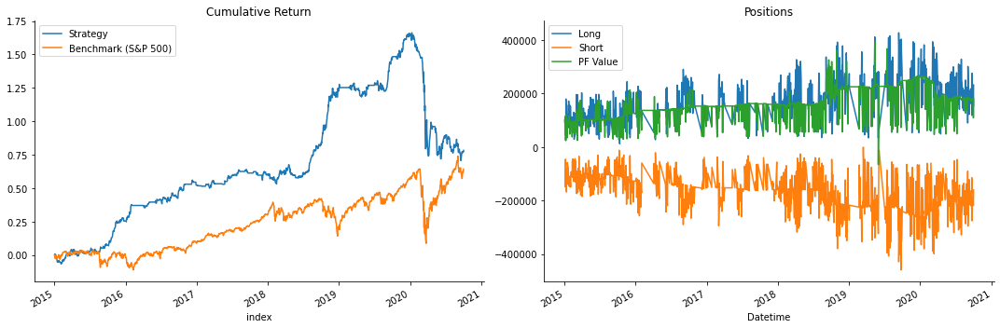

In [13]:
# Plotting returns vs S&P500
fig, axes = plt.subplots(ncols=2, figsize=(15, 5))

df = returns.to_frame('Strategy').join(benchmark.to_frame('Benchmark (S&P 500)'))
df.add(1).cumprod().sub(1).plot(ax=axes[0], title='Cumulative Return')

longs.plot(label='Long',ax=axes[1], title='Positions')
shorts.plot(ax=axes[1], label='Short')
positions.cash.plot(ax=axes[1], label='PF Value')
axes[1].legend()
sns.despine()
fig.tight_layout();

Start date,2015-01-02
End date,2020-10-01
Total months,68
,Backtest
Annual return,10.583%
Cumulative returns,78.255%
Annual volatility,13.275%
Sharpe ratio,0.83
Calmar ratio,0.29
Stability,0.81
Max drawdown,-35.918%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,35.92,2020-01-10,2020-09-17,NaT,NaN
1,7.42,2015-01-05,2015-02-05,2015-03-05,44
2,6.66,2017-09-12,2018-02-14,2018-04-05,148
3,6.03,2018-04-18,2018-06-06,2018-08-02,77
4,4.69,2015-03-30,2015-04-29,2015-07-07,72


Stress Events,mean,min,max
Fall2015,0.15%,-0.83%,1.69%
New Normal,0.04%,-9.95%,5.84%


Top 10 long positions of all time,max
sid,
AMCR,240.91%
ABT,39.84%
ALB,33.52%
BKR,32.83%
ABMD,25.35%
AAPL,24.38%
TSLA,23.03%
IDXX,22.77%
BF-B,22.74%


Top 10 short positions of all time,max
sid,
ABBV,-46.14%
A,-45.65%
ABMD,-45.12%
AMD,-41.87%
ALB,-41.13%
AES,-41.01%
AAL,-40.61%
ABT,-40.21%
ANET,-40.01%


Top 10 positions of all time,max
sid,
AMCR,240.91%
ABBV,46.14%
A,45.65%
ABMD,45.12%
AMD,41.87%
ALB,41.13%
AES,41.01%
AAL,40.61%
ABT,40.21%


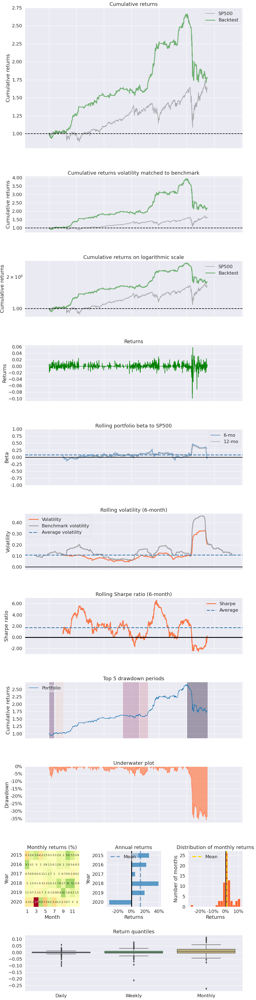

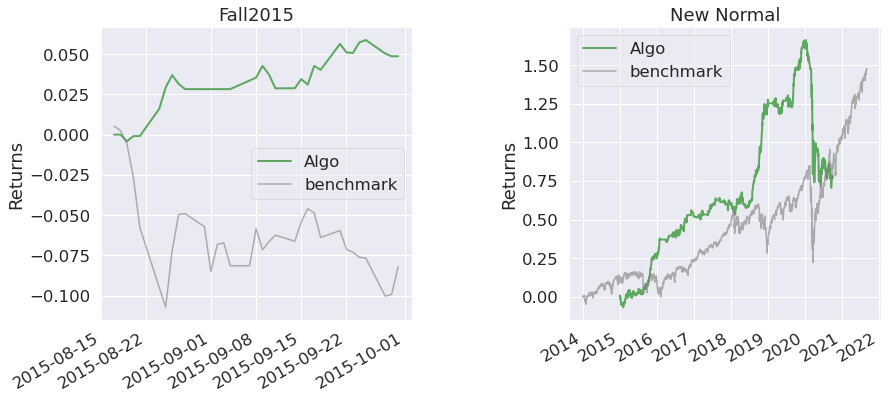

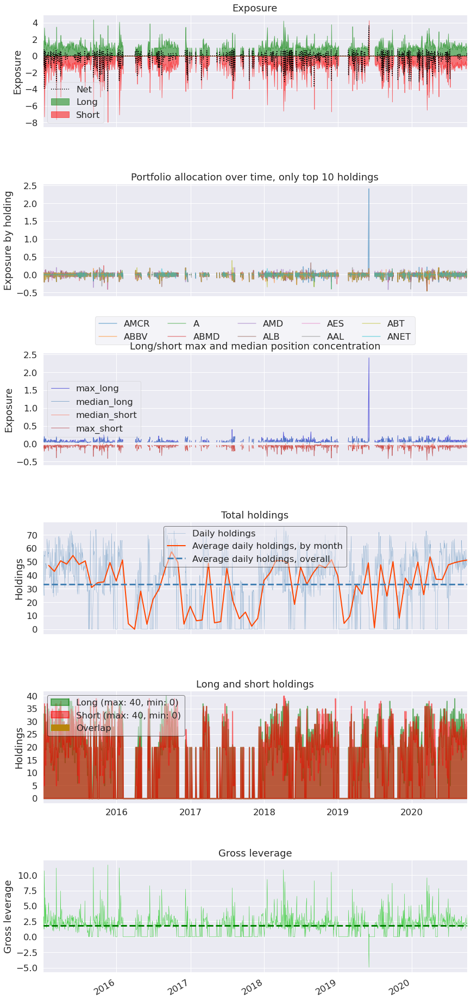

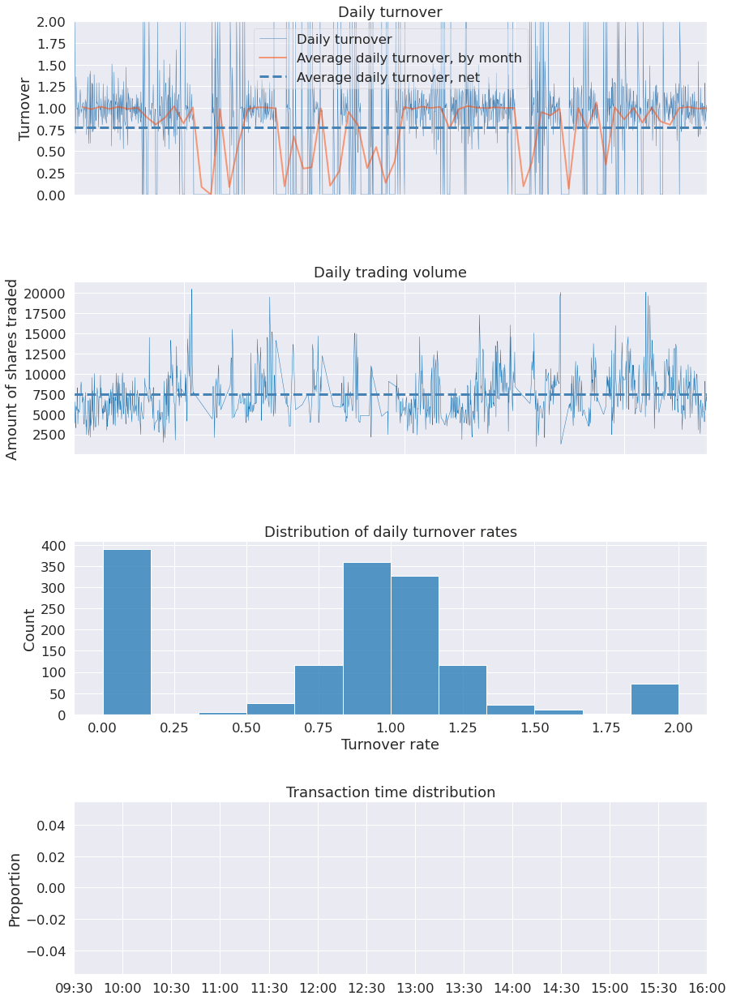

In [14]:
# Complete PyFolio evaluation
pf.create_full_tear_sheet(returns,
                          transactions=transactions,
                          positions=positions,
                          benchmark_rets=benchmark.dropna());